In [1]:
#Trying to replicate the results of "Adaptive activation functions accelerate convergence in deep and physics-informed neural networks"
import torch
import torch.autograd as autograd         # computation graph
from torch import Tensor                  # tensor node in the computation graph
import torch.nn as nn                     # neural networks
import torch.optim as optim               # optimizers e.g. gradient descent, ADAM, etc.

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.ticker
from torch.nn.parameter import Parameter

import numpy as np
import time
from pyDOE import lhs         #Latin Hypercube Sampling
import scipy.io
from scipy.io import savemat

from smt.sampling_methods import LHS

#Set default dtype to float32
torch.set_default_dtype(torch.float)

#PyTorch random number generator
torch.manual_seed(1234)

# Random number generators in other libraries
np.random.seed(1234)

# Device configuration
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

print(device)

if device == 'cuda': 
    print(torch.cuda.get_device_name())


cuda:0


In [2]:
lr_tune = np.array([8e-6,8e-5,8e-4,8e-3,8e-2]).reshape(-1,1)
n_value = np.array([1.0,3.0,5.0,8.0,10.0]).reshape(-1,1)
r_value = np.array([2,6,8]).reshape(-1,1)

LR_tune,N_value,R_value = np.meshgrid(lr_tune,n_value,r_value)

LR_tune = LR_tune.flatten('F').reshape(-1,1)
N_value = N_value.flatten('F').reshape(-1,1)
R_value = R_value.flatten('F').reshape(-1,1)


lrnr_tune = np.hstack((LR_tune,N_value,R_value))

In [3]:
def true_disc(x): #[-4,3.75]
    y  = np.zeros((np.shape(x)[0],))
    
    y = 0.2*np.sin(6*x)*np.exp(-1*x)
    y[x>0] = 1 + 0.1*x[x>0]*np.exp(x[x>0]) + 10
    
    return 50*y

In [4]:
# Domain bounds
label = "Regr_disc_rowdy"
loss_thresh = 0.1

lb = np.array(-4.0)  # [-1. 0.]
ub = np.array(3.75) # [1.  0.99]

x_test = np.linspace(lb,ub,1000).reshape(-1,1)
u_true = true_disc(x_test)

u_true_norm = np.linalg.norm(u_true,2)

In [5]:
def trainingdata(N_train,seed):
    np.random.seed(seed)
    
    x_train = np.random.uniform(low=lb, high=ub, size=(N_train,)).reshape(-1,1)

    u_train = true_disc(x_train)

    return x_train, u_train

In [6]:
rowdy_terms = 8
class Sequentialmodel(nn.Module):
    
    def __init__(self,layers,n_val,rowdy_terms):
        super().__init__() #call __init__ from parent class 
              
        'activation function'
        self.activation = nn.Tanh()
     
        'loss function'
        self.loss_function = nn.MSELoss(reduction ='mean')
        
        'Initialise neural network as a list using nn.Modulelist'  
        self.linears = nn.ModuleList([nn.Linear(layers[i], layers[i+1]) for i in range(len(layers)-1)])
     
        
        for i in range(len(layers)-1):
            nn.init.xavier_normal_(self.linears[i].weight.data, gain=1.0)
            # set biases to zero
            nn.init.zeros_(self.linears[i].bias.data)

        self.omega1 = Parameter(torch.ones((len(layers)-2,1))) 
        #self.alpha = Parameter(torch.ones((layers[1],len(layers)-2)))
        
        self.alpha = Parameter(torch.zeros(rowdy_terms,len(layers)-2))
        self.omega = Parameter((1/n_val)*torch.ones(rowdy_terms,len(layers)-2))
        
        self.n = torch.tensor(n_val)
            
            
    'foward pass'
    def forward(self,x):
        if torch.is_tensor(x) != True:         
            x = torch.from_numpy(x)                
        
        u_b = torch.from_numpy(ub).float().to(device)
        l_b = torch.from_numpy(lb).float().to(device)
                      
        #preprocessing input 
        x = (x - l_b)/(u_b - l_b) #feature scaling
        
        #convert to float
        a = x.float()
        
        for i in range(len(layers)-2):
            z = self.linears[i](a)
            a = self.activation(self.omega1[i,0]*z)
            for j in range(rowdy_terms):
                a = a + self.alpha[j,i]*self.n*torch.sin((j+1)*self.n*self.omega[j,i]*z)
    
        a = self.linears[-1](a) 
        
        return a
    
    
    def loss(self,x,u):

        loss_val = self.loss_function(self.forward(x),u)
        
        return loss_val
        
    'test neural network'
    def test(self):
        u_pred = self.forward(x_test_tensor)       
        u_pred = u_pred.cpu().detach().numpy()
        
        return u_pred
    
    def test_loss(self):
        u_pred = self.test()
        
        test_mse_loss = np.mean(np.square(u_pred.reshape(-1,1) - u_true.reshape(-1,1)))
        test_re_loss = np.linalg.norm(u_pred.reshape(-1,1) - u_true.reshape(-1,1),2)/u_true_norm
        
        return test_mse_loss, test_re_loss  

In [7]:
def data_update(loss_np):
    train_loss.append(loss_np)
    alpha_val.append(model_NN.alpha.cpu().detach().numpy())
    omega_val.append(model_NN.omega.cpu().detach().numpy())    
    test_mse, test_re = model_NN.test_loss()
    test_mse_loss.append(test_mse)
    test_re_loss.append(test_re)

In [8]:
def train_step():
    optimizer.zero_grad()     # zeroes the gradient buffers of all parameters
    loss = model_NN.loss(x_train,u_train)
    loss.backward() #backprop
    optimizer.step()
    
    return loss

In [9]:
def train_model(max_iter,rep):
    print(rep) 
   
    torch.manual_seed(rep*123)
    start_time = time.time()
    thresh_flag = 0
    
    nan_flag = 0  
    for i in range(max_iter):
        loss_np = train_step().cpu().detach().numpy()
        if(thresh_flag == 0):
            if(loss_np < loss_thresh):
                time_threshold[rep] = time.time() - start_time
                epoch_threshold[rep] = i+1            
                thresh_flag = 1
                
        data_update(loss_np)
        print(i,"Train Loss",train_loss[-1],"Test MSE",test_mse_loss[-1],"Test RE",test_re_loss[-1])
        if(np.isnan(loss_np)):
            nan_flag =1
            print("NAN BREAK!")
            break
    
    elapsed_time[rep] = time.time() - start_time
    print('Training time: %.2f' % (elapsed_time[rep]))
    
    return nan_flag

In [10]:
nan_tune = []

for tune_reps in range(75):
    label = "Regr_disc_rowdy_tune"+str(tune_reps)
    max_reps = 10
    max_iter = 500
    layers = np.array([1,50,50,50,50,1])

    train_loss_full = []
    test_mse_full = []
    test_re_full = []
    alpha_full = []
    omega_full = []
    elapsed_time= np.zeros((max_reps,1))

    time_threshold = np.empty((max_reps,1))
    time_threshold[:] = np.nan
    epoch_threshold = max_iter*np.ones((max_reps,1))
    
    n_val = lrnr_tune[tune_reps,1]
    rowdy_terms = int(lrnr_tune[tune_reps,2])


    for reps in range(max_reps):
        print(label)
        print(reps)

        train_loss = []
        test_mse_loss = []
        test_re_loss = []
        alpha_val = []
        omega_val = []
        'Generate Training data'
        N_train = 300

        x_train_np_array, u_train_np_array = trainingdata(N_train,reps*1234)

        'Convert to tensor and send to GPU'
        x_train = torch.from_numpy(x_train_np_array).float().to(device)
        u_train = torch.from_numpy(u_train_np_array).float().to(device)

        x_test_tensor = torch.from_numpy(x_test).float().to(device)


        model_NN = Sequentialmodel(layers,n_val,rowdy_terms)
        model_NN.to(device)
        print(model_NN)
        params = list(model_NN.parameters())
        #optimizer = optim.Adam(PINN.parameters(), lr=0.0008,betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)
        optimizer = optim.Adam(model_NN.parameters(), lr=lrnr_tune[tune_reps,0])

        nan_flag = train_model(max_iter,reps)
        torch.save(model_NN.state_dict(),label+'_'+str(reps)+'.pt')
        train_loss_full.append(train_loss)
        test_mse_full.append(test_mse_loss)
        test_re_full.append(test_re_loss)
        alpha_full.append(alpha_val)
        omega_full.append(omega_val)
        
        if(nan_flag == 1):
            nan_tune.append(tune_reps)
            break


    mdic = {"train_loss": train_loss_full,"test_mse": test_mse_full, "test_re": test_re_full,"Time": elapsed_time, "Thresh_time": time_threshold, "epoch_thresh": epoch_threshold,"alpha": alpha_full,"omega": omega_full, "label": label}
    savemat(label+'.mat', mdic) 

Regr_disc_rowdy_tune0
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 290442.56 Test MSE 273269.96243796276 Test RE 0.9998249046102938
1 Train Loss 290441.66 Test MSE 273269.07853991195 Test RE 0.9998232876305295
2 Train Loss 290440.7 Test MSE 273268.1942878086 Test RE 0.999821670000454
3 Train Loss 290439.78 Test MSE 273267.3096656491 Test RE 0.9998200516907875
4 Train Loss 290438.84 Test MSE 273266.42467234604 Test RE 0.9998184326995377
5 Train Loss 290437.94 Test MSE 273265.53924918495 Test RE 0.9998168129192897
6 Train Loss 290436.97 Test MSE 273264.653452476 Test RE 0.999815192453053
7 Train Loss 290436.03 Test MSE 27326

103 Train Loss 290343.28 Test MSE 273175.8850871023 Test RE 0.9996527873121144
104 Train Loss 290342.3 Test MSE 273174.93395187525 Test RE 0.9996510470307421
105 Train Loss 290341.28 Test MSE 273173.98197514575 Test RE 0.9996493052066483
106 Train Loss 290340.28 Test MSE 273173.0291907672 Test RE 0.9996475619017672
107 Train Loss 290339.25 Test MSE 273172.07556739857 Test RE 0.9996458170587453
108 Train Loss 290338.25 Test MSE 273171.12113101967 Test RE 0.9996440707251106
109 Train Loss 290337.25 Test MSE 273170.16581177386 Test RE 0.9996423227730383
110 Train Loss 290336.28 Test MSE 273169.2096290321 Test RE 0.9996405732379627
111 Train Loss 290335.22 Test MSE 273168.2526267983 Test RE 0.99963882220039
112 Train Loss 290334.22 Test MSE 273167.2947438991 Test RE 0.9996370695483828
113 Train Loss 290333.22 Test MSE 273166.33605173725 Test RE 0.9996353154125792
114 Train Loss 290332.16 Test MSE 273165.3765080369 Test RE 0.9996335597156187
115 Train Loss 290331.2 Test MSE 273164.416109851

218 Train Loss 290221.56 Test MSE 273060.5412885444 Test RE 0.9994417219695144
219 Train Loss 290220.44 Test MSE 273059.4809847993 Test RE 0.999439781533843
220 Train Loss 290219.3 Test MSE 273058.4196221644 Test RE 0.9994378391565507
221 Train Loss 290218.2 Test MSE 273057.3572095901 Test RE 0.9994358948540059
222 Train Loss 290217.06 Test MSE 273056.2936810825 Test RE 0.9994339485054226
223 Train Loss 290215.97 Test MSE 273055.2290568404 Test RE 0.9994320001477546
224 Train Loss 290214.84 Test MSE 273054.163355271 Test RE 0.9994300498146772
225 Train Loss 290213.7 Test MSE 273053.09652752004 Test RE 0.9994280974167711
226 Train Loss 290212.6 Test MSE 273052.0286378161 Test RE 0.9994261430715682
227 Train Loss 290211.4 Test MSE 273050.959632062 Test RE 0.9994241866800543
228 Train Loss 290210.3 Test MSE 273049.88953977684 Test RE 0.99942222829624
229 Train Loss 290209.2 Test MSE 273048.81837945414 Test RE 0.9994202679539592
230 Train Loss 290208.06 Test MSE 273047.7460843843 Test RE 0

338 Train Loss 290078.47 Test MSE 272924.9951314852 Test RE 0.9991936317476474
339 Train Loss 290077.2 Test MSE 272923.78975874255 Test RE 0.9991914252767864
340 Train Loss 290075.9 Test MSE 272922.5830714601 Test RE 0.9991892163947401
341 Train Loss 290074.66 Test MSE 272921.37507390766 Test RE 0.9991870051093092
342 Train Loss 290073.34 Test MSE 272920.1657247473 Test RE 0.999184791344807
343 Train Loss 290072.12 Test MSE 272918.9550334917 Test RE 0.9991825751186294
344 Train Loss 290070.8 Test MSE 272917.74300818815 Test RE 0.999180356445492
345 Train Loss 290069.53 Test MSE 272916.52959120076 Test RE 0.9991781352198724
346 Train Loss 290068.22 Test MSE 272915.31488299853 Test RE 0.9991759116256681
347 Train Loss 290066.94 Test MSE 272914.09883862373 Test RE 0.9991736855805653
348 Train Loss 290065.7 Test MSE 272912.88145301066 Test RE 0.9991714570752749
349 Train Loss 290064.38 Test MSE 272911.66273313906 Test RE 0.9991692261225568
350 Train Loss 290063.1 Test MSE 272910.4426322877

458 Train Loss 289915.22 Test MSE 272770.42019990727 Test RE 0.998910637949008
459 Train Loss 289913.78 Test MSE 272769.04544623056 Test RE 0.9989081207079499
460 Train Loss 289912.3 Test MSE 272767.66923647455 Test RE 0.9989056007943858
461 Train Loss 289910.88 Test MSE 272766.2915800759 Test RE 0.9989030782255744
462 Train Loss 289909.4 Test MSE 272764.9124733915 Test RE 0.9989005529948256
463 Train Loss 289907.97 Test MSE 272763.53190636466 Test RE 0.9988980250837042
464 Train Loss 289906.5 Test MSE 272762.14989362995 Test RE 0.9988954945189872
465 Train Loss 289905.03 Test MSE 272760.7664466405 Test RE 0.9988929613216252
466 Train Loss 289903.6 Test MSE 272759.3815217431 Test RE 0.9988904254116664
467 Train Loss 289902.12 Test MSE 272757.9951410524 Test RE 0.9988878868295837
468 Train Loss 289900.66 Test MSE 272756.60732650734 Test RE 0.9988853456155288
469 Train Loss 289899.16 Test MSE 272755.21805175795 Test RE 0.9988828017212329
470 Train Loss 289897.72 Test MSE 272753.827326553

76 Train Loss 292750.1 Test MSE 273354.92124328954 Test RE 0.9999803138025394
77 Train Loss 292749.06 Test MSE 273353.9810194356 Test RE 0.9999785940490615
78 Train Loss 292748.06 Test MSE 273353.0407040122 Test RE 0.9999768741251374
79 Train Loss 292747.0 Test MSE 273352.10026934685 Test RE 0.9999751539801492
80 Train Loss 292745.97 Test MSE 273351.15971838724 Test RE 0.9999734336194881
81 Train Loss 292744.97 Test MSE 273350.2190453353 Test RE 0.9999717130325483
82 Train Loss 292743.97 Test MSE 273349.27820427547 Test RE 0.9999699921353432
83 Train Loss 292742.88 Test MSE 273348.33719246276 Test RE 0.9999682709228511
84 Train Loss 292741.88 Test MSE 273347.39601579355 Test RE 0.9999665494058549
85 Train Loss 292740.88 Test MSE 273346.45464653254 Test RE 0.9999648275336226
86 Train Loss 292739.84 Test MSE 273345.5130793663 Test RE 0.9999631052964324
87 Train Loss 292738.8 Test MSE 273344.5712950932 Test RE 0.9999613826591615
88 Train Loss 292737.78 Test MSE 273343.62926331954 Test RE 

196 Train Loss 292623.0 Test MSE 273238.3515295195 Test RE 0.9997670748230577
197 Train Loss 292621.9 Test MSE 273237.3327719304 Test RE 0.9997652110267815
198 Train Loss 292620.78 Test MSE 273236.3131395095 Test RE 0.9997633456265398
199 Train Loss 292619.7 Test MSE 273235.2926073799 Test RE 0.9997614785768105
200 Train Loss 292618.56 Test MSE 273234.2711841586 Test RE 0.9997596098933499
201 Train Loss 292617.44 Test MSE 273233.248848632 Test RE 0.9997577395373382
202 Train Loss 292616.3 Test MSE 273232.22562274936 Test RE 0.9997558675489228
203 Train Loss 292615.22 Test MSE 273231.2014703794 Test RE 0.9997539938619916
204 Train Loss 292614.1 Test MSE 273230.17639834405 Test RE 0.9997521184890161
205 Train Loss 292612.97 Test MSE 273229.15043281205 Test RE 0.9997502414778628
206 Train Loss 292611.84 Test MSE 273228.1235550297 Test RE 0.9997483627942126
207 Train Loss 292610.72 Test MSE 273227.09578673524 Test RE 0.9997464824778263
208 Train Loss 292609.6 Test MSE 273226.0671159735 Tes

316 Train Loss 292482.5 Test MSE 273109.5069186732 Test RE 0.9995313286547881
317 Train Loss 292481.28 Test MSE 273108.3757955419 Test RE 0.9995292587997515
318 Train Loss 292480.06 Test MSE 273107.24371374643 Test RE 0.9995271871861524
319 Train Loss 292478.84 Test MSE 273106.1106692532 Test RE 0.9995251138065991
320 Train Loss 292477.6 Test MSE 273104.97666977014 Test RE 0.9995230386751858
321 Train Loss 292476.34 Test MSE 273103.8416356047 Test RE 0.999520961646069
322 Train Loss 292475.1 Test MSE 273102.70562930923 Test RE 0.9995188828337046
323 Train Loss 292473.88 Test MSE 273101.56865429855 Test RE 0.9995168022443293
324 Train Loss 292472.62 Test MSE 273100.430652342 Test RE 0.9995147197713744
325 Train Loss 292471.38 Test MSE 273099.29171292234 Test RE 0.9995126355785754
326 Train Loss 292470.12 Test MSE 273098.1517902212 Test RE 0.9995105495820776
327 Train Loss 292468.9 Test MSE 273097.010864348 Test RE 0.9995084617454697
328 Train Loss 292467.66 Test MSE 273095.8689792916 Te

433 Train Loss 292330.7 Test MSE 272970.33184081013 Test RE 0.9992766184124032
434 Train Loss 292329.34 Test MSE 272969.08088313235 Test RE 0.9992743286870293
435 Train Loss 292327.97 Test MSE 272967.8288663518 Test RE 0.9992720370178441
436 Train Loss 292326.62 Test MSE 272966.5757637394 Test RE 0.9992697433559088
437 Train Loss 292325.22 Test MSE 272965.32156374876 Test RE 0.999267447680076
438 Train Loss 292323.9 Test MSE 272964.06630174245 Test RE 0.999265150055059
439 Train Loss 292322.5 Test MSE 272962.8099293743 Test RE 0.9992628503923512
440 Train Loss 292321.16 Test MSE 272961.55244729336 Test RE 0.999260548693127
441 Train Loss 292319.78 Test MSE 272960.29391055094 Test RE 0.9992582450581383
442 Train Loss 292318.4 Test MSE 272959.0342652235 Test RE 0.9992559393886703
443 Train Loss 292317.03 Test MSE 272957.77353487484 Test RE 0.9992536317278395
444 Train Loss 292315.62 Test MSE 272956.5117152778 Test RE 0.9992513220678949
445 Train Loss 292314.25 Test MSE 272955.24885040545

45 Train Loss 279504.22 Test MSE 273281.41362684884 Test RE 0.9998458528766043
46 Train Loss 279503.5 Test MSE 273280.68752557883 Test RE 0.9998445245941276
47 Train Loss 279502.75 Test MSE 273279.96091783163 Test RE 0.9998431953833681
48 Train Loss 279502.0 Test MSE 273279.23380626144 Test RE 0.9998418652491773
49 Train Loss 279501.25 Test MSE 273278.50617146 Test RE 0.9998405341560473
50 Train Loss 279500.5 Test MSE 273277.77802910405 Test RE 0.9998392021326526
51 Train Loss 279499.78 Test MSE 273277.04938481934 Test RE 0.9998378691892806
52 Train Loss 279499.03 Test MSE 273276.3202075406 Test RE 0.9998365352690985
53 Train Loss 279498.3 Test MSE 273275.5905070667 Test RE 0.999835200390028
54 Train Loss 279497.56 Test MSE 273274.86029829195 Test RE 0.999833864579312
55 Train Loss 279496.8 Test MSE 273274.1295371619 Test RE 0.9998325277563558
56 Train Loss 279496.06 Test MSE 273273.3982482771 Test RE 0.9998311899661586
57 Train Loss 279495.3 Test MSE 273272.6664245032 Test RE 0.999829

164 Train Loss 279411.62 Test MSE 273190.57629596663 Test RE 0.9996796672661021
165 Train Loss 279410.84 Test MSE 273189.76894069323 Test RE 0.9996781900972003
166 Train Loss 279409.97 Test MSE 273188.96078124206 Test RE 0.9996767114547566
167 Train Loss 279409.2 Test MSE 273188.1518123801 Test RE 0.9996752313291908
168 Train Loss 279408.3 Test MSE 273187.3419916036 Test RE 0.9996737496427291
169 Train Loss 279407.53 Test MSE 273186.5313472749 Test RE 0.9996722664472579
170 Train Loss 279406.7 Test MSE 273185.7198959625 Test RE 0.9996707817730851
171 Train Loss 279405.88 Test MSE 273184.90764502244 Test RE 0.9996692956336629
172 Train Loss 279405.03 Test MSE 273184.09453847125 Test RE 0.9996678079265545
173 Train Loss 279404.22 Test MSE 273183.2806398306 Test RE 0.9996663187679756
174 Train Loss 279403.38 Test MSE 273182.46590353514 Test RE 0.9996648280745506
175 Train Loss 279402.53 Test MSE 273181.6503746908 Test RE 0.9996633359288016
176 Train Loss 279401.72 Test MSE 273180.83398243

284 Train Loss 279306.5 Test MSE 273087.40227378794 Test RE 0.9994908783379902
285 Train Loss 279305.6 Test MSE 273086.4850349489 Test RE 0.9994891998046436
286 Train Loss 279304.66 Test MSE 273085.5667885101 Test RE 0.9994875194245806
287 Train Loss 279303.72 Test MSE 273084.64752364095 Test RE 0.9994858371779723
288 Train Loss 279302.78 Test MSE 273083.7272310951 Test RE 0.9994841530478884
289 Train Loss 279301.84 Test MSE 273082.8059488956 Test RE 0.9994824671039019
290 Train Loss 279300.88 Test MSE 273081.88364506944 Test RE 0.9994807792874927
291 Train Loss 279299.97 Test MSE 273080.9602828818 Test RE 0.9994790895314263
292 Train Loss 279299.0 Test MSE 273080.03590873495 Test RE 0.9994773979206096
293 Train Loss 279298.06 Test MSE 273079.11051793746 Test RE 0.9994757044464475
294 Train Loss 279297.12 Test MSE 273078.18408999214 Test RE 0.999474009071421
295 Train Loss 279296.2 Test MSE 273077.2566541019 Test RE 0.9994723118489617
296 Train Loss 279295.22 Test MSE 273076.3281643732

406 Train Loss 279184.5 Test MSE 272967.5655807483 Test RE 0.9992715551039023
407 Train Loss 279183.38 Test MSE 272966.5134786838 Test RE 0.999269629350055
408 Train Loss 279182.3 Test MSE 272965.4601925128 Test RE 0.999267701425117
409 Train Loss 279181.25 Test MSE 272964.40568406513 Test RE 0.9992657712592098
410 Train Loss 279180.16 Test MSE 272963.3500062743 Test RE 0.9992638389492091
411 Train Loss 279179.1 Test MSE 272962.2931267629 Test RE 0.9992619044358394
412 Train Loss 279178.03 Test MSE 272961.2350108095 Test RE 0.999259967655533
413 Train Loss 279176.94 Test MSE 272960.1757425593 Test RE 0.9992580287622975
414 Train Loss 279175.84 Test MSE 272959.11527001 Test RE 0.9992560876609342
415 Train Loss 279174.78 Test MSE 272958.0535796095 Test RE 0.999254144326625
416 Train Loss 279173.72 Test MSE 272956.99065446947 Test RE 0.9992521987284437
417 Train Loss 279172.6 Test MSE 272955.9265080487 Test RE 0.999250250891012
418 Train Loss 279171.53 Test MSE 272954.8611387686 Test RE 0

24 Train Loss 305639.47 Test MSE 273410.811947272 Test RE 1.0000825375834748
25 Train Loss 305638.4 Test MSE 273409.8295391769 Test RE 1.000080740854852
26 Train Loss 305637.28 Test MSE 273408.8472340247 Test RE 1.0000789443112743
27 Train Loss 305636.2 Test MSE 273407.8650394954 Test RE 1.0000771479667885
28 Train Loss 305635.1 Test MSE 273406.88295055286 Test RE 1.0000753518121854
29 Train Loss 305634.0 Test MSE 273405.9009513373 Test RE 1.000073555818459
30 Train Loss 305632.9 Test MSE 273404.9190261146 Test RE 1.000071759956835
31 Train Loss 305631.78 Test MSE 273403.9372262905 Test RE 1.0000699643213302
32 Train Loss 305630.7 Test MSE 273402.955498242 Test RE 1.000068168813874
33 Train Loss 305629.6 Test MSE 273401.97385198117 Test RE 1.000066373452778
34 Train Loss 305628.5 Test MSE 273400.9922966974 Test RE 1.0000645782548498
35 Train Loss 305627.4 Test MSE 273400.010784343 Test RE 1.000062783132214
36 Train Loss 305626.3 Test MSE 273399.0293644004 Test RE 1.0000609881753721
37 

143 Train Loss 305507.25 Test MSE 273292.58979780634 Test RE 0.9998662976148484
144 Train Loss 305506.16 Test MSE 273291.55984859343 Test RE 0.999864413530693
145 Train Loss 305504.97 Test MSE 273290.5288985994 Test RE 0.9998625276122551
146 Train Loss 305503.8 Test MSE 273289.49691402033 Test RE 0.9998606397976865
147 Train Loss 305502.7 Test MSE 273288.46396606823 Test RE 0.9998587502172455
148 Train Loss 305501.5 Test MSE 273287.42997645703 Test RE 0.9998568587277123
149 Train Loss 305500.38 Test MSE 273286.39493910637 Test RE 0.9998549653179528
150 Train Loss 305499.2 Test MSE 273285.3588955304 Test RE 0.9998530700638998
151 Train Loss 305498.03 Test MSE 273284.3218190942 Test RE 0.9998511729168178
152 Train Loss 305496.88 Test MSE 273283.2836934327 Test RE 0.9998492738467591
153 Train Loss 305495.75 Test MSE 273282.2445251318 Test RE 0.9998473728657614
154 Train Loss 305494.56 Test MSE 273281.20430642465 Test RE 0.9998454699596044
155 Train Loss 305493.4 Test MSE 273280.1630353745

259 Train Loss 305365.44 Test MSE 273165.665970211 Test RE 0.999634089350872
260 Train Loss 305364.16 Test MSE 273164.50177406025 Test RE 0.9996319591940773
261 Train Loss 305362.88 Test MSE 273163.3363279958 Test RE 0.9996298267457397
262 Train Loss 305361.56 Test MSE 273162.1696047098 Test RE 0.9996276919558789
263 Train Loss 305360.22 Test MSE 273161.0015689124 Test RE 0.9996255547599082
264 Train Loss 305358.94 Test MSE 273159.8322839602 Test RE 0.9996234152737382
265 Train Loss 305357.6 Test MSE 273158.66170175327 Test RE 0.9996212734093447
266 Train Loss 305356.3 Test MSE 273157.4898242399 Test RE 0.9996191291702766
267 Train Loss 305355.0 Test MSE 273156.31670953595 Test RE 0.9996169826628559
268 Train Loss 305353.72 Test MSE 273155.1422924262 Test RE 0.9996148337677401
269 Train Loss 305352.38 Test MSE 273153.9665831054 Test RE 0.999612682503568
270 Train Loss 305351.06 Test MSE 273152.78960485716 Test RE 0.9996105289129285
271 Train Loss 305349.78 Test MSE 273151.6113104803 Te

380 Train Loss 305197.2 Test MSE 273015.0388131716 Test RE 0.9993584456256592
381 Train Loss 305195.72 Test MSE 273013.70765626547 Test RE 0.999356009304708
382 Train Loss 305194.2 Test MSE 273012.3750369664 Test RE 0.9993535703012946
383 Train Loss 305192.75 Test MSE 273011.04090026626 Test RE 0.9993511285147215
384 Train Loss 305191.22 Test MSE 273009.7052694149 Test RE 0.9993486839875206
385 Train Loss 305189.72 Test MSE 273008.36813800514 Test RE 0.9993462367079459
386 Train Loss 305188.25 Test MSE 273007.0295379057 Test RE 0.9993437867343047
387 Train Loss 305186.72 Test MSE 273005.6894515951 Test RE 0.999341334034508
388 Train Loss 305185.25 Test MSE 273004.34787437646 Test RE 0.9993388785999398
389 Train Loss 305183.75 Test MSE 273003.00479385897 Test RE 0.9993364204079008
390 Train Loss 305182.25 Test MSE 273001.6602353797 Test RE 0.9993339595047449
391 Train Loss 305180.72 Test MSE 273000.31414257555 Test RE 0.9993314957872921
392 Train Loss 305179.22 Test MSE 272998.966566267

484 Train Loss 305033.4 Test MSE 272868.3879658406 Test RE 0.9990900053785314
485 Train Loss 305031.75 Test MSE 272866.89472103416 Test RE 0.9990872716650114
486 Train Loss 305030.06 Test MSE 272865.3998674617 Test RE 0.9990845349987986
487 Train Loss 305028.38 Test MSE 272863.9033751272 Test RE 0.9990817953249543
488 Train Loss 305026.72 Test MSE 272862.4052449485 Test RE 0.999079052645134
489 Train Loss 305025.06 Test MSE 272860.9054663652 Test RE 0.9990763069399794
490 Train Loss 305023.38 Test MSE 272859.40404526156 Test RE 0.9990735582202381
491 Train Loss 305021.72 Test MSE 272857.9009806484 Test RE 0.9990708064840748
492 Train Loss 305020.0 Test MSE 272856.3962397969 Test RE 0.9990680516715454
493 Train Loss 305018.34 Test MSE 272854.8898583206 Test RE 0.9990652938478247
494 Train Loss 305016.66 Test MSE 272853.3817893594 Test RE 0.9990625329270978
495 Train Loss 305015.0 Test MSE 272851.8721148084 Test RE 0.9990597690592704
496 Train Loss 305013.28 Test MSE 272850.3607702181 Te

90 Train Loss 257973.73 Test MSE 272953.9505196225 Test RE 0.9992466339874898
91 Train Loss 257972.55 Test MSE 272952.69857149466 Test RE 0.9992443423804535
92 Train Loss 257971.34 Test MSE 272951.445724892 Test RE 0.9992420491235583
93 Train Loss 257970.14 Test MSE 272950.1920219623 Test RE 0.9992397542939417
94 Train Loss 257968.9 Test MSE 272948.93744718813 Test RE 0.9992374578631896
95 Train Loss 257967.72 Test MSE 272947.68198786664 Test RE 0.9992351598080386
96 Train Loss 257966.52 Test MSE 272946.42563461117 Test RE 0.9992328601112952
97 Train Loss 257965.34 Test MSE 272945.1683625505 Test RE 0.999230558727423
98 Train Loss 257964.11 Test MSE 272943.9102487909 Test RE 0.9992282557975504
99 Train Loss 257962.89 Test MSE 272942.6512523292 Test RE 0.9992259512466115
100 Train Loss 257961.72 Test MSE 272941.39126226585 Test RE 0.9992236448715968
101 Train Loss 257960.48 Test MSE 272940.13037350116 Test RE 0.9992213368462065
102 Train Loss 257959.28 Test MSE 272938.8685567214 Test RE

210 Train Loss 257822.94 Test MSE 272796.6230703786 Test RE 0.9989586154706912
211 Train Loss 257821.61 Test MSE 272795.245567598 Test RE 0.9989560933170222
212 Train Loss 257820.33 Test MSE 272793.86686159845 Test RE 0.99895356895393
213 Train Loss 257819.0 Test MSE 272792.48700081866 Test RE 0.9989510424700876
214 Train Loss 257817.66 Test MSE 272791.10590286064 Test RE 0.9989485137146109
215 Train Loss 257816.36 Test MSE 272789.7236279004 Test RE 0.998945982797663
216 Train Loss 257815.02 Test MSE 272788.34008370305 Test RE 0.998943449550347
217 Train Loss 257813.72 Test MSE 272786.95536194474 Test RE 0.9989409141405032
218 Train Loss 257812.38 Test MSE 272785.56941259914 Test RE 0.9989383764765176
219 Train Loss 257811.05 Test MSE 272784.18227987195 Test RE 0.9989358366393134
220 Train Loss 257809.72 Test MSE 272782.7939553048 Test RE 0.9989332946133863
221 Train Loss 257808.38 Test MSE 272781.4044331067 Test RE 0.9989307503881171
222 Train Loss 257807.05 Test MSE 272780.0136965263

329 Train Loss 257657.2 Test MSE 272623.775161663 Test RE 0.9986420879683955
330 Train Loss 257655.73 Test MSE 272622.2420637678 Test RE 0.9986392800360449
331 Train Loss 257654.27 Test MSE 272620.7075598649 Test RE 0.9986364695206269
332 Train Loss 257652.81 Test MSE 272619.17164598947 Test RE 0.9986336564148578
333 Train Loss 257651.31 Test MSE 272617.63432283915 Test RE 0.9986308407199936
334 Train Loss 257649.81 Test MSE 272616.0955767564 Test RE 0.9986280224109975
335 Train Loss 257648.36 Test MSE 272614.5554531797 Test RE 0.9986252015710715
336 Train Loss 257646.89 Test MSE 272613.0139044204 Test RE 0.9986223781128482
337 Train Loss 257645.39 Test MSE 272611.47096727265 Test RE 0.9986195521036971
338 Train Loss 257643.92 Test MSE 272609.9265561148 Test RE 0.9986167233867733
339 Train Loss 257642.44 Test MSE 272608.3807343663 Test RE 0.9986138920782123
340 Train Loss 257640.97 Test MSE 272606.83347181766 Test RE 0.99861105812266
341 Train Loss 257639.47 Test MSE 272605.28483322606

447 Train Loss 257473.95 Test MSE 272432.8153337644 Test RE 0.9982922763516876
448 Train Loss 257472.3 Test MSE 272431.10789419396 Test RE 0.9982891480090093
449 Train Loss 257470.67 Test MSE 272429.39892743545 Test RE 0.9982860168584257
450 Train Loss 257469.02 Test MSE 272427.6884021716 Test RE 0.9982828828425312
451 Train Loss 257467.36 Test MSE 272425.97637905116 Test RE 0.9982797460724193
452 Train Loss 257465.72 Test MSE 272424.2628211543 Test RE 0.9982766064804192
453 Train Loss 257464.1 Test MSE 272422.54772312474 Test RE 0.9982734640566907
454 Train Loss 257462.45 Test MSE 272420.8310449586 Test RE 0.9982703187279106
455 Train Loss 257460.81 Test MSE 272419.1129132029 Test RE 0.9982671707259144
456 Train Loss 257459.16 Test MSE 272417.39318988705 Test RE 0.9982640197978833
457 Train Loss 257457.5 Test MSE 272415.6719670022 Test RE 0.9982608661123387
458 Train Loss 257455.81 Test MSE 272413.9491372664 Test RE 0.9982577094726875
459 Train Loss 257454.17 Test MSE 272412.224783961

66 Train Loss 263898.03 Test MSE 273420.1475757002 Test RE 1.0000996113765799
67 Train Loss 263897.16 Test MSE 273419.2265565987 Test RE 1.0000979269512928
68 Train Loss 263896.28 Test MSE 273418.30573627056 Test RE 1.0000962428867004
69 Train Loss 263895.38 Test MSE 273417.3851060196 Test RE 1.0000945591669004
70 Train Loss 263894.5 Test MSE 273416.4646565024 Test RE 1.0000928757748064
71 Train Loss 263893.6 Test MSE 273415.5443859056 Test RE 1.0000911927071037
72 Train Loss 263892.72 Test MSE 273414.6242764632 Test RE 1.0000895099313019
73 Train Loss 263891.8 Test MSE 273413.7043243779 Test RE 1.0000878274404577
74 Train Loss 263890.94 Test MSE 273412.78453999205 Test RE 1.0000861452534875
75 Train Loss 263890.06 Test MSE 273411.8649196306 Test RE 1.0000844633636716
76 Train Loss 263889.16 Test MSE 273410.9454517802 Test RE 1.0000827817499547
77 Train Loss 263888.28 Test MSE 273410.0261131127 Test RE 1.0000811003696732
78 Train Loss 263887.4 Test MSE 273409.1069229014 Test RE 1.00007

182 Train Loss 263795.22 Test MSE 273313.2149938447 Test RE 0.9999040264997413
183 Train Loss 263794.3 Test MSE 273312.2777305869 Test RE 0.9999023120306678
184 Train Loss 263793.4 Test MSE 273311.3399128775 Test RE 0.9999005965444334
185 Train Loss 263792.5 Test MSE 273310.4015489875 Test RE 0.9998988800561619
186 Train Loss 263791.6 Test MSE 273309.46260206 Test RE 0.9998971624984287
187 Train Loss 263790.7 Test MSE 273308.52306494705 Test RE 0.9998954438581522
188 Train Loss 263789.78 Test MSE 273307.5829580472 Test RE 0.9998937241726417
189 Train Loss 263788.88 Test MSE 273306.64222509 Test RE 0.9998920033389578
190 Train Loss 263787.94 Test MSE 273305.70090472494 Test RE 0.9998902814277957
191 Train Loss 263787.03 Test MSE 273304.7589811903 Test RE 0.999888558410316
192 Train Loss 263786.12 Test MSE 273303.8164566211 Test RE 0.9998868342904204
193 Train Loss 263785.22 Test MSE 273302.8733078207 Test RE 0.999885109025669
194 Train Loss 263784.3 Test MSE 273301.92953269515 Test RE 0

302 Train Loss 263681.78 Test MSE 273195.1853988106 Test RE 0.9996881002198041
303 Train Loss 263680.78 Test MSE 273194.1457489198 Test RE 0.9996861980511923
304 Train Loss 263679.78 Test MSE 273193.10505724204 Test RE 0.9996842939728774
305 Train Loss 263678.78 Test MSE 273192.0633586852 Test RE 0.9996823880487167
306 Train Loss 263677.78 Test MSE 273191.0206206848 Test RE 0.9996804802191182
307 Train Loss 263676.78 Test MSE 273189.9768434166 Test RE 0.9996785704843928
308 Train Loss 263675.78 Test MSE 273188.93205225375 Test RE 0.9996766588909536
309 Train Loss 263674.78 Test MSE 273187.88622257905 Test RE 0.9996747453937493
310 Train Loss 263673.78 Test MSE 273186.83937950374 Test RE 0.9996728300387133
311 Train Loss 263672.75 Test MSE 273185.7915051858 Test RE 0.9996709127931902
312 Train Loss 263671.75 Test MSE 273184.74261111685 Test RE 0.9996689936781953
313 Train Loss 263670.72 Test MSE 273183.692699858 Test RE 0.9996670726984034
314 Train Loss 263669.72 Test MSE 273182.6417223

420 Train Loss 263556.88 Test MSE 273065.10909384955 Test RE 0.9994500813540055
421 Train Loss 263555.75 Test MSE 273063.9400641216 Test RE 0.9994479419592817
422 Train Loss 263554.62 Test MSE 273062.76985617745 Test RE 0.9994458004037652
423 Train Loss 263553.5 Test MSE 273061.5984916577 Test RE 0.9994436567270454
424 Train Loss 263552.38 Test MSE 273060.42594896624 Test RE 0.9994415108895864
425 Train Loss 263551.25 Test MSE 273059.2522470921 Test RE 0.9994393629261259
426 Train Loss 263550.12 Test MSE 273058.0773804174 Test RE 0.9994372128263688
427 Train Loss 263548.97 Test MSE 273056.9013638652 Test RE 0.9994350606176114
428 Train Loss 263547.84 Test MSE 273055.72416414804 Test RE 0.9994329062389217
429 Train Loss 263546.72 Test MSE 273054.5458055064 Test RE 0.999430749734648
430 Train Loss 263545.6 Test MSE 273053.3662256997 Test RE 0.9994285909908699
431 Train Loss 263544.5 Test MSE 273052.1854624636 Test RE 0.9994264300766327
432 Train Loss 263543.34 Test MSE 273051.0035393245 

39 Train Loss 310740.16 Test MSE 273408.3581118943 Test RE 1.0000780497517756
40 Train Loss 310739.22 Test MSE 273407.491736664 Test RE 1.000076465229007
41 Train Loss 310738.25 Test MSE 273406.6254852376 Test RE 1.0000748809301545
42 Train Loss 310737.28 Test MSE 273405.7593969699 Test RE 1.0000732969271966
43 Train Loss 310736.3 Test MSE 273404.8934268974 Test RE 1.000071713137899
44 Train Loss 310735.3 Test MSE 273404.02761065937 Test RE 1.0000701296274448
45 Train Loss 310734.34 Test MSE 273403.16191366065 Test RE 1.0000685463325631
46 Train Loss 310733.4 Test MSE 273402.2963506348 Test RE 1.000066963280202
47 Train Loss 310732.44 Test MSE 273401.43088811595 Test RE 1.0000653804091553
48 Train Loss 310731.47 Test MSE 273400.56554188766 Test RE 1.000063797748291
49 Train Loss 310730.5 Test MSE 273399.70030591666 Test RE 1.0000622152865757
50 Train Loss 310729.56 Test MSE 273398.8351680856 Test RE 1.0000606330018487
51 Train Loss 310728.6 Test MSE 273397.9701213169 Test RE 1.00005905

159 Train Loss 310623.22 Test MSE 273303.3872968379 Test RE 0.9998860492457932
160 Train Loss 310622.2 Test MSE 273302.48121773655 Test RE 0.9998843917899287
161 Train Loss 310621.2 Test MSE 273301.57420569734 Test RE 0.9998827326247258
162 Train Loss 310620.16 Test MSE 273300.6662446881 Test RE 0.9998810717208473
163 Train Loss 310619.16 Test MSE 273299.75733964884 Test RE 0.9998794090873222
164 Train Loss 310618.16 Test MSE 273298.8474848585 Test RE 0.9998777447136759
165 Train Loss 310617.12 Test MSE 273297.9366527087 Test RE 0.9998760785493968
166 Train Loss 310616.1 Test MSE 273297.0248602296 Test RE 0.9998744106256278
167 Train Loss 310615.1 Test MSE 273296.11206697294 Test RE 0.9998727408683704
168 Train Loss 310614.1 Test MSE 273295.1982921087 Test RE 0.9998710693126814
169 Train Loss 310613.06 Test MSE 273294.2835224331 Test RE 0.999869395934399
170 Train Loss 310612.03 Test MSE 273293.367734816 Test RE 0.9998677206912014
171 Train Loss 310611.0 Test MSE 273292.45093361277 Tes

280 Train Loss 310491.97 Test MSE 273185.4959323663 Test RE 0.9996703719970741
281 Train Loss 310490.78 Test MSE 273184.44466931024 Test RE 0.9996684485466032
282 Train Loss 310489.6 Test MSE 273183.39206541463 Test RE 0.9996665226391487
283 Train Loss 310488.44 Test MSE 273182.33808970376 Test RE 0.9996645942180209
284 Train Loss 310487.25 Test MSE 273181.2827547184 Test RE 0.9996626633061506
285 Train Loss 310486.1 Test MSE 273180.2260725478 Test RE 0.999660729925643
286 Train Loss 310484.9 Test MSE 273179.1680322255 Test RE 0.999658794056418
287 Train Loss 310483.75 Test MSE 273178.1086053582 Test RE 0.9996568556465111
288 Train Loss 310482.56 Test MSE 273177.047817954 Test RE 0.9996549147434938
289 Train Loss 310481.38 Test MSE 273175.98568508547 Test RE 0.9996529713749298
290 Train Loss 310480.2 Test MSE 273174.92218012305 Test RE 0.9996510254920812
291 Train Loss 310479.0 Test MSE 273173.85730703035 Test RE 0.999649077102185
292 Train Loss 310477.8 Test MSE 273172.7910768617 Test

400 Train Loss 310340.22 Test MSE 273049.1541020305 Test RE 0.9994208823639501
401 Train Loss 310338.88 Test MSE 273047.92693310743 Test RE 0.9994186365052693
402 Train Loss 310337.5 Test MSE 273046.69815028587 Test RE 0.9994163876879143
403 Train Loss 310336.12 Test MSE 273045.46784115996 Test RE 0.999414136072173
404 Train Loss 310334.75 Test MSE 273044.2359298516 Test RE 0.9994118815191593
405 Train Loss 310333.4 Test MSE 273043.00244500214 Test RE 0.9994096240812718
406 Train Loss 310332.0 Test MSE 273041.76736427675 Test RE 0.999407363717614
407 Train Loss 310330.62 Test MSE 273040.53070410364 Test RE 0.9994051004582328
408 Train Loss 310329.22 Test MSE 273039.2924517991 Test RE 0.9994028342798956
409 Train Loss 310327.9 Test MSE 273038.0525592244 Test RE 0.9994005650944807
410 Train Loss 310326.5 Test MSE 273036.8110790197 Test RE 0.9993982929983078
411 Train Loss 310325.1 Test MSE 273035.56802965555 Test RE 0.9993960180251612
412 Train Loss 310323.75 Test MSE 273034.32334238896 

18 Train Loss 306012.66 Test MSE 273318.7844650791 Test RE 0.9999142142770547
19 Train Loss 306011.66 Test MSE 273317.89250542875 Test RE 0.9999125826953429
20 Train Loss 306010.7 Test MSE 273317.000325415 Test RE 0.9999109507078767
21 Train Loss 306009.72 Test MSE 273316.1079047256 Test RE 0.9999093182774985
22 Train Loss 306008.7 Test MSE 273315.21522311453 Test RE 0.999907685367172
23 Train Loss 306007.75 Test MSE 273314.3222979987 Test RE 0.9999060520087542
24 Train Loss 306006.75 Test MSE 273313.42910206516 Test RE 0.9999044181522813
25 Train Loss 306005.78 Test MSE 273312.5356350963 Test RE 0.9999027837973528
26 Train Loss 306004.8 Test MSE 273311.64188915485 Test RE 0.9999011489294469
27 Train Loss 306003.78 Test MSE 273310.7478589064 Test RE 0.9998995135388038
28 Train Loss 306002.84 Test MSE 273309.85354038834 Test RE 0.999897877618172
29 Train Loss 306001.84 Test MSE 273308.9589247198 Test RE 0.9998962411513034
30 Train Loss 306000.88 Test MSE 273308.06401509664 Test RE 0.999

139 Train Loss 305890.7 Test MSE 273207.76037177304 Test RE 0.9997111074081577
140 Train Loss 305889.66 Test MSE 273206.80733595113 Test RE 0.9997093637510109
141 Train Loss 305888.6 Test MSE 273205.8536139262 Test RE 0.9997076188353549
142 Train Loss 305887.6 Test MSE 273204.8991538331 Test RE 0.9997058725662915
143 Train Loss 305886.5 Test MSE 273203.94398471736 Test RE 0.9997041249969544
144 Train Loss 305885.47 Test MSE 273202.9880846319 Test RE 0.9997023760871829
145 Train Loss 305884.44 Test MSE 273202.03145537566 Test RE 0.9997006258402613
146 Train Loss 305883.38 Test MSE 273201.0740891621 Test RE 0.9996988742419368
147 Train Loss 305882.3 Test MSE 273200.1159533685 Test RE 0.9996971212325144
148 Train Loss 305881.28 Test MSE 273199.1570877006 Test RE 0.9996953668846336
149 Train Loss 305880.22 Test MSE 273198.197474612 Test RE 0.9996936111661837
150 Train Loss 305879.2 Test MSE 273197.23711180093 Test RE 0.9996918540729468
151 Train Loss 305878.12 Test MSE 273196.2759851852 Te

259 Train Loss 305758.5 Test MSE 273087.27919875685 Test RE 0.9994906531126895
260 Train Loss 305757.3 Test MSE 273086.21496991994 Test RE 0.9994887055891455
261 Train Loss 305756.16 Test MSE 273085.1496086101 Test RE 0.9994867559893915
262 Train Loss 305754.97 Test MSE 273084.0831244957 Test RE 0.9994848043311082
263 Train Loss 305753.78 Test MSE 273083.0154958785 Test RE 0.9994828505745758
264 Train Loss 305752.66 Test MSE 273081.94667188136 Test RE 0.9994808946266772
265 Train Loss 305751.47 Test MSE 273080.8767356782 Test RE 0.9994789366396076
266 Train Loss 305750.3 Test MSE 273079.8056358279 Test RE 0.9994769765192179
267 Train Loss 305749.1 Test MSE 273078.7333944337 Test RE 0.9994750143059442
268 Train Loss 305747.97 Test MSE 273077.6600271048 Test RE 0.9994730500283395
269 Train Loss 305746.75 Test MSE 273076.5854878807 Test RE 0.9994710836022832
270 Train Loss 305745.6 Test MSE 273075.50976210117 Test RE 0.9994691150009335
271 Train Loss 305744.38 Test MSE 273074.43289268157 

378 Train Loss 305609.88 Test MSE 272951.7892563982 Test RE 0.999242677936894
379 Train Loss 305608.53 Test MSE 272950.56766823505 Test RE 0.9992404418929455
380 Train Loss 305607.2 Test MSE 272949.3445395339 Test RE 0.9992382030241211
381 Train Loss 305605.88 Test MSE 272948.1199332572 Test RE 0.999235961445652
382 Train Loss 305604.5 Test MSE 272946.89378883963 Test RE 0.999233717046657
383 Train Loss 305603.16 Test MSE 272945.6661466316 Test RE 0.9992314699009778
384 Train Loss 305601.78 Test MSE 272944.4369541822 Test RE 0.9992292199125863
385 Train Loss 305600.47 Test MSE 272943.2062785341 Test RE 0.9992269672041819
386 Train Loss 305599.1 Test MSE 272941.97409698594 Test RE 0.999224711734193
387 Train Loss 305597.75 Test MSE 272940.7403299881 Test RE 0.9992224533569863
388 Train Loss 305596.38 Test MSE 272939.5050496079 Test RE 0.9992201922044608
389 Train Loss 305595.03 Test MSE 272938.26825474243 Test RE 0.9992179282745786
390 Train Loss 305593.7 Test MSE 272937.02988730645 Tes

493 Train Loss 305444.3 Test MSE 272800.80694703956 Test RE 0.9989662759460377
494 Train Loss 305442.8 Test MSE 272799.39592026937 Test RE 0.9989636924309883
495 Train Loss 305441.22 Test MSE 272797.98313565314 Test RE 0.9989611056907222
496 Train Loss 305439.72 Test MSE 272796.5685516314 Test RE 0.9989585156491206
497 Train Loss 305438.16 Test MSE 272795.152200124 Test RE 0.9989559223646016
498 Train Loss 305436.56 Test MSE 272793.7340792134 Test RE 0.9989533258336298
499 Train Loss 305435.03 Test MSE 272792.31416585826 Test RE 0.998950726013991
Training time: 2.57
Regr_disc_rowdy_tune0
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 T

98 Train Loss 274194.88 Test MSE 273395.2006992815 Test RE 1.000053985751047
99 Train Loss 274193.94 Test MSE 273394.29417965945 Test RE 1.0000523277678228
100 Train Loss 274193.0 Test MSE 273393.3876580493 Test RE 1.0000506697782137
101 Train Loss 274192.06 Test MSE 273392.4811409196 Test RE 1.0000490117940504
102 Train Loss 274191.1 Test MSE 273391.5745940074 Test RE 1.000047353752667
103 Train Loss 274190.12 Test MSE 273390.66802567744 Test RE 1.0000456956693624
104 Train Loss 274189.22 Test MSE 273389.76142600074 Test RE 1.0000440375259765
105 Train Loss 274188.28 Test MSE 273388.8547760256 Test RE 1.0000423792878461
106 Train Loss 274187.3 Test MSE 273387.9481098677 Test RE 1.000040721017369
107 Train Loss 274186.34 Test MSE 273387.0414018336 Test RE 1.0000390626675508
108 Train Loss 274185.4 Test MSE 273386.13462873775 Test RE 1.0000374041959859
109 Train Loss 274184.5 Test MSE 273385.22780065035 Test RE 1.0000357456210915
110 Train Loss 274183.53 Test MSE 273384.3208983886 Test 

211 Train Loss 274086.5 Test MSE 273291.1625398768 Test RE 0.9998636867336567
212 Train Loss 274085.5 Test MSE 273290.2112536798 Test RE 0.9998619465431897
213 Train Loss 274084.5 Test MSE 273289.2591327894 Test RE 0.9998602048227825
214 Train Loss 274083.53 Test MSE 273288.30617586884 Test RE 0.9998584615699826
215 Train Loss 274082.5 Test MSE 273287.3523651154 Test RE 0.9998567167522148
216 Train Loss 274081.53 Test MSE 273286.39769710344 Test RE 0.9998549703632044
217 Train Loss 274080.53 Test MSE 273285.4421796351 Test RE 0.9998532224172156
218 Train Loss 274079.53 Test MSE 273284.48581319035 Test RE 0.9998514729151191
219 Train Loss 274078.5 Test MSE 273283.5285518312 Test RE 0.9998497217728702
220 Train Loss 274077.53 Test MSE 273282.57041585475 Test RE 0.9998479690275914
221 Train Loss 274076.53 Test MSE 273281.6113960222 Test RE 0.999846214662372
222 Train Loss 274075.56 Test MSE 273280.65148489206 Test RE 0.9998444586635915
223 Train Loss 274074.53 Test MSE 273279.6906764351 T

326 Train Loss 273965.7 Test MSE 273175.133487045 Test RE 0.9996514121182374
327 Train Loss 273964.56 Test MSE 273174.0588479177 Test RE 0.999649445860248
328 Train Loss 273963.47 Test MSE 273172.98300376075 Test RE 0.9996474773935515
329 Train Loss 273962.34 Test MSE 273171.9059580171 Test RE 0.9996455067244355
330 Train Loss 273961.22 Test MSE 273170.82766220823 Test RE 0.9996435337641851
331 Train Loss 273960.1 Test MSE 273169.7481638442 Test RE 0.9996415585997165
332 Train Loss 273958.97 Test MSE 273168.66742175235 Test RE 0.999639581155682
333 Train Loss 273957.84 Test MSE 273167.5854119756 Test RE 0.9996376013882342
334 Train Loss 273956.7 Test MSE 273166.50221414707 Test RE 0.9996356194430652
335 Train Loss 273955.6 Test MSE 273165.4177933449 Test RE 0.9996336352562644
336 Train Loss 273954.47 Test MSE 273164.3321269997 Test RE 0.9996316487865231
337 Train Loss 273953.34 Test MSE 273163.24523319735 Test RE 0.9996296600669194
338 Train Loss 273952.2 Test MSE 273162.1571283916 Tes

445 Train Loss 273823.25 Test MSE 273038.30777805694 Test RE 0.999401032182829
446 Train Loss 273821.97 Test MSE 273037.07840296015 Test RE 0.9993987822419074
447 Train Loss 273820.7 Test MSE 273035.8476791614 Test RE 0.999396529827585
448 Train Loss 273819.4 Test MSE 273034.61560301745 Test RE 0.9993942749331776
449 Train Loss 273818.12 Test MSE 273033.3821331463 Test RE 0.9993920174829324
450 Train Loss 273816.88 Test MSE 273032.14729606436 Test RE 0.9993897575253623
451 Train Loss 273815.6 Test MSE 273030.9110702128 Test RE 0.9993874950209929
452 Train Loss 273814.3 Test MSE 273029.67347622773 Test RE 0.999385230007575
453 Train Loss 273813.03 Test MSE 273028.4344810356 Test RE 0.9993829624245606
454 Train Loss 273811.72 Test MSE 273027.194135225 Test RE 0.9993806923645193
455 Train Loss 273810.4 Test MSE 273025.9523747359 Test RE 0.9993784197101923
456 Train Loss 273809.12 Test MSE 273024.70924771775 Test RE 0.999376144549684
457 Train Loss 273807.8 Test MSE 273023.4647571543 Test 

63 Train Loss 278458.62 Test MSE 273508.92256298225 Test RE 1.0002619560786408
64 Train Loss 278457.78 Test MSE 273508.12634187524 Test RE 1.0002605001293172
65 Train Loss 278456.97 Test MSE 273507.33037858404 Test RE 1.0002590446493105
66 Train Loss 278456.12 Test MSE 273506.5347082824 Test RE 1.0002575897029413
67 Train Loss 278455.34 Test MSE 273505.73931186664 Test RE 1.000256135255279
68 Train Loss 278454.53 Test MSE 273504.9441506305 Test RE 1.0002546812355475
69 Train Loss 278453.72 Test MSE 273504.1492835524 Test RE 1.0002532277515972
70 Train Loss 278452.9 Test MSE 273503.3546672812 Test RE 1.0002517747241577
71 Train Loss 278452.12 Test MSE 273502.5603055695 Test RE 1.0002503221600936
72 Train Loss 278451.25 Test MSE 273501.76620502543 Test RE 1.0002488700714904
73 Train Loss 278450.47 Test MSE 273500.9723841894 Test RE 1.0002474184922527
74 Train Loss 278449.66 Test MSE 273500.1787791466 Test RE 1.0002459673055086
75 Train Loss 278448.84 Test MSE 273499.3854219146 Test RE 1.

179 Train Loss 278365.22 Test MSE 273417.5154658807 Test RE 1.000094797579268
180 Train Loss 278364.44 Test MSE 273416.7274465762 Test RE 1.0000933563867143
181 Train Loss 278363.6 Test MSE 273415.9392821367 Test RE 1.000091914926649
182 Train Loss 278362.78 Test MSE 273415.15096704726 Test RE 1.0000904731889841
183 Train Loss 278361.97 Test MSE 273414.3624833143 Test RE 1.0000890311408104
184 Train Loss 278361.2 Test MSE 273413.5738252854 Test RE 1.0000875887717895
185 Train Loss 278360.38 Test MSE 273412.7850168221 Test RE 1.0000861461255592
186 Train Loss 278359.6 Test MSE 273411.9960358061 Test RE 1.000084703161667
187 Train Loss 278358.75 Test MSE 273411.20687585074 Test RE 1.0000832598684308
188 Train Loss 278357.97 Test MSE 273410.4175290825 Test RE 1.0000818162314493
189 Train Loss 278357.16 Test MSE 273409.6280002809 Test RE 1.0000803722594616
190 Train Loss 278356.34 Test MSE 273408.8382856101 Test RE 1.000078927945452
191 Train Loss 278355.53 Test MSE 273408.0483746116 Test 

299 Train Loss 278266.44 Test MSE 273320.785349136 Test RE 0.9999178743049449
300 Train Loss 278265.6 Test MSE 273319.95125407865 Test RE 0.9999163485754035
301 Train Loss 278264.75 Test MSE 273319.1164866216 Test RE 0.9999148216135755
302 Train Loss 278263.9 Test MSE 273318.2810854783 Test RE 0.9999132934902696
303 Train Loss 278263.03 Test MSE 273317.4450308021 Test RE 0.9999117641691779
304 Train Loss 278262.2 Test MSE 273316.60831230733 Test RE 0.9999102336314796
305 Train Loss 278261.34 Test MSE 273315.77093942097 Test RE 0.9999087018944126
306 Train Loss 278260.5 Test MSE 273314.93289328815 Test RE 0.9999071689234826
307 Train Loss 278259.62 Test MSE 273314.09420012357 Test RE 0.9999056347666362
308 Train Loss 278258.75 Test MSE 273313.25480850314 Test RE 0.9999040993298012
309 Train Loss 278257.9 Test MSE 273312.41475836857 Test RE 0.9999025626860348
310 Train Loss 278257.03 Test MSE 273311.5740254067 Test RE 0.9999010247908565
311 Train Loss 278256.2 Test MSE 273310.7326103076 

420 Train Loss 278157.28 Test MSE 273213.78092060453 Test RE 0.999722122425398
421 Train Loss 278156.3 Test MSE 273212.83353767433 Test RE 0.9997203891297869
422 Train Loss 278155.3 Test MSE 273211.8849281616 Test RE 0.999718653587056
423 Train Loss 278154.38 Test MSE 273210.93511650857 Test RE 0.9997169158419129
424 Train Loss 278153.4 Test MSE 273209.98404977337 Test RE 0.9997151757974848
425 Train Loss 278152.44 Test MSE 273209.031772621 Test RE 0.9997134335354776
426 Train Loss 278151.44 Test MSE 273208.07826079376 Test RE 0.9997116890114985
427 Train Loss 278150.47 Test MSE 273207.1235194215 Test RE 0.9997099422349213
428 Train Loss 278149.5 Test MSE 273206.1675455742 Test RE 0.999708193200373
429 Train Loss 278148.53 Test MSE 273205.2103010085 Test RE 0.9997064418378724
430 Train Loss 278147.53 Test MSE 273204.2518427331 Test RE 0.9997046882517101
431 Train Loss 278146.56 Test MSE 273203.29212597926 Test RE 0.9997029323599654
432 Train Loss 278145.6 Test MSE 273202.3311805882 Tes

35 Train Loss 290404.06 Test MSE 273233.2654908098 Test RE 0.9997577699841192
36 Train Loss 290402.84 Test MSE 273232.0959670521 Test RE 0.9997556303439971
37 Train Loss 290401.6 Test MSE 273230.9253399878 Test RE 0.9997534886807933
38 Train Loss 290400.3 Test MSE 273229.75361218257 Test RE 0.9997513449991887
39 Train Loss 290399.1 Test MSE 273228.58076782944 Test RE 0.9997491992702511
40 Train Loss 290397.88 Test MSE 273227.40682266274 Test RE 0.9997470515227536
41 Train Loss 290396.62 Test MSE 273226.2317318239 Test RE 0.9997449016746139
42 Train Loss 290395.4 Test MSE 273225.0554936354 Test RE 0.9997427497227493
43 Train Loss 290394.16 Test MSE 273223.87808880233 Test RE 0.9997405956318454
44 Train Loss 290392.9 Test MSE 273222.6995182865 Test RE 0.9997384394036486
45 Train Loss 290391.62 Test MSE 273221.5198144933 Test RE 0.9997362810974308
46 Train Loss 290390.4 Test MSE 273220.33889774425 Test RE 0.9997341205674046
47 Train Loss 290389.16 Test MSE 273219.15679173777 Test RE 0.999

155 Train Loss 290245.78 Test MSE 273083.1565073091 Test RE 0.9994831086252062
156 Train Loss 290244.3 Test MSE 273081.810070599 Test RE 0.9994806446460565
157 Train Loss 290242.88 Test MSE 273080.4618626239 Test RE 0.999478177419406
158 Train Loss 290241.5 Test MSE 273079.1118572568 Test RE 0.9994757068974174
159 Train Loss 290240.06 Test MSE 273077.7601092263 Test RE 0.9994732331802202
160 Train Loss 290238.62 Test MSE 273076.4066085011 Test RE 0.9994707562494337
161 Train Loss 290237.2 Test MSE 273075.05133256805 Test RE 0.9994682760638344
162 Train Loss 290235.75 Test MSE 273073.6942809173 Test RE 0.9994657926224649
163 Train Loss 290234.3 Test MSE 273072.3354466783 Test RE 0.9994633059127273
164 Train Loss 290232.88 Test MSE 273070.9748404999 Test RE 0.9994608159540855
165 Train Loss 290231.47 Test MSE 273069.6124085816 Test RE 0.9994583226480573
166 Train Loss 290230.0 Test MSE 273068.24817249115 Test RE 0.9994558260340886
167 Train Loss 290228.6 Test MSE 273066.8821561235 Test R

271 Train Loss 290067.75 Test MSE 272914.34898772027 Test RE 0.9991741434945
272 Train Loss 290066.06 Test MSE 272912.7755936153 Test RE 0.9991712632923797
273 Train Loss 290064.4 Test MSE 272911.20008368534 Test RE 0.9991683792087828
274 Train Loss 290062.72 Test MSE 272909.62240319216 Test RE 0.9991654911434723
275 Train Loss 290061.06 Test MSE 272908.042540156 Test RE 0.9991625990744846
276 Train Loss 290059.4 Test MSE 272906.4604873624 Test RE 0.9991597029885773
277 Train Loss 290057.75 Test MSE 272904.87625760626 Test RE 0.9991568029091379
278 Train Loss 290056.06 Test MSE 272903.2899400395 Test RE 0.9991538989993333
279 Train Loss 290054.38 Test MSE 272901.7014508783 Test RE 0.9991509911057554
280 Train Loss 290052.7 Test MSE 272900.11077982787 Test RE 0.9991480792095228
281 Train Loss 290051.03 Test MSE 272898.51795309776 Test RE 0.9991451633585812
282 Train Loss 290049.34 Test MSE 272896.92297119624 Test RE 0.9991422435538255
283 Train Loss 290047.66 Test MSE 272895.3257912002 

391 Train Loss 289851.53 Test MSE 272709.44673556404 Test RE 0.9987989864616519
392 Train Loss 289849.6 Test MSE 272707.59664868435 Test RE 0.9987955984821443
393 Train Loss 289847.66 Test MSE 272705.74403131596 Test RE 0.998792205857152
394 Train Loss 289845.7 Test MSE 272703.88896863314 Test RE 0.9987888087426053
395 Train Loss 289843.75 Test MSE 272702.0314674522 Test RE 0.9987854071509412
396 Train Loss 289841.78 Test MSE 272700.1714725365 Test RE 0.99878200098096
397 Train Loss 289839.78 Test MSE 272698.3090037429 Test RE 0.9987785902689779
398 Train Loss 289837.8 Test MSE 272696.4440902942 Test RE 0.9987751750684646
399 Train Loss 289835.84 Test MSE 272694.576701257 Test RE 0.9987717553227252
400 Train Loss 289833.88 Test MSE 272692.70680977474 Test RE 0.9987683309825309
401 Train Loss 289831.9 Test MSE 272690.83454344375 Test RE 0.9987649022815032
402 Train Loss 289829.94 Test MSE 272688.9597298388 Test RE 0.9987614689038312
403 Train Loss 289827.97 Test MSE 272687.082450036 Tes

11 Train Loss 292816.97 Test MSE 273416.19321212324 Test RE 1.0000923793349568
12 Train Loss 292815.9 Test MSE 273415.23350714653 Test RE 1.0000906241454335
13 Train Loss 292814.88 Test MSE 273414.27452012425 Test RE 1.0000888702658883
14 Train Loss 292813.8 Test MSE 273413.3162107298 Test RE 1.0000871176225763
15 Train Loss 292812.75 Test MSE 273412.358591284 Test RE 1.0000853662380365
16 Train Loss 292811.72 Test MSE 273411.40166569536 Test RE 1.0000836161194242
17 Train Loss 292810.7 Test MSE 273410.4454516353 Test RE 1.0000818672990655
18 Train Loss 292809.6 Test MSE 273409.4899578954 Test RE 1.0000801197930458
19 Train Loss 292808.6 Test MSE 273408.53513580764 Test RE 1.0000783735123633
20 Train Loss 292807.53 Test MSE 273407.58104892826 Test RE 1.000076628573262
21 Train Loss 292806.5 Test MSE 273406.62767627864 Test RE 1.0000748849373824
22 Train Loss 292805.47 Test MSE 273405.6750028004 Test RE 1.0000731425771894
23 Train Loss 292804.44 Test MSE 273404.72301154013 Test RE 1.000

129 Train Loss 292695.66 Test MSE 273305.00182293827 Test RE 0.9998890026298615
130 Train Loss 292694.62 Test MSE 273304.0292786969 Test RE 0.999887223597004
131 Train Loss 292693.56 Test MSE 273303.05532752327 Test RE 0.9998854419873346
132 Train Loss 292692.5 Test MSE 273302.0799860447 Test RE 0.999883657831255
133 Train Loss 292691.4 Test MSE 273301.103183891 Test RE 0.9998818710000257
134 Train Loss 292690.34 Test MSE 273300.1249227944 Test RE 0.9998800814968011
135 Train Loss 292689.28 Test MSE 273299.14521882526 Test RE 0.9998782893509636
136 Train Loss 292688.22 Test MSE 273298.16403356165 Test RE 0.9998764944922153
137 Train Loss 292687.16 Test MSE 273297.18138499075 Test RE 0.9998746969534449
138 Train Loss 292686.1 Test MSE 273296.1972277224 Test RE 0.9998728966516061
139 Train Loss 292685.03 Test MSE 273295.21156497684 Test RE 0.9998710935925752
140 Train Loss 292683.97 Test MSE 273294.2243703798 Test RE 0.9998692877280905
141 Train Loss 292682.88 Test MSE 273293.2356300982 

249 Train Loss 292555.53 Test MSE 273176.34638465 Test RE 0.9996536313419317
250 Train Loss 292554.22 Test MSE 273175.1656642346 Test RE 0.9996514709925056
251 Train Loss 292552.9 Test MSE 273173.9831132892 Test RE 0.9996493072891022
252 Train Loss 292551.62 Test MSE 273172.7987030101 Test RE 0.9996471401789971
253 Train Loss 292550.34 Test MSE 273171.61242421315 Test RE 0.9996449696453645
254 Train Loss 292549.06 Test MSE 273170.42429300805 Test RE 0.9996427957176577
255 Train Loss 292547.78 Test MSE 273169.23432031064 Test RE 0.9996406184158276
256 Train Loss 292546.47 Test MSE 273168.04246379505 Test RE 0.9996384376624078
257 Train Loss 292545.2 Test MSE 273166.84877023834 Test RE 0.9996362535429643
258 Train Loss 292543.88 Test MSE 273165.6531997078 Test RE 0.9996340659844098
259 Train Loss 292542.56 Test MSE 273164.45576164144 Test RE 0.9996318750039902
260 Train Loss 292541.22 Test MSE 273163.2564836824 Test RE 0.999629680652263
261 Train Loss 292539.97 Test MSE 273162.0553134226

368 Train Loss 292387.78 Test MSE 273022.48192621785 Test RE 0.9993720681118426
369 Train Loss 292386.25 Test MSE 273021.07172758237 Test RE 0.9993694871614813
370 Train Loss 292384.7 Test MSE 273019.65952791425 Test RE 0.9993669025421439
371 Train Loss 292383.16 Test MSE 273018.245323759 Test RE 0.9993643142474785
372 Train Loss 292381.6 Test MSE 273016.82908491336 Test RE 0.9993617222221793
373 Train Loss 292380.1 Test MSE 273015.4108321651 Test RE 0.9993591265042624
374 Train Loss 292378.53 Test MSE 273013.99053789186 Test RE 0.9993565270431441
375 Train Loss 292377.0 Test MSE 273012.56827740185 Test RE 0.9993539239766266
376 Train Loss 292375.4 Test MSE 273011.1439738926 Test RE 0.9993513171641157
377 Train Loss 292373.88 Test MSE 273009.7176741836 Test RE 0.9993487066912724
378 Train Loss 292372.3 Test MSE 273008.28934690636 Test RE 0.9993460925006564
379 Train Loss 292370.72 Test MSE 273006.859008263 Test RE 0.9993434746218919
380 Train Loss 292369.2 Test MSE 273005.4266469145 Te

480 Train Loss 292201.56 Test MSE 272851.72589437664 Test RE 0.9990595013627922
481 Train Loss 292199.75 Test MSE 272850.08167552605 Test RE 0.9990564911657076
482 Train Loss 292197.97 Test MSE 272848.43529237463 Test RE 0.999053476997184
483 Train Loss 292196.16 Test MSE 272846.786714368 Test RE 0.9990504588012473
484 Train Loss 292194.34 Test MSE 272845.1359162192 Test RE 0.9990474365315657
485 Train Loss 292192.53 Test MSE 272843.4829928932 Test RE 0.9990444103619637
486 Train Loss 292190.75 Test MSE 272841.82785750704 Test RE 0.9990413801333404
487 Train Loss 292188.97 Test MSE 272840.17055046314 Test RE 0.999038345919628
488 Train Loss 292187.16 Test MSE 272838.5110619763 Test RE 0.9990353077028757
489 Train Loss 292185.3 Test MSE 272836.84939130064 Test RE 0.9990322654816804
490 Train Loss 292183.5 Test MSE 272835.18550967064 Test RE 0.9990292192033415
491 Train Loss 292181.72 Test MSE 272833.51943509746 Test RE 0.9990261689007977
492 Train Loss 292179.84 Test MSE 272831.85120921

98 Train Loss 279461.5 Test MSE 273239.4639950684 Test RE 0.999769110052171
99 Train Loss 279460.7 Test MSE 273238.657398083 Test RE 0.999767634402692
100 Train Loss 279459.84 Test MSE 273237.84959747095 Test RE 0.9997661565490245
101 Train Loss 279459.03 Test MSE 273237.0405983512 Test RE 0.9997646765005237
102 Train Loss 279458.22 Test MSE 273236.23042820714 Test RE 0.9997631943074605
103 Train Loss 279457.4 Test MSE 273235.4190792608 Test RE 0.9997617099555954
104 Train Loss 279456.53 Test MSE 273234.6065366479 Test RE 0.9997602234177251
105 Train Loss 279455.75 Test MSE 273233.7928144232 Test RE 0.9997587347195523
106 Train Loss 279454.9 Test MSE 273232.97786457255 Test RE 0.9997572437732263
107 Train Loss 279454.1 Test MSE 273232.1617245175 Test RE 0.9997557506471996
108 Train Loss 279453.22 Test MSE 273231.3443650615 Test RE 0.9997542552880471
109 Train Loss 279452.4 Test MSE 273230.52578958834 Test RE 0.9997527577019495
110 Train Loss 279451.56 Test MSE 273229.70601677895 Test R

216 Train Loss 279355.38 Test MSE 273135.251294138 Test RE 0.9995784374202891
217 Train Loss 279354.34 Test MSE 273134.2828944218 Test RE 0.9995766654184538
218 Train Loss 279353.4 Test MSE 273133.31295380567 Test RE 0.9995748905938932
219 Train Loss 279352.38 Test MSE 273132.3414417321 Test RE 0.9995731128906759
220 Train Loss 279351.4 Test MSE 273131.36835755705 Test RE 0.9995713323076094
221 Train Loss 279350.4 Test MSE 273130.3937365418 Test RE 0.9995695489091997
222 Train Loss 279349.44 Test MSE 273129.41751970083 Test RE 0.9995677625874986
223 Train Loss 279348.44 Test MSE 273128.4397339819 Test RE 0.9995659733917996
224 Train Loss 279347.4 Test MSE 273127.46036500635 Test RE 0.9995641812957773
225 Train Loss 279346.4 Test MSE 273126.4794097653 Test RE 0.9995623862939096
226 Train Loss 279345.44 Test MSE 273125.49688006367 Test RE 0.999560588407783
227 Train Loss 279344.4 Test MSE 273124.5127815917 Test RE 0.9995587876477935
228 Train Loss 279343.4 Test MSE 273123.5270840883 Test

337 Train Loss 279223.7 Test MSE 273005.9068174553 Test RE 0.9993417318698902
338 Train Loss 279222.47 Test MSE 273004.7284658692 Test RE 0.9993395751817817
339 Train Loss 279221.25 Test MSE 273003.5482061478 Test RE 0.9993374149966266
340 Train Loss 279220.06 Test MSE 273002.36604692094 Test RE 0.9993352513301971
341 Train Loss 279218.84 Test MSE 273001.1819660456 Test RE 0.9993330841419427
342 Train Loss 279217.66 Test MSE 272999.99600796757 Test RE 0.9993309135131888
343 Train Loss 279216.44 Test MSE 272998.80811044644 Test RE 0.9993287393299954
344 Train Loss 279215.22 Test MSE 272997.6182864769 Test RE 0.999326561616123
345 Train Loss 279214.03 Test MSE 272996.42656262126 Test RE 0.9993243804201656
346 Train Loss 279212.8 Test MSE 272995.23284176714 Test RE 0.9993221955643564
347 Train Loss 279211.6 Test MSE 272994.03716594307 Test RE 0.9993200071255959
348 Train Loss 279210.34 Test MSE 272992.83957897604 Test RE 0.9993178151840768
349 Train Loss 279209.12 Test MSE 272991.64008972

454 Train Loss 279069.4 Test MSE 272854.3634161269 Test RE 0.9990643300564503
455 Train Loss 279068.0 Test MSE 272852.9428666088 Test RE 0.9990617293610058
456 Train Loss 279066.53 Test MSE 272851.52006380155 Test RE 0.9990591245335275
457 Train Loss 279065.1 Test MSE 272850.0950444268 Test RE 0.9990565156412122
458 Train Loss 279063.62 Test MSE 272848.6677551599 Test RE 0.9990539025864023
459 Train Loss 279062.2 Test MSE 272847.2382568395 Test RE 0.9990512854804474
460 Train Loss 279060.7 Test MSE 272845.8065093065 Test RE 0.9990486642497928
461 Train Loss 279059.25 Test MSE 272844.3724713573 Test RE 0.9990460388189709
462 Train Loss 279057.8 Test MSE 272842.93616632366 Test RE 0.9990434092306641
463 Train Loss 279056.3 Test MSE 272841.4976338572 Test RE 0.9990407755574342
464 Train Loss 279054.88 Test MSE 272840.0568654381 Test RE 0.9990381377836507
465 Train Loss 279053.4 Test MSE 272838.6138208306 Test RE 0.9990354958356166
466 Train Loss 279051.97 Test MSE 272837.1684728389 Test R

74 Train Loss 305584.7 Test MSE 273361.84639577597 Test RE 0.9999929804343788
75 Train Loss 305583.6 Test MSE 273360.87459275435 Test RE 0.9999912029422442
76 Train Loss 305582.5 Test MSE 273359.902604835 Test RE 0.9999894251087591
77 Train Loss 305581.44 Test MSE 273358.9304082678 Test RE 0.9999876468904807
78 Train Loss 305580.3 Test MSE 273357.9579808943 Test RE 0.999985868246878
79 Train Loss 305579.25 Test MSE 273356.9852979375 Test RE 0.9999840891326284
80 Train Loss 305578.16 Test MSE 273356.012344552 Test RE 0.9999823095205773
81 Train Loss 305577.06 Test MSE 273355.03908590734 Test RE 0.9999805293470131
82 Train Loss 305575.97 Test MSE 273354.06546260155 Test RE 0.9999787485032817
83 Train Loss 305574.88 Test MSE 273353.0914850068 Test RE 0.9999769670083508
84 Train Loss 305573.8 Test MSE 273352.11711026344 Test RE 0.9999751847838232
85 Train Loss 305572.7 Test MSE 273351.1423179338 Test RE 0.9999734017923114
86 Train Loss 305571.62 Test MSE 273350.16708049097 Test RE 0.999971

194 Train Loss 305445.12 Test MSE 273236.90663001186 Test RE 0.9997644314077836
195 Train Loss 305443.84 Test MSE 273235.75479277625 Test RE 0.9997623241391742
196 Train Loss 305442.56 Test MSE 273234.6007770038 Test RE 0.9997602128805109
197 Train Loss 305441.25 Test MSE 273233.44464273786 Test RE 0.999758097741617
198 Train Loss 305439.97 Test MSE 273232.28633979714 Test RE 0.9997559786306611
199 Train Loss 305438.7 Test MSE 273231.1258753088 Test RE 0.9997538555606583
200 Train Loss 305437.4 Test MSE 273229.96325323096 Test RE 0.9997517285388233
201 Train Loss 305436.1 Test MSE 273228.7984661124 Test RE 0.9997495975514998
202 Train Loss 305434.78 Test MSE 273227.63152539264 Test RE 0.999747462619591
203 Train Loss 305433.44 Test MSE 273226.46240548923 Test RE 0.9997453236962675
204 Train Loss 305432.16 Test MSE 273225.29113340436 Test RE 0.9997431808309054
205 Train Loss 305430.88 Test MSE 273224.1176843036 Test RE 0.9997410339780443
206 Train Loss 305429.56 Test MSE 273222.94207671

312 Train Loss 305275.97 Test MSE 273085.37733369874 Test RE 0.9994871727241772
313 Train Loss 305274.38 Test MSE 273083.95132034796 Test RE 0.9994845631301983
314 Train Loss 305272.78 Test MSE 273082.5227694144 Test RE 0.9994819488856296
315 Train Loss 305271.16 Test MSE 273081.0917195112 Test RE 0.999479330061097
316 Train Loss 305269.56 Test MSE 273079.65813461755 Test RE 0.9994767065906462
317 Train Loss 305267.97 Test MSE 273078.2220264468 Test RE 0.9994740784956765
318 Train Loss 305266.34 Test MSE 273076.78338119306 Test RE 0.9994714457508853
319 Train Loss 305264.75 Test MSE 273075.34222017624 Test RE 0.9994688083952531
320 Train Loss 305263.16 Test MSE 273073.89847805514 Test RE 0.9994661663091662
321 Train Loss 305261.53 Test MSE 273072.4522456454 Test RE 0.9994635196587831
322 Train Loss 305259.94 Test MSE 273071.0034616663 Test RE 0.9994608683319216
323 Train Loss 305258.3 Test MSE 273069.55209335906 Test RE 0.9994582122685944
324 Train Loss 305256.7 Test MSE 273068.0982113

433 Train Loss 305061.94 Test MSE 272893.6560489583 Test RE 0.9991362630360756
434 Train Loss 305059.97 Test MSE 272891.9030057076 Test RE 0.9991330538521018
435 Train Loss 305058.03 Test MSE 272890.14710694534 Test RE 0.9991298394303922
436 Train Loss 305056.06 Test MSE 272888.3882638478 Test RE 0.9991266196082916
437 Train Loss 305054.1 Test MSE 272886.62652793934 Test RE 0.9991233944800718
438 Train Loss 305052.16 Test MSE 272884.86184430623 Test RE 0.9991201639451522
439 Train Loss 305050.16 Test MSE 272883.09433637816 Test RE 0.9991169282294394
440 Train Loss 305048.16 Test MSE 272881.3239326422 Test RE 0.9991136872019662
441 Train Loss 305046.2 Test MSE 272879.55060775945 Test RE 0.9991104408162939
442 Train Loss 305044.22 Test MSE 272877.7743962834 Test RE 0.9991071891356259
443 Train Loss 305042.25 Test MSE 272875.99530041637 Test RE 0.9991039321639431
444 Train Loss 305040.25 Test MSE 272874.21324242285 Test RE 0.9991006697588831
445 Train Loss 305038.25 Test MSE 272872.428282

52 Train Loss 258015.47 Test MSE 272997.43169304024 Test RE 0.9993262200970093
53 Train Loss 258014.19 Test MSE 272996.1294908436 Test RE 0.9993238366929922
54 Train Loss 258012.97 Test MSE 272994.8259489683 Test RE 0.9993214508312848
55 Train Loss 258011.72 Test MSE 272993.52110347984 Test RE 0.9993190625778805
56 Train Loss 258010.45 Test MSE 272992.2148373056 Test RE 0.9993166717184836
57 Train Loss 258009.23 Test MSE 272990.9071946988 Test RE 0.9993142783340732
58 Train Loss 258007.95 Test MSE 272989.5981350314 Test RE 0.9993118823502682
59 Train Loss 258006.7 Test MSE 272988.28768385586 Test RE 0.9993094838138195
60 Train Loss 258005.45 Test MSE 272986.975861231 Test RE 0.9993070827614225
61 Train Loss 258004.19 Test MSE 272985.66263621906 Test RE 0.9993046791364333
62 Train Loss 258002.94 Test MSE 272984.34799062635 Test RE 0.9993022729055322
63 Train Loss 258001.66 Test MSE 272983.03192891116 Test RE 0.9992998640768612
64 Train Loss 258000.4 Test MSE 272981.7144596519 Test RE 0.

171 Train Loss 257856.6 Test MSE 272831.6052875511 Test RE 0.9990226644068338
172 Train Loss 257855.16 Test MSE 272830.10866850015 Test RE 0.9990199243313194
173 Train Loss 257853.72 Test MSE 272828.61010726163 Test RE 0.9990171806924335
174 Train Loss 257852.3 Test MSE 272827.10975591117 Test RE 0.9990144337685748
175 Train Loss 257850.83 Test MSE 272825.6075161355 Test RE 0.9990116833797185
176 Train Loss 257849.39 Test MSE 272824.1034401003 Test RE 0.9990089296213441
177 Train Loss 257847.95 Test MSE 272822.59747057024 Test RE 0.9990061723886338
178 Train Loss 257846.52 Test MSE 272821.0895989609 Test RE 0.9990034116658411
179 Train Loss 257845.08 Test MSE 272819.57977060496 Test RE 0.9990006473528484
180 Train Loss 257843.64 Test MSE 272818.06813042896 Test RE 0.9989978797149696
181 Train Loss 257842.19 Test MSE 272816.55452189833 Test RE 0.9989951084655787
182 Train Loss 257840.72 Test MSE 272815.038997448 Test RE 0.9989923337006493
183 Train Loss 257839.27 Test MSE 272813.5215520

290 Train Loss 257672.33 Test MSE 272639.42478084075 Test RE 0.9986707504430584
291 Train Loss 257670.67 Test MSE 272637.6819829857 Test RE 0.9986675585275374
292 Train Loss 257669.02 Test MSE 272635.93695784704 Test RE 0.998664362522549
293 Train Loss 257667.34 Test MSE 272634.18968786753 Test RE 0.9986611623958976
294 Train Loss 257665.66 Test MSE 272632.4402000514 Test RE 0.9986579581970024
295 Train Loss 257663.95 Test MSE 272630.68848648114 Test RE 0.9986547499113226
296 Train Loss 257662.3 Test MSE 272628.9344465487 Test RE 0.9986515373545534
297 Train Loss 257660.62 Test MSE 272627.1781978183 Test RE 0.9986483207419756
298 Train Loss 257658.94 Test MSE 272625.41969473986 Test RE 0.9986450999901237
299 Train Loss 257657.23 Test MSE 272623.6589236633 Test RE 0.9986418750739567
300 Train Loss 257655.53 Test MSE 272621.89590134553 Test RE 0.9986386460241254
301 Train Loss 257653.84 Test MSE 272620.1306055835 Test RE 0.9986354127999241
302 Train Loss 257652.14 Test MSE 272618.3630663

408 Train Loss 257459.53 Test MSE 272417.6636805452 Test RE 0.9982645153995435
409 Train Loss 257457.58 Test MSE 272415.64084478084 Test RE 0.9982608090890104
410 Train Loss 257455.64 Test MSE 272413.61554806365 Test RE 0.9982570982556471
411 Train Loss 257453.69 Test MSE 272411.5877382725 Test RE 0.9982533828039049
412 Train Loss 257451.73 Test MSE 272409.557400726 Test RE 0.9982496627068318
413 Train Loss 257449.8 Test MSE 272407.52456418524 Test RE 0.9982459380170734
414 Train Loss 257447.81 Test MSE 272405.48929109704 Test RE 0.9982422088489983
415 Train Loss 257445.88 Test MSE 272403.4515226699 Test RE 0.9982384750948339
416 Train Loss 257443.92 Test MSE 272401.4112923327 Test RE 0.9982347368157801
417 Train Loss 257441.95 Test MSE 272399.3685948398 Test RE 0.9982309940021742
418 Train Loss 257440.0 Test MSE 272397.3233729844 Test RE 0.9982272465491451
419 Train Loss 257438.03 Test MSE 272395.27565167885 Test RE 0.9982234945022879
420 Train Loss 257436.06 Test MSE 272393.225405846

20 Train Loss 263938.72 Test MSE 273462.4313709281 Test RE 1.0001769399361988
21 Train Loss 263937.8 Test MSE 273461.48593993526 Test RE 1.000175210998352
22 Train Loss 263936.9 Test MSE 273460.541234725 Test RE 1.00017348338478
23 Train Loss 263936.0 Test MSE 273459.5972118947 Test RE 1.0001717570161177
24 Train Loss 263935.1 Test MSE 273458.65391421656 Test RE 1.000170031970591
25 Train Loss 263934.2 Test MSE 273457.71131185465 Test RE 1.000168308193645
26 Train Loss 263933.28 Test MSE 273456.76942288154 Test RE 1.000166585718335
27 Train Loss 263932.38 Test MSE 273455.82822425925 Test RE 1.000164864502538
28 Train Loss 263931.47 Test MSE 273454.88773139846 Test RE 1.0001631445744432
29 Train Loss 263930.56 Test MSE 273453.9479371487 Test RE 1.00016142592098
30 Train Loss 263929.66 Test MSE 273453.00884612364 Test RE 1.0001597085505922
31 Train Loss 263928.75 Test MSE 273452.0704333697 Test RE 1.000157992417653
32 Train Loss 263927.84 Test MSE 273451.13273459417 Test RE 1.00015627758

138 Train Loss 263834.88 Test MSE 273354.5275455103 Test RE 0.9999795936944676
139 Train Loss 263834.03 Test MSE 273353.62582606025 Test RE 0.9999779443678569
140 Train Loss 263833.12 Test MSE 273352.723873581 Test RE 0.9999762946122933
141 Train Loss 263832.28 Test MSE 273351.8216642997 Test RE 0.9999746443842916
142 Train Loss 263831.4 Test MSE 273350.9192160856 Test RE 0.9999729937165343
143 Train Loss 263830.53 Test MSE 273350.01650058903 Test RE 0.9999713425571649
144 Train Loss 263829.66 Test MSE 273349.11348377325 Test RE 0.9999696908439236
145 Train Loss 263828.8 Test MSE 273348.21016655525 Test RE 0.9999680385784856
146 Train Loss 263827.94 Test MSE 273347.3065198469 Test RE 0.9999663857076426
147 Train Loss 263827.06 Test MSE 273346.40253292373 Test RE 0.9999647322117744
148 Train Loss 263826.2 Test MSE 273345.4981934828 Test RE 0.9999630780683757
149 Train Loss 263825.34 Test MSE 273344.5934872177 Test RE 0.9999614232512736
150 Train Loss 263824.47 Test MSE 273343.6883741564

259 Train Loss 263724.12 Test MSE 273239.2030372666 Test RE 0.9997686326364862
260 Train Loss 263723.1 Test MSE 273238.16362532886 Test RE 0.9997667310564267
261 Train Loss 263722.1 Test MSE 273237.12241542444 Test RE 0.9997648261834025
262 Train Loss 263721.1 Test MSE 273236.0793718361 Test RE 0.9997629179520505
263 Train Loss 263720.12 Test MSE 273235.0345267798 Test RE 0.9997610064212904
264 Train Loss 263719.1 Test MSE 273233.9878379141 Test RE 0.9997590915136401
265 Train Loss 263718.1 Test MSE 273232.9393022542 Test RE 0.9997571732236193
266 Train Loss 263717.06 Test MSE 273231.88895805774 Test RE 0.9997552516212008
267 Train Loss 263716.06 Test MSE 273230.83672998747 Test RE 0.9997533265685359
268 Train Loss 263715.03 Test MSE 273229.7826777631 Test RE 0.9997513981748624
269 Train Loss 263714.03 Test MSE 273228.72679449857 Test RE 0.9997494664275623
270 Train Loss 263713.03 Test MSE 273227.6689723672 Test RE 0.9997475311293463
271 Train Loss 263712.0 Test MSE 273226.6093384593 T

379 Train Loss 263591.03 Test MSE 273100.51883367024 Test RE 0.9995148811378874
380 Train Loss 263589.78 Test MSE 273099.2388648592 Test RE 0.9995125388695928
381 Train Loss 263588.56 Test MSE 273097.9567120278 Test RE 0.9995101925991651
382 Train Loss 263587.34 Test MSE 273096.67245695053 Test RE 0.9995078424762199
383 Train Loss 263586.1 Test MSE 273095.3860603318 Test RE 0.9995054884288207
384 Train Loss 263584.88 Test MSE 273094.0975032395 Test RE 0.9995031304222949
385 Train Loss 263583.6 Test MSE 273092.8068399186 Test RE 0.9995007685558803
386 Train Loss 263582.38 Test MSE 273091.51404203183 Test RE 0.9994984027776938
387 Train Loss 263581.16 Test MSE 273090.2190787094 Test RE 0.9994960330312164
388 Train Loss 263579.88 Test MSE 273088.9219611457 Test RE 0.9994936593369054
389 Train Loss 263578.66 Test MSE 273087.622681443 Test RE 0.9994912816802802
390 Train Loss 263577.4 Test MSE 273086.3212902546 Test RE 0.999488900154007
391 Train Loss 263576.12 Test MSE 273085.01770356763 T

489 Train Loss 263443.38 Test MSE 272946.5731320777 Test RE 0.9992331300988853
490 Train Loss 263441.9 Test MSE 272945.04895993345 Test RE 0.9992303401656557
491 Train Loss 263440.44 Test MSE 272943.5225082142 Test RE 0.999227546051952
492 Train Loss 263438.97 Test MSE 272941.9937851799 Test RE 0.9992247477728594
493 Train Loss 263437.5 Test MSE 272940.46277940634 Test RE 0.999221945307431
494 Train Loss 263436.03 Test MSE 272938.92944638175 Test RE 0.9992191385741528
495 Train Loss 263434.56 Test MSE 272937.3937831364 Test RE 0.9992163275675537
496 Train Loss 263433.06 Test MSE 272935.8558689457 Test RE 0.999213512432711
497 Train Loss 263431.6 Test MSE 272934.31566029054 Test RE 0.9992106930899272
498 Train Loss 263430.12 Test MSE 272932.7731688955 Test RE 0.9992078695606289
499 Train Loss 263428.66 Test MSE 272931.2283993179 Test RE 0.9992050418531225
Training time: 2.63
Regr_disc_rowdy_tune1
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleL

99 Train Loss 310682.5 Test MSE 273356.638083593 Test RE 0.9999834540492964
100 Train Loss 310681.56 Test MSE 273355.7829037592 Test RE 0.9999818898539671
101 Train Loss 310680.6 Test MSE 273354.92745653464 Test RE 0.9999803251671103
102 Train Loss 310679.62 Test MSE 273354.07171224884 Test RE 0.9999787599344536
103 Train Loss 310678.7 Test MSE 273353.215671324 Test RE 0.9999771941567658
104 Train Loss 310677.72 Test MSE 273352.3592886834 Test RE 0.9999756277515951
105 Train Loss 310676.75 Test MSE 273351.50256953185 Test RE 0.9999740607284591
106 Train Loss 310675.8 Test MSE 273350.6454845018 Test RE 0.9999724930336381
107 Train Loss 310674.84 Test MSE 273349.7879987128 Test RE 0.9999709246033293
108 Train Loss 310673.9 Test MSE 273348.93011391297 Test RE 0.9999693554407265
109 Train Loss 310672.94 Test MSE 273348.0718217453 Test RE 0.9999677855305408
110 Train Loss 310671.97 Test MSE 273347.2130631766 Test RE 0.9999662147647893
111 Train Loss 310671.03 Test MSE 273346.3538143531 Test

215 Train Loss 310564.22 Test MSE 273250.39367882465 Test RE 0.9997891054268724
216 Train Loss 310563.12 Test MSE 273249.3778008553 Test RE 0.9997872469397602
217 Train Loss 310561.97 Test MSE 273248.35978980886 Test RE 0.999785384546847
218 Train Loss 310560.84 Test MSE 273247.33968736045 Test RE 0.9997835183243537
219 Train Loss 310559.7 Test MSE 273246.31740703253 Test RE 0.9997816481140527
220 Train Loss 310558.56 Test MSE 273245.2929991033 Test RE 0.9997797740079029
221 Train Loss 310557.4 Test MSE 273244.26645095256 Test RE 0.9997778959827944
222 Train Loss 310556.28 Test MSE 273243.2377229341 Test RE 0.9997760139661739
223 Train Loss 310555.16 Test MSE 273242.2068392038 Test RE 0.9997741280022107
224 Train Loss 310553.97 Test MSE 273241.17383853014 Test RE 0.9997722381618093
225 Train Loss 310552.84 Test MSE 273240.13863783807 Test RE 0.9997703442929635
226 Train Loss 310551.7 Test MSE 273239.1012645557 Test RE 0.999768446445829
227 Train Loss 310550.5 Test MSE 273238.0617122061

336 Train Loss 310409.1 Test MSE 273110.8866709943 Test RE 0.9995338534733939
337 Train Loss 310407.62 Test MSE 273109.58567969804 Test RE 0.9995314727803205
338 Train Loss 310406.2 Test MSE 273108.2820721934 Test RE 0.9995290872941412
339 Train Loss 310404.72 Test MSE 273106.97589612316 Test RE 0.9995266971020051
340 Train Loss 310403.3 Test MSE 273105.66716106836 Test RE 0.9995243022214102
341 Train Loss 310401.84 Test MSE 273104.3558703813 Test RE 0.9995219026584574
342 Train Loss 310400.38 Test MSE 273103.04195776756 Test RE 0.9995194982917986
343 Train Loss 310398.88 Test MSE 273101.72547820996 Test RE 0.9995170892220148
344 Train Loss 310397.4 Test MSE 273100.4064131688 Test RE 0.9995146754151446
345 Train Loss 310395.97 Test MSE 273099.0847294488 Test RE 0.9995122568104083
346 Train Loss 310394.5 Test MSE 273097.7604664434 Test RE 0.9995098334798597
347 Train Loss 310393.03 Test MSE 273096.43359497085 Test RE 0.9995074053700627
348 Train Loss 310391.53 Test MSE 273095.1040977205

456 Train Loss 310214.03 Test MSE 272935.46356953867 Test RE 0.9992127943317342
457 Train Loss 310212.22 Test MSE 272933.83028257044 Test RE 0.9992098046072483
458 Train Loss 310210.4 Test MSE 272932.19404336525 Test RE 0.9992068094697363
459 Train Loss 310208.6 Test MSE 272930.55486031115 Test RE 0.9992038089345036
460 Train Loss 310206.75 Test MSE 272928.9127127941 Test RE 0.9992008029637669
461 Train Loss 310204.9 Test MSE 272927.26758256945 Test RE 0.9991977915240805
462 Train Loss 310203.1 Test MSE 272925.6195204661 Test RE 0.9991947747084384
463 Train Loss 310201.25 Test MSE 272923.96849522286 Test RE 0.9991917524595676
464 Train Loss 310199.4 Test MSE 272922.31451562105 Test RE 0.9991887247934932
465 Train Loss 310197.56 Test MSE 272920.6575648176 Test RE 0.9991856916793337
466 Train Loss 310195.75 Test MSE 272918.9976418954 Test RE 0.9991826531153606
467 Train Loss 310193.88 Test MSE 272917.33473030746 Test RE 0.9991796090712346
468 Train Loss 310192.03 Test MSE 272915.66885295

63 Train Loss 305966.94 Test MSE 273277.1264872684 Test RE 0.9998380102365131
64 Train Loss 305965.88 Test MSE 273276.1830673111 Test RE 0.999836284391472
65 Train Loss 305964.84 Test MSE 273275.2385824279 Test RE 0.9998345565953252
66 Train Loss 305963.78 Test MSE 273274.2930754768 Test RE 0.9998328269264652
67 Train Loss 305962.78 Test MSE 273273.346516791 Test RE 0.9998310953306102
68 Train Loss 305961.72 Test MSE 273272.3989113004 Test RE 0.9998293618167696
69 Train Loss 305960.7 Test MSE 273271.45023299404 Test RE 0.9998276263373495
70 Train Loss 305959.66 Test MSE 273270.5004904779 Test RE 0.9998258889080831
71 Train Loss 305958.62 Test MSE 273269.54967408406 Test RE 0.9998241495112741
72 Train Loss 305957.56 Test MSE 273268.5978106759 Test RE 0.9998224081960555
73 Train Loss 305956.5 Test MSE 273267.64483878907 Test RE 0.9998206648499754
74 Train Loss 305955.47 Test MSE 273266.6907752472 Test RE 0.9998189195038008
75 Train Loss 305954.4 Test MSE 273265.73562478943 Test RE 0.9998

183 Train Loss 305833.0 Test MSE 273155.05472009425 Test RE 0.9996146735316774
184 Train Loss 305831.78 Test MSE 273153.95024645794 Test RE 0.9996126526114153
185 Train Loss 305830.56 Test MSE 273152.8441540386 Test RE 0.9996106287250763
186 Train Loss 305829.3 Test MSE 273151.73643651564 Test RE 0.9996086018610775
187 Train Loss 305828.12 Test MSE 273150.6270629111 Test RE 0.9996065719627173
188 Train Loss 305826.88 Test MSE 273149.51601260534 Test RE 0.9996045389922483
189 Train Loss 305825.66 Test MSE 273148.40329144464 Test RE 0.9996025029603494
190 Train Loss 305824.44 Test MSE 273147.28888079134 Test RE 0.9996004638328982
191 Train Loss 305823.22 Test MSE 273146.17281909427 Test RE 0.9995984216802302
192 Train Loss 305821.97 Test MSE 273145.0550442476 Test RE 0.9995963763886851
193 Train Loss 305820.75 Test MSE 273143.9355887824 Test RE 0.9995943280177696
194 Train Loss 305819.53 Test MSE 273142.81445671985 Test RE 0.999592276574822
195 Train Loss 305818.3 Test MSE 273141.6916050

301 Train Loss 305676.0 Test MSE 273011.9512916287 Test RE 0.9993527947474752
302 Train Loss 305674.53 Test MSE 273010.6158675536 Test RE 0.9993503506028008
303 Train Loss 305673.06 Test MSE 273009.2781481732 Test RE 0.9993479022511765
304 Train Loss 305671.6 Test MSE 273007.9381417017 Test RE 0.9993454497076064
305 Train Loss 305670.16 Test MSE 273006.5958540788 Test RE 0.9993429929829301
306 Train Loss 305668.66 Test MSE 273005.2512849433 Test RE 0.9993405320764553
307 Train Loss 305667.22 Test MSE 273003.90439081215 Test RE 0.999338066908567
308 Train Loss 305665.72 Test MSE 273002.5551928742 Test RE 0.9993355975180137
309 Train Loss 305664.22 Test MSE 273001.20370613644 Test RE 0.9993331239322314
310 Train Loss 305662.72 Test MSE 272999.8499052945 Test RE 0.9993306461048747
311 Train Loss 305661.22 Test MSE 272998.49376046646 Test RE 0.99932816398122
312 Train Loss 305659.78 Test MSE 272997.1353199528 Test RE 0.9993256776496393
313 Train Loss 305658.28 Test MSE 272995.7745568485 Te

422 Train Loss 305479.1 Test MSE 272832.297831359 Test RE 0.9990239323437364
423 Train Loss 305477.25 Test MSE 272830.6485014863 Test RE 0.999020912681991
424 Train Loss 305475.44 Test MSE 272828.9962742128 Test RE 0.9990178877064123
425 Train Loss 305473.66 Test MSE 272827.341121149 Test RE 0.9990148573649746
426 Train Loss 305471.84 Test MSE 272825.6830880859 Test RE 0.9990118217414669
427 Train Loss 305469.97 Test MSE 272824.02215517143 Test RE 0.9990087807994938
428 Train Loss 305468.16 Test MSE 272822.3583183093 Test RE 0.9990057345315073
429 Train Loss 305466.34 Test MSE 272820.6915550544 Test RE 0.9990026828963642
430 Train Loss 305464.53 Test MSE 272819.02185389696 Test RE 0.9989996258729422
431 Train Loss 305462.7 Test MSE 272817.34925769444 Test RE 0.9989965635396594
432 Train Loss 305460.88 Test MSE 272815.67372045404 Test RE 0.9989934958122588
433 Train Loss 305459.06 Test MSE 272813.9952112664 Test RE 0.9989904226340992
434 Train Loss 305457.2 Test MSE 272812.31379180663 T

42 Train Loss 274247.4 Test MSE 273445.6195845888 Test RE 1.0001461952752748
43 Train Loss 274246.5 Test MSE 273444.69898345385 Test RE 1.0001445116928154
44 Train Loss 274245.53 Test MSE 273443.779120687 Test RE 1.0001428294578427
45 Train Loss 274244.56 Test MSE 273442.85998803633 Test RE 1.000141148555272
46 Train Loss 274243.6 Test MSE 273441.9415671456 Test RE 1.0001394689515408
47 Train Loss 274242.66 Test MSE 273441.02387592767 Test RE 1.0001377906794147
48 Train Loss 274241.72 Test MSE 273440.1068795721 Test RE 1.0001361136752382
49 Train Loss 274240.75 Test MSE 273439.1905736243 Test RE 1.0001344379308719
50 Train Loss 274239.78 Test MSE 273438.2749644127 Test RE 1.0001327634578951
51 Train Loss 274238.84 Test MSE 273437.3600483146 Test RE 1.0001310902496894
52 Train Loss 274237.88 Test MSE 273436.44582322834 Test RE 1.0001294183024168
53 Train Loss 274236.9 Test MSE 273435.532250773 Test RE 1.0001277475458927
54 Train Loss 274235.97 Test MSE 273434.619351235 Test RE 1.0001260

161 Train Loss 274136.0 Test MSE 273338.73406000726 Test RE 0.999950705584431
162 Train Loss 274135.06 Test MSE 273337.83216307574 Test RE 0.9999490558855323
163 Train Loss 274134.12 Test MSE 273336.9296646074 Test RE 0.9999474050836121
164 Train Loss 274133.2 Test MSE 273336.0265413945 Test RE 0.999945753136215
165 Train Loss 274132.25 Test MSE 273335.1227650493 Test RE 0.9999440999914088
166 Train Loss 274131.3 Test MSE 273334.21833288006 Test RE 0.9999424456442643
167 Train Loss 274130.34 Test MSE 273333.3132332296 Test RE 0.9999407900734532
168 Train Loss 274129.44 Test MSE 273332.4074237519 Test RE 0.9999391332015105
169 Train Loss 274128.5 Test MSE 273331.5008931871 Test RE 0.9999374750078346
170 Train Loss 274127.53 Test MSE 273330.59364944947 Test RE 0.9999358155068954
171 Train Loss 274126.6 Test MSE 273329.6856655222 Test RE 0.9999341546492675
172 Train Loss 274125.62 Test MSE 273328.77691407 Test RE 0.9999324923849434
173 Train Loss 274124.7 Test MSE 273327.8673797768 Test R

281 Train Loss 274014.2 Test MSE 273221.6655507265 Test RE 0.9997365477268323
282 Train Loss 274013.06 Test MSE 273220.58438202325 Test RE 0.9997345696901819
283 Train Loss 274011.97 Test MSE 273219.50107733597 Test RE 0.9997325877417472
284 Train Loss 274010.84 Test MSE 273218.4156774569 Test RE 0.9997306019561368
285 Train Loss 274009.7 Test MSE 273217.3281950282 Test RE 0.9997286123564567
286 Train Loss 274008.53 Test MSE 273216.23862589785 Test RE 0.9997266189350876
287 Train Loss 274007.4 Test MSE 273215.14688892366 Test RE 0.999724621543553
288 Train Loss 274006.28 Test MSE 273214.0530446593 Test RE 0.9997226202926156
289 Train Loss 274005.16 Test MSE 273212.95712372335 Test RE 0.9997206152382705
290 Train Loss 274004.0 Test MSE 273211.8590512652 Test RE 0.9997186062435507
291 Train Loss 274002.88 Test MSE 273210.7588470729 Test RE 0.9997165933446364
292 Train Loss 274001.72 Test MSE 273209.65651925217 Test RE 0.9997145765563334
293 Train Loss 274000.56 Test MSE 273208.5520501011

399 Train Loss 273865.4 Test MSE 273078.64480584254 Test RE 0.9994748521876979
400 Train Loss 273864.03 Test MSE 273077.29256895964 Test RE 0.9994723775737776
401 Train Loss 273862.62 Test MSE 273075.93788940995 Test RE 0.9994698984835958
402 Train Loss 273861.22 Test MSE 273074.5807455583 Test RE 0.9994674148775275
403 Train Loss 273859.78 Test MSE 273073.2211208521 Test RE 0.9994649267252471
404 Train Loss 273858.34 Test MSE 273071.85900990997 Test RE 0.9994624340168717
405 Train Loss 273856.94 Test MSE 273070.4944736114 Test RE 0.9994599368637798
406 Train Loss 273855.53 Test MSE 273069.1274514912 Test RE 0.9994574351552842
407 Train Loss 273854.1 Test MSE 273067.75796624116 Test RE 0.9994549289328774
408 Train Loss 273852.7 Test MSE 273066.3859517163 Test RE 0.9994524180754767
409 Train Loss 273851.25 Test MSE 273065.0114873534 Test RE 0.9994499027284215
410 Train Loss 273849.8 Test MSE 273063.6345353274 Test RE 0.9994473828224549
411 Train Loss 273848.38 Test MSE 273062.2551021784

20 Train Loss 278493.25 Test MSE 273542.8262045499 Test RE 1.000323949434556
21 Train Loss 278492.4 Test MSE 273541.9893383762 Test RE 1.0003224192574942
22 Train Loss 278491.56 Test MSE 273541.15314900444 Test RE 1.0003208903156
23 Train Loss 278490.7 Test MSE 273540.31767900084 Test RE 1.0003193626867104
24 Train Loss 278489.84 Test MSE 273539.4828776838 Test RE 1.0003178362781622
25 Train Loss 278489.0 Test MSE 273538.6488039508 Test RE 1.0003163111976525
26 Train Loss 278488.12 Test MSE 273537.81542231713 Test RE 1.0003147873803047
27 Train Loss 278487.3 Test MSE 273536.9827183896 Test RE 1.0003132647998072
28 Train Loss 278486.44 Test MSE 273536.15073118627 Test RE 1.0003117435275095
29 Train Loss 278485.6 Test MSE 273535.31947004754 Test RE 1.0003102235804961
30 Train Loss 278484.72 Test MSE 273534.48889255954 Test RE 1.0003087048812198
31 Train Loss 278483.9 Test MSE 273533.6590171773 Test RE 1.000307187463431
32 Train Loss 278483.03 Test MSE 273532.8298505083 Test RE 1.00030567

134 Train Loss 278399.8 Test MSE 273451.4227383629 Test RE 1.000156807936365
135 Train Loss 278399.03 Test MSE 273450.64815208345 Test RE 1.0001553913990477
136 Train Loss 278398.25 Test MSE 273449.87386726064 Test RE 1.0001539754110198
137 Train Loss 278397.44 Test MSE 273449.0998735649 Test RE 1.000152559953392
138 Train Loss 278396.66 Test MSE 273448.3261527496 Test RE 1.000151144992798
139 Train Loss 278395.84 Test MSE 273447.55271618866 Test RE 1.0001497305500404
140 Train Loss 278395.06 Test MSE 273446.7795437112 Test RE 1.0001483165882334
141 Train Loss 278394.3 Test MSE 273446.00664430915 Test RE 1.0001469031238228
142 Train Loss 278393.5 Test MSE 273445.2340102381 Test RE 1.0001454901426488
143 Train Loss 278392.7 Test MSE 273444.46163188247 Test RE 1.000144077627127
144 Train Loss 278391.9 Test MSE 273443.6895112175 Test RE 1.000142665580873
145 Train Loss 278391.16 Test MSE 273442.9176297208 Test RE 1.0001412539700152
146 Train Loss 278390.3 Test MSE 273442.1460000858 Test R

250 Train Loss 278308.66 Test MSE 273362.14976191014 Test RE 0.9999935353104971
251 Train Loss 278307.84 Test MSE 273361.3720988947 Test RE 0.9999921129143426
252 Train Loss 278307.03 Test MSE 273360.5940422165 Test RE 0.9999906897961288
253 Train Loss 278306.25 Test MSE 273359.8155825148 Test RE 0.9999892659387307
254 Train Loss 278305.44 Test MSE 273359.0367420074 Test RE 0.9999878413827837
255 Train Loss 278304.7 Test MSE 273358.2574802576 Test RE 0.9999864160543224
256 Train Loss 278303.88 Test MSE 273357.4778121131 Test RE 0.9999849899805016
257 Train Loss 278303.06 Test MSE 273356.6977024078 Test RE 0.9999835630969957
258 Train Loss 278302.28 Test MSE 273355.917176947 Test RE 0.9999821354510023
259 Train Loss 278301.47 Test MSE 273355.1361996769 Test RE 0.999980706976572
260 Train Loss 278300.7 Test MSE 273354.35476253525 Test RE 0.9999792776589548
261 Train Loss 278299.9 Test MSE 273353.5728929109 Test RE 0.9999778475482443
262 Train Loss 278299.1 Test MSE 273352.79056612885 Tes

370 Train Loss 278208.22 Test MSE 273263.7192441262 Test RE 0.9998134834202755
371 Train Loss 278207.28 Test MSE 273262.8329643423 Test RE 0.9998118620649065
372 Train Loss 278206.4 Test MSE 273261.9451580578 Test RE 0.99981023791433
373 Train Loss 278205.5 Test MSE 273261.05581997655 Test RE 0.9998086109588432
374 Train Loss 278204.6 Test MSE 273260.1649842758 Test RE 0.9998069812609565
375 Train Loss 278203.7 Test MSE 273259.2726286447 Test RE 0.9998053487798406
376 Train Loss 278202.75 Test MSE 273258.37872607657 Test RE 0.9998037134660757
377 Train Loss 278201.84 Test MSE 273257.4832543163 Test RE 0.999802075278934
378 Train Loss 278200.94 Test MSE 273256.5862170083 Test RE 0.9998004342250688
379 Train Loss 278200.03 Test MSE 273255.6875952535 Test RE 0.9997987902698917
380 Train Loss 278199.1 Test MSE 273254.7874049334 Test RE 0.9997971434424421
381 Train Loss 278198.2 Test MSE 273253.88561786065 Test RE 0.9997954936911387
382 Train Loss 278197.25 Test MSE 273252.98221812234 Test 

487 Train Loss 278089.66 Test MSE 273147.3983536383 Test RE 0.9996006641444193
488 Train Loss 278088.5 Test MSE 273146.27579860884 Test RE 0.9995986101107497
489 Train Loss 278087.38 Test MSE 273145.15075558313 Test RE 0.9995965515203488
490 Train Loss 278086.2 Test MSE 273144.0232818349 Test RE 0.9995944884779873
491 Train Loss 278085.03 Test MSE 273142.89339664864 Test RE 0.9995924210189243
492 Train Loss 278083.9 Test MSE 273141.7610202408 Test RE 0.9995903489971449
493 Train Loss 278082.72 Test MSE 273140.6261299099 Test RE 0.9995882723710808
494 Train Loss 278081.56 Test MSE 273139.48879090947 Test RE 0.9995861912601046
495 Train Loss 278080.4 Test MSE 273138.3490025541 Test RE 0.9995841056629351
496 Train Loss 278079.25 Test MSE 273137.2067319436 Test RE 0.9995820155193418
497 Train Loss 278078.1 Test MSE 273136.0619206599 Test RE 0.9995799207224024
498 Train Loss 278076.9 Test MSE 273134.9146148132 Test RE 0.9995778213564609
499 Train Loss 278075.75 Test MSE 273133.76482634153 T

98 Train Loss 290319.3 Test MSE 273152.8381308697 Test RE 0.9996106177040973
99 Train Loss 290317.9 Test MSE 273151.5073143764 Test RE 0.9996081826206357
100 Train Loss 290316.5 Test MSE 273150.17419974256 Test RE 0.999605743326166
101 Train Loss 290315.1 Test MSE 273148.8387548002 Test RE 0.9996032997617977
102 Train Loss 290313.7 Test MSE 273147.50104386645 Test RE 0.999600852045185
103 Train Loss 290312.28 Test MSE 273146.1609896276 Test RE 0.99959840003483
104 Train Loss 290310.84 Test MSE 273144.81863733893 Test RE 0.9995959438135092
105 Train Loss 290309.44 Test MSE 273143.47394904203 Test RE 0.9995934833117357
106 Train Loss 290308.0 Test MSE 273142.1269019131 Test RE 0.9995910184877137
107 Train Loss 290306.6 Test MSE 273140.77753611404 Test RE 0.9995885494149007
108 Train Loss 290305.2 Test MSE 273139.4257742835 Test RE 0.9995860759517086
109 Train Loss 290303.75 Test MSE 273138.0717016837 Test RE 0.9995835982541184
110 Train Loss 290302.3 Test MSE 273136.7152483453 Test RE 0.

218 Train Loss 290131.72 Test MSE 272974.85894710594 Test RE 0.9992849046841817
219 Train Loss 290129.97 Test MSE 272973.20579269354 Test RE 0.9992818788107425
220 Train Loss 290128.22 Test MSE 272971.54955782223 Test RE 0.9992788472897557
221 Train Loss 290126.5 Test MSE 272969.89029540174 Test RE 0.9992758102180146
222 Train Loss 290124.72 Test MSE 272968.2279907365 Test RE 0.99927276756857
223 Train Loss 290122.97 Test MSE 272966.56257724157 Test RE 0.9992697192194948
224 Train Loss 290121.22 Test MSE 272964.8941444949 Test RE 0.9992666653347001
225 Train Loss 290119.47 Test MSE 272963.22265569994 Test RE 0.999263605846782
226 Train Loss 290117.7 Test MSE 272961.54806277965 Test RE 0.9992605406676898
227 Train Loss 290115.94 Test MSE 272959.87038807746 Test RE 0.9992574698382675
228 Train Loss 290114.16 Test MSE 272958.18961830647 Test RE 0.9992543933341429
229 Train Loss 290112.38 Test MSE 272956.5057435388 Test RE 0.999251311137091
230 Train Loss 290110.6 Test MSE 272954.818801477

336 Train Loss 289902.4 Test MSE 272757.3354199695 Test RE 0.9988866788213704
337 Train Loss 289900.22 Test MSE 272755.2867858601 Test RE 0.9988829275800682
338 Train Loss 289898.1 Test MSE 272753.2345047092 Test RE 0.9988791696465659
339 Train Loss 289895.9 Test MSE 272751.1785979825 Test RE 0.9988754050600931
340 Train Loss 289893.72 Test MSE 272749.11896677536 Test RE 0.9988716336394694
341 Train Loss 289891.53 Test MSE 272747.05570499535 Test RE 0.9988678555565738
342 Train Loss 289889.34 Test MSE 272744.9888237077 Test RE 0.9988640708315922
343 Train Loss 289887.16 Test MSE 272742.918280407 Test RE 0.9988602793866158
344 Train Loss 289885.0 Test MSE 272740.84400824545 Test RE 0.9988564810991604
345 Train Loss 289882.78 Test MSE 272738.76608882373 Test RE 0.998852676118571
346 Train Loss 289880.6 Test MSE 272736.6844804803 Test RE 0.9988488643684823
347 Train Loss 289878.4 Test MSE 272734.5992202023 Test RE 0.9988450459165457
348 Train Loss 289876.2 Test MSE 272732.51032052294 Test

456 Train Loss 289614.5 Test MSE 272484.49475258205 Test RE 0.9983869578939262
457 Train Loss 289611.88 Test MSE 272481.98505253525 Test RE 0.9983823600954957
458 Train Loss 289609.22 Test MSE 272479.4713603518 Test RE 0.9983777549622023
459 Train Loss 289606.56 Test MSE 272476.9536432958 Test RE 0.9983731424339701
460 Train Loss 289603.9 Test MSE 272474.43200325244 Test RE 0.9983685226973552
461 Train Loss 289601.22 Test MSE 272471.90635246475 Test RE 0.9983638955914825
462 Train Loss 289598.56 Test MSE 272469.37669172324 Test RE 0.9983592611176976
463 Train Loss 289595.9 Test MSE 272466.84306021425 Test RE 0.9983546193476897
464 Train Loss 289593.22 Test MSE 272464.3053696355 Test RE 0.998349970119581
465 Train Loss 289590.5 Test MSE 272461.76368966297 Test RE 0.9983453135609194
466 Train Loss 289587.84 Test MSE 272459.21803288115 Test RE 0.9983406496946576
467 Train Loss 289585.12 Test MSE 272456.6684018412 Test RE 0.9983359785253686
468 Train Loss 289582.47 Test MSE 272454.11474892

75 Train Loss 292751.38 Test MSE 273356.1238609916 Test RE 0.9999825134935107
76 Train Loss 292750.38 Test MSE 273355.20547530556 Test RE 0.9999808336877231
77 Train Loss 292749.4 Test MSE 273354.2870193923 Test RE 0.9999791537506612
78 Train Loss 292748.38 Test MSE 273353.368447082 Test RE 0.9999774735978763
79 Train Loss 292747.38 Test MSE 273352.44969802327 Test RE 0.9999757931189787
80 Train Loss 292746.34 Test MSE 273351.53075669374 Test RE 0.9999741122855746
81 Train Loss 292745.38 Test MSE 273350.61154664337 Test RE 0.9999724309578272
82 Train Loss 292744.38 Test MSE 273349.6920537074 Test RE 0.9999707491098253
83 Train Loss 292743.38 Test MSE 273348.7722056932 Test RE 0.9999690666095183
84 Train Loss 292742.34 Test MSE 273347.8520098347 Test RE 0.9999673834701341
85 Train Loss 292741.38 Test MSE 273346.9313831403 Test RE 0.9999656995398692
86 Train Loss 292740.38 Test MSE 273346.01029307547 Test RE 0.999964014759209
87 Train Loss 292739.38 Test MSE 273345.08870410203 Test RE 0.

195 Train Loss 292619.88 Test MSE 273235.36030878115 Test RE 0.9997616024357162
196 Train Loss 292618.62 Test MSE 273234.2114889568 Test RE 0.9997595006814732
197 Train Loss 292617.4 Test MSE 273233.05988813133 Test RE 0.9997573938349822
198 Train Loss 292616.12 Test MSE 273231.9055036545 Test RE 0.9997552818913626
199 Train Loss 292614.88 Test MSE 273230.74834713887 Test RE 0.999753164871827
200 Train Loss 292613.6 Test MSE 273229.5884653618 Test RE 0.9997510428619231
201 Train Loss 292612.3 Test MSE 273228.42577036156 Test RE 0.999748915700692
202 Train Loss 292611.06 Test MSE 273227.260293342 Test RE 0.9997467834451882
203 Train Loss 292609.78 Test MSE 273226.092056573 Test RE 0.999744646136123
204 Train Loss 292608.5 Test MSE 273224.9210104599 Test RE 0.9997425036827295
205 Train Loss 292607.22 Test MSE 273223.7471895716 Test RE 0.9997403561482185
206 Train Loss 292605.94 Test MSE 273222.5705855881 Test RE 0.9997382035173362
207 Train Loss 292604.66 Test MSE 273221.3911972414 Test 

315 Train Loss 292447.34 Test MSE 273076.9461517224 Test RE 0.9994717436240149
316 Train Loss 292445.7 Test MSE 273075.44528124115 Test RE 0.9994689969994477
317 Train Loss 292444.1 Test MSE 273073.9413204522 Test RE 0.9994662447119812
318 Train Loss 292442.4 Test MSE 273072.43424005766 Test RE 0.9994634867079523
319 Train Loss 292440.78 Test MSE 273070.9240632469 Test RE 0.9994607230297512
320 Train Loss 292439.1 Test MSE 273069.41080872255 Test RE 0.9994579537115574
321 Train Loss 292437.44 Test MSE 273067.89444747294 Test RE 0.9994551787002315
322 Train Loss 292435.8 Test MSE 273066.37497656094 Test RE 0.9994523979903506
323 Train Loss 292434.12 Test MSE 273064.8524062413 Test RE 0.9994496116006342
324 Train Loss 292432.5 Test MSE 273063.326700299 Test RE 0.9994468194647586
325 Train Loss 292430.84 Test MSE 273061.7979000734 Test RE 0.9994440216583298
326 Train Loss 292429.2 Test MSE 273060.2659876292 Test RE 0.9994412181484774
327 Train Loss 292427.47 Test MSE 273058.7309299809 Tes

433 Train Loss 292230.25 Test MSE 272877.79593585304 Test RE 0.9991072285678199
434 Train Loss 292228.2 Test MSE 272875.9124540932 Test RE 0.9991037804978112
435 Train Loss 292226.12 Test MSE 272874.0255503427 Test RE 0.9991003261512683
436 Train Loss 292224.06 Test MSE 272872.13528783026 Test RE 0.9990968656438795
437 Train Loss 292221.97 Test MSE 272870.24164855777 Test RE 0.9990933989426312
438 Train Loss 292219.94 Test MSE 272868.3446085729 Test RE 0.9990899260036086
439 Train Loss 292217.88 Test MSE 272866.44415793574 Test RE 0.9990864468085499
440 Train Loss 292215.78 Test MSE 272864.5403798252 Test RE 0.9990829615096679
441 Train Loss 292213.72 Test MSE 272862.63319464726 Test RE 0.9990794699611826
442 Train Loss 292211.62 Test MSE 272860.72262017906 Test RE 0.9990759721955741
443 Train Loss 292209.53 Test MSE 272858.8086470571 Test RE 0.9990724681956353
444 Train Loss 292207.44 Test MSE 272856.891240857 Test RE 0.9990689578982772
445 Train Loss 292205.34 Test MSE 272854.9703869

53 Train Loss 279496.34 Test MSE 273273.63422282605 Test RE 0.999831621648614
54 Train Loss 279495.56 Test MSE 273272.8467722761 Test RE 0.9998301811171668
55 Train Loss 279494.75 Test MSE 273272.0579125502 Test RE 0.9998287380057472
56 Train Loss 279493.94 Test MSE 273271.26763704675 Test RE 0.9998272923022665
57 Train Loss 279493.12 Test MSE 273270.4759641213 Test RE 0.999825844040293
58 Train Loss 279492.3 Test MSE 273269.6828676399 Test RE 0.9998243931720069
59 Train Loss 279491.53 Test MSE 273268.8883424904 Test RE 0.9998229396880448
60 Train Loss 279490.7 Test MSE 273268.0923848929 Test RE 0.9998214835814799
61 Train Loss 279489.88 Test MSE 273267.2949967085 Test RE 0.999820024855706
62 Train Loss 279489.06 Test MSE 273266.49614595703 Test RE 0.9998185634522075
63 Train Loss 279488.28 Test MSE 273265.6958504657 Test RE 0.999817099403585
64 Train Loss 279487.44 Test MSE 273264.89409467747 Test RE 0.9998156326813676
65 Train Loss 279486.62 Test MSE 273264.0908466392 Test RE 0.99981

172 Train Loss 279389.03 Test MSE 273168.2613200688 Test RE 0.9996388381065768
173 Train Loss 279388.03 Test MSE 273167.2622079723 Test RE 0.9996370100168792
174 Train Loss 279387.03 Test MSE 273166.26100665395 Test RE 0.9996351781011491
175 Train Loss 279385.97 Test MSE 273165.25768300175 Test RE 0.9996333422987791
176 Train Loss 279384.97 Test MSE 273164.25225813605 Test RE 0.9996315026483926
177 Train Loss 279383.97 Test MSE 273163.2447306376 Test RE 0.9996296591473711
178 Train Loss 279382.94 Test MSE 273162.2350863364 Test RE 0.9996278117697672
179 Train Loss 279381.88 Test MSE 273161.2232681689 Test RE 0.9996259604111467
180 Train Loss 279380.88 Test MSE 273160.2093486659 Test RE 0.9996241052042009
181 Train Loss 279379.84 Test MSE 273159.19326165586 Test RE 0.9996222460278311
182 Train Loss 279378.78 Test MSE 273158.17505088414 Test RE 0.9996203829620585
183 Train Loss 279377.78 Test MSE 273157.15462440305 Test RE 0.9996185158386193
184 Train Loss 279376.7 Test MSE 273156.132076

289 Train Loss 279254.16 Test MSE 273035.72884687484 Test RE 0.9993963123459086
290 Train Loss 279252.88 Test MSE 273034.4482467947 Test RE 0.9993939686444018
291 Train Loss 279251.53 Test MSE 273033.1649540072 Test RE 0.9993916200092988
292 Train Loss 279250.25 Test MSE 273031.87896231207 Test RE 0.9993892664292178
293 Train Loss 279248.94 Test MSE 273030.590245612 Test RE 0.9993869078563616
294 Train Loss 279247.62 Test MSE 273029.298827001 Test RE 0.9993845443329608
295 Train Loss 279246.3 Test MSE 273028.0046812688 Test RE 0.9993821758128401
296 Train Loss 279244.97 Test MSE 273026.70782031177 Test RE 0.9993798023177375
297 Train Loss 279243.66 Test MSE 273025.40821123077 Test RE 0.9993774237874054
298 Train Loss 279242.3 Test MSE 273024.1058889885 Test RE 0.9993750402857963
299 Train Loss 279241.03 Test MSE 273022.8007995736 Test RE 0.9993726517140238
300 Train Loss 279239.7 Test MSE 273021.49296664994 Test RE 0.9993702581153604
301 Train Loss 279238.34 Test MSE 273020.1823547724 

409 Train Loss 279076.8 Test MSE 272861.40064880863 Test RE 0.9990772134912891
410 Train Loss 279075.16 Test MSE 272859.7614478396 Test RE 0.9990742125340409
411 Train Loss 279073.47 Test MSE 272858.1189935211 Test RE 0.9990712056117018
412 Train Loss 279071.78 Test MSE 272856.4732594696 Test RE 0.9990681926759162
413 Train Loss 279070.12 Test MSE 272854.8242144254 Test RE 0.9990651736694003
414 Train Loss 279068.44 Test MSE 272853.17191794916 Test RE 0.9990621487011416
415 Train Loss 279066.75 Test MSE 272851.51633884804 Test RE 0.9990591177139784
416 Train Loss 279065.06 Test MSE 272849.8575117498 Test RE 0.9990560807712511
417 Train Loss 279063.38 Test MSE 272848.19535868056 Test RE 0.9990530377301532
418 Train Loss 279061.7 Test MSE 272846.52991306316 Test RE 0.9990499886518187
419 Train Loss 279059.97 Test MSE 272844.861154268 Test RE 0.9990469334984237
420 Train Loss 279058.3 Test MSE 272843.18910428137 Test RE 0.9990438723101642
421 Train Loss 279056.6 Test MSE 272841.5136548008

19 Train Loss 305644.62 Test MSE 273415.3872857083 Test RE 1.0000909053888631
20 Train Loss 305643.5 Test MSE 273414.39553733374 Test RE 1.0000890915929406
21 Train Loss 305642.4 Test MSE 273413.4047120661 Test RE 1.0000872794819915
22 Train Loss 305641.28 Test MSE 273412.41484041704 Test RE 1.000085469111828
23 Train Loss 305640.16 Test MSE 273411.4259121216 Test RE 1.0000836604636854
24 Train Loss 305639.06 Test MSE 273410.4378927631 Test RE 1.0000818534746283
25 Train Loss 305637.97 Test MSE 273409.4508017781 Test RE 1.0000800481802137
26 Train Loss 305636.88 Test MSE 273408.4646550611 Test RE 1.00007824460952
27 Train Loss 305635.78 Test MSE 273407.47939571406 Test RE 1.0000764426584956
28 Train Loss 305634.7 Test MSE 273406.49505423906 Test RE 1.0000746423829348
29 Train Loss 305633.56 Test MSE 273405.51161763497 Test RE 1.000072843759068
30 Train Loss 305632.47 Test MSE 273404.52907663654 Test RE 1.0000710467699596
31 Train Loss 305631.38 Test MSE 273403.54740008246 Test RE 1.000

139 Train Loss 305512.75 Test MSE 273297.46068122383 Test RE 0.9998752078646141
140 Train Loss 305511.6 Test MSE 273296.4052019013 Test RE 0.9998732770954379
141 Train Loss 305510.4 Test MSE 273295.34707535995 Test RE 0.9998713414800102
142 Train Loss 305509.22 Test MSE 273294.28629635694 Test RE 0.9998694010087119
143 Train Loss 305508.0 Test MSE 273293.22281609976 Test RE 0.9998674555922591
144 Train Loss 305506.88 Test MSE 273292.1566665212 Test RE 0.9998655052890367
145 Train Loss 305505.66 Test MSE 273291.08777245623 Test RE 0.9998635499615177
146 Train Loss 305504.47 Test MSE 273290.0161498343 Test RE 0.9998615896388119
147 Train Loss 305503.25 Test MSE 273288.9417836713 Test RE 0.9998596242934791
148 Train Loss 305502.03 Test MSE 273287.86464749766 Test RE 0.9998576538770694
149 Train Loss 305500.88 Test MSE 273286.7847271745 Test RE 0.9998556783636875
150 Train Loss 305499.62 Test MSE 273285.7019439539 Test RE 0.9998536976092486
151 Train Loss 305498.4 Test MSE 273284.616384935

259 Train Loss 305346.94 Test MSE 273148.8256768984 Test RE 0.9996032758321445
260 Train Loss 305345.34 Test MSE 273147.383892325 Test RE 0.9996006376833607
261 Train Loss 305343.75 Test MSE 273145.9385323585 Test RE 0.9995979929854053
262 Train Loss 305342.12 Test MSE 273144.4895570201 Test RE 0.9995953416650732
263 Train Loss 305340.5 Test MSE 273143.0369952022 Test RE 0.9995926837751785
264 Train Loss 305338.88 Test MSE 273141.58079576126 Test RE 0.9995900192220869
265 Train Loss 305337.22 Test MSE 273140.12101456244 Test RE 0.9995873481079676
266 Train Loss 305335.6 Test MSE 273138.65760609915 Test RE 0.9995846703494987
267 Train Loss 305333.97 Test MSE 273137.1905165156 Test RE 0.9995819858480812
268 Train Loss 305332.3 Test MSE 273135.71980461583 Test RE 0.9995792947112617
269 Train Loss 305330.7 Test MSE 273134.245469024 Test RE 0.9995765969364693
270 Train Loss 305329.03 Test MSE 273132.7674633691 Test RE 0.9995738924387984
271 Train Loss 305327.38 Test MSE 273131.28581150126 T

377 Train Loss 305127.7 Test MSE 272952.27825569623 Test RE 0.9992435730194112
378 Train Loss 305125.53 Test MSE 272950.3709729421 Test RE 0.9992400818535278
379 Train Loss 305123.4 Test MSE 272948.4593695027 Test RE 0.999236582766652
380 Train Loss 305121.28 Test MSE 272946.5434541832 Test RE 0.9992330757748178
381 Train Loss 305119.12 Test MSE 272944.62324410415 Test RE 0.9992295609092806
382 Train Loss 305116.97 Test MSE 272942.69870800205 Test RE 0.9992260381127309
383 Train Loss 305114.84 Test MSE 272940.7698760503 Test RE 0.999222507440316
384 Train Loss 305112.7 Test MSE 272938.8367516149 Test RE 0.9992189688981137
385 Train Loss 305110.5 Test MSE 272936.8992903613 Test RE 0.9992154224048868
386 Train Loss 305108.34 Test MSE 272934.9575257365 Test RE 0.9992118680217758
387 Train Loss 305106.2 Test MSE 272933.0113560251 Test RE 0.9992083055625052
388 Train Loss 305104.0 Test MSE 272931.0608844765 Test RE 0.999204735215988
389 Train Loss 305101.8 Test MSE 272929.1060707673 Test RE

497 Train Loss 304836.5 Test MSE 272691.2438917745 Test RE 0.9987656519264129
498 Train Loss 304833.8 Test MSE 272688.7837135466 Test RE 0.9987611465616298
499 Train Loss 304831.06 Test MSE 272686.31864418025 Test RE 0.9987566322192406
Training time: 2.58
Regr_disc_rowdy_tune2
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 273063.3901652297 Test RE 0.9994469356096474
1 Train Loss 258077.45 Test MSE 273062.09467862017 Test RE 0.9994445647834872
2 Train Loss 258076.19 Test MSE 273060.79797641776 Test RE 0.9994421917270795
3 Train Loss 258074.94 Test MSE 273059.499955628 Test RE 0.9994398162519211
4 Train Los

99 Train Loss 257947.64 Test MSE 272926.5423070183 Test RE 0.9991964638916002
100 Train Loss 257946.25 Test MSE 272925.0550843126 Test RE 0.9991937414929642
101 Train Loss 257944.81 Test MSE 272923.5654995016 Test RE 0.999191014763
102 Train Loss 257943.36 Test MSE 272922.0735828629 Test RE 0.9991882837570961
103 Train Loss 257941.92 Test MSE 272920.57929447043 Test RE 0.9991855484021313
104 Train Loss 257940.52 Test MSE 272919.082652146 Test RE 0.9991828087306929
105 Train Loss 257939.08 Test MSE 272917.5836207321 Test RE 0.999180064678389
106 Train Loss 257937.64 Test MSE 272916.08223137003 Test RE 0.9991773163021883
107 Train Loss 257936.19 Test MSE 272914.57844769163 Test RE 0.9991745635354814
108 Train Loss 257934.75 Test MSE 272913.0722322882 Test RE 0.9991718063097528
109 Train Loss 257933.28 Test MSE 272911.56366920803 Test RE 0.9991690447788222
110 Train Loss 257931.84 Test MSE 272910.05272244726 Test RE 0.9991662788767458
111 Train Loss 257930.4 Test MSE 272908.53942750953 Te

215 Train Loss 257765.98 Test MSE 272736.9307200962 Test RE 0.9988493152724477
216 Train Loss 257764.25 Test MSE 272735.1339160605 Test RE 0.99884602503333
217 Train Loss 257762.52 Test MSE 272733.3341372852 Test RE 0.9988427293361167
218 Train Loss 257760.81 Test MSE 272731.5314341259 Test RE 0.998839428272965
219 Train Loss 257759.05 Test MSE 272729.7256697308 Test RE 0.9988361215932199
220 Train Loss 257757.34 Test MSE 272727.91689316655 Test RE 0.9988328093866768
221 Train Loss 257755.58 Test MSE 272726.1051053203 Test RE 0.9988294916549046
222 Train Loss 257753.88 Test MSE 272724.2903563782 Test RE 0.9988261684897498
223 Train Loss 257752.11 Test MSE 272722.4726235705 Test RE 0.9988228398494615
224 Train Loss 257750.36 Test MSE 272720.6518678249 Test RE 0.9988195056624355
225 Train Loss 257748.62 Test MSE 272718.8281539824 Test RE 0.9988161660473543
226 Train Loss 257746.86 Test MSE 272717.00143228605 Test RE 0.9988128209130469
227 Train Loss 257745.1 Test MSE 272715.1715889334 Te

336 Train Loss 257535.47 Test MSE 272496.6564068662 Test RE 0.9984092378800874
337 Train Loss 257533.39 Test MSE 272494.4686141733 Test RE 0.9984052299101397
338 Train Loss 257531.28 Test MSE 272492.2775233745 Test RE 0.9984012158820358
339 Train Loss 257529.17 Test MSE 272490.0829802893 Test RE 0.998397195513246
340 Train Loss 257527.08 Test MSE 272487.8849726225 Test RE 0.998393168781169
341 Train Loss 257524.97 Test MSE 272485.6835243097 Test RE 0.998389135729578
342 Train Loss 257522.83 Test MSE 272483.47859813593 Test RE 0.9983850962902174
343 Train Loss 257520.7 Test MSE 272481.27024207 Test RE 0.9983810505508902
344 Train Loss 257518.62 Test MSE 272479.05842478544 Test RE 0.9983769984541284
345 Train Loss 257516.45 Test MSE 272476.8431546395 Test RE 0.9983729400151661
346 Train Loss 257514.36 Test MSE 272474.624400103 Test RE 0.9983688751761625
347 Train Loss 257512.19 Test MSE 272472.4021937259 Test RE 0.9983648039966728
348 Train Loss 257510.1 Test MSE 272470.17653395404 Test 

456 Train Loss 257259.0 Test MSE 272208.85386974295 Test RE 0.9978818541191626
457 Train Loss 257256.45 Test MSE 272206.23733026633 Test RE 0.9978770581628564
458 Train Loss 257253.95 Test MSE 272203.617178735 Test RE 0.9978722555627773
459 Train Loss 257251.42 Test MSE 272200.9934067078 Test RE 0.9978674463033576
460 Train Loss 257248.89 Test MSE 272198.36597165593 Test RE 0.9978626303065464
461 Train Loss 257246.36 Test MSE 272195.7348697083 Test RE 0.9978578075651512
462 Train Loss 257243.81 Test MSE 272193.10010635346 Test RE 0.9978529780891339
463 Train Loss 257241.28 Test MSE 272190.46167269687 Test RE 0.9978481418620939
464 Train Loss 257238.75 Test MSE 272187.8196538064 Test RE 0.9978432990398625
465 Train Loss 257236.19 Test MSE 272185.17393211124 Test RE 0.9978384494068343
466 Train Loss 257233.66 Test MSE 272182.52462687873 Test RE 0.9978335931815304
467 Train Loss 257231.1 Test MSE 272179.8716467095 Test RE 0.997828730196316
468 Train Loss 257228.55 Test MSE 272177.21505647

68 Train Loss 263895.28 Test MSE 273417.3178048671 Test RE 1.0000944360812367
69 Train Loss 263894.44 Test MSE 273416.4089598824 Test RE 1.0000927739122578
70 Train Loss 263893.56 Test MSE 273415.5009719934 Test RE 1.0000911133080463
71 Train Loss 263892.7 Test MSE 273414.5937634262 Test RE 1.00008945412637
72 Train Loss 263891.78 Test MSE 273413.68739531084 Test RE 1.0000877964790356
73 Train Loss 263890.9 Test MSE 273412.78181529074 Test RE 1.000086140270297
74 Train Loss 263890.06 Test MSE 273411.8770392211 Test RE 1.000084485529158
75 Train Loss 263889.2 Test MSE 273410.97302950954 Test RE 1.000082832186874
76 Train Loss 263888.3 Test MSE 273410.0697979265 Test RE 1.0000811802649783
77 Train Loss 263887.44 Test MSE 273409.1673222143 Test RE 1.000079529722771
78 Train Loss 263886.56 Test MSE 273408.26558598137 Test RE 1.00007788053028
79 Train Loss 263885.72 Test MSE 273407.3645938243 Test RE 1.0000762326959194
80 Train Loss 263884.88 Test MSE 273406.4643319473 Test RE 1.00007458619

188 Train Loss 263792.2 Test MSE 273310.1147922221 Test RE 0.9998983555100012
189 Train Loss 263791.3 Test MSE 273309.1902804133 Test RE 0.9998966643566757
190 Train Loss 263790.4 Test MSE 273308.2643057281 Test RE 0.999894970524532
191 Train Loss 263789.53 Test MSE 273307.33682660176 Test RE 0.9998932739375247
192 Train Loss 263788.62 Test MSE 273306.40779014194 Test RE 0.9998915744988861
193 Train Loss 263787.75 Test MSE 273305.47722143895 Test RE 0.999889872254498
194 Train Loss 263786.84 Test MSE 273304.545061398 Test RE 0.9998881670962475
195 Train Loss 263785.94 Test MSE 273303.61130887625 Test RE 0.9998864590220281
196 Train Loss 263785.03 Test MSE 273302.6759394956 Test RE 0.999884747987231
197 Train Loss 263784.12 Test MSE 273301.73889473476 Test RE 0.9998830338847906
198 Train Loss 263783.25 Test MSE 273300.80016169697 Test RE 0.9998813166910991
199 Train Loss 263782.34 Test MSE 273299.8597384832 Test RE 0.9998795964026669
200 Train Loss 263781.44 Test MSE 273298.9175840883 T

308 Train Loss 263670.47 Test MSE 273183.225619889 Test RE 0.9996662181000553
309 Train Loss 263669.28 Test MSE 273182.0018566318 Test RE 0.9996639790237828
310 Train Loss 263668.12 Test MSE 273180.7750340231 Test RE 0.9996617343448888
311 Train Loss 263666.94 Test MSE 273179.5451305245 Test RE 0.9996594840239278
312 Train Loss 263665.75 Test MSE 273178.31212088634 Test RE 0.9996572280146632
313 Train Loss 263664.56 Test MSE 273177.07600851543 Test RE 0.9996549663232895
314 Train Loss 263663.4 Test MSE 273175.8367754272 Test RE 0.9996526989168619
315 Train Loss 263662.16 Test MSE 273174.59446835483 Test RE 0.9996504258808491
316 Train Loss 263661.0 Test MSE 273173.34906398586 Test RE 0.9996481471725577
317 Train Loss 263659.78 Test MSE 273172.10052108037 Test RE 0.9996458627164923
318 Train Loss 263658.6 Test MSE 273170.8488666112 Test RE 0.9996435725619661
319 Train Loss 263657.4 Test MSE 273169.59410391876 Test RE 0.9996412767150517
320 Train Loss 263656.2 Test MSE 273168.33620999457

428 Train Loss 263507.53 Test MSE 273013.27300433593 Test RE 0.9993552137911891
429 Train Loss 263505.97 Test MSE 273011.65291862545 Test RE 0.9993522486542094
430 Train Loss 263504.4 Test MSE 273010.0293170231 Test RE 0.9993492770734963
431 Train Loss 263502.88 Test MSE 273008.40224751993 Test RE 0.9993462991368274
432 Train Loss 263501.28 Test MSE 273006.7716822399 Test RE 0.9993433147931267
433 Train Loss 263499.75 Test MSE 273005.13761081017 Test RE 0.9993403240233505
434 Train Loss 263498.16 Test MSE 273003.5000496386 Test RE 0.9993373268574728
435 Train Loss 263496.6 Test MSE 273001.85901168175 Test RE 0.9993343233191494
436 Train Loss 263495.0 Test MSE 273000.21444286744 Test RE 0.9993313133093563
437 Train Loss 263493.44 Test MSE 272998.56636308 Test RE 0.999328296864429
438 Train Loss 263491.84 Test MSE 272996.91477771086 Test RE 0.9993252739941767
439 Train Loss 263490.25 Test MSE 272995.2597220101 Test RE 0.9993222447630593
440 Train Loss 263488.7 Test MSE 272993.60112492053

48 Train Loss 310730.84 Test MSE 273399.99489158974 Test RE 1.0000627540653697
49 Train Loss 310729.88 Test MSE 273399.1361351805 Test RE 1.000061183452732
50 Train Loss 310728.9 Test MSE 273398.2781593676 Test RE 1.000059614265294
51 Train Loss 310727.97 Test MSE 273397.4209392151 Test RE 1.0000580464574556
52 Train Loss 310727.0 Test MSE 273396.5644547187 Test RE 1.0000564799926364
53 Train Loss 310726.06 Test MSE 273395.7087092172 Test RE 1.0000549148769493
54 Train Loss 310725.06 Test MSE 273394.8536692011 Test RE 1.000053351049113
55 Train Loss 310724.16 Test MSE 273393.99934417976 Test RE 1.0000517885265265
56 Train Loss 310723.22 Test MSE 273393.14570625324 Test RE 1.0000502272581673
57 Train Loss 310722.25 Test MSE 273392.2927334899 Test RE 1.0000486672039293
58 Train Loss 310721.28 Test MSE 273391.44043085893 Test RE 1.0000471083729068
59 Train Loss 310720.34 Test MSE 273390.5887532649 Test RE 1.0000455506826276
60 Train Loss 310719.4 Test MSE 273389.7377143419 Test RE 1.00004

168 Train Loss 310615.6 Test MSE 273296.54644007154 Test RE 0.9998735354600766
169 Train Loss 310614.56 Test MSE 273295.6129279967 Test RE 0.9998718278007084
170 Train Loss 310613.53 Test MSE 273294.6770179017 Test RE 0.9998701157517504
171 Train Loss 310612.5 Test MSE 273293.7386996105 Test RE 0.9998683992945663
172 Train Loss 310611.4 Test MSE 273292.79793117655 Test RE 0.9998666783523993
173 Train Loss 310610.34 Test MSE 273291.85470241227 Test RE 0.9998649529065912
174 Train Loss 310609.34 Test MSE 273290.90899279254 Test RE 0.9998632229195714
175 Train Loss 310608.28 Test MSE 273289.96077653766 Test RE 0.9998614883441579
176 Train Loss 310607.22 Test MSE 273289.01003651833 Test RE 0.9998597491489916
177 Train Loss 310606.16 Test MSE 273288.0567636342 Test RE 0.9998580053174014
178 Train Loss 310605.1 Test MSE 273287.10090691736 Test RE 0.9998562567561264
179 Train Loss 310604.03 Test MSE 273286.1424717971 Test RE 0.9998545034750737
180 Train Loss 310602.94 Test MSE 273285.18144489

288 Train Loss 310467.66 Test MSE 273163.4243465394 Test RE 0.99962998779582
289 Train Loss 310466.2 Test MSE 273162.11347248056 Test RE 0.9996275892488792
290 Train Loss 310464.75 Test MSE 273160.7989570417 Test RE 0.9996251840334134
291 Train Loss 310463.25 Test MSE 273159.4808383145 Test RE 0.9996227722190721
292 Train Loss 310461.78 Test MSE 273158.1590957485 Test RE 0.9996203537682055
293 Train Loss 310460.3 Test MSE 273156.8336984148 Test RE 0.9996179286241732
294 Train Loss 310458.84 Test MSE 273155.50468008686 Test RE 0.9996154968487242
295 Train Loss 310457.4 Test MSE 273154.1720108708 Test RE 0.9996130583871103
296 Train Loss 310455.9 Test MSE 273152.835665224 Test RE 0.9996106131925468
297 Train Loss 310454.4 Test MSE 273151.4956927205 Test RE 0.9996081613556929
298 Train Loss 310452.9 Test MSE 273150.1520106756 Test RE 0.9996057027252049
299 Train Loss 310451.4 Test MSE 273148.80463018565 Test RE 0.9996032373213375
300 Train Loss 310449.9 Test MSE 273147.4535994445 Test RE 

408 Train Loss 310262.16 Test MSE 272978.5042050426 Test RE 0.9992915767987549
409 Train Loss 310260.2 Test MSE 272976.7140875841 Test RE 0.9992883002546263
410 Train Loss 310258.16 Test MSE 272974.9196000923 Test RE 0.9992850157010177
411 Train Loss 310256.16 Test MSE 272973.1207483143 Test RE 0.9992817231483702
412 Train Loss 310254.2 Test MSE 272971.3174606432 Test RE 0.9992784224655363
413 Train Loss 310252.16 Test MSE 272969.5098541762 Test RE 0.9992751138667685
414 Train Loss 310250.16 Test MSE 272967.6978146557 Test RE 0.999271797142853
415 Train Loss 310248.16 Test MSE 272965.8814372267 Test RE 0.9992684724678607
416 Train Loss 310246.12 Test MSE 272964.0606309227 Test RE 0.9992651396752078
417 Train Loss 310244.12 Test MSE 272962.23541779054 Test RE 0.999261798805168
418 Train Loss 310242.06 Test MSE 272960.4058357776 Test RE 0.9992584499271185
419 Train Loss 310240.0 Test MSE 272958.5718688429 Test RE 0.9992550930116184
420 Train Loss 310237.97 Test MSE 272956.7333899244 Test

28 Train Loss 306002.2 Test MSE 273309.23520458915 Test RE 0.9998967465338096
29 Train Loss 306001.2 Test MSE 273308.3066240648 Test RE 0.9998950479350895
30 Train Loss 306000.16 Test MSE 273307.3768056194 Test RE 0.9998933470690218
31 Train Loss 305999.1 Test MSE 273306.44571774645 Test RE 0.9998916438779599
32 Train Loss 305998.1 Test MSE 273305.51332445256 Test RE 0.9998899382960517
33 Train Loss 305997.06 Test MSE 273304.57962994557 Test RE 0.9998882303309818
34 Train Loss 305996.06 Test MSE 273303.6446241391 Test RE 0.9998865199642873
35 Train Loss 305995.03 Test MSE 273302.7083047959 Test RE 0.9998848071918639
36 Train Loss 305993.97 Test MSE 273301.77064612077 Test RE 0.9998830919665128
37 Train Loss 305992.97 Test MSE 273300.8316246946 Test RE 0.9998813742453813
38 Train Loss 305991.97 Test MSE 273299.8912379176 Test RE 0.9998796540237003
39 Train Loss 305990.88 Test MSE 273298.9494887439 Test RE 0.999877931306862
40 Train Loss 305989.84 Test MSE 273298.0063366524 Test RE 0.999

148 Train Loss 305867.0 Test MSE 273185.98594132654 Test RE 0.9996712685439755
149 Train Loss 305865.72 Test MSE 273184.8390221407 Test RE 0.9996691700773269
150 Train Loss 305864.5 Test MSE 273183.68983733567 Test RE 0.9996670674609579
151 Train Loss 305863.22 Test MSE 273182.53836350626 Test RE 0.9996649606520194
152 Train Loss 305861.94 Test MSE 273181.38457729213 Test RE 0.9996628496077429
153 Train Loss 305860.7 Test MSE 273180.228478137 Test RE 0.9996607343270832
154 Train Loss 305859.4 Test MSE 273179.0700693419 Test RE 0.9996586148160543
155 Train Loss 305858.16 Test MSE 273177.9093615046 Test RE 0.9996564910940188
156 Train Loss 305856.88 Test MSE 273176.74627135374 Test RE 0.9996543630085906
157 Train Loss 305855.6 Test MSE 273175.5808620969 Test RE 0.9996522306753908
158 Train Loss 305854.3 Test MSE 273174.41307970823 Test RE 0.9996500939955426
159 Train Loss 305853.03 Test MSE 273173.2429648944 Test RE 0.9996479530434984
160 Train Loss 305851.75 Test MSE 273172.07049131225 

266 Train Loss 305699.0 Test MSE 273032.7656331176 Test RE 0.9993908891858168
267 Train Loss 305697.4 Test MSE 273031.2937675131 Test RE 0.9993881954229373
268 Train Loss 305695.78 Test MSE 273029.81865837204 Test RE 0.9993854957165533
269 Train Loss 305694.16 Test MSE 273028.34026171337 Test RE 0.999382789986123
270 Train Loss 305692.5 Test MSE 273026.85860548523 Test RE 0.9993800782827469
271 Train Loss 305690.88 Test MSE 273025.3736851264 Test RE 0.9993773605980292
272 Train Loss 305689.25 Test MSE 273023.88548303425 Test RE 0.999374636899705
273 Train Loss 305687.62 Test MSE 273022.3939912706 Test RE 0.9993719071731967
274 Train Loss 305685.97 Test MSE 273020.89919003943 Test RE 0.9993691713822231
275 Train Loss 305684.34 Test MSE 273019.40104887116 Test RE 0.9993664294709697
276 Train Loss 305682.7 Test MSE 273017.89954431105 Test RE 0.9993636813964581
277 Train Loss 305681.06 Test MSE 273016.39469277655 Test RE 0.9993609271886861
278 Train Loss 305679.4 Test MSE 273014.8865497996

379 Train Loss 305491.84 Test MSE 272843.7649432494 Test RE 0.9990449265569109
380 Train Loss 305489.78 Test MSE 272841.86884929886 Test RE 0.9990414551813914
381 Train Loss 305487.72 Test MSE 272839.96849351487 Test RE 0.9990379759911893
382 Train Loss 305485.6 Test MSE 272838.06384038134 Test RE 0.9990344889211996
383 Train Loss 305483.53 Test MSE 272836.15495604026 Test RE 0.9990309940924338
384 Train Loss 305481.44 Test MSE 272834.2417773948 Test RE 0.9990274913892911
385 Train Loss 305479.34 Test MSE 272832.3243154513 Test RE 0.9990239808318401
386 Train Loss 305477.22 Test MSE 272830.4025457934 Test RE 0.9990204623752942
387 Train Loss 305475.12 Test MSE 272828.4764441208 Test RE 0.9990169359750807
388 Train Loss 305473.03 Test MSE 272826.5460634361 Test RE 0.9990134017281549
389 Train Loss 305470.88 Test MSE 272824.61134734546 Test RE 0.9990098595311853
390 Train Loss 305468.75 Test MSE 272822.6722446311 Test RE 0.9990063092903126
391 Train Loss 305466.62 Test MSE 272820.7288621

22 Train Loss 274266.44 Test MSE 273463.8141416975 Test RE 1.0001794686449532
23 Train Loss 274265.44 Test MSE 273462.8663206024 Test RE 1.0001777353406338
24 Train Loss 274264.47 Test MSE 273461.9196697925 Test RE 1.0001760041734453
25 Train Loss 274263.47 Test MSE 273460.9741949346 Test RE 1.0001742751537634
26 Train Loss 274262.5 Test MSE 273460.02991859184 Test RE 1.0001725483228607
27 Train Loss 274261.5 Test MSE 273459.0867957247 Test RE 1.0001708235983824
28 Train Loss 274260.53 Test MSE 273458.1448752369 Test RE 1.0001691010697726
29 Train Loss 274259.53 Test MSE 273457.20411564846 Test RE 1.0001673806611857
30 Train Loss 274258.56 Test MSE 273456.2645337574 Test RE 1.0001656624033526
31 Train Loss 274257.6 Test MSE 273455.32612820296 Test RE 1.0001639462937952
32 Train Loss 274256.6 Test MSE 273454.3888933965 Test RE 1.000162232322305
33 Train Loss 274255.62 Test MSE 273453.4528372587 Test RE 1.000160520503377
34 Train Loss 274254.66 Test MSE 273452.5179585697 Test RE 1.000158

132 Train Loss 274163.4 Test MSE 273365.03982980794 Test RE 0.9999988214146237
133 Train Loss 274162.5 Test MSE 273364.1677535336 Test RE 0.999997226338782
134 Train Loss 274161.6 Test MSE 273363.2955828493 Test RE 0.9999956310877144
135 Train Loss 274160.7 Test MSE 273362.4232527058 Test RE 0.999994035542441
136 Train Loss 274159.75 Test MSE 273361.55076992686 Test RE 0.9999924397154419
137 Train Loss 274158.84 Test MSE 273360.67811151006 Test RE 0.9999908435646422
138 Train Loss 274157.97 Test MSE 273359.8052492544 Test RE 0.999989247038459
139 Train Loss 274157.03 Test MSE 273358.9321705062 Test RE 0.999987650113746
140 Train Loss 274156.12 Test MSE 273358.05885429954 Test RE 0.9999860527521528
141 Train Loss 274155.22 Test MSE 273357.18527725677 Test RE 0.999984454910918
142 Train Loss 274154.3 Test MSE 273356.3114331274 Test RE 0.999982856578606
143 Train Loss 274153.4 Test MSE 273355.4372786652 Test RE 0.9999812576761142
144 Train Loss 274152.5 Test MSE 273354.5627793166 Test RE 

244 Train Loss 274055.4 Test MSE 273261.2825964315 Test RE 0.999809025824044
245 Train Loss 274054.34 Test MSE 273260.2497667136 Test RE 0.9998071363623532
246 Train Loss 274053.28 Test MSE 273259.2142589363 Test RE 0.9998052419978283
247 Train Loss 274052.2 Test MSE 273258.1760540603 Test RE 0.9998033426956111
248 Train Loss 274051.1 Test MSE 273257.1351222155 Test RE 0.9998014384010278
249 Train Loss 274050.03 Test MSE 273256.09145879076 Test RE 0.999799529105614
250 Train Loss 274048.94 Test MSE 273255.0450583656 Test RE 0.9997976147994256
251 Train Loss 274047.84 Test MSE 273253.9959031611 Test RE 0.9997956954499082
252 Train Loss 274046.78 Test MSE 273252.9439774347 Test RE 0.9997937710282324
253 Train Loss 274045.66 Test MSE 273251.8892376862 Test RE 0.9997918414547885
254 Train Loss 274044.56 Test MSE 273250.83173013735 Test RE 0.9997899068141068
255 Train Loss 274043.47 Test MSE 273249.7713864032 Test RE 0.9997879669810514
256 Train Loss 274042.34 Test MSE 273248.7082253255 Tes

364 Train Loss 273903.53 Test MSE 273115.1273061202 Test RE 0.9995416134019096
365 Train Loss 273902.03 Test MSE 273113.7016973623 Test RE 0.9995390046904273
366 Train Loss 273900.53 Test MSE 273112.27236577624 Test RE 0.9995363891597321
367 Train Loss 273899.06 Test MSE 273110.83937783196 Test RE 0.9995337669314045
368 Train Loss 273897.6 Test MSE 273109.4027237067 Test RE 0.9995311379874174
369 Train Loss 273896.1 Test MSE 273107.96232587314 Test RE 0.9995285021858491
370 Train Loss 273894.56 Test MSE 273106.5181934706 Test RE 0.9995258595433696
371 Train Loss 273893.06 Test MSE 273105.0703844932 Test RE 0.99952321016605
372 Train Loss 273891.6 Test MSE 273103.6188519324 Test RE 0.9995205539678131
373 Train Loss 273890.03 Test MSE 273102.16360847256 Test RE 0.9995178909718174
374 Train Loss 273888.53 Test MSE 273100.7046343753 Test RE 0.9995152211418882
375 Train Loss 273887.0 Test MSE 273099.2418984229 Test RE 0.9995125444208441
376 Train Loss 273885.5 Test MSE 273097.7754240037 Tes

481 Train Loss 273702.8 Test MSE 272922.0527946665 Test RE 0.9991882457035184
482 Train Loss 273700.88 Test MSE 272920.1643181835 Test RE 0.9991847887700296
483 Train Loss 273698.88 Test MSE 272918.27162242343 Test RE 0.9991813241009814
484 Train Loss 273696.9 Test MSE 272916.3747204711 Test RE 0.9991778517202452
485 Train Loss 273694.94 Test MSE 272914.4736762951 Test RE 0.9991743717448395
486 Train Loss 273692.94 Test MSE 272912.5684196152 Test RE 0.9991708840460322
487 Train Loss 273690.97 Test MSE 272910.6590439499 Test RE 0.9991673887949353
488 Train Loss 273688.97 Test MSE 272908.7454492127 Test RE 0.9991638858082522
489 Train Loss 273687.0 Test MSE 272906.82764642616 Test RE 0.9991603751060805
490 Train Loss 273685.0 Test MSE 272904.9056381568 Test RE 0.999156856693036
491 Train Loss 273683.0 Test MSE 272902.9794438635 Test RE 0.9991533306046593
492 Train Loss 273680.97 Test MSE 272901.0490173316 Test RE 0.9991497967562679
493 Train Loss 273678.97 Test MSE 272899.1143924276 Test

99 Train Loss 278426.1 Test MSE 273477.11187986017 Test RE 1.000203786237116
100 Train Loss 278425.28 Test MSE 273476.3243798765 Test RE 1.000202346151277
101 Train Loss 278424.5 Test MSE 273475.5376645275 Test RE 1.0002009074982134
102 Train Loss 278423.66 Test MSE 273474.75168405357 Test RE 1.0001994701869372
103 Train Loss 278422.88 Test MSE 273473.9664801976 Test RE 1.0001980342937886
104 Train Loss 278422.06 Test MSE 273473.1820357125 Test RE 1.0001965997872344
105 Train Loss 278421.25 Test MSE 273472.3983107365 Test RE 1.0001951665943856
106 Train Loss 278420.47 Test MSE 273471.61534140183 Test RE 1.0001937347813223
107 Train Loss 278419.66 Test MSE 273470.8331002935 Test RE 1.0001923042979168
108 Train Loss 278418.88 Test MSE 273470.0515579047 Test RE 1.0001908750902162
109 Train Loss 278418.06 Test MSE 273469.2707372832 Test RE 1.0001894472003727
110 Train Loss 278417.22 Test MSE 273468.49063213565 Test RE 1.0001880206168834
111 Train Loss 278416.44 Test MSE 273467.7112494354 T

219 Train Loss 278333.28 Test MSE 273386.3236855125 Test RE 1.000037749977629
220 Train Loss 278332.53 Test MSE 273385.58208415 Test RE 1.0000363936005965
221 Train Loss 278331.75 Test MSE 273384.8404353859 Test RE 1.0000350371350268
222 Train Loss 278331.0 Test MSE 273384.0987159363 Test RE 1.0000336805383347
223 Train Loss 278330.25 Test MSE 273383.35692252725 Test RE 1.0000323238045312
224 Train Loss 278329.5 Test MSE 273382.615058415 Test RE 1.0000309669395713
225 Train Loss 278328.75 Test MSE 273381.87309221615 Test RE 1.0000296098860535
226 Train Loss 278327.97 Test MSE 273381.1310411367 Test RE 1.0000282526754483
227 Train Loss 278327.22 Test MSE 273380.388871812 Test RE 1.0000268952467297
228 Train Loss 278326.47 Test MSE 273379.6465781326 Test RE 1.000025537588723
229 Train Loss 278325.72 Test MSE 273378.90416386747 Test RE 1.0000241797083216
230 Train Loss 278324.97 Test MSE 273378.16160116217 Test RE 1.000022821554578
231 Train Loss 278324.2 Test MSE 273377.41889935074 Test 

337 Train Loss 278240.88 Test MSE 273295.7712669367 Test RE 0.9998721174479163
338 Train Loss 278240.03 Test MSE 273294.9501586431 Test RE 0.9998706154050909
339 Train Loss 278239.22 Test MSE 273294.12758621556 Test RE 0.9998691106816817
340 Train Loss 278238.34 Test MSE 273293.3035564445 Test RE 0.9998676032900983
341 Train Loss 278237.5 Test MSE 273292.47805761825 Test RE 0.9998660932089046
342 Train Loss 278236.7 Test MSE 273291.6510532753 Test RE 0.9998645803713888
343 Train Loss 278235.8 Test MSE 273290.8225516063 Test RE 0.9998630647925223
344 Train Loss 278235.0 Test MSE 273289.9925013416 Test RE 0.9998615463785047
345 Train Loss 278234.12 Test MSE 273289.1609265334 Test RE 0.9998600251733218
346 Train Loss 278233.28 Test MSE 273288.32779643923 Test RE 0.9998585011207227
347 Train Loss 278232.44 Test MSE 273287.49309534486 Test RE 0.9998569741919495
348 Train Loss 278231.6 Test MSE 273286.6568145031 Test RE 0.9998554443709864
349 Train Loss 278230.72 Test MSE 273285.81891749945 

457 Train Loss 278125.47 Test MSE 273182.5120899808 Test RE 0.999664912580273
458 Train Loss 278124.34 Test MSE 273181.40707631124 Test RE 0.9996628907734925
459 Train Loss 278123.22 Test MSE 273180.2988562101 Test RE 0.999660863095904
460 Train Loss 278122.1 Test MSE 273179.18738807196 Test RE 0.9996588294713471
461 Train Loss 278120.97 Test MSE 273178.07266817946 Test RE 0.9996567898929838
462 Train Loss 278119.84 Test MSE 273176.9546896913 Test RE 0.9996547443482606
463 Train Loss 278118.7 Test MSE 273175.8334400114 Test RE 0.999652692814094
464 Train Loss 278117.56 Test MSE 273174.70888042497 Test RE 0.9996506352196107
465 Train Loss 278116.38 Test MSE 273173.58104903187 Test RE 0.9996485716344844
466 Train Loss 278115.22 Test MSE 273172.44991555734 Test RE 0.9996465020032843
467 Train Loss 278114.1 Test MSE 273171.31542224146 Test RE 0.99964442622029
468 Train Loss 278112.9 Test MSE 273170.1776105311 Test RE 0.9996423443612976
469 Train Loss 278111.78 Test MSE 273169.0364620791 Te

70 Train Loss 290353.8 Test MSE 273185.5022382535 Test RE 0.9996703835346712
71 Train Loss 290352.38 Test MSE 273184.14473138464 Test RE 0.9996678997624966
72 Train Loss 290350.97 Test MSE 273182.7840409464 Test RE 0.9996654101592879
73 Train Loss 290349.53 Test MSE 273181.420102891 Test RE 0.9996629146078163
74 Train Loss 290348.1 Test MSE 273180.0529130584 Test RE 0.9996604131004256
75 Train Loss 290346.66 Test MSE 273178.68248000054 Test RE 0.9996579056527178
76 Train Loss 290345.2 Test MSE 273177.30875691684 Test RE 0.9996553921790184
77 Train Loss 290343.75 Test MSE 273175.9317291945 Test RE 0.9996528726525452
78 Train Loss 290342.3 Test MSE 273174.55140119046 Test RE 0.9996503470812247
79 Train Loss 290340.84 Test MSE 273173.1677960287 Test RE 0.9996478155073202
80 Train Loss 290339.38 Test MSE 273171.78086383065 Test RE 0.9996452778395227
81 Train Loss 290337.94 Test MSE 273170.3905464045 Test RE 0.9996427339713133
82 Train Loss 290336.47 Test MSE 273168.9969186537 Test RE 0.999

191 Train Loss 290152.38 Test MSE 272994.2349741723 Test RE 0.9993203691732201
192 Train Loss 290150.47 Test MSE 272992.3979303944 Test RE 0.9993170068341676
193 Train Loss 290148.5 Test MSE 272990.55622912094 Test RE 0.9993136359591505
194 Train Loss 290146.56 Test MSE 272988.7098526593 Test RE 0.9993102565156989
195 Train Loss 290144.6 Test MSE 272986.8587789148 Test RE 0.9993068684632861
196 Train Loss 290142.7 Test MSE 272985.0029953437 Test RE 0.9993034717788648
197 Train Loss 290140.7 Test MSE 272983.1425115469 Test RE 0.9993000664799205
198 Train Loss 290138.72 Test MSE 272981.277319721 Test RE 0.9992966525520818
199 Train Loss 290136.75 Test MSE 272979.40739137353 Test RE 0.9992932299431093
200 Train Loss 290134.78 Test MSE 272977.53271130903 Test RE 0.9992897986251008
201 Train Loss 290132.8 Test MSE 272975.65320879075 Test RE 0.9992863584684931
202 Train Loss 290130.84 Test MSE 272973.7690132161 Test RE 0.9992829097100387
203 Train Loss 290128.88 Test MSE 272971.87998982373 T

311 Train Loss 289881.88 Test MSE 272737.49173203687 Test RE 0.9988503425739268
312 Train Loss 289879.25 Test MSE 272735.02048412844 Test RE 0.9988458173207323
313 Train Loss 289876.66 Test MSE 272732.5432913254 Test RE 0.9988412811609019
314 Train Loss 289874.03 Test MSE 272730.06024878874 Test RE 0.998836734268544
315 Train Loss 289871.4 Test MSE 272727.5713991419 Test RE 0.9988321767215644
316 Train Loss 289868.78 Test MSE 272725.07663225004 Test RE 0.9988276083181371
317 Train Loss 289866.12 Test MSE 272722.5759926816 Test RE 0.9988230291397285
318 Train Loss 289863.5 Test MSE 272720.06948176277 Test RE 0.9988184391886183
319 Train Loss 289860.88 Test MSE 272717.5570943087 Test RE 0.9988138384551636
320 Train Loss 289858.2 Test MSE 272715.0387589534 Test RE 0.9988092268085275
321 Train Loss 289855.53 Test MSE 272712.51449722913 Test RE 0.9988046042879895
322 Train Loss 289852.88 Test MSE 272709.9843000482 Test RE 0.998799970876757
323 Train Loss 289850.2 Test MSE 272707.44819354895

429 Train Loss 289529.75 Test MSE 272403.61801170994 Test RE 0.9982387801492285
430 Train Loss 289526.34 Test MSE 272400.41224154533 Test RE 0.9982329062670514
431 Train Loss 289522.97 Test MSE 272397.20006795257 Test RE 0.9982270206173063
432 Train Loss 289519.6 Test MSE 272393.98144662555 Test RE 0.9982211231186023
433 Train Loss 289516.16 Test MSE 272390.7562186042 Test RE 0.9982152134794636
434 Train Loss 289512.78 Test MSE 272387.52458017424 Test RE 0.9982092920593355
435 Train Loss 289509.34 Test MSE 272384.28649107314 Test RE 0.998203358784233
436 Train Loss 289505.94 Test MSE 272381.04195943853 Test RE 0.9981974136688563
437 Train Loss 289502.5 Test MSE 272377.7910006668 Test RE 0.9981914567412057
438 Train Loss 289499.06 Test MSE 272374.5335919419 Test RE 0.9981854879592617
439 Train Loss 289495.6 Test MSE 272371.26970676816 Test RE 0.9981795072742615
440 Train Loss 289492.12 Test MSE 272367.99935672106 Test RE 0.9981735147072022
441 Train Loss 289488.7 Test MSE 272364.7225608

49 Train Loss 292777.34 Test MSE 273379.92645243736 Test RE 1.000026049480124
50 Train Loss 292776.3 Test MSE 273379.0079666447 Test RE 1.000024369564371
51 Train Loss 292775.38 Test MSE 273378.0906662069 Test RE 1.0000226918138215
52 Train Loss 292774.34 Test MSE 273377.17448285274 Test RE 1.0000210161036187
53 Train Loss 292773.34 Test MSE 273376.2593839832 Test RE 1.0000193423741477
54 Train Loss 292772.34 Test MSE 273375.34532696515 Test RE 1.0000176705474422
55 Train Loss 292771.38 Test MSE 273374.43229422974 Test RE 1.0000160005913779
56 Train Loss 292770.34 Test MSE 273373.52023894276 Test RE 1.000014332420303
57 Train Loss 292769.34 Test MSE 273372.6091275842 Test RE 1.000012665972917
58 Train Loss 292768.38 Test MSE 273371.6988877577 Test RE 1.0000110011168148
59 Train Loss 292767.38 Test MSE 273370.78951643116 Test RE 1.0000093378464565
60 Train Loss 292766.34 Test MSE 273369.88096236676 Test RE 1.0000076760681358
61 Train Loss 292765.4 Test MSE 273368.9731614739 Test RE 1.00

166 Train Loss 292654.1 Test MSE 273266.755912221 Test RE 0.9998190386642711
167 Train Loss 292652.88 Test MSE 273265.62519797555 Test RE 0.9998169701528719
168 Train Loss 292651.62 Test MSE 273264.49043545657 Test RE 0.99981489423132
169 Train Loss 292650.4 Test MSE 273263.35161647195 Test RE 0.9998128108845831
170 Train Loss 292649.2 Test MSE 273262.208679963 Test RE 0.999810720000914
171 Train Loss 292647.9 Test MSE 273261.0616645859 Test RE 0.9998086216509827
172 Train Loss 292646.7 Test MSE 273259.9105670646 Test RE 0.9998065158287499
173 Train Loss 292645.4 Test MSE 273258.7553205318 Test RE 0.9998044024118399
174 Train Loss 292644.16 Test MSE 273257.5959419819 Test RE 0.9998022814312945
175 Train Loss 292642.88 Test MSE 273256.43239850726 Test RE 0.9998001528268636
176 Train Loss 292641.6 Test MSE 273255.264726646 Test RE 0.9997980166653427
177 Train Loss 292640.3 Test MSE 273254.09288315545 Test RE 0.9997958728675741
178 Train Loss 292639.06 Test MSE 273252.9168534173 Test RE 0

286 Train Loss 292471.97 Test MSE 273099.32680542103 Test RE 0.9995126997958692
287 Train Loss 292470.12 Test MSE 273097.64317545795 Test RE 0.9995096188433397
288 Train Loss 292468.28 Test MSE 273095.95450686535 Test RE 0.9995065286608485
289 Train Loss 292466.4 Test MSE 273094.26077780273 Test RE 0.9995034292083435
290 Train Loss 292464.56 Test MSE 273092.56198215456 Test RE 0.9995003204745465
291 Train Loss 292462.72 Test MSE 273090.8580770863 Test RE 0.9994972023809853
292 Train Loss 292460.88 Test MSE 273089.14911471825 Test RE 0.9994940750229516
293 Train Loss 292459.0 Test MSE 273087.4350653674 Test RE 0.9994909383460381
294 Train Loss 292457.12 Test MSE 273085.7159188811 Test RE 0.9994877923315781
295 Train Loss 292455.25 Test MSE 273083.9916681111 Test RE 0.9994846369664026
296 Train Loss 292453.38 Test MSE 273082.2623035259 Test RE 0.9994814722329801
297 Train Loss 292451.47 Test MSE 273080.52780737216 Test RE 0.9994782980987332
298 Train Loss 292449.6 Test MSE 273078.7882306

406 Train Loss 292210.7 Test MSE 272859.5180557856 Test RE 0.9990737669447434
407 Train Loss 292208.12 Test MSE 272857.18708521116 Test RE 0.9990694995170525
408 Train Loss 292205.6 Test MSE 272854.8504167123 Test RE 0.9990652216395834
409 Train Loss 292203.06 Test MSE 272852.50811882847 Test RE 0.9990609334376823
410 Train Loss 292200.47 Test MSE 272850.1601341552 Test RE 0.9990566348061212
411 Train Loss 292197.9 Test MSE 272847.8064687882 Test RE 0.9990523257559251
412 Train Loss 292195.3 Test MSE 272845.4471830433 Test RE 0.999048006397385
413 Train Loss 292192.75 Test MSE 272843.08220079733 Test RE 0.9990436765910016
414 Train Loss 292190.16 Test MSE 272840.71152847575 Test RE 0.9990393363484017
415 Train Loss 292187.6 Test MSE 272838.3351685529 Test RE 0.99903498567398
416 Train Loss 292184.97 Test MSE 272835.9530536143 Test RE 0.9990306244441758
417 Train Loss 292182.38 Test MSE 272833.56528207054 Test RE 0.9990262528390249
418 Train Loss 292179.75 Test MSE 272831.17184839904 Te

22 Train Loss 279520.12 Test MSE 273296.95871954196 Test RE 0.999874289635681
23 Train Loss 279519.38 Test MSE 273296.1851082164 Test RE 0.9998728744815835
24 Train Loss 279518.56 Test MSE 273295.40984131454 Test RE 0.9998714562969588
25 Train Loss 279517.78 Test MSE 273294.63291624415 Test RE 0.9998700350770523
26 Train Loss 279516.97 Test MSE 273293.8543097598 Test RE 0.9998686107793282
27 Train Loss 279516.16 Test MSE 273293.0739998477 Test RE 0.9998671833635041
28 Train Loss 279515.38 Test MSE 273292.29197922215 Test RE 0.9998657528162381
29 Train Loss 279514.56 Test MSE 273291.5082254718 Test RE 0.9998643190965203
30 Train Loss 279513.78 Test MSE 273290.7227148348 Test RE 0.9998628821608694
31 Train Loss 279512.97 Test MSE 273289.93543764023 Test RE 0.9998614419915803
32 Train Loss 279512.16 Test MSE 273289.14638526604 Test RE 0.9998599985728666
33 Train Loss 279511.4 Test MSE 273288.35553329886 Test RE 0.9998585518600547
34 Train Loss 279510.56 Test MSE 273287.56287199334 Test RE

133 Train Loss 279419.44 Test MSE 273198.0063170478 Test RE 0.9996932614218758
134 Train Loss 279418.38 Test MSE 273196.97115930845 Test RE 0.9996913674819992
135 Train Loss 279417.34 Test MSE 273195.93300650956 Test RE 0.9996894680587137
136 Train Loss 279416.28 Test MSE 273194.8919226578 Test RE 0.9996875632690962
137 Train Loss 279415.22 Test MSE 273193.84785680956 Test RE 0.9996856530199082
138 Train Loss 279414.12 Test MSE 273192.8008361055 Test RE 0.9996837373607754
139 Train Loss 279413.06 Test MSE 273191.7508464881 Test RE 0.9996818162659475
140 Train Loss 279411.97 Test MSE 273190.6978258761 Test RE 0.9996798896218064
141 Train Loss 279410.9 Test MSE 273189.64180128014 Test RE 0.9996779574777398
142 Train Loss 279409.84 Test MSE 273188.5827604086 Test RE 0.9996760198112266
143 Train Loss 279408.75 Test MSE 273187.52066717535 Test RE 0.9996740765562097
144 Train Loss 279407.7 Test MSE 273186.45554817695 Test RE 0.9996721277613188
145 Train Loss 279406.62 Test MSE 273185.3873802

251 Train Loss 279271.84 Test MSE 273052.9023199944 Test RE 0.999427741997816
252 Train Loss 279270.34 Test MSE 273051.4517050161 Test RE 0.9994250872251228
253 Train Loss 279268.88 Test MSE 273049.99699656747 Test RE 0.9994224249538816
254 Train Loss 279267.4 Test MSE 273048.5381435917 Test RE 0.9994197550905922
255 Train Loss 279265.94 Test MSE 273047.07515060104 Test RE 0.9994170776434524
256 Train Loss 279264.44 Test MSE 273045.60804506484 Test RE 0.9994143926626736
257 Train Loss 279262.94 Test MSE 273044.1367784482 Test RE 0.9994117000593691
258 Train Loss 279261.44 Test MSE 273042.6613854536 Test RE 0.9994089998969883
259 Train Loss 279259.9 Test MSE 273041.1818181119 Test RE 0.9994062920876795
260 Train Loss 279258.4 Test MSE 273039.6980894497 Test RE 0.999403576655221
261 Train Loss 279256.9 Test MSE 273038.21016028617 Test RE 0.9994008535278436
262 Train Loss 279255.38 Test MSE 273036.7180294433 Test RE 0.9993981227033293
263 Train Loss 279253.84 Test MSE 273035.22167450725 T

371 Train Loss 279062.3 Test MSE 272846.8214000497 Test RE 0.9990505223034526
372 Train Loss 279060.28 Test MSE 272844.8108198191 Test RE 0.9990468413462773
373 Train Loss 279058.2 Test MSE 272842.7949726298 Test RE 0.9990431507327723
374 Train Loss 279056.16 Test MSE 272840.7739507002 Test RE 0.9990394506316658
375 Train Loss 279054.1 Test MSE 272838.74764680804 Test RE 0.9990357408465474
376 Train Loss 279052.0 Test MSE 272836.7162007669 Test RE 0.9990320216332834
377 Train Loss 279049.97 Test MSE 272834.6795325685 Test RE 0.9990282928452865
378 Train Loss 279047.9 Test MSE 272832.6376104599 Test RE 0.9990245544243158
379 Train Loss 279045.8 Test MSE 272830.59046331496 Test RE 0.9990208064231263
380 Train Loss 279043.75 Test MSE 272828.5380675074 Test RE 0.9990170487983535
381 Train Loss 279041.62 Test MSE 272826.48040415783 Test RE 0.9990132815153242
382 Train Loss 279039.53 Test MSE 272824.4174892219 Test RE 0.9990095046031412
383 Train Loss 279037.44 Test MSE 272822.349263691 Test

490 Train Loss 278780.16 Test MSE 272569.13505480083 Test RE 0.9985420074733747
491 Train Loss 278777.44 Test MSE 272566.45942025515 Test RE 0.9985371064414829
492 Train Loss 278774.72 Test MSE 272563.7779299581 Test RE 0.9985321946593191
493 Train Loss 278771.97 Test MSE 272561.0905316206 Test RE 0.9985272720309442
494 Train Loss 278769.25 Test MSE 272558.3972528609 Test RE 0.9985223386067879
495 Train Loss 278766.5 Test MSE 272555.69811195135 Test RE 0.9985173944201605
496 Train Loss 278763.78 Test MSE 272552.99310340703 Test RE 0.9985124394608547
497 Train Loss 278761.03 Test MSE 272550.2822105147 Test RE 0.9985074736980962
498 Train Loss 278758.25 Test MSE 272547.56544361 Test RE 0.9985024971506558
499 Train Loss 278755.47 Test MSE 272544.8427894191 Test RE 0.998497509794057
Training time: 2.60
Regr_disc_rowdy_tune3
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Line

103 Train Loss 305554.2 Test MSE 273334.59154209436 Test RE 0.9999431283023109
104 Train Loss 305553.12 Test MSE 273333.623546754 Test RE 0.9999413576864142
105 Train Loss 305552.0 Test MSE 273332.65361302317 Test RE 0.9999395835217517
106 Train Loss 305550.94 Test MSE 273331.6816761841 Test RE 0.9999378056899242
107 Train Loss 305549.88 Test MSE 273330.7076569725 Test RE 0.9999360240459253
108 Train Loss 305548.75 Test MSE 273329.7314970787 Test RE 0.9999342384830755
109 Train Loss 305547.7 Test MSE 273328.7531038418 Test RE 0.9999324488318612
110 Train Loss 305546.56 Test MSE 273327.77245746215 Test RE 0.9999306550560432
111 Train Loss 305545.47 Test MSE 273326.7894396924 Test RE 0.9999288569393032
112 Train Loss 305544.4 Test MSE 273325.8040079714 Test RE 0.9999270544037662
113 Train Loss 305543.28 Test MSE 273324.81609300687 Test RE 0.9999252473226589
114 Train Loss 305542.16 Test MSE 273323.8256407865 Test RE 0.999923435597158
115 Train Loss 305541.06 Test MSE 273322.8325526512 Te

224 Train Loss 305393.44 Test MSE 273190.34074340994 Test RE 0.9996792362901229
225 Train Loss 305391.78 Test MSE 273188.8573387391 Test RE 0.9996765221918547
226 Train Loss 305390.16 Test MSE 273187.36847238673 Test RE 0.9996737980932593
227 Train Loss 305388.47 Test MSE 273185.8741996555 Test RE 0.9996710640954399
228 Train Loss 305386.78 Test MSE 273184.3745084548 Test RE 0.999668320176194
229 Train Loss 305385.12 Test MSE 273182.86934863054 Test RE 0.9996655662436744
230 Train Loss 305383.4 Test MSE 273181.35874863353 Test RE 0.9996628023498538
231 Train Loss 305381.75 Test MSE 273179.84264844726 Test RE 0.999660028384839
232 Train Loss 305380.03 Test MSE 273178.3210719425 Test RE 0.9996572443922225
233 Train Loss 305378.3 Test MSE 273176.7940076761 Test RE 0.999654450350982
234 Train Loss 305376.62 Test MSE 273175.26143447676 Test RE 0.9996516462222979
235 Train Loss 305374.88 Test MSE 273173.7233086713 Test RE 0.9996488319261756
236 Train Loss 305373.2 Test MSE 273172.17967168445

342 Train Loss 305152.88 Test MSE 272974.50361536484 Test RE 0.9992842542987176
343 Train Loss 305150.4 Test MSE 272972.29246234347 Test RE 0.9992802070803083
344 Train Loss 305147.97 Test MSE 272970.0744092548 Test RE 0.9992761472157846
345 Train Loss 305145.44 Test MSE 272967.84937770816 Test RE 0.999272074561507
346 Train Loss 305143.0 Test MSE 272965.6174221492 Test RE 0.9992679892169768
347 Train Loss 305140.5 Test MSE 272963.37843820394 Test RE 0.9992638909909916
348 Train Loss 305137.97 Test MSE 272961.13250601233 Test RE 0.9992597800300815
349 Train Loss 305135.47 Test MSE 272958.8795623621 Test RE 0.9992556562183852
350 Train Loss 305132.97 Test MSE 272956.6196122682 Test RE 0.9992515195649228
351 Train Loss 305130.4 Test MSE 272954.3526393768 Test RE 0.9992473700396006
352 Train Loss 305127.9 Test MSE 272952.07865774597 Test RE 0.9992432076679901
353 Train Loss 305125.34 Test MSE 272949.7975830056 Test RE 0.9992390322954967
354 Train Loss 305122.78 Test MSE 272947.50951218087

461 Train Loss 304801.97 Test MSE 272659.5940767421 Test RE 0.998707689549314
462 Train Loss 304798.5 Test MSE 272656.48103155283 Test RE 0.9987019882442615
463 Train Loss 304795.06 Test MSE 272653.3597743776 Test RE 0.998696271866906
464 Train Loss 304791.53 Test MSE 272650.2303967234 Test RE 0.99869054058458
465 Train Loss 304788.06 Test MSE 272647.0928978753 Test RE 0.9986847943957163
466 Train Loss 304784.53 Test MSE 272643.94717709726 Test RE 0.998679033115563
467 Train Loss 304781.03 Test MSE 272640.79333027103 Test RE 0.9986732569194652
468 Train Loss 304777.5 Test MSE 272637.63127704576 Test RE 0.9986674656600014
469 Train Loss 304773.97 Test MSE 272634.4610603637 Test RE 0.9986616594155586
470 Train Loss 304770.44 Test MSE 272631.2826092359 Test RE 0.9986558380558581
471 Train Loss 304766.88 Test MSE 272628.09603764873 Test RE 0.9986500017894046
472 Train Loss 304763.3 Test MSE 272624.90121037443 Test RE 0.9986441503682623
473 Train Loss 304759.75 Test MSE 272621.6981525504 Te

82 Train Loss 257962.45 Test MSE 272941.8719140596 Test RE 0.9992245246912965
83 Train Loss 257960.9 Test MSE 272940.26294212736 Test RE 0.9992215795100161
84 Train Loss 257959.36 Test MSE 272938.6506325659 Test RE 0.9992186282105844
85 Train Loss 257957.81 Test MSE 272937.0349110562 Test RE 0.999215670656907
86 Train Loss 257956.27 Test MSE 272935.4157153861 Test RE 0.9992127067350492
87 Train Loss 257954.7 Test MSE 272933.7930860031 Test RE 0.9992097365189943
88 Train Loss 257953.16 Test MSE 272932.1669693978 Test RE 0.9992067599107358
89 Train Loss 257951.58 Test MSE 272930.5374046945 Test RE 0.999203776981835
90 Train Loss 257950.03 Test MSE 272928.9043256411 Test RE 0.9992007876109595
91 Train Loss 257948.45 Test MSE 272927.2677300304 Test RE 0.9991977917940106
92 Train Loss 257946.89 Test MSE 272925.62768654973 Test RE 0.9991947896566651
93 Train Loss 257945.34 Test MSE 272923.98405470804 Test RE 0.9991917809416925
94 Train Loss 257943.73 Test MSE 272922.33692691335 Test RE 0.999

201 Train Loss 257753.45 Test MSE 272723.68944975367 Test RE 0.9988250681081311
202 Train Loss 257751.47 Test MSE 272721.60549854155 Test RE 0.998821251962398
203 Train Loss 257749.45 Test MSE 272719.5170102198 Test RE 0.9988174274936508
204 Train Loss 257747.45 Test MSE 272717.4239773076 Test RE 0.9988135946880944
205 Train Loss 257745.45 Test MSE 272715.32633312163 Test RE 0.998809753423521
206 Train Loss 257743.42 Test MSE 272713.2241865237 Test RE 0.9988059038991848
207 Train Loss 257741.39 Test MSE 272711.11751250207 Test RE 0.9988020460691871
208 Train Loss 257739.36 Test MSE 272709.00628069945 Test RE 0.9987981798778404
209 Train Loss 257737.34 Test MSE 272706.89045720035 Test RE 0.9987943052629393
210 Train Loss 257735.31 Test MSE 272704.7700734121 Test RE 0.9987904222819008
211 Train Loss 257733.28 Test MSE 272702.64509150735 Test RE 0.998786530865355
212 Train Loss 257731.23 Test MSE 272700.51550554956 Test RE 0.9987826310023327
213 Train Loss 257729.17 Test MSE 272698.381317

321 Train Loss 257480.55 Test MSE 272439.2290817228 Test RE 0.9983040274275582
322 Train Loss 257477.98 Test MSE 272436.55170911836 Test RE 0.9982991220429157
323 Train Loss 257475.39 Test MSE 272433.86911171314 Test RE 0.9982942070614086
324 Train Loss 257472.81 Test MSE 272431.18119998625 Test RE 0.9982892823188766
325 Train Loss 257470.22 Test MSE 272428.4880251053 Test RE 0.9982843479089243
326 Train Loss 257467.61 Test MSE 272425.78958071215 Test RE 0.9982794038197589
327 Train Loss 257465.02 Test MSE 272423.08582499943 Test RE 0.9982744499746364
328 Train Loss 257462.44 Test MSE 272420.3766803141 Test RE 0.9982694862311339
329 Train Loss 257459.81 Test MSE 272417.66218850616 Test RE 0.9982645126657828
330 Train Loss 257457.23 Test MSE 272414.9423834588 Test RE 0.9982595293405182
331 Train Loss 257454.62 Test MSE 272412.217286784 Test RE 0.9982545362947923
332 Train Loss 257451.95 Test MSE 272409.48690890823 Test RE 0.9982495335475637
333 Train Loss 257449.34 Test MSE 272406.75115

438 Train Loss 257144.22 Test MSE 272089.49382206524 Test RE 0.9976630510133906
439 Train Loss 257141.05 Test MSE 272086.18586071336 Test RE 0.99765698638958
440 Train Loss 257137.88 Test MSE 272082.872581286 Test RE 0.9976509119789642
441 Train Loss 257134.67 Test MSE 272079.55392390845 Test RE 0.9976448276715916
442 Train Loss 257131.47 Test MSE 272076.22996285895 Test RE 0.9976387336034616
443 Train Loss 257128.27 Test MSE 272072.9006090364 Test RE 0.9976326296110384
444 Train Loss 257125.08 Test MSE 272069.56598115544 Test RE 0.9976265159117915
445 Train Loss 257121.84 Test MSE 272066.2259864527 Test RE 0.9976203923354685
446 Train Loss 257118.62 Test MSE 272062.8807494127 Test RE 0.997614259110121
447 Train Loss 257115.36 Test MSE 272059.53006417886 Test RE 0.9976081158581458
448 Train Loss 257112.17 Test MSE 272056.1740527222 Test RE 0.9976019628029852
449 Train Loss 257108.9 Test MSE 272052.81264730735 Test RE 0.9975957998202675
450 Train Loss 257105.66 Test MSE 272049.446002989

57 Train Loss 263904.22 Test MSE 273426.5731102587 Test RE 1.000111362772586
58 Train Loss 263903.3 Test MSE 273425.6575738524 Test RE 1.0001096883941252
59 Train Loss 263902.47 Test MSE 273424.7434838305 Test RE 1.000108016658087
60 Train Loss 263901.56 Test MSE 273423.8308455676 Test RE 1.0001063475743146
61 Train Loss 263900.7 Test MSE 273422.91966422874 Test RE 1.000104681152267
62 Train Loss 263899.78 Test MSE 273422.00989051606 Test RE 1.0001030173017993
63 Train Loss 263898.94 Test MSE 273421.1015425907 Test RE 1.0001013560561378
64 Train Loss 263898.06 Test MSE 273420.1945904491 Test RE 1.000099697360423
65 Train Loss 263897.2 Test MSE 273419.2890322351 Test RE 1.000098041211273
66 Train Loss 263896.3 Test MSE 273418.38482387905 Test RE 1.000096387528103
67 Train Loss 263895.44 Test MSE 273417.4819920173 Test RE 1.0000947363596393
68 Train Loss 263894.56 Test MSE 273416.5804969204 Test RE 1.000093087633234
69 Train Loss 263893.72 Test MSE 273415.68031638884 Test RE 1.0000914413

177 Train Loss 263803.5 Test MSE 273321.9022092613 Test RE 0.9999199172656734
178 Train Loss 263802.62 Test MSE 273321.01209109207 Test RE 0.9999182890617068
179 Train Loss 263801.78 Test MSE 273320.1203420935 Test RE 0.9999166578719686
180 Train Loss 263800.9 Test MSE 273319.2269113478 Test RE 0.9999150236033054
181 Train Loss 263800.06 Test MSE 273318.3317576373 Test RE 0.9999133861803065
182 Train Loss 263799.22 Test MSE 273317.43483740144 Test RE 0.9999117455232746
183 Train Loss 263798.34 Test MSE 273316.5361079032 Test RE 0.9999101015540183
184 Train Loss 263797.47 Test MSE 273315.63554525084 Test RE 0.9999084542288186
185 Train Loss 263796.62 Test MSE 273314.7331075892 Test RE 0.9999068034710962
186 Train Loss 263795.75 Test MSE 273313.8287448332 Test RE 0.9999051491892169
187 Train Loss 263794.88 Test MSE 273312.92240190745 Test RE 0.9999034912824183
188 Train Loss 263794.0 Test MSE 273312.01408624294 Test RE 0.9999018297642748
189 Train Loss 263793.12 Test MSE 273311.103739919

295 Train Loss 263683.2 Test MSE 273196.3873971448 Test RE 0.9996902994205472
296 Train Loss 263681.94 Test MSE 273195.08538210986 Test RE 0.9996879172269842
297 Train Loss 263680.7 Test MSE 273193.7785811975 Test RE 0.9996855262713733
298 Train Loss 263679.44 Test MSE 273192.4669628459 Test RE 0.999683126495905
299 Train Loss 263678.16 Test MSE 273191.1505365863 Test RE 0.9996807179179542
300 Train Loss 263676.9 Test MSE 273189.8293252287 Test RE 0.999678300579192
301 Train Loss 263675.66 Test MSE 273188.5032398906 Test RE 0.9996758743169312
302 Train Loss 263674.34 Test MSE 273187.1723372514 Test RE 0.9996734392348097
303 Train Loss 263673.06 Test MSE 273185.83658486046 Test RE 0.9996709952733904
304 Train Loss 263671.78 Test MSE 273184.4959426261 Test RE 0.9996685423592541
305 Train Loss 263670.5 Test MSE 273183.1504116218 Test RE 0.9996660804942982
306 Train Loss 263669.22 Test MSE 273181.79998813453 Test RE 0.9996636096716637
307 Train Loss 263667.94 Test MSE 273180.44466423645 Te

415 Train Loss 263498.06 Test MSE 273003.06653984834 Test RE 0.9993365334195006
416 Train Loss 263496.2 Test MSE 273001.12115906755 Test RE 0.9993329728486
417 Train Loss 263494.3 Test MSE 272999.1700167856 Test RE 0.9993294017198573
418 Train Loss 263492.44 Test MSE 272997.2130035235 Test RE 0.9993258198327821
419 Train Loss 263490.56 Test MSE 272995.2502383881 Test RE 0.9993222274052589
420 Train Loss 263488.7 Test MSE 272993.2816922428 Test RE 0.9993186243838449
421 Train Loss 263486.8 Test MSE 272991.3073034725 Test RE 0.9993150106556512
422 Train Loss 263484.88 Test MSE 272989.3270747489 Test RE 0.999311386225452
423 Train Loss 263483.03 Test MSE 272987.3410398796 Test RE 0.9993077511550095
424 Train Loss 263481.06 Test MSE 272985.3491374406 Test RE 0.9993041053317814
425 Train Loss 263479.22 Test MSE 272983.3514356074 Test RE 0.9993004488804338
426 Train Loss 263477.28 Test MSE 272981.3478882377 Test RE 0.9992967817163939
427 Train Loss 263475.34 Test MSE 272979.33848319546 Test 

31 Train Loss 310746.8 Test MSE 273414.2952795112 Test RE 1.000088908232508
32 Train Loss 310745.8 Test MSE 273413.41763225157 Test RE 1.0000873031116178
33 Train Loss 310744.8 Test MSE 273412.5414683501 Test RE 1.0000857007010577
34 Train Loss 310743.84 Test MSE 273411.66678997135 Test RE 1.0000841010047998
35 Train Loss 310742.88 Test MSE 273410.79358731414 Test RE 1.0000825040049313
36 Train Loss 310741.94 Test MSE 273409.92183320265 Test RE 1.000080909651764
37 Train Loss 310740.94 Test MSE 273409.05154412205 Test RE 1.0000793179754592
38 Train Loss 310739.97 Test MSE 273408.1827020112 Test RE 1.0000777289429983
39 Train Loss 310739.0 Test MSE 273407.315302486 Test RE 1.000076142546376
40 Train Loss 310738.03 Test MSE 273406.4493232164 Test RE 1.0000745587447644
41 Train Loss 310737.06 Test MSE 273405.58475269604 Test RE 1.0000729775171318
42 Train Loss 310736.12 Test MSE 273404.72156536125 Test RE 1.0000713988167365
43 Train Loss 310735.16 Test MSE 273403.8597534065 Test RE 1.0000

144 Train Loss 310640.97 Test MSE 273319.3650433124 Test RE 0.9999152762752649
145 Train Loss 310639.97 Test MSE 273318.4886916063 Test RE 0.9999136732454896
146 Train Loss 310639.03 Test MSE 273317.60996216844 Test RE 0.9999120658637671
147 Train Loss 310638.03 Test MSE 273316.7288276973 Test RE 0.9999104540801363
148 Train Loss 310637.06 Test MSE 273315.84518525033 Test RE 0.9999088377062716
149 Train Loss 310636.06 Test MSE 273314.95904299343 Test RE 0.999907216757088
150 Train Loss 310635.06 Test MSE 273314.0703015498 Test RE 0.9999055910507805
151 Train Loss 310634.1 Test MSE 273313.1789500608 Test RE 0.9999039605674628
152 Train Loss 310633.06 Test MSE 273312.2849384358 Test RE 0.9999023252154849
153 Train Loss 310632.12 Test MSE 273311.38821151486 Test RE 0.999900684893922
154 Train Loss 310631.1 Test MSE 273310.4887163256 Test RE 0.9998990395058506
155 Train Loss 310630.1 Test MSE 273309.5864262336 Test RE 0.9998973890025251
156 Train Loss 310629.06 Test MSE 273308.68127869704 

250 Train Loss 310515.25 Test MSE 273206.1419960984 Test RE 0.9997081464554164
251 Train Loss 310513.8 Test MSE 273204.8288523274 Test RE 0.999705743943355
252 Train Loss 310512.3 Test MSE 273203.51044568873 Test RE 0.9997033317966061
253 Train Loss 310510.88 Test MSE 273202.1867448162 Test RE 0.9997009099577113
254 Train Loss 310509.4 Test MSE 273200.8577311511 Test RE 0.9996984783926459
255 Train Loss 310507.9 Test MSE 273199.52342459845 Test RE 0.9996960371377572
256 Train Loss 310506.4 Test MSE 273198.18379363744 Test RE 0.9996935861353032
257 Train Loss 310504.94 Test MSE 273196.83879882394 Test RE 0.9996911253130445
258 Train Loss 310503.4 Test MSE 273195.4884860577 Test RE 0.9996886547548881
259 Train Loss 310501.94 Test MSE 273194.1327471536 Test RE 0.9996861742628235
260 Train Loss 310500.44 Test MSE 273192.77167526167 Test RE 0.9996836840072063
261 Train Loss 310498.88 Test MSE 273191.40518259536 Test RE 0.9996811838273466
262 Train Loss 310497.38 Test MSE 273190.03329994885 

381 Train Loss 310268.75 Test MSE 272984.05781716213 Test RE 0.9993017417925188
382 Train Loss 310266.38 Test MSE 272981.9346677701 Test RE 0.9992978557212444
383 Train Loss 310264.0 Test MSE 272979.8044760663 Test RE 0.999293956745004
384 Train Loss 310261.66 Test MSE 272977.6672265522 Test RE 0.9992900448352786
385 Train Loss 310259.25 Test MSE 272975.5228626238 Test RE 0.9992861198883108
386 Train Loss 310256.88 Test MSE 272973.37143825775 Test RE 0.9992821820027443
387 Train Loss 310254.47 Test MSE 272971.21289911785 Test RE 0.9992782310789703
388 Train Loss 310252.06 Test MSE 272969.0471677914 Test RE 0.9992742669751398
389 Train Loss 310249.66 Test MSE 272966.87433670275 Test RE 0.9992702898602677
390 Train Loss 310247.25 Test MSE 272964.69435843354 Test RE 0.9992662996474048
391 Train Loss 310244.8 Test MSE 272962.5072399996 Test RE 0.9992622963492357
392 Train Loss 310242.34 Test MSE 272960.3129249453 Test RE 0.9992582798622663
393 Train Loss 310239.97 Test MSE 272958.111409533

Regr_disc_rowdy_tune3
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 273334.7858863249 Test RE 0.9999434837881318
1 Train Loss 306029.22 Test MSE 273333.8767715508 Test RE 0.9999418208747427
2 Train Loss 306028.25 Test MSE 273332.9663942007 Test RE 0.9999401556491333
3 Train Loss 306027.25 Test MSE 273332.05472616426 Test RE 0.9999384880598733
4 Train Loss 306026.25 Test MSE 273331.14174534223 Test RE 0.9999368180665273
5 Train Loss 306025.22 Test MSE 273330.22740496375 Test RE 0.9999351455835321
6 Train Loss 306024.22 Test MSE 273329.31171303114 Test RE 0.9999334706255125
7 Train Loss 306023.22 Test MSE 2

115 Train Loss 305900.47 Test MSE 273216.4042022571 Test RE 0.9997269218655974
116 Train Loss 305899.16 Test MSE 273215.2146875472 Test RE 0.999724745584899
117 Train Loss 305897.84 Test MSE 273214.0218793926 Test RE 0.9997225632739107
118 Train Loss 305896.53 Test MSE 273212.82575902785 Test RE 0.9997203748982598
119 Train Loss 305895.22 Test MSE 273211.6262901759 Test RE 0.9997181803915359
120 Train Loss 305893.9 Test MSE 273210.42349856975 Test RE 0.9997159798007783
121 Train Loss 305892.6 Test MSE 273209.2173699841 Test RE 0.9997137730999207
122 Train Loss 305891.25 Test MSE 273208.0078903368 Test RE 0.9997115602631591
123 Train Loss 305889.94 Test MSE 273206.7950315164 Test RE 0.9997093412390192
124 Train Loss 305888.6 Test MSE 273205.57881442306 Test RE 0.9997071160656991
125 Train Loss 305887.25 Test MSE 273204.3591879391 Test RE 0.9997048846496329
126 Train Loss 305885.94 Test MSE 273203.1361579912 Test RE 0.9997026470016231
127 Train Loss 305884.56 Test MSE 273201.9096925606 T

235 Train Loss 305714.16 Test MSE 273046.38064603147 Test RE 0.9994158066168938
236 Train Loss 305712.3 Test MSE 273044.69802946126 Test RE 0.9994127272203026
237 Train Loss 305710.47 Test MSE 273043.01039218996 Test RE 0.9994096386256763
238 Train Loss 305708.62 Test MSE 273041.31773916376 Test RE 0.9994065408419821
239 Train Loss 305706.72 Test MSE 273039.62005153997 Test RE 0.9994034338346492
240 Train Loss 305704.9 Test MSE 273037.9173172756 Test RE 0.9994003175815509
241 Train Loss 305703.06 Test MSE 273036.2094798478 Test RE 0.9993971919791556
242 Train Loss 305701.12 Test MSE 273034.49650189054 Test RE 0.9993940569589895
243 Train Loss 305699.25 Test MSE 273032.7784639572 Test RE 0.9993909126683904
244 Train Loss 305697.4 Test MSE 273031.0553062056 Test RE 0.9993877589977487
245 Train Loss 305695.47 Test MSE 273029.3269922705 Test RE 0.9993845958804217
246 Train Loss 305693.6 Test MSE 273027.59353657515 Test RE 0.9993814233427156
247 Train Loss 305691.66 Test MSE 273025.85494632

355 Train Loss 305448.7 Test MSE 272803.9903183882 Test RE 0.9989721045053074
356 Train Loss 305446.06 Test MSE 272801.58576148225 Test RE 0.9989677019110431
357 Train Loss 305443.4 Test MSE 272799.1741052292 Test RE 0.998963286298827
358 Train Loss 305440.78 Test MSE 272796.75537111826 Test RE 0.9989588577078317
359 Train Loss 305438.12 Test MSE 272794.3294481421 Test RE 0.9989544159346339
360 Train Loss 305435.44 Test MSE 272791.8964591717 Test RE 0.9989499612040315
361 Train Loss 305432.78 Test MSE 272789.45635067316 Test RE 0.9989454934178317
362 Train Loss 305430.1 Test MSE 272787.00908332184 Test RE 0.9989410125038559
363 Train Loss 305427.4 Test MSE 272784.55466268264 Test RE 0.9989365184721171
364 Train Loss 305424.72 Test MSE 272782.09300525713 Test RE 0.9989320111695518
365 Train Loss 305422.03 Test MSE 272779.6241390607 Test RE 0.9989274906472767
366 Train Loss 305419.3 Test MSE 272777.1480970184 Test RE 0.9989229569653996
367 Train Loss 305416.6 Test MSE 272774.6647891733 T

473 Train Loss 305080.12 Test MSE 272467.1800075407 Test RE 0.9983552366573268
474 Train Loss 305076.44 Test MSE 272463.834528728 Test RE 0.9983491075034517
475 Train Loss 305072.75 Test MSE 272460.48033766553 Test RE 0.9983429623503427
476 Train Loss 305069.1 Test MSE 272457.11737104633 Test RE 0.99833680108172
477 Train Loss 305065.4 Test MSE 272453.7456229039 Test RE 0.9983306236863535
478 Train Loss 305061.72 Test MSE 272450.3651433596 Test RE 0.9983244302557717
479 Train Loss 305057.97 Test MSE 272446.97583174345 Test RE 0.9983182206052368
480 Train Loss 305054.3 Test MSE 272443.57768806716 Test RE 0.9983119947344666
481 Train Loss 305050.56 Test MSE 272440.1707632127 Test RE 0.9983057527363816
482 Train Loss 305046.8 Test MSE 272436.7550605032 Test RE 0.9982994946167678
483 Train Loss 305043.06 Test MSE 272433.33052690997 Test RE 0.9982932202781639
484 Train Loss 305039.3 Test MSE 272429.897147746 Test RE 0.9982869296933546
485 Train Loss 305035.56 Test MSE 272426.4549506843 Test

93 Train Loss 274198.47 Test MSE 273398.7028611888 Test RE 1.0000603910203223
94 Train Loss 274197.6 Test MSE 273397.84061331773 Test RE 1.0000588140182847
95 Train Loss 274196.7 Test MSE 273396.9792466038 Test RE 1.0000572386253501
96 Train Loss 274195.78 Test MSE 273396.1187341777 Test RE 1.0000556647923835
97 Train Loss 274194.88 Test MSE 273395.2590824358 Test RE 1.0000540925310906
98 Train Loss 274193.97 Test MSE 273394.4002379494 Test RE 1.0000525217437612
99 Train Loss 274193.06 Test MSE 273393.5422279428 Test RE 1.000050952480193
100 Train Loss 274192.2 Test MSE 273392.68497457926 Test RE 1.0000493845980336
101 Train Loss 274191.28 Test MSE 273391.8284885714 Test RE 1.0000478181168824
102 Train Loss 274190.4 Test MSE 273390.9727429585 Test RE 1.0000462529874354
103 Train Loss 274189.5 Test MSE 273390.11772222584 Test RE 1.0000446891813228
104 Train Loss 274188.62 Test MSE 273389.2634029101 Test RE 1.0000431266556378
105 Train Loss 274187.75 Test MSE 273388.40976550267 Test RE 1

212 Train Loss 274090.7 Test MSE 273295.1858537316 Test RE 0.9998710465593111
213 Train Loss 274089.66 Test MSE 273294.2299864073 Test RE 0.9998692980014388
214 Train Loss 274088.7 Test MSE 273293.2711476774 Test RE 0.9998675440049332
215 Train Loss 274087.7 Test MSE 273292.3093197588 Test RE 0.999865784537236
216 Train Loss 274086.7 Test MSE 273291.3444713109 Test RE 0.9998640195409869
217 Train Loss 274085.66 Test MSE 273290.37658256176 Test RE 0.9998622489799871
218 Train Loss 274084.7 Test MSE 273289.40555795416 Test RE 0.9998604726794044
219 Train Loss 274083.66 Test MSE 273288.4314349564 Test RE 0.9998586907077489
220 Train Loss 274082.66 Test MSE 273287.4541710737 Test RE 0.9998569029872543
221 Train Loss 274081.62 Test MSE 273286.47368435416 Test RE 0.9998551093679733
222 Train Loss 274080.62 Test MSE 273285.48996439646 Test RE 0.9998533098308469
223 Train Loss 274079.6 Test MSE 273284.50300105 Test RE 0.9998515043572747
224 Train Loss 274078.56 Test MSE 273283.51270887814 Test

332 Train Loss 273941.4 Test MSE 273151.3948352725 Test RE 0.9996079768098652
333 Train Loss 273939.84 Test MSE 273149.89623169793 Test RE 0.9996052347075547
334 Train Loss 273938.3 Test MSE 273148.3919807967 Test RE 0.9996024822643613
335 Train Loss 273936.72 Test MSE 273146.882014322 Test RE 0.9995997193553225
336 Train Loss 273935.16 Test MSE 273145.3663670789 Test RE 0.9995969460440381
337 Train Loss 273933.56 Test MSE 273143.84493994556 Test RE 0.9995941621490482
338 Train Loss 273931.97 Test MSE 273142.3178161608 Test RE 0.999591367822575
339 Train Loss 273930.4 Test MSE 273140.78492281423 Test RE 0.9995885629311195
340 Train Loss 273928.78 Test MSE 273139.2462603499 Test RE 0.9995857474754047
341 Train Loss 273927.22 Test MSE 273137.7018577079 Test RE 0.9995829215082969
342 Train Loss 273925.6 Test MSE 273136.15164135204 Test RE 0.9995800848951488
343 Train Loss 273923.97 Test MSE 273134.5956188362 Test RE 0.9995772376496923
344 Train Loss 273922.34 Test MSE 273133.0338038649 Te

450 Train Loss 273713.5 Test MSE 272931.9715347938 Test RE 0.9992064021668788
451 Train Loss 273711.22 Test MSE 272929.7183585857 Test RE 0.9992022777091862
452 Train Loss 273708.8 Test MSE 272927.4581514746 Test RE 0.9991981403642634
453 Train Loss 273706.47 Test MSE 272925.19092034694 Test RE 0.9991939901445555
454 Train Loss 273704.12 Test MSE 272922.9166834595 Test RE 0.9991898270833218
455 Train Loss 273701.78 Test MSE 272920.63537372055 Test RE 0.9991856510575877
456 Train Loss 273699.38 Test MSE 272918.3470742115 Test RE 0.9991814622192753
457 Train Loss 273696.97 Test MSE 272916.0516906751 Test RE 0.99917726039568
458 Train Loss 273694.6 Test MSE 272913.7492682926 Test RE 0.9991730456693452
459 Train Loss 273692.16 Test MSE 272911.43978385784 Test RE 0.9991688179976272
460 Train Loss 273689.78 Test MSE 272909.12322174583 Test RE 0.9991645773517588
461 Train Loss 273687.38 Test MSE 272906.799590152 Test RE 0.9991603237465774
462 Train Loss 273684.97 Test MSE 272904.4688607238 Te

63 Train Loss 278453.44 Test MSE 273503.8592062353 Test RE 1.0002526973193342
64 Train Loss 278452.6 Test MSE 273503.023792259 Test RE 1.0002511696887484
65 Train Loss 278451.75 Test MSE 273502.18987129873 Test RE 1.000249644785952
66 Train Loss 278450.88 Test MSE 273501.3574160421 Test RE 1.0002481225610131
67 Train Loss 278450.03 Test MSE 273500.5264081146 Test RE 1.0002466029803458
68 Train Loss 278449.2 Test MSE 273499.69683523785 Test RE 1.0002450860215082
69 Train Loss 278448.3 Test MSE 273498.86871582107 Test RE 1.0002435717181766
70 Train Loss 278447.47 Test MSE 273498.0420516683 Test RE 1.0002420600736612
71 Train Loss 278446.66 Test MSE 273497.2168143303 Test RE 1.0002405510359522
72 Train Loss 278445.8 Test MSE 273496.3930153671 Test RE 1.0002390446261995
73 Train Loss 278444.97 Test MSE 273495.5706267803 Test RE 1.000237540793217
74 Train Loss 278444.12 Test MSE 273494.749641534 Test RE 1.0002360395241507
75 Train Loss 278443.28 Test MSE 273493.93004199094 Test RE 1.0002345

183 Train Loss 278359.5 Test MSE 273412.017975316 Test RE 1.000084743286768
184 Train Loss 278358.78 Test MSE 273411.3043706883 Test RE 1.000083438176678
185 Train Loss 278358.03 Test MSE 273410.5912870223 Test RE 1.000082134017673
186 Train Loss 278357.3 Test MSE 273409.87869282503 Test RE 1.0000808307521585
187 Train Loss 278356.6 Test MSE 273409.1665990489 Test RE 1.0000795284001691
188 Train Loss 278355.84 Test MSE 273408.4549661702 Test RE 1.000078226889423
189 Train Loss 278355.16 Test MSE 273407.74380212626 Test RE 1.0000769262344402
190 Train Loss 278354.4 Test MSE 273407.03307215386 Test RE 1.0000756263716453
191 Train Loss 278353.66 Test MSE 273406.32279354054 Test RE 1.0000743273326587
192 Train Loss 278352.97 Test MSE 273405.6129588216 Test RE 1.0000730291038307
193 Train Loss 278352.22 Test MSE 273404.9035683747 Test RE 1.0000717316858563
194 Train Loss 278351.5 Test MSE 273404.19458347623 Test RE 1.0000704350079153
195 Train Loss 278350.78 Test MSE 273403.4860092698 Test 

301 Train Loss 278274.1 Test MSE 273328.35064770206 Test RE 0.99993171266873
302 Train Loss 278273.28 Test MSE 273327.6157389754 Test RE 0.9999303683898912
303 Train Loss 278272.53 Test MSE 273326.8797866863 Test RE 0.9999290222003797
304 Train Loss 278271.78 Test MSE 273326.14275220956 Test RE 0.9999276740295355
305 Train Loss 278271.03 Test MSE 273325.4046319244 Test RE 0.9999263238707277
306 Train Loss 278270.3 Test MSE 273324.6653885529 Test RE 0.9999249716557594
307 Train Loss 278269.56 Test MSE 273323.92499924346 Test RE 0.9999236173428228
308 Train Loss 278268.8 Test MSE 273323.18346191675 Test RE 0.9999222609281051
309 Train Loss 278268.0 Test MSE 273322.4407536407 Test RE 0.9999209023696513
310 Train Loss 278267.25 Test MSE 273321.6968600861 Test RE 0.999919541641241
311 Train Loss 278266.5 Test MSE 273320.95175153046 Test RE 0.9999181786884973
312 Train Loss 278265.78 Test MSE 273320.205398125 Test RE 0.9999168134568118
313 Train Loss 278265.0 Test MSE 273319.4578078486 Test 

421 Train Loss 278170.4 Test MSE 273226.5737632892 Test RE 0.9997455274273181
422 Train Loss 278169.34 Test MSE 273225.5532913568 Test RE 0.999743660454445
423 Train Loss 278168.3 Test MSE 273224.5289464669 Test RE 0.9997417863924155
424 Train Loss 278167.25 Test MSE 273223.50071689003 Test RE 0.9997399052197313
425 Train Loss 278166.22 Test MSE 273222.46857080405 Test RE 0.9997380168781321
426 Train Loss 278165.2 Test MSE 273221.4325089837 Test RE 0.9997361213689943
427 Train Loss 278164.12 Test MSE 273220.39247814956 Test RE 0.9997342185948009
428 Train Loss 278163.03 Test MSE 273219.3484431567 Test RE 0.9997323084912115
429 Train Loss 278161.97 Test MSE 273218.30041905807 Test RE 0.9997303910857233
430 Train Loss 278160.9 Test MSE 273217.24834780884 Test RE 0.9997284662720992
431 Train Loss 278159.84 Test MSE 273216.1922160751 Test RE 0.9997265340259013
432 Train Loss 278158.78 Test MSE 273215.13201764005 Test RE 0.999724594335712
433 Train Loss 278157.7 Test MSE 273214.06769656704 

39 Train Loss 290395.53 Test MSE 273225.0516606836 Test RE 0.9997427427102777
40 Train Loss 290394.12 Test MSE 273223.7490311897 Test RE 0.9997403595175085
41 Train Loss 290392.78 Test MSE 273222.44301345624 Test RE 0.9997379701201679
42 Train Loss 290391.4 Test MSE 273221.13358760305 Test RE 0.99973557448184
43 Train Loss 290390.0 Test MSE 273219.82073585974 Test RE 0.9997331725699686
44 Train Loss 290388.62 Test MSE 273218.50442690065 Test RE 0.9997307643271971
45 Train Loss 290387.25 Test MSE 273217.1846513351 Test RE 0.9997283497362985
46 Train Loss 290385.8 Test MSE 273215.8613664961 Test RE 0.9997259287191652
47 Train Loss 290384.44 Test MSE 273214.5345646545 Test RE 0.9997235012616102
48 Train Loss 290383.06 Test MSE 273213.2041965457 Test RE 0.9997210672734537
49 Train Loss 290381.66 Test MSE 273211.87028776715 Test RE 0.9997186268014798
50 Train Loss 290380.22 Test MSE 273210.53275002114 Test RE 0.9997161796840943
51 Train Loss 290378.84 Test MSE 273209.1916096678 Test RE 0.99

152 Train Loss 290213.12 Test MSE 273051.80479928193 Test RE 0.999425733424129
153 Train Loss 290211.25 Test MSE 273049.9992550201 Test RE 0.9994224290870958
154 Train Loss 290209.34 Test MSE 273048.1882186458 Test RE 0.9994191146879409
155 Train Loss 290207.4 Test MSE 273046.3718022628 Test RE 0.9994157904317271
156 Train Loss 290205.53 Test MSE 273044.5499529315 Test RE 0.9994124562214706
157 Train Loss 290203.6 Test MSE 273042.7226189204 Test RE 0.999409111962396
158 Train Loss 290201.66 Test MSE 273040.88976707327 Test RE 0.9994057575937221
159 Train Loss 290199.75 Test MSE 273039.05147056084 Test RE 0.9994023932492593
160 Train Loss 290197.78 Test MSE 273037.2076181477 Test RE 0.9993990187253303
161 Train Loss 290195.8 Test MSE 273035.3582665094 Test RE 0.9993956341255567
162 Train Loss 290193.88 Test MSE 273033.5033693497 Test RE 0.9993922393651061
163 Train Loss 290191.9 Test MSE 273031.6428348299 Test RE 0.999388834275795
164 Train Loss 290189.97 Test MSE 273029.7767910391 Test

266 Train Loss 289955.7 Test MSE 272807.29714545613 Test RE 0.9989781590684766
267 Train Loss 289953.03 Test MSE 272804.7739933815 Test RE 0.9989735393613263
268 Train Loss 289950.34 Test MSE 272802.2437083568 Test RE 0.9989689065728105
269 Train Loss 289947.7 Test MSE 272799.70625586127 Test RE 0.9989642606395426
270 Train Loss 289945.03 Test MSE 272797.1616260786 Test RE 0.9989596015433649
271 Train Loss 289942.3 Test MSE 272794.6097846434 Test RE 0.9989549292211721
272 Train Loss 289939.62 Test MSE 272792.0507493659 Test RE 0.9989502437053887
273 Train Loss 289936.9 Test MSE 272789.48453207035 Test RE 0.9989455450174781
274 Train Loss 289934.2 Test MSE 272786.9111074615 Test RE 0.9989408331109402
275 Train Loss 289931.47 Test MSE 272784.33046312723 Test RE 0.9989361079628609
276 Train Loss 289928.75 Test MSE 272781.7425423511 Test RE 0.9989313694692039
277 Train Loss 289926.0 Test MSE 272779.14739667403 Test RE 0.9989266177241514
278 Train Loss 289923.28 Test MSE 272776.5449843389 T

382 Train Loss 289593.88 Test MSE 272464.0602296875 Test RE 0.9983495210047616
383 Train Loss 289590.28 Test MSE 272460.63666049653 Test RE 0.9983432487474297
384 Train Loss 289586.62 Test MSE 272457.20493957517 Test RE 0.9983369615159172
385 Train Loss 289583.0 Test MSE 272453.76499295863 Test RE 0.9983306591744291
386 Train Loss 289579.38 Test MSE 272450.31682831625 Test RE 0.9983243417367306
387 Train Loss 289575.75 Test MSE 272446.86048939073 Test RE 0.9983180092826772
388 Train Loss 289572.06 Test MSE 272443.39593001915 Test RE 0.9983116617274064
389 Train Loss 289568.4 Test MSE 272439.9231844678 Test RE 0.9983052991334113
390 Train Loss 289564.75 Test MSE 272436.4421865405 Test RE 0.9982989213791214
391 Train Loss 289561.06 Test MSE 272432.95300244703 Test RE 0.9982925285855544
392 Train Loss 289557.4 Test MSE 272429.45557330217 Test RE 0.9982861206445334
393 Train Loss 289553.66 Test MSE 272425.94993562234 Test RE 0.998279697622671
394 Train Loss 289549.97 Test MSE 272422.436096

499 Train Loss 289112.34 Test MSE 272008.0033727244 Test RE 0.9975136404327041
Training time: 2.65
Regr_disc_rowdy_tune4
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273426.7548840533 Test RE 1.0001116952091982
1 Train Loss 292827.4 Test MSE 273425.7499466627 Test RE 1.0001098573302367
2 Train Loss 292826.3 Test MSE 273424.74681033666 Test RE 1.000108022741782
3 Train Loss 292825.22 Test MSE 273423.7454751847 Test RE 1.0001061914440528
4 Train Loss 292824.12 Test MSE 273422.7460054015 Test RE 1.0001043635544706
5 Train Loss 292823.06 Test MSE 273421.7483927364 Test RE 1.0001025390579645
6 Train Loss 2928

117 Train Loss 292709.94 Test MSE 273318.0484508185 Test RE 0.9999128679524365
118 Train Loss 292708.88 Test MSE 273317.08722739975 Test RE 0.999911109670252
119 Train Loss 292707.78 Test MSE 273316.12276268424 Test RE 0.9999093454559389
120 Train Loss 292706.75 Test MSE 273315.15500737505 Test RE 0.9999075752192902
121 Train Loss 292705.72 Test MSE 273314.18390352605 Test RE 0.9999057988542778
122 Train Loss 292704.62 Test MSE 273313.2094050691 Test RE 0.9999040162765997
123 Train Loss 292703.6 Test MSE 273312.23145766684 Test RE 0.9999022273868272
124 Train Loss 292702.5 Test MSE 273311.24995434436 Test RE 0.9999004319892443
125 Train Loss 292701.44 Test MSE 273310.2649278131 Test RE 0.9998986301436532
126 Train Loss 292700.38 Test MSE 273309.2762515713 Test RE 0.9998968216186163
127 Train Loss 292699.28 Test MSE 273308.2838908238 Test RE 0.9998950063504489
128 Train Loss 292698.2 Test MSE 273307.2878376691 Test RE 0.9998931843246606
129 Train Loss 292697.12 Test MSE 273306.288009054

235 Train Loss 292551.84 Test MSE 273172.67048099294 Test RE 0.9996469055714732
236 Train Loss 292550.2 Test MSE 273171.11142550455 Test RE 0.9996440529668997
237 Train Loss 292548.5 Test MSE 273169.54627392185 Test RE 0.9996411892001115
238 Train Loss 292546.78 Test MSE 273167.97502131225 Test RE 0.9996383142619877
239 Train Loss 292545.06 Test MSE 273166.3976511635 Test RE 0.9996354281222188
240 Train Loss 292543.34 Test MSE 273164.81411136175 Test RE 0.9996325306853533
241 Train Loss 292541.6 Test MSE 273163.22443548683 Test RE 0.9996296220127359
242 Train Loss 292539.84 Test MSE 273161.62865276297 Test RE 0.9996267021577404
243 Train Loss 292538.12 Test MSE 273160.0266473621 Test RE 0.9996237709083341
244 Train Loss 292536.38 Test MSE 273158.4185021289 Test RE 0.9996208284160011
245 Train Loss 292534.62 Test MSE 273156.80415943125 Test RE 0.9996178745751899
246 Train Loss 292532.88 Test MSE 273155.183606052 Test RE 0.999614909361616
247 Train Loss 292531.1 Test MSE 273153.556857732

355 Train Loss 292297.5 Test MSE 272938.9569268008 Test RE 0.9992191888765413
356 Train Loss 292294.88 Test MSE 272936.5903186482 Test RE 0.9992148568357226
357 Train Loss 292292.3 Test MSE 272934.2164062701 Test RE 0.9992105114057601
358 Train Loss 292289.72 Test MSE 272931.8352332218 Test RE 0.9992061526662072
359 Train Loss 292287.1 Test MSE 272929.4467886921 Test RE 0.9992017805970996
360 Train Loss 292284.5 Test MSE 272927.0510526854 Test RE 0.9991973951616601
361 Train Loss 292281.88 Test MSE 272924.64803232707 Test RE 0.9991929963727556
362 Train Loss 292279.25 Test MSE 272922.23776164267 Test RE 0.9991885842924954
363 Train Loss 292276.62 Test MSE 272919.82013172226 Test RE 0.9991841587213376
364 Train Loss 292273.97 Test MSE 272917.39519413805 Test RE 0.9991797197535102
365 Train Loss 292271.34 Test MSE 272914.96297871054 Test RE 0.9991752674434221
366 Train Loss 292268.7 Test MSE 272912.52339872683 Test RE 0.9991708016321607
367 Train Loss 292266.03 Test MSE 272910.0765457318

470 Train Loss 291947.6 Test MSE 272618.16773596307 Test RE 0.998631817697395
471 Train Loss 291944.1 Test MSE 272614.9445302537 Test RE 0.9986259141926556
472 Train Loss 291940.56 Test MSE 272611.7139098961 Test RE 0.9986199970724998
473 Train Loss 291937.03 Test MSE 272608.4758117242 Test RE 0.9986140662209912
474 Train Loss 291933.47 Test MSE 272605.2303378342 Test RE 0.9986081218248852
475 Train Loss 291929.94 Test MSE 272601.9774608566 Test RE 0.9986021638338088
476 Train Loss 291926.34 Test MSE 272598.7171145096 Test RE 0.9985961921261158
477 Train Loss 291922.78 Test MSE 272595.449405701 Test RE 0.9985902068973757
478 Train Loss 291919.22 Test MSE 272592.17424824275 Test RE 0.9985842079894799
479 Train Loss 291915.62 Test MSE 272588.8916881553 Test RE 0.9985781954864758
480 Train Loss 291912.03 Test MSE 272585.6017047562 Test RE 0.9985721693502332
481 Train Loss 291908.44 Test MSE 272582.3043454932 Test RE 0.9985661296674158
482 Train Loss 291904.8 Test MSE 272578.999575497 Test

87 Train Loss 279462.47 Test MSE 273240.2553280386 Test RE 0.9997705577743905
88 Train Loss 279461.5 Test MSE 273239.29598930007 Test RE 0.9997688026899018
89 Train Loss 279460.5 Test MSE 273238.3335343726 Test RE 0.9997670419013331
90 Train Loss 279459.53 Test MSE 273237.36799266416 Test RE 0.9997652754624555
91 Train Loss 279458.53 Test MSE 273236.3992925181 Test RE 0.9997635032421439
92 Train Loss 279457.56 Test MSE 273235.4274319849 Test RE 0.9997617252368017
93 Train Loss 279456.53 Test MSE 273234.452402229 Test RE 0.999759941430233
94 Train Loss 279455.6 Test MSE 273233.4741925187 Test RE 0.9997581518027733
95 Train Loss 279454.56 Test MSE 273232.4927891995 Test RE 0.9997563563294103
96 Train Loss 279453.56 Test MSE 273231.50818647374 Test RE 0.9997545549995054
97 Train Loss 279452.53 Test MSE 273230.5203476363 Test RE 0.9997527477458753
98 Train Loss 279451.56 Test MSE 273229.5292607685 Test RE 0.9997509345466828
99 Train Loss 279450.53 Test MSE 273228.53490793525 Test RE 0.9997

207 Train Loss 279318.88 Test MSE 273099.05483645695 Test RE 0.9995122021078953
208 Train Loss 279317.4 Test MSE 273097.6239008612 Test RE 0.9995095835718062
209 Train Loss 279315.97 Test MSE 273096.1882070444 Test RE 0.9995069563215316
210 Train Loss 279314.5 Test MSE 273094.74769948755 Test RE 0.9995043202554046
211 Train Loss 279313.03 Test MSE 273093.3024043862 Test RE 0.9995016754212923
212 Train Loss 279311.56 Test MSE 273091.852267562 Test RE 0.9994990217199808
213 Train Loss 279310.1 Test MSE 273090.3972630918 Test RE 0.9994963591039605
214 Train Loss 279308.6 Test MSE 273088.93746500404 Test RE 0.9994936877086311
215 Train Loss 279307.12 Test MSE 273087.4727760602 Test RE 0.9994910073559767
216 Train Loss 279305.6 Test MSE 273086.00324335106 Test RE 0.9994883181321013
217 Train Loss 279304.12 Test MSE 273084.5288110988 Test RE 0.9994856199348598
218 Train Loss 279302.62 Test MSE 273083.0495006613 Test RE 0.9994829128032651
219 Train Loss 279301.12 Test MSE 273081.5652951181 Te

325 Train Loss 279109.94 Test MSE 272893.46110891085 Test RE 0.9991359061723287
326 Train Loss 279107.78 Test MSE 272891.37008528615 Test RE 0.9991320782667831
327 Train Loss 279105.66 Test MSE 272889.2726375879 Test RE 0.9991282385863566
328 Train Loss 279103.53 Test MSE 272887.16881269775 Test RE 0.9991243872167375
329 Train Loss 279101.4 Test MSE 272885.05862191936 Test RE 0.9991205241784835
330 Train Loss 279099.22 Test MSE 272882.9419756934 Test RE 0.9991166493075059
331 Train Loss 279097.06 Test MSE 272880.8189157843 Test RE 0.9991127626801246
332 Train Loss 279094.9 Test MSE 272878.68941064953 Test RE 0.9991088642384575
333 Train Loss 279092.75 Test MSE 272876.55347785103 Test RE 0.9991049540145167
334 Train Loss 279090.56 Test MSE 272874.4110146086 Test RE 0.9991010318200051
335 Train Loss 279088.38 Test MSE 272872.2620644 Test RE 0.9990970977343759
336 Train Loss 279086.2 Test MSE 272870.1065761542 Test RE 0.9990931516639929
337 Train Loss 279084.0 Test MSE 272867.9446164925 T

444 Train Loss 278808.7 Test MSE 272596.90586543543 Test RE 0.9985928745950353
445 Train Loss 278805.72 Test MSE 272593.9852114264 Test RE 0.9985875250257044
446 Train Loss 278802.72 Test MSE 272591.0571152738 Test RE 0.9985821617963218
447 Train Loss 278799.78 Test MSE 272588.1216333652 Test RE 0.99857678500995
448 Train Loss 278796.78 Test MSE 272585.1786497576 Test RE 0.9985713944540008
449 Train Loss 278793.78 Test MSE 272582.2282879795 Test RE 0.9985659903545161
450 Train Loss 278790.78 Test MSE 272579.2704311532 Test RE 0.9985605724971924
451 Train Loss 278787.78 Test MSE 272576.3051805562 Test RE 0.9985551410673154
452 Train Loss 278784.75 Test MSE 272573.3325158132 Test RE 0.9985496960273419
453 Train Loss 278781.75 Test MSE 272570.3523942034 Test RE 0.9985442372987976
454 Train Loss 278778.7 Test MSE 272567.36483855476 Test RE 0.9985387649232714
455 Train Loss 278775.66 Test MSE 272564.36985072173 Test RE 0.9985332789039368
456 Train Loss 278772.62 Test MSE 272561.36745322816 

52 Train Loss 305608.16 Test MSE 273382.8464481833 Test RE 1.0000313901502509
53 Train Loss 305607.1 Test MSE 273381.9003526958 Test RE 1.0000296597454057
54 Train Loss 305606.03 Test MSE 273380.95550492057 Test RE 1.0000279316196332
55 Train Loss 305604.97 Test MSE 273380.01189747616 Test RE 1.000026205759444
56 Train Loss 305603.9 Test MSE 273379.0694133914 Test RE 1.000024481950909
57 Train Loss 305602.88 Test MSE 273378.1280352966 Test RE 1.0000227601622695
58 Train Loss 305601.8 Test MSE 273377.18774980644 Test RE 1.000021040369054
59 Train Loss 305600.75 Test MSE 273376.2484662709 Test RE 1.0000193224054723
60 Train Loss 305599.7 Test MSE 273375.3101581336 Test RE 1.000017606222962
61 Train Loss 305598.7 Test MSE 273374.37279077276 Test RE 1.0000158917582074
62 Train Loss 305597.6 Test MSE 273373.43631411815 Test RE 1.0000141789196384
63 Train Loss 305596.56 Test MSE 273372.50066416484 Test RE 1.0000124675901967
64 Train Loss 305595.53 Test MSE 273371.5658101823 Test RE 1.0000107

170 Train Loss 305473.72 Test MSE 273262.3295504235 Test RE 0.9998109411210776
171 Train Loss 305472.28 Test MSE 273261.07540835853 Test RE 0.9998086467938665
172 Train Loss 305470.88 Test MSE 273259.8154325921 Test RE 0.9998063417891812
173 Train Loss 305469.5 Test MSE 273258.54961393843 Test RE 0.999804026090144
174 Train Loss 305468.06 Test MSE 273257.27791280084 Test RE 0.9998016996242413
175 Train Loss 305466.66 Test MSE 273256.00031443377 Test RE 0.9997993623644221
176 Train Loss 305465.22 Test MSE 273254.71678238775 Test RE 0.9997970142439297
177 Train Loss 305463.78 Test MSE 273253.4272836491 Test RE 0.9997946552022909
178 Train Loss 305462.34 Test MSE 273252.1318341199 Test RE 0.9997922852685204
179 Train Loss 305460.9 Test MSE 273250.83037959127 Test RE 0.9997899043433692
180 Train Loss 305459.4 Test MSE 273249.52288187935 Test RE 0.999787512356903
181 Train Loss 305457.97 Test MSE 273248.20934574504 Test RE 0.999785109317753
182 Train Loss 305456.5 Test MSE 273246.8897304228

290 Train Loss 305253.12 Test MSE 273064.27716907865 Test RE 0.9994485588821014
291 Train Loss 305250.84 Test MSE 273062.17539848055 Test RE 0.9994447125063336
292 Train Loss 305248.47 Test MSE 273060.06533642084 Test RE 0.9994408509417657
293 Train Loss 305246.1 Test MSE 273057.94702241186 Test RE 0.9994369742605322
294 Train Loss 305243.75 Test MSE 273055.82038356294 Test RE 0.9994330823290613
295 Train Loss 305241.34 Test MSE 273053.6853725118 Test RE 0.9994291750604966
296 Train Loss 305238.97 Test MSE 273051.54202892195 Test RE 0.9994252525272471
297 Train Loss 305236.56 Test MSE 273049.3903124014 Test RE 0.9994213146552111
298 Train Loss 305234.16 Test MSE 273047.2301688338 Test RE 0.9994173613451678
299 Train Loss 305231.75 Test MSE 273045.061639793 Test RE 0.9994133926730195
300 Train Loss 305229.34 Test MSE 273042.88470626855 Test RE 0.9994094086037916
301 Train Loss 305226.88 Test MSE 273040.6993040462 Test RE 0.9994054090197791
302 Train Loss 305224.44 Test MSE 273038.505444

410 Train Loss 304900.5 Test MSE 272747.64687506936 Test RE 0.9988689380622356
411 Train Loss 304896.9 Test MSE 272744.42046340136 Test RE 0.9988630300883918
412 Train Loss 304893.28 Test MSE 272741.18377125775 Test RE 0.9988571032545666
413 Train Loss 304889.66 Test MSE 272737.93674390786 Test RE 0.9988511574602036
414 Train Loss 304886.03 Test MSE 272734.67934888194 Test RE 0.9988451926455071
415 Train Loss 304882.4 Test MSE 272731.4115779179 Test RE 0.9988392087950064
416 Train Loss 304878.78 Test MSE 272728.1334061573 Test RE 0.9988332058628394
417 Train Loss 304875.12 Test MSE 272724.8448751737 Test RE 0.9988271839247914
418 Train Loss 304871.4 Test MSE 272721.5459328035 Test RE 0.9988211428849963
419 Train Loss 304867.75 Test MSE 272718.23658102145 Test RE 0.9988150827467234
420 Train Loss 304864.06 Test MSE 272714.91678000503 Test RE 0.9988090034367006
421 Train Loss 304860.34 Test MSE 272711.5865607337 Test RE 0.9988029050113094
422 Train Loss 304856.62 Test MSE 272708.24590441

30 Train Loss 258036.55 Test MSE 273019.20679752063 Test RE 0.9993660739498741
31 Train Loss 258035.08 Test MSE 273017.6901041897 Test RE 0.9993632980756372
32 Train Loss 258033.61 Test MSE 273016.1699720749 Test RE 0.9993605158999516
33 Train Loss 258032.17 Test MSE 273014.6463689424 Test RE 0.9993577273637687
34 Train Loss 258030.72 Test MSE 273013.1192696915 Test RE 0.999354932421096
35 Train Loss 258029.23 Test MSE 273011.58863799245 Test RE 0.9993521310053869
36 Train Loss 258027.77 Test MSE 273010.05448066053 Test RE 0.9993493231290613
37 Train Loss 258026.3 Test MSE 273008.5167393926 Test RE 0.999346508685355
38 Train Loss 258024.83 Test MSE 273006.97537112783 Test RE 0.9993436875954003
39 Train Loss 258023.34 Test MSE 273005.4304326565 Test RE 0.999340859963082
40 Train Loss 258021.88 Test MSE 273003.8818698651 Test RE 0.9993380256893026
41 Train Loss 258020.38 Test MSE 273002.3297218772 Test RE 0.9993351848456123
42 Train Loss 258018.89 Test MSE 273000.7739151059 Test RE 0.999

145 Train Loss 257844.0 Test MSE 272818.0903409919 Test RE 0.9989979203799902
146 Train Loss 257842.1 Test MSE 272816.0743031095 Test RE 0.9989942292366163
147 Train Loss 257840.17 Test MSE 272814.05313960306 Test RE 0.9989905286950996
148 Train Loss 257838.19 Test MSE 272812.0268230152 Test RE 0.9989868187050626
149 Train Loss 257836.27 Test MSE 272809.9953743864 Test RE 0.9989830993049235
150 Train Loss 257834.3 Test MSE 272807.9587723583 Test RE 0.9989793704554722
151 Train Loss 257832.38 Test MSE 272805.9170467029 Test RE 0.9989756322111129
152 Train Loss 257830.4 Test MSE 272803.8701463238 Test RE 0.9989718844781856
153 Train Loss 257828.44 Test MSE 272801.8180916759 Test RE 0.9989681272940363
154 Train Loss 257826.45 Test MSE 272799.76074801374 Test RE 0.9989643604118458
155 Train Loss 257824.48 Test MSE 272797.6982857261 Test RE 0.9989605841434785
156 Train Loss 257822.48 Test MSE 272795.6305522938 Test RE 0.998956798209571
157 Train Loss 257820.52 Test MSE 272793.5575833047 Tes

253 Train Loss 257604.7 Test MSE 272568.44969537307 Test RE 0.9985407520843353
254 Train Loss 257602.17 Test MSE 272565.8163075615 Test RE 0.9985359284310475
255 Train Loss 257599.64 Test MSE 272563.1767702734 Test RE 0.9985310934902007
256 Train Loss 257597.1 Test MSE 272560.53097684 Test RE 0.9985262470662394
257 Train Loss 257594.56 Test MSE 272557.8789320855 Test RE 0.9985213891678347
258 Train Loss 257592.0 Test MSE 272555.2205736339 Test RE 0.9985165196805592
259 Train Loss 257589.45 Test MSE 272552.5559863649 Test RE 0.9985116387597249
260 Train Loss 257586.89 Test MSE 272549.8851552484 Test RE 0.9985067463776327
261 Train Loss 257584.33 Test MSE 272547.2080165162 Test RE 0.9985018424173028
262 Train Loss 257581.73 Test MSE 272544.52459731564 Test RE 0.9984969269282937
263 Train Loss 257579.16 Test MSE 272541.83478246396 Test RE 0.9984919996994417
264 Train Loss 257576.6 Test MSE 272539.13858824753 Test RE 0.9984870607604068
265 Train Loss 257573.98 Test MSE 272536.4361228646 Te

373 Train Loss 257256.55 Test MSE 272206.09744436864 Test RE 0.9978768017599403
374 Train Loss 257253.23 Test MSE 272202.675956656 Test RE 0.9978705303465211
375 Train Loss 257249.95 Test MSE 272199.2477362684 Test RE 0.9978642465529184
376 Train Loss 257246.62 Test MSE 272195.81288500427 Test RE 0.9978579505654935
377 Train Loss 257243.31 Test MSE 272192.3713295909 Test RE 0.9978516422497075
378 Train Loss 257240.0 Test MSE 272188.9231086524 Test RE 0.9978453216761236
379 Train Loss 257236.7 Test MSE 272185.46829518874 Test RE 0.9978389889783199
380 Train Loss 257233.36 Test MSE 272182.00665319816 Test RE 0.9978326437234682
381 Train Loss 257230.0 Test MSE 272178.53836394654 Test RE 0.9978262862435954
382 Train Loss 257226.67 Test MSE 272175.06341012946 Test RE 0.9978199165067486
383 Train Loss 257223.31 Test MSE 272171.58181314147 Test RE 0.9978135345519106
384 Train Loss 257219.98 Test MSE 272168.09356238187 Test RE 0.9978071403594142
385 Train Loss 257216.6 Test MSE 272164.59867536

493 Train Loss 256816.17 Test MSE 271749.2509421316 Test RE 0.9970390762880251
494 Train Loss 256812.14 Test MSE 271745.0718223054 Test RE 0.9970314097318591
495 Train Loss 256808.11 Test MSE 271740.8868776481 Test RE 0.9970237324310198
496 Train Loss 256804.06 Test MSE 271736.6963852003 Test RE 0.9970160448934978
497 Train Loss 256800.0 Test MSE 271732.50010810385 Test RE 0.99700834668453
498 Train Loss 256795.95 Test MSE 271728.2982412328 Test RE 0.9970006381613765
499 Train Loss 256791.9 Test MSE 271724.090569748 Test RE 0.9969929189296608
Training time: 2.62
Regr_disc_rowdy_tune4
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train

108 Train Loss 263860.66 Test MSE 273381.37974243454 Test RE 1.000028707550053
109 Train Loss 263859.84 Test MSE 273380.5339848692 Test RE 1.0000271606588562
110 Train Loss 263859.03 Test MSE 273379.6889584707 Test RE 1.000025615102575
111 Train Loss 263858.22 Test MSE 273378.84463908215 Test RE 1.0000240708370318
112 Train Loss 263857.4 Test MSE 273378.0010007935 Test RE 1.0000225278148425
113 Train Loss 263856.6 Test MSE 273377.1579871207 Test RE 1.0000209859327038
114 Train Loss 263855.78 Test MSE 273376.3156068739 Test RE 1.0000194452067332
115 Train Loss 263854.97 Test MSE 273375.47382283123 Test RE 1.000017905568858
116 Train Loss 263854.16 Test MSE 273374.6325994967 Test RE 1.0000163669541597
117 Train Loss 263853.38 Test MSE 273373.7919078203 Test RE 1.0000148293095108
118 Train Loss 263852.56 Test MSE 273372.95172289095 Test RE 1.0000132925893506
119 Train Loss 263851.72 Test MSE 273372.11200974876 Test RE 1.0000117567297429
120 Train Loss 263850.94 Test MSE 273371.2727501703 

228 Train Loss 263758.44 Test MSE 273274.9089852968 Test RE 0.9998339536451596
229 Train Loss 263757.44 Test MSE 273273.87546832 Test RE 0.9998320629733339
230 Train Loss 263756.44 Test MSE 273272.83772603486 Test RE 0.9998301645683126
231 Train Loss 263755.4 Test MSE 273271.7957995097 Test RE 0.9998282585051803
232 Train Loss 263754.47 Test MSE 273270.7495731691 Test RE 0.9998263445724631
233 Train Loss 263753.44 Test MSE 273269.69902919844 Test RE 0.9998244227375263
234 Train Loss 263752.44 Test MSE 273268.6441655312 Test RE 0.9998224929965438
235 Train Loss 263751.4 Test MSE 273267.58493821183 Test RE 0.9998205552690586
236 Train Loss 263750.4 Test MSE 273266.5212550429 Test RE 0.9998186093863597
237 Train Loss 263749.4 Test MSE 273265.4531317823 Test RE 0.9998166553772263
238 Train Loss 263748.34 Test MSE 273264.3805451211 Test RE 0.9998146931989702
239 Train Loss 263747.3 Test MSE 273263.30343086197 Test RE 0.9998127227341013
240 Train Loss 263746.28 Test MSE 273262.2217468734 Tes

347 Train Loss 263604.88 Test MSE 273114.48860377393 Test RE 0.9995404446458013
348 Train Loss 263603.22 Test MSE 273112.76540232555 Test RE 0.9995372913669919
349 Train Loss 263601.6 Test MSE 273111.0352204977 Test RE 0.9995341253048082
350 Train Loss 263599.94 Test MSE 273109.2980420654 Test RE 0.9995309464294388
351 Train Loss 263598.25 Test MSE 273107.55386200757 Test RE 0.999527754731573
352 Train Loss 263596.6 Test MSE 273105.80265359115 Test RE 0.9995245501621686
353 Train Loss 263594.88 Test MSE 273104.0444783591 Test RE 0.9995213328337209
354 Train Loss 263593.22 Test MSE 273102.27922590304 Test RE 0.9995181025440667
355 Train Loss 263591.53 Test MSE 273100.50691643555 Test RE 0.9995148593300682
356 Train Loss 263589.78 Test MSE 273098.72755091445 Test RE 0.9995116031933522
357 Train Loss 263588.12 Test MSE 273096.9410810992 Test RE 0.9995083340455146
358 Train Loss 263586.34 Test MSE 273095.1474929368 Test RE 0.9995050518607115
359 Train Loss 263584.66 Test MSE 273093.3468243

466 Train Loss 263359.03 Test MSE 272857.5302689681 Test RE 0.999070127802347
467 Train Loss 263356.5 Test MSE 272854.91002825 Test RE 0.9990653307741854
468 Train Loss 263354.03 Test MSE 272852.2819875386 Test RE 0.9990605194429826
469 Train Loss 263351.5 Test MSE 272849.6461169876 Test RE 0.9990556937538907
470 Train Loss 263348.97 Test MSE 272847.00243974995 Test RE 0.9990508537490892
471 Train Loss 263346.4 Test MSE 272844.35095939896 Test RE 0.9990459994349129
472 Train Loss 263343.9 Test MSE 272841.6916799765 Test RE 0.9990411308185523
473 Train Loss 263341.34 Test MSE 272839.02458007087 Test RE 0.9990362478605976
474 Train Loss 263338.78 Test MSE 272836.34963163914 Test RE 0.9990313505094973
475 Train Loss 263336.22 Test MSE 272833.66690475895 Test RE 0.9990264388933396
476 Train Loss 263333.62 Test MSE 272830.97642039735 Test RE 0.9990215130503021
477 Train Loss 263331.06 Test MSE 272828.2781752421 Test RE 0.9990165729741096
478 Train Loss 263328.5 Test MSE 272825.5721509404 Te

85 Train Loss 310695.84 Test MSE 273368.6722597415 Test RE 1.0000054653029353
86 Train Loss 310694.97 Test MSE 273367.86212263076 Test RE 1.0000039835271854
87 Train Loss 310694.06 Test MSE 273367.0524446339 Test RE 1.000002502588981
88 Train Loss 310693.12 Test MSE 273366.2431790834 Test RE 1.0000010224029683
89 Train Loss 310692.28 Test MSE 273365.434299049 Test RE 0.9999995429198941
90 Train Loss 310691.34 Test MSE 273364.62575970136 Test RE 0.9999980640577656
91 Train Loss 310690.44 Test MSE 273363.8175126684 Test RE 0.9999965857281108
92 Train Loss 310689.56 Test MSE 273363.0095161031 Test RE 0.9999951078543913
93 Train Loss 310688.66 Test MSE 273362.2017254001 Test RE 0.9999936303550224
94 Train Loss 310687.75 Test MSE 273361.39409896056 Test RE 0.9999921531539198
95 Train Loss 310686.84 Test MSE 273360.5865775106 Test RE 0.9999906761426679
96 Train Loss 310685.97 Test MSE 273359.77912204084 Test RE 0.999989199249917
97 Train Loss 310685.06 Test MSE 273358.9717164541 Test RE 0.99

205 Train Loss 310575.0 Test MSE 273259.93164993095 Test RE 0.9998065543978664
206 Train Loss 310573.75 Test MSE 273258.7988806208 Test RE 0.9998044821010834
207 Train Loss 310572.5 Test MSE 273257.6605984369 Test RE 0.9998023997146807
208 Train Loss 310571.22 Test MSE 273256.51678605104 Test RE 0.9998003072068943
209 Train Loss 310569.97 Test MSE 273255.3674101913 Test RE 0.9997982045167926
210 Train Loss 310568.66 Test MSE 273254.2124372481 Test RE 0.9997960915828255
211 Train Loss 310567.38 Test MSE 273253.0518237025 Test RE 0.9997939683253125
212 Train Loss 310566.1 Test MSE 273251.8855542456 Test RE 0.9997918347161823
213 Train Loss 310564.78 Test MSE 273250.71361427533 Test RE 0.9997896907286541
214 Train Loss 310563.47 Test MSE 273249.5359323175 Test RE 0.9997875362319038
215 Train Loss 310562.16 Test MSE 273248.35251062014 Test RE 0.9997853712299758
216 Train Loss 310560.88 Test MSE 273247.16329462075 Test RE 0.9997831956229828
217 Train Loss 310559.53 Test MSE 273245.968269343

325 Train Loss 310372.53 Test MSE 273077.371582298 Test RE 0.9994725221695485
326 Train Loss 310370.3 Test MSE 273075.3989584275 Test RE 0.9994689122276036
327 Train Loss 310368.16 Test MSE 273073.4180217779 Test RE 0.9994652870599824
328 Train Loss 310365.94 Test MSE 273071.4287124043 Test RE 0.9994616465568171
329 Train Loss 310363.72 Test MSE 273069.43098872737 Test RE 0.9994579906418493
330 Train Loss 310361.5 Test MSE 273067.4248585507 Test RE 0.9994543193291897
331 Train Loss 310359.25 Test MSE 273065.4103149204 Test RE 0.9994506326059428
332 Train Loss 310357.03 Test MSE 273063.38733179506 Test RE 0.9994469304242807
333 Train Loss 310354.78 Test MSE 273061.3558459917 Test RE 0.9994432126684029
334 Train Loss 310352.5 Test MSE 273059.31587013835 Test RE 0.9994394793612451
335 Train Loss 310350.22 Test MSE 273057.2673936134 Test RE 0.9994357304831949
336 Train Loss 310347.97 Test MSE 273055.21036963863 Test RE 0.9994319659484685
337 Train Loss 310345.66 Test MSE 273053.1447709454 

444 Train Loss 310041.22 Test MSE 272778.7177884843 Test RE 0.99892583110386
445 Train Loss 310037.8 Test MSE 272775.6227891385 Test RE 0.9989201640863071
446 Train Loss 310034.38 Test MSE 272772.51757378696 Test RE 0.998914478330695
447 Train Loss 310030.9 Test MSE 272769.40209243156 Test RE 0.9989087737451544
448 Train Loss 310027.4 Test MSE 272766.27632400295 Test RE 0.9989030502907839
449 Train Loss 310023.94 Test MSE 272763.140293364 Test RE 0.9988973080127844
450 Train Loss 310020.47 Test MSE 272759.99399710307 Test RE 0.9988915469045845
451 Train Loss 310016.97 Test MSE 272756.83747001144 Test RE 0.9988857670295643
452 Train Loss 310013.44 Test MSE 272753.67057647544 Test RE 0.9988799681390759
453 Train Loss 310009.94 Test MSE 272750.49342700973 Test RE 0.998874150435152
454 Train Loss 310006.4 Test MSE 272747.3060322198 Test RE 0.998868313936885
455 Train Loss 310002.84 Test MSE 272744.1083432404 Test RE 0.9988624585544655
456 Train Loss 309999.28 Test MSE 272740.90032118675 Te

62 Train Loss 305963.44 Test MSE 273273.8433178974 Test RE 0.9998320041586666
63 Train Loss 305962.3 Test MSE 273272.772063894 Test RE 0.9998300444484473
64 Train Loss 305961.06 Test MSE 273271.69753646466 Test RE 0.9998280787460917
65 Train Loss 305959.9 Test MSE 273270.6197030751 Test RE 0.9998261069920469
66 Train Loss 305958.72 Test MSE 273269.5385432432 Test RE 0.9998241291488084
67 Train Loss 305957.56 Test MSE 273268.4540149448 Test RE 0.9998221451394618
68 Train Loss 305956.38 Test MSE 273267.36612942326 Test RE 0.9998201549845381
69 Train Loss 305955.16 Test MSE 273266.2748581445 Test RE 0.999818158631802
70 Train Loss 305953.97 Test MSE 273265.18018245004 Test RE 0.9998161560470813
71 Train Loss 305952.75 Test MSE 273264.0820656662 Test RE 0.9998141471632492
72 Train Loss 305951.53 Test MSE 273262.98054793075 Test RE 0.9998121320536953
73 Train Loss 305950.34 Test MSE 273261.87557109963 Test RE 0.9998101106120127
74 Train Loss 305949.1 Test MSE 273260.76708307874 Test RE 0.99

181 Train Loss 305793.12 Test MSE 273118.3568341723 Test RE 0.9995475230674946
182 Train Loss 305791.4 Test MSE 273116.76748898556 Test RE 0.9995446147526265
183 Train Loss 305789.66 Test MSE 273115.17267804436 Test RE 0.9995416964275646
184 Train Loss 305787.9 Test MSE 273113.5723030139 Test RE 0.999538767912278
185 Train Loss 305786.16 Test MSE 273111.96638803533 Test RE 0.9995358292508539
186 Train Loss 305784.38 Test MSE 273110.3549440076 Test RE 0.9995328804631465
187 Train Loss 305782.62 Test MSE 273108.7379179964 Test RE 0.9995299214522012
188 Train Loss 305780.8 Test MSE 273107.1152938217 Test RE 0.9995269521883189
189 Train Loss 305779.06 Test MSE 273105.48705760424 Test RE 0.9995239726460102
190 Train Loss 305777.22 Test MSE 273103.8531788867 Test RE 0.9995209827694488
191 Train Loss 305775.47 Test MSE 273102.2136098319 Test RE 0.9995179824710028
192 Train Loss 305773.66 Test MSE 273100.56838942616 Test RE 0.9995149718219212
193 Train Loss 305771.84 Test MSE 273098.9174605206

302 Train Loss 305531.97 Test MSE 272879.78119714855 Test RE 0.9991108629516592
303 Train Loss 305529.28 Test MSE 272877.36299166747 Test RE 0.999106435982561
304 Train Loss 305526.62 Test MSE 272874.93643647904 Test RE 0.9991019937080736
305 Train Loss 305523.97 Test MSE 272872.50152733544 Test RE 0.9990975361202157
306 Train Loss 305521.28 Test MSE 272870.058217495 Test RE 0.9990930631332114
307 Train Loss 305518.6 Test MSE 272867.6064542658 Test RE 0.9990885746503911
308 Train Loss 305515.9 Test MSE 272865.1462470512 Test RE 0.9990840706887598
309 Train Loss 305513.2 Test MSE 272862.6775521836 Test RE 0.999079551168165
310 Train Loss 305510.5 Test MSE 272860.20044286485 Test RE 0.9990750162224088
311 Train Loss 305507.78 Test MSE 272857.7147896324 Test RE 0.9990704656142674
312 Train Loss 305505.06 Test MSE 272855.2206146979 Test RE 0.9990658993841912
313 Train Loss 305502.3 Test MSE 272852.71790020907 Test RE 0.9990613174992824
314 Train Loss 305499.56 Test MSE 272850.20664631535 T

422 Train Loss 305141.66 Test MSE 272523.07043687697 Test RE 0.9984576263133047
423 Train Loss 305137.72 Test MSE 272519.4771831115 Test RE 0.9984510438917766
424 Train Loss 305133.78 Test MSE 272515.87282291846 Test RE 0.9984444410809722
425 Train Loss 305129.8 Test MSE 272512.2573518014 Test RE 0.9984378178722495
426 Train Loss 305125.84 Test MSE 272508.630756043 Test RE 0.9984311742400743
427 Train Loss 305121.88 Test MSE 272504.99296768254 Test RE 0.9984245100595386
428 Train Loss 305117.88 Test MSE 272501.34389101 Test RE 0.9984178251548949
429 Train Loss 305113.9 Test MSE 272497.6837321777 Test RE 0.9984111199033902
430 Train Loss 305109.88 Test MSE 272494.012331597 Test RE 0.9984043940122523
431 Train Loss 305105.84 Test MSE 272490.32974522014 Test RE 0.998397647583568
432 Train Loss 305101.8 Test MSE 272486.63587126066 Test RE 0.9983908804304481
433 Train Loss 305097.78 Test MSE 272482.9307425621 Test RE 0.9983840926126412
434 Train Loss 305093.7 Test MSE 272479.21430406603 Tes

35 Train Loss 274252.38 Test MSE 273450.33866603626 Test RE 1.0001548254208206
36 Train Loss 274251.4 Test MSE 273449.3894563936 Test RE 1.0001530895344564
37 Train Loss 274250.4 Test MSE 273448.4423960818 Test RE 1.0001513575757217
38 Train Loss 274249.4 Test MSE 273447.4974563285 Test RE 1.0001496294920194
39 Train Loss 274248.44 Test MSE 273446.55465224094 Test RE 1.0001479053109967
40 Train Loss 274247.44 Test MSE 273445.6139845084 Test RE 1.0001461850339346
41 Train Loss 274246.47 Test MSE 273444.67540805374 Test RE 1.0001444685784167
42 Train Loss 274245.47 Test MSE 273443.73892696545 Test RE 1.0001427559519394
43 Train Loss 274244.5 Test MSE 273442.8045266009 Test RE 1.0001410471277443
44 Train Loss 274243.53 Test MSE 273441.8722046607 Test RE 1.000139342101646
45 Train Loss 274242.56 Test MSE 273440.94194861007 Test RE 1.0001376408507396
46 Train Loss 274241.6 Test MSE 273440.0137591181 Test RE 1.0001359433762687
47 Train Loss 274240.62 Test MSE 273439.08760653465 Test RE 1.000

153 Train Loss 274146.1 Test MSE 273348.47779102455 Test RE 0.9999685280930319
154 Train Loss 274145.22 Test MSE 273347.645573065 Test RE 0.9999670058741993
155 Train Loss 274144.34 Test MSE 273346.8126187636 Test RE 0.9999654823061958
156 Train Loss 274143.47 Test MSE 273345.97888657526 Test RE 0.9999639573130239
157 Train Loss 274142.62 Test MSE 273345.1443245481 Test RE 0.9999624307996513
158 Train Loss 274141.72 Test MSE 273344.3089084754 Test RE 0.9999609027217936
159 Train Loss 274140.88 Test MSE 273343.4725857031 Test RE 0.9999593729831329
160 Train Loss 274140.0 Test MSE 273342.63533879997 Test RE 0.9999578415517776
161 Train Loss 274139.1 Test MSE 273341.7971049903 Test RE 0.9999563083128946
162 Train Loss 274138.25 Test MSE 273340.9578254516 Test RE 0.9999547731588821
163 Train Loss 274137.4 Test MSE 273340.1174615945 Test RE 0.9999532360191454
164 Train Loss 274136.5 Test MSE 273339.27599373733 Test RE 0.9999516968576746
165 Train Loss 274135.62 Test MSE 273338.43336375896 T

258 Train Loss 274042.25 Test MSE 273248.4957142265 Test RE 0.9997856332129863
259 Train Loss 274041.03 Test MSE 273247.3372348351 Test RE 0.9997835138375865
260 Train Loss 274039.84 Test MSE 273246.1734427019 Test RE 0.9997813847382896
261 Train Loss 274038.62 Test MSE 273245.0043045649 Test RE 0.9997792458541813
262 Train Loss 274037.4 Test MSE 273243.8298032943 Test RE 0.9997770971538616
263 Train Loss 274036.16 Test MSE 273242.6498673533 Test RE 0.9997749385063925
264 Train Loss 274034.94 Test MSE 273241.46448667685 Test RE 0.9997727698932957
265 Train Loss 274033.72 Test MSE 273240.2736433577 Test RE 0.9997705912817453
266 Train Loss 274032.47 Test MSE 273239.0772605169 Test RE 0.9997684025310289
267 Train Loss 274031.22 Test MSE 273237.87536891084 Test RE 0.9997662036973476
268 Train Loss 274029.97 Test MSE 273236.66787208733 Test RE 0.9997639946041766
269 Train Loss 274028.7 Test MSE 273235.4548004855 Test RE 0.9997617753071364
270 Train Loss 274027.44 Test MSE 273234.2360633962

378 Train Loss 273850.22 Test MSE 273063.41677081387 Test RE 0.9994469842995668
379 Train Loss 273848.16 Test MSE 273061.42406239803 Test RE 0.9994433375092464
380 Train Loss 273846.1 Test MSE 273059.4230766127 Test RE 0.9994396755573942
381 Train Loss 273844.0 Test MSE 273057.413774141 Test RE 0.9994359983718897
382 Train Loss 273841.9 Test MSE 273055.39607538714 Test RE 0.9994323058068976
383 Train Loss 273839.78 Test MSE 273053.3700529168 Test RE 0.9994285979950502
384 Train Loss 273837.72 Test MSE 273051.3356359288 Test RE 0.9994248748066037
385 Train Loss 273835.6 Test MSE 273049.2928159407 Test RE 0.9994211362258626
386 Train Loss 273833.4 Test MSE 273047.2415324828 Test RE 0.9994173821419874
387 Train Loss 273831.3 Test MSE 273045.1818646922 Test RE 0.9994136126996344
388 Train Loss 273829.16 Test MSE 273043.11366761086 Test RE 0.9994098276333374
389 Train Loss 273827.0 Test MSE 273041.0369867017 Test RE 0.9994060270261219
390 Train Loss 273824.84 Test MSE 273038.95178371057 Tes

496 Train Loss 273542.0 Test MSE 272766.5527259059 Test RE 0.9989035563992327
497 Train Loss 273538.84 Test MSE 272763.47538395476 Test RE 0.9988979215872321
498 Train Loss 273535.6 Test MSE 272760.3882504011 Test RE 0.9988922688142362
499 Train Loss 273532.38 Test MSE 272757.2913441678 Test RE 0.9988865981145896
Training time: 2.66
Regr_disc_rowdy_tune4
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 278510.5 Test MSE 273559.5851065927 Test RE 1.0003545919385994
1 Train Loss 278509.53 Test MSE 273558.62078424793 Test RE 1.0003528287667198
2 Train Loss 278508.53 Test MSE 273557.6580322719 Test RE 1.0003510684630101
3 Train Lo

114 Train Loss 278409.97 Test MSE 273461.3951221723 Test RE 1.0001750449170435
115 Train Loss 278409.22 Test MSE 273460.63007567107 Test RE 1.0001736458512749
116 Train Loss 278408.44 Test MSE 273459.8663853034 Test RE 1.0001722492635603
117 Train Loss 278407.62 Test MSE 273459.10407254443 Test RE 1.0001708551931834
118 Train Loss 278406.88 Test MSE 273458.3430659236 Test RE 1.0001694635094527
119 Train Loss 278406.1 Test MSE 273457.5834068252 Test RE 1.0001680742880596
120 Train Loss 278405.3 Test MSE 273456.8250806916 Test RE 1.0001666875023925
121 Train Loss 278404.53 Test MSE 273456.06806545646 Test RE 1.0001653031121074
122 Train Loss 278403.78 Test MSE 273455.312367598 Test RE 1.0001639211290612
123 Train Loss 278403.0 Test MSE 273454.5579676254 Test RE 1.0001625415176203
124 Train Loss 278402.2 Test MSE 273453.80484153406 Test RE 1.0001611642338954
125 Train Loss 278401.44 Test MSE 273453.05300666444 Test RE 1.0001597893096084
126 Train Loss 278400.7 Test MSE 273452.3024218855 T

233 Train Loss 278323.94 Test MSE 273377.2430000356 Test RE 1.0000211414224545
234 Train Loss 278323.22 Test MSE 273376.56931775983 Test RE 1.0000199092479578
235 Train Loss 278322.56 Test MSE 273375.8957204385 Test RE 1.0000186772273267
236 Train Loss 278321.88 Test MSE 273375.2221642882 Test RE 1.0000174452804798
237 Train Loss 278321.2 Test MSE 273374.5486797093 Test RE 1.0000162134630215
238 Train Loss 278320.5 Test MSE 273373.87521510775 Test RE 1.0000149816805846
239 Train Loss 278319.78 Test MSE 273373.20176134276 Test RE 1.0000137499164503
240 Train Loss 278319.1 Test MSE 273372.52831570106 Test RE 1.0000125181656574
241 Train Loss 278318.44 Test MSE 273371.8548488332 Test RE 1.0000112863745236
242 Train Loss 278317.72 Test MSE 273371.18137345026 Test RE 1.000010054566298
243 Train Loss 278317.06 Test MSE 273370.5078451618 Test RE 1.0000088226597892
244 Train Loss 278316.38 Test MSE 273369.83427169314 Test RE 1.0000075906691264
245 Train Loss 278315.7 Test MSE 273369.1606298003

351 Train Loss 278238.78 Test MSE 273293.7527812358 Test RE 0.999868425053978
352 Train Loss 278237.97 Test MSE 273292.9629040932 Test RE 0.9998669801366005
353 Train Loss 278237.2 Test MSE 273292.1706813678 Test RE 0.9998655309263652
354 Train Loss 278236.34 Test MSE 273291.3760982738 Test RE 0.9998640773962062
355 Train Loss 278235.56 Test MSE 273290.57908764255 Test RE 0.9998626194232324
356 Train Loss 278234.72 Test MSE 273289.779618446 Test RE 0.9998611569506654
357 Train Loss 278233.9 Test MSE 273288.97768163215 Test RE 0.9998596899619256
358 Train Loss 278233.1 Test MSE 273288.17326465424 Test RE 0.9998582184340418
359 Train Loss 278232.28 Test MSE 273287.3662954835 Test RE 0.9998567422352305
360 Train Loss 278231.44 Test MSE 273286.5567738727 Test RE 0.9998552613650187
361 Train Loss 278230.62 Test MSE 273285.74466102134 Test RE 0.9998537757524075
362 Train Loss 278229.78 Test MSE 273284.9299351004 Test RE 0.9998522853574432
363 Train Loss 278228.97 Test MSE 273284.1125569036 T

460 Train Loss 278130.5 Test MSE 273187.3184241018 Test RE 0.9996737065224783
461 Train Loss 278129.28 Test MSE 273186.087199153 Test RE 0.999671453810672
462 Train Loss 278128.0 Test MSE 273184.8500845489 Test RE 0.9996691903177407
463 Train Loss 278126.72 Test MSE 273183.60707124317 Test RE 0.9996669160270579
464 Train Loss 278125.47 Test MSE 273182.3581427179 Test RE 0.9996646309083286
465 Train Loss 278124.22 Test MSE 273181.1032522924 Test RE 0.9996623348760678
466 Train Loss 278122.94 Test MSE 273179.84235112974 Test RE 0.9996600278408451
467 Train Loss 278121.62 Test MSE 273178.5754224488 Test RE 0.9996577097718798
468 Train Loss 278120.3 Test MSE 273177.3024529933 Test RE 0.999655380644841
469 Train Loss 278119.03 Test MSE 273176.02337688627 Test RE 0.9996530403391165
470 Train Loss 278117.75 Test MSE 273174.73816461663 Test RE 0.9996506888006326
471 Train Loss 278116.44 Test MSE 273173.44680215896 Test RE 0.9996483260036464
472 Train Loss 278115.1 Test MSE 273172.1492253138 Te

75 Train Loss 289341.62 Test MSE 272210.7218092806 Test RE 0.9978852779236147
76 Train Loss 289322.25 Test MSE 272192.2639981363 Test RE 0.9978514455122337
77 Train Loss 289302.72 Test MSE 272173.6597516417 Test RE 0.997817343530034
78 Train Loss 289283.06 Test MSE 272154.9087427864 Test RE 0.9977829713499275
79 Train Loss 289263.22 Test MSE 272136.010524547 Test RE 0.9977483281245149
80 Train Loss 289243.22 Test MSE 272116.96462259005 Test RE 0.9977134129559935
81 Train Loss 289223.03 Test MSE 272097.7708719249 Test RE 0.9976782255133334
82 Train Loss 289202.72 Test MSE 272078.4287948134 Test RE 0.9976427648918521
83 Train Loss 289182.25 Test MSE 272058.93810175604 Test RE 0.9976070305316397
84 Train Loss 289161.6 Test MSE 272039.2985757293 Test RE 0.9975710220053642
85 Train Loss 289140.8 Test MSE 272019.510133482 Test RE 0.997534739130689
86 Train Loss 289119.84 Test MSE 271999.5727560652 Test RE 0.9974981818429313
87 Train Loss 289098.75 Test MSE 271979.48644988355 Test RE 0.997461

195 Train Loss 286277.88 Test MSE 269326.2347640013 Test RE 0.9925841402034661
196 Train Loss 286252.4 Test MSE 269302.56959808624 Test RE 0.9925405310385378
197 Train Loss 286227.06 Test MSE 269279.0085724982 Test RE 0.9924971118754841
198 Train Loss 286201.78 Test MSE 269255.55241883063 Test RE 0.9924538840875404
199 Train Loss 286176.66 Test MSE 269232.2030447766 Test RE 0.9924108512156664
200 Train Loss 286151.6 Test MSE 269208.96177942515 Test RE 0.9923680157348881
201 Train Loss 286126.7 Test MSE 269185.82922399486 Test RE 0.9923253787789319
202 Train Loss 286101.88 Test MSE 269162.8072955347 Test RE 0.9922829439070407
203 Train Loss 286077.2 Test MSE 269139.89720946364 Test RE 0.99224071338559
204 Train Loss 286052.6 Test MSE 269117.09954292397 Test RE 0.9921986883045958
205 Train Loss 286028.12 Test MSE 269094.41586872464 Test RE 0.9921568715896546
206 Train Loss 286003.78 Test MSE 269071.8474294001 Test RE 0.9921152655578346
207 Train Loss 285979.56 Test MSE 269049.3949859861 

315 Train Loss 284128.03 Test MSE 267347.27431389847 Test RE 0.9889307523732446
316 Train Loss 284117.03 Test MSE 267337.2522886802 Test RE 0.9889122162167594
317 Train Loss 284106.12 Test MSE 267327.3045584674 Test RE 0.9888938171284124
318 Train Loss 284095.3 Test MSE 267317.4302491294 Test RE 0.9888755534990388
319 Train Loss 284084.56 Test MSE 267307.62830312905 Test RE 0.9888574233800569
320 Train Loss 284073.94 Test MSE 267297.8980271943 Test RE 0.9888394254964692
321 Train Loss 284063.3 Test MSE 267288.23843878135 Test RE 0.9888215580380567
322 Train Loss 284052.8 Test MSE 267278.6486136529 Test RE 0.9888038193022696
323 Train Loss 284042.34 Test MSE 267269.1277138174 Test RE 0.9887862077459236
324 Train Loss 284032.0 Test MSE 267259.6747202471 Test RE 0.9887687214907886
325 Train Loss 284021.72 Test MSE 267250.28877644055 Test RE 0.988751358959105
326 Train Loss 284011.53 Test MSE 267240.9690221978 Test RE 0.9887341185661134
327 Train Loss 284001.34 Test MSE 267231.7148745569 T

432 Train Loss 283191.88 Test MSE 266492.1199983227 Test RE 0.9873478565777958
433 Train Loss 283185.6 Test MSE 266486.378680841 Test RE 0.9873372207885621
434 Train Loss 283179.38 Test MSE 266480.65033222357 Test RE 0.9873266089099625
435 Train Loss 283173.12 Test MSE 266474.9346962571 Test RE 0.9873160204681197
436 Train Loss 283166.94 Test MSE 266469.2316707563 Test RE 0.9873054552744827
437 Train Loss 283160.72 Test MSE 266463.54106846923 Test RE 0.9872949129828966
438 Train Loss 283154.53 Test MSE 266457.86275534646 Test RE 0.987284393345754
439 Train Loss 283148.34 Test MSE 266452.19648838526 Test RE 0.9872738959135855
440 Train Loss 283142.2 Test MSE 266446.54194412316 Test RE 0.9872634200878371
441 Train Loss 283136.03 Test MSE 266440.8991621212 Test RE 0.9872529659424897
442 Train Loss 283129.94 Test MSE 266435.26784195495 Test RE 0.9872425329216403
443 Train Loss 283123.78 Test MSE 266429.64785697556 Test RE 0.9872321207913146
444 Train Loss 283117.66 Test MSE 266424.03874213

52 Train Loss 292255.1 Test MSE 272890.46671864425 Test RE 0.9991304245257047
53 Train Loss 292242.22 Test MSE 272878.5579897787 Test RE 0.9991086236484482
54 Train Loss 292229.2 Test MSE 272866.55204806844 Test RE 0.9990866443256156
55 Train Loss 292216.06 Test MSE 272854.4473630811 Test RE 0.9990644837435675
56 Train Loss 292202.84 Test MSE 272842.24230084574 Test RE 0.9990421388987598
57 Train Loss 292189.5 Test MSE 272829.9353910318 Test RE 0.9990196070868782
58 Train Loss 292176.06 Test MSE 272817.5250530757 Test RE 0.9989968854014359
59 Train Loss 292162.5 Test MSE 272805.00984023523 Test RE 0.9989739711805936
60 Train Loss 292148.84 Test MSE 272792.38825718674 Test RE 0.9989508616732045
61 Train Loss 292135.06 Test MSE 272779.65883808845 Test RE 0.9989275541817355
62 Train Loss 292121.16 Test MSE 272766.82006113447 Test RE 0.9989040459058134
63 Train Loss 292107.12 Test MSE 272753.8705909174 Test RE 0.9988803343859944
64 Train Loss 292092.97 Test MSE 272740.8090930795 Test RE 0.

170 Train Loss 289817.2 Test MSE 270653.7773618719 Test RE 0.9950274186028834
171 Train Loss 289790.38 Test MSE 270629.40074104053 Test RE 0.9949826086754067
172 Train Loss 289763.56 Test MSE 270605.0219916693 Test RE 0.994937792816766
173 Train Loss 289736.72 Test MSE 270580.64448334376 Test RE 0.9948929772209434
174 Train Loss 289709.94 Test MSE 270556.2716165639 Test RE 0.9948481681398733
175 Train Loss 289683.06 Test MSE 270531.9066321289 Test RE 0.9948033715329908
176 Train Loss 289656.28 Test MSE 270507.5528143703 Test RE 0.9947585934408453
177 Train Loss 289629.44 Test MSE 270483.2135358848 Test RE 0.9947138400673731
178 Train Loss 289602.7 Test MSE 270458.89193328586 Test RE 0.994669117183687
179 Train Loss 289575.9 Test MSE 270434.59118145733 Test RE 0.9946244306323112
180 Train Loss 289549.12 Test MSE 270410.3146431076 Test RE 0.9945797866022302
181 Train Loss 289522.4 Test MSE 270386.0655993228 Test RE 0.9945351911334229
182 Train Loss 289495.7 Test MSE 270361.8469062754 Tes

286 Train Loss 287265.84 Test MSE 268356.06653433904 Test RE 0.9907947817115307
287 Train Loss 287251.0 Test MSE 268342.7946489867 Test RE 0.9907702809102104
288 Train Loss 287236.28 Test MSE 268329.6276053912 Test RE 0.9907459730551545
289 Train Loss 287221.66 Test MSE 268316.5654357266 Test RE 0.9907218582199648
290 Train Loss 287207.16 Test MSE 268303.6071149357 Test RE 0.9906979345262491
291 Train Loss 287192.75 Test MSE 268290.7516050223 Test RE 0.9906742000714343
292 Train Loss 287178.47 Test MSE 268277.9980015242 Test RE 0.9906506531992005
293 Train Loss 287164.3 Test MSE 268265.3459797658 Test RE 0.9906272933234576
294 Train Loss 287150.28 Test MSE 268252.7945736978 Test RE 0.99060411867372
295 Train Loss 287136.3 Test MSE 268240.34275144554 Test RE 0.9905811273576905
296 Train Loss 287122.5 Test MSE 268227.98962857557 Test RE 0.9905583177550411
297 Train Loss 287108.75 Test MSE 268215.7347023256 Test RE 0.9905356889499601
298 Train Loss 287095.16 Test MSE 268203.5771114426 Tes

406 Train Loss 286070.47 Test MSE 267287.9034843614 Test RE 0.9888209384629919
407 Train Loss 286063.6 Test MSE 267281.73893640237 Test RE 0.9888095356475906
408 Train Loss 286056.72 Test MSE 267275.597912325 Test RE 0.9887981762145257
409 Train Loss 286049.9 Test MSE 267269.47997341416 Test RE 0.98878685935376
410 Train Loss 286043.1 Test MSE 267263.3843062257 Test RE 0.9887755835620338
411 Train Loss 286036.3 Test MSE 267257.3117400596 Test RE 0.9887643503748211
412 Train Loss 286029.6 Test MSE 267251.26128428685 Test RE 0.9887531579610525
413 Train Loss 286022.84 Test MSE 267245.23244158673 Test RE 0.98874200540213
414 Train Loss 286016.16 Test MSE 267239.22509782406 Test RE 0.9887308924882632
415 Train Loss 286009.5 Test MSE 267233.23892756377 Test RE 0.9887198186187609
416 Train Loss 286002.84 Test MSE 267227.27345491864 Test RE 0.9887087829145721
417 Train Loss 285996.22 Test MSE 267221.3284903946 Test RE 0.9886977850264183
418 Train Loss 285989.6 Test MSE 267215.4035463356 Test 

16 Train Loss 279417.28 Test MSE 273189.21277760644 Test RE 0.9996771725181138
17 Train Loss 279409.44 Test MSE 273181.4739645303 Test RE 0.99966301315676
18 Train Loss 279401.5 Test MSE 273173.6833328706 Test RE 0.9996487587826768
19 Train Loss 279393.6 Test MSE 273165.8393650769 Test RE 0.9996344066151059
20 Train Loss 279385.6 Test MSE 273157.9404694088 Test RE 0.9996199537373524
21 Train Loss 279377.53 Test MSE 273149.9849881594 Test RE 0.99960539711182
22 Train Loss 279369.4 Test MSE 273141.9712982907 Test RE 0.9995907337641392
23 Train Loss 279361.22 Test MSE 273133.8976354156 Test RE 0.9995759604610893
24 Train Loss 279353.0 Test MSE 273125.76229716954 Test RE 0.9995610740827147
25 Train Loss 279344.7 Test MSE 273117.56364423764 Test RE 0.9995460716242095
26 Train Loss 279336.3 Test MSE 273109.29990773264 Test RE 0.9995309498434424
27 Train Loss 279327.9 Test MSE 273100.9693599519 Test RE 0.9995157055734089
28 Train Loss 279319.4 Test MSE 273092.57027235377 Test RE 0.99950033564

135 Train Loss 277696.94 Test MSE 271482.83698767575 Test RE 0.9965502244207484
136 Train Loss 277674.03 Test MSE 271460.12245265907 Test RE 0.9965085336665142
137 Train Loss 277651.0 Test MSE 271437.31255468185 Test RE 0.9964666661257345
138 Train Loss 277627.88 Test MSE 271414.41019648383 Test RE 0.9964246271044378
139 Train Loss 277604.66 Test MSE 271391.41933601984 Test RE 0.9963824238465064
140 Train Loss 277581.38 Test MSE 271368.34333556524 Test RE 0.9963400625034369
141 Train Loss 277557.97 Test MSE 271345.18595924176 Test RE 0.9962975499654234
142 Train Loss 277534.5 Test MSE 271321.95078086894 Test RE 0.9962548927743843
143 Train Loss 277511.0 Test MSE 271298.6416467942 Test RE 0.9962120979736554
144 Train Loss 277487.38 Test MSE 271275.26209004363 Test RE 0.9961691720324413
145 Train Loss 277463.7 Test MSE 271251.8162017928 Test RE 0.9961261224458601
146 Train Loss 277439.94 Test MSE 271228.3077517209 Test RE 0.9960829561199339
147 Train Loss 277416.12 Test MSE 271204.740774

267 Train Loss 275018.4 Test MSE 268837.79538488144 Test RE 0.9916836761390565
268 Train Loss 275005.4 Test MSE 268824.9503896513 Test RE 0.9916599846706905
269 Train Loss 274992.5 Test MSE 268812.2046090996 Test RE 0.9916364756356281
270 Train Loss 274979.72 Test MSE 268799.55705961434 Test RE 0.9916131472325508
271 Train Loss 274967.0 Test MSE 268787.00608836877 Test RE 0.9915899964254624
272 Train Loss 274954.4 Test MSE 268774.5510323144 Test RE 0.9915670220037377
273 Train Loss 274941.9 Test MSE 268762.1906446088 Test RE 0.9915442216796501
274 Train Loss 274929.44 Test MSE 268749.92359163857 Test RE 0.9915215930051043
275 Train Loss 274917.2 Test MSE 268737.7487856365 Test RE 0.9914991339852111
276 Train Loss 274904.9 Test MSE 268725.6656374217 Test RE 0.9914768435445941
277 Train Loss 274892.8 Test MSE 268713.6726269547 Test RE 0.99145471889043
278 Train Loss 274880.75 Test MSE 268701.76848386484 Test RE 0.9914327576901651
279 Train Loss 274868.78 Test MSE 268689.95262700255 Test 

376 Train Loss 273996.16 Test MSE 267825.6406715595 Test RE 0.9898151073286318
377 Train Loss 273989.06 Test MSE 267818.59009040444 Test RE 0.9898020786700328
378 Train Loss 273981.97 Test MSE 267811.5623064267 Test RE 0.9897890919673145
379 Train Loss 273974.94 Test MSE 267804.5567918295 Test RE 0.9897761462467898
380 Train Loss 273967.88 Test MSE 267797.573321418 Test RE 0.989763241093913
381 Train Loss 273960.88 Test MSE 267790.61140174454 Test RE 0.9897503755983833
382 Train Loss 273953.88 Test MSE 267783.6709367252 Test RE 0.9897375495841826
383 Train Loss 273946.9 Test MSE 267776.75135691423 Test RE 0.989724762000487
384 Train Loss 273939.97 Test MSE 267769.8525565648 Test RE 0.9897120126533586
385 Train Loss 273933.03 Test MSE 267762.9739665991 Test RE 0.9896993004925695
386 Train Loss 273926.12 Test MSE 267756.11555291014 Test RE 0.9896866254565191
387 Train Loss 273919.22 Test MSE 267749.2768704568 Test RE 0.9896739867241372
388 Train Loss 273912.3 Test MSE 267742.4575779503 T

486 Train Loss 273288.56 Test MSE 267122.80296623096 Test RE 0.988515499898288
487 Train Loss 273282.34 Test MSE 267116.61967579403 Test RE 0.9885040588798854
488 Train Loss 273276.12 Test MSE 267110.43715737795 Test RE 0.9884926191575664
489 Train Loss 273269.9 Test MSE 267104.2547860356 Test RE 0.9884811795749954
490 Train Loss 273263.66 Test MSE 267098.07279425126 Test RE 0.9884697405623629
491 Train Loss 273257.44 Test MSE 267091.8914759565 Test RE 0.9884583026635829
492 Train Loss 273251.22 Test MSE 267085.71092989115 Test RE 0.9884468660614045
493 Train Loss 273245.0 Test MSE 267079.531202862 Test RE 0.9884354308424866
494 Train Loss 273238.78 Test MSE 267073.3525095949 Test RE 0.9884239974042222
495 Train Loss 273232.53 Test MSE 267067.17507093505 Test RE 0.988412566155345
496 Train Loss 273226.3 Test MSE 267060.9990358212 Test RE 0.9884011373715448
497 Train Loss 273220.12 Test MSE 267054.82464186783 Test RE 0.9883897114926216
498 Train Loss 273213.88 Test MSE 267048.6522745515

105 Train Loss 303990.56 Test MSE 271912.6445483707 Test RE 0.997338774132628
106 Train Loss 303965.22 Test MSE 271889.6810097998 Test RE 0.99729665966788
107 Train Loss 303939.62 Test MSE 271866.51696320216 Test RE 0.9972541756753439
108 Train Loss 303913.84 Test MSE 271843.1534153121 Test RE 0.9972113239543094
109 Train Loss 303887.8 Test MSE 271819.59093365585 Test RE 0.9971681054983528
110 Train Loss 303861.6 Test MSE 271795.8303154673 Test RE 0.9971245217221739
111 Train Loss 303835.16 Test MSE 271771.87256981764 Test RE 0.9970805744289145
112 Train Loss 303808.5 Test MSE 271747.7189168637 Test RE 0.9970362658088695
113 Train Loss 303781.6 Test MSE 271723.37017218093 Test RE 0.9969915973100949
114 Train Loss 303754.5 Test MSE 271698.82789846265 Test RE 0.9969465717512193
115 Train Loss 303727.22 Test MSE 271674.0934204624 Test RE 0.9969011915144358
116 Train Loss 303699.7 Test MSE 271649.168213507 Test RE 0.9968554592582689
117 Train Loss 303671.97 Test MSE 271624.0535627691 Test 

225 Train Loss 300307.06 Test MSE 268574.6867290954 Test RE 0.9911982822793232
226 Train Loss 300281.28 Test MSE 268551.2563899928 Test RE 0.9911550454823415
227 Train Loss 300255.72 Test MSE 268528.0126146387 Test RE 0.9911121510940362
228 Train Loss 300230.34 Test MSE 268504.9566935055 Test RE 0.9910696015404769
229 Train Loss 300205.22 Test MSE 268482.0887605136 Test RE 0.9910273971132446
230 Train Loss 300180.3 Test MSE 268459.40871103003 Test RE 0.9909855376633141
231 Train Loss 300155.6 Test MSE 268436.91734527395 Test RE 0.9909440247114215
232 Train Loss 300131.06 Test MSE 268414.6147551727 Test RE 0.990902858470799
233 Train Loss 300106.75 Test MSE 268392.5006882696 Test RE 0.9908620385186448
234 Train Loss 300082.7 Test MSE 268370.5753238236 Test RE 0.9908215652286694
235 Train Loss 300058.78 Test MSE 268348.83869056765 Test RE 0.9907814386963992
236 Train Loss 300035.1 Test MSE 268327.29044874577 Test RE 0.9907416583367284
237 Train Loss 300011.62 Test MSE 268305.93027867563 

344 Train Loss 298443.0 Test MSE 266866.9805497372 Test RE 0.9880420378862071
345 Train Loss 298434.03 Test MSE 266858.7090807237 Test RE 0.9880267257213017
346 Train Loss 298425.16 Test MSE 266850.48986411357 Test RE 0.9880115100511175
347 Train Loss 298416.3 Test MSE 266842.3223478972 Test RE 0.987996389858192
348 Train Loss 298407.56 Test MSE 266834.2061874774 Test RE 0.9879813645089554
349 Train Loss 298398.88 Test MSE 266826.13928115537 Test RE 0.9879664301167971
350 Train Loss 298390.16 Test MSE 266818.12146884 Test RE 0.9879515863894555
351 Train Loss 298381.56 Test MSE 266810.15189127205 Test RE 0.9879368317401978
352 Train Loss 298373.03 Test MSE 266802.2299954101 Test RE 0.987922165149107
353 Train Loss 298364.5 Test MSE 266794.3549319991 Test RE 0.9879075850477607
354 Train Loss 298356.03 Test MSE 266786.5257301801 Test RE 0.9878930896424735
355 Train Loss 298347.62 Test MSE 266778.7418947039 Test RE 0.9878786780200236
356 Train Loss 298339.25 Test MSE 266771.00267398544 Tes

464 Train Loss 297604.88 Test MSE 266092.00580047746 Test RE 0.9866063706928326
465 Train Loss 297598.97 Test MSE 266086.54256262543 Test RE 0.986596242442418
466 Train Loss 297593.06 Test MSE 266081.0870580731 Test RE 0.986586128424947
467 Train Loss 297587.16 Test MSE 266075.6395007123 Test RE 0.9865760290373993
468 Train Loss 297581.22 Test MSE 266070.1994594438 Test RE 0.9865659434809845
469 Train Loss 297575.3 Test MSE 266064.76744342165 Test RE 0.9865558727000867
470 Train Loss 297569.44 Test MSE 266059.34274784743 Test RE 0.9865458153884651
471 Train Loss 297563.6 Test MSE 266053.92514000286 Test RE 0.9865357711150685
472 Train Loss 297557.7 Test MSE 266048.5148238684 Test RE 0.9865257402584818
473 Train Loss 297551.84 Test MSE 266043.11151039595 Test RE 0.9865157222832036
474 Train Loss 297545.97 Test MSE 266037.7150851559 Test RE 0.9865057169774661
475 Train Loss 297540.12 Test MSE 266032.3256888897 Test RE 0.9864957246026022
476 Train Loss 297534.28 Test MSE 266026.9430379417

84 Train Loss 256812.56 Test MSE 271725.9925021056 Test RE 0.9969964081487633
85 Train Loss 256791.95 Test MSE 271704.47526944446 Test RE 0.9969569326679879
86 Train Loss 256771.23 Test MSE 271682.80386549025 Test RE 0.9969171727648309
87 Train Loss 256750.36 Test MSE 271660.97894592735 Test RE 0.9968771296082991
88 Train Loss 256729.28 Test MSE 271639.00085407187 Test RE 0.9968368037941915
89 Train Loss 256708.11 Test MSE 271616.8701288112 Test RE 0.996796196277025
90 Train Loss 256686.78 Test MSE 271594.5876709708 Test RE 0.9967553086753898
91 Train Loss 256665.28 Test MSE 271572.15378458117 Test RE 0.9967141415127373
92 Train Loss 256643.66 Test MSE 271549.5698721959 Test RE 0.9966726973283335
93 Train Loss 256621.88 Test MSE 271526.8363206941 Test RE 0.9966309767976334
94 Train Loss 256599.95 Test MSE 271503.95379898703 Test RE 0.9965889811135913
95 Train Loss 256577.88 Test MSE 271480.92347404396 Test RE 0.9965467123832646
96 Train Loss 256555.66 Test MSE 271457.74657145934 Test R

202 Train Loss 253819.72 Test MSE 268630.078507468 Test RE 0.9913004911018033
203 Train Loss 253795.58 Test MSE 268605.3140588027 Test RE 0.9912547970826022
204 Train Loss 253771.55 Test MSE 268580.6747380108 Test RE 0.9912093318520533
205 Train Loss 253747.66 Test MSE 268556.1619445448 Test RE 0.9911640980241291
206 Train Loss 253723.88 Test MSE 268531.7764420946 Test RE 0.991119097039858
207 Train Loss 253700.22 Test MSE 268507.5206009723 Test RE 0.9910743333054263
208 Train Loss 253676.7 Test MSE 268483.3949935823 Test RE 0.9910298079094162
209 Train Loss 253653.28 Test MSE 268459.40051038587 Test RE 0.9909855225274693
210 Train Loss 253630.03 Test MSE 268435.53910287085 Test RE 0.9909414807937659
211 Train Loss 253606.89 Test MSE 268411.81120370445 Test RE 0.9908976835394331
212 Train Loss 253583.84 Test MSE 268388.21767453966 Test RE 0.9908541323874456
213 Train Loss 253560.97 Test MSE 268364.75985549134 Test RE 0.9908108298441282
214 Train Loss 253538.25 Test MSE 268341.438427422

316 Train Loss 251904.44 Test MSE 266665.8284016771 Test RE 0.9876695971976501
317 Train Loss 251894.03 Test MSE 266655.09012875723 Test RE 0.9876497109367707
318 Train Loss 251883.69 Test MSE 266644.4294363117 Test RE 0.9876299679514687
319 Train Loss 251873.42 Test MSE 266633.8452881927 Test RE 0.9876103663313937
320 Train Loss 251863.23 Test MSE 266623.3372622917 Test RE 0.9875909053032039
321 Train Loss 251853.12 Test MSE 266612.90343662654 Test RE 0.9875715813155652
322 Train Loss 251843.05 Test MSE 266602.54345212184 Test RE 0.9875523937114762
323 Train Loss 251833.08 Test MSE 266592.2563058574 Test RE 0.9875333406413364
324 Train Loss 251823.17 Test MSE 266582.04094435455 Test RE 0.9875144201617031
325 Train Loss 251813.34 Test MSE 266571.89722896076 Test RE 0.9874956320233845
326 Train Loss 251803.58 Test MSE 266561.8230799415 Test RE 0.987476972381751
327 Train Loss 251793.88 Test MSE 266551.81825525366 Test RE 0.9874584407957547
328 Train Loss 251784.27 Test MSE 266541.881902

432 Train Loss 251026.44 Test MSE 265755.59259202925 Test RE 0.9859825030469623
433 Train Loss 251020.6 Test MSE 265749.5205065972 Test RE 0.9859712389299347
434 Train Loss 251014.78 Test MSE 265743.4651503213 Test RE 0.9859600057184333
435 Train Loss 251008.97 Test MSE 265737.42507745896 Test RE 0.9859488007314923
436 Train Loss 251003.2 Test MSE 265731.4006539104 Test RE 0.9859376246488686
437 Train Loss 250997.45 Test MSE 265725.39205625793 Test RE 0.9859264777991343
438 Train Loss 250991.69 Test MSE 265719.3987687736 Test RE 0.9859153592265115
439 Train Loss 250985.95 Test MSE 265713.42102374893 Test RE 0.9859042693629054
440 Train Loss 250980.22 Test MSE 265707.4577003973 Test RE 0.9858932061299751
441 Train Loss 250974.55 Test MSE 265701.5087642418 Test RE 0.9858821694646543
442 Train Loss 250968.81 Test MSE 265695.5743684609 Test RE 0.9858711596520215
443 Train Loss 250963.16 Test MSE 265689.65420260374 Test RE 0.9858601761170018
444 Train Loss 250957.5 Test MSE 265683.748669593

50 Train Loss 263498.22 Test MSE 272994.2908889532 Test RE 0.9993204715138
51 Train Loss 263487.7 Test MSE 272983.25588074495 Test RE 0.9993002739832744
52 Train Loss 263477.1 Test MSE 272972.12468489766 Test RE 0.9992798999855753
53 Train Loss 263466.4 Test MSE 272960.895826564 Test RE 0.9992593468103362
54 Train Loss 263455.62 Test MSE 272949.5676968112 Test RE 0.9992386115014369
55 Train Loss 263444.75 Test MSE 272938.1387266777 Test RE 0.9992176911755803
56 Train Loss 263433.78 Test MSE 272926.6074254691 Test RE 0.9991965830923957
57 Train Loss 263422.7 Test MSE 272914.97225839086 Test RE 0.9991752844304476
58 Train Loss 263411.53 Test MSE 272903.23182045727 Test RE 0.9991537926055805
59 Train Loss 263400.25 Test MSE 272891.38464635593 Test RE 0.9991321049228694
60 Train Loss 263388.88 Test MSE 272879.42933310865 Test RE 0.9991102188011537
61 Train Loss 263377.4 Test MSE 272867.3646182399 Test RE 0.9990881319161529
62 Train Loss 263365.8 Test MSE 272855.189035514 Test RE 0.99906584

169 Train Loss 261478.94 Test MSE 270867.5215028912 Test RE 0.9954202439112605
170 Train Loss 261456.67 Test MSE 270844.04946856154 Test RE 0.99537711388926
171 Train Loss 261434.36 Test MSE 270820.5403022011 Test RE 0.9953339137635453
172 Train Loss 261412.03 Test MSE 270796.99577089044 Test RE 0.9952906467723623
173 Train Loss 261389.66 Test MSE 270773.41778768005 Test RE 0.9952473164227689
174 Train Loss 261367.27 Test MSE 270749.80821057706 Test RE 0.9952039261212577
175 Train Loss 261344.81 Test MSE 270726.16896186274 Test RE 0.995160479393037
176 Train Loss 261322.36 Test MSE 270702.5020716887 Test RE 0.9951169799621893
177 Train Loss 261299.9 Test MSE 270678.80908484047 Test RE 0.9950734306612854
178 Train Loss 261277.39 Test MSE 270655.09193711425 Test RE 0.9950298350421334
179 Train Loss 261254.86 Test MSE 270631.3531828878 Test RE 0.9949861977942781
180 Train Loss 261232.33 Test MSE 270607.5941058431 Test RE 0.9949425212720975
181 Train Loss 261209.77 Test MSE 270583.81679169

286 Train Loss 259089.1 Test MSE 268349.07127990376 Test RE 0.9907818680724835
287 Train Loss 259073.88 Test MSE 268333.0178145492 Test RE 0.9907522318225741
288 Train Loss 259058.78 Test MSE 268317.08394820034 Test RE 0.9907228154873486
289 Train Loss 259043.77 Test MSE 268301.2689183473 Test RE 0.9906936176786257
290 Train Loss 259028.9 Test MSE 268285.5724578728 Test RE 0.9906646379225512
291 Train Loss 259014.14 Test MSE 268269.9937256864 Test RE 0.9906358746853224
292 Train Loss 258999.47 Test MSE 268254.5323214128 Test RE 0.9906073272465489
293 Train Loss 258984.94 Test MSE 268239.1872043081 Test RE 0.990578993703209
294 Train Loss 258970.52 Test MSE 268223.95831712143 Test RE 0.9905508739679438
295 Train Loss 258956.19 Test MSE 268208.84425545816 Test RE 0.9905229654656758
296 Train Loss 258941.98 Test MSE 268193.8443999404 Test RE 0.9904952670705145
297 Train Loss 258927.9 Test MSE 268178.9582747788 Test RE 0.9904677779214685
298 Train Loss 258913.9 Test MSE 268164.1847410211 T

404 Train Loss 257871.0 Test MSE 267059.8828915602 Test RE 0.9883990719269203
405 Train Loss 257863.95 Test MSE 267052.3901394301 Test RE 0.9883852063453187
406 Train Loss 257856.9 Test MSE 267044.9307079116 Test RE 0.988371402231372
407 Train Loss 257849.92 Test MSE 267037.5050559083 Test RE 0.9883576604369017
408 Train Loss 257843.0 Test MSE 267030.11263793445 Test RE 0.9883439799550189
409 Train Loss 257836.06 Test MSE 267022.75295879075 Test RE 0.9883303598718299
410 Train Loss 257829.16 Test MSE 267015.4257214253 Test RE 0.9883167996400859
411 Train Loss 257822.27 Test MSE 267008.1310623892 Test RE 0.988303299514965
412 Train Loss 257815.42 Test MSE 267000.8674411965 Test RE 0.9882898566479168
413 Train Loss 257808.64 Test MSE 266993.63511548727 Test RE 0.9882764715181042
414 Train Loss 257801.84 Test MSE 266986.4334259559 Test RE 0.9882631429076477
415 Train Loss 257795.1 Test MSE 266979.262155899 Test RE 0.9882498704177599
416 Train Loss 257788.38 Test MSE 266972.1216349729 Test

21 Train Loss 310575.4 Test MSE 273252.54602318595 Test RE 0.9997930429988866
22 Train Loss 310565.5 Test MSE 273243.60216920124 Test RE 0.999776680706397
23 Train Loss 310555.53 Test MSE 273234.59643311315 Test RE 0.9997602049334043
24 Train Loss 310545.5 Test MSE 273225.52575737104 Test RE 0.9997436100804441
25 Train Loss 310535.4 Test MSE 273216.3872723734 Test RE 0.999726890891504
26 Train Loss 310525.2 Test MSE 273207.178232507 Test RE 0.9997100423370199
27 Train Loss 310514.94 Test MSE 273197.8959586749 Test RE 0.999693059508739
28 Train Loss 310504.6 Test MSE 273188.53785213357 Test RE 0.9996759376450409
29 Train Loss 310494.16 Test MSE 273179.101309401 Test RE 0.9996586719752526
30 Train Loss 310483.62 Test MSE 273169.58371790394 Test RE 0.9996412577116754
31 Train Loss 310473.03 Test MSE 273159.9825660107 Test RE 0.9996236902509094
32 Train Loss 310462.3 Test MSE 273150.2952768489 Test RE 0.9996059648697873
33 Train Loss 310451.53 Test MSE 273140.5192551832 Test RE 0.999588076

140 Train Loss 308354.03 Test MSE 271237.8492568673 Test RE 0.9961004765018332
141 Train Loss 308325.22 Test MSE 271211.7847159497 Test RE 0.9960526153249111
142 Train Loss 308296.28 Test MSE 271185.626565908 Test RE 0.9960045799453607
143 Train Loss 308267.25 Test MSE 271159.37836996414 Test RE 0.9959563768817553
144 Train Loss 308238.16 Test MSE 271133.04292652605 Test RE 0.9959080112492102
145 Train Loss 308208.9 Test MSE 271106.62425790814 Test RE 0.9958594904116491
146 Train Loss 308179.6 Test MSE 271080.12532057083 Test RE 0.995810819776652
147 Train Loss 308150.2 Test MSE 271053.5499336769 Test RE 0.9957620063374314
148 Train Loss 308120.7 Test MSE 271026.90134890476 Test RE 0.9957130560460787
149 Train Loss 308091.16 Test MSE 271000.18284380704 Test RE 0.9956639749033305
150 Train Loss 308061.5 Test MSE 270973.398221837 Test RE 0.9956147698771893
151 Train Loss 308031.78 Test MSE 270946.5510525251 Test RE 0.9955654475072236
152 Train Loss 308001.97 Test MSE 270919.6447197056 Te

247 Train Loss 305359.4 Test MSE 268543.703522008 Test RE 0.9911411075176717
248 Train Loss 305337.28 Test MSE 268523.87692821206 Test RE 0.99110451884589
249 Train Loss 305315.28 Test MSE 268504.1891272654 Test RE 0.9910681849705173
250 Train Loss 305293.44 Test MSE 268484.63986124244 Test RE 0.9910321054435488
251 Train Loss 305271.78 Test MSE 268465.22947075154 Test RE 0.9909962809214162
252 Train Loss 305250.22 Test MSE 268445.9571966374 Test RE 0.9909607100305754
253 Train Loss 305228.84 Test MSE 268426.82268151565 Test RE 0.990925392138679
254 Train Loss 305207.6 Test MSE 268407.8259520097 Test RE 0.9908903273219233
255 Train Loss 305186.5 Test MSE 268388.96631134185 Test RE 0.9908555143209714
256 Train Loss 305165.6 Test MSE 268370.24363013287 Test RE 0.9908209529235331
257 Train Loss 305144.8 Test MSE 268351.65696253907 Test RE 0.9907866414098541
258 Train Loss 305124.2 Test MSE 268333.20636767894 Test RE 0.9907525799150355
259 Train Loss 305103.72 Test MSE 268314.8912824697 Te

364 Train Loss 303618.34 Test MSE 266987.6511557602 Test RE 0.9882653966478397
365 Train Loss 303608.75 Test MSE 266979.04469670047 Test RE 0.9882494679444238
366 Train Loss 303599.16 Test MSE 266970.48607396526 Test RE 0.9882336275211416
367 Train Loss 303589.66 Test MSE 266961.97458734026 Test RE 0.9882178740862397
368 Train Loss 303580.16 Test MSE 266953.5096859934 Test RE 0.9882022066243502
369 Train Loss 303570.78 Test MSE 266945.09064854763 Test RE 0.9881866238043526
370 Train Loss 303561.4 Test MSE 266936.71693421196 Test RE 0.9881711246292763
371 Train Loss 303552.1 Test MSE 266928.38779622584 Test RE 0.988155707720822
372 Train Loss 303542.8 Test MSE 266920.1034637014 Test RE 0.9881403735069274
373 Train Loss 303533.6 Test MSE 266911.8619277948 Test RE 0.988125118273007
374 Train Loss 303524.44 Test MSE 266903.6632485983 Test RE 0.9881099421339532
375 Train Loss 303515.28 Test MSE 266895.50695576204 Test RE 0.9880948442227514
376 Train Loss 303506.22 Test MSE 266887.3922577949

482 Train Loss 302713.5 Test MSE 266177.6695587172 Test RE 0.9867651684145173
483 Train Loss 302707.0 Test MSE 266171.82978098025 Test RE 0.9867543438384394
484 Train Loss 302700.5 Test MSE 266165.9989126518 Test RE 0.9867435356583119
485 Train Loss 302693.97 Test MSE 266160.1768745006 Test RE 0.9867327437278076
486 Train Loss 302687.53 Test MSE 266154.36343366455 Test RE 0.9867219676158112
487 Train Loss 302681.03 Test MSE 266148.5584343201 Test RE 0.9867112070339933
488 Train Loss 302674.56 Test MSE 266142.7618170665 Test RE 0.9867004618727504
489 Train Loss 302668.12 Test MSE 266136.973489032 Test RE 0.9866897319604272
490 Train Loss 302661.66 Test MSE 266131.19317761343 Test RE 0.9866790167921848
491 Train Loss 302655.22 Test MSE 266125.4208259783 Test RE 0.9866683162631491
492 Train Loss 302648.8 Test MSE 266119.65669550456 Test RE 0.9866576308583357
493 Train Loss 302642.38 Test MSE 266113.90023085685 Test RE 0.9866469595487514
494 Train Loss 302635.97 Test MSE 266108.151031555 T

99 Train Loss 304602.7 Test MSE 272012.4841825955 Test RE 0.997521856460365
100 Train Loss 304579.06 Test MSE 271990.69609652687 Test RE 0.9974819051188492
101 Train Loss 304555.25 Test MSE 271968.6775412043 Test RE 0.9974415295557487
102 Train Loss 304531.2 Test MSE 271946.427884718 Test RE 0.9974007285607378
103 Train Loss 304506.84 Test MSE 271923.94686693465 Test RE 0.9973595016045467
104 Train Loss 304482.3 Test MSE 271901.23484158015 Test RE 0.9973178492830738
105 Train Loss 304457.44 Test MSE 271878.29160854477 Test RE 0.9972757711760105
106 Train Loss 304432.38 Test MSE 271855.11720268097 Test RE 0.9972332672933828
107 Train Loss 304407.06 Test MSE 271831.71217408456 Test RE 0.9971903385897353
108 Train Loss 304381.47 Test MSE 271808.076467414 Test RE 0.9971469849086884
109 Train Loss 304355.66 Test MSE 271784.2109187312 Test RE 0.9971032077284512
110 Train Loss 304329.6 Test MSE 271760.1160824226 Test RE 0.9970590080102336
111 Train Loss 304303.25 Test MSE 271735.7926627194 Te

219 Train Loss 300853.28 Test MSE 268546.285356766 Test RE 0.9911458720241141
220 Train Loss 300825.84 Test MSE 268520.869023304 Test RE 0.9910989678376723
221 Train Loss 300798.62 Test MSE 268495.65661095903 Test RE 0.9910524377811372
222 Train Loss 300771.62 Test MSE 268470.64808681374 Test RE 0.9910062818464532
223 Train Loss 300744.9 Test MSE 268445.8438177385 Test RE 0.9909605007630432
224 Train Loss 300718.38 Test MSE 268421.245487194 Test RE 0.9909150976902292
225 Train Loss 300692.06 Test MSE 268396.8523935998 Test RE 0.9908700713849231
226 Train Loss 300665.97 Test MSE 268372.66555045435 Test RE 0.9908254237693959
227 Train Loss 300640.12 Test MSE 268348.68405494606 Test RE 0.9907811532281887
228 Train Loss 300614.5 Test MSE 268324.9091199359 Test RE 0.9907372620509749
229 Train Loss 300589.1 Test MSE 268301.3401610563 Test RE 0.9906937492092976
230 Train Loss 300563.94 Test MSE 268277.9771883804 Test RE 0.9906506147716082
231 Train Loss 300538.94 Test MSE 268254.8195397347 Te

339 Train Loss 298845.44 Test MSE 266674.6467166286 Test RE 0.9876859275794347
340 Train Loss 298835.78 Test MSE 266665.6029232843 Test RE 0.9876691796372118
341 Train Loss 298826.25 Test MSE 266656.6186090028 Test RE 0.987652541561359
342 Train Loss 298816.72 Test MSE 266647.6930817593 Test RE 0.9876360120758346
343 Train Loss 298807.28 Test MSE 266638.8255549183 Test RE 0.9876195897292573
344 Train Loss 298797.88 Test MSE 266630.0156975412 Test RE 0.98760327391407
345 Train Loss 298788.53 Test MSE 266621.2617060417 Test RE 0.987587061295237
346 Train Loss 298779.28 Test MSE 266612.5631920251 Test RE 0.9875709511585058
347 Train Loss 298770.06 Test MSE 266603.9195730506 Test RE 0.987554942430153
348 Train Loss 298760.9 Test MSE 266595.3300930133 Test RE 0.9875390337147042
349 Train Loss 298751.78 Test MSE 266586.7938749965 Test RE 0.9875232233928022
350 Train Loss 298742.78 Test MSE 266578.31028479454 Test RE 0.9875075102945037
351 Train Loss 298733.78 Test MSE 266569.87844795885 Test

481 Train Loss 297837.28 Test MSE 265729.2887934828 Test RE 0.9859337068454298
482 Train Loss 297831.47 Test MSE 265723.8560346203 Test RE 0.9859236282284178
483 Train Loss 297825.7 Test MSE 265718.43004898395 Test RE 0.9859135620739621
484 Train Loss 297819.9 Test MSE 265713.0110651323 Test RE 0.9859035088064668
485 Train Loss 297814.12 Test MSE 265707.5987825291 Test RE 0.9858934678687649
486 Train Loss 297808.3 Test MSE 265702.1931917913 Test RE 0.9858834392438249
487 Train Loss 297802.53 Test MSE 265696.794089409 Test RE 0.9858734225544586
488 Train Loss 297796.78 Test MSE 265691.40137945086 Test RE 0.9858634176230509
489 Train Loss 297791.03 Test MSE 265686.0148000234 Test RE 0.9858534239640688
490 Train Loss 297785.22 Test MSE 265680.6345962022 Test RE 0.9858434420325486
491 Train Loss 297779.53 Test MSE 265675.26033818675 Test RE 0.9858334710314219
492 Train Loss 297773.78 Test MSE 265669.89231637446 Test RE 0.9858235114998105
493 Train Loss 297768.03 Test MSE 265664.52990581206

101 Train Loss 273031.3 Test MSE 272260.9065759478 Test RE 0.9979772587456569
102 Train Loss 273012.47 Test MSE 272242.66521508363 Test RE 0.9979438261671923
103 Train Loss 272993.5 Test MSE 272224.27337080543 Test RE 0.9979101166502986
104 Train Loss 272974.38 Test MSE 272205.7314017455 Test RE 0.9978761308242627
105 Train Loss 272955.06 Test MSE 272187.03996135143 Test RE 0.9978418698586268
106 Train Loss 272935.62 Test MSE 272168.19967069675 Test RE 0.9978073348635214
107 Train Loss 272916.0 Test MSE 272149.21132983215 Test RE 0.997772527277092
108 Train Loss 272896.28 Test MSE 272130.07536614395 Test RE 0.9977374478542953
109 Train Loss 272876.34 Test MSE 272110.7930780702 Test RE 0.9977020989468371
110 Train Loss 272856.3 Test MSE 272091.36505862686 Test RE 0.9976664816132668
111 Train Loss 272836.1 Test MSE 272071.79234321654 Test RE 0.9976305977231369
112 Train Loss 272815.75 Test MSE 272052.07609893155 Test RE 0.9975944493875035
113 Train Loss 272795.22 Test MSE 272032.21762493

241 Train Loss 269853.03 Test MSE 269190.1649307871 Test RE 0.9923333703113482
242 Train Loss 269834.72 Test MSE 269172.4553488583 Test RE 0.9923007277774465
243 Train Loss 269816.53 Test MSE 269154.87267952383 Test RE 0.9922683181081818
244 Train Loss 269798.5 Test MSE 269137.415900466 Test RE 0.992236139441871
245 Train Loss 269780.56 Test MSE 269120.0857970188 Test RE 0.9922041932486911
246 Train Loss 269762.78 Test MSE 269102.8813436658 Test RE 0.992172477660578
247 Train Loss 269745.1 Test MSE 269085.8019722295 Test RE 0.9921409916521874
248 Train Loss 269727.6 Test MSE 269068.84792473295 Test RE 0.9921097356915716
249 Train Loss 269710.2 Test MSE 269052.018205823 Test RE 0.9920787079653849
250 Train Loss 269692.9 Test MSE 269035.3132328367 Test RE 0.9920479092644923
251 Train Loss 269675.78 Test MSE 269018.73207195505 Test RE 0.9920173378884775
252 Train Loss 269658.75 Test MSE 269002.2739107721 Test RE 0.9919869923604224
253 Train Loss 269641.88 Test MSE 268985.93895702757 Test 

361 Train Loss 268394.2 Test MSE 267773.425113905 Test RE 0.9897186149483674
362 Train Loss 268386.25 Test MSE 267765.6823382671 Test RE 0.9897043057902167
363 Train Loss 268378.34 Test MSE 267757.9783066835 Test RE 0.9896900680282897
364 Train Loss 268370.53 Test MSE 267750.31198692427 Test RE 0.9896758997579702
365 Train Loss 268362.7 Test MSE 267742.68398674903 Test RE 0.9896618021054793
366 Train Loss 268354.94 Test MSE 267735.0931544294 Test RE 0.9896477729452274
367 Train Loss 268347.22 Test MSE 267727.53924729925 Test RE 0.9896338118316297
368 Train Loss 268339.5 Test MSE 267720.02163833665 Test RE 0.9896199176086811
369 Train Loss 268331.84 Test MSE 267712.53976791597 Test RE 0.9896060892448642
370 Train Loss 268324.22 Test MSE 267705.0932673796 Test RE 0.989592326061554
371 Train Loss 268316.62 Test MSE 267697.68156804604 Test RE 0.9895786270103686
372 Train Loss 268309.06 Test MSE 267690.30440408207 Test RE 0.9895649916026213
373 Train Loss 268301.56 Test MSE 267682.961232978

480 Train Loss 267629.94 Test MSE 267026.411893516 Test RE 0.9883371312496352
481 Train Loss 267624.44 Test MSE 267021.0332398132 Test RE 0.988327177271857
482 Train Loss 267618.94 Test MSE 267015.6627772663 Test RE 0.9883172383529757
483 Train Loss 267613.44 Test MSE 267010.30033601925 Test RE 0.9883073141790941
484 Train Loss 267607.97 Test MSE 267004.94572945737 Test RE 0.9882974044052865
485 Train Loss 267602.5 Test MSE 266999.59899065987 Test RE 0.9882875090932067
486 Train Loss 267597.03 Test MSE 266994.25992011296 Test RE 0.9882776278740399
487 Train Loss 267591.6 Test MSE 266988.92859158956 Test RE 0.9882677608847454
488 Train Loss 267586.12 Test MSE 266983.6045855986 Test RE 0.9882579073493616
489 Train Loss 267580.7 Test MSE 266978.28791434644 Test RE 0.9882480672908828
490 Train Loss 267575.25 Test MSE 266972.97852362745 Test RE 0.9882382406093866
491 Train Loss 267569.8 Test MSE 266967.6762425605 Test RE 0.9882284269889983
492 Train Loss 267564.4 Test MSE 266962.3811005336 

100 Train Loss 277475.7 Test MSE 272531.05941738235 Test RE 0.9984722610377
101 Train Loss 277458.72 Test MSE 272514.26088864607 Test RE 0.9984414881718867
102 Train Loss 277441.56 Test MSE 272497.26571618515 Test RE 0.9984103541134399
103 Train Loss 277424.16 Test MSE 272480.0731741718 Test RE 0.9983788574988367
104 Train Loss 277406.6 Test MSE 272462.68274263875 Test RE 0.9983469973411406
105 Train Loss 277388.8 Test MSE 272445.09376241354 Test RE 0.9983147723978498
106 Train Loss 277370.84 Test MSE 272427.30614175816 Test RE 0.9982821824655548
107 Train Loss 277352.66 Test MSE 272409.3193189246 Test RE 0.9982492264792406
108 Train Loss 277334.25 Test MSE 272391.1331438952 Test RE 0.9982159041277715
109 Train Loss 277315.7 Test MSE 272372.74745302415 Test RE 0.9981822150745933
110 Train Loss 277296.88 Test MSE 272354.16235503106 Test RE 0.9981481594817996
111 Train Loss 277277.88 Test MSE 272335.37768646376 Test RE 0.9981137370123435
112 Train Loss 277258.7 Test MSE 272316.3938177294

220 Train Loss 274588.9 Test MSE 269706.91757159226 Test RE 0.9932853832315435
221 Train Loss 274566.5 Test MSE 269685.18503933575 Test RE 0.9932453637880375
222 Train Loss 274544.22 Test MSE 269663.598586255 Test RE 0.9932056117462241
223 Train Loss 274522.1 Test MSE 269642.1594056595 Test RE 0.9931661293358541
224 Train Loss 274500.1 Test MSE 269620.8671971266 Test RE 0.9931269160357948
225 Train Loss 274478.25 Test MSE 269599.7233247905 Test RE 0.9930879743903629
226 Train Loss 274456.6 Test MSE 269578.72721896 Test RE 0.9930493033822284
227 Train Loss 274435.03 Test MSE 269557.8800593432 Test RE 0.9930109052159438
228 Train Loss 274413.7 Test MSE 269537.18098068354 Test RE 0.992972778329363
229 Train Loss 274392.47 Test MSE 269516.6309013971 Test RE 0.9929349244455176
230 Train Loss 274371.38 Test MSE 269496.2295474964 Test RE 0.9928973430909114
231 Train Loss 274350.47 Test MSE 269475.9770160132 Test RE 0.9928600344752427
232 Train Loss 274329.72 Test MSE 269455.87295528315 Test R

338 Train Loss 272829.8 Test MSE 268002.17295042885 Test RE 0.9901412626817684
339 Train Loss 272820.38 Test MSE 267992.98066266003 Test RE 0.9901242819585065
340 Train Loss 272811.0 Test MSE 267983.8426777046 Test RE 0.9901074012590593
341 Train Loss 272801.62 Test MSE 267974.75788751827 Test RE 0.990090618541589
342 Train Loss 272792.34 Test MSE 267965.7260181417 Test RE 0.9900739333049676
343 Train Loss 272783.1 Test MSE 267956.7464871617 Test RE 0.9900573444781625
344 Train Loss 272773.94 Test MSE 267947.81837397977 Test RE 0.9900408503652596
345 Train Loss 272764.8 Test MSE 267938.9412713092 Test RE 0.9900244502185377
346 Train Loss 272755.75 Test MSE 267930.1145876106 Test RE 0.990008142949791
347 Train Loss 272746.72 Test MSE 267921.337443624 Test RE 0.989991926939139
348 Train Loss 272737.75 Test MSE 267912.60952226905 Test RE 0.9899758016052375
349 Train Loss 272728.8 Test MSE 267903.9299758064 Test RE 0.9899597653862323
350 Train Loss 272719.97 Test MSE 267895.29843193444 Tes

458 Train Loss 271953.72 Test MSE 267147.9898261568 Test RE 0.9885621020870312
459 Train Loss 271947.75 Test MSE 267142.13370767183 Test RE 0.988551266953049
460 Train Loss 271941.78 Test MSE 267136.28874669987 Test RE 0.9885404523445491
461 Train Loss 271935.78 Test MSE 267130.45502850885 Test RE 0.9885296584199742
462 Train Loss 271929.8 Test MSE 267124.6322418036 Test RE 0.9885188846040138
463 Train Loss 271923.88 Test MSE 267118.82025409176 Test RE 0.9885081306521727
464 Train Loss 271917.94 Test MSE 267113.01897191984 Test RE 0.9884973963921793
465 Train Loss 271912.0 Test MSE 267107.2283193222 Test RE 0.9884866816841114
466 Train Loss 271906.1 Test MSE 267101.44800773193 Test RE 0.9884759859946474
467 Train Loss 271900.2 Test MSE 267095.67784964084 Test RE 0.9884653089774407
468 Train Loss 271894.3 Test MSE 267089.91787192214 Test RE 0.9884546506828226
469 Train Loss 271888.4 Test MSE 267084.1678597059 Test RE 0.9884440107137966
470 Train Loss 271882.53 Test MSE 267078.4277694690

72 Train Loss 289210.38 Test MSE 272081.2043973204 Test RE 0.997647853594969
73 Train Loss 289185.34 Test MSE 272057.2581171961 Test RE 0.9976039503773773
74 Train Loss 289159.97 Test MSE 272033.0601210296 Test RE 0.997559583699682
75 Train Loss 289134.34 Test MSE 272008.6100910515 Test RE 0.9975147529173775
76 Train Loss 289108.5 Test MSE 271983.90816206264 Test RE 0.9974694582150708
77 Train Loss 289082.3 Test MSE 271958.95432741795 Test RE 0.9974236995173741
78 Train Loss 289055.9 Test MSE 271933.74889370764 Test RE 0.9973774773226679
79 Train Loss 289029.22 Test MSE 271908.2922992439 Test RE 0.9973307923703503
80 Train Loss 289002.28 Test MSE 271882.58492865687 Test RE 0.9972836453008577
81 Train Loss 288975.06 Test MSE 271856.62790613965 Test RE 0.9972360381105533
82 Train Loss 288947.53 Test MSE 271830.4221474934 Test RE 0.9971879724133074
83 Train Loss 288919.78 Test MSE 271803.9688026721 Test RE 0.9971394502521754
84 Train Loss 288891.78 Test MSE 271777.2690613354 Test RE 0.997

186 Train Loss 285570.0 Test MSE 268664.33578550915 Test RE 0.9913636973036796
187 Train Loss 285542.3 Test MSE 268638.74474978977 Test RE 0.9913164810851876
188 Train Loss 285514.75 Test MSE 268613.34091663 Test RE 0.9912696080365712
189 Train Loss 285487.4 Test MSE 268588.1255547488 Test RE 0.9912230805476151
190 Train Loss 285460.3 Test MSE 268563.0986594786 Test RE 0.9911768986583692
191 Train Loss 285433.4 Test MSE 268538.2612183118 Test RE 0.9911310642394795
192 Train Loss 285406.7 Test MSE 268513.61325528345 Test RE 0.991085577383512
193 Train Loss 285380.12 Test MSE 268489.1546419531 Test RE 0.9910404379012755
194 Train Loss 285353.78 Test MSE 268464.8863470048 Test RE 0.99099564762811
195 Train Loss 285327.66 Test MSE 268440.8086755249 Test RE 0.9909512071744817
196 Train Loss 285301.78 Test MSE 268416.9212460443 Test RE 0.9909071158833284
197 Train Loss 285276.03 Test MSE 268393.22476487915 Test RE 0.9908633751050614
198 Train Loss 285250.5 Test MSE 268369.7188858438 Test RE 

293 Train Loss 283595.0 Test MSE 266851.36448208755 Test RE 0.988013129182335
294 Train Loss 283583.06 Test MSE 266840.40025463374 Test RE 0.9879928315309217
295 Train Loss 283571.2 Test MSE 266829.4884406809 Test RE 0.9879726304965765
296 Train Loss 283559.38 Test MSE 266818.6277776734 Test RE 0.9879525237477862
297 Train Loss 283547.6 Test MSE 266807.81732599594 Test RE 0.9879325095507098
298 Train Loss 283535.9 Test MSE 266797.0555559201 Test RE 0.9879125850787864
299 Train Loss 283524.28 Test MSE 266786.34159743675 Test RE 0.9878927487266503
300 Train Loss 283512.7 Test MSE 266775.67422818806 Test RE 0.9878729982364085
301 Train Loss 283501.12 Test MSE 266765.0523855679 Test RE 0.9878533316457511
302 Train Loss 283489.6 Test MSE 266754.47470891837 Test RE 0.9878337464403245
303 Train Loss 283478.16 Test MSE 266743.940575309 Test RE 0.9878142414715416
304 Train Loss 283466.78 Test MSE 266733.4485958407 Test RE 0.9877948141723981
305 Train Loss 283455.4 Test MSE 266722.9987416633 Tes

411 Train Loss 282384.16 Test MSE 265731.64124510903 Test RE 0.9859380709789983
412 Train Loss 282374.62 Test MSE 265722.7849267016 Test RE 0.9859216411436198
413 Train Loss 282365.06 Test MSE 265713.9315249038 Test RE 0.985905216445338
414 Train Loss 282355.53 Test MSE 265705.080584446 Test RE 0.9858887960397794
415 Train Loss 282346.0 Test MSE 265696.2320297876 Test RE 0.9858723797870109
416 Train Loss 282336.47 Test MSE 265687.38576395455 Test RE 0.9858559675073245
417 Train Loss 282326.94 Test MSE 265678.54190017766 Test RE 0.9858395594109988
418 Train Loss 282317.4 Test MSE 265669.7001403846 Test RE 0.9858231549452123
419 Train Loss 282307.88 Test MSE 265660.86021092266 Test RE 0.9858067536024153
420 Train Loss 282298.34 Test MSE 265652.02294272056 Test RE 0.9857903569244821
421 Train Loss 282288.8 Test MSE 265643.1867539839 Test RE 0.9857739619767099
422 Train Loss 282279.28 Test MSE 265634.35197696986 Test RE 0.9857575693756799
423 Train Loss 282269.78 Test MSE 265625.5187143096

31 Train Loss 292501.6 Test MSE 273117.24490030366 Test RE 0.9995454883601095
32 Train Loss 292489.78 Test MSE 273106.2686378539 Test RE 0.9995254028765881
33 Train Loss 292477.78 Test MSE 273095.1683335642 Test RE 0.9995050899981739
34 Train Loss 292465.66 Test MSE 273083.9412988649 Test RE 0.9994845447909335
35 Train Loss 292453.4 Test MSE 273072.5847269964 Test RE 0.9994637621040761
36 Train Loss 292441.03 Test MSE 273061.0959584885 Test RE 0.9994427370557659
37 Train Loss 292428.47 Test MSE 273049.4723346405 Test RE 0.999421464764991
38 Train Loss 292415.78 Test MSE 273037.711177491 Test RE 0.999399940314893
39 Train Loss 292402.94 Test MSE 273025.8097573624 Test RE 0.9993781586933499
40 Train Loss 292389.97 Test MSE 273013.7654420564 Test RE 0.9993561150660175
41 Train Loss 292376.8 Test MSE 273001.57558128965 Test RE 0.9993338045648201
42 Train Loss 292363.5 Test MSE 272989.23756106204 Test RE 0.9993112223874463
43 Train Loss 292350.0 Test MSE 272976.74870987755 Test RE 0.9992883

149 Train Loss 289674.88 Test MSE 270517.74425755604 Test RE 0.9947773321601465
150 Train Loss 289640.1 Test MSE 270486.16220255726 Test RE 0.9947192619778807
151 Train Loss 289605.34 Test MSE 270454.5896614614 Test RE 0.9946612059001916
152 Train Loss 289570.56 Test MSE 270423.034307971 Test RE 0.9946031780413072
153 Train Loss 289535.78 Test MSE 270391.5034329072 Test RE 0.9945451918145979
154 Train Loss 289501.1 Test MSE 270360.0041730505 Test RE 0.9944872603532462
155 Train Loss 289466.4 Test MSE 270328.5440035688 Test RE 0.9944293974158835
156 Train Loss 289431.75 Test MSE 270297.1301417232 Test RE 0.9943716162899371
157 Train Loss 289397.12 Test MSE 270265.7702379569 Test RE 0.9943139310627458
158 Train Loss 289362.56 Test MSE 270234.47120759444 Test RE 0.9942563544725574
159 Train Loss 289328.06 Test MSE 270203.24006195297 Test RE 0.9941988994371357
160 Train Loss 289293.66 Test MSE 270172.0838768088 Test RE 0.9941415789957845
161 Train Loss 289259.3 Test MSE 270141.00950956915 

267 Train Loss 286680.06 Test MSE 267829.4327183681 Test RE 0.9898221145216767
268 Train Loss 286665.22 Test MSE 267816.1488714291 Test RE 0.9897975675397154
269 Train Loss 286650.44 Test MSE 267802.965057942 Test RE 0.9897732048058505
270 Train Loss 286635.78 Test MSE 267789.8793897321 Test RE 0.9897490228443498
271 Train Loss 286621.28 Test MSE 267776.889837279 Test RE 0.9897250179178281
272 Train Loss 286606.84 Test MSE 267763.994934418 Test RE 0.9897011873295698
273 Train Loss 286592.5 Test MSE 267751.192952914 Test RE 0.9896775278981674
274 Train Loss 286578.3 Test MSE 267738.4818589827 Test RE 0.9896540358771114
275 Train Loss 286564.16 Test MSE 267725.8604168662 Test RE 0.9896307089943758
276 Train Loss 286550.12 Test MSE 267713.3264784978 Test RE 0.9896075432914526
277 Train Loss 286536.25 Test MSE 267700.8782581313 Test RE 0.9895845354790622
278 Train Loss 286522.4 Test MSE 267688.5144879124 Test RE 0.9895616832247848
279 Train Loss 286508.7 Test MSE 267676.23333589704 Test RE

387 Train Loss 285320.9 Test MSE 266607.9137820922 Test RE 0.9875623400822818
388 Train Loss 285311.25 Test MSE 266599.2077444452 Test RE 0.987546215607617
389 Train Loss 285301.6 Test MSE 266590.51104831405 Test RE 0.98753010817154
390 Train Loss 285292.0 Test MSE 266581.82344738813 Test RE 0.9875140173186728
391 Train Loss 285282.4 Test MSE 266573.14486373804 Test RE 0.9874979429054846
392 Train Loss 285272.8 Test MSE 266564.4749038979 Test RE 0.9874818842039857
393 Train Loss 285263.22 Test MSE 266555.81364744954 Test RE 0.9874658413623499
394 Train Loss 285253.6 Test MSE 266547.1606997679 Test RE 0.9874498136503862
395 Train Loss 285244.06 Test MSE 266538.51578830165 Test RE 0.9874338005639771
396 Train Loss 285234.5 Test MSE 266529.87877472665 Test RE 0.9874178018476082
397 Train Loss 285224.97 Test MSE 266521.2492771544 Test RE 0.987401816794572
398 Train Loss 285215.4 Test MSE 266512.6273829935 Test RE 0.9873858455674493
399 Train Loss 285205.88 Test MSE 266504.01259577123 Test 

4 Train Loss 279507.38 Test MSE 273277.8158391161 Test RE 0.9998392713002433
5 Train Loss 279499.8 Test MSE 273270.3406148305 Test RE 0.9998255964362751
6 Train Loss 279492.16 Test MSE 273262.8050461863 Test RE 0.9998118109915429
7 Train Loss 279484.5 Test MSE 273255.2069154797 Test RE 0.9997979109043563
8 Train Loss 279476.75 Test MSE 273247.5436975612 Test RE 0.9997838915503081
9 Train Loss 279468.94 Test MSE 273239.81279295206 Test RE 0.9997697481687033
10 Train Loss 279461.03 Test MSE 273232.01162141253 Test RE 0.9997554760337317
11 Train Loss 279453.06 Test MSE 273224.1376467248 Test RE 0.999741070499804
12 Train Loss 279445.06 Test MSE 273216.18839215435 Test RE 0.9997265270298387
13 Train Loss 279436.94 Test MSE 273208.16135769413 Test RE 0.9997118410438557
14 Train Loss 279428.75 Test MSE 273200.0541900704 Test RE 0.9996970082300095
15 Train Loss 279420.5 Test MSE 273191.86437121703 Test RE 0.9996820239746267
16 Train Loss 279412.12 Test MSE 273183.58947018255 Test RE 0.9996668

125 Train Loss 277435.47 Test MSE 271218.16684662714 Test RE 0.9960643347650562
126 Train Loss 277405.84 Test MSE 271188.8213080878 Test RE 0.9960104467173424
127 Train Loss 277376.12 Test MSE 271159.38644582377 Test RE 0.9959563917128924
128 Train Loss 277346.3 Test MSE 271129.8705322694 Test RE 0.99590218491749
129 Train Loss 277316.44 Test MSE 271100.2810464878 Test RE 0.9958478400429787
130 Train Loss 277286.5 Test MSE 271070.62642934144 Test RE 0.9957933725707454
131 Train Loss 277256.5 Test MSE 271040.9143547312 Test RE 0.9957387965767004
132 Train Loss 277226.4 Test MSE 271011.1529624252 Test RE 0.9956841269955906
133 Train Loss 277196.3 Test MSE 270981.3504936019 Test RE 0.995629378951711
134 Train Loss 277166.12 Test MSE 270951.51477244095 Test RE 0.9955745668065603
135 Train Loss 277135.97 Test MSE 270921.6538930439 Test RE 0.9955197054207104
136 Train Loss 277105.78 Test MSE 270891.77546951536 Test RE 0.9954648087760579
137 Train Loss 277075.56 Test MSE 270861.8880026301 Tes

243 Train Loss 274700.1 Test MSE 268520.21994948166 Test RE 0.9910977699851803
244 Train Loss 274686.4 Test MSE 268506.7493185813 Test RE 0.9910729098839729
245 Train Loss 274672.9 Test MSE 268493.3739935645 Test RE 0.991048225053136
246 Train Loss 274659.4 Test MSE 268480.0915681953 Test RE 0.9910237110647734
247 Train Loss 274646.1 Test MSE 268466.90009253164 Test RE 0.9909993643326246
248 Train Loss 274632.8 Test MSE 268453.7976756177 Test RE 0.9909751813788639
249 Train Loss 274619.62 Test MSE 268440.7822758382 Test RE 0.9909511584471626
250 Train Loss 274606.56 Test MSE 268427.8515593494 Test RE 0.9909272912413539
251 Train Loss 274593.56 Test MSE 268415.00440541387 Test RE 0.9909035777039858
252 Train Loss 274580.66 Test MSE 268402.23831470136 Test RE 0.9908800132326122
253 Train Loss 274567.78 Test MSE 268389.5517337638 Test RE 0.9908565949703115
254 Train Loss 274555.03 Test MSE 268376.94289122656 Test RE 0.9908333196575407
255 Train Loss 274542.34 Test MSE 268364.41014869255 T

364 Train Loss 273394.4 Test MSE 267228.30253911164 Test RE 0.9887106866566328
365 Train Loss 273384.94 Test MSE 267218.93997352093 Test RE 0.9886933663547633
366 Train Loss 273375.47 Test MSE 267209.58819191967 Test RE 0.9886760656998578
367 Train Loss 273366.03 Test MSE 267200.24682808365 Test RE 0.9886587840154203
368 Train Loss 273356.66 Test MSE 267190.9159695874 Test RE 0.9886415214644644
369 Train Loss 273347.22 Test MSE 267181.59529800614 Test RE 0.9886242774588753
370 Train Loss 273337.8 Test MSE 267172.2847958737 Test RE 0.9886070519673082
371 Train Loss 273328.44 Test MSE 267162.98435589316 Test RE 0.9885898447922152
372 Train Loss 273319.03 Test MSE 267153.69391052856 Test RE 0.9885726558095973
373 Train Loss 273309.66 Test MSE 267144.4134706699 Test RE 0.9885554850405532
374 Train Loss 273300.3 Test MSE 267135.1424968719 Test RE 0.9885383314879178
375 Train Loss 273290.94 Test MSE 267125.8814645073 Test RE 0.9885211960321657
376 Train Loss 273281.6 Test MSE 267116.63031344

485 Train Loss 272295.9 Test MSE 266140.0821186738 Test RE 0.9866954944893067
486 Train Loss 272286.94 Test MSE 266131.1938910936 Test RE 0.9866790181147954
487 Train Loss 272277.97 Test MSE 266122.3038757942 Test RE 0.9866625381511117
488 Train Loss 272269.0 Test MSE 266113.4114900959 Test RE 0.9866460535178999
489 Train Loss 272260.0 Test MSE 266104.51751324645 Test RE 0.9866295656595254
490 Train Loss 272251.03 Test MSE 266095.6201934547 Test RE 0.9866130713282342
491 Train Loss 272242.1 Test MSE 266086.7205724842 Test RE 0.986596572455027
492 Train Loss 272233.1 Test MSE 266077.81846474076 Test RE 0.9865800686955986
493 Train Loss 272224.12 Test MSE 266068.91370880813 Test RE 0.9865635597504427
494 Train Loss 272215.16 Test MSE 266060.00639530405 Test RE 0.9865470457873043
495 Train Loss 272206.12 Test MSE 266051.09617507015 Test RE 0.9865305261585829
496 Train Loss 272197.2 Test MSE 266042.18347293045 Test RE 0.9865140016516417
497 Train Loss 272188.16 Test MSE 266033.26759692136 

103 Train Loss 303688.3 Test MSE 271632.6075202964 Test RE 0.9968250728794735
104 Train Loss 303653.38 Test MSE 271600.86473426997 Test RE 0.9967668270566459
105 Train Loss 303618.03 Test MSE 271568.8004361789 Test RE 0.9967079878256874
106 Train Loss 303582.38 Test MSE 271536.4176510906 Test RE 0.9966485606331097
107 Train Loss 303546.34 Test MSE 271503.72023253964 Test RE 0.9965885524461728
108 Train Loss 303510.0 Test MSE 271470.7122693457 Test RE 0.9965279706646386
109 Train Loss 303473.3 Test MSE 271437.39782403514 Test RE 0.9964668226408075
110 Train Loss 303436.3 Test MSE 271403.78164657496 Test RE 0.996405116989711
111 Train Loss 303398.9 Test MSE 271369.86895783746 Test RE 0.9963428631920417
112 Train Loss 303361.22 Test MSE 271335.6644076106 Test RE 0.9962800696815023
113 Train Loss 303323.22 Test MSE 271301.1736767921 Test RE 0.9962167467861516
114 Train Loss 303284.9 Test MSE 271266.40232837317 Test RE 0.9961529046193291
115 Train Loss 303246.28 Test MSE 271231.3567690403 T

223 Train Loss 299296.78 Test MSE 267651.4801634218 Test RE 0.98949322863274
224 Train Loss 299274.47 Test MSE 267631.14145664236 Test RE 0.9894556323620934
225 Train Loss 299252.4 Test MSE 267611.050407958 Test RE 0.9894184924869109
226 Train Loss 299230.62 Test MSE 267591.2039235624 Test RE 0.9893818033391273
227 Train Loss 299209.1 Test MSE 267571.5981873087 Test RE 0.9893455579137886
228 Train Loss 299187.84 Test MSE 267552.22976573353 Test RE 0.989309749911823
229 Train Loss 299166.88 Test MSE 267533.09469868435 Test RE 0.9892743720588736
230 Train Loss 299146.12 Test MSE 267514.189289186 Test RE 0.9892394175655775
231 Train Loss 299125.66 Test MSE 267495.51012131304 Test RE 0.989204880160726
232 Train Loss 299105.4 Test MSE 267477.05340560386 Test RE 0.9891707528810063
233 Train Loss 299085.44 Test MSE 267458.81521432207 Test RE 0.9891370285059381
234 Train Loss 299065.7 Test MSE 267440.79207336495 Test RE 0.9891037006524184
235 Train Loss 299046.16 Test MSE 267422.98018082103 Te

341 Train Loss 297652.9 Test MSE 266150.1578537169 Test RE 0.9867141718493616
342 Train Loss 297642.4 Test MSE 266140.6341831061 Test RE 0.9866965178586564
343 Train Loss 297631.97 Test MSE 266131.12789423467 Test RE 0.9866788957734063
344 Train Loss 297621.53 Test MSE 266121.63856914034 Test RE 0.9866613048205107
345 Train Loss 297611.1 Test MSE 266112.16594888415 Test RE 0.9866437445216112
346 Train Loss 297600.72 Test MSE 266102.7098094691 Test RE 0.9866262144630886
347 Train Loss 297590.3 Test MSE 266093.2700613003 Test RE 0.9866087144804572
348 Train Loss 297579.97 Test MSE 266083.8459988103 Test RE 0.9865912432672584
349 Train Loss 297569.6 Test MSE 266074.437552576 Test RE 0.9865738006963138
350 Train Loss 297559.25 Test MSE 266065.04431144684 Test RE 0.9865563860068798
351 Train Loss 297548.97 Test MSE 266055.66689934465 Test RE 0.9865390003571894
352 Train Loss 297538.66 Test MSE 266046.3037259291 Test RE 0.9865216408002214
353 Train Loss 297528.34 Test MSE 266036.95503019047 

461 Train Loss 296464.1 Test MSE 265069.71271023987 Test RE 0.9847093361158233
462 Train Loss 296454.3 Test MSE 265060.8352872987 Test RE 0.984692846577365
463 Train Loss 296444.56 Test MSE 265051.95470647904 Test RE 0.9846763508969614
464 Train Loss 296434.78 Test MSE 265043.0712653219 Test RE 0.9846598496270004
465 Train Loss 296425.03 Test MSE 265034.1848111167 Test RE 0.9846433424835288
466 Train Loss 296415.22 Test MSE 265025.29506013973 Test RE 0.9846268289392036
467 Train Loss 296405.44 Test MSE 265016.4024290659 Test RE 0.9846103097677352
468 Train Loss 296395.7 Test MSE 265007.50620218366 Test RE 0.9845937836392828
469 Train Loss 296385.88 Test MSE 264998.6073830863 Test RE 0.9845772524178747
470 Train Loss 296376.1 Test MSE 264989.7044380331 Test RE 0.9845607132539717
471 Train Loss 296366.3 Test MSE 264980.7981618177 Test RE 0.9845441676237136
472 Train Loss 296356.5 Test MSE 264971.8881328816 Test RE 0.9845276147436045
473 Train Loss 296346.7 Test MSE 264962.9743633256 Test

72 Train Loss 256859.12 Test MSE 271771.1301381167 Test RE 0.9970792125059064
73 Train Loss 256834.9 Test MSE 271745.8027206199 Test RE 0.9970327505622223
74 Train Loss 256810.52 Test MSE 271720.2379041861 Test RE 0.9969858509256949
75 Train Loss 256785.81 Test MSE 271694.43588371424 Test RE 0.9969385138921265
76 Train Loss 256760.94 Test MSE 271668.39757359924 Test RE 0.9968907410769002
77 Train Loss 256735.81 Test MSE 271642.1237348208 Test RE 0.9968425338136433
78 Train Loss 256710.45 Test MSE 271615.61547096644 Test RE 0.9967938940643332
79 Train Loss 256684.89 Test MSE 271588.8738929604 Test RE 0.9967448238042302
80 Train Loss 256659.05 Test MSE 271561.90042526263 Test RE 0.9966953255837981
81 Train Loss 256633.02 Test MSE 271534.69623750844 Test RE 0.9966454014857973
82 Train Loss 256606.75 Test MSE 271507.2630205001 Test RE 0.9965950545493563
83 Train Loss 256580.27 Test MSE 271479.60227788665 Test RE 0.996544287470177
84 Train Loss 256553.55 Test MSE 271451.7160993098 Test RE 0

186 Train Loss 253378.4 Test MSE 268177.586473863 Test RE 0.9904652446758494
187 Train Loss 253350.89 Test MSE 268149.46440005035 Test RE 0.9904133114264299
188 Train Loss 253323.58 Test MSE 268121.5357531491 Test RE 0.9903617326846935
189 Train Loss 253296.44 Test MSE 268093.801826345 Test RE 0.9903105108944785
190 Train Loss 253269.5 Test MSE 268066.26424912276 Test RE 0.9902596491209035
191 Train Loss 253242.75 Test MSE 268038.92377451423 Test RE 0.9902091488103975
192 Train Loss 253216.19 Test MSE 268011.78088624624 Test RE 0.9901590109118221
193 Train Loss 253189.81 Test MSE 267984.83664876095 Test RE 0.990109237446602
194 Train Loss 253163.66 Test MSE 267958.09200774407 Test RE 0.990059830216775
195 Train Loss 253137.66 Test MSE 267931.5474974428 Test RE 0.9900107902641987
196 Train Loss 253111.9 Test MSE 267905.203338581 Test RE 0.9899621180512634
197 Train Loss 253086.3 Test MSE 267879.0606046635 Test RE 0.9899138156157151
198 Train Loss 253060.9 Test MSE 267853.1195353357 Test

293 Train Loss 251402.78 Test MSE 266156.6532983732 Test RE 0.9867262122483658
294 Train Loss 251390.64 Test MSE 266144.1618851036 Test RE 0.9867030571827872
295 Train Loss 251378.55 Test MSE 266131.72793237487 Test RE 0.986680008090933
296 Train Loss 251366.52 Test MSE 266119.35107287794 Test RE 0.9866570642993165
297 Train Loss 251354.52 Test MSE 266107.0288899482 Test RE 0.9866342213352002
298 Train Loss 251342.62 Test MSE 266094.7610490631 Test RE 0.9866114785854251
299 Train Loss 251330.72 Test MSE 266082.54677436565 Test RE 0.9865888346185484
300 Train Loss 251318.89 Test MSE 266070.3855313388 Test RE 0.9865662884504003
301 Train Loss 251307.12 Test MSE 266058.2750863691 Test RE 0.9865438359465677
302 Train Loss 251295.42 Test MSE 266046.21532854356 Test RE 0.9865214769078088
303 Train Loss 251283.73 Test MSE 266034.2053268092 Test RE 0.9864992096142285
304 Train Loss 251272.11 Test MSE 266022.2448317657 Test RE 0.9864770336096206
305 Train Loss 251260.55 Test MSE 266010.33171203

411 Train Loss 250194.1 Test MSE 264910.34660487314 Test RE 0.9844132764779776
412 Train Loss 250184.81 Test MSE 264900.72979705024 Test RE 0.984395408170193
413 Train Loss 250175.47 Test MSE 264891.1176232299 Test RE 0.9843775481484102
414 Train Loss 250166.19 Test MSE 264881.5085901596 Test RE 0.9843596936384482
415 Train Loss 250156.9 Test MSE 264871.90316219785 Test RE 0.9843418455034532
416 Train Loss 250147.62 Test MSE 264862.3016750374 Test RE 0.98432400436755
417 Train Loss 250138.33 Test MSE 264852.70293689193 Test RE 0.984306168016524
418 Train Loss 250129.05 Test MSE 264843.10747354967 Test RE 0.9842883374276816
419 Train Loss 250119.77 Test MSE 264833.51514238346 Test RE 0.9842705123362935
420 Train Loss 250110.48 Test MSE 264823.9264402331 Test RE 0.9842526936659433
421 Train Loss 250101.23 Test MSE 264814.34005400137 Test RE 0.9842348789767876
422 Train Loss 250091.95 Test MSE 264804.75633429457 Test RE 0.9842170689206028
423 Train Loss 250082.67 Test MSE 264795.175798160

31 Train Loss 263685.88 Test MSE 273190.87838042417 Test RE 0.9996802199711233
32 Train Loss 263676.66 Test MSE 273181.1381281921 Test RE 0.99966239868744
33 Train Loss 263667.25 Test MSE 273171.286613673 Test RE 0.9996443735091814
34 Train Loss 263657.78 Test MSE 273161.3201542225 Test RE 0.9996261376870512
35 Train Loss 263648.22 Test MSE 273151.2351774173 Test RE 0.9996076846728089
36 Train Loss 263638.5 Test MSE 273141.0282598023 Test RE 0.9995890081901753
37 Train Loss 263628.72 Test MSE 273130.6959934408 Test RE 0.9995701019906501
38 Train Loss 263618.78 Test MSE 273120.2351817854 Test RE 0.9995509602119216
39 Train Loss 263608.7 Test MSE 273109.64255102456 Test RE 0.9995315768496771
40 Train Loss 263598.53 Test MSE 273098.91499254626 Test RE 0.9995119462012736
41 Train Loss 263588.22 Test MSE 273088.04928114935 Test RE 0.9994920623500824
42 Train Loss 263577.78 Test MSE 273077.0423509291 Test RE 0.9994719196703303
43 Train Loss 263567.22 Test MSE 273065.89105644287 Test RE 0.999

149 Train Loss 261452.81 Test MSE 270833.8747145329 Test RE 0.9953584171291916
150 Train Loss 261425.66 Test MSE 270805.2599978474 Test RE 0.9953058338777723
151 Train Loss 261398.52 Test MSE 270776.60477181134 Test RE 0.9952531734010817
152 Train Loss 261371.31 Test MSE 270747.9120166891 Test RE 0.9952004411642073
153 Train Loss 261344.1 Test MSE 270719.184983498 Test RE 0.9951476431310152
154 Train Loss 261316.81 Test MSE 270690.4264152264 Test RE 0.9950947843328313
155 Train Loss 261289.5 Test MSE 270661.6396551299 Test RE 0.9950418709054291
156 Train Loss 261262.19 Test MSE 270632.82741700514 Test RE 0.9949889078287664
157 Train Loss 261234.89 Test MSE 270603.99244286167 Test RE 0.9949359001357194
158 Train Loss 261207.53 Test MSE 270575.1377757315 Test RE 0.9948828534136475
159 Train Loss 261180.14 Test MSE 270546.26632753084 Test RE 0.9948297730100325
160 Train Loss 261152.75 Test MSE 270517.38054633647 Test RE 0.9947766634206537
161 Train Loss 261125.39 Test MSE 270488.483196429

292 Train Loss 258259.08 Test MSE 267467.33696876693 Test RE 0.9891527862885353
293 Train Loss 258245.28 Test MSE 267452.770602591 Test RE 0.989125851115761
294 Train Loss 258231.58 Test MSE 267438.2839487014 Test RE 0.98909906261425
295 Train Loss 258217.92 Test MSE 267423.87409032625 Test RE 0.9890724154020507
296 Train Loss 258204.38 Test MSE 267409.54006899166 Test RE 0.9890459077180689
297 Train Loss 258190.89 Test MSE 267395.2800257294 Test RE 0.989019536135624
298 Train Loss 258177.45 Test MSE 267381.09244554734 Test RE 0.988993297863766
299 Train Loss 258164.11 Test MSE 267366.9761355899 Test RE 0.9889671907069701
300 Train Loss 258150.81 Test MSE 267352.92849148816 Test RE 0.9889412098588277
301 Train Loss 258137.61 Test MSE 267338.9484207503 Test RE 0.9889153533086716
302 Train Loss 258124.4 Test MSE 267325.0346751805 Test RE 0.9888896187575864
303 Train Loss 258111.31 Test MSE 267311.18579526804 Test RE 0.9888640035155144
304 Train Loss 258098.27 Test MSE 267297.4007094118 T

411 Train Loss 256910.1 Test MSE 266042.1095793311 Test RE 0.9865138646487903
412 Train Loss 256900.27 Test MSE 266031.7085853605 Test RE 0.9864945804364849
413 Train Loss 256890.45 Test MSE 266021.32327545556 Test RE 0.9864753249274705
414 Train Loss 256880.64 Test MSE 266010.95289631217 Test RE 0.9864560967266783
415 Train Loss 256870.83 Test MSE 266000.5983210907 Test RE 0.9864368974547195
416 Train Loss 256861.08 Test MSE 265990.2577467582 Test RE 0.9864177237700336
417 Train Loss 256851.28 Test MSE 265979.9318205009 Test RE 0.9863985768741728
418 Train Loss 256841.53 Test MSE 265969.6207712579 Test RE 0.9863794571932202
419 Train Loss 256831.8 Test MSE 265959.323291806 Test RE 0.9863603623047167
420 Train Loss 256822.1 Test MSE 265949.0395857351 Test RE 0.9863412925876357
421 Train Loss 256812.36 Test MSE 265938.770419974 Test RE 0.9863222494656417
422 Train Loss 256802.67 Test MSE 265928.5136139524 Test RE 0.986303228896513
423 Train Loss 256792.97 Test MSE 265918.26996474067 Tes

23 Train Loss 310557.6 Test MSE 273236.41382907884 Test RE 0.9997635298365558
24 Train Loss 310547.53 Test MSE 273227.260457011 Test RE 0.9997467837446232
25 Train Loss 310537.3 Test MSE 273217.99427860894 Test RE 0.999729830987816
26 Train Loss 310527.0 Test MSE 273208.61075155914 Test RE 0.9997126632451052
27 Train Loss 310516.53 Test MSE 273199.10550353775 Test RE 0.999695272505772
28 Train Loss 310505.97 Test MSE 273189.4743382031 Test RE 0.9996776510803753
29 Train Loss 310495.22 Test MSE 273179.7130972115 Test RE 0.9996597913483027
30 Train Loss 310484.3 Test MSE 273169.81771849527 Test RE 0.9996416858643861
31 Train Loss 310473.3 Test MSE 273159.7840545136 Test RE 0.9996233270263455
32 Train Loss 310462.12 Test MSE 273149.60813312785 Test RE 0.9996047075521016
33 Train Loss 310450.78 Test MSE 273139.28570026736 Test RE 0.9995858196429503
34 Train Loss 310439.25 Test MSE 273128.8127321468 Test RE 0.9995666559207718
35 Train Loss 310427.62 Test MSE 273118.1849510142 Test RE 0.9995

143 Train Loss 307617.28 Test MSE 270565.074108809 Test RE 0.9948643515977654
144 Train Loss 307579.62 Test MSE 270531.1082140037 Test RE 0.9948019035552599
145 Train Loss 307541.97 Test MSE 270497.1391342205 Test RE 0.9947394457360756
146 Train Loss 307504.3 Test MSE 270463.17336736066 Test RE 0.9946769900869723
147 Train Loss 307466.7 Test MSE 270429.2171339737 Test RE 0.9946145480476719
148 Train Loss 307429.06 Test MSE 270395.2762587054 Test RE 0.9945521303326738
149 Train Loss 307391.4 Test MSE 270361.356914656 Test RE 0.9944897483000388
150 Train Loss 307353.8 Test MSE 270327.46517639025 Test RE 0.9944274131294379
151 Train Loss 307316.28 Test MSE 270293.60665548325 Test RE 0.99436513515171
152 Train Loss 307278.72 Test MSE 270259.78708424524 Test RE 0.9943029249223684
153 Train Loss 307241.25 Test MSE 270226.0123293161 Test RE 0.9942407932466745
154 Train Loss 307203.84 Test MSE 270192.2879631067 Test RE 0.9941787503912637
155 Train Loss 307166.47 Test MSE 270158.61967575195 Tes

263 Train Loss 304123.1 Test MSE 267431.8475192985 Test RE 0.9890871602334469
264 Train Loss 304104.88 Test MSE 267415.56582813984 Test RE 0.9890570511478269
265 Train Loss 304086.78 Test MSE 267399.40396915644 Test RE 0.9890271627565745
266 Train Loss 304068.84 Test MSE 267383.3600305809 Test RE 0.9889974915440768
267 Train Loss 304051.0 Test MSE 267367.4322438738 Test RE 0.9889680342590467
268 Train Loss 304033.3 Test MSE 267351.6189403787 Test RE 0.9889387878344054
269 Train Loss 304015.78 Test MSE 267335.91828744166 Test RE 0.9889097488992498
270 Train Loss 303998.3 Test MSE 267320.3286755075 Test RE 0.9888809144947976
271 Train Loss 303981.03 Test MSE 267304.84813672124 Test RE 0.9888522809990552
272 Train Loss 303963.8 Test MSE 267289.4751594641 Test RE 0.9888238456333973
273 Train Loss 303946.72 Test MSE 267274.2077982693 Test RE 0.9887956048162369
274 Train Loss 303929.78 Test MSE 267259.0453103452 Test RE 0.9887675571902055
275 Train Loss 303912.94 Test MSE 267243.98439855635 

382 Train Loss 302485.22 Test MSE 265964.3167925671 Test RE 0.9863696219314149
383 Train Loss 302473.6 Test MSE 265953.9116021761 Test RE 0.9863503271173211
384 Train Loss 302462.03 Test MSE 265943.5187124232 Test RE 0.9863310547360754
385 Train Loss 302450.47 Test MSE 265933.13782926573 Test RE 0.9863118042437098
386 Train Loss 302438.9 Test MSE 265922.7691539979 Test RE 0.9862925760148004
387 Train Loss 302427.38 Test MSE 265912.41192792956 Test RE 0.9862733686436522
388 Train Loss 302415.84 Test MSE 265902.0669036363 Test RE 0.9862541835271684
389 Train Loss 302404.3 Test MSE 265891.7325877094 Test RE 0.9862350178970019
390 Train Loss 302392.84 Test MSE 265881.4088685423 Test RE 0.9862158715473011
391 Train Loss 302381.38 Test MSE 265871.0962549802 Test RE 0.9861967454229201
392 Train Loss 302369.88 Test MSE 265860.79417604615 Test RE 0.9861776384660516
393 Train Loss 302358.4 Test MSE 265850.50222304335 Test RE 0.9861585499197898
394 Train Loss 302347.0 Test MSE 265840.2206288019 T

1 Train Loss 306020.38 Test MSE 273317.7281862737 Test RE 0.999912282120774
2 Train Loss 306010.5 Test MSE 273308.6761357887 Test RE 0.9998957238618896
3 Train Loss 306000.53 Test MSE 273299.5754646392 Test RE 0.9998790763883306
4 Train Loss 305990.53 Test MSE 273290.42420269945 Test RE 0.9998623360916824
5 Train Loss 305980.5 Test MSE 273281.2203619999 Test RE 0.9998454993306215
6 Train Loss 305970.34 Test MSE 273271.9617808355 Test RE 0.9998285621457267
7 Train Loss 305960.2 Test MSE 273262.6461845601 Test RE 0.9998115203706632
8 Train Loss 305949.97 Test MSE 273253.27116028557 Test RE 0.9997943695858792
9 Train Loss 305939.66 Test MSE 273243.8341931436 Test RE 0.9997771051849137
10 Train Loss 305929.3 Test MSE 273234.3326195845 Test RE 0.9997597222889395
11 Train Loss 305918.88 Test MSE 273224.7635890936 Test RE 0.999742215676692
12 Train Loss 305908.34 Test MSE 273215.1241940435 Test RE 0.9997245800220065
13 Train Loss 305897.78 Test MSE 273205.4114102708 Test RE 0.9997068097850796

117 Train Loss 303534.78 Test MSE 271018.6961472895 Test RE 0.995697983578785
118 Train Loss 303494.1 Test MSE 270981.0670551356 Test RE 0.9956288582521544
119 Train Loss 303453.2 Test MSE 270943.1715648434 Test RE 0.9955592386965849
120 Train Loss 303411.97 Test MSE 270905.0197965394 Test RE 0.9954891434024962
121 Train Loss 303370.44 Test MSE 270866.6206712603 Test RE 0.995418588661524
122 Train Loss 303328.7 Test MSE 270827.98441249324 Test RE 0.995347593162656
123 Train Loss 303286.7 Test MSE 270789.12151208014 Test RE 0.9952761760927763
124 Train Loss 303244.44 Test MSE 270750.04210347903 Test RE 0.9952043559850597
125 Train Loss 303201.97 Test MSE 270710.7572441304 Test RE 0.9951321530758078
126 Train Loss 303159.3 Test MSE 270671.2783414594 Test RE 0.9950595882500541
127 Train Loss 303116.4 Test MSE 270631.61661454465 Test RE 0.9949866820522838
128 Train Loss 303073.34 Test MSE 270591.7838664685 Test RE 0.9949134561062727
129 Train Loss 303030.12 Test MSE 270551.7915101414 Test 

236 Train Loss 299406.6 Test MSE 267196.72845977603 Test RE 0.988652274894967
237 Train Loss 299387.7 Test MSE 267179.11799713975 Test RE 0.9886196941988391
238 Train Loss 299368.97 Test MSE 267161.6804805704 Test RE 0.9885874324081069
239 Train Loss 299350.47 Test MSE 267144.41234256874 Test RE 0.9885554829533103
240 Train Loss 299332.12 Test MSE 267127.3098330258 Test RE 0.9885238389259596
241 Train Loss 299313.97 Test MSE 267110.36950563785 Test RE 0.9884924939785381
242 Train Loss 299295.97 Test MSE 267093.5879059479 Test RE 0.9884614417473604
243 Train Loss 299278.12 Test MSE 267076.9611916348 Test RE 0.9884306751499518
244 Train Loss 299260.47 Test MSE 267060.4865596465 Test RE 0.9884001890258882
245 Train Loss 299242.94 Test MSE 267044.16105929995 Test RE 0.9883699779406662
246 Train Loss 299225.6 Test MSE 267027.98029113567 Test RE 0.9883400337777353
247 Train Loss 299208.44 Test MSE 267011.94173147855 Test RE 0.9883103518908278
248 Train Loss 299191.38 Test MSE 266996.04207933

356 Train Loss 297819.06 Test MSE 265718.2016070147 Test RE 0.9859131382718119
357 Train Loss 297808.6 Test MSE 265708.4559343121 Test RE 0.9858950580748149
358 Train Loss 297798.1 Test MSE 265698.72742727527 Test RE 0.9858770093929043
359 Train Loss 297787.66 Test MSE 265689.0162314198 Test RE 0.9858589924977844
360 Train Loss 297777.22 Test MSE 265679.3220403318 Test RE 0.9858410068227009
361 Train Loss 297766.8 Test MSE 265669.64440405485 Test RE 0.985823051534535
362 Train Loss 297756.38 Test MSE 265659.9832149035 Test RE 0.9858051264351475
363 Train Loss 297746.0 Test MSE 265650.3387745451 Test RE 0.9857872320859061
364 Train Loss 297735.62 Test MSE 265640.7092411126 Test RE 0.985769365070982
365 Train Loss 297725.28 Test MSE 265631.09538958495 Test RE 0.9857515268298268
366 Train Loss 297714.94 Test MSE 265621.4965313498 Test RE 0.9857337160862664
367 Train Loss 297704.66 Test MSE 265611.91277594527 Test RE 0.9857159330450456
368 Train Loss 297694.34 Test MSE 265602.3434201883 Te

474 Train Loss 296643.6 Test MSE 264626.49812876404 Test RE 0.9838857412154286
475 Train Loss 296633.75 Test MSE 264617.3498850916 Test RE 0.9838687344070364
476 Train Loss 296623.9 Test MSE 264608.1987321432 Test RE 0.9838517218961098
477 Train Loss 296614.03 Test MSE 264599.0451175499 Test RE 0.9838347045145467
478 Train Loss 296604.16 Test MSE 264589.8877348332 Test RE 0.9838176798331715
479 Train Loss 296594.3 Test MSE 264580.7269824561 Test RE 0.9838006485924153
480 Train Loss 296584.44 Test MSE 264571.56323422125 Test RE 0.9837836114869118
481 Train Loss 296574.56 Test MSE 264562.3959667962 Test RE 0.9837665675433594
482 Train Loss 296564.7 Test MSE 264553.22512073035 Test RE 0.9837495166508679
483 Train Loss 296554.78 Test MSE 264544.05169622827 Test RE 0.9837324606687543
484 Train Loss 296544.94 Test MSE 264534.87391911267 Test RE 0.9837153962979722
485 Train Loss 296535.06 Test MSE 264525.69259011233 Test RE 0.9836983250269306
486 Train Loss 296525.2 Test MSE 264516.5074128749

94 Train Loss 272992.7 Test MSE 272219.1240075805 Test RE 0.9979006784288398
95 Train Loss 272968.88 Test MSE 272195.9774777771 Test RE 0.9978582522604031
96 Train Loss 272944.8 Test MSE 272172.571093769 Test RE 0.9978153479607462
97 Train Loss 272920.47 Test MSE 272148.90575836884 Test RE 0.9977719671231692
98 Train Loss 272895.8 Test MSE 272124.98319764883 Test RE 0.997728112849777
99 Train Loss 272870.94 Test MSE 272100.8049797195 Test RE 0.9976837879529525
100 Train Loss 272845.78 Test MSE 272076.3728983781 Test RE 0.99763899565868
101 Train Loss 272820.34 Test MSE 272051.689117689 Test RE 0.9975937398717328
102 Train Loss 272794.7 Test MSE 272026.75570490473 Test RE 0.9975480243194359
103 Train Loss 272768.75 Test MSE 272001.5754783998 Test RE 0.9975018541064391
104 Train Loss 272742.56 Test MSE 271976.15087359044 Test RE 0.9974552336354728
105 Train Loss 272716.12 Test MSE 271950.4850705994 Test RE 0.9974081686751245
106 Train Loss 272689.4 Test MSE 271924.580996304 Test RE 0.997

200 Train Loss 269912.44 Test MSE 269243.0839605522 Test RE 0.9924309049641858
201 Train Loss 269888.53 Test MSE 269220.04439650755 Test RE 0.9923884421008285
202 Train Loss 269864.88 Test MSE 269197.2067183407 Test RE 0.9923463495282522
203 Train Loss 269841.4 Test MSE 269174.5714966513 Test RE 0.9923046283453277
204 Train Loss 269818.16 Test MSE 269152.1369972421 Test RE 0.9922632754022348
205 Train Loss 269795.1 Test MSE 269129.90306384425 Test RE 0.9922222904569507
206 Train Loss 269772.28 Test MSE 269107.8685127698 Test RE 0.9921816713729911
207 Train Loss 269749.62 Test MSE 269086.0320241748 Test RE 0.9921414157621087
208 Train Loss 269727.22 Test MSE 269064.3936315888 Test RE 0.9921015237303628
209 Train Loss 269705.03 Test MSE 269042.95108431304 Test RE 0.9920619911720305
210 Train Loss 269683.0 Test MSE 269021.7038908901 Test RE 0.9920228172239576
211 Train Loss 269661.2 Test MSE 269000.6505534141 Test RE 0.9919839991667417
212 Train Loss 269639.6 Test MSE 268979.7893168797 Te

332 Train Loss 267952.38 Test MSE 267344.52952152694 Test RE 0.9889256757990413
333 Train Loss 267942.1 Test MSE 267334.53807312413 Test RE 0.9889071961013233
334 Train Loss 267931.84 Test MSE 267324.5707601625 Test RE 0.9888887606992588
335 Train Loss 267921.6 Test MSE 267314.6271031684 Test RE 0.9888703687084734
336 Train Loss 267911.38 Test MSE 267304.7069678569 Test RE 0.9888520198830055
337 Train Loss 267901.2 Test MSE 267294.80983483937 Test RE 0.9888337132645423
338 Train Loss 267891.0 Test MSE 267284.9352706022 Test RE 0.9888154480535399
339 Train Loss 267880.88 Test MSE 267275.083041115 Test RE 0.9887972238193903
340 Train Loss 267870.72 Test MSE 267265.25288954575 Test RE 0.9887790400892683
341 Train Loss 267860.62 Test MSE 267255.44425007096 Test RE 0.9887608958187248
342 Train Loss 267850.53 Test MSE 267245.65676196845 Test RE 0.9887427903426407
343 Train Loss 267840.47 Test MSE 267235.8904110257 Test RE 0.9887247236368555
344 Train Loss 267830.44 Test MSE 267226.1445758072

452 Train Loss 266822.38 Test MSE 266247.41206608736 Test RE 0.9868944335211728
453 Train Loss 266813.4 Test MSE 266238.68885843095 Test RE 0.9868782663112697
454 Train Loss 266804.44 Test MSE 266229.9675135876 Test RE 0.986862102289049
455 Train Loss 266795.47 Test MSE 266221.24627488246 Test RE 0.9868459381987897
456 Train Loss 266786.5 Test MSE 266212.5258244485 Test RE 0.986829775304797
457 Train Loss 266777.5 Test MSE 266203.8061298465 Test RE 0.9868136135470028
458 Train Loss 266768.53 Test MSE 266195.0869201961 Test RE 0.9867974524233806
459 Train Loss 266759.6 Test MSE 266186.36811945465 Test RE 0.9867812917930124
460 Train Loss 266750.6 Test MSE 266177.64992382075 Test RE 0.986765132019593
461 Train Loss 266741.62 Test MSE 266168.93196070445 Test RE 0.9867489724125262
462 Train Loss 266732.66 Test MSE 266160.2141368163 Test RE 0.9867328127988952
463 Train Loss 266723.7 Test MSE 266151.49602867116 Test RE 0.9867166523936955
464 Train Loss 266714.72 Test MSE 266142.77785123134 T

72 Train Loss 277865.94 Test MSE 272916.1950287311 Test RE 0.9991775227842536
73 Train Loss 277852.3 Test MSE 272902.6046905069 Test RE 0.9991526445802819
74 Train Loss 277838.4 Test MSE 272888.7615139773 Test RE 0.9991273028986565
75 Train Loss 277824.28 Test MSE 272874.661119574 Test RE 0.9991014896864477
76 Train Loss 277809.88 Test MSE 272860.29915312346 Test RE 0.9990751969357266
77 Train Loss 277795.22 Test MSE 272845.6713313467 Test RE 0.9990484167668305
78 Train Loss 277780.25 Test MSE 272830.7735066311 Test RE 0.9990211415469301
79 Train Loss 277765.03 Test MSE 272815.601527989 Test RE 0.9989933636354547
80 Train Loss 277749.5 Test MSE 272800.15110214544 Test RE 0.9989650751297126
81 Train Loss 277733.72 Test MSE 272784.41824550834 Test RE 0.9989362686923697
82 Train Loss 277717.66 Test MSE 272768.39896270336 Test RE 0.9989069369628756
83 Train Loss 277701.28 Test MSE 272752.0893232124 Test RE 0.9988770726977513
84 Train Loss 277684.6 Test MSE 272735.48535890866 Test RE 0.9988

192 Train Loss 274521.56 Test MSE 269637.0322839704 Test RE 0.9931566869923054
193 Train Loss 274493.78 Test MSE 269610.21759128827 Test RE 0.9931073023561248
194 Train Loss 274466.25 Test MSE 269583.6585698025 Test RE 0.9930583861688681
195 Train Loss 274439.0 Test MSE 269557.3554187266 Test RE 0.9930099388667005
196 Train Loss 274412.0 Test MSE 269531.30710336356 Test RE 0.9929619586123246
197 Train Loss 274385.28 Test MSE 269505.5133184719 Test RE 0.9929144449111609
198 Train Loss 274358.84 Test MSE 269479.97288101545 Test RE 0.9928673956508118
199 Train Loss 274332.6 Test MSE 269454.68487159465 Test RE 0.9928208092035157
200 Train Loss 274306.7 Test MSE 269429.6480467947 Test RE 0.9927746833436045
201 Train Loss 274281.0 Test MSE 269404.8603474378 Test RE 0.9927290143413506
202 Train Loss 274255.56 Test MSE 269380.32119075226 Test RE 0.9926838011860335
203 Train Loss 274230.4 Test MSE 269356.02779692295 Test RE 0.9926390388178123
204 Train Loss 274205.44 Test MSE 269331.9790580439 

313 Train Loss 272445.2 Test MSE 267627.00257099606 Test RE 0.9894479814222116
314 Train Loss 272433.94 Test MSE 267616.0421964343 Test RE 0.9894277203285673
315 Train Loss 272422.72 Test MSE 267605.1247743526 Test RE 0.9894075382234087
316 Train Loss 272411.53 Test MSE 267594.2494634311 Test RE 0.989387433556245
317 Train Loss 272400.38 Test MSE 267583.4154307626 Test RE 0.9893674047919954
318 Train Loss 272389.3 Test MSE 267572.6220647389 Test RE 0.9893474508045612
319 Train Loss 272378.25 Test MSE 267561.8685285938 Test RE 0.9893275700514681
320 Train Loss 272367.25 Test MSE 267551.15435039595 Test RE 0.9893077616646149
321 Train Loss 272356.28 Test MSE 267540.47875891766 Test RE 0.9892880242224591
322 Train Loss 272345.34 Test MSE 267529.8409326809 Test RE 0.9892683562104221
323 Train Loss 272334.47 Test MSE 267519.24026634643 Test RE 0.9892487565134147
324 Train Loss 272323.6 Test MSE 267508.67602602957 Test RE 0.9892292237785695
325 Train Loss 272312.8 Test MSE 267498.14760252286

433 Train Loss 271264.75 Test MSE 266475.5225456061 Test RE 0.9873171094875439
434 Train Loss 271255.53 Test MSE 266466.5218318334 Test RE 0.9873004350972249
435 Train Loss 271246.3 Test MSE 266457.5226360987 Test RE 0.9872837632376219
436 Train Loss 271237.12 Test MSE 266448.52501091023 Test RE 0.9872670940061422
437 Train Loss 271227.9 Test MSE 266439.5287905752 Test RE 0.9872504270959445
438 Train Loss 271218.7 Test MSE 266430.53454396833 Test RE 0.9872337635611024
439 Train Loss 271209.5 Test MSE 266421.54076332436 Test RE 0.987217100608297
440 Train Loss 271200.3 Test MSE 266412.5479575645 Test RE 0.9872004391804707
441 Train Loss 271191.1 Test MSE 266403.556036316 Test RE 0.9871837791102576
442 Train Loss 271181.9 Test MSE 266394.5649910517 Test RE 0.9871671203819272
443 Train Loss 271172.7 Test MSE 266385.57467082306 Test RE 0.9871504627158612
444 Train Loss 271163.5 Test MSE 266376.58499167406 Test RE 0.9871338059565515
445 Train Loss 271154.3 Test MSE 266367.59587087185 Test R

46 Train Loss 289699.6 Test MSE 272546.35809081065 Test RE 0.99850028552547
47 Train Loss 289677.28 Test MSE 272524.9476605792 Test RE 0.9984610651507783
48 Train Loss 289654.7 Test MSE 272503.2145061258 Test RE 0.9984212520228943
49 Train Loss 289631.72 Test MSE 272481.1546141067 Test RE 0.9983808387183859
50 Train Loss 289608.38 Test MSE 272458.764347338 Test RE 0.9983398185007057
51 Train Loss 289584.7 Test MSE 272436.04041808925 Test RE 0.9982981852713596
52 Train Loss 289560.7 Test MSE 272412.97916392714 Test RE 0.9982559322431641
53 Train Loss 289536.3 Test MSE 272389.5773653147 Test RE 0.998213053438173
54 Train Loss 289511.56 Test MSE 272365.8320413144 Test RE 0.9981695433134524
55 Train Loss 289486.47 Test MSE 272341.7402283671 Test RE 0.9981253963557579
56 Train Loss 289460.97 Test MSE 272317.29914571624 Test RE 0.9980806073846556
57 Train Loss 289435.12 Test MSE 272292.5062058137 Test RE 0.9980351715716339
58 Train Loss 289408.9 Test MSE 272267.3590211132 Test RE 0.997989084

166 Train Loss 285429.62 Test MSE 268529.49616378825 Test RE 0.9911148889118594
167 Train Loss 285397.44 Test MSE 268499.7928143618 Test RE 0.99106007138447
168 Train Loss 285365.5 Test MSE 268470.31098813674 Test RE 0.9910056596797215
169 Train Loss 285333.8 Test MSE 268441.0514558017 Test RE 0.9909516552869637
170 Train Loss 285302.34 Test MSE 268412.0141352642 Test RE 0.9908980581212626
171 Train Loss 285271.1 Test MSE 268383.19904647866 Test RE 0.9908448682855361
172 Train Loss 285240.12 Test MSE 268354.60673006234 Test RE 0.9907920868433927
173 Train Loss 285209.38 Test MSE 268326.23700308916 Test RE 0.9907397135223951
174 Train Loss 285178.84 Test MSE 268298.08944171463 Test RE 0.990687747604749
175 Train Loss 285148.56 Test MSE 268270.1649544149 Test RE 0.9906361908319251
176 Train Loss 285118.5 Test MSE 268242.46282676666 Test RE 0.9905850419486699
177 Train Loss 285088.7 Test MSE 268214.98262880684 Test RE 0.9905343002242316
178 Train Loss 285059.12 Test MSE 268187.7247148486 

286 Train Loss 282856.3 Test MSE 266157.34182674135 Test RE 0.9867274885428732
287 Train Loss 282840.66 Test MSE 266142.8189558452 Test RE 0.9867005677911975
288 Train Loss 282825.03 Test MSE 266128.32293546404 Test RE 0.9866736960792989
289 Train Loss 282809.4 Test MSE 266113.8532036722 Test RE 0.9866468723694822
290 Train Loss 282793.8 Test MSE 266099.40989334893 Test RE 0.9866200969120016
291 Train Loss 282778.3 Test MSE 266084.9909504639 Test RE 0.9865933659028059
292 Train Loss 282762.75 Test MSE 266070.5967906456 Test RE 0.9865666801160651
293 Train Loss 282747.25 Test MSE 266056.2262741443 Test RE 0.9865400374423455
294 Train Loss 282731.78 Test MSE 266041.87942449795 Test RE 0.9865134379287811
295 Train Loss 282716.3 Test MSE 266027.5557902171 Test RE 0.986486880741753
296 Train Loss 282700.9 Test MSE 266013.25474022207 Test RE 0.9864603647145597
297 Train Loss 282685.53 Test MSE 265998.97617941286 Test RE 0.9864338896741852
298 Train Loss 282670.12 Test MSE 265984.7184053572 T

406 Train Loss 281071.4 Test MSE 264502.075433202 Test RE 0.9836544111899821
407 Train Loss 281056.7 Test MSE 264488.4466103902 Test RE 0.9836290688096779
408 Train Loss 281042.0 Test MSE 264474.8155046468 Test RE 0.9836037215312258
409 Train Loss 281027.28 Test MSE 264461.18062350585 Test RE 0.9835783665788738
410 Train Loss 281012.6 Test MSE 264447.54239640513 Test RE 0.9835530047506263
411 Train Loss 280997.88 Test MSE 264433.9008166065 Test RE 0.983527636033421
412 Train Loss 280983.16 Test MSE 264420.25617461046 Test RE 0.983502260966978
413 Train Loss 280968.4 Test MSE 264406.60757252603 Test RE 0.9834768778809251
414 Train Loss 280953.7 Test MSE 264392.95522227226 Test RE 0.983451487168775
415 Train Loss 280938.9 Test MSE 264379.2997618426 Test RE 0.983426090016526
416 Train Loss 280924.2 Test MSE 264365.63998508884 Test RE 0.983400684180334
417 Train Loss 280909.44 Test MSE 264351.97652025986 Test RE 0.9833752708280513
418 Train Loss 280894.7 Test MSE 264338.30911977874 Test RE

21 Train Loss 292614.5 Test MSE 273221.57846658234 Test RE 0.9997363884034335
22 Train Loss 292603.6 Test MSE 273211.47624084953 Test RE 0.9997179058661393
23 Train Loss 292592.6 Test MSE 273201.2315192148 Test RE 0.999699162276353
24 Train Loss 292581.4 Test MSE 273190.8395679008 Test RE 0.9996801489582964
25 Train Loss 292570.06 Test MSE 273180.29566683073 Test RE 0.9996608572603848
26 Train Loss 292558.56 Test MSE 273169.5952209104 Test RE 0.9996412787588204
27 Train Loss 292546.88 Test MSE 273158.73364643735 Test RE 0.9996214050497463
28 Train Loss 292535.06 Test MSE 273147.70631511183 Test RE 0.9996012276467781
29 Train Loss 292523.0 Test MSE 273136.50877396547 Test RE 0.9995807383833989
30 Train Loss 292510.78 Test MSE 273125.1365171528 Test RE 0.9995599289953769
31 Train Loss 292498.34 Test MSE 273113.58512919245 Test RE 0.9995387913828483
32 Train Loss 292485.78 Test MSE 273101.85018890223 Test RE 0.9995173174345126
33 Train Loss 292472.97 Test MSE 273089.9272298176 Test RE 0.9

141 Train Loss 289313.72 Test MSE 270184.17748976697 Test RE 0.9941638289425033
142 Train Loss 289271.97 Test MSE 270146.3691295511 Test RE 0.9940942670984992
143 Train Loss 289230.3 Test MSE 270108.65074907284 Test RE 0.9940248659534574
144 Train Loss 289188.7 Test MSE 270071.03559557436 Test RE 0.9939556499182779
145 Train Loss 289147.25 Test MSE 270033.5351659403 Test RE 0.9938866401893759
146 Train Loss 289105.88 Test MSE 269996.16202635015 Test RE 0.9938178599368989
147 Train Loss 289064.7 Test MSE 269958.92795349867 Test RE 0.993749330884167
148 Train Loss 289023.6 Test MSE 269921.8449619609 Test RE 0.9936810751981757
149 Train Loss 288982.7 Test MSE 269884.9239054143 Test RE 0.9936131129148073
150 Train Loss 288941.94 Test MSE 269848.17687694804 Test RE 0.9935454663568528
151 Train Loss 288901.4 Test MSE 269811.61377168185 Test RE 0.9934781538063043
152 Train Loss 288861.06 Test MSE 269775.2453722039 Test RE 0.9934111951837769
153 Train Loss 288820.9 Test MSE 269739.0816373385 T

261 Train Loss 286013.06 Test MSE 267225.2752603593 Test RE 0.9887050863678489
262 Train Loss 285995.94 Test MSE 267209.83966062317 Test RE 0.9886765309171271
263 Train Loss 285978.84 Test MSE 267194.4595811406 Test RE 0.9886480773570718
264 Train Loss 285961.78 Test MSE 267179.13410066103 Test RE 0.9886197239920697
265 Train Loss 285944.88 Test MSE 267163.86231052934 Test RE 0.9885914691495838
266 Train Loss 285927.97 Test MSE 267148.64299129776 Test RE 0.9885633105818257
267 Train Loss 285911.1 Test MSE 267133.47615308466 Test RE 0.9885352483157439
268 Train Loss 285894.3 Test MSE 267118.3592091241 Test RE 0.9885072775732034
269 Train Loss 285877.56 Test MSE 267103.2921046084 Test RE 0.9884793982605589
270 Train Loss 285860.88 Test MSE 267088.2739848739 Test RE 0.9884516088040592
271 Train Loss 285844.28 Test MSE 267073.3041638692 Test RE 0.9884239079417632
272 Train Loss 285827.72 Test MSE 267058.38151712355 Test RE 0.9883962936002593
273 Train Loss 285811.22 Test MSE 267043.5055237

381 Train Loss 284209.7 Test MSE 265597.57502010796 Test RE 0.9856893281669832
382 Train Loss 284195.62 Test MSE 265584.8457793354 Test RE 0.9856657074183317
383 Train Loss 284181.53 Test MSE 265572.116204634 Test RE 0.9856420854839423
384 Train Loss 284167.44 Test MSE 265559.38749373885 Test RE 0.9856184645864152
385 Train Loss 284153.34 Test MSE 265546.6591400841 Test RE 0.9855948437857478
386 Train Loss 284139.28 Test MSE 265533.93090260465 Test RE 0.9855712226345715
387 Train Loss 284125.22 Test MSE 265521.2024574008 Test RE 0.985547600531744
388 Train Loss 284111.12 Test MSE 265508.47437373205 Test RE 0.9855239785336962
389 Train Loss 284097.06 Test MSE 265495.7452343819 Test RE 0.9855003540101342
390 Train Loss 284083.0 Test MSE 265483.01563954435 Test RE 0.9854767280748414
391 Train Loss 284068.9 Test MSE 265470.28523028066 Test RE 0.9854531000615071
392 Train Loss 284054.84 Test MSE 265457.5538620006 Test RE 0.9854294697016083
393 Train Loss 284040.75 Test MSE 265444.8213635742

1 Train Loss 279529.62 Test MSE 273299.6576555353 Test RE 0.9998792267379075
2 Train Loss 279522.1 Test MSE 273292.1952539283 Test RE 0.9998655758768946
3 Train Loss 279514.47 Test MSE 273284.6510743318 Test RE 0.9998517752311656
4 Train Loss 279506.78 Test MSE 273277.0230840832 Test RE 0.9998378210760693
5 Train Loss 279499.0 Test MSE 273269.3088321111 Test RE 0.9998237089212522
6 Train Loss 279491.12 Test MSE 273261.5055663445 Test RE 0.9998094337253827
7 Train Loss 279483.2 Test MSE 273253.6101010497 Test RE 0.9997949896534106
8 Train Loss 279475.1 Test MSE 273245.6189650448 Test RE 0.9997803703476504
9 Train Loss 279466.94 Test MSE 273237.52858866856 Test RE 0.999765569269789
10 Train Loss 279458.72 Test MSE 273229.33536533645 Test RE 0.9997505798134765
11 Train Loss 279450.34 Test MSE 273221.0356332974 Test RE 0.9997353952709357
12 Train Loss 279441.88 Test MSE 273212.6258309671 Test RE 0.9997200091171297
13 Train Loss 279433.3 Test MSE 273204.1023773405 Test RE 0.9997044147909698

122 Train Loss 277040.78 Test MSE 270822.2206548953 Test RE 0.9953370016191182
123 Train Loss 277005.4 Test MSE 270787.2667405702 Test RE 0.9952727675122416
124 Train Loss 276970.1 Test MSE 270752.3374382485 Test RE 0.9952085744928428
125 Train Loss 276934.78 Test MSE 270717.4442487699 Test RE 0.9951444437071421
126 Train Loss 276899.53 Test MSE 270682.5992707631 Test RE 0.9950803974055955
127 Train Loss 276864.3 Test MSE 270647.81343380525 Test RE 0.9950164556954044
128 Train Loss 276829.2 Test MSE 270613.0979033537 Test RE 0.9949526391225345
129 Train Loss 276794.12 Test MSE 270578.4637031618 Test RE 0.9948889679776663
130 Train Loss 276759.12 Test MSE 270543.921754379 Test RE 0.9948254623679719
131 Train Loss 276724.28 Test MSE 270509.4824921048 Test RE 0.9947621415119909
132 Train Loss 276689.5 Test MSE 270475.1562711689 Test RE 0.9946990244854589
133 Train Loss 276654.84 Test MSE 270440.95325995097 Test RE 0.9946361300259717
134 Train Loss 276620.28 Test MSE 270406.88382862293 Tes

236 Train Loss 274244.3 Test MSE 268066.2579386364 Test RE 0.990259637465166
237 Train Loss 274228.5 Test MSE 268050.6100710053 Test RE 0.9902307347640524
238 Train Loss 274212.7 Test MSE 268035.01126785553 Test RE 0.9902019218487843
239 Train Loss 274196.97 Test MSE 268019.46017362655 Test RE 0.9901731962232022
240 Train Loss 274181.28 Test MSE 268003.9553238212 Test RE 0.9901445551896008
241 Train Loss 274165.66 Test MSE 267988.4953992272 Test RE 0.9901159963183256
242 Train Loss 274150.06 Test MSE 267973.07897126325 Test RE 0.9900875169773778
243 Train Loss 274134.5 Test MSE 267957.7045571566 Test RE 0.9900591144343208
244 Train Loss 274119.0 Test MSE 267942.37120452337 Test RE 0.9900307869362637
245 Train Loss 274103.53 Test MSE 267927.07774325577 Test RE 0.9900025323278494
246 Train Loss 274088.12 Test MSE 267911.82293670235 Test RE 0.9899743483305113
247 Train Loss 274072.7 Test MSE 267896.6057778286 Test RE 0.9899462330896561
248 Train Loss 274057.34 Test MSE 267881.4248805892 T

344 Train Loss 272674.7 Test MSE 266513.597229295 Test RE 0.9873876421270508
345 Train Loss 272660.88 Test MSE 266499.924220841 Test RE 0.9873623137143949
346 Train Loss 272647.03 Test MSE 266486.2601008857 Test RE 0.9873370011180165
347 Train Loss 272633.25 Test MSE 266472.604302249 Test RE 0.9873117032883986
348 Train Loss 272619.47 Test MSE 266458.9570177778 Test RE 0.9872864205839454
349 Train Loss 272605.72 Test MSE 266445.3181091912 Test RE 0.9872611527496326
350 Train Loss 272591.9 Test MSE 266431.687507175 Test RE 0.9872358996581836
351 Train Loss 272578.12 Test MSE 266418.06535481586 Test RE 0.9872106615758329
352 Train Loss 272564.4 Test MSE 266404.45146347745 Test RE 0.9871854381542274
353 Train Loss 272550.7 Test MSE 266390.84561732 Test RE 0.9871602289945741
354 Train Loss 272536.9 Test MSE 266377.2486369956 Test RE 0.9871350356185432
355 Train Loss 272523.2 Test MSE 266363.65899261745 Test RE 0.9871098551925597
356 Train Loss 272509.44 Test MSE 266350.07772824884 Test RE 

464 Train Loss 271056.47 Test MSE 264910.67783806403 Test RE 0.9844138919130728
465 Train Loss 271043.03 Test MSE 264897.39726897783 Test RE 0.9843892161607332
466 Train Loss 271029.66 Test MSE 264884.1138642994 Test RE 0.9843645345210031
467 Train Loss 271016.28 Test MSE 264870.82812541875 Test RE 0.9843398479250988
468 Train Loss 271002.88 Test MSE 264857.53889389226 Test RE 0.9843151542200302
469 Train Loss 270989.47 Test MSE 264844.24638142926 Test RE 0.9842904537986696
470 Train Loss 270976.06 Test MSE 264830.9511755719 Test RE 0.9842657477523357
471 Train Loss 270962.66 Test MSE 264817.65233610565 Test RE 0.9842410343333693
472 Train Loss 270949.22 Test MSE 264804.34972999955 Test RE 0.9842163132939921
473 Train Loss 270935.8 Test MSE 264791.04431588843 Test RE 0.9841915864151861
474 Train Loss 270922.38 Test MSE 264777.73500986246 Test RE 0.9841668516820898
475 Train Loss 270908.97 Test MSE 264764.4219738867 Test RE 0.9841421093951267
476 Train Loss 270895.53 Test MSE 264751.105

83 Train Loss 304104.7 Test MSE 272005.9395654797 Test RE 0.9975098562062157
84 Train Loss 304069.06 Test MSE 271973.47891148983 Test RE 0.9974503339979152
85 Train Loss 304032.9 Test MSE 271940.52132254123 Test RE 0.9973898969395004
86 Train Loss 303996.16 Test MSE 271907.06650494254 Test RE 0.9973285443260383
87 Train Loss 303958.9 Test MSE 271873.1150855282 Test RE 0.9972662771382079
88 Train Loss 303921.1 Test MSE 271838.6677634846 Test RE 0.9972030964871207
89 Train Loss 303882.72 Test MSE 271803.7262001676 Test RE 0.9971390052465648
90 Train Loss 303843.84 Test MSE 271768.29217903747 Test RE 0.9970740065125588
91 Train Loss 303804.38 Test MSE 271732.36839213 Test RE 0.9970081050462619
92 Train Loss 303764.38 Test MSE 271695.95750022406 Test RE 0.9969413055502866
93 Train Loss 303723.9 Test MSE 271659.06314817455 Test RE 0.996873614531641
94 Train Loss 303682.84 Test MSE 271621.6896531787 Test RE 0.9968050397303874
95 Train Loss 303641.25 Test MSE 271583.84182528645 Test RE 0.9967

202 Train Loss 299025.6 Test MSE 267401.4281004916 Test RE 0.9890309060653729
203 Train Loss 298999.9 Test MSE 267378.04222786776 Test RE 0.9889876567516404
204 Train Loss 298974.47 Test MSE 267354.9283464056 Test RE 0.9889449085937814
205 Train Loss 298949.34 Test MSE 267332.0796414097 Test RE 0.9889026490524826
206 Train Loss 298924.5 Test MSE 267309.4891400246 Test RE 0.988860865293008
207 Train Loss 298899.94 Test MSE 267287.1507074195 Test RE 0.988819546027875
208 Train Loss 298875.62 Test MSE 267265.05750134523 Test RE 0.9887786786584601
209 Train Loss 298851.62 Test MSE 267243.20303820586 Test RE 0.988738251246893
210 Train Loss 298827.88 Test MSE 267221.58092092077 Test RE 0.9886982520128008
211 Train Loss 298804.34 Test MSE 267200.1847597031 Test RE 0.988658669186834
212 Train Loss 298781.1 Test MSE 267179.00892997056 Test RE 0.9886194924129298
213 Train Loss 298758.03 Test MSE 267158.0462429964 Test RE 0.9885807084389284
214 Train Loss 298735.25 Test MSE 267137.2909787626 Tes

322 Train Loss 296844.72 Test MSE 265420.4615917205 Test RE 0.9853606204776326
323 Train Loss 296829.3 Test MSE 265406.4970369312 Test RE 0.985334698769705
324 Train Loss 296813.94 Test MSE 265392.5443294528 Test RE 0.9853087983722645
325 Train Loss 296798.56 Test MSE 265378.6030459846 Test RE 0.9852829185011887
326 Train Loss 296783.25 Test MSE 265364.67278658994 Test RE 0.9852570584156439
327 Train Loss 296767.9 Test MSE 265350.75335747265 Test RE 0.9852312177574115
328 Train Loss 296752.6 Test MSE 265336.84533768153 Test RE 0.9852053976030346
329 Train Loss 296737.28 Test MSE 265322.9470061442 Test RE 0.9851795947588398
330 Train Loss 296722.0 Test MSE 265309.05859533336 Test RE 0.9851538096577995
331 Train Loss 296706.7 Test MSE 265295.1802133382 Test RE 0.9851280425019916
332 Train Loss 296691.4 Test MSE 265281.31135871337 Test RE 0.9851022923617854
333 Train Loss 296676.16 Test MSE 265267.4525022256 Test RE 0.9850765601126159
334 Train Loss 296660.9 Test MSE 265253.6020198478 Tes

439 Train Loss 295075.53 Test MSE 263813.3000330267 Test RE 0.9823728359773201
440 Train Loss 295060.3 Test MSE 263799.4667591923 Test RE 0.9823470798638224
441 Train Loss 295045.06 Test MSE 263785.62844871666 Test RE 0.9823213136969394
442 Train Loss 295029.84 Test MSE 263771.78453482356 Test RE 0.9822955364205317
443 Train Loss 295014.62 Test MSE 263757.93647362274 Test RE 0.9822697507450987
444 Train Loss 294999.38 Test MSE 263744.08273512765 Test RE 0.982243953820967
445 Train Loss 294984.12 Test MSE 263730.2236630795 Test RE 0.9822181462873528
446 Train Loss 294968.88 Test MSE 263716.3596239189 Test RE 0.9821923288258106
447 Train Loss 294953.6 Test MSE 263702.48993274797 Test RE 0.982166500160098
448 Train Loss 294938.34 Test MSE 263688.61468105967 Test RE 0.982140660459719
449 Train Loss 294923.06 Test MSE 263674.73399235535 Test RE 0.9821148099538072
450 Train Loss 294907.78 Test MSE 263660.84857143374 Test RE 0.9820889499541325
451 Train Loss 294892.5 Test MSE 263646.957283670

60 Train Loss 256991.42 Test MSE 271906.65866437054 Test RE 0.9973277963660794
61 Train Loss 256965.17 Test MSE 271879.15272104 Test RE 0.9972773504965637
62 Train Loss 256938.64 Test MSE 271851.3236938268 Test RE 0.9972263094945648
63 Train Loss 256911.8 Test MSE 271823.1718433576 Test RE 0.9971746737467465
64 Train Loss 256884.64 Test MSE 271794.697521617 Test RE 0.9971224438063687
65 Train Loss 256857.17 Test MSE 271765.90132546565 Test RE 0.9970696206749513
66 Train Loss 256829.34 Test MSE 271736.78409809293 Test RE 0.9970162058050626
67 Train Loss 256801.27 Test MSE 271707.3471178184 Test RE 0.9969622014468282
68 Train Loss 256772.83 Test MSE 271677.59174121305 Test RE 0.9969076099933823
69 Train Loss 256744.1 Test MSE 271647.5193292638 Test RE 0.9968524338454456
70 Train Loss 256715.05 Test MSE 271617.1319006801 Test RE 0.9967966766101135
71 Train Loss 256685.69 Test MSE 271586.431682966 Test RE 0.9967403422774134
72 Train Loss 256656.03 Test MSE 271555.42073396244 Test RE 0.9966

178 Train Loss 252925.72 Test MSE 267714.03636013914 Test RE 0.9896088553362632
179 Train Loss 252895.92 Test MSE 267683.60294693115 Test RE 0.9895526049588304
180 Train Loss 252866.36 Test MSE 267653.39600550977 Test RE 0.9894967700093461
181 Train Loss 252836.97 Test MSE 267623.41556543397 Test RE 0.9894413506127805
182 Train Loss 252807.81 Test MSE 267593.66172677185 Test RE 0.9893863470239574
183 Train Loss 252778.94 Test MSE 267564.13400962634 Test RE 0.9893317584250074
184 Train Loss 252750.22 Test MSE 267534.8321246496 Test RE 0.9892775843496601
185 Train Loss 252721.73 Test MSE 267505.7559677189 Test RE 0.9892238246734979
186 Train Loss 252693.5 Test MSE 267476.90463198064 Test RE 0.9891704777872451
187 Train Loss 252665.45 Test MSE 267448.2779996722 Test RE 0.9891175435399279
188 Train Loss 252637.66 Test MSE 267419.87414928013 Test RE 0.9890650184443949
189 Train Loss 252610.03 Test MSE 267391.692936173 Test RE 0.9890129022983573
190 Train Loss 252582.67 Test MSE 267363.73321

298 Train Loss 250438.75 Test MSE 265165.34613451594 Test RE 0.984886954736212
299 Train Loss 250422.78 Test MSE 265148.8849920795 Test RE 0.9848563839691401
300 Train Loss 250406.86 Test MSE 265132.4559559458 Test RE 0.9848258718820062
301 Train Loss 250390.94 Test MSE 265116.0598474497 Test RE 0.9847954200057223
302 Train Loss 250375.08 Test MSE 265099.6948792536 Test RE 0.9847650250261657
303 Train Loss 250359.23 Test MSE 265083.36132801423 Test RE 0.9847346874624687
304 Train Loss 250343.39 Test MSE 265067.05879192386 Test RE 0.9847044065735951
305 Train Loss 250327.62 Test MSE 265050.7863039323 Test RE 0.9846741805684588
306 Train Loss 250311.88 Test MSE 265034.54374078324 Test RE 0.9846440092231556
307 Train Loss 250296.14 Test MSE 265018.3300917329 Test RE 0.9846138906651193
308 Train Loss 250280.44 Test MSE 265002.1450665789 Test RE 0.9845838243600874
309 Train Loss 250264.78 Test MSE 264985.98905505857 Test RE 0.9845538110368809
310 Train Loss 250249.12 Test MSE 264969.8604425

419 Train Loss 248654.14 Test MSE 263321.83746055496 Test RE 0.9814573693486566
420 Train Loss 248640.1 Test MSE 263307.25786673743 Test RE 0.9814301983247751
421 Train Loss 248625.98 Test MSE 263292.67908846 Test RE 0.9814030280685704
422 Train Loss 248611.92 Test MSE 263278.10249456234 Test RE 0.9813758611312996
423 Train Loss 248597.81 Test MSE 263263.52658601385 Test RE 0.9813486947193221
424 Train Loss 248583.77 Test MSE 263248.9522323299 Test RE 0.981321530453343
425 Train Loss 248569.69 Test MSE 263234.37820273446 Test RE 0.9812943660394746
426 Train Loss 248555.61 Test MSE 263219.80430193135 Test RE 0.9812672011136788
427 Train Loss 248541.55 Test MSE 263205.2318469688 Test RE 0.9812400381309188
428 Train Loss 248527.45 Test MSE 263190.6591777155 Test RE 0.9812128739967501
429 Train Loss 248513.39 Test MSE 263176.0869984274 Test RE 0.9811857100238982
430 Train Loss 248499.31 Test MSE 263161.51428150944 Test RE 0.9811585442967588
431 Train Loss 248485.23 Test MSE 263146.94222291

25 Train Loss 263742.22 Test MSE 273250.12217827013 Test RE 0.999788608733418
26 Train Loss 263733.6 Test MSE 273241.0538600211 Test RE 0.999772018664883
27 Train Loss 263724.88 Test MSE 273231.8644617949 Test RE 0.9997552068052974
28 Train Loss 263716.06 Test MSE 273222.5453893283 Test RE 0.9997381574200026
29 Train Loss 263707.06 Test MSE 273213.08882314607 Test RE 0.9997208561906274
30 Train Loss 263697.97 Test MSE 273203.4877197141 Test RE 0.9997032902172848
31 Train Loss 263688.75 Test MSE 273193.73553340766 Test RE 0.9996854475099637
32 Train Loss 263679.38 Test MSE 273183.8262141858 Test RE 0.9996673169843261
33 Train Loss 263669.88 Test MSE 273173.7540466988 Test RE 0.9996488881673691
34 Train Loss 263660.16 Test MSE 273163.5136363659 Test RE 0.9996301511719765
35 Train Loss 263650.34 Test MSE 273153.09979124466 Test RE 0.9996110964807928
36 Train Loss 263640.3 Test MSE 273142.50752782996 Test RE 0.9995917149568371
37 Train Loss 263630.12 Test MSE 273131.73196796724 Test RE 0.9

145 Train Loss 261141.31 Test MSE 270499.91143156606 Test RE 0.9947445432141265
146 Train Loss 261109.95 Test MSE 270466.84338040673 Test RE 0.9946837386307784
147 Train Loss 261078.62 Test MSE 270433.7807251244 Test RE 0.9946229402529385
148 Train Loss 261047.31 Test MSE 270400.72695761494 Test RE 0.9945621545035247
149 Train Loss 261016.0 Test MSE 270367.68425534334 Test RE 0.994501385389569
150 Train Loss 260984.7 Test MSE 270334.6550176896 Test RE 0.9944406373272456
151 Train Loss 260953.39 Test MSE 270301.64179440966 Test RE 0.9943799150104068
152 Train Loss 260922.14 Test MSE 270268.64593341335 Test RE 0.9943192209232514
153 Train Loss 260890.89 Test MSE 270235.6697186291 Test RE 0.9942585592724957
154 Train Loss 260859.64 Test MSE 270202.7147664536 Test RE 0.9941979330378043
155 Train Loss 260828.44 Test MSE 270169.7833855848 Test RE 0.9941373464732868
156 Train Loss 260797.28 Test MSE 270136.876175281 Test RE 0.9940768006888028
157 Train Loss 260766.11 Test MSE 270103.994954762

263 Train Loss 257984.89 Test MSE 267173.0214503226 Test RE 0.9886084148730485
264 Train Loss 257965.28 Test MSE 267152.383501412 Test RE 0.9885702312947235
265 Train Loss 257945.8 Test MSE 267131.8276867896 Test RE 0.9885321982121485
266 Train Loss 257926.38 Test MSE 267111.35282877844 Test RE 0.9884943134635898
267 Train Loss 257907.05 Test MSE 267090.95588235935 Test RE 0.9884565714315642
268 Train Loss 257887.8 Test MSE 267070.63575592416 Test RE 0.9884189701124184
269 Train Loss 257868.56 Test MSE 267050.39056150464 Test RE 0.9883815060284274
270 Train Loss 257849.45 Test MSE 267030.2190873735 Test RE 0.988344176952748
271 Train Loss 257830.38 Test MSE 267010.1189497979 Test RE 0.9883069784891235
272 Train Loss 257811.36 Test MSE 266990.0888950455 Test RE 0.9882699083319421
273 Train Loss 257792.44 Test MSE 266970.1284783629 Test RE 0.9882329656724802
274 Train Loss 257773.58 Test MSE 266950.2347533322 Test RE 0.9881961450715132
275 Train Loss 257754.78 Test MSE 266930.40732515405

383 Train Loss 255999.08 Test MSE 265076.51987755165 Test RE 0.9847219800314589
384 Train Loss 255984.64 Test MSE 265061.247897665 Test RE 0.9846936129944737
385 Train Loss 255970.25 Test MSE 265045.9938955064 Test RE 0.9846652785345567
386 Train Loss 255955.84 Test MSE 265030.7587402969 Test RE 0.9846369782691762
387 Train Loss 255941.47 Test MSE 265015.5407544332 Test RE 0.9846087090848928
388 Train Loss 255927.1 Test MSE 265000.3409867992 Test RE 0.9845804729328914
389 Train Loss 255912.75 Test MSE 264985.15781675244 Test RE 0.9845522668052653
390 Train Loss 255898.44 Test MSE 264969.9920530589 Test RE 0.9845240922071237
391 Train Loss 255884.11 Test MSE 264954.84302568017 Test RE 0.9844959478963379
392 Train Loss 255869.81 Test MSE 264939.70930793806 Test RE 0.9844678312248678
393 Train Loss 255855.53 Test MSE 264924.59196094563 Test RE 0.9844397441665885
394 Train Loss 255841.28 Test MSE 264909.48946473835 Test RE 0.984411683899919
395 Train Loss 255827.02 Test MSE 264894.40281863

3 Train Loss 310748.16 Test MSE 273407.6832035655 Test RE 1.0000768154050526
4 Train Loss 310738.44 Test MSE 273399.0161487212 Test RE 1.0000609640046838
5 Train Loss 310728.78 Test MSE 273390.42903624417 Test RE 1.0000452585651847
6 Train Loss 310719.22 Test MSE 273381.9188467984 Test RE 1.000029693571074
7 Train Loss 310709.72 Test MSE 273373.48134370113 Test RE 1.0000142612799081
8 Train Loss 310700.3 Test MSE 273365.11067895684 Test RE 0.9999989510015322
9 Train Loss 310691.0 Test MSE 273356.7989772852 Test RE 0.9999837483370217
10 Train Loss 310681.72 Test MSE 273348.5361254223 Test RE 0.9999686347930203
11 Train Loss 310672.5 Test MSE 273340.3094496875 Test RE 0.999953587191675
12 Train Loss 310663.34 Test MSE 273332.1038230715 Test RE 0.9999385778661805
13 Train Loss 310654.2 Test MSE 273323.90202828357 Test RE 0.9999235753245366
14 Train Loss 310645.06 Test MSE 273315.68539074634 Test RE 0.9999085454071553
15 Train Loss 310635.9 Test MSE 273307.4346011314 Test RE 0.999893452791

113 Train Loss 308296.88 Test MSE 271173.24588229525 Test RE 0.9959818439351922
114 Train Loss 308254.3 Test MSE 271134.6701539769 Test RE 0.995910999757002
115 Train Loss 308211.56 Test MSE 271095.9281375833 Test RE 0.9958398451188967
116 Train Loss 308168.62 Test MSE 271057.0321683038 Test RE 0.9957684026118996
117 Train Loss 308125.5 Test MSE 271017.9942824178 Test RE 0.9956966942841721
118 Train Loss 308082.22 Test MSE 270978.826834425 Test RE 0.9956247427746003
119 Train Loss 308038.8 Test MSE 270939.5416825481 Test RE 0.995552569816655
120 Train Loss 307995.25 Test MSE 270900.15046930726 Test RE 0.995480196753628
121 Train Loss 307951.6 Test MSE 270860.6651934605 Test RE 0.9954076455894733
122 Train Loss 307907.84 Test MSE 270821.096844643 Test RE 0.9953349364800677
123 Train Loss 307863.97 Test MSE 270781.45704014815 Test RE 0.9952620907405795
124 Train Loss 307820.06 Test MSE 270741.7563981122 Test RE 0.9951891278560119
125 Train Loss 307776.06 Test MSE 270702.0054279414 Test R

230 Train Loss 304014.78 Test MSE 267326.969868928 Test RE 0.9888931980885425
231 Train Loss 303989.66 Test MSE 267304.49304937245 Test RE 0.9888516242039129
232 Train Loss 303964.7 Test MSE 267282.15689568914 Test RE 0.9888103087680596
233 Train Loss 303939.9 Test MSE 267259.9594583935 Test RE 0.9887692482071712
234 Train Loss 303915.25 Test MSE 267237.8991305305 Test RE 0.9887284395802902
235 Train Loss 303890.75 Test MSE 267215.97391202266 Test RE 0.988687879218512
236 Train Loss 303866.4 Test MSE 267194.1821666672 Test RE 0.9886475641253278
237 Train Loss 303842.22 Test MSE 267172.52231131296 Test RE 0.9886074914017098
238 Train Loss 303818.16 Test MSE 267150.9923792698 Test RE 0.9885676574383532
239 Train Loss 303794.25 Test MSE 267129.59047960845 Test RE 0.9885280587653775
240 Train Loss 303770.47 Test MSE 267108.3149213666 Test RE 0.9884886922821836
241 Train Loss 303746.88 Test MSE 267087.1644301308 Test RE 0.9884495556583078
242 Train Loss 303723.34 Test MSE 267066.13594421 Te

338 Train Loss 301854.47 Test MSE 265390.92298420024 Test RE 0.9853057886264812
339 Train Loss 301837.28 Test MSE 265375.52022607374 Test RE 0.9852771956234107
340 Train Loss 301820.16 Test MSE 265360.1385149259 Test RE 0.9852486408629256
341 Train Loss 301803.03 Test MSE 265344.77707859734 Test RE 0.9852201229148445
342 Train Loss 301785.94 Test MSE 265329.4357968821 Test RE 0.9851916415591967
343 Train Loss 301768.84 Test MSE 265314.1129853615 Test RE 0.9851631936718674
344 Train Loss 301751.78 Test MSE 265298.8091601431 Test RE 0.9851347802139886
345 Train Loss 301734.75 Test MSE 265283.5234511224 Test RE 0.9851063995730116
346 Train Loss 301717.75 Test MSE 265268.2556485134 Test RE 0.9850780513622515
347 Train Loss 301700.72 Test MSE 265253.00421719026 Test RE 0.9850497327340678
348 Train Loss 301683.75 Test MSE 265237.7692898358 Test RE 0.9850214439373867
349 Train Loss 301666.78 Test MSE 265222.5504170056 Test RE 0.9849931841401968
350 Train Loss 301649.84 Test MSE 265207.3475083

458 Train Loss 299840.3 Test MSE 263583.2668968333 Test RE 0.981944450474166
459 Train Loss 299823.4 Test MSE 263568.0812019703 Test RE 0.9819161639221563
460 Train Loss 299806.47 Test MSE 263552.8930773426 Test RE 0.9818878720291148
461 Train Loss 299789.53 Test MSE 263537.7018294124 Test RE 0.9818595735026262
462 Train Loss 299772.6 Test MSE 263522.5082762062 Test RE 0.9818312698660175
463 Train Loss 299755.62 Test MSE 263507.31298420654 Test RE 0.9818029621741765
464 Train Loss 299738.7 Test MSE 263492.11470717593 Test RE 0.9817746481050047
465 Train Loss 299721.78 Test MSE 263476.91492892907 Test RE 0.9817463304223852
466 Train Loss 299704.8 Test MSE 263461.7122432361 Test RE 0.9817180065060404
467 Train Loss 299687.84 Test MSE 263446.5080413378 Test RE 0.9816896789475441
468 Train Loss 299670.88 Test MSE 263431.302020838 Test RE 0.9816613471831506
469 Train Loss 299653.97 Test MSE 263416.09370354266 Test RE 0.9816330103214884
470 Train Loss 299636.97 Test MSE 263400.884313617 Test

78 Train Loss 304588.34 Test MSE 271990.11049107875 Test RE 0.9974808313116184
79 Train Loss 304553.94 Test MSE 271958.0919344036 Test RE 0.997422118080361
80 Train Loss 304518.88 Test MSE 271925.53777691594 Test RE 0.9973624191608772
81 Train Loss 304483.25 Test MSE 271892.4456481604 Test RE 0.9973017300287393
82 Train Loss 304447.06 Test MSE 271858.814484864 Test RE 0.997240048552999
83 Train Loss 304410.28 Test MSE 271824.6428400491 Test RE 0.9971773718954206
84 Train Loss 304372.9 Test MSE 271789.9304862881 Test RE 0.9971136994511576
85 Train Loss 304334.97 Test MSE 271754.67726919113 Test RE 0.9970490307462113
86 Train Loss 304296.44 Test MSE 271718.8841282052 Test RE 0.9969833673102125
87 Train Loss 304257.3 Test MSE 271682.5521844323 Test RE 0.9969167110034988
88 Train Loss 304217.6 Test MSE 271645.6831942929 Test RE 0.9968490648496378
89 Train Loss 304177.34 Test MSE 271608.2798828729 Test RE 0.9967804336475256
90 Train Loss 304136.5 Test MSE 271570.34561651933 Test RE 0.996710

196 Train Loss 299536.3 Test MSE 267313.32621361926 Test RE 0.9888679625313269
197 Train Loss 299509.94 Test MSE 267288.830383161 Test RE 0.988822652974076
198 Train Loss 299483.84 Test MSE 267264.59694175154 Test RE 0.9887778267107591
199 Train Loss 299458.03 Test MSE 267240.61755795416 Test RE 0.9887334683948378
200 Train Loss 299432.5 Test MSE 267216.88569276885 Test RE 0.9886895659923043
201 Train Loss 299407.22 Test MSE 267193.3948547768 Test RE 0.9886461075543994
202 Train Loss 299382.2 Test MSE 267170.1380111951 Test RE 0.9886030801280563
203 Train Loss 299357.4 Test MSE 267147.1085541424 Test RE 0.9885604715435373
204 Train Loss 299332.88 Test MSE 267124.2997179812 Test RE 0.9885182693365683
205 Train Loss 299308.56 Test MSE 267101.70583135664 Test RE 0.9884764630650675
206 Train Loss 299284.5 Test MSE 267079.32016485016 Test RE 0.9884350403268071
207 Train Loss 299260.6 Test MSE 267057.136392793 Test RE 0.9883939894641733
208 Train Loss 299236.97 Test MSE 267035.1489854648 Tes

316 Train Loss 297258.3 Test MSE 265199.00743836066 Test RE 0.9849494657834719
317 Train Loss 297242.53 Test MSE 265184.366551871 Test RE 0.9849222772722847
318 Train Loss 297226.78 Test MSE 265169.74513384775 Test RE 0.9848951241654953
319 Train Loss 297211.06 Test MSE 265155.14315276884 Test RE 0.9848680064074914
320 Train Loss 297195.3 Test MSE 265140.55898195494 Test RE 0.9848409209801151
321 Train Loss 297179.62 Test MSE 265125.9932769334 Test RE 0.9848138691035166
322 Train Loss 297163.97 Test MSE 265111.4454233248 Test RE 0.9847868496393694
323 Train Loss 297148.28 Test MSE 265096.9148728362 Test RE 0.9847598615719647
324 Train Loss 297132.66 Test MSE 265082.4024239673 Test RE 0.9847329063870249
325 Train Loss 297117.03 Test MSE 265067.90654674394 Test RE 0.9847059812453848
326 Train Loss 297101.4 Test MSE 265053.4270743272 Test RE 0.9846790858396032
327 Train Loss 297085.8 Test MSE 265038.96388493304 Test RE 0.9846522199458965
328 Train Loss 297070.25 Test MSE 265024.5173199755

432 Train Loss 295494.3 Test MSE 263561.74822503474 Test RE 0.9819043671792714
433 Train Loss 295479.16 Test MSE 263547.7158286998 Test RE 0.9818782278499926
434 Train Loss 295464.06 Test MSE 263533.6799778111 Test RE 0.9818520813894738
435 Train Loss 295448.94 Test MSE 263519.6397702801 Test RE 0.9818259261166377
436 Train Loss 295433.8 Test MSE 263505.5952605899 Test RE 0.9817997621322795
437 Train Loss 295418.7 Test MSE 263491.5471794163 Test RE 0.9817735907969574
438 Train Loss 295403.56 Test MSE 263477.49425952474 Test RE 0.9817474097491531
439 Train Loss 295388.4 Test MSE 263463.43762394204 Test RE 0.9817212210804077
440 Train Loss 295373.28 Test MSE 263449.37716706813 Test RE 0.981695024593363
441 Train Loss 295358.12 Test MSE 263435.31159460644 Test RE 0.9816688178758509
442 Train Loss 295343.0 Test MSE 263421.24168527423 Test RE 0.9816426023780015
443 Train Loss 295327.84 Test MSE 263407.16779897193 Test RE 0.9816163787697164
444 Train Loss 295312.7 Test MSE 263393.0888246798 

48 Train Loss 273801.88 Test MSE 273005.68269318214 Test RE 0.999341321664873
49 Train Loss 273788.0 Test MSE 272992.12119822734 Test RE 0.9993165003306294
50 Train Loss 273773.84 Test MSE 272978.2896188965 Test RE 0.9992911840312529
51 Train Loss 273759.47 Test MSE 272964.18248678173 Test RE 0.9992653627197691
52 Train Loss 273744.75 Test MSE 272949.79445209354 Test RE 0.999239026564535
53 Train Loss 273729.78 Test MSE 272935.1201107655 Test RE 0.9992121656327302
54 Train Loss 273714.5 Test MSE 272920.1542878707 Test RE 0.9991847704090994
55 Train Loss 273698.88 Test MSE 272904.89164892404 Test RE 0.9991568310844123
56 Train Loss 273683.0 Test MSE 272889.3272048783 Test RE 0.9991283384798363
57 Train Loss 273666.75 Test MSE 272873.4558989783 Test RE 0.9990992832906299
58 Train Loss 273650.25 Test MSE 272857.2726913347 Test RE 0.9990696562409069
59 Train Loss 273633.34 Test MSE 272840.7727294238 Test RE 0.9990394483957402
60 Train Loss 273616.16 Test MSE 272823.95125496236 Test RE 0.99

168 Train Loss 270167.88 Test MSE 269484.4343347496 Test RE 0.9928756144686494
169 Train Loss 270136.7 Test MSE 269454.38951005385 Test RE 0.9928202650653346
170 Train Loss 270105.78 Test MSE 269424.60932451586 Test RE 0.9927654001423327
171 Train Loss 270075.12 Test MSE 269395.09408747044 Test RE 0.9927110203499164
172 Train Loss 270044.75 Test MSE 269365.8431801993 Test RE 0.9926571246277753
173 Train Loss 270014.7 Test MSE 269336.8564711481 Test RE 0.9926037128123489
174 Train Loss 269984.88 Test MSE 269308.1325221007 Test RE 0.9925507823314423
175 Train Loss 269955.3 Test MSE 269279.6710656621 Test RE 0.9924983327692903
176 Train Loss 269926.03 Test MSE 269251.4701145753 Test RE 0.9924463605396794
177 Train Loss 269897.03 Test MSE 269223.5288951545 Test RE 0.9923948642916474
178 Train Loss 269868.3 Test MSE 269195.845733591 Test RE 0.9923438410141932
179 Train Loss 269839.84 Test MSE 269168.4180841972 Test RE 0.9922932860879198
180 Train Loss 269811.62 Test MSE 269141.2452143047 Te

286 Train Loss 267742.22 Test MSE 267139.9496071929 Test RE 0.9885472258463942
287 Train Loss 267726.97 Test MSE 267125.1719817506 Test RE 0.9885198832817778
288 Train Loss 267711.75 Test MSE 267110.4283671416 Test RE 0.9884926028926013
289 Train Loss 267696.53 Test MSE 267095.7183312245 Test RE 0.9884653838843802
290 Train Loss 267681.4 Test MSE 267081.04118969024 Test RE 0.9884382249959079
291 Train Loss 267666.28 Test MSE 267066.39704114554 Test RE 0.9884111264146119
292 Train Loss 267651.2 Test MSE 267051.78480686154 Test RE 0.9883840861492129
293 Train Loss 267636.12 Test MSE 267037.2045996073 Test RE 0.9883571044131885
294 Train Loss 267621.1 Test MSE 267022.65624518314 Test RE 0.9883301808889488
295 Train Loss 267606.12 Test MSE 267008.13848580833 Test RE 0.9883033132534786
296 Train Loss 267591.16 Test MSE 266993.6510843866 Test RE 0.9882765010725303
297 Train Loss 267576.25 Test MSE 266979.193806361 Test RE 0.9882497439164993
298 Train Loss 267561.34 Test MSE 266964.7662163369

407 Train Loss 266051.2 Test MSE 265499.41103629046 Test RE 0.9855071575779377
408 Train Loss 266037.8 Test MSE 265486.40700515447 Test RE 0.9854830224534176
409 Train Loss 266024.44 Test MSE 265473.40329921985 Test RE 0.985458887341385
410 Train Loss 266011.03 Test MSE 265460.3998722277 Test RE 0.98543475215598
411 Train Loss 265997.66 Test MSE 265447.395991232 Test RE 0.9854106155367537
412 Train Loss 265984.28 Test MSE 265434.39176828 Test RE 0.9853864776915798
413 Train Loss 265970.88 Test MSE 265421.3870645393 Test RE 0.985362338362664
414 Train Loss 265957.5 Test MSE 265408.3827409859 Test RE 0.9853381991481
415 Train Loss 265944.12 Test MSE 265395.3770460658 Test RE 0.985314056796463
416 Train Loss 265930.72 Test MSE 265382.3703959627 Test RE 0.9852899120801081
417 Train Loss 265917.34 Test MSE 265369.3629183622 Test RE 0.9852657652358983
418 Train Loss 265903.94 Test MSE 265356.35497698246 Test RE 0.9852416169389011
419 Train Loss 265890.56 Test MSE 265343.34520751034 Test RE 0

22 Train Loss 278332.22 Test MSE 273378.8857789846 Test RE 1.000024146082231
23 Train Loss 278324.9 Test MSE 273371.78691857785 Test RE 1.0000111621279613
24 Train Loss 278317.66 Test MSE 273364.7233278952 Test RE 0.9999982425153771
25 Train Loss 278310.47 Test MSE 273357.6892160199 Test RE 0.9999853766549293
26 Train Loss 278303.28 Test MSE 273350.67849781923 Test RE 0.9999725534183654
27 Train Loss 278296.12 Test MSE 273343.68468949606 Test RE 0.9999597609476466
28 Train Loss 278288.97 Test MSE 273336.7009029657 Test RE 0.9999469866446216
29 Train Loss 278281.84 Test MSE 273329.7198488029 Test RE 0.9999342171763742
30 Train Loss 278274.7 Test MSE 273322.7338987565 Test RE 0.9999214385895264
31 Train Loss 278267.6 Test MSE 273315.73504123953 Test RE 0.9999086362287818
32 Train Loss 278260.44 Test MSE 273308.7148269986 Test RE 0.9998957946374949
33 Train Loss 278253.25 Test MSE 273301.6645678759 Test RE 0.9998828979212023
34 Train Loss 278246.06 Test MSE 273294.5752290103 Test RE 0.999

141 Train Loss 275743.1 Test MSE 270814.306967387 Test RE 0.995322459157425
142 Train Loss 275701.03 Test MSE 270773.353985392 Test RE 0.9952471991677959
143 Train Loss 275659.03 Test MSE 270732.49912990734 Test RE 0.9951721138358145
144 Train Loss 275617.12 Test MSE 270691.7642249878 Test RE 0.9950972433150139
145 Train Loss 275575.38 Test MSE 270651.16897882463 Test RE 0.9950226238815072
146 Train Loss 275533.75 Test MSE 270610.73361773003 Test RE 0.9949482927745986
147 Train Loss 275492.25 Test MSE 270570.4764921035 Test RE 0.994874283795671
148 Train Loss 275450.94 Test MSE 270530.4153006074 Test RE 0.9948006295575826
149 Train Loss 275409.88 Test MSE 270490.56636843504 Test RE 0.9947273601570316
150 Train Loss 275368.97 Test MSE 270450.9453252748 Test RE 0.9946545044202093
151 Train Loss 275328.3 Test MSE 270411.5668375875 Test RE 0.99458208940987
152 Train Loss 275287.94 Test MSE 270372.4446097828 Test RE 0.9945101404267317
153 Train Loss 275247.78 Test MSE 270333.5916797381 Test

261 Train Loss 272532.94 Test MSE 267708.61617204774 Test RE 0.9895988373832348
262 Train Loss 272515.9 Test MSE 267692.0342266941 Test RE 0.9895681888964809
263 Train Loss 272498.9 Test MSE 267675.51640441694 Test RE 0.989537657984946
264 Train Loss 272481.97 Test MSE 267659.0620210246 Test RE 0.9895072433948203
265 Train Loss 272465.16 Test MSE 267642.6701180494 Test RE 0.9894769433651
266 Train Loss 272448.34 Test MSE 267626.34004964295 Test RE 0.9894467567124196
267 Train Loss 272431.62 Test MSE 267610.07122940524 Test RE 0.9894166823631282
268 Train Loss 272415.0 Test MSE 267593.8615360424 Test RE 0.9893867164058893
269 Train Loss 272398.34 Test MSE 267577.7108213929 Test RE 0.9893568585766415
270 Train Loss 272381.8 Test MSE 267561.618060183 Test RE 0.9893271069896655
271 Train Loss 272365.34 Test MSE 267545.58246118575 Test RE 0.9892974601916951
272 Train Loss 272348.94 Test MSE 267529.6029731577 Test RE 0.9892679162485137
273 Train Loss 272332.6 Test MSE 267513.6786247639 Test 

378 Train Loss 270783.9 Test MSE 266002.90440095647 Test RE 0.9864411733799469
379 Train Loss 270769.78 Test MSE 265989.10297298245 Test RE 0.9864155825439501
380 Train Loss 270755.62 Test MSE 265975.30319389096 Test RE 0.9863899941015306
381 Train Loss 270741.53 Test MSE 265961.5043336848 Test RE 0.9863644066992142
382 Train Loss 270727.4 Test MSE 265947.70733682916 Test RE 0.9863388220884838
383 Train Loss 270713.28 Test MSE 265933.9107363761 Test RE 0.9863132375491995
384 Train Loss 270699.2 Test MSE 265920.114921223 Test RE 0.9862876538025701
385 Train Loss 270685.06 Test MSE 265906.320133781 Test RE 0.9862620712982156
386 Train Loss 270670.94 Test MSE 265892.52674226183 Test RE 0.9862364907191102
387 Train Loss 270656.84 Test MSE 265878.73334578204 Test RE 0.9862109094672894
388 Train Loss 270642.72 Test MSE 265864.94045639614 Test RE 0.9861853284923948
389 Train Loss 270628.6 Test MSE 265851.14795057947 Test RE 0.9861597475653439
390 Train Loss 270614.5 Test MSE 265837.3567782350

498 Train Loss 269085.72 Test MSE 264342.31628962455 Test RE 0.983357302892214
499 Train Loss 269071.47 Test MSE 264328.3664492348 Test RE 0.9833313557442209
Training time: 2.58
Regr_disc_rowdy_tune8
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 290446.6 Test MSE 273262.88614000625 Test RE 0.9998119593442484
1 Train Loss 290434.1 Test MSE 273250.8785724155 Test RE 0.9997899925090611
2 Train Loss 290421.4 Test MSE 273238.7033054541 Test RE 0.9997677183891643
3 Train Loss 290408.53 Test MSE 273226.35572752706 Test RE 0.9997451285270236
4 Train Loss 290395.53 Test MSE 273213.83063527907 Test RE 0.999722213381384
5 Train Loss 2

99 Train Loss 287363.4 Test MSE 270318.794543265 Test RE 0.994411465093223
100 Train Loss 287313.4 Test MSE 270271.99024433503 Test RE 0.9943253727695596
101 Train Loss 287263.47 Test MSE 270225.2897998318 Test RE 0.9942394640467914
102 Train Loss 287213.62 Test MSE 270178.71029362414 Test RE 0.9941537704035512
103 Train Loss 287163.97 Test MSE 270132.2674575764 Test RE 0.9940683208415553
104 Train Loss 287114.34 Test MSE 270085.9761635571 Test RE 0.9939831427898289
105 Train Loss 287064.9 Test MSE 270039.8506409151 Test RE 0.9938982625041748
106 Train Loss 287015.62 Test MSE 269993.9038731516 Test RE 0.9938137039562087
107 Train Loss 286966.56 Test MSE 269948.14839974034 Test RE 0.9937294903081334
108 Train Loss 286917.7 Test MSE 269902.59557382076 Test RE 0.993645642545918
109 Train Loss 286869.03 Test MSE 269857.2560356729 Test RE 0.9935621803499209
110 Train Loss 286820.53 Test MSE 269812.138884222 Test RE 0.9934791205689577
111 Train Loss 286772.28 Test MSE 269767.2532008252 Test 

218 Train Loss 283027.22 Test MSE 266301.39585481933 Test RE 0.9869944788134661
219 Train Loss 283002.34 Test MSE 266278.3517630879 Test RE 0.986951773661102
220 Train Loss 282977.56 Test MSE 266255.38544162497 Test RE 0.9869092107934877
221 Train Loss 282952.88 Test MSE 266232.49495270295 Test RE 0.9868667866376636
222 Train Loss 282928.22 Test MSE 266209.67791970033 Test RE 0.9868244968065173
223 Train Loss 282903.7 Test MSE 266186.93308296223 Test RE 0.9867823389824836
224 Train Loss 282879.22 Test MSE 266164.2575677092 Test RE 0.9867403078537035
225 Train Loss 282854.84 Test MSE 266141.6499328832 Test RE 0.9866984007650659
226 Train Loss 282830.5 Test MSE 266119.1083895965 Test RE 0.9866566144161578
227 Train Loss 282806.28 Test MSE 266096.6312467271 Test RE 0.986614945687207
228 Train Loss 282782.1 Test MSE 266074.2172515243 Test RE 0.9865733922705875
229 Train Loss 282757.97 Test MSE 266051.864994551 Test RE 0.986531951567743
230 Train Loss 282733.94 Test MSE 266029.5718716751 Te

356 Train Loss 279938.56 Test MSE 263438.30680650566 Test RE 0.9816743985585408
357 Train Loss 279917.0 Test MSE 263418.33385567623 Test RE 0.9816371843310872
358 Train Loss 279895.4 Test MSE 263398.3601973544 Test RE 0.9815999673744782
359 Train Loss 279873.84 Test MSE 263378.3868723935 Test RE 0.9815627496279377
360 Train Loss 279852.28 Test MSE 263358.412877353 Test RE 0.9815255292214855
361 Train Loss 279830.7 Test MSE 263338.43907247117 Test RE 0.9814883077579158
362 Train Loss 279809.1 Test MSE 263318.46431377134 Test RE 0.9814510831051705
363 Train Loss 279787.53 Test MSE 263298.48956236563 Test RE 0.9814138570541023
364 Train Loss 279765.94 Test MSE 263278.51356408384 Test RE 0.9813766272670783
365 Train Loss 279744.3 Test MSE 263258.5373912381 Test RE 0.9813393957422828
366 Train Loss 279722.78 Test MSE 263238.5600193954 Test RE 0.9813021605700742
367 Train Loss 279701.16 Test MSE 263218.58237750485 Test RE 0.9812649234815747
368 Train Loss 279679.6 Test MSE 263198.6029565018 

474 Train Loss 277369.22 Test MSE 261062.6978342442 Test RE 0.9772381495802509
475 Train Loss 277347.12 Test MSE 261042.2900953669 Test RE 0.9771999526051421
476 Train Loss 277325.03 Test MSE 261021.87647847278 Test RE 0.9771617431344497
477 Train Loss 277302.9 Test MSE 261001.4570296717 Test RE 0.9771235212530196
478 Train Loss 277280.8 Test MSE 260981.0315313538 Test RE 0.9770852865520413
479 Train Loss 277258.72 Test MSE 260960.6002751038 Test RE 0.9770470395758629
480 Train Loss 277236.62 Test MSE 260940.16180883264 Test RE 0.9770087776045951
481 Train Loss 277214.5 Test MSE 260919.71879476125 Test RE 0.9769705056205988
482 Train Loss 277192.34 Test MSE 260899.27011436506 Test RE 0.9769322215285505
483 Train Loss 277170.22 Test MSE 260878.81521837827 Test RE 0.9768939242986286
484 Train Loss 277148.1 Test MSE 260858.3543601914 Test RE 0.9768556144037328
485 Train Loss 277125.94 Test MSE 260837.88769211716 Test RE 0.9768172921275728
486 Train Loss 277103.78 Test MSE 260817.414935192

89 Train Loss 290956.16 Test MSE 271677.9881569908 Test RE 0.9969083373072526
90 Train Loss 290914.12 Test MSE 271639.22382445657 Test RE 0.9968372129126158
91 Train Loss 290871.56 Test MSE 271600.0205813163 Test RE 0.996765278047743
92 Train Loss 290828.5 Test MSE 271560.3869275223 Test RE 0.9966925481355948
93 Train Loss 290785.0 Test MSE 271520.33256390115 Test RE 0.9966190408056189
94 Train Loss 290741.03 Test MSE 271479.86727996304 Test RE 0.996544773853387
95 Train Loss 290696.53 Test MSE 271439.00095897214 Test RE 0.9964697652500999
96 Train Loss 290651.7 Test MSE 271397.74383995007 Test RE 0.9963940336237397
97 Train Loss 290606.34 Test MSE 271356.1067659486 Test RE 0.9963175987152364
98 Train Loss 290560.6 Test MSE 271314.100328045 Test RE 0.9962404798074488
99 Train Loss 290514.44 Test MSE 271271.7354777703 Test RE 0.996162696849597
100 Train Loss 290467.88 Test MSE 271229.02306316455 Test RE 0.9960842696057449
101 Train Loss 290420.9 Test MSE 271185.9747374083 Test RE 0.9960

208 Train Loss 286087.88 Test MSE 267283.6483690052 Test RE 0.9888130676168917
209 Train Loss 286061.56 Test MSE 267259.9882544047 Test RE 0.9887693014748016
210 Train Loss 286035.38 Test MSE 267236.4206975588 Test RE 0.9887257046187606
211 Train Loss 286009.3 Test MSE 267212.9431366344 Test RE 0.9886822723317982
212 Train Loss 285983.34 Test MSE 267189.55343905144 Test RE 0.9886390006901808
213 Train Loss 285957.44 Test MSE 267166.24930680706 Test RE 0.9885958854633505
214 Train Loss 285931.7 Test MSE 267143.0285413399 Test RE 0.9885529226039254
215 Train Loss 285905.97 Test MSE 267119.89032472303 Test RE 0.9885101106183525
216 Train Loss 285880.44 Test MSE 267096.8313642356 Test RE 0.9884674434334125
217 Train Loss 285854.88 Test MSE 267073.85063209094 Test RE 0.9884249191659676
218 Train Loss 285829.5 Test MSE 267050.9468628904 Test RE 0.9883825354927805
219 Train Loss 285804.12 Test MSE 267028.1184157987 Test RE 0.9883402893953606
220 Train Loss 285778.88 Test MSE 267005.3640682273

328 Train Loss 283383.53 Test MSE 264843.79193862254 Test RE 0.9842896093326968
329 Train Loss 283363.0 Test MSE 264825.2628281461 Test RE 0.9842551770928781
330 Train Loss 283342.5 Test MSE 264806.74004448863 Test RE 0.9842207554060786
331 Train Loss 283322.03 Test MSE 264788.22378185036 Test RE 0.9841863446343152
332 Train Loss 283301.53 Test MSE 264769.71221008874 Test RE 0.9841519413774027
333 Train Loss 283281.06 Test MSE 264751.2056768318 Test RE 0.9841175462822208
334 Train Loss 283260.56 Test MSE 264732.70474345726 Test RE 0.9840831603930217
335 Train Loss 283240.12 Test MSE 264714.2072664848 Test RE 0.9840487797266826
336 Train Loss 283219.62 Test MSE 264695.7140594889 Test RE 0.984014405795995
337 Train Loss 283199.2 Test MSE 264677.22530238534 Test RE 0.9839800389360976
338 Train Loss 283178.72 Test MSE 264658.73925402533 Test RE 0.9839456759111183
339 Train Loss 283158.25 Test MSE 264640.2562610696 Test RE 0.9839113173658882
340 Train Loss 283137.8 Test MSE 264621.776463330

448 Train Loss 280908.9 Test MSE 262607.51646910165 Test RE 0.9801252509967132
449 Train Loss 280887.9 Test MSE 262588.5408100708 Test RE 0.9800898391036941
450 Train Loss 280866.88 Test MSE 262569.55870983226 Test RE 0.9800544139100819
451 Train Loss 280845.88 Test MSE 262550.5689685557 Test RE 0.9800189731751392
452 Train Loss 280824.84 Test MSE 262531.57275233837 Test RE 0.979983519073597
453 Train Loss 280803.78 Test MSE 262512.56876822485 Test RE 0.9799480491907303
454 Train Loss 280782.75 Test MSE 262493.55841540685 Test RE 0.9799125661364815
455 Train Loss 280761.72 Test MSE 262474.5404674599 Test RE 0.979877067620159
456 Train Loss 280740.66 Test MSE 262455.5158807289 Test RE 0.9798415554252731
457 Train Loss 280719.6 Test MSE 262436.48254691047 Test RE 0.9798060256146642
458 Train Loss 280698.5 Test MSE 262417.44356854557 Test RE 0.9797704839782903
459 Train Loss 280677.4 Test MSE 262398.3974809767 Test RE 0.9797349277805185
460 Train Loss 280656.3 Test MSE 262379.344523636 Te

48 Train Loss 278943.28 Test MSE 272712.3473046705 Test RE 0.9988042981180961
49 Train Loss 278923.25 Test MSE 272692.2716351019 Test RE 0.9987675340436245
50 Train Loss 278902.8 Test MSE 272671.75740765297 Test RE 0.9987299654510281
51 Train Loss 278881.94 Test MSE 272650.79723696364 Test RE 0.9986915787236103
52 Train Loss 278860.6 Test MSE 272629.3842579476 Test RE 0.9986523611934844
53 Train Loss 278838.78 Test MSE 272607.51179451036 Test RE 0.9986123005348768
54 Train Loss 278816.5 Test MSE 272585.17309382756 Test RE 0.9985713842773783
55 Train Loss 278793.78 Test MSE 272562.36187985714 Test RE 0.9985296008197009
56 Train Loss 278770.53 Test MSE 272539.07227968663 Test RE 0.9984869392948359
57 Train Loss 278746.88 Test MSE 272515.298364993 Test RE 0.9984433887301155
58 Train Loss 278722.66 Test MSE 272491.0349633416 Test RE 0.9983989395333756
59 Train Loss 278697.94 Test MSE 272466.27692638594 Test RE 0.9983535821524668
60 Train Loss 278672.75 Test MSE 272441.01955936645 Test RE 0

168 Train Loss 274883.03 Test MSE 268690.9551688398 Test RE 0.9914128084679192
169 Train Loss 274857.56 Test MSE 268665.8626749596 Test RE 0.9913665143888274
170 Train Loss 274832.28 Test MSE 268640.93377911096 Test RE 0.9913205199970451
171 Train Loss 274807.16 Test MSE 268616.161952797 Test RE 0.9912748132882241
172 Train Loss 274782.16 Test MSE 268591.5413354558 Test RE 0.991229383488043
173 Train Loss 274757.34 Test MSE 268567.06656895304 Test RE 0.9911842207471073
174 Train Loss 274732.66 Test MSE 268542.73180767044 Test RE 0.9911393143143988
175 Train Loss 274708.12 Test MSE 268518.5326603089 Test RE 0.9910946561206755
176 Train Loss 274683.72 Test MSE 268494.46406066883 Test RE 0.9910502368494729
177 Train Loss 274659.44 Test MSE 268470.52116378595 Test RE 0.9910060475908024
178 Train Loss 274635.3 Test MSE 268446.6997214495 Test RE 0.9909620805343702
179 Train Loss 274611.25 Test MSE 268422.9952528369 Test RE 0.9909183274389848
180 Train Loss 274587.38 Test MSE 268399.404273188

286 Train Loss 272317.94 Test MSE 266156.4612272054 Test RE 0.9867258562142638
287 Train Loss 272297.5 Test MSE 266136.23552438046 Test RE 0.9866883639756645
288 Train Loss 272277.03 Test MSE 266116.0227081911 Test RE 0.9866508942016032
289 Train Loss 272256.66 Test MSE 266095.8230744308 Test RE 0.9866134474430017
290 Train Loss 272236.22 Test MSE 266075.63717301394 Test RE 0.9865760247219885
291 Train Loss 272215.8 Test MSE 266055.4649564784 Test RE 0.9865386259533034
292 Train Loss 272195.44 Test MSE 266035.30765652866 Test RE 0.9865012534233493
293 Train Loss 272175.06 Test MSE 266015.1636122483 Test RE 0.9864639040555202
294 Train Loss 272154.72 Test MSE 265995.0339856071 Test RE 0.9864265800069946
295 Train Loss 272134.38 Test MSE 265974.9185442158 Test RE 0.9863892808497299
296 Train Loss 272114.06 Test MSE 265954.8183231132 Test RE 0.9863520085058842
297 Train Loss 272093.78 Test MSE 265934.7318405156 Test RE 0.9863147602306336
298 Train Loss 272073.47 Test MSE 265914.6602256344

406 Train Loss 269962.7 Test MSE 263825.2980502666 Test RE 0.9823951744875719
407 Train Loss 269943.62 Test MSE 263806.3877477204 Test RE 0.9823599661072281
408 Train Loss 269924.53 Test MSE 263787.4793252914 Test RE 0.9823247599656573
409 Train Loss 269905.44 Test MSE 263768.5713198727 Test RE 0.9822895533387519
410 Train Loss 269886.38 Test MSE 263749.66478065075 Test RE 0.9822543481801455
411 Train Loss 269867.3 Test MSE 263730.75825780263 Test RE 0.9822191417901902
412 Train Loss 269848.22 Test MSE 263711.8527882751 Test RE 0.982183936099786
413 Train Loss 269829.16 Test MSE 263692.94720076106 Test RE 0.9821487289276879
414 Train Loss 269810.1 Test MSE 263674.0423912496 Test RE 0.9821135219423928
415 Train Loss 269791.03 Test MSE 263655.1371041361 Test RE 0.9820783128054461
416 Train Loss 269771.97 Test MSE 263636.23255358 Test RE 0.9820431037779837
417 Train Loss 269752.88 Test MSE 263617.32745855633 Test RE 0.9820078924740271
418 Train Loss 269733.78 Test MSE 263598.4214953852 Te

26 Train Loss 305375.7 Test MSE 273163.9285432926 Test RE 0.9996309103387316
27 Train Loss 305362.2 Test MSE 273151.60830732365 Test RE 0.9996083674143572
28 Train Loss 305348.44 Test MSE 273138.99402145774 Test RE 0.9995852859260977
29 Train Loss 305334.3 Test MSE 273126.0753344339 Test RE 0.9995616468953484
30 Train Loss 305319.9 Test MSE 273112.841722247 Test RE 0.9995374310246935
31 Train Loss 305305.06 Test MSE 273099.2826825127 Test RE 0.9995126190534346
32 Train Loss 305289.94 Test MSE 273085.3876898098 Test RE 0.9994871916757598
33 Train Loss 305274.34 Test MSE 273071.1461399628 Test RE 0.9994611294386554
34 Train Loss 305258.47 Test MSE 273056.5474206787 Test RE 0.9994344128710375
35 Train Loss 305242.16 Test MSE 273041.58096213563 Test RE 0.9994070225762091
36 Train Loss 305225.4 Test MSE 273026.2361015266 Test RE 0.9993789389838282
37 Train Loss 305208.22 Test MSE 273010.50201009883 Test RE 0.9993501422162168
38 Train Loss 305190.62 Test MSE 272994.36788056785 Test RE 0.9993

139 Train Loss 300438.88 Test MSE 268671.207860434 Test RE 0.9913763761023394
140 Train Loss 300384.38 Test MSE 268622.0402318538 Test RE 0.9912856595419519
141 Train Loss 300330.5 Test MSE 268573.4417872919 Test RE 0.9911959849935622
142 Train Loss 300277.28 Test MSE 268525.4202994938 Test RE 0.9911073670843245
143 Train Loss 300224.7 Test MSE 268477.98193407094 Test RE 0.9910198174771078
144 Train Loss 300172.75 Test MSE 268431.13331893197 Test RE 0.9909333486887746
145 Train Loss 300121.5 Test MSE 268384.8779506211 Test RE 0.9908479674567179
146 Train Loss 300070.88 Test MSE 268339.2189825653 Test RE 0.9907636798836558
147 Train Loss 300020.97 Test MSE 268294.1575635979 Test RE 0.990680488369779
148 Train Loss 299971.7 Test MSE 268249.6948007854 Test RE 0.9905983952353314
149 Train Loss 299923.06 Test MSE 268205.82928304805 Test RE 0.9905173981477647
150 Train Loss 299875.1 Test MSE 268162.5593645213 Test RE 0.9904374943365439
151 Train Loss 299827.8 Test MSE 268119.8820450551 Test 

260 Train Loss 296536.75 Test MSE 265141.81459200557 Test RE 0.9848432529030382
261 Train Loss 296512.88 Test MSE 265120.1610971053 Test RE 0.984803037190927
262 Train Loss 296489.03 Test MSE 265098.54358753 Test RE 0.9847628866739234
263 Train Loss 296465.2 Test MSE 265076.962395256 Test RE 0.9847228019766245
264 Train Loss 296441.4 Test MSE 265055.4173257153 Test RE 0.9846827827456577
265 Train Loss 296417.7 Test MSE 265033.90635962563 Test RE 0.9846428252380288
266 Train Loss 296393.97 Test MSE 265012.4300583696 Test RE 0.9846029305041074
267 Train Loss 296370.3 Test MSE 264990.9878291956 Test RE 0.9845630974503523
268 Train Loss 296346.72 Test MSE 264969.5778891992 Test RE 0.9845233227719618
269 Train Loss 296323.1 Test MSE 264948.200342751 Test RE 0.9844836066699201
270 Train Loss 296299.6 Test MSE 264926.8548549971 Test RE 0.9844439485291729
271 Train Loss 296276.06 Test MSE 264905.54090994876 Test RE 0.9844043473980035
272 Train Loss 296252.6 Test MSE 264884.25724543567 Test RE 

378 Train Loss 293863.38 Test MSE 262716.26466394716 Test RE 0.9803281694448139
379 Train Loss 293841.16 Test MSE 262696.0775979462 Test RE 0.9802905046095913
380 Train Loss 293818.88 Test MSE 262675.88933229895 Test RE 0.9802528360887327
381 Train Loss 293796.7 Test MSE 262655.69861152995 Test RE 0.9802151615391341
382 Train Loss 293774.4 Test MSE 262635.5060888378 Test RE 0.9801774821789963
383 Train Loss 293752.16 Test MSE 262615.3110388274 Test RE 0.9801397966540947
384 Train Loss 293729.94 Test MSE 262595.1140748535 Test RE 0.9801021061083516
385 Train Loss 293707.7 Test MSE 262574.91415330296 Test RE 0.9800644085935382
386 Train Loss 293685.44 Test MSE 262554.7121757076 Test RE 0.980026705791404
387 Train Loss 293663.2 Test MSE 262534.5077350799 Test RE 0.9799889969417379
388 Train Loss 293640.9 Test MSE 262514.29983919446 Test RE 0.9799512801918802
389 Train Loss 293618.7 Test MSE 262494.0898768847 Test RE 0.9799135581332377
390 Train Loss 293596.38 Test MSE 262473.87703597953 T

498 Train Loss 291160.88 Test MSE 260263.48990591642 Test RE 0.9757411621819699
499 Train Loss 291137.97 Test MSE 260242.72244558058 Test RE 0.9757022322687949
Training time: 2.58
Regr_disc_rowdy_tune8
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 273050.8688736339 Test RE 0.9994240205825318
1 Train Loss 258065.45 Test MSE 273036.86442301155 Test RE 0.9993983906259712
2 Train Loss 258052.0 Test MSE 273022.6669245454 Test RE 0.9993724066959188
3 Train Loss 258038.4 Test MSE 273008.27215752716 Test RE 0.9993460610398179
4 Train Loss 258024.6 Test MSE 272993.6756214529 Test RE 0.9993193453917977
5 Train Loss

113 Train Loss 254585.12 Test MSE 269410.094595612 Test RE 0.992738658125775
114 Train Loss 254540.86 Test MSE 269364.6807127094 Test RE 0.992654982684188
115 Train Loss 254496.67 Test MSE 269319.3263743271 Test RE 0.9925714099137415
116 Train Loss 254452.55 Test MSE 269274.0387685897 Test RE 0.9924879530873362
117 Train Loss 254408.44 Test MSE 269228.8246281784 Test RE 0.9924046246428936
118 Train Loss 254364.44 Test MSE 269183.69168382254 Test RE 0.9923214388620759
119 Train Loss 254320.52 Test MSE 269138.6455442725 Test RE 0.992238406119705
120 Train Loss 254276.64 Test MSE 269093.69317920203 Test RE 0.9921555393028898
121 Train Loss 254232.9 Test MSE 269048.8411085361 Test RE 0.9920728504737792
122 Train Loss 254189.23 Test MSE 269004.09502738604 Test RE 0.9919903501776424
123 Train Loss 254145.72 Test MSE 268959.46130184294 Test RE 0.9919080502004242
124 Train Loss 254102.25 Test MSE 268914.94528179325 Test RE 0.991825960457854
125 Train Loss 254058.94 Test MSE 268870.5529387683 T

225 Train Loss 250647.73 Test MSE 265377.68512052996 Test RE 0.9852812144884261
226 Train Loss 250621.27 Test MSE 265350.46339602635 Test RE 0.9852306794526522
227 Train Loss 250594.86 Test MSE 265323.3210916601 Test RE 0.9851802892733761
228 Train Loss 250568.55 Test MSE 265296.2555700726 Test RE 0.9851300390761482
229 Train Loss 250542.27 Test MSE 265269.2669338778 Test RE 0.9850799290729186
230 Train Loss 250516.1 Test MSE 265242.3525863209 Test RE 0.9850299544633023
231 Train Loss 250489.98 Test MSE 265215.512620552 Test RE 0.9849801154408816
232 Train Loss 250463.95 Test MSE 265188.7446675762 Test RE 0.9849304076269294
233 Train Loss 250437.98 Test MSE 265162.04840485734 Test RE 0.9848808304423204
234 Train Loss 250412.1 Test MSE 265135.4233462481 Test RE 0.9848313830038985
235 Train Loss 250386.3 Test MSE 265108.86733987194 Test RE 0.9847820613344926
236 Train Loss 250360.52 Test MSE 265082.3809156341 Test RE 0.9847328664372514
237 Train Loss 250334.83 Test MSE 265055.96178313694

364 Train Loss 247475.0 Test MSE 262106.48208507852 Test RE 0.97918980384066
365 Train Loss 247454.3 Test MSE 262085.0906907825 Test RE 0.9791498455336225
366 Train Loss 247433.61 Test MSE 262063.70749827623 Test RE 0.9791099009174203
367 Train Loss 247412.94 Test MSE 262042.33178064183 Test RE 0.9790699686357355
368 Train Loss 247392.27 Test MSE 262020.96208836915 Test RE 0.9790300459820616
369 Train Loss 247371.61 Test MSE 261999.60075637975 Test RE 0.9789901373199207
370 Train Loss 247350.94 Test MSE 261978.24635687788 Test RE 0.9789502399833582
371 Train Loss 247330.3 Test MSE 261956.89835711636 Test RE 0.9789103529783435
372 Train Loss 247309.66 Test MSE 261935.55645391074 Test RE 0.9788704757396299
373 Train Loss 247289.05 Test MSE 261914.22062252072 Test RE 0.9788306082221806
374 Train Loss 247268.44 Test MSE 261892.8905449799 Test RE 0.9787907498330045
375 Train Loss 247247.8 Test MSE 261871.56576601646 Test RE 0.9787508997224225
376 Train Loss 247227.17 Test MSE 261850.2463353

482 Train Loss 245042.89 Test MSE 259590.8017697274 Test RE 0.9744793751883717
483 Train Loss 245022.14 Test MSE 259569.3532671404 Test RE 0.9744391165293397
484 Train Loss 245001.39 Test MSE 259547.90126731238 Test RE 0.9743988496422656
485 Train Loss 244980.64 Test MSE 259526.44595116115 Test RE 0.9743585748657458
486 Train Loss 244959.9 Test MSE 259504.9871408431 Test RE 0.9743182918649427
487 Train Loss 244939.16 Test MSE 259483.52489363987 Test RE 0.974278000746373
488 Train Loss 244918.4 Test MSE 259462.05896034956 Test RE 0.9742377010411738
489 Train Loss 244897.62 Test MSE 259440.58946817822 Test RE 0.9741973929871082
490 Train Loss 244876.86 Test MSE 259419.11665463736 Test RE 0.9741570770290846
491 Train Loss 244856.11 Test MSE 259397.64053267584 Test RE 0.974116753190436
492 Train Loss 244835.34 Test MSE 259376.16075154554 Test RE 0.9740764208115731
493 Train Loss 244814.56 Test MSE 259354.67735580145 Test RE 0.9740360799751012
494 Train Loss 244793.8 Test MSE 259333.1906442

102 Train Loss 262135.36 Test MSE 271542.61931421666 Test RE 0.9966599418750633
103 Train Loss 262100.55 Test MSE 271505.80261369527 Test RE 0.9965923742598124
104 Train Loss 262065.55 Test MSE 271468.80317616864 Test RE 0.9965244666621655
105 Train Loss 262030.36 Test MSE 271431.63189104665 Test RE 0.9964562390007433
106 Train Loss 261995.05 Test MSE 271394.2992769418 Test RE 0.9963877105186325
107 Train Loss 261959.58 Test MSE 271356.81641072687 Test RE 0.9963189014887905
108 Train Loss 261923.98 Test MSE 271319.1938151399 Test RE 0.9962498311721689
109 Train Loss 261888.25 Test MSE 271281.44147717307 Test RE 0.9961805178511826
110 Train Loss 261852.38 Test MSE 271243.5703819737 Test RE 0.9961109816459525
111 Train Loss 261816.44 Test MSE 271205.5903228469 Test RE 0.9960412404934538
112 Train Loss 261780.38 Test MSE 271167.51144581096 Test RE 0.9959713129832914
113 Train Loss 261744.25 Test MSE 271129.34342916176 Test RE 0.9959012168511707
114 Train Loss 261708.0 Test MSE 271091.0957

208 Train Loss 258359.05 Test MSE 267558.30174285255 Test RE 0.9893209758173009
209 Train Loss 258327.31 Test MSE 267524.8895346053 Test RE 0.9892592015604541
210 Train Loss 258295.69 Test MSE 267491.6447123419 Test RE 0.9891977329468723
211 Train Loss 258264.25 Test MSE 267458.5665715825 Test RE 0.9891365687308555
212 Train Loss 258232.97 Test MSE 267425.65527480276 Test RE 0.9890757092693334
213 Train Loss 258201.84 Test MSE 267392.9087210889 Test RE 0.9890151507332061
214 Train Loss 258170.86 Test MSE 267360.3266126453 Test RE 0.9889548926269875
215 Train Loss 258140.06 Test MSE 267327.9079103094 Test RE 0.9888949330835716
216 Train Loss 258109.39 Test MSE 267295.6518383086 Test RE 0.9888352707223206
217 Train Loss 258078.89 Test MSE 267263.55603769305 Test RE 0.9887759012334106
218 Train Loss 258048.55 Test MSE 267231.6196806842 Test RE 0.9887168231382721
219 Train Loss 258018.3 Test MSE 267199.8411868409 Test RE 0.9886580335652713
220 Train Loss 257988.27 Test MSE 267168.219742708

329 Train Loss 255254.97 Test MSE 264284.53738987516 Test RE 0.9832498278407655
330 Train Loss 255233.23 Test MSE 264261.5520364862 Test RE 0.9832070693116319
331 Train Loss 255211.55 Test MSE 264238.61245011754 Test RE 0.9831643940665993
332 Train Loss 255189.9 Test MSE 264215.7177238675 Test RE 0.9831218004292662
333 Train Loss 255168.3 Test MSE 264192.8668845162 Test RE 0.9830792865995309
334 Train Loss 255146.72 Test MSE 264170.0585626312 Test RE 0.9830368500397643
335 Train Loss 255125.17 Test MSE 264147.293707804 Test RE 0.9829944925268721
336 Train Loss 255103.72 Test MSE 264124.5710518594 Test RE 0.9829522117112858
337 Train Loss 255082.27 Test MSE 264101.8899445738 Test RE 0.9829100063929324
338 Train Loss 255060.86 Test MSE 264079.2494808767 Test RE 0.9828678748972616
339 Train Loss 255039.5 Test MSE 264056.64861339756 Test RE 0.9828258152845964
340 Train Loss 255018.17 Test MSE 264034.0880876788 Test RE 0.9827838289516898
341 Train Loss 254996.86 Test MSE 264011.5665761363 T

449 Train Loss 252820.78 Test MSE 261706.61130194107 Test RE 0.9784425906432376
450 Train Loss 252801.12 Test MSE 261685.77570575656 Test RE 0.9784036408429513
451 Train Loss 252781.5 Test MSE 261664.9427619841 Test RE 0.9783646944507114
452 Train Loss 252761.84 Test MSE 261644.1101473552 Test RE 0.9783257471234035
453 Train Loss 252742.19 Test MSE 261623.27842183685 Test RE 0.9782867999078575
454 Train Loss 252722.55 Test MSE 261602.4478700317 Test RE 0.9782478533362142
455 Train Loss 252702.9 Test MSE 261581.61811864097 Test RE 0.9782089067105582
456 Train Loss 252683.27 Test MSE 261560.7895419295 Test RE 0.9781699607307096
457 Train Loss 252663.61 Test MSE 261539.96173977773 Test RE 0.978131014648544
458 Train Loss 252643.98 Test MSE 261519.1346808148 Test RE 0.9780920684053852
459 Train Loss 252624.33 Test MSE 261498.30820825434 Test RE 0.9780531217080077
460 Train Loss 252604.7 Test MSE 261477.4821808936 Test RE 0.9780141742922853
461 Train Loss 252585.08 Test MSE 261456.656798937

76 Train Loss 309431.94 Test MSE 272199.9834629589 Test RE 0.9978655951144406
77 Train Loss 309394.03 Test MSE 272165.22789463314 Test RE 0.9978018873717643
78 Train Loss 309355.4 Test MSE 272129.8315009696 Test RE 0.9977370008006743
79 Train Loss 309316.12 Test MSE 272093.80042603845 Test RE 0.9976709464352203
80 Train Loss 309276.06 Test MSE 272057.1420193664 Test RE 0.9976037375183883
81 Train Loss 309235.34 Test MSE 272019.8646201507 Test RE 0.9975353891073234
82 Train Loss 309193.97 Test MSE 271981.9778224988 Test RE 0.9974659185604858
83 Train Loss 309151.88 Test MSE 271943.49230911606 Test RE 0.9973953452336455
84 Train Loss 309109.16 Test MSE 271904.4200901177 Test RE 0.9973236909187677
85 Train Loss 309065.78 Test MSE 271864.77428063477 Test RE 0.99725097943722
86 Train Loss 309021.78 Test MSE 271824.568683661 Test RE 0.9971772358756021
87 Train Loss 308977.12 Test MSE 271783.8185145468 Test RE 0.9971024879154592
88 Train Loss 308931.9 Test MSE 271742.54010084557 Test RE 0.997

204 Train Loss 303661.56 Test MSE 266999.42767055804 Test RE 0.988287192026169
205 Train Loss 303626.88 Test MSE 266968.3813317855 Test RE 0.9882297319948432
206 Train Loss 303592.4 Test MSE 266937.4867117428 Test RE 0.9881725494452193
207 Train Loss 303558.1 Test MSE 266906.7424777999 Test RE 0.9881156419587062
208 Train Loss 303523.97 Test MSE 266876.14716585603 Test RE 0.9880590068725509
209 Train Loss 303489.97 Test MSE 266845.6992152979 Test RE 0.9880026413444937
210 Train Loss 303456.12 Test MSE 266815.39666973887 Test RE 0.9879465417986824
211 Train Loss 303422.47 Test MSE 266785.23894815927 Test RE 0.9878907072046881
212 Train Loss 303388.94 Test MSE 266755.2228697198 Test RE 0.9878351317178723
213 Train Loss 303355.62 Test MSE 266725.34716831346 Test RE 0.9877798130375447
214 Train Loss 303322.44 Test MSE 266695.6096116858 Test RE 0.9877247470732032
215 Train Loss 303289.4 Test MSE 266666.00836717064 Test RE 0.9876699304732288
216 Train Loss 303256.5 Test MSE 266636.5414365349

332 Train Loss 300082.97 Test MSE 263792.62038972357 Test RE 0.9823343323879176
333 Train Loss 300058.56 Test MSE 263770.72926975536 Test RE 0.9822935714961848
334 Train Loss 300034.12 Test MSE 263748.8533385516 Test RE 0.9822528371959629
335 Train Loss 300009.78 Test MSE 263726.9913342845 Test RE 0.9822121271408153
336 Train Loss 299985.4 Test MSE 263705.1439169563 Test RE 0.9821714425628479
337 Train Loss 299961.03 Test MSE 263683.3096161272 Test RE 0.9821307807267825
338 Train Loss 299936.7 Test MSE 263661.4892291168 Test RE 0.9820901431203769
339 Train Loss 299912.38 Test MSE 263639.68132930575 Test RE 0.982049527089584
340 Train Loss 299888.06 Test MSE 263617.88685287756 Test RE 0.9820089343807794
341 Train Loss 299863.75 Test MSE 263596.10405934433 Test RE 0.9819683617549564
342 Train Loss 299839.47 Test MSE 263574.33430928696 Test RE 0.9819278117489791
343 Train Loss 299815.22 Test MSE 263552.5757841037 Test RE 0.9818872809779726
344 Train Loss 299790.94 Test MSE 263530.82978555

460 Train Loss 297021.12 Test MSE 261049.4524490693 Test RE 0.9772133584860198
461 Train Loss 296997.4 Test MSE 261028.20757220144 Test RE 0.9771735936068209
462 Train Loss 296973.66 Test MSE 261006.96410264415 Test RE 0.9771338297436527
463 Train Loss 296949.94 Test MSE 260985.72042547172 Test RE 0.9770940638736119
464 Train Loss 296926.2 Test MSE 260964.47639894203 Test RE 0.9770542957311106
465 Train Loss 296902.5 Test MSE 260943.23221542264 Test RE 0.9770145256759998
466 Train Loss 296878.72 Test MSE 260921.9877930228 Test RE 0.9769747535547333
467 Train Loss 296855.06 Test MSE 260900.74292170035 Test RE 0.9769349789738104
468 Train Loss 296831.3 Test MSE 260879.49828069354 Test RE 0.976895203204676
469 Train Loss 296807.6 Test MSE 260858.2529368049 Test RE 0.976855424499878
470 Train Loss 296783.84 Test MSE 260837.0070395896 Test RE 0.976815643139094
471 Train Loss 296760.12 Test MSE 260815.76072179177 Test RE 0.9767758593705684
472 Train Loss 296736.38 Test MSE 260794.5138068155 

90 Train Loss 303503.84 Test MSE 270974.02950116264 Test RE 0.9956159296047834
91 Train Loss 303444.75 Test MSE 270919.17088081763 Test RE 0.9955151434131551
92 Train Loss 303385.06 Test MSE 270863.7620080809 Test RE 0.9954133359397813
93 Train Loss 303324.8 Test MSE 270807.8339477317 Test RE 0.9953105639580675
94 Train Loss 303264.0 Test MSE 270751.41847031366 Test RE 0.9952068855590499
95 Train Loss 303202.7 Test MSE 270694.54974123585 Test RE 0.995102363257279
96 Train Loss 303140.9 Test MSE 270637.2630369623 Test RE 0.9949970616337119
97 Train Loss 303078.72 Test MSE 270579.59511903045 Test RE 0.9948910480249358
98 Train Loss 303016.12 Test MSE 270521.58416864404 Test RE 0.9947843924048693
99 Train Loss 302953.2 Test MSE 270463.26872551074 Test RE 0.9946771654353351
100 Train Loss 302889.94 Test MSE 270404.68898347975 Test RE 0.9945694408495901
101 Train Loss 302826.4 Test MSE 270345.8855896876 Test RE 0.9944612932457162
102 Train Loss 302762.7 Test MSE 270286.89986761933 Test RE 0

215 Train Loss 298011.3 Test MSE 265894.72643078916 Test RE 0.9862405702030914
216 Train Loss 297984.78 Test MSE 265870.16727060504 Test RE 0.9861950224786429
217 Train Loss 297958.3 Test MSE 265845.6776153664 Test RE 0.9861496015641216
218 Train Loss 297931.94 Test MSE 265821.2565811281 Test RE 0.9861043058374865
219 Train Loss 297905.62 Test MSE 265796.9026860772 Test RE 0.9860591325673582
220 Train Loss 297879.38 Test MSE 265772.6145414867 Test RE 0.9860140791944851
221 Train Loss 297853.22 Test MSE 265748.3896473744 Test RE 0.9859691410976354
222 Train Loss 297827.1 Test MSE 265724.2271598521 Test RE 0.9859243167270207
223 Train Loss 297801.1 Test MSE 265700.1250491722 Test RE 0.9858796023324667
224 Train Loss 297775.12 Test MSE 265676.08292124275 Test RE 0.985834997197766
225 Train Loss 297749.22 Test MSE 265652.0982839554 Test RE 0.9857904967138515
226 Train Loss 297723.4 Test MSE 265628.170446778 Test RE 0.985746099613614
227 Train Loss 297697.62 Test MSE 265604.2980478827 Test 

346 Train Loss 294902.94 Test MSE 263013.74899413233 Test RE 0.9808830451757763
347 Train Loss 294880.8 Test MSE 262993.20768011076 Test RE 0.9808447410564237
348 Train Loss 294858.7 Test MSE 262972.6731047096 Test RE 0.9808064480076353
349 Train Loss 294836.53 Test MSE 262952.1443188943 Test RE 0.9807681642608359
350 Train Loss 294814.44 Test MSE 262931.6217962177 Test RE 0.9807298907002869
351 Train Loss 294792.3 Test MSE 262911.10427007405 Test RE 0.980691624964881
352 Train Loss 294770.25 Test MSE 262890.59247597685 Test RE 0.9806533684273667
353 Train Loss 294748.12 Test MSE 262870.0851860772 Test RE 0.980615118798626
354 Train Loss 294726.03 Test MSE 262849.5832063758 Test RE 0.9805768775828859
355 Train Loss 294703.97 Test MSE 262829.08519100165 Test RE 0.9805386422706046
356 Train Loss 294681.88 Test MSE 262808.5917302114 Test RE 0.9805004139635531
357 Train Loss 294659.78 Test MSE 262788.1020467905 Test RE 0.9804621912126572
358 Train Loss 294637.72 Test MSE 262767.61646590394

461 Train Loss 292353.88 Test MSE 260647.30336501775 Test RE 0.9764603652897726
462 Train Loss 292331.4 Test MSE 260626.44348343305 Test RE 0.9764212909259088
463 Train Loss 292308.94 Test MSE 260605.57723840605 Test RE 0.9763822030777032
464 Train Loss 292286.47 Test MSE 260584.70353683096 Test RE 0.9763430996957446
465 Train Loss 292263.97 Test MSE 260563.82188084946 Test RE 0.9763039798454562
466 Train Loss 292241.5 Test MSE 260542.93425003593 Test RE 0.9762648472336308
467 Train Loss 292219.0 Test MSE 260522.0396797995 Test RE 0.9762257000514812
468 Train Loss 292196.47 Test MSE 260501.13797113526 Test RE 0.9761865379243843
469 Train Loss 292173.97 Test MSE 260480.22924715793 Test RE 0.9761473610812273
470 Train Loss 292151.4 Test MSE 260459.31360354743 Test RE 0.9761081696995256
471 Train Loss 292128.9 Test MSE 260438.39062427724 Test RE 0.9760689629979371
472 Train Loss 292106.34 Test MSE 260417.4608048193 Test RE 0.976029741903116
473 Train Loss 292083.78 Test MSE 260396.5237413

80 Train Loss 273029.72 Test MSE 272245.3732967578 Test RE 0.9979487895822116
81 Train Loss 272996.06 Test MSE 272212.4429880341 Test RE 0.9978884327152638
82 Train Loss 272961.8 Test MSE 272178.90656470106 Test RE 0.997826961168719
83 Train Loss 272926.9 Test MSE 272144.767854271 Test RE 0.9977643817529583
84 Train Loss 272891.38 Test MSE 272110.03202760214 Test RE 0.9977007037390767
85 Train Loss 272855.22 Test MSE 272074.70515307866 Test RE 0.9976359380423984
86 Train Loss 272818.47 Test MSE 272038.79431860475 Test RE 0.9975700974467973
87 Train Loss 272781.12 Test MSE 272002.30788319773 Test RE 0.9975031970667707
88 Train Loss 272743.16 Test MSE 271965.2550195997 Test RE 0.9974352535096337
89 Train Loss 272704.62 Test MSE 271927.6464987936 Test RE 0.9973662863149024
90 Train Loss 272665.5 Test MSE 271889.49392488186 Test RE 0.9972963165522547
91 Train Loss 272625.8 Test MSE 271850.810012503 Test RE 0.9972253673310952
92 Train Loss 272585.6 Test MSE 271811.6086895753 Test RE 0.99715

210 Train Loss 268257.8 Test MSE 267633.92317488015 Test RE 0.9894607744759952
211 Train Loss 268232.56 Test MSE 267609.5343950766 Test RE 0.9894156899619371
212 Train Loss 268207.4 Test MSE 267585.23537293245 Test RE 0.9893707693286146
213 Train Loss 268182.34 Test MSE 267561.0243728184 Test RE 0.9893260093895445
214 Train Loss 268157.4 Test MSE 267536.9001046537 Test RE 0.9892814077813478
215 Train Loss 268132.5 Test MSE 267512.86078557296 Test RE 0.9892369612290078
216 Train Loss 268107.75 Test MSE 267488.90479140065 Test RE 0.9891926667502684
217 Train Loss 268083.03 Test MSE 267465.03088564787 Test RE 0.9891485220791457
218 Train Loss 268058.4 Test MSE 267441.23828125047 Test RE 0.9891045257802594
219 Train Loss 268033.88 Test MSE 267417.5241347776 Test RE 0.9890606726151046
220 Train Loss 268009.4 Test MSE 267393.88794977026 Test RE 0.9890169616845882
221 Train Loss 267985.03 Test MSE 267370.3283293863 Test RE 0.9889733904241871
222 Train Loss 267960.72 Test MSE 267346.8439344708

334 Train Loss 265562.66 Test MSE 265024.1243116832 Test RE 0.9846246541437504
335 Train Loss 265543.03 Test MSE 265005.09236047143 Test RE 0.9845892995041153
336 Train Loss 265523.44 Test MSE 264986.07244093524 Test RE 0.9845539659467244
337 Train Loss 265503.88 Test MSE 264967.0654154876 Test RE 0.9845186550760506
338 Train Loss 265484.3 Test MSE 264948.06909010006 Test RE 0.9844833628182936
339 Train Loss 265464.75 Test MSE 264929.0844712435 Test RE 0.984448091045424
340 Train Loss 265445.2 Test MSE 264910.1098437057 Test RE 0.9844128365727575
341 Train Loss 265425.66 Test MSE 264891.1455724896 Test RE 0.9843776000803572
342 Train Loss 265406.12 Test MSE 264872.19171461364 Test RE 0.9843423816761028
343 Train Loss 265386.62 Test MSE 264853.2465989479 Test RE 0.984307178256621
344 Train Loss 265367.1 Test MSE 264834.31132455036 Test RE 0.9842719918658761
345 Train Loss 265347.6 Test MSE 264815.38394343585 Test RE 0.9842368188856657
346 Train Loss 265328.12 Test MSE 264796.46501942055

461 Train Loss 263087.22 Test MSE 262618.71572776115 Test RE 0.9801461501684615
462 Train Loss 263067.4 Test MSE 262599.5050951898 Test RE 0.9801103005302164
463 Train Loss 263047.7 Test MSE 262580.28748446907 Test RE 0.9800744365577608
464 Train Loss 263027.9 Test MSE 262561.0638405168 Test RE 0.980038560013027
465 Train Loss 263008.12 Test MSE 262541.83352658944 Test RE 0.980002669706232
466 Train Loss 262988.34 Test MSE 262522.5962037784 Test RE 0.9799667650033108
467 Train Loss 262968.56 Test MSE 262503.3527577693 Test RE 0.9799308475558227
468 Train Loss 262948.78 Test MSE 262484.10139132635 Test RE 0.9798949140076831
469 Train Loss 262928.97 Test MSE 262464.84429952095 Test RE 0.9798589684545458
470 Train Loss 262909.16 Test MSE 262445.58062417095 Test RE 0.9798230092931074
471 Train Loss 262889.34 Test MSE 262426.3103427969 Test RE 0.9797870364799046
472 Train Loss 262869.53 Test MSE 262407.03335539834 Test RE 0.9797510498267479
473 Train Loss 262849.72 Test MSE 262387.749506020

78 Train Loss 277732.44 Test MSE 272777.7999031521 Test RE 0.9989241504372982
79 Train Loss 277710.88 Test MSE 272756.0843966173 Test RE 0.9988843880818886
80 Train Loss 277688.7 Test MSE 272733.7160869487 Test RE 0.9988434287510088
81 Train Loss 277665.8 Test MSE 272710.68085932266 Test RE 0.9988012464496713
82 Train Loss 277642.3 Test MSE 272686.964495792 Test RE 0.9987578149852151
83 Train Loss 277618.06 Test MSE 272662.553173383 Test RE 0.9987131088791588
84 Train Loss 277593.1 Test MSE 272637.4336940085 Test RE 0.998667103788117
85 Train Loss 277567.4 Test MSE 272611.5928585027 Test RE 0.9986197753572374
86 Train Loss 277541.0 Test MSE 272585.017947478 Test RE 0.9985711001006468
87 Train Loss 277513.8 Test MSE 272557.69702327193 Test RE 0.998521055954441
88 Train Loss 277485.9 Test MSE 272529.6185577668 Test RE 0.9984696215949465
89 Train Loss 277457.22 Test MSE 272500.7715963169 Test RE 0.9984167767389224
90 Train Loss 277427.7 Test MSE 272471.14603987394 Test RE 0.99836250266041

196 Train Loss 273197.22 Test MSE 268348.4208314747 Test RE 0.9907806672989967
197 Train Loss 273169.97 Test MSE 268321.9450024313 Test RE 0.9907317898237026
198 Train Loss 273142.88 Test MSE 268295.5485108865 Test RE 0.9906830564140586
199 Train Loss 273115.8 Test MSE 268269.22876330884 Test RE 0.9906344623027751
200 Train Loss 273088.84 Test MSE 268242.9835978482 Test RE 0.990586003518639
201 Train Loss 273061.97 Test MSE 268216.81078850996 Test RE 0.9905376759711578
202 Train Loss 273035.16 Test MSE 268190.7090929718 Test RE 0.9904894773854522
203 Train Loss 273008.4 Test MSE 268164.67699081433 Test RE 0.9904414049725851
204 Train Loss 272981.75 Test MSE 268138.7140890038 Test RE 0.9903934580250771
205 Train Loss 272955.1 Test MSE 268112.8185653408 Test RE 0.9903456331957631
206 Train Loss 272928.6 Test MSE 268086.99035214476 Test RE 0.9902979303773323
207 Train Loss 272902.12 Test MSE 268061.228902386 Test RE 0.9902503485770201
208 Train Loss 272875.75 Test MSE 268035.5342804068 Te

311 Train Loss 270492.66 Test MSE 265713.47800370766 Test RE 0.9859043750722472
312 Train Loss 270471.75 Test MSE 265693.0913958 Test RE 0.9858665530701066
313 Train Loss 270450.88 Test MSE 265672.7231671633 Test RE 0.9858287637167759
314 Train Loss 270430.03 Test MSE 265652.3733773032 Test RE 0.9857910071264167
315 Train Loss 270409.22 Test MSE 265632.042203661 Test RE 0.985753283632034
316 Train Loss 270388.44 Test MSE 265611.72714785003 Test RE 0.985715588601528
317 Train Loss 270367.62 Test MSE 265591.4287974398 Test RE 0.985677923128475
318 Train Loss 270346.84 Test MSE 265571.14699743723 Test RE 0.9856402869286423
319 Train Loss 270326.1 Test MSE 265550.87980741274 Test RE 0.9856026764043931
320 Train Loss 270305.34 Test MSE 265530.6279834768 Test RE 0.9855650929618871
321 Train Loss 270284.62 Test MSE 265510.38968843303 Test RE 0.9855275331945493
322 Train Loss 270263.9 Test MSE 265490.164916815 Test RE 0.9854899970949407
323 Train Loss 270243.22 Test MSE 265469.9536272955 Test 

425 Train Loss 268138.72 Test MSE 263412.19817941595 Test RE 0.9816257518636635
426 Train Loss 268118.03 Test MSE 263391.9459254129 Test RE 0.9815880153496902
427 Train Loss 268097.28 Test MSE 263371.6953360427 Test RE 0.9815502804868346
428 Train Loss 268076.6 Test MSE 263351.44571691327 Test RE 0.9815125459812856
429 Train Loss 268055.9 Test MSE 263331.19830767694 Test RE 0.9814748141432689
430 Train Loss 268035.22 Test MSE 263310.9527310592 Test RE 0.9814370842699864
431 Train Loss 268014.5 Test MSE 263290.7088797549 Test RE 0.9813993561616778
432 Train Loss 267993.8 Test MSE 263270.46626220096 Test RE 0.9813616289023767
433 Train Loss 267973.12 Test MSE 263250.226082352 Test RE 0.9813239047361854
434 Train Loss 267952.44 Test MSE 263229.9877139448 Test RE 0.9812861824961476
435 Train Loss 267931.75 Test MSE 263209.7503905207 Test RE 0.9812484607538033
436 Train Loss 267911.03 Test MSE 263189.51535803225 Test RE 0.9812107418317604
437 Train Loss 267890.38 Test MSE 263169.28241160844

25 Train Loss 290045.72 Test MSE 272875.3777664087 Test RE 0.9991028016485907
26 Train Loss 290024.94 Test MSE 272855.2763835153 Test RE 0.9990660014836137
27 Train Loss 290003.7 Test MSE 272834.7227753067 Test RE 0.9990283720154225
28 Train Loss 289981.97 Test MSE 272813.7054500773 Test RE 0.9989898921101252
29 Train Loss 289959.78 Test MSE 272792.21307697776 Test RE 0.9989505409229626
30 Train Loss 289937.06 Test MSE 272770.2341068208 Test RE 0.9989102972038585
31 Train Loss 289913.88 Test MSE 272747.75730813184 Test RE 0.9988691402787279
32 Train Loss 289890.12 Test MSE 272724.77134533983 Test RE 0.9988270492769895
33 Train Loss 289865.8 Test MSE 272701.2649474764 Test RE 0.9987840034402683
34 Train Loss 289841.0 Test MSE 272677.2271250735 Test RE 0.998739982519439
35 Train Loss 289815.6 Test MSE 272652.6468058944 Test RE 0.9986949661074023
36 Train Loss 289789.62 Test MSE 272627.5133251472 Test RE 0.9986489345366891
37 Train Loss 289763.06 Test MSE 272601.8160677509 Test RE 0.99860

158 Train Loss 284260.72 Test MSE 267434.7664298149 Test RE 0.9890925579619949
159 Train Loss 284222.6 Test MSE 267399.481050764 Test RE 0.9890273053070011
160 Train Loss 284184.75 Test MSE 267364.4348541243 Test RE 0.9889624907062443
161 Train Loss 284147.12 Test MSE 267329.6269508767 Test RE 0.9888981126015413
162 Train Loss 284109.78 Test MSE 267295.0564972076 Test RE 0.9888341695173393
163 Train Loss 284072.7 Test MSE 267260.72219255735 Test RE 0.9887706591322292
164 Train Loss 284035.8 Test MSE 267226.62286055036 Test RE 0.9887075793533687
165 Train Loss 283999.22 Test MSE 267192.7571720586 Test RE 0.9886449278042158
166 Train Loss 283962.88 Test MSE 267159.12205690483 Test RE 0.9885826988858193
167 Train Loss 283926.75 Test MSE 267125.71577848645 Test RE 0.9885208894647749
168 Train Loss 283890.88 Test MSE 267092.5359933143 Test RE 0.9884594952833696
169 Train Loss 283855.25 Test MSE 267059.579800064 Test RE 0.9883985110500202
170 Train Loss 283819.9 Test MSE 267026.8442472894 Te

264 Train Loss 281062.78 Test MSE 264471.09626437875 Test RE 0.9835968054257674
265 Train Loss 281036.44 Test MSE 264446.6749381155 Test RE 0.9835513915915493
266 Train Loss 281010.12 Test MSE 264422.2813170448 Test RE 0.9835060271843968
267 Train Loss 280983.84 Test MSE 264397.9152906237 Test RE 0.9834607120055616
268 Train Loss 280957.6 Test MSE 264373.5746135804 Test RE 0.9834154418858732
269 Train Loss 280931.34 Test MSE 264349.2598015099 Test RE 0.983370217790553
270 Train Loss 280905.12 Test MSE 264324.9701569858 Test RE 0.9833250384286898
271 Train Loss 280878.94 Test MSE 264300.70376597816 Test RE 0.98327990024606
272 Train Loss 280852.8 Test MSE 264276.4610226571 Test RE 0.9832348039815857
273 Train Loss 280826.7 Test MSE 264252.23973145004 Test RE 0.9831897455565579
274 Train Loss 280800.53 Test MSE 264228.03947355953 Test RE 0.9831447241970441
275 Train Loss 280774.47 Test MSE 264203.8607683315 Test RE 0.9830997408743772
276 Train Loss 280748.38 Test MSE 264179.70102495025 T

377 Train Loss 278143.53 Test MSE 261768.42865041376 Test RE 0.9785581420902458
378 Train Loss 278117.72 Test MSE 261744.569554618 Test RE 0.9785135453361501
379 Train Loss 278091.9 Test MSE 261720.70904794525 Test RE 0.978468943912067
380 Train Loss 278066.1 Test MSE 261696.8465400571 Test RE 0.9784243367137884
381 Train Loss 278040.28 Test MSE 261672.98291163013 Test RE 0.9783797253869225
382 Train Loss 278014.47 Test MSE 261649.11699668074 Test RE 0.9783351077510343
383 Train Loss 277988.66 Test MSE 261625.24875285692 Test RE 0.9782904837260766
384 Train Loss 277962.84 Test MSE 261601.3800500088 Test RE 0.9782458568072836
385 Train Loss 277937.0 Test MSE 261577.50930521492 Test RE 0.9782012240344937
386 Train Loss 277911.22 Test MSE 261553.63706826497 Test RE 0.9781565864349564
387 Train Loss 277885.34 Test MSE 261529.76226653127 Test RE 0.9781119420022159
388 Train Loss 277859.53 Test MSE 261505.88652602487 Test RE 0.978067293776087
389 Train Loss 277833.7 Test MSE 261482.008254484

10 Train Loss 292727.56 Test MSE 273326.5282871159 Test RE 0.9999283792436113
11 Train Loss 292718.12 Test MSE 273317.86024581175 Test RE 0.9999125236856717
12 Train Loss 292708.66 Test MSE 273309.1360806546 Test RE 0.9998965652122588
13 Train Loss 292699.16 Test MSE 273300.3193054029 Test RE 0.9998804370752405
14 Train Loss 292689.53 Test MSE 273291.37832364824 Test RE 0.9998640814670845
15 Train Loss 292679.78 Test MSE 273282.28669177246 Test RE 0.9998474500025019
16 Train Loss 292669.88 Test MSE 273273.02231163625 Test RE 0.9998305022422334
17 Train Loss 292659.78 Test MSE 273263.5667404193 Test RE 0.999813204431019
18 Train Loss 292649.4 Test MSE 273253.9043918056 Test RE 0.9997955280366801
19 Train Loss 292638.88 Test MSE 273244.02182706574 Test RE 0.9997774484535327
20 Train Loss 292628.12 Test MSE 273233.9070852662 Test RE 0.9997589437772612
21 Train Loss 292617.06 Test MSE 273223.5492807328 Test RE 0.999739994068621
22 Train Loss 292605.78 Test MSE 273212.93817232485 Test RE 0.

139 Train Loss 287962.7 Test MSE 268954.97049279406 Test RE 0.9918997692345491
140 Train Loss 287913.03 Test MSE 268910.6476474447 Test RE 0.991818035047942
141 Train Loss 287864.0 Test MSE 268866.8825805254 Test RE 0.9917373228312356
142 Train Loss 287815.53 Test MSE 268823.67340231437 Test RE 0.9916576293484912
143 Train Loss 287767.7 Test MSE 268781.0150145571 Test RE 0.9915789454411725
144 Train Loss 287720.44 Test MSE 268738.9008463047 Test RE 0.9915012592280098
145 Train Loss 287673.8 Test MSE 268697.3241666575 Test RE 0.9914245585258843
146 Train Loss 287627.75 Test MSE 268656.2746891529 Test RE 0.9913488245848825
147 Train Loss 287582.3 Test MSE 268615.74328770087 Test RE 0.9912740407875602
148 Train Loss 287537.4 Test MSE 268575.71832675755 Test RE 0.9912001858780227
149 Train Loss 287493.03 Test MSE 268536.18817102973 Test RE 0.9911272385918514
150 Train Loss 287449.22 Test MSE 268497.1403067169 Test RE 0.9910551760344947
151 Train Loss 287405.97 Test MSE 268458.56204292265 T

273 Train Loss 283667.2 Test MSE 265095.28992363706 Test RE 0.9847568434546071
274 Train Loss 283641.88 Test MSE 265072.46069446736 Test RE 0.9847144403555409
275 Train Loss 283616.6 Test MSE 265049.66575139505 Test RE 0.9846720991177056
276 Train Loss 283591.4 Test MSE 265026.90504855075 Test RE 0.9846298196638735
277 Train Loss 283566.22 Test MSE 265004.1780352386 Test RE 0.9845876009789868
278 Train Loss 283541.03 Test MSE 264981.48223293317 Test RE 0.98454543846635
279 Train Loss 283515.97 Test MSE 264958.81756099383 Test RE 0.9845033319833626
280 Train Loss 283490.88 Test MSE 264936.18332704 Test RE 0.9844612802508252
281 Train Loss 283465.8 Test MSE 264913.5778980865 Test RE 0.9844192802416666
282 Train Loss 283440.8 Test MSE 264891.0007218443 Test RE 0.9843773309363097
283 Train Loss 283415.8 Test MSE 264868.45129262446 Test RE 0.9843354314015871
284 Train Loss 283390.88 Test MSE 264845.9278252839 Test RE 0.9842935783266337
285 Train Loss 283365.94 Test MSE 264823.4304224256 Tes

383 Train Loss 280967.53 Test MSE 262656.66815464845 Test RE 0.9802169706755675
384 Train Loss 280943.0 Test MSE 262634.49670582486 Test RE 0.9801755986266436
385 Train Loss 280918.44 Test MSE 262612.32065756497 Test RE 0.9801342162482631
386 Train Loss 280893.9 Test MSE 262590.1383618557 Test RE 0.980092820463592
387 Train Loss 280869.34 Test MSE 262567.95201057306 Test RE 0.980051415361588
388 Train Loss 280844.78 Test MSE 262545.7597931822 Test RE 0.9800099975619601
389 Train Loss 280820.22 Test MSE 262523.56332765165 Test RE 0.9799685700829386
390 Train Loss 280795.62 Test MSE 262501.36130293563 Test RE 0.979927130476205
391 Train Loss 280771.03 Test MSE 262479.1544602305 Test RE 0.9798856801237354
392 Train Loss 280746.47 Test MSE 262456.941961329 Test RE 0.9798442174595053
393 Train Loss 280721.88 Test MSE 262434.72296783817 Test RE 0.9798027409168765
394 Train Loss 280697.25 Test MSE 262412.49992103 Test RE 0.9797612550515364
395 Train Loss 280672.66 Test MSE 262390.2715838535 T

0 Train Loss 279537.06 Test MSE 273306.7711594758 Test RE 0.9998922391920735
1 Train Loss 279529.38 Test MSE 273299.0557732463 Test RE 0.9998781257304377
2 Train Loss 279521.5 Test MSE 273291.1943193447 Test RE 0.9998637448678732
3 Train Loss 279513.44 Test MSE 273283.18264623795 Test RE 0.9998490889983261
4 Train Loss 279505.28 Test MSE 273275.0162681092 Test RE 0.9998341499035509
5 Train Loss 279496.97 Test MSE 273266.69009849534 Test RE 0.9998189182657623
6 Train Loss 279488.47 Test MSE 273258.19860294095 Test RE 0.9998033839467934
7 Train Loss 279479.78 Test MSE 273249.53560051863 Test RE 0.9997875356248972
8 Train Loss 279470.94 Test MSE 273240.69452160597 Test RE 0.9997713612662129
9 Train Loss 279461.94 Test MSE 273231.6684359897 Test RE 0.9997548481760887
10 Train Loss 279452.72 Test MSE 273222.45029949374 Test RE 0.9997379834502003
11 Train Loss 279443.3 Test MSE 273213.0329096675 Test RE 0.9997207538934175
12 Train Loss 279433.72 Test MSE 273203.4090109925 Test RE 0.999703146

113 Train Loss 276345.44 Test MSE 270124.45492419443 Test RE 0.9940539459426103
114 Train Loss 276301.97 Test MSE 270081.677115329 Test RE 0.9939752319783647
115 Train Loss 276258.84 Test MSE 270039.2307656648 Test RE 0.9938971217590472
116 Train Loss 276216.06 Test MSE 269997.1292728768 Test RE 0.9938196400844481
117 Train Loss 276173.6 Test MSE 269955.3852233341 Test RE 0.9937428102676648
118 Train Loss 276131.53 Test MSE 269914.00980522344 Test RE 0.9936666530541054
119 Train Loss 276089.8 Test MSE 269873.01338837773 Test RE 0.993591187687733
120 Train Loss 276048.5 Test MSE 269832.40417593234 Test RE 0.993516429428076
121 Train Loss 276007.6 Test MSE 269792.1901816943 Test RE 0.9934423931891884
122 Train Loss 275967.03 Test MSE 269752.3773713046 Test RE 0.9933690901168106
123 Train Loss 275926.94 Test MSE 269712.9713924209 Test RE 0.9932965307728326
124 Train Loss 275887.25 Test MSE 269673.9751205619 Test RE 0.9932247206156024
125 Train Loss 275847.97 Test MSE 269635.39152692334 Te

228 Train Loss 272914.12 Test MSE 266743.0564095566 Test RE 0.9878126043354851
229 Train Loss 272889.22 Test MSE 266718.46369854663 Test RE 0.9877670669741871
230 Train Loss 272864.38 Test MSE 266693.88503564784 Test RE 0.9877215535275968
231 Train Loss 272839.53 Test MSE 266669.320558053 Test RE 0.987676064253084
232 Train Loss 272814.7 Test MSE 266644.7691072752 Test RE 0.987630597008518
233 Train Loss 272789.88 Test MSE 266620.23114917125 Test RE 0.9875851526597289
234 Train Loss 272765.06 Test MSE 266595.7054994554 Test RE 0.9875397290164266
235 Train Loss 272740.3 Test MSE 266571.1929600041 Test RE 0.9874943275667163
236 Train Loss 272715.53 Test MSE 266546.69175988605 Test RE 0.987448945033363
237 Train Loss 272690.78 Test MSE 266522.2019240032 Test RE 0.9874035814651023
238 Train Loss 272665.97 Test MSE 266497.7235632179 Test RE 0.9873582370699181
239 Train Loss 272641.28 Test MSE 266473.2564362617 Test RE 0.9873129114034891
240 Train Loss 272616.53 Test MSE 266448.80028458947 T

337 Train Loss 270288.06 Test MSE 264145.8140150151 Test RE 0.9829917392677363
338 Train Loss 270264.97 Test MSE 264122.9529043617 Test RE 0.9829492007000581
339 Train Loss 270241.88 Test MSE 264100.1069857496 Test RE 0.9829066885616449
340 Train Loss 270218.8 Test MSE 264077.276470543 Test RE 0.9828642032492623
341 Train Loss 270195.78 Test MSE 264054.4600109245 Test RE 0.9828217422580726
342 Train Loss 270172.7 Test MSE 264031.65900945466 Test RE 0.9827793082015361
343 Train Loss 270149.7 Test MSE 264008.8716412715 Test RE 0.9827368976867419
344 Train Loss 270126.7 Test MSE 263986.0993741808 Test RE 0.9826945134487086
345 Train Loss 270103.7 Test MSE 263963.34009979136 Test RE 0.9826521515663997
346 Train Loss 270080.7 Test MSE 263940.595168938 Test RE 0.98260981455718
347 Train Loss 270057.78 Test MSE 263917.8630264809 Test RE 0.9825674995293687
348 Train Loss 270034.8 Test MSE 263895.1449350301 Test RE 0.9825252088362583
349 Train Loss 270011.88 Test MSE 263872.4390123159 Test RE 0

461 Train Loss 267475.75 Test MSE 261358.60382042578 Test RE 0.9777918263901566
462 Train Loss 267453.06 Test MSE 261336.0997474392 Test RE 0.9777497294934195
463 Train Loss 267430.34 Test MSE 261313.59241006695 Test RE 0.9777076246772606
464 Train Loss 267407.7 Test MSE 261291.07972739896 Test RE 0.9776655080476147
465 Train Loss 267384.97 Test MSE 261268.56399154966 Test RE 0.9776233838913106
466 Train Loss 267362.28 Test MSE 261246.04417910866 Test RE 0.9775812502925773
467 Train Loss 267339.6 Test MSE 261223.52043667552 Test RE 0.9775391075244927
468 Train Loss 267316.88 Test MSE 261200.9923634779 Test RE 0.9774969548359623
469 Train Loss 267294.16 Test MSE 261178.46045535392 Test RE 0.9774547931535349
470 Train Loss 267271.4 Test MSE 261155.92442977056 Test RE 0.9774126219473359
471 Train Loss 267248.7 Test MSE 261133.384091524 Test RE 0.9773704408508289
472 Train Loss 267225.97 Test MSE 261110.8399846962 Test RE 0.9773282508809725
473 Train Loss 267203.25 Test MSE 261088.29141473

75 Train Loss 303943.1 Test MSE 271846.5979735236 Test RE 0.9972176418282938
76 Train Loss 303891.9 Test MSE 271799.712218673 Test RE 0.9971316423741943
77 Train Loss 303839.75 Test MSE 271751.9150880492 Test RE 0.997043963607982
78 Train Loss 303786.53 Test MSE 271703.2149384617 Test RE 0.9969546204183153
79 Train Loss 303732.38 Test MSE 271653.6225671901 Test RE 0.996863632168595
80 Train Loss 303677.22 Test MSE 271603.15040900535 Test RE 0.9967710212258408
81 Train Loss 303621.12 Test MSE 271551.81281491194 Test RE 0.9966768134739638
82 Train Loss 303564.06 Test MSE 271499.62667690933 Test RE 0.9965810394624576
83 Train Loss 303506.03 Test MSE 271446.61015102547 Test RE 0.9964837320652125
84 Train Loss 303447.16 Test MSE 271392.78370614117 Test RE 0.9963849284074525
85 Train Loss 303387.4 Test MSE 271338.1701111959 Test RE 0.9962846698448915
86 Train Loss 303326.72 Test MSE 271282.7937117956 Test RE 0.9961830006382482
87 Train Loss 303265.28 Test MSE 271226.68123647675 Test RE 0.996

182 Train Loss 298038.34 Test MSE 266496.42148260266 Test RE 0.9873558250013013
183 Train Loss 298002.94 Test MSE 266464.4064920196 Test RE 0.9872965162558466
184 Train Loss 297967.66 Test MSE 266432.5437442141 Test RE 0.9872374860071503
185 Train Loss 297932.53 Test MSE 266400.829650066 Test RE 0.9871787276552249
186 Train Loss 297897.6 Test MSE 266369.2618472871 Test RE 0.9871202368715003
187 Train Loss 297862.8 Test MSE 266337.83600329433 Test RE 0.9870620056751526
188 Train Loss 297828.16 Test MSE 266306.5495944205 Test RE 0.987004029435431
189 Train Loss 297793.66 Test MSE 266275.4003630896 Test RE 0.9869463040134279
190 Train Loss 297759.3 Test MSE 266244.38655604504 Test RE 0.9868888262037557
191 Train Loss 297725.06 Test MSE 266213.5042928633 Test RE 0.9868315888574755
192 Train Loss 297691.0 Test MSE 266182.7521078325 Test RE 0.9867745892996374
193 Train Loss 297657.06 Test MSE 266152.12768297293 Test RE 0.9867178232746743
194 Train Loss 297623.28 Test MSE 266121.6291384236 Te

289 Train Loss 294807.72 Test MSE 263573.9833816575 Test RE 0.9819271580705491
290 Train Loss 294780.5 Test MSE 263549.26635622885 Test RE 0.9818811161827149
291 Train Loss 294753.22 Test MSE 263524.5703319813 Test RE 0.9818351112587184
292 Train Loss 294726.03 Test MSE 263499.89345430967 Test RE 0.9817891398486666
293 Train Loss 294698.84 Test MSE 263475.2368720132 Test RE 0.9817432040975556
294 Train Loss 294671.62 Test MSE 263450.5984223945 Test RE 0.9816972999809556
295 Train Loss 294644.5 Test MSE 263425.9791498675 Test RE 0.9816514294492987
296 Train Loss 294617.34 Test MSE 263401.37752348516 Test RE 0.9816055896546383
297 Train Loss 294590.25 Test MSE 263376.79375145916 Test RE 0.9815597809892653
298 Train Loss 294563.2 Test MSE 263352.22631545545 Test RE 0.9815140006281219
299 Train Loss 294536.1 Test MSE 263327.67648035387 Test RE 0.9814682509323831
300 Train Loss 294509.03 Test MSE 263303.14219794155 Test RE 0.9814225280891359
301 Train Loss 294482.03 Test MSE 263278.62407932

410 Train Loss 291570.88 Test MSE 260638.7345577307 Test RE 0.9764443145396706
411 Train Loss 291544.12 Test MSE 260614.49806155614 Test RE 0.9763989142673
412 Train Loss 291517.4 Test MSE 260590.2580723902 Test RE 0.9763535053402289
413 Train Loss 291490.62 Test MSE 260566.01507151444 Test RE 0.976308088658901
414 Train Loss 291463.9 Test MSE 260541.76883348808 Test RE 0.9762626637998648
415 Train Loss 291437.12 Test MSE 260517.5188811559 Test RE 0.9762172298679754
416 Train Loss 291410.34 Test MSE 260493.2660636042 Test RE 0.9761717884528981
417 Train Loss 291383.6 Test MSE 260469.00993658535 Test RE 0.9761263387211626
418 Train Loss 291356.8 Test MSE 260444.74921990503 Test RE 0.9760808782726853
419 Train Loss 291330.03 Test MSE 260420.48589196085 Test RE 0.9760354108134079
420 Train Loss 291303.25 Test MSE 260396.21956728745 Test RE 0.9759899356199702
421 Train Loss 291276.47 Test MSE 260371.9494532542 Test RE 0.9759444512057933
422 Train Loss 291249.66 Test MSE 260347.67623065438 

9 Train Loss 257946.14 Test MSE 272909.82266564923 Test RE 0.9991658577397432
10 Train Loss 257930.14 Test MSE 272892.83970726735 Test RE 0.9991347686129215
11 Train Loss 257913.84 Test MSE 272875.5541711894 Test RE 0.999103124591766
12 Train Loss 257897.23 Test MSE 272857.9576803015 Test RE 0.9990709102871257
13 Train Loss 257880.38 Test MSE 272840.0416285175 Test RE 0.999038109887701
14 Train Loss 257863.17 Test MSE 272821.7972860356 Test RE 0.9990047073525944
15 Train Loss 257845.66 Test MSE 272803.2160056131 Test RE 0.9989706867888535
16 Train Loss 257827.81 Test MSE 272784.2888092076 Test RE 0.9989360316945392
17 Train Loss 257809.66 Test MSE 272765.0068976742 Test RE 0.9989007258918069
18 Train Loss 257791.1 Test MSE 272745.36132061994 Test RE 0.9988647529223184
19 Train Loss 257772.25 Test MSE 272725.34307190526 Test RE 0.9988280962219667
20 Train Loss 257753.02 Test MSE 272704.94349201414 Test RE 0.998790739857591
21 Train Loss 257733.39 Test MSE 272684.1535760674 Test RE 0.998

137 Train Loss 253086.67 Test MSE 267873.043952505 Test RE 0.9899026986577012
138 Train Loss 253042.4 Test MSE 267827.72765603306 Test RE 0.9898189638016927
139 Train Loss 252998.33 Test MSE 267782.59734261205 Test RE 0.9897355655620277
140 Train Loss 252954.45 Test MSE 267737.65521094005 Test RE 0.9896525080873865
141 Train Loss 252910.72 Test MSE 267692.9038106454 Test RE 0.9895697961761287
142 Train Loss 252867.2 Test MSE 267648.3451350089 Test RE 0.98948743359946
143 Train Loss 252823.9 Test MSE 267603.9812959063 Test RE 0.9894054243487135
144 Train Loss 252780.75 Test MSE 267559.81408096856 Test RE 0.9893237718167089
145 Train Loss 252737.81 Test MSE 267515.8449433256 Test RE 0.9892424787785301
146 Train Loss 252695.05 Test MSE 267472.0756107089 Test RE 0.9891615485175478
147 Train Loss 252652.48 Test MSE 267428.5072992291 Test RE 0.9890809833716976
148 Train Loss 252610.14 Test MSE 267385.14098981686 Test RE 0.9890007852443351
149 Train Loss 252568.0 Test MSE 267341.9779883769 Te

242 Train Loss 249347.62 Test MSE 264037.7597068174 Test RE 0.9827906621515187
243 Train Loss 249318.22 Test MSE 264007.47123408545 Test RE 0.9827342912712262
244 Train Loss 249288.86 Test MSE 263977.2710559645 Test RE 0.9826780814993966
245 Train Loss 249259.58 Test MSE 263947.1602085442 Test RE 0.9826220347922542
246 Train Loss 249230.4 Test MSE 263917.1365258829 Test RE 0.9825661471457917
247 Train Loss 249201.31 Test MSE 263887.20097464113 Test RE 0.9825104203866982
248 Train Loss 249172.33 Test MSE 263857.35271674086 Test RE 0.9824548529820882
249 Train Loss 249143.39 Test MSE 263827.59027791943 Test RE 0.9823994422141891
250 Train Loss 249114.56 Test MSE 263797.9140819315 Test RE 0.9823441888985067
251 Train Loss 249085.81 Test MSE 263768.32304091484 Test RE 0.9822890910359786
252 Train Loss 249057.12 Test MSE 263738.81564337946 Test RE 0.9822341458381677
253 Train Loss 249028.55 Test MSE 263709.39220977144 Test RE 0.982179353927442
254 Train Loss 249000.06 Test MSE 263680.051682

376 Train Loss 245866.86 Test MSE 260447.14344778165 Test RE 0.9760853647418594
377 Train Loss 245842.36 Test MSE 260421.8365342174 Test RE 0.9760379418603722
378 Train Loss 245817.88 Test MSE 260396.53321061685 Test RE 0.9759905234023909
379 Train Loss 245793.39 Test MSE 260371.23403355747 Test RE 0.9759431104116635
380 Train Loss 245768.9 Test MSE 260345.9386641099 Test RE 0.9758957022537551
381 Train Loss 245744.44 Test MSE 260320.6467950772 Test RE 0.9758482983535851
382 Train Loss 245719.95 Test MSE 260295.35856446042 Test RE 0.975800898970445
383 Train Loss 245695.47 Test MSE 260270.0734120542 Test RE 0.9757535030548862
384 Train Loss 245671.02 Test MSE 260244.7918719576 Test RE 0.975706111608633
385 Train Loss 245646.56 Test MSE 260219.51306277368 Test RE 0.9756587229799958
386 Train Loss 245622.1 Test MSE 260194.237083306 Test RE 0.9756113373546198
387 Train Loss 245597.62 Test MSE 260168.9637477099 Test RE 0.9755639543845085
388 Train Loss 245573.17 Test MSE 260143.69308680642

481 Train Loss 243301.88 Test MSE 257797.61870311043 Test RE 0.9711078226403761
482 Train Loss 243277.45 Test MSE 257772.406617309 Test RE 0.9710603352886459
483 Train Loss 243253.02 Test MSE 257747.19575038427 Test RE 0.9710128479104899
484 Train Loss 243228.6 Test MSE 257721.9860832876 Test RE 0.970965360470021
485 Train Loss 243204.17 Test MSE 257696.77536568407 Test RE 0.9709178687279645
486 Train Loss 243179.73 Test MSE 257671.56511364796 Test RE 0.9708703755398669
487 Train Loss 243155.31 Test MSE 257646.35566569137 Test RE 0.9708228815432799
488 Train Loss 243130.94 Test MSE 257621.14604035555 Test RE 0.9707753848889045
489 Train Loss 243106.48 Test MSE 257595.93845626723 Test RE 0.9707278897567018
490 Train Loss 243082.06 Test MSE 257570.73002935998 Test RE 0.9706803907124523
491 Train Loss 243057.66 Test MSE 257545.5217086734 Test RE 0.9706328895439432
492 Train Loss 243033.23 Test MSE 257520.31421472525 Test RE 0.9705853876086663
493 Train Loss 243008.81 Test MSE 257495.10725

115 Train Loss 261424.06 Test MSE 270787.14688750805 Test RE 0.9952725472535431
116 Train Loss 261384.36 Test MSE 270745.20481068373 Test RE 0.9951954656515141
117 Train Loss 261344.64 Test MSE 270703.2700698937 Test RE 0.9951183915625746
118 Train Loss 261304.9 Test MSE 270661.3473885232 Test RE 0.9950413336708397
119 Train Loss 261265.23 Test MSE 270619.44001834956 Test RE 0.9949642979578444
120 Train Loss 261225.55 Test MSE 270577.55083964794 Test RE 0.9948872897239857
121 Train Loss 261185.92 Test MSE 270535.6812069394 Test RE 0.9948103114660594
122 Train Loss 261146.27 Test MSE 270493.8322672699 Test RE 0.9947333653001391
123 Train Loss 261106.67 Test MSE 270452.0043107437 Test RE 0.9946564517671383
124 Train Loss 261067.1 Test MSE 270410.19689037465 Test RE 0.9945795700526122
125 Train Loss 261027.53 Test MSE 270368.408890264 Test RE 0.9945027181116204
126 Train Loss 260987.98 Test MSE 270326.63876102865 Test RE 0.9944258931012793
127 Train Loss 260948.44 Test MSE 270284.88359457

220 Train Loss 257339.23 Test MSE 266479.5082727568 Test RE 0.9873244932086778
221 Train Loss 257305.69 Test MSE 266444.2287539106 Test RE 0.9872591345508197
222 Train Loss 257272.33 Test MSE 266409.113784053 Test RE 0.9871940764386438
223 Train Loss 257239.08 Test MSE 266374.1608272244 Test RE 0.9871293142326939
224 Train Loss 257206.03 Test MSE 266339.36767261836 Test RE 0.9870648438945436
225 Train Loss 257173.1 Test MSE 266304.7300498624 Test RE 0.9870006575677825
226 Train Loss 257140.36 Test MSE 266270.246096644 Test RE 0.9869367518564719
227 Train Loss 257107.72 Test MSE 266235.9114825712 Test RE 0.9868731187892597
228 Train Loss 257075.23 Test MSE 266201.7241422192 Test RE 0.9868097545906249
229 Train Loss 257042.89 Test MSE 266167.67977399286 Test RE 0.9867466513388476
230 Train Loss 257010.7 Test MSE 266133.7767079762 Test RE 0.9866838059884101
231 Train Loss 256978.62 Test MSE 266100.00961552124 Test RE 0.9866212087100595
232 Train Loss 256946.7 Test MSE 266066.37709444785 T

329 Train Loss 254208.06 Test MSE 263173.58585496875 Test RE 0.9811810475713192
330 Train Loss 254182.72 Test MSE 263146.811114631 Test RE 0.9811311346290541
331 Train Loss 254157.47 Test MSE 263120.0855816286 Test RE 0.9810813108857848
332 Train Loss 254132.27 Test MSE 263093.4084906911 Test RE 0.9810315749283192
333 Train Loss 254107.1 Test MSE 263066.7793746126 Test RE 0.9809819258988985
334 Train Loss 254081.95 Test MSE 263040.1971714671 Test RE 0.9809323618306491
335 Train Loss 254056.86 Test MSE 263013.6614047852 Test RE 0.9808828818479786
336 Train Loss 254031.84 Test MSE 262987.17138066515 Test RE 0.9808334846696286
337 Train Loss 254006.83 Test MSE 262960.7260979719 Test RE 0.9807841684411068
338 Train Loss 253981.88 Test MSE 262934.3250139327 Test RE 0.9807349321623636
339 Train Loss 253956.97 Test MSE 262907.96788904915 Test RE 0.9806857753987593
340 Train Loss 253932.1 Test MSE 262881.6533742199 Test RE 0.9806366956459511
341 Train Loss 253907.27 Test MSE 262855.3809801763 

465 Train Loss 250987.16 Test MSE 259761.0378415848 Test RE 0.9747988478957533
466 Train Loss 250964.11 Test MSE 259736.61708839124 Test RE 0.9747530252392826
467 Train Loss 250941.1 Test MSE 259712.197318754 Test RE 0.9747072022742679
468 Train Loss 250918.1 Test MSE 259687.78072387693 Test RE 0.9746613831126835
469 Train Loss 250895.05 Test MSE 259663.3662997415 Test RE 0.9746155658708336
470 Train Loss 250872.06 Test MSE 259638.95622752738 Test RE 0.9745697546425813
471 Train Loss 250849.05 Test MSE 259614.54702831997 Test RE 0.974523942899314
472 Train Loss 250826.03 Test MSE 259590.14066430752 Test RE 0.974478134323899
473 Train Loss 250803.02 Test MSE 259565.73606278218 Test RE 0.9744323269032638
474 Train Loss 250780.03 Test MSE 259541.33592690085 Test RE 0.9743865257117523
475 Train Loss 250757.05 Test MSE 259516.93646787034 Test RE 0.9743407236378457
476 Train Loss 250734.03 Test MSE 259492.53985141532 Test RE 0.9742949247471511
477 Train Loss 250711.05 Test MSE 259468.1452810

94 Train Loss 308367.0 Test MSE 271223.3702877644 Test RE 0.9960738896878257
95 Train Loss 308310.7 Test MSE 271172.27352631855 Test RE 0.9959800582690514
96 Train Loss 308254.1 Test MSE 271120.916180288 Test RE 0.995885739417931
97 Train Loss 308197.2 Test MSE 271069.3286236249 Test RE 0.9957909887863138
98 Train Loss 308140.06 Test MSE 271017.5413573418 Test RE 0.9956958622800269
99 Train Loss 308082.7 Test MSE 270965.58282607095 Test RE 0.9956004120479435
100 Train Loss 308025.12 Test MSE 270913.47990040923 Test RE 0.9955046873665938
101 Train Loss 307967.4 Test MSE 270861.2583975689 Test RE 0.9954087355956232
102 Train Loss 307909.6 Test MSE 270808.9425190543 Test RE 0.9953126011436303
103 Train Loss 307851.66 Test MSE 270756.5543334394 Test RE 0.9952163245162607
104 Train Loss 307793.62 Test MSE 270704.115129904 Test RE 0.9951199448022193
105 Train Loss 307735.6 Test MSE 270651.6449078663 Test RE 0.9950234987344732
106 Train Loss 307677.47 Test MSE 270599.16221696476 Test RE 0.994

205 Train Loss 302906.4 Test MSE 266315.31298601924 Test RE 0.9870202690504088
206 Train Loss 302867.3 Test MSE 266280.225703493 Test RE 0.9869552465035999
207 Train Loss 302828.28 Test MSE 266245.27135670686 Test RE 0.9868904660489602
208 Train Loss 302789.44 Test MSE 266210.44971538003 Test RE 0.9868259273073487
209 Train Loss 302750.75 Test MSE 266175.76004224457 Test RE 0.9867616289595995
210 Train Loss 302712.22 Test MSE 266141.2013585682 Test RE 0.9866975692384224
211 Train Loss 302673.78 Test MSE 266106.77442123916 Test RE 0.9866337495934397
212 Train Loss 302635.56 Test MSE 266072.4768578304 Test RE 0.9865701656728809
213 Train Loss 302597.4 Test MSE 266038.30912065227 Test RE 0.986506818360941
214 Train Loss 302559.4 Test MSE 266004.2703829533 Test RE 0.9864437061702505
215 Train Loss 302521.6 Test MSE 265970.3616510758 Test RE 0.9863808310120078
216 Train Loss 302483.9 Test MSE 265936.58067830134 Test RE 0.9863181887651753
217 Train Loss 302446.34 Test MSE 265902.92810873233 

334 Train Loss 298734.94 Test MSE 262578.8839243679 Test RE 0.9800718171775576
335 Train Loss 298706.0 Test MSE 262552.97805193404 Test RE 0.9800234693413679
336 Train Loss 298677.12 Test MSE 262527.08758553147 Test RE 0.9799751478741291
337 Train Loss 298648.22 Test MSE 262501.2137178186 Test RE 0.9799268550058612
338 Train Loss 298619.38 Test MSE 262475.35537510214 Test RE 0.9798785887366256
339 Train Loss 298590.47 Test MSE 262449.51242195617 Test RE 0.9798303488175527
340 Train Loss 298561.66 Test MSE 262423.6847545119 Test RE 0.9797821350586334
341 Train Loss 298532.84 Test MSE 262397.8720948428 Test RE 0.9797339469448721
342 Train Loss 298504.03 Test MSE 262372.07341012143 Test RE 0.9796857825517876
343 Train Loss 298475.25 Test MSE 262346.29056258884 Test RE 0.9796376453598121
344 Train Loss 298446.47 Test MSE 262320.5225183641 Test RE 0.9795895334425326
345 Train Loss 298417.72 Test MSE 262294.76884427626 Test RE 0.9795414459948344
346 Train Loss 298388.97 Test MSE 262269.02938

450 Train Loss 295454.5 Test MSE 259642.08554750207 Test RE 0.9745756276661348
451 Train Loss 295426.53 Test MSE 259617.08312015573 Test RE 0.9745287027947205
452 Train Loss 295398.62 Test MSE 259592.0832693145 Test RE 0.9744817804996676
453 Train Loss 295370.7 Test MSE 259567.08534894141 Test RE 0.9744348595687132
454 Train Loss 295342.72 Test MSE 259542.08853789503 Test RE 0.9743879384606651
455 Train Loss 295314.84 Test MSE 259517.09363962206 Test RE 0.9743410186837435
456 Train Loss 295286.88 Test MSE 259492.1001876855 Test RE 0.9742940993624942
457 Train Loss 295258.97 Test MSE 259467.10868031043 Test RE 0.9742471814323509
458 Train Loss 295231.06 Test MSE 259442.1188444659 Test RE 0.9742002643809015
459 Train Loss 295203.12 Test MSE 259417.1316598076 Test RE 0.9741533500476555
460 Train Loss 295175.22 Test MSE 259392.14433791765 Test RE 0.9741064331972736
461 Train Loss 295147.28 Test MSE 259367.15929397315 Test RE 0.9740595183645194
462 Train Loss 295119.38 Test MSE 259342.17484

65 Train Loss 304528.06 Test MSE 271923.2827069576 Test RE 0.9973582836046688
66 Train Loss 304480.53 Test MSE 271878.8608816337 Test RE 0.9972768152497362
67 Train Loss 304431.97 Test MSE 271833.4456839953 Test RE 0.9971935181977458
68 Train Loss 304382.3 Test MSE 271787.0349630083 Test RE 0.9971083880446351
69 Train Loss 304331.56 Test MSE 271739.6286020094 Test RE 0.9970214241068285
70 Train Loss 304279.75 Test MSE 271691.2283792232 Test RE 0.996932629166906
71 Train Loss 304226.84 Test MSE 271641.83792588284 Test RE 0.996842009398326
72 Train Loss 304172.88 Test MSE 271591.46300858166 Test RE 0.9967495748851678
73 Train Loss 304117.84 Test MSE 271540.1119911614 Test RE 0.996655340471745
74 Train Loss 304061.78 Test MSE 271487.79566313105 Test RE 0.9965593254501692
75 Train Loss 304004.7 Test MSE 271434.52705856046 Test RE 0.9964615532303696
76 Train Loss 303946.5 Test MSE 271380.3223897418 Test RE 0.9963620530564412
77 Train Loss 303887.4 Test MSE 271325.19931717706 Test RE 0.99626

174 Train Loss 298610.88 Test MSE 266445.85547798016 Test RE 0.9872621483067443
175 Train Loss 298576.22 Test MSE 266413.8429601863 Test RE 0.9872028385149112
176 Train Loss 298541.72 Test MSE 266381.98435370496 Test RE 0.9871438103377229
177 Train Loss 298507.4 Test MSE 266350.27425042767 Test RE 0.9870850538045685
178 Train Loss 298473.22 Test MSE 266318.7081952641 Test RE 0.9870265607082636
179 Train Loss 298439.22 Test MSE 266287.2802464073 Test RE 0.9869683200842775
180 Train Loss 298405.28 Test MSE 266255.98579474614 Test RE 0.9869103234351908
181 Train Loss 298371.56 Test MSE 266224.8203557064 Test RE 0.9868525624922212
182 Train Loss 298337.94 Test MSE 266193.7793581988 Test RE 0.9867950288241191
183 Train Loss 298304.47 Test MSE 266162.8590943975 Test RE 0.9867377155976822
184 Train Loss 298271.16 Test MSE 266132.0540377991 Test RE 0.9866806126066113
185 Train Loss 298237.94 Test MSE 266101.3608701488 Test RE 0.9866237137358644
186 Train Loss 298204.8 Test MSE 266070.775310176

279 Train Loss 295421.66 Test MSE 263494.0456614313 Test RE 0.9817782454772893
280 Train Loss 295393.97 Test MSE 263468.3947358395 Test RE 0.9817304566675126
281 Train Loss 295366.34 Test MSE 263442.7777001169 Test RE 0.9816827286742873
282 Train Loss 295338.72 Test MSE 263417.19255154766 Test RE 0.9816350577748824
283 Train Loss 295311.16 Test MSE 263391.64031884295 Test RE 0.9815874458944769
284 Train Loss 295283.62 Test MSE 263366.1195745 Test RE 0.9815398903815773
285 Train Loss 295256.12 Test MSE 263340.6305251453 Test RE 0.9814923916294337
286 Train Loss 295228.66 Test MSE 263315.17158000474 Test RE 0.9814449466816713
287 Train Loss 295201.22 Test MSE 263289.7434099903 Test RE 0.9813975567964855
288 Train Loss 295173.8 Test MSE 263264.3446857218 Test RE 0.9813502195041403
289 Train Loss 295146.47 Test MSE 263238.97603035386 Test RE 0.9813029359737442
290 Train Loss 295119.1 Test MSE 263213.63520448783 Test RE 0.9812557020388513
291 Train Loss 295091.8 Test MSE 263188.32372774015 

388 Train Loss 292516.06 Test MSE 260798.99290544578 Test RE 0.9767444604600394
389 Train Loss 292489.66 Test MSE 260774.51509281748 Test RE 0.976698622229137
390 Train Loss 292463.3 Test MSE 260750.0320491479 Test RE 0.9766527720502943
391 Train Loss 292436.9 Test MSE 260725.54627219655 Test RE 0.9766069145997923
392 Train Loss 292410.5 Test MSE 260701.0566988358 Test RE 0.9765610478854198
393 Train Loss 292384.12 Test MSE 260676.56310141122 Test RE 0.9765151714794651
394 Train Loss 292357.72 Test MSE 260652.06590055433 Test RE 0.9764692861684596
395 Train Loss 292331.3 Test MSE 260627.5641796108 Test RE 0.9764233902340561
396 Train Loss 292304.9 Test MSE 260603.05804887367 Test RE 0.9763774838813684
397 Train Loss 292278.47 Test MSE 260578.5479274092 Test RE 0.9763315678940029
398 Train Loss 292252.06 Test MSE 260554.03335110264 Test RE 0.9762856414010904
399 Train Loss 292225.66 Test MSE 260529.51416177684 Test RE 0.9762397041047921
400 Train Loss 292199.22 Test MSE 260504.990270476

494 Train Loss 289687.1 Test MSE 258174.18659849642 Test RE 0.9718168179117207
495 Train Loss 289660.06 Test MSE 258149.1077130513 Test RE 0.9717696159143556
496 Train Loss 289633.03 Test MSE 258124.02342200416 Test RE 0.9717224014492787
497 Train Loss 289605.97 Test MSE 258098.9331107272 Test RE 0.9716751733577162
498 Train Loss 289578.94 Test MSE 258073.8383458433 Test RE 0.9716279345867878
499 Train Loss 289551.84 Test MSE 258048.73734304152 Test RE 0.9715806817758759
Training time: 13.97
Regr_disc_rowdy_tune9
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 274288.5 Test MSE 273475.7678762391 Test RE 1.0002013284826938
1 T

96 Train Loss 272187.88 Test MSE 271419.90450764686 Test RE 0.9964347124923907
97 Train Loss 272137.94 Test MSE 271371.4126730896 Test RE 0.9963456970871473
98 Train Loss 272087.6 Test MSE 271322.57858963124 Test RE 0.9962560453851249
99 Train Loss 272036.9 Test MSE 271273.44018527324 Test RE 0.9961658268538207
100 Train Loss 271985.94 Test MSE 271224.0349534883 Test RE 0.9960751101869416
101 Train Loss 271934.7 Test MSE 271174.40166226984 Test RE 0.9959839664429636
102 Train Loss 271883.2 Test MSE 271124.5792565166 Test RE 0.9958924670306651
103 Train Loss 271831.53 Test MSE 271074.60599226865 Test RE 0.9958006821193609
104 Train Loss 271779.7 Test MSE 271024.5202121262 Test RE 0.9957086820629529
105 Train Loss 271727.78 Test MSE 270974.35939893493 Test RE 0.9956165356617145
106 Train Loss 271675.8 Test MSE 270924.1599572752 Test RE 0.9955243097602308
107 Train Loss 271623.8 Test MSE 270873.9571056621 Test RE 0.9954320690484967
108 Train Loss 271571.8 Test MSE 270823.7842523942 Test R

204 Train Loss 267873.06 Test MSE 267258.11692696856 Test RE 0.9887658398373661
205 Train Loss 267843.6 Test MSE 267229.6190784243 Test RE 0.9887131221675277
206 Train Loss 267814.12 Test MSE 267201.2125484867 Test RE 0.9886605706288459
207 Train Loss 267784.88 Test MSE 267172.89584023354 Test RE 0.9886081824783162
208 Train Loss 267755.62 Test MSE 267144.66808480455 Test RE 0.9885559561343263
209 Train Loss 267726.5 Test MSE 267116.5267174533 Test RE 0.988503886876913
210 Train Loss 267697.44 Test MSE 267088.47068485606 Test RE 0.9884519727818092
211 Train Loss 267668.5 Test MSE 267060.49874167354 Test RE 0.9884002115689418
212 Train Loss 267639.62 Test MSE 267032.60924762423 Test RE 0.9883486002268027
213 Train Loss 267610.88 Test MSE 267004.8012883193 Test RE 0.9882971370866028
214 Train Loss 267582.2 Test MSE 266977.07245483267 Test RE 0.9882458177130391
215 Train Loss 267553.56 Test MSE 266949.42228077445 Test RE 0.9881946412652678
216 Train Loss 267525.03 Test MSE 266921.84884093

312 Train Loss 265069.03 Test MSE 264543.65641833487 Test RE 0.9837317257290767
313 Train Loss 265045.5 Test MSE 264520.8527746799 Test RE 0.983689326014274
314 Train Loss 265022.03 Test MSE 264498.0678687779 Test RE 0.983646959313944
315 Train Loss 264998.53 Test MSE 264475.30200945114 Test RE 0.9836046262066204
316 Train Loss 264975.1 Test MSE 264452.553467017 Test RE 0.9835623234800884
317 Train Loss 264951.7 Test MSE 264429.8229276826 Test RE 0.9835200524144075
318 Train Loss 264928.28 Test MSE 264407.1083175677 Test RE 0.9834778091567007
319 Train Loss 264904.88 Test MSE 264384.4102131215 Test RE 0.9834355947826655
320 Train Loss 264881.5 Test MSE 264361.72735132417 Test RE 0.9833934069468817
321 Train Loss 264858.12 Test MSE 264339.06011816894 Test RE 0.9833512463707196
322 Train Loss 264834.78 Test MSE 264316.40622524405 Test RE 0.9833091088010146
323 Train Loss 264811.47 Test MSE 264293.76692366356 Test RE 0.9832669965680187
324 Train Loss 264788.12 Test MSE 264271.1402856619 T

417 Train Loss 262635.84 Test MSE 262180.6143538366 Test RE 0.9793282674703602
418 Train Loss 262612.62 Test MSE 262158.0292369283 Test RE 0.9792860852521547
419 Train Loss 262589.4 Test MSE 262135.43912450172 Test RE 0.9792438918861631
420 Train Loss 262566.12 Test MSE 262112.84457438195 Test RE 0.9792016884129068
421 Train Loss 262542.88 Test MSE 262090.24508028317 Test RE 0.9791594738853463
422 Train Loss 262519.62 Test MSE 262067.64030126616 Test RE 0.9791172476651558
423 Train Loss 262496.34 Test MSE 262045.03081196407 Test RE 0.9790750108243194
424 Train Loss 262473.06 Test MSE 262022.41632974133 Test RE 0.9790327628334361
425 Train Loss 262449.8 Test MSE 261999.79708131726 Test RE 0.9789905041146427
426 Train Loss 262426.53 Test MSE 261977.17280948212 Test RE 0.9789482341859836
427 Train Loss 262403.25 Test MSE 261954.54355047143 Test RE 0.9789059531137115
428 Train Loss 262379.94 Test MSE 261931.90778841524 Test RE 0.9788636580639094
429 Train Loss 262356.7 Test MSE 261909.2681

17 Train Loss 278365.44 Test MSE 273411.51574966987 Test RE 1.0000838247674566
18 Train Loss 278358.25 Test MSE 273404.589731332 Test RE 1.0000711577026526
19 Train Loss 278351.16 Test MSE 273397.7786940468 Test RE 1.0000587007713841
20 Train Loss 278344.22 Test MSE 273391.0761196826 Test RE 1.0000464420600563
21 Train Loss 278337.34 Test MSE 273384.47504693904 Test RE 1.0000343688438182
22 Train Loss 278330.62 Test MSE 273377.9680129265 Test RE 1.0000224674796823
23 Train Loss 278323.97 Test MSE 273371.54713166656 Test RE 1.0000107235500761
24 Train Loss 278317.4 Test MSE 273365.2039945977 Test RE 0.9999991216808387
25 Train Loss 278310.94 Test MSE 273358.92963972635 Test RE 0.9999876454847614
26 Train Loss 278304.53 Test MSE 273352.7146124594 Test RE 0.9999762776728202
27 Train Loss 278298.16 Test MSE 273346.548852184 Test RE 0.9999649998466855
28 Train Loss 278291.9 Test MSE 273340.4217039199 Test RE 0.9999537925199911
29 Train Loss 278285.6 Test MSE 273334.3219769074 Test RE 0.9999

127 Train Loss 275475.22 Test MSE 270539.3569101948 Test RE 0.9948170695673639
128 Train Loss 275418.34 Test MSE 270484.4450685478 Test RE 0.9947161045723935
129 Train Loss 275361.97 Test MSE 270430.07236869633 Test RE 0.9946161207849551
130 Train Loss 275306.16 Test MSE 270376.27697127603 Test RE 0.994517188683566
131 Train Loss 275250.9 Test MSE 270323.0919246057 Test RE 0.99441936936843
132 Train Loss 275196.3 Test MSE 270270.5465937797 Test RE 0.9943227171849164
133 Train Loss 275142.3 Test MSE 270218.66660502093 Test RE 0.9942272796172474
134 Train Loss 275089.06 Test MSE 270167.4744034234 Test RE 0.9941330983107527
135 Train Loss 275036.5 Test MSE 270116.98778266844 Test RE 0.9940402063632022
136 Train Loss 274984.66 Test MSE 270067.2220641665 Test RE 0.9939486323303648
137 Train Loss 274933.53 Test MSE 270018.18897419755 Test RE 0.9938583981570515
138 Train Loss 274883.16 Test MSE 269969.89545677666 Test RE 0.9937695169888314
139 Train Loss 274833.56 Test MSE 269922.34633314767 

236 Train Loss 271583.6 Test MSE 266772.34219050524 Test RE 0.9878668289326599
237 Train Loss 271555.1 Test MSE 266744.5995269351 Test RE 0.9878154615955999
238 Train Loss 271526.72 Test MSE 266716.93063495005 Test RE 0.9877642281907614
239 Train Loss 271498.38 Test MSE 266689.33566113043 Test RE 0.9877131290104233
240 Train Loss 271470.12 Test MSE 266661.8149146599 Test RE 0.9876621646479967
241 Train Loss 271441.94 Test MSE 266634.3673466956 Test RE 0.9876113331819008
242 Train Loss 271413.8 Test MSE 266606.992827016 Test RE 0.987560634391474
243 Train Loss 271385.78 Test MSE 266579.69196743803 Test RE 0.9875100694303497
244 Train Loss 271357.8 Test MSE 266552.4632725044 Test RE 0.9874596355490818
245 Train Loss 271329.97 Test MSE 266525.3068938465 Test RE 0.9874093330486334
246 Train Loss 271302.12 Test MSE 266498.2229911687 Test RE 0.9873591622449318
247 Train Loss 271274.4 Test MSE 266471.21107889916 Test RE 0.9873091222585022
248 Train Loss 271246.75 Test MSE 266444.26994677546 T

342 Train Loss 268872.06 Test MSE 264127.3264664984 Test RE 0.9829573389015337
343 Train Loss 268847.84 Test MSE 264103.6521673532 Test RE 0.9829132856264023
344 Train Loss 268823.62 Test MSE 264079.96996752504 Test RE 0.9828692156741291
345 Train Loss 268799.4 Test MSE 264056.2789001492 Test RE 0.9828251272431213
346 Train Loss 268775.22 Test MSE 264032.5777868711 Test RE 0.982781018137859
347 Train Loss 268750.94 Test MSE 264008.86707158183 Test RE 0.9827368891817194
348 Train Loss 268726.7 Test MSE 263985.1448853115 Test RE 0.9826927368933803
349 Train Loss 268702.4 Test MSE 263961.41232577566 Test RE 0.982648563312928
350 Train Loss 268678.12 Test MSE 263937.6676033259 Test RE 0.9826043651061812
351 Train Loss 268653.88 Test MSE 263913.91044438817 Test RE 0.9825601417605537
352 Train Loss 268629.56 Test MSE 263890.1414956698 Test RE 0.9825158944765616
353 Train Loss 268605.22 Test MSE 263866.35908853513 Test RE 0.9824716201444981
354 Train Loss 268580.94 Test MSE 263842.5625606114 

453 Train Loss 266131.75 Test MSE 261446.74265264196 Test RE 0.977956684489108
454 Train Loss 266107.1 Test MSE 261422.66101902036 Test RE 0.9779116440792133
455 Train Loss 266082.5 Test MSE 261398.5860572238 Test RE 0.977866614074086
456 Train Loss 266057.88 Test MSE 261374.51773467677 Test RE 0.977821594414231
457 Train Loss 266033.28 Test MSE 261350.45480449253 Test RE 0.9777765827686211
458 Train Loss 266008.7 Test MSE 261326.39765945298 Test RE 0.9777315798731439
459 Train Loss 265984.1 Test MSE 261302.34653999514 Test RE 0.9776865861788161
460 Train Loss 265959.47 Test MSE 261278.30063164228 Test RE 0.977641600163119
461 Train Loss 265934.94 Test MSE 261254.26055534367 Test RE 0.9775966229888884
462 Train Loss 265910.34 Test MSE 261230.22583029448 Test RE 0.9775516537577329
463 Train Loss 265885.78 Test MSE 261206.1963314216 Test RE 0.9775066922367194
464 Train Loss 265861.22 Test MSE 261182.17172395423 Test RE 0.9774617378004806
465 Train Loss 265836.66 Test MSE 261158.152175822

57 Train Loss 283046.94 Test MSE 266328.9215526861 Test RE 0.9870454868259012
58 Train Loss 282994.22 Test MSE 266280.3360356439 Test RE 0.9869554509740661
59 Train Loss 282941.66 Test MSE 266231.8472644605 Test RE 0.9868655862161988
60 Train Loss 282889.22 Test MSE 266183.420455206 Test RE 0.9867758281248162
61 Train Loss 282836.9 Test MSE 266135.02390404075 Test RE 0.986686117958603
62 Train Loss 282784.7 Test MSE 266086.63223737304 Test RE 0.986596408690513
63 Train Loss 282732.47 Test MSE 266038.2231392427 Test RE 0.9865066589454531
64 Train Loss 282680.22 Test MSE 265989.77494523715 Test RE 0.9864168285413933
65 Train Loss 282628.0 Test MSE 265941.27000097994 Test RE 0.986326884717891
66 Train Loss 282575.75 Test MSE 265892.6900356915 Test RE 0.9862367935593522
67 Train Loss 282523.4 Test MSE 265844.0174642721 Test RE 0.9861465224094954
68 Train Loss 282471.0 Test MSE 265795.23705595604 Test RE 0.9860560429670866
69 Train Loss 282418.5 Test MSE 265746.33204643405 Test RE 0.9859653

164 Train Loss 276571.66 Test MSE 260298.2344398992 Test RE 0.9758062895277384
165 Train Loss 276501.72 Test MSE 260233.2442012637 Test RE 0.9756844641862584
166 Train Loss 276431.62 Test MSE 260168.11453198915 Test RE 0.9755623622174207
167 Train Loss 276361.4 Test MSE 260102.84376501266 Test RE 0.9754399803914267
168 Train Loss 276291.03 Test MSE 260037.43506176892 Test RE 0.9753173245316935
169 Train Loss 276220.5 Test MSE 259971.88798365006 Test RE 0.975194393712178
170 Train Loss 276149.8 Test MSE 259906.20231434738 Test RE 0.9750711874231298
171 Train Loss 276079.0 Test MSE 259840.3819946132 Test RE 0.9749477129531672
172 Train Loss 276008.0 Test MSE 259774.4263567963 Test RE 0.9748239689476766
173 Train Loss 275936.88 Test MSE 259708.33659524174 Test RE 0.9746999575452231
174 Train Loss 275865.6 Test MSE 259642.1131501449 Test RE 0.9745756794698748
175 Train Loss 275794.2 Test MSE 259575.7569858927 Test RE 0.9744511364297617
176 Train Loss 275722.62 Test MSE 259509.26829955052 T

288 Train Loss 266878.3 Test MSE 251299.57132861062 Test RE 0.9587908387885425
289 Train Loss 266792.28 Test MSE 251219.78713775278 Test RE 0.9586386251905015
290 Train Loss 266706.06 Test MSE 251139.89607096426 Test RE 0.9584861834717305
291 Train Loss 266619.78 Test MSE 251059.8926350745 Test RE 0.9583335030392377
292 Train Loss 266533.34 Test MSE 250979.78264745127 Test RE 0.9581805948835672
293 Train Loss 266446.78 Test MSE 250899.56137655606 Test RE 0.9580274498622975
294 Train Loss 266360.12 Test MSE 250819.23365417874 Test RE 0.9578740770880763
295 Train Loss 266273.3 Test MSE 250738.79720823278 Test RE 0.9577204721122603
296 Train Loss 266186.4 Test MSE 250658.25034950412 Test RE 0.9575666315965312
297 Train Loss 266099.38 Test MSE 250577.59731899184 Test RE 0.9574125635293997
298 Train Loss 266012.22 Test MSE 250496.8361393188 Test RE 0.9572582640227819
299 Train Loss 265924.97 Test MSE 250415.96731032841 Test RE 0.9571037339199577
300 Train Loss 265837.56 Test MSE 250334.9913

392 Train Loss 257319.8 Test MSE 242455.492375184 Test RE 0.9417681855296678
393 Train Loss 257222.36 Test MSE 242365.51450121542 Test RE 0.9415934190981866
394 Train Loss 257124.83 Test MSE 242275.45041602576 Test RE 0.9414184527257812
395 Train Loss 257027.2 Test MSE 242185.30097574522 Test RE 0.9412432879646085
396 Train Loss 256929.53 Test MSE 242095.067670215 Test RE 0.9410679275995313
397 Train Loss 256831.69 Test MSE 242004.74665574494 Test RE 0.9408923640492229
398 Train Loss 256733.8 Test MSE 241914.3405718921 Test RE 0.9407166023320609
399 Train Loss 256635.81 Test MSE 241823.85187040453 Test RE 0.9405406471048178
400 Train Loss 256537.72 Test MSE 241733.27574775624 Test RE 0.9403644889157909
401 Train Loss 256439.53 Test MSE 241642.61746119324 Test RE 0.9401881378783983
402 Train Loss 256341.23 Test MSE 241551.8726292491 Test RE 0.9400115853587502
403 Train Loss 256242.89 Test MSE 241461.0459892362 Test RE 0.9398348404627802
404 Train Loss 256144.38 Test MSE 241370.134741645

497 Train Loss 246561.28 Test MSE 232499.97378980214 Test RE 0.9222304466138177
498 Train Loss 246450.67 Test MSE 232395.26925682524 Test RE 0.9220227636181264
499 Train Loss 246339.53 Test MSE 232290.03160075957 Test RE 0.9218139760163055
Training time: 8.69
Regr_disc_rowdy_tune10
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273333.5609577893 Test RE 0.9999412432012347
1 Train Loss 292725.78 Test MSE 273241.2158151646 Test RE 0.9997723149567369
2 Train Loss 292625.06 Test MSE 273147.9711442937 Test RE 0.9996017122261925
3 Train Loss 292523.3 Test MSE 273052.8412902224 Test RE 0.9994276303072792
4 Train 

99 Train Loss 283534.56 Test MSE 264949.6088155701 Test RE 0.9844862234390777
100 Train Loss 283474.34 Test MSE 264894.962621761 Test RE 0.984384692435704
101 Train Loss 283413.97 Test MSE 264840.2054601379 Test RE 0.9842829447523571
102 Train Loss 283353.47 Test MSE 264785.3533143594 Test RE 0.9841810100266739
103 Train Loss 283292.88 Test MSE 264730.41895212024 Test RE 0.9840789119311235
104 Train Loss 283232.16 Test MSE 264675.4126259572 Test RE 0.9839766694726424
105 Train Loss 283171.4 Test MSE 264620.338180056 Test RE 0.9838742897526808
106 Train Loss 283110.53 Test MSE 264565.1948838253 Test RE 0.9837717713700521
107 Train Loss 283049.6 Test MSE 264509.977194995 Test RE 0.9836691039760068
108 Train Loss 282988.53 Test MSE 264454.6747891746 Test RE 0.98356626832452
109 Train Loss 282927.4 Test MSE 264399.2734699761 Test RE 0.9834632379602691
110 Train Loss 282866.2 Test MSE 264343.75677944167 Test RE 0.9833599822102126
111 Train Loss 282804.8 Test MSE 264288.10664151126 Test RE 0

204 Train Loss 276295.53 Test MSE 258395.29463807296 Test RE 0.9722328752397217
205 Train Loss 276218.06 Test MSE 258325.29375420645 Test RE 0.972101174369187
206 Train Loss 276140.44 Test MSE 258255.17098887995 Test RE 0.9719692262967993
207 Train Loss 276062.7 Test MSE 258184.92397860068 Test RE 0.9718370264736431
208 Train Loss 275984.8 Test MSE 258114.55561686202 Test RE 0.9717045802434261
209 Train Loss 275906.78 Test MSE 258044.06381076097 Test RE 0.9715718835653409
210 Train Loss 275828.62 Test MSE 257973.45114286043 Test RE 0.9714389411992753
211 Train Loss 275750.3 Test MSE 257902.7165684341 Test RE 0.9713057510770382
212 Train Loss 275671.84 Test MSE 257831.86025223546 Test RE 0.9711723134069834
213 Train Loss 275593.28 Test MSE 257760.88257827156 Test RE 0.9710386288103751
214 Train Loss 275514.56 Test MSE 257689.7839298006 Test RE 0.9709046979072211
215 Train Loss 275435.72 Test MSE 257618.56404758155 Test RE 0.9707705201071349
216 Train Loss 275356.75 Test MSE 257547.22343

328 Train Loss 265673.28 Test MSE 248820.91814753143 Test RE 0.9540506812328712
329 Train Loss 265579.6 Test MSE 248736.72965755718 Test RE 0.9538892661837882
330 Train Loss 265485.88 Test MSE 248652.4402681358 Test RE 0.9537276303115859
331 Train Loss 265391.97 Test MSE 248568.04724807944 Test RE 0.9535657682652302
332 Train Loss 265297.97 Test MSE 248483.550823833 Test RE 0.9534036803639484
333 Train Loss 265203.84 Test MSE 248398.95138343924 Test RE 0.9532413672370934
334 Train Loss 265109.6 Test MSE 248314.24929135828 Test RE 0.9530788294690297
335 Train Loss 265015.25 Test MSE 248229.44440070796 Test RE 0.9529160666628771
336 Train Loss 264920.75 Test MSE 248144.53743986282 Test RE 0.9527530801016038
337 Train Loss 264826.2 Test MSE 248059.52879540704 Test RE 0.9525898704126304
338 Train Loss 264731.47 Test MSE 247974.41770064423 Test RE 0.9524264360088771
339 Train Loss 264636.62 Test MSE 247889.2055309755 Test RE 0.9522627794164339
340 Train Loss 264541.7 Test MSE 247803.8941461

455 Train Loss 252908.89 Test MSE 237382.93804607634 Test RE 0.9318644675608384
456 Train Loss 252802.14 Test MSE 237287.528413596 Test RE 0.9316771799180873
457 Train Loss 252695.31 Test MSE 237192.10605938913 Test RE 0.9314898296387358
458 Train Loss 252588.38 Test MSE 237096.61604974474 Test RE 0.931302308796709
459 Train Loss 252481.36 Test MSE 237000.99898621795 Test RE 0.9311145006085415
460 Train Loss 252374.27 Test MSE 236905.37307487885 Test RE 0.9309266371474669
461 Train Loss 252267.1 Test MSE 236809.63638502738 Test RE 0.9307385180697165
462 Train Loss 252159.81 Test MSE 236713.81484182994 Test RE 0.9305501941777242
463 Train Loss 252052.48 Test MSE 236617.9743679886 Test RE 0.9303617949483585
464 Train Loss 251945.05 Test MSE 236521.99637155235 Test RE 0.9301730871418288
465 Train Loss 251837.53 Test MSE 236425.9738082634 Test RE 0.9299842533915416
466 Train Loss 251729.92 Test MSE 236329.90928801606 Test RE 0.9297952987548304
467 Train Loss 251622.25 Test MSE 236233.70539

54 Train Loss 273702.94 Test MSE 267480.5111195626 Test RE 0.9891771464359352
55 Train Loss 273648.88 Test MSE 267426.77126177493 Test RE 0.9890777730101017
56 Train Loss 273594.84 Test MSE 267373.0173076798 Test RE 0.9889783635289255
57 Train Loss 273540.78 Test MSE 267319.19206999236 Test RE 0.9888788122066898
58 Train Loss 273486.62 Test MSE 267265.25958871463 Test RE 0.9887790524814474
59 Train Loss 273432.3 Test MSE 267211.20345442154 Test RE 0.9886790539327515
60 Train Loss 273377.94 Test MSE 267157.0305512078 Test RE 0.9885788292249642
61 Train Loss 273323.38 Test MSE 267102.7710239752 Test RE 0.9884784340685459
62 Train Loss 273268.75 Test MSE 267048.4762665195 Test RE 0.9883779635188152
63 Train Loss 273214.03 Test MSE 266994.21458714525 Test RE 0.9882775439741844
64 Train Loss 273159.38 Test MSE 266940.0643374787 Test RE 0.9881773204739671
65 Train Loss 273104.75 Test MSE 266886.106412589 Test RE 0.9880774428244661
66 Train Loss 273050.38 Test MSE 266832.41559125343 Test RE 0

174 Train Loss 266740.88 Test MSE 260567.05150639603 Test RE 0.9763100303525477
175 Train Loss 266674.66 Test MSE 260501.20999855103 Test RE 0.9761866728800113
176 Train Loss 266608.28 Test MSE 260435.23084460548 Test RE 0.9760630418812097
177 Train Loss 266541.75 Test MSE 260369.11537641336 Test RE 0.9759391397482815
178 Train Loss 266475.1 Test MSE 260302.86531929212 Test RE 0.9758149696118528
179 Train Loss 266408.3 Test MSE 260236.47892683093 Test RE 0.9756905280957409
180 Train Loss 266341.4 Test MSE 260169.9590554707 Test RE 0.9755658204515296
181 Train Loss 266274.34 Test MSE 260103.30500337193 Test RE 0.9754408452611263
182 Train Loss 266207.16 Test MSE 260036.5174491672 Test RE 0.9753156036943513
183 Train Loss 266139.84 Test MSE 259969.5954069733 Test RE 0.9751900937994669
184 Train Loss 266072.38 Test MSE 259902.5422287297 Test RE 0.9750643217605137
185 Train Loss 266004.8 Test MSE 259835.35687402936 Test RE 0.9749382855241623
186 Train Loss 265937.1 Test MSE 259768.03976642

285 Train Loss 258618.11 Test MSE 252495.48394549073 Test RE 0.9610695317314107
286 Train Loss 258538.25 Test MSE 252416.19778744702 Test RE 0.9609186270649422
287 Train Loss 258458.27 Test MSE 252336.79931709633 Test RE 0.9607674848829226
288 Train Loss 258378.19 Test MSE 252257.2914180592 Test RE 0.9606161105637705
289 Train Loss 258298.0 Test MSE 252177.67297293077 Test RE 0.9604645018698076
290 Train Loss 258217.66 Test MSE 252097.9440578894 Test RE 0.9603126588351215
291 Train Loss 258137.28 Test MSE 252018.10399625645 Test RE 0.9601605800594992
292 Train Loss 258056.72 Test MSE 251938.15431433276 Test RE 0.9600082683388849
293 Train Loss 257976.06 Test MSE 251858.09551304125 Test RE 0.9598557245169195
294 Train Loss 257895.31 Test MSE 251777.92624337398 Test RE 0.9597029459119163
295 Train Loss 257814.45 Test MSE 251697.64760597533 Test RE 0.9595499345097295
296 Train Loss 257733.5 Test MSE 251617.25902324397 Test RE 0.9593966890978005
297 Train Loss 257652.38 Test MSE 251536.764

390 Train Loss 249656.17 Test MSE 243603.3667369101 Test RE 0.9439948933326798
391 Train Loss 249565.58 Test MSE 243513.54962276338 Test RE 0.9438208507589962
392 Train Loss 249474.94 Test MSE 243423.6401443974 Test RE 0.9436465970578223
393 Train Loss 249384.19 Test MSE 243333.6368835262 Test RE 0.9434721293626314
394 Train Loss 249293.34 Test MSE 243243.5439790226 Test RE 0.9432974555799521
395 Train Loss 249202.38 Test MSE 243153.3586425036 Test RE 0.9431225701876057
396 Train Loss 249111.34 Test MSE 243063.08129983995 Test RE 0.9429474738939211
397 Train Loss 249020.22 Test MSE 242972.71144786783 Test RE 0.9427721656052129
398 Train Loss 248929.02 Test MSE 242882.2482337506 Test RE 0.9425966435483192
399 Train Loss 248837.66 Test MSE 242791.69328463465 Test RE 0.9424209107617679
400 Train Loss 248746.27 Test MSE 242701.0471848828 Test RE 0.9422449682619968
401 Train Loss 248654.78 Test MSE 242610.30566903698 Test RE 0.9420688076500061
402 Train Loss 248563.16 Test MSE 242519.470953

0 Train Loss 305665.94 Test MSE 273337.64848054125 Test RE 0.9999487199034871
1 Train Loss 305556.53 Test MSE 273240.5864553416 Test RE 0.9997711635621938
2 Train Loss 305447.97 Test MSE 273141.53037111735 Test RE 0.9995899269549686
3 Train Loss 305337.12 Test MSE 273039.2547410703 Test RE 0.9994027652638023
4 Train Loss 305222.72 Test MSE 272933.11154974054 Test RE 0.9992084889671853
5 Train Loss 305104.06 Test MSE 272822.56382231246 Test RE 0.9990061107829996
6 Train Loss 304980.44 Test MSE 272707.1095739552 Test RE 0.998794706522553
7 Train Loss 304851.4 Test MSE 272586.2432461556 Test RE 0.998573344439831
8 Train Loss 304716.38 Test MSE 272459.45098298683 Test RE 0.9983410764805671
9 Train Loss 304574.8 Test MSE 272326.23291651736 Test RE 0.9980969790038772
10 Train Loss 304426.16 Test MSE 272186.1379633776 Test RE 0.9978402164880429
11 Train Loss 304269.88 Test MSE 272038.79352360783 Test RE 0.9975700959891646
12 Train Loss 304105.66 Test MSE 271883.9224809091 Test RE 0.9972860984

111 Train Loss 294678.62 Test MSE 263353.77324943 Test RE 0.9815168833360935
112 Train Loss 294616.38 Test MSE 263296.94447370875 Test RE 0.9814109774826216
113 Train Loss 294554.0 Test MSE 263239.95248204184 Test RE 0.981304755981621
114 Train Loss 294491.4 Test MSE 263182.7980344127 Test RE 0.981198220147264
115 Train Loss 294428.7 Test MSE 263125.48240719904 Test RE 0.9810913722567056
116 Train Loss 294365.72 Test MSE 263068.0080206931 Test RE 0.9809842167206316
117 Train Loss 294302.56 Test MSE 263010.3777672931 Test RE 0.9808767588317027
118 Train Loss 294239.22 Test MSE 262952.5935808512 Test RE 0.980769002097009
119 Train Loss 294175.72 Test MSE 262894.6595681271 Test RE 0.9806609540776435
120 Train Loss 294111.97 Test MSE 262836.57985219324 Test RE 0.9805526223681954
121 Train Loss 294048.06 Test MSE 262778.3572210738 Test RE 0.9804440120757828
122 Train Loss 293983.97 Test MSE 262719.99664020847 Test RE 0.9803351323720401
123 Train Loss 293919.7 Test MSE 262661.500286482 Test 

216 Train Loss 287233.72 Test MSE 256615.11310130422 Test RE 0.9688780496874528
217 Train Loss 287154.62 Test MSE 256544.11208141787 Test RE 0.9687440044088115
218 Train Loss 287075.4 Test MSE 256472.9938001577 Test RE 0.968609719151951
219 Train Loss 286996.0 Test MSE 256401.75753710265 Test RE 0.9684751924564672
220 Train Loss 286916.5 Test MSE 256330.4057642874 Test RE 0.9683404288910429
221 Train Loss 286836.8 Test MSE 256258.93738081877 Test RE 0.9682054262770543
222 Train Loss 286756.97 Test MSE 256187.35230285348 Test RE 0.9680701843560804
223 Train Loss 286677.03 Test MSE 256115.6506320751 Test RE 0.9679347032199572
224 Train Loss 286596.88 Test MSE 256043.8328824724 Test RE 0.9677989837396138
225 Train Loss 286516.56 Test MSE 255971.89849579308 Test RE 0.9676630247595696
226 Train Loss 286436.12 Test MSE 255899.84791957104 Test RE 0.9675268270248957
227 Train Loss 286355.53 Test MSE 255827.6812742459 Test RE 0.9673903906624659
228 Train Loss 286274.78 Test MSE 255755.398509051

327 Train Loss 277390.1 Test MSE 248085.87613455756 Test RE 0.9526404581528001
328 Train Loss 277288.62 Test MSE 248005.5826723883 Test RE 0.9524862837357002
329 Train Loss 277187.06 Test MSE 247925.37156988468 Test RE 0.9523322425392858
330 Train Loss 277085.47 Test MSE 247845.259698829 Test RE 0.9521783670374393
331 Train Loss 276983.94 Test MSE 247765.23870087904 Test RE 0.9520246412522635
332 Train Loss 276882.47 Test MSE 247685.2892961896 Test RE 0.9518710282094328
333 Train Loss 276781.2 Test MSE 247605.3738318473 Test RE 0.9517174556005434
334 Train Loss 276680.06 Test MSE 247525.44404993564 Test RE 0.9515638306860495
335 Train Loss 276579.16 Test MSE 247445.43766715174 Test RE 0.9514100337031967
336 Train Loss 276478.47 Test MSE 247365.29761474536 Test RE 0.9512559548381264
337 Train Loss 276377.97 Test MSE 247284.96758256413 Test RE 0.9511014856644746
338 Train Loss 276277.72 Test MSE 247204.391475113 Test RE 0.9509465180978947
339 Train Loss 276177.66 Test MSE 247123.51451741

437 Train Loss 265701.22 Test MSE 237770.87774224574 Test RE 0.9326255998581803
438 Train Loss 265584.5 Test MSE 237662.46332565392 Test RE 0.932412954833115
439 Train Loss 265467.53 Test MSE 237553.6532415033 Test RE 0.9321994849695421
440 Train Loss 265350.34 Test MSE 237444.44969633297 Test RE 0.9319851940310835
441 Train Loss 265232.88 Test MSE 237334.85668825492 Test RE 0.9317700892994791
442 Train Loss 265115.22 Test MSE 237224.87759716515 Test RE 0.931554176847218
443 Train Loss 264997.28 Test MSE 237114.52125660365 Test RE 0.9313374734607092
444 Train Loss 264879.16 Test MSE 237003.78796247736 Test RE 0.9311199791689871
445 Train Loss 264760.8 Test MSE 236892.68767419076 Test RE 0.930901712986105
446 Train Loss 264642.2 Test MSE 236781.22595862512 Test RE 0.9306826853094644
447 Train Loss 264523.38 Test MSE 236669.41216281857 Test RE 0.9304629139751897
448 Train Loss 264404.3 Test MSE 236557.25342003323 Test RE 0.9302424124817
449 Train Loss 264285.03 Test MSE 236444.7574040761

41 Train Loss 251839.27 Test MSE 266517.40817788534 Test RE 0.9873947015606604
42 Train Loss 251761.92 Test MSE 266439.9909791664 Test RE 0.9872512833797104
43 Train Loss 251688.55 Test MSE 266366.305875912 Test RE 0.9871147596868604
44 Train Loss 251618.72 Test MSE 266296.011060296 Test RE 0.9869844999147181
45 Train Loss 251552.19 Test MSE 266228.77792992647 Test RE 0.98685989751031
46 Train Loss 251488.56 Test MSE 266164.2901775508 Test RE 0.9867403683002949
47 Train Loss 251427.58 Test MSE 266102.2513684668 Test RE 0.9866253645842847
48 Train Loss 251368.9 Test MSE 266042.3816916387 Test RE 0.9865143691600796
49 Train Loss 251312.27 Test MSE 265984.4215374083 Test RE 0.9864069019978938
50 Train Loss 251257.45 Test MSE 265928.13150202326 Test RE 0.9863025202880984
51 Train Loss 251204.19 Test MSE 265873.2925539802 Test RE 0.9862008187849426
52 Train Loss 251152.27 Test MSE 265819.70536757493 Test RE 0.9861014286022056
53 Train Loss 251101.5 Test MSE 265767.19045489945 Test RE 0.9860

146 Train Loss 246114.33 Test MSE 260580.82691038735 Test RE 0.976335837313295
147 Train Loss 246053.31 Test MSE 260517.6487642576 Test RE 0.9762174732184159
148 Train Loss 245992.11 Test MSE 260454.33741201038 Test RE 0.9760988451636767
149 Train Loss 245930.83 Test MSE 260390.8931095278 Test RE 0.9759799535323664
150 Train Loss 245869.39 Test MSE 260327.32073954024 Test RE 0.9758608073798297
151 Train Loss 245807.81 Test MSE 260263.61987720476 Test RE 0.9757414058164502
152 Train Loss 245746.14 Test MSE 260199.79332800943 Test RE 0.9756217540080554
153 Train Loss 245684.33 Test MSE 260135.8402799838 Test RE 0.9755018503401295
154 Train Loss 245622.36 Test MSE 260071.76007243004 Test RE 0.9753816934808384
155 Train Loss 245560.27 Test MSE 260007.55052066798 Test RE 0.9752612792393446
156 Train Loss 245498.1 Test MSE 259943.2135227833 Test RE 0.9751406110805018
157 Train Loss 245435.73 Test MSE 259878.7477707782 Test RE 0.9750196864563462
158 Train Loss 245373.28 Test MSE 259814.153197

253 Train Loss 238858.3 Test MSE 253147.9237286633 Test RE 0.9623104162158848
254 Train Loss 238783.27 Test MSE 253072.25301848984 Test RE 0.962166579059201
255 Train Loss 238708.08 Test MSE 252996.46181505633 Test RE 0.9620224913080521
256 Train Loss 238632.75 Test MSE 252920.54922074173 Test RE 0.9618781511429576
257 Train Loss 238557.23 Test MSE 252844.51508376678 Test RE 0.9617335581616102
258 Train Loss 238481.61 Test MSE 252768.36010014053 Test RE 0.9615887135738518
259 Train Loss 238405.77 Test MSE 252692.08374690777 Test RE 0.9614436162710955
260 Train Loss 238329.81 Test MSE 252615.68638007 Test RE 0.9612982668162681
261 Train Loss 238253.69 Test MSE 252539.16808495886 Test RE 0.9611526652573593
262 Train Loss 238177.42 Test MSE 252462.530512105 Test RE 0.96100681462118
263 Train Loss 238100.97 Test MSE 252385.77116068386 Test RE 0.9608607100338482
264 Train Loss 238024.38 Test MSE 252308.89176516913 Test RE 0.9607143546816713
265 Train Loss 237947.62 Test MSE 252231.894576709

364 Train Loss 229581.16 Test MSE 244081.00573716717 Test RE 0.9449198969203169
365 Train Loss 229491.45 Test MSE 243986.82212293928 Test RE 0.9447375710616093
366 Train Loss 229401.66 Test MSE 243892.68601389797 Test RE 0.9445553019986558
367 Train Loss 229311.8 Test MSE 243798.61962086376 Test RE 0.9443731327820231
368 Train Loss 229221.8 Test MSE 243704.63448396034 Test RE 0.9441910858246012
369 Train Loss 229131.73 Test MSE 243610.74243147005 Test RE 0.9440091841148454
370 Train Loss 229041.55 Test MSE 243516.95138970835 Test RE 0.9438274430972138
371 Train Loss 228951.27 Test MSE 243423.25765513777 Test RE 0.9436458556860519
372 Train Loss 228860.86 Test MSE 243329.6643209146 Test RE 0.9434644279666153
373 Train Loss 228770.33 Test MSE 243236.1607481518 Test RE 0.943283139401955
374 Train Loss 228679.69 Test MSE 243142.74365287283 Test RE 0.9431019837033745
375 Train Loss 228588.9 Test MSE 243049.39989395093 Test RE 0.9429209354566616
376 Train Loss 228498.03 Test MSE 242956.11677

470 Train Loss 219410.23 Test MSE 233627.5340905715 Test RE 0.9244640226011265
471 Train Loss 219305.61 Test MSE 233518.55415352207 Test RE 0.9242483806754604
472 Train Loss 219200.66 Test MSE 233409.11578346483 Test RE 0.9240317809919298
473 Train Loss 219095.39 Test MSE 233299.16753000577 Test RE 0.9238141210106638
474 Train Loss 218989.84 Test MSE 233188.71988148685 Test RE 0.9235954207527309
475 Train Loss 218883.97 Test MSE 233077.76547003485 Test RE 0.9233756648844509
476 Train Loss 218777.77 Test MSE 232966.2617888065 Test RE 0.9231547684329154
477 Train Loss 218671.27 Test MSE 232854.22496159328 Test RE 0.9229327625330015
478 Train Loss 218564.44 Test MSE 232741.65027938326 Test RE 0.92270963704941
479 Train Loss 218457.3 Test MSE 232628.50870386505 Test RE 0.9224853335942227
480 Train Loss 218349.86 Test MSE 232514.82186199186 Test RE 0.9222598941991385
481 Train Loss 218242.1 Test MSE 232400.59147232812 Test RE 0.9220333214400797
482 Train Loss 218134.08 Test MSE 232285.80278

75 Train Loss 256893.02 Test MSE 265968.5200464076 Test RE 0.986377416107662
76 Train Loss 256846.03 Test MSE 265918.49897187605 Test RE 0.986284657050497
77 Train Loss 256798.78 Test MSE 265868.1826515871 Test RE 0.9861913416876207
78 Train Loss 256751.2 Test MSE 265817.5460588917 Test RE 0.9860974234407022
79 Train Loss 256703.31 Test MSE 265766.5645747621 Test RE 0.9860028564687572
80 Train Loss 256655.12 Test MSE 265715.21566122846 Test RE 0.9859075987727611
81 Train Loss 256606.56 Test MSE 265663.47914830415 Test RE 0.9858116127295612
82 Train Loss 256557.64 Test MSE 265611.33701259264 Test RE 0.9857148646829152
83 Train Loss 256508.3 Test MSE 265558.7738688562 Test RE 0.9856173258573915
84 Train Loss 256458.56 Test MSE 265505.77734527393 Test RE 0.9855189730569925
85 Train Loss 256408.4 Test MSE 265452.3381291474 Test RE 0.9854197887525609
86 Train Loss 256357.81 Test MSE 265398.4507823781 Test RE 0.985319762598237
87 Train Loss 256306.83 Test MSE 265344.1138253487 Test RE 0.9852

180 Train Loss 250867.12 Test MSE 259570.65804301813 Test RE 0.9744415656302059
181 Train Loss 250802.89 Test MSE 259502.35362030545 Test RE 0.9743133480413771
182 Train Loss 250738.52 Test MSE 259433.92472944112 Test RE 0.9741848798857183
183 Train Loss 250674.03 Test MSE 259365.37114559833 Test RE 0.9740561606419159
184 Train Loss 250609.45 Test MSE 259296.6956107981 Test RE 0.9739271953599757
185 Train Loss 250544.72 Test MSE 259227.89900057108 Test RE 0.9737979855866253
186 Train Loss 250479.9 Test MSE 259158.97896727725 Test RE 0.9736685268144507
187 Train Loss 250414.97 Test MSE 259089.93746913047 Test RE 0.9735388226231437
188 Train Loss 250349.92 Test MSE 259020.77520361246 Test RE 0.9734088742251805
189 Train Loss 250284.81 Test MSE 258951.49381275507 Test RE 0.9732786846085625
190 Train Loss 250219.53 Test MSE 258882.0913791188 Test RE 0.9731482500726115
191 Train Loss 250154.14 Test MSE 258812.56967767113 Test RE 0.9730175738553674
192 Train Loss 250088.67 Test MSE 258742.92

314 Train Loss 241320.48 Test MSE 249410.67005427505 Test RE 0.9551806509494039
315 Train Loss 241242.56 Test MSE 249327.68913198056 Test RE 0.9550217396141163
316 Train Loss 241164.56 Test MSE 249244.60955288284 Test RE 0.9548626128539166
317 Train Loss 241086.52 Test MSE 249161.43140182507 Test RE 0.9547032707236319
318 Train Loss 241008.33 Test MSE 249078.15564370874 Test RE 0.9545437149643057
319 Train Loss 240930.03 Test MSE 248994.78177618684 Test RE 0.9543839445060583
320 Train Loss 240851.69 Test MSE 248911.31329487095 Test RE 0.9542239659414165
321 Train Loss 240773.23 Test MSE 248827.7444319256 Test RE 0.9540637681080787
322 Train Loss 240694.67 Test MSE 248744.07857090473 Test RE 0.9539033573833325
323 Train Loss 240616.06 Test MSE 248660.3182993307 Test RE 0.9537427386220123
324 Train Loss 240537.34 Test MSE 248576.45843678253 Test RE 0.9535819017825026
325 Train Loss 240458.55 Test MSE 248492.50479629886 Test RE 0.9534208579062275
326 Train Loss 240379.62 Test MSE 248408.4

419 Train Loss 232686.89 Test MSE 240204.56469283966 Test RE 0.9373863603467212
420 Train Loss 232600.67 Test MSE 240112.54363812468 Test RE 0.9372067893535295
421 Train Loss 232514.4 Test MSE 240020.4455162007 Test RE 0.9370270335143982
422 Train Loss 232428.03 Test MSE 239928.27459705176 Test RE 0.9368471010594217
423 Train Loss 232341.61 Test MSE 239836.02911826843 Test RE 0.9366669884453188
424 Train Loss 232255.1 Test MSE 239743.70852432324 Test RE 0.9364866944831397
425 Train Loss 232168.52 Test MSE 239651.31320551183 Test RE 0.9363062198305575
426 Train Loss 232081.88 Test MSE 239558.84323666483 Test RE 0.9361255645292746
427 Train Loss 231995.16 Test MSE 239466.29862733593 Test RE 0.9359447284933555
428 Train Loss 231908.38 Test MSE 239373.67849827104 Test RE 0.9357637098994215
429 Train Loss 231821.53 Test MSE 239280.9837378096 Test RE 0.9355825103782
430 Train Loss 231734.56 Test MSE 239188.21591946087 Test RE 0.9354011329013335
431 Train Loss 231647.58 Test MSE 239095.369682

21 Train Loss 307750.25 Test MSE 270530.956562952 Test RE 0.9948016247282204
22 Train Loss 307541.5 Test MSE 270341.23516375513 Test RE 0.9944527399650452
23 Train Loss 307331.22 Test MSE 270151.1403410058 Test RE 0.9941030456969817
24 Train Loss 307120.5 Test MSE 269961.7322806859 Test RE 0.993754492393456
25 Train Loss 306910.56 Test MSE 269774.0613519079 Test RE 0.9934090151833355
26 Train Loss 306702.5 Test MSE 269589.1345133643 Test RE 0.9930684719138477
27 Train Loss 306497.5 Test MSE 269407.8848877751 Test RE 0.992734586884691
28 Train Loss 306296.53 Test MSE 269231.1370778226 Test RE 0.9924088865951506
29 Train Loss 306100.5 Test MSE 269059.5781517694 Test RE 0.9920926458067967
30 Train Loss 305910.2 Test MSE 268893.73801031034 Test RE 0.9917868508109401
31 Train Loss 305726.2 Test MSE 268733.98072148126 Test RE 0.9914921828861196
32 Train Loss 305548.88 Test MSE 268580.527000872 Test RE 0.9912090592366635
33 Train Loss 305378.47 Test MSE 268433.4822722654 Test RE 0.99093768434

161 Train Loss 296206.2 Test MSE 260279.56154795602 Test RE 0.9757712884217323
162 Train Loss 296131.97 Test MSE 260212.93738370054 Test RE 0.9756463955816729
163 Train Loss 296057.6 Test MSE 260146.18446354746 Test RE 0.9755212453413797
164 Train Loss 295983.06 Test MSE 260079.30514913995 Test RE 0.9753958420303025
165 Train Loss 295908.44 Test MSE 260012.29698053148 Test RE 0.9752701809373594
166 Train Loss 295833.6 Test MSE 259945.1631415729 Test RE 0.9751442679347572
167 Train Loss 295758.7 Test MSE 259877.9023473354 Test RE 0.9750181005144833
168 Train Loss 295683.6 Test MSE 259810.51815076877 Test RE 0.9748916852436593
169 Train Loss 295608.3 Test MSE 259743.01134958107 Test RE 0.9747650235226766
170 Train Loss 295532.97 Test MSE 259675.38286596944 Test RE 0.9746381169860895
171 Train Loss 295457.44 Test MSE 259607.63339847556 Test RE 0.9745109668493412
172 Train Loss 295381.78 Test MSE 259539.76232215724 Test RE 0.9743835718439655
173 Train Loss 295306.03 Test MSE 259471.7690263

300 Train Loss 284618.84 Test MSE 249908.3112362972 Test RE 0.9561330968852878
301 Train Loss 284526.62 Test MSE 249826.01531848038 Test RE 0.9559756544830305
302 Train Loss 284434.3 Test MSE 249743.6158869015 Test RE 0.9558179880631029
303 Train Loss 284341.88 Test MSE 249661.11379384843 Test RE 0.9556600991458348
304 Train Loss 284249.28 Test MSE 249578.50851177212 Test RE 0.9555019866110774
305 Train Loss 284156.62 Test MSE 249495.80033445414 Test RE 0.9553436509102619
306 Train Loss 284063.78 Test MSE 249412.98954041887 Test RE 0.9551850924657459
307 Train Loss 283970.88 Test MSE 249330.0764180315 Test RE 0.9550263117188588
308 Train Loss 283877.8 Test MSE 249247.06157692056 Test RE 0.9548673097264493
309 Train Loss 283784.7 Test MSE 249163.94680455382 Test RE 0.9547080898024476
310 Train Loss 283691.4 Test MSE 249080.72764140528 Test RE 0.9545486432927093
311 Train Loss 283597.97 Test MSE 248997.40751533615 Test RE 0.9543889766530418
312 Train Loss 283504.5 Test MSE 248913.9877271

411 Train Loss 273698.53 Test MSE 240189.03452869685 Test RE 0.9373560570105384
412 Train Loss 273594.34 Test MSE 240096.53625760373 Test RE 0.9371755488453909
413 Train Loss 273490.06 Test MSE 240003.95619002855 Test RE 0.9369948462360762
414 Train Loss 273385.66 Test MSE 239911.29416991683 Test RE 0.9368139487653916
415 Train Loss 273281.2 Test MSE 239818.55032804006 Test RE 0.9366328565758026
416 Train Loss 273176.6 Test MSE 239725.7246620106 Test RE 0.936451569549681
417 Train Loss 273071.9 Test MSE 239632.81632631485 Test RE 0.9362700859220956
418 Train Loss 272967.12 Test MSE 239539.82713503996 Test RE 0.9360884091232986
419 Train Loss 272862.25 Test MSE 239446.75744572474 Test RE 0.9359065397395379
420 Train Loss 272757.28 Test MSE 239353.604132362 Test RE 0.9357244715481428
421 Train Loss 272652.22 Test MSE 239260.36809035437 Test RE 0.9355422061836178
422 Train Loss 272547.03 Test MSE 239167.05317004552 Test RE 0.9353597510598644
423 Train Loss 272441.8 Test MSE 239073.6533591

20 Train Loss 302957.78 Test MSE 270305.92175398214 Test RE 0.9943877874912409
21 Train Loss 302722.62 Test MSE 270085.1916714978 Test RE 0.99398169922645
22 Train Loss 302484.0 Test MSE 269862.4878197238 Test RE 0.9935718115113192
23 Train Loss 302243.7 Test MSE 269639.4573311486 Test RE 0.993161153082118
24 Train Loss 302003.4 Test MSE 269417.80924430914 Test RE 0.9927528717267554
25 Train Loss 301765.03 Test MSE 269199.26041140663 Test RE 0.9923501348032829
26 Train Loss 301530.34 Test MSE 268985.48139535886 Test RE 0.9919560293938391
27 Train Loss 301301.22 Test MSE 268778.03695827007 Test RE 0.9915734521475109
28 Train Loss 301079.38 Test MSE 268578.3243876695 Test RE 0.9912049948045527
29 Train Loss 300866.12 Test MSE 268387.52122035593 Test RE 0.9908528467778173
30 Train Loss 300662.78 Test MSE 268206.5434368598 Test RE 0.9905187168761951
31 Train Loss 300470.3 Test MSE 268036.0206127284 Test RE 0.9902037862587492
32 Train Loss 300289.22 Test MSE 267876.28980121616 Test RE 0.989

131 Train Loss 293732.78 Test MSE 261853.56583035388 Test RE 0.9787172615610578
132 Train Loss 293667.16 Test MSE 261792.5873199711 Test RE 0.9786032967284388
133 Train Loss 293601.3 Test MSE 261731.4515586844 Test RE 0.9784890246793061
134 Train Loss 293535.38 Test MSE 261670.1569410101 Test RE 0.9783744423045934
135 Train Loss 293469.2 Test MSE 261608.70329275404 Test RE 0.9782595491695649
136 Train Loss 293402.84 Test MSE 261547.0921011955 Test RE 0.9781443479458092
137 Train Loss 293336.3 Test MSE 261485.3257644163 Test RE 0.9780288430092073
138 Train Loss 293269.66 Test MSE 261423.40741637413 Test RE 0.9779130401137791
139 Train Loss 293202.8 Test MSE 261361.33635376144 Test RE 0.9777969378380643
140 Train Loss 293135.78 Test MSE 261299.11518666387 Test RE 0.977680540958373
141 Train Loss 293068.66 Test MSE 261236.74538455848 Test RE 0.9775638521189075
142 Train Loss 293001.28 Test MSE 261174.22406178305 Test RE 0.977446865815296
143 Train Loss 292933.8 Test MSE 261111.5536524933 

255 Train Loss 284476.16 Test MSE 253257.4085846967 Test RE 0.9625184902671741
256 Train Loss 284393.22 Test MSE 253180.4939731403 Test RE 0.9623723200959905
257 Train Loss 284310.2 Test MSE 253103.46880636713 Test RE 0.9622259175709417
258 Train Loss 284227.06 Test MSE 253026.33236560857 Test RE 0.9620792812194701
259 Train Loss 284143.78 Test MSE 252949.08462126483 Test RE 0.9619324108783608
260 Train Loss 284060.4 Test MSE 252871.72551809205 Test RE 0.9617853063353602
261 Train Loss 283976.88 Test MSE 252794.25593111283 Test RE 0.9616379691472966
262 Train Loss 283893.22 Test MSE 252716.67527293117 Test RE 0.9614903980898113
263 Train Loss 283809.44 Test MSE 252638.9840963839 Test RE 0.961342594107031
264 Train Loss 283725.6 Test MSE 252561.18276568872 Test RE 0.9611945577845731
265 Train Loss 283641.6 Test MSE 252483.27273023583 Test RE 0.9610462917735326
266 Train Loss 283557.44 Test MSE 252405.25132365533 Test RE 0.9608977908921995
267 Train Loss 283473.22 Test MSE 252327.1206311

389 Train Loss 272348.06 Test MSE 242040.90362174044 Test RE 0.9409626489157104
390 Train Loss 272250.5 Test MSE 241950.97687367888 Test RE 0.9407878322403553
391 Train Loss 272152.9 Test MSE 241860.96595918093 Test RE 0.9406128194103018
392 Train Loss 272055.16 Test MSE 241770.87309910578 Test RE 0.9404376146353757
393 Train Loss 271957.34 Test MSE 241680.6998084515 Test RE 0.9402622207553378
394 Train Loss 271859.44 Test MSE 241590.44713859534 Test RE 0.940086639709925
395 Train Loss 271761.4 Test MSE 241500.11226679105 Test RE 0.939910865901226
396 Train Loss 271663.34 Test MSE 241409.69888837475 Test RE 0.9397349064134868
397 Train Loss 271565.12 Test MSE 241319.20311530892 Test RE 0.9395587535734905
398 Train Loss 271466.88 Test MSE 241228.629387245 Test RE 0.9393824159168174
399 Train Loss 271368.5 Test MSE 241137.97687287244 Test RE 0.9392058917204369
400 Train Loss 271270.03 Test MSE 241047.2445048524 Test RE 0.9390291788001731
401 Train Loss 271171.47 Test MSE 240956.430031504

495 Train Loss 261513.39 Test MSE 232089.99152865756 Test RE 0.9214169735067407
496 Train Loss 261405.45 Test MSE 231991.6983808304 Test RE 0.9212218367722603
497 Train Loss 261297.28 Test MSE 231893.25737706272 Test RE 0.9210263650696656
498 Train Loss 261188.89 Test MSE 231794.65326698121 Test RE 0.92083052789372
499 Train Loss 261080.22 Test MSE 231695.88227384136 Test RE 0.9206343175078215
Training time: 3.44
Regr_disc_rowdy_tune10
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 274288.5 Test MSE 273394.2646563136 Test RE 1.0000522737709179
1 Train Loss 274192.94 Test MSE 273305.41644186794 Test RE 0.9998897610732637
2 Tr

99 Train Loss 265696.34 Test MSE 265085.1010394257 Test RE 0.9847379188070423
100 Train Loss 265640.88 Test MSE 265031.1209391219 Test RE 0.9846376510858645
101 Train Loss 265585.28 Test MSE 264976.98429736006 Test RE 0.9845370823338639
102 Train Loss 265529.5 Test MSE 264922.6799967723 Test RE 0.9844361918030582
103 Train Loss 265473.6 Test MSE 264868.19729852804 Test RE 0.9843349594400395
104 Train Loss 265417.53 Test MSE 264813.530946162 Test RE 0.9842333753709698
105 Train Loss 265361.22 Test MSE 264758.67984380433 Test RE 0.984131437450215
106 Train Loss 265304.8 Test MSE 264703.64601685316 Test RE 0.9840291493324899
107 Train Loss 265248.22 Test MSE 264648.4354744736 Test RE 0.9839265220792
108 Train Loss 265191.4 Test MSE 264593.05861021666 Test RE 0.9838235749071352
109 Train Loss 265134.47 Test MSE 264537.52526699123 Test RE 0.9837203260169828
110 Train Loss 265077.38 Test MSE 264481.84516023425 Test RE 0.983616793379747
111 Train Loss 265020.16 Test MSE 264426.0282901705 Test

211 Train Loss 258516.11 Test MSE 258090.13134983426 Test RE 0.9716586050492885
212 Train Loss 258443.95 Test MSE 258019.7358619615 Test RE 0.9715260834259883
213 Train Loss 258371.64 Test MSE 257949.21181909574 Test RE 0.9713933016653276
214 Train Loss 258299.16 Test MSE 257878.56074457074 Test RE 0.9712602625293174
215 Train Loss 258226.6 Test MSE 257807.78156676507 Test RE 0.9711269638938544
216 Train Loss 258153.88 Test MSE 257736.87340680766 Test RE 0.9709934039965442
217 Train Loss 258081.05 Test MSE 257665.83938908103 Test RE 0.9708595886157457
218 Train Loss 258008.1 Test MSE 257594.6782467537 Test RE 0.9707255152588248
219 Train Loss 257935.0 Test MSE 257523.38992597652 Test RE 0.9705911837173977
220 Train Loss 257861.77 Test MSE 257451.9747223531 Test RE 0.9704565944413834
221 Train Loss 257788.4 Test MSE 257380.4325075344 Test RE 0.9703217470815966
222 Train Loss 257714.94 Test MSE 257308.76368047096 Test RE 0.9701866422825487
223 Train Loss 257641.34 Test MSE 257236.9684948

322 Train Loss 249748.27 Test MSE 249544.25894148237 Test RE 0.9554364227621451
323 Train Loss 249662.78 Test MSE 249461.04386513008 Test RE 0.9552771056443057
324 Train Loss 249577.17 Test MSE 249377.7257656137 Test RE 0.9551175646622725
325 Train Loss 249491.45 Test MSE 249294.30666494768 Test RE 0.9549578035766538
326 Train Loss 249405.61 Test MSE 249210.78523114783 Test RE 0.9547978197253575
327 Train Loss 249319.66 Test MSE 249127.1609741219 Test RE 0.9546376120573866
328 Train Loss 249233.61 Test MSE 249043.43684466046 Test RE 0.9544771861145999
329 Train Loss 249147.45 Test MSE 248959.60902884003 Test RE 0.9543165344771167
330 Train Loss 249061.17 Test MSE 248875.68229050393 Test RE 0.954155666162901
331 Train Loss 248974.81 Test MSE 248791.6522073247 Test RE 0.9539945725836079
332 Train Loss 248888.33 Test MSE 248707.5232766147 Test RE 0.9538332622490585
333 Train Loss 248801.73 Test MSE 248623.29174336608 Test RE 0.9536717278475144
334 Train Loss 248715.05 Test MSE 248538.9617

445 Train Loss 238494.64 Test MSE 238612.81929269503 Test RE 0.9342753442896715
446 Train Loss 238397.72 Test MSE 238518.85605826357 Test RE 0.9340913722432104
447 Train Loss 238300.7 Test MSE 238424.81916412635 Test RE 0.933907219693684
448 Train Loss 238203.62 Test MSE 238330.71352756838 Test RE 0.9337228961666683
449 Train Loss 238106.48 Test MSE 238236.53437619 Test RE 0.9335383922104777
450 Train Loss 238009.27 Test MSE 238142.2863834585 Test RE 0.933353716876498
451 Train Loss 237911.95 Test MSE 238047.96781743327 Test RE 0.9331688666683016
452 Train Loss 237814.56 Test MSE 237953.57853098135 Test RE 0.9329838411935019
453 Train Loss 237717.08 Test MSE 237859.11669301725 Test RE 0.9327986367573717
454 Train Loss 237619.53 Test MSE 237764.58717898012 Test RE 0.9326132628150603
455 Train Loss 237521.92 Test MSE 237669.98718343492 Test RE 0.9324277137623239
456 Train Loss 237424.22 Test MSE 237575.31661172354 Test RE 0.9322419893088846
457 Train Loss 237326.44 Test MSE 237480.576660

55 Train Loss 272184.44 Test MSE 267320.08421674557 Test RE 0.9888804623393993
56 Train Loss 272127.56 Test MSE 267265.1606641287 Test RE 0.988778869489899
57 Train Loss 272071.53 Test MSE 267210.9633472545 Test RE 0.9886786097354707
58 Train Loss 272016.22 Test MSE 267157.39190005383 Test RE 0.9885794977862551
59 Train Loss 271961.53 Test MSE 267104.359366695 Test RE 0.9884813730874565
60 Train Loss 271907.4 Test MSE 267051.7887773566 Test RE 0.9883840934968033
61 Train Loss 271853.72 Test MSE 266999.60936633573 Test RE 0.9882875282957649
62 Train Loss 271800.44 Test MSE 266947.75992576254 Test RE 0.9881915644036322
63 Train Loss 271747.47 Test MSE 266896.1832826842 Test RE 0.9880960961634998
64 Train Loss 271694.75 Test MSE 266844.82754962647 Test RE 0.9880010276615834
65 Train Loss 271642.3 Test MSE 266793.6450842156 Test RE 0.9879062708061676
66 Train Loss 271589.97 Test MSE 266742.5909770287 Test RE 0.9878117425317624
67 Train Loss 271537.78 Test MSE 266691.6256803083 Test RE 0.98

160 Train Loss 266119.47 Test MSE 261384.19726099397 Test RE 0.9778397001620905
161 Train Loss 266054.34 Test MSE 261320.40388573997 Test RE 0.9777203671990748
162 Train Loss 265989.12 Test MSE 261256.46565455585 Test RE 0.9776007486498247
163 Train Loss 265923.72 Test MSE 261192.38535173828 Test RE 0.977480849619441
164 Train Loss 265858.16 Test MSE 261128.16163677291 Test RE 0.9773606674960342
165 Train Loss 265792.47 Test MSE 261063.7973846031 Test RE 0.9772402075560469
166 Train Loss 265726.62 Test MSE 260999.29198542386 Test RE 0.9771194685552489
167 Train Loss 265660.66 Test MSE 260934.64607213883 Test RE 0.976998451575046
168 Train Loss 265594.5 Test MSE 260869.8595706207 Test RE 0.9768771563733379
169 Train Loss 265528.28 Test MSE 260804.93300771888 Test RE 0.9767555838330411
170 Train Loss 265461.84 Test MSE 260739.86694879425 Test RE 0.9766337349093998
171 Train Loss 265395.3 Test MSE 260674.66181653697 Test RE 0.9765116102906717
172 Train Loss 265328.62 Test MSE 260609.31798

265 Train Loss 258550.45 Test MSE 253971.35853202344 Test RE 0.9638742381637508
266 Train Loss 258471.73 Test MSE 253894.31087930693 Test RE 0.9637280211232528
267 Train Loss 258392.86 Test MSE 253817.14988167465 Test RE 0.9635815667462115
268 Train Loss 258313.88 Test MSE 253739.87448121887 Test RE 0.963434872915987
269 Train Loss 258234.78 Test MSE 253662.484726019 Test RE 0.9632879396144745
270 Train Loss 258155.58 Test MSE 253584.98107956556 Test RE 0.9631407676122675
271 Train Loss 258076.25 Test MSE 253507.36352584916 Test RE 0.9629933567695182
272 Train Loss 257996.78 Test MSE 253429.63339523156 Test RE 0.9628457095037251
273 Train Loss 257917.23 Test MSE 253351.7882550808 Test RE 0.9626978210842946
274 Train Loss 257837.55 Test MSE 253273.82983458528 Test RE 0.9625496946859031
275 Train Loss 257757.77 Test MSE 253195.75957041985 Test RE 0.9624013329290791
276 Train Loss 257677.81 Test MSE 253117.57530015733 Test RE 0.962252731594613
277 Train Loss 257597.77 Test MSE 253039.2795

402 Train Loss 246746.14 Test MSE 242435.8485002271 Test RE 0.9417300334733286
403 Train Loss 246653.12 Test MSE 242345.0741000355 Test RE 0.9415537126385222
404 Train Loss 246560.03 Test MSE 242254.2106171731 Test RE 0.9413771856952192
405 Train Loss 246466.83 Test MSE 242163.26007662568 Test RE 0.941200456462642
406 Train Loss 246373.55 Test MSE 242072.223776337 Test RE 0.9410235273496081
407 Train Loss 246280.17 Test MSE 241981.10282784133 Test RE 0.9408464004042318
408 Train Loss 246186.72 Test MSE 241889.8929463592 Test RE 0.9406690671833644
409 Train Loss 246093.17 Test MSE 241798.59931347298 Test RE 0.9404915376473767
410 Train Loss 245999.53 Test MSE 241707.21675253662 Test RE 0.9403138016157215
411 Train Loss 245905.81 Test MSE 241615.74952834152 Test RE 0.9401358672685138
412 Train Loss 245811.98 Test MSE 241524.19615478552 Test RE 0.9399577316013421
413 Train Loss 245718.1 Test MSE 241432.55566455386 Test RE 0.9397793926170839
414 Train Loss 245624.06 Test MSE 241340.8264305

3 Train Loss 290054.62 Test MSE 272764.9077682725 Test RE 0.9989005443794471
4 Train Loss 289908.25 Test MSE 272617.91350573127 Test RE 0.9986313520599436
5 Train Loss 289752.94 Test MSE 272462.04519961524 Test RE 0.9983458293104785
6 Train Loss 289588.22 Test MSE 272296.92965015635 Test RE 0.9980432781757514
7 Train Loss 289413.66 Test MSE 272122.29095542687 Test RE 0.99772317737424
8 Train Loss 289228.97 Test MSE 271937.9895732996 Test RE 0.997385254109921
9 Train Loss 289033.9 Test MSE 271744.11382524006 Test RE 0.9970296522869126
10 Train Loss 288828.62 Test MSE 271541.06468771235 Test RE 0.9966570888492973
11 Train Loss 288613.4 Test MSE 271329.6068039918 Test RE 0.9962689485790617
12 Train Loss 288389.16 Test MSE 271110.8800809936 Test RE 0.9958673068661307
13 Train Loss 288156.9 Test MSE 270886.3754433485 Test RE 0.9954548868011369
14 Train Loss 287918.3 Test MSE 270657.88091194635 Test RE 0.9950349616887414
15 Train Loss 287675.1 Test MSE 270427.41324551596 Test RE 0.9946112307

130 Train Loss 273858.56 Test MSE 257714.17326678344 Test RE 0.9709506429990722
131 Train Loss 273715.6 Test MSE 257581.121613468 Test RE 0.9706999713635318
132 Train Loss 273572.12 Test MSE 257447.62369787885 Test RE 0.9704483938862337
133 Train Loss 273428.16 Test MSE 257313.67943634497 Test RE 0.970195909704768
134 Train Loss 273283.75 Test MSE 257179.29185162942 Test RE 0.9699425238111876
135 Train Loss 273138.84 Test MSE 257044.46242731114 Test RE 0.9696882382969891
136 Train Loss 272993.4 Test MSE 256909.1944525196 Test RE 0.9694330586599287
137 Train Loss 272847.6 Test MSE 256773.49047680123 Test RE 0.969176989005311
138 Train Loss 272701.22 Test MSE 256637.358292714 Test RE 0.9689200433376693
139 Train Loss 272554.38 Test MSE 256500.79848410076 Test RE 0.9686622220623208
140 Train Loss 272407.1 Test MSE 256363.81389873597 Test RE 0.9684035298585919
141 Train Loss 272259.3 Test MSE 256226.40789126485 Test RE 0.9681439723660495
142 Train Loss 272111.1 Test MSE 256088.5796971463 T

254 Train Loss 253345.84 Test MSE 238716.30389047437 Test RE 0.9344779164483943
255 Train Loss 253163.66 Test MSE 238548.3643405223 Test RE 0.93414915086054
256 Train Loss 252981.27 Test MSE 238380.24287831507 Test RE 0.9338199132184551
257 Train Loss 252798.67 Test MSE 238211.94177910537 Test RE 0.9334902074807262
258 Train Loss 252615.88 Test MSE 238043.45954406532 Test RE 0.9331600302133914
259 Train Loss 252432.86 Test MSE 237874.80230077452 Test RE 0.932829392930449
260 Train Loss 252249.66 Test MSE 237705.96225830977 Test RE 0.9324982798610418
261 Train Loss 252066.22 Test MSE 237536.94677906224 Test RE 0.9321667049442832
262 Train Loss 251882.56 Test MSE 237367.7559446249 Test RE 0.9318346678473108
263 Train Loss 251698.72 Test MSE 237198.3901532649 Test RE 0.9315021688579047
264 Train Loss 251514.67 Test MSE 237028.84754472238 Test RE 0.9311692038272513
265 Train Loss 251330.44 Test MSE 236859.1338386382 Test RE 0.9308357834940792
266 Train Loss 251145.98 Test MSE 236689.247238

359 Train Loss 233266.19 Test MSE 220291.39413370815 Test RE 0.8976907859501023
360 Train Loss 233067.73 Test MSE 220109.81224271952 Test RE 0.8973207351924196
361 Train Loss 232869.16 Test MSE 219928.05450312584 Test RE 0.8969501731759668
362 Train Loss 232670.4 Test MSE 219746.11470031136 Test RE 0.8965790865887971
363 Train Loss 232471.53 Test MSE 219563.96918331514 Test RE 0.8962074265105223
364 Train Loss 232272.44 Test MSE 219381.59940576451 Test RE 0.8958351543607102
365 Train Loss 232073.17 Test MSE 219198.98208199342 Test RE 0.8954622218131906
366 Train Loss 231873.73 Test MSE 219016.0999042563 Test RE 0.895088592675329
367 Train Loss 231674.08 Test MSE 218832.91227357122 Test RE 0.8947141830785131
368 Train Loss 231474.19 Test MSE 218649.39469879374 Test RE 0.8943389419546262
369 Train Loss 231274.03 Test MSE 218465.4972444771 Test RE 0.8939627660884266
370 Train Loss 231073.58 Test MSE 218281.18651192688 Test RE 0.89358558593669
371 Train Loss 230872.86 Test MSE 218096.39956

463 Train Loss 202885.1 Test MSE 191040.10870858736 Test RE 0.8359692063493177
464 Train Loss 202588.62 Test MSE 190781.60100005724 Test RE 0.8354034151108946
465 Train Loss 202294.27 Test MSE 190521.00754799947 Test RE 0.8348326707356547
466 Train Loss 202003.36 Test MSE 190245.05948694292 Test RE 0.8342278714628787
467 Train Loss 201708.12 Test MSE 189952.84239909632 Test RE 0.8335869367603405
468 Train Loss 201412.0 Test MSE 189675.5785943763 Test RE 0.8329783439013787
469 Train Loss 201117.5 Test MSE 189411.438764397 Test RE 0.8323981442431488
470 Train Loss 200821.72 Test MSE 189151.77115729413 Test RE 0.8318273736328365
471 Train Loss 200526.69 Test MSE 188892.37254412632 Test RE 0.831256802990542
472 Train Loss 200233.28 Test MSE 188613.47921876665 Test RE 0.8306429147557303
473 Train Loss 199937.72 Test MSE 188332.51481172748 Test RE 0.8300240086397126
474 Train Loss 199642.08 Test MSE 188048.6908194803 Test RE 0.8293983345436421
475 Train Loss 199347.05 Test MSE 187780.5458447

64 Train Loss 284600.1 Test MSE 265893.2272751756 Test RE 0.986237789910697
65 Train Loss 284516.94 Test MSE 265817.6140689618 Test RE 0.9860975495884144
66 Train Loss 284433.4 Test MSE 265741.6859682785 Test RE 0.9859567051569839
67 Train Loss 284349.6 Test MSE 265665.4056080338 Test RE 0.9858151870314116
68 Train Loss 284265.3 Test MSE 265588.7176710586 Test RE 0.9856728922728999
69 Train Loss 284180.6 Test MSE 265511.55355544493 Test RE 0.9855296932262707
70 Train Loss 284095.3 Test MSE 265433.8347493432 Test RE 0.985385443765244
71 Train Loss 284009.4 Test MSE 265355.4758215453 Test RE 0.9852399848294269
72 Train Loss 283922.78 Test MSE 265276.386869968 Test RE 0.9850931489591831
73 Train Loss 283835.3 Test MSE 265196.4786051284 Test RE 0.9849447697272856
74 Train Loss 283746.97 Test MSE 265115.66701101477 Test RE 0.9847946903938204
75 Train Loss 283657.6 Test MSE 265033.87716020824 Test RE 0.9846427709978034
76 Train Loss 283567.2 Test MSE 264951.0482182619 Test RE 0.9844888976649

169 Train Loss 270874.1 Test MSE 253433.93929924787 Test RE 0.9628538890988692
170 Train Loss 270712.0 Test MSE 253287.75930594114 Test RE 0.9625761633188152
171 Train Loss 270549.6 Test MSE 253141.24290370013 Test RE 0.9622977179686031
172 Train Loss 270386.75 Test MSE 252994.39687458568 Test RE 0.9620185653179112
173 Train Loss 270223.6 Test MSE 252847.22354280646 Test RE 0.9617387091710613
174 Train Loss 270059.97 Test MSE 252699.7252465677 Test RE 0.9614581533618815
175 Train Loss 269896.03 Test MSE 252551.9029490132 Test RE 0.9611768991104976
176 Train Loss 269731.7 Test MSE 252403.76258211353 Test RE 0.9608949570950408
177 Train Loss 269567.0 Test MSE 252255.30263936977 Test RE 0.9606123238414834
178 Train Loss 269401.94 Test MSE 252106.52469315115 Test RE 0.9603290017342633
179 Train Loss 269236.5 Test MSE 251957.43020871605 Test RE 0.9600449929550806
180 Train Loss 269070.72 Test MSE 251808.0220361028 Test RE 0.9597603023257705
181 Train Loss 268904.56 Test MSE 251658.304816442

284 Train Loss 250162.64 Test MSE 234858.94248786158 Test RE 0.9268971618277839
285 Train Loss 249967.31 Test MSE 234684.80223717607 Test RE 0.9265534660894177
286 Train Loss 249771.73 Test MSE 234510.49065706346 Test RE 0.926209304476816
287 Train Loss 249575.95 Test MSE 234336.0113630092 Test RE 0.9258646836128719
288 Train Loss 249379.95 Test MSE 234161.36907636563 Test RE 0.9255196123151137
289 Train Loss 249183.77 Test MSE 233986.55972155457 Test RE 0.9251740820221912
290 Train Loss 248987.36 Test MSE 233811.5883601996 Test RE 0.9248281022301196
291 Train Loss 248790.75 Test MSE 233636.45436877434 Test RE 0.9244816712006116
292 Train Loss 248593.92 Test MSE 233461.16042861386 Test RE 0.9241347937331105
293 Train Loss 248396.9 Test MSE 233285.70494804703 Test RE 0.9237874661732839
294 Train Loss 248199.69 Test MSE 233110.09445869573 Test RE 0.9234397009504068
295 Train Loss 248002.27 Test MSE 232934.32707171483 Test RE 0.9230914938271885
296 Train Loss 247804.64 Test MSE 232758.402

394 Train Loss 227739.98 Test MSE 215022.27649385788 Test RE 0.8868899417892699
395 Train Loss 227530.89 Test MSE 214838.71534016175 Test RE 0.8865112989271167
396 Train Loss 227321.77 Test MSE 214655.12784704816 Test RE 0.8861324399047776
397 Train Loss 227112.6 Test MSE 214471.5121590322 Test RE 0.8857533606133654
398 Train Loss 226903.34 Test MSE 214287.86703857454 Test RE 0.8853740582133776
399 Train Loss 226694.08 Test MSE 214104.18414818676 Test RE 0.8849945151865415
400 Train Loss 226484.72 Test MSE 213920.4722965563 Test RE 0.8846147494362001
401 Train Loss 226275.36 Test MSE 213736.7140051009 Test RE 0.8842347245206946
402 Train Loss 226065.92 Test MSE 213552.92209376663 Test RE 0.8838544666353765
403 Train Loss 225856.44 Test MSE 213369.07103302242 Test RE 0.8834739226257624
404 Train Loss 225646.9 Test MSE 213185.16987680973 Test RE 0.8830931108743758
405 Train Loss 225437.28 Test MSE 213001.21203986526 Test RE 0.8827120173894906
406 Train Loss 225227.62 Test MSE 212817.1829

4 Train Loss 279200.28 Test MSE 272886.2933244803 Test RE 0.999122784498782
5 Train Loss 279100.5 Test MSE 272781.21816111973 Test RE 0.998930409322259
6 Train Loss 278993.4 Test MSE 272668.2502746924 Test RE 0.9987235425451928
7 Train Loss 278878.34 Test MSE 272546.711008642 Test RE 0.9985009319997866
8 Train Loss 278754.62 Test MSE 272415.9850584813 Test RE 0.9982614397703796
9 Train Loss 278621.6 Test MSE 272275.5660357028 Test RE 0.9980041256409464
10 Train Loss 278478.78 Test MSE 272125.131834142 Test RE 0.9977283853326373
11 Train Loss 278325.88 Test MSE 271964.6272344582 Test RE 0.9974341023048722
12 Train Loss 278162.84 Test MSE 271794.32800692186 Test RE 0.9971217659941739
13 Train Loss 277989.97 Test MSE 271614.87765304325 Test RE 0.996792540215625
14 Train Loss 277808.0 Test MSE 271427.3010773633 Test RE 0.9964482895154558
15 Train Loss 277617.94 Test MSE 271232.9968009722 Test RE 0.9960915663234404
16 Train Loss 277421.2 Test MSE 271033.6997651658 Test RE 0.9957255441595251

145 Train Loss 263557.1 Test MSE 257340.79253220288 Test RE 0.9702470230421083
146 Train Loss 263421.84 Test MSE 257206.20780211865 Test RE 0.9699932787567345
147 Train Loss 263286.2 Test MSE 257071.2131230151 Test RE 0.9697386948598125
148 Train Loss 263150.1 Test MSE 256935.81290536368 Test RE 0.9694832790108113
149 Train Loss 263013.6 Test MSE 256800.01182575023 Test RE 0.9692270393773073
150 Train Loss 262876.7 Test MSE 256663.80912971153 Test RE 0.9689699738816187
151 Train Loss 262739.38 Test MSE 256527.20886407068 Test RE 0.968712089507191
152 Train Loss 262601.66 Test MSE 256390.21366719416 Test RE 0.9684533905827611
153 Train Loss 262463.53 Test MSE 256252.82694312927 Test RE 0.9681938828861074
154 Train Loss 262325.03 Test MSE 256115.05228270247 Test RE 0.9679335725521138
155 Train Loss 262186.1 Test MSE 255976.8942131673 Test RE 0.9676724674902505
156 Train Loss 262046.81 Test MSE 255838.35535292182 Test RE 0.9674105720075442
157 Train Loss 261907.1 Test MSE 255699.442180531

256 Train Loss 246603.31 Test MSE 240505.93800385308 Test RE 0.9379742231880457
257 Train Loss 246436.55 Test MSE 240340.5564892625 Test RE 0.937651673409363
258 Train Loss 246269.58 Test MSE 240174.9655779665 Test RE 0.9373286040309947
259 Train Loss 246102.4 Test MSE 240009.1752193072 Test RE 0.9370050339367899
260 Train Loss 245935.02 Test MSE 239843.17697697572 Test RE 0.936680946134308
261 Train Loss 245767.42 Test MSE 239676.98019247968 Test RE 0.9363563583334222
262 Train Loss 245599.62 Test MSE 239510.58125927366 Test RE 0.9360312629666091
263 Train Loss 245431.61 Test MSE 239343.98073278676 Test RE 0.9357056605905466
264 Train Loss 245263.42 Test MSE 239177.18271040803 Test RE 0.935379558687851
265 Train Loss 245095.0 Test MSE 239010.18456515737 Test RE 0.935052951597269
266 Train Loss 244926.38 Test MSE 238842.99103816645 Test RE 0.9347258480665855
267 Train Loss 244757.58 Test MSE 238675.59797762716 Test RE 0.9343982394474181
268 Train Loss 244588.55 Test MSE 238508.01070089

363 Train Loss 227726.4 Test MSE 221808.68024129487 Test RE 0.9007769629537971
364 Train Loss 227538.11 Test MSE 221622.44021881034 Test RE 0.9003987181727396
365 Train Loss 227349.28 Test MSE 221435.66734161347 Test RE 0.9000192315435296
366 Train Loss 227159.88 Test MSE 221248.33887314546 Test RE 0.8996384552690351
367 Train Loss 226969.88 Test MSE 221060.40389175294 Test RE 0.8992562841383865
368 Train Loss 226779.23 Test MSE 220871.84045398433 Test RE 0.8988726717212817
369 Train Loss 226587.9 Test MSE 220682.58955779838 Test RE 0.8984874960611324
370 Train Loss 226395.84 Test MSE 220492.60785105318 Test RE 0.8981006668566152
371 Train Loss 226202.98 Test MSE 220301.84554908925 Test RE 0.8977120805359543
372 Train Loss 226009.34 Test MSE 220110.2385379234 Test RE 0.897321604129921
373 Train Loss 225814.75 Test MSE 219917.71834403422 Test RE 0.8969290955361897
374 Train Loss 225619.2 Test MSE 219724.20992466275 Test RE 0.8965343989882499
375 Train Loss 225422.56 Test MSE 219529.6209

474 Train Loss 199469.61 Test MSE 193437.7749204872 Test RE 0.841198802556685
475 Train Loss 199226.25 Test MSE 193203.5136568349 Test RE 0.8406892847213592
476 Train Loss 199000.34 Test MSE 192886.207513164 Test RE 0.8399986516008724
477 Train Loss 198672.83 Test MSE 192614.3114242788 Test RE 0.8394064037301757
478 Train Loss 198403.77 Test MSE 192365.49992233288 Test RE 0.8388640726400834
479 Train Loss 198159.08 Test MSE 192058.64946978775 Test RE 0.8381947516024405
480 Train Loss 197845.53 Test MSE 191826.23064660782 Test RE 0.837687429459554
481 Train Loss 197616.05 Test MSE 191522.91333625844 Test RE 0.8370248881140843
482 Train Loss 197309.78 Test MSE 191271.7990076521 Test RE 0.8364759775910626
483 Train Loss 197058.53 Test MSE 190989.5627297962 Test RE 0.8358586073829247
484 Train Loss 196774.98 Test MSE 190720.38393953914 Test RE 0.8352693742907278
485 Train Loss 196503.98 Test MSE 190454.33008658065 Test RE 0.8346865729508184
486 Train Loss 196237.31 Test MSE 190171.58713262

78 Train Loss 295335.88 Test MSE 263951.2662554366 Test RE 0.9826296777546902
79 Train Loss 295248.38 Test MSE 263870.9474949053 Test RE 0.982480162270631
80 Train Loss 295160.22 Test MSE 263789.9271068071 Test RE 0.98232931763234
81 Train Loss 295071.25 Test MSE 263708.07686613733 Test RE 0.9821769044413604
82 Train Loss 294981.34 Test MSE 263625.2742868469 Test RE 0.9820226938328096
83 Train Loss 294890.3 Test MSE 263541.4167326994 Test RE 0.9818664937657946
84 Train Loss 294798.03 Test MSE 263456.4225541863 Test RE 0.9817081511668894
85 Train Loss 294704.44 Test MSE 263370.2363651458 Test RE 0.9815475617905935
86 Train Loss 294609.5 Test MSE 263282.8273466962 Test RE 0.9813846670953814
87 Train Loss 294513.16 Test MSE 263194.1846134707 Test RE 0.9812194456421427
88 Train Loss 294415.4 Test MSE 263104.30576974776 Test RE 0.9810518917887803
89 Train Loss 294316.25 Test MSE 263013.1901366251 Test RE 0.9808820030740859
90 Train Loss 294215.72 Test MSE 262920.82867013104 Test RE 0.980709

188 Train Loss 279791.28 Test MSE 249880.210592193 Test RE 0.9560793397471892
189 Train Loss 279617.97 Test MSE 249727.81643096614 Test RE 0.9557877537706718
190 Train Loss 279444.22 Test MSE 249575.271633415 Test RE 0.9554957904571153
191 Train Loss 279269.97 Test MSE 249422.58470316822 Test RE 0.9552034657435138
192 Train Loss 279095.34 Test MSE 249269.77430128408 Test RE 0.9549108150416602
193 Train Loss 278920.22 Test MSE 249116.84732971422 Test RE 0.9546178512759159
194 Train Loss 278744.66 Test MSE 248963.81799338615 Test RE 0.9543246013830263
195 Train Loss 278568.6 Test MSE 248810.69837763938 Test RE 0.9540310882689458
196 Train Loss 278392.0 Test MSE 248657.50273329 Test RE 0.953737339020487
197 Train Loss 278214.97 Test MSE 248504.24456723616 Test RE 0.9534433793305483
198 Train Loss 278037.44 Test MSE 248350.9377636343 Test RE 0.9531492356475147
199 Train Loss 277859.38 Test MSE 248197.5990433595 Test RE 0.9528549398975326
200 Train Loss 277680.75 Test MSE 248044.2455974208 

299 Train Loss 257913.5 Test MSE 230963.86841753524 Test RE 0.9191788531252463
300 Train Loss 257690.03 Test MSE 230753.5030034139 Test RE 0.9187601567051745
301 Train Loss 257465.5 Test MSE 230541.51337030155 Test RE 0.918338034442554
302 Train Loss 257240.0 Test MSE 230327.8491132597 Test RE 0.9179123811730862
303 Train Loss 257013.36 Test MSE 230112.479191002 Test RE 0.9174831300998236
304 Train Loss 256785.66 Test MSE 229895.36439339528 Test RE 0.9170501979662056
305 Train Loss 256556.81 Test MSE 229676.49613166135 Test RE 0.9166135624179177
306 Train Loss 256326.83 Test MSE 229455.87071196747 Test RE 0.9161732107855883
307 Train Loss 256095.69 Test MSE 229233.4946817706 Test RE 0.9157291507860046
308 Train Loss 255863.36 Test MSE 229009.41325997072 Test RE 0.9152814673848353
309 Train Loss 255629.9 Test MSE 228783.6778313468 Test RE 0.9148302579979858
310 Train Loss 255395.27 Test MSE 228556.36930007854 Test RE 0.9143756792405956
311 Train Loss 255159.42 Test MSE 228327.5856141754

404 Train Loss 231541.92 Test MSE 206554.01919397237 Test RE 0.8692502551801257
405 Train Loss 231276.81 Test MSE 206315.01616114203 Test RE 0.8687472061941898
406 Train Loss 231011.47 Test MSE 206075.61163298495 Test RE 0.8682430199536284
407 Train Loss 230745.81 Test MSE 205835.8126231236 Test RE 0.8677377092596771
408 Train Loss 230479.95 Test MSE 205595.64139788406 Test RE 0.8672313191080233
409 Train Loss 230213.77 Test MSE 205355.1080239591 Test RE 0.8667238688504169
410 Train Loss 229947.34 Test MSE 205114.22573937406 Test RE 0.8662153845764211
411 Train Loss 229680.64 Test MSE 204873.0159815357 Test RE 0.8657059097566706
412 Train Loss 229413.62 Test MSE 204631.49900744203 Test RE 0.8651954854652648
413 Train Loss 229146.36 Test MSE 204389.68872322055 Test RE 0.8646841394361784
414 Train Loss 228878.78 Test MSE 204147.60153035566 Test RE 0.8641719047475347
415 Train Loss 228610.94 Test MSE 203905.24931625734 Test RE 0.8636588049932363
416 Train Loss 228342.78 Test MSE 203662.64

35 Train Loss 251869.08 Test MSE 266538.2716517041 Test RE 0.9874333483426857
36 Train Loss 251775.98 Test MSE 266444.3583747634 Test RE 0.9872593746936744
37 Train Loss 251686.75 Test MSE 266353.7248976667 Test RE 0.9870914477744892
38 Train Loss 251600.64 Test MSE 266265.60925452696 Test RE 0.9869281585384275
39 Train Loss 251516.89 Test MSE 266179.29990399664 Test RE 0.9867681903912923
40 Train Loss 251434.75 Test MSE 266094.1638869563 Test RE 0.9866103715224424
41 Train Loss 251353.66 Test MSE 266009.66891231894 Test RE 0.9864537160063492
42 Train Loss 251273.08 Test MSE 265925.3986723204 Test RE 0.9862974523704374
43 Train Loss 251192.55 Test MSE 265841.06008820963 Test RE 0.9861410372113366
44 Train Loss 251111.8 Test MSE 265756.48918667564 Test RE 0.9859841662779775
45 Train Loss 251030.67 Test MSE 265671.64851980744 Test RE 0.9858267698738755
46 Train Loss 250949.17 Test MSE 265586.6177374141 Test RE 0.9856689955490885
47 Train Loss 250867.36 Test MSE 265501.58005056216 Test RE

141 Train Loss 240775.36 Test MSE 254996.9542168732 Test RE 0.9658184520328278
142 Train Loss 240639.08 Test MSE 254855.98159212407 Test RE 0.9655514433822943
143 Train Loss 240502.45 Test MSE 254714.69423578313 Test RE 0.9652837645104155
144 Train Loss 240365.45 Test MSE 254573.0954932387 Test RE 0.9650154212001834
145 Train Loss 240228.11 Test MSE 254431.18403149 Test RE 0.9647464103699381
146 Train Loss 240090.45 Test MSE 254288.9578207047 Test RE 0.9644767276117152
147 Train Loss 239952.44 Test MSE 254146.40757393735 Test RE 0.9642063547448364
148 Train Loss 239814.08 Test MSE 254003.5271316099 Test RE 0.9639352795008969
149 Train Loss 239675.36 Test MSE 253860.30743706727 Test RE 0.963663484097463
150 Train Loss 239536.33 Test MSE 253716.7414581116 Test RE 0.9633909545739906
151 Train Loss 239396.89 Test MSE 253572.82647579018 Test RE 0.9631176851437372
152 Train Loss 239257.1 Test MSE 253428.56202980378 Test RE 0.9628436743023124
153 Train Loss 239116.94 Test MSE 253283.949427342

252 Train Loss 223267.17 Test MSE 237873.1299641212 Test RE 0.9328261138787971
253 Train Loss 223092.22 Test MSE 237689.41174827103 Test RE 0.9324658162437125
254 Train Loss 222917.53 Test MSE 237506.44300427544 Test RE 0.9321068500110886
255 Train Loss 222742.98 Test MSE 237324.20138098873 Test RE 0.9317491728437627
256 Train Loss 222568.45 Test MSE 237142.65528597377 Test RE 0.9313927241861882
257 Train Loss 222393.75 Test MSE 236961.77179478455 Test RE 0.9310374407682852
258 Train Loss 222218.77 Test MSE 236781.50547384986 Test RE 0.9306832346349063
259 Train Loss 222043.36 Test MSE 236601.81404683227 Test RE 0.9303300239002004
260 Train Loss 221867.45 Test MSE 236422.64556676603 Test RE 0.9299777075306378
261 Train Loss 221690.98 Test MSE 236243.95141113646 Test RE 0.9296261908776419
262 Train Loss 221513.92 Test MSE 236065.67024602898 Test RE 0.9292753541278997
263 Train Loss 221336.4 Test MSE 235887.72704238963 Test RE 0.9289250503197036
264 Train Loss 221158.45 Test MSE 235710.0

358 Train Loss 202106.25 Test MSE 215322.21962423075 Test RE 0.887508305256427
359 Train Loss 201880.98 Test MSE 215088.74259306883 Test RE 0.887027005634755
360 Train Loss 201655.81 Test MSE 214854.81044599053 Test RE 0.8865445057583977
361 Train Loss 201431.02 Test MSE 214620.35737332643 Test RE 0.8860606678188973
362 Train Loss 201206.75 Test MSE 214385.15943562705 Test RE 0.8855750271024212
363 Train Loss 200982.98 Test MSE 214148.95912946545 Test RE 0.8850870485051368
364 Train Loss 200759.55 Test MSE 213911.65126127418 Test RE 0.884596510652704
365 Train Loss 200536.33 Test MSE 213673.35566901453 Test RE 0.8841036572084469
366 Train Loss 200313.31 Test MSE 213434.443565395 Test RE 0.883609252700153
367 Train Loss 200090.6 Test MSE 213195.40152803433 Test RE 0.8831143022928604
368 Train Loss 199868.25 Test MSE 212956.72370559108 Test RE 0.8826198290923434
369 Train Loss 199646.23 Test MSE 212718.7727825843 Test RE 0.8821265859122782
370 Train Loss 199424.44 Test MSE 212481.8044385

478 Train Loss 168618.39 Test MSE 180398.74097393733 Test RE 0.8123529332080034
479 Train Loss 168269.34 Test MSE 180043.9517537573 Test RE 0.8115537150180568
480 Train Loss 167942.8 Test MSE 179676.85004305863 Test RE 0.8107259316571708
481 Train Loss 167595.58 Test MSE 179336.8420795384 Test RE 0.809958487762121
482 Train Loss 167272.47 Test MSE 178978.58609913304 Test RE 0.8091490680942057
483 Train Loss 166936.25 Test MSE 178638.0761081117 Test RE 0.8083789912940681
484 Train Loss 166616.44 Test MSE 178299.14771650883 Test RE 0.8076117621655051
485 Train Loss 166292.64 Test MSE 177970.54932564768 Test RE 0.8068672204419248
486 Train Loss 165977.66 Test MSE 177637.74538711773 Test RE 0.8061124488122706
487 Train Loss 165664.75 Test MSE 177311.17945756367 Test RE 0.8053711368802544
488 Train Loss 165354.16 Test MSE 176997.24112249684 Test RE 0.8046578460181854
489 Train Loss 165051.73 Test MSE 176678.66183428618 Test RE 0.8039333636004566
490 Train Loss 164746.08 Test MSE 176371.3034

98 Train Loss 253466.86 Test MSE 262276.2081032366 Test RE 0.9795067877802546
99 Train Loss 253353.72 Test MSE 262155.7971425248 Test RE 0.979281916271236
100 Train Loss 253240.17 Test MSE 262034.95527770443 Test RE 0.9790561881078398
101 Train Loss 253126.22 Test MSE 261913.67096465867 Test RE 0.978829581125942
102 Train Loss 253011.84 Test MSE 261791.8808438326 Test RE 0.9786019762931435
103 Train Loss 252897.02 Test MSE 261669.48128908308 Test RE 0.978373179185765
104 Train Loss 252781.61 Test MSE 261546.35473723084 Test RE 0.9781429691331124
105 Train Loss 252665.53 Test MSE 261422.39996807676 Test RE 0.9779111558185164
106 Train Loss 252548.62 Test MSE 261297.55072753367 Test RE 0.9776776141525608
107 Train Loss 252430.83 Test MSE 261171.8006597496 Test RE 0.9774423310029012
108 Train Loss 252312.22 Test MSE 261045.20016718452 Test RE 0.9772053994507777
109 Train Loss 252192.75 Test MSE 260917.84098074696 Test RE 0.9769669900330912
110 Train Loss 252072.6 Test MSE 260789.832122259

218 Train Loss 237308.94 Test MSE 245066.71779293497 Test RE 0.9468259863560791
219 Train Loss 237159.16 Test MSE 244906.94238047366 Test RE 0.9465172863840564
220 Train Loss 237009.16 Test MSE 244746.95516786425 Test RE 0.9462080762821803
221 Train Loss 236858.97 Test MSE 244586.74993604724 Test RE 0.9458983435245869
222 Train Loss 236708.6 Test MSE 244426.33401208304 Test RE 0.9455881017704189
223 Train Loss 236557.98 Test MSE 244265.70209963943 Test RE 0.9452773402704471
224 Train Loss 236407.2 Test MSE 244104.8606120341 Test RE 0.9449660709253529
225 Train Loss 236256.27 Test MSE 243943.80794351944 Test RE 0.9446542901240523
226 Train Loss 236105.08 Test MSE 243782.5445871028 Test RE 0.944341998314847
227 Train Loss 235953.73 Test MSE 243621.07131488813 Test RE 0.944029196486548
228 Train Loss 235802.19 Test MSE 243459.38867254928 Test RE 0.9437158851895981
229 Train Loss 235650.45 Test MSE 243297.50103566155 Test RE 0.9434020723996922
230 Train Loss 235498.56 Test MSE 243135.40322

338 Train Loss 217770.48 Test MSE 224417.76487823977 Test RE 0.9060592910806451
339 Train Loss 217577.11 Test MSE 224229.28896644205 Test RE 0.9056787369357904
340 Train Loss 217382.48 Test MSE 224041.04517957906 Test RE 0.9052984918018593
341 Train Loss 217186.66 Test MSE 223853.18109824625 Test RE 0.9049188543632019
342 Train Loss 216989.69 Test MSE 223665.85611641608 Test RE 0.9045401476922637
343 Train Loss 216791.69 Test MSE 223479.20183346988 Test RE 0.9041626391741105
344 Train Loss 216592.72 Test MSE 223293.32231662708 Test RE 0.9037865409177842
345 Train Loss 216392.98 Test MSE 223108.27094296823 Test RE 0.9034119627520752
346 Train Loss 216192.53 Test MSE 222924.01509287106 Test RE 0.9030388404994575
347 Train Loss 215991.53 Test MSE 222740.440672876 Test RE 0.9026669447806193
348 Train Loss 215790.06 Test MSE 222557.3110957077 Test RE 0.9022957975241308
349 Train Loss 215588.22 Test MSE 222374.29326007568 Test RE 0.9019247241438475
350 Train Loss 215386.08 Test MSE 222190.94

458 Train Loss 188700.25 Test MSE 194205.17874936303 Test RE 0.8428657474059286
459 Train Loss 188455.6 Test MSE 193947.2049205982 Test RE 0.842305748022828
460 Train Loss 188199.05 Test MSE 193694.76727269165 Test RE 0.8417574057159802
461 Train Loss 187952.64 Test MSE 193417.12292468324 Test RE 0.8411538969071657
462 Train Loss 187696.94 Test MSE 193146.04204033653 Test RE 0.8405642368770695
463 Train Loss 187449.33 Test MSE 192888.05649781702 Test RE 0.8400026776556984
464 Train Loss 187193.56 Test MSE 192628.81635319485 Test RE 0.8394380091205412
465 Train Loss 186943.77 Test MSE 192349.97546249465 Test RE 0.8388302225620597
466 Train Loss 186688.08 Test MSE 192078.93218287083 Test RE 0.8382390099966162
467 Train Loss 186436.55 Test MSE 191818.82828707356 Test RE 0.8376712665934758
468 Train Loss 186180.61 Test MSE 191551.78496174052 Test RE 0.8370879754961225
469 Train Loss 185926.6 Test MSE 191270.9432409936 Test RE 0.8364741063558448
470 Train Loss 185669.92 Test MSE 190998.2925

79 Train Loss 300282.88 Test MSE 263911.0198304414 Test RE 0.9825547608205687
80 Train Loss 300180.7 Test MSE 263817.6352541835 Test RE 0.9823809075681114
81 Train Loss 300076.66 Test MSE 263722.43672707584 Test RE 0.9822036456241394
82 Train Loss 299970.56 Test MSE 263625.30997484806 Test RE 0.9820227603029648
83 Train Loss 299862.34 Test MSE 263526.14559272013 Test RE 0.9818380457934177
84 Train Loss 299751.84 Test MSE 263424.8504661637 Test RE 0.9816493264388789
85 Train Loss 299639.0 Test MSE 263321.3715723097 Test RE 0.9814565011152083
86 Train Loss 299523.7 Test MSE 263215.7090593139 Test RE 0.981259567677999
87 Train Loss 299405.94 Test MSE 263107.9256195887 Test RE 0.9810586405348896
88 Train Loss 299285.78 Test MSE 262998.1425562402 Test RE 0.980853943432097
89 Train Loss 299163.4 Test MSE 262886.5192209888 Test RE 0.9806457712237928
90 Train Loss 299039.0 Test MSE 262773.2325996481 Test RE 0.9804344518727653
91 Train Loss 298912.7 Test MSE 262658.4503994527 Test RE 0.98022029

199 Train Loss 281844.88 Test MSE 247362.04645128897 Test RE 0.9512497035595724
200 Train Loss 281667.47 Test MSE 247203.96068073373 Test RE 0.9509456895070452
201 Train Loss 281489.88 Test MSE 247045.64611682124 Test RE 0.9506411380284758
202 Train Loss 281311.97 Test MSE 246887.101277015 Test RE 0.9503360457538379
203 Train Loss 281133.78 Test MSE 246728.32870150587 Test RE 0.9500304170526359
204 Train Loss 280955.34 Test MSE 246569.32741033248 Test RE 0.9497242495197067
205 Train Loss 280776.62 Test MSE 246410.1001414643 Test RE 0.9494175479084584
206 Train Loss 280597.66 Test MSE 246250.64596931936 Test RE 0.9491103099174255
207 Train Loss 280418.34 Test MSE 246090.96953314787 Test RE 0.948802543968845
208 Train Loss 280238.84 Test MSE 245931.06683233482 Test RE 0.9484942418341016
209 Train Loss 280059.03 Test MSE 245770.94321586838 Test RE 0.9481854133083836
210 Train Loss 279878.97 Test MSE 245610.59582721852 Test RE 0.9478760523651275
211 Train Loss 279698.66 Test MSE 245450.028

320 Train Loss 258631.12 Test MSE 226811.47943733638 Test RE 0.910878638928707
321 Train Loss 258427.0 Test MSE 226632.0824806756 Test RE 0.9105183371021961
322 Train Loss 258222.7 Test MSE 226452.56168739346 Test RE 0.9101576437820482
323 Train Loss 258018.22 Test MSE 226272.92791261207 Test RE 0.9097965803257339
324 Train Loss 257813.61 Test MSE 226093.17217722116 Test RE 0.9094351282336532
325 Train Loss 257608.86 Test MSE 225913.30496352186 Test RE 0.9090733081325835
326 Train Loss 257403.95 Test MSE 225733.31145646932 Test RE 0.9087110897632447
327 Train Loss 257198.89 Test MSE 225553.20550376776 Test RE 0.9083485005329465
328 Train Loss 256993.66 Test MSE 225372.97999733887 Test RE 0.907985525678839
329 Train Loss 256788.33 Test MSE 225192.62780198312 Test RE 0.9076221503593225
330 Train Loss 256582.78 Test MSE 225012.15874985498 Test RE 0.9072583939150418
331 Train Loss 256377.12 Test MSE 224831.56358867648 Test RE 0.9068942372271129
332 Train Loss 256171.28 Test MSE 224650.8425

435 Train Loss 226612.11 Test MSE 197205.01147545956 Test RE 0.8493505560817517
436 Train Loss 226319.36 Test MSE 196936.95971551666 Test RE 0.8487731180957363
437 Train Loss 226021.72 Test MSE 196666.48547023695 Test RE 0.8481900631256813
438 Train Loss 225731.16 Test MSE 196396.87890910756 Test RE 0.8476084794566835
439 Train Loss 225434.67 Test MSE 196126.57518310007 Test RE 0.8470249910169282
440 Train Loss 225140.7 Test MSE 195866.8065522099 Test RE 0.8464638650510784
441 Train Loss 224852.36 Test MSE 195606.89381822868 Test RE 0.8459020552777686
442 Train Loss 224553.42 Test MSE 195342.37557879306 Test RE 0.845329907191804
443 Train Loss 224259.47 Test MSE 195073.64234323252 Test RE 0.8447482453193113
444 Train Loss 223967.08 Test MSE 194808.86133947974 Test RE 0.844174745903184
445 Train Loss 223667.73 Test MSE 194543.56998717185 Test RE 0.8435997500968431
446 Train Loss 223372.75 Test MSE 194267.2398422187 Test RE 0.8430004116599403
447 Train Loss 223076.45 Test MSE 193999.6471

45 Train Loss 298345.28 Test MSE 266113.1092366568 Test RE 0.9866454931980615
46 Train Loss 298259.53 Test MSE 266033.990548294 Test RE 0.9864988113968679
47 Train Loss 298174.12 Test MSE 265955.5050339518 Test RE 0.9863532819142435
48 Train Loss 298089.25 Test MSE 265877.8174584304 Test RE 0.9862092108378717
49 Train Loss 298005.2 Test MSE 265801.0333061641 Test RE 0.9860667944697253
50 Train Loss 297921.97 Test MSE 265725.1755204407 Test RE 0.9859260760903671
51 Train Loss 297839.75 Test MSE 265650.18305909744 Test RE 0.9857869431679184
52 Train Loss 297758.4 Test MSE 265575.92012649897 Test RE 0.9856491443802371
53 Train Loss 297677.78 Test MSE 265502.2003306546 Test RE 0.9855123343546582
54 Train Loss 297597.8 Test MSE 265428.8038793207 Test RE 0.9853761055254822
55 Train Loss 297518.2 Test MSE 265355.5070883577 Test RE 0.9852400428747956
56 Train Loss 297438.72 Test MSE 265282.09480346466 Test RE 0.9851037469924313
57 Train Loss 297359.2 Test MSE 265208.3723659612 Test RE 0.984966

156 Train Loss 285079.1 Test MSE 253747.56148076596 Test RE 0.9634494663403697
157 Train Loss 284920.5 Test MSE 253600.34529318733 Test RE 0.9631699445696353
158 Train Loss 284761.56 Test MSE 253452.7810927667 Test RE 0.9628896805896138
159 Train Loss 284602.2 Test MSE 253304.87367983285 Test RE 0.9626086828731201
160 Train Loss 284442.47 Test MSE 253156.62832158024 Test RE 0.962326960788527
161 Train Loss 284282.34 Test MSE 253008.04784465575 Test RE 0.9620445190735272
162 Train Loss 284121.88 Test MSE 252859.1386579231 Test RE 0.9617613692823215
163 Train Loss 283961.03 Test MSE 252709.90360817278 Test RE 0.9614775162048833
164 Train Loss 283799.78 Test MSE 252560.34702406428 Test RE 0.9611929674551392
165 Train Loss 283638.2 Test MSE 252410.47356658182 Test RE 0.9609077312870801
166 Train Loss 283476.28 Test MSE 252260.28526249068 Test RE 0.9606218109473833
167 Train Loss 283314.0 Test MSE 252109.7835091915 Test RE 0.9603352084864393
168 Train Loss 283151.38 Test MSE 251958.97332488

272 Train Loss 264752.97 Test MSE 234991.6775601335 Test RE 0.9271590517561101
273 Train Loss 264563.03 Test MSE 234817.83550232716 Test RE 0.9268160416132496
274 Train Loss 264372.84 Test MSE 234643.7678322765 Test RE 0.9264724590709906
275 Train Loss 264182.3 Test MSE 234469.47749043108 Test RE 0.9261283092994969
276 Train Loss 263991.47 Test MSE 234294.95751641755 Test RE 0.9257835779147168
277 Train Loss 263800.3 Test MSE 234120.2111233869 Test RE 0.9254382706172127
278 Train Loss 263608.88 Test MSE 233945.22727613052 Test RE 0.9250923649437479
279 Train Loss 263417.06 Test MSE 233770.00871339982 Test RE 0.9247458656398141
280 Train Loss 263225.0 Test MSE 233594.54890976043 Test RE 0.924398759126384
281 Train Loss 263032.56 Test MSE 233418.84863841868 Test RE 0.924051046249662
282 Train Loss 262839.84 Test MSE 233242.90141387482 Test RE 0.9237027134827457
283 Train Loss 262646.75 Test MSE 233066.70491182536 Test RE 0.9233537555199167
284 Train Loss 262453.34 Test MSE 232890.2584049

391 Train Loss 238006.45 Test MSE 211167.90350291855 Test RE 0.8789050421070614
392 Train Loss 237668.67 Test MSE 210821.79748225305 Test RE 0.8781844802504702
393 Train Loss 237334.56 Test MSE 210479.6032446664 Test RE 0.8774714806603222
394 Train Loss 237003.92 Test MSE 210141.0728309056 Test RE 0.8767655445093987
395 Train Loss 236675.5 Test MSE 209805.40873164227 Test RE 0.8760650238315397
396 Train Loss 236347.47 Test MSE 209472.13853586488 Test RE 0.8753689445428526
397 Train Loss 236018.67 Test MSE 209141.76667674896 Test RE 0.8746783720745721
398 Train Loss 235689.17 Test MSE 208815.86763985787 Test RE 0.8739966144826696
399 Train Loss 235360.62 Test MSE 208496.5922789848 Test RE 0.8733281970556992
400 Train Loss 235035.45 Test MSE 208185.93057100993 Test RE 0.872677321266474
401 Train Loss 234716.08 Test MSE 207884.99646934235 Test RE 0.8720463628299725
402 Train Loss 234404.0 Test MSE 207593.6818010091 Test RE 0.8714351379655737
403 Train Loss 234099.5 Test MSE 207310.9905776

8 Train Loss 273508.22 Test MSE 272619.93357487867 Test RE 0.9986350519280501
9 Train Loss 273386.12 Test MSE 272494.57153099787 Test RE 0.9984054184510056
10 Train Loss 273255.6 Test MSE 272360.609947261 Test RE 0.9981599742713617
11 Train Loss 273116.12 Test MSE 272217.7405642777 Test RE 0.997898142712862
12 Train Loss 272967.44 Test MSE 272065.8267529691 Test RE 0.9976196603746947
13 Train Loss 272809.4 Test MSE 271904.92877663986 Test RE 0.9973246238290941
14 Train Loss 272642.1 Test MSE 271735.34219076054 Test RE 0.9970135605855547
15 Train Loss 272465.8 Test MSE 271557.62117749796 Test RE 0.9966874726356494
16 Train Loss 272281.22 Test MSE 271372.58283664956 Test RE 0.9963478452245645
17 Train Loss 272089.2 Test MSE 271181.2951610258 Test RE 0.9959966257695045
18 Train Loss 271890.78 Test MSE 270985.0613513047 Test RE 0.99563619607454
19 Train Loss 271687.4 Test MSE 270785.3950307309 Test RE 0.9952693277916944
20 Train Loss 271480.75 Test MSE 270583.9614194406 Test RE 0.994899075

150 Train Loss 257036.27 Test MSE 256578.78665844636 Test RE 0.9688094700579175
151 Train Loss 256894.56 Test MSE 256440.53375702596 Test RE 0.9685484220389867
152 Train Loss 256752.45 Test MSE 256301.87758749974 Test RE 0.9682865418862335
153 Train Loss 256609.95 Test MSE 256162.82446549175 Test RE 0.9680238408574854
154 Train Loss 256467.02 Test MSE 256023.37723257262 Test RE 0.9677603236547793
155 Train Loss 256323.69 Test MSE 255883.53946646515 Test RE 0.9674959963748979
156 Train Loss 256179.95 Test MSE 255743.3166272893 Test RE 0.9672308686788917
157 Train Loss 256035.8 Test MSE 255602.70992013582 Test RE 0.9669649421878488
158 Train Loss 255891.27 Test MSE 255461.72648854632 Test RE 0.9666982297585696
159 Train Loss 255746.33 Test MSE 255320.3685805062 Test RE 0.9664307349948534
160 Train Loss 255601.02 Test MSE 255178.6411283352 Test RE 0.9661624665843265
161 Train Loss 255455.31 Test MSE 255036.5492781412 Test RE 0.9658934336272288
162 Train Loss 255309.23 Test MSE 254894.0956

268 Train Loss 238162.72 Test MSE 238223.54329390303 Test RE 0.9335129388528753
269 Train Loss 237987.77 Test MSE 238053.96023339272 Test RE 0.9331806119918797
270 Train Loss 237812.6 Test MSE 237884.17234902925 Test RE 0.9328477651377348
271 Train Loss 237637.17 Test MSE 237714.1878610795 Test RE 0.93251441385702
272 Train Loss 237461.58 Test MSE 237544.0012601378 Test RE 0.9321805467984565
273 Train Loss 237285.72 Test MSE 237373.61470455333 Test RE 0.9318461676441199
274 Train Loss 237109.66 Test MSE 237203.03128593345 Test RE 0.9315112819130074
275 Train Loss 236933.34 Test MSE 237032.24940105536 Test RE 0.9311758859094541
276 Train Loss 236756.83 Test MSE 236861.27147257712 Test RE 0.9308399838422794
277 Train Loss 236580.11 Test MSE 236690.09278456197 Test RE 0.9305035658935131
278 Train Loss 236403.1 Test MSE 236518.71592238476 Test RE 0.930166636587215
279 Train Loss 236225.92 Test MSE 236347.14524377236 Test RE 0.9298292039395174
280 Train Loss 236048.48 Test MSE 236175.372832

378 Train Loss 216376.81 Test MSE 217922.49954743963 Test RE 0.8928510991812717
379 Train Loss 216123.39 Test MSE 217686.01430816713 Test RE 0.8923665153951261
380 Train Loss 215863.98 Test MSE 217442.76704074806 Test RE 0.8918678007911297
381 Train Loss 215598.25 Test MSE 217190.9045828912 Test RE 0.8913511289711887
382 Train Loss 215325.78 Test MSE 216928.30066607468 Test RE 0.8908121029591333
383 Train Loss 215046.03 Test MSE 216652.77991205527 Test RE 0.8902462127466503
384 Train Loss 214758.28 Test MSE 216362.48984369726 Test RE 0.889649598526707
385 Train Loss 214461.7 Test MSE 216056.41657153846 Test RE 0.8890201124905377
386 Train Loss 214155.81 Test MSE 215734.885424287 Test RE 0.8883583545831899
387 Train Loss 213840.75 Test MSE 215399.8035015737 Test RE 0.8876681822404103
388 Train Loss 213517.6 Test MSE 215054.4409046102 Test RE 0.8869562726507467
389 Train Loss 213188.23 Test MSE 214702.85413124188 Test RE 0.8862309454903701
390 Train Loss 212855.08 Test MSE 214349.1884428

7 Train Loss 277980.8 Test MSE 272959.5302898298 Test RE 0.9992568473185178
8 Train Loss 277896.6 Test MSE 272869.9767766103 Test RE 0.9990929140383834
9 Train Loss 277805.06 Test MSE 272772.3609183869 Test RE 0.9989141914884371
10 Train Loss 277705.34 Test MSE 272665.81429519225 Test RE 0.9987190813079432
11 Train Loss 277596.5 Test MSE 272549.57124204433 Test RE 0.9985061713552984
12 Train Loss 277477.66 Test MSE 272422.9836343968 Test RE 0.9982742627396285
13 Train Loss 277348.28 Test MSE 272285.5285051251 Test RE 0.9980223837879817
14 Train Loss 277207.72 Test MSE 272136.8511620517 Test RE 0.9977498691627912
15 Train Loss 277055.7 Test MSE 271976.84429951676 Test RE 0.9974565051824015
16 Train Loss 276892.0 Test MSE 271805.7054810869 Test RE 0.997142635834419
17 Train Loss 276716.88 Test MSE 271623.9769604652 Test RE 0.996809236734378
18 Train Loss 276530.88 Test MSE 271432.57881517103 Test RE 0.9964579771320402
19 Train Loss 276334.88 Test MSE 271232.8282617073 Test RE 0.996091256

135 Train Loss 263760.4 Test MSE 259007.9308071204 Test RE 0.9733847390867496
136 Train Loss 263624.88 Test MSE 258874.98100219874 Test RE 0.973134885883662
137 Train Loss 263488.88 Test MSE 258741.5825015595 Test RE 0.9728841249528157
138 Train Loss 263352.4 Test MSE 258607.73964279826 Test RE 0.9726324637490501
139 Train Loss 263215.47 Test MSE 258473.45983378837 Test RE 0.9723799155076169
140 Train Loss 263078.12 Test MSE 258338.74546830516 Test RE 0.9721264840410653
141 Train Loss 262940.3 Test MSE 258203.6007818918 Test RE 0.9718721766296908
142 Train Loss 262802.06 Test MSE 258068.03319282478 Test RE 0.9716170065504683
143 Train Loss 262663.38 Test MSE 257932.04837090778 Test RE 0.9713609837996646
144 Train Loss 262524.25 Test MSE 257795.65223750865 Test RE 0.9711041188556395
145 Train Loss 262384.7 Test MSE 257658.84726968358 Test RE 0.9708464157166304
146 Train Loss 262244.75 Test MSE 257521.63493277074 Test RE 0.9705878764763822
147 Train Loss 262104.33 Test MSE 257384.0182076

264 Train Loss 243541.12 Test MSE 239233.123136317 Test RE 0.9354889388367003
265 Train Loss 243367.8 Test MSE 239063.98281789423 Test RE 0.9351581801353486
266 Train Loss 243194.3 Test MSE 238894.64371697308 Test RE 0.9348269154743678
267 Train Loss 243020.55 Test MSE 238725.10194976357 Test RE 0.9344951367140981
268 Train Loss 242846.62 Test MSE 238555.3627430699 Test RE 0.9341628535406384
269 Train Loss 242672.48 Test MSE 238385.42818928664 Test RE 0.9338300695138165
270 Train Loss 242498.14 Test MSE 238215.29546560257 Test RE 0.9334967785670917
271 Train Loss 242323.58 Test MSE 238044.9702924957 Test RE 0.9331629913697637
272 Train Loss 242148.81 Test MSE 237874.44994989957 Test RE 0.9328287020557299
273 Train Loss 241973.88 Test MSE 237703.7363695728 Test RE 0.9324939138740514
274 Train Loss 241798.7 Test MSE 237532.82967437975 Test RE 0.9321586265282984
275 Train Loss 241623.31 Test MSE 237361.73512153985 Test RE 0.9318228497989101
276 Train Loss 241447.73 Test MSE 237190.4513003

389 Train Loss 220219.17 Test MSE 216494.71464397965 Test RE 0.8899214011247312
390 Train Loss 219986.88 Test MSE 216265.73009270738 Test RE 0.8894506456026628
391 Train Loss 219750.72 Test MSE 216032.52406414898 Test RE 0.8889709551750408
392 Train Loss 219510.17 Test MSE 215794.4510989054 Test RE 0.888480986610254
393 Train Loss 219264.62 Test MSE 215550.81957064604 Test RE 0.8879792982899574
394 Train Loss 219013.23 Test MSE 215300.88745413464 Test RE 0.8874643410359663
395 Train Loss 218755.23 Test MSE 215043.67830528092 Test RE 0.8869340780976327
396 Train Loss 218489.48 Test MSE 214777.90680113743 Test RE 0.8863858297538822
397 Train Loss 218214.48 Test MSE 214502.01745360976 Test RE 0.8858163508123514
398 Train Loss 217928.53 Test MSE 214214.38228805075 Test RE 0.8852222365739788
399 Train Loss 217629.89 Test MSE 213913.53347946558 Test RE 0.8846004024462834
400 Train Loss 217316.94 Test MSE 213598.5562969835 Test RE 0.8839488971855012
401 Train Loss 216988.62 Test MSE 213269.53

15 Train Loss 287198.62 Test MSE 269949.22099555575 Test RE 0.9937314645188114
16 Train Loss 286918.44 Test MSE 269695.329072713 Test RE 0.9932640437525604
17 Train Loss 286646.2 Test MSE 269452.097610755 Test RE 0.9928160427386689
18 Train Loss 286384.78 Test MSE 269221.17109006335 Test RE 0.9923905186856076
19 Train Loss 286136.0 Test MSE 269003.04168946145 Test RE 0.9919884080100346
20 Train Loss 285900.5 Test MSE 268797.2041912765 Test RE 0.9916088073067177
21 Train Loss 285677.8 Test MSE 268602.58534883114 Test RE 0.9912497620859415
22 Train Loss 285467.0 Test MSE 268418.05387660436 Test RE 0.9909092065311392
23 Train Loss 285266.84 Test MSE 268242.78389643197 Test RE 0.9905856347830584
24 Train Loss 285076.56 Test MSE 268076.3465119761 Test RE 0.9902782713153586
25 Train Loss 284895.75 Test MSE 267918.5772819172 Test RE 0.9899868274109144
26 Train Loss 284724.28 Test MSE 267769.33265536895 Test RE 0.9897110518418565
27 Train Loss 284561.94 Test MSE 267628.2521053514 Test RE 0.989

145 Train Loss 264492.75 Test MSE 248975.20811691135 Test RE 0.9543464313639023
146 Train Loss 264280.66 Test MSE 248778.67029326086 Test RE 0.9539696826063707
147 Train Loss 264068.12 Test MSE 248581.75614006628 Test RE 0.953592063177287
148 Train Loss 263855.16 Test MSE 248384.46792673317 Test RE 0.9532135763964867
149 Train Loss 263641.78 Test MSE 248186.8064749258 Test RE 0.9528342228076364
150 Train Loss 263428.0 Test MSE 247988.774652904 Test RE 0.9524540068830937
151 Train Loss 263213.78 Test MSE 247790.37491210434 Test RE 0.9520729322992402
152 Train Loss 262999.16 Test MSE 247591.60662586865 Test RE 0.9516909968202345
153 Train Loss 262784.12 Test MSE 247392.47420618936 Test RE 0.9513082078919747
154 Train Loss 262568.7 Test MSE 247192.97561434214 Test RE 0.950924560562432
155 Train Loss 262352.84 Test MSE 246993.11651805442 Test RE 0.9505400646982055
156 Train Loss 262136.55 Test MSE 246792.8955705206 Test RE 0.9501547166765674
157 Train Loss 261919.9 Test MSE 246592.31354759

273 Train Loss 234200.06 Test MSE 221040.55991493 Test RE 0.8992159213664153
274 Train Loss 233937.61 Test MSE 220796.89265931473 Test RE 0.8987201528663278
275 Train Loss 233674.22 Test MSE 220552.15662885533 Test RE 0.8982219343837968
276 Train Loss 233409.84 Test MSE 220306.25690235777 Test RE 0.8977210684436282
277 Train Loss 233144.44 Test MSE 220059.11956039476 Test RE 0.8972173999211954
278 Train Loss 232877.88 Test MSE 219810.64725224458 Test RE 0.8967107255243932
279 Train Loss 232610.08 Test MSE 219560.75430431362 Test RE 0.8962008653042506
280 Train Loss 232341.05 Test MSE 219309.34010322843 Test RE 0.8956876083613163
281 Train Loss 232070.56 Test MSE 219056.29330500375 Test RE 0.895170721350084
282 Train Loss 231798.56 Test MSE 218801.48995237832 Test RE 0.8946499445564313
283 Train Loss 231524.97 Test MSE 218544.79938555768 Test RE 0.8941250039016553
284 Train Loss 231249.55 Test MSE 218286.07495433145 Test RE 0.8935955918773844
285 Train Loss 230972.22 Test MSE 218025.171

399 Train Loss 191115.27 Test MSE 179958.97040750142 Test RE 0.8113621643809332
400 Train Loss 190561.95 Test MSE 179645.79330030087 Test RE 0.8106558625447426
401 Train Loss 190223.62 Test MSE 179228.43998391775 Test RE 0.8097136566707277
402 Train Loss 189851.3 Test MSE 178779.85920928058 Test RE 0.8086997284788704
403 Train Loss 189346.14 Test MSE 178491.390791035 Test RE 0.8080470304850169
404 Train Loss 189011.92 Test MSE 178023.7505466763 Test RE 0.8069878109383779
405 Train Loss 188571.27 Test MSE 177614.12695693798 Test RE 0.8060588573206584
406 Train Loss 188127.27 Test MSE 177312.85447665752 Test RE 0.8053749409518591
407 Train Loss 187770.52 Test MSE 176819.106636784 Test RE 0.804252830116817
408 Train Loss 187294.22 Test MSE 176438.05332943826 Test RE 0.8033857618021586
409 Train Loss 186903.06 Test MSE 176100.14955871276 Test RE 0.8026160945671579
410 Train Loss 186501.69 Test MSE 175623.96303990786 Test RE 0.8015301963296059
411 Train Loss 186029.64 Test MSE 175242.443358

25 Train Loss 288009.53 Test MSE 268862.42672483186 Test RE 0.9917291049044622
26 Train Loss 287806.03 Test MSE 268695.3113343077 Test RE 0.9914208451000671
27 Train Loss 287619.97 Test MSE 268543.45313150826 Test RE 0.9911406454469326
28 Train Loss 287450.7 Test MSE 268405.2832723952 Test RE 0.9908856338622716
29 Train Loss 287296.53 Test MSE 268278.62965289585 Test RE 0.9906518194250561
30 Train Loss 287155.22 Test MSE 268161.105189242 Test RE 0.9904348088914245
31 Train Loss 287024.16 Test MSE 268050.42584974645 Test RE 0.9902303944895354
32 Train Loss 286900.78 Test MSE 267944.59618062834 Test RE 0.9900348975035124
33 Train Loss 286783.0 Test MSE 267841.9573991113 Test RE 0.9898452580965257
34 Train Loss 286668.84 Test MSE 267741.15050879604 Test RE 0.9896589679912006
35 Train Loss 286556.88 Test MSE 267641.06192088267 Test RE 0.9894739706021869
36 Train Loss 286445.84 Test MSE 267540.78977648774 Test RE 0.9892885992492165
37 Train Loss 286334.75 Test MSE 267439.6445078164 Test RE 

147 Train Loss 267203.53 Test MSE 250084.94017086172 Test RE 0.9564709226657416
148 Train Loss 266986.9 Test MSE 249889.90779430952 Test RE 0.9560978910454851
149 Train Loss 266769.8 Test MSE 249694.4613707571 Test RE 0.9557239214288624
150 Train Loss 266552.28 Test MSE 249498.60369841437 Test RE 0.9553490180716209
151 Train Loss 266334.2 Test MSE 249302.32903165926 Test RE 0.9549731688695167
152 Train Loss 266115.7 Test MSE 249105.64196708647 Test RE 0.9545963815126327
153 Train Loss 265896.66 Test MSE 248908.53905361143 Test RE 0.954218648274577
154 Train Loss 265677.12 Test MSE 248711.0203258529 Test RE 0.9538399680979889
155 Train Loss 265457.12 Test MSE 248513.08579933844 Test RE 0.9534603398843856
156 Train Loss 265236.66 Test MSE 248314.74010504023 Test RE 0.9530797713881899
157 Train Loss 265015.7 Test MSE 248115.9782099756 Test RE 0.952698251819929
158 Train Loss 264794.25 Test MSE 247916.80372052855 Test RE 0.9523157869630888
159 Train Loss 264572.3 Test MSE 247717.2209338205

259 Train Loss 240121.39 Test MSE 225883.1154253708 Test RE 0.9090125648747694
260 Train Loss 239858.3 Test MSE 225650.03608418148 Test RE 0.9085434578035118
261 Train Loss 239594.94 Test MSE 225416.77016643272 Test RE 0.9080737325892253
262 Train Loss 239331.31 Test MSE 225183.32288970536 Test RE 0.9076033987869139
263 Train Loss 239067.45 Test MSE 224949.6950949129 Test RE 0.9071324571454817
264 Train Loss 238803.36 Test MSE 224715.89409525215 Test RE 0.9066609214710232
265 Train Loss 238539.02 Test MSE 224481.91831966423 Test RE 0.906188787665196
266 Train Loss 238274.44 Test MSE 224247.7704976967 Test RE 0.9057160603048093
267 Train Loss 238009.61 Test MSE 224013.45474911318 Test RE 0.9052427467840053
268 Train Loss 237744.56 Test MSE 223778.97899724706 Test RE 0.9047688622004233
269 Train Loss 237479.28 Test MSE 223544.33781544544 Test RE 0.9042943946801836
270 Train Loss 237213.77 Test MSE 223309.53889118723 Test RE 0.9038193588623219
271 Train Loss 236948.06 Test MSE 223074.5801

384 Train Loss 199877.81 Test MSE 188648.33024802557 Test RE 0.8307196521753424
385 Train Loss 199521.3 Test MSE 188339.77348462652 Test RE 0.8300400037925724
386 Train Loss 199182.17 Test MSE 187983.20088997972 Test RE 0.8292538986313761
387 Train Loss 198783.42 Test MSE 187678.56137534845 Test RE 0.8285816951169639
388 Train Loss 198442.44 Test MSE 187340.56343487505 Test RE 0.8278352456811728
389 Train Loss 198074.56 Test MSE 186995.31011258223 Test RE 0.8270720776102818
390 Train Loss 197701.7 Test MSE 186679.88640799213 Test RE 0.8263742305794537
391 Train Loss 197356.33 Test MSE 186336.14248142714 Test RE 0.8256130558938285
392 Train Loss 196974.0 Test MSE 186022.98387004633 Test RE 0.8249189968786144
393 Train Loss 196623.66 Test MSE 185689.07070331578 Test RE 0.8241782953014215
394 Train Loss 196259.31 Test MSE 185341.41436486368 Test RE 0.8234063999838819
395 Train Loss 195886.36 Test MSE 185019.5101878256 Test RE 0.8226910359897371
396 Train Loss 195537.52 Test MSE 184680.335

8 Train Loss 278652.47 Test MSE 272287.3105421109 Test RE 0.998025649679306
9 Train Loss 278490.7 Test MSE 272114.8996317797 Test RE 0.9977096273174525
10 Train Loss 278315.47 Test MSE 271929.15331231203 Test RE 0.9973690496288581
11 Train Loss 278126.84 Test MSE 271730.7035373115 Test RE 0.9970050507978854
12 Train Loss 277925.5 Test MSE 271520.8544240122 Test RE 0.9966199985524448
13 Train Loss 277712.75 Test MSE 271301.60497801396 Test RE 0.9962175386539556
14 Train Loss 277490.72 Test MSE 271075.5897744578 Test RE 0.9958024890943865
15 Train Loss 277262.12 Test MSE 270845.91888886347 Test RE 0.995380549030216
16 Train Loss 277030.1 Test MSE 270615.9061131973 Test RE 0.9949578015270307
17 Train Loss 276797.94 Test MSE 270388.8781488757 Test RE 0.9945403636859117
18 Train Loss 276569.03 Test MSE 270168.1182321696 Test RE 0.9941342828557951
19 Train Loss 276346.7 Test MSE 269956.6701566658 Test RE 0.9937451752727925
20 Train Loss 276133.94 Test MSE 269757.1035284534 Test RE 0.99337779

134 Train Loss 259381.53 Test MSE 253152.49044554922 Test RE 0.9623190960804938
135 Train Loss 259194.94 Test MSE 252966.9562343344 Test RE 0.9619663919861177
136 Train Loss 259007.8 Test MSE 252780.94674148958 Test RE 0.9616126545085323
137 Train Loss 258820.22 Test MSE 252594.467012698 Test RE 0.9612578921076707
138 Train Loss 258632.14 Test MSE 252407.5211100561 Test RE 0.9609021113804294
139 Train Loss 258443.58 Test MSE 252220.11305320842 Test RE 0.9605453188493904
140 Train Loss 258254.56 Test MSE 252032.24721700314 Test RE 0.960187521720242
141 Train Loss 258065.1 Test MSE 251843.92689970817 Test RE 0.9598287251547132
142 Train Loss 257875.16 Test MSE 251655.1547344079 Test RE 0.95946893305107
143 Train Loss 257684.75 Test MSE 251465.93675757272 Test RE 0.9591081558006913
144 Train Loss 257493.88 Test MSE 251276.271730399 Test RE 0.9587463899281106
145 Train Loss 257302.56 Test MSE 251086.16592873973 Test RE 0.9583836462910996
146 Train Loss 257110.78 Test MSE 250895.61932787608

261 Train Loss 232238.4 Test MSE 226248.80072882064 Test RE 0.9097480738281004
262 Train Loss 231994.3 Test MSE 226008.2495023025 Test RE 0.9092643160932335
263 Train Loss 231749.5 Test MSE 225767.1123825456 Test RE 0.90877912165106
264 Train Loss 231504.06 Test MSE 225525.37918528373 Test RE 0.9082924676908689
265 Train Loss 231257.9 Test MSE 225283.0536766145 Test RE 0.907804359453378
266 Train Loss 231011.05 Test MSE 225040.13707847035 Test RE 0.9073147970548026
267 Train Loss 230763.58 Test MSE 224796.61449123596 Test RE 0.9068237480876591
268 Train Loss 230515.31 Test MSE 224552.49509540436 Test RE 0.9063312286626842
269 Train Loss 230266.38 Test MSE 224307.7798965084 Test RE 0.9058372384116928
270 Train Loss 230016.75 Test MSE 224062.47683835946 Test RE 0.9053417909758562
271 Train Loss 229766.38 Test MSE 223816.57852639872 Test RE 0.9048448690141822
272 Train Loss 229515.31 Test MSE 223570.0970803604 Test RE 0.904346494608307
273 Train Loss 229263.5 Test MSE 223323.04384989152 T

379 Train Loss 195908.67 Test MSE 190187.68981600783 Test RE 0.8341020784798103
380 Train Loss 195530.11 Test MSE 189809.1214067464 Test RE 0.8332715252872568
381 Train Loss 195155.98 Test MSE 189433.17689151072 Test RE 0.8324459086697514
382 Train Loss 194782.56 Test MSE 189060.31923710287 Test RE 0.8316262615647997
383 Train Loss 194411.53 Test MSE 188692.69308298104 Test RE 0.8308173230967418
384 Train Loss 194044.38 Test MSE 188330.27864776147 Test RE 0.8300190809847866
385 Train Loss 193680.86 Test MSE 187970.30797752642 Test RE 0.8292254607677995
386 Train Loss 193318.0 Test MSE 187610.9292519748 Test RE 0.8284323872032652
387 Train Loss 192954.1 Test MSE 187250.0042440022 Test RE 0.827635136450661
388 Train Loss 192589.33 Test MSE 186889.4630212956 Test RE 0.8268379659488189
389 Train Loss 192223.89 Test MSE 186528.44560419343 Test RE 0.8260389717274917
390 Train Loss 191859.78 Test MSE 186171.75172655052 Test RE 0.8252487865160464
391 Train Loss 191497.08 Test MSE 185811.305801

5 Train Loss 305098.7 Test MSE 272801.73967473203 Test RE 0.9989679837172198
6 Train Loss 304957.2 Test MSE 272662.8195018516 Test RE 0.9987135966352968
7 Train Loss 304801.94 Test MSE 272510.4103567367 Test RE 0.9984344343311481
8 Train Loss 304631.7 Test MSE 272343.41165619274 Test RE 0.9981284592208183
9 Train Loss 304445.22 Test MSE 272160.8332110424 Test RE 0.9977938315276793
10 Train Loss 304241.6 Test MSE 271961.88898795634 Test RE 0.9974290810134199
11 Train Loss 304019.84 Test MSE 271746.0996780097 Test RE 0.9970332953289848
12 Train Loss 303779.6 Test MSE 271513.4235629093 Test RE 0.9966063609343193
13 Train Loss 303520.8 Test MSE 271264.40371609834 Test RE 0.9961492349295468
14 Train Loss 303244.22 Test MSE 271000.27531214204 Test RE 0.9956641447692345
15 Train Loss 302951.3 Test MSE 270723.0569676325 Test RE 0.9951547596974093
16 Train Loss 302644.38 Test MSE 270435.6114700951 Test RE 0.9946263068772172
17 Train Loss 302326.7 Test MSE 270141.6118240481 Test RE 0.99408551400

135 Train Loss 281361.34 Test MSE 251235.34649661294 Test RE 0.9586683114895193
136 Train Loss 281145.5 Test MSE 251042.57429349364 Test RE 0.9583004491073562
137 Train Loss 280929.03 Test MSE 250849.41424152162 Test RE 0.9579317049107738
138 Train Loss 280711.97 Test MSE 250655.8690766598 Test RE 0.9575620831070464
139 Train Loss 280494.28 Test MSE 250461.93749634342 Test RE 0.9571915801904941
140 Train Loss 280276.0 Test MSE 250267.62197778563 Test RE 0.9568201998729811
141 Train Loss 280057.1 Test MSE 250072.92829071838 Test RE 0.9564479521661248
142 Train Loss 279837.6 Test MSE 249877.85605584926 Test RE 0.9560748353311522
143 Train Loss 279617.44 Test MSE 249682.42100206338 Test RE 0.9557008784525688
144 Train Loss 279396.7 Test MSE 249486.6294445747 Test RE 0.9553260926348901
145 Train Loss 279175.3 Test MSE 249290.49787949934 Test RE 0.954950508497742
146 Train Loss 278953.3 Test MSE 249094.03566413652 Test RE 0.954574143028257
147 Train Loss 278730.66 Test MSE 248897.2483724304

262 Train Loss 248396.38 Test MSE 222234.61617726905 Test RE 0.9016414225062945
263 Train Loss 248076.64 Test MSE 221920.39490018136 Test RE 0.9010037740136133
264 Train Loss 247755.28 Test MSE 221603.73653307406 Test RE 0.9003607230807785
265 Train Loss 247432.3 Test MSE 221284.9678577267 Test RE 0.8997129224480936
266 Train Loss 247107.72 Test MSE 220964.45781901313 Test RE 0.899061112431183
267 Train Loss 246781.53 Test MSE 220642.59725595347 Test RE 0.8984060800071977
268 Train Loss 246453.77 Test MSE 220319.78661987704 Test RE 0.897748633992977
269 Train Loss 246124.64 Test MSE 219996.4771743903 Test RE 0.8970896891515933
270 Train Loss 245794.22 Test MSE 219673.21997330143 Test RE 0.8964303665334908
271 Train Loss 245462.86 Test MSE 219350.6288389267 Test RE 0.8957719186521176
272 Train Loss 245130.83 Test MSE 219029.34824001882 Test RE 0.8951156643264399
273 Train Loss 244798.4 Test MSE 218709.87607652324 Test RE 0.894462626521403
274 Train Loss 244465.84 Test MSE 218392.4506929

387 Train Loss 204450.4 Test MSE 181969.07978065443 Test RE 0.8158809656874856
388 Train Loss 204067.28 Test MSE 181649.67280672514 Test RE 0.8151646007784781
389 Train Loss 203681.16 Test MSE 181269.3710494305 Test RE 0.8143108393763565
390 Train Loss 203289.69 Test MSE 180894.92848730984 Test RE 0.8134693561729388
391 Train Loss 202897.48 Test MSE 180566.30324698662 Test RE 0.8127301201812974
392 Train Loss 202500.39 Test MSE 180166.7520548146 Test RE 0.8118304309311859
393 Train Loss 202095.58 Test MSE 179765.03976323266 Test RE 0.8109248691440786
394 Train Loss 201688.36 Test MSE 179423.63275076007 Test RE 0.8101544551298925
395 Train Loss 201272.7 Test MSE 179000.500578879 Test RE 0.8091986034562185
396 Train Loss 200847.69 Test MSE 178558.8496992224 Test RE 0.8081997124177622
397 Train Loss 200419.39 Test MSE 178200.17077555574 Test RE 0.8073875714188918
398 Train Loss 199980.62 Test MSE 177740.03384528906 Test RE 0.8063445057229748
399 Train Loss 199533.8 Test MSE 177269.8037830

16 Train Loss 254665.5 Test MSE 269275.1453511405 Test RE 0.9924899924014997
17 Train Loss 254410.4 Test MSE 269019.5684088421 Test RE 0.9920188799001451
18 Train Loss 254161.72 Test MSE 268771.80401377514 Test RE 0.9915619548202159
19 Train Loss 253920.81 Test MSE 268532.99792894925 Test RE 0.9911213512192102
20 Train Loss 253688.9 Test MSE 268304.16416052106 Test RE 0.9906989629574923
21 Train Loss 253467.02 Test MSE 268086.1839463667 Test RE 0.9902964409679198
22 Train Loss 253256.0 Test MSE 267879.73905662884 Test RE 0.9899150691824308
23 Train Loss 253056.48 Test MSE 267685.20894903364 Test RE 0.9895555734282527
24 Train Loss 252868.81 Test MSE 267502.5681783287 Test RE 0.9892179305076019
25 Train Loss 252692.97 Test MSE 267331.3302985347 Test RE 0.9889012630840002
26 Train Loss 252528.44 Test MSE 267170.5663921985 Test RE 0.9886038726915757
27 Train Loss 252374.27 Test MSE 267018.9934899076 Test RE 0.98832340239298
28 Train Loss 252229.12 Test MSE 266875.10507772915 Test RE 0.988

146 Train Loss 233232.06 Test MSE 247221.62790189922 Test RE 0.9509796700864841
147 Train Loss 233035.55 Test MSE 247022.28274400384 Test RE 0.9505961853875218
148 Train Loss 232838.56 Test MSE 246822.6722685584 Test RE 0.9502120352162067
149 Train Loss 232641.0 Test MSE 246622.81017552182 Test RE 0.9498272451466748
150 Train Loss 232442.9 Test MSE 246422.7020319336 Test RE 0.949441825125533
151 Train Loss 232244.27 Test MSE 246222.3651831153 Test RE 0.9490558078137732
152 Train Loss 232045.1 Test MSE 246021.8126918954 Test RE 0.9486692176676512
153 Train Loss 231845.34 Test MSE 245821.05465434125 Test RE 0.9482820734599295
154 Train Loss 231645.02 Test MSE 245620.10590889034 Test RE 0.9478944031438968
155 Train Loss 231444.06 Test MSE 245418.9848464642 Test RE 0.947506241575344
156 Train Loss 231242.52 Test MSE 245217.7074314107 Test RE 0.947117618980257
157 Train Loss 231040.36 Test MSE 245016.2919971076 Test RE 0.9467285702104439
158 Train Loss 230837.53 Test MSE 244814.75562658728 

269 Train Loss 204258.22 Test MSE 217506.68403160822 Test RE 0.8919988727929516
270 Train Loss 203974.83 Test MSE 217203.24260329874 Test RE 0.8913764462197643
271 Train Loss 203690.64 Test MSE 216899.78510243338 Test RE 0.8907535517143794
272 Train Loss 203405.62 Test MSE 216596.162678991 Test RE 0.8901298824353163
273 Train Loss 203119.73 Test MSE 216292.22820187532 Test RE 0.8895051342134939
274 Train Loss 202832.92 Test MSE 215987.84190347575 Test RE 0.8888790171732851
275 Train Loss 202545.17 Test MSE 215682.8772980925 Test RE 0.8882512679658001
276 Train Loss 202256.44 Test MSE 215377.2692331767 Test RE 0.8876217488734212
277 Train Loss 201966.81 Test MSE 215071.03171180456 Test RE 0.8869904850033206
278 Train Loss 201676.34 Test MSE 214764.23802572233 Test RE 0.8863576238695074
279 Train Loss 201385.2 Test MSE 214457.0116414525 Test RE 0.8857234170111822
280 Train Loss 201093.53 Test MSE 214149.47093652227 Test RE 0.8850881061650212
281 Train Loss 200801.38 Test MSE 213841.69853

393 Train Loss 159505.83 Test MSE 170820.2925275033 Test RE 0.7904924611399216
394 Train Loss 159145.58 Test MSE 170429.0140832458 Test RE 0.7895865969127036
395 Train Loss 158768.45 Test MSE 170038.46501329986 Test RE 0.7886813837387887
396 Train Loss 158393.84 Test MSE 169667.16649620212 Test RE 0.7878198249633044
397 Train Loss 158037.44 Test MSE 169294.53795057218 Test RE 0.7869542316882849
398 Train Loss 157676.47 Test MSE 168910.43993145015 Test RE 0.7860609978980266
399 Train Loss 157309.02 Test MSE 168532.77311054495 Test RE 0.7851817293151228
400 Train Loss 156947.8 Test MSE 168165.83517093136 Test RE 0.7843264951814805
401 Train Loss 156594.22 Test MSE 167791.1035633104 Test RE 0.7834521325466295
402 Train Loss 156236.25 Test MSE 167418.96121563864 Test RE 0.7825828446377174
403 Train Loss 155878.56 Test MSE 167046.01782336383 Test RE 0.781710715767986
404 Train Loss 155518.86 Test MSE 166681.55931215666 Test RE 0.7808574877312205
405 Train Loss 155168.8 Test MSE 166314.31766

16 Train Loss 261994.0 Test MSE 271232.1503257751 Test RE 0.9960900120002703
17 Train Loss 261804.9 Test MSE 271028.4663166342 Test RE 0.9957159307728003
18 Train Loss 261611.73 Test MSE 270821.64085667115 Test RE 0.995335936169368
19 Train Loss 261415.88 Test MSE 270613.01220889355 Test RE 0.9949524815877797
20 Train Loss 261218.48 Test MSE 270403.81320554134 Test RE 0.994567830258659
21 Train Loss 261020.75 Test MSE 270195.1225342739 Test RE 0.9941839653125537
22 Train Loss 260823.64 Test MSE 269987.82374446373 Test RE 0.9938025137975715
23 Train Loss 260627.98 Test MSE 269782.6097834208 Test RE 0.993424754320034
24 Train Loss 260434.36 Test MSE 269580.0357302303 Test RE 0.9930517134659953
25 Train Loss 260243.27 Test MSE 269380.5803099838 Test RE 0.9926842786214318
26 Train Loss 260055.2 Test MSE 269184.7179693644 Test RE 0.9923233305148882
27 Train Loss 259870.55 Test MSE 268992.97754112195 Test RE 0.9919698513204778
28 Train Loss 259689.84 Test MSE 268805.9754111259 Test RE 0.9916

145 Train Loss 241671.47 Test MSE 249677.8336712374 Test RE 0.9556920990274499
146 Train Loss 241489.02 Test MSE 249483.38287200916 Test RE 0.9553198767795943
147 Train Loss 241306.19 Test MSE 249288.54171978746 Test RE 0.9549467617857895
148 Train Loss 241123.02 Test MSE 249093.31245948342 Test RE 0.9545727573006517
149 Train Loss 240939.5 Test MSE 248897.68893053394 Test RE 0.9541978504693938
150 Train Loss 240755.62 Test MSE 248701.6789140174 Test RE 0.9538220551490121
151 Train Loss 240571.36 Test MSE 248505.27853941778 Test RE 0.9534453628638823
152 Train Loss 240386.78 Test MSE 248308.48799076877 Test RE 0.9530677729036331
153 Train Loss 240201.81 Test MSE 248111.3147670037 Test RE 0.9526892985979812
154 Train Loss 240016.52 Test MSE 247913.75223245434 Test RE 0.9523099261477562
155 Train Loss 239830.83 Test MSE 247715.80645037547 Test RE 0.9519296661291735
156 Train Loss 239644.83 Test MSE 247517.47500090333 Test RE 0.9515485128267321
157 Train Loss 239458.45 Test MSE 247318.763

274 Train Loss 214692.34 Test MSE 221451.2303929655 Test RE 0.9000508587867434
275 Train Loss 214444.12 Test MSE 221216.48237374818 Test RE 0.8995736855994443
276 Train Loss 214196.8 Test MSE 220980.8662052753 Test RE 0.8990944930669098
277 Train Loss 213950.11 Test MSE 220743.47368391353 Test RE 0.8986114293845696
278 Train Loss 213703.72 Test MSE 220503.27755776633 Test RE 0.8981223962807572
279 Train Loss 213457.06 Test MSE 220259.2235293819 Test RE 0.8976252357055508
280 Train Loss 213209.48 Test MSE 220010.37439189453 Test RE 0.8971180233636014
281 Train Loss 212960.42 Test MSE 219756.08549101665 Test RE 0.8965994271100185
282 Train Loss 212709.31 Test MSE 219496.09978179538 Test RE 0.8960689025007877
283 Train Loss 212455.94 Test MSE 219230.6299900454 Test RE 0.8955268628141466
284 Train Loss 212200.27 Test MSE 218960.30890912644 Test RE 0.8949745803630623
285 Train Loss 211942.56 Test MSE 218686.07540051543 Test RE 0.8944139561212211
286 Train Loss 211683.27 Test MSE 218409.0422

396 Train Loss 174578.44 Test MSE 178733.8676933689 Test RE 0.8085957018874
397 Train Loss 174166.14 Test MSE 178220.75440130683 Test RE 0.807434200116423
398 Train Loss 173685.23 Test MSE 177703.6628686042 Test RE 0.806262000287757
399 Train Loss 173208.0 Test MSE 177220.2425483296 Test RE 0.8051645865800259
400 Train Loss 172774.89 Test MSE 176765.3867052966 Test RE 0.8041306496303094
401 Train Loss 172335.83 Test MSE 176271.5585128316 Test RE 0.8030066170178527
402 Train Loss 171874.45 Test MSE 175752.26188052192 Test RE 0.8018229144156211
403 Train Loss 171395.34 Test MSE 175289.50044251955 Test RE 0.8007666056902184
404 Train Loss 170957.6 Test MSE 174833.97524049474 Test RE 0.7997254518873083
405 Train Loss 170542.34 Test MSE 174394.82527655637 Test RE 0.7987204406560973
406 Train Loss 170075.95 Test MSE 173873.53895448166 Test RE 0.7975258133364928
407 Train Loss 169595.28 Test MSE 173408.71041087608 Test RE 0.796459058557444
408 Train Loss 169191.17 Test MSE 173053.01955185112 

23 Train Loss 306281.5 Test MSE 269171.44392340846 Test RE 0.9922988634723643
24 Train Loss 306036.3 Test MSE 268961.82242977276 Test RE 0.9919124040473754
25 Train Loss 305803.7 Test MSE 268764.28129098064 Test RE 0.9915480781824815
26 Train Loss 305584.3 Test MSE 268578.7496252996 Test RE 0.9912057794871901
27 Train Loss 305378.2 Test MSE 268404.5051070439 Test RE 0.9908841974646405
28 Train Loss 305184.44 Test MSE 268240.2989151842 Test RE 0.9905810464165195
29 Train Loss 305001.78 Test MSE 268084.5724814018 Test RE 0.9902934646295011
30 Train Loss 304828.44 Test MSE 267935.69883117493 Test RE 0.9900184598523971
31 Train Loss 304662.7 Test MSE 267792.1840790177 Test RE 0.9897532818907816
32 Train Loss 304502.84 Test MSE 267652.7621689681 Test RE 0.9894955983829229
33 Train Loss 304347.6 Test MSE 267516.39509777277 Test RE 0.9892434959815847
34 Train Loss 304195.7 Test MSE 267382.23460984096 Test RE 0.9889954101889397
35 Train Loss 304046.3 Test MSE 267249.583026399 Test RE 0.9887500

152 Train Loss 281919.4 Test MSE 247384.9710470796 Test RE 0.9512937816831931
153 Train Loss 281693.34 Test MSE 247183.39966932475 Test RE 0.9509061415732285
154 Train Loss 281466.84 Test MSE 246981.45899412874 Test RE 0.9505176327485729
155 Train Loss 281239.94 Test MSE 246779.14864204035 Test RE 0.9501282534131051
156 Train Loss 281012.53 Test MSE 246576.47227441016 Test RE 0.9497380095473404
157 Train Loss 280784.72 Test MSE 246373.427384603 Test RE 0.9493468952557539
158 Train Loss 280556.5 Test MSE 246170.01590395754 Test RE 0.948954913184637
159 Train Loss 280327.78 Test MSE 245966.23576975922 Test RE 0.9485620582807883
160 Train Loss 280098.7 Test MSE 245762.09137237078 Test RE 0.9481683379284576
161 Train Loss 279869.06 Test MSE 245557.57753331307 Test RE 0.9477737410554444
162 Train Loss 279639.1 Test MSE 245352.69756789543 Test RE 0.9473782729671859
163 Train Loss 279408.66 Test MSE 245147.4536458997 Test RE 0.9469819367630332
164 Train Loss 279177.75 Test MSE 244941.84508848

282 Train Loss 249250.27 Test MSE 218551.54204026947 Test RE 0.8941387967937477
283 Train Loss 248980.6 Test MSE 218316.4610773381 Test RE 0.8936577854018716
284 Train Loss 248710.78 Test MSE 218081.32414854388 Test RE 0.8931764003588867
285 Train Loss 248440.86 Test MSE 217846.1331480244 Test RE 0.8926946449412393
286 Train Loss 248170.83 Test MSE 217610.89255639652 Test RE 0.8922125277343168
287 Train Loss 247900.67 Test MSE 217375.60034410318 Test RE 0.891730043988431
288 Train Loss 247630.4 Test MSE 217140.2640853348 Test RE 0.8912472086523406
289 Train Loss 247360.03 Test MSE 216904.8777578532 Test RE 0.8907640087885387
290 Train Loss 247089.53 Test MSE 216669.4508424235 Test RE 0.8902804632814015
291 Train Loss 246818.94 Test MSE 216433.97496754138 Test RE 0.8897965543590933
292 Train Loss 246548.25 Test MSE 216198.4594488911 Test RE 0.8893123005879722
293 Train Loss 246277.45 Test MSE 215962.89673917365 Test RE 0.8888276858733722
294 Train Loss 246006.56 Test MSE 215727.28964475

412 Train Loss 198924.2 Test MSE 172085.26022474354 Test RE 0.7934139613318866
413 Train Loss 198513.12 Test MSE 171707.32741969632 Test RE 0.792542236522854
414 Train Loss 198101.77 Test MSE 171329.76373529565 Test RE 0.7916704046448333
415 Train Loss 197690.06 Test MSE 170942.46424371633 Test RE 0.790775093131327
416 Train Loss 197278.9 Test MSE 170581.3109354327 Test RE 0.7899393088656036
417 Train Loss 196867.77 Test MSE 170193.83964540964 Test RE 0.7890416348716353
418 Train Loss 196457.42 Test MSE 169840.56524449578 Test RE 0.7882222955453065
419 Train Loss 196049.19 Test MSE 169444.7148816613 Test RE 0.787303197978982
420 Train Loss 195646.08 Test MSE 169134.16122339747 Test RE 0.7865813931725326
421 Train Loss 195253.53 Test MSE 168715.0199486198 Test RE 0.7856061518783318
422 Train Loss 194873.19 Test MSE 168436.9717830836 Test RE 0.7849585319411037
423 Train Loss 194478.53 Test MSE 167950.47816414133 Test RE 0.7838241210862984
424 Train Loss 194028.47 Test MSE 167582.20513814

11 Train Loss 304232.06 Test MSE 271451.60697180306 Test RE 0.9964929037172358
12 Train Loss 303965.6 Test MSE 271189.17005066545 Test RE 0.9960110871403826
13 Train Loss 303679.6 Test MSE 270910.09452871984 Test RE 0.9954984673661808
14 Train Loss 303376.06 Test MSE 270617.12563164596 Test RE 0.9949600433908682
15 Train Loss 303058.1 Test MSE 270314.0876271272 Test RE 0.9944028074788752
16 Train Loss 302729.94 Test MSE 270005.73153536324 Test RE 0.9938354717885435
17 Train Loss 302396.97 Test MSE 269697.3640286534 Test RE 0.9932677910268655
18 Train Loss 302064.97 Test MSE 269394.2302046726 Test RE 0.992709428660461
19 Train Loss 301739.56 Test MSE 269100.9744444658 Test RE 0.9921689623205595
20 Train Loss 301425.75 Test MSE 268821.54401738 Test RE 0.9916537018205118
21 Train Loss 301127.7 Test MSE 268559.1199707766 Test RE 0.9911695566241245
22 Train Loss 300848.6 Test MSE 268315.98773195787 Test RE 0.9907207916737036
23 Train Loss 300590.84 Test MSE 268093.4722851089 Test RE 0.99030

141 Train Loss 280076.38 Test MSE 249075.33001370338 Test RE 0.9545383006095124
142 Train Loss 279860.5 Test MSE 248875.52633971602 Test RE 0.9541553672157526
143 Train Loss 279644.2 Test MSE 248675.34606048363 Test RE 0.9537715578595053
144 Train Loss 279427.47 Test MSE 248474.79046220283 Test RE 0.9533868739503897
145 Train Loss 279210.3 Test MSE 248273.86847878117 Test RE 0.9530013315757928
146 Train Loss 278992.75 Test MSE 248072.5837148545 Test RE 0.952614936614418
147 Train Loss 278774.72 Test MSE 247870.94093470837 Test RE 0.9522276971796816
148 Train Loss 278556.3 Test MSE 247668.9393872357 Test RE 0.9518396107975805
149 Train Loss 278337.5 Test MSE 247466.5849832504 Test RE 0.9514506877945762
150 Train Loss 278118.28 Test MSE 247263.88258010958 Test RE 0.9510609364858192
151 Train Loss 277898.62 Test MSE 247060.8285483858 Test RE 0.9506703488696808
152 Train Loss 277678.56 Test MSE 246857.4283586115 Test RE 0.9502789344443552
153 Train Loss 277458.1 Test MSE 246653.6815982063 

268 Train Loss 248948.55 Test MSE 220727.1981906309 Test RE 0.8985783013069157
269 Train Loss 248665.39 Test MSE 220479.04451214796 Test RE 0.8980730436379305
270 Train Loss 248381.53 Test MSE 220230.60312218472 Test RE 0.8975669152548804
271 Train Loss 248096.86 Test MSE 219981.8607653629 Test RE 0.8970598876570454
272 Train Loss 247811.5 Test MSE 219732.80177333456 Test RE 0.8965519273538952
273 Train Loss 247525.28 Test MSE 219483.40267210122 Test RE 0.896042984842793
274 Train Loss 247238.22 Test MSE 219233.64738321042 Test RE 0.8955330256102333
275 Train Loss 246950.25 Test MSE 218983.52289266724 Test RE 0.8950220213231369
276 Train Loss 246661.28 Test MSE 218733.0181526654 Test RE 0.8945099476004531
277 Train Loss 246371.34 Test MSE 218482.12626359527 Test RE 0.8939967884883971
278 Train Loss 246080.3 Test MSE 218230.84957400215 Test RE 0.8934825469245509
279 Train Loss 245788.14 Test MSE 217979.19119624127 Test RE 0.8929672274138215
280 Train Loss 245494.72 Test MSE 217727.17130

390 Train Loss 204123.62 Test MSE 179912.29545592782 Test RE 0.8112569383243629
391 Train Loss 203636.77 Test MSE 179484.3041527791 Test RE 0.81029141883794
392 Train Loss 203176.0 Test MSE 179030.07447305723 Test RE 0.8092654473069754
393 Train Loss 202666.4 Test MSE 178555.864607136 Test RE 0.8081929567720664
394 Train Loss 202152.27 Test MSE 178079.272802171 Test RE 0.8071136432790262
395 Train Loss 201648.44 Test MSE 177572.55448087282 Test RE 0.8059645184744426
396 Train Loss 201099.78 Test MSE 177072.96939716395 Test RE 0.8048299640511727
397 Train Loss 200562.55 Test MSE 176554.74297146214 Test RE 0.8036513827952925
398 Train Loss 200018.66 Test MSE 176018.6525495963 Test RE 0.8024303525875979
399 Train Loss 199453.23 Test MSE 175479.14221096132 Test RE 0.8011996542866205
400 Train Loss 198903.97 Test MSE 174911.610767865 Test RE 0.7999029923686815
401 Train Loss 198289.62 Test MSE 174280.59499427606 Test RE 0.7984588130344041
402 Train Loss 197666.4 Test MSE 173711.83455396665 

20 Train Loss 271130.4 Test MSE 270217.58374835417 Test RE 0.9942252875144626
21 Train Loss 270894.25 Test MSE 269993.4618670957 Test RE 0.9938128904714427
22 Train Loss 270663.47 Test MSE 269776.5888557159 Test RE 0.9934136687797102
23 Train Loss 270440.53 Test MSE 269569.00283019606 Test RE 0.9930313923165536
24 Train Loss 270227.53 Test MSE 269372.25091292575 Test RE 0.9926689313283609
25 Train Loss 270026.03 Test MSE 269187.33338204754 Test RE 0.9923281512356558
26 Train Loss 269836.94 Test MSE 269014.70261916216 Test RE 0.9920099084764618
27 Train Loss 269660.75 Test MSE 268854.2819930564 Test RE 0.991714083414057
28 Train Loss 269497.28 Test MSE 268705.49775864976 Test RE 0.9914396376455458
29 Train Loss 269345.88 Test MSE 268567.35213907977 Test RE 0.99118474771516
30 Train Loss 269205.4 Test MSE 268438.5681792817 Test RE 0.9909470717617244
31 Train Loss 269074.62 Test MSE 268317.7609986856 Test RE 0.9907240654430542
32 Train Loss 268951.97 Test MSE 268203.55591879325 Test RE 0.

146 Train Loss 251178.72 Test MSE 250833.0377967687 Test RE 0.957900435609759
147 Train Loss 250981.27 Test MSE 250640.72838851876 Test RE 0.9575331622446032
148 Train Loss 250783.31 Test MSE 250447.9853770071 Test RE 0.9571649193787195
149 Train Loss 250584.9 Test MSE 250254.80762973588 Test RE 0.9567957037277781
150 Train Loss 250386.03 Test MSE 250061.19558191748 Test RE 0.9564255149974783
151 Train Loss 250186.72 Test MSE 249867.1517064052 Test RE 0.9560543567883565
152 Train Loss 249986.97 Test MSE 249672.67736123837 Test RE 0.9556822305699736
153 Train Loss 249786.72 Test MSE 249477.77067396554 Test RE 0.9553091316260816
154 Train Loss 249586.03 Test MSE 249282.43536365393 Test RE 0.9549350659399125
155 Train Loss 249384.9 Test MSE 249086.66801716294 Test RE 0.9545600258349592
156 Train Loss 249183.34 Test MSE 248890.4759766597 Test RE 0.9541840242362613
157 Train Loss 248981.31 Test MSE 248693.85649354086 Test RE 0.9538070547359107
158 Train Loss 248778.81 Test MSE 248496.809051

277 Train Loss 221039.05 Test MSE 222114.45770666088 Test RE 0.901397638471728
278 Train Loss 220765.2 Test MSE 221879.0599029902 Test RE 0.9009198594124554
279 Train Loss 220491.47 Test MSE 221643.3252615831 Test RE 0.9004411426283031
280 Train Loss 220217.8 Test MSE 221406.6899992396 Test RE 0.8999603408078928
281 Train Loss 219943.98 Test MSE 221168.45837704174 Test RE 0.8994760358489742
282 Train Loss 219669.89 Test MSE 220927.867019403 Test RE 0.8989866689497369
283 Train Loss 219395.12 Test MSE 220684.13121495326 Test RE 0.8984906344085222
284 Train Loss 219119.4 Test MSE 220436.513757365 Test RE 0.8979864196082814
285 Train Loss 218842.33 Test MSE 220184.45262143295 Test RE 0.8974728653536663
286 Train Loss 218563.62 Test MSE 219927.64531569852 Test RE 0.8969493387646742
287 Train Loss 218283.08 Test MSE 219666.09323708838 Test RE 0.8964158252194132
288 Train Loss 218000.62 Test MSE 219400.10926495303 Test RE 0.8958729456633076
289 Train Loss 217716.36 Test MSE 219130.3133710164

408 Train Loss 174662.48 Test MSE 176382.3690882986 Test RE 0.8032589766333965
409 Train Loss 174214.3 Test MSE 175892.4831532284 Test RE 0.8021427117588155
410 Train Loss 173772.95 Test MSE 175358.24085502664 Test RE 0.800923602062475
411 Train Loss 173371.77 Test MSE 174980.85715270322 Test RE 0.8000613149326025
412 Train Loss 172923.25 Test MSE 174461.3869850071 Test RE 0.7988728509273316
413 Train Loss 172462.47 Test MSE 173937.3546402353 Test RE 0.7976721552927287
414 Train Loss 172043.56 Test MSE 173581.41894026299 Test RE 0.7968555814295505
415 Train Loss 171589.72 Test MSE 173030.24487680933 Test RE 0.7955894455160554
416 Train Loss 171115.89 Test MSE 172498.38271757704 Test RE 0.794365758907367
417 Train Loss 170682.03 Test MSE 172169.34190537062 Test RE 0.7936077705875592
418 Train Loss 170227.45 Test MSE 171560.71696409665 Test RE 0.7922038124332189
419 Train Loss 169736.72 Test MSE 171049.5032719779 Test RE 0.7910226341730269
420 Train Loss 169283.44 Test MSE 170762.0879747

33 Train Loss 273354.1 Test MSE 268411.9752671813 Test RE 0.9908979863765057
34 Train Loss 273239.78 Test MSE 268303.7715727927 Test RE 0.9906982381524956
35 Train Loss 273129.6 Test MSE 268197.76590212766 Test RE 0.9905025085028569
36 Train Loss 273021.66 Test MSE 268092.49437863124 Test RE 0.9903080961038658
37 Train Loss 272914.4 Test MSE 267986.80189729255 Test RE 0.9901128678892457
38 Train Loss 272806.7 Test MSE 267879.8111408157 Test RE 0.9899152023713355
39 Train Loss 272697.56 Test MSE 267770.9092948467 Test RE 0.9897139655721244
40 Train Loss 272586.4 Test MSE 267659.7507175418 Test RE 0.9895085164130936
41 Train Loss 272472.9 Test MSE 267546.2718244238 Test RE 0.9892987347125731
42 Train Loss 272356.88 Test MSE 267430.7050578131 Test RE 0.9890850475546401
43 Train Loss 272238.72 Test MSE 267313.5672833903 Test RE 0.9888684084240233
44 Train Loss 272118.88 Test MSE 267195.61196134513 Test RE 0.988650209319776
45 Train Loss 271998.16 Test MSE 267077.7315115471 Test RE 0.988432

159 Train Loss 253037.53 Test MSE 248468.18598957077 Test RE 0.9533742033302702
160 Train Loss 252834.3 Test MSE 248269.40872200415 Test RE 0.9529927721304116
161 Train Loss 252630.67 Test MSE 248070.20722010743 Test RE 0.9526103736559062
162 Train Loss 252426.56 Test MSE 247870.58742910397 Test RE 0.9522270181611038
163 Train Loss 252222.03 Test MSE 247670.54514449183 Test RE 0.9518426964103509
164 Train Loss 252017.08 Test MSE 247470.08435167372 Test RE 0.9514574148941629
165 Train Loss 251811.69 Test MSE 247269.2030239961 Test RE 0.9510711685485714
166 Train Loss 251605.81 Test MSE 247067.90087328115 Test RE 0.950683955643162
167 Train Loss 251399.55 Test MSE 246866.1794759144 Test RE 0.9502957780305126
168 Train Loss 251192.86 Test MSE 246664.03855872844 Test RE 0.9499066340019605
169 Train Loss 250985.72 Test MSE 246461.48049970448 Test RE 0.9495165269499961
170 Train Loss 250778.14 Test MSE 246258.501438926 Test RE 0.9491254482487477
171 Train Loss 250570.1 Test MSE 246055.106649

288 Train Loss 223600.02 Test MSE 219761.497210213 Test RE 0.896610466882702
289 Train Loss 223342.06 Test MSE 219510.69075031398 Test RE 0.8960986850251369
290 Train Loss 223082.83 Test MSE 219258.66095761475 Test RE 0.8955841123009008
291 Train Loss 222822.23 Test MSE 219005.3533801117 Test RE 0.8950666326249594
292 Train Loss 222560.22 Test MSE 218750.71236048194 Test RE 0.8945461271515853
293 Train Loss 222296.75 Test MSE 218494.70499493036 Test RE 0.8940225232790546
294 Train Loss 222031.73 Test MSE 218237.2885871499 Test RE 0.8934957281577302
295 Train Loss 221765.17 Test MSE 217978.44473624768 Test RE 0.8929656984493413
296 Train Loss 221497.02 Test MSE 217718.17007676806 Test RE 0.8924324214931267
297 Train Loss 221227.2 Test MSE 217456.47198714744 Test RE 0.8918959065956601
298 Train Loss 220955.81 Test MSE 217193.3871089054 Test RE 0.8913562230980506
299 Train Loss 220682.81 Test MSE 216928.96700760938 Test RE 0.890813471117751
300 Train Loss 220408.23 Test MSE 216663.2846607

419 Train Loss 178636.97 Test MSE 176298.17398650225 Test RE 0.8030672382404483
420 Train Loss 178236.02 Test MSE 175894.36135898365 Test RE 0.8021469944461962
421 Train Loss 177829.55 Test MSE 175501.50640347338 Test RE 0.8012507076831028
422 Train Loss 177418.52 Test MSE 175096.8034140193 Test RE 0.8003263403702112
423 Train Loss 177003.48 Test MSE 174693.37331392127 Test RE 0.799403816590366
424 Train Loss 176583.92 Test MSE 174275.0141060537 Test RE 0.7984460286361746
425 Train Loss 176158.52 Test MSE 173849.0955783588 Test RE 0.7974697527400402
426 Train Loss 175728.75 Test MSE 173423.26449456543 Test RE 0.7964924810093913
427 Train Loss 175296.56 Test MSE 173000.13474735364 Test RE 0.7955202196317003
428 Train Loss 174860.08 Test MSE 172589.50637936854 Test RE 0.7945755462647297
429 Train Loss 174419.16 Test MSE 172166.60684459208 Test RE 0.7936014669852941
430 Train Loss 173971.78 Test MSE 171734.21548453867 Test RE 0.7926042871446541
431 Train Loss 173512.06 Test MSE 171273.809

43 Train Loss 280917.3 Test MSE 264205.67206453095 Test RE 0.9831031107754966
44 Train Loss 280722.47 Test MSE 264023.39999233396 Test RE 0.9827639372141368
45 Train Loss 280525.66 Test MSE 263838.40543014556 Test RE 0.9824195778842667
46 Train Loss 280325.97 Test MSE 263650.38787710003 Test RE 0.982069467664157
47 Train Loss 280123.06 Test MSE 263459.72273489553 Test RE 0.9817142998197202
48 Train Loss 279917.4 Test MSE 263267.27231707476 Test RE 0.9813556760419156
49 Train Loss 279709.88 Test MSE 263074.0363710656 Test RE 0.9809954565569274
50 Train Loss 279501.53 Test MSE 262880.74287402886 Test RE 0.980634997409006
51 Train Loss 279293.12 Test MSE 262687.51985894877 Test RE 0.9802745372250005
52 Train Loss 279084.8 Test MSE 262493.81843105407 Test RE 0.9799130514675094
53 Train Loss 278875.9 Test MSE 262298.7433354341 Test RE 0.9795488673476983
54 Train Loss 278665.56 Test MSE 262101.63752162017 Test RE 0.9791807545240908
55 Train Loss 278453.0 Test MSE 261902.49126380618 Test RE 0

171 Train Loss 247690.0 Test MSE 233398.53895475873 Test RE 0.9240108447132529
172 Train Loss 247385.23 Test MSE 233117.99647907796 Test RE 0.9234553523050114
173 Train Loss 247079.9 Test MSE 232836.96863357341 Test RE 0.922898563613973
174 Train Loss 246774.0 Test MSE 232555.45877567062 Test RE 0.9223404829505185
175 Train Loss 246467.53 Test MSE 232273.4675539902 Test RE 0.9217811092550539
176 Train Loss 246160.52 Test MSE 231991.00735182504 Test RE 0.9212204647587614
177 Train Loss 245852.94 Test MSE 231708.07480896567 Test RE 0.9206585404643866
178 Train Loss 245544.81 Test MSE 231424.68263981107 Test RE 0.9200953593019933
179 Train Loss 245236.17 Test MSE 231140.83174078158 Test RE 0.9195309207452984
180 Train Loss 244927.0 Test MSE 230856.5207410029 Test RE 0.9189652197488816
181 Train Loss 244617.27 Test MSE 230571.76128904 Test RE 0.9183982771787869
182 Train Loss 244307.02 Test MSE 230286.55605212736 Test RE 0.9178300960495237
183 Train Loss 243996.27 Test MSE 230000.911916430

301 Train Loss 197466.31 Test MSE 186164.01467756793 Test RE 0.8252316382200129
302 Train Loss 197024.25 Test MSE 185741.98049517407 Test RE 0.824295706617043
303 Train Loss 196580.44 Test MSE 185330.16371520315 Test RE 0.8233814082745148
304 Train Loss 196137.42 Test MSE 184918.04223040614 Test RE 0.822465415926486
305 Train Loss 195691.89 Test MSE 184497.79203555518 Test RE 0.8215303047571813
306 Train Loss 195248.12 Test MSE 184069.23587429125 Test RE 0.8205756143024794
307 Train Loss 194800.7 Test MSE 183648.5299561403 Test RE 0.8196373301309158
308 Train Loss 194356.0 Test MSE 183232.2756245713 Test RE 0.8187079158438538
309 Train Loss 193907.0 Test MSE 182817.00476762888 Test RE 0.8177796449158744
310 Train Loss 193460.44 Test MSE 182392.55909768865 Test RE 0.8168297750421473
311 Train Loss 193009.89 Test MSE 181970.2624854226 Test RE 0.8158836170850243
312 Train Loss 192561.02 Test MSE 181552.06006191325 Test RE 0.8149455496085656
313 Train Loss 192109.23 Test MSE 181134.2302182

433 Train Loss 131551.2 Test MSE 124261.41286536364 Test RE 0.6742114836647168
434 Train Loss 131085.7 Test MSE 123825.5432231831 Test RE 0.6730279848474351
435 Train Loss 130624.73 Test MSE 123403.65038368649 Test RE 0.6718804511687833
436 Train Loss 130165.26 Test MSE 122956.36892439124 Test RE 0.6706617170643085
437 Train Loss 129708.88 Test MSE 122568.20834494448 Test RE 0.6696022753197178
438 Train Loss 129254.87 Test MSE 122109.9030665344 Test RE 0.6683492192810355
439 Train Loss 128807.6 Test MSE 121738.22354742493 Test RE 0.6673312795889391
440 Train Loss 128365.05 Test MSE 121290.80344642213 Test RE 0.666103841472902
441 Train Loss 127940.24 Test MSE 120955.82859366717 Test RE 0.6651833994487542
442 Train Loss 127511.95 Test MSE 120484.67755872122 Test RE 0.6638866135070751
443 Train Loss 127107.26 Test MSE 120130.10595680107 Test RE 0.6629090253813115
444 Train Loss 126628.586 Test MSE 119587.25974528043 Test RE 0.6614095465280591
445 Train Loss 126131.81 Test MSE 119146.2051

43 Train Loss 284302.72 Test MSE 265530.71078992146 Test RE 0.9855652466374456
44 Train Loss 284115.72 Test MSE 265357.14123691875 Test RE 0.9852430765900883
45 Train Loss 283924.06 Test MSE 265179.6361464083 Test RE 0.9849134926245336
46 Train Loss 283728.0 Test MSE 264998.8965483818 Test RE 0.9845777896008756
47 Train Loss 283528.38 Test MSE 264815.8195529477 Test RE 0.9842376283981976
48 Train Loss 283326.0 Test MSE 264631.24224514235 Test RE 0.9838945605278793
49 Train Loss 283121.97 Test MSE 264445.74470071215 Test RE 0.9835496616830572
50 Train Loss 282916.8 Test MSE 264259.5834327962 Test RE 0.9832034071279836
51 Train Loss 282710.88 Test MSE 264072.7495863604 Test RE 0.9828557789509987
52 Train Loss 282504.12 Test MSE 263885.10436643066 Test RE 0.98250651731088
53 Train Loss 282296.5 Test MSE 263696.5060447789 Test RE 0.9821553565268945
54 Train Loss 282087.8 Test MSE 263506.89761924394 Test RE 0.9818021883688753
55 Train Loss 281877.97 Test MSE 263316.33679683215 Test RE 0.981

172 Train Loss 250550.4 Test MSE 235097.7833135875 Test RE 0.9273683481198336
173 Train Loss 250235.2 Test MSE 234816.5028011883 Test RE 0.9268134115520704
174 Train Loss 249919.39 Test MSE 234534.69094068735 Test RE 0.9262570932762942
175 Train Loss 249602.89 Test MSE 234252.3488746219 Test RE 0.9256993930588998
176 Train Loss 249285.73 Test MSE 233969.48774682003 Test RE 0.9251403304326118
177 Train Loss 248967.95 Test MSE 233686.1135819437 Test RE 0.9245799148443183
178 Train Loss 248649.53 Test MSE 233402.2317184891 Test RE 0.9240181543996221
179 Train Loss 248330.45 Test MSE 233117.8522986244 Test RE 0.9234550667323953
180 Train Loss 248010.78 Test MSE 232832.97550838764 Test RE 0.9228906497819892
181 Train Loss 247690.45 Test MSE 232547.6125807699 Test RE 0.9223249233840511
182 Train Loss 247369.55 Test MSE 232261.77319177057 Test RE 0.9217579043277379
183 Train Loss 247048.06 Test MSE 231975.45730747696 Test RE 0.9211895901587078
184 Train Loss 246725.92 Test MSE 231688.67814107

301 Train Loss 199474.94 Test MSE 187597.21795178493 Test RE 0.8284021141996131
302 Train Loss 198888.72 Test MSE 186980.0881838852 Test RE 0.8270384139627734
303 Train Loss 198239.12 Test MSE 186415.91898705793 Test RE 0.8257897727549615
304 Train Loss 197636.55 Test MSE 185867.5054688135 Test RE 0.8245741902996006
305 Train Loss 197039.72 Test MSE 185339.55875046336 Test RE 0.8234022780540837
306 Train Loss 196449.42 Test MSE 184814.7476517051 Test RE 0.8222356706701914
307 Train Loss 195868.45 Test MSE 184223.42249677083 Test RE 0.8209192222322064
308 Train Loss 195233.69 Test MSE 183698.6367242277 Test RE 0.8197491376598419
309 Train Loss 194671.42 Test MSE 183201.86357238586 Test RE 0.8186399703331614
310 Train Loss 194126.17 Test MSE 182707.66566081461 Test RE 0.8175350597105117
311 Train Loss 193560.0 Test MSE 182227.7702495895 Test RE 0.8164606951427646
312 Train Loss 193003.58 Test MSE 181740.9499025042 Test RE 0.8153693809784485
313 Train Loss 192451.47 Test MSE 181263.885828

432 Train Loss 131913.39 Test MSE 125001.34409778158 Test RE 0.6762158455907951
433 Train Loss 131437.05 Test MSE 124516.2677677086 Test RE 0.6749025191442083
434 Train Loss 130941.18 Test MSE 124053.32928540441 Test RE 0.6736467422970809
435 Train Loss 130434.13 Test MSE 123570.61997090158 Test RE 0.6723348367553396
436 Train Loss 129925.0 Test MSE 123095.66585931362 Test RE 0.6710415049444222
437 Train Loss 129419.94 Test MSE 122628.50958572098 Test RE 0.6697669708941681
438 Train Loss 128921.125 Test MSE 122167.43130457732 Test RE 0.6685066365935548
439 Train Loss 128428.67 Test MSE 121703.85092551383 Test RE 0.6672370628982154
440 Train Loss 127940.73 Test MSE 121251.47331835565 Test RE 0.6659958362789897
441 Train Loss 127456.055 Test MSE 120799.98758792986 Test RE 0.6647547460186889
442 Train Loss 126976.2 Test MSE 120352.14835444021 Test RE 0.6635213862653173
443 Train Loss 126509.09 Test MSE 119970.72651279523 Test RE 0.6624691309112585
444 Train Loss 126080.77 Test MSE 119623.

63 Train Loss 268366.56 Test MSE 262067.67901562635 Test RE 0.9791173199859817
64 Train Loss 268172.5 Test MSE 261874.7442224711 Test RE 0.9787568394808419
65 Train Loss 267978.06 Test MSE 261680.9350050303 Test RE 0.978394591476197
66 Train Loss 267782.7 Test MSE 261485.88805010417 Test RE 0.9780298945621456
67 Train Loss 267586.1 Test MSE 261289.4337092092 Test RE 0.9776624286127068
68 Train Loss 267388.06 Test MSE 261091.61662939226 Test RE 0.9772922740635789
69 Train Loss 267188.66 Test MSE 260892.61073095843 Test RE 0.9769197534834357
70 Train Loss 266988.0 Test MSE 260692.5964729147 Test RE 0.9765452021611538
71 Train Loss 266786.34 Test MSE 260491.64110279264 Test RE 0.9761687437611883
72 Train Loss 266583.75 Test MSE 260289.66998064588 Test RE 0.9757902361688506
73 Train Loss 266380.16 Test MSE 260086.52511506222 Test RE 0.9754093807389321
74 Train Loss 266175.38 Test MSE 259882.07843666416 Test RE 0.9750259344747598
75 Train Loss 265969.3 Test MSE 259676.31277261136 Test RE 0.

194 Train Loss 235528.03 Test MSE 229451.6955457393 Test RE 0.9161648754293436
195 Train Loss 235227.53 Test MSE 229154.6517473298 Test RE 0.9155716585691508
196 Train Loss 234926.19 Test MSE 228856.81581770635 Test RE 0.914976473621919
197 Train Loss 234624.0 Test MSE 228558.1740679781 Test RE 0.914379289362294
198 Train Loss 234320.89 Test MSE 228258.71820923575 Test RE 0.9137800852790845
199 Train Loss 234016.9 Test MSE 227958.44073785492 Test RE 0.9131788423668373
200 Train Loss 233712.03 Test MSE 227657.33266888763 Test RE 0.9125755385874543
201 Train Loss 233406.27 Test MSE 227355.38565082624 Test RE 0.9119701531010795
202 Train Loss 233099.53 Test MSE 227052.59269733782 Test RE 0.91136266773814
203 Train Loss 232791.9 Test MSE 226748.9451342235 Test RE 0.9107530608764283
204 Train Loss 232483.27 Test MSE 226444.43952865756 Test RE 0.9101413213543184
205 Train Loss 232173.72 Test MSE 226139.05640449803 Test RE 0.9095274057022359
206 Train Loss 231863.16 Test MSE 225832.7979447637

323 Train Loss 184848.05 Test MSE 179163.74074286708 Test RE 0.8095674951916824
324 Train Loss 184401.94 Test MSE 178715.89579379902 Test RE 0.8085550482433668
325 Train Loss 183955.05 Test MSE 178271.116489748 Test RE 0.8075482754955757
326 Train Loss 183504.44 Test MSE 177812.155912636 Test RE 0.8065080854557803
327 Train Loss 183049.08 Test MSE 177364.2620888826 Test RE 0.8054916820711334
328 Train Loss 182593.78 Test MSE 176910.82050655645 Test RE 0.804461381043416
329 Train Loss 182142.25 Test MSE 176466.2743298046 Test RE 0.8034500094032877
330 Train Loss 181692.86 Test MSE 176014.35568316875 Test RE 0.8024205582929731
331 Train Loss 181239.44 Test MSE 175558.45686945555 Test RE 0.8013807005840992
332 Train Loss 180781.89 Test MSE 175106.70316795362 Test RE 0.8003489647748145
333 Train Loss 180326.19 Test MSE 174654.79256459253 Test RE 0.7993155381952198
334 Train Loss 179874.7 Test MSE 174208.77067055897 Test RE 0.7982942661033213
335 Train Loss 179423.05 Test MSE 173751.8795803

452 Train Loss 120361.68 Test MSE 113980.5734726171 Test RE 0.6457187846630522
453 Train Loss 119921.6 Test MSE 113543.50575472202 Test RE 0.6444795651252542
454 Train Loss 119480.45 Test MSE 113098.92029269066 Test RE 0.6432165810784702
455 Train Loss 119028.88 Test MSE 112663.32262417076 Test RE 0.6419767197995037
456 Train Loss 118593.96 Test MSE 112224.88243809958 Test RE 0.6407263449640803
457 Train Loss 118152.414 Test MSE 111791.6246622732 Test RE 0.6394883480496147
458 Train Loss 117712.56 Test MSE 111363.43159960974 Test RE 0.6382624638007439
459 Train Loss 117277.91 Test MSE 110932.15536611613 Test RE 0.6370253680540359
460 Train Loss 116841.84 Test MSE 110500.42835463639 Test RE 0.6357845683871067
461 Train Loss 116407.66 Test MSE 110073.6625332962 Test RE 0.6345556427939214
462 Train Loss 115976.56 Test MSE 109644.47479408608 Test RE 0.6333173379732293
463 Train Loss 115542.62 Test MSE 109225.55150775578 Test RE 0.632106308927276
464 Train Loss 115117.266 Test MSE 108798.93

80 Train Loss 287668.3 Test MSE 256880.2523537496 Test RE 0.9693784513936509
81 Train Loss 287417.6 Test MSE 256653.47397195763 Test RE 0.9689504647845072
82 Train Loss 287166.03 Test MSE 256425.73360299214 Test RE 0.9685204723376305
83 Train Loss 286913.4 Test MSE 256196.81129632943 Test RE 0.9680880558180271
84 Train Loss 286659.47 Test MSE 255966.5622999933 Test RE 0.9676529383666681
85 Train Loss 286404.2 Test MSE 255734.9815883521 Test RE 0.9672151068346597
86 Train Loss 286147.47 Test MSE 255502.19021559358 Test RE 0.9667747865583262
87 Train Loss 285889.44 Test MSE 255268.38166759393 Test RE 0.9663323403613152
88 Train Loss 285630.3 Test MSE 255033.73913452905 Test RE 0.9658881122198713
89 Train Loss 285370.1 Test MSE 254798.38648640277 Test RE 0.9654423343487054
90 Train Loss 285108.97 Test MSE 254562.37389531685 Test RE 0.9649950996963435
91 Train Loss 284846.97 Test MSE 254325.7137012904 Test RE 0.9645464296365264
92 Train Loss 284584.0 Test MSE 254088.40959976258 Test RE 0.9

207 Train Loss 247665.34 Test MSE 221841.082145194 Test RE 0.9008427534871659
208 Train Loss 247279.95 Test MSE 221483.12443638037 Test RE 0.9001156704105028
209 Train Loss 246892.62 Test MSE 221121.80547795503 Test RE 0.8993811638717889
210 Train Loss 246503.27 Test MSE 220757.10631681926 Test RE 0.8986391770919038
211 Train Loss 246111.8 Test MSE 220388.9842206937 Test RE 0.897889604478504
212 Train Loss 245718.1 Test MSE 220017.3562990723 Test RE 0.897132258022062
213 Train Loss 245321.98 Test MSE 219642.09836351688 Test RE 0.8963668646094834
214 Train Loss 244923.31 Test MSE 219263.05568162276 Test RE 0.89559308760263
215 Train Loss 244521.88 Test MSE 218880.05578500795 Test RE 0.89481055271598
216 Train Loss 244117.5 Test MSE 218492.9427979122 Test RE 0.8940189180498084
217 Train Loss 243709.98 Test MSE 218101.62098843933 Test RE 0.8932179633782746
218 Train Loss 243299.34 Test MSE 217706.1183356621 Test RE 0.8924077209517364
219 Train Loss 242885.73 Test MSE 217306.5912546254 Tes

337 Train Loss 186352.97 Test MSE 164965.89405245936 Test RE 0.776828381846422
338 Train Loss 185712.58 Test MSE 164340.37276105952 Test RE 0.7753541856076331
339 Train Loss 185068.28 Test MSE 163812.09072901626 Test RE 0.7741069711115207
340 Train Loss 184455.38 Test MSE 163157.07847210247 Test RE 0.7725577648388381
341 Train Loss 183888.53 Test MSE 162748.18678040232 Test RE 0.771589095201337
342 Train Loss 183283.73 Test MSE 161864.47397986017 Test RE 0.7694914027041025
343 Train Loss 182568.67 Test MSE 161264.815175669 Test RE 0.7680647139342183
344 Train Loss 181933.62 Test MSE 160770.3766822054 Test RE 0.7668863654715414
345 Train Loss 181418.39 Test MSE 160094.79146677855 Test RE 0.7652733739137862
346 Train Loss 180807.62 Test MSE 159398.6001264224 Test RE 0.763607619629579
347 Train Loss 180099.62 Test MSE 159109.97607348664 Test RE 0.762915971822836
348 Train Loss 179656.19 Test MSE 158098.15476753825 Test RE 0.7604863134050613
349 Train Loss 178762.14 Test MSE 157558.6130321

464 Train Loss 121300.86 Test MSE 105170.77208860526 Test RE 0.6202625109569555
465 Train Loss 120861.92 Test MSE 104779.36808992848 Test RE 0.6191072492813222
466 Train Loss 120423.87 Test MSE 104387.21716276111 Test RE 0.6179476170234212
467 Train Loss 119986.68 Test MSE 103996.39346996463 Test RE 0.6167897403637859
468 Train Loss 119550.35 Test MSE 103607.13837803899 Test RE 0.6156343463092827
469 Train Loss 119114.92 Test MSE 103217.77760912728 Test RE 0.6144764652254174
470 Train Loss 118680.336 Test MSE 102829.65565579449 Test RE 0.6133200926041374
471 Train Loss 118246.64 Test MSE 102442.33234290213 Test RE 0.6121639218195247
472 Train Loss 117813.84 Test MSE 102055.81622629595 Test RE 0.6110079796292633
473 Train Loss 117381.9 Test MSE 101670.42369399352 Test RE 0.6098532162345466
474 Train Loss 116950.84 Test MSE 101285.94112184575 Test RE 0.6086989964351398
475 Train Loss 116520.67 Test MSE 100901.77414182012 Test RE 0.6075435339458051
476 Train Loss 116091.39 Test MSE 100518

89 Train Loss 238702.83 Test MSE 252796.2761701938 Test RE 0.9616418116687941
90 Train Loss 238467.31 Test MSE 252553.09270860816 Test RE 0.9611791631363831
91 Train Loss 238231.31 Test MSE 252309.4942116382 Test RE 0.9607155016460553
92 Train Loss 237994.89 Test MSE 252065.48562893076 Test RE 0.9602508351583888
93 Train Loss 237758.06 Test MSE 251821.03702285618 Test RE 0.9597851051619111
94 Train Loss 237520.78 Test MSE 251576.1001746105 Test RE 0.9593182181729287
95 Train Loss 237283.0 Test MSE 251330.63563101582 Test RE 0.9588500972425444
96 Train Loss 237044.7 Test MSE 251084.62246744658 Test RE 0.9583807006283428
97 Train Loss 236805.81 Test MSE 250838.06164431953 Test RE 0.9579100282888249
98 Train Loss 236566.36 Test MSE 250590.9558939786 Test RE 0.9574380835623288
99 Train Loss 236326.3 Test MSE 250343.318847335 Test RE 0.9569648906191821
100 Train Loss 236085.66 Test MSE 250095.1489377143 Test RE 0.9564904446109606
101 Train Loss 235844.4 Test MSE 249846.45441048918 Test RE 0

202 Train Loss 206846.81 Test MSE 220471.60435131268 Test RE 0.8980578905782092
203 Train Loss 206499.69 Test MSE 220074.59526788752 Test RE 0.8972489478751206
204 Train Loss 206151.23 Test MSE 219676.62278862906 Test RE 0.8964373095172075
205 Train Loss 205801.44 Test MSE 219278.1016348863 Test RE 0.8956238151242791
206 Train Loss 205450.25 Test MSE 218879.3418996756 Test RE 0.8948090934860666
207 Train Loss 205097.55 Test MSE 218480.54231125137 Test RE 0.8939935478322866
208 Train Loss 204743.17 Test MSE 218081.80876426556 Test RE 0.8931773927572206
209 Train Loss 204386.89 Test MSE 217683.15308433742 Test RE 0.892360650827444
210 Train Loss 204028.53 Test MSE 217284.56953627392 Test RE 0.8915433086640314
211 Train Loss 203668.05 Test MSE 216886.07612488169 Test RE 0.8907254015864376
212 Train Loss 203305.55 Test MSE 216487.76867656264 Test RE 0.8899071249918303
213 Train Loss 202941.3 Test MSE 216089.80820448347 Test RE 0.8890888090996142
214 Train Loss 202575.72 Test MSE 215692.347

333 Train Loss 148267.31 Test MSE 159036.25672334046 Test RE 0.7627392129951533
334 Train Loss 147814.39 Test MSE 158564.6099884333 Test RE 0.7616073623661558
335 Train Loss 147367.89 Test MSE 158098.88525913248 Test RE 0.7604880703143011
336 Train Loss 146918.88 Test MSE 157635.7049023899 Test RE 0.7593732569355343
337 Train Loss 146472.86 Test MSE 157171.5497469189 Test RE 0.7582544531307625
338 Train Loss 146029.16 Test MSE 156709.64663195825 Test RE 0.7571394364540355
339 Train Loss 145583.89 Test MSE 156247.84271312982 Test RE 0.7560230152878733
340 Train Loss 145141.22 Test MSE 155784.41027793207 Test RE 0.7549009973330075
341 Train Loss 144697.22 Test MSE 155328.12449153428 Test RE 0.7537946504756081
342 Train Loss 144258.97 Test MSE 154865.9719012618 Test RE 0.7526724207916781
343 Train Loss 143816.16 Test MSE 154412.83238059556 Test RE 0.7515704502558317
344 Train Loss 143378.78 Test MSE 153953.28536662125 Test RE 0.7504512449857171
345 Train Loss 142938.25 Test MSE 153497.610

463 Train Loss 95640.98 Test MSE 104054.41222503365 Test RE 0.6169617674023201
464 Train Loss 95287.72 Test MSE 103662.8369628862 Test RE 0.6157998047667194
465 Train Loss 94921.55 Test MSE 103294.43753702995 Test RE 0.6147046089594472
466 Train Loss 94566.67 Test MSE 102918.39432335773 Test RE 0.6135846732386125
467 Train Loss 94212.13 Test MSE 102534.16593526556 Test RE 0.6124382450292236
468 Train Loss 93850.83 Test MSE 102165.91845525397 Test RE 0.6113374817017011
469 Train Loss 93498.28 Test MSE 101792.676050818 Test RE 0.6102197613492556
470 Train Loss 93145.67 Test MSE 101413.44964732847 Test RE 0.6090820204703833
471 Train Loss 92788.44 Test MSE 101042.58474343587 Test RE 0.6079673062027287
472 Train Loss 92437.04 Test MSE 100674.69683500116 Test RE 0.6068595169562665
473 Train Loss 92086.71 Test MSE 100298.67395548116 Test RE 0.6057251378820074
474 Train Loss 91733.06 Test MSE 99928.27618000224 Test RE 0.6046056476890022
475 Train Loss 91384.1 Test MSE 99565.32697314819 Test R

93 Train Loss 246249.9 Test MSE 254509.9235802141 Test RE 0.9648956802422773
94 Train Loss 246030.67 Test MSE 254276.42732253956 Test RE 0.9644529642464981
95 Train Loss 245810.89 Test MSE 254042.27493147607 Test RE 0.964008800029117
96 Train Loss 245590.52 Test MSE 253807.46461062596 Test RE 0.9635631821774653
97 Train Loss 245369.55 Test MSE 253572.01860929304 Test RE 0.963116150927431
98 Train Loss 245147.98 Test MSE 253335.9642794401 Test RE 0.9626677562782568
99 Train Loss 244925.84 Test MSE 253099.32586964327 Test RE 0.9622180424173088
100 Train Loss 244703.17 Test MSE 252862.10774944478 Test RE 0.961767015803859
101 Train Loss 244479.98 Test MSE 252624.30141438695 Test RE 0.9613146584091055
102 Train Loss 244256.22 Test MSE 252385.89335701233 Test RE 0.9608609426413286
103 Train Loss 244031.92 Test MSE 252146.87056239296 Test RE 0.9604058417889836
104 Train Loss 243807.05 Test MSE 251907.2311290421 Test RE 0.9599493502590918
105 Train Loss 243581.62 Test MSE 251666.97937681797 T

224 Train Loss 211957.88 Test MSE 218564.17165826092 Test RE 0.894164631588117
225 Train Loss 211640.53 Test MSE 218244.95179093967 Test RE 0.8935114151647228
226 Train Loss 211322.16 Test MSE 217922.63020576022 Test RE 0.892851366841582
227 Train Loss 211002.6 Test MSE 217596.88716230655 Test RE 0.8921838159612543
228 Train Loss 210681.62 Test MSE 217267.55280544245 Test RE 0.8915083971892177
229 Train Loss 210359.17 Test MSE 216934.6239460813 Test RE 0.890825086081426
230 Train Loss 210035.17 Test MSE 216598.3124391136 Test RE 0.8901342997826817
231 Train Loss 209709.73 Test MSE 216259.001609502 Test RE 0.8894368091518348
232 Train Loss 209383.03 Test MSE 215917.22997625076 Test RE 0.8887337066996378
233 Train Loss 209055.28 Test MSE 215573.6011357862 Test RE 0.8880262223141391
234 Train Loss 208726.72 Test MSE 215228.7626080783 Test RE 0.8873156802681192
235 Train Loss 208397.6 Test MSE 214883.30304340972 Test RE 0.8866032875893667
236 Train Loss 208067.98 Test MSE 214537.7214907700

351 Train Loss 156678.9 Test MSE 159597.8534339906 Test RE 0.7640847374492098
352 Train Loss 156011.17 Test MSE 158971.7941359871 Test RE 0.762584615774582
353 Train Loss 155429.97 Test MSE 158376.99330137932 Test RE 0.7611566547876522
354 Train Loss 154894.89 Test MSE 157641.2110390379 Test RE 0.7593865190845215
355 Train Loss 154203.98 Test MSE 157050.07302205014 Test RE 0.7579613718687634
356 Train Loss 153688.17 Test MSE 156394.56268786898 Test RE 0.7563778926675805
357 Train Loss 153075.45 Test MSE 155771.58810290808 Test RE 0.7548699298087378
358 Train Loss 152501.12 Test MSE 155143.03685271103 Test RE 0.7533454090411239
359 Train Loss 151889.89 Test MSE 154459.07050797838 Test RE 0.751682968783444
360 Train Loss 151288.25 Test MSE 153933.90121954333 Test RE 0.7504039991111068
361 Train Loss 150800.9 Test MSE 153292.2245202661 Test RE 0.7488383283613274
362 Train Loss 150246.44 Test MSE 152898.43212955448 Test RE 0.7478758644664815
363 Train Loss 149814.52 Test MSE 152117.0616737

477 Train Loss 100669.766 Test MSE 100713.78631733061 Test RE 0.6069773197553235
478 Train Loss 100298.3 Test MSE 100317.69381141625 Test RE 0.6057825676479125
479 Train Loss 99929.0 Test MSE 99944.83355193764 Test RE 0.6046557349432119
480 Train Loss 99559.72 Test MSE 99543.88089507882 Test RE 0.6034416553675053
481 Train Loss 99189.58 Test MSE 99167.14343030984 Test RE 0.6022986690567812
482 Train Loss 98819.22 Test MSE 98774.04464998266 Test RE 0.6011037270511064
483 Train Loss 98450.1 Test MSE 98388.85908835944 Test RE 0.599930530958301
484 Train Loss 98083.086 Test MSE 98011.73101042134 Test RE 0.5987796492762213
485 Train Loss 97717.71 Test MSE 97621.04263455982 Test RE 0.5975850481929968
486 Train Loss 97353.195 Test MSE 97251.83409848715 Test RE 0.5964539267538346
487 Train Loss 96988.76 Test MSE 96859.0872669208 Test RE 0.5952483331621071
488 Train Loss 96624.45 Test MSE 96485.42606279666 Test RE 0.5940990546427208
489 Train Loss 96260.66 Test MSE 96100.41407240019 Test RE 0.5

107 Train Loss 285131.78 Test MSE 250198.27772125293 Test RE 0.9566876326204168
108 Train Loss 284852.66 Test MSE 249948.89786086918 Test RE 0.9562107346384878
109 Train Loss 284572.88 Test MSE 249698.97552822882 Test RE 0.955732560524736
110 Train Loss 284292.47 Test MSE 249448.51561344098 Test RE 0.9552531177260076
111 Train Loss 284011.4 Test MSE 249197.52098925167 Test RE 0.9547724098343796
112 Train Loss 283729.66 Test MSE 248945.99274781006 Test RE 0.9542904370313237
113 Train Loss 283447.34 Test MSE 248693.91767833152 Test RE 0.9538071720658727
114 Train Loss 283164.3 Test MSE 248441.29056167364 Test RE 0.9533226029594456
115 Train Loss 282880.7 Test MSE 248188.09703318053 Test RE 0.9528367001481738
116 Train Loss 282596.38 Test MSE 247934.33144969144 Test RE 0.9523494507525561
117 Train Loss 282311.38 Test MSE 247679.9895363074 Test RE 0.9518608444902292
118 Train Loss 282025.66 Test MSE 247425.07223413442 Test RE 0.9513708810799266
119 Train Loss 281739.25 Test MSE 247169.5818

230 Train Loss 245904.17 Test MSE 215425.0721772555 Test RE 0.8877202471477573
231 Train Loss 245518.94 Test MSE 215053.879145184 Test RE 0.8869551142083307
232 Train Loss 245123.45 Test MSE 214664.75464689406 Test RE 0.8861523102057549
233 Train Loss 244715.62 Test MSE 214254.5114398115 Test RE 0.8853051477996243
234 Train Loss 244293.55 Test MSE 213820.57862335947 Test RE 0.8844081826352307
235 Train Loss 243855.9 Test MSE 213362.2640429182 Test RE 0.8834598300344982
236 Train Loss 243402.56 Test MSE 212880.63313399212 Test RE 0.8824621326217299
237 Train Loss 242935.31 Test MSE 212389.7782194367 Test RE 0.8814441657697784
238 Train Loss 242461.62 Test MSE 211977.06532221416 Test RE 0.8805873442337495
239 Train Loss 242108.25 Test MSE 211718.6543240288 Test RE 0.8800504398133937
240 Train Loss 241800.22 Test MSE 210950.2524458643 Test RE 0.8784519809987761
241 Train Loss 241063.84 Test MSE 210640.49801277535 Test RE 0.8778067948623396
242 Train Loss 240796.94 Test MSE 210129.65335888

360 Train Loss 178852.45 Test MSE 153724.96271594617 Test RE 0.7498945547107108
361 Train Loss 178396.25 Test MSE 153158.55111124323 Test RE 0.7485117573164969
362 Train Loss 177899.06 Test MSE 152754.3236766756 Test RE 0.7475233407712336
363 Train Loss 177350.7 Test MSE 152264.70641245038 Test RE 0.7463243760652817
364 Train Loss 176831.34 Test MSE 151787.5236820513 Test RE 0.7451540045077454
365 Train Loss 176359.55 Test MSE 151441.6881614773 Test RE 0.7443046340463473
366 Train Loss 175869.17 Test MSE 150879.11381886827 Test RE 0.7429208793818449
367 Train Loss 175338.19 Test MSE 150436.15394245254 Test RE 0.7418295221224109
368 Train Loss 174822.58 Test MSE 150042.79857301907 Test RE 0.7408590319284676
369 Train Loss 174341.44 Test MSE 149524.24922814147 Test RE 0.7395777159652347
370 Train Loss 173852.52 Test MSE 149133.74549500694 Test RE 0.7386113286641719
371 Train Loss 173336.55 Test MSE 148637.6777477957 Test RE 0.7373818736633776
372 Train Loss 172823.1 Test MSE 148173.72441

485 Train Loss 119342.55 Test MSE 99772.73169396624 Test RE 0.6041349115631391
486 Train Loss 118894.23 Test MSE 99330.19776713847 Test RE 0.6027936267148191
487 Train Loss 118450.95 Test MSE 98951.82471129144 Test RE 0.601644436990196
488 Train Loss 118014.086 Test MSE 98569.00513171662 Test RE 0.6004795041214421
489 Train Loss 117582.86 Test MSE 98158.5538879027 Test RE 0.5992279713827874
490 Train Loss 117156.086 Test MSE 97821.25319417032 Test RE 0.5981975265725084
491 Train Loss 116733.2 Test MSE 97382.5132170539 Test RE 0.5968545254056946
492 Train Loss 116314.164 Test MSE 97092.8128899928 Test RE 0.5959660818209449
493 Train Loss 115901.55 Test MSE 96623.0326340216 Test RE 0.5945225528306187
494 Train Loss 115495.96 Test MSE 96407.31603967416 Test RE 0.5938585287496784
495 Train Loss 115106.47 Test MSE 95901.31995455414 Test RE 0.5922980382004568
496 Train Loss 114723.266 Test MSE 95767.20787555315 Test RE 0.5918837471783768
497 Train Loss 114360.32 Test MSE 95201.10346258324 Te

109 Train Loss 279921.22 Test MSE 248892.19788807497 Test RE 0.9541873249200566
110 Train Loss 279646.4 Test MSE 248637.94594253477 Test RE 0.9536998327958053
111 Train Loss 279370.97 Test MSE 248383.15076385633 Test RE 0.9532110489856317
112 Train Loss 279094.88 Test MSE 248127.81905683488 Test RE 0.9527209843734699
113 Train Loss 278818.2 Test MSE 247871.9669608258 Test RE 0.9522296679824556
114 Train Loss 278540.88 Test MSE 247615.6028095708 Test RE 0.9517371138897813
115 Train Loss 278262.97 Test MSE 247358.73757105932 Test RE 0.9512433412620639
116 Train Loss 277984.47 Test MSE 247101.37946250505 Test RE 0.9507483640090525
117 Train Loss 277705.34 Test MSE 246843.5303175117 Test RE 0.9502521837776473
118 Train Loss 277425.66 Test MSE 246585.188241928 Test RE 0.9497547950346482
119 Train Loss 277145.4 Test MSE 246326.33850822042 Test RE 0.9492561675029573
120 Train Loss 276864.47 Test MSE 246066.9760967212 Test RE 0.948756289552281
121 Train Loss 276583.0 Test MSE 245807.0894169188

235 Train Loss 239138.17 Test MSE 212190.57042580433 Test RE 0.881030700156242
236 Train Loss 238742.36 Test MSE 211873.4688030086 Test RE 0.8803721395082456
237 Train Loss 238346.03 Test MSE 211556.60626349834 Test RE 0.8797135829452029
238 Train Loss 237949.16 Test MSE 211238.75344060644 Test RE 0.8790524725265378
239 Train Loss 237551.53 Test MSE 210918.28364323374 Test RE 0.878385415252281
240 Train Loss 237152.7 Test MSE 210593.19961639246 Test RE 0.8777082355038511
241 Train Loss 236752.03 Test MSE 210261.2478776955 Test RE 0.8770162101198691
242 Train Loss 236348.48 Test MSE 209920.0819931211 Test RE 0.8763044063876029
243 Train Loss 235940.81 Test MSE 209567.4880900648 Test RE 0.8755681513279349
244 Train Loss 235527.47 Test MSE 209201.51119238662 Test RE 0.8748032957209191
245 Train Loss 235106.94 Test MSE 208820.386875813 Test RE 0.8740060720387433
246 Train Loss 234677.45 Test MSE 208422.41465015494 Test RE 0.8731728295817092
247 Train Loss 234237.2 Test MSE 208005.888542052

355 Train Loss 179105.16 Test MSE 156531.07337295142 Test RE 0.7567079269758192
356 Train Loss 178591.16 Test MSE 155990.38254509197 Test RE 0.755399883287836
357 Train Loss 177846.69 Test MSE 155596.44564638828 Test RE 0.7544454398262121
358 Train Loss 177440.98 Test MSE 154576.12927588646 Test RE 0.7519677510785804
359 Train Loss 176550.6 Test MSE 154275.87471613745 Test RE 0.7512370706834746
360 Train Loss 176253.83 Test MSE 153607.6051419052 Test RE 0.7496082557028648
361 Train Loss 175373.61 Test MSE 153236.7237350698 Test RE 0.7487027543688716
362 Train Loss 175007.95 Test MSE 152481.6335819631 Test RE 0.7468558203389292
363 Train Loss 174302.83 Test MSE 151968.85292024736 Test RE 0.7455989616256724
364 Train Loss 173760.05 Test MSE 151513.27848759148 Test RE 0.7444805390970651
365 Train Loss 173179.0 Test MSE 150960.8005544987 Test RE 0.7431219627794098
366 Train Loss 172592.48 Test MSE 150395.85866427227 Test RE 0.7417301635967288
367 Train Loss 172050.6 Test MSE 149801.3593634

485 Train Loss 113835.26 Test MSE 96565.91965878084 Test RE 0.5943468184844095
486 Train Loss 113412.43 Test MSE 96182.07136559449 Test RE 0.5931643817781311
487 Train Loss 112984.54 Test MSE 95790.59254090623 Test RE 0.5919560065604426
488 Train Loss 112553.13 Test MSE 95411.96562210521 Test RE 0.5907849500446334
489 Train Loss 112129.58 Test MSE 95031.57050180042 Test RE 0.5896060824238203
490 Train Loss 111707.75 Test MSE 94646.44821856738 Test RE 0.5884101589973197
491 Train Loss 111281.98 Test MSE 94269.74277126516 Test RE 0.5872380161819883
492 Train Loss 110858.66 Test MSE 93889.81004641426 Test RE 0.5860534569233148
493 Train Loss 110439.625 Test MSE 93511.68221216707 Test RE 0.5848721429261576
494 Train Loss 110019.95 Test MSE 93137.84970375778 Test RE 0.5837018978188415
495 Train Loss 109599.67 Test MSE 92758.09384236875 Test RE 0.5825107030987484
496 Train Loss 109181.98 Test MSE 92386.01261425356 Test RE 0.5813412143790166
497 Train Loss 108766.2 Test MSE 92014.32855912395 

115 Train Loss 251059.0 Test MSE 250672.93323023204 Test RE 0.9575946770144068
116 Train Loss 250809.98 Test MSE 250430.37482173342 Test RE 0.9571312666782996
117 Train Loss 250560.27 Test MSE 250187.11491462917 Test RE 0.956666290670626
118 Train Loss 250309.81 Test MSE 249943.15641337205 Test RE 0.9561997522630831
119 Train Loss 250058.6 Test MSE 249698.49583935857 Test RE 0.9557316425103722
120 Train Loss 249806.67 Test MSE 249453.1305599995 Test RE 0.9552619540618101
121 Train Loss 249553.98 Test MSE 249207.0601460518 Test RE 0.9547906837652989
122 Train Loss 249300.55 Test MSE 248960.28832090375 Test RE 0.9543178364136202
123 Train Loss 249046.38 Test MSE 248712.8141609709 Test RE 0.9538434078903717
124 Train Loss 248791.47 Test MSE 248464.64553166408 Test RE 0.9533674109249429
125 Train Loss 248535.8 Test MSE 248215.78079761684 Test RE 0.9528898400278318
126 Train Loss 248279.42 Test MSE 247966.21689963393 Test RE 0.9524106869563558
127 Train Loss 248022.3 Test MSE 247715.9484956

241 Train Loss 212865.67 Test MSE 214489.0218170477 Test RE 0.885789516748369
242 Train Loss 212492.44 Test MSE 214154.30308089647 Test RE 0.8850980918291654
243 Train Loss 212116.98 Test MSE 213819.91529808246 Test RE 0.8844068108057243
244 Train Loss 211738.53 Test MSE 213484.86691646022 Test RE 0.8837136217692814
245 Train Loss 211356.8 Test MSE 213147.8556579617 Test RE 0.8830158227317304
246 Train Loss 210971.81 Test MSE 212806.96568009353 Test RE 0.882309431169829
247 Train Loss 210583.83 Test MSE 212459.29332611378 Test RE 0.8815884021657878
248 Train Loss 210192.4 Test MSE 212101.1238792963 Test RE 0.8808449862954761
249 Train Loss 209796.3 Test MSE 211728.8923044383 Test RE 0.8800717176508882
250 Train Loss 209393.72 Test MSE 211340.45507526974 Test RE 0.8792640585019561
251 Train Loss 208983.06 Test MSE 210935.38208657413 Test RE 0.8784210184219566
252 Train Loss 208563.4 Test MSE 210513.77056211937 Test RE 0.8775426980836939
253 Train Loss 208133.61 Test MSE 210074.600888116

374 Train Loss 147811.6 Test MSE 148552.89793141698 Test RE 0.7371715500843684
375 Train Loss 147309.23 Test MSE 147957.25790031216 Test RE 0.7356921783582492
376 Train Loss 146780.33 Test MSE 147487.03825964362 Test RE 0.7345222046514176
377 Train Loss 146260.1 Test MSE 146940.10805233556 Test RE 0.7331590153252171
378 Train Loss 145747.64 Test MSE 146463.04848045632 Test RE 0.7319679012114985
379 Train Loss 145309.02 Test MSE 146115.0332310429 Test RE 0.7310977585514387
380 Train Loss 144955.92 Test MSE 145546.24051910106 Test RE 0.7296733720495586
381 Train Loss 144339.64 Test MSE 144893.85702382628 Test RE 0.7280362239957432
382 Train Loss 143723.1 Test MSE 144455.4701098701 Test RE 0.7269340263678653
383 Train Loss 143278.03 Test MSE 144013.39374841904 Test RE 0.7258208577545572
384 Train Loss 142836.03 Test MSE 143342.13880109697 Test RE 0.7241273350704603
385 Train Loss 142195.84 Test MSE 142931.43650273595 Test RE 0.7230892101465044
386 Train Loss 141807.25 Test MSE 142432.4338

3 Train Loss 278277.7 Test MSE 273273.9134405081 Test RE 0.9998321324380971
4 Train Loss 278217.72 Test MSE 273216.8687859716 Test RE 0.9997277718450316
5 Train Loss 278159.4 Test MSE 273156.3508791553 Test RE 0.9996170451848048
6 Train Loss 278097.62 Test MSE 273088.30078369414 Test RE 0.9994925225949374
7 Train Loss 278028.12 Test MSE 273009.8606048846 Test RE 0.9993489682892731
8 Train Loss 277948.0 Test MSE 272918.821388325 Test RE 0.9991823304746873
9 Train Loss 277855.0 Test MSE 272813.23148470063 Test RE 0.9989890243259623
10 Train Loss 277747.12 Test MSE 272691.26563705143 Test RE 0.9987656917488051
11 Train Loss 277622.5 Test MSE 272551.23460975353 Test RE 0.9985092182879741
12 Train Loss 277479.38 Test MSE 272391.6036679638 Test RE 0.9982167662784593
13 Train Loss 277316.2 Test MSE 272210.9487899608 Test RE 0.9978856939627597
14 Train Loss 277131.44 Test MSE 272008.13629861193 Test RE 0.9975138841670207
15 Train Loss 276923.97 Test MSE 271782.88002606906 Test RE 0.99710076638

132 Train Loss 251226.4 Test MSE 246644.07204744616 Test RE 0.9498681875679686
133 Train Loss 250963.81 Test MSE 246387.14335018783 Test RE 0.9493733206463885
134 Train Loss 250700.52 Test MSE 246129.51752473155 Test RE 0.9488768518566861
135 Train Loss 250436.48 Test MSE 245871.19314934668 Test RE 0.9483787759412037
136 Train Loss 250171.77 Test MSE 245612.17714611194 Test RE 0.9478791037235035
137 Train Loss 249906.3 Test MSE 245352.46960644829 Test RE 0.9473778328542903
138 Train Loss 249640.11 Test MSE 245092.07948564162 Test RE 0.946874978093285
139 Train Loss 249373.23 Test MSE 244831.00753791595 Test RE 0.9463705383733702
140 Train Loss 249105.66 Test MSE 244569.25281751293 Test RE 0.9458645093298725
141 Train Loss 248837.34 Test MSE 244306.8158287337 Test RE 0.9453568893863097
142 Train Loss 248568.33 Test MSE 244043.6949259931 Test RE 0.9448476727929949
143 Train Loss 248298.62 Test MSE 243779.89882376563 Test RE 0.9443368738457834
144 Train Loss 248028.17 Test MSE 243515.4247

263 Train Loss 210777.98 Test MSE 207399.0963681393 Test RE 0.8710266276090258
264 Train Loss 210406.0 Test MSE 207047.58121189798 Test RE 0.8702881747657345
265 Train Loss 210032.77 Test MSE 206694.70457924256 Test RE 0.8695462310011992
266 Train Loss 209658.45 Test MSE 206340.76049214514 Test RE 0.8688014063643923
267 Train Loss 209283.27 Test MSE 205985.8917598169 Test RE 0.8680539943488718
268 Train Loss 208907.3 Test MSE 205629.95985158833 Test RE 0.8673036961190135
269 Train Loss 208530.3 Test MSE 205272.4837928729 Test RE 0.8665494889709888
270 Train Loss 208151.83 Test MSE 204912.69658549572 Test RE 0.8657897423443907
271 Train Loss 207771.17 Test MSE 204549.75408551085 Test RE 0.8650226567404631
272 Train Loss 207387.62 Test MSE 204182.95869252904 Test RE 0.8642467362495834
273 Train Loss 207000.72 Test MSE 203811.96975773515 Test RE 0.8634612354653135
274 Train Loss 206610.27 Test MSE 203436.81973843457 Test RE 0.8626661970346359
275 Train Loss 206216.52 Test MSE 203057.69807

387 Train Loss 146128.78 Test MSE 144884.89665988716 Test RE 0.7280137124465332
388 Train Loss 145413.47 Test MSE 144601.8669015017 Test RE 0.7273022846969347
389 Train Loss 144857.56 Test MSE 143250.4679932336 Test RE 0.7238957494569241
390 Train Loss 144055.12 Test MSE 142552.19876366854 Test RE 0.7221292923588678
391 Train Loss 143381.73 Test MSE 142353.00103470357 Test RE 0.7216245761810867
392 Train Loss 142805.42 Test MSE 141706.40292393827 Test RE 0.719983823468541
393 Train Loss 142159.55 Test MSE 140765.475518497 Test RE 0.7175895038981343
394 Train Loss 141534.19 Test MSE 140226.71256264835 Test RE 0.7162149435634485
395 Train Loss 140920.06 Test MSE 140060.79504512166 Test RE 0.7157911021460605
396 Train Loss 140416.97 Test MSE 139199.95745405415 Test RE 0.7135880245632324
397 Train Loss 139733.61 Test MSE 138444.23565316462 Test RE 0.7116483402226222
398 Train Loss 139218.0 Test MSE 137970.57734938283 Test RE 0.7104299184184815
399 Train Loss 138637.62 Test MSE 137731.15850

13 Train Loss 286865.38 Test MSE 269592.559264226 Test RE 0.9930747796630633
14 Train Loss 286533.5 Test MSE 269308.53138042695 Test RE 0.9925515173389475
15 Train Loss 286227.03 Test MSE 269049.39893620345 Test RE 0.9920738789216156
16 Train Loss 285946.53 Test MSE 268810.9632888482 Test RE 0.9916341860449042
17 Train Loss 285687.88 Test MSE 268586.4875567191 Test RE 0.9912200580314019
18 Train Loss 285444.16 Test MSE 268369.30248411634 Test RE 0.990819215569947
19 Train Loss 285208.5 Test MSE 268154.48514504975 Test RE 0.9904225834744194
20 Train Loss 284975.62 Test MSE 267939.28025621123 Test RE 0.9900250764866596
21 Train Loss 284742.78 Test MSE 267722.6602925194 Test RE 0.9896247944540603
22 Train Loss 284508.72 Test MSE 267504.5809542864 Test RE 0.9892216520986425
23 Train Loss 284273.5 Test MSE 267285.36891531065 Test RE 0.9888162501833203
24 Train Loss 284037.4 Test MSE 267065.5203898348 Test RE 0.9884095041726709
25 Train Loss 283801.03 Test MSE 266845.9446599787 Test RE 0.988

144 Train Loss 250212.97 Test MSE 235691.10303108094 Test RE 0.9285378172714146
145 Train Loss 249877.47 Test MSE 235381.90508242566 Test RE 0.9279285532662012
146 Train Loss 249541.17 Test MSE 235072.0551215229 Test RE 0.9273176029289437
147 Train Loss 249204.17 Test MSE 234761.56105917567 Test RE 0.9267049785380627
148 Train Loss 248866.38 Test MSE 234450.432117398 Test RE 0.9260906949850191
149 Train Loss 248527.9 Test MSE 234138.67330560187 Test RE 0.9254747588663033
150 Train Loss 248188.62 Test MSE 233826.29331160698 Test RE 0.9248571840617321
151 Train Loss 247848.64 Test MSE 233513.30487194264 Test RE 0.9242379924917836
152 Train Loss 247507.95 Test MSE 233199.7108628459 Test RE 0.9236171866006787
153 Train Loss 247166.56 Test MSE 232885.51965566142 Test RE 0.9229947797201106
154 Train Loss 246824.45 Test MSE 232570.74130482945 Test RE 0.922370788546934
155 Train Loss 246481.66 Test MSE 232255.38197424734 Test RE 0.9217452220948482
156 Train Loss 246138.19 Test MSE 231939.45045

277 Train Loss 193650.98 Test MSE 182507.75786337402 Test RE 0.8170876883282601
278 Train Loss 193137.7 Test MSE 182039.64108045315 Test RE 0.8160391355306681
279 Train Loss 192622.08 Test MSE 181567.3065385411 Test RE 0.8149797678582029
280 Train Loss 192106.9 Test MSE 181099.22669713604 Test RE 0.813928582526823
281 Train Loss 191592.89 Test MSE 180620.9225133854 Test RE 0.812853031726062
282 Train Loss 191076.62 Test MSE 180136.15336795148 Test RE 0.8117614892433715
283 Train Loss 190563.48 Test MSE 179673.94586200456 Test RE 0.8107193796044037
284 Train Loss 190053.52 Test MSE 179184.3486455104 Test RE 0.8096140531847711
285 Train Loss 189555.56 Test MSE 178798.4759350362 Test RE 0.8087418331913774
286 Train Loss 189106.52 Test MSE 178358.25186443535 Test RE 0.8077456081501068
287 Train Loss 188687.62 Test MSE 178020.89104458937 Test RE 0.806981329801482
288 Train Loss 188260.33 Test MSE 177234.9616266154 Test RE 0.8051980224740999
289 Train Loss 187484.8 Test MSE 176825.2091409843

401 Train Loss 123716.0 Test MSE 116675.9169693513 Test RE 0.6533089580585948
402 Train Loss 123200.58 Test MSE 116227.04965085126 Test RE 0.6520510651131409
403 Train Loss 122695.125 Test MSE 115712.29395611223 Test RE 0.6506055347465683
404 Train Loss 122199.016 Test MSE 115314.36003210595 Test RE 0.6494858569002212
405 Train Loss 121706.51 Test MSE 114779.2645947149 Test RE 0.6479771938539179
406 Train Loss 121224.41 Test MSE 114414.86542198087 Test RE 0.6469477829164406
407 Train Loss 120739.41 Test MSE 113872.88557755238 Test RE 0.6454136777196079
408 Train Loss 120264.016 Test MSE 113514.11966339897 Test RE 0.6443961611438087
409 Train Loss 119761.41 Test MSE 112914.42396594607 Test RE 0.6426917328648533
410 Train Loss 119249.0 Test MSE 112502.98657184781 Test RE 0.6415197447238058
411 Train Loss 118691.695 Test MSE 111908.12906353587 Test RE 0.6398214848406365
412 Train Loss 118135.51 Test MSE 111436.17710507865 Test RE 0.6384708946335528
413 Train Loss 117600.055 Test MSE 11098

19 Train Loss 288566.22 Test MSE 269272.0368859454 Test RE 0.9924842638194998
20 Train Loss 288259.28 Test MSE 269015.2544103463 Test RE 0.9920109258595936
21 Train Loss 287974.12 Test MSE 268783.3440596117 Test RE 0.9915832415538202
22 Train Loss 287716.06 Test MSE 268577.8666257131 Test RE 0.9912041501047206
23 Train Loss 287487.03 Test MSE 268395.85838945274 Test RE 0.9908682365462069
24 Train Loss 287283.97 Test MSE 268230.39619333146 Test RE 0.9905627614325866
25 Train Loss 287099.34 Test MSE 268072.8346146937 Test RE 0.9902717847920134
26 Train Loss 286923.84 Test MSE 267915.3376974652 Test RE 0.9899808420931709
27 Train Loss 286748.88 Test MSE 267752.313950397 Test RE 0.9896795996440377
28 Train Loss 286568.12 Test MSE 267580.61609957577 Test RE 0.9893622296314374
29 Train Loss 286378.12 Test MSE 267399.162862224 Test RE 0.9890267168667267
30 Train Loss 286177.62 Test MSE 267208.4873639842 Test RE 0.9886740291648657
31 Train Loss 285967.12 Test MSE 267010.35077448626 Test RE 0.9

147 Train Loss 252674.14 Test MSE 236961.14641423977 Test RE 0.9310362121880765
148 Train Loss 252326.44 Test MSE 236650.32731417 Test RE 0.9304253972937321
149 Train Loss 251977.88 Test MSE 236338.7846402277 Test RE 0.9298127577876485
150 Train Loss 251628.38 Test MSE 236026.5293119274 Test RE 0.9291983115549963
151 Train Loss 251278.1 Test MSE 235713.56576976445 Test RE 0.9285820637557792
152 Train Loss 250926.89 Test MSE 235399.90757351575 Test RE 0.9279640375276403
153 Train Loss 250574.83 Test MSE 235085.5622541595 Test RE 0.9273442441686518
154 Train Loss 250221.98 Test MSE 234770.5388348437 Test RE 0.9267226979420199
155 Train Loss 249868.25 Test MSE 234454.84197387483 Test RE 0.9260994045186477
156 Train Loss 249513.66 Test MSE 234138.48785549 Test RE 0.9254743923539512
157 Train Loss 249158.33 Test MSE 233821.47783509214 Test RE 0.9248476606439068
158 Train Loss 248802.14 Test MSE 233503.82957250584 Test RE 0.9242192408395509
159 Train Loss 248445.2 Test MSE 233185.54725583264

278 Train Loss 193236.33 Test MSE 181712.66463502072 Test RE 0.8153059284696119
279 Train Loss 192544.44 Test MSE 181152.26525923313 Test RE 0.8140477615044054
280 Train Loss 191930.17 Test MSE 180595.45832315067 Test RE 0.8127957311278616
281 Train Loss 191307.84 Test MSE 180000.63719815755 Test RE 0.8114560882924015
282 Train Loss 190651.39 Test MSE 179422.55521781783 Test RE 0.8101520224252065
283 Train Loss 190015.77 Test MSE 178878.05495038012 Test RE 0.8089217891972995
284 Train Loss 189418.56 Test MSE 178371.772130289 Test RE 0.807776222737028
285 Train Loss 188864.34 Test MSE 177952.09912484247 Test RE 0.8068253954092247
286 Train Loss 188389.53 Test MSE 177653.02372785742 Test RE 0.8061471142935026
287 Train Loss 188085.31 Test MSE 177452.89176209547 Test RE 0.8056929107386653
288 Train Loss 187862.34 Test MSE 176561.67266472973 Test RE 0.8036671541159565
289 Train Loss 186914.66 Test MSE 175614.1205168359 Test RE 0.8015077358696293
290 Train Loss 185872.6 Test MSE 175431.7092

406 Train Loss 121784.5 Test MSE 116261.25724278377 Test RE 0.6521470128975463
407 Train Loss 121943.92 Test MSE 116735.80243936328 Test RE 0.6534765963173221
408 Train Loss 122362.35 Test MSE 115717.03086638747 Test RE 0.6506188515186997
409 Train Loss 121370.11 Test MSE 113860.38992130107 Test RE 0.645378265036974
410 Train Loss 119335.695 Test MSE 114138.88544271135 Test RE 0.6461670607963754
411 Train Loss 119613.79 Test MSE 113902.88552992392 Test RE 0.6454986896361873
412 Train Loss 119393.54 Test MSE 112409.75543154104 Test RE 0.6412538761662863
413 Train Loss 117756.67 Test MSE 112660.70707519235 Test RE 0.6419692678122015
414 Train Loss 118023.88 Test MSE 111872.99605196202 Test RE 0.6397210425386384
415 Train Loss 117250.41 Test MSE 111008.63301399013 Test RE 0.6372449157939276
416 Train Loss 116289.164 Test MSE 111176.52650264632 Test RE 0.6377266299006817
417 Train Loss 116409.766 Test MSE 110012.8548931439 Test RE 0.634380345812202
418 Train Loss 115222.95 Test MSE 109812.

31 Train Loss 273466.03 Test MSE 267120.9560451847 Test RE 0.9885120825314125
32 Train Loss 273274.97 Test MSE 266937.66161314695 Test RE 0.9881728731778283
33 Train Loss 273089.2 Test MSE 266757.730199307 Test RE 0.9878397742182259
34 Train Loss 272906.84 Test MSE 266577.927613445 Test RE 0.9875068015140951
35 Train Loss 272724.7 Test MSE 266395.0399103537 Test RE 0.9871680003257632
36 Train Loss 272539.53 Test MSE 266207.0770951978 Test RE 0.9868196762387231
37 Train Loss 272349.22 Test MSE 266013.5021241231 Test RE 0.9864608234028996
38 Train Loss 272153.34 Test MSE 265814.82774156996 Test RE 0.986092381387234
39 Train Loss 271952.38 Test MSE 265612.1029216117 Test RE 0.9857162858710493
40 Train Loss 271747.4 Test MSE 265406.4053678276 Test RE 0.9853345286066582
41 Train Loss 271539.6 Test MSE 265198.5304547244 Test RE 0.9849485800241443
42 Train Loss 271329.6 Test MSE 264988.922092908 Test RE 0.98455925986384
43 Train Loss 271117.97 Test MSE 264777.79044560867 Test RE 0.98416695470

162 Train Loss 238934.62 Test MSE 232792.36127262612 Test RE 0.9228101540251948
163 Train Loss 238608.7 Test MSE 232469.62988830724 Test RE 0.9221702638480065
164 Train Loss 238281.9 Test MSE 232145.99676093913 Test RE 0.9215281395646496
165 Train Loss 237954.08 Test MSE 231821.45653602685 Test RE 0.9208837658666013
166 Train Loss 237625.34 Test MSE 231495.99799974056 Test RE 0.9202371157400996
167 Train Loss 237295.62 Test MSE 231169.61726061293 Test RE 0.9195881766427322
168 Train Loss 236964.94 Test MSE 230842.31081460338 Test RE 0.918936936750751
169 Train Loss 236633.27 Test MSE 230514.07526815947 Test RE 0.918283384409702
170 Train Loss 236300.62 Test MSE 230184.9015901618 Test RE 0.9176274966774823
171 Train Loss 235966.97 Test MSE 229854.7837066858 Test RE 0.9169692564272517
172 Train Loss 235632.27 Test MSE 229523.70544297082 Test RE 0.9163086263025569
173 Train Loss 235296.6 Test MSE 229191.66414749625 Test RE 0.9156455958340222
174 Train Loss 234959.84 Test MSE 228858.657206

291 Train Loss 183976.34 Test MSE 178188.76417558503 Test RE 0.8073617305501963
292 Train Loss 183471.72 Test MSE 177680.18633366766 Test RE 0.8062087406562204
293 Train Loss 182944.38 Test MSE 177163.40046508834 Test RE 0.8050354509286489
294 Train Loss 182417.39 Test MSE 176664.2420342841 Test RE 0.8039005560312179
295 Train Loss 181909.05 Test MSE 176176.29065423075 Test RE 0.8027895909113881
296 Train Loss 181401.98 Test MSE 175660.94682741037 Test RE 0.8016145870399706
297 Train Loss 180878.4 Test MSE 175159.50056605093 Test RE 0.8004696145197681
298 Train Loss 180362.9 Test MSE 174673.22985637785 Test RE 0.7993577266307038
299 Train Loss 179862.19 Test MSE 174164.06604521422 Test RE 0.7981918322943832
300 Train Loss 179349.97 Test MSE 173660.0002577054 Test RE 0.7970359315975212
301 Train Loss 178827.8 Test MSE 173152.30616901844 Test RE 0.7958700136780531
302 Train Loss 178311.7 Test MSE 172644.6497391285 Test RE 0.7947024719013162
303 Train Loss 177802.33 Test MSE 172142.572509

418 Train Loss 113236.24 Test MSE 106929.79468929587 Test RE 0.6254280689644636
419 Train Loss 112767.71 Test MSE 106466.3279828481 Test RE 0.6240711980297081
420 Train Loss 112298.016 Test MSE 106004.26047833658 Test RE 0.6227154802937906
421 Train Loss 111833.055 Test MSE 105548.33639245978 Test RE 0.6213748883297326
422 Train Loss 111368.11 Test MSE 105078.94337632602 Test RE 0.6199916640999835
423 Train Loss 110901.7 Test MSE 104615.01657887151 Test RE 0.6186215088844756
424 Train Loss 110422.47 Test MSE 104137.96072596103 Test RE 0.6172094065308815
425 Train Loss 109943.65 Test MSE 103668.4657752072 Test RE 0.6158165232676686
426 Train Loss 109463.055 Test MSE 103197.68783833647 Test RE 0.6144166630655388
427 Train Loss 108987.91 Test MSE 102732.83385245646 Test RE 0.6130312812591955
428 Train Loss 108513.07 Test MSE 102273.51167071251 Test RE 0.6116593035871739
429 Train Loss 108046.95 Test MSE 101818.93628580742 Test RE 0.6102984678023695
430 Train Loss 107587.086 Test MSE 10137

49 Train Loss 293522.78 Test MSE 262167.5130532339 Test RE 0.9793037983952098
50 Train Loss 293256.38 Test MSE 261927.14790712897 Test RE 0.9788547639661749
51 Train Loss 292993.22 Test MSE 261688.6182189404 Test RE 0.9784089546925261
52 Train Loss 292731.84 Test MSE 261449.90281432652 Test RE 0.9779625948551603
53 Train Loss 292469.78 Test MSE 261209.07720992292 Test RE 0.9775120827486778
54 Train Loss 292204.78 Test MSE 260965.0370931145 Test RE 0.9770553453535786
55 Train Loss 291935.6 Test MSE 260717.8324099648 Test RE 0.9765924674790105
56 Train Loss 291662.22 Test MSE 260468.52645251274 Test RE 0.9761254327750835
57 Train Loss 291385.94 Test MSE 260218.68646440137 Test RE 0.9756571733680101
58 Train Loss 291108.66 Test MSE 259969.68660924735 Test RE 0.97519026485706
59 Train Loss 290832.0 Test MSE 259722.12824402246 Test RE 0.9747258376174519
60 Train Loss 290556.88 Test MSE 259475.6215745976 Test RE 0.9742631634103391
61 Train Loss 290282.94 Test MSE 259229.04306738326 Test RE 0

180 Train Loss 249170.27 Test MSE 223210.04521396832 Test RE 0.9036179918932092
181 Train Loss 248750.62 Test MSE 222837.8286921696 Test RE 0.9028642581616981
182 Train Loss 248329.34 Test MSE 222463.31205024285 Test RE 0.9021052311015912
183 Train Loss 247906.45 Test MSE 222086.20501475743 Test RE 0.9013403083007955
184 Train Loss 247481.88 Test MSE 221706.21440160452 Test RE 0.9005688792806334
185 Train Loss 247055.47 Test MSE 221323.0650486211 Test RE 0.8997903679703168
186 Train Loss 246627.2 Test MSE 220936.47894176646 Test RE 0.8990041903427092
187 Train Loss 246197.0 Test MSE 220546.1973802296 Test RE 0.8982097994673499
188 Train Loss 245764.78 Test MSE 220152.00524190298 Test RE 0.8974067350814109
189 Train Loss 245330.44 Test MSE 219753.74088281713 Test RE 0.8965946441253495
190 Train Loss 244893.88 Test MSE 219351.28580641613 Test RE 0.8957732600947906
191 Train Loss 244455.08 Test MSE 218944.57151941975 Test RE 0.8949424174178604
192 Train Loss 244013.92 Test MSE 218533.5424

312 Train Loss 178478.72 Test MSE 157745.59191129866 Test RE 0.7596378883483778
313 Train Loss 177909.88 Test MSE 157015.81613517474 Test RE 0.7578787013784976
314 Train Loss 177274.6 Test MSE 156154.08807099288 Test RE 0.7557961599854922
315 Train Loss 176299.1 Test MSE 155659.3951894314 Test RE 0.7545980371204866
316 Train Loss 175717.44 Test MSE 154907.11975912645 Test RE 0.7527724066066531
317 Train Loss 174993.36 Test MSE 154339.13858745 Test RE 0.7513910846995682
318 Train Loss 174271.44 Test MSE 153464.88967351653 Test RE 0.7492599475788106
319 Train Loss 173573.22 Test MSE 152839.89020512122 Test RE 0.7477326769812669
320 Train Loss 172839.77 Test MSE 152242.71391916487 Test RE 0.746270476094189
321 Train Loss 172165.22 Test MSE 151550.7766209995 Test RE 0.7445726594174431
322 Train Loss 171513.58 Test MSE 150982.44786904936 Test RE 0.7431752415715465
323 Train Loss 170863.1 Test MSE 150243.70006593358 Test RE 0.7413548567786213
324 Train Loss 170187.25 Test MSE 149603.02569718

444 Train Loss 106513.445 Test MSE 91955.15767273311 Test RE 0.5799840476364395
445 Train Loss 106055.1 Test MSE 91570.67596467289 Test RE 0.5787702666716692
446 Train Loss 105597.586 Test MSE 91140.19114347192 Test RE 0.5774082295038362
447 Train Loss 105140.51 Test MSE 90754.13042305835 Test RE 0.576184009998881
448 Train Loss 104684.016 Test MSE 90337.1186937828 Test RE 0.5748587141727493
449 Train Loss 104229.13 Test MSE 89938.7150301673 Test RE 0.5735896960151277
450 Train Loss 103776.586 Test MSE 89544.98344533551 Test RE 0.5723327951790251
451 Train Loss 103326.27 Test MSE 89132.57957693534 Test RE 0.5710133206431866
452 Train Loss 102877.49 Test MSE 88753.34951548051 Test RE 0.569797288068208
453 Train Loss 102429.61 Test MSE 88338.28881061167 Test RE 0.5684633800178275
454 Train Loss 101982.45 Test MSE 87957.0550605277 Test RE 0.5672354201375152
455 Train Loss 101536.18 Test MSE 87553.09415670535 Test RE 0.565931348320999
456 Train Loss 101091.2 Test MSE 87160.73827463941 Test

65 Train Loss 242098.4 Test MSE 256277.77079622584 Test RE 0.9682410041190583
66 Train Loss 241832.62 Test MSE 256002.12995148578 Test RE 0.9677201657940496
67 Train Loss 241565.77 Test MSE 255725.7583653055 Test RE 0.9671976651044667
68 Train Loss 241298.08 Test MSE 255449.09054715664 Test RE 0.9666743214937302
69 Train Loss 241030.03 Test MSE 255172.6349200635 Test RE 0.9661510961045716
70 Train Loss 240762.08 Test MSE 254896.83845828037 Test RE 0.9656288357685765
71 Train Loss 240494.7 Test MSE 254621.96160752515 Test RE 0.9651080356436375
72 Train Loss 240228.17 Test MSE 254348.025213059 Test RE 0.9645887376216999
73 Train Loss 239962.52 Test MSE 254074.83274282448 Test RE 0.9640705712660541
74 Train Loss 239697.58 Test MSE 253802.0664859784 Test RE 0.963552935312133
75 Train Loss 239433.05 Test MSE 253529.39515615773 Test RE 0.9630352014173187
76 Train Loss 239168.6 Test MSE 253256.5395285656 Test RE 0.962516838818323
77 Train Loss 238903.95 Test MSE 252983.2947851358 Test RE 0.96

192 Train Loss 201527.39 Test MSE 214600.84698258608 Test RE 0.886020392555725
193 Train Loss 201116.3 Test MSE 214154.43139994648 Test RE 0.8850983569999502
194 Train Loss 200703.12 Test MSE 213707.27301476532 Test RE 0.8841738233259073
195 Train Loss 200287.77 Test MSE 213259.06912077937 Test RE 0.8832461568362169
196 Train Loss 199870.3 Test MSE 212809.83309774013 Test RE 0.8823153753857579
197 Train Loss 199451.03 Test MSE 212359.95288759007 Test RE 0.88138227416659
198 Train Loss 199030.67 Test MSE 211910.06718166362 Test RE 0.8804481726279577
199 Train Loss 198610.08 Test MSE 211460.71801073573 Test RE 0.8795141947992497
200 Train Loss 198190.11 Test MSE 211012.0291395477 Test RE 0.8785805987316735
201 Train Loss 197771.27 Test MSE 210563.53910364048 Test RE 0.8776464239328391
202 Train Loss 197353.42 Test MSE 210114.41848775191 Test RE 0.8767099381720163
203 Train Loss 196935.88 Test MSE 209663.99902050768 Test RE 0.875769738346907
204 Train Loss 196517.6 Test MSE 209212.3928247

320 Train Loss 136654.11 Test MSE 146918.4468303854 Test RE 0.7331049739008252
321 Train Loss 136171.1 Test MSE 146409.37688801263 Test RE 0.7318337735832852
322 Train Loss 135682.14 Test MSE 145897.95439382465 Test RE 0.7305544713967962
323 Train Loss 135194.0 Test MSE 145394.26072760706 Test RE 0.7292923090586931
324 Train Loss 134711.12 Test MSE 144896.1921676432 Test RE 0.728042090574466
325 Train Loss 134232.16 Test MSE 144396.4965706049 Test RE 0.7267856268348323
326 Train Loss 133754.45 Test MSE 143900.41235113208 Test RE 0.725536091378451
327 Train Loss 133277.56 Test MSE 143395.64000339792 Test RE 0.7242624595671538
328 Train Loss 132797.5 Test MSE 142897.10039914012 Test RE 0.7230023518670624
329 Train Loss 132317.64 Test MSE 142397.32747497485 Test RE 0.72173691859314
330 Train Loss 131839.12 Test MSE 141899.2332221105 Test RE 0.720473524335841
331 Train Loss 131361.98 Test MSE 141401.92103223182 Test RE 0.7192098996433073
332 Train Loss 130887.47 Test MSE 140908.42996490197

452 Train Loss 80343.85 Test MSE 87843.64486964743 Test RE 0.566869610782184
453 Train Loss 79972.87 Test MSE 87470.2458433005 Test RE 0.5656635248068673
454 Train Loss 79597.81 Test MSE 87047.59521942082 Test RE 0.5642952449898012
455 Train Loss 79224.164 Test MSE 86666.36259737205 Test RE 0.5630581986632109
456 Train Loss 78850.72 Test MSE 86288.60198008317 Test RE 0.561829731857272
457 Train Loss 78494.97 Test MSE 85911.21126690107 Test RE 0.5605997799351351
458 Train Loss 78152.484 Test MSE 85562.56698110956 Test RE 0.5594611124448592
459 Train Loss 77804.57 Test MSE 85167.23443645252 Test RE 0.5581671514195459
460 Train Loss 77448.94 Test MSE 84778.65294425919 Test RE 0.5568923572460514
461 Train Loss 77077.734 Test MSE 84402.52865930644 Test RE 0.5556556451159894
462 Train Loss 76718.96 Test MSE 84024.98466706258 Test RE 0.5544114905943802
463 Train Loss 76373.22 Test MSE 83671.48707736292 Test RE 0.553244042072923
464 Train Loss 76032.17 Test MSE 83304.27742272886 Test RE 0.5520

78 Train Loss 247354.17 Test MSE 255659.82581987747 Test RE 0.9670729730998452
79 Train Loss 247109.02 Test MSE 255398.95088677717 Test RE 0.9665794472065046
80 Train Loss 246863.53 Test MSE 255137.606326857 Test RE 0.9660847800686638
81 Train Loss 246617.58 Test MSE 254875.7216218937 Test RE 0.9655888363543077
82 Train Loss 246371.1 Test MSE 254613.24789953817 Test RE 0.9650915214720087
83 Train Loss 246124.06 Test MSE 254350.16928509576 Test RE 0.9645928031995223
84 Train Loss 245876.45 Test MSE 254086.49771615872 Test RE 0.9640927020066492
85 Train Loss 245628.27 Test MSE 253822.24188226837 Test RE 0.9635912322343475
86 Train Loss 245379.53 Test MSE 253557.37928842375 Test RE 0.9630883490233635
87 Train Loss 245130.22 Test MSE 253291.8532103298 Test RE 0.9625839423738846
88 Train Loss 244880.27 Test MSE 253025.5926498618 Test RE 0.9620778749118587
89 Train Loss 244629.66 Test MSE 252758.53439210402 Test RE 0.9615700237707289
90 Train Loss 244378.3 Test MSE 252490.65959942393 Test RE

208 Train Loss 208751.58 Test MSE 215210.43269005313 Test RE 0.887277895425172
209 Train Loss 208383.8 Test MSE 214829.69699834706 Test RE 0.8864926920717227
210 Train Loss 208014.83 Test MSE 214446.93216113432 Test RE 0.8857026022647142
211 Train Loss 207644.89 Test MSE 214062.69907841575 Test RE 0.8849087722619755
212 Train Loss 207274.2 Test MSE 213677.59800392133 Test RE 0.8841124337945073
213 Train Loss 206902.92 Test MSE 213292.13323916963 Test RE 0.883314624319811
214 Train Loss 206531.1 Test MSE 212906.67554674245 Test RE 0.8825161082698416
215 Train Loss 206158.64 Test MSE 212521.43162441318 Test RE 0.8817173125029443
216 Train Loss 205785.28 Test MSE 212136.39499195927 Test RE 0.8809182228033013
217 Train Loss 205410.72 Test MSE 211751.37809729937 Test RE 0.8801184486018538
218 Train Loss 205034.55 Test MSE 211366.05427727808 Test RE 0.879317308545081
219 Train Loss 204656.45 Test MSE 210979.96989189574 Test RE 0.8785138544255823
220 Train Loss 204276.25 Test MSE 210592.56406

337 Train Loss 147434.17 Test MSE 149777.03662934378 Test RE 0.7402026212198592
338 Train Loss 146776.53 Test MSE 149142.92947073598 Test RE 0.7386340709484969
339 Train Loss 146175.55 Test MSE 148513.07643183027 Test RE 0.7370727393424924
340 Train Loss 145629.97 Test MSE 148021.7302550658 Test RE 0.7358524497832887
341 Train Loss 145131.05 Test MSE 147386.89358951797 Test RE 0.7342727895988553
342 Train Loss 144590.36 Test MSE 146672.4615386877 Test RE 0.7324909986280788
343 Train Loss 143934.48 Test MSE 146061.19269111287 Test RE 0.7309630485084119
344 Train Loss 143293.83 Test MSE 145387.26567825515 Test RE 0.7292747653914653
345 Train Loss 142683.42 Test MSE 144878.16680241772 Test RE 0.727996804247235
346 Train Loss 142184.61 Test MSE 144186.59330461218 Test RE 0.7262571854899046
347 Train Loss 141542.25 Test MSE 143489.71026756798 Test RE 0.7244999855848988
348 Train Loss 140907.1 Test MSE 143109.5136819733 Test RE 0.723539515579478
349 Train Loss 140499.17 Test MSE 142374.80180

468 Train Loss 84063.07 Test MSE 83507.25761418512 Test RE 0.5527008247639904
469 Train Loss 83669.08 Test MSE 83109.8601378796 Test RE 0.5513841497056476
470 Train Loss 83291.72 Test MSE 82706.33126498938 Test RE 0.5500439347128365
471 Train Loss 82908.266 Test MSE 82318.95733486825 Test RE 0.5487542948686821
472 Train Loss 82521.33 Test MSE 81919.30056214765 Test RE 0.5474205789411338
473 Train Loss 82146.97 Test MSE 81529.46105928512 Test RE 0.5461164866126198
474 Train Loss 81769.04 Test MSE 81133.69503257447 Test RE 0.5447893756431117
475 Train Loss 81389.91 Test MSE 80762.76924702848 Test RE 0.5435426191692171
476 Train Loss 81019.24 Test MSE 80355.69637852839 Test RE 0.5421710653639755
477 Train Loss 80652.9 Test MSE 80017.0532992692 Test RE 0.5410274231889585
478 Train Loss 80292.8 Test MSE 79623.45591936925 Test RE 0.5396951478758552
479 Train Loss 79955.766 Test MSE 79378.28378636077 Test RE 0.5388636075785042
480 Train Loss 79666.484 Test MSE 79083.21470581685 Test RE 0.5378

92 Train Loss 286095.8 Test MSE 251029.2908690085 Test RE 0.9582750954794322
93 Train Loss 285785.97 Test MSE 250752.23904702038 Test RE 0.9577461429533981
94 Train Loss 285475.3 Test MSE 250474.48767994696 Test RE 0.9572155614383286
95 Train Loss 285163.75 Test MSE 250196.08740008617 Test RE 0.9566834450261275
96 Train Loss 284851.4 Test MSE 249917.107675751 Test RE 0.956149924042508
97 Train Loss 284538.34 Test MSE 249637.5970408657 Test RE 0.9556150890291132
98 Train Loss 284224.72 Test MSE 249357.5697292566 Test RE 0.9550789650373157
99 Train Loss 283910.4 Test MSE 249076.99409836307 Test RE 0.9545414892631013
100 Train Loss 283595.47 Test MSE 248795.80471917923 Test RE 0.9540025339786283
101 Train Loss 283279.78 Test MSE 248513.91850979044 Test RE 0.9534619372966968
102 Train Loss 282963.25 Test MSE 248231.27971305314 Test RE 0.9529195894024791
103 Train Loss 282645.84 Test MSE 247947.85805203795 Test RE 0.9523754291568832
104 Train Loss 282327.53 Test MSE 247663.672040218 Test RE

208 Train Loss 244439.69 Test MSE 213416.66665259877 Test RE 0.8835724541135278
209 Train Loss 243669.55 Test MSE 213140.69173410136 Test RE 0.8830009834755341
210 Train Loss 243457.62 Test MSE 212480.43313573152 Test RE 0.8816322603259232
211 Train Loss 242697.55 Test MSE 212232.4482629521 Test RE 0.8811176357817533
212 Train Loss 242415.88 Test MSE 211518.8931117592 Test RE 0.8796351683517679
213 Train Loss 241727.8 Test MSE 211128.96527256691 Test RE 0.8788240056801251
214 Train Loss 241351.8 Test MSE 210607.43207680076 Test RE 0.87773789395598
215 Train Loss 240733.16 Test MSE 210170.61382297185 Test RE 0.8768271688588302
216 Train Loss 240267.31 Test MSE 209576.84392772213 Test RE 0.8755876953472196
217 Train Loss 239705.73 Test MSE 209056.3580359417 Test RE 0.8744997546692507
218 Train Loss 239151.42 Test MSE 208619.69438397582 Test RE 0.8735859774681178
219 Train Loss 238625.27 Test MSE 208017.9909789732 Test RE 0.8723252642349723
220 Train Loss 237990.4 Test MSE 207488.01745248

338 Train Loss 169588.8 Test MSE 145141.910878446 Test RE 0.7286591453858727
339 Train Loss 168979.08 Test MSE 144668.7508067666 Test RE 0.7274704678415521
340 Train Loss 168384.8 Test MSE 144166.59342555603 Test RE 0.7262068147887804
341 Train Loss 167830.75 Test MSE 143631.2094395695 Test RE 0.7248571222981717
342 Train Loss 167306.66 Test MSE 143271.20409669442 Test RE 0.7239481410273916
343 Train Loss 166785.8 Test MSE 142655.81344392107 Test RE 0.7223916860817495
344 Train Loss 166242.86 Test MSE 142273.5305470595 Test RE 0.7214231197221881
345 Train Loss 165676.11 Test MSE 141645.4892665859 Test RE 0.719829061365042
346 Train Loss 165094.25 Test MSE 141187.87118774254 Test RE 0.7186653346538492
347 Train Loss 164519.95 Test MSE 140669.1507653773 Test RE 0.7173439413393821
348 Train Loss 163964.44 Test MSE 140153.0697177443 Test RE 0.7160268516094778
349 Train Loss 163426.39 Test MSE 139746.40909927635 Test RE 0.7149873044632983
350 Train Loss 162897.28 Test MSE 139173.6331003973 

465 Train Loss 105193.86 Test MSE 87242.94326475893 Test RE 0.5649280723336908
466 Train Loss 104756.99 Test MSE 86740.05556472972 Test RE 0.5632975338067814
467 Train Loss 104363.14 Test MSE 86705.14981266206 Test RE 0.5631841818931624
468 Train Loss 104077.18 Test MSE 86303.5414653762 Test RE 0.5618783656487432
469 Train Loss 103996.87 Test MSE 87085.01183255888 Test RE 0.5644165105365113
470 Train Loss 104312.24 Test MSE 86471.21136736948 Test RE 0.5624239074401017
471 Train Loss 104292.03 Test MSE 86143.42923700117 Test RE 0.5613569191354677
472 Train Loss 103271.25 Test MSE 84255.67551894001 Test RE 0.5551720381506265
473 Train Loss 101557.67 Test MSE 84173.40663557482 Test RE 0.5549009315580158
474 Train Loss 101607.86 Test MSE 84880.64091610617 Test RE 0.5572272248629498
475 Train Loss 101929.71 Test MSE 83243.65899519212 Test RE 0.551827808860173
476 Train Loss 100495.945 Test MSE 82745.1954107566 Test RE 0.5501731538223649
477 Train Loss 99928.76 Test MSE 83264.79953567246 Tes

65 Train Loss 289038.4 Test MSE 257329.988524833 Test RE 0.9702266557581078
66 Train Loss 288760.3 Test MSE 257071.28354028604 Test RE 0.9697388276758268
67 Train Loss 288480.44 Test MSE 256811.47724464294 Test RE 0.9692486758053892
68 Train Loss 288199.22 Test MSE 256550.72734891565 Test RE 0.9687564943844382
69 Train Loss 287916.9 Test MSE 256288.9246484511 Test RE 0.9682620740299226
70 Train Loss 287633.5 Test MSE 256025.76097445228 Test RE 0.9677648288790057
71 Train Loss 287348.84 Test MSE 255760.93971338967 Test RE 0.9672641936929385
72 Train Loss 287062.53 Test MSE 255494.36242345982 Test RE 0.9667599769591861
73 Train Loss 286774.56 Test MSE 255226.19550955587 Test RE 0.9662524880643681
74 Train Loss 286485.06 Test MSE 254956.7813287952 Test RE 0.9657423702518334
75 Train Loss 286194.38 Test MSE 254686.46358054256 Test RE 0.9652302706427933
76 Train Loss 285902.78 Test MSE 254415.44645992256 Test RE 0.96471657322454
77 Train Loss 285610.38 Test MSE 254143.74057447247 Test RE 0.

192 Train Loss 246082.52 Test MSE 218020.17406544002 Test RE 0.8930511680847065
193 Train Loss 245673.72 Test MSE 217658.9890471555 Test RE 0.8923111209624127
194 Train Loss 245263.31 Test MSE 217297.08077390707 Test RE 0.8915689758102471
195 Train Loss 244851.27 Test MSE 216934.44705577797 Test RE 0.8908247228882462
196 Train Loss 244437.53 Test MSE 216571.09438563124 Test RE 0.8900783702514783
197 Train Loss 244022.03 Test MSE 216207.03541923064 Test RE 0.8893299386421492
198 Train Loss 243604.67 Test MSE 215842.29920176324 Test RE 0.8885794825936438
199 Train Loss 243185.39 Test MSE 215476.9199619459 Test RE 0.8878270674884489
200 Train Loss 242764.06 Test MSE 215110.93465967703 Test RE 0.8870727645490193
201 Train Loss 242340.64 Test MSE 214744.40983573697 Test RE 0.8863167062726278
202 Train Loss 241915.02 Test MSE 214377.45961172308 Test RE 0.8855591238724427
203 Train Loss 241487.12 Test MSE 214010.22429628263 Test RE 0.8848003034784269
204 Train Loss 241056.9 Test MSE 213642.91

306 Train Loss 186480.27 Test MSE 163940.72880012347 Test RE 0.7744108561464855
307 Train Loss 185844.56 Test MSE 163436.68474883205 Test RE 0.7732194570410993
308 Train Loss 185290.56 Test MSE 162906.39178193593 Test RE 0.7719640290344082
309 Train Loss 184698.89 Test MSE 162385.94902648233 Test RE 0.7707299323325351
310 Train Loss 184109.33 Test MSE 161863.03089489928 Test RE 0.7694879725383642
311 Train Loss 183547.72 Test MSE 161300.01824384695 Test RE 0.7681485411443051
312 Train Loss 182932.55 Test MSE 160811.44031819145 Test RE 0.7669842974805671
313 Train Loss 182386.56 Test MSE 160242.4070152108 Test RE 0.7656261031300094
314 Train Loss 181761.39 Test MSE 159741.5384062665 Test RE 0.764428610480142
315 Train Loss 181210.88 Test MSE 159159.2887946615 Test RE 0.7630341873772191
316 Train Loss 180585.36 Test MSE 158633.83658632886 Test RE 0.7617735966013527
317 Train Loss 180026.98 Test MSE 158100.7274267289 Test RE 0.7604925009034142
318 Train Loss 179402.64 Test MSE 157548.7585

435 Train Loss 112954.56 Test MSE 95726.30631235141 Test RE 0.5917573387946684
436 Train Loss 112393.07 Test MSE 95373.21007196288 Test RE 0.5906649518812002
437 Train Loss 112005.695 Test MSE 94962.17940753445 Test RE 0.5893907809066652
438 Train Loss 111553.49 Test MSE 94452.2939047277 Test RE 0.5878063274686751
439 Train Loss 110978.375 Test MSE 94017.61266283685 Test RE 0.586452188661649
440 Train Loss 110497.625 Test MSE 93656.05402632592 Test RE 0.5853234581217376
441 Train Loss 110100.56 Test MSE 93211.48330422069 Test RE 0.583932585884712
442 Train Loss 109603.45 Test MSE 92730.79912668352 Test RE 0.5824249928756823
443 Train Loss 109065.88 Test MSE 92335.59853744326 Test RE 0.5811825768367442
444 Train Loss 108628.6 Test MSE 91950.75531073129 Test RE 0.579970164074287
445 Train Loss 108200.4 Test MSE 91492.73416652113 Test RE 0.5785238996004644
446 Train Loss 107691.414 Test MSE 91052.0257494959 Test RE 0.5771288810582559
447 Train Loss 107199.78 Test MSE 90668.65452525702 Tes

66 Train Loss 260520.44 Test MSE 259882.09270628248 Test RE 0.9750259612431461
67 Train Loss 260278.3 Test MSE 259645.73390810107 Test RE 0.9745824747664862
68 Train Loss 260035.42 Test MSE 259408.41843974605 Test RE 0.9741369901339276
69 Train Loss 259791.53 Test MSE 259169.8283653657 Test RE 0.9736889073679983
70 Train Loss 259546.33 Test MSE 258929.7000520509 Test RE 0.973237727422424
71 Train Loss 259299.58 Test MSE 258687.94879361457 Test RE 0.9727832867210522
72 Train Loss 259051.1 Test MSE 258444.6992806654 Test RE 0.9723258152486737
73 Train Loss 258801.08 Test MSE 258200.20259309097 Test RE 0.9718657812579713
74 Train Loss 258549.72 Test MSE 257954.71545176898 Test RE 0.9714036644870618
75 Train Loss 258297.36 Test MSE 257708.37770826553 Test RE 0.970939725413836
76 Train Loss 258044.11 Test MSE 257461.17932262365 Test RE 0.9704739425025142
77 Train Loss 257789.98 Test MSE 257212.98531259032 Test RE 0.9700060585732734
78 Train Loss 257534.83 Test MSE 256963.63956207453 Test RE

190 Train Loss 222674.08 Test MSE 223364.85969529458 Test RE 0.9039313041864835
191 Train Loss 222296.17 Test MSE 223013.70304320118 Test RE 0.9032204798756067
192 Train Loss 221916.8 Test MSE 222661.8084927954 Test RE 0.9025076002653244
193 Train Loss 221535.98 Test MSE 222309.19105932806 Test RE 0.9017926909359386
194 Train Loss 221153.72 Test MSE 221955.8460324121 Test RE 0.9010757374949435
195 Train Loss 220770.0 Test MSE 221601.80585756508 Test RE 0.9003568009714074
196 Train Loss 220384.86 Test MSE 221247.0909753756 Test RE 0.8996359181688454
197 Train Loss 219998.28 Test MSE 220891.69359405927 Test RE 0.8989130685505731
198 Train Loss 219610.27 Test MSE 220535.58847013532 Test RE 0.8981881959626924
199 Train Loss 219220.83 Test MSE 220178.7580444538 Test RE 0.897461259717341
200 Train Loss 218829.98 Test MSE 219821.16592673297 Test RE 0.8967321805710711
201 Train Loss 218437.64 Test MSE 219462.74514949243 Test RE 0.8960008165887277
202 Train Loss 218043.84 Test MSE 219103.397797

322 Train Loss 157898.44 Test MSE 160249.97162414898 Test RE 0.7656441744814713
323 Train Loss 157243.8 Test MSE 159593.96495649722 Test RE 0.7640754292275196
324 Train Loss 156741.19 Test MSE 158923.95705267283 Test RE 0.7624698703609486
325 Train Loss 156097.3 Test MSE 158454.96134431192 Test RE 0.7613439881603614
326 Train Loss 155565.42 Test MSE 157704.01879683774 Test RE 0.7595377822424101
327 Train Loss 154951.73 Test MSE 157027.65568206305 Test RE 0.7579072742047899
328 Train Loss 154374.34 Test MSE 156488.5554647763 Test RE 0.7566051492251877
329 Train Loss 153794.72 Test MSE 155845.5280170149 Test RE 0.7550490651588073
330 Train Loss 153177.47 Test MSE 155179.53255401747 Test RE 0.7534340119615929
331 Train Loss 152613.16 Test MSE 154498.2107483292 Test RE 0.751778201741815
332 Train Loss 151983.89 Test MSE 153914.8524854373 Test RE 0.7503575678559385
333 Train Loss 151413.28 Test MSE 153272.26919417738 Test RE 0.7487895855127172
334 Train Loss 150800.3 Test MSE 152634.7897744

452 Train Loss 90163.0 Test MSE 92142.81467507654 Test RE 0.5805755457070663
453 Train Loss 89737.61 Test MSE 91716.27544342577 Test RE 0.5792302129240577
454 Train Loss 89315.86 Test MSE 91308.17481681322 Test RE 0.5779401051864712
455 Train Loss 88893.52 Test MSE 90900.20044389131 Test RE 0.5766475116142727
456 Train Loss 88472.07 Test MSE 90492.89618511862 Test RE 0.5753541443892742
457 Train Loss 88053.7 Test MSE 90074.5400301549 Test RE 0.5740226487686599
458 Train Loss 87636.39 Test MSE 89664.8905738484 Test RE 0.5727158642283033
459 Train Loss 87219.33 Test MSE 89267.9658466989 Test RE 0.5714468211093643
460 Train Loss 86804.45 Test MSE 88853.42842838862 Test RE 0.5701184513097807
461 Train Loss 86391.68 Test MSE 88457.38034684457 Test RE 0.5688464323537192
462 Train Loss 85979.125 Test MSE 88051.94737310307 Test RE 0.5675413181179757
463 Train Loss 85568.03 Test MSE 87645.71794155074 Test RE 0.566230622993335
464 Train Loss 85159.37 Test MSE 87254.50922063463 Test RE 0.56496551

81 Train Loss 261408.22 Test MSE 256586.23870579255 Test RE 0.9688235389560397
82 Train Loss 261144.11 Test MSE 256327.334908998 Test RE 0.9683346284823372
83 Train Loss 260879.2 Test MSE 256067.96076178833 Test RE 0.9678445821567585
84 Train Loss 260613.81 Test MSE 255808.20075949884 Test RE 0.9673535580151076
85 Train Loss 260348.06 Test MSE 255547.93410411855 Test RE 0.9668613260490251
86 Train Loss 260081.72 Test MSE 255286.96612483356 Test RE 0.9663675159578533
87 Train Loss 259814.64 Test MSE 255025.1576704857 Test RE 0.9658718618134354
88 Train Loss 259546.67 Test MSE 254762.49278688323 Test RE 0.9653743305476856
89 Train Loss 259277.84 Test MSE 254499.04525327173 Test RE 0.9648750591154267
90 Train Loss 259008.17 Test MSE 254234.86914080722 Test RE 0.9643741473663952
91 Train Loss 258737.72 Test MSE 253969.93389215585 Test RE 0.96387153475735
92 Train Loss 258466.52 Test MSE 253704.10798198814 Test RE 0.9633669689117412
93 Train Loss 258194.38 Test MSE 253437.23239105238 Test R

212 Train Loss 219705.38 Test MSE 215854.09116898387 Test RE 0.8886037548448745
213 Train Loss 219309.25 Test MSE 215467.41940278426 Test RE 0.8878074947505464
214 Train Loss 218909.12 Test MSE 215076.8232627472 Test RE 0.8870024276065519
215 Train Loss 218504.81 Test MSE 214682.19811628503 Test RE 0.8861883134535165
216 Train Loss 218096.17 Test MSE 214283.43658531902 Test RE 0.8853649055051346
217 Train Loss 217682.97 Test MSE 213880.3418928228 Test RE 0.8845317709074941
218 Train Loss 217264.83 Test MSE 213472.5689627352 Test RE 0.8836881679141649
219 Train Loss 216841.31 Test MSE 213059.69723950245 Test RE 0.8828331952099204
220 Train Loss 216411.83 Test MSE 212641.26110149312 Test RE 0.8819658541076083
221 Train Loss 215975.78 Test MSE 212216.8936427175 Test RE 0.8810853464182564
222 Train Loss 215532.67 Test MSE 211786.5114169354 Test RE 0.8801914592253279
223 Train Loss 215082.19 Test MSE 211350.56049161663 Test RE 0.879285079614962
224 Train Loss 214624.53 Test MSE 210910.24686

342 Train Loss 150248.81 Test MSE 148475.342215923 Test RE 0.7369790956396883
343 Train Loss 149438.31 Test MSE 147801.60327173205 Test RE 0.7353050935065192
344 Train Loss 148720.16 Test MSE 147371.8678030317 Test RE 0.734235359854923
345 Train Loss 148282.83 Test MSE 146967.91671212923 Test RE 0.7332283878245626
346 Train Loss 147918.8 Test MSE 146379.21608447 Test RE 0.7317583896426567
347 Train Loss 147257.27 Test MSE 145641.82728386568 Test RE 0.7299129373896244
348 Train Loss 146507.77 Test MSE 145046.9880500161 Test RE 0.7284208348281964
349 Train Loss 145888.08 Test MSE 144613.59918461234 Test RE 0.7273317889606807
350 Train Loss 145440.53 Test MSE 144156.3995611827 Test RE 0.7261811396844875
351 Train Loss 145009.77 Test MSE 143613.5588000425 Test RE 0.7248125825880576
352 Train Loss 144400.44 Test MSE 142944.55025880042 Test RE 0.7231223805891208
353 Train Loss 143720.16 Test MSE 142329.74308671377 Test RE 0.7215656234638042
354 Train Loss 143080.67 Test MSE 141816.7162808009

466 Train Loss 87066.47 Test MSE 87195.59514494664 Test RE 0.5647747538461619
467 Train Loss 86654.766 Test MSE 86784.59415559762 Test RE 0.5634421340061962
468 Train Loss 86235.85 Test MSE 86378.00116250361 Test RE 0.5621206979572928
469 Train Loss 85819.836 Test MSE 85979.99271115598 Test RE 0.5608241461579584
470 Train Loss 85413.555 Test MSE 85589.35025696448 Test RE 0.5595486684252784
471 Train Loss 85014.62 Test MSE 85200.78225546586 Test RE 0.5582770730758292
472 Train Loss 84616.3 Test MSE 84806.27358639016 Test RE 0.556983066825317
473 Train Loss 84214.74 Test MSE 84411.64993479113 Test RE 0.5556856688094186
474 Train Loss 83810.484 Test MSE 84016.864426676 Test RE 0.5543847005665813
475 Train Loss 83407.336 Test MSE 83625.96287490532 Test RE 0.5530935163597599
476 Train Loss 83008.125 Test MSE 83239.62071368158 Test RE 0.5518144236780985
477 Train Loss 82613.75 Test MSE 82857.46470647247 Test RE 0.5505462668153793
478 Train Loss 82223.14 Test MSE 82477.50946290839 Test RE 0.5

92 Train Loss 210652.78 Test MSE 198564.85951512438 Test RE 0.8522739185016402
93 Train Loss 209635.12 Test MSE 200519.83755498758 Test RE 0.8564591901604406
94 Train Loss 211243.83 Test MSE 195964.42981889384 Test RE 0.8466747845913667
95 Train Loss 207087.0 Test MSE 194290.87433458827 Test RE 0.8430516896851661
96 Train Loss 205290.33 Test MSE 193048.6249846746 Test RE 0.840352232478971
97 Train Loss 203365.25 Test MSE 191013.85506935124 Test RE 0.8359117629459942
98 Train Loss 201205.98 Test MSE 189552.6717405485 Test RE 0.8327084215986424
99 Train Loss 200106.28 Test MSE 185880.4406080622 Test RE 0.8246028822336255
100 Train Loss 196365.34 Test MSE 184874.5001271261 Test RE 0.8223685784788534
101 Train Loss 195095.19 Test MSE 182556.19609877348 Test RE 0.81719611018535
102 Train Loss 193166.78 Test MSE 180922.39558146696 Test RE 0.8135311124407523
103 Train Loss 191453.67 Test MSE 178506.46961843446 Test RE 0.808081161387151
104 Train Loss 188909.12 Test MSE 177615.69288521016 Test

220 Train Loss 35153.215 Test MSE 32317.27605021821 Test RE 0.34383127349284315
221 Train Loss 34765.547 Test MSE 33235.552613743836 Test RE 0.34868194024988486
222 Train Loss 34588.04 Test MSE 31817.831548346632 Test RE 0.3411640732690218
223 Train Loss 34751.09 Test MSE 36000.84621990967 Test RE 0.36289781759897827
224 Train Loss 35841.934 Test MSE 31387.76078461097 Test RE 0.33885052968851115
225 Train Loss 34048.95 Test MSE 31179.117414663844 Test RE 0.33772243396388735
226 Train Loss 32653.207 Test MSE 30788.270731984358 Test RE 0.3355989939439917
227 Train Loss 32338.037 Test MSE 29738.534082925762 Test RE 0.32982819663610924
228 Train Loss 32749.514 Test MSE 32704.499990366534 Test RE 0.34588502414877953
229 Train Loss 32877.11 Test MSE 29262.251096447733 Test RE 0.3271763236810127
230 Train Loss 31354.734 Test MSE 28617.20819236549 Test RE 0.3235501707501818
231 Train Loss 31000.32 Test MSE 31396.420379696843 Test RE 0.3388972693403549
232 Train Loss 31751.188 Test MSE 27847.10

333 Train Loss 10249.72 Test MSE 9928.25660079105 Test RE 0.19057437248931539
334 Train Loss 10142.919 Test MSE 9760.854819053984 Test RE 0.1889608911528729
335 Train Loss 10034.472 Test MSE 9782.42246843974 Test RE 0.1891695405758112
336 Train Loss 9929.557 Test MSE 9539.7894131747 Test RE 0.18680882801124998
337 Train Loss 9822.8 Test MSE 9581.390039655682 Test RE 0.18721569812764255
338 Train Loss 9716.92 Test MSE 9374.908117286921 Test RE 0.18518743304270796
339 Train Loss 9612.408 Test MSE 9378.683759236887 Test RE 0.18522472039781004
340 Train Loss 9506.994 Test MSE 9192.016088105061 Test RE 0.18337215536233176
341 Train Loss 9405.005 Test MSE 9167.984874807133 Test RE 0.1831322983358667
342 Train Loss 9302.526 Test MSE 9040.010269313249 Test RE 0.18184964758189975
343 Train Loss 9202.789 Test MSE 8972.378227809111 Test RE 0.1811681244301757
344 Train Loss 9103.766 Test MSE 8864.77881165515 Test RE 0.18007853702035823
345 Train Loss 9005.663 Test MSE 8788.775058015233 Test RE 0.1

458 Train Loss 3422.351 Test MSE 8338.904775829695 Test RE 0.17465559761788285
459 Train Loss 5213.8647 Test MSE 5105.213202730942 Test RE 0.13665796324162546
460 Train Loss 3418.6455 Test MSE 5674.554604320742 Test RE 0.14407674608243756
461 Train Loss 6018.205 Test MSE 9731.112325061133 Test RE 0.18867277827029214
462 Train Loss 6312.7153 Test MSE 9390.73881574741 Test RE 0.18534372309941755
463 Train Loss 6130.1685 Test MSE 5133.688531646995 Test RE 0.13703855158767222
464 Train Loss 4532.361 Test MSE 5763.443499890055 Test RE 0.14520080424262047
465 Train Loss 5647.3784 Test MSE 7680.457119414886 Test RE 0.16761834034861622
466 Train Loss 5407.396 Test MSE 8865.518093359531 Test RE 0.1800860457239104
467 Train Loss 6197.06 Test MSE 3905.55655453484 Test RE 0.11952794897105908
468 Train Loss 3462.0566 Test MSE 6610.610106931358 Test RE 0.1555065811723471
469 Train Loss 6912.801 Test MSE 7175.230843237282 Test RE 0.16201153647035035
470 Train Loss 4639.734 Test MSE 10182.366328303284

87 Train Loss 217336.6 Test MSE 203425.21475328287 Test RE 0.8626415914317852
88 Train Loss 214983.6 Test MSE 203405.13287884108 Test RE 0.8625990109490588
89 Train Loss 214807.2 Test MSE 201143.4313224716 Test RE 0.8577899014507638
90 Train Loss 212425.2 Test MSE 199439.92283502492 Test RE 0.8541498138264458
91 Train Loss 210811.94 Test MSE 198200.62663894438 Test RE 0.8514918851955475
92 Train Loss 209548.44 Test MSE 196379.69982334512 Test RE 0.8475714079480202
93 Train Loss 207404.75 Test MSE 195334.26270781015 Test RE 0.8453123530803048
94 Train Loss 206178.8 Test MSE 193175.87505985578 Test RE 0.8406291504543152
95 Train Loss 203987.72 Test MSE 191370.1537063412 Test RE 0.836691013915304
96 Train Loss 202279.95 Test MSE 189929.6266209631 Test RE 0.8335359952727706
97 Train Loss 200681.52 Test MSE 188674.08812684868 Test RE 0.830776363108741
98 Train Loss 199232.78 Test MSE 186543.74133847124 Test RE 0.8260728395205854
99 Train Loss 197038.64 Test MSE 185586.41698371398 Test RE 0.

216 Train Loss 48259.215 Test MSE 48618.324653676165 Test RE 0.4217236886876235
217 Train Loss 46660.29 Test MSE 47667.90474325649 Test RE 0.4175812915850356
218 Train Loss 46396.93 Test MSE 45372.82444142977 Test RE 0.4074045820958899
219 Train Loss 44206.89 Test MSE 46724.376193636184 Test RE 0.41342787747716137
220 Train Loss 45220.027 Test MSE 44631.61646412896 Test RE 0.4040632103086704
221 Train Loss 42859.26 Test MSE 45360.783758440695 Test RE 0.40735052159859925
222 Train Loss 43843.75 Test MSE 42650.276108346574 Test RE 0.39499256903062746
223 Train Loss 41203.35 Test MSE 43805.411967071355 Test RE 0.40030580343062144
224 Train Loss 42312.348 Test MSE 41988.696022154334 Test RE 0.3919170844434566
225 Train Loss 40387.562 Test MSE 42261.45674200298 Test RE 0.39318798055939735
226 Train Loss 40652.2 Test MSE 41108.79064633857 Test RE 0.38778888075183093
227 Train Loss 39452.613 Test MSE 40773.93786576679 Test RE 0.3862062789037714
228 Train Loss 39149.99 Test MSE 40261.082936493

346 Train Loss 14784.777 Test MSE 16399.14723992432 Test RE 0.2449281117922888
347 Train Loss 14669.727 Test MSE 16287.048092771734 Test RE 0.2440895525206035
348 Train Loss 14566.604 Test MSE 16149.380424853776 Test RE 0.24305576943329932
349 Train Loss 14466.797 Test MSE 16074.551062088205 Test RE 0.24249200706767912
350 Train Loss 14370.367 Test MSE 16015.295565374896 Test RE 0.24204464618010532
351 Train Loss 14281.227 Test MSE 15904.78204259131 Test RE 0.24120808615441391
352 Train Loss 14179.903 Test MSE 15766.262228138261 Test RE 0.24015541008074712
353 Train Loss 14087.57 Test MSE 15690.114368512213 Test RE 0.23957475707971965
354 Train Loss 13984.467 Test MSE 15621.314989195329 Test RE 0.23904892589386406
355 Train Loss 13891.771 Test MSE 15508.832128813512 Test RE 0.23818672299653543
356 Train Loss 13795.862 Test MSE 15403.890027894733 Test RE 0.23737949770813122
357 Train Loss 13706.964 Test MSE 15322.499875512653 Test RE 0.23675154132717166
358 Train Loss 13617.781 Test MSE

475 Train Loss 6827.361 Test MSE 8085.478410238951 Test RE 0.171981155575015
476 Train Loss 6774.335 Test MSE 7942.263166937464 Test RE 0.1704512296007519
477 Train Loss 6708.4795 Test MSE 7850.993445514374 Test RE 0.16946901655973637
478 Train Loss 6530.7373 Test MSE 7647.7139009303055 Test RE 0.16726066463765515
479 Train Loss 6395.39 Test MSE 7583.819816616237 Test RE 0.16656049577753834
480 Train Loss 6314.382 Test MSE 7557.206849140875 Test RE 0.16626799379584994
481 Train Loss 6279.917 Test MSE 7529.682906826951 Test RE 0.16596493704326845
482 Train Loss 6290.369 Test MSE 7595.626556876762 Test RE 0.16669009878511695
483 Train Loss 6307.395 Test MSE 7541.258732161323 Test RE 0.16609246188909532
484 Train Loss 6343.4287 Test MSE 7634.287710002803 Test RE 0.1671137802137932
485 Train Loss 6346.403 Test MSE 7609.038956926202 Test RE 0.16683720502998486
486 Train Loss 6411.593 Test MSE 7644.929023065599 Test RE 0.16723020828552876
487 Train Loss 6379.1636 Test MSE 7600.3005423119885 

100 Train Loss 198123.0 Test MSE 191735.93862846316 Test RE 0.8374902578035025
101 Train Loss 197107.67 Test MSE 190726.28632580314 Test RE 0.8352822990873237
102 Train Loss 196081.5 Test MSE 189681.87112521008 Test RE 0.8329921609106113
103 Train Loss 195022.22 Test MSE 188336.7512632085 Test RE 0.830033344087364
104 Train Loss 193659.05 Test MSE 185766.26753608583 Test RE 0.8243495960208033
105 Train Loss 191134.53 Test MSE 183306.27803167884 Test RE 0.8188732258042141
106 Train Loss 188685.38 Test MSE 183881.5023714705 Test RE 0.8201570521436173
107 Train Loss 189387.62 Test MSE 194645.0094227135 Test RE 0.8438196574684729
108 Train Loss 199248.45 Test MSE 178653.24643731315 Test RE 0.8084133152056822
109 Train Loss 184094.98 Test MSE 180972.24163140255 Test RE 0.8136431729726434
110 Train Loss 186363.02 Test MSE 181022.4000555149 Test RE 0.8137559201861465
111 Train Loss 186338.7 Test MSE 179593.9636427932 Test RE 0.8105389128352876
112 Train Loss 184868.61 Test MSE 177050.96928562

231 Train Loss 35774.074 Test MSE 31603.327904453567 Test RE 0.3400121296843099
232 Train Loss 34265.36 Test MSE 30675.147828660218 Test RE 0.3349818941877767
233 Train Loss 33130.754 Test MSE 30302.417248444588 Test RE 0.3329405087210487
234 Train Loss 32691.777 Test MSE 30346.784862426946 Test RE 0.3331841588024863
235 Train Loss 32798.867 Test MSE 30739.527918053307 Test RE 0.335333234964777
236 Train Loss 33281.574 Test MSE 31019.62318276244 Test RE 0.3368575306784654
237 Train Loss 33638.32 Test MSE 30799.53519527871 Test RE 0.3356603809063813
238 Train Loss 33360.133 Test MSE 29637.434093993572 Test RE 0.32926707254194987
239 Train Loss 32121.297 Test MSE 28652.288411311336 Test RE 0.3237484209513962
240 Train Loss 30905.154 Test MSE 28088.37617431883 Test RE 0.32054670591172274
241 Train Loss 30223.668 Test MSE 27968.638513823276 Test RE 0.3198627485361314
242 Train Loss 30101.975 Test MSE 28267.388785052146 Test RE 0.32156653642891975
243 Train Loss 30421.027 Test MSE 28697.279

361 Train Loss 10153.342 Test MSE 9279.779229721731 Test RE 0.1842454722065485
362 Train Loss 10310.856 Test MSE 9516.095280126017 Test RE 0.18657669369181085
363 Train Loss 10332.239 Test MSE 9083.09124352761 Test RE 0.18228244291086546
364 Train Loss 10063.907 Test MSE 9013.825770332092 Test RE 0.1815860917445219
365 Train Loss 9809.373 Test MSE 8665.974799794249 Test RE 0.17804784137745575
366 Train Loss 9503.602 Test MSE 8571.991733023015 Test RE 0.1770797391630021
367 Train Loss 9383.295 Test MSE 8567.161916582705 Test RE 0.1770298450911996
368 Train Loss 9359.332 Test MSE 8479.293843028541 Test RE 0.17611966254432357
369 Train Loss 9357.767 Test MSE 8579.97607597178 Test RE 0.17716219002911335
370 Train Loss 9377.853 Test MSE 8359.306744982352 Test RE 0.17486912333671276
371 Train Loss 9261.674 Test MSE 8358.53281984261 Test RE 0.17486102824297986
372 Train Loss 9165.918 Test MSE 8155.977936110529 Test RE 0.17272930395270752
373 Train Loss 9033.146 Test MSE 8127.61274933711 Test 

493 Train Loss 5090.593 Test MSE 3852.3615727932843 Test RE 0.11871115292907232
494 Train Loss 4507.8857 Test MSE 3320.3000394331207 Test RE 0.11020889985143084
495 Train Loss 3893.8792 Test MSE 3241.508155353479 Test RE 0.1088934007632343
496 Train Loss 3724.1072 Test MSE 3285.7048300391766 Test RE 0.1096332465341215
497 Train Loss 3801.7085 Test MSE 3499.701245247768 Test RE 0.11314711577222486
498 Train Loss 4217.73 Test MSE 4011.9549511219307 Test RE 0.12114514825346225
499 Train Loss 4750.895 Test MSE 3857.8941619955126 Test RE 0.11879636616647599
Training time: 3.15
Regr_disc_rowdy_tune15
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )


121 Train Loss 167486.7 Test MSE 146893.38803649924 Test RE 0.7330424510854779
122 Train Loss 165831.3 Test MSE 145812.88541906778 Test RE 0.7303414575067052
123 Train Loss 164197.61 Test MSE 143984.4841997167 Test RE 0.725748002702515
124 Train Loss 162519.9 Test MSE 142813.29220196285 Test RE 0.7227903027403607
125 Train Loss 160900.5 Test MSE 141137.44766619528 Test RE 0.7185369919261154
126 Train Loss 159339.2 Test MSE 140206.53882733773 Test RE 0.7161634225296261
127 Train Loss 157818.64 Test MSE 138386.25955269128 Test RE 0.7114993166253751
128 Train Loss 156510.1 Test MSE 138327.40501651293 Test RE 0.7113480031365116
129 Train Loss 155165.25 Test MSE 135667.13697327746 Test RE 0.7044745881839715
130 Train Loss 153571.02 Test MSE 134658.79281438055 Test RE 0.7018517065415204
131 Train Loss 151350.64 Test MSE 133126.40100652998 Test RE 0.6978468098012734
132 Train Loss 149771.73 Test MSE 131368.53849944434 Test RE 0.6932241533172692
133 Train Loss 148662.3 Test MSE 130473.46959163

249 Train Loss 36658.473 Test MSE 33059.37693753372 Test RE 0.34775656223405593
250 Train Loss 35795.523 Test MSE 33344.48523139281 Test RE 0.3492528915553879
251 Train Loss 35372.98 Test MSE 33860.086463640604 Test RE 0.35194275812401354
252 Train Loss 35232.426 Test MSE 32203.100944603033 Test RE 0.3432233678876017
253 Train Loss 35183.14 Test MSE 34233.47013198991 Test RE 0.3538779184213202
254 Train Loss 34917.14 Test MSE 31942.14536879217 Test RE 0.34182989589352025
255 Train Loss 34276.297 Test MSE 31925.795343822712 Test RE 0.34174239953652863
256 Train Loss 33956.098 Test MSE 32476.318992255703 Test RE 0.34467628319094246
257 Train Loss 33718.3 Test MSE 31142.983092438746 Test RE 0.3375266794009266
258 Train Loss 33702.773 Test MSE 32586.53446128089 Test RE 0.3452606548695727
259 Train Loss 33511.83 Test MSE 30543.493321412465 Test RE 0.3342622676934594
260 Train Loss 33062.688 Test MSE 31592.149866333963 Test RE 0.3399519935383631
261 Train Loss 32703.46 Test MSE 30711.2274649

376 Train Loss 15805.0 Test MSE 17589.683427144526 Test RE 0.25366293518547467
377 Train Loss 15333.261 Test MSE 15147.229226062365 Test RE 0.2353935728155844
378 Train Loss 14641.88 Test MSE 14640.65113720832 Test RE 0.2314238945750731
379 Train Loss 14404.357 Test MSE 16163.965417737385 Test RE 0.24316550016425909
380 Train Loss 14711.499 Test MSE 14553.627734894591 Test RE 0.23073508263142914
381 Train Loss 14884.037 Test MSE 18026.441857562593 Test RE 0.2567928976509324
382 Train Loss 15223.9375 Test MSE 14128.945816806536 Test RE 0.2273436779270499
383 Train Loss 14416.44 Test MSE 15198.61457646608 Test RE 0.2357925084887338
384 Train Loss 13963.598 Test MSE 14221.806263029326 Test RE 0.22808954607398504
385 Train Loss 13572.535 Test MSE 14068.027243124314 Test RE 0.22685303929692577
386 Train Loss 13624.283 Test MSE 15535.258736629416 Test RE 0.23838956831548913
387 Train Loss 13779.883 Test MSE 13754.225039515903 Test RE 0.22430867228011026
388 Train Loss 14083.164 Test MSE 1776

495 Train Loss 6171.576 Test MSE 7097.1898026043955 Test RE 0.1611280724639155
496 Train Loss 6109.1655 Test MSE 6986.3167568949875 Test RE 0.1598645384243855
497 Train Loss 5972.329 Test MSE 6778.391621960384 Test RE 0.15746764415603492
498 Train Loss 5987.4043 Test MSE 7039.554090392402 Test RE 0.16047248464528718
499 Train Loss 5872.9316 Test MSE 6739.03810722107 Test RE 0.15700987141314773
Training time: 3.26
Regr_disc_rowdy_tune15
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 271737.16892753524 Test RE 0.997016911784299
1 Train Loss 256802.22 Test MSE 270210.6355556699 Test RE 0.9942125050130773
2 Tr

119 Train Loss 137451.55 Test MSE 145890.3925404036 Test RE 0.7305355389263755
120 Train Loss 136001.73 Test MSE 144049.39184658387 Test RE 0.7259115664630982
121 Train Loss 134267.28 Test MSE 141556.06736297093 Test RE 0.7196018086386481
122 Train Loss 132319.78 Test MSE 141141.46667215854 Test RE 0.7185472223218938
123 Train Loss 131387.66 Test MSE 138268.66177947854 Test RE 0.7111969436928364
124 Train Loss 128795.09 Test MSE 137538.7879198139 Test RE 0.7093173750212604
125 Train Loss 128419.45 Test MSE 135058.5431487592 Test RE 0.7028926988680873
126 Train Loss 126020.77 Test MSE 134014.81624182742 Test RE 0.7001714682429759
127 Train Loss 124837.68 Test MSE 133056.30367791862 Test RE 0.6976630609814458
128 Train Loss 124233.84 Test MSE 131814.60014946148 Test RE 0.6944000766710968
129 Train Loss 122591.92 Test MSE 129542.1918640694 Test RE 0.6883885251057028
130 Train Loss 120349.336 Test MSE 128946.55465445625 Test RE 0.6868040905980607
131 Train Loss 119864.13 Test MSE 126001.45

245 Train Loss 25647.635 Test MSE 27982.231879160026 Test RE 0.3199404692127692
246 Train Loss 25481.885 Test MSE 27779.796645846225 Test RE 0.31878107657059923
247 Train Loss 25385.56 Test MSE 27848.523286916014 Test RE 0.3191751618692492
248 Train Loss 25321.723 Test MSE 27779.20528467897 Test RE 0.3187776835336521
249 Train Loss 25432.541 Test MSE 27787.527249573006 Test RE 0.31882542892469784
250 Train Loss 25284.352 Test MSE 27641.622798692417 Test RE 0.3179872961747339
251 Train Loss 25325.088 Test MSE 27042.806213917924 Test RE 0.3145240649135502
252 Train Loss 24601.85 Test MSE 26341.68166824721 Test RE 0.3104200398950862
253 Train Loss 24082.488 Test MSE 26001.974553470845 Test RE 0.3084119280132688
254 Train Loss 23729.39 Test MSE 25928.962877365033 Test RE 0.3079786243620114
255 Train Loss 23632.121 Test MSE 25836.72498953942 Test RE 0.3074303454641512
256 Train Loss 23676.21 Test MSE 25830.289592728474 Test RE 0.30739205579164286
257 Train Loss 23512.55 Test MSE 25410.05510

372 Train Loss 9005.599 Test MSE 9017.806547703016 Test RE 0.1816261842664107
373 Train Loss 8873.081 Test MSE 9357.690507381414 Test RE 0.18501730069309302
374 Train Loss 9086.353 Test MSE 8793.477851042935 Test RE 0.17935287338928868
375 Train Loss 8663.981 Test MSE 8841.860404215118 Test RE 0.17984560485617562
376 Train Loss 8708.878 Test MSE 8846.300830220773 Test RE 0.1798907588636679
377 Train Loss 8677.0 Test MSE 8512.95285942683 Test RE 0.17646887460565858
378 Train Loss 8394.964 Test MSE 8618.23076659237 Test RE 0.17755669854528006
379 Train Loss 8505.634 Test MSE 8470.138812680587 Test RE 0.17602455932350541
380 Train Loss 8363.925 Test MSE 8378.740227229588 Test RE 0.175072270758058
381 Train Loss 8259.834 Test MSE 8355.401490552083 Test RE 0.17482827137270196
382 Train Loss 8303.342 Test MSE 8198.622355749312 Test RE 0.17318028222059148
383 Train Loss 8101.6245 Test MSE 8179.82718472069 Test RE 0.17298166222681916
384 Train Loss 8093.2017 Test MSE 8096.580940977663 Test RE 

2 Train Loss 262342.06 Test MSE 270727.63211299217 Test RE 0.9951631685830358
3 Train Loss 261324.94 Test MSE 269629.7324519687 Test RE 0.9931432431304323
4 Train Loss 260287.39 Test MSE 268670.89856589504 Test RE 0.991375805465482
5 Train Loss 259385.81 Test MSE 267951.5124683633 Test RE 0.9900476749995514
6 Train Loss 258712.9 Test MSE 267473.281511372 Test RE 0.9891637783376516
7 Train Loss 258267.16 Test MSE 267137.3314358502 Test RE 0.988542381583372
8 Train Loss 257953.02 Test MSE 266849.090080689 Test RE 0.9880089187050245
9 Train Loss 257681.81 Test MSE 266571.44704356656 Test RE 0.9874947981839916
10 Train Loss 257419.9 Test MSE 266297.5952182972 Test RE 0.9869874356272377
11 Train Loss 257161.34 Test MSE 266020.28580106166 Test RE 0.9864734013149664
12 Train Loss 256899.42 Test MSE 265726.08343415 Test RE 0.9859277604152238
13 Train Loss 256621.39 Test MSE 265404.5630838744 Test RE 0.9853311088151534
14 Train Loss 256317.55 Test MSE 265055.7239585145 Test RE 0.984683352317021

134 Train Loss 125069.016 Test MSE 124479.29722186123 Test RE 0.6748023179120379
135 Train Loss 123265.3 Test MSE 122713.03671722725 Test RE 0.6699977644043483
136 Train Loss 121373.79 Test MSE 120502.79697329506 Test RE 0.6639365318236427
137 Train Loss 119290.75 Test MSE 119907.39734029332 Test RE 0.6622942584190915
138 Train Loss 118539.055 Test MSE 118094.96856724545 Test RE 0.6572698323156702
139 Train Loss 116543.18 Test MSE 115668.60657038704 Test RE 0.6504827045039945
140 Train Loss 114440.3 Test MSE 115082.47139728024 Test RE 0.6488324942988238
141 Train Loss 114353.87 Test MSE 112779.90452273318 Test RE 0.6423087866673902
142 Train Loss 111705.18 Test MSE 111491.03664493456 Test RE 0.6386280335028506
143 Train Loss 110321.62 Test MSE 110045.41872114417 Test RE 0.6344742272228422
144 Train Loss 109235.68 Test MSE 107873.97800892226 Test RE 0.6281832454560577
145 Train Loss 107096.46 Test MSE 107182.51635179357 Test RE 0.6261667122085152
146 Train Loss 106230.67 Test MSE 105221

262 Train Loss 25291.635 Test MSE 22695.000181208925 Test RE 0.28813306371495784
263 Train Loss 23423.574 Test MSE 22053.903950999447 Test RE 0.28403426899374845
264 Train Loss 22297.459 Test MSE 22986.939524129306 Test RE 0.2899803558416404
265 Train Loss 23071.145 Test MSE 21231.411351204493 Test RE 0.2786874643806704
266 Train Loss 21723.61 Test MSE 22193.499461358482 Test RE 0.2849317827219846
267 Train Loss 22343.732 Test MSE 21123.38013826062 Test RE 0.2779775412355653
268 Train Loss 21529.654 Test MSE 21174.592720997847 Test RE 0.2783143085898877
269 Train Loss 21200.17 Test MSE 20861.67490122412 Test RE 0.27625019195539235
270 Train Loss 21281.11 Test MSE 20408.548929947698 Test RE 0.27323357553165395
271 Train Loss 20501.406 Test MSE 20439.79915589422 Test RE 0.2734426875281045
272 Train Loss 20664.191 Test MSE 19952.92704223692 Test RE 0.27016638339971105
273 Train Loss 20316.22 Test MSE 20216.24714537154 Test RE 0.27194324213479637
274 Train Loss 20198.92 Test MSE 19741.7372

392 Train Loss 8310.11 Test MSE 8623.005964206286 Test RE 0.17760588212667805
393 Train Loss 8714.65 Test MSE 8950.361883482303 Test RE 0.18094571351812172
394 Train Loss 8918.306 Test MSE 7836.622906486634 Test RE 0.1693138466069164
395 Train Loss 7988.0293 Test MSE 8271.274814364193 Test RE 0.17394591220302696
396 Train Loss 8003.0884 Test MSE 7777.198823158007 Test RE 0.16867068268748725
397 Train Loss 7766.923 Test MSE 7440.636183445515 Test RE 0.1649806600371207
398 Train Loss 7674.6304 Test MSE 7998.165602224849 Test RE 0.17105004698483453
399 Train Loss 7670.35 Test MSE 7203.0796837240505 Test RE 0.16232563535618105
400 Train Loss 7214.096 Test MSE 6925.781218426527 Test RE 0.15917042870143838
401 Train Loss 7292.0327 Test MSE 7919.60455780667 Test RE 0.1702079144230252
402 Train Loss 7418.0938 Test MSE 7068.752147329726 Test RE 0.16080493725667513
403 Train Loss 6994.173 Test MSE 6837.80297946538 Test RE 0.1581562261127822
404 Train Loss 7221.7637 Test MSE 7846.580571351888 Tes

22 Train Loss 297570.6 Test MSE 261108.24689844632 Test RE 0.9773233979557912
23 Train Loss 297055.16 Test MSE 260630.94804395363 Test RE 0.9764297289219447
24 Train Loss 296522.62 Test MSE 260144.60958978336 Test RE 0.9755182925301674
25 Train Loss 295979.84 Test MSE 259649.58661594856 Test RE 0.9745897053255321
26 Train Loss 295427.34 Test MSE 259134.07824886075 Test RE 0.9736217492952525
27 Train Loss 294851.8 Test MSE 258595.052391264 Test RE 0.9726086048651498
28 Train Loss 294249.84 Test MSE 258034.13399879454 Test RE 0.9715531898221352
29 Train Loss 293623.28 Test MSE 257455.78681746768 Test RE 0.9704637791972046
30 Train Loss 292977.06 Test MSE 256857.84340682952 Test RE 0.969336168610466
31 Train Loss 292308.7 Test MSE 256242.76795535133 Test RE 0.9681748798840192
32 Train Loss 291620.9 Test MSE 255600.28587148731 Test RE 0.9669603569946414
33 Train Loss 290902.34 Test MSE 254921.2618933101 Test RE 0.965675096460484
34 Train Loss 290142.8 Test MSE 254228.49080043565 Test RE 0.

149 Train Loss 128741.28 Test MSE 109211.54946470931 Test RE 0.6320657915607011
150 Train Loss 127087.125 Test MSE 107833.4052513164 Test RE 0.6280651005429919
151 Train Loss 125544.81 Test MSE 106692.79359183433 Test RE 0.6247345795416971
152 Train Loss 124082.99 Test MSE 105205.91372239521 Test RE 0.6203661291822288
153 Train Loss 122679.86 Test MSE 104529.58430050254 Test RE 0.6183688633230261
154 Train Loss 121438.39 Test MSE 102820.08836707192 Test RE 0.6132915602373812
155 Train Loss 120095.92 Test MSE 102322.04939199424 Test RE 0.6118044292736526
156 Train Loss 118842.04 Test MSE 99868.27983786972 Test RE 0.60442411962203
157 Train Loss 116780.18 Test MSE 98541.30730701725 Test RE 0.6003951310237519
158 Train Loss 114925.5 Test MSE 97199.70724108051 Test RE 0.5962940560613449
159 Train Loss 113472.86 Test MSE 96054.83684989551 Test RE 0.5927719179982107
160 Train Loss 112313.9 Test MSE 95316.3981590865 Test RE 0.5904890020283619
161 Train Loss 111104.45 Test MSE 93398.4684641241

275 Train Loss 29179.184 Test MSE 22854.3580484133 Test RE 0.289142888546951
276 Train Loss 28325.385 Test MSE 22177.291796696943 Test RE 0.28482772247148974
277 Train Loss 27624.352 Test MSE 21991.88004317888 Test RE 0.28363458195511065
278 Train Loss 27388.936 Test MSE 22251.741875105166 Test RE 0.2853054110771749
279 Train Loss 27585.99 Test MSE 22362.22820740127 Test RE 0.2860128459396049
280 Train Loss 27889.97 Test MSE 22888.98073962891 Test RE 0.2893618208912109
281 Train Loss 28241.688 Test MSE 22456.036354841595 Test RE 0.28661212110894513
282 Train Loss 27953.605 Test MSE 22178.94510184724 Test RE 0.28483833915022316
283 Train Loss 27384.123 Test MSE 21234.26425903366 Test RE 0.2787061876517918
284 Train Loss 26439.26 Test MSE 20841.85153681085 Test RE 0.27611891031617947
285 Train Loss 25872.191 Test MSE 20615.143265346098 Test RE 0.27461305556145044
286 Train Loss 25629.424 Test MSE 20558.911045028657 Test RE 0.27423826683356367
287 Train Loss 25605.193 Test MSE 20865.68528

406 Train Loss 10993.577 Test MSE 9060.33868187998 Test RE 0.18205399683977896
407 Train Loss 11302.882 Test MSE 8480.827506579131 Test RE 0.17613558934786172
408 Train Loss 10600.997 Test MSE 7873.620729475072 Test RE 0.1697130534849289
409 Train Loss 9885.649 Test MSE 7553.083921406175 Test RE 0.16622263282721064
410 Train Loss 9398.288 Test MSE 7432.716874577506 Test RE 0.16489283954682712
411 Train Loss 9298.133 Test MSE 7346.448476204902 Test RE 0.1639331259785727
412 Train Loss 9156.214 Test MSE 7472.025044270677 Test RE 0.1653282852140447
413 Train Loss 9337.34 Test MSE 7972.675290785346 Test RE 0.17077725953084216
414 Train Loss 10052.886 Test MSE 8550.193056133725 Test RE 0.1768544378948784
415 Train Loss 10718.692 Test MSE 8921.077700411051 Test RE 0.18064945796865334
416 Train Loss 11147.648 Test MSE 8086.982937809361 Test RE 0.17199715576332938
417 Train Loss 10109.044 Test MSE 7290.872514523406 Test RE 0.16331187086761795
418 Train Loss 9124.198 Test MSE 6869.71684434136 T

33 Train Loss 286587.78 Test MSE 254680.62340781625 Test RE 0.9652192038123498
34 Train Loss 285940.75 Test MSE 254044.24872274252 Test RE 0.9640125449736442
35 Train Loss 285253.12 Test MSE 253375.4302268759 Test RE 0.9627427379643778
36 Train Loss 284530.03 Test MSE 252694.62370773868 Test RE 0.961448448284338
37 Train Loss 283794.1 Test MSE 251998.06800225863 Test RE 0.9601224118610833
38 Train Loss 283040.97 Test MSE 251274.66361338855 Test RE 0.9587433220322952
39 Train Loss 282259.0 Test MSE 250516.55887623352 Test RE 0.9572959478945314
40 Train Loss 281438.7 Test MSE 249748.43928888493 Test RE 0.9558272180730537
41 Train Loss 280607.25 Test MSE 248964.68389277364 Test RE 0.9543262609582529
42 Train Loss 279758.78 Test MSE 248148.12810129367 Test RE 0.95275997326435
43 Train Loss 278874.7 Test MSE 247318.3446944388 Test RE 0.9511656706205667
44 Train Loss 277975.97 Test MSE 246486.11594876903 Test RE 0.949563980981103
45 Train Loss 277073.84 Test MSE 245619.54889038083 Test RE 0.

143 Train Loss 135421.61 Test MSE 116015.03498527923 Test RE 0.6514560767225576
144 Train Loss 133180.56 Test MSE 114603.2234108729 Test RE 0.6474800899350048
145 Train Loss 131619.44 Test MSE 113820.67163321003 Test RE 0.6452656905248694
146 Train Loss 130653.6 Test MSE 111988.17098835148 Test RE 0.6400502590569769
147 Train Loss 128738.07 Test MSE 110457.05964679741 Test RE 0.6356597912184416
148 Train Loss 127061.56 Test MSE 109575.3181893157 Test RE 0.6331175787726757
149 Train Loss 126024.586 Test MSE 108151.66032578285 Test RE 0.628991240448774
150 Train Loss 124454.62 Test MSE 106475.32448790624 Test RE 0.6240975647749237
151 Train Loss 122625.63 Test MSE 105265.77818928199 Test RE 0.620542605031918
152 Train Loss 121310.83 Test MSE 104335.77813333059 Test RE 0.6177953448229911
153 Train Loss 120217.96 Test MSE 103007.25609171999 Test RE 0.6138495066302497
154 Train Loss 118757.66 Test MSE 101464.90708108043 Test RE 0.6092365257313167
155 Train Loss 117039.79 Test MSE 100146.417

272 Train Loss 32247.828 Test MSE 28210.175274109908 Test RE 0.3212409444625355
273 Train Loss 32038.158 Test MSE 28050.651966594298 Test RE 0.3203313778103437
274 Train Loss 31831.658 Test MSE 27897.683411731803 Test RE 0.31945675260510326
275 Train Loss 31630.207 Test MSE 27743.9489309094 Test RE 0.3185753288055961
276 Train Loss 31431.668 Test MSE 27599.839347667865 Test RE 0.3177468683321817
277 Train Loss 31237.305 Test MSE 27449.51634824229 Test RE 0.31688037999529833
278 Train Loss 31046.047 Test MSE 27304.729199533 Test RE 0.31604355527772876
279 Train Loss 30858.428 Test MSE 27165.36940410264 Test RE 0.3152360008944194
280 Train Loss 30673.764 Test MSE 27024.89094467171 Test RE 0.3144198649869178
281 Train Loss 30492.14 Test MSE 26889.232748367973 Test RE 0.3136297175952724
282 Train Loss 30313.098 Test MSE 26749.311635305865 Test RE 0.3128126497252742
283 Train Loss 30136.807 Test MSE 26618.776390925563 Test RE 0.3120484615851224
284 Train Loss 29962.488 Test MSE 26484.542483

403 Train Loss 29402.307 Test MSE 27384.52325641288 Test RE 0.31650501380107615
404 Train Loss 28612.146 Test MSE 27564.73220246168 Test RE 0.31754471615790997
405 Train Loss 28932.74 Test MSE 19892.10317611329 Test RE 0.2697542858124729
406 Train Loss 21135.684 Test MSE 24214.017100131718 Test RE 0.29761952842772743
407 Train Loss 25567.629 Test MSE 30014.700463102407 Test RE 0.3313561294624455
408 Train Loss 31403.467 Test MSE 19596.932160416814 Test RE 0.26774541742488817
409 Train Loss 20578.604 Test MSE 28134.76451742437 Test RE 0.3208112903824839
410 Train Loss 29270.707 Test MSE 34998.42799749489 Test RE 0.35780983257323956
411 Train Loss 35916.516 Test MSE 20767.378672198854 Test RE 0.27562514975647634
412 Train Loss 21740.977 Test MSE 40123.764080299414 Test RE 0.3831147175246056
413 Train Loss 42293.723 Test MSE 27902.46269688581 Test RE 0.3194841152629335
414 Train Loss 28972.838 Test MSE 31417.906256487706 Test RE 0.3390132102589794
415 Train Loss 32661.84 Test MSE 24975.31

31 Train Loss 258658.97 Test MSE 257694.98994851045 Test RE 0.970914505285723
32 Train Loss 258058.4 Test MSE 257069.8228468363 Test RE 0.969736072616712
33 Train Loss 257415.31 Test MSE 256401.59240907032 Test RE 0.9684748805973946
34 Train Loss 256727.9 Test MSE 255714.2532865554 Test RE 0.9671759077919919
35 Train Loss 256020.81 Test MSE 255025.05636085867 Test RE 0.9658716699654455
36 Train Loss 255311.61 Test MSE 254313.12342714763 Test RE 0.9645225546336922
37 Train Loss 254578.89 Test MSE 253545.76065770775 Test RE 0.9630662832170076
38 Train Loss 253789.12 Test MSE 252790.70402153273 Test RE 0.9616312133309892
39 Train Loss 253012.06 Test MSE 252015.05149577453 Test RE 0.960154765200444
40 Train Loss 252213.39 Test MSE 251203.45262054793 Test RE 0.9586074589479024
41 Train Loss 251377.47 Test MSE 250381.18390837807 Test RE 0.9570372595645383
42 Train Loss 250530.89 Test MSE 249560.27372660316 Test RE 0.9554670803769271
43 Train Loss 249685.66 Test MSE 248701.3326402266 Test RE 

160 Train Loss 95294.63 Test MSE 97851.22492395855 Test RE 0.5982891612680427
161 Train Loss 92712.52 Test MSE 97783.14917132322 Test RE 0.5980810081698025
162 Train Loss 92761.0 Test MSE 95345.55801276966 Test RE 0.5905793183670417
163 Train Loss 90792.4 Test MSE 93828.93305535028 Test RE 0.5858634312108483
164 Train Loss 88700.71 Test MSE 94580.5084886777 Test RE 0.5882051520059878
165 Train Loss 88833.62 Test MSE 90866.43131395812 Test RE 0.5765403903234799
166 Train Loss 86310.055 Test MSE 90010.0429794935 Test RE 0.5738171001326445
167 Train Loss 85559.19 Test MSE 89089.75813935754 Test RE 0.570876139890237
168 Train Loss 84331.74 Test MSE 87805.15208713236 Test RE 0.5667453970180393
169 Train Loss 82733.6 Test MSE 87174.09505775914 Test RE 0.5647051204258197
170 Train Loss 82168.6 Test MSE 84986.75566700498 Test RE 0.5575754288733223
171 Train Loss 80180.445 Test MSE 84372.52576088405 Test RE 0.5555568757902488
172 Train Loss 79683.13 Test MSE 82675.55165354758 Test RE 0.54994157

289 Train Loss 17228.611 Test MSE 25068.781710771244 Test RE 0.30282701534250106
290 Train Loss 18323.531 Test MSE 22593.457969967887 Test RE 0.28748775708689767
291 Train Loss 17388.816 Test MSE 22153.98099914609 Test RE 0.28467799032468377
292 Train Loss 17476.373 Test MSE 23533.19604546841 Test RE 0.2934056402564499
293 Train Loss 17485.994 Test MSE 22713.36201573504 Test RE 0.28824959999831423
294 Train Loss 16815.523 Test MSE 22030.855314821103 Test RE 0.28388580743546277
295 Train Loss 16910.959 Test MSE 21584.92300783506 Test RE 0.28099801614088815
296 Train Loss 16465.482 Test MSE 22414.455513747056 Test RE 0.2863466447176895
297 Train Loss 16650.45 Test MSE 21464.58327257714 Test RE 0.28021361468257894
298 Train Loss 16152.794 Test MSE 21534.02269109605 Test RE 0.28066650395442205
299 Train Loss 16473.654 Test MSE 21144.94275850779 Test RE 0.27811938395343083
300 Train Loss 15777.277 Test MSE 21581.27623915789 Test RE 0.2809742778572473
301 Train Loss 15997.193 Test MSE 20686.

412 Train Loss 6722.6626 Test MSE 10644.139388200138 Test RE 0.1973255301996097
413 Train Loss 6736.171 Test MSE 10425.306881817334 Test RE 0.19528659166452192
414 Train Loss 6696.7896 Test MSE 10649.785502501405 Test RE 0.19737785828137644
415 Train Loss 6648.7544 Test MSE 10505.861727916636 Test RE 0.19603961553313373
416 Train Loss 6664.5405 Test MSE 10545.214655107979 Test RE 0.19640643559706986
417 Train Loss 6702.8237 Test MSE 10445.2345531054 Test RE 0.1954731448831249
418 Train Loss 6702.835 Test MSE 10898.167979769722 Test RE 0.19966629104567188
419 Train Loss 6766.6567 Test MSE 10567.029224533064 Test RE 0.19660948069564757
420 Train Loss 6874.1426 Test MSE 11161.79511364868 Test RE 0.20206682843484783
421 Train Loss 6962.5215 Test MSE 10911.276685467508 Test RE 0.19978633783057279
422 Train Loss 7120.3584 Test MSE 11278.0386003816 Test RE 0.2031163062724972
423 Train Loss 7086.8667 Test MSE 10514.611926540625 Test RE 0.1961212379924075
424 Train Loss 6825.9585 Test MSE 10512

12 Train Loss 271023.06 Test MSE 265945.5255617048 Test RE 0.9863347762293536
13 Train Loss 270725.9 Test MSE 265621.67250707117 Test RE 0.9857340426132517
14 Train Loss 270394.66 Test MSE 265265.6337185162 Test RE 0.9850731830600334
15 Train Loss 270030.5 Test MSE 264889.1562596032 Test RE 0.984373903771979
16 Train Loss 269645.47 Test MSE 264505.2380700123 Test RE 0.9836602919233283
17 Train Loss 269252.84 Test MSE 264119.05471886887 Test RE 0.9829419470092855
18 Train Loss 268857.88 Test MSE 263725.1168715528 Test RE 0.982208636555174
19 Train Loss 268454.94 Test MSE 263317.66989915736 Test RE 0.9814496026171361
20 Train Loss 268038.16 Test MSE 262898.76759323175 Test RE 0.9806686160135829
21 Train Loss 267609.6 Test MSE 262473.7253028355 Test RE 0.979875546021644
22 Train Loss 267174.8 Test MSE 262038.60108058507 Test RE 0.9790629990950446
23 Train Loss 266729.66 Test MSE 261600.12666925383 Test RE 0.9782435133257642
24 Train Loss 266281.12 Test MSE 261163.17101028634 Test RE 0.977

144 Train Loss 120699.79 Test MSE 118640.88253685505 Test RE 0.6587872511993527
145 Train Loss 119678.445 Test MSE 116095.93871319364 Test RE 0.6516831853891983
146 Train Loss 117002.375 Test MSE 115643.19597024318 Test RE 0.6504112500951693
147 Train Loss 116452.67 Test MSE 114077.80862018492 Test RE 0.6459941525373204
148 Train Loss 115000.23 Test MSE 111999.75231384262 Test RE 0.6400833537967153
149 Train Loss 112816.0 Test MSE 111588.68799303597 Test RE 0.638907648980727
150 Train Loss 112290.164 Test MSE 109866.23986911215 Test RE 0.6339574829608766
151 Train Loss 110664.18 Test MSE 108063.19607812005 Test RE 0.6287339414858505
152 Train Loss 108748.29 Test MSE 107431.84116561656 Test RE 0.6268945744564863
153 Train Loss 108033.95 Test MSE 106033.96143792008 Test RE 0.6228027124101259
154 Train Loss 106735.69 Test MSE 104256.21815581195 Test RE 0.6175597537428146
155 Train Loss 104841.04 Test MSE 103460.22420919464 Test RE 0.615197708953972
156 Train Loss 103927.99 Test MSE 102222

271 Train Loss 28314.475 Test MSE 29298.34652418797 Test RE 0.32737804995515973
272 Train Loss 28563.74 Test MSE 29747.475222853187 Test RE 0.32987777571791294
273 Train Loss 29025.701 Test MSE 29676.837751444138 Test RE 0.32948588395021994
274 Train Loss 29045.418 Test MSE 29714.842824889452 Test RE 0.32969679133918206
275 Train Loss 28970.037 Test MSE 28940.301843350127 Test RE 0.3253715154219498
276 Train Loss 28258.74 Test MSE 28429.151144911237 Test RE 0.3224853187754322
277 Train Loss 27652.666 Test MSE 27980.38759867288 Test RE 0.31992992556332317
278 Train Loss 27170.62 Test MSE 27726.99476420367 Test RE 0.31847797415979706
279 Train Loss 26938.697 Test MSE 27719.402096682552 Test RE 0.31843436570250205
280 Train Loss 26926.975 Test MSE 27776.178773256226 Test RE 0.3187603178356399
281 Train Loss 27015.873 Test MSE 28044.149980006598 Test RE 0.3202942501344265
282 Train Loss 27276.945 Test MSE 28115.127496669727 Test RE 0.3206993136570308
283 Train Loss 27460.158 Test MSE 28667

397 Train Loss 16428.668 Test MSE 17284.39716526532 Test RE 0.25145201511625165
398 Train Loss 16322.724 Test MSE 17195.05454830562 Test RE 0.2508012985515837
399 Train Loss 16182.492 Test MSE 17124.336807880194 Test RE 0.25028503457586326
400 Train Loss 16073.992 Test MSE 16955.90290168079 Test RE 0.24905109887329693
401 Train Loss 15936.897 Test MSE 16831.114713900362 Test RE 0.24813295171755329
402 Train Loss 15827.261 Test MSE 16735.38245160442 Test RE 0.24742627829808836
403 Train Loss 15695.6875 Test MSE 16658.185282495342 Test RE 0.24685495325874168
404 Train Loss 15580.631 Test MSE 16490.47201780589 Test RE 0.24560915179823858
405 Train Loss 15462.188 Test MSE 16419.127808066027 Test RE 0.2450772754354457
406 Train Loss 15358.21 Test MSE 16341.911476535179 Test RE 0.24450031818521067
407 Train Loss 15287.974 Test MSE 16439.20596214174 Test RE 0.24522707620294612
408 Train Loss 15312.551 Test MSE 16627.932309576463 Test RE 0.2466306944370657
409 Train Loss 15647.98 Test MSE 1802

9 Train Loss 281897.0 Test MSE 264751.92860197107 Test RE 0.9841188898886205
10 Train Loss 281291.6 Test MSE 264161.5472818585 Test RE 0.9830210137067588
11 Train Loss 280656.78 Test MSE 263571.5087934287 Test RE 0.9819225486036758
12 Train Loss 280021.88 Test MSE 262925.46437897184 Test RE 0.9807184071091235
13 Train Loss 279326.75 Test MSE 262220.1965523424 Test RE 0.9794021907522418
14 Train Loss 278567.9 Test MSE 261473.11524815162 Test RE 0.9780060073558507
15 Train Loss 277764.2 Test MSE 260664.96668212712 Test RE 0.9764934506826775
16 Train Loss 276894.47 Test MSE 259809.69395450642 Test RE 0.9748901389191955
17 Train Loss 275973.25 Test MSE 258920.3679082941 Test RE 0.9732201889241047
18 Train Loss 275014.94 Test MSE 257939.27517909626 Test RE 0.9713745916285206
19 Train Loss 273957.72 Test MSE 256874.77404950105 Test RE 0.9693681147127384
20 Train Loss 272810.1 Test MSE 255771.6973281666 Test RE 0.967284535630571
21 Train Loss 271620.12 Test MSE 254646.57180406424 Test RE 0.96

137 Train Loss 32225.375 Test MSE 27072.89172331819 Test RE 0.3146989725447243
138 Train Loss 28999.418 Test MSE 27565.949477537797 Test RE 0.3175517275628882
139 Train Loss 30345.287 Test MSE 30399.915742348636 Test RE 0.3334756991765657
140 Train Loss 29891.193 Test MSE 26543.29120804624 Test RE 0.3116056959630313
141 Train Loss 27672.906 Test MSE 27195.85897296352 Test RE 0.31541285684360654
142 Train Loss 30429.037 Test MSE 27639.32478637238 Test RE 0.31797407781346326
143 Train Loss 27785.201 Test MSE 27211.95200142546 Test RE 0.3155061651188143
144 Train Loss 27232.004 Test MSE 25180.183402938354 Test RE 0.30349912710758326
145 Train Loss 27779.49 Test MSE 24033.53214531361 Test RE 0.29650826469809466
146 Train Loss 25202.527 Test MSE 25593.635903104736 Test RE 0.305980672991296
147 Train Loss 25798.441 Test MSE 22639.712200521015 Test RE 0.28778188484207806
148 Train Loss 24948.863 Test MSE 22011.63572488193 Test RE 0.28376195025351725
149 Train Loss 23787.521 Test MSE 23957.927

253 Train Loss 5548.6494 Test MSE 7656.547081781373 Test RE 0.16735723057553087
254 Train Loss 5347.928 Test MSE 5456.75734806522 Test RE 0.14128476149016922
255 Train Loss 4148.6694 Test MSE 5689.385807451231 Test RE 0.1442649050865131
256 Train Loss 6252.2944 Test MSE 7171.114938385946 Test RE 0.1619650627235134
257 Train Loss 5020.0264 Test MSE 6265.64824310863 Test RE 0.1513948167665515
258 Train Loss 4483.001 Test MSE 5444.120455348547 Test RE 0.14112107130507887
259 Train Loss 5908.3564 Test MSE 5366.96539781373 Test RE 0.14011750629642258
260 Train Loss 3995.1301 Test MSE 6358.134932756709 Test RE 0.1525080864686711
261 Train Loss 4498.1665 Test MSE 4349.191293851355 Test RE 0.126134025674201
262 Train Loss 4432.0205 Test MSE 4201.045049187982 Test RE 0.12396716548473502
263 Train Loss 3520.323 Test MSE 5887.021810318419 Test RE 0.14674922765694182
264 Train Loss 4146.699 Test MSE 3927.7273147459446 Test RE 0.11986673234680034
265 Train Loss 3487.2317 Test MSE 3860.2479367466904

381 Train Loss 13669.586 Test MSE 10541.51648452539 Test RE 0.1963719930456893
382 Train Loss 7160.44 Test MSE 12610.59196308336 Test RE 0.214780939933768
383 Train Loss 8993.937 Test MSE 5998.280459530142 Test RE 0.14812944165753508
384 Train Loss 6367.568 Test MSE 5764.876600641325 Test RE 0.1452188554690999
385 Train Loss 5574.5615 Test MSE 11601.457223373072 Test RE 0.20600808894449518
386 Train Loss 7346.869 Test MSE 8170.490233597679 Test RE 0.1728829081546661
387 Train Loss 5052.6763 Test MSE 5032.696007688713 Test RE 0.13568391025974777
388 Train Loss 5272.6934 Test MSE 5304.918183388308 Test RE 0.1393052060433839
389 Train Loss 4952.478 Test MSE 5440.310759584702 Test RE 0.1410716856935287
390 Train Loss 3655.3225 Test MSE 4796.093066567804 Test RE 0.1324560509265295
391 Train Loss 3613.56 Test MSE 4041.2573133754163 Test RE 0.12158675101712225
392 Train Loss 3933.3826 Test MSE 3128.4249077952136 Test RE 0.1069771120010943
393 Train Loss 2316.3438 Test MSE 4327.8943343153405 T

10 Train Loss 285048.25 Test MSE 265880.939195571 Test RE 0.9862150004838723
11 Train Loss 284503.0 Test MSE 265338.43879929354 Test RE 0.9852083558891749
12 Train Loss 283903.0 Test MSE 264772.43964293395 Test RE 0.9841570103133369
13 Train Loss 283277.22 Test MSE 264171.56949472724 Test RE 0.983039661296673
14 Train Loss 282613.03 Test MSE 263528.22623570944 Test RE 0.9818419217853229
15 Train Loss 281901.75 Test MSE 262837.55135938124 Test RE 0.9805544345456348
16 Train Loss 281137.97 Test MSE 262116.59782801222 Test RE 0.9792086990940152
17 Train Loss 280340.5 Test MSE 261407.47406626298 Test RE 0.9778832385202196
18 Train Loss 279555.72 Test MSE 260722.8721605597 Test RE 0.9766019063398642
19 Train Loss 278797.72 Test MSE 260048.59925534643 Test RE 0.9753382609682876
20 Train Loss 278050.78 Test MSE 259381.57010075203 Test RE 0.9740865780519818
21 Train Loss 277311.47 Test MSE 258691.6320053015 Test RE 0.972790211964446
22 Train Loss 276546.56 Test MSE 257940.1698461882 Test RE 0.

138 Train Loss 28016.457 Test MSE 27696.455511614167 Test RE 0.31830253576489387
139 Train Loss 27368.99 Test MSE 27241.53505748754 Test RE 0.31567761737659705
140 Train Loss 26717.607 Test MSE 26560.80500247827 Test RE 0.31170848084626107
141 Train Loss 26033.191 Test MSE 25920.605539873875 Test RE 0.3079289870365486
142 Train Loss 25554.602 Test MSE 25445.94984595808 Test RE 0.30509657707579846
143 Train Loss 24948.127 Test MSE 24739.3352731379 Test RE 0.3008306035194591
144 Train Loss 24370.16 Test MSE 24211.99347190233 Test RE 0.2976070917498164
145 Train Loss 23867.834 Test MSE 23908.903217815357 Test RE 0.2957384748438385
146 Train Loss 23413.16 Test MSE 23208.253239386657 Test RE 0.291372948774987
147 Train Loss 22922.982 Test MSE 22827.68425353871 Test RE 0.28897410695697706
148 Train Loss 22449.576 Test MSE 22484.03668557179 Test RE 0.28679075312478486
149 Train Loss 22055.94 Test MSE 21901.86075573028 Test RE 0.28305348646363604
150 Train Loss 21653.088 Test MSE 21700.1324335

267 Train Loss 4609.748 Test MSE 4997.114302930521 Test RE 0.13520340949938056
268 Train Loss 4371.1567 Test MSE 4981.182950810883 Test RE 0.13498771574975182
269 Train Loss 4496.7393 Test MSE 6047.543044638142 Test RE 0.14873647544189028
270 Train Loss 4943.087 Test MSE 6172.297860536829 Test RE 0.15026278704657928
271 Train Loss 5657.1104 Test MSE 5752.373995465704 Test RE 0.14506129793454572
272 Train Loss 4593.1094 Test MSE 5088.886344156287 Test RE 0.1364392669902316
273 Train Loss 4375.6953 Test MSE 5419.864318230271 Test RE 0.1408063397123887
274 Train Loss 4927.7715 Test MSE 6294.484404011582 Test RE 0.15174279623255346
275 Train Loss 5231.255 Test MSE 7096.865764604675 Test RE 0.16112439409150858
276 Train Loss 6407.437 Test MSE 5093.564586864369 Test RE 0.1365019672877842
277 Train Loss 4137.1 Test MSE 5082.597052405118 Test RE 0.13635492912207248
278 Train Loss 4409.1187 Test MSE 5266.945761268078 Test RE 0.13880573970778698
279 Train Loss 4856.737 Test MSE 7656.249190603746

399 Train Loss 2948.9194 Test MSE 3064.016925192951 Test RE 0.10587016301835739
400 Train Loss 2789.8765 Test MSE 3140.5058899254036 Test RE 0.10718346876549845
401 Train Loss 2086.0579 Test MSE 1581.8530917047385 Test RE 0.07606959002871205
402 Train Loss 1243.4835 Test MSE 1578.1628862324765 Test RE 0.07598080924237094
403 Train Loss 1270.98 Test MSE 2841.2427343641793 Test RE 0.1019488123656495
404 Train Loss 2024.6925 Test MSE 2928.9966558618994 Test RE 0.1035112229712448
405 Train Loss 2570.7688 Test MSE 4470.123933510216 Test RE 0.12787562926592289
406 Train Loss 3009.6982 Test MSE 2097.768713548798 Test RE 0.08760054413641544
407 Train Loss 1786.523 Test MSE 1469.7542846413075 Test RE 0.07332471257898152
408 Train Loss 1096.6078 Test MSE 2441.694835336512 Test RE 0.09450911450986349
409 Train Loss 1742.4177 Test MSE 2659.9571049985757 Test RE 0.09864278344123949
410 Train Loss 2324.3296 Test MSE 3196.777521505136 Test RE 0.10813946289863563
411 Train Loss 2115.7112 Test MSE 1525

28 Train Loss 257242.27 Test MSE 249940.7642780249 Test RE 0.9561951764932718
29 Train Loss 255961.31 Test MSE 248661.7895148182 Test RE 0.9537455600593493
30 Train Loss 254670.62 Test MSE 247394.94813813313 Test RE 0.9513129644349693
31 Train Loss 253391.95 Test MSE 246124.91158493081 Test RE 0.94886797342116
32 Train Loss 252110.36 Test MSE 244800.75891427122 Test RE 0.9463120750055617
33 Train Loss 250773.73 Test MSE 243394.77487736795 Test RE 0.9435906464144738
34 Train Loss 249354.64 Test MSE 241906.6498962539 Test RE 0.9407016490974995
35 Train Loss 247852.33 Test MSE 240360.46649544506 Test RE 0.9376905105167408
36 Train Loss 246291.5 Test MSE 238794.26042480994 Test RE 0.934630488166573
37 Train Loss 244710.25 Test MSE 237233.1432184235 Test RE 0.9315704057668303
38 Train Loss 243134.03 Test MSE 235689.18752582712 Test RE 0.9285340440643264
39 Train Loss 241574.94 Test MSE 234143.18401026295 Test RE 0.9254836735046756
40 Train Loss 240013.61 Test MSE 232542.47267051952 Test RE 

157 Train Loss 20835.67 Test MSE 17733.871516853236 Test RE 0.2547004901062958
158 Train Loss 19778.105 Test MSE 17507.398090818173 Test RE 0.25306891630523604
159 Train Loss 19631.418 Test MSE 17748.255340543048 Test RE 0.25480376209536537
160 Train Loss 19824.135 Test MSE 17037.32932577761 Test RE 0.249648385027945
161 Train Loss 19122.85 Test MSE 16481.098796034934 Test RE 0.24553933947643272
162 Train Loss 18388.254 Test MSE 16196.597298638686 Test RE 0.24341082817309467
163 Train Loss 18101.031 Test MSE 16126.363341134229 Test RE 0.24288249870554407
164 Train Loss 18180.46 Test MSE 15859.353555702724 Test RE 0.24086336108624493
165 Train Loss 17758.484 Test MSE 15290.254528704616 Test RE 0.2365022949165214
166 Train Loss 17171.02 Test MSE 14879.307155228882 Test RE 0.23330248053688815
167 Train Loss 16668.041 Test MSE 14863.21123232432 Test RE 0.23317625709055145
168 Train Loss 16619.559 Test MSE 14581.067765733733 Test RE 0.23095249908408258
169 Train Loss 16488.861 Test MSE 1441

288 Train Loss 5213.5537 Test MSE 3263.3904595586896 Test RE 0.10926033345223349
289 Train Loss 4053.7893 Test MSE 2753.4097896242233 Test RE 0.10036064133574109
290 Train Loss 3377.0552 Test MSE 2503.13107536375 Test RE 0.09569071458462829
291 Train Loss 3053.718 Test MSE 2533.721097861484 Test RE 0.09627364296560552
292 Train Loss 3173.4844 Test MSE 3076.2762110825993 Test RE 0.10608174751422648
293 Train Loss 3805.5469 Test MSE 3160.096563666193 Test RE 0.10751725764364106
294 Train Loss 4104.5967 Test MSE 3614.3165601397195 Test RE 0.11498497513295487
295 Train Loss 4524.2993 Test MSE 2895.2115223356614 Test RE 0.10291250537042985
296 Train Loss 3604.7754 Test MSE 2532.106819456006 Test RE 0.09624296926105266
297 Train Loss 3142.7952 Test MSE 2326.2435346521343 Test RE 0.09224770947849466
298 Train Loss 2889.0696 Test MSE 2256.0416796105437 Test RE 0.09084511128124244
299 Train Loss 2814.8442 Test MSE 2395.913736105722 Test RE 0.09361891219427454
300 Train Loss 2966.5984 Test MSE 2

418 Train Loss 1559.5002 Test MSE 1187.4742137923274 Test RE 0.06590829784391186
419 Train Loss 1741.1376 Test MSE 1349.5857497455072 Test RE 0.07026325157446983
420 Train Loss 2147.0579 Test MSE 2136.9160702925683 Test RE 0.0884141415191254
421 Train Loss 3028.103 Test MSE 1856.7333707396087 Test RE 0.08241433778168684
422 Train Loss 2891.4187 Test MSE 1904.3823845215354 Test RE 0.08346513105472073
423 Train Loss 2752.4768 Test MSE 1153.6861287327315 Test RE 0.06496386232578015
424 Train Loss 1788.4094 Test MSE 998.9688282733073 Test RE 0.06045106691202943
425 Train Loss 1537.1022 Test MSE 1251.5454814276497 Test RE 0.06766301102524286
426 Train Loss 1835.6396 Test MSE 1396.4160244232937 Test RE 0.07147191419936322
427 Train Loss 2241.8767 Test MSE 2055.0177842131416 Test RE 0.08670333328927488
428 Train Loss 2926.155 Test MSE 1569.3621195288226 Test RE 0.07576865616172967
429 Train Loss 2454.0737 Test MSE 1509.7496015558365 Test RE 0.07431568130974535
430 Train Loss 2228.2322 Test MS

43 Train Loss 253078.56 Test MSE 223356.8707990518 Test RE 0.9039151389804138
44 Train Loss 250456.0 Test MSE 221621.31248744682 Test RE 0.900396427319059
45 Train Loss 248803.2 Test MSE 219239.9085933888 Test RE 0.8955458135205939
46 Train Loss 246273.34 Test MSE 217313.94748357692 Test RE 0.891603577156966
47 Train Loss 244192.03 Test MSE 214841.33193616872 Test RE 0.8865166974765781
48 Train Loss 241443.47 Test MSE 212521.85937292725 Test RE 0.8817181998324659
49 Train Loss 238854.25 Test MSE 210659.46148391298 Test RE 0.8778463074188911
50 Train Loss 236636.19 Test MSE 208654.04647926142 Test RE 0.8736578984666582
51 Train Loss 233976.67 Test MSE 206872.85034969045 Test RE 0.8699208719974693
52 Train Loss 231784.72 Test MSE 204690.65096966914 Test RE 0.8653205256301592
53 Train Loss 229399.88 Test MSE 202557.3820098703 Test RE 0.8607995661966873
54 Train Loss 226849.88 Test MSE 200010.5028774612 Test RE 0.8553707648620421
55 Train Loss 224029.28 Test MSE 197622.98750324076 Test RE 

173 Train Loss 19652.273 Test MSE 18441.733562963844 Test RE 0.25973404162034336
174 Train Loss 19766.445 Test MSE 19614.803752383694 Test RE 0.2678674759790097
175 Train Loss 18519.076 Test MSE 16361.874236191346 Test RE 0.24464960951554612
176 Train Loss 16737.564 Test MSE 16190.073970903271 Test RE 0.24336180526755513
177 Train Loss 16971.01 Test MSE 19001.43379784229 Test RE 0.2636460009822019
178 Train Loss 17691.34 Test MSE 15888.794610609553 Test RE 0.24108682490631242
179 Train Loss 16426.52 Test MSE 15620.787600727048 Test RE 0.23904489061543047
180 Train Loss 15464.762 Test MSE 16625.00567100021 Test RE 0.24660898907243392
181 Train Loss 15789.221 Test MSE 15506.180807057475 Test RE 0.238166362448824
182 Train Loss 16406.697 Test MSE 18304.249757025766 Test RE 0.25876406699485505
183 Train Loss 16841.342 Test MSE 14836.415546945176 Test RE 0.23296597493404575
184 Train Loss 15754.517 Test MSE 15343.084948872729 Test RE 0.23691052034944934
185 Train Loss 14525.799 Test MSE 146

303 Train Loss 2914.9172 Test MSE 5456.387837633685 Test RE 0.14127997778130266
304 Train Loss 3307.315 Test MSE 4119.062075951085 Test RE 0.12275160246134953
305 Train Loss 3604.0676 Test MSE 6326.633819583766 Test RE 0.15212981989762211
306 Train Loss 3975.7913 Test MSE 3972.5118262459773 Test RE 0.12054816426353965
307 Train Loss 3351.8652 Test MSE 5105.241747091182 Test RE 0.13665834528332724
308 Train Loss 3013.4556 Test MSE 3756.540892779519 Test RE 0.11722549148096206
309 Train Loss 2638.5793 Test MSE 3816.307117593505 Test RE 0.11815433507293742
310 Train Loss 2479.4998 Test MSE 4037.091174672806 Test RE 0.12152406286745962
311 Train Loss 2536.3535 Test MSE 3562.7960278268492 Test RE 0.1141625028648669
312 Train Loss 2659.5168 Test MSE 4998.312907184785 Test RE 0.13521962342361132
313 Train Loss 2934.1277 Test MSE 3742.90203743857 Test RE 0.11701249295184449
314 Train Loss 3122.9558 Test MSE 6168.954062024137 Test RE 0.15022207963395057
315 Train Loss 3708.9004 Test MSE 4028.22

421 Train Loss 1308.921 Test MSE 2357.221407743668 Test RE 0.09285989540077849
422 Train Loss 983.885 Test MSE 2579.641183923727 Test RE 0.09714213690824333
423 Train Loss 1069.8008 Test MSE 2125.030114009631 Test RE 0.08816791003994935
424 Train Loss 1428.25 Test MSE 4499.675044470853 Test RE 0.12829761333029208
425 Train Loss 2279.0864 Test MSE 2646.626756911087 Test RE 0.09839529933075807
426 Train Loss 2399.5623 Test MSE 6268.5035765909 Test RE 0.15142930908359997
427 Train Loss 3544.6497 Test MSE 2695.110825415845 Test RE 0.09929247039471267
428 Train Loss 2308.1355 Test MSE 4286.16132050468 Test RE 0.12521670119784514
429 Train Loss 2095.1433 Test MSE 2123.449723014871 Test RE 0.08813511857816723
430 Train Loss 1355.2898 Test MSE 2578.860505141567 Test RE 0.09712743669642383
431 Train Loss 1024.6816 Test MSE 2028.7169865662809 Test RE 0.086146717640833
432 Train Loss 875.7771 Test MSE 1858.2163600328495 Test RE 0.08244724374108384
433 Train Loss 908.6519 Test MSE 2611.69840755335

19 Train Loss 242229.72 Test MSE 255386.83256062501 Test RE 0.9665565155070964
20 Train Loss 241126.64 Test MSE 254214.2016540277 Test RE 0.9643349481898796
21 Train Loss 240004.6 Test MSE 253028.8441453194 Test RE 0.962084056464005
22 Train Loss 238871.08 Test MSE 251803.82155598394 Test RE 0.9597522972772243
23 Train Loss 237699.28 Test MSE 250490.1502757828 Test RE 0.9572454891292412
24 Train Loss 236442.78 Test MSE 249120.8267239932 Test RE 0.9546254757816173
25 Train Loss 235133.36 Test MSE 247742.07818841492 Test RE 0.9519801436988726
26 Train Loss 233815.28 Test MSE 246406.55270386706 Test RE 0.9494107137494184
27 Train Loss 232539.8 Test MSE 245084.59863731128 Test RE 0.9468605274383193
28 Train Loss 231278.14 Test MSE 243776.14434854235 Test RE 0.9443296019110102
29 Train Loss 230029.12 Test MSE 242458.28914810403 Test RE 0.9417736172568205
30 Train Loss 228770.86 Test MSE 241083.11085697127 Test RE 0.9390990370939518
31 Train Loss 227458.75 Test MSE 239622.4368795274 Test RE 

150 Train Loss 19688.385 Test MSE 22305.217876792798 Test RE 0.28564803228007263
151 Train Loss 19975.414 Test MSE 22079.40156842945 Test RE 0.28419841464992873
152 Train Loss 19873.438 Test MSE 21163.08412577098 Test RE 0.27823866505567235
153 Train Loss 18984.094 Test MSE 21137.545608423326 Test RE 0.27807073234899404
154 Train Loss 18976.486 Test MSE 21088.326534853357 Test RE 0.2777467978532207
155 Train Loss 19029.033 Test MSE 20445.188836340294 Test RE 0.27347873659969196
156 Train Loss 18364.191 Test MSE 19959.13453726174 Test RE 0.2702084054564641
157 Train Loss 17943.145 Test MSE 19854.055686579904 Test RE 0.26949618374822587
158 Train Loss 17805.723 Test MSE 19629.392576508963 Test RE 0.26796707282381804
159 Train Loss 17562.031 Test MSE 19265.93257677611 Test RE 0.26547462736695643
160 Train Loss 17352.08 Test MSE 18832.51436683137 Test RE 0.2624715014076583
161 Train Loss 16797.072 Test MSE 18452.826259894664 Test RE 0.2598121448494642
162 Train Loss 16468.361 Test MSE 1831

277 Train Loss 7389.9087 Test MSE 7296.648050819593 Test RE 0.163376542614098
278 Train Loss 7583.502 Test MSE 4630.603303349162 Test RE 0.130150784571258
279 Train Loss 4753.63 Test MSE 7288.857674467912 Test RE 0.1632893036073492
280 Train Loss 7099.246 Test MSE 4376.420872717368 Test RE 0.12652826187814803
281 Train Loss 4503.851 Test MSE 6862.381590141739 Test RE 0.15844021889350396
282 Train Loss 6871.025 Test MSE 5483.183820785879 Test RE 0.1416264615280583
283 Train Loss 5669.26 Test MSE 4709.71946541291 Test RE 0.13125792107017073
284 Train Loss 4870.163 Test MSE 6319.7799043547175 Test RE 0.15204739317050495
285 Train Loss 6479.744 Test MSE 4138.708428834745 Test RE 0.12304399335809942
286 Train Loss 4341.8037 Test MSE 5205.075620703532 Test RE 0.13798806466654895
287 Train Loss 5341.593 Test MSE 4395.149045080228 Test RE 0.12679870129103668
288 Train Loss 4552.8677 Test MSE 3946.3883869174724 Test RE 0.12015114506002325
289 Train Loss 4129.2095 Test MSE 4804.228718277625 Test

397 Train Loss 2582.4114 Test MSE 1857.387370950001 Test RE 0.08242885097181449
398 Train Loss 2082.0774 Test MSE 1332.6375429846833 Test RE 0.06982067190487355
399 Train Loss 1637.5542 Test MSE 1187.6917506481777 Test RE 0.06591433453386675
400 Train Loss 1456.7008 Test MSE 1173.6902492003696 Test RE 0.06552465607584043
401 Train Loss 1445.5929 Test MSE 1249.380377647729 Test RE 0.06760445907644579
402 Train Loss 1554.2173 Test MSE 1625.5037641009785 Test RE 0.07711200431847014
403 Train Loss 1848.224 Test MSE 2001.6490868402993 Test RE 0.08557008693586941
404 Train Loss 2335.124 Test MSE 2314.902702464197 Test RE 0.09202257312586286
405 Train Loss 2503.591 Test MSE 1885.5315746430442 Test RE 0.08305100773652908
406 Train Loss 2219.3967 Test MSE 1506.5732959525878 Test RE 0.0742374651607528
407 Train Loss 1733.7046 Test MSE 1159.7716815671195 Test RE 0.0651349751758563
408 Train Loss 1454.5059 Test MSE 1094.9338034678922 Test RE 0.06328808192956238
409 Train Loss 1362.3947 Test MSE 10

5 Train Loss 259137.08 Test MSE 267712.04791158077 Test RE 0.989605180164833
6 Train Loss 258492.27 Test MSE 267302.7358289436 Test RE 0.9888483739159903
7 Train Loss 258110.48 Test MSE 266981.28949126444 Test RE 0.9882536226007808
8 Train Loss 257807.73 Test MSE 266599.0978317198 Test RE 0.9875460120362934
9 Train Loss 257445.92 Test MSE 266121.478707301 Test RE 0.9866610084719772
10 Train Loss 256993.66 Test MSE 265626.986885078 Test RE 0.9857439035125246
11 Train Loss 256526.52 Test MSE 265132.31965708034 Test RE 0.9848256187431254
12 Train Loss 256059.64 Test MSE 264537.04003291484 Test RE 0.9837194238106849
13 Train Loss 255496.9 Test MSE 263881.1097106948 Test RE 0.9824990807597384
14 Train Loss 254877.12 Test MSE 263203.65887301497 Test RE 0.9812371060704166
15 Train Loss 254237.92 Test MSE 262508.48974688334 Test RE 0.9799404357561572
16 Train Loss 253582.25 Test MSE 261770.0284481524 Test RE 0.9785611323146955
17 Train Loss 252884.6 Test MSE 260983.181950632 Test RE 0.97708931

128 Train Loss 33461.906 Test MSE 31099.088537360276 Test RE 0.33728873161790746
129 Train Loss 32271.361 Test MSE 30185.54676965472 Test RE 0.33229784535180246
130 Train Loss 31443.465 Test MSE 30212.692720226085 Test RE 0.3324472299863664
131 Train Loss 30922.361 Test MSE 28809.387210608398 Test RE 0.32463475438641926
132 Train Loss 30112.635 Test MSE 28993.786276055114 Test RE 0.3256720354053642
133 Train Loss 29449.088 Test MSE 27201.082408799335 Test RE 0.3154431456408672
134 Train Loss 28355.117 Test MSE 26546.420108988106 Test RE 0.31162406133108383
135 Train Loss 27533.535 Test MSE 25900.329224846748 Test RE 0.3078085252163693
136 Train Loss 26875.514 Test MSE 25283.355022732525 Test RE 0.3041202601460659
137 Train Loss 26348.021 Test MSE 25724.415915767924 Test RE 0.3067614367590139
138 Train Loss 26140.236 Test MSE 24436.83516598329 Test RE 0.2989857442683346
139 Train Loss 25558.117 Test MSE 25796.978308729467 Test RE 0.3071937822207688
140 Train Loss 25784.295 Test MSE 2381

259 Train Loss 3505.9514 Test MSE 4089.2587629751006 Test RE 0.1223067140415011
260 Train Loss 3913.109 Test MSE 3373.866805046713 Test RE 0.11109434902762066
261 Train Loss 3427.8904 Test MSE 3966.146187494324 Test RE 0.12045154104918665
262 Train Loss 4238.349 Test MSE 4684.616017581543 Test RE 0.13090764236735966
263 Train Loss 3942.7317 Test MSE 5423.300190625961 Test RE 0.1408509640735991
264 Train Loss 4217.951 Test MSE 3283.3430108716307 Test RE 0.10959383635203135
265 Train Loss 3480.74 Test MSE 3918.7374601954834 Test RE 0.11972947717246032
266 Train Loss 4182.5366 Test MSE 6356.381950705191 Test RE 0.15248706124894823
267 Train Loss 5100.755 Test MSE 4701.76677024709 Test RE 0.1311470550971612
268 Train Loss 3951.9558 Test MSE 4106.0452728666005 Test RE 0.1225574930075478
269 Train Loss 4347.896 Test MSE 3122.752352674756 Test RE 0.10688008092087195
270 Train Loss 3088.4192 Test MSE 4325.638652625445 Test RE 0.12579202848575366
271 Train Loss 3638.4255 Test MSE 3062.353776349

385 Train Loss 969.2847 Test MSE 1153.4635022203563 Test RE 0.06495759399355269
386 Train Loss 1076.8932 Test MSE 975.9186281973087 Test RE 0.05974957297231985
387 Train Loss 949.7979 Test MSE 1146.234508635164 Test RE 0.06475372274858472
388 Train Loss 1119.5039 Test MSE 1001.7609849900257 Test RE 0.06053548950331859
389 Train Loss 958.12024 Test MSE 1050.2856524826623 Test RE 0.061984302459626786
390 Train Loss 992.12744 Test MSE 974.2933111458506 Test RE 0.05969979809160797
391 Train Loss 944.3144 Test MSE 894.3269868993002 Test RE 0.05719738448275287
392 Train Loss 868.74896 Test MSE 976.2409173164074 Test RE 0.059759438061021554
393 Train Loss 936.6907 Test MSE 865.9090695112167 Test RE 0.05628130333502172
394 Train Loss 838.27875 Test MSE 944.0689510595698 Test RE 0.05876650449889891
395 Train Loss 905.0284 Test MSE 923.6284520629773 Test RE 0.05812683190718998
396 Train Loss 881.5469 Test MSE 851.2052389426066 Test RE 0.05580140651633676
397 Train Loss 820.15656 Test MSE 969.103

15 Train Loss 298753.6 Test MSE 261891.71330050754 Test RE 0.9787885499311814
16 Train Loss 297930.2 Test MSE 261171.74910893434 Test RE 0.9774422345377557
17 Train Loss 297126.66 Test MSE 260490.01883397292 Test RE 0.9761657041039948
18 Train Loss 296365.38 Test MSE 259805.4109405127 Test RE 0.9748821032580691
19 Train Loss 295601.34 Test MSE 259107.0282112994 Test RE 0.9735709316019655
20 Train Loss 294821.94 Test MSE 258356.44176324137 Test RE 0.9721597789739493
21 Train Loss 293983.75 Test MSE 257505.30910303563 Test RE 0.9705571103165528
22 Train Loss 293033.0 Test MSE 256581.82869949512 Test RE 0.9688152132245276
23 Train Loss 292001.12 Test MSE 255598.16605759293 Test RE 0.966956347256853
24 Train Loss 290900.9 Test MSE 254534.7567560486 Test RE 0.9649427527479123
25 Train Loss 289710.12 Test MSE 253396.8106203737 Test RE 0.9627833563154693
26 Train Loss 288435.78 Test MSE 252165.50326595045 Test RE 0.9604413263197351
27 Train Loss 287057.0 Test MSE 250892.00739149717 Test RE 0.

146 Train Loss 29267.207 Test MSE 22691.515989967924 Test RE 0.28811094542409016
147 Train Loss 29861.38 Test MSE 22835.396852857 Test RE 0.2890229194702348
148 Train Loss 29944.102 Test MSE 21598.506154763316 Test RE 0.2810864166659715
149 Train Loss 28531.533 Test MSE 20916.64211220917 Test RE 0.2766138903039533
150 Train Loss 27406.72 Test MSE 20483.4654518791 Test RE 0.27373461454148296
151 Train Loss 26874.555 Test MSE 20354.80270236061 Test RE 0.27287355593371154
152 Train Loss 26840.316 Test MSE 20772.75319076087 Test RE 0.2756608128191385
153 Train Loss 27380.996 Test MSE 20428.95428095833 Test RE 0.27337013678580485
154 Train Loss 27035.064 Test MSE 19820.76871643262 Test RE 0.2692701726310126
155 Train Loss 26096.26 Test MSE 18901.665996832133 Test RE 0.2629529480334649
156 Train Loss 24957.605 Test MSE 18354.71052344487 Test RE 0.2591204991509104
157 Train Loss 24260.25 Test MSE 18333.1139845939 Test RE 0.2589680109650301
158 Train Loss 24198.838 Test MSE 18206.791319365933 

275 Train Loss 3718.4385 Test MSE 3057.709131192961 Test RE 0.10576113110894675
276 Train Loss 3820.415 Test MSE 2762.057898638626 Test RE 0.10051812775935569
277 Train Loss 3720.6284 Test MSE 2970.5532124033757 Test RE 0.10424294446666957
278 Train Loss 3700.4475 Test MSE 2565.2449901516175 Test RE 0.09687069729537792
279 Train Loss 3473.5212 Test MSE 2691.436583833548 Test RE 0.09922476465398067
280 Train Loss 3369.2034 Test MSE 2354.274775426926 Test RE 0.09280183773766307
281 Train Loss 3152.4092 Test MSE 2315.3380680348278 Test RE 0.09203122609786524
282 Train Loss 2999.8606 Test MSE 2174.97309132576 Test RE 0.08919796492699669
283 Train Loss 2889.7986 Test MSE 2140.413544271917 Test RE 0.0884864653085547
284 Train Loss 2829.9656 Test MSE 2180.900528737702 Test RE 0.08931942749141647
285 Train Loss 2825.9426 Test MSE 2145.6209104786003 Test RE 0.08859403833212112
286 Train Loss 2842.0237 Test MSE 2310.1599630095993 Test RE 0.09192825752900473
287 Train Loss 2921.2434 Test MSE 2256

403 Train Loss 1404.4584 Test MSE 1229.4185421622583 Test RE 0.06706221308822931
404 Train Loss 1401.3982 Test MSE 1294.4172598518944 Test RE 0.06881215349788163
405 Train Loss 1423.656 Test MSE 1144.0001569426274 Test RE 0.06469057983800419
406 Train Loss 1393.301 Test MSE 1227.817458486843 Test RE 0.0670185309768573
407 Train Loss 1366.6937 Test MSE 1154.8374751012566 Test RE 0.06499627029765558
408 Train Loss 1296.4054 Test MSE 1105.4195023114041 Test RE 0.06359040090501768
409 Train Loss 1236.1473 Test MSE 1153.1291461840462 Test RE 0.06494817863807391
410 Train Loss 1269.6099 Test MSE 1082.3802168683624 Test RE 0.06292423216608338
411 Train Loss 1269.5973 Test MSE 1177.2881218019531 Test RE 0.06562501005454485
412 Train Loss 1268.7214 Test MSE 1059.2298117126165 Test RE 0.06224766993789992
413 Train Loss 1220.8704 Test MSE 1036.0922117858004 Test RE 0.061564053428592946
414 Train Loss 1154.2753 Test MSE 979.9944031503687 Test RE 0.05987421045408691
415 Train Loss 1128.5298 Test MS

15 Train Loss 293593.4 Test MSE 261003.44216672107 Test RE 0.977127237171769
16 Train Loss 292759.4 Test MSE 260147.54037036755 Test RE 0.9755237875931312
17 Train Loss 291836.6 Test MSE 259235.50850001405 Test RE 0.9738122781471065
18 Train Loss 290853.56 Test MSE 258303.30808883565 Test RE 0.9720598064768379
19 Train Loss 289848.7 Test MSE 257389.10478592277 Test RE 0.9703380941468194
20 Train Loss 288863.12 Test MSE 256477.18750277036 Test RE 0.9686176382011356
21 Train Loss 287879.25 Test MSE 255473.17720482845 Test RE 0.966719894967037
22 Train Loss 286795.22 Test MSE 254338.8441409387 Test RE 0.9645713283285121
23 Train Loss 285570.06 Test MSE 253133.7507451262 Test RE 0.9622834774198048
24 Train Loss 284268.12 Test MSE 251866.35746719653 Test RE 0.9598714679436702
25 Train Loss 282897.34 Test MSE 250543.4432895153 Test RE 0.9573473130609081
26 Train Loss 281465.84 Test MSE 249167.7451445211 Test RE 0.9547153667221645
27 Train Loss 279976.97 Test MSE 247749.83031457645 Test RE 0.

140 Train Loss 30536.531 Test MSE 24340.063759056324 Test RE 0.2983931558218569
141 Train Loss 29661.588 Test MSE 22424.78606752364 Test RE 0.28641262398379896
142 Train Loss 28495.56 Test MSE 22249.669930275944 Test RE 0.28529212782870056
143 Train Loss 27661.264 Test MSE 21672.461693756646 Test RE 0.28156724003212835
144 Train Loss 27074.982 Test MSE 20940.065256943475 Test RE 0.2767687276404645
145 Train Loss 26574.123 Test MSE 21547.294117508758 Test RE 0.2807529780697819
146 Train Loss 26361.06 Test MSE 20706.01123883383 Test RE 0.27521761344053197
147 Train Loss 26290.88 Test MSE 21286.789777542675 Test RE 0.2790506814630585
148 Train Loss 25711.957 Test MSE 19834.34503356735 Test RE 0.26936237570166355
149 Train Loss 25229.3 Test MSE 19998.58422670197 Test RE 0.2704753102063575
150 Train Loss 24405.186 Test MSE 18703.670636594754 Test RE 0.2615721035101099
151 Train Loss 23579.904 Test MSE 18282.145775935624 Test RE 0.2586077796865184
152 Train Loss 23016.76 Test MSE 18642.82808

266 Train Loss 3898.2417 Test MSE 3826.5150282438103 Test RE 0.11831224996368553
267 Train Loss 3862.0093 Test MSE 3249.000020233609 Test RE 0.10901916688293681
268 Train Loss 3712.7014 Test MSE 3542.124301955218 Test RE 0.11383082950171647
269 Train Loss 3653.2617 Test MSE 3169.945270783599 Test RE 0.1076846706008118
270 Train Loss 3514.0276 Test MSE 3204.3012603684833 Test RE 0.10826664330441843
271 Train Loss 3466.6064 Test MSE 3522.1180233104656 Test RE 0.11350891024337723
272 Train Loss 3436.779 Test MSE 2970.7677818996267 Test RE 0.1042467092455822
273 Train Loss 3339.2463 Test MSE 3210.389307459673 Test RE 0.10836944569172861
274 Train Loss 3266.6743 Test MSE 3000.8663129425204 Test RE 0.1047734696095009
275 Train Loss 3106.5547 Test MSE 2917.9187969357786 Test RE 0.10331529085823071
276 Train Loss 3097.3691 Test MSE 3151.6264158367544 Test RE 0.1073730693085553
277 Train Loss 3062.5034 Test MSE 2729.685319636212 Test RE 0.09992733239551932
278 Train Loss 3053.9421 Test MSE 2829

393 Train Loss 610.46295 Test MSE 1120.4821774735167 Test RE 0.06402218298258826
394 Train Loss 607.12646 Test MSE 1015.1193599768528 Test RE 0.06093776997359049
395 Train Loss 596.6097 Test MSE 1033.2248940511954 Test RE 0.06147880715468549
396 Train Loss 587.3343 Test MSE 1092.0697838635892 Test RE 0.0632052563781666
397 Train Loss 583.5788 Test MSE 998.277034915549 Test RE 0.06043013187983045
398 Train Loss 575.83813 Test MSE 1041.9935796979178 Test RE 0.06173913256520159
399 Train Loss 566.3364 Test MSE 1059.5464886281186 Test RE 0.06225697430545359
400 Train Loss 560.8664 Test MSE 978.0148613393746 Test RE 0.059813708365457206
401 Train Loss 555.3498 Test MSE 1038.5846570322324 Test RE 0.06163805883986634
402 Train Loss 546.69415 Test MSE 1029.864214699656 Test RE 0.06137874237754144
403 Train Loss 539.77936 Test MSE 976.2453062871824 Test RE 0.05975957239370919
404 Train Loss 534.8962 Test MSE 1035.469500088092 Test RE 0.061545550047429544
405 Train Loss 527.9108 Test MSE 994.499

20 Train Loss 260711.28 Test MSE 259512.74471092274 Test RE 0.9743328547564432
21 Train Loss 259926.33 Test MSE 258723.9719988891 Test RE 0.9728510161075894
22 Train Loss 259115.2 Test MSE 257873.14091513964 Test RE 0.9712500559952806
23 Train Loss 258240.22 Test MSE 256903.95467277593 Test RE 0.9694231725956813
24 Train Loss 257242.72 Test MSE 255834.80632886043 Test RE 0.9674038619595148
25 Train Loss 256142.3 Test MSE 254709.68439816174 Test RE 0.9652742716566319
26 Train Loss 254984.67 Test MSE 253539.73327074107 Test RE 0.9630548359586365
27 Train Loss 253781.08 Test MSE 252329.81409152737 Test RE 0.9607541867352387
28 Train Loss 252535.88 Test MSE 251108.91113239666 Test RE 0.9584270539744513
29 Train Loss 251278.97 Test MSE 249888.12952307955 Test RE 0.9560944891385966
30 Train Loss 250022.1 Test MSE 248655.75299441707 Test RE 0.9537339834124439
31 Train Loss 248753.27 Test MSE 247400.85139185053 Test RE 0.9513243143197092
32 Train Loss 247461.17 Test MSE 246081.99960837833 Test

150 Train Loss 17915.137 Test MSE 21975.19916404405 Test RE 0.2835269928885759
151 Train Loss 17670.027 Test MSE 21237.942640688823 Test RE 0.27873032654639207
152 Train Loss 17363.203 Test MSE 20460.76138450691 Test RE 0.2735828674589188
153 Train Loss 16980.887 Test MSE 20017.62931633851 Test RE 0.27060406933865744
154 Train Loss 16582.904 Test MSE 20411.13946079348 Test RE 0.27325091624381914
155 Train Loss 16281.591 Test MSE 19885.83662344029 Test RE 0.2697117925029517
156 Train Loss 15983.724 Test MSE 18988.501427525214 Test RE 0.26355626701557594
157 Train Loss 15515.752 Test MSE 19814.134324293576 Test RE 0.2692251039089957
158 Train Loss 15451.727 Test MSE 18692.318878625927 Test RE 0.2614927139094721
159 Train Loss 15358.384 Test MSE 19672.315619792826 Test RE 0.26825989088558894
160 Train Loss 14981.351 Test MSE 18305.18894273706 Test RE 0.25877070546406866
161 Train Loss 14820.443 Test MSE 18668.351206222105 Test RE 0.261325014490511
162 Train Loss 14875.181 Test MSE 17745.6

281 Train Loss 2715.0593 Test MSE 4517.320291499249 Test RE 0.12854892348186792
282 Train Loss 2968.8196 Test MSE 5398.475921005065 Test RE 0.14052823321241575
283 Train Loss 2686.8071 Test MSE 4191.56068998714 Test RE 0.12382715110006104
284 Train Loss 2164.5725 Test MSE 4194.161088222753 Test RE 0.12386555564710658
285 Train Loss 2584.102 Test MSE 5567.943556595129 Test RE 0.14271690334952444
286 Train Loss 2587.95 Test MSE 3771.8156931396115 Test RE 0.11746358012381408
287 Train Loss 2212.4597 Test MSE 3749.8123248405154 Test RE 0.11712045958837522
288 Train Loss 2125.5513 Test MSE 5046.9864402589465 Test RE 0.13587641217866547
289 Train Loss 2367.435 Test MSE 3822.374957493762 Test RE 0.11824822909310707
290 Train Loss 2186.7239 Test MSE 3990.723539002376 Test RE 0.12082417075957824
291 Train Loss 1980.5476 Test MSE 4272.668884498973 Test RE 0.12501946060443403
292 Train Loss 2119.2986 Test MSE 3639.767134356263 Test RE 0.11538910409608184
293 Train Loss 2218.8323 Test MSE 4377.691

410 Train Loss 729.1581 Test MSE 2007.434235958098 Test RE 0.08569365468437254
411 Train Loss 678.0898 Test MSE 1847.3967676877076 Test RE 0.0822068659573854
412 Train Loss 687.402 Test MSE 1769.112573186822 Test RE 0.08044623741942816
413 Train Loss 713.48816 Test MSE 2180.982060497434 Test RE 0.08932109705450407
414 Train Loss 761.95105 Test MSE 1796.4617508266729 Test RE 0.08106567239452338
415 Train Loss 732.1624 Test MSE 1962.3039522950157 Test RE 0.0847249148654158
416 Train Loss 705.9149 Test MSE 1829.216956979345 Test RE 0.08180137638880333
417 Train Loss 652.15784 Test MSE 1739.7061521682188 Test RE 0.07977484177139366
418 Train Loss 632.85596 Test MSE 1954.9803577304058 Test RE 0.08456666442006375
419 Train Loss 646.43085 Test MSE 1683.1251938419105 Test RE 0.078466848865986
420 Train Loss 665.9219 Test MSE 2039.5015347402216 Test RE 0.08637538975336609
421 Train Loss 687.6323 Test MSE 1703.1976990899052 Test RE 0.07893334957509775
422 Train Loss 675.3004 Test MSE 1907.867090

39 Train Loss 239428.25 Test MSE 233799.63732980794 Test RE 0.9248044661262079
40 Train Loss 237791.12 Test MSE 232156.9591562682 Test RE 0.9215498975028771
41 Train Loss 236104.64 Test MSE 230485.37068540862 Test RE 0.9182262083739251
42 Train Loss 234387.72 Test MSE 228774.0320113652 Test RE 0.9148109725728213
43 Train Loss 232627.98 Test MSE 227020.84726033497 Test RE 0.9112989542672806
44 Train Loss 230826.83 Test MSE 225303.3173355641 Test RE 0.9078451859247771
45 Train Loss 229057.92 Test MSE 223731.9149569718 Test RE 0.9046737140379207
46 Train Loss 227449.58 Test MSE 222255.04977344433 Test RE 0.9016828727392968
47 Train Loss 225912.17 Test MSE 219795.54725029774 Test RE 0.8966799250003549
48 Train Loss 223404.05 Test MSE 218014.12330048438 Test RE 0.8930387754696024
49 Train Loss 221579.08 Test MSE 216082.2772914431 Test RE 0.8890733162151961
50 Train Loss 219564.0 Test MSE 213687.21278899736 Test RE 0.8841323246382162
51 Train Loss 217110.22 Test MSE 211654.68870988587 Test R

169 Train Loss 14810.964 Test MSE 16311.55686149345 Test RE 0.24427313660201166
170 Train Loss 14661.184 Test MSE 16410.10249366903 Test RE 0.24500990877831744
171 Train Loss 14679.181 Test MSE 15679.299844932044 Test RE 0.23949217854015195
172 Train Loss 14419.693 Test MSE 15590.956896098616 Test RE 0.23881653192490748
173 Train Loss 13867.356 Test MSE 15720.953644872909 Test RE 0.23981008631502163
174 Train Loss 13825.812 Test MSE 14899.891095769572 Test RE 0.23346379936116377
175 Train Loss 13942.95 Test MSE 14268.986367506604 Test RE 0.2284675704326495
176 Train Loss 12936.187 Test MSE 16107.223039430002 Test RE 0.24273831788661454
177 Train Loss 13702.436 Test MSE 14263.94151294879 Test RE 0.22842717907170773
178 Train Loss 13305.0625 Test MSE 14122.044304572515 Test RE 0.22728814629558886
179 Train Loss 12735.238 Test MSE 14960.272351866104 Test RE 0.23393637276808416
180 Train Loss 12756.78 Test MSE 13208.678285525915 Test RE 0.21981518123715854
181 Train Loss 12239.725 Test MSE

296 Train Loss 1856.5173 Test MSE 2944.4672448512442 Test RE 0.10378422952764797
297 Train Loss 1853.154 Test MSE 3449.1949925609383 Test RE 0.11232770228929882
298 Train Loss 1872.9928 Test MSE 2991.3268874345745 Test RE 0.10460680535698003
299 Train Loss 1899.6881 Test MSE 3672.3695303087966 Test RE 0.11590473798286252
300 Train Loss 1978.6555 Test MSE 2848.861454507274 Test RE 0.10208540743186968
301 Train Loss 1879.9268 Test MSE 3679.027908204772 Test RE 0.11600976391315573
302 Train Loss 1832.1783 Test MSE 2814.2375704496703 Test RE 0.1014631591011661
303 Train Loss 1866.2213 Test MSE 3582.2367216640937 Test RE 0.11447354774333934
304 Train Loss 1761.0386 Test MSE 2759.984710607691 Test RE 0.10048039645422034
305 Train Loss 1670.4023 Test MSE 3202.3895582608757 Test RE 0.10823434227637103
306 Train Loss 1618.3602 Test MSE 2886.9502737673897 Test RE 0.10276557428581705
307 Train Loss 1598.2842 Test MSE 2820.900375317209 Test RE 0.10158319686552189
308 Train Loss 1589.5569 Test MSE 

424 Train Loss 852.5793 Test MSE 2178.3327536935144 Test RE 0.08926683001092887
425 Train Loss 830.34784 Test MSE 2135.5256727060055 Test RE 0.08838537323626551
426 Train Loss 812.8678 Test MSE 1796.0989501954386 Test RE 0.08105748625803999
427 Train Loss 776.85864 Test MSE 1753.5420006127106 Test RE 0.08009143741364924
428 Train Loss 772.5739 Test MSE 1896.4868975534127 Test RE 0.08329192993616903
429 Train Loss 721.4522 Test MSE 2047.8987466229428 Test RE 0.08655302320695778
430 Train Loss 721.6625 Test MSE 1835.2633775065262 Test RE 0.08193646082144608
431 Train Loss 684.4589 Test MSE 1669.0077884609257 Test RE 0.07813708107661939
432 Train Loss 686.80597 Test MSE 1764.3295052357673 Test RE 0.08033741442651866
433 Train Loss 650.28046 Test MSE 1959.029381165461 Test RE 0.08465419350768412
434 Train Loss 643.04846 Test MSE 1789.7775164413779 Test RE 0.08091471818370742
435 Train Loss 615.1147 Test MSE 1647.5150508925713 Test RE 0.07763234363323902
436 Train Loss 611.96545 Test MSE 16

50 Train Loss 191139.88 Test MSE 178114.66420883327 Test RE 0.8071938420231581
51 Train Loss 187815.08 Test MSE 174646.28448288018 Test RE 0.7992960691482035
52 Train Loss 184247.78 Test MSE 168019.64404664733 Test RE 0.7839855029030504
53 Train Loss 178036.53 Test MSE 164107.84578849527 Test RE 0.7748054629249204
54 Train Loss 173765.72 Test MSE 160807.73898467742 Test RE 0.7669754707421993
55 Train Loss 170812.6 Test MSE 164639.88670276562 Test RE 0.7760604139980467
56 Train Loss 173821.7 Test MSE 160430.49296856104 Test RE 0.7660753015869827
57 Train Loss 168562.53 Test MSE 154779.74849742107 Test RE 0.7524628621230125
58 Train Loss 163708.6 Test MSE 149481.68339788492 Test RE 0.7394724387929816
59 Train Loss 158090.28 Test MSE 145771.23518360037 Test RE 0.7302371420817496
60 Train Loss 153832.72 Test MSE 144460.33833311728 Test RE 0.7269462752889643
61 Train Loss 153092.75 Test MSE 138490.59401185755 Test RE 0.7117674787608257
62 Train Loss 146132.38 Test MSE 136951.2253648806 Test

164 Train Loss 8082.2734 Test MSE 9398.904222481564 Test RE 0.18542428534665528
165 Train Loss 7883.4204 Test MSE 7286.7605960780475 Test RE 0.16326581192189518
166 Train Loss 7502.982 Test MSE 7497.214054905263 Test RE 0.16560672058494383
167 Train Loss 6863.954 Test MSE 7467.404251045765 Test RE 0.16527715677423624
168 Train Loss 6787.9 Test MSE 6899.432761063863 Test RE 0.15886736601844606
169 Train Loss 6674.8066 Test MSE 7918.322850764172 Test RE 0.1701941406601855
170 Train Loss 6854.4033 Test MSE 6480.523131057538 Test RE 0.15396890968651528
171 Train Loss 6778.3726 Test MSE 8893.777149965952 Test RE 0.1803728317176741
172 Train Loss 7053.9644 Test MSE 6465.832884748911 Test RE 0.1537942999814938
173 Train Loss 6472.2217 Test MSE 7501.727708617359 Test RE 0.16565656436103154
174 Train Loss 6336.6357 Test MSE 6065.794497349589 Test RE 0.14896074930054556
175 Train Loss 5970.965 Test MSE 6509.876423264412 Test RE 0.15431721399327977
176 Train Loss 5711.011 Test MSE 5974.0840062681

295 Train Loss 4816.9824 Test MSE 5230.410012699378 Test RE 0.13832346807966936
296 Train Loss 2671.46 Test MSE 5194.540903043999 Test RE 0.13784835472929413
297 Train Loss 5779.7886 Test MSE 4564.6109688614615 Test RE 0.1292200446005935
298 Train Loss 2696.518 Test MSE 5579.217730474447 Test RE 0.1428613194605214
299 Train Loss 3374.7114 Test MSE 2742.0071799575726 Test RE 0.1001526155503616
300 Train Loss 2804.1604 Test MSE 2251.203998004607 Test RE 0.09074765838900578
301 Train Loss 1668.5802 Test MSE 4905.550095007431 Test RE 0.13395898842347367
302 Train Loss 2662.2473 Test MSE 2639.1440497008107 Test RE 0.09825610623278068
303 Train Loss 1448.4822 Test MSE 2881.0829787673756 Test RE 0.10266109333721382
304 Train Loss 3033.7734 Test MSE 4213.356608792114 Test RE 0.12414868134266505
305 Train Loss 2232.8975 Test MSE 3900.4882568557123 Test RE 0.11945036721216651
306 Train Loss 2104.4517 Test MSE 2300.1990570611442 Test RE 0.09172985613295331
307 Train Loss 2642.959 Test MSE 2630.31

418 Train Loss 989.1027 Test MSE 3597.5023651208703 Test RE 0.11471720201694238
419 Train Loss 1710.2131 Test MSE 1660.6777532811489 Test RE 0.07794184567545467
420 Train Loss 690.27155 Test MSE 2121.321038775684 Test RE 0.08809093131110733
421 Train Loss 2706.518 Test MSE 8313.962567149316 Test RE 0.1743941988579314
422 Train Loss 4665.756 Test MSE 5551.221894872785 Test RE 0.14250243833118958
423 Train Loss 2675.1025 Test MSE 4540.817395475439 Test RE 0.12888281720055636
424 Train Loss 5391.801 Test MSE 5314.907629913278 Test RE 0.13943630395747988
425 Train Loss 2623.2126 Test MSE 6482.709013971643 Test RE 0.15399487438309
426 Train Loss 3561.7659 Test MSE 1897.4439189341572 Test RE 0.08331294302731525
427 Train Loss 1762.0167 Test MSE 1951.8103202623863 Test RE 0.08449807338387204
428 Train Loss 2008.8693 Test MSE 5486.675189022691 Test RE 0.1416715440438121
429 Train Loss 3161.7988 Test MSE 4361.328162858308 Test RE 0.1263098980970071
430 Train Loss 2406.2283 Test MSE 2499.6800986

36 Train Loss 237349.0 Test MSE 221516.81747440554 Test RE 0.9001841326878889
37 Train Loss 234926.64 Test MSE 219328.5792072457 Test RE 0.8957268949898398
38 Train Loss 232443.84 Test MSE 217025.68143035247 Test RE 0.8910120266894099
39 Train Loss 229834.48 Test MSE 214707.81594180598 Test RE 0.8862411858867545
40 Train Loss 227193.39 Test MSE 212407.71479100932 Test RE 0.8814813844926331
41 Train Loss 224587.98 Test MSE 210098.67440213275 Test RE 0.8766770911760632
42 Train Loss 221950.08 Test MSE 207636.42102031957 Test RE 0.8715248385296417
43 Train Loss 219193.56 Test MSE 205108.47921981668 Test RE 0.8662032504631114
44 Train Loss 216332.66 Test MSE 202492.3661807408 Test RE 0.8606614075954957
45 Train Loss 213579.16 Test MSE 200274.91632325924 Test RE 0.8559359772581936
46 Train Loss 211044.08 Test MSE 196731.53226190014 Test RE 0.8483303195627571
47 Train Loss 207458.48 Test MSE 192061.0557305398 Test RE 0.8382000023652195
48 Train Loss 202707.34 Test MSE 189387.79991896386 Test

166 Train Loss 7334.627 Test MSE 7383.109838662127 Test RE 0.16434165891813923
167 Train Loss 6925.0522 Test MSE 8993.980416795765 Test RE 0.1813860864437028
168 Train Loss 7836.4204 Test MSE 8980.240107304695 Test RE 0.18124747964984386
169 Train Loss 8225.637 Test MSE 8978.20793115062 Test RE 0.18122697086379574
170 Train Loss 8035.5083 Test MSE 7790.335914868302 Test RE 0.16881308018354227
171 Train Loss 7351.1343 Test MSE 7982.39071173668 Test RE 0.17088128156545926
172 Train Loss 7122.9434 Test MSE 7200.927342346911 Test RE 0.16230138140507744
173 Train Loss 6439.963 Test MSE 7711.491872379491 Test RE 0.16795665025091777
174 Train Loss 7162.026 Test MSE 7548.992277893572 Test RE 0.16617760381004656
175 Train Loss 6750.3784 Test MSE 7332.343720607025 Test RE 0.1637756793163769
176 Train Loss 6755.385 Test MSE 7445.308801748579 Test RE 0.16503245471188752
177 Train Loss 6454.1304 Test MSE 6821.480455826618 Test RE 0.1579673459147948
178 Train Loss 6145.749 Test MSE 7064.18202139626 

294 Train Loss 2965.538 Test MSE 3483.4653288065356 Test RE 0.11288435295825253
295 Train Loss 3284.5312 Test MSE 3159.001038166589 Test RE 0.10749861927210504
296 Train Loss 2300.5647 Test MSE 1800.185447660145 Test RE 0.08114964516038728
297 Train Loss 1500.7482 Test MSE 2175.826019173245 Test RE 0.0892154529527676
298 Train Loss 1877.2349 Test MSE 4444.583569210668 Test RE 0.12750979280415117
299 Train Loss 2980.7322 Test MSE 2453.197174310134 Test RE 0.09473145978670681
300 Train Loss 2169.228 Test MSE 1741.669349448984 Test RE 0.07981984063337862
301 Train Loss 1321.505 Test MSE 2525.551197719187 Test RE 0.09611830204779938
302 Train Loss 1891.3573 Test MSE 2570.54727284009 Test RE 0.09697075999501098
303 Train Loss 2197.312 Test MSE 3821.720992727527 Test RE 0.11823811319864126
304 Train Loss 2596.769 Test MSE 1999.4239639294071 Test RE 0.08552251193708262
305 Train Loss 1661.0662 Test MSE 1787.372629452968 Test RE 0.08086033819457834
306 Train Loss 1387.5576 Test MSE 2423.155373

424 Train Loss 656.3944 Test MSE 809.1251722132647 Test RE 0.05440462962476389
425 Train Loss 553.5642 Test MSE 873.6202049551017 Test RE 0.05653134738885912
426 Train Loss 646.1935 Test MSE 1395.724890901219 Test RE 0.07145422507647452
427 Train Loss 859.1492 Test MSE 1099.1449374176289 Test RE 0.06340966865301363
428 Train Loss 864.0445 Test MSE 1161.6765835735994 Test RE 0.06518844468226227
429 Train Loss 720.8254 Test MSE 797.5893409836912 Test RE 0.05401540945492231
430 Train Loss 572.3771 Test MSE 749.0312848283816 Test RE 0.052345334628741184
431 Train Loss 515.80475 Test MSE 876.853181951523 Test RE 0.05663585262416597
432 Train Loss 561.19977 Test MSE 892.5058008418524 Test RE 0.05713911711211013
433 Train Loss 675.508 Test MSE 1173.4230015523635 Test RE 0.0655171957143126
434 Train Loss 742.92004 Test MSE 940.0186182605772 Test RE 0.05864030622301849
435 Train Loss 707.6468 Test MSE 1115.3963245563984 Test RE 0.06387671983492595
436 Train Loss 694.1664 Test MSE 789.1887855677

49 Train Loss 194476.67 Test MSE 184875.35719941073 Test RE 0.8223704847138912
50 Train Loss 190339.27 Test MSE 182342.51127832476 Test RE 0.8167176998731109
51 Train Loss 187673.66 Test MSE 178307.66611141007 Test RE 0.8076310541078334
52 Train Loss 183878.11 Test MSE 174400.4267520343 Test RE 0.798733267805727
53 Train Loss 179944.55 Test MSE 171256.83132228654 Test RE 0.7915018858260481
54 Train Loss 176788.53 Test MSE 167678.10118163814 Test RE 0.7831882721095641
55 Train Loss 173226.06 Test MSE 164740.3487305741 Test RE 0.7762971510206665
56 Train Loss 170086.22 Test MSE 160807.5773870358 Test RE 0.7669750853706395
57 Train Loss 166190.67 Test MSE 157212.4723623139 Test RE 0.758353159721976
58 Train Loss 162653.77 Test MSE 153799.762874526 Test RE 0.750076975993757
59 Train Loss 159115.47 Test MSE 150180.80640399765 Test RE 0.7411996708961803
60 Train Loss 155748.8 Test MSE 146394.5813029962 Test RE 0.731796794454571
61 Train Loss 151843.39 Test MSE 142433.37871921572 Test RE 0.72

179 Train Loss 6740.426 Test MSE 5645.658397515055 Test RE 0.14370944103597466
180 Train Loss 6310.2393 Test MSE 5079.614768915411 Test RE 0.1363149191902501
181 Train Loss 5656.332 Test MSE 5046.581474573209 Test RE 0.1358709607683116
182 Train Loss 5668.962 Test MSE 5509.74602138317 Test RE 0.1419690877875198
183 Train Loss 6018.7607 Test MSE 5072.8137156839675 Test RE 0.136223633178581
184 Train Loss 5806.172 Test MSE 4707.755058047701 Test RE 0.1312305446074267
185 Train Loss 5203.153 Test MSE 4535.882081990995 Test RE 0.1288127582245246
186 Train Loss 5056.1436 Test MSE 4557.948599896608 Test RE 0.1291257073185883
187 Train Loss 5173.7886 Test MSE 4946.553901871487 Test RE 0.13451768193780583
188 Train Loss 5408.1274 Test MSE 4479.0930108276525 Test RE 0.12800385296698338
189 Train Loss 5205.3677 Test MSE 4450.754622622831 Test RE 0.12759828217420274
190 Train Loss 4913.8022 Test MSE 4177.273321436846 Test RE 0.12361593212401256
191 Train Loss 4645.5405 Test MSE 4094.411496311415 

310 Train Loss 1876.6621 Test MSE 1880.0792485797872 Test RE 0.08293084294954858
311 Train Loss 2671.2126 Test MSE 3701.736728911886 Test RE 0.11636724858184022
312 Train Loss 4290.462 Test MSE 2293.1212139077124 Test RE 0.09158861841126237
313 Train Loss 3184.6836 Test MSE 1749.9754924873248 Test RE 0.08000994744834289
314 Train Loss 2186.8125 Test MSE 1378.388089461459 Test RE 0.07100905903549931
315 Train Loss 1709.4238 Test MSE 1647.898672965291 Test RE 0.07764138141019712
316 Train Loss 2383.9739 Test MSE 3257.667835187502 Test RE 0.10916449291387366
317 Train Loss 3732.52 Test MSE 2398.8083776271374 Test RE 0.09367544832600734
318 Train Loss 3371.6072 Test MSE 2020.2933362638526 Test RE 0.08596768215202846
319 Train Loss 2564.666 Test MSE 1285.1884977704494 Test RE 0.06856641088027285
320 Train Loss 1676.0631 Test MSE 1599.0104665378076 Test RE 0.076481017136206
321 Train Loss 2297.6812 Test MSE 3326.9647991638476 Test RE 0.11031945425982517
322 Train Loss 3603.9792 Test MSE 2120

442 Train Loss 1773.5863 Test MSE 920.4605452695264 Test RE 0.05802706313648513
443 Train Loss 1154.9227 Test MSE 972.1194920619347 Test RE 0.05963316054604459
444 Train Loss 1134.7511 Test MSE 1797.1241424644406 Test RE 0.08108061629037305
445 Train Loss 1665.3191 Test MSE 1633.6245329003827 Test RE 0.07730438424685344
446 Train Loss 2422.3137 Test MSE 2656.5819167328746 Test RE 0.09858018024232555
447 Train Loss 2947.0957 Test MSE 1189.25255977142 Test RE 0.06595763108657213
448 Train Loss 1633.659 Test MSE 915.0661564040284 Test RE 0.057856778537941335
449 Train Loss 1119.9491 Test MSE 1146.238262464364 Test RE 0.0647538287802102
450 Train Loss 1226.5515 Test MSE 1316.2027066757503 Test RE 0.06938880234583379
451 Train Loss 1852.8086 Test MSE 2743.0738583130333 Test RE 0.10017209402591178
452 Train Loss 2761.6816 Test MSE 1552.4386106721972 Test RE 0.07535901609945572
453 Train Loss 2264.5054 Test MSE 1466.7720649344371 Test RE 0.07325028468254223
454 Train Loss 1801.954 Test MSE 86

64 Train Loss 153225.08 Test MSE 132393.509858416 Test RE 0.695923255959322
65 Train Loss 149813.89 Test MSE 129827.10496382942 Test RE 0.6891451248756784
66 Train Loss 145795.16 Test MSE 126013.75322701086 Test RE 0.6789487221672261
67 Train Loss 142463.06 Test MSE 121342.8281751818 Test RE 0.6662466806474623
68 Train Loss 137613.16 Test MSE 119715.2998692178 Test RE 0.6617635319960022
69 Train Loss 134754.2 Test MSE 116220.5584324179 Test RE 0.6520328565076359
70 Train Loss 132363.31 Test MSE 114723.75852455829 Test RE 0.6478204973589625
71 Train Loss 127308.55 Test MSE 110176.01999551793 Test RE 0.6348506107779109
72 Train Loss 123855.484 Test MSE 105800.4386747576 Test RE 0.6221165229434417
73 Train Loss 120894.18 Test MSE 110187.01151699618 Test RE 0.6348822773787575
74 Train Loss 120556.125 Test MSE 101941.91818778608 Test RE 0.6106669307758641
75 Train Loss 113718.03 Test MSE 100235.4346650131 Test RE 0.605534149973845
76 Train Loss 114997.64 Test MSE 94808.98744077845 Test RE 0

194 Train Loss 7504.881 Test MSE 8875.651225151767 Test RE 0.180188933929374
195 Train Loss 6748.542 Test MSE 8432.59782385597 Test RE 0.1756340418534308
196 Train Loss 8054.8784 Test MSE 8251.363059301808 Test RE 0.17373641273144957
197 Train Loss 6316.784 Test MSE 7620.636874068682 Test RE 0.16696430566125509
198 Train Loss 6766.6426 Test MSE 6594.054759006936 Test RE 0.1553117368703204
199 Train Loss 5998.947 Test MSE 9400.707494889783 Test RE 0.18544207223186737
200 Train Loss 6609.46 Test MSE 7060.450585281585 Test RE 0.16071048463591742
201 Train Loss 5940.6426 Test MSE 6560.584372417736 Test RE 0.1549170664168496
202 Train Loss 5597.015 Test MSE 7392.094813270636 Test RE 0.1644416274066316
203 Train Loss 5897.437 Test MSE 5838.75976566774 Test RE 0.14614646166595582
204 Train Loss 5482.034 Test MSE 8073.194200424853 Test RE 0.17185046104238602
205 Train Loss 5599.3193 Test MSE 6650.361686088084 Test RE 0.15597343422415907
206 Train Loss 5031.7324 Test MSE 5524.173666886616 Test 

305 Train Loss 3785.1318 Test MSE 6411.445430084773 Test RE 0.15314611246061646
306 Train Loss 4195.7905 Test MSE 6401.4250270872935 Test RE 0.15302639017268374
307 Train Loss 4111.9575 Test MSE 3954.217826000996 Test RE 0.12027027296351649
308 Train Loss 3299.7725 Test MSE 4102.755907176889 Test RE 0.12250839257677607
309 Train Loss 3244.2825 Test MSE 5865.144164089177 Test RE 0.14647629542337834
310 Train Loss 3000.0684 Test MSE 6317.829656984012 Test RE 0.15202393088909383
311 Train Loss 3245.8706 Test MSE 3569.3018894780166 Test RE 0.11426668883122951
312 Train Loss 2583.458 Test MSE 3197.185523014887 Test RE 0.10814636354407267
313 Train Loss 2666.6768 Test MSE 3959.1681295897947 Test RE 0.12034553287187695
314 Train Loss 2597.234 Test MSE 3670.0795841596746 Test RE 0.1158685955147879
315 Train Loss 2058.2415 Test MSE 4044.434820183726 Test RE 0.12163454144308647
316 Train Loss 2590.2112 Test MSE 3860.9105250258117 Test RE 0.11884279861603468
317 Train Loss 2024.566 Test MSE 3280.

435 Train Loss 301.35968 Test MSE 1080.364354086951 Test RE 0.06286560871211962
436 Train Loss 326.11902 Test MSE 1438.3595848541536 Test RE 0.07253735871762715
437 Train Loss 399.06897 Test MSE 1153.89730337311 Test RE 0.06496980765709673
438 Train Loss 557.35004 Test MSE 2347.247409284704 Test RE 0.09266323032323386
439 Train Loss 1020.557 Test MSE 1870.8883245336833 Test RE 0.08272788743684485
440 Train Loss 1612.2214 Test MSE 5275.706893668804 Test RE 0.13892113772212597
441 Train Loss 3103.311 Test MSE 2459.676174844271 Test RE 0.09485647225494523
442 Train Loss 2273.5007 Test MSE 3007.6521562081202 Test RE 0.10489186456467281
443 Train Loss 1186.2902 Test MSE 1200.0259142906384 Test RE 0.06625571028794372
444 Train Loss 367.1205 Test MSE 1327.2349168838937 Test RE 0.06967899869494744
445 Train Loss 901.0088 Test MSE 4560.841045545923 Test RE 0.12916667200341284
446 Train Loss 2217.2654 Test MSE 2045.8698808514664 Test RE 0.08651013827889346
447 Train Loss 1591.1606 Test MSE 1611.

63 Train Loss 119079.98 Test MSE 125045.71645441288 Test RE 0.6763358548137641
64 Train Loss 115631.26 Test MSE 120779.14316136285 Test RE 0.6646973907591408
65 Train Loss 111894.39 Test MSE 118170.0003858076 Test RE 0.6574785978567318
66 Train Loss 108638.39 Test MSE 114369.02781934806 Test RE 0.6468181777904816
67 Train Loss 105084.945 Test MSE 110514.5948814995 Test RE 0.6358253219418323
68 Train Loss 101791.836 Test MSE 108647.56341708898 Test RE 0.6304316342448754
69 Train Loss 99204.94 Test MSE 103910.6511965238 Test RE 0.6165354245271205
70 Train Loss 94875.15 Test MSE 101655.10271222836 Test RE 0.6098072643161155
71 Train Loss 93261.51 Test MSE 100354.30401368417 Test RE 0.6058930955042178
72 Train Loss 90936.266 Test MSE 95609.35009594166 Test RE 0.5913957305039237
73 Train Loss 86660.734 Test MSE 93854.73901001492 Test RE 0.5859439912537916
74 Train Loss 86522.42 Test MSE 90252.66202740386 Test RE 0.5745899320585152
75 Train Loss 81578.11 Test MSE 88814.51230303351 Test RE 0.

194 Train Loss 5681.27 Test MSE 5756.117419642524 Test RE 0.14510849042010537
195 Train Loss 5737.6445 Test MSE 5196.985100028336 Test RE 0.13788078193649422
196 Train Loss 5307.8735 Test MSE 4822.158873461839 Test RE 0.13281549928268374
197 Train Loss 4868.369 Test MSE 4609.289163019792 Test RE 0.12985090446560724
198 Train Loss 4730.5225 Test MSE 4563.017142716531 Test RE 0.12919748273624698
199 Train Loss 4674.3726 Test MSE 4495.656211391805 Test RE 0.12824030676195025
200 Train Loss 4607.819 Test MSE 4284.46883872839 Test RE 0.12519197652066733
201 Train Loss 4422.16 Test MSE 4402.547586428889 Test RE 0.12690537923985792
202 Train Loss 4512.556 Test MSE 4644.284169112459 Test RE 0.13034290448328942
203 Train Loss 4856.879 Test MSE 5346.462781331866 Test RE 0.1398496152124762
204 Train Loss 5402.7954 Test MSE 6123.788051504151 Test RE 0.14967114372113197
205 Train Loss 6286.3027 Test MSE 5295.917450753492 Test RE 0.13918697790426038
206 Train Loss 5341.1953 Test MSE 4353.99183918148

321 Train Loss 1482.3396 Test MSE 1464.8993972087019 Test RE 0.07320350943417762
322 Train Loss 1658.5197 Test MSE 1903.7185289134386 Test RE 0.08345058207931222
323 Train Loss 2207.123 Test MSE 2134.3292924563343 Test RE 0.08836061180858333
324 Train Loss 2298.4922 Test MSE 1432.4924216173517 Test RE 0.07238926521682308
325 Train Loss 1701.7532 Test MSE 1058.6705745542897 Test RE 0.06223123544669726
326 Train Loss 1297.546 Test MSE 1189.842757589205 Test RE 0.0659739956598686
327 Train Loss 1411.8665 Test MSE 1461.216032262502 Test RE 0.07311141951037567
328 Train Loss 1756.3546 Test MSE 1846.8197872419482 Test RE 0.08219402749759873
329 Train Loss 2029.3505 Test MSE 1768.7597613258172 Test RE 0.08043821537425933
330 Train Loss 2027.2444 Test MSE 1521.8690795799837 Test RE 0.07461336874187312
331 Train Loss 1705.442 Test MSE 1139.7931004847128 Test RE 0.06457152058998476
332 Train Loss 1417.176 Test MSE 1022.2630310663118 Test RE 0.06115181189837343
333 Train Loss 1248.833 Test MSE 93

452 Train Loss 715.6676 Test MSE 647.9104171085756 Test RE 0.048683913613676806
453 Train Loss 789.4123 Test MSE 745.7685598782767 Test RE 0.052231204001356724
454 Train Loss 927.464 Test MSE 1202.726200262476 Test RE 0.06633021235951908
455 Train Loss 1296.4684 Test MSE 1644.0595425920558 Test RE 0.07755088761937548
456 Train Loss 1799.0731 Test MSE 2059.274065990747 Test RE 0.0867930753186324
457 Train Loss 2101.392 Test MSE 1526.2183316170886 Test RE 0.0747199090580859
458 Train Loss 1676.3018 Test MSE 1152.8619897768722 Test RE 0.06494065462083014
459 Train Loss 1252.2463 Test MSE 716.6387271510766 Test RE 0.051200964100008184
460 Train Loss 880.103 Test MSE 579.2584016568667 Test RE 0.04603245874637395
461 Train Loss 726.365 Test MSE 542.256732045358 Test RE 0.04453797611637615
462 Train Loss 695.446 Test MSE 610.9741743364833 Test RE 0.04727585896849029
463 Train Loss 776.0498 Test MSE 908.9909594794993 Test RE 0.05766440082844244
464 Train Loss 1024.8986 Test MSE 1230.8850960264

81 Train Loss 88789.72 Test MSE 85781.10173113435 Test RE 0.5601751146731158
82 Train Loss 85044.72 Test MSE 82595.43095315828 Test RE 0.5496750360729381
83 Train Loss 82139.766 Test MSE 79224.43084359096 Test RE 0.5383411349367949
84 Train Loss 79015.44 Test MSE 75690.64600232705 Test RE 0.5261978966428537
85 Train Loss 75703.93 Test MSE 73046.12297835926 Test RE 0.5169238698049039
86 Train Loss 73214.19 Test MSE 69191.56305313775 Test RE 0.5031002957098548
87 Train Loss 69472.99 Test MSE 66148.55532430875 Test RE 0.49191286824310954
88 Train Loss 66572.83 Test MSE 63305.4737486697 Test RE 0.4812255011202805
89 Train Loss 63765.176 Test MSE 60534.458192398575 Test RE 0.47057552091069554
90 Train Loss 60950.02 Test MSE 57995.05352044015 Test RE 0.46059951741996336
91 Train Loss 58519.742 Test MSE 54729.45338265041 Test RE 0.4474438643555921
92 Train Loss 55466.527 Test MSE 52325.72448969529 Test RE 0.4375076255054699
93 Train Loss 53084.875 Test MSE 49740.98846309792 Test RE 0.42656498

215 Train Loss 3592.745 Test MSE 3056.1727863437936 Test RE 0.1057345579495352
216 Train Loss 3398.4207 Test MSE 4010.516522087025 Test RE 0.12112342887686152
217 Train Loss 3423.1997 Test MSE 2580.526530286476 Test RE 0.09715880532323261
218 Train Loss 2733.205 Test MSE 2801.4220543726424 Test RE 0.10123187328596599
219 Train Loss 2584.8706 Test MSE 2659.7641731139684 Test RE 0.09863920599948602
220 Train Loss 2710.6196 Test MSE 2727.48709691011 Test RE 0.0998870884206976
221 Train Loss 2610.2004 Test MSE 2317.106871154632 Test RE 0.09206637302608807
222 Train Loss 2314.2483 Test MSE 2462.003355834778 Test RE 0.09490133506894347
223 Train Loss 2260.6265 Test MSE 2265.5259395894404 Test RE 0.0910358646331186
224 Train Loss 2346.0994 Test MSE 2621.2767633784806 Test RE 0.09792293922867973
225 Train Loss 2327.6746 Test MSE 2149.792416419937 Test RE 0.08868011856664486
226 Train Loss 2199.024 Test MSE 2722.7312380357075 Test RE 0.09979996497284642
227 Train Loss 2436.643 Test MSE 2519.205

346 Train Loss 681.92786 Test MSE 949.0580373932773 Test RE 0.05892158047622327
347 Train Loss 729.0068 Test MSE 857.2314827465801 Test RE 0.05599858563837917
348 Train Loss 820.7401 Test MSE 1748.0758877764433 Test RE 0.07996651011398373
349 Train Loss 1206.4952 Test MSE 1222.9146114418465 Test RE 0.06688458994232964
350 Train Loss 1212.4698 Test MSE 2517.552425178087 Test RE 0.09596597131136216
351 Train Loss 1616.2358 Test MSE 991.5009342068829 Test RE 0.06022468896105543
352 Train Loss 937.8694 Test MSE 802.7130589666523 Test RE 0.054188629341439115
353 Train Loss 648.91046 Test MSE 874.9877956735661 Test RE 0.056575578001139354
354 Train Loss 715.07935 Test MSE 1029.947460038284 Test RE 0.06138122299142876
355 Train Loss 1020.1818 Test MSE 3580.0609512808282 Test RE 0.11443877812797085
356 Train Loss 2300.6934 Test MSE 1759.1227911373637 Test RE 0.08021878493860762
357 Train Loss 1795.9905 Test MSE 2089.33658051363 Test RE 0.08742430849931546
358 Train Loss 1409.2115 Test MSE 776.

476 Train Loss 788.7386 Test MSE 1150.3686262335968 Test RE 0.06487039109153542
477 Train Loss 770.1838 Test MSE 1104.2688977771318 Test RE 0.06355729743030655
478 Train Loss 755.1223 Test MSE 1082.114765818979 Test RE 0.06291651568742075
479 Train Loss 742.4888 Test MSE 1049.9295149235443 Test RE 0.06197379255226278
480 Train Loss 729.705 Test MSE 1029.1737930826316 Test RE 0.061358164754410575
481 Train Loss 712.1786 Test MSE 1029.924461272226 Test RE 0.06138053766507787
482 Train Loss 695.2091 Test MSE 997.0438626209196 Test RE 0.06039279565456383
483 Train Loss 678.56494 Test MSE 999.3094536764256 Test RE 0.06046137224562618
484 Train Loss 669.25244 Test MSE 966.6247982035615 Test RE 0.05946438999262636
485 Train Loss 666.16425 Test MSE 987.6473132288429 Test RE 0.06010753875838891
486 Train Loss 657.3766 Test MSE 962.4579890469678 Test RE 0.059336085626873016
487 Train Loss 649.374 Test MSE 976.3484465445935 Test RE 0.059762729107934544
488 Train Loss 642.1913 Test MSE 928.3397228

104 Train Loss 39120.875 Test MSE 29198.361952154122 Test RE 0.3268189616089598
105 Train Loss 37735.754 Test MSE 28941.724835388144 Test RE 0.32537951456769226
106 Train Loss 37364.496 Test MSE 28067.56300122296 Test RE 0.32042792313862256
107 Train Loss 36173.383 Test MSE 27147.789962365543 Test RE 0.3151339855369187
108 Train Loss 35108.29 Test MSE 26201.78462388757 Test RE 0.30959464349941757
109 Train Loss 34013.957 Test MSE 25872.378327331924 Test RE 0.3076423912863568
110 Train Loss 33484.164 Test MSE 26379.26026734034 Test RE 0.3106413809813305
111 Train Loss 33782.96 Test MSE 28513.471589433135 Test RE 0.32296320804289896
112 Train Loss 36713.76 Test MSE 24745.52842012643 Test RE 0.3008682555327559
113 Train Loss 32121.848 Test MSE 23003.844877614414 Test RE 0.2900869668028717
114 Train Loss 29912.3 Test MSE 24497.79343013097 Test RE 0.2993584255080707
115 Train Loss 31517.475 Test MSE 24591.662815143387 Test RE 0.29993141025933256
116 Train Loss 32054.967 Test MSE 24257.79763

232 Train Loss 4318.502 Test MSE 3512.825597955432 Test RE 0.11335907572741419
233 Train Loss 4410.4526 Test MSE 3096.5533914736534 Test RE 0.10643079057651374
234 Train Loss 4179.685 Test MSE 2713.459572746289 Test RE 0.09962989659829616
235 Train Loss 3255.859 Test MSE 1981.7221004263486 Test RE 0.08514308425820212
236 Train Loss 2616.528 Test MSE 1904.764314716109 Test RE 0.08347350023936057
237 Train Loss 2455.1992 Test MSE 2103.2967457809955 Test RE 0.08771589050871763
238 Train Loss 2606.038 Test MSE 2278.570678717498 Test RE 0.0912975774978493
239 Train Loss 3002.235 Test MSE 2664.956371422591 Test RE 0.09873543720294892
240 Train Loss 3249.097 Test MSE 2763.9520931531583 Test RE 0.10055258906693554
241 Train Loss 3671.7734 Test MSE 2900.4923810880146 Test RE 0.10300631869044583
242 Train Loss 3552.6646 Test MSE 2791.4239068148026 Test RE 0.10105106584877235
243 Train Loss 3675.0342 Test MSE 2754.979927607695 Test RE 0.10038925269553768
244 Train Loss 3333.3318 Test MSE 2409.795

362 Train Loss 830.85657 Test MSE 863.4848036273276 Test RE 0.05620246337371468
363 Train Loss 980.2713 Test MSE 1309.3780508543714 Test RE 0.06920867425978906
364 Train Loss 1283.8165 Test MSE 1204.5874810989453 Test RE 0.06638151723056468
365 Train Loss 1422.8381 Test MSE 1748.0837969248075 Test RE 0.07996669101753653
366 Train Loss 1791.1329 Test MSE 1703.1796360053308 Test RE 0.07893293101430761
367 Train Loss 2105.1804 Test MSE 2491.0877514542944 Test RE 0.09546023848116357
368 Train Loss 2640.9292 Test MSE 2551.7509536983275 Test RE 0.09661557540501856
369 Train Loss 3152.1138 Test MSE 2423.2697568500735 Test RE 0.09415185542015539
370 Train Loss 2627.9268 Test MSE 1522.1581401058552 Test RE 0.07462045435648276
371 Train Loss 1766.9878 Test MSE 1049.5733613072168 Test RE 0.061963280388278134
372 Train Loss 1030.4941 Test MSE 963.4491135817 Test RE 0.05936662946278641
373 Train Loss 967.6968 Test MSE 1136.0341451702213 Test RE 0.06446495655195202
374 Train Loss 1376.0143 Test MSE 

485 Train Loss 967.6369 Test MSE 956.4096814058606 Test RE 0.05914935098054429
486 Train Loss 935.7006 Test MSE 551.655385681544 Test RE 0.04492229474847176
487 Train Loss 604.51965 Test MSE 644.1468029529779 Test RE 0.04854230890844238
488 Train Loss 703.23395 Test MSE 1226.8690047286732 Test RE 0.06699264102993836
489 Train Loss 1215.5023 Test MSE 1054.8246060385568 Test RE 0.06211809489881125
490 Train Loss 1205.3195 Test MSE 1723.677085210472 Test RE 0.07940648205106496
491 Train Loss 1726.2346 Test MSE 1332.7315770810544 Test RE 0.06982313521832642
492 Train Loss 1595.627 Test MSE 1957.7714132773162 Test RE 0.08462700929104221
493 Train Loss 1946.554 Test MSE 1302.763476340529 Test RE 0.06903364247813086
494 Train Loss 1523.9557 Test MSE 1320.76719453572 Test RE 0.0695090156783326
495 Train Loss 1257.8165 Test MSE 557.4256705553887 Test RE 0.045156625931042874
496 Train Loss 642.359 Test MSE 786.4620370456066 Test RE 0.053637296983754794
497 Train Loss 905.2755 Test MSE 2125.79254

117 Train Loss 27650.568 Test MSE 23639.283304985656 Test RE 0.2940662305039118
118 Train Loss 28020.004 Test MSE 23267.304033149623 Test RE 0.2917433961557412
119 Train Loss 27922.238 Test MSE 22582.616091494776 Test RE 0.28741877071604677
120 Train Loss 26738.492 Test MSE 20694.595766022936 Test RE 0.27514173759254484
121 Train Loss 24993.19 Test MSE 19374.552909324728 Test RE 0.2662219416346865
122 Train Loss 23392.885 Test MSE 18299.351680318578 Test RE 0.25872944303956874
123 Train Loss 22331.838 Test MSE 18151.15444486725 Test RE 0.2576796535458687
124 Train Loss 22135.453 Test MSE 19086.388907967706 Test RE 0.2642347222265085
125 Train Loss 23016.09 Test MSE 24564.108953816078 Test RE 0.2997633332817408
126 Train Loss 29136.787 Test MSE 38298.024304598126 Test RE 0.37429686278980423
127 Train Loss 41619.17 Test MSE 21888.86959150308 Test RE 0.2829695269358213
128 Train Loss 25605.465 Test MSE 20213.043663143406 Test RE 0.2719216951124659
129 Train Loss 23925.309 Test MSE 27837.4

245 Train Loss 5157.287 Test MSE 4126.084306851853 Test RE 0.12285619217253434
246 Train Loss 4420.916 Test MSE 2962.133167293175 Test RE 0.1040951011025528
247 Train Loss 3049.722 Test MSE 3755.489810340956 Test RE 0.11720909045153306
248 Train Loss 3614.5684 Test MSE 4597.922260287188 Test RE 0.12969069389304064
249 Train Loss 5158.2827 Test MSE 6456.652638724567 Test RE 0.15368508195510838
250 Train Loss 6197.3555 Test MSE 6416.775554435687 Test RE 0.15320975787789548
251 Train Loss 6807.8325 Test MSE 4269.150892447808 Test RE 0.12496798130062214
252 Train Loss 4180.829 Test MSE 2790.6208788114636 Test RE 0.10103652977771888
253 Train Loss 2828.4558 Test MSE 3825.481773146086 Test RE 0.1182962752467392
254 Train Loss 4219.1733 Test MSE 6629.125233384785 Test RE 0.15572420184122562
255 Train Loss 6259.231 Test MSE 7634.544183628551 Test RE 0.167116587280987
256 Train Loss 8138.335 Test MSE 5649.202716102368 Test RE 0.14375454402397353
257 Train Loss 5485.787 Test MSE 2723.43651324935

373 Train Loss 4524.326 Test MSE 2003.2124338049994 Test RE 0.08560349679428478
374 Train Loss 1702.3538 Test MSE 3464.007933851892 Test RE 0.1125686456159503
375 Train Loss 2701.3464 Test MSE 5601.028790350449 Test RE 0.14314029382103838
376 Train Loss 6198.7944 Test MSE 6373.032133123536 Test RE 0.15268664624315553
377 Train Loss 5466.995 Test MSE 2618.7921458723813 Test RE 0.09787651934392032
378 Train Loss 2700.9197 Test MSE 1738.5776102437414 Test RE 0.0797489627289742
379 Train Loss 1594.8983 Test MSE 4051.0197921894974 Test RE 0.12173352119291984
380 Train Loss 3335.6094 Test MSE 4015.898219481211 Test RE 0.12120466917420374
381 Train Loss 4364.1045 Test MSE 3483.6270766222724 Test RE 0.11288697370854724
382 Train Loss 2590.281 Test MSE 1494.0208235131083 Test RE 0.07392755229665775
383 Train Loss 1132.1675 Test MSE 1802.6988279806067 Test RE 0.08120627509814203
384 Train Loss 1750.5804 Test MSE 3467.570871212495 Test RE 0.11262652249749931
385 Train Loss 2757.9004 Test MSE 2467

0 Train Loss 274288.5 Test MSE 272915.9230450396 Test RE 0.99917702490237
1 Train Loss 273694.56 Test MSE 272052.324683627 Test RE 0.9975949051580664
2 Train Loss 272795.78 Test MSE 270667.00097569183 Test RE 0.9950517258520546
3 Train Loss 271359.6 Test MSE 269249.2152705022 Test RE 0.9924422049143115
4 Train Loss 269903.16 Test MSE 268340.4872801681 Test RE 0.9907660212889117
5 Train Loss 268983.97 Test MSE 267837.2785261224 Test RE 0.989836612362839
6 Train Loss 268480.94 Test MSE 267405.4198584581 Test RE 0.9890382881449913
7 Train Loss 268043.1 Test MSE 266871.35188804136 Test RE 0.9880501300231788
8 Train Loss 267493.84 Test MSE 266242.6893673221 Test RE 0.9868856807116057
9 Train Loss 266846.7 Test MSE 265486.6940737917 Test RE 0.9854835552513013
10 Train Loss 266067.72 Test MSE 264612.59667685285 Test RE 0.983859897960792
11 Train Loss 265166.03 Test MSE 263798.2714739433 Test RE 0.9823448543356242
12 Train Loss 264328.34 Test MSE 262951.5889097232 Test RE 0.9807671284679503
13

126 Train Loss 16357.15 Test MSE 20555.88606436476 Test RE 0.27421809076563175
127 Train Loss 16204.534 Test MSE 18388.67417028747 Test RE 0.2593601272744337
128 Train Loss 15105.32 Test MSE 18895.774681919665 Test RE 0.26291196594879374
129 Train Loss 14791.115 Test MSE 19956.480247900414 Test RE 0.2701904378652093
130 Train Loss 14741.887 Test MSE 17426.68800576455 Test RE 0.25248491152005914
131 Train Loss 14120.777 Test MSE 17815.243161953094 Test RE 0.25528416631315837
132 Train Loss 14289.147 Test MSE 16813.475757204455 Test RE 0.2480028963473122
133 Train Loss 13132.181 Test MSE 17976.99947420461 Test RE 0.25644049392057683
134 Train Loss 13262.922 Test MSE 16296.04570332465 Test RE 0.24415696558050093
135 Train Loss 12501.042 Test MSE 15779.841392793209 Test RE 0.24025880833485525
136 Train Loss 12528.442 Test MSE 15454.155635767018 Test RE 0.23776648782887055
137 Train Loss 11836.862 Test MSE 16573.55047101973 Test RE 0.24622705992196348
138 Train Loss 11902.594 Test MSE 14936

254 Train Loss 2542.092 Test MSE 3677.0455822775943 Test RE 0.11597850563586472
255 Train Loss 1871.3629 Test MSE 3691.8955824994414 Test RE 0.11621246322642749
256 Train Loss 2049.2458 Test MSE 4627.131749658481 Test RE 0.1301019885373694
257 Train Loss 2101.3196 Test MSE 3742.597493555902 Test RE 0.11700773245270865
258 Train Loss 1680.503 Test MSE 3432.043031608323 Test RE 0.11204806580694172
259 Train Loss 2040.252 Test MSE 3477.360652802641 Test RE 0.1127853962416729
260 Train Loss 1739.3896 Test MSE 3453.884821552998 Test RE 0.11240404166231906
261 Train Loss 1662.7228 Test MSE 3122.9992030087337 Test RE 0.10688430521715246
262 Train Loss 1754.0468 Test MSE 3478.458270888511 Test RE 0.11280319501720099
263 Train Loss 1505.3959 Test MSE 4153.9079586779435 Test RE 0.12326972765731245
264 Train Loss 1710.1487 Test MSE 2895.8785026719506 Test RE 0.10292435885058482
265 Train Loss 1468.4528 Test MSE 2819.0111990499654 Test RE 0.10154917568779236
266 Train Loss 1482.4895 Test MSE 3397.

383 Train Loss 420.11157 Test MSE 1957.734757432034 Test RE 0.08462621704097191
384 Train Loss 525.8994 Test MSE 1219.3784432906373 Test RE 0.06678781851674122
385 Train Loss 630.7541 Test MSE 2572.6655765519854 Test RE 0.09701070697863659
386 Train Loss 679.1186 Test MSE 1227.76754147076 Test RE 0.06701716864116654
387 Train Loss 620.45483 Test MSE 2064.7267369606257 Test RE 0.0869079073427745
388 Train Loss 503.86658 Test MSE 1150.8510083038805 Test RE 0.064883990660009
389 Train Loss 418.74014 Test MSE 1435.54229751566 Test RE 0.07246628513113802
390 Train Loss 368.76663 Test MSE 1389.26727455303 Test RE 0.07128873439411622
391 Train Loss 349.5195 Test MSE 1311.6870748206582 Test RE 0.06926967043184327
392 Train Loss 366.43604 Test MSE 1813.6318097335236 Test RE 0.08145215218448658
393 Train Loss 398.6922 Test MSE 1122.069754807115 Test RE 0.0640675224763153
394 Train Loss 454.41193 Test MSE 2116.9829167607895 Test RE 0.08800081181099931
395 Train Loss 549.42224 Test MSE 1192.715030

6 Train Loss 272775.1 Test MSE 267527.7048540554 Test RE 0.9892644068206993
7 Train Loss 272345.4 Test MSE 267057.0445411227 Test RE 0.9883938194899725
8 Train Loss 271863.22 Test MSE 266445.43584882113 Test RE 0.9872613708802246
9 Train Loss 271236.06 Test MSE 265667.2052962215 Test RE 0.9858185261130256
10 Train Loss 270439.38 Test MSE 264867.78828672034 Test RE 0.9843341994303807
11 Train Loss 269622.38 Test MSE 264218.1992505869 Test RE 0.983126417182026
12 Train Loss 268959.1 Test MSE 263434.25728708884 Test RE 0.9816668534811692
13 Train Loss 268157.3 Test MSE 262489.7173043876 Test RE 0.9799053965001139
14 Train Loss 267190.84 Test MSE 261584.64354080913 Test RE 0.9782145636186688
15 Train Loss 266265.28 Test MSE 260528.2685369442 Test RE 0.9762373703387399
16 Train Loss 265184.3 Test MSE 259312.6464194343 Test RE 0.9739571507887929
17 Train Loss 263938.7 Test MSE 258119.73716396178 Test RE 0.9717143334860693
18 Train Loss 262716.3 Test MSE 256821.07649350114 Test RE 0.969266790

137 Train Loss 22638.328 Test MSE 24119.13418145251 Test RE 0.29703584321236826
138 Train Loss 23098.68 Test MSE 26527.249325959645 Test RE 0.3115115196740098
139 Train Loss 25288.14 Test MSE 21935.89717789168 Test RE 0.2832733396535416
140 Train Loss 20044.123 Test MSE 22893.270366952493 Test RE 0.28938893429212964
141 Train Loss 21431.385 Test MSE 19202.292329726177 Test RE 0.2650357997653702
142 Train Loss 17695.713 Test MSE 22589.79550119115 Test RE 0.2874644548192885
143 Train Loss 21993.406 Test MSE 21383.42146009614 Test RE 0.27968334153667995
144 Train Loss 20197.967 Test MSE 18041.32520390049 Test RE 0.25689888498616653
145 Train Loss 16813.14 Test MSE 20100.860327826536 Test RE 0.27116605614895933
146 Train Loss 18496.27 Test MSE 17947.212861228774 Test RE 0.2562279539889448
147 Train Loss 16382.207 Test MSE 18543.56234829218 Test RE 0.26045013462284544
148 Train Loss 17390.102 Test MSE 16335.803144101246 Test RE 0.24445461885523273
149 Train Loss 15246.657 Test MSE 16725.245

266 Train Loss 2269.7458 Test MSE 2773.74110833445 Test RE 0.10073049389322204
267 Train Loss 2009.3859 Test MSE 2951.5965844095817 Test RE 0.10390979819786679
268 Train Loss 1457.0736 Test MSE 2335.080037625327 Test RE 0.0924227501623761
269 Train Loss 1218.7534 Test MSE 2266.0176065726682 Test RE 0.09104574245000455
270 Train Loss 1273.0481 Test MSE 3072.165080439941 Test RE 0.10601084007671167
271 Train Loss 1490.9471 Test MSE 2605.9624783961895 Test RE 0.09763647262060207
272 Train Loss 1839.8735 Test MSE 3701.10216798088 Test RE 0.11635727417255244
273 Train Loss 1882.2255 Test MSE 2789.2002205185454 Test RE 0.10101080850223072
274 Train Loss 2073.2954 Test MSE 3593.174551789975 Test RE 0.11464817856803022
275 Train Loss 1781.8346 Test MSE 2432.8398740773328 Test RE 0.09433758720450394
276 Train Loss 1664.7852 Test MSE 2870.699806834118 Test RE 0.10247593554740644
277 Train Loss 1331.0002 Test MSE 2083.7183534348505 Test RE 0.08730668737128379
278 Train Loss 1126.4657 Test MSE 219

393 Train Loss 916.6923 Test MSE 3000.6088741107237 Test RE 0.10476897535095729
394 Train Loss 923.2317 Test MSE 1600.2442002014275 Test RE 0.07651051632144673
395 Train Loss 1093.2524 Test MSE 2870.6454847229415 Test RE 0.10247496596927687
396 Train Loss 867.06866 Test MSE 1383.6224660548246 Test RE 0.0711437583846378
397 Train Loss 718.55865 Test MSE 2099.4541215373342 Test RE 0.08763572747496635
398 Train Loss 447.52325 Test MSE 1466.7922404550927 Test RE 0.0732507884614132
399 Train Loss 320.99683 Test MSE 1337.0761110340795 Test RE 0.06993684985123454
400 Train Loss 346.19986 Test MSE 2094.9903670019994 Test RE 0.08754251454821803
401 Train Loss 462.80246 Test MSE 1354.4236130379186 Test RE 0.07038907533885365
402 Train Loss 649.8586 Test MSE 2685.406222550553 Test RE 0.09911354213312887
403 Train Loss 749.4236 Test MSE 1532.3148531964903 Test RE 0.07486899570136499
404 Train Loss 1001.73584 Test MSE 3078.0849681800096 Test RE 0.10611292935625125
405 Train Loss 957.9868 Test MSE 1

14 Train Loss 267201.84 Test MSE 249822.32375457638 Test RE 0.9559685914510809
15 Train Loss 265214.5 Test MSE 247757.52137671818 Test RE 0.9520098144347158
16 Train Loss 262981.94 Test MSE 245570.7873296362 Test RE 0.9477992335078312
17 Train Loss 260615.2 Test MSE 243376.12515346066 Test RE 0.9435544951820618
18 Train Loss 258238.52 Test MSE 241247.85992626226 Test RE 0.9394198585500434
19 Train Loss 255932.38 Test MSE 239119.4953686877 Test RE 0.9352667494021601
20 Train Loss 253623.88 Test MSE 236872.15171515974 Test RE 0.9308613627035525
21 Train Loss 251184.6 Test MSE 234441.73257429546 Test RE 0.926073513014861
22 Train Loss 248545.34 Test MSE 231914.66927365633 Test RE 0.9210688856377481
23 Train Loss 245797.92 Test MSE 229453.1449328486 Test RE 0.9161677690132423
24 Train Loss 243116.44 Test MSE 227042.2411885971 Test RE 0.9113418926260018
25 Train Loss 240485.5 Test MSE 224464.69632411026 Test RE 0.9061540261157437
26 Train Loss 237672.17 Test MSE 221743.28419929743 Test RE 0

135 Train Loss 20389.908 Test MSE 33201.06289937443 Test RE 0.34850097346679615
136 Train Loss 26978.236 Test MSE 16069.888134647328 Test RE 0.24245683331253465
137 Train Loss 12715.414 Test MSE 33805.19697646906 Test RE 0.3516573809320733
138 Train Loss 32766.537 Test MSE 13408.083128782742 Test RE 0.22146818616237518
139 Train Loss 11445.267 Test MSE 27831.805856390125 Test RE 0.3190793472806937
140 Train Loss 22880.898 Test MSE 10164.370776035988 Test RE 0.1928271805783566
141 Train Loss 10181.642 Test MSE 19672.13847887194 Test RE 0.26825868309917467
142 Train Loss 20561.037 Test MSE 14047.836411094315 Test RE 0.2266901878830123
143 Train Loss 11996.687 Test MSE 18121.208142862713 Test RE 0.25746700211024276
144 Train Loss 14007.415 Test MSE 10549.132218462095 Test RE 0.19644291485479504
145 Train Loss 9730.457 Test MSE 14254.274705492515 Test RE 0.22834976232803772
146 Train Loss 14079.917 Test MSE 14371.516090718305 Test RE 0.22928692743248358
147 Train Loss 12299.195 Test MSE 10

265 Train Loss 1995.05 Test MSE 4636.441409414633 Test RE 0.13023280355374536
266 Train Loss 2502.7534 Test MSE 2212.003794512276 Test RE 0.08995409438506624
267 Train Loss 1568.2026 Test MSE 1991.475064614877 Test RE 0.08535234121358637
268 Train Loss 1142.2725 Test MSE 2302.580158079971 Test RE 0.09177732192888392
269 Train Loss 1352.6526 Test MSE 1900.9226162550347 Test RE 0.08338927935381381
270 Train Loss 2046.0034 Test MSE 5982.739071733761 Test RE 0.1479374174397936
271 Train Loss 3443.1152 Test MSE 2732.0375980637455 Test RE 0.09997037880254649
272 Train Loss 2178.2617 Test MSE 2620.7969254420614 Test RE 0.09791397617444429
273 Train Loss 1277.5865 Test MSE 1841.896396345765 Test RE 0.08208439487623174
274 Train Loss 1092.0052 Test MSE 1782.0352269026355 Test RE 0.0807395164794189
275 Train Loss 1927.2388 Test MSE 6183.364615669617 Test RE 0.15039743517780133
276 Train Loss 3692.28 Test MSE 2967.985007417735 Test RE 0.10419787287232128
277 Train Loss 2555.2542 Test MSE 3481.563

395 Train Loss 1149.1 Test MSE 2219.517765660394 Test RE 0.09010674770361939
396 Train Loss 1139.7616 Test MSE 1868.993656154901 Test RE 0.08268598712297558
397 Train Loss 1144.4604 Test MSE 2119.963359332822 Test RE 0.0880627369956686
398 Train Loss 1158.8065 Test MSE 1585.4450312161791 Test RE 0.07615590728288722
399 Train Loss 1245.5436 Test MSE 2490.3588293650755 Test RE 0.0954462710552097
400 Train Loss 1425.0931 Test MSE 1924.244538495043 Test RE 0.08389926054149298
401 Train Loss 1648.1158 Test MSE 4119.854497726383 Test RE 0.12276340931970328
402 Train Loss 2379.3918 Test MSE 2339.431860586002 Test RE 0.09250883291296956
403 Train Loss 2181.5515 Test MSE 3980.8119237507676 Test RE 0.1206740341750029
404 Train Loss 2357.8992 Test MSE 1691.283156901528 Test RE 0.07865678003318576
405 Train Loss 1489.6313 Test MSE 2009.3014089760368 Test RE 0.08573349850290567
406 Train Loss 1051.0029 Test MSE 1652.3499510127729 Test RE 0.07774617253370024
407 Train Loss 899.1516 Test MSE 1515.301

21 Train Loss 258967.47 Test MSE 240195.83719720744 Test RE 0.9373693308833366
22 Train Loss 256117.88 Test MSE 237722.1045499916 Test RE 0.9325299416745289
23 Train Loss 253398.19 Test MSE 235516.38556802124 Test RE 0.9281935916167474
24 Train Loss 250959.31 Test MSE 232850.03071407272 Test RE 0.9229244504100775
25 Train Loss 248048.17 Test MSE 229986.39616149737 Test RE 0.9172317423806456
26 Train Loss 244915.31 Test MSE 227179.36893168846 Test RE 0.9116170647531087
27 Train Loss 241816.33 Test MSE 224654.39702781668 Test RE 0.906536851913613
28 Train Loss 239105.69 Test MSE 222569.43838993885 Test RE 0.9023203805349193
29 Train Loss 236763.66 Test MSE 219310.20808934167 Test RE 0.8956893808431363
30 Train Loss 233156.64 Test MSE 215771.1628727997 Test RE 0.8884330435230449
31 Train Loss 229384.7 Test MSE 216439.16089716816 Test RE 0.88980721441067
32 Train Loss 230189.05 Test MSE 209636.3008953504 Test RE 0.8757118886895383
33 Train Loss 222562.83 Test MSE 207340.54020698997 Test RE

148 Train Loss 9502.051 Test MSE 9707.508133398454 Test RE 0.18844381306153815
149 Train Loss 8609.152 Test MSE 9449.774286541717 Test RE 0.18592539784010387
150 Train Loss 8313.413 Test MSE 9045.233971370288 Test RE 0.18190218022081484
151 Train Loss 7879.9204 Test MSE 9104.870461135566 Test RE 0.18250084829503901
152 Train Loss 8127.9277 Test MSE 9688.308829527801 Test RE 0.18825737074045096
153 Train Loss 8461.105 Test MSE 11218.289410441086 Test RE 0.2025775534098988
154 Train Loss 10094.619 Test MSE 14084.998820543315 Test RE 0.2269898350744173
155 Train Loss 12582.056 Test MSE 23314.98092055531 Test RE 0.29204214797709854
156 Train Loss 21383.713 Test MSE 11201.896336831242 Test RE 0.20242948792990234
157 Train Loss 9980.007 Test MSE 8604.174517191863 Test RE 0.1774118428443546
158 Train Loss 7594.342 Test MSE 14786.000408461226 Test RE 0.23256982107785668
159 Train Loss 13761.851 Test MSE 12353.464588952704 Test RE 0.21257999336658864
160 Train Loss 10982.99 Test MSE 8291.460733

277 Train Loss 2982.8337 Test MSE 2404.6217440258683 Test RE 0.09378888801861518
278 Train Loss 2072.1887 Test MSE 2179.7306750695716 Test RE 0.08929546842618422
279 Train Loss 1488.664 Test MSE 2022.3503193199738 Test RE 0.0860114354708951
280 Train Loss 1409.3844 Test MSE 2094.908998527307 Test RE 0.08754081447595073
281 Train Loss 1729.2007 Test MSE 3106.4051335550557 Test RE 0.10659996189563468
282 Train Loss 2261.4797 Test MSE 3003.6690408037675 Test RE 0.10482238598199743
283 Train Loss 2743.1357 Test MSE 4138.493017011422 Test RE 0.1230407912146882
284 Train Loss 3036.2527 Test MSE 3212.9207456698978 Test RE 0.10841216270706365
285 Train Loss 2960.1382 Test MSE 3615.6683239561335 Test RE 0.11500647546308702
286 Train Loss 2569.5166 Test MSE 2301.6354193974335 Test RE 0.09175849207806235
287 Train Loss 1976.0867 Test MSE 2187.0717089251166 Test RE 0.08944570947788
288 Train Loss 1515.0278 Test MSE 1772.1508610839196 Test RE 0.08051528728700919
289 Train Loss 1291.6255 Test MSE 17

404 Train Loss 916.2491 Test MSE 1498.1874215002806 Test RE 0.07403056690159138
405 Train Loss 1212.7924 Test MSE 2494.4702599626203 Test RE 0.09552502655070333
406 Train Loss 1634.249 Test MSE 2184.3562432807444 Test RE 0.08939016438785219
407 Train Loss 1893.0842 Test MSE 3326.7810814948602 Test RE 0.11031640825332817
408 Train Loss 2264.4016 Test MSE 2424.900622897579 Test RE 0.0941835322976167
409 Train Loss 2133.0493 Test MSE 3058.2749771175145 Test RE 0.10577091649631744
410 Train Loss 2007.1273 Test MSE 1686.0759084639046 Test RE 0.07853559951263568
411 Train Loss 1403.2518 Test MSE 1595.7836183982597 Test RE 0.07640380774094833
412 Train Loss 960.913 Test MSE 1032.734207551561 Test RE 0.061464207040362366
413 Train Loss 683.4013 Test MSE 1021.2589498385822 Test RE 0.06112177243238505
414 Train Loss 670.10754 Test MSE 1438.302694568113 Test RE 0.07253592419738093
415 Train Loss 860.7464 Test MSE 1422.9409364416883 Test RE 0.07214752522503785
416 Train Loss 1134.829 Test MSE 2352

1 Train Loss 278169.47 Test MSE 270076.9805550095 Test RE 0.9939665896206564
2 Train Loss 276256.1 Test MSE 268961.04538743244 Test RE 0.9919109712074178
3 Train Loss 275138.34 Test MSE 268214.1667459777 Test RE 0.9905327936705446
4 Train Loss 274391.16 Test MSE 267185.33121209 Test RE 0.9886311892419393
5 Train Loss 273360.12 Test MSE 266061.00274422654 Test RE 0.9865488930100026
6 Train Loss 272225.2 Test MSE 264956.627162809 Test RE 0.9844992625608234
7 Train Loss 271110.5 Test MSE 263619.54019318597 Test RE 0.9820120138235824
8 Train Loss 269761.7 Test MSE 262230.37599826447 Test RE 0.9794212008723859
9 Train Loss 268360.88 Test MSE 260769.46491012358 Test RE 0.9766891647667033
10 Train Loss 266887.78 Test MSE 259148.2513226751 Test RE 0.9736483745549152
11 Train Loss 265252.8 Test MSE 257582.38009211153 Test RE 0.970702342662491
12 Train Loss 263671.94 Test MSE 256036.76804384863 Test RE 0.9677856317468543
13 Train Loss 262111.42 Test MSE 254505.5591022908 Test RE 0.96488740692253

130 Train Loss 17918.617 Test MSE 23332.415775508107 Test RE 0.2921513215803778
131 Train Loss 26169.951 Test MSE 24442.656898395515 Test RE 0.2990213567224323
132 Train Loss 25992.854 Test MSE 15016.985199766032 Test RE 0.2343793676463623
133 Train Loss 15483.417 Test MSE 19407.614192153436 Test RE 0.2664489891259989
134 Train Loss 21132.465 Test MSE 21161.60517781752 Test RE 0.2782289427559516
135 Train Loss 22455.277 Test MSE 13621.489055320673 Test RE 0.2232236960433822
136 Train Loss 14082.667 Test MSE 18972.457345356812 Test RE 0.26344489930166476
137 Train Loss 20695.89 Test MSE 18830.01559405688 Test RE 0.2624540879495857
138 Train Loss 20145.008 Test MSE 13353.243608509787 Test RE 0.2210148158703681
139 Train Loss 13920.701 Test MSE 19713.07463912285 Test RE 0.26853765057113144
140 Train Loss 21858.42 Test MSE 14199.434427810495 Test RE 0.22791007554899967
141 Train Loss 14959.613 Test MSE 13773.306660852793 Test RE 0.2244642132016304
142 Train Loss 14479.3955 Test MSE 17308.9

258 Train Loss 2406.9976 Test MSE 2476.4795859726833 Test RE 0.09517992933278943
259 Train Loss 3195.4346 Test MSE 3441.703199645625 Test RE 0.11220564578835075
260 Train Loss 4717.8604 Test MSE 3951.891957830144 Test RE 0.12023489631523127
261 Train Loss 5058.9316 Test MSE 3460.6992108348686 Test RE 0.11251487156883118
262 Train Loss 4709.363 Test MSE 2267.710610872548 Test RE 0.0910797474932661
263 Train Loss 2976.7747 Test MSE 1430.5859838153763 Test RE 0.07234107941964603
264 Train Loss 2037.5061 Test MSE 1364.2351411731122 Test RE 0.07064356668292948
265 Train Loss 1931.2292 Test MSE 1832.6624962962562 Test RE 0.0818783812673646
266 Train Loss 2415.0298 Test MSE 2247.227594333173 Test RE 0.09066747711504602
267 Train Loss 3188.8853 Test MSE 2651.2729470632953 Test RE 0.09848162861885605
268 Train Loss 3444.018 Test MSE 2315.131546919558 Test RE 0.09202712155357368
269 Train Loss 3236.8076 Test MSE 1896.1527600948245 Test RE 0.08328459211068738
270 Train Loss 2523.707 Test MSE 1408

382 Train Loss 5270.002 Test MSE 2457.3602665948615 Test RE 0.09481180567995509
383 Train Loss 3347.9187 Test MSE 1279.7086244006991 Test RE 0.06842007568229057
384 Train Loss 1939.7712 Test MSE 979.3409809883882 Test RE 0.059854246227996705
385 Train Loss 1510.199 Test MSE 1187.8389005358852 Test RE 0.0659184176583447
386 Train Loss 1744.9176 Test MSE 1653.8057841153638 Test RE 0.07778041483553665
387 Train Loss 2583.5635 Test MSE 2837.1011024176964 Test RE 0.10187448072964296
388 Train Loss 3833.6533 Test MSE 2264.0694604840482 Test RE 0.09100659700266801
389 Train Loss 3351.2788 Test MSE 1763.3013355453843 Test RE 0.08031400254916886
390 Train Loss 2534.8982 Test MSE 1032.9810394137387 Test RE 0.0614715518238318
391 Train Loss 1607.3284 Test MSE 996.6207718981539 Test RE 0.06037998060009414
392 Train Loss 1576.1664 Test MSE 1672.1339509728746 Test RE 0.07821022481484018
393 Train Loss 2304.8838 Test MSE 2065.1822853874087 Test RE 0.08691749422326395
394 Train Loss 3144.279 Test MSE 

8 Train Loss 295371.97 Test MSE 262712.6071902368 Test RE 0.9803213454725882
9 Train Loss 293957.75 Test MSE 261454.56760467502 Test RE 0.9779713192227658
10 Train Loss 292587.0 Test MSE 259866.56117538083 Test RE 0.9749968251992649
11 Train Loss 290851.84 Test MSE 258118.83607207882 Test RE 0.9717126373649739
12 Train Loss 288930.4 Test MSE 256439.6786658202 Test RE 0.9685468072437042
13 Train Loss 287065.72 Test MSE 254883.3076270683 Test RE 0.9656032059210897
14 Train Loss 285344.38 Test MSE 253389.74944980312 Test RE 0.9627699417329286
15 Train Loss 283698.75 Test MSE 251667.01835599702 Test RE 0.9594915486064928
16 Train Loss 281813.56 Test MSE 249560.90882025918 Test RE 0.9554682961367235
17 Train Loss 279515.72 Test MSE 247295.4333180799 Test RE 0.9511216119814475
18 Train Loss 277041.8 Test MSE 245190.9250240652 Test RE 0.9470658959974567
19 Train Loss 274737.75 Test MSE 243242.74775163308 Test RE 0.9432959116954301
20 Train Loss 272603.62 Test MSE 241108.26866682756 Test RE 0.

134 Train Loss 14851.772 Test MSE 9823.894461039297 Test RE 0.18957010293841034
135 Train Loss 8887.801 Test MSE 17003.682607792103 Test RE 0.24940175012631366
136 Train Loss 13265.704 Test MSE 8915.896570737288 Test RE 0.1805969920987974
137 Train Loss 8374.528 Test MSE 10645.872121479426 Test RE 0.19734159061496687
138 Train Loss 11936.938 Test MSE 14887.274983490895 Test RE 0.2333649385964062
139 Train Loss 11661.403 Test MSE 9476.409368518945 Test RE 0.1861872376182183
140 Train Loss 7417.3135 Test MSE 12487.082823005925 Test RE 0.21372656111475505
141 Train Loss 13505.65 Test MSE 14279.117001272198 Test RE 0.2285486592555015
142 Train Loss 11728.95 Test MSE 11005.79948776329 Test RE 0.20064983177008847
143 Train Loss 9140.379 Test MSE 11643.385276812787 Test RE 0.2063800132638602
144 Train Loss 13479.557 Test MSE 9413.16179256825 Test RE 0.18556487077332012
145 Train Loss 7031.6084 Test MSE 12810.174146579508 Test RE 0.21647388865064676
146 Train Loss 9521.789 Test MSE 8573.057760

273 Train Loss 719.6422 Test MSE 1521.0668631285573 Test RE 0.07459370083393549
274 Train Loss 919.0053 Test MSE 3083.768479186852 Test RE 0.10621084995787855
275 Train Loss 1394.9125 Test MSE 1868.5164371236876 Test RE 0.08267543014604423
276 Train Loss 1544.1975 Test MSE 4980.061261497082 Test RE 0.13497251626754297
277 Train Loss 2526.343 Test MSE 2129.671879511955 Test RE 0.08826415138671892
278 Train Loss 1804.0999 Test MSE 4060.84321605102 Test RE 0.12188102922298183
279 Train Loss 1759.3658 Test MSE 1647.5235764525955 Test RE 0.07763254449888478
280 Train Loss 957.7396 Test MSE 1784.3400648760517 Test RE 0.080791712801953
281 Train Loss 624.02704 Test MSE 1825.0420266998963 Test RE 0.08170797299846673
282 Train Loss 661.505 Test MSE 1508.916330310903 Test RE 0.07429517007161976
283 Train Loss 994.1027 Test MSE 3793.092236533059 Test RE 0.11779441606457368
284 Train Loss 1857.9442 Test MSE 2173.0950056853117 Test RE 0.08915944546278058
285 Train Loss 1948.2755 Test MSE 6125.28777

386 Train Loss 352.62598 Test MSE 1885.0663906127277 Test RE 0.08304076224762129
387 Train Loss 512.2388 Test MSE 1417.8805943195553 Test RE 0.0720191234342842
388 Train Loss 1068.5269 Test MSE 4435.938542876387 Test RE 0.1273857247056985
389 Train Loss 2278.9834 Test MSE 1856.0349781926075 Test RE 0.08239883664037334
390 Train Loss 1656.8469 Test MSE 3753.9517751268186 Test RE 0.11718508690223872
391 Train Loss 1521.4391 Test MSE 1344.1129258873946 Test RE 0.07012064150469015
392 Train Loss 565.3653 Test MSE 1289.828241129739 Test RE 0.06869006742607457
393 Train Loss 708.1984 Test MSE 3485.303981221023 Test RE 0.11291414049561614
394 Train Loss 1512.6327 Test MSE 1592.737248076642 Test RE 0.07633084500385642
395 Train Loss 1298.6115 Test MSE 3380.97126170773 Test RE 0.11121125493639496
396 Train Loss 1438.2385 Test MSE 1142.8771362243388 Test RE 0.06465881992132227
397 Train Loss 604.67004 Test MSE 1212.7441728723459 Test RE 0.0666058845265681
398 Train Loss 326.05084 Test MSE 2111.2

5 Train Loss 249655.05 Test MSE 262834.54334140767 Test RE 0.9805488236011811
6 Train Loss 248254.03 Test MSE 261284.74752437283 Test RE 0.9776536614625672
7 Train Loss 246767.53 Test MSE 259767.31018383335 Test RE 0.9748106168568318
8 Train Loss 245313.1 Test MSE 258100.47489669593 Test RE 0.9716780755644264
9 Train Loss 243716.72 Test MSE 256411.1021377 Test RE 0.9684928404076613
10 Train Loss 242096.6 Test MSE 254676.55089721896 Test RE 0.9652114865366926
11 Train Loss 240432.33 Test MSE 252909.34472694027 Test RE 0.9618568450901703
12 Train Loss 238736.27 Test MSE 251123.06391886403 Test RE 0.9584540626183442
13 Train Loss 237021.88 Test MSE 249208.53963491405 Test RE 0.9547935179548381
14 Train Loss 235184.17 Test MSE 247066.7611568619 Test RE 0.9506817629031105
15 Train Loss 233128.9 Test MSE 244780.90535202416 Test RE 0.9462737008462876
16 Train Loss 230939.84 Test MSE 242597.8396016916 Test RE 0.9420446041355859
17 Train Loss 228854.67 Test MSE 240537.8601548702 Test RE 0.93803

124 Train Loss 11707.926 Test MSE 13360.48195081747 Test RE 0.22107471008787727
125 Train Loss 12532.801 Test MSE 11653.039922772532 Test RE 0.2064655602519783
126 Train Loss 10768.964 Test MSE 12634.44959736091 Test RE 0.21498401302710785
127 Train Loss 11615.847 Test MSE 11244.229574640545 Test RE 0.20281162923807225
128 Train Loss 10396.742 Test MSE 11950.494583317608 Test RE 0.20908406812052702
129 Train Loss 11227.624 Test MSE 11358.383083665505 Test RE 0.20383852020469226
130 Train Loss 10613.056 Test MSE 12148.681558181368 Test RE 0.21081066394462775
131 Train Loss 11235.729 Test MSE 11143.403605320695 Test RE 0.20190028506779248
132 Train Loss 10370.107 Test MSE 10942.123693185937 Test RE 0.20006854409044653
133 Train Loss 10231.566 Test MSE 9942.669568320796 Test RE 0.1907126518573088
134 Train Loss 9342.248 Test MSE 10359.668897147634 Test RE 0.19467085640733284
135 Train Loss 9694.078 Test MSE 9849.476062322456 Test RE 0.1898167644767892
136 Train Loss 9282.101 Test MSE 1005

244 Train Loss 2243.0635 Test MSE 2684.020332069276 Test RE 0.09908796346269166
245 Train Loss 2897.9443 Test MSE 3041.4161310974687 Test RE 0.10547898070587992
246 Train Loss 3195.1628 Test MSE 3326.806095403979 Test RE 0.11031682298446852
247 Train Loss 3467.4517 Test MSE 2342.5663386806427 Test RE 0.09257078595645904
248 Train Loss 2586.732 Test MSE 1884.1540180185186 Test RE 0.08302066394080934
249 Train Loss 2091.955 Test MSE 1507.7189823886756 Test RE 0.07426568705127298
250 Train Loss 1731.2548 Test MSE 1537.7498176782958 Test RE 0.0750016545190658
251 Train Loss 1757.1426 Test MSE 1908.8286429778143 Test RE 0.0835625093935858
252 Train Loss 2136.4604 Test MSE 2303.107222361922 Test RE 0.09178782531576722
253 Train Loss 2523.7747 Test MSE 2850.0376889000645 Test RE 0.10210647970538193
254 Train Loss 3009.9368 Test MSE 2541.4316019763633 Test RE 0.09642001946127735
255 Train Loss 2708.0305 Test MSE 2300.7455065099043 Test RE 0.09174075144057336
256 Train Loss 2464.389 Test MSE 17

364 Train Loss 1216.2227 Test MSE 921.7823859261001 Test RE 0.0580687134896372
365 Train Loss 1045.9896 Test MSE 1666.6218401837466 Test RE 0.07808121024379147
366 Train Loss 1711.2491 Test MSE 2218.9631769734747 Test RE 0.09009548955879178
367 Train Loss 2262.0671 Test MSE 2155.18074460476 Test RE 0.08879118476433058
368 Train Loss 2217.247 Test MSE 1709.2709215358989 Test RE 0.07907395369009076
369 Train Loss 1872.8992 Test MSE 1184.2623307038323 Test RE 0.06581910302880499
370 Train Loss 1259.9131 Test MSE 849.2972226117264 Test RE 0.055738830699496617
371 Train Loss 932.7591 Test MSE 729.471082309277 Test RE 0.05165734032716793
372 Train Loss 882.22876 Test MSE 929.6080236386784 Test RE 0.05831468494313212
373 Train Loss 1025.3497 Test MSE 1180.1741826768134 Test RE 0.06570539897454428
374 Train Loss 1311.2252 Test MSE 1548.115855132238 Test RE 0.07525402460847103
375 Train Loss 1645.0446 Test MSE 2014.4895460980479 Test RE 0.08584411167199937
376 Train Loss 2085.3096 Test MSE 1698

485 Train Loss 1367.8116 Test MSE 952.1359598142523 Test RE 0.059017048426519114
486 Train Loss 1119.9454 Test MSE 816.3422100248672 Test RE 0.05464672356856994
487 Train Loss 923.6993 Test MSE 757.7687047542423 Test RE 0.052649752562463493
488 Train Loss 892.245 Test MSE 1078.7036982507288 Test RE 0.06281727395878388
489 Train Loss 1139.8115 Test MSE 1511.7398459556143 Test RE 0.07436464891857404
490 Train Loss 1629.1104 Test MSE 2203.552362752529 Test RE 0.08978208553765336
491 Train Loss 2274.9116 Test MSE 2010.4903657871303 Test RE 0.08575886014148608
492 Train Loss 2135.9841 Test MSE 1293.9633955891638 Test RE 0.068800088564709
493 Train Loss 1341.332 Test MSE 809.5892913864507 Test RE 0.05442023080286464
494 Train Loss 912.48315 Test MSE 585.071932940961 Test RE 0.046262876673356906
495 Train Loss 699.5418 Test MSE 649.3023460265091 Test RE 0.04873618024591951
496 Train Loss 754.9774 Test MSE 684.7009130683158 Test RE 0.0500470467793743
497 Train Loss 790.01587 Test MSE 1000.8071

105 Train Loss 21908.197 Test MSE 22002.495060056586 Test RE 0.283703025913644
106 Train Loss 21878.191 Test MSE 24350.65375906614 Test RE 0.2984580619764514
107 Train Loss 23689.21 Test MSE 26979.30245421915 Test RE 0.3141545544413801
108 Train Loss 26860.775 Test MSE 31485.428656984393 Test RE 0.33937731313104275
109 Train Loss 30344.238 Test MSE 19870.20666503349 Test RE 0.26960577702947497
110 Train Loss 20341.98 Test MSE 23987.87580467244 Test RE 0.29622649342880353
111 Train Loss 24098.59 Test MSE 29250.23878505595 Test RE 0.32710916296794534
112 Train Loss 27550.209 Test MSE 16741.643827088526 Test RE 0.2474725599996729
113 Train Loss 16848.713 Test MSE 23782.00312457107 Test RE 0.2949525924822462
114 Train Loss 24366.422 Test MSE 21578.258325359075 Test RE 0.2809546315261554
115 Train Loss 21778.727 Test MSE 18134.01611449596 Test RE 0.2575579741787882
116 Train Loss 18564.656 Test MSE 22971.526535849993 Test RE 0.28988312207813294
117 Train Loss 23689.953 Test MSE 14205.345384

225 Train Loss 3005.9993 Test MSE 3927.7503278670606 Test RE 0.1198670835045269
226 Train Loss 3051.4138 Test MSE 2192.4710890044284 Test RE 0.08955605192188797
227 Train Loss 2271.4797 Test MSE 2276.4582844557162 Test RE 0.09125524806755941
228 Train Loss 1752.515 Test MSE 1708.1437413675558 Test RE 0.07904787669712632
229 Train Loss 1475.7194 Test MSE 1663.8312598062898 Test RE 0.07801581353125657
230 Train Loss 1536.6676 Test MSE 2409.6690983798426 Test RE 0.09388726889744627
231 Train Loss 1835.0907 Test MSE 2059.590332680244 Test RE 0.08679973997420004
232 Train Loss 2147.2786 Test MSE 3520.352173936133 Test RE 0.11348045225783902
233 Train Loss 2667.5715 Test MSE 2357.2196237182065 Test RE 0.09285986026100576
234 Train Loss 2577.8848 Test MSE 3502.824865721247 Test RE 0.11319759862712094
235 Train Loss 2656.4192 Test MSE 2011.864224638972 Test RE 0.0857881565882583
236 Train Loss 2125.3396 Test MSE 2417.363230189131 Test RE 0.09403704159784687
237 Train Loss 1785.9673 Test MSE 15

344 Train Loss 665.1221 Test MSE 1094.3229870025812 Test RE 0.06327042661779474
345 Train Loss 755.17316 Test MSE 912.5879910682559 Test RE 0.057778382092207654
346 Train Loss 835.60156 Test MSE 1662.8398605209384 Test RE 0.0779925670793402
347 Train Loss 1089.5322 Test MSE 1152.182772313649 Test RE 0.06492152166052763
348 Train Loss 1146.0204 Test MSE 2380.114276818909 Test RE 0.09330972436551078
349 Train Loss 1540.6058 Test MSE 1354.1009440302464 Test RE 0.07038069032335895
350 Train Loss 1351.6335 Test MSE 2339.351227281637 Test RE 0.09250723864615579
351 Train Loss 1525.1155 Test MSE 1155.9474116830766 Test RE 0.06502749738101633
352 Train Loss 1097.1292 Test MSE 1376.4185601372683 Test RE 0.07095830975121206
353 Train Loss 865.5605 Test MSE 815.755393356149 Test RE 0.054627079004806164
354 Train Loss 665.3925 Test MSE 848.7396526318743 Test RE 0.05572053121591096
355 Train Loss 642.4186 Test MSE 1084.4489019216142 Test RE 0.06298433502055117
356 Train Loss 741.32947 Test MSE 963.

462 Train Loss 700.56805 Test MSE 978.7753788813646 Test RE 0.059836959819197934
463 Train Loss 655.2942 Test MSE 1083.8371007432575 Test RE 0.06296656593680028
464 Train Loss 1100.4148 Test MSE 3030.2792827029107 Test RE 0.10528568575680733
465 Train Loss 2028.1346 Test MSE 1285.2079945134894 Test RE 0.06856693096609158
466 Train Loss 1344.8527 Test MSE 1999.6937328203533 Test RE 0.08552828123250232
467 Train Loss 1261.7375 Test MSE 731.2260343822674 Test RE 0.051719441279026876
468 Train Loss 619.34485 Test MSE 767.7716328470914 Test RE 0.05299611488018742
469 Train Loss 663.71375 Test MSE 1908.588906619463 Test RE 0.08355726177724988
470 Train Loss 1174.3313 Test MSE 1009.7686979097741 Test RE 0.06077695725401808
471 Train Loss 1015.14343 Test MSE 1476.1524183918302 Test RE 0.07348413781931994
472 Train Loss 958.2049 Test MSE 659.4917032993033 Test RE 0.04911709467921419
473 Train Loss 580.4271 Test MSE 622.8911974918304 Test RE 0.04773468913482582
474 Train Loss 478.71283 Test MSE 

81 Train Loss 53245.26 Test MSE 40367.20123857552 Test RE 0.38427516851186694
82 Train Loss 49468.484 Test MSE 35289.813107473274 Test RE 0.3592962471454894
83 Train Loss 43992.902 Test MSE 38993.654204420265 Test RE 0.3776808543620864
84 Train Loss 47093.82 Test MSE 34383.73588892023 Test RE 0.3546537309209806
85 Train Loss 42699.867 Test MSE 32218.07059353248 Test RE 0.34330313250989175
86 Train Loss 40115.223 Test MSE 32297.504050888343 Test RE 0.3437260778720627
87 Train Loss 39708.016 Test MSE 29598.847833022814 Test RE 0.32905265918885745
88 Train Loss 37200.6 Test MSE 28576.69424764502 Test RE 0.3233210614613191
89 Train Loss 35868.195 Test MSE 27201.327919748426 Test RE 0.31544456919766084
90 Train Loss 34107.64 Test MSE 25650.72953101567 Test RE 0.30632176979667175
91 Train Loss 32555.527 Test MSE 25858.864380546704 Test RE 0.3075620352037627
92 Train Loss 32614.338 Test MSE 24180.69593925494 Test RE 0.29741467926480897
93 Train Loss 30708.244 Test MSE 23372.539103413583 Test 

201 Train Loss 2528.1348 Test MSE 1837.624806854789 Test RE 0.0819891576075805
202 Train Loss 2199.7168 Test MSE 1697.7293516793186 Test RE 0.07880653458733952
203 Train Loss 2151.1199 Test MSE 2034.9895862442363 Test RE 0.08627979357823122
204 Train Loss 2465.275 Test MSE 2195.3860103485877 Test RE 0.08961556516681769
205 Train Loss 2933.383 Test MSE 2714.1747702336243 Test RE 0.09964302566014022
206 Train Loss 3246.7773 Test MSE 3301.2383081674675 Test RE 0.1098920917001915
207 Train Loss 4274.127 Test MSE 3332.6766068853553 Test RE 0.11041411310475822
208 Train Loss 4128.349 Test MSE 2996.3257514791894 Test RE 0.10469417409612514
209 Train Loss 3851.1077 Test MSE 1982.3324943910377 Test RE 0.0851561957896987
210 Train Loss 2350.2795 Test MSE 1470.1548474499477 Test RE 0.07333470375648975
211 Train Loss 1796.9257 Test MSE 1760.2983547812244 Test RE 0.08024558424394597
212 Train Loss 2300.628 Test MSE 2997.2541316926367 Test RE 0.10471039203771929
213 Train Loss 3622.7134 Test MSE 489

320 Train Loss 2922.0688 Test MSE 2431.3020677513223 Test RE 0.09430776693715874
321 Train Loss 2618.4585 Test MSE 1388.5027230581552 Test RE 0.07126911563167347
322 Train Loss 1694.432 Test MSE 883.5310371358988 Test RE 0.05685110455141257
323 Train Loss 910.223 Test MSE 843.8952080111237 Test RE 0.055561282549637776
324 Train Loss 873.2837 Test MSE 1227.9527089045255 Test RE 0.06702222209341488
325 Train Loss 1527.0262 Test MSE 2347.211832262875 Test RE 0.09266252807637083
326 Train Loss 2565.494 Test MSE 2466.370534964613 Test RE 0.09498546726562258
327 Train Loss 3211.835 Test MSE 2815.9319038064295 Test RE 0.1014936978426783
328 Train Loss 3131.4658 Test MSE 1778.2435867865313 Test RE 0.08065357592122849
329 Train Loss 2138.9802 Test MSE 1022.1032153129355 Test RE 0.0611470316194292
330 Train Loss 1035.1521 Test MSE 921.6486469081808 Test RE 0.05806450081724183
331 Train Loss 951.53296 Test MSE 1460.7605926287702 Test RE 0.07310002474313912
332 Train Loss 1859.7809 Test MSE 2810.9

440 Train Loss 2262.3372 Test MSE 984.3067829685988 Test RE 0.060005801467363985
441 Train Loss 1129.556 Test MSE 548.7717301425293 Test RE 0.04480473027138339
442 Train Loss 594.1338 Test MSE 793.6796153299558 Test RE 0.05388285698625108
443 Train Loss 798.67053 Test MSE 845.7826976456769 Test RE 0.055623383133649736
444 Train Loss 962.58167 Test MSE 1080.1943973097586 Test RE 0.06286066368757799
445 Train Loss 1127.018 Test MSE 546.7346434020899 Test RE 0.04472149349366761
446 Train Loss 602.65753 Test MSE 494.95348368595864 Test RE 0.04255104149489536
447 Train Loss 542.87274 Test MSE 726.2091752674174 Test RE 0.05154171529650926
448 Train Loss 753.3972 Test MSE 640.5466361455094 Test RE 0.04840646620977244
449 Train Loss 692.8637 Test MSE 585.7303230825926 Test RE 0.04628889950579111
450 Train Loss 652.57874 Test MSE 460.97321613958263 Test RE 0.04106443464179311
451 Train Loss 500.867 Test MSE 421.83911931527126 Test RE 0.0392827088047866
452 Train Loss 467.10574 Test MSE 463.9358

60 Train Loss 115197.58 Test MSE 97311.73319713045 Test RE 0.5966375816606593
61 Train Loss 111067.055 Test MSE 94002.77245332362 Test RE 0.5864059025639489
62 Train Loss 107634.48 Test MSE 90821.7973967235 Test RE 0.5763987735760449
63 Train Loss 103771.945 Test MSE 87487.22390847035 Test RE 0.5657184200807438
64 Train Loss 99935.99 Test MSE 84393.6860976862 Test RE 0.5556265372915152
65 Train Loss 96682.445 Test MSE 81384.63098638365 Test RE 0.5456312065265244
66 Train Loss 92903.22 Test MSE 78395.78555174527 Test RE 0.5355183537658291
67 Train Loss 89493.65 Test MSE 75590.69981461216 Test RE 0.5258503712273057
68 Train Loss 86546.91 Test MSE 73303.32375535605 Test RE 0.517833133613968
69 Train Loss 83386.375 Test MSE 69982.28814761591 Test RE 0.5059668584768272
70 Train Loss 80079.31 Test MSE 67237.88965587363 Test RE 0.49594673888334595
71 Train Loss 76925.484 Test MSE 65081.11537645615 Test RE 0.4879277241576863
72 Train Loss 74293.625 Test MSE 62559.9599110914 Test RE 0.478383544

176 Train Loss 12451.471 Test MSE 11171.398707240054 Test RE 0.2021537387589867
177 Train Loss 10721.642 Test MSE 10203.839763521903 Test RE 0.1932011987953216
178 Train Loss 9834.429 Test MSE 11977.29432358891 Test RE 0.2093183789561572
179 Train Loss 11505.886 Test MSE 9824.575065378778 Test RE 0.1895766695806215
180 Train Loss 9610.13 Test MSE 10538.949305542585 Test RE 0.19634808032164763
181 Train Loss 10263.006 Test MSE 9411.040759140822 Test RE 0.18554396326760902
182 Train Loss 9003.267 Test MSE 8600.113002251777 Test RE 0.17736996515450235
183 Train Loss 8216.834 Test MSE 9136.315183995732 Test RE 0.18281572055776285
184 Train Loss 8800.876 Test MSE 8007.5500305119795 Test RE 0.17115036600790207
185 Train Loss 7959.871 Test MSE 7262.556111008834 Test RE 0.1629944257573582
186 Train Loss 7102.082 Test MSE 8116.0527652755345 Test RE 0.17230601275600682
187 Train Loss 7820.5786 Test MSE 6812.927620335277 Test RE 0.15786828439195605
188 Train Loss 6533.4077 Test MSE 6454.746997751

283 Train Loss 2417.4368 Test MSE 3200.7779920431276 Test RE 0.10820710499674896
284 Train Loss 2251.7205 Test MSE 2688.7489140086927 Test RE 0.09917520933132376
285 Train Loss 2082.6938 Test MSE 2962.3852686310142 Test RE 0.10409953067314096
286 Train Loss 2242.9517 Test MSE 2558.595977377813 Test RE 0.0967450733462432
287 Train Loss 2125.315 Test MSE 3308.8102546740415 Test RE 0.11001804753402264
288 Train Loss 2360.3948 Test MSE 2909.843365142415 Test RE 0.10317222765266579
289 Train Loss 2633.46 Test MSE 4858.104397523075 Test RE 0.13330959943506523
290 Train Loss 4075.1797 Test MSE 5018.411715952426 Test RE 0.13549121773757475
291 Train Loss 5020.3496 Test MSE 5626.2514671249655 Test RE 0.14346222806190076
292 Train Loss 4587.8325 Test MSE 5077.75939458312 Test RE 0.13629002180011526
293 Train Loss 5309.914 Test MSE 7004.9193859859415 Test RE 0.16007723445428548
294 Train Loss 6427.106 Test MSE 7121.346313232786 Test RE 0.16140205313132075
295 Train Loss 7464.792 Test MSE 3019.534

399 Train Loss 1507.943 Test MSE 2341.553167636756 Test RE 0.09255076513962132
400 Train Loss 1588.3 Test MSE 1842.8062918544179 Test RE 0.08210466718923264
401 Train Loss 1667.8154 Test MSE 2495.5109229570758 Test RE 0.09554495041907644
402 Train Loss 1715.9637 Test MSE 1903.7799657846213 Test RE 0.08345192862850526
403 Train Loss 1748.288 Test MSE 2488.6004187590574 Test RE 0.09541256840759763
404 Train Loss 1709.0159 Test MSE 1812.6685779264817 Test RE 0.08143051942435854
405 Train Loss 1631.0604 Test MSE 2234.0178571778274 Test RE 0.09040060187327043
406 Train Loss 1489.6116 Test MSE 1602.6189503437656 Test RE 0.07656726578555455
407 Train Loss 1349.9004 Test MSE 1888.2466226916613 Test RE 0.08311078036668011
408 Train Loss 1213.3792 Test MSE 1450.4293860516063 Test RE 0.07284106666729327
409 Train Loss 1106.8534 Test MSE 1620.5231215318975 Test RE 0.07699377574441185
410 Train Loss 1027.3068 Test MSE 1402.0860750581253 Test RE 0.07161687058295502
411 Train Loss 977.7485 Test MSE 1

12 Train Loss 260743.55 Test MSE 258719.43240734795 Test RE 0.972842481209215
13 Train Loss 259113.08 Test MSE 257047.40402855704 Test RE 0.9696937868078228
14 Train Loss 257385.98 Test MSE 255573.80329600885 Test RE 0.9669102626375823
15 Train Loss 255867.61 Test MSE 253816.10369452165 Test RE 0.9635795808920341
16 Train Loss 254055.73 Test MSE 251830.2082322588 Test RE 0.9598025824746521
17 Train Loss 252011.17 Test MSE 249806.48090554946 Test RE 0.9559382788954142
18 Train Loss 249930.06 Test MSE 247779.07670400955 Test RE 0.952051226773486
19 Train Loss 247843.72 Test MSE 245890.36858214936 Test RE 0.9484157571318392
20 Train Loss 245904.86 Test MSE 243816.06254453454 Test RE 0.9444069154463148
21 Train Loss 243773.39 Test MSE 241551.41341562365 Test RE 0.9400106918315578
22 Train Loss 241440.9 Test MSE 239125.23114476237 Test RE 0.9352779664893891
23 Train Loss 238937.88 Test MSE 236770.99616282975 Test RE 0.9306625806820459
24 Train Loss 236501.05 Test MSE 234457.65748495463 Test

133 Train Loss 11107.237 Test MSE 13777.872812987165 Test RE 0.22450141751422573
134 Train Loss 9816.047 Test MSE 12965.313399445198 Test RE 0.217780761158187
135 Train Loss 9196.088 Test MSE 12066.163187577467 Test RE 0.21009349176553727
136 Train Loss 8681.429 Test MSE 11066.723112160993 Test RE 0.2012044232131865
137 Train Loss 7802.75 Test MSE 11650.61235124941 Test RE 0.20644405358832074
138 Train Loss 8441.794 Test MSE 9856.551546354598 Test RE 0.18988493076127766
139 Train Loss 6605.031 Test MSE 11721.587540358345 Test RE 0.20707192436073762
140 Train Loss 7300.6045 Test MSE 9640.081178138711 Test RE 0.1877882208547496
141 Train Loss 5746.474 Test MSE 10363.539034837913 Test RE 0.19470721532360824
142 Train Loss 7040.5767 Test MSE 9379.777667555405 Test RE 0.18523552217766176
143 Train Loss 6040.5566 Test MSE 10003.9633273418 Test RE 0.19129959357102705
144 Train Loss 6495.3115 Test MSE 8783.001238931805 Test RE 0.17924600040242183
145 Train Loss 5426.016 Test MSE 8647.387873065

252 Train Loss 991.5121 Test MSE 2011.042979118818 Test RE 0.08577064538406011
253 Train Loss 1111.115 Test MSE 3223.945171242538 Test RE 0.10859799958544726
254 Train Loss 1197.149 Test MSE 2147.913741206795 Test RE 0.08864136190508912
255 Train Loss 1293.8585 Test MSE 3281.026289284383 Test RE 0.10955516491120856
256 Train Loss 1221.0923 Test MSE 2049.696043228767 Test RE 0.086590995625937
257 Train Loss 1159.2684 Test MSE 2749.5993352261403 Test RE 0.10029117255411459
258 Train Loss 1023.41376 Test MSE 1914.9387421279043 Test RE 0.08369614299354565
259 Train Loss 939.13574 Test MSE 2347.0424572821407 Test RE 0.09265918474859033
260 Train Loss 844.684 Test MSE 1791.4159666435964 Test RE 0.08095174636393582
261 Train Loss 783.92053 Test MSE 2186.33048077427 Test RE 0.08943055101371462
262 Train Loss 751.12897 Test MSE 1734.1584624735797 Test RE 0.07964754456902634
263 Train Loss 755.29663 Test MSE 2331.9708818945883 Test RE 0.09236119928699128
264 Train Loss 780.9033 Test MSE 1758.184

372 Train Loss 522.175 Test MSE 1151.887661519955 Test RE 0.06491320689085167
373 Train Loss 424.79865 Test MSE 1437.0138075878879 Test RE 0.07250341658870371
374 Train Loss 371.18887 Test MSE 1209.83498705985 Test RE 0.06652594794817605
375 Train Loss 337.98273 Test MSE 1209.267148756339 Test RE 0.06651033407710115
376 Train Loss 335.02832 Test MSE 1457.8091478184972 Test RE 0.07302613865248217
377 Train Loss 360.8924 Test MSE 1119.347943180279 Test RE 0.06398977080188399
378 Train Loss 393.82233 Test MSE 1695.5209684765018 Test RE 0.07875526267538253
379 Train Loss 452.00284 Test MSE 1131.5154584422721 Test RE 0.0643366209786509
380 Train Loss 526.89874 Test MSE 2228.483296821885 Test RE 0.0902885531158582
381 Train Loss 662.0197 Test MSE 1286.6739322283354 Test RE 0.06860602432859494
382 Train Loss 758.97076 Test MSE 2770.7193260654035 Test RE 0.10067560979355236
383 Train Loss 876.3122 Test MSE 1272.2999329189065 Test RE 0.06822173403844968
384 Train Loss 738.95197 Test MSE 2186.11

492 Train Loss 5103.472 Test MSE 26616.700097076347 Test RE 0.31203629128610605
493 Train Loss 27091.29 Test MSE 56919.86316081757 Test RE 0.45630993600474856
494 Train Loss 58285.754 Test MSE 22782.47661747682 Test RE 0.2886878249498574
495 Train Loss 19974.316 Test MSE 34363.02567009651 Test RE 0.35454690624745533
496 Train Loss 29900.021 Test MSE 45488.95390869297 Test RE 0.407925614711501
497 Train Loss 38612.95 Test MSE 32763.109798595033 Test RE 0.34619481608232466
498 Train Loss 26902.639 Test MSE 23561.342765911366 Test RE 0.29358105074127083
499 Train Loss 19832.91 Test MSE 25121.430671251626 Test RE 0.30314484421538773
Training time: 2.54
Regr_disc_rowdy_tune18
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=

104 Train Loss 15436.842 Test MSE 17199.591095931715 Test RE 0.25083438065080177
105 Train Loss 15887.384 Test MSE 18494.40516116229 Test RE 0.26010469150071297
106 Train Loss 17209.896 Test MSE 16484.21497275079 Test RE 0.24556255115114697
107 Train Loss 15062.017 Test MSE 14472.119616022552 Test RE 0.23008805534385052
108 Train Loss 13293.908 Test MSE 14282.76235189554 Test RE 0.2285778307662682
109 Train Loss 13108.288 Test MSE 15038.20424971401 Test RE 0.23454489860540056
110 Train Loss 13670.402 Test MSE 15902.883951439835 Test RE 0.2411936927288017
111 Train Loss 14700.832 Test MSE 14575.32403014049 Test RE 0.23090700650520588
112 Train Loss 13138.354 Test MSE 12652.378621117088 Test RE 0.21513649640173543
113 Train Loss 11464.021 Test MSE 12424.676920062295 Test RE 0.21319182832893116
114 Train Loss 11302.319 Test MSE 13608.859592690922 Test RE 0.2231201886702665
115 Train Loss 12187.292 Test MSE 14539.641840217299 Test RE 0.23062418889815278
116 Train Loss 13448.002 Test MSE 13

223 Train Loss 3266.156 Test MSE 3510.0032673330024 Test RE 0.1133135281945455
224 Train Loss 2802.4333 Test MSE 3008.031639038282 Test RE 0.10489848158753233
225 Train Loss 1617.6362 Test MSE 2379.7199680466756 Test RE 0.0933019948276508
226 Train Loss 1292.3318 Test MSE 2403.9089306931874 Test RE 0.09377498584768192
227 Train Loss 1550.6786 Test MSE 4029.7015593828064 Test RE 0.121412791242699
228 Train Loss 2192.3923 Test MSE 4904.232026247634 Test RE 0.13394099054185643
229 Train Loss 4143.0566 Test MSE 5996.430088021511 Test RE 0.14810659213908045
230 Train Loss 3929.3318 Test MSE 6194.411988851106 Test RE 0.15053172736645917
231 Train Loss 5225.391 Test MSE 4075.2447312049267 Test RE 0.12209695950033538
232 Train Loss 2344.9963 Test MSE 2131.7182895924084 Test RE 0.08830654788943337
233 Train Loss 1276.3182 Test MSE 2176.776885365237 Test RE 0.08923494501948324
234 Train Loss 1391.5873 Test MSE 4116.950706987976 Test RE 0.122720138120742
235 Train Loss 2250.5437 Test MSE 5077.112

344 Train Loss 449.552 Test MSE 1936.8020029291738 Test RE 0.08417257525798987
345 Train Loss 521.65735 Test MSE 1408.189720677024 Test RE 0.07177258473994658
346 Train Loss 637.35406 Test MSE 2439.5057128528483 Test RE 0.0944667385302784
347 Train Loss 683.8327 Test MSE 1441.7456992193545 Test RE 0.0726226904414851
348 Train Loss 787.1716 Test MSE 2468.027873268372 Test RE 0.09501737581581357
349 Train Loss 716.8825 Test MSE 1352.0854800087516 Test RE 0.0703282929847712
350 Train Loss 721.6996 Test MSE 2081.4605349367584 Test RE 0.08725937385586292
351 Train Loss 584.98456 Test MSE 1277.0069540412874 Test RE 0.06834781464127587
352 Train Loss 466.02542 Test MSE 1545.2896481498176 Test RE 0.07518530216583733
353 Train Loss 382.1415 Test MSE 1675.0201853259161 Test RE 0.0782776942042491
354 Train Loss 389.19797 Test MSE 1398.9866886972893 Test RE 0.07153767032562282
355 Train Loss 459.49756 Test MSE 2250.727398855445 Test RE 0.09073805185264353
356 Train Loss 542.4314 Test MSE 1361.7851

464 Train Loss 364.8285 Test MSE 1445.2476717780457 Test RE 0.07271083650644714
465 Train Loss 360.27283 Test MSE 1502.0128978811417 Test RE 0.07412502158369137
466 Train Loss 354.86252 Test MSE 1436.046114953987 Test RE 0.07247900038703824
467 Train Loss 351.2033 Test MSE 1541.72889323699 Test RE 0.07509862882448698
468 Train Loss 349.05396 Test MSE 1418.9827514996703 Test RE 0.07204710920930327
469 Train Loss 346.88974 Test MSE 1561.3958710230777 Test RE 0.07557610663448598
470 Train Loss 344.81537 Test MSE 1391.9818345320184 Test RE 0.07135834774720544
471 Train Loss 343.9788 Test MSE 1579.3166490016818 Test RE 0.07600857817965438
472 Train Loss 342.75748 Test MSE 1351.8715276710968 Test RE 0.0703227284334881
473 Train Loss 342.2477 Test MSE 1602.5631936364118 Test RE 0.07656593384830183
474 Train Loss 343.70993 Test MSE 1300.7113910623586 Test RE 0.06897925088898764
475 Train Loss 351.96295 Test MSE 1687.1407996528844 Test RE 0.07856039634018211
476 Train Loss 364.10553 Test MSE 12

78 Train Loss 41310.715 Test MSE 38268.316879736856 Test RE 0.3741516653120094
79 Train Loss 38247.18 Test MSE 35847.04537980239 Test RE 0.36212181183623326
80 Train Loss 36494.277 Test MSE 34097.538303465175 Test RE 0.3531746429624952
81 Train Loss 37270.96 Test MSE 31458.729317662328 Test RE 0.33923338827143446
82 Train Loss 33931.44 Test MSE 35853.36421391897 Test RE 0.3621537264167477
83 Train Loss 35705.996 Test MSE 29555.987027080373 Test RE 0.32881432944706024
84 Train Loss 32621.205 Test MSE 29142.049084970833 Test RE 0.32650365291011224
85 Train Loss 32479.42 Test MSE 30704.38837117887 Test RE 0.3351415139432612
86 Train Loss 31329.238 Test MSE 26639.31749786185 Test RE 0.31216883873212387
87 Train Loss 28148.871 Test MSE 25321.01741059471 Test RE 0.30434668644299645
88 Train Loss 27538.646 Test MSE 24760.22197556271 Test RE 0.3009575679987332
89 Train Loss 24892.664 Test MSE 22480.403662987188 Test RE 0.2867675820325566
90 Train Loss 22953.504 Test MSE 19737.335111205004 Test

197 Train Loss 1706.6099 Test MSE 5323.723250465112 Test RE 0.13955189470161164
198 Train Loss 2891.2458 Test MSE 2032.6029848789294 Test RE 0.0862291849944038
199 Train Loss 2154.19 Test MSE 2758.843118668222 Test RE 0.10045961382558957
200 Train Loss 1505.3849 Test MSE 1867.0517598022086 Test RE 0.08264302032486465
201 Train Loss 1223.6954 Test MSE 1966.095310183322 Test RE 0.0848067236661246
202 Train Loss 1244.0742 Test MSE 2826.4046164655 Test RE 0.10168225494111736
203 Train Loss 1439.5227 Test MSE 1849.266157300735 Test RE 0.08224844820088278
204 Train Loss 1852.2505 Test MSE 5090.4469953472935 Test RE 0.13646018687005035
205 Train Loss 2745.737 Test MSE 1682.3856640454806 Test RE 0.07844960863082262
206 Train Loss 1525.6775 Test MSE 2175.4662230363897 Test RE 0.08920807628244999
207 Train Loss 1165.6058 Test MSE 1931.9327274780949 Test RE 0.0840667003717223
208 Train Loss 1078.2333 Test MSE 1621.607956006135 Test RE 0.07701954258694511
209 Train Loss 1185.3442 Test MSE 3072.723

318 Train Loss 654.13086 Test MSE 1206.253911301999 Test RE 0.06642741756380731
319 Train Loss 656.1162 Test MSE 1459.4796234429537 Test RE 0.0730679663014299
320 Train Loss 684.1707 Test MSE 1092.0819881722782 Test RE 0.06320560954896023
321 Train Loss 757.7084 Test MSE 2140.478147768579 Test RE 0.08848780067945697
322 Train Loss 998.92377 Test MSE 1297.5075283807957 Test RE 0.06889424498113188
323 Train Loss 1353.1217 Test MSE 4948.031948584295 Test RE 0.13453777760152355
324 Train Loss 2711.5996 Test MSE 1544.4082781738327 Test RE 0.07516385779791494
325 Train Loss 1638.6385 Test MSE 2787.5174812337364 Test RE 0.10098033372691237
326 Train Loss 1345.7078 Test MSE 1122.2537070100977 Test RE 0.06407277387840726
327 Train Loss 784.9822 Test MSE 1216.3879440620954 Test RE 0.06670587040253774
328 Train Loss 681.58746 Test MSE 1940.3350069074802 Test RE 0.08424931168987687
329 Train Loss 879.5744 Test MSE 1245.607691307672 Test RE 0.0675023111415208
330 Train Loss 1175.1406 Test MSE 3780.

438 Train Loss 807.85785 Test MSE 1224.365762432756 Test RE 0.06692426191189675
439 Train Loss 741.56006 Test MSE 1484.259439220529 Test RE 0.07368564876094094
440 Train Loss 798.80035 Test MSE 1065.4758778567102 Test RE 0.06243093119515468
441 Train Loss 800.36615 Test MSE 1180.6466802510129 Test RE 0.06571855064966416
442 Train Loss 644.96545 Test MSE 1503.924476225019 Test RE 0.07417217521719104
443 Train Loss 744.1058 Test MSE 1241.9995481273163 Test RE 0.0674044734999341
444 Train Loss 681.7497 Test MSE 1522.0890580706964 Test RE 0.07461876103986698
445 Train Loss 683.4453 Test MSE 1223.038637898873 Test RE 0.0668879815317033
446 Train Loss 611.0056 Test MSE 1017.3300464589213 Test RE 0.061004087810452835
447 Train Loss 658.43195 Test MSE 1370.2461461244566 Test RE 0.07079902819022937
448 Train Loss 656.48785 Test MSE 1009.4602226583348 Test RE 0.06076767313812162
449 Train Loss 618.0686 Test MSE 1217.8154284331586 Test RE 0.066745000051771
450 Train Loss 604.19946 Test MSE 1175.4

53 Train Loss 125299.83 Test MSE 122270.9942526116 Test RE 0.6687899275296587
54 Train Loss 126556.31 Test MSE 134841.25958620472 Test RE 0.7023270608017917
55 Train Loss 139738.84 Test MSE 118031.9144679909 Test RE 0.6570943418134785
56 Train Loss 119730.45 Test MSE 121595.21706354647 Test RE 0.6669392057608424
57 Train Loss 121673.63 Test MSE 119354.42743057372 Test RE 0.6607653619131972
58 Train Loss 118909.56 Test MSE 109759.51368745943 Test RE 0.6336494888897398
59 Train Loss 109683.04 Test MSE 104286.95041407352 Test RE 0.6176507680139327
60 Train Loss 105947.64 Test MSE 99775.51856915993 Test RE 0.604143348922793
61 Train Loss 102656.21 Test MSE 87977.64285087104 Test RE 0.5673018016268281
62 Train Loss 90077.86 Test MSE 85954.9424416924 Test RE 0.5607424421535261
63 Train Loss 86527.02 Test MSE 85075.78259309585 Test RE 0.5578673933868343
64 Train Loss 85505.77 Test MSE 82298.31723852456 Test RE 0.5486854950931305
65 Train Loss 84136.26 Test MSE 72463.01470228228 Test RE 0.5148

168 Train Loss 6438.476 Test MSE 10748.219830598864 Test RE 0.19828792679350396
169 Train Loss 10190.385 Test MSE 10861.080940625721 Test RE 0.1993262640688503
170 Train Loss 8828.63 Test MSE 6797.465193612665 Test RE 0.15768903594616931
171 Train Loss 6334.5664 Test MSE 4078.5777326740235 Test RE 0.12214687873203672
172 Train Loss 3219.4226 Test MSE 4172.556826616114 Test RE 0.12354612599386908
173 Train Loss 3349.8633 Test MSE 6124.843014045639 Test RE 0.14968403530466354
174 Train Loss 5735.805 Test MSE 6934.741095147321 Test RE 0.15927335474115287
175 Train Loss 5584.035 Test MSE 4536.604647122299 Test RE 0.1288230177395915
176 Train Loss 4119.4233 Test MSE 3483.799107088631 Test RE 0.11288976099871337
177 Train Loss 2690.6785 Test MSE 4299.8468007027095 Test RE 0.12541644694208468
178 Train Loss 3270.306 Test MSE 4944.72025616615 Test RE 0.13449274734319755
179 Train Loss 4619.6206 Test MSE 5348.799946690912 Test RE 0.13988017896809782
180 Train Loss 4303.8657 Test MSE 3563.452608

309 Train Loss 4384.5674 Test MSE 4325.718377869725 Test RE 0.12579318770810158
310 Train Loss 4042.7087 Test MSE 3528.2150805912665 Test RE 0.11360711409050349
311 Train Loss 2212.1362 Test MSE 1948.78695311613 Test RE 0.08443260398253939
312 Train Loss 1149.0088 Test MSE 3447.72276524723 Test RE 0.11230372719336595
313 Train Loss 3141.1326 Test MSE 6262.131431028077 Test RE 0.1513523230107867
314 Train Loss 5032.774 Test MSE 2986.5316000329676 Test RE 0.10452292604386833
315 Train Loss 2671.197 Test MSE 1806.4205523228732 Test RE 0.08129005823972861
316 Train Loss 1144.2882 Test MSE 2576.8934036771584 Test RE 0.09709038622964904
317 Train Loss 1629.725 Test MSE 2855.6393504024463 Test RE 0.10220677402240483
318 Train Loss 2557.25 Test MSE 3377.3210208042487 Test RE 0.11115120451462027
319 Train Loss 2505.5437 Test MSE 1509.2354883292594 Test RE 0.07430302691730958
320 Train Loss 1198.6284 Test MSE 1274.2040208633107 Test RE 0.06827276430775664
321 Train Loss 847.9897 Test MSE 2392.40

429 Train Loss 1056.43 Test MSE 1256.6872753590621 Test RE 0.06780186041706847
430 Train Loss 776.1708 Test MSE 1715.8136181793675 Test RE 0.07922514761414916
431 Train Loss 1446.8687 Test MSE 1701.8839018735368 Test RE 0.07890290025586133
432 Train Loss 1110.1565 Test MSE 1047.6738873578333 Test RE 0.06190718572135838
433 Train Loss 622.9425 Test MSE 1432.8899244983625 Test RE 0.07239930818288985
434 Train Loss 1136.2095 Test MSE 1742.704812710783 Test RE 0.0798435644911241
435 Train Loss 1081.3004 Test MSE 982.9899625041204 Test RE 0.059965649700704955
436 Train Loss 601.27014 Test MSE 1212.7422158901686 Test RE 0.06660583078622268
437 Train Loss 919.9914 Test MSE 1682.4369244666088 Test RE 0.07845080375790629
438 Train Loss 1075.8632 Test MSE 952.598765819508 Test RE 0.05903138993199346
439 Train Loss 626.9961 Test MSE 1033.852509167868 Test RE 0.0614974764546943
440 Train Loss 729.9829 Test MSE 1601.18961532478 Test RE 0.07653311397207832
441 Train Loss 972.46387 Test MSE 983.38174

48 Train Loss 138737.34 Test MSE 129466.45083631245 Test RE 0.6881872513851838
49 Train Loss 134324.83 Test MSE 124778.782053989 Test RE 0.6756135839436243
50 Train Loss 129277.71 Test MSE 121633.3493957467 Test RE 0.6670437738286074
51 Train Loss 126954.55 Test MSE 114919.09737793401 Test RE 0.6483717811301034
52 Train Loss 119936.75 Test MSE 113927.97289418134 Test RE 0.6455697719845138
53 Train Loss 118177.26 Test MSE 107233.30808264426 Test RE 0.6263150588104259
54 Train Loss 112015.07 Test MSE 103354.44259700859 Test RE 0.614883127922163
55 Train Loss 108175.74 Test MSE 100392.3133037796 Test RE 0.6060078259408211
56 Train Loss 104650.836 Test MSE 95044.00709779719 Test RE 0.5896446614598055
57 Train Loss 99640.77 Test MSE 92384.76256629432 Test RE 0.5813372813872342
58 Train Loss 96463.75 Test MSE 88320.38758861244 Test RE 0.5684057792600516
59 Train Loss 92136.98 Test MSE 84524.12475344371 Test RE 0.5560557589503717
60 Train Loss 88805.48 Test MSE 80970.57915347647 Test RE 0.544

167 Train Loss 8254.123 Test MSE 7772.768207580735 Test RE 0.16862263059080768
168 Train Loss 8161.5767 Test MSE 9724.011119362045 Test RE 0.18860392443936413
169 Train Loss 10574.923 Test MSE 12847.267824806804 Test RE 0.21678707753525617
170 Train Loss 14491.75 Test MSE 10266.413576369485 Test RE 0.19379268486577134
171 Train Loss 11334.95 Test MSE 6995.3370089103 Test RE 0.15996770818583025
172 Train Loss 7612.8984 Test MSE 6143.95604524864 Test RE 0.14991740350537658
173 Train Loss 6580.4023 Test MSE 7957.125483319845 Test RE 0.170610637317329
174 Train Loss 8489.438 Test MSE 11610.540347891167 Test RE 0.20608871808344675
175 Train Loss 13253.613 Test MSE 8516.10205317166 Test RE 0.17650151212280804
176 Train Loss 9563.604 Test MSE 6788.437027823742 Test RE 0.15758428250191467
177 Train Loss 7630.5435 Test MSE 5254.514396215633 Test RE 0.13864183406994574
178 Train Loss 5636.896 Test MSE 5173.193005670175 Test RE 0.13756480683964525
179 Train Loss 5311.2393 Test MSE 4375.2414686384

287 Train Loss 4123.609 Test MSE 1942.6501876376299 Test RE 0.08429955925885267
288 Train Loss 2356.0864 Test MSE 1356.7010136611364 Test RE 0.07044822846978856
289 Train Loss 1643.4225 Test MSE 1424.8123832029473 Test RE 0.0721949537175324
290 Train Loss 1709.9829 Test MSE 1997.1022030861568 Test RE 0.08547284250727871
291 Train Loss 2274.0442 Test MSE 2594.224639092541 Test RE 0.09741633617264066
292 Train Loss 3516.9988 Test MSE 3748.3661977698725 Test RE 0.11709787347135983
293 Train Loss 4621.5303 Test MSE 3009.1264227736037 Test RE 0.10491756893732981
294 Train Loss 3990.8293 Test MSE 2088.84244748798 Test RE 0.08741396986049596
295 Train Loss 2549.2783 Test MSE 1315.3043632798483 Test RE 0.06936511845125902
296 Train Loss 1691.3685 Test MSE 1275.8809870043808 Test RE 0.06831767605927606
297 Train Loss 1597.3374 Test MSE 1588.9387786816553 Test RE 0.07623977114566868
298 Train Loss 1879.658 Test MSE 2039.672131278139 Test RE 0.08637900216406455
299 Train Loss 2747.3904 Test MSE 3

407 Train Loss 2947.6196 Test MSE 1603.0432251895716 Test RE 0.0765774002642209
408 Train Loss 2154.9421 Test MSE 1090.9226267378656 Test RE 0.0631720508942923
409 Train Loss 1617.6692 Test MSE 997.5733053769857 Test RE 0.06040882819123778
410 Train Loss 1376.9711 Test MSE 871.7183632038974 Test RE 0.05646978044403778
411 Train Loss 1271.3512 Test MSE 858.2324354095792 Test RE 0.05603126968097983
412 Train Loss 1237.3313 Test MSE 852.963480570737 Test RE 0.05585900821956034
413 Train Loss 1233.2844 Test MSE 846.1625149608858 Test RE 0.055635871183346716
414 Train Loss 1255.8706 Test MSE 957.4199429257408 Test RE 0.05918058264960316
415 Train Loss 1337.1377 Test MSE 1035.6502916222605 Test RE 0.06155092269663354
416 Train Loss 1566.8696 Test MSE 1599.5222254844582 Test RE 0.07649325492777717
417 Train Loss 2189.8474 Test MSE 2277.1966866502125 Test RE 0.0912700468478862
418 Train Loss 3384.808 Test MSE 3326.0293549194503 Test RE 0.11030394388327797
419 Train Loss 4492.3345 Test MSE 2215

22 Train Loss 260426.67 Test MSE 229262.82293688116 Test RE 0.915787728349511
23 Train Loss 257117.16 Test MSE 226017.8865293926 Test RE 0.9092837014728774
24 Train Loss 253520.1 Test MSE 222914.26188591667 Test RE 0.9030190857390006
25 Train Loss 250085.23 Test MSE 220091.0189569294 Test RE 0.897282427120587
26 Train Loss 247024.48 Test MSE 218248.6673907201 Test RE 0.893519021106259
27 Train Loss 244513.12 Test MSE 223869.3550370641 Test RE 0.9049515450709008
28 Train Loss 250538.1 Test MSE 209311.84518106206 Test RE 0.8750339532658072
29 Train Loss 234879.84 Test MSE 208683.43530871996 Test RE 0.8737194234631162
30 Train Loss 234359.17 Test MSE 203967.89372109773 Test RE 0.8637914627771595
31 Train Loss 229209.39 Test MSE 202048.50682686717 Test RE 0.8597176135298046
32 Train Loss 227061.95 Test MSE 196487.81604734831 Test RE 0.8478046897262429
33 Train Loss 220576.38 Test MSE 193454.7829665411 Test RE 0.8412357830107471
34 Train Loss 216906.42 Test MSE 190301.93080670998 Test RE 0.

141 Train Loss 5745.7124 Test MSE 4796.152569012488 Test RE 0.13245687257805802
142 Train Loss 4365.196 Test MSE 5658.808485962418 Test RE 0.14387671051659232
143 Train Loss 3398.2214 Test MSE 3815.3143334054184 Test RE 0.11813896558329873
144 Train Loss 2788.9927 Test MSE 3595.3592873133466 Test RE 0.11468302768021998
145 Train Loss 3108.97 Test MSE 6414.2533432973505 Test RE 0.15317964420672256
146 Train Loss 3993.5464 Test MSE 3855.613415616387 Test RE 0.1187612453949727
147 Train Loss 3426.4944 Test MSE 4981.171193634246 Test RE 0.1349875564426785
148 Train Loss 3013.9937 Test MSE 3608.2329113110827 Test RE 0.11488816252556261
149 Train Loss 2491.096 Test MSE 3370.4601036940526 Test RE 0.11103824710120073
150 Train Loss 2625.949 Test MSE 5386.388816119229 Test RE 0.14037082477359236
151 Train Loss 3282.6072 Test MSE 3424.2864859830843 Test RE 0.11192137777661886
152 Train Loss 3071.5637 Test MSE 5548.481132283585 Test RE 0.142467255665205
153 Train Loss 3275.148 Test MSE 3185.89298

261 Train Loss 3193.7378 Test MSE 1413.759158101023 Test RE 0.07191437616691292
262 Train Loss 976.9068 Test MSE 1243.1889475801474 Test RE 0.06743674068526671
263 Train Loss 622.78534 Test MSE 3821.1974234902164 Test RE 0.1182300137116222
264 Train Loss 1649.6462 Test MSE 1789.8264732586033 Test RE 0.08091582482962958
265 Train Loss 1455.0634 Test MSE 2709.067222607717 Test RE 0.09954922714028538
266 Train Loss 1196.6042 Test MSE 1087.556562427195 Test RE 0.0630745162655897
267 Train Loss 522.69116 Test MSE 1139.1184635579286 Test RE 0.06455240800710835
268 Train Loss 641.08374 Test MSE 3090.216294014398 Test RE 0.10632182947805893
269 Train Loss 1379.6614 Test MSE 1468.6892367694948 Test RE 0.073298140626559
270 Train Loss 1082.2906 Test MSE 2105.1709467745804 Test RE 0.08775496264704212
271 Train Loss 757.16144 Test MSE 1432.1666102203499 Test RE 0.07238103250700072
272 Train Loss 458.0442 Test MSE 1146.9187625571897 Test RE 0.06477304749316928
273 Train Loss 637.3156 Test MSE 2335.

380 Train Loss 976.01025 Test MSE 1754.813444995502 Test RE 0.08012046818565582
381 Train Loss 1436.0027 Test MSE 3608.0815148484003 Test RE 0.11488575222607593
382 Train Loss 1979.4879 Test MSE 2883.423202328978 Test RE 0.10270277924907097
383 Train Loss 2733.8984 Test MSE 6842.691278496901 Test RE 0.1582127484200912
384 Train Loss 4689.539 Test MSE 2434.895927082751 Test RE 0.09437744229696682
385 Train Loss 2119.1873 Test MSE 1833.5699489757403 Test RE 0.08189865001878358
386 Train Loss 858.65845 Test MSE 3850.312933021368 Test RE 0.1186795841464572
387 Train Loss 2108.5435 Test MSE 2123.3119629544244 Test RE 0.08813225962274686
388 Train Loss 1784.5688 Test MSE 3187.9283094236107 Test RE 0.10798968516123147
389 Train Loss 1353.7179 Test MSE 1272.9787035903894 Test RE 0.06823992972348424
390 Train Loss 557.3456 Test MSE 1618.454761628246 Test RE 0.07694462442901287
391 Train Loss 1254.0919 Test MSE 4940.20331139282 Test RE 0.13443130452345245
392 Train Loss 2398.5864 Test MSE 1473.6

1 Train Loss 255835.36 Test MSE 268465.37298129674 Test RE 0.9909965457944461
2 Train Loss 253616.94 Test MSE 266785.54874278273 Test RE 0.9878912807805389
3 Train Loss 252025.23 Test MSE 265172.6400221455 Test RE 0.984900500256924
4 Train Loss 250498.25 Test MSE 263208.52461802 Test RE 0.9812461759053543
5 Train Loss 248610.89 Test MSE 261413.72555283093 Test RE 0.9778949313522702
6 Train Loss 246889.98 Test MSE 259593.65673368456 Test RE 0.9744847338062904
7 Train Loss 245147.12 Test MSE 257692.54899803328 Test RE 0.9709099069040515
8 Train Loss 243324.44 Test MSE 255816.0596963874 Test RE 0.9673684174139654
9 Train Loss 241521.9 Test MSE 254045.58128285338 Test RE 0.9640150732792166
10 Train Loss 239819.69 Test MSE 252157.64610768252 Test RE 0.9604263631344566
11 Train Loss 238007.47 Test MSE 250005.18800571104 Test RE 0.9563184010677138
12 Train Loss 235944.9 Test MSE 247644.7217338816 Test RE 0.9517930730982415
13 Train Loss 233685.45 Test MSE 245205.47792055245 Test RE 0.94709400

122 Train Loss 6948.0566 Test MSE 7224.92915285906 Test RE 0.1625716442557233
123 Train Loss 7055.791 Test MSE 6906.907626611138 Test RE 0.1589534014055222
124 Train Loss 6650.549 Test MSE 6462.2263362485155 Test RE 0.1537514018754264
125 Train Loss 6357.9165 Test MSE 6246.116401996888 Test RE 0.151158661825999
126 Train Loss 6097.28 Test MSE 5930.818994149854 Test RE 0.1472940951117742
127 Train Loss 5869.4307 Test MSE 5888.797889999197 Test RE 0.14677136267482632
128 Train Loss 5759.9893 Test MSE 5620.226193685702 Test RE 0.14338538909485188
129 Train Loss 5618.0405 Test MSE 5721.595965393753 Test RE 0.14467270279881553
130 Train Loss 5661.0107 Test MSE 5888.0205277327705 Test RE 0.14676167493491465
131 Train Loss 5910.982 Test MSE 6506.746790897936 Test RE 0.15428011542368839
132 Train Loss 6362.608 Test MSE 7919.9864246497045 Test RE 0.17021201790918936
133 Train Loss 7759.852 Test MSE 6786.905213618188 Test RE 0.15756650201279104
134 Train Loss 6640.408 Test MSE 6084.118256555333 

242 Train Loss 2215.798 Test MSE 2430.3059027725467 Test RE 0.09428844483792627
243 Train Loss 2560.382 Test MSE 1936.554841852576 Test RE 0.0841672043300239
244 Train Loss 2073.0422 Test MSE 1363.1056287176843 Test RE 0.0706143161128049
245 Train Loss 1570.669 Test MSE 1047.585116384441 Test RE 0.0619045629216401
246 Train Loss 1244.08 Test MSE 1088.3683676364117 Test RE 0.06309805282031943
247 Train Loss 1287.1373 Test MSE 1423.8853347652139 Test RE 0.07217146321799983
248 Train Loss 1604.9631 Test MSE 1914.9661863022002 Test RE 0.0836967427420535
249 Train Loss 2067.7554 Test MSE 2541.370996342013 Test RE 0.09641886978814086
250 Train Loss 2645.9863 Test MSE 2137.7051929667487 Test RE 0.08843046484712154
251 Train Loss 2228.2996 Test MSE 1517.6374188821806 Test RE 0.07450956275322829
252 Train Loss 1695.4978 Test MSE 1066.0069200318223 Test RE 0.06244648730872956
253 Train Loss 1244.8582 Test MSE 1006.8386477948648 Test RE 0.060688714816787635
254 Train Loss 1193.2548 Test MSE 1200.

361 Train Loss 1846.4354 Test MSE 1811.6989352208616 Test RE 0.08140873687894672
362 Train Loss 1835.7605 Test MSE 1695.5970571901175 Test RE 0.07875702977809355
363 Train Loss 1704.3315 Test MSE 1138.5652925383413 Test RE 0.06453673235146659
364 Train Loss 1234.7393 Test MSE 775.2267751362117 Test RE 0.05325279218424178
365 Train Loss 897.31995 Test MSE 629.6886448884828 Test RE 0.0479944404462951
366 Train Loss 760.06384 Test MSE 708.4906012754271 Test RE 0.05090905652216672
367 Train Loss 830.0968 Test MSE 972.4137460250407 Test RE 0.05964218513937173
368 Train Loss 1091.871 Test MSE 1381.9029401148046 Test RE 0.0710995369395558
369 Train Loss 1454.3386 Test MSE 1908.162045862434 Test RE 0.0835479173578235
370 Train Loss 1944.9396 Test MSE 1852.6252158748807 Test RE 0.08232311349673341
371 Train Loss 1869.6188 Test MSE 1702.980918666393 Test RE 0.07892832615665785
372 Train Loss 1714.072 Test MSE 1102.154636563075 Test RE 0.06349642407282145
373 Train Loss 1200.3749 Test MSE 733.483

481 Train Loss 659.80023 Test MSE 661.104501928517 Test RE 0.049177116367645324
482 Train Loss 784.9027 Test MSE 945.3612402750655 Test RE 0.05880671202236485
483 Train Loss 1035.701 Test MSE 1442.8904819100119 Test RE 0.07265151685043451
484 Train Loss 1537.9192 Test MSE 2085.1196832585497 Test RE 0.08733603992312304
485 Train Loss 2069.0688 Test MSE 2680.3447477543277 Test RE 0.09902009308661298
486 Train Loss 2570.9167 Test MSE 1616.5561686506367 Test RE 0.07689947970350818
487 Train Loss 1655.303 Test MSE 856.0406995140353 Test RE 0.05595967820708688
488 Train Loss 989.8016 Test MSE 561.6755373650005 Test RE 0.04532843829929707
489 Train Loss 682.4845 Test MSE 592.4925373349838 Test RE 0.046555333721487104
490 Train Loss 706.5025 Test MSE 824.2830497538368 Test RE 0.054911864031086374
491 Train Loss 916.2774 Test MSE 1196.4553498586822 Test RE 0.06615706803563974
492 Train Loss 1259.3086 Test MSE 1503.2764868681281 Test RE 0.07415619437535236
493 Train Loss 1613.9054 Test MSE 1428.

91 Train Loss 22454.021 Test MSE 24035.118258502018 Test RE 0.2965180486929552
92 Train Loss 23794.15 Test MSE 19953.475193238242 Test RE 0.27017009440803036
93 Train Loss 21041.873 Test MSE 21248.73841830144 Test RE 0.27880116034526314
94 Train Loss 21038.451 Test MSE 18887.526679870134 Test RE 0.26285457917425153
95 Train Loss 19686.367 Test MSE 16995.98176534783 Test RE 0.24934526762386375
96 Train Loss 17713.736 Test MSE 17413.228150586016 Test RE 0.252387386769401
97 Train Loss 18108.385 Test MSE 16003.341842084319 Test RE 0.24195429896152865
98 Train Loss 16433.451 Test MSE 19901.178265502804 Test RE 0.2698158118635372
99 Train Loss 18993.832 Test MSE 17799.0395058639 Test RE 0.2551680444670631
100 Train Loss 18548.873 Test MSE 19355.166655610836 Test RE 0.2660887169400068
101 Train Loss 19284.35 Test MSE 17575.339839444045 Test RE 0.25355948879259954
102 Train Loss 18207.926 Test MSE 15647.725110150457 Test RE 0.23925091416791272
103 Train Loss 15511.887 Test MSE 13654.216974293

202 Train Loss 5535.6953 Test MSE 4975.574405649001 Test RE 0.13491169987793747
203 Train Loss 5731.491 Test MSE 6594.621754744394 Test RE 0.1553184140365769
204 Train Loss 5533.3076 Test MSE 3368.4970816343703 Test RE 0.11100590696533733
205 Train Loss 3749.5864 Test MSE 3096.5420044828256 Test RE 0.10643059488675856
206 Train Loss 2482.2722 Test MSE 2212.357936583952 Test RE 0.08996129492750289
207 Train Loss 1939.1421 Test MSE 2244.697614364899 Test RE 0.09061642498751112
208 Train Loss 2196.6458 Test MSE 3767.952149011783 Test RE 0.11740340459598622
209 Train Loss 2985.5398 Test MSE 3375.240947173813 Test RE 0.11111697053180311
210 Train Loss 3772.7275 Test MSE 5681.435529467683 Test RE 0.14416407284382102
211 Train Loss 4664.33 Test MSE 3831.1454551657994 Test RE 0.1183838125461958
212 Train Loss 4381.115 Test MSE 4923.235452599408 Test RE 0.13420024385274545
213 Train Loss 3980.2996 Test MSE 2719.744075174418 Test RE 0.09974520368064574
214 Train Loss 2946.281 Test MSE 2911.74952

305 Train Loss 824.61786 Test MSE 1069.7587546205887 Test RE 0.06255628167422125
306 Train Loss 781.1101 Test MSE 1279.7011324920973 Test RE 0.06841987540322157
307 Train Loss 834.6042 Test MSE 1092.6233607365402 Test RE 0.0632212739146783
308 Train Loss 943.5887 Test MSE 1776.3956570654755 Test RE 0.0806116579067332
309 Train Loss 1177.0812 Test MSE 1384.1202536573567 Test RE 0.07115655497369476
310 Train Loss 1446.129 Test MSE 3260.452890365987 Test RE 0.10921114656290429
311 Train Loss 2288.217 Test MSE 2585.384272855256 Test RE 0.09725021119530958
312 Train Loss 2899.0142 Test MSE 6589.122989110148 Test RE 0.15525364628357136
313 Train Loss 5088.573 Test MSE 4296.830753232963 Test RE 0.1253724537105261
314 Train Loss 5053.339 Test MSE 7299.45769187877 Test RE 0.1634079944025886
315 Train Loss 5685.296 Test MSE 2619.0230999632126 Test RE 0.09788083516642783
316 Train Loss 2853.3108 Test MSE 1985.3802378507246 Test RE 0.0852216324812421
317 Train Loss 1312.1783 Test MSE 1308.43380035

424 Train Loss 1784.6692 Test MSE 1987.3864280724888 Test RE 0.08526467905579792
425 Train Loss 1351.64 Test MSE 1248.9158846113771 Test RE 0.06759189095860026
426 Train Loss 965.9039 Test MSE 1226.588264889633 Test RE 0.06698497575384822
427 Train Loss 1140.3517 Test MSE 2488.63128909661 Test RE 0.09541316018782824
428 Train Loss 1775.9138 Test MSE 2250.301634419961 Test RE 0.09072946910231913
429 Train Loss 2617.0508 Test MSE 5667.18486207689 Test RE 0.14398315693474095
430 Train Loss 4297.388 Test MSE 3662.9085642615137 Test RE 0.11575534152985549
431 Train Loss 4097.7734 Test MSE 4892.003041324556 Test RE 0.13377389152323696
432 Train Loss 3489.1501 Test MSE 1361.9015950185008 Test RE 0.07058312234550793
433 Train Loss 1238.9623 Test MSE 1283.4702691176078 Test RE 0.06852056072844752
434 Train Loss 1111.2467 Test MSE 3399.8816250024975 Test RE 0.1115218332571
435 Train Loss 2401.9133 Test MSE 2446.520290886769 Test RE 0.09460245632050751
436 Train Loss 2775.0552 Test MSE 3633.46273

45 Train Loss 173169.58 Test MSE 143231.3679668457 Test RE 0.7238474882225241
46 Train Loss 165078.94 Test MSE 140062.155232482 Test RE 0.7157945778069181
47 Train Loss 161888.12 Test MSE 134828.3792867512 Test RE 0.7022935161770875
48 Train Loss 155892.05 Test MSE 130672.78463208409 Test RE 0.6913859898775494
49 Train Loss 150873.58 Test MSE 126148.26691983717 Test RE 0.6793109982619834
50 Train Loss 146115.77 Test MSE 121384.99124730566 Test RE 0.6663624211798633
51 Train Loss 141035.4 Test MSE 118604.8411629492 Test RE 0.6586871786078017
52 Train Loss 137399.34 Test MSE 113412.4023659167 Test RE 0.6441073824156583
53 Train Loss 131597.81 Test MSE 108926.02862598305 Test RE 0.6312390197432595
54 Train Loss 127392.18 Test MSE 104311.14950217279 Test RE 0.6177224247184735
55 Train Loss 121947.86 Test MSE 100599.07132404952 Test RE 0.6066315416830274
56 Train Loss 117334.11 Test MSE 96453.07238327592 Test RE 0.593999439069664
57 Train Loss 112957.87 Test MSE 92039.9645554883 Test RE 0.5

166 Train Loss 11242.164 Test MSE 10330.63887667021 Test RE 0.19439791025434408
167 Train Loss 11018.465 Test MSE 12719.921897805116 Test RE 0.21570997285529456
168 Train Loss 13183.34 Test MSE 11840.868190968778 Test RE 0.2081228551570207
169 Train Loss 13089.442 Test MSE 11406.337143298568 Test RE 0.20426836083583752
170 Train Loss 11849.116 Test MSE 9200.523085935354 Test RE 0.18345698907868863
171 Train Loss 9862.427 Test MSE 8906.723125795179 Test RE 0.1805040612921143
172 Train Loss 9589.675 Test MSE 10309.791795517118 Test RE 0.19420166510136702
173 Train Loss 10913.712 Test MSE 11278.34980543689 Test RE 0.20311910863856067
174 Train Loss 12620.726 Test MSE 14654.966111805486 Test RE 0.23153700490578935
175 Train Loss 15640.672 Test MSE 12265.873053597565 Test RE 0.21182500954051472
176 Train Loss 13952.427 Test MSE 10114.018466402735 Test RE 0.1923489734920891
177 Train Loss 10768.934 Test MSE 7613.19689640025 Test RE 0.16688278268196183
178 Train Loss 8280.517 Test MSE 8692.72

286 Train Loss 2246.3032 Test MSE 1984.7588489323134 Test RE 0.08520829500532004
287 Train Loss 2458.9233 Test MSE 2334.2306844145664 Test RE 0.09240593988223267
288 Train Loss 2806.9866 Test MSE 2497.1432056362737 Test RE 0.09557619269340913
289 Train Loss 3070.0288 Test MSE 2964.7291637575763 Test RE 0.10414070528676371
290 Train Loss 3502.718 Test MSE 2786.3170885670515 Test RE 0.10095858873238361
291 Train Loss 3449.1746 Test MSE 2987.3036968841443 Test RE 0.10453643613143317
292 Train Loss 3542.6091 Test MSE 2442.52338834419 Test RE 0.0945251482844561
293 Train Loss 3045.847 Test MSE 2171.7727167511202 Test RE 0.08913231538162028
294 Train Loss 2655.5042 Test MSE 1793.8518269487238 Test RE 0.0810067643396546
295 Train Loss 2259.345 Test MSE 1644.864430723681 Test RE 0.0775698687297077
296 Train Loss 2064.3232 Test MSE 1622.5855748014683 Test RE 0.07704275547486726
297 Train Loss 2023.9142 Test MSE 1703.6407620097932 Test RE 0.07894361560770706
298 Train Loss 2111.7688 Test MSE 194

405 Train Loss 2298.785 Test MSE 1184.7302577063074 Test RE 0.06583210500189014
406 Train Loss 1396.8909 Test MSE 1182.5440951017117 Test RE 0.06577133752352715
407 Train Loss 1375.534 Test MSE 1756.745840142262 Test RE 0.08016457025380802
408 Train Loss 2213.896 Test MSE 2788.94002904237 Test RE 0.10100609697880834
409 Train Loss 3271.698 Test MSE 3980.3490110041816 Test RE 0.1206670176198698
410 Train Loss 4923.113 Test MSE 3029.013041293489 Test RE 0.10526368596525927
411 Train Loss 3663.7488 Test MSE 2024.1052688079258 Test RE 0.08604874675929612
412 Train Loss 2505.8547 Test MSE 1168.0078174366504 Test RE 0.06536584451860257
413 Train Loss 1375.4156 Test MSE 1162.4119961171014 Test RE 0.06520907555994614
414 Train Loss 1351.6841 Test MSE 1837.1379337830197 Test RE 0.08197829549979975
415 Train Loss 2336.5234 Test MSE 2834.105310388626 Test RE 0.10182068015023571
416 Train Loss 3308.2996 Test MSE 3677.4071244125644 Test RE 0.11598420723582331
417 Train Loss 4548.922 Test MSE 2497.2

25 Train Loss 246039.88 Test MSE 214936.532218395 Test RE 0.8867130919311953
26 Train Loss 242563.84 Test MSE 211776.68075241934 Test RE 0.880171030711487
27 Train Loss 239053.39 Test MSE 208235.95362622399 Test RE 0.8727821587156687
28 Train Loss 235130.33 Test MSE 204592.9758089839 Test RE 0.8651140423190425
29 Train Loss 231096.45 Test MSE 201533.80442975505 Test RE 0.8586218843643058
30 Train Loss 227578.53 Test MSE 198050.6359054599 Test RE 0.8511696358001539
31 Train Loss 223799.73 Test MSE 193271.50718273156 Test RE 0.8408372023220609
32 Train Loss 218475.9 Test MSE 190040.0881500699 Test RE 0.8337783489245137
33 Train Loss 214687.8 Test MSE 184126.04228810265 Test RE 0.8207022252535399
34 Train Loss 208194.27 Test MSE 181101.37690331886 Test RE 0.8139334144333629
35 Train Loss 204519.53 Test MSE 176152.21041173633 Test RE 0.8027347253316893
36 Train Loss 198947.62 Test MSE 172698.63778651113 Test RE 0.7948267186738478
37 Train Loss 195147.72 Test MSE 167768.70228494395 Test RE 

146 Train Loss 23893.209 Test MSE 23478.54776044366 Test RE 0.2930647720979305
147 Train Loss 23217.47 Test MSE 24088.140541236186 Test RE 0.2968449329284425
148 Train Loss 23708.111 Test MSE 23339.558861649373 Test RE 0.29219603838940056
149 Train Loss 23095.078 Test MSE 23361.524568246426 Test RE 0.2923335042060058
150 Train Loss 23342.148 Test MSE 23312.476173314393 Test RE 0.2920264603937779
151 Train Loss 23233.424 Test MSE 23406.619401203134 Test RE 0.2926155143754648
152 Train Loss 23057.725 Test MSE 23705.66860055074 Test RE 0.29447884849859024
153 Train Loss 23239.51 Test MSE 23087.563349471864 Test RE 0.29061434781196527
154 Train Loss 22736.049 Test MSE 23112.702426597567 Test RE 0.2907725236388528
155 Train Loss 22861.89 Test MSE 22818.187285442946 Test RE 0.2889139899661764
156 Train Loss 22447.475 Test MSE 23082.684841748858 Test RE 0.2905836421194309
157 Train Loss 22517.412 Test MSE 22968.453450605888 Test RE 0.2898637314351313
158 Train Loss 22372.84 Test MSE 22774.370

266 Train Loss 19453.887 Test MSE 17932.17682059103 Test RE 0.25612059856758057
267 Train Loss 15829.091 Test MSE 16250.020875244496 Test RE 0.2438119362358858
268 Train Loss 14712.032 Test MSE 17585.965893264056 Test RE 0.253636128267939
269 Train Loss 16370.287 Test MSE 14405.651763916827 Test RE 0.22955907065776876
270 Train Loss 12985.13 Test MSE 17592.098791620185 Test RE 0.253680350718087
271 Train Loss 15393.936 Test MSE 15402.139797794405 Test RE 0.23736601148667458
272 Train Loss 12486.472 Test MSE 16692.23651832977 Test RE 0.24710712433593943
273 Train Loss 14246.117 Test MSE 13605.803371185157 Test RE 0.2230951335580628
274 Train Loss 11873.866 Test MSE 15668.75090699001 Test RE 0.23941160054139957
275 Train Loss 14331.547 Test MSE 12906.557821251736 Test RE 0.2172867366801973
276 Train Loss 10855.067 Test MSE 16207.572796077902 Test RE 0.24349328692772532
277 Train Loss 13748.557 Test MSE 13894.642440851498 Test RE 0.22545075263733502
278 Train Loss 11397.894 Test MSE 14629

386 Train Loss 4253.4834 Test MSE 4824.781172151417 Test RE 0.13285160702847254
387 Train Loss 4275.738 Test MSE 5197.420111688709 Test RE 0.13788655244493675
388 Train Loss 4394.115 Test MSE 4824.2927267486975 Test RE 0.132844882122534
389 Train Loss 3962.215 Test MSE 4394.239017238985 Test RE 0.12678557359948214
390 Train Loss 3741.5635 Test MSE 4189.591974136484 Test RE 0.1237980677675131
391 Train Loss 3610.6592 Test MSE 3537.425287371565 Test RE 0.11375529993267101
392 Train Loss 3095.2817 Test MSE 3373.965187504032 Test RE 0.11109596877967463
393 Train Loss 2929.8567 Test MSE 3756.6766767521835 Test RE 0.11722761007883584
394 Train Loss 3082.166 Test MSE 3291.9321164132125 Test RE 0.10973708946597305
395 Train Loss 2753.7568 Test MSE 3180.5847167404054 Test RE 0.10786523294470518
396 Train Loss 2551.35 Test MSE 3149.7521525379093 Test RE 0.10734113733035575
397 Train Loss 2521.4592 Test MSE 2909.322048095796 Test RE 0.10316298525651577
398 Train Loss 2343.4385 Test MSE 2764.06929

6 Train Loss 267727.25 Test MSE 265919.43600338505 Test RE 0.9862863947614684
7 Train Loss 266517.6 Test MSE 264530.52935336746 Test RE 0.9837073182822115
8 Train Loss 265091.0 Test MSE 262992.66655805265 Test RE 0.9808437319866407
9 Train Loss 263503.94 Test MSE 261513.41825241523 Test RE 0.9780813785110523
10 Train Loss 261979.58 Test MSE 259769.85421707766 Test RE 0.9748153902529584
11 Train Loss 260188.81 Test MSE 258054.45363808202 Test RE 0.9715914429428031
12 Train Loss 258429.02 Test MSE 256419.2208139305 Test RE 0.968508172851339
13 Train Loss 256745.5 Test MSE 254600.1855757808 Test RE 0.9650667652982793
14 Train Loss 254872.52 Test MSE 252421.99219504555 Test RE 0.960929656314034
15 Train Loss 252633.0 Test MSE 250148.39203147544 Test RE 0.9565922534634624
16 Train Loss 250298.0 Test MSE 248048.95362704122 Test RE 0.9525695649930406
17 Train Loss 248138.86 Test MSE 245936.45673090135 Test RE 0.9485046355184171
18 Train Loss 245959.69 Test MSE 243491.85292940008 Test RE 0.943

127 Train Loss 9854.725 Test MSE 14333.028704522692 Test RE 0.22897970269112272
128 Train Loss 9735.813 Test MSE 15032.64887432512 Test RE 0.23450157211194939
129 Train Loss 9705.503 Test MSE 14129.800284077011 Test RE 0.22735055228262982
130 Train Loss 9367.391 Test MSE 13793.843785366222 Test RE 0.22463149809817998
131 Train Loss 8980.325 Test MSE 14125.69756089902 Test RE 0.22731754317846167
132 Train Loss 9096.851 Test MSE 13368.6217212106 Test RE 0.22114204386324024
133 Train Loss 9052.396 Test MSE 13768.815100198319 Test RE 0.22442761063184757
134 Train Loss 8696.369 Test MSE 12555.797907117758 Test RE 0.21431381155711962
135 Train Loss 8256.0205 Test MSE 12095.789308891695 Test RE 0.21035125553220632
136 Train Loss 8106.1895 Test MSE 12241.739786290784 Test RE 0.21161652268726394
137 Train Loss 8041.7954 Test MSE 11905.74613760395 Test RE 0.20869224492156666
138 Train Loss 8227.575 Test MSE 12795.09888142167 Test RE 0.21634647578693875
139 Train Loss 8293.058 Test MSE 11878.5040

246 Train Loss 1107.6277 Test MSE 2406.1021176241834 Test RE 0.09381775352135095
247 Train Loss 871.26587 Test MSE 2862.022009451675 Test RE 0.10232093179923936
248 Train Loss 1065.0209 Test MSE 2323.256983381131 Test RE 0.09218847427960572
249 Train Loss 1238.8375 Test MSE 2692.133834848598 Test RE 0.09923761654283483
250 Train Loss 1000.09064 Test MSE 2370.1678542102304 Test RE 0.09311455104643213
251 Train Loss 844.8116 Test MSE 2204.1113907916433 Test RE 0.08979347340417461
252 Train Loss 935.5094 Test MSE 2781.5717117748645 Test RE 0.10087258080764379
253 Train Loss 1053.7181 Test MSE 2270.270613442322 Test RE 0.09113114263584443
254 Train Loss 968.4982 Test MSE 2402.203825134104 Test RE 0.09374172239674414
255 Train Loss 814.9073 Test MSE 2433.471678281561 Test RE 0.09434983606141785
256 Train Loss 833.1323 Test MSE 2197.681306225336 Test RE 0.08966239986935799
257 Train Loss 945.15875 Test MSE 2577.3589179405085 Test RE 0.09709915549393892
258 Train Loss 934.9233 Test MSE 2183.1

367 Train Loss 585.0816 Test MSE 2198.9051665347956 Test RE 0.089687362310226
368 Train Loss 676.9196 Test MSE 1578.5093997179831 Test RE 0.07598915024766756
369 Train Loss 647.09045 Test MSE 1942.747886240401 Test RE 0.08430167900374021
370 Train Loss 535.7049 Test MSE 1484.4730247451698 Test RE 0.07369095026733229
371 Train Loss 435.36554 Test MSE 1438.254278053937 Test RE 0.07253470332566496
372 Train Loss 427.83453 Test MSE 1702.77591207808 Test RE 0.07892357527727784
373 Train Loss 491.06107 Test MSE 1446.1396945737745 Test RE 0.07273327201005657
374 Train Loss 576.40015 Test MSE 2131.272395487392 Test RE 0.08829731181246338
375 Train Loss 661.38776 Test MSE 1540.8718465667544 Test RE 0.07507775226915019
376 Train Loss 672.3753 Test MSE 2093.354616616926 Test RE 0.08750833165484094
377 Train Loss 619.58124 Test MSE 1450.2304928205563 Test RE 0.07283607225255768
378 Train Loss 513.07495 Test MSE 1645.6270591067994 Test RE 0.07758784897389545
379 Train Loss 434.87402 Test MSE 1505.1

487 Train Loss 390.85474 Test MSE 1601.4576638442384 Test RE 0.07653951974975753
488 Train Loss 522.4697 Test MSE 1246.2439395112467 Test RE 0.06751954880851796
489 Train Loss 676.34686 Test MSE 2520.474201387184 Test RE 0.09602164240353167
490 Train Loss 859.3446 Test MSE 1332.4567582619852 Test RE 0.06981593583128971
491 Train Loss 768.8098 Test MSE 2037.6665020742498 Test RE 0.08633652306759089
492 Train Loss 589.78253 Test MSE 1206.2631323826338 Test RE 0.06642767146201121
493 Train Loss 405.51862 Test MSE 1210.0777719737491 Test RE 0.06653262269576311
494 Train Loss 467.46518 Test MSE 1904.2602076278972 Test RE 0.0834624536318238
495 Train Loss 637.69025 Test MSE 1243.8183001143605 Test RE 0.06745380812851101
496 Train Loss 715.85803 Test MSE 2567.840404402737 Test RE 0.09691968989204468
497 Train Loss 842.18567 Test MSE 1261.694296277585 Test RE 0.06793679766799648
498 Train Loss 636.9994 Test MSE 1571.8425013534122 Test RE 0.07582850882283941
499 Train Loss 430.3645 Test MSE 135

106 Train Loss 41614.133 Test MSE 34714.06862200868 Test RE 0.3563532800805302
107 Train Loss 34293.617 Test MSE 30997.986687073295 Test RE 0.336740029446316
108 Train Loss 30872.438 Test MSE 30414.57533760528 Test RE 0.33355609462252617
109 Train Loss 30669.738 Test MSE 28189.46868113696 Test RE 0.32112302554689265
110 Train Loss 27756.197 Test MSE 33417.653989915525 Test RE 0.3496358693848543
111 Train Loss 33030.91 Test MSE 27268.067231394103 Test RE 0.3158313086983003
112 Train Loss 27034.82 Test MSE 28370.521017089188 Test RE 0.3221526125032055
113 Train Loss 28757.014 Test MSE 25942.0234451919 Test RE 0.3080561798997282
114 Train Loss 26015.406 Test MSE 25431.882938426203 Test RE 0.30501223440699904
115 Train Loss 25027.482 Test MSE 27416.897192529148 Test RE 0.31669204438104215
116 Train Loss 26987.488 Test MSE 25600.240725876887 Test RE 0.3060201519023282
117 Train Loss 25015.486 Test MSE 25319.358102998263 Test RE 0.3043367142322792
118 Train Loss 24938.107 Test MSE 22742.0462

225 Train Loss 2855.142 Test MSE 3572.597851610077 Test RE 0.11431943468838682
226 Train Loss 2426.1853 Test MSE 3495.6470822182805 Test RE 0.11308156020812357
227 Train Loss 2208.8484 Test MSE 3532.674008498018 Test RE 0.11367887927098323
228 Train Loss 2210.704 Test MSE 3437.084351181655 Test RE 0.11213032917314053
229 Train Loss 2402.929 Test MSE 4060.0478438049354 Test RE 0.12186909259675995
230 Train Loss 2589.475 Test MSE 3867.086129951681 Test RE 0.11893780637648427
231 Train Loss 2912.899 Test MSE 4251.067936741065 Test RE 0.12470303534618632
232 Train Loss 2727.6343 Test MSE 3605.1310410824462 Test RE 0.11483876926271917
233 Train Loss 2696.431 Test MSE 3787.065078595511 Test RE 0.11770079221356643
234 Train Loss 2355.0789 Test MSE 3144.6114895206783 Test RE 0.10725350663433836
235 Train Loss 2180.632 Test MSE 3338.217301853782 Test RE 0.11050585870917838
236 Train Loss 1969.9884 Test MSE 2865.409296606592 Test RE 0.10238146380903607
237 Train Loss 1835.4746 Test MSE 2978.0545

336 Train Loss 1218.2948 Test MSE 2473.397134517746 Test RE 0.09512067609598449
337 Train Loss 965.45667 Test MSE 1560.8440785704377 Test RE 0.07556275127373666
338 Train Loss 880.84265 Test MSE 2111.6228448798306 Test RE 0.08788933485368505
339 Train Loss 747.68195 Test MSE 1472.8474207365769 Test RE 0.07340182890874968
340 Train Loss 690.8345 Test MSE 1914.4320392440343 Test RE 0.08368506904066188
341 Train Loss 631.8834 Test MSE 1472.1687902228593 Test RE 0.07338491661375579
342 Train Loss 603.9677 Test MSE 1845.3035200592512 Test RE 0.08216027929480457
343 Train Loss 582.4053 Test MSE 1484.6665333081535 Test RE 0.07369575310476131
344 Train Loss 579.90845 Test MSE 1902.2409517169401 Test RE 0.08341819057543155
345 Train Loss 586.0949 Test MSE 1462.960620132888 Test RE 0.07315505140475875
346 Train Loss 626.257 Test MSE 2152.1732152098657 Test RE 0.08872920960808364
347 Train Loss 693.6331 Test MSE 1557.0396284941494 Test RE 0.07547060558552467
348 Train Loss 913.1279 Test MSE 2979.

449 Train Loss 940.87524 Test MSE 1932.8811697357885 Test RE 0.08408733324020211
450 Train Loss 443.1669 Test MSE 1421.4478643188488 Test RE 0.07210966359340662
451 Train Loss 277.8874 Test MSE 1175.2691735463734 Test RE 0.06556871527435204
452 Train Loss 460.26083 Test MSE 2747.9265400096283 Test RE 0.10026066045082555
453 Train Loss 711.7672 Test MSE 1531.905511864006 Test RE 0.07485899481237551
454 Train Loss 1052.2755 Test MSE 2976.727201452399 Test RE 0.10435121735176305
455 Train Loss 869.068 Test MSE 1283.7302492424706 Test RE 0.06852750014977749
456 Train Loss 780.40326 Test MSE 2083.7789913007296 Test RE 0.08730795770915727
457 Train Loss 451.4633 Test MSE 1246.1574444405417 Test RE 0.06751720568399029
458 Train Loss 272.25485 Test MSE 1215.494069220534 Test RE 0.06668135616019663
459 Train Loss 272.6779 Test MSE 2084.275018044837 Test RE 0.08731834856760709
460 Train Loss 415.0893 Test MSE 1220.1924022384474 Test RE 0.06681010588527603
461 Train Loss 618.13086 Test MSE 2544.0

64 Train Loss 158716.8 Test MSE 167945.50584555508 Test RE 0.7838125181062554
65 Train Loss 163364.11 Test MSE 148167.1774082692 Test RE 0.7362138878140488
66 Train Loss 146018.06 Test MSE 189397.26020160966 Test RE 0.8323669887060182
67 Train Loss 183370.9 Test MSE 168321.94944189888 Test RE 0.7846904696910896
68 Train Loss 174822.78 Test MSE 135680.72251238287 Test RE 0.7045098599074463
69 Train Loss 132806.56 Test MSE 173298.6238294987 Test RE 0.7962062068559489
70 Train Loss 172473.84 Test MSE 159650.29479625035 Test RE 0.7642102602949983
71 Train Loss 157675.55 Test MSE 139792.1952128229 Test RE 0.7151044230681133
72 Train Loss 138563.22 Test MSE 142883.98345182187 Test RE 0.7229691678438195
73 Train Loss 144561.98 Test MSE 143383.3068634695 Test RE 0.7242313127961244
74 Train Loss 146861.66 Test MSE 162619.82449371158 Test RE 0.7712847524018035
75 Train Loss 160396.44 Test MSE 148204.90771945793 Test RE 0.7363076191364345
76 Train Loss 148578.02 Test MSE 158179.72642888175 Test R

182 Train Loss 48859.02 Test MSE 72867.59294099659 Test RE 0.5162917835850556
183 Train Loss 69071.52 Test MSE 59469.10195131877 Test RE 0.46641627046470563
184 Train Loss 64921.055 Test MSE 108608.24617543715 Test RE 0.6303175540253491
185 Train Loss 105893.61 Test MSE 71633.93447964915 Test RE 0.5119026814829267
186 Train Loss 65924.83 Test MSE 78143.99980967629 Test RE 0.5346576931874932
187 Train Loss 72958.55 Test MSE 47096.10776454462 Test RE 0.41506920203973685
188 Train Loss 49853.363 Test MSE 51898.089936721946 Test RE 0.43571618155345865
189 Train Loss 53288.64 Test MSE 38850.62392770482 Test RE 0.3769875437970131
190 Train Loss 37572.66 Test MSE 47556.36461053432 Test RE 0.4170924474479401
191 Train Loss 42974.3 Test MSE 41637.15787699527 Test RE 0.3902730302185095
192 Train Loss 38043.867 Test MSE 38195.01189416921 Test RE 0.3737931398814053
193 Train Loss 37160.375 Test MSE 37225.90966434472 Test RE 0.3690206431131114
194 Train Loss 37532.6 Test MSE 36904.85072083447 Test 

302 Train Loss 596.39795 Test MSE 1147.7129385607861 Test RE 0.06479546943783246
303 Train Loss 547.3657 Test MSE 821.8164812750492 Test RE 0.054829643882464106
304 Train Loss 633.0597 Test MSE 1573.059872110607 Test RE 0.07585786721674873
305 Train Loss 821.72156 Test MSE 794.4956055191626 Test RE 0.05391054863075442
306 Train Loss 674.56793 Test MSE 1956.7016590429173 Test RE 0.08460388542912599
307 Train Loss 905.1245 Test MSE 1356.2310199078256 Test RE 0.07043602493525143
308 Train Loss 578.2849 Test MSE 796.7447537078583 Test RE 0.053986802746676346
309 Train Loss 752.50385 Test MSE 3071.6591563028846 Test RE 0.1060021107848848
310 Train Loss 1661.4009 Test MSE 2587.046602934719 Test RE 0.09728147075995514
311 Train Loss 1162.095 Test MSE 1822.9951166586295 Test RE 0.08166213959037906
312 Train Loss 1355.5913 Test MSE 855.3666900100465 Test RE 0.05593764375115988
313 Train Loss 660.58374 Test MSE 1279.6726067230925 Test RE 0.0684191128265589
314 Train Loss 863.3589 Test MSE 971.52

423 Train Loss 13.331077 Test MSE 366.15142865198794 Test RE 0.0365980855786668
424 Train Loss 13.072587 Test MSE 358.44492340527586 Test RE 0.03621089163847438
425 Train Loss 12.808005 Test MSE 362.05764107579853 Test RE 0.03639291646537493
426 Train Loss 12.489492 Test MSE 370.72336847454375 Test RE 0.03682586723563012
427 Train Loss 12.266011 Test MSE 362.59982641053955 Test RE 0.03642015566954051
428 Train Loss 11.996908 Test MSE 361.177179546928 Test RE 0.03634863889262363
429 Train Loss 11.721361 Test MSE 366.3931771055276 Test RE 0.03661016537680986
430 Train Loss 11.5093775 Test MSE 363.54010471968456 Test RE 0.03646734668828619
431 Train Loss 11.242422 Test MSE 368.60946513288707 Test RE 0.0367207246685262
432 Train Loss 10.975889 Test MSE 373.1657683265998 Test RE 0.03694697618758416
433 Train Loss 10.771184 Test MSE 364.86744458024884 Test RE 0.036533859927985246
434 Train Loss 10.507846 Test MSE 363.60950816067674 Test RE 0.036470827512721155
435 Train Loss 10.270936 Test M

32 Train Loss 158989.1 Test MSE 160815.96349706603 Test RE 0.7669950839730273
33 Train Loss 168480.56 Test MSE 152655.43169848417 Test RE 0.7472813311558075
34 Train Loss 153855.17 Test MSE 151119.39662171697 Test RE 0.7435122140310402
35 Train Loss 151208.53 Test MSE 156583.13377267873 Test RE 0.7568337526068342
36 Train Loss 152353.88 Test MSE 210757.23343524348 Test RE 0.8780499982224552
37 Train Loss 214812.52 Test MSE 163323.67157587784 Test RE 0.7729520779772883
38 Train Loss 167816.0 Test MSE 147977.43220010505 Test RE 0.7357423332775453
39 Train Loss 147623.98 Test MSE 196372.3866879904 Test RE 0.8475556261178654
40 Train Loss 198945.12 Test MSE 209828.47044707256 Test RE 0.8761131708436666
41 Train Loss 219151.2 Test MSE 179441.8642939011 Test RE 0.8101956146763849
42 Train Loss 185340.86 Test MSE 162126.74294517946 Test RE 0.7701145537437796
43 Train Loss 162607.95 Test MSE 239663.64008010336 Test RE 0.9363302997756733
44 Train Loss 254211.2 Test MSE 187362.7301075182 Test RE

152 Train Loss 19728.346 Test MSE 17721.68237314576 Test RE 0.2546129425414575
153 Train Loss 16017.198 Test MSE 15262.276289206178 Test RE 0.23628581887511485
154 Train Loss 14138.987 Test MSE 25195.57139683763 Test RE 0.3035918494151505
155 Train Loss 24546.617 Test MSE 21237.5472267866 Test RE 0.2787277317950794
156 Train Loss 18943.48 Test MSE 15594.378745317581 Test RE 0.23884273779972565
157 Train Loss 14774.727 Test MSE 12848.054556154839 Test RE 0.21679371515584211
158 Train Loss 12500.42 Test MSE 17068.890907311074 Test RE 0.2498795143320927
159 Train Loss 15772.983 Test MSE 9582.415697442888 Test RE 0.18722571828648105
160 Train Loss 8217.849 Test MSE 12263.430151513292 Test RE 0.21180391468967713
161 Train Loss 12557.523 Test MSE 17212.819854674486 Test RE 0.25093082450501586
162 Train Loss 15029.306 Test MSE 12242.32732772553 Test RE 0.21162160088634835
163 Train Loss 10776.74 Test MSE 7399.789841321604 Test RE 0.16452719542416144
164 Train Loss 6353.27 Test MSE 11862.50515

270 Train Loss 507.9549 Test MSE 542.5545891949879 Test RE 0.044550206608514595
271 Train Loss 391.7933 Test MSE 496.47735327001436 Test RE 0.04261649451970434
272 Train Loss 405.50256 Test MSE 378.94712181124754 Test RE 0.037232080784435885
273 Train Loss 254.58214 Test MSE 499.57128517792 Test RE 0.042749076348760934
274 Train Loss 362.22205 Test MSE 325.56635381128115 Test RE 0.03451022252427678
275 Train Loss 204.46323 Test MSE 437.6848082774575 Test RE 0.04001370244374246
276 Train Loss 327.69745 Test MSE 388.2448708919923 Test RE 0.037686071288269354
277 Train Loss 269.45682 Test MSE 854.0855698200936 Test RE 0.0558957379235863
278 Train Loss 669.06903 Test MSE 1244.41486818493 Test RE 0.06746998250228609
279 Train Loss 1004.08026 Test MSE 598.0248084008646 Test RE 0.0467721788967882
280 Train Loss 489.04605 Test MSE 610.7695113946413 Test RE 0.04726794011758252
281 Train Loss 478.07013 Test MSE 441.530984460344 Test RE 0.04018912905611264
282 Train Loss 347.33884 Test MSE 407.06

390 Train Loss 1053.5391 Test MSE 1700.3628226428407 Test RE 0.07886763216516934
391 Train Loss 1588.7483 Test MSE 973.1338670093304 Test RE 0.059664265061939066
392 Train Loss 773.35077 Test MSE 1476.6787075674158 Test RE 0.07349723621599112
393 Train Loss 1437.4022 Test MSE 1058.0186291547725 Test RE 0.062212071026399335
394 Train Loss 864.9022 Test MSE 1099.053031826763 Test RE 0.06340701758094272
395 Train Loss 864.2019 Test MSE 1243.0726059132617 Test RE 0.0674335851366266
396 Train Loss 1022.3542 Test MSE 1015.1187696267616 Test RE 0.06093775225418492
397 Train Loss 750.805 Test MSE 842.1923301805093 Test RE 0.05550519628825366
398 Train Loss 628.66223 Test MSE 903.8501652383517 Test RE 0.0575011092489558
399 Train Loss 688.43854 Test MSE 591.9021230352032 Test RE 0.04653213192224749
400 Train Loss 458.1347 Test MSE 605.6576861947359 Test RE 0.04706972038021037
401 Train Loss 467.31055 Test MSE 675.5084886769913 Test RE 0.049709959267325556
402 Train Loss 486.84625 Test MSE 725.8

10 Train Loss 245196.33 Test MSE 234563.08987666457 Test RE 0.9263131700970579
11 Train Loss 240470.36 Test MSE 228739.19929369583 Test RE 0.9147413261949506
12 Train Loss 234553.28 Test MSE 223970.38395985268 Test RE 0.9051557176501599
13 Train Loss 229735.0 Test MSE 217054.36401669023 Test RE 0.8910709037883532
14 Train Loss 222733.77 Test MSE 211109.5140450733 Test RE 0.8787835218948283
15 Train Loss 216733.69 Test MSE 208650.46670581916 Test RE 0.8736504039780306
16 Train Loss 214241.2 Test MSE 197541.24566171702 Test RE 0.8500743182872812
17 Train Loss 203057.23 Test MSE 191370.53877861047 Test RE 0.8366918557036892
18 Train Loss 196744.56 Test MSE 186079.47995860898 Test RE 0.8250442533328276
19 Train Loss 191392.14 Test MSE 182007.86116843583 Test RE 0.815967901639718
20 Train Loss 187190.75 Test MSE 174399.83928022732 Test RE 0.7987319225289979
21 Train Loss 179542.58 Test MSE 169945.25420618564 Test RE 0.7884651864634517
22 Train Loss 174915.1 Test MSE 165333.5084544037 Test R

129 Train Loss 15957.45 Test MSE 14425.487992176879 Test RE 0.22971706488578453
130 Train Loss 12669.013 Test MSE 15344.55224238248 Test RE 0.23692184821993958
131 Train Loss 13688.76 Test MSE 13994.854656532809 Test RE 0.22626230029343583
132 Train Loss 12888.985 Test MSE 12660.944048058362 Test RE 0.21520930580099798
133 Train Loss 11380.584 Test MSE 12576.231743454531 Test RE 0.21448813234044664
134 Train Loss 11297.932 Test MSE 11331.83958020297 Test RE 0.20360020489437922
135 Train Loss 10299.848 Test MSE 10728.54970231258 Test RE 0.19810640207853122
136 Train Loss 9727.79 Test MSE 10864.531747535259 Test RE 0.19935792674710973
137 Train Loss 9959.641 Test MSE 11236.523821175355 Test RE 0.20274212317504695
138 Train Loss 10108.394 Test MSE 9710.758834003038 Test RE 0.188475361999476
139 Train Loss 8843.961 Test MSE 8778.38568080929 Test RE 0.17919889639830652
140 Train Loss 8190.9053 Test MSE 9273.25491343328 Test RE 0.18418069226592731
141 Train Loss 8320.3955 Test MSE 9323.03300

250 Train Loss 1547.5807 Test MSE 854.3631946509615 Test RE 0.05590482178150743
251 Train Loss 1246.2415 Test MSE 2331.630449725879 Test RE 0.09235445737798091
252 Train Loss 3669.1692 Test MSE 2393.70492978734 Test RE 0.09357574834347661
253 Train Loss 3374.708 Test MSE 722.3383630418822 Test RE 0.05140416893090491
254 Train Loss 1111.4944 Test MSE 1926.8086946520875 Test RE 0.08395514200059145
255 Train Loss 2771.6672 Test MSE 1945.1375067440683 Test RE 0.0843535094840381
256 Train Loss 2790.7942 Test MSE 1217.4805817017755 Test RE 0.06673582342242741
257 Train Loss 1769.9517 Test MSE 2874.2812659003835 Test RE 0.10253983964637899
258 Train Loss 4174.415 Test MSE 850.2403895596084 Test RE 0.05576977183185414
259 Train Loss 1302.4004 Test MSE 2815.1630320322083 Test RE 0.10147984080179345
260 Train Loss 3857.4885 Test MSE 2092.535641404508 Test RE 0.08749121220340511
261 Train Loss 3055.7258 Test MSE 1772.720777502601 Test RE 0.08052823293867861
262 Train Loss 2358.2275 Test MSE 991.4

368 Train Loss 7427.522 Test MSE 1528.1914286082938 Test RE 0.0747681924544276
369 Train Loss 2150.3362 Test MSE 5358.10021785547 Test RE 0.14000173507423672
370 Train Loss 6260.954 Test MSE 1750.2448726319747 Test RE 0.08001610532367795
371 Train Loss 2345.7366 Test MSE 4372.020764207763 Test RE 0.1264646393306088
372 Train Loss 5304.1753 Test MSE 1515.4075676681084 Test RE 0.07445480451166639
373 Train Loss 2000.3657 Test MSE 3805.265813591 Test RE 0.11798328975895087
374 Train Loss 4689.5366 Test MSE 920.5980418651314 Test RE 0.058031396959234746
375 Train Loss 1483.4448 Test MSE 2603.574049791977 Test RE 0.09759171925148795
376 Train Loss 3516.8494 Test MSE 1289.5406658517288 Test RE 0.0686824095590134
377 Train Loss 1841.9442 Test MSE 1468.417650654816 Test RE 0.07329136326444288
378 Train Loss 2049.685 Test MSE 2024.3764292343737 Test RE 0.086054510351196
379 Train Loss 2848.769 Test MSE 1095.2840616582475 Test RE 0.06329820372710758
380 Train Loss 1604.7655 Test MSE 1324.6327884

488 Train Loss 1186.2042 Test MSE 1681.4810449645095 Test RE 0.07842851461038229
489 Train Loss 2611.3213 Test MSE 2099.7682752103883 Test RE 0.08764228395447266
490 Train Loss 3328.9514 Test MSE 811.7180583596364 Test RE 0.054491731215074876
491 Train Loss 1271.1837 Test MSE 822.7621119683098 Test RE 0.05486117993029002
492 Train Loss 1255.5248 Test MSE 1385.8143221153114 Test RE 0.07120008703428325
493 Train Loss 2405.3523 Test MSE 1094.78168182403 Test RE 0.063283685398263
494 Train Loss 1651.3544 Test MSE 574.3389561280842 Test RE 0.04583657291640084
495 Train Loss 1020.29504 Test MSE 927.6259534163387 Test RE 0.05825248373892504
496 Train Loss 1563.3988 Test MSE 1679.11351380886 Test RE 0.07837328135079537
497 Train Loss 2506.8538 Test MSE 653.1691173204644 Test RE 0.04888108340703699
498 Train Loss 1177.4885 Test MSE 794.671782393303 Test RE 0.05391652554579778
499 Train Loss 1381.2839 Test MSE 1675.6725536177214 Test RE 0.07829293608459359
Training time: 2.55
Regr_disc_rowdy_tun

109 Train Loss 209982.86 Test MSE 229254.6929099134 Test RE 0.9157714905556109
110 Train Loss 256075.95 Test MSE 208252.23927060756 Test RE 0.8728162871687942
111 Train Loss 230028.86 Test MSE 199530.38564290962 Test RE 0.8543435063164565
112 Train Loss 225492.27 Test MSE 213616.3231580741 Test RE 0.8839856593035905
113 Train Loss 241056.89 Test MSE 365619.1694407863 Test RE 1.1564915947269583
114 Train Loss 425440.5 Test MSE 407358.6424185563 Test RE 1.220721149989201
115 Train Loss 473359.16 Test MSE 301599.29782538634 Test RE 1.0503720694689542
116 Train Loss 332811.38 Test MSE 283788.1273924982 Test RE 1.0188848694603532
117 Train Loss 317339.22 Test MSE 291825.91385534086 Test RE 1.0332131595186735
118 Train Loss 320962.06 Test MSE 396811.9705371046 Test RE 1.2048150511186535
119 Train Loss 438877.62 Test MSE 258306.40733420628 Test RE 0.9720656380762098
120 Train Loss 287939.7 Test MSE 294184.2533615403 Test RE 1.0373796235209256
121 Train Loss 329964.44 Test MSE 310471.215292259

223 Train Loss 274283.38 Test MSE 277086.8217036053 Test RE 1.0067831477484563
224 Train Loss 302611.7 Test MSE 280188.57486147434 Test RE 1.0124025094088447
225 Train Loss 318545.12 Test MSE 266139.6264910608 Test RE 0.9866946498854017
226 Train Loss 302279.1 Test MSE 256251.28806117314 Test RE 0.9681909757214315
227 Train Loss 300723.7 Test MSE 254924.77284372624 Test RE 0.9656817464073789
228 Train Loss 286522.78 Test MSE 260168.9778993693 Test RE 0.9755639809169748
229 Train Loss 298093.97 Test MSE 258986.93950554926 Test RE 0.973345294297267
230 Train Loss 294341.12 Test MSE 282858.3812614919 Test RE 1.017214465844918
231 Train Loss 308753.22 Test MSE 278774.39768725587 Test RE 1.00984436147932
232 Train Loss 320344.16 Test MSE 293860.4698108255 Test RE 1.036808588658586
233 Train Loss 317234.44 Test MSE 264295.5829353868 Test RE 0.9832703746675978
234 Train Loss 292322.78 Test MSE 260824.21923975376 Test RE 0.9767916981548939
235 Train Loss 276035.0 Test MSE 269639.17950008065 Te

362 Train Loss 247001.9 Test MSE 231441.94006673875 Test RE 0.920129664593554
363 Train Loss 259117.61 Test MSE 241675.52298100755 Test RE 0.9402521504407885
364 Train Loss 267770.16 Test MSE 229866.82507500408 Test RE 0.9169932746786249
365 Train Loss 246622.67 Test MSE 238395.53868759368 Test RE 0.9338498722914059
366 Train Loss 268405.66 Test MSE 236214.67518526252 Test RE 0.9295685877318104
367 Train Loss 267222.6 Test MSE 230912.86866834568 Test RE 0.9190773643525981
368 Train Loss 254028.89 Test MSE 231724.52632790423 Test RE 0.9206912237504283
369 Train Loss 249022.72 Test MSE 238749.37759652757 Test RE 0.9345426493069747
370 Train Loss 256447.02 Test MSE 223198.23276726258 Test RE 0.9035940814984431
371 Train Loss 247563.62 Test MSE 220467.24453583223 Test RE 0.8980490110082939
372 Train Loss 238031.98 Test MSE 238026.39126619784 Test RE 0.9331265747253895
373 Train Loss 257578.97 Test MSE 224060.7474383196 Test RE 0.905338297081714
374 Train Loss 250351.81 Test MSE 229101.3057

480 Train Loss 225780.38 Test MSE 213065.8258462015 Test RE 0.8828458923520753
481 Train Loss 230250.52 Test MSE 206792.4142324589 Test RE 0.8697517346259824
482 Train Loss 224098.72 Test MSE 214263.81600854613 Test RE 0.8853243709494962
483 Train Loss 240915.92 Test MSE 208360.17909910745 Test RE 0.8730424538502752
484 Train Loss 224410.94 Test MSE 214714.21978979593 Test RE 0.8862544022466118
485 Train Loss 243653.12 Test MSE 211849.53873549434 Test RE 0.8803224212500971
486 Train Loss 235685.92 Test MSE 210994.8643386554 Test RE 0.8785448638785384
487 Train Loss 232517.12 Test MSE 211228.5651992129 Test RE 0.8790312735120737
488 Train Loss 232360.27 Test MSE 207637.3852522365 Test RE 0.8715268621416022
489 Train Loss 230231.8 Test MSE 203762.1421160617 Test RE 0.8633556801658937
490 Train Loss 233663.31 Test MSE 207281.58266687352 Test RE 0.8707798279171963
491 Train Loss 245026.89 Test MSE 204190.6136131074 Test RE 0.8642629366175348
492 Train Loss 228751.27 Test MSE 199896.0278681

95 Train Loss 36179.527 Test MSE 34927.842686970784 Test RE 0.3574488325703024
96 Train Loss 31356.678 Test MSE 36848.65463628034 Test RE 0.36714601599138036
97 Train Loss 33513.6 Test MSE 46873.98445976334 Test RE 0.41408923243154455
98 Train Loss 44088.133 Test MSE 33970.40623191361 Test RE 0.35251562538423425
99 Train Loss 30759.254 Test MSE 36294.61472221428 Test RE 0.36437544050189463
100 Train Loss 32938.87 Test MSE 31427.85528252522 Test RE 0.33906688322261797
101 Train Loss 28897.264 Test MSE 33729.682641755884 Test RE 0.3512643937300502
102 Train Loss 31732.424 Test MSE 34702.49171670162 Test RE 0.35629385443043526
103 Train Loss 32080.574 Test MSE 36639.50529247682 Test RE 0.36610259093026504
104 Train Loss 32288.781 Test MSE 29232.099902453676 Test RE 0.3270077225164724
105 Train Loss 26003.328 Test MSE 27918.9736355423 Test RE 0.31957862667874326
106 Train Loss 26009.564 Test MSE 29993.339609406383 Test RE 0.3312381987573585
107 Train Loss 28716.564 Test MSE 22708.679286257

213 Train Loss 7841.3936 Test MSE 8020.228093532586 Test RE 0.1712858004999764
214 Train Loss 8073.0 Test MSE 6342.403746051919 Test RE 0.15231930319970508
215 Train Loss 6757.3525 Test MSE 6220.154143551346 Test RE 0.1508441858784229
216 Train Loss 6506.891 Test MSE 5965.591734735143 Test RE 0.14772526101903502
217 Train Loss 6310.756 Test MSE 5326.887403744725 Test RE 0.1395933598542145
218 Train Loss 5743.4126 Test MSE 5012.248721447881 Test RE 0.1354079953750152
219 Train Loss 5250.3354 Test MSE 5440.457296556587 Test RE 0.1410735855922065
220 Train Loss 5315.659 Test MSE 9733.891973775597 Test RE 0.18869972311390965
221 Train Loss 9574.869 Test MSE 18372.696846264764 Test RE 0.25924742797741285
222 Train Loss 18826.004 Test MSE 7772.506350185843 Test RE 0.1686197901964025
223 Train Loss 8378.585 Test MSE 10337.289799423774 Test RE 0.19446047741349043
224 Train Loss 10698.102 Test MSE 6485.628268727741 Test RE 0.15402954350599699
225 Train Loss 7152.457 Test MSE 7597.403632684971 T

333 Train Loss 3626.3606 Test MSE 2764.4419744852894 Test RE 0.10056149961461555
334 Train Loss 2581.2026 Test MSE 3421.950944539764 Test RE 0.11188320316651294
335 Train Loss 2867.3838 Test MSE 2280.123366631339 Test RE 0.09132867868451894
336 Train Loss 2368.7268 Test MSE 2239.282421528419 Test RE 0.09050705575245693
337 Train Loss 2006.8679 Test MSE 2743.0971731064024 Test RE 0.10017251973204137
338 Train Loss 2293.4258 Test MSE 1850.0673851508466 Test RE 0.08226626408167148
339 Train Loss 1812.5253 Test MSE 2869.8070755063586 Test RE 0.1024600003055388
340 Train Loss 2113.827 Test MSE 1529.1634988711512 Test RE 0.07479196839670357
341 Train Loss 1431.7413 Test MSE 1678.9328143594992 Test RE 0.078369064128522
342 Train Loss 1553.3315 Test MSE 1164.268451376767 Test RE 0.065261126569311
343 Train Loss 1239.1351 Test MSE 1908.479011041002 Test RE 0.08355485615030436
344 Train Loss 2082.0918 Test MSE 1234.4408348662448 Test RE 0.06719905126883474
345 Train Loss 1393.7825 Test MSE 5018.

453 Train Loss 1064.4878 Test MSE 1290.4833078189297 Test RE 0.06870750806737393
454 Train Loss 1448.3 Test MSE 739.0484945136249 Test RE 0.05199534571448213
455 Train Loss 801.10706 Test MSE 794.577807880282 Test RE 0.053913337481777505
456 Train Loss 840.7573 Test MSE 665.5981306500854 Test RE 0.0493439655251527
457 Train Loss 825.91547 Test MSE 1218.4380546482291 Test RE 0.06676206005752487
458 Train Loss 1374.914 Test MSE 1456.9562703252932 Test RE 0.07300477390036197
459 Train Loss 1490.1971 Test MSE 2045.8525301550576 Test RE 0.08650977143876788
460 Train Loss 2019.0007 Test MSE 348.6297133683362 Test RE 0.03571167341148443
461 Train Loss 477.95663 Test MSE 1691.1112826344843 Test RE 0.07865278323943696
462 Train Loss 1891.5153 Test MSE 6514.094297596841 Test RE 0.15436719844587454
463 Train Loss 6343.471 Test MSE 2673.231602370544 Test RE 0.09888861517877692
464 Train Loss 2550.408 Test MSE 7228.658761091749 Test RE 0.16261359970617753
465 Train Loss 6621.0566 Test MSE 2497.4897

71 Train Loss 148093.88 Test MSE 166627.79999417972 Test RE 0.7807315537302224
72 Train Loss 166608.89 Test MSE 174722.84198183013 Test RE 0.7994712386447121
73 Train Loss 175180.53 Test MSE 229432.32080531248 Test RE 0.916126194452652
74 Train Loss 226607.62 Test MSE 162628.30660136836 Test RE 0.7713048669081949
75 Train Loss 161472.62 Test MSE 207749.07974589625 Test RE 0.8717612410897873
76 Train Loss 202429.3 Test MSE 155106.10914142145 Test RE 0.7532557466948726
77 Train Loss 154683.55 Test MSE 160706.4954482793 Test RE 0.7667339912726125
78 Train Loss 167068.75 Test MSE 203574.6919992442 Test RE 0.8629584685968931
79 Train Loss 198175.33 Test MSE 180289.55107901746 Test RE 0.8121070496808622
80 Train Loss 179558.56 Test MSE 127120.89277637278 Test RE 0.681924774832326
81 Train Loss 129464.36 Test MSE 211511.5724933788 Test RE 0.8796199462384975
82 Train Loss 207762.06 Test MSE 177886.349633429 Test RE 0.8066763292823503
83 Train Loss 177265.31 Test MSE 196164.93410640772 Test RE 

191 Train Loss 196474.3 Test MSE 181292.0448867288 Test RE 0.8143617662760289
192 Train Loss 175655.28 Test MSE 196672.63364178743 Test RE 0.8482033210461842
193 Train Loss 191295.53 Test MSE 214373.06669913745 Test RE 0.8855500506150287
194 Train Loss 209370.4 Test MSE 212032.10315945666 Test RE 0.880701654895977
195 Train Loss 207245.62 Test MSE 252016.31418507267 Test RE 0.9601571705639741
196 Train Loss 247167.16 Test MSE 177805.11832159394 Test RE 0.8064921249883686
197 Train Loss 172558.0 Test MSE 179152.95219178786 Test RE 0.8095431203049874
198 Train Loss 173336.44 Test MSE 343842.26822280185 Test RE 1.1215215768823816
199 Train Loss 335052.88 Test MSE 182669.0880588578 Test RE 0.8174487463996459
200 Train Loss 176862.08 Test MSE 204789.40244614662 Test RE 0.8655292341745693
201 Train Loss 198326.19 Test MSE 173222.3218596464 Test RE 0.7960309060102602
202 Train Loss 167292.14 Test MSE 169384.4361229913 Test RE 0.7871631467506602
203 Train Loss 166190.5 Test MSE 183254.66550963

309 Train Loss 141483.6 Test MSE 139939.89488858133 Test RE 0.7154821008318166
310 Train Loss 141153.89 Test MSE 139345.2696186672 Test RE 0.7139603880860718
311 Train Loss 140528.7 Test MSE 138563.68377477574 Test RE 0.7119552751038076
312 Train Loss 139525.8 Test MSE 137404.44707450096 Test RE 0.7089708779449148
313 Train Loss 137852.48 Test MSE 136214.07468067095 Test RE 0.70589319320022
314 Train Loss 136332.4 Test MSE 135432.33268842267 Test RE 0.7038646936675098
315 Train Loss 135263.52 Test MSE 134696.15395115668 Test RE 0.7019490643095666
316 Train Loss 134140.55 Test MSE 134326.2488577135 Test RE 0.7009845488470322
317 Train Loss 133665.84 Test MSE 133419.81617311758 Test RE 0.6986154257057287
318 Train Loss 132550.52 Test MSE 132357.04804407674 Test RE 0.6958274190414302
319 Train Loss 131016.805 Test MSE 131586.60437629928 Test RE 0.6937992752351376
320 Train Loss 130088.016 Test MSE 131442.99522550212 Test RE 0.6934205774000766
321 Train Loss 129835.55 Test MSE 130158.24931

429 Train Loss 123010.96 Test MSE 132723.86506415327 Test RE 0.6967909670484282
430 Train Loss 132382.2 Test MSE 141599.22505387515 Test RE 0.7197114965744998
431 Train Loss 143156.25 Test MSE 169660.8710142649 Test RE 0.7878052088428478
432 Train Loss 175303.53 Test MSE 165427.41438856284 Test RE 0.7779142780898828
433 Train Loss 171689.95 Test MSE 149986.0258010475 Test RE 0.7407188565893957
434 Train Loss 156464.02 Test MSE 134602.17622364225 Test RE 0.7017041460754639
435 Train Loss 140789.2 Test MSE 142708.82495022196 Test RE 0.7225258955244007
436 Train Loss 149859.47 Test MSE 160644.51567257737 Test RE 0.7665861236226046
437 Train Loss 167730.3 Test MSE 164067.0836721834 Test RE 0.774709231475206
438 Train Loss 169225.05 Test MSE 151609.59666072743 Test RE 0.7447171375444815
439 Train Loss 157601.58 Test MSE 163915.1742949505 Test RE 0.7743504975717097
440 Train Loss 169877.36 Test MSE 176821.72756284516 Test RE 0.8042587906700381
441 Train Loss 182365.12 Test MSE 181443.5879087

37 Train Loss 235176.33 Test MSE 142006.25044334456 Test RE 0.7207451556227875
38 Train Loss 156751.3 Test MSE 206407.96282956246 Test RE 0.8689428731595548
39 Train Loss 235426.38 Test MSE 155225.3205673449 Test RE 0.7535451596805749
40 Train Loss 172370.45 Test MSE 154216.88045808702 Test RE 0.7510934224581708
41 Train Loss 166653.17 Test MSE 164222.65828937877 Test RE 0.7750764487480207
42 Train Loss 168578.73 Test MSE 155815.38465360904 Test RE 0.7549760415074636
43 Train Loss 160269.98 Test MSE 153944.94189445928 Test RE 0.7504309094212882
44 Train Loss 159057.42 Test MSE 153014.75761087393 Test RE 0.748160303221339
45 Train Loss 165734.52 Test MSE 149535.04242358299 Test RE 0.7396044081667648
46 Train Loss 161599.36 Test MSE 148458.93287059412 Test RE 0.7369383694205919
47 Train Loss 158282.33 Test MSE 152368.75975609044 Test RE 0.7465793408758871
48 Train Loss 157338.44 Test MSE 178966.07579878802 Test RE 0.8091207885246148
49 Train Loss 197393.66 Test MSE 154859.8373111931 Test

155 Train Loss 56979.94 Test MSE 47325.43623967793 Test RE 0.4160785380283836
156 Train Loss 55655.6 Test MSE 39500.25511931753 Test RE 0.38012632951993497
157 Train Loss 42523.973 Test MSE 33634.84250886216 Test RE 0.35077020863909814
158 Train Loss 39652.14 Test MSE 28503.658492038587 Test RE 0.3229076283122169
159 Train Loss 29629.477 Test MSE 52269.654589967446 Test RE 0.43727315590149385
160 Train Loss 62658.176 Test MSE 36351.226217201045 Test RE 0.36465950194107305
161 Train Loss 43475.6 Test MSE 43697.15803218885 Test RE 0.39981087047346214
162 Train Loss 46343.992 Test MSE 114414.06743577257 Test RE 0.6469455268446159
163 Train Loss 135239.5 Test MSE 112462.39463428453 Test RE 0.6414040016686817
164 Train Loss 127971.086 Test MSE 282849.0520641659 Test RE 1.0171976908908205
165 Train Loss 311024.25 Test MSE 182075.50572901696 Test RE 0.8161195177904513
166 Train Loss 191035.56 Test MSE 80868.17327812477 Test RE 0.5438971940738915
167 Train Loss 98167.68 Test MSE 113702.2093539

294 Train Loss 73959.16 Test MSE 60492.98863416737 Test RE 0.47041430775341875
295 Train Loss 65996.68 Test MSE 54165.17527045271 Test RE 0.445131243502841
296 Train Loss 64763.855 Test MSE 39427.460007052876 Test RE 0.37977590014418444
297 Train Loss 44759.25 Test MSE 41109.946514305804 Test RE 0.3877943325005633
298 Train Loss 47540.98 Test MSE 36407.032104091435 Test RE 0.36493930464253427
299 Train Loss 38868.54 Test MSE 29801.534791454636 Test RE 0.33017738023129545
300 Train Loss 32165.521 Test MSE 35312.53250554827 Test RE 0.3594118850640057
301 Train Loss 37376.934 Test MSE 29291.910839736272 Test RE 0.32734209199525277
302 Train Loss 31668.25 Test MSE 30663.001797903507 Test RE 0.3349155684564462
303 Train Loss 32202.074 Test MSE 29647.089198214853 Test RE 0.3293207014933711
304 Train Loss 29224.533 Test MSE 25366.223750071138 Test RE 0.30461824473115623
305 Train Loss 25839.988 Test MSE 22688.073765955414 Test RE 0.2880890918813639
306 Train Loss 27669.104 Test MSE 19205.2514

404 Train Loss 93.59216 Test MSE 1263.8805028572542 Test RE 0.06799563109195933
405 Train Loss 87.544334 Test MSE 1250.353703128653 Test RE 0.06763078746020758
406 Train Loss 86.499886 Test MSE 1237.7124331562961 Test RE 0.06728804007393915
407 Train Loss 86.01968 Test MSE 1230.1644042889648 Test RE 0.0670825526142205
408 Train Loss 82.49773 Test MSE 1228.9495167204416 Test RE 0.06704941968893316
409 Train Loss 77.73858 Test MSE 1237.397154845967 Test RE 0.06727946950045392
410 Train Loss 75.08601 Test MSE 1242.7962316700014 Test RE 0.0674260884135945
411 Train Loss 72.01809 Test MSE 1244.5496238466562 Test RE 0.06747363551071844
412 Train Loss 69.172226 Test MSE 1247.9399894731607 Test RE 0.06756547785531987
413 Train Loss 68.48421 Test MSE 1246.0292917856839 Test RE 0.06751373391898206
414 Train Loss 67.403046 Test MSE 1240.6397408691812 Test RE 0.06736756439077059
415 Train Loss 64.710785 Test MSE 1227.1555655827117 Test RE 0.06700046433768042
416 Train Loss 61.92181 Test MSE 1209.9

24 Train Loss 200189.34 Test MSE 169226.80736628352 Test RE 0.7867967954156069
25 Train Loss 190665.42 Test MSE 166846.48527362614 Test RE 0.781243708712735
26 Train Loss 187382.78 Test MSE 161540.71012175243 Test RE 0.7687214431072659
27 Train Loss 180907.1 Test MSE 150505.56259336666 Test RE 0.7420006360710205
28 Train Loss 168270.58 Test MSE 151361.41364469918 Test RE 0.7441073415590923
29 Train Loss 168295.31 Test MSE 149865.3412618724 Test RE 0.7404207911431206
30 Train Loss 163761.42 Test MSE 147398.50755108712 Test RE 0.7343017190638927
31 Train Loss 161854.1 Test MSE 150142.32169106486 Test RE 0.74110469642876
32 Train Loss 164082.52 Test MSE 143345.98425745196 Test RE 0.7241370481297542
33 Train Loss 158221.16 Test MSE 198715.51903621125 Test RE 0.8525971852511557
34 Train Loss 223321.55 Test MSE 147707.45700997429 Test RE 0.7350708698862473
35 Train Loss 166769.84 Test MSE 171685.3509422574 Test RE 0.7924915169520046
36 Train Loss 191658.25 Test MSE 188275.14708166564 Test RE

145 Train Loss 6245.31 Test MSE 3896.198898195523 Test RE 0.11938466948759655
146 Train Loss 2969.1143 Test MSE 5718.207455929596 Test RE 0.14462985658695846
147 Train Loss 4612.265 Test MSE 2906.945187468847 Test RE 0.10312083555016077
148 Train Loss 2418.7898 Test MSE 4510.7598191846755 Test RE 0.12845554421977726
149 Train Loss 4328.8857 Test MSE 3840.5041097666476 Test RE 0.11852831729710159
150 Train Loss 3368.4822 Test MSE 6217.337694988208 Test RE 0.15081003133952675
151 Train Loss 4263.2734 Test MSE 3488.375294882591 Test RE 0.1129638805437342
152 Train Loss 2866.0354 Test MSE 3643.658931722984 Test RE 0.1154507771396401
153 Train Loss 3314.7793 Test MSE 2329.466846618183 Test RE 0.09231159793445509
154 Train Loss 1996.1863 Test MSE 3591.97558128443 Test RE 0.11462904906966537
155 Train Loss 2390.8972 Test MSE 3534.7752564691345 Test RE 0.11371268256058553
156 Train Loss 2121.1147 Test MSE 3603.3823395267545 Test RE 0.11481091409042164
157 Train Loss 3299.156 Test MSE 5597.0423

265 Train Loss 476.43793 Test MSE 825.1440267017153 Test RE 0.054940534710372
266 Train Loss 618.6217 Test MSE 2139.5236512259644 Test RE 0.08846806893917052
267 Train Loss 676.0919 Test MSE 743.2244622391568 Test RE 0.05214203773001486
268 Train Loss 780.4623 Test MSE 1480.2698500240053 Test RE 0.07358655109884786
269 Train Loss 332.72855 Test MSE 1731.668888861382 Test RE 0.07959035266678026
270 Train Loss 400.8275 Test MSE 689.3442527998138 Test RE 0.05021645854931786
271 Train Loss 711.06067 Test MSE 1557.3983961850388 Test RE 0.07547929992279995
272 Train Loss 553.0168 Test MSE 1625.8405917654877 Test RE 0.07711999326057999
273 Train Loss 335.9207 Test MSE 822.8038338639152 Test RE 0.05486257090550137
274 Train Loss 529.5447 Test MSE 1679.3732038316764 Test RE 0.07837934168328071
275 Train Loss 1178.9648 Test MSE 1859.4457400505837 Test RE 0.082474512426565
276 Train Loss 2102.718 Test MSE 6089.568358352058 Test RE 0.1492523771310381
277 Train Loss 4201.92 Test MSE 1719.9230198650

376 Train Loss 31.786758 Test MSE 704.9165592843822 Test RE 0.050780486606746826
377 Train Loss 31.519508 Test MSE 859.3309243981232 Test RE 0.05606711664257779
378 Train Loss 32.82009 Test MSE 723.0273832109038 Test RE 0.0514286796510877
379 Train Loss 30.072664 Test MSE 826.4346786926461 Test RE 0.05498348563875083
380 Train Loss 26.73315 Test MSE 771.5085438519694 Test RE 0.05312493011838141
381 Train Loss 24.172375 Test MSE 759.770170319453 Test RE 0.052719237601901114
382 Train Loss 25.026155 Test MSE 853.0215938491388 Test RE 0.055860911052964604
383 Train Loss 28.328314 Test MSE 699.3279873064853 Test RE 0.05057879243925857
384 Train Loss 32.09735 Test MSE 916.838835664705 Test RE 0.057912791913494945
385 Train Loss 36.372795 Test MSE 653.9836580732402 Test RE 0.04891155272044831
386 Train Loss 54.240936 Test MSE 1160.841740958718 Test RE 0.06516501652955779
387 Train Loss 124.37013 Test MSE 623.6340982190056 Test RE 0.047763146406415546
388 Train Loss 153.88 Test MSE 1444.46415

488 Train Loss 2238.0483 Test MSE 969.6069481725519 Test RE 0.059556046635111194
489 Train Loss 916.53015 Test MSE 1187.535597801805 Test RE 0.06591000131808003
490 Train Loss 1029.9854 Test MSE 4337.676962513203 Test RE 0.12596694731391203
491 Train Loss 2513.0488 Test MSE 885.3134637518997 Test RE 0.056908421081408075
492 Train Loss 832.9043 Test MSE 1023.1247144032552 Test RE 0.06117757943390302
493 Train Loss 955.58044 Test MSE 2964.0878807811505 Test RE 0.104129441648578
494 Train Loss 1402.4259 Test MSE 1271.648640990837 Test RE 0.06820427040772975
495 Train Loss 908.66846 Test MSE 867.6101284905478 Test RE 0.05633655789188199
496 Train Loss 483.84286 Test MSE 1237.535882572805 Test RE 0.06728324083055738
497 Train Loss 549.95544 Test MSE 1248.1875946843536 Test RE 0.06757218039502697
498 Train Loss 684.97906 Test MSE 1431.6054489287203 Test RE 0.07236685070268728
499 Train Loss 372.65454 Test MSE 920.7588143386326 Test RE 0.05803646401537749
Training time: 2.62
Regr_disc_rowdy_t

100 Train Loss 21132.504 Test MSE 22397.096904191338 Test RE 0.2862357443586636
101 Train Loss 17123.963 Test MSE 22610.080494440164 Test RE 0.28759349330585415
102 Train Loss 13534.38 Test MSE 25294.732309291132 Test RE 0.3041886781662004
103 Train Loss 17184.395 Test MSE 16715.491409998303 Test RE 0.24727919382969116
104 Train Loss 11313.445 Test MSE 17884.345573317936 Test RE 0.255778789878351
105 Train Loss 13495.422 Test MSE 16815.124428123017 Test RE 0.24801505519971437
106 Train Loss 11720.851 Test MSE 16452.748765035933 Test RE 0.2453280658208304
107 Train Loss 9537.029 Test MSE 17135.29187718328 Test RE 0.2503650800558218
108 Train Loss 8771.74 Test MSE 16897.513715619436 Test RE 0.24862191407209666
109 Train Loss 8821.148 Test MSE 16211.68418228587 Test RE 0.24352416852471528
110 Train Loss 9244.957 Test MSE 12872.996105175302 Test RE 0.21700404075023152
111 Train Loss 6511.941 Test MSE 10909.62595805882 Test RE 0.19977122478434195
112 Train Loss 6313.0703 Test MSE 9355.75261

220 Train Loss 23.442701 Test MSE 1157.1502253953156 Test RE 0.065061320558667
221 Train Loss 15.948253 Test MSE 1554.6609996193627 Test RE 0.0754129367982657
222 Train Loss 31.47891 Test MSE 1185.121896746732 Test RE 0.065842985238922
223 Train Loss 20.087202 Test MSE 940.0183932331647 Test RE 0.0586402992041803
224 Train Loss 14.251885 Test MSE 812.7859438153959 Test RE 0.05452756373130489
225 Train Loss 21.707638 Test MSE 630.6175544139436 Test RE 0.04802982782661486
226 Train Loss 13.026497 Test MSE 736.3139914333087 Test RE 0.05189906434937945
227 Train Loss 20.83872 Test MSE 818.8007986177322 Test RE 0.05472895183192139
228 Train Loss 13.142654 Test MSE 741.466742607107 Test RE 0.05208034349044377
229 Train Loss 9.50549 Test MSE 684.1157438770754 Test RE 0.050025656235554244
230 Train Loss 16.096443 Test MSE 827.8307624038865 Test RE 0.055029907431050455
231 Train Loss 8.551085 Test MSE 1036.3545800713118 Test RE 0.061571847827839754
232 Train Loss 10.197958 Test MSE 1058.9461075

340 Train Loss 0.48517844 Test MSE 861.432562373416 Test RE 0.056135635545576795
341 Train Loss 0.48219693 Test MSE 861.6394920522067 Test RE 0.056142377472936496
342 Train Loss 0.47921526 Test MSE 862.070519268934 Test RE 0.05615641807075277
343 Train Loss 0.4762591 Test MSE 862.4137941152368 Test RE 0.056167597647544074
344 Train Loss 0.4734311 Test MSE 862.1945577521536 Test RE 0.05616045794117182
345 Train Loss 0.47054887 Test MSE 862.0126329448126 Test RE 0.056154532643101315
346 Train Loss 0.46772116 Test MSE 862.4586430160817 Test RE 0.05616905809627847
347 Train Loss 0.4649116 Test MSE 862.8767371209797 Test RE 0.05618267098477374
348 Train Loss 0.46216244 Test MSE 862.6431004997947 Test RE 0.056175064325844064
349 Train Loss 0.45939708 Test MSE 862.7236603598642 Test RE 0.056177687281773844
350 Train Loss 0.456728 Test MSE 863.0932875338638 Test RE 0.056189720437402516
351 Train Loss 0.454003 Test MSE 863.3039053323674 Test RE 0.05619657591495588
352 Train Loss 0.45140737 Test

461 Train Loss 1.8548117 Test MSE 715.3867368095881 Test RE 0.05115621970362084
462 Train Loss 1.6509087 Test MSE 775.1184958149032 Test RE 0.05324907302893054
463 Train Loss 1.5952505 Test MSE 737.1478766623381 Test RE 0.05192844421816624
464 Train Loss 1.1516044 Test MSE 732.586471777797 Test RE 0.05176753062665142
465 Train Loss 1.0103498 Test MSE 760.2219463297979 Test RE 0.05273490928015624
466 Train Loss 1.4801488 Test MSE 715.2736361890335 Test RE 0.05115217571692542
467 Train Loss 1.3899152 Test MSE 736.3109897023096 Test RE 0.05189895856082262
468 Train Loss 1.2309645 Test MSE 749.8306020127737 Test RE 0.05237325693981335
469 Train Loss 1.2458882 Test MSE 732.3218268346618 Test RE 0.05175817933965395
470 Train Loss 0.88278365 Test MSE 738.8179169262887 Test RE 0.05198723400278867
471 Train Loss 0.87012494 Test MSE 753.0280147071355 Test RE 0.05248480265227109
472 Train Loss 1.0580232 Test MSE 734.2448556664174 Test RE 0.0518260915687645
473 Train Loss 1.031793 Test MSE 723.587

80 Train Loss 145493.2 Test MSE 123329.91510554591 Test RE 0.6716796925429541
81 Train Loss 125126.68 Test MSE 119997.5226149244 Test RE 0.6625431097888057
82 Train Loss 124323.39 Test MSE 96540.95209027572 Test RE 0.5942699779474921
83 Train Loss 93111.586 Test MSE 75352.60643767631 Test RE 0.5250215640094372
84 Train Loss 78528.87 Test MSE 97302.18628956721 Test RE 0.5966083139487135
85 Train Loss 96897.63 Test MSE 56439.1605451613 Test RE 0.45437902429176846
86 Train Loss 56797.1 Test MSE 39718.01415502754 Test RE 0.381172679388163
87 Train Loss 38792.34 Test MSE 45362.72483752318 Test RE 0.4073592371790245
88 Train Loss 46119.44 Test MSE 33926.766137972576 Test RE 0.352289122957618
89 Train Loss 32943.973 Test MSE 37949.83255178607 Test RE 0.37259149209494724
90 Train Loss 37109.26 Test MSE 31494.424130864663 Test RE 0.33942579018637536
91 Train Loss 30463.182 Test MSE 35703.134583651314 Test RE 0.36139419752210666
92 Train Loss 36415.918 Test MSE 27026.815442516974 Test RE 0.31443

200 Train Loss 39.560925 Test MSE 1297.9160968294532 Test RE 0.06890509108362627
201 Train Loss 35.599236 Test MSE 1426.3718169255844 Test RE 0.0722344510080097
202 Train Loss 33.974415 Test MSE 1527.060908814009 Test RE 0.0747405314695182
203 Train Loss 35.055443 Test MSE 1540.3986097137583 Test RE 0.0750662223396183
204 Train Loss 32.812534 Test MSE 1448.7927054811155 Test RE 0.07279995773421226
205 Train Loss 31.257614 Test MSE 1390.378076477308 Test RE 0.07131722849395797
206 Train Loss 30.068037 Test MSE 1349.613998877174 Test RE 0.07026398693547187
207 Train Loss 28.808458 Test MSE 1331.5723489576574 Test RE 0.06979276205393829
208 Train Loss 28.517374 Test MSE 1346.6674572503111 Test RE 0.07018724318182867
209 Train Loss 26.500698 Test MSE 1337.8667776180487 Test RE 0.06995752502347538
210 Train Loss 25.030405 Test MSE 1348.81983976814 Test RE 0.07024331102499011
211 Train Loss 24.627314 Test MSE 1370.4598158831689 Test RE 0.0708045480092878
212 Train Loss 23.816566 Test MSE 137

320 Train Loss 19.58796 Test MSE 1539.4536629053882 Test RE 0.07504319438161587
321 Train Loss 17.595259 Test MSE 1388.9382954079683 Test RE 0.07128029329142897
322 Train Loss 17.840845 Test MSE 1537.9860639284375 Test RE 0.075007415592467
323 Train Loss 13.884602 Test MSE 1411.8244689762869 Test RE 0.0718651529336581
324 Train Loss 10.984989 Test MSE 1490.6095307270202 Test RE 0.07384310479707853
325 Train Loss 7.4761834 Test MSE 1432.756934889764 Test RE 0.07239594833685042
326 Train Loss 5.765283 Test MSE 1461.072076070131 Test RE 0.0731078180234724
327 Train Loss 4.9890733 Test MSE 1473.8069329753548 Test RE 0.07342573446923871
328 Train Loss 5.170533 Test MSE 1435.6943404685348 Test RE 0.07247012259948428
329 Train Loss 5.906722 Test MSE 1486.575463152461 Test RE 0.07374311553534366
330 Train Loss 7.168024 Test MSE 1402.5180585935157 Test RE 0.07162790233304321
331 Train Loss 9.512961 Test MSE 1522.0817889140874 Test RE 0.07461858285840488
332 Train Loss 12.357845 Test MSE 1387.22

440 Train Loss 1679.8916 Test MSE 2169.4709823564817 Test RE 0.08908506980610442
441 Train Loss 1224.6355 Test MSE 1847.9845580047956 Test RE 0.08221994288750462
442 Train Loss 1405.4658 Test MSE 2217.5725327748414 Test RE 0.09006725330693659
443 Train Loss 1403.1967 Test MSE 1728.9676837260604 Test RE 0.07952825252278727
444 Train Loss 1031.3854 Test MSE 3189.631457078083 Test RE 0.10801852800250818
445 Train Loss 989.0454 Test MSE 3469.1188165766525 Test RE 0.11265165828529042
446 Train Loss 908.4819 Test MSE 2407.752634038015 Test RE 0.0938499261367189
447 Train Loss 828.27734 Test MSE 3131.518821829471 Test RE 0.10702999743172571
448 Train Loss 939.49817 Test MSE 1489.298426577337 Test RE 0.07381062234686239
449 Train Loss 1159.818 Test MSE 2347.451701943927 Test RE 0.09266726270724582
450 Train Loss 1144.1677 Test MSE 1286.2807379117282 Test RE 0.06859554088001135
451 Train Loss 892.56305 Test MSE 1938.0898905332745 Test RE 0.08420055612567898
452 Train Loss 641.87494 Test MSE 208

55 Train Loss 161010.4 Test MSE 158980.20262857628 Test RE 0.7626047831959082
56 Train Loss 158534.98 Test MSE 149969.63776581996 Test RE 0.7406783886249474
57 Train Loss 147982.06 Test MSE 240442.26170509582 Test RE 0.9378500460446657
58 Train Loss 231067.16 Test MSE 101300.53555894541 Test RE 0.608742849012938
59 Train Loss 98527.38 Test MSE 93459.89597906497 Test RE 0.584710171079707
60 Train Loss 91904.445 Test MSE 238120.89918479425 Test RE 0.9333118043924209
61 Train Loss 264050.03 Test MSE 148301.39627042357 Test RE 0.736547266043606
62 Train Loss 160457.5 Test MSE 162257.74508548572 Test RE 0.7704256260614419
63 Train Loss 172923.81 Test MSE 185387.39239409796 Test RE 0.8235085257177216
64 Train Loss 191826.58 Test MSE 147675.92855976438 Test RE 0.7349924145304885
65 Train Loss 147488.98 Test MSE 161733.9185447153 Test RE 0.7691810147976306
66 Train Loss 165089.72 Test MSE 157967.50360304705 Test RE 0.7601720182814796
67 Train Loss 152271.4 Test MSE 145836.38276219743 Test RE 0

175 Train Loss 23.613064 Test MSE 357.89048323997054 Test RE 0.03618287542022375
176 Train Loss 21.460056 Test MSE 370.3484187862818 Test RE 0.03680723967975417
177 Train Loss 19.49649 Test MSE 382.3678165034907 Test RE 0.03739974726102411
178 Train Loss 18.351212 Test MSE 375.2005122393162 Test RE 0.037047568793196005
179 Train Loss 17.628233 Test MSE 371.85748258020203 Test RE 0.03688215292761534
180 Train Loss 16.796843 Test MSE 369.9372290842482 Test RE 0.03678680087074409
181 Train Loss 15.774266 Test MSE 378.8853045782787 Test RE 0.03722904384609979
182 Train Loss 14.9893465 Test MSE 375.5381229205318 Test RE 0.03706423300626886
183 Train Loss 14.132468 Test MSE 368.2928594441677 Test RE 0.036704951215939224
184 Train Loss 13.415676 Test MSE 375.77116460017567 Test RE 0.03707573140149496
185 Train Loss 12.686606 Test MSE 376.48801579348924 Test RE 0.03711107887011382
186 Train Loss 11.765884 Test MSE 377.17288282465876 Test RE 0.03714481780103887
187 Train Loss 10.817976 Test MSE

295 Train Loss 0.5935337 Test MSE 353.30930880530974 Test RE 0.03595055024439249
296 Train Loss 0.5323032 Test MSE 353.26144576047943 Test RE 0.03594811503955177
297 Train Loss 0.51977074 Test MSE 353.9818128480771 Test RE 0.03598474888547201
298 Train Loss 0.5472136 Test MSE 352.71314312566744 Test RE 0.03592020638918274
299 Train Loss 0.54890627 Test MSE 354.36369074397504 Test RE 0.0360041539445843
300 Train Loss 0.5096745 Test MSE 354.1256522407781 Test RE 0.035992059287489615
301 Train Loss 0.47949684 Test MSE 353.8390912933456 Test RE 0.03597749382758498
302 Train Loss 0.48462158 Test MSE 354.7078029751216 Test RE 0.03602163099396094
303 Train Loss 0.4976199 Test MSE 353.5517291760797 Test RE 0.03596288172145543
304 Train Loss 0.4863972 Test MSE 354.33054462278795 Test RE 0.03600247004469684
305 Train Loss 0.45823997 Test MSE 353.86904721519886 Test RE 0.03597901671780655
306 Train Loss 0.4430878 Test MSE 353.1862676357971 Test RE 0.035944289748533274
307 Train Loss 0.44774446 Te

414 Train Loss 14.345182 Test MSE 460.1727905810045 Test RE 0.04102876738111511
415 Train Loss 39.930214 Test MSE 418.0752259631036 Test RE 0.03910706456805949
416 Train Loss 29.771801 Test MSE 322.8403671431866 Test RE 0.034365440735803526
417 Train Loss 8.243962 Test MSE 325.8143116443132 Test RE 0.03452336186008937
418 Train Loss 20.910637 Test MSE 403.74961682705083 Test RE 0.03843121044718948
419 Train Loss 31.49414 Test MSE 417.23458892117355 Test RE 0.03906772788019495
420 Train Loss 13.28206 Test MSE 399.22494117098114 Test RE 0.0382152614019848
421 Train Loss 6.5168877 Test MSE 396.50118939569535 Test RE 0.03808467457892263
422 Train Loss 19.128366 Test MSE 380.2072081390025 Test RE 0.03729393202520568
423 Train Loss 16.67167 Test MSE 394.69043466731443 Test RE 0.03799761189007373
424 Train Loss 5.877766 Test MSE 388.7248697218702 Test RE 0.037709360304883616
425 Train Loss 6.6194615 Test MSE 358.80178533574707 Test RE 0.03622891264134763
426 Train Loss 13.847531 Test MSE 364.

34 Train Loss 235276.75 Test MSE 220279.0014066206 Test RE 0.8976655353191656
35 Train Loss 233060.86 Test MSE 212487.41143073756 Test RE 0.8816467375165897
36 Train Loss 224565.61 Test MSE 217708.18328287022 Test RE 0.8924119531949006
37 Train Loss 230980.06 Test MSE 222804.92009684135 Test RE 0.9027975883962293
38 Train Loss 234036.3 Test MSE 210258.33194650747 Test RE 0.877010128809567
39 Train Loss 223202.64 Test MSE 339229.17567211634 Test RE 1.1139728348734566
40 Train Loss 365539.78 Test MSE 215916.10618900796 Test RE 0.8887313938946302
41 Train Loss 230504.7 Test MSE 208854.2681807738 Test RE 0.8740769733181682
42 Train Loss 221442.45 Test MSE 211216.8753940633 Test RE 0.8790069495138693
43 Train Loss 221979.75 Test MSE 211412.95332094448 Test RE 0.8794148569751116
44 Train Loss 222205.88 Test MSE 211042.1512268588 Test RE 0.8786433054342678
45 Train Loss 223588.27 Test MSE 210091.6056647852 Test RE 0.876662343219564
46 Train Loss 221945.11 Test MSE 209500.70677110017 Test RE 0

154 Train Loss 152154.72 Test MSE 152911.67770736836 Test RE 0.7479082579753266
155 Train Loss 149522.86 Test MSE 151281.22924805482 Test RE 0.743910218326244
156 Train Loss 148307.48 Test MSE 155148.62504696773 Test RE 0.7533589765291173
157 Train Loss 149622.14 Test MSE 153233.91391482955 Test RE 0.7486958900554561
158 Train Loss 149604.9 Test MSE 154590.6343662082 Test RE 0.7520030317662608
159 Train Loss 149989.53 Test MSE 154603.70464697137 Test RE 0.7520348211532975
160 Train Loss 153449.08 Test MSE 161346.49886441595 Test RE 0.7682592089839637
161 Train Loss 149608.7 Test MSE 163740.66370326668 Test RE 0.7739381856852126
162 Train Loss 160851.25 Test MSE 174319.03573397372 Test RE 0.7985468654509265
163 Train Loss 173836.27 Test MSE 420542.3065838632 Test RE 1.2403174334376919
164 Train Loss 449099.3 Test MSE 503965.4414514797 Test RE 1.357776788599727
165 Train Loss 527782.5 Test MSE 469073.8183072608 Test RE 1.3099315381327798
166 Train Loss 488098.0 Test MSE 377385.6883729555

274 Train Loss 161635.45 Test MSE 162538.62505864055 Test RE 0.7710921691599679
275 Train Loss 160134.88 Test MSE 163815.25855486817 Test RE 0.7741144559809494
276 Train Loss 165859.08 Test MSE 159518.13346819158 Test RE 0.763893881443651
277 Train Loss 158763.08 Test MSE 158676.76018376558 Test RE 0.7618766510704287
278 Train Loss 158749.75 Test MSE 158204.08898580718 Test RE 0.7607410539889105
279 Train Loss 158845.62 Test MSE 162217.80579741567 Test RE 0.7703308011742375
280 Train Loss 156638.9 Test MSE 160501.17336692513 Test RE 0.7662440367943988
281 Train Loss 156468.1 Test MSE 159249.59084529444 Test RE 0.7632506176643902
282 Train Loss 154961.69 Test MSE 156621.21272274185 Test RE 0.7569257729990175
283 Train Loss 156841.84 Test MSE 156072.14113325454 Test RE 0.7555978196493908
284 Train Loss 153188.83 Test MSE 154550.70359961185 Test RE 0.7519059042883354
285 Train Loss 147206.36 Test MSE 160673.4758508354 Test RE 0.7666552186372723
286 Train Loss 151938.33 Test MSE 148144.091

387 Train Loss 143332.67 Test MSE 150502.1874579405 Test RE 0.7419923162234673
388 Train Loss 142661.06 Test MSE 152375.74911459294 Test RE 0.7465964639752456
389 Train Loss 144878.3 Test MSE 149577.69525296064 Test RE 0.739709881676204
390 Train Loss 142884.06 Test MSE 152059.04090663715 Test RE 0.7458201717419016
391 Train Loss 140947.83 Test MSE 151351.88687925207 Test RE 0.7440839239406628
392 Train Loss 142139.28 Test MSE 148035.54413646244 Test RE 0.7358867850842709
393 Train Loss 144511.61 Test MSE 148659.9645675932 Test RE 0.7374371533246601
394 Train Loss 141879.06 Test MSE 150539.59352765148 Test RE 0.742084518511085
395 Train Loss 142415.16 Test MSE 153176.828791833 Test RE 0.7485564190431011
396 Train Loss 147112.64 Test MSE 154455.86143317734 Test RE 0.7516751601795374
397 Train Loss 145981.28 Test MSE 151262.08487686145 Test RE 0.7438631465777569
398 Train Loss 148428.25 Test MSE 150162.73304917788 Test RE 0.7411550700979149
399 Train Loss 149730.4 Test MSE 149699.9934075

496 Train Loss 144569.03 Test MSE 150807.9952273416 Test RE 0.7427457666281968
497 Train Loss 148277.06 Test MSE 151983.29880692094 Test RE 0.7456343984337572
498 Train Loss 143773.16 Test MSE 150531.53915334865 Test RE 0.7420646662373865
499 Train Loss 143497.42 Test MSE 147439.40970788134 Test RE 0.7344035940463386
Training time: 2.63
Regr_disc_rowdy_tune21
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 279537.06 Test MSE 269068.5137683912 Test RE 0.9921091196413203
1 Train Loss 275257.25 Test MSE 272125.02906799316 Test RE 0.9977281969400535
2 Train Loss 278380.6 Test MSE 265107.82743663 Test RE 0.9847801299033173
3 Train

117 Train Loss 218838.73 Test MSE 217383.8342163009 Test RE 0.8917469325483175
118 Train Loss 223297.31 Test MSE 219029.00861879546 Test RE 0.8951149703546109
119 Train Loss 224838.06 Test MSE 213456.43165783034 Test RE 0.8836547663980215
120 Train Loss 221212.38 Test MSE 217274.02172599774 Test RE 0.8915216689686309
121 Train Loss 224986.56 Test MSE 216158.35946535197 Test RE 0.8892298229827716
122 Train Loss 216916.48 Test MSE 225328.66882151496 Test RE 0.9078962605768459
123 Train Loss 231758.08 Test MSE 226718.91842851802 Test RE 0.9106927566939522
124 Train Loss 237037.92 Test MSE 236478.981364755 Test RE 0.9300885004614966
125 Train Loss 247274.14 Test MSE 238252.58808908187 Test RE 0.9335698452050762
126 Train Loss 247709.45 Test MSE 247424.3002658875 Test RE 0.951369396936308
127 Train Loss 260633.45 Test MSE 268259.22350362263 Test RE 0.9906159889811961
128 Train Loss 272505.12 Test MSE 263500.17367668333 Test RE 0.9817896618967147
129 Train Loss 270873.2 Test MSE 254238.64151

238 Train Loss 204362.94 Test MSE 198730.44005197912 Test RE 0.8526291942691413
239 Train Loss 206127.61 Test MSE 186687.17924543464 Test RE 0.8263903719918695
240 Train Loss 193675.58 Test MSE 199823.92908917254 Test RE 0.8549717183215032
241 Train Loss 207581.0 Test MSE 196634.61090542673 Test RE 0.8481213254741962
242 Train Loss 200458.25 Test MSE 181281.43532223513 Test RE 0.8143379369069649
243 Train Loss 185190.17 Test MSE 185195.45854978514 Test RE 0.8230821210780601
244 Train Loss 190260.56 Test MSE 185344.50846792772 Test RE 0.82341327295839
245 Train Loss 187421.7 Test MSE 186402.58388844514 Test RE 0.8257602361546182
246 Train Loss 192684.95 Test MSE 176981.91608805853 Test RE 0.8046230102318795
247 Train Loss 180344.3 Test MSE 186697.9785788822 Test RE 0.8264142738370871
248 Train Loss 193621.56 Test MSE 176553.604304701 Test RE 0.803648791268786
249 Train Loss 181501.0 Test MSE 177102.29875522762 Test RE 0.8048966150168785
250 Train Loss 178760.94 Test MSE 180602.561726116

358 Train Loss 156604.34 Test MSE 153829.81617646286 Test RE 0.7501502569543402
359 Train Loss 160231.78 Test MSE 154378.0552837723 Test RE 0.7514858105605441
360 Train Loss 158186.19 Test MSE 151980.46322160907 Test RE 0.7456274426701085
361 Train Loss 155187.55 Test MSE 154301.80747113182 Test RE 0.7513002070238692
362 Train Loss 155063.88 Test MSE 157327.3795658205 Test RE 0.7586302507268327
363 Train Loss 162161.8 Test MSE 150084.4992801369 Test RE 0.740961976553325
364 Train Loss 157760.03 Test MSE 160431.9225415973 Test RE 0.7660787147727646
365 Train Loss 168417.62 Test MSE 156918.07769486026 Test RE 0.7576427843386722
366 Train Loss 160084.03 Test MSE 153108.88491089392 Test RE 0.7483903839130687
367 Train Loss 159461.77 Test MSE 157347.8814135767 Test RE 0.7586796789168859
368 Train Loss 158388.08 Test MSE 160137.3100658653 Test RE 0.7653749893109841
369 Train Loss 164922.33 Test MSE 157831.634590126 Test RE 0.7598450331808484
370 Train Loss 163400.11 Test MSE 155145.456567639

478 Train Loss 160202.7 Test MSE 156957.0022628962 Test RE 0.7577367476662616
479 Train Loss 160325.89 Test MSE 156846.298484766 Test RE 0.7574694798286554
480 Train Loss 162570.89 Test MSE 156758.74015543802 Test RE 0.757258024341824
481 Train Loss 165479.16 Test MSE 155352.7620370162 Test RE 0.75385443009911
482 Train Loss 163864.11 Test MSE 154913.15741189753 Test RE 0.7527870764750506
483 Train Loss 159478.11 Test MSE 156110.57604261622 Test RE 0.755690852095042
484 Train Loss 162710.44 Test MSE 155402.38403461763 Test RE 0.7539748166811021
485 Train Loss 157890.38 Test MSE 157553.03895956918 Test RE 0.7591741188712118
486 Train Loss 162448.67 Test MSE 155533.32587205904 Test RE 0.754292398874175
487 Train Loss 157028.16 Test MSE 156226.01701578172 Test RE 0.755970210380281
488 Train Loss 158114.34 Test MSE 155641.44625908934 Test RE 0.7545545298909571
489 Train Loss 158967.34 Test MSE 156295.1639408749 Test RE 0.7561374912009498
490 Train Loss 163058.03 Test MSE 155429.39990102447

86 Train Loss 138656.19 Test MSE 168191.1101335558 Test RE 0.7843854342579504
87 Train Loss 173888.25 Test MSE 194199.5834785643 Test RE 0.8428536053608419
88 Train Loss 212024.19 Test MSE 187083.96530112711 Test RE 0.8272681133883231
89 Train Loss 197159.61 Test MSE 284561.6824935612 Test RE 1.020272572371557
90 Train Loss 333419.4 Test MSE 187231.85993445016 Test RE 0.8275950370339228
91 Train Loss 193310.14 Test MSE 207840.7445171796 Test RE 0.8719535427409052
92 Train Loss 232335.73 Test MSE 197682.45245706468 Test RE 0.8503780898526001
93 Train Loss 209519.23 Test MSE 166713.41518798124 Test RE 0.7809321021962842
94 Train Loss 181245.47 Test MSE 179449.67758873754 Test RE 0.8102132533370462
95 Train Loss 177189.77 Test MSE 322627.62545301794 Test RE 1.086372535467589
96 Train Loss 357164.97 Test MSE 375563.3171671676 Test RE 1.172113275885871
97 Train Loss 380847.3 Test MSE 276328.9180036795 Test RE 1.0054052995280436
98 Train Loss 302496.47 Test MSE 332646.0646248331 Test RE 1.10

206 Train Loss 262283.9 Test MSE 234983.1999821582 Test RE 0.9271423274743615
207 Train Loss 262772.7 Test MSE 231958.8957757675 Test RE 0.9211567061133547
208 Train Loss 257892.03 Test MSE 228615.9237598077 Test RE 0.9144947999697162
209 Train Loss 253313.5 Test MSE 215248.35849200742 Test RE 0.8873560729626458
210 Train Loss 239982.94 Test MSE 210170.2628532559 Test RE 0.8768264367395647
211 Train Loss 236572.72 Test MSE 215033.11887105985 Test RE 0.886912301970329
212 Train Loss 233712.56 Test MSE 225301.24322746744 Test RE 0.9078410071727586
213 Train Loss 258192.62 Test MSE 210818.03719308847 Test RE 0.8781766484172583
214 Train Loss 236350.45 Test MSE 226784.20427766326 Test RE 0.9108238685367075
215 Train Loss 259667.92 Test MSE 207526.6203822379 Test RE 0.8712943716460311
216 Train Loss 229391.27 Test MSE 205783.41060719543 Test RE 0.867627247190214
217 Train Loss 235794.83 Test MSE 213898.75493874925 Test RE 0.8845698449386442
218 Train Loss 236322.36 Test MSE 199189.753063602

326 Train Loss 233222.97 Test MSE 209552.07672103323 Test RE 0.8755359565631298
327 Train Loss 231230.72 Test MSE 209655.16356093352 Test RE 0.8757512852274458
328 Train Loss 237366.83 Test MSE 209035.9472488832 Test RE 0.8744570636357599
329 Train Loss 237274.14 Test MSE 203966.23029105502 Test RE 0.8637879405081073
330 Train Loss 228337.45 Test MSE 205523.7122895514 Test RE 0.8670796022915032
331 Train Loss 229316.53 Test MSE 210964.46497805841 Test RE 0.8784815728495374
332 Train Loss 234734.53 Test MSE 207324.56744687536 Test RE 0.87087011171988
333 Train Loss 228710.08 Test MSE 206493.39845352393 Test RE 0.8691226893715295
334 Train Loss 233689.36 Test MSE 203875.97403123486 Test RE 0.8635968037319935
335 Train Loss 233596.56 Test MSE 201550.52549363152 Test RE 0.8586575031371193
336 Train Loss 223801.61 Test MSE 202121.8984769528 Test RE 0.8598737403098898
337 Train Loss 226489.61 Test MSE 206980.18324206508 Test RE 0.8701465154670156
338 Train Loss 228237.66 Test MSE 204362.5807

446 Train Loss 165675.62 Test MSE 153469.3383946475 Test RE 0.7492708074712991
447 Train Loss 166912.44 Test MSE 151663.09839964545 Test RE 0.7448485281300243
448 Train Loss 166684.69 Test MSE 157184.10402527702 Test RE 0.7582847357977003
449 Train Loss 162720.69 Test MSE 151150.24043784972 Test RE 0.7435880864355664
450 Train Loss 164890.7 Test MSE 156544.83580096948 Test RE 0.7567411916473475
451 Train Loss 165611.12 Test MSE 156183.40777246392 Test RE 0.7558671113066215
452 Train Loss 167401.08 Test MSE 155154.22139527363 Test RE 0.7533725635693255
453 Train Loss 166980.19 Test MSE 158626.05444419326 Test RE 0.761754911107643
454 Train Loss 163622.89 Test MSE 158359.53903991063 Test RE 0.7611147112166465
455 Train Loss 172114.3 Test MSE 156493.47009730447 Test RE 0.7566170299888377
456 Train Loss 163124.44 Test MSE 155438.69237527184 Test RE 0.7540628911846969
457 Train Loss 170618.25 Test MSE 157080.33319087318 Test RE 0.7580343897729229
458 Train Loss 169801.17 Test MSE 155897.443

64 Train Loss 241686.81 Test MSE 247905.18270266207 Test RE 0.9522934669583517
65 Train Loss 232679.16 Test MSE 224596.77267602494 Test RE 0.9064205800991797
66 Train Loss 225074.89 Test MSE 312047.7875805399 Test RE 1.0684115043172278
67 Train Loss 293806.4 Test MSE 289186.48169468355 Test RE 1.0285300757152407
68 Train Loss 278115.4 Test MSE 286826.56485701824 Test RE 1.0243248002049892
69 Train Loss 274460.38 Test MSE 286108.4982548594 Test RE 1.0230418047545666
70 Train Loss 266301.78 Test MSE 274849.7817489725 Test RE 1.0027108170482597
71 Train Loss 263040.7 Test MSE 275424.8727644333 Test RE 1.0037592964218465
72 Train Loss 265172.75 Test MSE 273373.80662558833 Test RE 1.0000148562286713
73 Train Loss 258390.67 Test MSE 281153.7052172968 Test RE 1.0141446582758455
74 Train Loss 264991.47 Test MSE 274493.3028050961 Test RE 1.0020603503328405
75 Train Loss 261904.81 Test MSE 254994.0920774718 Test RE 0.9658130317429825
76 Train Loss 240770.52 Test MSE 283506.7612301658 Test RE 1.0

184 Train Loss 15264.737 Test MSE 18679.433790819316 Test RE 0.261402571604302
185 Train Loss 15596.785 Test MSE 15476.178497773679 Test RE 0.2379358414484673
186 Train Loss 13006.217 Test MSE 15488.946507389794 Test RE 0.23803397099581403
187 Train Loss 13242.822 Test MSE 13762.469701238353 Test RE 0.22437589060990942
188 Train Loss 11319.82 Test MSE 14606.865405562821 Test RE 0.23115671582917138
189 Train Loss 12117.222 Test MSE 12632.411818713887 Test RE 0.21496667521219748
190 Train Loss 10533.192 Test MSE 12338.61479300357 Test RE 0.21245218635581078
191 Train Loss 10242.368 Test MSE 11413.339012968441 Test RE 0.20433104708627345
192 Train Loss 9061.0 Test MSE 10648.992761456151 Test RE 0.1973705120094
193 Train Loss 8313.274 Test MSE 9769.481146950371 Test RE 0.18904437147565653
194 Train Loss 7772.352 Test MSE 9233.641393158656 Test RE 0.18378687940516003
195 Train Loss 7284.5166 Test MSE 8669.135691257497 Test RE 0.1780803096574349
196 Train Loss 6620.105 Test MSE 8092.23715509

304 Train Loss 14.3393135 Test MSE 1068.0106084220554 Test RE 0.06250514760370272
305 Train Loss 14.07293 Test MSE 1066.416620154738 Test RE 0.06245848623448734
306 Train Loss 13.822201 Test MSE 1066.2963077992633 Test RE 0.06245496287437925
307 Train Loss 13.573319 Test MSE 1065.327918485384 Test RE 0.06242659624856788
308 Train Loss 13.335394 Test MSE 1063.4073044690538 Test RE 0.06237029833252833
309 Train Loss 13.104979 Test MSE 1062.7682620037738 Test RE 0.06235155515727384
310 Train Loss 12.876119 Test MSE 1062.4874587194645 Test RE 0.06234331738862352
311 Train Loss 12.660632 Test MSE 1061.0667467827948 Test RE 0.0623016220618267
312 Train Loss 12.4440975 Test MSE 1060.0723809143565 Test RE 0.06227242261344859
313 Train Loss 12.237512 Test MSE 1059.9582883019405 Test RE 0.0622690714203208
314 Train Loss 12.035057 Test MSE 1059.0327103309567 Test RE 0.062241878148230845
315 Train Loss 11.836762 Test MSE 1057.893909950786 Test RE 0.06220840413980809
316 Train Loss 11.64677 Test MS

424 Train Loss 3.0137067 Test MSE 1019.9542321801858 Test RE 0.06108271664621676
425 Train Loss 2.9837415 Test MSE 1019.7999563671593 Test RE 0.06107809685944141
426 Train Loss 2.9535286 Test MSE 1019.6206526397905 Test RE 0.061072727173071696
427 Train Loss 2.92462 Test MSE 1019.440214143555 Test RE 0.06106732302663588
428 Train Loss 2.8953605 Test MSE 1019.2852676879093 Test RE 0.06106268198702539
429 Train Loss 2.8671331 Test MSE 1019.1260987988147 Test RE 0.06105791410749793
430 Train Loss 2.8391314 Test MSE 1018.9511536598101 Test RE 0.06105267322330475
431 Train Loss 2.8110309 Test MSE 1018.7794894171054 Test RE 0.06104753018856135
432 Train Loss 2.7838578 Test MSE 1018.6101040825046 Test RE 0.061042455004832366
433 Train Loss 2.757325 Test MSE 1018.4303171095846 Test RE 0.06103706770184678
434 Train Loss 2.7303154 Test MSE 1018.2722590825892 Test RE 0.06103233111227605
435 Train Loss 2.7041807 Test MSE 1018.0839415970796 Test RE 0.06102668724519074
436 Train Loss 2.677992 Test M

35 Train Loss 227001.12 Test MSE 262641.0815568151 Test RE 0.9801878861781392
36 Train Loss 249571.1 Test MSE 223913.86352169188 Test RE 0.905041499366255
37 Train Loss 216419.8 Test MSE 273783.5102020794 Test RE 1.000763933610674
38 Train Loss 264651.28 Test MSE 266008.81696185406 Test RE 0.9864521363450192
39 Train Loss 258064.36 Test MSE 237181.58419963307 Test RE 0.9314691689299749
40 Train Loss 231196.72 Test MSE 239956.0343937619 Test RE 0.9369012962827964
41 Train Loss 233385.47 Test MSE 213557.53683295823 Test RE 0.8838640163427095
42 Train Loss 206523.81 Test MSE 258846.7041311387 Test RE 0.9730817367514984
43 Train Loss 249391.1 Test MSE 205875.64314290343 Test RE 0.8678216615411125
44 Train Loss 198645.08 Test MSE 262271.4726815242 Test RE 0.9794979451965513
45 Train Loss 253985.36 Test MSE 264818.8313335884 Test RE 0.984243225305912
46 Train Loss 256697.58 Test MSE 239639.36617448035 Test RE 0.9362828813002392
47 Train Loss 232477.95 Test MSE 205449.96104082465 Test RE 0.86

155 Train Loss 152033.38 Test MSE 150812.7942044704 Test RE 0.7427575842761442
156 Train Loss 147443.75 Test MSE 147120.46035393424 Test RE 0.7336088120794941
157 Train Loss 141685.52 Test MSE 143990.56115888315 Test RE 0.725763317875076
158 Train Loss 142224.12 Test MSE 143858.0925427521 Test RE 0.7254293967357025
159 Train Loss 141529.34 Test MSE 141806.05185370563 Test RE 0.7202369278004787
160 Train Loss 139995.86 Test MSE 139413.3736431038 Test RE 0.7141348383425944
161 Train Loss 134918.27 Test MSE 137862.31733462267 Test RE 0.7101511406959647
162 Train Loss 137509.23 Test MSE 135701.42043833085 Test RE 0.7045635939109582
163 Train Loss 132465.34 Test MSE 135081.56386624044 Test RE 0.7029526003167675
164 Train Loss 132104.9 Test MSE 132818.35941962295 Test RE 0.697038967278343
165 Train Loss 131355.67 Test MSE 132038.99239062576 Test RE 0.694990875156925
166 Train Loss 130606.39 Test MSE 132969.30280667642 Test RE 0.697434934926286
167 Train Loss 131837.4 Test MSE 129796.52493691

275 Train Loss 107771.555 Test MSE 104971.92595705122 Test RE 0.6196758690994869
276 Train Loss 106413.9 Test MSE 113825.68956189707 Test RE 0.645279914046339
277 Train Loss 122031.52 Test MSE 118729.25220245693 Test RE 0.6590325543831457
278 Train Loss 121501.73 Test MSE 137052.91454166782 Test RE 0.7080633893527691
279 Train Loss 139335.17 Test MSE 133826.87906888593 Test RE 0.6996803493654331
280 Train Loss 137981.14 Test MSE 130037.01079553852 Test RE 0.689702008423604
281 Train Loss 124796.45 Test MSE 118326.87422855533 Test RE 0.6579148633465384
282 Train Loss 115165.47 Test MSE 127520.64597863606 Test RE 0.6829961472570374
283 Train Loss 125162.26 Test MSE 112733.00822180671 Test RE 0.6421752299036233
284 Train Loss 109786.78 Test MSE 129120.53093032385 Test RE 0.6872672566821739
285 Train Loss 129276.82 Test MSE 148936.0391250922 Test RE 0.7381215783614603
286 Train Loss 144715.42 Test MSE 143614.08537267044 Test RE 0.7248139113836106
287 Train Loss 134124.52 Test MSE 133525.89

382 Train Loss 171053.27 Test MSE 154018.0773841198 Test RE 0.7506091439721607
383 Train Loss 163841.25 Test MSE 157533.22443514707 Test RE 0.7591263789253327
384 Train Loss 166275.28 Test MSE 166035.31321680985 Test RE 0.7793422745896935
385 Train Loss 168817.83 Test MSE 168451.63148348776 Test RE 0.7849926901381344
386 Train Loss 173390.08 Test MSE 162062.16525030788 Test RE 0.7699611639481256
387 Train Loss 162843.02 Test MSE 152686.637358616 Test RE 0.7473577064782353
388 Train Loss 151215.33 Test MSE 137331.22838811422 Test RE 0.7087819581733015
389 Train Loss 140778.9 Test MSE 167770.98501888677 Test RE 0.7834051622702006
390 Train Loss 173076.31 Test MSE 154435.1919540694 Test RE 0.7516248634355477
391 Train Loss 148826.42 Test MSE 161664.45611240054 Test RE 0.7690158208708986
392 Train Loss 156582.45 Test MSE 165561.4256974837 Test RE 0.7782293050964485
393 Train Loss 171490.19 Test MSE 167281.6926949041 Test RE 0.7822619550049235
394 Train Loss 165927.72 Test MSE 180024.047595

16 Train Loss 269236.28 Test MSE 229306.84376814705 Test RE 0.9158756444834285
17 Train Loss 261070.27 Test MSE 217091.66635634724 Test RE 0.8911474689421889
18 Train Loss 247634.9 Test MSE 211063.81349549597 Test RE 0.8786883981297682
19 Train Loss 239200.6 Test MSE 201919.15135812736 Test RE 0.8594423653185961
20 Train Loss 230934.25 Test MSE 218173.2933452137 Test RE 0.8933647155611628
21 Train Loss 247656.55 Test MSE 335102.4350127 Test RE 1.107176332783164
22 Train Loss 378610.16 Test MSE 194658.21516488786 Test RE 0.8438482815669618
23 Train Loss 221850.03 Test MSE 177872.34999997538 Test RE 0.8066445859947105
24 Train Loss 203281.89 Test MSE 209154.11838262656 Test RE 0.8747042005129818
25 Train Loss 238904.97 Test MSE 206322.52280648702 Test RE 0.868763010467613
26 Train Loss 230888.06 Test MSE 210560.35691683876 Test RE 0.8776397920975495
27 Train Loss 239690.27 Test MSE 195860.95141367606 Test RE 0.846451213085386
28 Train Loss 222681.95 Test MSE 287109.88576377655 Test RE 1.

136 Train Loss 4775.4727 Test MSE 3635.87059241728 Test RE 0.11532732282468454
137 Train Loss 3816.08 Test MSE 3946.735314695506 Test RE 0.12015642619933725
138 Train Loss 4030.5754 Test MSE 3679.517681850453 Test RE 0.11601748560425817
139 Train Loss 3563.9102 Test MSE 3772.0368003082526 Test RE 0.11746702298278675
140 Train Loss 3391.4922 Test MSE 3233.008042929086 Test RE 0.10875053304568072
141 Train Loss 2949.3098 Test MSE 2559.951250305228 Test RE 0.09677069259634878
142 Train Loss 2421.916 Test MSE 2341.754944860639 Test RE 0.0925547527138571
143 Train Loss 2036.6934 Test MSE 2347.5473894213264 Test RE 0.09266915135233268
144 Train Loss 2140.7373 Test MSE 1786.9393908444197 Test RE 0.08085053779176528
145 Train Loss 1516.1171 Test MSE 1872.1549559288128 Test RE 0.08275588697283023
146 Train Loss 1646.1088 Test MSE 2143.0924870186973 Test RE 0.08854182284644974
147 Train Loss 1901.0544 Test MSE 2017.6119866189217 Test RE 0.08591061470935536
148 Train Loss 1860.7788 Test MSE 1681.

257 Train Loss 3.6710968 Test MSE 347.25565187305284 Test RE 0.03564122835303603
258 Train Loss 3.7348673 Test MSE 322.9770579332867 Test RE 0.034372715139200656
259 Train Loss 3.8892877 Test MSE 358.27888947407297 Test RE 0.036202504111289335
260 Train Loss 4.3698835 Test MSE 309.4478999023208 Test RE 0.033645095987679244
261 Train Loss 5.4753933 Test MSE 392.5772735058708 Test RE 0.037895756317116204
262 Train Loss 8.703346 Test MSE 277.0510968881091 Test RE 0.03183522611060368
263 Train Loss 15.10012 Test MSE 508.94682538007885 Test RE 0.043148351373616806
264 Train Loss 37.60355 Test MSE 235.94753723670152 Test RE 0.029378913203180576
265 Train Loss 74.36746 Test MSE 936.6456563605486 Test RE 0.058535005507643345
266 Train Loss 316.6499 Test MSE 2071.0605101488813 Test RE 0.08704110498697022
267 Train Loss 1973.1927 Test MSE 2932.812926347602 Test RE 0.10357863483313554
268 Train Loss 2033.6052 Test MSE 1396.609417274811 Test RE 0.07147686318251589
269 Train Loss 1442.8376 Test MSE

377 Train Loss 918.80316 Test MSE 507.0260497597217 Test RE 0.04306685303111549
378 Train Loss 468.11023 Test MSE 896.067111895607 Test RE 0.05725300297122215
379 Train Loss 866.5735 Test MSE 544.5725663106664 Test RE 0.044632979715239864
380 Train Loss 604.9057 Test MSE 660.0048445194961 Test RE 0.04913619962394341
381 Train Loss 737.4488 Test MSE 499.95061928853823 Test RE 0.04276530336799785
382 Train Loss 470.46188 Test MSE 697.214453894309 Test RE 0.050502304109608945
383 Train Loss 651.03296 Test MSE 428.28752064712336 Test RE 0.03958181566479279
384 Train Loss 495.8622 Test MSE 491.10701548099615 Test RE 0.04238537900055603
385 Train Loss 588.4303 Test MSE 475.7294698625284 Test RE 0.04171651588601574
386 Train Loss 414.33682 Test MSE 570.3010838915242 Test RE 0.04567516241524924
387 Train Loss 479.2558 Test MSE 399.2758279582574 Test RE 0.038217696858431564
388 Train Loss 523.80334 Test MSE 322.56924547020424 Test RE 0.034351007638664506
389 Train Loss 410.6412 Test MSE 770.361

494 Train Loss 510.5545 Test MSE 400.67838516438974 Test RE 0.03828476267082447
495 Train Loss 423.1484 Test MSE 566.2808768874297 Test RE 0.04551388939487769
496 Train Loss 510.08548 Test MSE 319.11429693773044 Test RE 0.03416655039720559
497 Train Loss 388.19388 Test MSE 339.0485755385485 Test RE 0.03521753572913551
498 Train Loss 394.21765 Test MSE 565.9925053842107 Test RE 0.04550229922771183
499 Train Loss 477.76437 Test MSE 343.0901616249898 Test RE 0.03542681701115384
Training time: 2.55
Regr_disc_rowdy_tune21
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 270527.2430581954 Test RE 0.994794797019314

96 Train Loss 283573.34 Test MSE 254941.64711444502 Test RE 0.9657137066311481
97 Train Loss 283028.88 Test MSE 252267.59919991647 Test RE 0.9606357367956034
98 Train Loss 284604.97 Test MSE 256723.92626579117 Test RE 0.9690834458381242
99 Train Loss 290682.03 Test MSE 252586.51629573083 Test RE 0.961242763610074
100 Train Loss 283064.34 Test MSE 253154.36105923736 Test RE 0.9623226514947523
101 Train Loss 281279.44 Test MSE 257825.48622499555 Test RE 0.971160308845109
102 Train Loss 288469.5 Test MSE 254153.00066964357 Test RE 0.9642188614405031
103 Train Loss 280772.12 Test MSE 252156.81605007302 Test RE 0.9604247823577491
104 Train Loss 282204.28 Test MSE 255358.38810411352 Test RE 0.9665026874767485
105 Train Loss 289818.5 Test MSE 256117.84147379082 Test RE 0.9679388431215714
106 Train Loss 285738.72 Test MSE 257700.31208864742 Test RE 0.970924531317621
107 Train Loss 289320.38 Test MSE 254336.7749618333 Test RE 0.9645674046751977
108 Train Loss 285404.66 Test MSE 254445.784265376

217 Train Loss 222403.83 Test MSE 200157.88086876785 Test RE 0.8556858473439579
218 Train Loss 223770.78 Test MSE 197161.03387747542 Test RE 0.8492558463183091
219 Train Loss 218899.44 Test MSE 195979.21487526642 Test RE 0.8467067238017733
220 Train Loss 218847.28 Test MSE 193336.37276131855 Test RE 0.8409782909307952
221 Train Loss 217482.53 Test MSE 189385.64815800154 Test RE 0.8323414718904266
222 Train Loss 213410.98 Test MSE 188840.0333261002 Test RE 0.8311416306712874
223 Train Loss 215208.52 Test MSE 189081.36521203816 Test RE 0.8316725481109872
224 Train Loss 214686.19 Test MSE 191638.55547134578 Test RE 0.8372775491053286
225 Train Loss 218950.67 Test MSE 190848.85139446653 Test RE 0.8355506417270221
226 Train Loss 216537.98 Test MSE 186571.11528559471 Test RE 0.8261334474095415
227 Train Loss 211323.62 Test MSE 180693.7499385302 Test RE 0.8130168887877345
228 Train Loss 204751.44 Test MSE 184338.92442314394 Test RE 0.8211765263606576
229 Train Loss 208226.98 Test MSE 186402.1

337 Train Loss 166145.44 Test MSE 152898.1401559818 Test RE 0.7478751503973792
338 Train Loss 167090.6 Test MSE 155405.48368811817 Test RE 0.7539823360285071
339 Train Loss 169132.36 Test MSE 154836.62908663065 Test RE 0.7526011121197398
340 Train Loss 169319.8 Test MSE 154791.17011970526 Test RE 0.7524906247603511
341 Train Loss 167881.47 Test MSE 153512.57320941618 Test RE 0.7493763409404339
342 Train Loss 166434.8 Test MSE 153445.29412938748 Test RE 0.7492121104966286
343 Train Loss 167890.64 Test MSE 154525.58334607267 Test RE 0.751844795428655
344 Train Loss 169299.89 Test MSE 151310.3662365099 Test RE 0.7439818539811675
345 Train Loss 167125.92 Test MSE 150290.07776507462 Test RE 0.7414692698275113
346 Train Loss 164004.1 Test MSE 153674.85174095473 Test RE 0.749772320138297
347 Train Loss 173594.84 Test MSE 149419.1424433554 Test RE 0.7393177303717514
348 Train Loss 170876.62 Test MSE 153064.39201615602 Test RE 0.7482816362266784
349 Train Loss 169995.47 Test MSE 152565.05369470

458 Train Loss 169429.94 Test MSE 151188.30692675392 Test RE 0.7436817151509874
459 Train Loss 167026.08 Test MSE 152483.84900873172 Test RE 0.7468612459050379
460 Train Loss 166627.23 Test MSE 149304.35511071963 Test RE 0.7390336950941767
461 Train Loss 162849.78 Test MSE 149428.55579477243 Test RE 0.7393410183785076
462 Train Loss 164973.16 Test MSE 148643.93539279632 Test RE 0.7373973953853965
463 Train Loss 165664.33 Test MSE 144786.4506787709 Test RE 0.7277663360652996
464 Train Loss 156334.92 Test MSE 150264.369325337 Test RE 0.7414058496950073
465 Train Loss 165328.53 Test MSE 150234.8660221213 Test RE 0.7413330613304434
466 Train Loss 167651.7 Test MSE 149735.7485740672 Test RE 0.7401005907821736
467 Train Loss 169135.4 Test MSE 152050.4873976803 Test RE 0.7457991947937516
468 Train Loss 165724.31 Test MSE 150361.52543448948 Test RE 0.7416454955549476
469 Train Loss 165034.6 Test MSE 152597.82610752134 Test RE 0.7471403219429009
470 Train Loss 165712.5 Test MSE 149537.880533841

78 Train Loss 259024.97 Test MSE 268370.79413727636 Test RE 0.9908219691571614
79 Train Loss 269125.25 Test MSE 266943.46531354217 Test RE 0.9881836154389386
80 Train Loss 267190.44 Test MSE 265816.72992515593 Test RE 0.9860959096429798
81 Train Loss 267290.12 Test MSE 262725.1947298496 Test RE 0.9803448306149516
82 Train Loss 265010.8 Test MSE 272724.1525108107 Test RE 0.9988259160667309
83 Train Loss 278490.28 Test MSE 264117.87305318157 Test RE 0.9829397481712053
84 Train Loss 263902.5 Test MSE 258248.20296224428 Test RE 0.9719561137749542
85 Train Loss 261924.36 Test MSE 262715.94529143005 Test RE 0.9803275735738832
86 Train Loss 264819.7 Test MSE 264729.5774203377 Test RE 0.9840773478223553
87 Train Loss 265650.84 Test MSE 267321.7044212748 Test RE 0.9888834590954809
88 Train Loss 271270.9 Test MSE 263557.0645863305 Test RE 0.9818956426474293
89 Train Loss 262405.3 Test MSE 257172.08366405024 Test RE 0.9699289310047988
90 Train Loss 255281.81 Test MSE 260493.25537821054 Test RE 0.

198 Train Loss 278428.6 Test MSE 276404.4896743809 Test RE 1.0055427715027976
199 Train Loss 276534.28 Test MSE 280576.45982604084 Test RE 1.01310303743096
200 Train Loss 281086.22 Test MSE 277537.47071932943 Test RE 1.0076015221245882
201 Train Loss 279427.97 Test MSE 274206.5327873295 Test RE 1.0015367747956019
202 Train Loss 274816.88 Test MSE 272436.20162204636 Test RE 0.9982984806243417
203 Train Loss 270669.3 Test MSE 269169.739045448 Test RE 0.9922957209563593
204 Train Loss 264995.53 Test MSE 265190.6366677567 Test RE 0.9849339211342384
205 Train Loss 266397.6 Test MSE 259708.9179461141 Test RE 0.9747010484658323
206 Train Loss 264146.06 Test MSE 254307.71715082278 Test RE 0.9645123025021964
207 Train Loss 253655.9 Test MSE 256076.72864206863 Test RE 0.9678611517282927
208 Train Loss 254409.39 Test MSE 252044.37292010785 Test RE 0.9602106195755852
209 Train Loss 255179.36 Test MSE 250467.85302129475 Test RE 0.9572028838187004
210 Train Loss 246316.55 Test MSE 248254.10974444647

319 Train Loss 147646.98 Test MSE 149846.9109592841 Test RE 0.7403752616074625
320 Train Loss 143306.75 Test MSE 147596.52273904008 Test RE 0.7347947840702277
321 Train Loss 141352.3 Test MSE 146650.99589306623 Test RE 0.7324373963111964
322 Train Loss 141272.98 Test MSE 146578.94402342473 Test RE 0.7322574453767509
323 Train Loss 142167.06 Test MSE 156079.4487280929 Test RE 0.7556155087066918
324 Train Loss 152245.62 Test MSE 147751.7131043487 Test RE 0.7351809825713204
325 Train Loss 142707.4 Test MSE 147432.76451951067 Test RE 0.7343870438403169
326 Train Loss 140253.27 Test MSE 146112.11582416456 Test RE 0.7310904597806375
327 Train Loss 138234.72 Test MSE 145369.20384548922 Test RE 0.7292294641475225
328 Train Loss 136991.2 Test MSE 145204.47363203412 Test RE 0.7288161710541885
329 Train Loss 134775.7 Test MSE 144129.6458542566 Test RE 0.7261137512822656
330 Train Loss 133034.2 Test MSE 142385.07840483956 Test RE 0.7217058758888348
331 Train Loss 131448.27 Test MSE 141035.45906657

438 Train Loss 68463.72 Test MSE 78300.91102029527 Test RE 0.5351942136764533
439 Train Loss 68206.09 Test MSE 79134.06682230748 Test RE 0.5380340292317163
440 Train Loss 68086.734 Test MSE 79373.69138421735 Test RE 0.5388480194726497
441 Train Loss 68796.52 Test MSE 78438.77887450598 Test RE 0.5356651764394016
442 Train Loss 68154.8 Test MSE 78102.63548418513 Test RE 0.5345161680394664
443 Train Loss 68531.4 Test MSE 76734.3073927796 Test RE 0.5298132198669945
444 Train Loss 67153.45 Test MSE 76965.64974694094 Test RE 0.5306112722605276
445 Train Loss 67433.94 Test MSE 77602.73779772157 Test RE 0.5328028306580185
446 Train Loss 65769.94 Test MSE 76420.61736175185 Test RE 0.5287291719837004
447 Train Loss 65093.594 Test MSE 76342.97805104134 Test RE 0.5284605232774794
448 Train Loss 66782.16 Test MSE 75446.42268564936 Test RE 0.5253482961156343
449 Train Loss 64957.387 Test MSE 74309.52672455962 Test RE 0.5213750559783396
450 Train Loss 64746.254 Test MSE 74841.10665643151 Test RE 0.52

49 Train Loss 128918.27 Test MSE 157044.68354527463 Test RE 0.7579483663025173
50 Train Loss 155103.08 Test MSE 129117.00840793388 Test RE 0.6872578819886476
51 Train Loss 127705.68 Test MSE 192741.15573033853 Test RE 0.8396827497566485
52 Train Loss 189462.11 Test MSE 186927.95401739527 Test RE 0.8269231076627966
53 Train Loss 184142.61 Test MSE 182690.27438243479 Test RE 0.8174961496896518
54 Train Loss 176768.69 Test MSE 158086.40185608884 Test RE 0.7604580458568753
55 Train Loss 156096.53 Test MSE 153040.6485829842 Test RE 0.7482235970451259
56 Train Loss 154159.44 Test MSE 149907.26537388476 Test RE 0.7405243484876666
57 Train Loss 150456.62 Test MSE 150106.1113239941 Test RE 0.7410153235890353
58 Train Loss 149696.89 Test MSE 140247.56996582466 Test RE 0.7162682066975588
59 Train Loss 137437.66 Test MSE 130210.77982725999 Test RE 0.6901626804951158
60 Train Loss 136756.44 Test MSE 188869.4805965815 Test RE 0.8312064312803326
61 Train Loss 188749.05 Test MSE 149787.57375560963 Tes

170 Train Loss 351044.38 Test MSE 325212.70482836146 Test RE 1.090716174836111
171 Train Loss 326291.7 Test MSE 292770.0915989698 Test RE 1.0348832460853117
172 Train Loss 287186.34 Test MSE 331104.4477349374 Test RE 1.1005518525386957
173 Train Loss 334561.4 Test MSE 305277.6982825588 Test RE 1.0567579923344725
174 Train Loss 315063.7 Test MSE 295233.8739364297 Test RE 1.039228610135936
175 Train Loss 299402.3 Test MSE 272554.82520523533 Test RE 0.9985157954566395
176 Train Loss 282919.44 Test MSE 255560.04835523752 Test RE 0.9668842428104809
177 Train Loss 266427.66 Test MSE 265517.3251470406 Test RE 0.9855404047073864
178 Train Loss 272746.47 Test MSE 265893.5798862127 Test RE 0.9862384438540454
179 Train Loss 270220.97 Test MSE 264998.2715917336 Test RE 0.9845766286171771
180 Train Loss 275572.06 Test MSE 259653.70307783718 Test RE 0.9745974308249841
181 Train Loss 266831.47 Test MSE 260556.06305917454 Test RE 0.976289444011555
182 Train Loss 259157.88 Test MSE 265940.9174762878 Te

286 Train Loss 262618.88 Test MSE 250330.54491631192 Test RE 0.9569404754290711
287 Train Loss 258690.97 Test MSE 244452.80291392747 Test RE 0.9456392992021533
288 Train Loss 250671.95 Test MSE 239034.8799598993 Test RE 0.9351012568720898
289 Train Loss 246376.44 Test MSE 242509.48049281142 Test RE 0.9418730325285779
290 Train Loss 245761.28 Test MSE 241716.43030845025 Test RE 0.940331723197344
291 Train Loss 249561.45 Test MSE 249030.97696508974 Test RE 0.9544533091160793
292 Train Loss 250043.95 Test MSE 250873.83276791943 Test RE 0.9579783279245763
293 Train Loss 252457.31 Test MSE 253088.14998453602 Test RE 0.9621967982734029
294 Train Loss 259371.34 Test MSE 251588.83704900232 Test RE 0.9593425021986945
295 Train Loss 255509.08 Test MSE 252275.92502243794 Test RE 0.9606515890427542
296 Train Loss 253879.73 Test MSE 255244.39332077792 Test RE 0.966286934698881
297 Train Loss 259902.97 Test MSE 244052.40022036646 Test RE 0.9448645244960949
298 Train Loss 246846.94 Test MSE 232136.77

406 Train Loss 227773.02 Test MSE 232033.3549934954 Test RE 0.9213045407202787
407 Train Loss 239893.8 Test MSE 233720.02674462134 Test RE 0.9246470011830537
408 Train Loss 243082.3 Test MSE 234304.21607193595 Test RE 0.9258018696741048
409 Train Loss 231720.33 Test MSE 230005.69393956897 Test RE 0.9172702232725811
410 Train Loss 236538.25 Test MSE 230448.02729703786 Test RE 0.9181518195595049
411 Train Loss 238862.33 Test MSE 230381.52085311117 Test RE 0.9180193223984413
412 Train Loss 235249.02 Test MSE 225830.41576637258 Test RE 0.9089065201034982
413 Train Loss 230199.42 Test MSE 233531.06178455576 Test RE 0.9242731324622718
414 Train Loss 234777.62 Test MSE 228194.9719884424 Test RE 0.9136524798693215
415 Train Loss 237113.66 Test MSE 226867.39950320713 Test RE 0.9109909199614564
416 Train Loss 227370.03 Test MSE 226276.40974326365 Test RE 0.9098035801587744
417 Train Loss 227924.72 Test MSE 229189.53208327128 Test RE 0.9156413369100229
418 Train Loss 231613.02 Test MSE 224999.648

32 Train Loss 194364.97 Test MSE 183168.17025881296 Test RE 0.8185646873611147
33 Train Loss 171207.27 Test MSE 154622.6542791776 Test RE 0.7520809078452371
34 Train Loss 148649.25 Test MSE 175707.7272767104 Test RE 0.8017213193413104
35 Train Loss 185591.08 Test MSE 151971.8024086753 Test RE 0.7456061970716094
36 Train Loss 152522.38 Test MSE 151614.36843061648 Test RE 0.7447288570890546
37 Train Loss 147712.8 Test MSE 159287.45772864678 Test RE 0.7633413563722898
38 Train Loss 164633.61 Test MSE 177433.65585594575 Test RE 0.805649240970628
39 Train Loss 181320.08 Test MSE 124963.75305734483 Test RE 0.676114160409933
40 Train Loss 124922.31 Test MSE 175849.12194481725 Test RE 0.8020438331127318
41 Train Loss 179023.77 Test MSE 207481.14571738645 Test RE 0.8711989043988558
42 Train Loss 225194.75 Test MSE 310292.32602622145 Test RE 1.0654020284775367
43 Train Loss 326736.3 Test MSE 270099.5384369724 Test RE 0.9940080987355555
44 Train Loss 288265.6 Test MSE 235133.32432279483 Test RE 0

151 Train Loss 255891.47 Test MSE 242002.03053390462 Test RE 0.9408870840175183
152 Train Loss 261330.03 Test MSE 248739.25153819492 Test RE 0.9538941017960777
153 Train Loss 264963.72 Test MSE 243526.24680379953 Test RE 0.9438454565930782
154 Train Loss 253989.84 Test MSE 252200.7853122737 Test RE 0.9605085146339534
155 Train Loss 257053.23 Test MSE 255287.3867468853 Test RE 0.9663683120723712
156 Train Loss 273546.88 Test MSE 250549.04866501872 Test RE 0.9573580223037681
157 Train Loss 270268.06 Test MSE 251276.73213406664 Test RE 0.9587472682644316
158 Train Loss 265957.34 Test MSE 253479.7272671216 Test RE 0.9629408646869362
159 Train Loss 264469.44 Test MSE 255664.13447532165 Test RE 0.967081122144501
160 Train Loss 270922.28 Test MSE 250276.52367939884 Test RE 0.9568372161616108
161 Train Loss 268612.62 Test MSE 257232.0402582907 Test RE 0.9700419880782355
162 Train Loss 272166.4 Test MSE 258302.78394089415 Test RE 0.9720588202265864
163 Train Loss 275240.38 Test MSE 253768.50412

271 Train Loss 264146.56 Test MSE 246073.90115329766 Test RE 0.9487696398702736
272 Train Loss 262209.94 Test MSE 245904.43826443245 Test RE 0.9484428906010661
273 Train Loss 263663.97 Test MSE 248630.04679681017 Test RE 0.9536846833105512
274 Train Loss 264388.4 Test MSE 249311.79422264415 Test RE 0.9549912972954929
275 Train Loss 264340.12 Test MSE 250825.64436630238 Test RE 0.9578863182061768
276 Train Loss 265549.16 Test MSE 251734.38084661192 Test RE 0.9596199512402366
277 Train Loss 265325.44 Test MSE 248355.87399910958 Test RE 0.9531587080210313
278 Train Loss 262820.12 Test MSE 249844.95184231235 Test RE 0.9560118847225231
279 Train Loss 263304.44 Test MSE 249459.79810090482 Test RE 0.9552747203990775
280 Train Loss 266566.53 Test MSE 250204.83070879467 Test RE 0.9567001609262595
281 Train Loss 265324.97 Test MSE 247011.20125030103 Test RE 0.9505748631333756
282 Train Loss 268106.7 Test MSE 250950.98647997464 Test RE 0.9581256248774627
283 Train Loss 266529.34 Test MSE 248529.8

391 Train Loss 229168.78 Test MSE 217066.06176305283 Test RE 0.8910949147798749
392 Train Loss 223512.06 Test MSE 217288.80024792827 Test RE 0.8915519881673993
393 Train Loss 227348.83 Test MSE 215561.25373676125 Test RE 0.8880007902318572
394 Train Loss 227207.2 Test MSE 219017.1114662529 Test RE 0.8950906597301233
395 Train Loss 231284.22 Test MSE 216082.3915513467 Test RE 0.8890735512770885
396 Train Loss 229011.88 Test MSE 215542.00746986966 Test RE 0.8879611470181231
397 Train Loss 224179.28 Test MSE 214922.24005578947 Test RE 0.8866836105344233
398 Train Loss 228984.33 Test MSE 216635.46237681474 Test RE 0.8902106323625519
399 Train Loss 221005.53 Test MSE 213032.32835222577 Test RE 0.8827764905902459
400 Train Loss 223599.27 Test MSE 212754.90911640527 Test RE 0.8822015098756942
401 Train Loss 231332.44 Test MSE 210042.57682252073 Test RE 0.8765600443972201
402 Train Loss 222926.92 Test MSE 213328.55371806846 Test RE 0.883390035840959
403 Train Loss 224010.19 Test MSE 210266.237

6 Train Loss 286162.66 Test MSE 261727.3065473027 Test RE 0.9784812765386488
7 Train Loss 280082.9 Test MSE 257737.38118759295 Test RE 0.9709943604983126
8 Train Loss 275327.7 Test MSE 244932.83489656865 Test RE 0.9465673198092119
9 Train Loss 261025.5 Test MSE 251076.53497396075 Test RE 0.9583652656725649
10 Train Loss 268065.6 Test MSE 235895.57679042785 Test RE 0.9289405063313841
11 Train Loss 251014.45 Test MSE 235862.36315195748 Test RE 0.9288751075208979
12 Train Loss 250577.05 Test MSE 227105.63394269344 Test RE 0.9114691122131499
13 Train Loss 240696.67 Test MSE 241597.87362134634 Test RE 0.9401010887157626
14 Train Loss 257387.95 Test MSE 203444.511553917 Test RE 0.8626825053078864
15 Train Loss 214116.86 Test MSE 203690.82039107487 Test RE 0.8632045691573237
16 Train Loss 214859.53 Test MSE 183754.18422157393 Test RE 0.8198730677338973
17 Train Loss 190749.81 Test MSE 177078.48854061667 Test RE 0.8048425067261773
18 Train Loss 183122.03 Test MSE 162284.17376483348 Test RE 0.7

126 Train Loss 149536.81 Test MSE 158938.36874264455 Test RE 0.7625044410779209
127 Train Loss 157181.2 Test MSE 161255.239106436 Test RE 0.7680419093625614
128 Train Loss 161120.77 Test MSE 162162.07585938668 Test RE 0.7701984662082123
129 Train Loss 153038.45 Test MSE 165429.15032453238 Test RE 0.7779183596559244
130 Train Loss 157215.75 Test MSE 158944.60191821758 Test RE 0.7625193927145094
131 Train Loss 149484.28 Test MSE 164085.63843662874 Test RE 0.7747530371569777
132 Train Loss 153495.98 Test MSE 157681.0057078972 Test RE 0.7594823621320442
133 Train Loss 148740.8 Test MSE 159855.78858475745 Test RE 0.7647019285398474
134 Train Loss 151174.61 Test MSE 154147.79522840315 Test RE 0.7509251682630356
135 Train Loss 145845.84 Test MSE 157726.53624384376 Test RE 0.759592004834313
136 Train Loss 146353.11 Test MSE 159459.76199383175 Test RE 0.7637541051969293
137 Train Loss 148829.84 Test MSE 156678.13151977744 Test RE 0.7570633003176555
138 Train Loss 153027.19 Test MSE 169888.49661

246 Train Loss 144318.16 Test MSE 152991.98343643337 Test RE 0.7481046243849822
247 Train Loss 144410.92 Test MSE 152372.04344485264 Test RE 0.746587385572804
248 Train Loss 147343.33 Test MSE 153001.32300430583 Test RE 0.7481274584810227
249 Train Loss 150060.83 Test MSE 155250.32942724862 Test RE 0.7536058603003726
250 Train Loss 151649.78 Test MSE 156046.7679189549 Test RE 0.7555363970132316
251 Train Loss 147239.28 Test MSE 161142.98798312354 Test RE 0.7677745426206317
252 Train Loss 148758.89 Test MSE 158540.5615838977 Test RE 0.7615496062992575
253 Train Loss 148751.48 Test MSE 154821.37443180793 Test RE 0.7525640377109324
254 Train Loss 146326.89 Test MSE 154298.93004092973 Test RE 0.7512932018435008
255 Train Loss 150395.62 Test MSE 155988.9352013521 Test RE 0.7553963788223349
256 Train Loss 149374.64 Test MSE 155458.23433418805 Test RE 0.7541102905892163
257 Train Loss 144347.53 Test MSE 154579.11254742116 Test RE 0.7519750074161973
258 Train Loss 146454.44 Test MSE 157293.573

367 Train Loss 147479.33 Test MSE 155169.1278858637 Test RE 0.753408752953046
368 Train Loss 149074.44 Test MSE 153562.34450153838 Test RE 0.7494978111411323
369 Train Loss 143682.0 Test MSE 154613.39239886336 Test RE 0.7520583827252877
370 Train Loss 145652.53 Test MSE 151252.52819991836 Test RE 0.7438396477212036
371 Train Loss 145109.44 Test MSE 152206.40428706404 Test RE 0.7461814786585629
372 Train Loss 145562.22 Test MSE 153995.90409059165 Test RE 0.750555111107247
373 Train Loss 147184.19 Test MSE 153522.13870642602 Test RE 0.7493996877104695
374 Train Loss 147442.34 Test MSE 150565.98856119727 Test RE 0.7421495727828008
375 Train Loss 146827.03 Test MSE 153712.5814397803 Test RE 0.7498643551960347
376 Train Loss 145629.53 Test MSE 152973.62514613473 Test RE 0.7480597385890554
377 Train Loss 145651.75 Test MSE 154062.78182825565 Test RE 0.7507180699195365
378 Train Loss 144796.53 Test MSE 153755.08706220714 Test RE 0.7499680267618068
379 Train Loss 148769.17 Test MSE 152781.7006

487 Train Loss 150969.66 Test MSE 157075.56269038696 Test RE 0.7580228790038537
488 Train Loss 152170.03 Test MSE 159835.69531297454 Test RE 0.7646538669504249
489 Train Loss 150827.86 Test MSE 154695.61613242255 Test RE 0.7522583292759695
490 Train Loss 145868.9 Test MSE 155284.38955088396 Test RE 0.7536885219643212
491 Train Loss 149579.22 Test MSE 156233.79269453074 Test RE 0.7559890232146336
492 Train Loss 151606.3 Test MSE 156486.4701866039 Test RE 0.7566001081617882
493 Train Loss 146614.34 Test MSE 155458.7089980652 Test RE 0.7541114418586959
494 Train Loss 151211.34 Test MSE 154640.38954435685 Test RE 0.7521240385622162
495 Train Loss 148031.53 Test MSE 156406.6757429384 Test RE 0.7564071835505629
496 Train Loss 143398.89 Test MSE 159224.533610912 Test RE 0.7631905682103098
497 Train Loss 147677.05 Test MSE 156279.2077483804 Test RE 0.7560988931311036
498 Train Loss 150527.77 Test MSE 153855.61968663294 Test RE 0.7502131696542813
499 Train Loss 150800.89 Test MSE 153808.1181771

107 Train Loss 268021.25 Test MSE 263661.03219060414 Test RE 0.9820892919281645
108 Train Loss 268598.47 Test MSE 264821.4198260674 Test RE 0.9842480355755363
109 Train Loss 270581.88 Test MSE 262988.4292943455 Test RE 0.9808358304159566
110 Train Loss 272621.06 Test MSE 265716.24782054295 Test RE 0.9859095136287103
111 Train Loss 270510.56 Test MSE 266636.26143589144 Test RE 0.9876148410204668
112 Train Loss 271237.97 Test MSE 263896.4203647053 Test RE 0.9825275831510534
113 Train Loss 270346.16 Test MSE 260817.31923948159 Test RE 0.9767787777528345
114 Train Loss 266426.9 Test MSE 260703.81498441982 Test RE 0.9765662140078161
115 Train Loss 266429.12 Test MSE 261868.10797743837 Test RE 0.9787444379195847
116 Train Loss 268287.97 Test MSE 262495.56323791976 Test RE 0.979916308222638
117 Train Loss 266644.3 Test MSE 267444.5072690585 Test RE 0.9891105707731257
118 Train Loss 272265.97 Test MSE 262970.1970463413 Test RE 0.9808018305321744
119 Train Loss 267659.34 Test MSE 263543.5461540

223 Train Loss 260527.2 Test MSE 251566.9669867524 Test RE 0.9593008045294669
224 Train Loss 257227.81 Test MSE 251939.90202185395 Test RE 0.9600115981456898
225 Train Loss 256268.38 Test MSE 251107.7296858916 Test RE 0.9584247993120817
226 Train Loss 256657.72 Test MSE 250936.4663955371 Test RE 0.9580979057869442
227 Train Loss 257736.7 Test MSE 250577.6266390679 Test RE 0.9574126195428037
228 Train Loss 258040.38 Test MSE 250871.21320763367 Test RE 0.957973326429391
229 Train Loss 255154.06 Test MSE 249636.59909809922 Test RE 0.9556131789600171
230 Train Loss 253735.47 Test MSE 248850.95405802003 Test RE 0.9541082626378987
231 Train Loss 255817.58 Test MSE 247753.44242943524 Test RE 0.9520019777123284
232 Train Loss 257166.97 Test MSE 249302.10600826264 Test RE 0.9549727417146476
233 Train Loss 254294.25 Test MSE 248068.02228599592 Test RE 0.9526061784816715
234 Train Loss 252489.08 Test MSE 247541.2402758777 Test RE 0.9515941929737018
235 Train Loss 252581.81 Test MSE 245972.6346295

343 Train Loss 205011.34 Test MSE 196963.10407924067 Test RE 0.8488294556585797
344 Train Loss 202624.27 Test MSE 196423.10613056156 Test RE 0.8476650732103542
345 Train Loss 199459.89 Test MSE 196975.95627170292 Test RE 0.8488571490218251
346 Train Loss 198052.86 Test MSE 193174.2614170583 Test RE 0.8406256394620487
347 Train Loss 197365.25 Test MSE 194360.059819377 Test RE 0.8432017784336296
348 Train Loss 198072.12 Test MSE 192838.59623829424 Test RE 0.8398949742165074
349 Train Loss 198938.94 Test MSE 192739.19139458562 Test RE 0.8396784709013029
350 Train Loss 196838.86 Test MSE 192305.78848272646 Test RE 0.8387338682399195
351 Train Loss 196590.48 Test MSE 192507.91942328317 Test RE 0.8391745454068765
352 Train Loss 190144.4 Test MSE 191428.6468401425 Test RE 0.836818873300159
353 Train Loss 197141.98 Test MSE 192726.40615609675 Test RE 0.8396506206559384
354 Train Loss 193452.67 Test MSE 190800.25110268753 Test RE 0.8354442470847244
355 Train Loss 196927.94 Test MSE 187434.12880

462 Train Loss 161522.08 Test MSE 159549.11186720597 Test RE 0.7639680518848558
463 Train Loss 160623.05 Test MSE 156768.25193110193 Test RE 0.7572809983692367
464 Train Loss 159086.8 Test MSE 153737.23836469324 Test RE 0.7499244953859966
465 Train Loss 158262.2 Test MSE 155286.38912217622 Test RE 0.7536933745096566
466 Train Loss 160608.52 Test MSE 156872.23850176524 Test RE 0.7575321142645249
467 Train Loss 161772.27 Test MSE 155095.11259507973 Test RE 0.7532290444631219
468 Train Loss 159574.72 Test MSE 154813.38301700944 Test RE 0.7525446149115331
469 Train Loss 158063.92 Test MSE 155973.78705259896 Test RE 0.7553596995074917
470 Train Loss 160941.66 Test MSE 155263.69574448853 Test RE 0.753638300547814
471 Train Loss 156229.6 Test MSE 155736.6052477646 Test RE 0.754785161499798
472 Train Loss 161264.58 Test MSE 154196.56274394094 Test RE 0.7510439434255378
473 Train Loss 159989.8 Test MSE 153170.17761263234 Test RE 0.7485401671172325
474 Train Loss 158583.25 Test MSE 152838.871249

84 Train Loss 307162.2 Test MSE 278193.0767041668 Test RE 1.008790910950692
85 Train Loss 306814.72 Test MSE 278325.9786655929 Test RE 1.0090318484386085
86 Train Loss 308662.5 Test MSE 277449.2621506164 Test RE 1.0074413885199103
87 Train Loss 300789.9 Test MSE 274868.27881938434 Test RE 1.002744557116065
88 Train Loss 303383.56 Test MSE 273578.4895420729 Test RE 1.0003891562769853
89 Train Loss 306520.28 Test MSE 274703.0140435316 Test RE 1.002443061300967
90 Train Loss 295619.53 Test MSE 276025.14085372916 Test RE 1.0048525105835207
91 Train Loss 305566.38 Test MSE 271490.15133301145 Test RE 0.9965636489588725
92 Train Loss 302619.78 Test MSE 275421.9953577419 Test RE 1.0037540531930293
93 Train Loss 300323.6 Test MSE 277346.8375460852 Test RE 1.0072554152179671
94 Train Loss 310128.22 Test MSE 272673.5266960709 Test RE 0.9987332056811692
95 Train Loss 305843.22 Test MSE 277849.1458568969 Test RE 1.0081671326412012
96 Train Loss 305003.28 Test MSE 269458.2932298075 Test RE 0.9928274

204 Train Loss 286437.22 Test MSE 254769.7309304695 Test RE 0.9653880442390382
205 Train Loss 284472.5 Test MSE 253959.53471541335 Test RE 0.9638518009784297
206 Train Loss 283823.38 Test MSE 254270.98591637274 Test RE 0.9644426447520035
207 Train Loss 286066.72 Test MSE 254026.98895718082 Test RE 0.9639797969125778
208 Train Loss 285279.6 Test MSE 254848.57469800772 Test RE 0.965537412341657
209 Train Loss 283326.97 Test MSE 252971.58980983446 Test RE 0.961975202076497
210 Train Loss 282594.2 Test MSE 254724.10563135447 Test RE 0.9653015973713311
211 Train Loss 286694.12 Test MSE 255168.2163312272 Test RE 0.9661427310952718
212 Train Loss 283353.12 Test MSE 251835.26286888358 Test RE 0.9598122148157762
213 Train Loss 282191.4 Test MSE 251499.09826854433 Test RE 0.9591713938430714
214 Train Loss 282711.7 Test MSE 251121.1823142976 Test RE 0.9584504718790254
215 Train Loss 281622.25 Test MSE 252323.64114603377 Test RE 0.960742434815393
216 Train Loss 281086.56 Test MSE 250507.8605835819

324 Train Loss 265249.6 Test MSE 231013.7670969482 Test RE 0.9192781399405886
325 Train Loss 256694.48 Test MSE 233811.6344851007 Test RE 0.9248281934522934
326 Train Loss 266035.0 Test MSE 232706.80109676576 Test RE 0.9226405542694474
327 Train Loss 260809.61 Test MSE 233624.5430249945 Test RE 0.924458104759772
328 Train Loss 262231.6 Test MSE 235414.31442597494 Test RE 0.9279924335380052
329 Train Loss 266413.6 Test MSE 235180.29663054596 Test RE 0.9275310751442718
330 Train Loss 263248.0 Test MSE 239683.4137833296 Test RE 0.9363689254420132
331 Train Loss 268116.8 Test MSE 242292.4761878145 Test RE 0.9414515309722975
332 Train Loss 267163.9 Test MSE 243837.03280606208 Test RE 0.9444475280991047
333 Train Loss 283995.94 Test MSE 249372.34925965514 Test RE 0.9551072685884344
334 Train Loss 281859.62 Test MSE 246649.88273043366 Test RE 0.9498793764653232
335 Train Loss 274846.12 Test MSE 244801.21225014122 Test RE 0.9463129512222266
336 Train Loss 274698.62 Test MSE 244649.84850950938 

442 Train Loss 267683.06 Test MSE 239406.97309625964 Test RE 0.935828785544816
443 Train Loss 262915.94 Test MSE 240953.52376520925 Test RE 0.9388466107202019
444 Train Loss 270767.38 Test MSE 243421.3085437131 Test RE 0.9436420777508258
445 Train Loss 268303.03 Test MSE 240100.42264095918 Test RE 0.9371831337293133
446 Train Loss 274579.66 Test MSE 241700.16854009862 Test RE 0.9403000916821976
447 Train Loss 265670.88 Test MSE 239728.8699253501 Test RE 0.9364577127725958
448 Train Loss 274515.38 Test MSE 240380.85410325136 Test RE 0.9377302775826016
449 Train Loss 269827.0 Test MSE 243408.4492127128 Test RE 0.9436171523115521
450 Train Loss 273696.44 Test MSE 243754.81949780227 Test RE 0.9442882973603121
451 Train Loss 271950.25 Test MSE 242559.33645391304 Test RE 0.9419698443562591
452 Train Loss 272498.3 Test MSE 239536.70869888828 Test RE 0.9360823158955631
453 Train Loss 271856.53 Test MSE 244817.6855515652 Test RE 0.9463447905993649
454 Train Loss 266631.66 Test MSE 243182.750151

49 Train Loss 243072.97 Test MSE 257916.16265157217 Test RE 0.97133107087171
50 Train Loss 241188.86 Test MSE 256657.85965168045 Test RE 0.9689587434338985
51 Train Loss 241355.42 Test MSE 249133.14821747108 Test RE 0.9546490833344062
52 Train Loss 235047.17 Test MSE 254175.689372115 Test RE 0.9642618992692551
53 Train Loss 235399.84 Test MSE 250561.39543586684 Test RE 0.9573816107679133
54 Train Loss 235086.52 Test MSE 256544.1618302254 Test RE 0.9687440983377978
55 Train Loss 240089.9 Test MSE 255485.4934336649 Test RE 0.9667431972175536
56 Train Loss 248784.38 Test MSE 262007.14455257243 Test RE 0.9790042313278664
57 Train Loss 248246.1 Test MSE 255632.05940004566 Test RE 0.9670204562775111
58 Train Loss 242477.92 Test MSE 253876.56343430793 Test RE 0.963694337798701
59 Train Loss 240956.25 Test MSE 256288.08505723867 Test RE 0.9682604880367013
60 Train Loss 240277.66 Test MSE 253314.2832982223 Test RE 0.9626265619137322
61 Train Loss 242086.97 Test MSE 253718.71314112382 Test RE 0.

169 Train Loss 205547.73 Test MSE 215538.781921614 Test RE 0.8879545029020227
170 Train Loss 197337.92 Test MSE 212510.30547653788 Test RE 0.8816942318998992
171 Train Loss 199912.8 Test MSE 213846.92717130217 Test RE 0.8844626726045954
172 Train Loss 200915.77 Test MSE 209898.76406803244 Test RE 0.8762599097729563
173 Train Loss 196186.03 Test MSE 202317.14274957485 Test RE 0.8602889474215807
174 Train Loss 189473.42 Test MSE 202861.26403947762 Test RE 0.8614450215295978
175 Train Loss 188144.56 Test MSE 204994.1624662918 Test RE 0.865961828594382
176 Train Loss 189029.53 Test MSE 206884.37401898636 Test RE 0.8699451007467357
177 Train Loss 197604.53 Test MSE 218362.52956278846 Test RE 0.8937520689223314
178 Train Loss 204049.39 Test MSE 220514.9078139209 Test RE 0.8981460813159933
179 Train Loss 206017.53 Test MSE 209912.81524280805 Test RE 0.8762892388524893
180 Train Loss 204201.9 Test MSE 214033.85422145444 Test RE 0.8848491497144686
181 Train Loss 202434.86 Test MSE 212494.551414

291 Train Loss 179201.69 Test MSE 188289.71887196996 Test RE 0.8299296975865035
292 Train Loss 177617.89 Test MSE 188234.48542857758 Test RE 0.8298079616854701
293 Train Loss 179432.62 Test MSE 185259.18823706743 Test RE 0.823223728908704
294 Train Loss 167322.95 Test MSE 182646.5689963082 Test RE 0.8173983581620623
295 Train Loss 177082.1 Test MSE 179938.51917047024 Test RE 0.8113160598956592
296 Train Loss 171616.58 Test MSE 183377.97595688383 Test RE 0.8190333560844839
297 Train Loss 173430.11 Test MSE 182702.02506599977 Test RE 0.8175224400440254
298 Train Loss 171671.16 Test MSE 184536.8495182851 Test RE 0.8216172575801578
299 Train Loss 172407.56 Test MSE 181610.44069080945 Test RE 0.8150765677020374
300 Train Loss 169554.53 Test MSE 179260.70561256574 Test RE 0.8097865378062069
301 Train Loss 172974.6 Test MSE 177284.3910287344 Test RE 0.805310296265493
302 Train Loss 164749.44 Test MSE 179201.70317697868 Test RE 0.8096532589872825
303 Train Loss 166443.77 Test MSE 175062.331193

410 Train Loss 153479.9 Test MSE 158875.71762848858 Test RE 0.7623541423746718
411 Train Loss 154903.4 Test MSE 156117.0193445727 Test RE 0.7557064471118179
412 Train Loss 146801.28 Test MSE 157059.7535554091 Test RE 0.7579847317982988
413 Train Loss 150639.5 Test MSE 154203.01425272948 Test RE 0.7510596549168786
414 Train Loss 149368.0 Test MSE 156829.41657697354 Test RE 0.7574287142060441
415 Train Loss 152933.34 Test MSE 153371.40589076752 Test RE 0.7490317053912724
416 Train Loss 150372.0 Test MSE 157798.9409631619 Test RE 0.7597663310349646
417 Train Loss 151819.8 Test MSE 156788.5508311914 Test RE 0.7573300244748554
418 Train Loss 146917.06 Test MSE 155603.27959559238 Test RE 0.7544620076378368
419 Train Loss 150340.52 Test MSE 155740.98894143847 Test RE 0.7547957843191697
420 Train Loss 152707.89 Test MSE 157987.2818021962 Test RE 0.7602196051669006
421 Train Loss 152040.2 Test MSE 155234.1120288753 Test RE 0.7535664985622078
422 Train Loss 152013.34 Test MSE 160049.89861022786 

29 Train Loss 189566.12 Test MSE 161263.54364518958 Test RE 0.7680616859345334
30 Train Loss 157572.44 Test MSE 148403.74236571084 Test RE 0.736801376042666
31 Train Loss 145718.94 Test MSE 128873.51455782019 Test RE 0.6866095474285512
32 Train Loss 127642.484 Test MSE 136529.43252250474 Test RE 0.7067098498467526
33 Train Loss 139259.08 Test MSE 148552.00447968923 Test RE 0.737169333270713
34 Train Loss 147669.66 Test MSE 130955.20865944693 Test RE 0.6921327353599973
35 Train Loss 130538.98 Test MSE 116393.31881395364 Test RE 0.6525172958192434
36 Train Loss 114698.41 Test MSE 97722.75454400909 Test RE 0.5978962807447203
37 Train Loss 95696.055 Test MSE 78393.51902998357 Test RE 0.5355106124518856
38 Train Loss 74468.21 Test MSE 69935.93805888182 Test RE 0.5057992768375086
39 Train Loss 65472.656 Test MSE 52767.93594649094 Test RE 0.4393524527165396
40 Train Loss 47866.344 Test MSE 40179.60311067034 Test RE 0.38338120942908704
41 Train Loss 35532.293 Test MSE 42912.43510471223 Test RE

149 Train Loss 257870.36 Test MSE 254798.535556878 Test RE 0.9654426167659698
150 Train Loss 243491.9 Test MSE 257172.10629326268 Test RE 0.9699289736780294
151 Train Loss 247481.81 Test MSE 257146.64293445522 Test RE 0.9698809547439248
152 Train Loss 250126.1 Test MSE 268534.4979622882 Test RE 0.9911241194320651
153 Train Loss 258053.58 Test MSE 272542.4707265951 Test RE 0.9984931646302445
154 Train Loss 255333.95 Test MSE 263755.028130538 Test RE 0.9822643352013046
155 Train Loss 254558.45 Test MSE 263250.2276905325 Test RE 0.9813239077336109
156 Train Loss 251400.62 Test MSE 264933.9943353404 Test RE 0.9844572132676083
157 Train Loss 256067.17 Test MSE 267442.93259745016 Test RE 0.9891076589043387
158 Train Loss 258319.34 Test MSE 267747.6599927109 Test RE 0.9896709985101647
159 Train Loss 259937.39 Test MSE 268472.1844481564 Test RE 0.991009117429364
160 Train Loss 257616.44 Test MSE 266553.1100338496 Test RE 0.9874608335315109
161 Train Loss 260055.1 Test MSE 265425.8147455769 Tes

270 Train Loss 248992.83 Test MSE 259070.3442203907 Test RE 0.9735020107941427
271 Train Loss 249923.2 Test MSE 257779.34057366257 Test RE 0.9710733957336911
272 Train Loss 249870.48 Test MSE 258403.45791758562 Test RE 0.972248232613083
273 Train Loss 250272.72 Test MSE 259306.09951422576 Test RE 0.9739448558901861
274 Train Loss 250159.95 Test MSE 257553.1324398857 Test RE 0.9706472310308479
275 Train Loss 250715.47 Test MSE 259485.8606247939 Test RE 0.9742823856998282
276 Train Loss 251016.75 Test MSE 258264.51037734016 Test RE 0.9719868010002857
277 Train Loss 249023.27 Test MSE 259320.5139772039 Test RE 0.9739719256293844
278 Train Loss 249265.58 Test MSE 258272.1392850216 Test RE 0.972001156714129
279 Train Loss 247544.44 Test MSE 258301.05770656376 Test RE 0.9720555720925854
280 Train Loss 251043.55 Test MSE 259383.28689509133 Test RE 0.974089801688024
281 Train Loss 249872.06 Test MSE 258149.98346083224 Test RE 0.9717712642337523
282 Train Loss 248472.86 Test MSE 257944.80420344

389 Train Loss 244669.9 Test MSE 252538.2300240251 Test RE 0.9611508801469332
390 Train Loss 243107.66 Test MSE 252193.7701787822 Test RE 0.9604951559477413
391 Train Loss 243758.67 Test MSE 251578.0530677176 Test RE 0.9593219415836559
392 Train Loss 242983.42 Test MSE 252070.1108135228 Test RE 0.9602596450059223
393 Train Loss 242766.4 Test MSE 251502.8983225385 Test RE 0.9591786401698837
394 Train Loss 245542.9 Test MSE 251764.59111589467 Test RE 0.9596775307955554
395 Train Loss 243681.12 Test MSE 252287.13133888002 Test RE 0.9606729252961986
396 Train Loss 243683.95 Test MSE 251514.4554826594 Test RE 0.9592006781938106
397 Train Loss 243612.9 Test MSE 252202.0092457073 Test RE 0.9605108453107918
398 Train Loss 244172.55 Test MSE 252417.34826634752 Test RE 0.9609208169310357
399 Train Loss 243027.27 Test MSE 251193.0209636448 Test RE 0.9585875548267015
400 Train Loss 243644.44 Test MSE 251041.99872834288 Test RE 0.9582993505593109
401 Train Loss 242587.08 Test MSE 252184.33041464016

8 Train Loss 313629.06 Test MSE 273596.55863016733 Test RE 1.0004221921734924
9 Train Loss 311177.06 Test MSE 270859.54783302784 Test RE 0.9954055924484909
10 Train Loss 307955.4 Test MSE 273238.1194706861 Test RE 0.9997666502764505
11 Train Loss 310737.25 Test MSE 267366.8410390961 Test RE 0.9889669408518487
12 Train Loss 304263.94 Test MSE 268661.08372468496 Test RE 0.991357697279915
13 Train Loss 305558.16 Test MSE 266943.20109435974 Test RE 0.9881831263894478
14 Train Loss 304116.5 Test MSE 266765.41917397804 Test RE 0.9878540107696192
15 Train Loss 302950.3 Test MSE 260739.17484586517 Test RE 0.9766324387295615
16 Train Loss 296577.6 Test MSE 263360.9553240454 Test RE 0.9815302670050354
17 Train Loss 297167.4 Test MSE 265840.6722197367 Test RE 0.9861403178093795
18 Train Loss 303285.44 Test MSE 269414.37082685065 Test RE 0.9927465367526368
19 Train Loss 301733.5 Test MSE 256985.590015204 Test RE 0.9695771852242839
20 Train Loss 288666.56 Test MSE 229458.47556702237 Test RE 0.91617

128 Train Loss 300122.62 Test MSE 263956.46945679124 Test RE 0.9826393628661624
129 Train Loss 297345.8 Test MSE 268354.6083465747 Test RE 0.9907920898275555
130 Train Loss 297538.6 Test MSE 265000.50088051165 Test RE 0.9845807699668548
131 Train Loss 303833.72 Test MSE 266553.0266487403 Test RE 0.9874606790791092
132 Train Loss 302825.9 Test MSE 264732.49161822256 Test RE 0.9840827642708332
133 Train Loss 297037.8 Test MSE 263976.135452892 Test RE 0.9826759678070994
134 Train Loss 301121.28 Test MSE 266524.51934797637 Test RE 0.9874078742177144
135 Train Loss 299337.03 Test MSE 265406.67780547607 Test RE 0.9853350343257131
136 Train Loss 299952.88 Test MSE 265178.57831253327 Test RE 0.9849115281526184
137 Train Loss 302432.8 Test MSE 264877.8335530435 Test RE 0.9843528649795191
138 Train Loss 299940.8 Test MSE 266963.29726477864 Test RE 0.9882203221724687
139 Train Loss 303369.22 Test MSE 265111.5736763984 Test RE 0.9847870878447113
140 Train Loss 301074.84 Test MSE 264407.3486956344 

248 Train Loss 291206.7 Test MSE 260162.48759963844 Test RE 0.9755518123983015
249 Train Loss 293645.3 Test MSE 258916.45954587066 Test RE 0.9732128435931809
250 Train Loss 292608.16 Test MSE 257995.9743907439 Test RE 0.9714813476609173
251 Train Loss 295518.44 Test MSE 259027.03833635978 Test RE 0.9734206426868769
252 Train Loss 293926.75 Test MSE 258725.66935224642 Test RE 0.97285420728701
253 Train Loss 298456.7 Test MSE 259244.6248676011 Test RE 0.9738294007100852
254 Train Loss 292834.03 Test MSE 259155.46809929534 Test RE 0.9736619315707764
255 Train Loss 295586.28 Test MSE 258684.89828457872 Test RE 0.9727775510596727
256 Train Loss 294709.5 Test MSE 260188.5204505193 Test RE 0.9756006198951275
257 Train Loss 292779.78 Test MSE 258585.25047641076 Test RE 0.9725901715715041
258 Train Loss 293154.25 Test MSE 258293.31025705772 Test RE 0.9720409941268576
259 Train Loss 294568.88 Test MSE 257576.7900906721 Test RE 0.9706918096110243
260 Train Loss 293349.75 Test MSE 258233.439537551

365 Train Loss 287650.4 Test MSE 251928.93467315298 Test RE 0.9599907024946722
366 Train Loss 288316.66 Test MSE 252866.1128623488 Test RE 0.9617746325445939
367 Train Loss 286410.7 Test MSE 253712.46170181496 Test RE 0.9633828291821309
368 Train Loss 285814.78 Test MSE 252972.9818546604 Test RE 0.9619778488376638
369 Train Loss 288202.47 Test MSE 253478.5558636918 Test RE 0.9629386396696794
370 Train Loss 287202.72 Test MSE 253185.8125507641 Test RE 0.9623824283490524
371 Train Loss 287597.5 Test MSE 252089.76040494183 Test RE 0.9602970717796012
372 Train Loss 288452.12 Test MSE 251918.15116338088 Test RE 0.9599701566611536
373 Train Loss 284963.53 Test MSE 254081.98856310538 Test RE 0.9640841473198057
374 Train Loss 288046.44 Test MSE 252667.16998306778 Test RE 0.9613962191202209
375 Train Loss 286297.22 Test MSE 252749.1360112896 Test RE 0.9615521464608794
376 Train Loss 288951.06 Test MSE 251717.14500835023 Test RE 0.9595870988794656
377 Train Loss 288321.97 Test MSE 252409.2422984

485 Train Loss 281237.06 Test MSE 246900.61908902306 Test RE 0.95036206227739
486 Train Loss 279987.03 Test MSE 246744.8623743797 Test RE 0.9500622480731779
487 Train Loss 280707.7 Test MSE 246707.51542712338 Test RE 0.9499903453250265
488 Train Loss 281273.97 Test MSE 248864.3378205671 Test RE 0.9541339193342742
489 Train Loss 281088.22 Test MSE 246135.93846075295 Test RE 0.9488892287505344
490 Train Loss 283181.44 Test MSE 247022.40892446184 Test RE 0.9505964281725964
491 Train Loss 280011.75 Test MSE 247055.72320163087 Test RE 0.950660526335524
492 Train Loss 283652.6 Test MSE 247337.2988494408 Test RE 0.9512021179697678
493 Train Loss 277085.44 Test MSE 246511.45493591428 Test RE 0.9496127877284406
494 Train Loss 281620.28 Test MSE 245113.10369174124 Test RE 0.9469155890910655
495 Train Loss 280918.78 Test MSE 247071.37439726063 Test RE 0.9506906384455387
496 Train Loss 282799.6 Test MSE 245022.96685888825 Test RE 0.9467414657596758
497 Train Loss 279973.94 Test MSE 247779.69006052

105 Train Loss 173724.11 Test MSE 164225.0648120288 Test RE 0.7750821277213596
106 Train Loss 182230.75 Test MSE 163617.5340366683 Test RE 0.7736471380300801
107 Train Loss 180799.69 Test MSE 186292.2473212288 Test RE 0.8255158054318257
108 Train Loss 208563.27 Test MSE 165820.08249266475 Test RE 0.7788369820897579
109 Train Loss 182638.94 Test MSE 171269.93420707804 Test RE 0.7915321642084603
110 Train Loss 177135.53 Test MSE 214918.76631591815 Test RE 0.8866764448714927
111 Train Loss 241333.17 Test MSE 220241.53018369304 Test RE 0.897589182022301
112 Train Loss 237997.72 Test MSE 242859.4780628821 Test RE 0.9425524583724705
113 Train Loss 281631.4 Test MSE 279781.8157836225 Test RE 1.0116673733004387
114 Train Loss 310307.22 Test MSE 219948.74030130266 Test RE 0.8969923544566416
115 Train Loss 232989.31 Test MSE 189041.52714855425 Test RE 0.8315849298279916
116 Train Loss 214027.62 Test MSE 216396.61823875885 Test RE 0.8897197611407658
117 Train Loss 244926.78 Test MSE 204636.864982

226 Train Loss 167073.22 Test MSE 159382.87005892064 Test RE 0.7635699408301906
227 Train Loss 176084.48 Test MSE 158733.77480206804 Test RE 0.7620135148592282
228 Train Loss 172842.95 Test MSE 155135.65415746646 Test RE 0.7533274843380603
229 Train Loss 162384.4 Test MSE 154537.57319854345 Test RE 0.7518739631985726
230 Train Loss 167277.47 Test MSE 156287.20109094275 Test RE 0.7561182292931931
231 Train Loss 174358.25 Test MSE 152490.9978923615 Test RE 0.7468787532069296
232 Train Loss 168536.53 Test MSE 150424.1921573025 Test RE 0.741800028607953
233 Train Loss 166076.42 Test MSE 154689.9967418619 Test RE 0.7522446660841798
234 Train Loss 166798.47 Test MSE 155341.0347242771 Test RE 0.7538259759751088
235 Train Loss 168950.95 Test MSE 157276.87837216983 Test RE 0.7585084829574127
236 Train Loss 169133.98 Test MSE 151836.564711339 Test RE 0.7452743706856441
237 Train Loss 166695.22 Test MSE 152832.82020557893 Test RE 0.7477153826387588
238 Train Loss 169179.72 Test MSE 151892.3396793

344 Train Loss 290590.62 Test MSE 258745.33284384798 Test RE 0.9728911756850925
345 Train Loss 290712.9 Test MSE 258787.80842087636 Test RE 0.9729710272090191
346 Train Loss 289102.5 Test MSE 259610.95007776184 Test RE 0.9745171918781906
347 Train Loss 287313.4 Test MSE 258153.85801311926 Test RE 0.9717785568246642
348 Train Loss 293674.97 Test MSE 258037.86694253853 Test RE 0.9715602174588065
349 Train Loss 289892.06 Test MSE 259721.2900008014 Test RE 0.9747242646710291
350 Train Loss 288096.38 Test MSE 257289.28633466506 Test RE 0.9701499217719961
351 Train Loss 291503.34 Test MSE 258825.06869967867 Test RE 0.9730410688912803
352 Train Loss 290757.4 Test MSE 257760.424962557 Test RE 0.9710377668434066
353 Train Loss 287147.47 Test MSE 258101.5589073216 Test RE 0.9716801160648422
354 Train Loss 289230.97 Test MSE 256557.42301926247 Test RE 0.9687691360009286
355 Train Loss 291841.16 Test MSE 257052.71978642867 Test RE 0.969703813422856
356 Train Loss 288967.62 Test MSE 256695.83496381

463 Train Loss 275686.88 Test MSE 246683.7502646745 Test RE 0.9499445882702253
464 Train Loss 279550.94 Test MSE 248023.90776464567 Test RE 0.9525214726141553
465 Train Loss 277113.94 Test MSE 246917.28408635134 Test RE 0.9503941349267953
466 Train Loss 276984.3 Test MSE 246634.3103817892 Test RE 0.9498493904662694
467 Train Loss 276182.38 Test MSE 247762.92931968294 Test RE 0.9520202044052313
468 Train Loss 277896.1 Test MSE 246301.38436207763 Test RE 0.9492080839784122
469 Train Loss 276608.0 Test MSE 246100.9049348699 Test RE 0.9488216967222006
470 Train Loss 276040.3 Test MSE 245182.94569843452 Test RE 0.9470504855399527
471 Train Loss 275717.56 Test MSE 246662.72140222546 Test RE 0.9499040978045932
472 Train Loss 277616.53 Test MSE 246384.17379467527 Test RE 0.9493675995173675
473 Train Loss 276674.7 Test MSE 246841.30562084934 Test RE 0.9502479016568597
474 Train Loss 277758.47 Test MSE 246338.06013032084 Test RE 0.9492787527647952
475 Train Loss 278987.9 Test MSE 245173.61300869

75 Train Loss 264374.1 Test MSE 269394.1304293336 Test RE 0.9927092448259205
76 Train Loss 275473.8 Test MSE 269921.96457945695 Test RE 0.9936812953760366
77 Train Loss 265473.78 Test MSE 268096.4957349098 Test RE 0.9903154863904565
78 Train Loss 271349.0 Test MSE 272471.5716814192 Test RE 0.9983632824574612
79 Train Loss 271113.5 Test MSE 269878.1397898913 Test RE 0.9936006245764315
80 Train Loss 272138.97 Test MSE 270245.96196529065 Test RE 0.9942774928516832
81 Train Loss 267161.1 Test MSE 268869.1820794542 Test RE 0.9917415637664032
82 Train Loss 268866.88 Test MSE 267915.7664208828 Test RE 0.9899816341863069
83 Train Loss 273687.0 Test MSE 268136.7915501143 Test RE 0.9903899074871426
84 Train Loss 266624.06 Test MSE 270399.488978227 Test RE 0.9945598777920853
85 Train Loss 267428.34 Test MSE 269507.17022876913 Test RE 0.9929174971077918
86 Train Loss 270092.72 Test MSE 268373.1270343495 Test RE 0.9908262756627481
87 Train Loss 271226.84 Test MSE 268545.2818892266 Test RE 0.9911440

184 Train Loss 262884.53 Test MSE 260455.19255055403 Test RE 0.9761004475540767
185 Train Loss 263608.62 Test MSE 260346.67278729752 Test RE 0.9758970781675917
186 Train Loss 261787.77 Test MSE 260793.68577252593 Test RE 0.976734522271639
187 Train Loss 265542.78 Test MSE 260354.81608824877 Test RE 0.9759123404357394
188 Train Loss 260131.23 Test MSE 261846.9401626924 Test RE 0.9787048792658043
189 Train Loss 264176.78 Test MSE 260768.9589739931 Test RE 0.9766882172965374
190 Train Loss 260077.72 Test MSE 261444.4337822358 Test RE 0.9779523662478293
191 Train Loss 262690.03 Test MSE 261702.49302811208 Test RE 0.9784348921171158
192 Train Loss 262233.88 Test MSE 261037.43802727835 Test RE 0.9771908708147218
193 Train Loss 263320.12 Test MSE 261484.6976751619 Test RE 0.978027668393053
194 Train Loss 259783.17 Test MSE 261462.4724923877 Test RE 0.9779861032349614
195 Train Loss 260643.88 Test MSE 261190.58946987902 Test RE 0.9774774891785525
196 Train Loss 260623.9 Test MSE 261175.1851261

304 Train Loss 253566.11 Test MSE 252337.8938923413 Test RE 0.9607695686677045
305 Train Loss 249068.55 Test MSE 252539.5925485038 Test RE 0.9611534730015584
306 Train Loss 251581.12 Test MSE 250218.40226624257 Test RE 0.9567261071381987
307 Train Loss 251527.34 Test MSE 250706.75306268324 Test RE 0.9576592723395797
308 Train Loss 249168.75 Test MSE 251452.89520523997 Test RE 0.9590832847952021
309 Train Loss 250418.72 Test MSE 251374.4597906772 Test RE 0.9589336902514719
310 Train Loss 250143.23 Test MSE 250819.3097473323 Test RE 0.957874222387248
311 Train Loss 251322.52 Test MSE 250929.20853919958 Test RE 0.9580840501139549
312 Train Loss 251299.0 Test MSE 252039.9999923156 Test RE 0.9602022897924818
313 Train Loss 250689.88 Test MSE 250065.7961971682 Test RE 0.956434313095004
314 Train Loss 251856.75 Test MSE 250560.44821767838 Test RE 0.957379801131336
315 Train Loss 251874.1 Test MSE 250324.27350940905 Test RE 0.9569284884765941
316 Train Loss 249542.1 Test MSE 250017.46463520435

423 Train Loss 227016.67 Test MSE 225694.12950269508 Test RE 0.9086322209847135
424 Train Loss 224683.1 Test MSE 226369.24584805887 Test RE 0.9099901969587901
425 Train Loss 228306.19 Test MSE 226107.16885504365 Test RE 0.909463277853056
426 Train Loss 226680.52 Test MSE 224843.0227368159 Test RE 0.9069173480902668
427 Train Loss 224597.55 Test MSE 223512.53794767696 Test RE 0.9042300730668485
428 Train Loss 221743.77 Test MSE 221474.27452750914 Test RE 0.9000976870511537
429 Train Loss 220123.66 Test MSE 219586.13166191173 Test RE 0.8962526563284933
430 Train Loss 219493.36 Test MSE 219063.66167238378 Test RE 0.8951857765926826
431 Train Loss 217378.44 Test MSE 218358.4057453547 Test RE 0.8937436295445408
432 Train Loss 215937.72 Test MSE 218758.82161152194 Test RE 0.8945627077418979
433 Train Loss 213739.9 Test MSE 217156.4000280962 Test RE 0.8912803228397217
434 Train Loss 215674.33 Test MSE 215678.4373011418 Test RE 0.8882421252529722
435 Train Loss 214020.48 Test MSE 214173.989887

43 Train Loss 269360.7 Test MSE 263660.1795517993 Test RE 0.9820877039648043
44 Train Loss 268386.0 Test MSE 268953.3736917152 Test RE 0.9918968247472811
45 Train Loss 274407.6 Test MSE 267568.5158268104 Test RE 0.9893398593858618
46 Train Loss 272525.72 Test MSE 265566.0821612782 Test RE 0.9856308880718322
47 Train Loss 271858.3 Test MSE 264786.7756384328 Test RE 0.9841836533421858
48 Train Loss 270237.72 Test MSE 266969.88499706483 Test RE 0.9882325150297409
49 Train Loss 269822.2 Test MSE 265413.73409120674 Test RE 0.9853481326384378
50 Train Loss 269949.97 Test MSE 267368.0383862856 Test RE 0.9889691552914864
51 Train Loss 272722.88 Test MSE 267862.28743671434 Test RE 0.9898828235505484
52 Train Loss 273134.72 Test MSE 265779.6829080521 Test RE 0.9860271908964254
53 Train Loss 271119.7 Test MSE 268318.35390266625 Test RE 0.9907251600480391
54 Train Loss 273489.3 Test MSE 265220.4373089187 Test RE 0.984989260263427
55 Train Loss 269508.1 Test MSE 265372.38261834806 Test RE 0.9852713

163 Train Loss 270142.7 Test MSE 263301.2092838956 Test RE 0.9814189257605513
164 Train Loss 267960.7 Test MSE 263050.7285772293 Test RE 0.9809519985505092
165 Train Loss 266788.8 Test MSE 262758.12625697476 Test RE 0.9804062697944017
166 Train Loss 268605.6 Test MSE 263902.06308427895 Test RE 0.9825380874579724
167 Train Loss 268611.8 Test MSE 263081.25356849737 Test RE 0.9810089128246559
168 Train Loss 267751.44 Test MSE 263026.9129530851 Test RE 0.980907591692129
169 Train Loss 267560.38 Test MSE 263105.08489060996 Test RE 0.9810533443636968
170 Train Loss 268538.28 Test MSE 263085.1131997532 Test RE 0.9810161089260959
171 Train Loss 267861.38 Test MSE 263706.7289900879 Test RE 0.9821743943657625
172 Train Loss 268563.47 Test MSE 263497.51523746335 Test RE 0.9817847092724151
173 Train Loss 268842.2 Test MSE 262722.1873950211 Test RE 0.9803392197454024
174 Train Loss 268082.72 Test MSE 263447.5361169771 Test RE 0.9816915944222779
175 Train Loss 268311.4 Test MSE 262652.95306686783 Te

283 Train Loss 261484.72 Test MSE 256779.41148581862 Test RE 0.9691881631973969
284 Train Loss 261358.19 Test MSE 254069.19587202868 Test RE 0.9640598768353396
285 Train Loss 257771.88 Test MSE 257156.50640417956 Test RE 0.9698995556083778
286 Train Loss 261814.78 Test MSE 257060.87821532317 Test RE 0.9697192016997151
287 Train Loss 263282.72 Test MSE 256654.05522990067 Test RE 0.9689515620029211
288 Train Loss 260656.62 Test MSE 256875.60407568133 Test RE 0.9693696808460158
289 Train Loss 260186.4 Test MSE 256281.77451900844 Test RE 0.9682485673060933
290 Train Loss 261812.19 Test MSE 257153.1843955042 Test RE 0.9698932908920214
291 Train Loss 261780.94 Test MSE 256968.30966745064 Test RE 0.9695445862902375
292 Train Loss 260660.27 Test MSE 257569.28100339643 Test RE 0.9706776603108525
293 Train Loss 261259.31 Test MSE 256739.81836335658 Test RE 0.9691134401798308
294 Train Loss 261042.78 Test MSE 255449.03615597583 Test RE 0.9666742185797593
295 Train Loss 260979.9 Test MSE 257180.94

403 Train Loss 209588.89 Test MSE 206017.7324660239 Test RE 0.8681210824002561
404 Train Loss 210301.86 Test MSE 204656.49140322808 Test RE 0.8652483186016998
405 Train Loss 208286.19 Test MSE 205782.30263027127 Test RE 0.8676249114522167
406 Train Loss 208087.36 Test MSE 206968.3012532629 Test RE 0.8701215391157108
407 Train Loss 208336.72 Test MSE 209054.52157611505 Test RE 0.8744959136303798
408 Train Loss 210487.47 Test MSE 208470.85114158835 Test RE 0.8732742845318224
409 Train Loss 212113.62 Test MSE 208891.6382412697 Test RE 0.8741551686278431
410 Train Loss 212967.27 Test MSE 210369.40779886374 Test RE 0.8772417528894745
411 Train Loss 214387.98 Test MSE 209539.24157028217 Test RE 0.8755091426840952
412 Train Loss 214510.77 Test MSE 209709.50593991342 Test RE 0.8758647747403691
413 Train Loss 212131.3 Test MSE 209376.94944388408 Test RE 0.8751700277704574
414 Train Loss 212540.22 Test MSE 208661.65412159817 Test RE 0.8736738253474112
415 Train Loss 212615.08 Test MSE 207024.347

5 Train Loss 281357.6 Test MSE 239457.03228264727 Test RE 0.9359266197439924
6 Train Loss 254188.0 Test MSE 231352.10268354823 Test RE 0.9199510667465098
7 Train Loss 244869.2 Test MSE 227451.2245089709 Test RE 0.9121623477328417
8 Train Loss 241970.97 Test MSE 225145.46925717455 Test RE 0.9075271108783592
9 Train Loss 240453.12 Test MSE 216513.45621482318 Test RE 0.8899599197649427
10 Train Loss 227932.48 Test MSE 182075.3812571307 Test RE 0.8161192388293886
11 Train Loss 190852.8 Test MSE 180303.99583348108 Test RE 0.8121395819377378
12 Train Loss 191832.73 Test MSE 183014.7483089742 Test RE 0.8182218000053034
13 Train Loss 187369.36 Test MSE 161578.73194237848 Test RE 0.7688119047288056
14 Train Loss 164472.11 Test MSE 183561.68246988175 Test RE 0.8194435037511325
15 Train Loss 192473.75 Test MSE 148439.83815063306 Test RE 0.7368909755587967
16 Train Loss 142916.83 Test MSE 164927.20325948714 Test RE 0.7767372785647343
17 Train Loss 162059.17 Test MSE 165547.10250612383 Test RE 0.77

121 Train Loss 283795.8 Test MSE 266770.64680545806 Test RE 0.9878636898941491
122 Train Loss 286277.3 Test MSE 265456.2476680393 Test RE 0.9854270452770868
123 Train Loss 280655.78 Test MSE 267669.82323249755 Test RE 0.9895271347252191
124 Train Loss 283374.28 Test MSE 267490.8332441385 Test RE 0.989196232520351
125 Train Loss 284679.12 Test MSE 266761.89211500663 Test RE 0.9878474802551345
126 Train Loss 281506.88 Test MSE 265977.7132825841 Test RE 0.9863944630916173
127 Train Loss 285710.47 Test MSE 269638.70181745465 Test RE 0.9931597616919551
128 Train Loss 283671.03 Test MSE 264532.56507254305 Test RE 0.9837111033802931
129 Train Loss 282563.6 Test MSE 267035.8126955159 Test RE 0.9883545285547193
130 Train Loss 282969.47 Test MSE 265597.76435714966 Test RE 0.9856896795020212
131 Train Loss 284199.84 Test MSE 265307.1207650465 Test RE 0.9851502118455239
132 Train Loss 284727.62 Test MSE 265164.21877939673 Test RE 0.9848848611019069
133 Train Loss 283233.56 Test MSE 267093.99204112

234 Train Loss 275870.2 Test MSE 259474.30624928692 Test RE 0.9742606940557724
235 Train Loss 274364.4 Test MSE 258666.8617817239 Test RE 0.9727436375783702
236 Train Loss 275411.75 Test MSE 259911.52517665338 Test RE 0.9750811720696094
237 Train Loss 274546.16 Test MSE 259313.72944940918 Test RE 0.9739591846727971
238 Train Loss 275743.8 Test MSE 259634.73346229497 Test RE 0.9745618294142767
239 Train Loss 276424.22 Test MSE 259013.7759757002 Test RE 0.9733957224681765
240 Train Loss 275091.0 Test MSE 259042.86886335627 Test RE 0.9734503877019648
241 Train Loss 274742.72 Test MSE 259000.12835231423 Test RE 0.9733700776676762
242 Train Loss 275590.66 Test MSE 259583.3403104283 Test RE 0.974465370280657
243 Train Loss 274842.47 Test MSE 258926.58939604554 Test RE 0.9732318814015284
244 Train Loss 275514.5 Test MSE 259839.24354684554 Test RE 0.9749455771645444
245 Train Loss 275672.84 Test MSE 258806.92683466471 Test RE 0.9730069665356639
246 Train Loss 274302.25 Test MSE 258496.76654914

355 Train Loss 265255.7 Test MSE 249676.28168678886 Test RE 0.9556891287566045
356 Train Loss 263390.7 Test MSE 248699.11974290002 Test RE 0.9538171476627723
357 Train Loss 264809.03 Test MSE 248667.1736588539 Test RE 0.953755885481044
358 Train Loss 265105.34 Test MSE 248883.49188804513 Test RE 0.9541706365152073
359 Train Loss 264553.16 Test MSE 249107.12752782952 Test RE 0.9545992279130282
360 Train Loss 264338.4 Test MSE 248740.88471232718 Test RE 0.953897233333632
361 Train Loss 265968.7 Test MSE 249085.6025875948 Test RE 0.9545579843415873
362 Train Loss 265603.34 Test MSE 248854.9063339012 Test RE 0.9541158392295105
363 Train Loss 262992.44 Test MSE 249595.64458357252 Test RE 0.9555347884530772
364 Train Loss 263533.22 Test MSE 248557.4961859498 Test RE 0.9535455298666379
365 Train Loss 262817.12 Test MSE 248337.44208948582 Test RE 0.9531233376855972
366 Train Loss 263848.88 Test MSE 249629.8355562982 Test RE 0.9556002333953761
367 Train Loss 263263.28 Test MSE 250983.353854359 

475 Train Loss 258496.97 Test MSE 241674.03149383722 Test RE 0.9402492490791494
476 Train Loss 257569.1 Test MSE 242502.87832026972 Test RE 0.9418602114821921
477 Train Loss 257194.44 Test MSE 242563.0767056819 Test RE 0.9419771068901327
478 Train Loss 256059.95 Test MSE 242473.371129432 Test RE 0.9418029080500584
479 Train Loss 258328.4 Test MSE 242535.94172948546 Test RE 0.9419244170050735
480 Train Loss 259010.36 Test MSE 244494.5642407833 Test RE 0.9457200703467424
481 Train Loss 256985.31 Test MSE 243773.04004650956 Test RE 0.9443235892356451
482 Train Loss 257522.25 Test MSE 243664.22511278442 Test RE 0.944112803050305
483 Train Loss 258068.86 Test MSE 243158.49089658266 Test RE 0.9431325234104273
484 Train Loss 258574.56 Test MSE 243010.11721126447 Test RE 0.9428447329219037
485 Train Loss 255876.0 Test MSE 244264.1901252095 Test RE 0.9452744146911145
486 Train Loss 259425.1 Test MSE 243558.41149217967 Test RE 0.9439077855884648
487 Train Loss 260175.69 Test MSE 244958.129825453

92 Train Loss 286517.28 Test MSE 267228.99854700256 Test RE 0.9887119742260726
93 Train Loss 286540.03 Test MSE 268008.2762697071 Test RE 0.9901525370564959
94 Train Loss 285854.7 Test MSE 268046.0194960021 Test RE 0.9902222554923217
95 Train Loss 286895.8 Test MSE 267719.94332746783 Test RE 0.9896197728716519
96 Train Loss 284754.62 Test MSE 268533.84152725595 Test RE 0.9911229080253446
97 Train Loss 286019.3 Test MSE 268002.87216344895 Test RE 0.9901425543116151
98 Train Loss 286624.66 Test MSE 267460.8539709161 Test RE 0.9891407984429931
99 Train Loss 285248.06 Test MSE 267912.72725140484 Test RE 0.9899760191182968
100 Train Loss 285751.1 Test MSE 267932.5904457354 Test RE 0.9900127171165389
101 Train Loss 283491.62 Test MSE 267767.60360765184 Test RE 0.9897078564415835
102 Train Loss 285982.16 Test MSE 266286.78260761953 Test RE 0.9869673978585756
103 Train Loss 287054.34 Test MSE 267908.7659639399 Test RE 0.9899687003280863
104 Train Loss 285220.03 Test MSE 266960.33543128765 Test

203 Train Loss 275770.12 Test MSE 257259.34010328777 Test RE 0.9700934616296973
204 Train Loss 273604.06 Test MSE 259247.11729930696 Test RE 0.9738340819979648
205 Train Loss 277668.9 Test MSE 257632.9104281712 Test RE 0.9707975500875049
206 Train Loss 277441.94 Test MSE 258176.75733428038 Test RE 0.9718216562692713
207 Train Loss 277624.3 Test MSE 258718.54060241286 Test RE 0.972840804515537
208 Train Loss 276854.66 Test MSE 258143.60158513114 Test RE 0.9717592522985496
209 Train Loss 274946.44 Test MSE 256762.4222382252 Test RE 0.9691561005605631
210 Train Loss 274064.06 Test MSE 256137.30372697554 Test RE 0.9679756189917332
211 Train Loss 272864.16 Test MSE 258823.81875631984 Test RE 0.9730387193358518
212 Train Loss 276282.03 Test MSE 260332.06526311554 Test RE 0.9758696999799191
213 Train Loss 277666.75 Test MSE 257290.99599089017 Test RE 0.9701531450311561
214 Train Loss 272237.34 Test MSE 255524.35191694327 Test RE 0.9668167136147963
215 Train Loss 272462.5 Test MSE 256512.00253

320 Train Loss 268525.2 Test MSE 251455.54352438543 Test RE 0.9590883353473847
321 Train Loss 267910.97 Test MSE 251417.15475925014 Test RE 0.9590151223617706
322 Train Loss 267757.03 Test MSE 253764.42824558352 Test RE 0.9634814863634094
323 Train Loss 267698.97 Test MSE 253746.832145338 Test RE 0.9634480817392139
324 Train Loss 269694.5 Test MSE 252654.6201455621 Test RE 0.9613723428165578
325 Train Loss 274873.25 Test MSE 256538.95560942596 Test RE 0.9687342686047294
326 Train Loss 269084.56 Test MSE 255285.3745612009 Test RE 0.9663645035874713
327 Train Loss 271459.38 Test MSE 254195.5135759304 Test RE 0.9642995019049672
328 Train Loss 273125.97 Test MSE 254061.57304254154 Test RE 0.9640454143989273
329 Train Loss 273332.5 Test MSE 254304.26384433455 Test RE 0.9645057538061191
330 Train Loss 272930.2 Test MSE 252289.6522891158 Test RE 0.960677724991242
331 Train Loss 268758.25 Test MSE 254450.12304808493 Test RE 0.9647823159692132
332 Train Loss 278183.88 Test MSE 256354.4803973322

440 Train Loss 264700.47 Test MSE 251458.4989852443 Test RE 0.9590939716114868
441 Train Loss 267765.66 Test MSE 250176.15706332232 Test RE 0.9566453401077747
442 Train Loss 268477.03 Test MSE 252898.96582293874 Test RE 0.9618371085274661
443 Train Loss 269267.03 Test MSE 252156.21578368146 Test RE 0.9604236391979674
444 Train Loss 267476.94 Test MSE 249697.65211307243 Test RE 0.9557300278098352
445 Train Loss 265311.16 Test MSE 249988.4396373066 Test RE 0.9562863676501696
446 Train Loss 268840.03 Test MSE 249925.79651810302 Test RE 0.9561665450810273
447 Train Loss 265677.03 Test MSE 252615.46132670835 Test RE 0.9612978386095764
448 Train Loss 269118.62 Test MSE 250404.5212381138 Test RE 0.9570818599081681
449 Train Loss 268400.88 Test MSE 251559.33629772413 Test RE 0.9592862553584803
450 Train Loss 266429.0 Test MSE 250190.78884830544 Test RE 0.9566733148445136
451 Train Loss 268482.12 Test MSE 249879.77220492734 Test RE 0.9560785010789523
452 Train Loss 269387.78 Test MSE 250836.110

51 Train Loss 216875.8 Test MSE 185425.58185532023 Test RE 0.8235933419693635
52 Train Loss 188348.6 Test MSE 181818.69787634086 Test RE 0.8155437680357907
53 Train Loss 195088.34 Test MSE 158512.0277590986 Test RE 0.7614810721000586
54 Train Loss 163489.88 Test MSE 142525.19981715974 Test RE 0.7220609045909185
55 Train Loss 147261.39 Test MSE 143677.43632209956 Test RE 0.7249737584719108
56 Train Loss 144959.92 Test MSE 133476.10821312925 Test RE 0.6987627888987479
57 Train Loss 130106.94 Test MSE 176420.21069124067 Test RE 0.8033451388083367
58 Train Loss 173876.34 Test MSE 153783.60562503128 Test RE 0.7500375757407168
59 Train Loss 162522.23 Test MSE 198791.18819194904 Test RE 0.8527595006278206
60 Train Loss 207983.72 Test MSE 133042.21815244434 Test RE 0.6976261322128202
61 Train Loss 144245.61 Test MSE 151450.6378450388 Test RE 0.7443266266450069
62 Train Loss 154703.97 Test MSE 154857.50210634494 Test RE 0.7526518382578538
63 Train Loss 166802.6 Test MSE 161569.0695300895 Test R

192 Train Loss 264805.88 Test MSE 262498.5283177934 Test RE 0.979921842643644
193 Train Loss 269865.56 Test MSE 262183.7850845481 Test RE 0.9793341892980163
194 Train Loss 269603.66 Test MSE 263483.9920453427 Test RE 0.9817595154227018
195 Train Loss 269810.47 Test MSE 262667.97641176445 Test RE 0.9802380712748926
196 Train Loss 268582.0 Test MSE 261657.78115596878 Test RE 0.9783513057438603
197 Train Loss 269680.6 Test MSE 261380.18345517077 Test RE 0.9778321922985865
198 Train Loss 268084.3 Test MSE 262304.34723305417 Test RE 0.9795593311077947
199 Train Loss 270660.38 Test MSE 262224.85389131523 Test RE 0.9794108883807982
200 Train Loss 268272.03 Test MSE 262277.07127260655 Test RE 0.9795083995916488
201 Train Loss 270343.38 Test MSE 263375.9406358904 Test RE 0.9815581912808535
202 Train Loss 270421.4 Test MSE 263498.8100893139 Test RE 0.9817871215611701
203 Train Loss 268620.28 Test MSE 263216.551945283 Test RE 0.9812611388024249
204 Train Loss 268876.1 Test MSE 263179.6722159589 T

312 Train Loss 262034.3 Test MSE 254698.66005866564 Test RE 0.9652533819396751
313 Train Loss 263787.72 Test MSE 255742.71332612724 Test RE 0.9672297278243448
314 Train Loss 261206.72 Test MSE 253265.25052233765 Test RE 0.9625333920060655
315 Train Loss 261724.9 Test MSE 255433.92984098106 Test RE 0.9666456353810136
316 Train Loss 261038.36 Test MSE 254852.7962540484 Test RE 0.9655454093520788
317 Train Loss 261119.92 Test MSE 255760.9199155412 Test RE 0.9672641562561227
318 Train Loss 263327.84 Test MSE 255048.96631110983 Test RE 0.9659169466975397
319 Train Loss 258697.64 Test MSE 253964.57182046567 Test RE 0.9638613595852924
320 Train Loss 259880.72 Test MSE 253563.68130938543 Test RE 0.9631003174489484
321 Train Loss 259715.95 Test MSE 253186.8323253641 Test RE 0.9623843664753595
322 Train Loss 258885.61 Test MSE 253154.3853628051 Test RE 0.9623226976876621
323 Train Loss 259498.36 Test MSE 253053.39471153799 Test RE 0.9621307292761655
324 Train Loss 259372.64 Test MSE 252798.27065

430 Train Loss 253287.53 Test MSE 245801.32087364534 Test RE 0.9482440100684988
431 Train Loss 252333.42 Test MSE 246844.42842492877 Test RE 0.9502539124592884
432 Train Loss 250709.17 Test MSE 246974.13822365567 Test RE 0.9505035455109856
433 Train Loss 253009.95 Test MSE 247040.5815058793 Test RE 0.9506313935697874
434 Train Loss 253538.56 Test MSE 247516.94406872112 Test RE 0.9515474922765682
435 Train Loss 253620.75 Test MSE 246562.88439426015 Test RE 0.9497118409840573
436 Train Loss 251400.48 Test MSE 245969.7991952811 Test RE 0.9485689293824149
437 Train Loss 252078.19 Test MSE 246211.25957772133 Test RE 0.9490344044815852
438 Train Loss 254099.47 Test MSE 245762.7670418964 Test RE 0.9481696413190808
439 Train Loss 251013.5 Test MSE 245316.21902717996 Test RE 0.9473078432105925
440 Train Loss 252754.03 Test MSE 246016.734817567 Test RE 0.9486594273814346
441 Train Loss 252501.81 Test MSE 245289.95558678033 Test RE 0.9472571326845758
442 Train Loss 253042.89 Test MSE 245640.86062

51 Train Loss 301985.75 Test MSE 270330.18595100695 Test RE 0.9944324174416235
52 Train Loss 302465.56 Test MSE 270551.11750756734 Test RE 0.9948386921438391
53 Train Loss 302241.6 Test MSE 270240.7061804122 Test RE 0.994267824374157
54 Train Loss 302430.88 Test MSE 270244.8836709373 Test RE 0.9942755092422559
55 Train Loss 301862.84 Test MSE 270452.9006016004 Test RE 0.9946580999352614
56 Train Loss 302693.38 Test MSE 270178.2188371692 Test RE 0.9941528662177451
57 Train Loss 302146.25 Test MSE 270083.249729295 Test RE 0.9939781258012127
58 Train Loss 302603.25 Test MSE 270017.60310911346 Test RE 0.9938573199570008
59 Train Loss 301851.78 Test MSE 270193.10764940537 Test RE 0.9941802584174331
60 Train Loss 302024.53 Test MSE 270071.01853506896 Test RE 0.9939556185239705
61 Train Loss 302196.06 Test MSE 270066.83054853656 Test RE 0.9939479118679502
62 Train Loss 301776.75 Test MSE 269895.584621587 Test RE 0.9936327370616962
63 Train Loss 301534.34 Test MSE 269838.35365071206 Test RE 0.

169 Train Loss 296086.06 Test MSE 264160.9204737008 Test RE 0.9830198474394454
170 Train Loss 295616.88 Test MSE 263903.84632748965 Test RE 0.9825414070633471
171 Train Loss 296281.25 Test MSE 263593.3045101915 Test RE 0.9819631471938304
172 Train Loss 295437.2 Test MSE 263744.4042983753 Test RE 0.9822445526087316
173 Train Loss 295013.12 Test MSE 263843.36810875696 Test RE 0.9824288172701942
174 Train Loss 295365.2 Test MSE 263909.0136776205 Test RE 0.982551026306655
175 Train Loss 295583.75 Test MSE 264178.6187929256 Test RE 0.9830527771923352
176 Train Loss 294582.78 Test MSE 263390.65211595665 Test RE 0.9815856045139839
177 Train Loss 295537.2 Test MSE 263611.8314682093 Test RE 0.9819976557910286
178 Train Loss 294924.8 Test MSE 263392.40595649375 Test RE 0.9815888725528155
179 Train Loss 294837.56 Test MSE 263918.3325615802 Test RE 0.9825683735697195
180 Train Loss 295164.5 Test MSE 263604.77688964666 Test RE 0.9819845159673705
181 Train Loss 294858.47 Test MSE 263264.51976477477 

288 Train Loss 288036.88 Test MSE 258177.61715567883 Test RE 0.9718232745256328
289 Train Loss 287766.7 Test MSE 257977.61613986583 Test RE 0.9714467831379172
290 Train Loss 289235.84 Test MSE 257545.09325427213 Test RE 0.9706320821680203
291 Train Loss 289414.12 Test MSE 257523.33996007396 Test RE 0.9705910895580537
292 Train Loss 287539.97 Test MSE 257178.90299412163 Test RE 0.9699417905298017
293 Train Loss 287783.84 Test MSE 257889.12339277376 Test RE 0.9712801536272565
294 Train Loss 288589.78 Test MSE 257272.92910187208 Test RE 0.970119082515984
295 Train Loss 288109.2 Test MSE 256712.88083375565 Test RE 0.9690625984231032
296 Train Loss 286672.88 Test MSE 257904.25885276153 Test RE 0.9713086553260074
297 Train Loss 288080.88 Test MSE 256903.1876823701 Test RE 0.9694217254812756
298 Train Loss 288800.38 Test MSE 256914.31963967378 Test RE 0.9694427284210481
299 Train Loss 288032.12 Test MSE 256551.99087705644 Test RE 0.9687588799742157
300 Train Loss 288367.97 Test MSE 257023.650

409 Train Loss 282790.06 Test MSE 251305.99826729577 Test RE 0.9588030991567198
410 Train Loss 281136.28 Test MSE 251101.23185936353 Test RE 0.9584123988209015
411 Train Loss 280667.88 Test MSE 251626.7954807463 Test RE 0.9594148698042833
412 Train Loss 282024.22 Test MSE 249758.20939941204 Test RE 0.9558459137779464
413 Train Loss 281284.38 Test MSE 250734.4658967744 Test RE 0.9577122001503315
414 Train Loss 282205.28 Test MSE 250655.87017912065 Test RE 0.9575620852128711
415 Train Loss 281941.6 Test MSE 250562.13178575842 Test RE 0.9573830175435386
416 Train Loss 280559.0 Test MSE 250688.52757795382 Test RE 0.9576244625040853
417 Train Loss 280819.12 Test MSE 250644.49510256795 Test RE 0.9575403572844662
418 Train Loss 280948.3 Test MSE 250871.93363648193 Test RE 0.9579747019381947
419 Train Loss 280433.3 Test MSE 249825.33367004537 Test RE 0.9559743502958896
420 Train Loss 280292.3 Test MSE 250311.5992983644 Test RE 0.9569042629650824
421 Train Loss 279641.75 Test MSE 250442.9157865

26 Train Loss 243045.81 Test MSE 275031.843987345 Test RE 1.0030428630719341
27 Train Loss 260972.48 Test MSE 275520.2038295515 Test RE 1.0039329938138561
28 Train Loss 262017.53 Test MSE 288873.7417738115 Test RE 1.0279737747690552
29 Train Loss 273475.22 Test MSE 257325.68113841396 Test RE 0.9702185355257302
30 Train Loss 240557.8 Test MSE 274390.66367855726 Test RE 1.001872986534938
31 Train Loss 256294.14 Test MSE 279771.48555602384 Test RE 1.0116486965135651
32 Train Loss 265734.72 Test MSE 282551.92485955893 Test RE 1.0166632777127858
33 Train Loss 269291.7 Test MSE 271908.57907864935 Test RE 0.9973313183084408
34 Train Loss 256015.72 Test MSE 267433.54149366176 Test RE 0.9890902927804021
35 Train Loss 252981.88 Test MSE 265720.9068372249 Test RE 0.9859181569630452
36 Train Loss 251908.86 Test MSE 276056.85432189243 Test RE 1.0049102343885332
37 Train Loss 270099.44 Test MSE 270781.283930782 Test RE 0.9952617726072421
38 Train Loss 252027.27 Test MSE 276580.2029803195 Test RE 1.0

146 Train Loss 250496.55 Test MSE 265443.8373017588 Test RE 0.9854040101185226
147 Train Loss 251108.33 Test MSE 264379.90398378676 Test RE 0.9834272137945318
148 Train Loss 251000.14 Test MSE 266368.167218875 Test RE 0.9871182086138852
149 Train Loss 251395.36 Test MSE 265161.30672195717 Test RE 0.9848794530397361
150 Train Loss 249935.05 Test MSE 265113.6591227612 Test RE 0.9847909611509259
151 Train Loss 250990.48 Test MSE 264349.9756524941 Test RE 0.9833715492602575
152 Train Loss 250356.55 Test MSE 265082.8033651087 Test RE 0.9847336510984478
153 Train Loss 251057.55 Test MSE 265218.0883380489 Test RE 0.9849848983895346
154 Train Loss 250311.28 Test MSE 264866.43568542437 Test RE 0.9843316860756574
155 Train Loss 250453.66 Test MSE 264669.8078767667 Test RE 0.9839662511047567
156 Train Loss 250431.95 Test MSE 264549.5568993755 Test RE 0.9837426964287891
157 Train Loss 250035.8 Test MSE 264000.15668648924 Test RE 0.9827206774395717
158 Train Loss 249385.1 Test MSE 264481.3922282766

266 Train Loss 244167.58 Test MSE 258542.37572228143 Test RE 0.9725095380221401
267 Train Loss 243760.56 Test MSE 258548.46135095574 Test RE 0.9725209835290667
268 Train Loss 244732.55 Test MSE 258202.24251701526 Test RE 0.9718696203880776
269 Train Loss 244397.12 Test MSE 258325.32148258836 Test RE 0.9721012265413755
270 Train Loss 244048.22 Test MSE 258814.44755776733 Test RE 0.9730211038365869
271 Train Loss 243553.95 Test MSE 258573.11912372065 Test RE 0.972567357097826
272 Train Loss 243790.64 Test MSE 257699.19229053927 Test RE 0.9709224218117658
273 Train Loss 244790.83 Test MSE 257620.1006328752 Test RE 0.9707734152196941
274 Train Loss 242933.1 Test MSE 257997.64504983765 Test RE 0.9714844930811591
275 Train Loss 242690.14 Test MSE 257782.2840218773 Test RE 0.9710789398088824
276 Train Loss 243276.9 Test MSE 257866.81054102894 Test RE 0.9712381346026119
277 Train Loss 243610.78 Test MSE 258685.76541099593 Test RE 0.9727791814610053
278 Train Loss 243956.75 Test MSE 258020.3035

384 Train Loss 240602.72 Test MSE 254256.77952152185 Test RE 0.9644157021491061
385 Train Loss 239862.62 Test MSE 252893.151577897 Test RE 0.9618260519603425
386 Train Loss 238081.23 Test MSE 253655.32415877478 Test RE 0.9632743433257809
387 Train Loss 237857.77 Test MSE 252185.63925424273 Test RE 0.9604796722651415
388 Train Loss 238679.81 Test MSE 252844.26386706173 Test RE 0.9617330803905272
389 Train Loss 237686.33 Test MSE 252685.55264884213 Test RE 0.9614311914198229
390 Train Loss 238742.94 Test MSE 252615.69366323345 Test RE 0.9612982806738644
391 Train Loss 238064.48 Test MSE 253603.97239977858 Test RE 0.9631768323906262
392 Train Loss 239982.94 Test MSE 253014.57465952937 Test RE 0.9620569278605898
393 Train Loss 238306.7 Test MSE 253142.63647223377 Test RE 0.9623003667388288
394 Train Loss 237389.98 Test MSE 252343.04502888597 Test RE 0.9607793750227926
395 Train Loss 239432.48 Test MSE 252692.05147016223 Test RE 0.9614435548677635
396 Train Loss 238863.53 Test MSE 252303.98

Regr_disc_rowdy_tune23
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 263957.06 Test MSE 272406.6619495867 Test RE 0.9982443574766642
1 Train Loss 262930.47 Test MSE 266893.0622894818 Test RE 0.9880903189167498
2 Train Loss 257704.62 Test MSE 263023.80570118246 Test RE 0.9809017977299296
3 Train Loss 254055.17 Test MSE 264627.49770718056 Test RE 0.9838875994383002
4 Train Loss 255345.02 Test MSE 261026.91500144234 Test RE 0.9771711741986099
5 Train Loss 251797.12 Test MSE 258586.37354004767 Test RE 0.9725922836012261
6 Train Loss 249889.08 Test MSE 263383.5234240227 Test RE 0.9815723210723124
7 Train Loss 254265.88 Test MSE 

115 Train Loss 257529.08 Test MSE 266657.9941806487 Test RE 0.9876550890043724
116 Train Loss 257961.5 Test MSE 266519.04051655874 Test RE 0.9873977253032754
117 Train Loss 257025.45 Test MSE 266465.0768287074 Test RE 0.987297758111502
118 Train Loss 256492.0 Test MSE 266913.4071097084 Test RE 0.9881279784509704
119 Train Loss 258000.36 Test MSE 266225.28126629174 Test RE 0.9868534167525316
120 Train Loss 256748.14 Test MSE 266801.8258634607 Test RE 0.9879214169337311
121 Train Loss 257439.45 Test MSE 265486.4818087317 Test RE 0.985483161288492
122 Train Loss 257146.67 Test MSE 266465.1171910055 Test RE 0.9872978328860381
123 Train Loss 257195.17 Test MSE 266729.7500281285 Test RE 0.987787965689971
124 Train Loss 257492.27 Test MSE 266892.2974706517 Test RE 0.9880889031612847
125 Train Loss 256758.55 Test MSE 266191.7317181717 Test RE 0.9867912334595348
126 Train Loss 256267.23 Test MSE 266362.60738481174 Test RE 0.987107906628222
127 Train Loss 256976.06 Test MSE 266847.74142700294 Te

235 Train Loss 251773.12 Test MSE 260845.22772670558 Test RE 0.976831035955846
236 Train Loss 251643.45 Test MSE 260867.03000337648 Test RE 0.97687185843071
237 Train Loss 252395.5 Test MSE 259884.74900648702 Test RE 0.9750309441856319
238 Train Loss 252751.62 Test MSE 260513.85203965593 Test RE 0.976210359607459
239 Train Loss 252288.97 Test MSE 260011.13559206986 Test RE 0.9752680028311447
240 Train Loss 251429.81 Test MSE 260290.79608122705 Test RE 0.9757923469648029
241 Train Loss 251708.55 Test MSE 259991.06281013854 Test RE 0.9752303569054472
242 Train Loss 251544.22 Test MSE 260182.13312282326 Test RE 0.9755886448873652
243 Train Loss 251160.97 Test MSE 260587.5975986026 Test RE 0.9763485213290125
244 Train Loss 250624.86 Test MSE 260409.39364034755 Test RE 0.9760146241506193
245 Train Loss 251223.1 Test MSE 259854.14282602473 Test RE 0.974973528635452
246 Train Loss 250901.73 Test MSE 259951.0186659534 Test RE 0.9751552509221131
247 Train Loss 250717.55 Test MSE 260569.35920640

355 Train Loss 245535.55 Test MSE 254940.53819112404 Test RE 0.9657116063395182
356 Train Loss 246120.94 Test MSE 254270.50328737355 Test RE 0.9644417294525097
357 Train Loss 245828.17 Test MSE 254844.4584687709 Test RE 0.965529614790937
358 Train Loss 246018.19 Test MSE 254471.23008126832 Test RE 0.9648223302357253
359 Train Loss 247007.73 Test MSE 254588.54841366503 Test RE 0.9650447096059216
360 Train Loss 245810.03 Test MSE 254567.03078951215 Test RE 0.9650039263337157
361 Train Loss 245964.4 Test MSE 254309.67222498843 Test RE 0.9645160099977493
362 Train Loss 246014.97 Test MSE 254292.54777941693 Test RE 0.9644835356529305
363 Train Loss 245504.44 Test MSE 254139.2118752048 Test RE 0.9641927047632728
364 Train Loss 246161.02 Test MSE 253923.18203511086 Test RE 0.9637828139045704
365 Train Loss 245382.45 Test MSE 254013.08115640227 Test RE 0.9639534079400245
366 Train Loss 245623.84 Test MSE 253969.7476725086 Test RE 0.9638711813851074
367 Train Loss 245975.81 Test MSE 253906.9130

472 Train Loss 241121.36 Test MSE 249348.58335403216 Test RE 0.9550617552624421
473 Train Loss 240295.12 Test MSE 249145.84927133605 Test RE 0.954673417500661
474 Train Loss 240629.08 Test MSE 248837.1296953311 Test RE 0.9540817605858839
475 Train Loss 240360.33 Test MSE 248715.831812404 Test RE 0.9538491944000168
476 Train Loss 240332.22 Test MSE 248465.5840802966 Test RE 0.9533692115449729
477 Train Loss 240764.33 Test MSE 248397.83422885655 Test RE 0.9532392236709607
478 Train Loss 239947.5 Test MSE 248702.24895827798 Test RE 0.9538231482668371
479 Train Loss 240714.83 Test MSE 248798.5462905029 Test RE 0.9540077902143348
480 Train Loss 241360.86 Test MSE 248771.06344597737 Test RE 0.9539550978408187
481 Train Loss 240847.95 Test MSE 248607.7162222485 Test RE 0.9536418550092169
482 Train Loss 240027.8 Test MSE 248600.56844897897 Test RE 0.9536281457308823
483 Train Loss 241264.56 Test MSE 248948.25196153214 Test RE 0.95429476716963
484 Train Loss 240552.78 Test MSE 248001.1432158707

104 Train Loss 302731.28 Test MSE 263792.9257083241 Test RE 0.9823349008739813
105 Train Loss 300699.97 Test MSE 262790.5410669703 Test RE 0.9804667411932361
106 Train Loss 298776.75 Test MSE 264105.75733700814 Test RE 0.9829172030184605
107 Train Loss 298436.25 Test MSE 265165.484743414 Test RE 0.9848872121493313
108 Train Loss 301182.03 Test MSE 264259.9575207514 Test RE 0.983204103042995
109 Train Loss 302307.1 Test MSE 262580.0725487328 Test RE 0.9800740354365157
110 Train Loss 299010.94 Test MSE 263062.64037368936 Test RE 0.9809742086548632
111 Train Loss 299237.72 Test MSE 262653.95743148035 Test RE 0.9802119125444977
112 Train Loss 301468.16 Test MSE 263204.3009957829 Test RE 0.9812383030034396
113 Train Loss 300290.66 Test MSE 262024.67162513157 Test RE 0.9790369762197497
114 Train Loss 298753.34 Test MSE 261279.90211309702 Test RE 0.9776445963409285
115 Train Loss 297238.7 Test MSE 260842.564502269 Test RE 0.9768260492306748
116 Train Loss 297888.75 Test MSE 262517.159192679 T

215 Train Loss 285094.94 Test MSE 249490.8548262111 Test RE 0.9553341824476514
216 Train Loss 284275.72 Test MSE 247585.12731246816 Test RE 0.9516785441675469
217 Train Loss 284785.28 Test MSE 251730.66770085326 Test RE 0.9596128738956968
218 Train Loss 285680.06 Test MSE 249473.08117638444 Test RE 0.955300152988621
219 Train Loss 283154.2 Test MSE 246801.18793970055 Test RE 0.9501706793879061
220 Train Loss 280641.88 Test MSE 244407.41256637874 Test RE 0.9455515012947125
221 Train Loss 280587.56 Test MSE 257046.0790233222 Test RE 0.9696912875586975
222 Train Loss 291875.53 Test MSE 248088.51700708538 Test RE 0.9526455285650276
223 Train Loss 285446.7 Test MSE 250074.27573559273 Test RE 0.9564505289327572
224 Train Loss 283553.16 Test MSE 249298.65744843415 Test RE 0.954966136692179
225 Train Loss 281075.4 Test MSE 249902.7594410384 Test RE 0.9561224764208275
226 Train Loss 292174.53 Test MSE 249631.24752559408 Test RE 0.9556029359494953
227 Train Loss 283338.78 Test MSE 248771.2366197

335 Train Loss 286866.47 Test MSE 253449.1197925255 Test RE 0.9628827257617034
336 Train Loss 288184.88 Test MSE 253649.7251170933 Test RE 0.9632637118853017
337 Train Loss 290393.06 Test MSE 252525.00441611672 Test RE 0.9611257117375475
338 Train Loss 287632.9 Test MSE 254241.40899852224 Test RE 0.9643865509150719
339 Train Loss 286459.78 Test MSE 254113.0083766952 Test RE 0.9641429960363039
340 Train Loss 288225.22 Test MSE 253635.9288157588 Test RE 0.9632375150164898
341 Train Loss 288449.72 Test MSE 254666.91156006712 Test RE 0.9651932200591783
342 Train Loss 289172.12 Test MSE 252680.76104633036 Test RE 0.9614220757068291
343 Train Loss 288510.25 Test MSE 253630.27063069737 Test RE 0.9632267708633644
344 Train Loss 287194.84 Test MSE 252961.78949611384 Test RE 0.961956568066865
345 Train Loss 284844.3 Test MSE 254333.2878570218 Test RE 0.9645607922630377
346 Train Loss 287500.5 Test MSE 252312.06737292564 Test RE 0.9607204005295515
347 Train Loss 286624.12 Test MSE 251850.85338872

454 Train Loss 280621.12 Test MSE 249529.5130776261 Test RE 0.9554081934139537
455 Train Loss 281090.53 Test MSE 250023.48283434857 Test RE 0.9563533910640173
456 Train Loss 285867.97 Test MSE 249184.49436495543 Test RE 0.954747454481762
457 Train Loss 281865.78 Test MSE 247395.02206450503 Test RE 0.95131310657027
458 Train Loss 282400.88 Test MSE 249190.50214637406 Test RE 0.954758963784254
459 Train Loss 280416.88 Test MSE 248540.66434227978 Test RE 0.9535132431698693
460 Train Loss 287186.3 Test MSE 248429.36817821342 Test RE 0.9532997283117373
461 Train Loss 278747.16 Test MSE 249588.04419114353 Test RE 0.9555202399326661
462 Train Loss 283834.94 Test MSE 248732.37076850014 Test RE 0.9538809081184039
463 Train Loss 282835.2 Test MSE 247701.84661624706 Test RE 0.9519028431184491
464 Train Loss 283024.28 Test MSE 248156.8016992298 Test RE 0.9527766241752191
465 Train Loss 284648.6 Test MSE 249695.9621449991 Test RE 0.95572679358646
466 Train Loss 282901.72 Test MSE 246747.31362290325

66 Train Loss 224034.36 Test MSE 234837.10610128404 Test RE 0.9268540709515876
67 Train Loss 254940.06 Test MSE 235081.90266512966 Test RE 0.9273370261328057
68 Train Loss 255194.89 Test MSE 227381.80771998243 Test RE 0.9120231437930375
69 Train Loss 253692.94 Test MSE 210606.78666889318 Test RE 0.8777365490380776
70 Train Loss 234861.8 Test MSE 163627.89228951716 Test RE 0.7736716265602718
71 Train Loss 183312.17 Test MSE 166290.76181231975 Test RE 0.7799415608849005
72 Train Loss 182797.06 Test MSE 249101.97377236752 Test RE 0.9545893530521999
73 Train Loss 280862.47 Test MSE 155635.26592066916 Test RE 0.7545395485066319
74 Train Loss 169683.6 Test MSE 205145.14434991594 Test RE 0.8662806681198328
75 Train Loss 223615.62 Test MSE 245579.14983982267 Test RE 0.9478153712442368
76 Train Loss 273589.72 Test MSE 250452.47155708744 Test RE 0.9571734920070029
77 Train Loss 278249.53 Test MSE 243746.89627072067 Test RE 0.9442729502352257
78 Train Loss 289756.2 Test MSE 252920.0939138652 Test

186 Train Loss 289545.94 Test MSE 253263.8496501064 Test RE 0.9625307299982253
187 Train Loss 282552.3 Test MSE 254474.3914494372 Test RE 0.9648283233476561
188 Train Loss 287033.25 Test MSE 252215.7383757869 Test RE 0.9605369886371625
189 Train Loss 284265.22 Test MSE 245977.88093981598 Test RE 0.9485845126548662
190 Train Loss 277320.34 Test MSE 244218.87107170947 Test RE 0.9451867208524419
191 Train Loss 271851.1 Test MSE 242116.9334592474 Test RE 0.9411104248060237
192 Train Loss 272379.03 Test MSE 245540.18592218947 Test RE 0.9477401774318515
193 Train Loss 276726.22 Test MSE 246736.62619931917 Test RE 0.950046391726228
194 Train Loss 276424.2 Test MSE 246848.91811508362 Test RE 0.9502625541901618
195 Train Loss 276533.9 Test MSE 252128.3466450736 Test RE 0.9603705631334879
196 Train Loss 282452.12 Test MSE 250840.8455411321 Test RE 0.9579153439001361
197 Train Loss 281739.4 Test MSE 252635.76182830663 Test RE 0.9613364633955719
198 Train Loss 283261.66 Test MSE 253888.5183632122 

303 Train Loss 256964.56 Test MSE 227314.87549226687 Test RE 0.911888902108902
304 Train Loss 254365.16 Test MSE 227602.9870116484 Test RE 0.9124666084753436
305 Train Loss 252328.89 Test MSE 227429.91601228688 Test RE 0.9121196193112783
306 Train Loss 249417.31 Test MSE 227376.94712967039 Test RE 0.912013395883581
307 Train Loss 251456.22 Test MSE 226862.79526362137 Test RE 0.9109816757030337
308 Train Loss 255635.92 Test MSE 228602.94721002356 Test RE 0.9144688456190623
309 Train Loss 255360.97 Test MSE 229672.65119803848 Test RE 0.916605890032814
310 Train Loss 250767.9 Test MSE 229185.2225726718 Test RE 0.9156327283480168
311 Train Loss 260362.94 Test MSE 230845.57366339938 Test RE 0.918943431101098
312 Train Loss 260736.33 Test MSE 232416.30632010673 Test RE 0.9220644947005778
313 Train Loss 260013.39 Test MSE 235140.4442990713 Test RE 0.9274524847128844
314 Train Loss 258331.27 Test MSE 230209.8719459719 Test RE 0.9176772672392295
315 Train Loss 258510.72 Test MSE 232983.86156397

423 Train Loss 241491.42 Test MSE 209091.41781829612 Test RE 0.8745730805561426
424 Train Loss 234968.72 Test MSE 210577.1824086405 Test RE 0.877674856689858
425 Train Loss 226591.69 Test MSE 206792.38871531156 Test RE 0.8697516809644784
426 Train Loss 237182.52 Test MSE 202326.378447078 Test RE 0.8603085831224958
427 Train Loss 225081.28 Test MSE 202164.36725421116 Test RE 0.8599640716114296
428 Train Loss 229581.5 Test MSE 203298.56147534898 Test RE 0.8623730077251857
429 Train Loss 225947.95 Test MSE 199850.4241504256 Test RE 0.8550283976624447
430 Train Loss 227601.66 Test MSE 200825.76805388095 Test RE 0.8571122854544326
431 Train Loss 223573.05 Test MSE 197894.94497764527 Test RE 0.8508350106577244
432 Train Loss 223961.9 Test MSE 198111.0722461461 Test RE 0.851299495656518
433 Train Loss 227753.53 Test MSE 202206.55035115196 Test RE 0.8600537858775417
434 Train Loss 223054.34 Test MSE 195791.16875811396 Test RE 0.8463004099895788
435 Train Loss 224922.45 Test MSE 195710.97355825

42 Train Loss 272840.75 Test MSE 270252.9469743601 Test RE 0.99429034224336
43 Train Loss 272313.5 Test MSE 270264.2484458531 Test RE 0.9943111317048812
44 Train Loss 270727.53 Test MSE 271770.5126306575 Test RE 0.9970780797435697
45 Train Loss 271702.78 Test MSE 271239.6051675273 Test RE 0.9961037007211285
46 Train Loss 272299.97 Test MSE 271502.0909194244 Test RE 0.9965855621423316
47 Train Loss 272574.06 Test MSE 270478.2288124631 Test RE 0.9947046742560162
48 Train Loss 270877.22 Test MSE 271657.31658646895 Test RE 0.9968704099559154
49 Train Loss 272633.97 Test MSE 271992.7098756208 Test RE 0.9974855977166437
50 Train Loss 271180.06 Test MSE 270417.4176896913 Test RE 0.9945928491589843
51 Train Loss 270906.4 Test MSE 271534.5177624352 Test RE 0.9966450739468259
52 Train Loss 272568.5 Test MSE 271798.0556540688 Test RE 0.9971286037111143
53 Train Loss 271340.53 Test MSE 272187.6254485133 Test RE 0.9978429430605149
54 Train Loss 273329.47 Test MSE 270868.55530004966 Test RE 0.995422

162 Train Loss 265220.44 Test MSE 263973.7956857049 Test RE 0.9826716127958485
163 Train Loss 263369.94 Test MSE 264410.7871277758 Test RE 0.9834846509085016
164 Train Loss 265616.34 Test MSE 264459.565003317 Test RE 0.9835753621842598
165 Train Loss 265317.25 Test MSE 264153.55507426104 Test RE 0.9830061429439233
166 Train Loss 265194.28 Test MSE 264134.5195925818 Test RE 0.9829707235218029
167 Train Loss 264388.3 Test MSE 264580.92520729016 Test RE 0.983801017125842
168 Train Loss 264307.47 Test MSE 264090.99790314375 Test RE 0.9828897376873607
169 Train Loss 265269.72 Test MSE 263752.63726784993 Test RE 0.9822598832208296
170 Train Loss 265103.94 Test MSE 264022.9980172557 Test RE 0.9827631890858249
171 Train Loss 263774.94 Test MSE 263879.08230505325 Test RE 0.9824953064690979
172 Train Loss 264764.7 Test MSE 263855.3625802711 Test RE 0.982451147906411
173 Train Loss 264133.22 Test MSE 264051.3602312911 Test RE 0.9828159734864323
174 Train Loss 264786.12 Test MSE 263581.05429651175

282 Train Loss 259218.9 Test MSE 258364.06421403863 Test RE 0.9721741199854901
283 Train Loss 258641.17 Test MSE 257931.07109791014 Test RE 0.9713591436139148
284 Train Loss 258327.2 Test MSE 258112.0042204329 Test RE 0.9716997777058147
285 Train Loss 258332.27 Test MSE 258087.13711119234 Test RE 0.9716529686730251
286 Train Loss 259114.78 Test MSE 257953.80173990125 Test RE 0.971401944061364
287 Train Loss 258707.27 Test MSE 258082.87536229068 Test RE 0.9716449462699848
288 Train Loss 258942.52 Test MSE 257782.8909870089 Test RE 0.9710800830424288
289 Train Loss 258532.64 Test MSE 258118.29218040186 Test RE 0.971711613598746
290 Train Loss 258152.67 Test MSE 257798.43328834922 Test RE 0.9711093568854877
291 Train Loss 258411.64 Test MSE 257747.58604146075 Test RE 0.9710135830833888
292 Train Loss 258217.23 Test MSE 257814.0619023583 Test RE 0.9711387924082161
293 Train Loss 258207.84 Test MSE 257072.05407766806 Test RE 0.9697402810070727
294 Train Loss 257480.81 Test MSE 257499.005528

402 Train Loss 252434.62 Test MSE 252557.76408791944 Test RE 0.9611880523795251
403 Train Loss 252575.02 Test MSE 251931.9187845956 Test RE 0.9599963880479427
404 Train Loss 251269.72 Test MSE 251907.99342912866 Test RE 0.9599508027162442
405 Train Loss 252972.97 Test MSE 252243.01660064489 Test RE 0.9605889303512471
406 Train Loss 253031.72 Test MSE 252216.75212696637 Test RE 0.9605389190173461
407 Train Loss 252730.78 Test MSE 251949.82135942436 Test RE 0.9600304966713056
408 Train Loss 252354.45 Test MSE 252771.0825117283 Test RE 0.9615938918983992
409 Train Loss 251686.78 Test MSE 251597.15759937224 Test RE 0.9593583657634472
410 Train Loss 251878.52 Test MSE 252778.3434732367 Test RE 0.9616077029048365
411 Train Loss 253114.14 Test MSE 251717.05990906738 Test RE 0.9595869366732304
412 Train Loss 252435.73 Test MSE 251748.24972558732 Test RE 0.9596463851933965
413 Train Loss 252656.22 Test MSE 252176.42233023117 Test RE 0.9604621202168392
414 Train Loss 252436.0 Test MSE 251646.908

15 Train Loss 277309.78 Test MSE 272993.999415464 Test RE 0.9993199380310274
16 Train Loss 276701.28 Test MSE 273434.44586239435 Test RE 1.000125760737097
17 Train Loss 277299.78 Test MSE 272339.75686839316 Test RE 0.9981217618677747
18 Train Loss 278148.22 Test MSE 272055.6154232698 Test RE 0.9976009385841337
19 Train Loss 277002.47 Test MSE 275097.0325997909 Test RE 1.0031617276685565
20 Train Loss 279562.7 Test MSE 271945.91991524183 Test RE 0.9973997970365287
21 Train Loss 275960.38 Test MSE 271467.4737737119 Test RE 0.9965220266328131
22 Train Loss 275492.4 Test MSE 270729.1616325928 Test RE 0.9951659797468067
23 Train Loss 274482.88 Test MSE 268228.9466843066 Test RE 0.9905600849432279
24 Train Loss 273918.5 Test MSE 266852.1823817924 Test RE 0.9880146433118003
25 Train Loss 270729.03 Test MSE 275347.0215042306 Test RE 1.0036174257037451
26 Train Loss 279322.3 Test MSE 265163.409135143 Test RE 0.9848833574922178
27 Train Loss 268298.47 Test MSE 262697.69324943016 Test RE 0.980293

132 Train Loss 271559.1 Test MSE 266936.4754812448 Test RE 0.9881706777126685
133 Train Loss 269872.97 Test MSE 265626.62081762124 Test RE 0.9857432242726395
134 Train Loss 269907.94 Test MSE 265425.4062365625 Test RE 0.9853697988122428
135 Train Loss 271570.78 Test MSE 265951.0652199363 Test RE 0.9863450488765382
136 Train Loss 270415.7 Test MSE 266756.23906498257 Test RE 0.98783701327883
137 Train Loss 271811.0 Test MSE 265634.3104812932 Test RE 0.985757492381348
138 Train Loss 270173.5 Test MSE 265795.72161957837 Test RE 0.9860569417918276
139 Train Loss 271206.3 Test MSE 264730.3775236046 Test RE 0.9840788349302819
140 Train Loss 269076.84 Test MSE 265002.4219785591 Test RE 0.9845843387766503
141 Train Loss 270059.7 Test MSE 265476.4524068413 Test RE 0.9854645465930064
142 Train Loss 269303.62 Test MSE 265626.5664067596 Test RE 0.9857431233129904
143 Train Loss 271225.12 Test MSE 265032.8171822911 Test RE 0.9846408020030315
144 Train Loss 270175.6 Test MSE 265220.3564828694 Test RE

252 Train Loss 264072.5 Test MSE 259506.23516851675 Test RE 0.9743206347384702
253 Train Loss 263238.5 Test MSE 259382.6961754806 Test RE 0.9740886924911227
254 Train Loss 262398.6 Test MSE 259080.67419617076 Test RE 0.9735214189436588
255 Train Loss 263105.34 Test MSE 260270.64495552963 Test RE 0.9757545744136383
256 Train Loss 264268.66 Test MSE 259509.56561590452 Test RE 0.9743268868294839
257 Train Loss 264787.8 Test MSE 259004.3255480337 Test RE 0.9733779645521309
258 Train Loss 263109.88 Test MSE 259376.2681238129 Test RE 0.9740766224276021
259 Train Loss 264947.78 Test MSE 258768.30804956754 Test RE 0.9729343685003746
260 Train Loss 261839.2 Test MSE 258763.3349616405 Test RE 0.9729250193813782
261 Train Loss 264569.97 Test MSE 258836.0425527978 Test RE 0.9730616965233746
262 Train Loss 264323.03 Test MSE 259288.32241590845 Test RE 0.9739114702308314
263 Train Loss 263927.75 Test MSE 259112.9217310987 Test RE 0.9735820037194884
264 Train Loss 263378.75 Test MSE 259186.3985116497

371 Train Loss 257851.72 Test MSE 252580.0593563307 Test RE 0.961230477273434
372 Train Loss 258224.75 Test MSE 254428.714639565 Test RE 0.9647417286663468
373 Train Loss 257597.98 Test MSE 252354.49141590888 Test RE 0.9608011654546617
374 Train Loss 257585.53 Test MSE 252750.02833113616 Test RE 0.9615538438184255
375 Train Loss 259337.61 Test MSE 252070.33957185384 Test RE 0.9602600807326003
376 Train Loss 256384.36 Test MSE 253803.85690065852 Test RE 0.963556333937491
377 Train Loss 257084.52 Test MSE 252963.8069823328 Test RE 0.961960404081493
378 Train Loss 256396.67 Test MSE 252638.13646536734 Test RE 0.9613409814016786
379 Train Loss 256821.0 Test MSE 252728.05501709762 Test RE 0.961512045635559
380 Train Loss 255800.1 Test MSE 253107.74023561203 Test RE 0.9622340369037254
381 Train Loss 256711.73 Test MSE 252385.55276606054 Test RE 0.9608602943074436
382 Train Loss 254854.52 Test MSE 252954.01634005827 Test RE 0.9619417881746511
383 Train Loss 257594.78 Test MSE 251910.030387322

489 Train Loss 252119.02 Test MSE 246028.08197912292 Test RE 0.9486813048924699
490 Train Loss 250065.23 Test MSE 246486.64961454092 Test RE 0.9495650089284957
491 Train Loss 252027.2 Test MSE 245556.78390749573 Test RE 0.9477722094832463
492 Train Loss 248753.81 Test MSE 245825.5340163598 Test RE 0.9482907132392976
493 Train Loss 250717.81 Test MSE 246580.3178944089 Test RE 0.9497454156011481
494 Train Loss 249158.64 Test MSE 244875.5387123151 Test RE 0.9464565999302582
495 Train Loss 250723.53 Test MSE 245477.56831150904 Test RE 0.9476193234680322
496 Train Loss 249263.05 Test MSE 245817.081422051 Test RE 0.9482744098361107
497 Train Loss 250461.23 Test MSE 245296.0193917753 Test RE 0.9472688411685619
498 Train Loss 251085.72 Test MSE 246196.56713446457 Test RE 0.9490060876568689
499 Train Loss 249777.34 Test MSE 245713.13521400598 Test RE 0.9480738949837666
Training time: 2.59
Regr_disc_rowdy_tune24
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): 

100 Train Loss 159601.92 Test MSE 158659.58739466785 Test RE 0.7618354229124963
101 Train Loss 157157.28 Test MSE 164378.0851128614 Test RE 0.7754431435186373
102 Train Loss 154237.17 Test MSE 165945.02413387175 Test RE 0.7791303447698265
103 Train Loss 162896.08 Test MSE 153570.38632518542 Test RE 0.7495174359076473
104 Train Loss 157699.89 Test MSE 154282.71228386185 Test RE 0.7512537180609214
105 Train Loss 156148.69 Test MSE 153961.617083994 Test RE 0.7504715513503005
106 Train Loss 152152.8 Test MSE 156328.00161902202 Test RE 0.7562169194279474
107 Train Loss 154886.61 Test MSE 158826.65436250932 Test RE 0.7622364199411791
108 Train Loss 149878.5 Test MSE 156696.99830779273 Test RE 0.7571088807783656
109 Train Loss 153574.83 Test MSE 156184.5135082267 Test RE 0.7558697869679787
110 Train Loss 149902.83 Test MSE 154838.78080575375 Test RE 0.7526063414397932
111 Train Loss 152638.22 Test MSE 155638.44794834027 Test RE 0.7545472619044791
112 Train Loss 155014.38 Test MSE 160077.82537

233 Train Loss 258193.55 Test MSE 242579.27154952445 Test RE 0.9420085521491047
234 Train Loss 254920.48 Test MSE 240548.92748601324 Test RE 0.9380580490277212
235 Train Loss 257043.58 Test MSE 244572.0575307173 Test RE 0.9458699328879089
236 Train Loss 257432.81 Test MSE 246288.54683684383 Test RE 0.949183346720953
237 Train Loss 261144.9 Test MSE 247661.90904577269 Test RE 0.9518261012210721
238 Train Loss 264443.3 Test MSE 248228.3578896756 Test RE 0.9529139811831413
239 Train Loss 264559.6 Test MSE 262217.4327951535 Test RE 0.9793970293706745
240 Train Loss 278981.56 Test MSE 248445.35177143963 Test RE 0.953330394794761
241 Train Loss 265424.72 Test MSE 249022.40551905718 Test RE 0.9544368832169264
242 Train Loss 263908.47 Test MSE 249432.5642377613 Test RE 0.9552225746599999
243 Train Loss 265749.88 Test MSE 251218.8297559706 Test RE 0.9586367985349655
244 Train Loss 266145.12 Test MSE 251076.06703196472 Test RE 0.958364372599135
245 Train Loss 267120.9 Test MSE 251579.1562788461 

353 Train Loss 267174.1 Test MSE 255104.44325033214 Test RE 0.9660219916285063
354 Train Loss 270117.44 Test MSE 252664.12626820875 Test RE 0.9613904284494931
355 Train Loss 269395.4 Test MSE 254606.72987284046 Test RE 0.9650791683587795
356 Train Loss 270671.78 Test MSE 253994.10673193654 Test RE 0.963917404277093
357 Train Loss 269313.2 Test MSE 254599.97333385766 Test RE 0.9650663630447058
358 Train Loss 269747.9 Test MSE 253516.1550524967 Test RE 0.9630100547230612
359 Train Loss 268976.38 Test MSE 253426.74057913298 Test RE 0.9628402142041421
360 Train Loss 267823.4 Test MSE 254105.40068266884 Test RE 0.9641285635602617
361 Train Loss 271445.78 Test MSE 253561.23893591523 Test RE 0.9630956790553175
362 Train Loss 270730.28 Test MSE 253399.39557451868 Test RE 0.9627882670806727
363 Train Loss 268642.84 Test MSE 253317.4658553907 Test RE 0.9626326089561704
364 Train Loss 267293.22 Test MSE 253424.58589826804 Test RE 0.9628361210729467
365 Train Loss 268997.5 Test MSE 253434.77520372

473 Train Loss 262216.88 Test MSE 247889.45122990414 Test RE 0.9522632513407483
474 Train Loss 263275.94 Test MSE 246870.75890970658 Test RE 0.9503045921103233
475 Train Loss 262859.97 Test MSE 248155.48450317036 Test RE 0.9527740955415657
476 Train Loss 261696.11 Test MSE 247543.52241376124 Test RE 0.9515985794431033
477 Train Loss 260739.69 Test MSE 247277.350902745 Test RE 0.9510868380064584
478 Train Loss 262057.77 Test MSE 248321.52486423982 Test RE 0.9530927919051633
479 Train Loss 262940.84 Test MSE 247395.03166388234 Test RE 0.9513131250266103
480 Train Loss 263823.8 Test MSE 248084.44296222145 Test RE 0.9526377064848213
481 Train Loss 259670.55 Test MSE 248049.27890858173 Test RE 0.952570189573772
482 Train Loss 261815.2 Test MSE 246957.76590972854 Test RE 0.9504720397823636
483 Train Loss 261574.64 Test MSE 246806.4293819432 Test RE 0.9501807689631153
484 Train Loss 260897.98 Test MSE 247129.75349308562 Test RE 0.9508029484651274
485 Train Loss 261934.03 Test MSE 246977.59867

91 Train Loss 284614.1 Test MSE 267797.22328613413 Test RE 0.9897625942393391
92 Train Loss 288013.25 Test MSE 268309.52013557445 Test RE 0.9907088512357212
93 Train Loss 287886.8 Test MSE 269242.0103740287 Test RE 0.9924289263404612
94 Train Loss 287256.34 Test MSE 268828.9915073441 Test RE 0.9916674382192604
95 Train Loss 286652.97 Test MSE 269001.3147185145 Test RE 0.991985223774832
96 Train Loss 288546.2 Test MSE 267349.01162992476 Test RE 0.9889339655768543
97 Train Loss 286487.6 Test MSE 268835.50415781495 Test RE 0.99167945021294
98 Train Loss 285950.1 Test MSE 268054.9789296336 Test RE 0.9902388044350391
99 Train Loss 287726.34 Test MSE 268298.4357675842 Test RE 0.9906883870067771
100 Train Loss 288109.34 Test MSE 267477.2393793894 Test RE 0.9891710967605937
101 Train Loss 284844.22 Test MSE 268348.51486691594 Test RE 0.9907808408951159
102 Train Loss 285789.72 Test MSE 267429.60791447834 Test RE 0.9890830186754578
103 Train Loss 286220.7 Test MSE 268291.6425388802 Test RE 0.99

210 Train Loss 279816.94 Test MSE 261724.9894183245 Test RE 0.9784769451748936
211 Train Loss 280360.16 Test MSE 261703.46380493706 Test RE 0.9784367068515233
212 Train Loss 280162.3 Test MSE 262058.437509735 Test RE 0.9791000561282491
213 Train Loss 280218.53 Test MSE 261544.33297858585 Test RE 0.9781391885932771
214 Train Loss 279275.12 Test MSE 261580.21484408277 Test RE 0.9782062828688636
215 Train Loss 279924.12 Test MSE 262092.81378944564 Test RE 0.9791642721748602
216 Train Loss 279941.4 Test MSE 261559.91873689106 Test RE 0.9781683324361157
217 Train Loss 280487.16 Test MSE 261673.5954226443 Test RE 0.9783808704573851
218 Train Loss 280480.25 Test MSE 261854.41385925823 Test RE 0.978718846377847
219 Train Loss 279185.25 Test MSE 261666.1298923013 Test RE 0.9783669137871278
220 Train Loss 279805.44 Test MSE 261347.4312274403 Test RE 0.9777709267781028
221 Train Loss 279568.03 Test MSE 261155.82785537414 Test RE 0.9774124412257175
222 Train Loss 279415.0 Test MSE 261445.219064199

328 Train Loss 273463.78 Test MSE 255588.9168946147 Test RE 0.9669388517914187
329 Train Loss 273052.72 Test MSE 255956.60476474703 Test RE 0.9676341165098913
330 Train Loss 273989.4 Test MSE 255517.6891867406 Test RE 0.9668041087869951
331 Train Loss 272924.34 Test MSE 255766.15270353603 Test RE 0.9672740511657466
332 Train Loss 274311.0 Test MSE 255922.27539608837 Test RE 0.9675692239038941
333 Train Loss 273010.84 Test MSE 255464.80007741353 Test RE 0.9667040451580438
334 Train Loss 273748.06 Test MSE 255753.91695845735 Test RE 0.9672509138973109
335 Train Loss 272088.53 Test MSE 255751.7531026438 Test RE 0.9672468220813082
336 Train Loss 273728.97 Test MSE 255945.09104274795 Test RE 0.9676123526731711
337 Train Loss 272920.4 Test MSE 256160.30583996093 Test RE 0.9680190819789127
338 Train Loss 273012.9 Test MSE 255580.2340261528 Test RE 0.9669224272252255
339 Train Loss 273392.12 Test MSE 255325.8290262787 Test RE 0.9664410692945336
340 Train Loss 272411.3 Test MSE 255570.882885815

448 Train Loss 266922.88 Test MSE 249896.8163964632 Test RE 0.956111107374137
449 Train Loss 266758.84 Test MSE 250013.99781230433 Test RE 0.9563352505299242
450 Train Loss 267094.5 Test MSE 249780.18879736497 Test RE 0.9558879713655248
451 Train Loss 266610.78 Test MSE 249900.50034436843 Test RE 0.9561181547839057
452 Train Loss 267439.78 Test MSE 249847.48295597092 Test RE 0.9560167272630525
453 Train Loss 266916.4 Test MSE 249697.4806568776 Test RE 0.9557296996812755
454 Train Loss 266455.22 Test MSE 249583.29482497412 Test RE 0.9555111486777036
455 Train Loss 266797.56 Test MSE 249765.60593012607 Test RE 0.9558600672492841
456 Train Loss 266335.4 Test MSE 249768.62866503053 Test RE 0.955865851277947
457 Train Loss 267015.7 Test MSE 249695.07259730744 Test RE 0.9557250911854419
458 Train Loss 266441.2 Test MSE 249410.8506218395 Test RE 0.9551809967137063
459 Train Loss 266174.4 Test MSE 249630.36350064655 Test RE 0.955601243898537
460 Train Loss 266025.0 Test MSE 249464.51369274658 

68 Train Loss 276499.97 Test MSE 268875.7567735403 Test RE 0.9917536892868571
69 Train Loss 275022.44 Test MSE 269562.28782382084 Test RE 0.9930190239552296
70 Train Loss 276547.47 Test MSE 269282.7413615546 Test RE 0.9925039909291811
71 Train Loss 274547.0 Test MSE 269598.09942963714 Test RE 0.993084983524577
72 Train Loss 276917.28 Test MSE 269717.0409350475 Test RE 0.9933040243822506
73 Train Loss 274049.47 Test MSE 268899.72113046417 Test RE 0.9917978848107101
74 Train Loss 275842.3 Test MSE 268596.23930220865 Test RE 0.9912380523059481
75 Train Loss 275414.66 Test MSE 268575.1332473906 Test RE 0.9911991062363175
76 Train Loss 275796.16 Test MSE 268553.72316562367 Test RE 0.9911595975956526
77 Train Loss 274982.84 Test MSE 267609.7939148424 Test RE 0.9894161697147725
78 Train Loss 276862.6 Test MSE 269552.1459942704 Test RE 0.99300034344081
79 Train Loss 275685.78 Test MSE 268522.6436886462 Test RE 0.9911022429389503
80 Train Loss 273805.47 Test MSE 268530.8636865702 Test RE 0.9911

186 Train Loss 268597.56 Test MSE 263923.9541908966 Test RE 0.9825788381814552
187 Train Loss 269850.5 Test MSE 262181.03550907376 Test RE 0.9793290540446536
188 Train Loss 268544.22 Test MSE 262115.4451989019 Test RE 0.9792065461099962
189 Train Loss 268405.2 Test MSE 261927.02498323334 Test RE 0.9788545342751026
190 Train Loss 269034.88 Test MSE 262338.1858976016 Test RE 0.9796225132681244
191 Train Loss 269065.16 Test MSE 261836.66161821593 Test RE 0.9786856700278674
192 Train Loss 269396.78 Test MSE 262481.8260205979 Test RE 0.9798906668379984
193 Train Loss 268959.7 Test MSE 262124.509396251 Test RE 0.9792234769029171
194 Train Loss 268180.75 Test MSE 261957.48502318494 Test RE 0.9789114491379989
195 Train Loss 267908.38 Test MSE 262035.65084356756 Test RE 0.9790574875482331
196 Train Loss 268710.28 Test MSE 261901.24204360016 Test RE 0.9788063560306618
197 Train Loss 268702.16 Test MSE 261716.55445805972 Test RE 0.9784611777071587
198 Train Loss 268503.22 Test MSE 262138.57628704

306 Train Loss 255797.34 Test MSE 249765.40093870138 Test RE 0.9558596749952016
307 Train Loss 254560.36 Test MSE 250099.98655945138 Test RE 0.95649969532336
308 Train Loss 255678.78 Test MSE 249743.10214756825 Test RE 0.9558170049718102
309 Train Loss 256107.23 Test MSE 250006.62609198334 Test RE 0.9563211515434098
310 Train Loss 256152.55 Test MSE 249681.13704254807 Test RE 0.9556984211654092
311 Train Loss 255067.84 Test MSE 249636.538873671 Test RE 0.9556130636899385
312 Train Loss 254574.62 Test MSE 248833.9368744018 Test RE 0.9540756396705913
313 Train Loss 255351.36 Test MSE 248366.20316037565 Test RE 0.9531785288279316
314 Train Loss 253618.52 Test MSE 248313.33439102847 Test RE 0.9530770736838882
315 Train Loss 254697.28 Test MSE 248338.03797466628 Test RE 0.9531244811936533
316 Train Loss 255421.95 Test MSE 248405.41240724866 Test RE 0.9532537643810562
317 Train Loss 254068.48 Test MSE 248250.86341007127 Test RE 0.9529571779781187
318 Train Loss 253191.45 Test MSE 248366.1998

425 Train Loss 215501.03 Test MSE 207375.5303143492 Test RE 0.8709771403068989
426 Train Loss 210241.25 Test MSE 206874.80275520417 Test RE 0.869924977017284
427 Train Loss 215930.92 Test MSE 208220.13780388754 Test RE 0.8727490135516511
428 Train Loss 216224.3 Test MSE 211127.36749834384 Test RE 0.8788206803074137
429 Train Loss 216033.6 Test MSE 214691.65964874966 Test RE 0.8862078414050417
430 Train Loss 221755.95 Test MSE 215095.91700499045 Test RE 0.8870417991659747
431 Train Loss 218654.17 Test MSE 218973.66366124788 Test RE 0.8950018729383588
432 Train Loss 223281.48 Test MSE 220801.28904698536 Test RE 0.8987291002352962
433 Train Loss 223866.08 Test MSE 221337.95856709505 Test RE 0.8998206423093768
434 Train Loss 227466.22 Test MSE 224675.27813096505 Test RE 0.9065789811795442
435 Train Loss 235263.9 Test MSE 225980.88339371484 Test RE 0.9092092654936489
436 Train Loss 233834.22 Test MSE 229942.97529868621 Test RE 0.9171451527512072
437 Train Loss 227401.81 Test MSE 228966.9900

45 Train Loss 302567.7 Test MSE 269956.9104563801 Test RE 0.9937456175597501
46 Train Loss 302624.6 Test MSE 271417.5261682986 Test RE 0.9964303468120616
47 Train Loss 302008.28 Test MSE 270199.6845701711 Test RE 0.9941923582912116
48 Train Loss 301547.53 Test MSE 270947.17652381305 Test RE 0.9955665966217649
49 Train Loss 303226.7 Test MSE 270833.24761851714 Test RE 0.9953572647887401
50 Train Loss 303425.0 Test MSE 270266.1122636192 Test RE 0.9943145602226521
51 Train Loss 303815.3 Test MSE 269893.20065909054 Test RE 0.9936283487194146
52 Train Loss 302396.78 Test MSE 271168.3764243546 Test RE 0.9959729014721267
53 Train Loss 302411.84 Test MSE 270413.15577253635 Test RE 0.9945850114814706
54 Train Loss 302218.62 Test MSE 270882.4488702621 Test RE 0.995447672077758
55 Train Loss 303112.88 Test MSE 270458.3581801593 Test RE 0.9946681356888479
56 Train Loss 303046.6 Test MSE 269288.73969290213 Test RE 0.9925150449882316
57 Train Loss 303276.9 Test MSE 270644.2521920622 Test RE 0.995009

165 Train Loss 294757.34 Test MSE 263783.7147840514 Test RE 0.9823177505062369
166 Train Loss 295843.0 Test MSE 264348.7009615803 Test RE 0.9833691783572778
167 Train Loss 295833.2 Test MSE 263951.06745281495 Test RE 0.9826293077064698
168 Train Loss 296646.84 Test MSE 264188.1377731555 Test RE 0.9830704878906887
169 Train Loss 294639.97 Test MSE 263865.4763373674 Test RE 0.9824699767392941
170 Train Loss 295589.47 Test MSE 264739.80604477663 Test RE 0.984096359034626
171 Train Loss 296189.78 Test MSE 264261.5251628562 Test RE 0.9832070193188436
172 Train Loss 295150.8 Test MSE 263724.3574644247 Test RE 0.9822072223994315
173 Train Loss 295580.06 Test MSE 263571.039013082 Test RE 0.9819216735316258
174 Train Loss 295582.1 Test MSE 263444.5361748291 Test RE 0.9816860050240661
175 Train Loss 296763.47 Test MSE 263993.1179672602 Test RE 0.9827075768014472
176 Train Loss 294446.2 Test MSE 263403.8120506217 Test RE 0.9816101259633434
177 Train Loss 294553.34 Test MSE 263404.264221231 Test R

282 Train Loss 288169.97 Test MSE 258407.97456468354 Test RE 0.972256729563946
283 Train Loss 288154.34 Test MSE 258515.71927673198 Test RE 0.9724594024965636
284 Train Loss 289100.16 Test MSE 258137.78996253313 Test RE 0.971748313561773
285 Train Loss 288632.3 Test MSE 258377.8934347449 Test RE 0.9722001379818576
286 Train Loss 289342.47 Test MSE 258599.07220191957 Test RE 0.97261616434319
287 Train Loss 288811.12 Test MSE 258303.34701075705 Test RE 0.9720598797132864
288 Train Loss 289190.47 Test MSE 257923.4383094053 Test RE 0.9713447711039931
289 Train Loss 288405.72 Test MSE 257484.12400294543 Test RE 0.9705171853679901
290 Train Loss 289415.66 Test MSE 257799.71264110468 Test RE 0.9711117665003843
291 Train Loss 288632.7 Test MSE 257780.32888381512 Test RE 0.9710752572497727
292 Train Loss 288985.66 Test MSE 258234.5711631263 Test RE 0.9719304607690608
293 Train Loss 288198.12 Test MSE 257973.93278927894 Test RE 0.971439848055904
294 Train Loss 288341.0 Test MSE 257666.2323266241

403 Train Loss 281808.97 Test MSE 252732.6720935798 Test RE 0.9615208285037241
404 Train Loss 282981.12 Test MSE 253136.5790597718 Test RE 0.9622888532988451
405 Train Loss 282406.1 Test MSE 252660.09039966564 Test RE 0.9613827501515496
406 Train Loss 282280.88 Test MSE 252409.44744363034 Test RE 0.9609057780985584
407 Train Loss 281989.03 Test MSE 252085.0829336112 Test RE 0.9602881626853743
408 Train Loss 282560.5 Test MSE 251853.60834919746 Test RE 0.959847173969681
409 Train Loss 281980.22 Test MSE 252183.94079244268 Test RE 0.9604764378605484
410 Train Loss 281915.44 Test MSE 251925.89388007156 Test RE 0.9599849089126474
411 Train Loss 281258.56 Test MSE 251368.26350408082 Test RE 0.9589218714998906
412 Train Loss 282036.4 Test MSE 251831.74927996402 Test RE 0.9598055191741744
413 Train Loss 281879.38 Test MSE 251823.60124186313 Test RE 0.959789991753145
414 Train Loss 282115.3 Test MSE 251899.5751746929 Test RE 0.9599347627774003
415 Train Loss 282535.03 Test MSE 251746.971186732

22 Train Loss 265906.5 Test MSE 276587.58873326256 Test RE 1.0058757680013684
23 Train Loss 255559.31 Test MSE 268715.2062463676 Test RE 0.9914575481324621
24 Train Loss 254251.45 Test MSE 270822.1113220881 Test RE 0.9953368007068758
25 Train Loss 257714.03 Test MSE 275340.7062880127 Test RE 1.0036059164138482
26 Train Loss 255822.72 Test MSE 273427.7191342915 Test RE 1.0001134586743181
27 Train Loss 261414.67 Test MSE 274630.51849317737 Test RE 1.0023107776109124
28 Train Loss 260447.02 Test MSE 274039.40528462076 Test RE 1.0012315124608668
29 Train Loss 264074.53 Test MSE 271438.87885244295 Test RE 0.9964695411196731
30 Train Loss 255150.72 Test MSE 278050.8877942245 Test RE 1.008533073453716
31 Train Loss 262048.3 Test MSE 275093.758598438 Test RE 1.0031557582064463
32 Train Loss 264162.84 Test MSE 273679.9226380316 Test RE 1.0005745933075063
33 Train Loss 257127.66 Test MSE 274911.7391355437 Test RE 1.0028238275818582
34 Train Loss 258301.08 Test MSE 274223.61006197275 Test RE 1.00

133 Train Loss 245910.14 Test MSE 262033.5731834699 Test RE 0.9790536061055727
134 Train Loss 247336.17 Test MSE 260580.61157183882 Test RE 0.9763354339014477
135 Train Loss 246895.08 Test MSE 260654.80991145136 Test RE 0.9764744260381565
136 Train Loss 246148.67 Test MSE 261055.2180442077 Test RE 0.9772241499001115
137 Train Loss 246497.23 Test MSE 260745.18352309678 Test RE 0.9766436918051568
138 Train Loss 245654.55 Test MSE 260339.81366120314 Test RE 0.9758842225295072
139 Train Loss 244145.98 Test MSE 260838.6768958183 Test RE 0.9768187698792256
140 Train Loss 245908.56 Test MSE 260102.87769512885 Test RE 0.9754400440139351
141 Train Loss 245023.53 Test MSE 260580.1932086484 Test RE 0.9763346501459552
142 Train Loss 247609.55 Test MSE 259941.80809691522 Test RE 0.9751379749476448
143 Train Loss 244437.05 Test MSE 259629.95510193435 Test RE 0.9745528613748721
144 Train Loss 246225.92 Test MSE 260341.6038159946 Test RE 0.9758875777228391
145 Train Loss 245170.03 Test MSE 260522.5186

269 Train Loss 240379.73 Test MSE 255206.39572040396 Test RE 0.9662150076510582
270 Train Loss 237963.53 Test MSE 253948.50171541166 Test RE 0.9638308639964143
271 Train Loss 241675.05 Test MSE 255433.4430811836 Test RE 0.9666447143513401
272 Train Loss 241553.0 Test MSE 256261.0927495565 Test RE 0.9682094980088366
273 Train Loss 241035.81 Test MSE 254277.0433493125 Test RE 0.964454132519337
274 Train Loss 238908.72 Test MSE 251633.4516587254 Test RE 0.9594275592197442
275 Train Loss 238256.81 Test MSE 252348.2520397232 Test RE 0.9607892876455278
276 Train Loss 239276.0 Test MSE 250671.56492842027 Test RE 0.9575920634886811
277 Train Loss 236432.33 Test MSE 250086.76193559964 Test RE 0.9564744064057568
278 Train Loss 234501.1 Test MSE 249217.71254019556 Test RE 0.9548110898846048
279 Train Loss 237409.23 Test MSE 248018.51735150273 Test RE 0.9525111217729623
280 Train Loss 233475.45 Test MSE 246579.76748854015 Test RE 0.9497443556103371
281 Train Loss 233720.0 Test MSE 246893.516630318

389 Train Loss 239739.45 Test MSE 252680.36011606271 Test RE 0.9614213129590808
390 Train Loss 240826.25 Test MSE 254804.9622783935 Test RE 0.9654547922513972
391 Train Loss 242204.33 Test MSE 252883.48333252358 Test RE 0.9618076662130443
392 Train Loss 240258.78 Test MSE 253428.7544624862 Test RE 0.9628440398541556
393 Train Loss 237717.58 Test MSE 253238.42960903648 Test RE 0.9624824242793012
394 Train Loss 237974.83 Test MSE 250863.17536738492 Test RE 0.9579579797139597
395 Train Loss 238522.89 Test MSE 252213.79027427343 Test RE 0.9605332790606177
396 Train Loss 238383.92 Test MSE 252343.05128952567 Test RE 0.9607793869412773
397 Train Loss 238308.03 Test MSE 251531.46660060922 Test RE 0.959233115295591
398 Train Loss 236718.3 Test MSE 251739.26396044364 Test RE 0.959629258492423
399 Train Loss 237822.89 Test MSE 253435.35825813416 Test RE 0.9628565845708599
400 Train Loss 235192.27 Test MSE 251814.1002227507 Test RE 0.9597718856879781
401 Train Loss 235706.78 Test MSE 251805.47593

8 Train Loss 259123.55 Test MSE 270729.4984564933 Test RE 0.9951665988075327
9 Train Loss 261629.12 Test MSE 270443.5846334813 Test RE 0.9946409688878135
10 Train Loss 261104.75 Test MSE 271320.1402506328 Test RE 0.9962515687664846
11 Train Loss 262290.25 Test MSE 269396.84118542547 Test RE 0.9927142393405727
12 Train Loss 259798.7 Test MSE 268648.91639102437 Test RE 0.9913352483336699
13 Train Loss 259219.69 Test MSE 267694.23237035313 Test RE 0.9895722517902098
14 Train Loss 258756.33 Test MSE 267021.9312481753 Test RE 0.98832883917338
15 Train Loss 257583.58 Test MSE 278928.2530903449 Test RE 1.0101229892538641
16 Train Loss 269031.25 Test MSE 269451.5332868043 Test RE 0.9928150030916035
17 Train Loss 259990.3 Test MSE 269759.2771259578 Test RE 0.9933817942850579
18 Train Loss 260670.56 Test MSE 272021.44912919594 Test RE 0.9975382944126906
19 Train Loss 261198.36 Test MSE 270441.9583015016 Test RE 0.994637978210756
20 Train Loss 261332.11 Test MSE 272048.4225275309 Test RE 0.997587

127 Train Loss 246562.55 Test MSE 255909.7432819114 Test RE 0.9675455334369018
128 Train Loss 246518.9 Test MSE 256827.93651520056 Test RE 0.9692797353023391
129 Train Loss 246178.25 Test MSE 255054.6085806085 Test RE 0.9659276307902146
130 Train Loss 247182.3 Test MSE 257955.66822027485 Test RE 0.9714054584491566
131 Train Loss 250471.31 Test MSE 259479.8914423611 Test RE 0.9742711794962736
132 Train Loss 249971.12 Test MSE 259712.7250438872 Test RE 0.97470819255742
133 Train Loss 253209.12 Test MSE 259743.86018909773 Test RE 0.9747666162862145
134 Train Loss 248955.39 Test MSE 260300.391808214 Test RE 0.9758103332916407
135 Train Loss 249687.0 Test MSE 261287.2511150149 Test RE 0.9776583453155627
136 Train Loss 252371.28 Test MSE 259720.52778148305 Test RE 0.9747228343797165
137 Train Loss 249404.4 Test MSE 260560.45287330524 Test RE 0.9762976681747073
138 Train Loss 251206.75 Test MSE 260676.2451081566 Test RE 0.9765145758652516
139 Train Loss 251890.97 Test MSE 261804.74584035968 T

247 Train Loss 241418.36 Test MSE 246874.98411025482 Test RE 0.9503127243215281
248 Train Loss 242032.11 Test MSE 247175.10915322855 Test RE 0.9508901947726194
249 Train Loss 240581.55 Test MSE 248750.17591519988 Test RE 0.9539150485994317
250 Train Loss 238887.62 Test MSE 246590.52160831197 Test RE 0.9497650660548654
251 Train Loss 239208.86 Test MSE 245930.55520691597 Test RE 0.9484932552283375
252 Train Loss 235664.97 Test MSE 247386.7805419315 Test RE 0.9512972607911713
253 Train Loss 239052.81 Test MSE 247294.50084139968 Test RE 0.95111981878303
254 Train Loss 239137.31 Test MSE 244984.00003615965 Test RE 0.9466661810339202
255 Train Loss 238751.58 Test MSE 246416.10064576918 Test RE 0.9494291078027114
256 Train Loss 232714.4 Test MSE 246138.49792708654 Test RE 0.9488941622920092
257 Train Loss 240537.12 Test MSE 245507.73799582353 Test RE 0.9476775538343892
258 Train Loss 238376.78 Test MSE 244985.97650765147 Test RE 0.946669999762786
259 Train Loss 238503.53 Test MSE 245561.0300

363 Train Loss 244609.0 Test MSE 256021.66431381513 Test RE 0.9677570862598162
364 Train Loss 242479.08 Test MSE 254654.37826754208 Test RE 0.965169469039195
365 Train Loss 243600.06 Test MSE 256584.28353403485 Test RE 0.968819847760363
366 Train Loss 244426.45 Test MSE 254903.7124689738 Test RE 0.9656418561305241
367 Train Loss 250516.97 Test MSE 255684.78919854862 Test RE 0.9671201858746168
368 Train Loss 243179.5 Test MSE 257424.1629758369 Test RE 0.9704041753022561
369 Train Loss 245687.31 Test MSE 253580.64704054102 Test RE 0.963132537023273
370 Train Loss 248734.4 Test MSE 253662.02196401733 Test RE 0.963287060940478
371 Train Loss 247979.73 Test MSE 254500.450208537 Test RE 0.9648777223954054
372 Train Loss 243197.92 Test MSE 251949.04877404394 Test RE 0.9600290247391345
373 Train Loss 243104.81 Test MSE 252992.10727482048 Test RE 0.9620142121731541
374 Train Loss 244691.1 Test MSE 254391.4764582331 Test RE 0.9646711262933375
375 Train Loss 247487.23 Test MSE 257804.92762809232 

484 Train Loss 245309.69 Test MSE 252125.10374889022 Test RE 0.9603643869298011
485 Train Loss 243012.25 Test MSE 248876.67567464837 Test RE 0.9541575704111498
486 Train Loss 240768.25 Test MSE 247946.16238350185 Test RE 0.9523721725935408
487 Train Loss 240937.5 Test MSE 247998.21705521952 Test RE 0.952472139494793
488 Train Loss 241889.27 Test MSE 249292.07020189232 Test RE 0.9549535200198698
489 Train Loss 243272.06 Test MSE 249596.47207061923 Test RE 0.9555363723989952
490 Train Loss 242374.14 Test MSE 246828.0262477526 Test RE 0.9502223409710056
491 Train Loss 239671.73 Test MSE 246947.5394626969 Test RE 0.9504523601975542
492 Train Loss 240848.64 Test MSE 249753.33477064548 Test RE 0.9558365859229501
493 Train Loss 238224.6 Test MSE 249932.48933820298 Test RE 0.9561793476966807
494 Train Loss 239432.67 Test MSE 250849.35314739656 Test RE 0.9579315882591104
495 Train Loss 241001.92 Test MSE 247327.2248478785 Test RE 0.9511827466310303
496 Train Loss 243894.36 Test MSE 249199.88628

104 Train Loss 303712.28 Test MSE 267123.7177323146 Test RE 0.9885171924899879
105 Train Loss 304060.12 Test MSE 267514.8474422087 Test RE 0.9892406344552573
106 Train Loss 302875.47 Test MSE 267617.5593576882 Test RE 0.9894305249423361
107 Train Loss 303934.1 Test MSE 267957.7941323341 Test RE 0.990059279916992
108 Train Loss 303724.5 Test MSE 267626.5036412754 Test RE 0.9894470591213406
109 Train Loss 304177.72 Test MSE 267655.11064549297 Test RE 0.9894999394591516
110 Train Loss 303296.9 Test MSE 267384.67612167186 Test RE 0.988999925519747
111 Train Loss 304576.9 Test MSE 267104.46350030554 Test RE 0.9884815657726763
112 Train Loss 304767.25 Test MSE 267574.0347485488 Test RE 0.9893500624941851
113 Train Loss 303552.3 Test MSE 267434.5719704471 Test RE 0.98909219836337
114 Train Loss 303738.84 Test MSE 266751.4533880841 Test RE 0.9878281522115244
115 Train Loss 303721.78 Test MSE 266846.89342086815 Test RE 0.9880048521294927
116 Train Loss 304487.1 Test MSE 267081.04295697605 Test 

218 Train Loss 297550.3 Test MSE 261591.21711991826 Test RE 0.9782268547270738
219 Train Loss 297188.1 Test MSE 261510.88748767698 Test RE 0.9780766458669894
220 Train Loss 298255.62 Test MSE 261127.95194454645 Test RE 0.9773602750738337
221 Train Loss 296343.75 Test MSE 261582.2665285241 Test RE 0.9782101191044842
222 Train Loss 296359.5 Test MSE 261110.76245979892 Test RE 0.9773281057945452
223 Train Loss 297388.5 Test MSE 261014.66418135646 Test RE 0.9771482430600482
224 Train Loss 297900.12 Test MSE 261314.86721541625 Test RE 0.9777100095233343
225 Train Loss 298103.62 Test MSE 261244.29550959595 Test RE 0.9775779785312868
226 Train Loss 297395.3 Test MSE 261285.86839997012 Test RE 0.977655758460128
227 Train Loss 296735.4 Test MSE 260980.5628225539 Test RE 0.9770844091536441
228 Train Loss 297097.94 Test MSE 261428.64360194615 Test RE 0.97792283362952
229 Train Loss 296553.2 Test MSE 261087.29664187063 Test RE 0.9772841889554715
230 Train Loss 297332.0 Test MSE 261231.548639257 Te

338 Train Loss 290750.7 Test MSE 255826.6351538404 Test RE 0.9673884127532397
339 Train Loss 291005.88 Test MSE 255438.08659802072 Test RE 0.9666535006139239
340 Train Loss 290831.38 Test MSE 254997.5981517743 Test RE 0.9658196715058576
341 Train Loss 289074.84 Test MSE 254829.85804426708 Test RE 0.9655019560687326
342 Train Loss 289143.28 Test MSE 255238.8866609784 Test RE 0.9662765112728299
343 Train Loss 291025.97 Test MSE 254853.12180326506 Test RE 0.9655460260462176
344 Train Loss 290074.12 Test MSE 254892.55422800806 Test RE 0.965620720733297
345 Train Loss 289732.9 Test MSE 254622.2098751306 Test RE 0.9651085061549027
346 Train Loss 291041.28 Test MSE 255447.6938390418 Test RE 0.9666716787681057
347 Train Loss 289143.78 Test MSE 254337.57429946176 Test RE 0.9645689204104194
348 Train Loss 291487.9 Test MSE 254809.42674712243 Test RE 0.9654632501397574
349 Train Loss 290465.25 Test MSE 254691.40480545457 Test RE 0.9652396339137327
350 Train Loss 290392.8 Test MSE 256044.828954486

454 Train Loss 284688.53 Test MSE 249869.07413841248 Test RE 0.9560580346346605
455 Train Loss 284316.22 Test MSE 249420.4143940853 Test RE 0.9551993099625328
456 Train Loss 284352.3 Test MSE 249561.44117077245 Test RE 0.9554693152141287
457 Train Loss 284195.38 Test MSE 249505.92751139993 Test RE 0.9553630396855599
458 Train Loss 284367.97 Test MSE 249534.1067867166 Test RE 0.9554169876584704
459 Train Loss 283892.28 Test MSE 249367.50891170572 Test RE 0.9550979991687165
460 Train Loss 284137.62 Test MSE 249464.39194632092 Test RE 0.9552835161333516
461 Train Loss 283721.97 Test MSE 249750.33439711857 Test RE 0.9558308445073165
462 Train Loss 283801.44 Test MSE 249318.58020869238 Test RE 0.9550042941004417
463 Train Loss 284307.1 Test MSE 249091.3368139728 Test RE 0.9545689717692311
464 Train Loss 283930.1 Test MSE 249180.0326267594 Test RE 0.9547389068948331
465 Train Loss 283692.28 Test MSE 249035.74925327147 Test RE 0.9544624543727875
466 Train Loss 284004.53 Test MSE 249144.807905

73 Train Loss 302115.06 Test MSE 268333.51265618065 Test RE 0.9907531453613341
74 Train Loss 302196.0 Test MSE 268885.65375844645 Test RE 0.9917719417338052
75 Train Loss 303095.03 Test MSE 268476.1823640962 Test RE 0.9910164961386433
76 Train Loss 300854.12 Test MSE 268300.4021311137 Test RE 0.9906920173856466
77 Train Loss 299920.44 Test MSE 268597.66201889154 Test RE 0.9912406775270789
78 Train Loss 300431.6 Test MSE 268361.4572569928 Test RE 0.9908047331784776
79 Train Loss 300671.53 Test MSE 268922.98354130535 Test RE 0.9918407839085847
80 Train Loss 301650.4 Test MSE 268529.3829495911 Test RE 0.99111467998083
81 Train Loss 302068.8 Test MSE 267558.8148056762 Test RE 0.989321924364901
82 Train Loss 301165.34 Test MSE 267113.6856395466 Test RE 0.9884986299501778
83 Train Loss 298914.84 Test MSE 269256.9201699423 Test RE 0.9924564047935521
84 Train Loss 300809.4 Test MSE 267311.6847268748 Test RE 0.9888649263636815
85 Train Loss 299319.1 Test MSE 267500.72262207343 Test RE 0.9892145

191 Train Loss 294688.22 Test MSE 262797.71794500964 Test RE 0.9804801295027084
192 Train Loss 295312.8 Test MSE 262750.8965090418 Test RE 0.9803927818405542
193 Train Loss 292868.47 Test MSE 262860.7977995873 Test RE 0.9805977957319039
194 Train Loss 295252.88 Test MSE 263243.94313163625 Test RE 0.9813121941165777
195 Train Loss 293959.0 Test MSE 262511.82935033186 Test RE 0.979946669082274
196 Train Loss 296451.25 Test MSE 263042.1793393575 Test RE 0.980936057784705
197 Train Loss 293603.0 Test MSE 262644.94578304666 Test RE 0.9801950968814064
198 Train Loss 294753.78 Test MSE 262919.1630877158 Test RE 0.9807066550535269
199 Train Loss 295483.25 Test MSE 262285.82920264435 Test RE 0.979524753278957
200 Train Loss 294237.2 Test MSE 261933.2088409837 Test RE 0.9788660891375152
201 Train Loss 294268.78 Test MSE 262237.5194041612 Test RE 0.9794345409660127
202 Train Loss 294529.12 Test MSE 262146.5360728667 Test RE 0.9792646187744083
203 Train Loss 294396.5 Test MSE 261844.49850443404 Te

308 Train Loss 288843.84 Test MSE 255918.84460642972 Test RE 0.9675627384629385
309 Train Loss 287334.25 Test MSE 257197.2792065611 Test RE 0.9699764425518153
310 Train Loss 288613.94 Test MSE 255887.10839383202 Test RE 0.967502743410886
311 Train Loss 287257.8 Test MSE 256881.2822346069 Test RE 0.9693803946012365
312 Train Loss 288985.25 Test MSE 255832.59843613242 Test RE 0.9673996875303377
313 Train Loss 288997.28 Test MSE 256602.42707056282 Test RE 0.9688541006524846
314 Train Loss 287609.38 Test MSE 256141.605750172 Test RE 0.9679837479054461
315 Train Loss 286071.78 Test MSE 255936.0265924257 Test RE 0.9675952182328814
316 Train Loss 288003.38 Test MSE 256056.49109028734 Test RE 0.9678229063022368
317 Train Loss 287421.97 Test MSE 255681.56414095173 Test RE 0.9671140865126879
318 Train Loss 287078.28 Test MSE 255687.7995430954 Test RE 0.9671258791276599
319 Train Loss 287677.1 Test MSE 255926.47370011944 Test RE 0.9675771601671743
320 Train Loss 286299.53 Test MSE 255866.30156920

428 Train Loss 281311.16 Test MSE 250016.10050638384 Test RE 0.9563392720572367
429 Train Loss 281969.78 Test MSE 249198.88067427857 Test RE 0.9547750145713244
430 Train Loss 282753.94 Test MSE 250475.23093408855 Test RE 0.9572169816506412
431 Train Loss 280973.2 Test MSE 251132.95773869008 Test RE 0.9584729431589443
432 Train Loss 279729.78 Test MSE 249744.3358693734 Test RE 0.9558193658194456
433 Train Loss 283658.0 Test MSE 250309.37428668208 Test RE 0.9569000100101626
434 Train Loss 281035.16 Test MSE 251068.14151325126 Test RE 0.9583492465164293
435 Train Loss 282231.62 Test MSE 249845.02967672006 Test RE 0.9560120336361043
436 Train Loss 280774.72 Test MSE 250013.7904651603 Test RE 0.9563348539652804
437 Train Loss 281170.56 Test MSE 250675.81576009636 Test RE 0.9576001827690243
438 Train Loss 280612.44 Test MSE 249226.52962714827 Test RE 0.954827979891855
439 Train Loss 280802.5 Test MSE 249732.45676527417 Test RE 0.9557966337468103
440 Train Loss 280878.6 Test MSE 249079.779493

48 Train Loss 270366.94 Test MSE 267798.4197228943 Test RE 0.9897648052163881
49 Train Loss 269649.38 Test MSE 267199.27503582125 Test RE 0.9886569861656026
50 Train Loss 265401.84 Test MSE 268967.13583285845 Test RE 0.9919222017286065
51 Train Loss 269426.62 Test MSE 262064.85702651695 Test RE 0.9791120483213062
52 Train Loss 265981.44 Test MSE 274547.5833808278 Test RE 1.0021594232855182
53 Train Loss 276623.22 Test MSE 275522.14171109936 Test RE 1.0039365244075769
54 Train Loss 278002.88 Test MSE 278060.2698405302 Test RE 1.0085500883682417
55 Train Loss 281828.3 Test MSE 273872.94802639814 Test RE 1.0009273818040734
56 Train Loss 274910.22 Test MSE 266837.0393928816 Test RE 0.9879866096136798
57 Train Loss 266618.78 Test MSE 265646.3366193872 Test RE 0.9857798063692043
58 Train Loss 265141.12 Test MSE 265254.0399123873 Test RE 0.9850516558230903
59 Train Loss 268774.5 Test MSE 269318.65998993884 Test RE 0.9925701819392959
60 Train Loss 270004.12 Test MSE 269682.08397825895 Test RE 

161 Train Loss 265048.94 Test MSE 265258.15595823794 Test RE 0.9850592985003767
162 Train Loss 264584.78 Test MSE 265245.048445017 Test RE 0.9850349602529043
163 Train Loss 266427.94 Test MSE 264359.7331602206 Test RE 0.9833896978659544
164 Train Loss 264912.75 Test MSE 264409.11207419215 Test RE 0.9834815356950192
165 Train Loss 265316.94 Test MSE 264963.12360852776 Test RE 0.9845113319075771
166 Train Loss 265269.72 Test MSE 263900.695282545 Test RE 0.9825355412121696
167 Train Loss 264471.62 Test MSE 263769.9093862063 Test RE 0.9822920448541504
168 Train Loss 266305.03 Test MSE 264338.721985032 Test RE 0.9833506174365246
169 Train Loss 264299.22 Test MSE 264510.2437806782 Test RE 0.9836695996700385
170 Train Loss 266097.94 Test MSE 264503.3499736678 Test RE 0.9836567811257171
171 Train Loss 264114.1 Test MSE 264085.83640568267 Test RE 0.982880132650244
172 Train Loss 263744.88 Test MSE 263970.8778083772 Test RE 0.9826661817205105
173 Train Loss 264747.8 Test MSE 263866.36448306794 T

297 Train Loss 258174.83 Test MSE 257110.92867696367 Test RE 0.9698136006059281
298 Train Loss 258592.7 Test MSE 257091.32450363121 Test RE 0.9697766267665584
299 Train Loss 256963.02 Test MSE 257309.60908249265 Test RE 0.9701882360818876
300 Train Loss 258721.58 Test MSE 257428.46213333658 Test RE 0.9704122784712075
301 Train Loss 258657.77 Test MSE 257839.46335872554 Test RE 0.9711866325684654
302 Train Loss 257521.5 Test MSE 257263.65157077427 Test RE 0.9701015906035436
303 Train Loss 258393.28 Test MSE 257411.92715672284 Test RE 0.970381112527346
304 Train Loss 257629.0 Test MSE 257227.14801673454 Test RE 0.9700327635230729
305 Train Loss 258608.64 Test MSE 256791.15536752742 Test RE 0.9692103259964686
306 Train Loss 257328.9 Test MSE 257422.69528379038 Test RE 0.9704014089408864
307 Train Loss 258430.45 Test MSE 257059.8032473758 Test RE 0.969717174129132
308 Train Loss 257239.0 Test MSE 256258.75924775153 Test RE 0.96820508976307
309 Train Loss 257933.02 Test MSE 257298.433289095

415 Train Loss 251104.19 Test MSE 251600.6918597498 Test RE 0.959365103936456
416 Train Loss 250981.58 Test MSE 251662.34863068187 Test RE 0.9594826467988818
417 Train Loss 251597.55 Test MSE 251750.7804040665 Test RE 0.9596512085642721
418 Train Loss 251708.1 Test MSE 251615.8278362655 Test RE 0.9593939605925971
419 Train Loss 251670.62 Test MSE 252379.94692955285 Test RE 0.96084962322194
420 Train Loss 251843.47 Test MSE 251198.93423001314 Test RE 0.9585988376843387
421 Train Loss 251408.55 Test MSE 250982.8070428502 Test RE 0.9581863680741841
422 Train Loss 250697.08 Test MSE 251795.06041581376 Test RE 0.9597356005537693
423 Train Loss 250645.1 Test MSE 251029.86616963107 Test RE 0.958276193550381
424 Train Loss 251901.23 Test MSE 250758.5086621514 Test RE 0.9577581162506227
425 Train Loss 251234.11 Test MSE 252206.42892058424 Test RE 0.960519261435363
426 Train Loss 250611.27 Test MSE 251909.24963878517 Test RE 0.9599531962448267
427 Train Loss 251904.4 Test MSE 250382.83358761165 

30 Train Loss 274152.75 Test MSE 273130.4134741927 Test RE 0.9995695850259319
31 Train Loss 278380.34 Test MSE 272231.0475176119 Test RE 0.9979225327869861
32 Train Loss 277277.75 Test MSE 272888.14125285245 Test RE 0.9991261674173462
33 Train Loss 277341.28 Test MSE 270918.2175953348 Test RE 0.9955133919480117
34 Train Loss 275447.97 Test MSE 271525.2608795971 Test RE 0.9966280854891754
35 Train Loss 277047.16 Test MSE 271592.35100206867 Test RE 0.9967512043664434
36 Train Loss 275597.34 Test MSE 271658.91533226165 Test RE 0.9968733433207312
37 Train Loss 276801.53 Test MSE 271146.91667674325 Test RE 0.9959334909954095
38 Train Loss 276104.62 Test MSE 271590.49352516263 Test RE 0.9967477958656112
39 Train Loss 277307.78 Test MSE 271276.18037262425 Test RE 0.9961708580763823
40 Train Loss 276151.75 Test MSE 271046.26223942096 Test RE 0.9957486199460078
41 Train Loss 275749.88 Test MSE 270712.55295294157 Test RE 0.9951354535811707
42 Train Loss 275545.0 Test MSE 270833.10752714647 Test 

148 Train Loss 271599.5 Test MSE 265696.85862959514 Test RE 0.9858735422932957
149 Train Loss 270751.4 Test MSE 265044.47068132285 Test RE 0.9846624491043676
150 Train Loss 270072.38 Test MSE 265731.1007649124 Test RE 0.9859370683127918
151 Train Loss 269729.88 Test MSE 264915.8516921997 Test RE 0.9844235049438865
152 Train Loss 269915.22 Test MSE 265009.51935251034 Test RE 0.9845975234041696
153 Train Loss 270810.5 Test MSE 264612.5112432116 Test RE 0.9838597391347546
154 Train Loss 269402.03 Test MSE 264944.64199118747 Test RE 0.9844769956596573
155 Train Loss 269219.56 Test MSE 264719.02324878715 Test RE 0.9840577311539629
156 Train Loss 268737.12 Test MSE 265043.51590638474 Test RE 0.9846606755682641
157 Train Loss 269992.53 Test MSE 264999.4972088408 Test RE 0.9845789054481863
158 Train Loss 269749.03 Test MSE 265156.3681402507 Test RE 0.9848702813955821
159 Train Loss 268493.34 Test MSE 264561.6894875219 Test RE 0.9837652540325103
160 Train Loss 268992.78 Test MSE 264826.44654868

267 Train Loss 263750.2 Test MSE 258794.12699148298 Test RE 0.9729829051808705
268 Train Loss 264254.88 Test MSE 258940.1310960257 Test RE 0.9732573307805747
269 Train Loss 262890.16 Test MSE 258467.0565275485 Test RE 0.9723678707797987
270 Train Loss 263581.3 Test MSE 258822.10943223195 Test RE 0.9730355062597226
271 Train Loss 263502.7 Test MSE 258870.5890330705 Test RE 0.9731266309405083
272 Train Loss 262965.47 Test MSE 258832.08421436683 Test RE 0.9730542560560481
273 Train Loss 263779.34 Test MSE 258206.11976266452 Test RE 0.9718769173098135
274 Train Loss 263148.44 Test MSE 258344.19836822926 Test RE 0.972136743594756
275 Train Loss 263554.56 Test MSE 258587.5004519993 Test RE 0.9725944028634658
276 Train Loss 263275.9 Test MSE 258523.76916016958 Test RE 0.9724745430147504
277 Train Loss 263582.47 Test MSE 258759.06326054546 Test RE 0.9729169887575196
278 Train Loss 264353.4 Test MSE 258050.88372720595 Test RE 0.9715847224487251
279 Train Loss 261927.16 Test MSE 258183.635634126

387 Train Loss 257865.92 Test MSE 252941.31049213454 Test RE 0.9619176287647043
388 Train Loss 258028.97 Test MSE 253373.93954021062 Test RE 0.9627399059023439
389 Train Loss 258047.69 Test MSE 252706.7477929007 Test RE 0.9614715127699978
390 Train Loss 257206.64 Test MSE 252494.8524679405 Test RE 0.9610683299391976
391 Train Loss 258028.94 Test MSE 253327.7780676387 Test RE 0.9626522024941082
392 Train Loss 257801.9 Test MSE 253214.29412064978 Test RE 0.962436557352759
393 Train Loss 257647.72 Test MSE 252662.31222345328 Test RE 0.961386977210845
394 Train Loss 256347.12 Test MSE 252679.96752826474 Test RE 0.9614205660818351
395 Train Loss 256333.2 Test MSE 252669.02103853752 Test RE 0.9613997407381475
396 Train Loss 257373.53 Test MSE 252854.13250846983 Test RE 0.961751848675296
397 Train Loss 257068.6 Test MSE 252670.31550970962 Test RE 0.961402203451325
398 Train Loss 257226.89 Test MSE 251909.6386858098 Test RE 0.9599539375173107
399 Train Loss 256117.5 Test MSE 252040.64944024684

0 Train Loss 290446.6 Test MSE 273273.57595181075 Test RE 0.9998315150499534
1 Train Loss 290445.4 Test MSE 273272.42053057806 Test RE 0.9998294013662965
2 Train Loss 290444.12 Test MSE 273271.2639966227 Test RE 0.9998272856425924
3 Train Loss 290442.94 Test MSE 273270.1062567296 Test RE 0.9998251677083024
4 Train Loss 290441.75 Test MSE 273268.94731689873 Test RE 0.9998230475743896
5 Train Loss 290440.5 Test MSE 273267.78705410706 Test RE 0.9998209250157838
6 Train Loss 290439.25 Test MSE 273266.6255997938 Test RE 0.9998188002729218
7 Train Loss 290438.03 Test MSE 273265.4628371386 Test RE 0.9998166731320808
8 Train Loss 290436.8 Test MSE 273264.29876235046 Test RE 0.99981454358631
9 Train Loss 290435.6 Test MSE 273263.13337935595 Test RE 0.9998124116427772
10 Train Loss 290434.34 Test MSE 273261.966635605 Test RE 0.9998102772053319
11 Train Loss 290433.12 Test MSE 273260.7985387865 Test RE 0.9998081402880246
12 Train Loss 290431.9 Test MSE 273259.6290462063 Test RE 0.9998060008127336

107 Train Loss 290305.72 Test MSE 273139.9800492568 Test RE 0.9995870901686473
108 Train Loss 290304.28 Test MSE 273138.6148892461 Test RE 0.9995845921856943
109 Train Loss 290302.84 Test MSE 273137.24729549774 Test RE 0.9995820897432055
110 Train Loss 290301.4 Test MSE 273135.87727126916 Test RE 0.9995795828471083
111 Train Loss 290299.97 Test MSE 273134.5047501955 Test RE 0.9995770713759324
112 Train Loss 290298.5 Test MSE 273133.1298182282 Test RE 0.9995745554869199
113 Train Loss 290297.06 Test MSE 273131.7524594495 Test RE 0.999572035150911
114 Train Loss 290295.6 Test MSE 273130.3726441095 Test RE 0.9995695103134341
115 Train Loss 290294.12 Test MSE 273128.9903841186 Test RE 0.9995669809962492
116 Train Loss 290292.7 Test MSE 273127.60560460575 Test RE 0.9995644470623203
117 Train Loss 290291.22 Test MSE 273126.2184180826 Test RE 0.9995619087174915
118 Train Loss 290289.75 Test MSE 273124.8287225127 Test RE 0.9995593657750174
119 Train Loss 290288.28 Test MSE 273123.43653623573 T

212 Train Loss 290139.7 Test MSE 272982.56762112636 Test RE 0.9992990142385026
213 Train Loss 290137.94 Test MSE 272980.9254830379 Test RE 0.9992960085714098
214 Train Loss 290136.22 Test MSE 272979.28056949493 Test RE 0.9992929978152347
215 Train Loss 290134.47 Test MSE 272977.6328663961 Test RE 0.9992899819441209
216 Train Loss 290132.72 Test MSE 272975.9823870317 Test RE 0.9992869609823486
217 Train Loss 290130.97 Test MSE 272974.32905345265 Test RE 0.9992839347871959
218 Train Loss 290129.22 Test MSE 272972.67293830076 Test RE 0.9992809034915767
219 Train Loss 290127.47 Test MSE 272971.0140217932 Test RE 0.9992778670592349
220 Train Loss 290125.75 Test MSE 272969.3523028405 Test RE 0.9992748254881296
221 Train Loss 290123.97 Test MSE 272967.68776582973 Test RE 0.9992717787496356
222 Train Loss 290122.2 Test MSE 272966.02045481885 Test RE 0.9992687269243489
223 Train Loss 290120.44 Test MSE 272964.3502391123 Test RE 0.9992656697729989
224 Train Loss 290118.7 Test MSE 272962.67727230

320 Train Loss 289935.1 Test MSE 272788.8340564111 Test RE 0.9989443540072189
321 Train Loss 289933.06 Test MSE 272786.8848073939 Test RE 0.9989407849557483
322 Train Loss 289931.0 Test MSE 272784.93269663665 Test RE 0.9989372106516862
323 Train Loss 289928.9 Test MSE 272782.97780057346 Test RE 0.9989336312349276
324 Train Loss 289926.88 Test MSE 272781.0200446367 Test RE 0.9989300465688834
325 Train Loss 289924.78 Test MSE 272779.05949783523 Test RE 0.9989264567798531
326 Train Loss 289922.72 Test MSE 272777.0960762351 Test RE 0.9989228617140974
327 Train Loss 289920.62 Test MSE 272775.129757446 Test RE 0.9989192613305609
328 Train Loss 289918.56 Test MSE 272773.1606586442 Test RE 0.998915655843741
329 Train Loss 289916.47 Test MSE 272771.1887185887 Test RE 0.9989120451414467
330 Train Loss 289914.38 Test MSE 272769.21398207813 Test RE 0.9989084293056509
331 Train Loss 289912.3 Test MSE 272767.2363879213 Test RE 0.9989048082242526
332 Train Loss 289910.2 Test MSE 272765.25599722826 Te

427 Train Loss 289697.97 Test MSE 272564.54053830693 Test RE 0.9985335915589022
428 Train Loss 289695.62 Test MSE 272562.2997649891 Test RE 0.9985294870410822
429 Train Loss 289693.22 Test MSE 272560.0563566788 Test RE 0.9985253776797348
430 Train Loss 289690.88 Test MSE 272557.8104581191 Test RE 0.998521263739935
431 Train Loss 289688.5 Test MSE 272555.5620274241 Test RE 0.9985171451449013
432 Train Loss 289686.1 Test MSE 272553.3110673052 Test RE 0.9985130218995424
433 Train Loss 289683.72 Test MSE 272551.0575069251 Test RE 0.9985088938740421
434 Train Loss 289681.34 Test MSE 272548.8014368842 Test RE 0.998504761234302
435 Train Loss 289678.94 Test MSE 272546.54281962017 Test RE 0.9985006239114587
436 Train Loss 289676.56 Test MSE 272544.2817079501 Test RE 0.9984964820022043
437 Train Loss 289674.12 Test MSE 272542.0180613726 Test RE 0.9984923354322905
438 Train Loss 289671.75 Test MSE 272539.751936115 Test RE 0.9984881843046581
439 Train Loss 289669.34 Test MSE 272537.48328280257 Te

31 Train Loss 292795.78 Test MSE 273396.77855259046 Test RE 1.000056871566544
32 Train Loss 292794.72 Test MSE 273395.82862869033 Test RE 1.0000551342038106
33 Train Loss 292793.7 Test MSE 273394.8796803275 Test RE 1.0000533986222715
34 Train Loss 292792.66 Test MSE 273393.9316909753 Test RE 1.0000516647917108
35 Train Loss 292791.62 Test MSE 273392.9846520948 Test RE 1.0000499326965187
36 Train Loss 292790.56 Test MSE 273392.0385320664 Test RE 1.0000482022788735
37 Train Loss 292789.56 Test MSE 273391.09329438047 Test RE 1.0000464734720096
38 Train Loss 292788.53 Test MSE 273390.14895590127 Test RE 1.000044746306779
39 Train Loss 292787.5 Test MSE 273389.2054727483 Test RE 1.0000430207029343
40 Train Loss 292786.47 Test MSE 273388.2628048979 Test RE 1.0000412965872807
41 Train Loss 292785.44 Test MSE 273387.3209660018 Test RE 1.000039573984795
42 Train Loss 292784.44 Test MSE 273386.379920858 Test RE 1.0000378528311014
43 Train Loss 292783.38 Test MSE 273385.4396542391 Test RE 1.00003

156 Train Loss 292663.78 Test MSE 273275.651160221 Test RE 0.9998353113460692
157 Train Loss 292662.62 Test MSE 273274.58429370675 Test RE 0.9998333596686144
158 Train Loss 292661.44 Test MSE 273273.51514293364 Test RE 0.9998314038086178
159 Train Loss 292660.28 Test MSE 273272.44367526623 Test RE 0.9998294437063524
160 Train Loss 292659.1 Test MSE 273271.3698678208 Test RE 0.9998274793199312
161 Train Loss 292657.94 Test MSE 273270.29371664586 Test RE 0.9998255106420989
162 Train Loss 292656.75 Test MSE 273269.2152483179 Test RE 0.9998235377214496
163 Train Loss 292655.6 Test MSE 273268.13445363624 Test RE 0.9998215605411266
164 Train Loss 292654.4 Test MSE 273267.05129794794 Test RE 0.9998195790377108
165 Train Loss 292653.22 Test MSE 273265.9658186556 Test RE 0.9998175932796006
166 Train Loss 292652.03 Test MSE 273264.87797920767 Test RE 0.9998156031999029
167 Train Loss 292650.84 Test MSE 273263.7877746284 Test RE 0.9998136087894902
168 Train Loss 292649.66 Test MSE 273262.69521110

280 Train Loss 292499.28 Test MSE 273124.68232041877 Test RE 0.9995590978799223
281 Train Loss 292497.78 Test MSE 273123.3063156118 Test RE 0.999556579982521
282 Train Loss 292496.28 Test MSE 273121.92773557093 Test RE 0.9995540573664391
283 Train Loss 292494.75 Test MSE 273120.54657038796 Test RE 0.9995515300135104
284 Train Loss 292493.22 Test MSE 273119.1627997976 Test RE 0.999548997886616
285 Train Loss 292491.75 Test MSE 273117.776445542 Test RE 0.9995464610255053
286 Train Loss 292490.22 Test MSE 273116.38752519124 Test RE 0.9995439194622935
287 Train Loss 292488.7 Test MSE 273114.9959634184 Test RE 0.9995413730591045
288 Train Loss 292487.22 Test MSE 273113.60183575517 Test RE 0.9995388219541163
289 Train Loss 292485.66 Test MSE 273112.2051154669 Test RE 0.9995362660983714
290 Train Loss 292484.12 Test MSE 273110.8058013005 Test RE 0.9995337054895408
291 Train Loss 292482.62 Test MSE 273109.40389492526 Test RE 0.9995311401306418
292 Train Loss 292481.06 Test MSE 273107.999408373

384 Train Loss 292327.97 Test MSE 272967.74630471 Test RE 0.9992718858983026
385 Train Loss 292326.2 Test MSE 272966.1032475149 Test RE 0.9992688784672876
386 Train Loss 292324.38 Test MSE 272964.45771583705 Test RE 0.9992658664979391
387 Train Loss 292322.6 Test MSE 272962.80962951377 Test RE 0.9992628498434861
388 Train Loss 292320.78 Test MSE 272961.1590880662 Test RE 0.9992598286860505
389 Train Loss 292319.0 Test MSE 272959.5060394892 Test RE 0.9992568029304002
390 Train Loss 292317.2 Test MSE 272957.85050964844 Test RE 0.999253772623839
391 Train Loss 292315.34 Test MSE 272956.19248683966 Test RE 0.9992507377449014
392 Train Loss 292313.56 Test MSE 272954.5319620122 Test RE 0.9992476982769792
393 Train Loss 292311.75 Test MSE 272952.8689418655 Test RE 0.9992446542322933
394 Train Loss 292309.88 Test MSE 272951.2034409889 Test RE 0.9992416056375074
395 Train Loss 292308.06 Test MSE 272949.5354202784 Test RE 0.9992385524210011
396 Train Loss 292306.28 Test MSE 272947.86496432516 Te

492 Train Loss 292118.72 Test MSE 272776.3406078075 Test RE 0.9989214784322583
493 Train Loss 292116.66 Test MSE 272774.4420254629 Test RE 0.9989180020714085
494 Train Loss 292114.56 Test MSE 272772.54129492823 Test RE 0.9989145217650395
495 Train Loss 292112.5 Test MSE 272770.6383623187 Test RE 0.9989110374144446
496 Train Loss 292110.38 Test MSE 272768.73323336855 Test RE 0.9989075490300824
497 Train Loss 292108.3 Test MSE 272766.82590370625 Test RE 0.9989040566039045
498 Train Loss 292106.22 Test MSE 272764.9163975502 Test RE 0.9989005601802149
499 Train Loss 292104.12 Test MSE 272763.00470130006 Test RE 0.9988970597340685
Training time: 4.89
Regr_disc_rowdy_tune25
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50,

98 Train Loss 279457.2 Test MSE 273235.1371335781 Test RE 0.9997611941392864
99 Train Loss 279456.28 Test MSE 273234.252715319 Test RE 0.9997595761047624
100 Train Loss 279455.4 Test MSE 273233.3663844561 Test RE 0.9997579545685207
101 Train Loss 279454.5 Test MSE 273232.47811051673 Test RE 0.9997563294747955
102 Train Loss 279453.56 Test MSE 273231.587909883 Test RE 0.9997547008535406
103 Train Loss 279452.7 Test MSE 273230.6957217599 Test RE 0.9997530685935129
104 Train Loss 279451.78 Test MSE 273229.80157704075 Test RE 0.9997514327512153
105 Train Loss 279450.84 Test MSE 273228.90546019765 Test RE 0.9997497932982214
106 Train Loss 279449.94 Test MSE 273228.00739468314 Test RE 0.9997481502774206
107 Train Loss 279449.03 Test MSE 273227.1073678402 Test RE 0.9997465036656381
108 Train Loss 279448.1 Test MSE 273226.2053528742 Test RE 0.9997448534138357
109 Train Loss 279447.22 Test MSE 273225.3013496231 Test RE 0.999743199521699
110 Train Loss 279446.28 Test MSE 273224.3953201531 Test R

204 Train Loss 279349.94 Test MSE 273129.7011810553 Test RE 0.9995682816430335
205 Train Loss 279348.8 Test MSE 273128.5864041859 Test RE 0.9995662417756516
206 Train Loss 279347.62 Test MSE 273127.4692877023 Test RE 0.9995641976229659
207 Train Loss 279346.5 Test MSE 273126.3497703328 Test RE 0.9995621490728315
208 Train Loss 279345.38 Test MSE 273125.22786439705 Test RE 0.9995600961477644
209 Train Loss 279344.22 Test MSE 273124.1036097001 Test RE 0.9995580389205758
210 Train Loss 279343.1 Test MSE 273122.9769699903 Test RE 0.9995559773249032
211 Train Loss 279341.94 Test MSE 273121.84793476836 Test RE 0.9995539113415073
212 Train Loss 279340.78 Test MSE 273120.7165339246 Test RE 0.9995518410250559
213 Train Loss 279339.62 Test MSE 273119.58270503697 Test RE 0.9995497662612983
214 Train Loss 279338.47 Test MSE 273118.4465256093 Test RE 0.9995476871920291
215 Train Loss 279337.34 Test MSE 273117.30790496967 Test RE 0.9995456036513024
216 Train Loss 279336.16 Test MSE 273116.1668702357

310 Train Loss 279215.84 Test MSE 272997.82577271055 Test RE 0.9993269413748667
311 Train Loss 279214.47 Test MSE 272996.4461334251 Test RE 0.9993244162403804
312 Train Loss 279213.03 Test MSE 272995.0639292699 Test RE 0.9993218864050497
313 Train Loss 279211.62 Test MSE 272993.67915005406 Test RE 0.999319351850188
314 Train Loss 279210.25 Test MSE 272992.2917926471 Test RE 0.9993168125700289
315 Train Loss 279208.8 Test MSE 272990.90185187425 Test RE 0.9993142685550644
316 Train Loss 279207.4 Test MSE 272989.5092890195 Test RE 0.9993117197343974
317 Train Loss 279205.97 Test MSE 272988.1141632777 Test RE 0.9993091662163349
318 Train Loss 279204.53 Test MSE 272986.71646309795 Test RE 0.9993066079796998
319 Train Loss 279203.12 Test MSE 272985.3161879742 Test RE 0.9993040450235297
320 Train Loss 279201.72 Test MSE 272983.9133295513 Test RE 0.9993014773324959
321 Train Loss 279200.28 Test MSE 272982.5078901414 Test RE 0.9992989049107932
322 Train Loss 279198.84 Test MSE 272981.0998694885

415 Train Loss 279054.34 Test MSE 272838.86855564377 Test RE 0.9990359622084982
416 Train Loss 279052.66 Test MSE 272837.2187764321 Test RE 0.999032941760454
417 Train Loss 279050.97 Test MSE 272835.56647828285 Test RE 0.9990299166915373
418 Train Loss 279049.28 Test MSE 272833.91166663694 Test RE 0.9990268870116666
419 Train Loss 279047.62 Test MSE 272832.2542735341 Test RE 0.9990238525963757
420 Train Loss 279045.94 Test MSE 272830.594425558 Test RE 0.9990208136773769
421 Train Loss 279044.22 Test MSE 272828.93198924017 Test RE 0.9990177700102684
422 Train Loss 279042.56 Test MSE 272827.2670326507 Test RE 0.9990147217196336
423 Train Loss 279040.88 Test MSE 272825.59957072575 Test RE 0.9990116688327751
424 Train Loss 279039.16 Test MSE 272823.92956941295 Test RE 0.9990086112873067
425 Train Loss 279037.44 Test MSE 272822.2570616933 Test RE 0.9990055491435681
426 Train Loss 279035.75 Test MSE 272820.5820497794 Test RE 0.9990024824055694
427 Train Loss 279034.1 Test MSE 272818.90454943

22 Train Loss 305641.12 Test MSE 273412.27072272124 Test RE 1.000085205535588
23 Train Loss 305640.0 Test MSE 273411.277308592 Test RE 1.0000833886828306
24 Train Loss 305638.88 Test MSE 273410.28494248923 Test RE 1.0000815737435105
25 Train Loss 305637.8 Test MSE 273409.2936191483 Test RE 1.0000797607080103
26 Train Loss 305636.7 Test MSE 273408.30328561424 Test RE 1.00007794947949
27 Train Loss 305635.6 Test MSE 273407.3139496277 Test RE 1.0000761400721163
28 Train Loss 305634.5 Test MSE 273406.32558457553 Test RE 1.0000743324372265
29 Train Loss 305633.38 Test MSE 273405.3381720275 Test RE 1.0000725265411226
30 Train Loss 305632.28 Test MSE 273404.35170914093 Test RE 1.0000707223786147
31 Train Loss 305631.16 Test MSE 273403.3661634968 Test RE 1.0000689198904202
32 Train Loss 305630.06 Test MSE 273402.3815086507 Test RE 1.0000671190281838
33 Train Loss 305628.97 Test MSE 273401.39774785005 Test RE 1.000065319797853
34 Train Loss 305627.84 Test MSE 273400.41482135915 Test RE 1.000063

128 Train Loss 305523.4 Test MSE 273307.00505225826 Test RE 0.9998926670401043
129 Train Loss 305522.22 Test MSE 273305.94291300914 Test RE 0.99989072412196
130 Train Loss 305521.03 Test MSE 273304.87826821586 Test RE 0.9998887766167598
131 Train Loss 305519.84 Test MSE 273303.8111327196 Test RE 0.9998868245516266
132 Train Loss 305518.7 Test MSE 273302.74148048525 Test RE 0.9998848678789073
133 Train Loss 305517.44 Test MSE 273301.66931707895 Test RE 0.9998829066087579
134 Train Loss 305516.25 Test MSE 273300.5945832867 Test RE 0.9998809406328326
135 Train Loss 305515.06 Test MSE 273299.5173122304 Test RE 0.9998789700116925
136 Train Loss 305513.8 Test MSE 273298.43747440615 Test RE 0.9998769946913396
137 Train Loss 305512.66 Test MSE 273297.35503745265 Test RE 0.9998750146125481
138 Train Loss 305511.44 Test MSE 273296.26999132097 Test RE 0.9998730297569071
139 Train Loss 305510.22 Test MSE 273295.18232362525 Test RE 0.999871040101731
140 Train Loss 305509.0 Test MSE 273294.092002169

232 Train Loss 305383.12 Test MSE 273181.23489645385 Test RE 0.9996625757413626
233 Train Loss 305381.6 Test MSE 273179.86159268004 Test RE 0.9996600630466057
234 Train Loss 305380.03 Test MSE 273178.4849607225 Test RE 0.9996575442560274
235 Train Loss 305378.5 Test MSE 273177.10493945103 Test RE 0.999655019257732
236 Train Loss 305376.97 Test MSE 273175.72158602276 Test RE 0.999652488156253
237 Train Loss 305375.4 Test MSE 273174.3348785541 Test RE 0.9996499509115035
238 Train Loss 305373.88 Test MSE 273172.9447623655 Test RE 0.9996474074233899
239 Train Loss 305372.3 Test MSE 273171.55129753106 Test RE 0.9996448578017816
240 Train Loss 305370.75 Test MSE 273170.1544597159 Test RE 0.9996423020021066
241 Train Loss 305369.2 Test MSE 273168.7542288502 Test RE 0.999639739987595
242 Train Loss 305367.62 Test MSE 273167.35060256376 Test RE 0.9996371717538626
243 Train Loss 305366.1 Test MSE 273165.94359507196 Test RE 0.9996345973268721
244 Train Loss 305364.5 Test MSE 273164.5331616102 Tes

340 Train Loss 305195.06 Test MSE 273012.5009910891 Test RE 0.9993538008269031
341 Train Loss 305193.1 Test MSE 273010.7369418884 Test RE 0.9993505721979669
342 Train Loss 305191.16 Test MSE 273008.9690594467 Test RE 0.9993473365428244
343 Train Loss 305189.16 Test MSE 273007.1973456659 Test RE 0.9993440938648885
344 Train Loss 305187.16 Test MSE 273005.4218091498 Test RE 0.999340844179838
345 Train Loss 305185.22 Test MSE 273003.6424032285 Test RE 0.9993375874021865
346 Train Loss 305183.22 Test MSE 273001.85917728476 Test RE 0.9993343236222477
347 Train Loss 305181.22 Test MSE 273000.07208998164 Test RE 0.9993310527642959
348 Train Loss 305179.22 Test MSE 272998.28115516086 Test RE 0.9993277748535951
349 Train Loss 305177.22 Test MSE 272996.48636525794 Test RE 0.9993244898762315
350 Train Loss 305175.22 Test MSE 272994.68773195747 Test RE 0.9993211978535207
351 Train Loss 305173.22 Test MSE 272992.8851850713 Test RE 0.9993178986569285
352 Train Loss 305171.22 Test MSE 272991.07886167

447 Train Loss 304960.53 Test MSE 272801.81170569215 Test RE 0.9989681156016762
448 Train Loss 304958.1 Test MSE 272799.6344197105 Test RE 0.9989641291112629
449 Train Loss 304955.7 Test MSE 272797.453355178 Test RE 0.9989601356865819
450 Train Loss 304953.22 Test MSE 272795.268495407 Test RE 0.9989561352969952
451 Train Loss 304950.8 Test MSE 272793.0798407948 Test RE 0.9989521279431465
452 Train Loss 304948.38 Test MSE 272790.8873718212 Test RE 0.9989481135892108
453 Train Loss 304945.94 Test MSE 272788.6911714526 Test RE 0.9989440923870141
454 Train Loss 304943.47 Test MSE 272786.4911694987 Test RE 0.9989400642079558
455 Train Loss 304941.06 Test MSE 272784.2873746695 Test RE 0.9989360290679001
456 Train Loss 304938.56 Test MSE 272782.0798037073 Test RE 0.9989319869974171
457 Train Loss 304936.12 Test MSE 272779.8684401913 Test RE 0.9989279379663563
458 Train Loss 304933.66 Test MSE 272777.65325578535 Test RE 0.998923881922749
459 Train Loss 304931.2 Test MSE 272775.4343295746 Test 

55 Train Loss 258007.2 Test MSE 272988.8047824707 Test RE 0.9993104302670714
56 Train Loss 258005.88 Test MSE 272987.3958592468 Test RE 0.9993078514919254
57 Train Loss 258004.48 Test MSE 272985.9848798934 Test RE 0.9993052689467429
58 Train Loss 258003.16 Test MSE 272984.57182785816 Test RE 0.9993026826011983
59 Train Loss 258001.77 Test MSE 272983.15675076446 Test RE 0.9993000925424288
60 Train Loss 258000.44 Test MSE 272981.7396053957 Test RE 0.9992974986913047
61 Train Loss 257999.08 Test MSE 272980.32040880737 Test RE 0.9992949010790136
62 Train Loss 257997.69 Test MSE 272978.8991484112 Test RE 0.999292299682485
63 Train Loss 257996.33 Test MSE 272977.4758168313 Test RE 0.9992896944881896
64 Train Loss 257995.0 Test MSE 272976.05036440375 Test RE 0.9992870854051946
65 Train Loss 257993.61 Test MSE 272974.6228262654 Test RE 0.9992844724977826
66 Train Loss 257992.22 Test MSE 272973.1932207636 Test RE 0.999281855799506
67 Train Loss 257990.86 Test MSE 272971.7614839863 Test RE 0.999

163 Train Loss 257849.08 Test MSE 272824.02372933354 Test RE 0.9990087836815746
164 Train Loss 257847.5 Test MSE 272822.37295461027 Test RE 0.9990057613287031
165 Train Loss 257845.9 Test MSE 272820.71981430036 Test RE 0.9990027346355881
166 Train Loss 257844.3 Test MSE 272819.0643252669 Test RE 0.9989997036330648
167 Train Loss 257842.72 Test MSE 272817.4064680634 Test RE 0.9989966682854888
168 Train Loss 257841.12 Test MSE 272815.7462309648 Test RE 0.9989936285713538
169 Train Loss 257839.53 Test MSE 272814.08361908945 Test RE 0.998990584499991
170 Train Loss 257837.92 Test MSE 272812.4186629363 Test RE 0.9989875361272015
171 Train Loss 257836.33 Test MSE 272810.7513333296 Test RE 0.9989844833995272
172 Train Loss 257834.72 Test MSE 272809.08164856414 Test RE 0.9989814263504248
173 Train Loss 257833.12 Test MSE 272807.40961680416 Test RE 0.9989783649948025
174 Train Loss 257831.5 Test MSE 272805.73512755055 Test RE 0.9989752991303047
175 Train Loss 257829.9 Test MSE 272804.0582269803

270 Train Loss 257666.17 Test MSE 272633.7841136982 Test RE 0.9986604195849493
271 Train Loss 257664.33 Test MSE 272631.87600502773 Test RE 0.9986569248677669
272 Train Loss 257662.45 Test MSE 272629.9655741395 Test RE 0.9986534258851714
273 Train Loss 257660.64 Test MSE 272628.05276108306 Test RE 0.9986499225273168
274 Train Loss 257658.81 Test MSE 272626.13755265274 Test RE 0.9986464147699707
275 Train Loss 257656.97 Test MSE 272624.2199549133 Test RE 0.9986429026241948
276 Train Loss 257655.1 Test MSE 272622.2999910482 Test RE 0.9986393861324039
277 Train Loss 257653.23 Test MSE 272620.3776499717 Test RE 0.9986358652742482
278 Train Loss 257651.42 Test MSE 272618.4529154936 Test RE 0.998632340020028
279 Train Loss 257649.55 Test MSE 272616.52579218586 Test RE 0.9986288103780709
280 Train Loss 257647.69 Test MSE 272614.59627931047 Test RE 0.9986252763469786
281 Train Loss 257645.81 Test MSE 272612.66440480447 Test RE 0.9986217379778736
282 Train Loss 257643.95 Test MSE 272610.7301584

374 Train Loss 257462.83 Test MSE 272422.71169003233 Test RE 0.9982737644793052
375 Train Loss 257460.72 Test MSE 272420.56080089463 Test RE 0.9982698235809466
376 Train Loss 257458.67 Test MSE 272418.4076872086 Test RE 0.9982658785911481
377 Train Loss 257456.6 Test MSE 272416.25231833005 Test RE 0.9982619294537141
378 Train Loss 257454.52 Test MSE 272414.0947310958 Test RE 0.9982579762360887
379 Train Loss 257452.44 Test MSE 272411.9349395233 Test RE 0.9982540189639075
380 Train Loss 257450.36 Test MSE 272409.7728753258 Test RE 0.9982500575120031
381 Train Loss 257448.27 Test MSE 272407.6085345983 Test RE 0.9982460918731707
382 Train Loss 257446.17 Test MSE 272405.44202616846 Test RE 0.9982421222467629
383 Train Loss 257444.06 Test MSE 272403.2732449499 Test RE 0.9982381484401835
384 Train Loss 257441.98 Test MSE 272401.102130697 Test RE 0.998234170342996
385 Train Loss 257439.9 Test MSE 272398.9287558101 Test RE 0.9982301880878074
386 Train Loss 257437.77 Test MSE 272396.7532284799 

483 Train Loss 257224.17 Test MSE 272175.4491203409 Test RE 0.9978206235318335
484 Train Loss 257221.88 Test MSE 272173.0652961409 Test RE 0.9978162538611569
485 Train Loss 257219.55 Test MSE 272170.67944575194 Test RE 0.9978118804572128
486 Train Loss 257217.27 Test MSE 272168.2915998732 Test RE 0.9978075033762255
487 Train Loss 257214.94 Test MSE 272165.90172052913 Test RE 0.9978031225485356
488 Train Loss 257212.64 Test MSE 272163.50986049365 Test RE 0.9977987380708316
489 Train Loss 257210.3 Test MSE 272161.11601467594 Test RE 0.9977943499337342
490 Train Loss 257208.0 Test MSE 272158.72019858385 Test RE 0.9977899581656223
491 Train Loss 257205.69 Test MSE 272156.32235962094 Test RE 0.9977855626700334
492 Train Loss 257203.36 Test MSE 272153.92250097723 Test RE 0.9977811634527651
493 Train Loss 257201.08 Test MSE 272151.5206431295 Test RE 0.9977767605513053
494 Train Loss 257198.72 Test MSE 272149.11679084174 Test RE 0.9977723539743383
495 Train Loss 257196.4 Test MSE 272146.710826

90 Train Loss 263876.34 Test MSE 273397.6398143846 Test RE 1.0000584467681641
91 Train Loss 263875.53 Test MSE 273396.74984610616 Test RE 1.0000568190638814
92 Train Loss 263874.66 Test MSE 273395.8603251561 Test RE 1.000055192175091
93 Train Loss 263873.78 Test MSE 273394.9712340461 Test RE 1.0000535660698113
94 Train Loss 263872.94 Test MSE 273394.08257273916 Test RE 1.000051940747979
95 Train Loss 263872.1 Test MSE 273393.1943072522 Test RE 1.0000503161474439
96 Train Loss 263871.22 Test MSE 273392.3064089531 Test RE 1.0000486922158425
97 Train Loss 263870.38 Test MSE 273391.4188416549 Test RE 1.0000470688869936
98 Train Loss 263869.5 Test MSE 273390.5316301082 Test RE 1.0000454462061679
99 Train Loss 263868.7 Test MSE 273389.64474229957 Test RE 1.0000438241148166
100 Train Loss 263867.78 Test MSE 273388.75813954516 Test RE 1.0000422025421913
101 Train Loss 263866.97 Test MSE 273387.871809335 Test RE 1.000040581465414
102 Train Loss 263866.1 Test MSE 273386.9857377078 Test RE 1.0000

196 Train Loss 263784.03 Test MSE 273301.59495232423 Test RE 0.999882770575831
197 Train Loss 263783.1 Test MSE 273300.6267259033 Test RE 0.9998809994303427
198 Train Loss 263782.16 Test MSE 273299.6564551345 Test RE 0.999879224542047
199 Train Loss 263781.22 Test MSE 273298.6840967966 Test RE 0.999877445831861
200 Train Loss 263780.3 Test MSE 273297.7096423729 Test RE 0.999875663284184
201 Train Loss 263779.38 Test MSE 273296.73301754287 Test RE 0.9998738767630428
202 Train Loss 263778.4 Test MSE 273295.754245456 Test RE 0.9998720863107636
203 Train Loss 263777.5 Test MSE 273294.77331869904 Test RE 0.9998702919137636
204 Train Loss 263776.53 Test MSE 273293.79020249547 Test RE 0.9998684935084053
205 Train Loss 263775.6 Test MSE 273292.80485967506 Test RE 0.9998666910266719
206 Train Loss 263774.66 Test MSE 273291.8172848787 Test RE 0.9998648844587376
207 Train Loss 263773.7 Test MSE 273290.8274499292 Test RE 0.9998630737530358
208 Train Loss 263772.72 Test MSE 273289.83533516736 Test 

304 Train Loss 263669.2 Test MSE 273181.802585662 Test RE 0.9996636144242749
305 Train Loss 263667.94 Test MSE 273180.53089451883 Test RE 0.9996612876498849
306 Train Loss 263666.72 Test MSE 273179.25600471173 Test RE 0.9996589550175613
307 Train Loss 263665.5 Test MSE 273177.97802347294 Test RE 0.9996566167234634
308 Train Loss 263664.28 Test MSE 273176.69688205887 Test RE 0.9996542726417729
309 Train Loss 263663.03 Test MSE 273175.412615463 Test RE 0.9996519228364762
310 Train Loss 263661.8 Test MSE 273174.12522785214 Test RE 0.9996495673151565
311 Train Loss 263660.6 Test MSE 273172.8346425524 Test RE 0.9996472059374834
312 Train Loss 263659.34 Test MSE 273171.54092362797 Test RE 0.9996448388206343
313 Train Loss 263658.1 Test MSE 273170.24412253516 Test RE 0.9996424660587179
314 Train Loss 263656.88 Test MSE 273168.9441399789 Test RE 0.9996400874700128
315 Train Loss 263655.6 Test MSE 273167.64104406326 Test RE 0.9996377031790887
316 Train Loss 263654.34 Test MSE 273166.33477374486

409 Train Loss 263525.06 Test MSE 273031.33615713415 Test RE 0.999388273003212
410 Train Loss 263523.56 Test MSE 273029.74288505834 Test RE 0.9993853570380086
411 Train Loss 263522.0 Test MSE 273028.1466602992 Test RE 0.9993824356603493
412 Train Loss 263520.5 Test MSE 273026.5475799864 Test RE 0.9993795090479518
413 Train Loss 263518.94 Test MSE 273024.94560873974 Test RE 0.9993765771360175
414 Train Loss 263517.4 Test MSE 273023.3407171042 Test RE 0.9993736398705915
415 Train Loss 263515.84 Test MSE 273021.73293939035 Test RE 0.9993706973144215
416 Train Loss 263514.3 Test MSE 273020.12227038405 Test RE 0.9993677494579184
417 Train Loss 263512.78 Test MSE 273018.50872158783 Test RE 0.9993647963220867
418 Train Loss 263511.22 Test MSE 273016.892278158 Test RE 0.9993618378797127
419 Train Loss 263509.7 Test MSE 273015.27292335633 Test RE 0.9993588741001148
420 Train Loss 263508.12 Test MSE 273013.6507316011 Test RE 0.999355905119448
421 Train Loss 263506.56 Test MSE 273012.0256277374 T

29 Train Loss 310749.06 Test MSE 273416.3140634741 Test RE 1.0000926003578967
30 Train Loss 310748.06 Test MSE 273415.43707307 Test RE 1.0000909964442457
31 Train Loss 310747.1 Test MSE 273414.5612790312 Test RE 1.0000893947160412
32 Train Loss 310746.12 Test MSE 273413.6866488012 Test RE 1.0000877951137508
33 Train Loss 310745.12 Test MSE 273412.8131972655 Test RE 1.0000861976646092
34 Train Loss 310744.16 Test MSE 273411.940918174 Test RE 1.0000846023571959
35 Train Loss 310743.22 Test MSE 273411.069775838 Test RE 1.0000830091262496
36 Train Loss 310742.22 Test MSE 273410.19979034446 Test RE 1.0000814180085176
37 Train Loss 310741.25 Test MSE 273409.3309307291 Test RE 1.0000798289473796
38 Train Loss 310740.28 Test MSE 273408.4631929631 Test RE 1.0000782419354763
39 Train Loss 310739.3 Test MSE 273407.59656516724 Test RE 1.0000766569510924
40 Train Loss 310738.34 Test MSE 273406.7310422455 Test RE 1.0000750739849167
41 Train Loss 310737.4 Test MSE 273405.8666041642 Test RE 1.00007349

136 Train Loss 310647.9 Test MSE 273325.5944861761 Test RE 0.9999266711495168
137 Train Loss 310646.94 Test MSE 273324.72275624814 Test RE 0.9999250765921139
138 Train Loss 310645.97 Test MSE 273323.849270936 Test RE 0.9999234788212341
139 Train Loss 310645.0 Test MSE 273322.97400451003 Test RE 0.9999218777897977
140 Train Loss 310644.0 Test MSE 273322.09693929076 Test RE 0.9999202734654488
141 Train Loss 310643.03 Test MSE 273321.2180063159 Test RE 0.9999186657220261
142 Train Loss 310642.06 Test MSE 273320.3371889309 Test RE 0.9999170545290492
143 Train Loss 310641.06 Test MSE 273319.4544495269 Test RE 0.9999154398177058
144 Train Loss 310640.1 Test MSE 273318.5697259867 Test RE 0.9999138214743549
145 Train Loss 310639.1 Test MSE 273317.6830074335 Test RE 0.9999121994790819
146 Train Loss 310638.12 Test MSE 273316.7942456051 Test RE 0.9999105737435876
147 Train Loss 310637.12 Test MSE 273315.9034157154 Test RE 0.999908944222514
148 Train Loss 310636.12 Test MSE 273315.01048045274 Tes

243 Train Loss 310527.0 Test MSE 273216.7709978303 Test RE 0.9997275929367347
244 Train Loss 310525.66 Test MSE 273215.5706417548 Test RE 0.9997253968226315
245 Train Loss 310524.3 Test MSE 273214.3665492201 Test RE 0.9997231938676341
246 Train Loss 310523.0 Test MSE 273213.1586824751 Test RE 0.9997209840026298
247 Train Loss 310521.66 Test MSE 273211.94705680205 Test RE 0.9997187672555324
248 Train Loss 310520.28 Test MSE 273210.7316686372 Test RE 0.9997165436197758
249 Train Loss 310518.94 Test MSE 273209.51246976806 Test RE 0.9997143130071057
250 Train Loss 310517.56 Test MSE 273208.2894970464 Test RE 0.999712075484899
251 Train Loss 310516.22 Test MSE 273207.0627109308 Test RE 0.9997098309807648
252 Train Loss 310514.88 Test MSE 273205.8321518254 Test RE 0.9997075795685789
253 Train Loss 310513.5 Test MSE 273204.5977676776 Test RE 0.9997053211530599
254 Train Loss 310512.1 Test MSE 273203.3595818796 Test RE 0.9997030557769578
255 Train Loss 310510.72 Test MSE 273202.11757407966 Tes

348 Train Loss 310363.47 Test MSE 273069.50180592685 Test RE 0.9994581202404114
349 Train Loss 310361.7 Test MSE 273067.88883771177 Test RE 0.9994551684340943
350 Train Loss 310359.88 Test MSE 273066.27183478326 Test RE 0.9994522092353149
351 Train Loss 310358.1 Test MSE 273064.6508037358 Test RE 0.9994492426560754
352 Train Loss 310356.28 Test MSE 273063.0258002017 Test RE 0.9994462687981207
353 Train Loss 310354.47 Test MSE 273061.39683254395 Test RE 0.9994432876766914
354 Train Loss 310352.66 Test MSE 273059.76383144595 Test RE 0.9994402991648671
355 Train Loss 310350.84 Test MSE 273058.1268447151 Test RE 0.9994373033500734
356 Train Loss 310349.03 Test MSE 273056.4858371816 Test RE 0.9994343001678812
357 Train Loss 310347.2 Test MSE 273054.8408278212 Test RE 0.9994312896529505
358 Train Loss 310345.34 Test MSE 273053.19178900204 Test RE 0.9994282717546464
359 Train Loss 310343.53 Test MSE 273051.5387780123 Test RE 0.9994252465777455
360 Train Loss 310341.66 Test MSE 273049.88178713

472 Train Loss 310108.22 Test MSE 272839.56917219504 Test RE 0.999037244908219
473 Train Loss 310105.88 Test MSE 272837.47956006293 Test RE 0.9990334192088332
474 Train Loss 310103.56 Test MSE 272835.3864118293 Test RE 0.9990295870208016
475 Train Loss 310101.22 Test MSE 272833.2897222022 Test RE 0.9990257483343613
476 Train Loss 310098.88 Test MSE 272831.18952066253 Test RE 0.9990219032034119
477 Train Loss 310096.53 Test MSE 272829.08585793193 Test RE 0.9990180517207432
478 Train Loss 310094.25 Test MSE 272826.9787318785 Test RE 0.9990141938823779
479 Train Loss 310091.9 Test MSE 272824.8680621292 Test RE 0.9990103295410907
480 Train Loss 310089.56 Test MSE 272822.7539251076 Test RE 0.9990064588367278
481 Train Loss 310087.2 Test MSE 272820.63630915276 Test RE 0.9990025817478655
482 Train Loss 310084.88 Test MSE 272818.515233945 Test RE 0.9989986983104613
483 Train Loss 310082.5 Test MSE 272816.3906917449 Test RE 0.9989948085102721
484 Train Loss 310080.12 Test MSE 272814.2627416665 

79 Train Loss 305947.25 Test MSE 273259.13005474175 Test RE 0.999805087953981
80 Train Loss 305946.16 Test MSE 273258.0958455394 Test RE 0.9998031959612037
81 Train Loss 305945.0 Test MSE 273257.0593879222 Test RE 0.9998012998515612
82 Train Loss 305943.84 Test MSE 273256.0207108397 Test RE 0.9997993996779913
83 Train Loss 305942.72 Test MSE 273254.9798023416 Test RE 0.9997974954186086
84 Train Loss 305941.6 Test MSE 273253.936673026 Test RE 0.9997955870927783
85 Train Loss 305940.44 Test MSE 273252.89125966764 Test RE 0.9997936745848108
86 Train Loss 305939.25 Test MSE 273251.8435487662 Test RE 0.9997917578699844
87 Train Loss 305938.16 Test MSE 273250.79360028455 Test RE 0.9997898370579728
88 Train Loss 305936.97 Test MSE 273249.74133367883 Test RE 0.9997879120014022
89 Train Loss 305935.84 Test MSE 273248.68679657165 Test RE 0.9997859827873716
90 Train Loss 305934.66 Test MSE 273247.6299793305 Test RE 0.9997840493982345
91 Train Loss 305933.5 Test MSE 273246.57081915677 Test RE 0.99

188 Train Loss 305807.7 Test MSE 273131.70793195005 Test RE 0.9995719536729343
189 Train Loss 305806.25 Test MSE 273130.38690227346 Test RE 0.999569536403586
190 Train Loss 305804.8 Test MSE 273129.0628403498 Test RE 0.9995671135798525
191 Train Loss 305803.38 Test MSE 273127.73574829433 Test RE 0.9995646852055653
192 Train Loss 305801.88 Test MSE 273126.4056212594 Test RE 0.9995622512718129
193 Train Loss 305800.44 Test MSE 273125.0724332944 Test RE 0.9995598117310682
194 Train Loss 305798.97 Test MSE 273123.73616635037 Test RE 0.9995573665502638
195 Train Loss 305797.5 Test MSE 273122.3968510282 Test RE 0.9995549157853533
196 Train Loss 305796.0 Test MSE 273121.0544437217 Test RE 0.9995524593565024
197 Train Loss 305794.56 Test MSE 273119.70894049713 Test RE 0.9995499972564705
198 Train Loss 305793.06 Test MSE 273118.360373481 Test RE 0.999547529544004
199 Train Loss 305791.6 Test MSE 273117.00866382243 Test RE 0.999545056074773
200 Train Loss 305790.16 Test MSE 273115.65384485485 Te

307 Train Loss 305610.16 Test MSE 272951.20788896113 Test RE 0.9992416137792536
308 Train Loss 305608.25 Test MSE 272949.47536302323 Test RE 0.9992384424894566
309 Train Loss 305606.34 Test MSE 272947.7389715511 Test RE 0.9992352641139216
310 Train Loss 305604.44 Test MSE 272945.99872845464 Test RE 0.9992320786780421
311 Train Loss 305602.53 Test MSE 272944.25460096216 Test RE 0.9992288861217635
312 Train Loss 305600.62 Test MSE 272942.5065880445 Test RE 0.9992256864431339
313 Train Loss 305598.7 Test MSE 272940.7547358354 Test RE 0.9992224797265309
314 Train Loss 305596.78 Test MSE 272938.998977475 Test RE 0.9992192658495009
315 Train Loss 305594.88 Test MSE 272937.23933665926 Test RE 0.9992160448553516
316 Train Loss 305592.9 Test MSE 272935.47579645296 Test RE 0.9992128167130124
317 Train Loss 305591.0 Test MSE 272933.70834252646 Test RE 0.9992095813961845
318 Train Loss 305589.06 Test MSE 272931.93700105825 Test RE 0.9992063389527183
319 Train Loss 305587.1 Test MSE 272930.16161772

423 Train Loss 305360.94 Test MSE 272723.2748081738 Test RE 0.9988243088147924
424 Train Loss 305358.5 Test MSE 272721.06602470326 Test RE 0.9988202640718344
425 Train Loss 305356.12 Test MSE 272718.8530137479 Test RE 0.9988162115710447
426 Train Loss 305353.7 Test MSE 272716.6358037342 Test RE 0.9988121513643835
427 Train Loss 305351.25 Test MSE 272714.4143551524 Test RE 0.998808083379405
428 Train Loss 305348.8 Test MSE 272712.18869825994 Test RE 0.9988040076714235
429 Train Loss 305346.4 Test MSE 272709.9587979218 Test RE 0.998799924176003
430 Train Loss 305343.97 Test MSE 272707.7247112631 Test RE 0.998795832997659
431 Train Loss 305341.5 Test MSE 272705.4864034267 Test RE 0.9987917340724639
432 Train Loss 305339.06 Test MSE 272703.24385992996 Test RE 0.9987876273738017
433 Train Loss 305336.6 Test MSE 272700.99709750724 Test RE 0.9987835129322207
434 Train Loss 305334.16 Test MSE 272698.746171876 Test RE 0.9987793908496602
435 Train Loss 305331.7 Test MSE 272696.4909762583 Test RE

28 Train Loss 274260.44 Test MSE 273458.0549387197 Test RE 1.0001689365990218
29 Train Loss 274259.44 Test MSE 273457.11227861396 Test RE 1.0001672127145884
30 Train Loss 274258.47 Test MSE 273456.1708189228 Test RE 1.0001654910224411
31 Train Loss 274257.5 Test MSE 273455.23055345344 Test RE 1.0001637715112663
32 Train Loss 274256.5 Test MSE 273454.2914644262 Test RE 1.0001620541485596
33 Train Loss 274255.53 Test MSE 273453.35354219103 Test RE 1.0001603389166858
34 Train Loss 274254.5 Test MSE 273452.4167907751 Test RE 1.0001586258230188
35 Train Loss 274253.56 Test MSE 273451.4812157284 Test RE 1.000156914877721
36 Train Loss 274252.6 Test MSE 273450.5467574459 Test RE 1.0001552059717993
37 Train Loss 274251.6 Test MSE 273449.61344128975 Test RE 1.0001534991516445
38 Train Loss 274250.62 Test MSE 273448.6812726542 Test RE 1.0001517944271336
39 Train Loss 274249.66 Test MSE 273447.7502080407 Test RE 1.000150091718727
40 Train Loss 274248.7 Test MSE 273446.82028862 Test RE 1.000148391

151 Train Loss 274144.88 Test MSE 273347.24241592345 Test RE 0.999966268454297
152 Train Loss 274143.97 Test MSE 273346.34261581686 Test RE 0.9999646226164104
153 Train Loss 274143.0 Test MSE 273345.4420434935 Test RE 0.9999629753633382
154 Train Loss 274142.1 Test MSE 273344.5406781421 Test RE 0.9999613266570074
155 Train Loss 274141.12 Test MSE 273343.63851467933 Test RE 0.999959676488112
156 Train Loss 274140.16 Test MSE 273342.7355048062 Test RE 0.9999580247683001
157 Train Loss 274139.22 Test MSE 273341.8316154905 Test RE 0.9999563714371437
158 Train Loss 274138.3 Test MSE 273340.9268622395 Test RE 0.9999547165229999
159 Train Loss 274137.38 Test MSE 273340.0212009857 Test RE 0.999953059945255
160 Train Loss 274136.4 Test MSE 273339.1146013852 Test RE 0.9999514016483974
161 Train Loss 274135.47 Test MSE 273338.2070489122 Test RE 0.9999497416058488
162 Train Loss 274134.5 Test MSE 273337.2985326845 Test RE 0.9999480797976961
163 Train Loss 274133.56 Test MSE 273336.38899259915 Test

259 Train Loss 274034.12 Test MSE 273240.76462514367 Test RE 0.9997714895185309
260 Train Loss 274032.97 Test MSE 273239.64748137316 Test RE 0.9997694457355787
261 Train Loss 274031.78 Test MSE 273238.5272644063 Test RE 0.9997673963261056
262 Train Loss 274030.66 Test MSE 273237.40398739197 Test RE 0.9997653413141326
263 Train Loss 274029.47 Test MSE 273236.27764151694 Test RE 0.9997632806835006
264 Train Loss 274028.28 Test MSE 273235.1481626811 Test RE 0.9997612143169059
265 Train Loss 274027.1 Test MSE 273234.0155825757 Test RE 0.9997591422722907
266 Train Loss 274025.94 Test MSE 273232.8798651493 Test RE 0.9997570644836641
267 Train Loss 274024.75 Test MSE 273231.74103982496 Test RE 0.9997549810048195
268 Train Loss 274023.6 Test MSE 273230.59905617184 Test RE 0.9997528917434585
269 Train Loss 274022.38 Test MSE 273229.45391957957 Test RE 0.9997507967094047
270 Train Loss 274021.2 Test MSE 273228.30563177244 Test RE 0.9997486959057765
271 Train Loss 274019.97 Test MSE 273227.154152

367 Train Loss 273888.7 Test MSE 273100.7851525545 Test RE 0.9995153684852278
368 Train Loss 273887.12 Test MSE 273099.29734850995 Test RE 0.9995126458913833
369 Train Loss 273885.6 Test MSE 273097.80593580997 Test RE 0.9995099166864686
370 Train Loss 273884.03 Test MSE 273096.31092156767 Test RE 0.9995071808834463
371 Train Loss 273882.47 Test MSE 273094.81231668306 Test RE 0.9995044385022085
372 Train Loss 273880.9 Test MSE 273093.3100700654 Test RE 0.9995016894492068
373 Train Loss 273879.34 Test MSE 273091.80423723895 Test RE 0.9994989338259943
374 Train Loss 273877.78 Test MSE 273090.2947932443 Test RE 0.9994961715868415
375 Train Loss 273876.2 Test MSE 273088.781706327 Test RE 0.9994934026735831
376 Train Loss 273874.62 Test MSE 273087.26505095605 Test RE 0.9994906272224412
377 Train Loss 273873.03 Test MSE 273085.7447795986 Test RE 0.9994878451463765
378 Train Loss 273871.47 Test MSE 273084.2208825772 Test RE 0.9994850564276239
379 Train Loss 273869.88 Test MSE 273082.6933806883

471 Train Loss 273707.97 Test MSE 272926.91668833204 Test RE 0.9991971492048595
472 Train Loss 273706.03 Test MSE 272925.06155042216 Test RE 0.9991937533293569
473 Train Loss 273704.12 Test MSE 272923.2030579011 Test RE 0.9991903513015834
474 Train Loss 273702.16 Test MSE 272921.34119847283 Test RE 0.9991869430989676
475 Train Loss 273700.25 Test MSE 272919.47601629136 Test RE 0.9991835288022731
476 Train Loss 273698.3 Test MSE 272917.6074517352 Test RE 0.9991801083022964
477 Train Loss 273696.34 Test MSE 272915.73556709633 Test RE 0.9991766817130028
478 Train Loss 273694.4 Test MSE 272913.8603771504 Test RE 0.9991732490613783
479 Train Loss 273692.44 Test MSE 272911.9818501084 Test RE 0.9991698102891676
480 Train Loss 273690.5 Test MSE 272910.0999843584 Test RE 0.999166365393357
481 Train Loss 273688.53 Test MSE 272908.21481050586 Test RE 0.999162914429909
482 Train Loss 273686.56 Test MSE 272906.32635973993 Test RE 0.9991594574558553
483 Train Loss 273684.6 Test MSE 272904.4345965246

78 Train Loss 278443.25 Test MSE 273493.94326728326 Test RE 1.000234564970832
79 Train Loss 278442.47 Test MSE 273493.144219408 Test RE 1.000233103812537
80 Train Loss 278441.62 Test MSE 273492.34617111034 Test RE 1.0002316444799633
81 Train Loss 278440.8 Test MSE 273491.54910390923 Test RE 1.000230186939324
82 Train Loss 278440.0 Test MSE 273490.75302863726 Test RE 1.0002287312104357
83 Train Loss 278439.22 Test MSE 273489.9579237556 Test RE 1.0002272772539194
84 Train Loss 278438.34 Test MSE 273489.16377926205 Test RE 1.0002258250514926
85 Train Loss 278437.56 Test MSE 273488.3705982468 Test RE 1.0002243746088137
86 Train Loss 278436.75 Test MSE 273487.57835445274 Test RE 1.000222925877876
87 Train Loss 278435.97 Test MSE 273486.7870562462 Test RE 1.0002214788739852
88 Train Loss 278435.12 Test MSE 273485.99672622985 Test RE 1.0002200336384817
89 Train Loss 278434.3 Test MSE 273485.2073111654 Test RE 1.0002185900740184
90 Train Loss 278433.53 Test MSE 273484.4188371603 Test RE 1.0002

185 Train Loss 278360.22 Test MSE 273412.7092314304 Test RE 1.0000860075220817
186 Train Loss 278359.47 Test MSE 273411.9758722075 Test RE 1.0000846662845235
187 Train Loss 278358.72 Test MSE 273411.24266191816 Test RE 1.000083325317551
188 Train Loss 278357.97 Test MSE 273410.5096078681 Test RE 1.0000819846345266
189 Train Loss 278357.22 Test MSE 273409.77667938214 Test RE 1.0000806441793493
190 Train Loss 278356.47 Test MSE 273409.0438992405 Test RE 1.0000793039936837
191 Train Loss 278355.75 Test MSE 273408.31123982696 Test RE 1.000077964027023
192 Train Loss 278355.0 Test MSE 273407.5786935592 Test RE 1.0000766242655001
193 Train Loss 278354.22 Test MSE 273406.8462309463 Test RE 1.0000752846551801
194 Train Loss 278353.44 Test MSE 273406.1138774379 Test RE 1.000073945242609
195 Train Loss 278352.7 Test MSE 273405.3815775699 Test RE 1.0000726059263478
196 Train Loss 278351.97 Test MSE 273404.6493709633 Test RE 1.0000712667788607
197 Train Loss 278351.22 Test MSE 273403.9172285862 Te

294 Train Loss 278277.12 Test MSE 273331.288673398 Test RE 0.9999370868224983
295 Train Loss 278276.3 Test MSE 273330.5010179803 Test RE 0.999935646068249
296 Train Loss 278275.47 Test MSE 273329.71203383466 Test RE 0.999934202881452
297 Train Loss 278274.7 Test MSE 273328.9217236023 Test RE 0.9999327572669271
298 Train Loss 278273.9 Test MSE 273328.1300990047 Test RE 0.9999313092461055
299 Train Loss 278273.06 Test MSE 273327.3370990403 Test RE 0.9999298587073931
300 Train Loss 278272.28 Test MSE 273326.5427267281 Test RE 0.9999284056563014
301 Train Loss 278271.47 Test MSE 273325.7469555971 Test RE 0.9999269500443995
302 Train Loss 278270.66 Test MSE 273324.9497680708 Test RE 0.9999254918395248
303 Train Loss 278269.8 Test MSE 273324.151149112 Test RE 0.999924031014161
304 Train Loss 278269.03 Test MSE 273323.35108633095 Test RE 0.9999225675456325
305 Train Loss 278268.2 Test MSE 273322.54956772504 Test RE 0.999921101411973
306 Train Loss 278267.4 Test MSE 273321.74655838846 Test RE 

413 Train Loss 278167.25 Test MSE 273223.4479694465 Test RE 0.9997398087168197
414 Train Loss 278166.16 Test MSE 273222.379234442 Test RE 0.9997378534344641
415 Train Loss 278165.06 Test MSE 273221.30716302025 Test RE 0.9997358920441923
416 Train Loss 278164.0 Test MSE 273220.23170334176 Test RE 0.9997339244511263
417 Train Loss 278162.88 Test MSE 273219.1528618246 Test RE 0.9997319506669711
418 Train Loss 278161.78 Test MSE 273218.0706429856 Test RE 0.9997299706999535
419 Train Loss 278160.7 Test MSE 273216.9849928568 Test RE 0.9997279844513006
420 Train Loss 278159.6 Test MSE 273215.89590876317 Test RE 0.99972599191608
421 Train Loss 278158.47 Test MSE 273214.8033911758 Test RE 0.9997239930951164
422 Train Loss 278157.34 Test MSE 273213.7074229387 Test RE 0.999721987956984
423 Train Loss 278156.22 Test MSE 273212.60800745 Test RE 0.9997199765078625
424 Train Loss 278155.1 Test MSE 273211.5051061274 Test RE 0.9997179586771245
425 Train Loss 278153.97 Test MSE 273210.39871455694 Test R

31 Train Loss 290404.28 Test MSE 273233.2895534636 Test RE 0.9997578140066224
32 Train Loss 290402.84 Test MSE 273231.9212962585 Test RE 0.9997553107839238
33 Train Loss 290401.4 Test MSE 273230.54802857747 Test RE 0.9997527983882715
34 Train Loss 290399.94 Test MSE 273229.1697334797 Test RE 0.9997502767886027
35 Train Loss 290398.47 Test MSE 273227.78635466134 Test RE 0.9997477458818395
36 Train Loss 290397.03 Test MSE 273226.39786816033 Test RE 0.999745205624072
37 Train Loss 290395.56 Test MSE 273225.0041954441 Test RE 0.9997426558715519
38 Train Loss 290394.06 Test MSE 273223.6053582806 Test RE 0.9997400966640315
39 Train Loss 290392.6 Test MSE 273222.2012305379 Test RE 0.9997375277706764
40 Train Loss 290391.1 Test MSE 273220.79187833 Test RE 0.9997349493123688
41 Train Loss 290389.6 Test MSE 273219.3771912886 Test RE 0.999732361087112
42 Train Loss 290388.12 Test MSE 273217.9572247806 Test RE 0.9997297631961264
43 Train Loss 290386.62 Test MSE 273216.53184242616 Test RE 0.9997271

154 Train Loss 290179.56 Test MSE 273019.9741950358 Test RE 0.9993674784490519
155 Train Loss 290177.28 Test MSE 273017.82860971 Test RE 0.9993635515707788
156 Train Loss 290175.03 Test MSE 273015.67595728644 Test RE 0.9993596117427047
157 Train Loss 290172.72 Test MSE 273013.51636274456 Test RE 0.9993556591934171
158 Train Loss 290170.47 Test MSE 273011.34971156425 Test RE 0.9993516937131668
159 Train Loss 290168.12 Test MSE 273009.17604758893 Test RE 0.9993477153820437
160 Train Loss 290165.88 Test MSE 273006.9953728036 Test RE 0.9993437242035275
161 Train Loss 290163.56 Test MSE 273004.8077032314 Test RE 0.9993397202067901
162 Train Loss 290161.22 Test MSE 273002.61302827485 Test RE 0.9993357033722823
163 Train Loss 290158.9 Test MSE 273000.4112934189 Test RE 0.9993316736000709
164 Train Loss 290156.6 Test MSE 272998.20257375075 Test RE 0.9993276310274304
165 Train Loss 290154.25 Test MSE 272995.98677428457 Test RE 0.9993235754803546
166 Train Loss 290151.9 Test MSE 272993.764000479

263 Train Loss 289889.1 Test MSE 272745.0436178885 Test RE 0.9988641711669566
264 Train Loss 289886.0 Test MSE 272742.14557818987 Test RE 0.9988588644606042
265 Train Loss 289882.94 Test MSE 272739.24098334333 Test RE 0.998853545722592
266 Train Loss 289879.88 Test MSE 272736.329801505 Test RE 0.9988482148944162
267 Train Loss 289876.75 Test MSE 272733.4120668088 Test RE 0.9988428720383878
268 Train Loss 289873.7 Test MSE 272730.4878241116 Test RE 0.9988375172364565
269 Train Loss 289870.6 Test MSE 272727.5570355569 Test RE 0.998832150419106
270 Train Loss 289867.47 Test MSE 272724.61974919104 Test RE 0.998826771674126
271 Train Loss 289864.38 Test MSE 272721.6758843635 Test RE 0.9988213808536351
272 Train Loss 289861.22 Test MSE 272718.7255506385 Test RE 0.9988159781580747
273 Train Loss 289858.12 Test MSE 272715.76863731665 Test RE 0.9988105633845358
274 Train Loss 289855.0 Test MSE 272712.8052505003 Test RE 0.9988051367271208
275 Train Loss 289851.8 Test MSE 272709.83534214064 Test 

369 Train Loss 289527.22 Test MSE 272403.52852401475 Test RE 0.9982386161828034
370 Train Loss 289523.44 Test MSE 272400.00301369576 Test RE 0.9982321564428207
371 Train Loss 289519.72 Test MSE 272396.47234302544 Test RE 0.9982256872057095
372 Train Loss 289515.97 Test MSE 272392.936631077 Test RE 0.9982192086894638
373 Train Loss 289512.2 Test MSE 272389.3958198784 Test RE 0.9982127207876799
374 Train Loss 289508.44 Test MSE 272385.8498992248 Test RE 0.9982062234814755
375 Train Loss 289504.7 Test MSE 272382.2989536365 Test RE 0.9981997169255384
376 Train Loss 289500.88 Test MSE 272378.74299188686 Test RE 0.9981932011357632
377 Train Loss 289497.1 Test MSE 272375.1819049073 Test RE 0.9981866759121152
378 Train Loss 289493.3 Test MSE 272371.61590805004 Test RE 0.9981801416490169
379 Train Loss 289489.53 Test MSE 272368.04491267627 Test RE 0.9981735981838702
380 Train Loss 289485.75 Test MSE 272364.468968296 Test RE 0.998167045607216
381 Train Loss 289481.94 Test MSE 272360.88805119967 

475 Train Loss 289103.78 Test MSE 272005.0752005324 Test RE 0.9975082712900175
476 Train Loss 289099.6 Test MSE 272001.12120372296 Test RE 0.9975010211332827
477 Train Loss 289095.38 Test MSE 271997.16464948875 Test RE 0.9974937662344361
478 Train Loss 289091.16 Test MSE 271993.2053998992 Test RE 0.9974865063404562
479 Train Loss 289086.94 Test MSE 271989.2436176916 Test RE 0.9974792417496408
480 Train Loss 289082.72 Test MSE 271985.2791911693 Test RE 0.9974719722570707
481 Train Loss 289078.5 Test MSE 271981.31237032835 Test RE 0.9974646983210571
482 Train Loss 289074.3 Test MSE 271977.3429123321 Test RE 0.9974574194962093
483 Train Loss 289070.06 Test MSE 271973.3712389902 Test RE 0.9974501365559044
484 Train Loss 289065.8 Test MSE 271969.3969951445 Test RE 0.9974428488487835
485 Train Loss 289061.6 Test MSE 271965.4205621028 Test RE 0.9974355570739682
486 Train Loss 289057.38 Test MSE 271961.44174515613 Test RE 0.9974282608743181
487 Train Loss 289053.12 Test MSE 271957.4605744535 T

75 Train Loss 292750.4 Test MSE 273355.1925663158 Test RE 0.9999808100760591
76 Train Loss 292749.4 Test MSE 273354.28400601144 Test RE 0.9999791482389165
77 Train Loss 292748.44 Test MSE 273353.3742448263 Test RE 0.9999774842024898
78 Train Loss 292747.4 Test MSE 273352.46315102075 Test RE 0.9999758177258036
79 Train Loss 292746.44 Test MSE 273351.5505971872 Test RE 0.9999741485758039
80 Train Loss 292745.44 Test MSE 273350.63644671923 Test RE 0.9999724765026106
81 Train Loss 292744.44 Test MSE 273349.72062237194 Test RE 0.9999708013649202
82 Train Loss 292743.44 Test MSE 273348.80298480415 Test RE 0.9999691229078468
83 Train Loss 292742.44 Test MSE 273347.88343962363 Test RE 0.9999674409587203
84 Train Loss 292741.44 Test MSE 273346.9618638076 Test RE 0.9999657552924994
85 Train Loss 292740.44 Test MSE 273346.0381373234 Test RE 0.9999640656896125
86 Train Loss 292739.4 Test MSE 273345.1121420574 Test RE 0.9999623719339952
87 Train Loss 292738.4 Test MSE 273344.1837583775 Test RE 0.99

182 Train Loss 292618.53 Test MSE 273233.7802736008 Test RE 0.9997587117762027
183 Train Loss 292616.94 Test MSE 273232.31509410276 Test RE 0.9997560312366117
184 Train Loss 292615.38 Test MSE 273230.8428146882 Test RE 0.9997533377005146
185 Train Loss 292613.72 Test MSE 273229.3634645948 Test RE 0.9997506312212973
186 Train Loss 292612.12 Test MSE 273227.87702727184 Test RE 0.9997479117685739
187 Train Loss 292610.5 Test MSE 273226.3835170765 Test RE 0.9997451793685062
188 Train Loss 292608.88 Test MSE 273224.8828638933 Test RE 0.9997424338927094
189 Train Loss 292607.22 Test MSE 273223.37507918704 Test RE 0.999739675362052
190 Train Loss 292605.6 Test MSE 273221.86019894376 Test RE 0.9997369038422624
191 Train Loss 292603.9 Test MSE 273220.33811759186 Test RE 0.9997341191400864
192 Train Loss 292602.28 Test MSE 273218.8089069082 Test RE 0.9997313213867318
193 Train Loss 292600.6 Test MSE 273217.27253721573 Test RE 0.9997285105277934
194 Train Loss 292598.94 Test MSE 273215.7290330092

287 Train Loss 292407.9 Test MSE 273040.4456440676 Test RE 0.9994049447863989
288 Train Loss 292405.5 Test MSE 273038.2241876824 Test RE 0.9994008792000593
289 Train Loss 292403.06 Test MSE 273035.99585481937 Test RE 0.9993968010121558
290 Train Loss 292400.62 Test MSE 273033.7606355726 Test RE 0.9993927102044038
291 Train Loss 292398.2 Test MSE 273031.5185672396 Test RE 0.9993886068449097
292 Train Loss 292395.72 Test MSE 273029.26965444704 Test RE 0.9993844909419864
293 Train Loss 292393.22 Test MSE 273027.01389747276 Test RE 0.9993803624959876
294 Train Loss 292390.78 Test MSE 273024.75134984194 Test RE 0.9993762216047188
295 Train Loss 292388.3 Test MSE 273022.48199561686 Test RE 0.9993720682388566
296 Train Loss 292385.8 Test MSE 273020.2058482481 Test RE 0.9993679024228622
297 Train Loss 292383.34 Test MSE 273017.92290388903 Test RE 0.9993637241495407
298 Train Loss 292380.84 Test MSE 273015.6332547929 Test RE 0.9993595335875787
299 Train Loss 292378.3 Test MSE 273013.33687478397

391 Train Loss 292118.4 Test MSE 272775.8090022408 Test RE 0.9989205050478439
392 Train Loss 292115.3 Test MSE 272772.9726054889 Test RE 0.9989153115113425
393 Train Loss 292112.22 Test MSE 272770.131470884 Test RE 0.9989101092726055
394 Train Loss 292109.06 Test MSE 272767.28551592695 Test RE 0.998904898180436
395 Train Loss 292105.94 Test MSE 272764.4348027372 Test RE 0.9988996783484398
396 Train Loss 292102.84 Test MSE 272761.5793942127 Test RE 0.9988944498916515
397 Train Loss 292099.7 Test MSE 272758.7192505535 Test RE 0.998889212737059
398 Train Loss 292096.53 Test MSE 272755.85443648644 Test RE 0.9988839670030454
399 Train Loss 292093.4 Test MSE 272752.9849494885 Test RE 0.9988787126848561
400 Train Loss 292090.25 Test MSE 272750.1108682102 Test RE 0.9988734499263738
401 Train Loss 292087.1 Test MSE 272747.23216671223 Test RE 0.9988681786799667
402 Train Loss 292083.97 Test MSE 272744.3488422631 Test RE 0.9988628989404996
403 Train Loss 292080.75 Test MSE 272741.4609186708 Test 

15 Train Loss 279524.66 Test MSE 273301.30841878516 Test RE 0.9998822464295595
16 Train Loss 279523.78 Test MSE 273300.4682851071 Test RE 0.999880709599385
17 Train Loss 279522.94 Test MSE 273299.62488614453 Test RE 0.9998791667937522
18 Train Loss 279522.1 Test MSE 273298.7781717287 Test RE 0.9998776179208613
19 Train Loss 279521.22 Test MSE 273297.9280996809 Test RE 0.9998760629035267
20 Train Loss 279520.3 Test MSE 273297.07460692973 Test RE 0.9998745016263447
21 Train Loss 279519.47 Test MSE 273296.2176807544 Test RE 0.999872934066016
22 Train Loss 279518.6 Test MSE 273295.3572595384 Test RE 0.9998713601097972
23 Train Loss 279517.72 Test MSE 273294.4933056409 Test RE 0.9998697796888011
24 Train Loss 279516.88 Test MSE 273293.6257752624 Test RE 0.9998681927228763
25 Train Loss 279515.97 Test MSE 273292.75463478424 Test RE 0.999866599150492
26 Train Loss 279515.06 Test MSE 273291.8798146969 Test RE 0.9998649988444634
27 Train Loss 279514.2 Test MSE 273291.0013167 Test RE 0.999863391

141 Train Loss 279380.72 Test MSE 273159.5079156465 Test RE 0.9996228217636036
142 Train Loss 279379.22 Test MSE 273158.03089033294 Test RE 0.9996201191847716
143 Train Loss 279377.75 Test MSE 273156.54759601556 Test RE 0.9996174051279119
144 Train Loss 279376.22 Test MSE 273155.05798577983 Test RE 0.9996146795070878
145 Train Loss 279374.72 Test MSE 273153.5620724129 Test RE 0.9996119423456032
146 Train Loss 279373.2 Test MSE 273152.05981279246 Test RE 0.9996091935644592
147 Train Loss 279371.62 Test MSE 273150.55127390864 Test RE 0.9996064332861362
148 Train Loss 279370.12 Test MSE 273149.0363784986 Test RE 0.9996036613691656
149 Train Loss 279368.56 Test MSE 273147.5151006702 Test RE 0.9996008777660734
150 Train Loss 279367.03 Test MSE 273145.9874885255 Test RE 0.999598082564779
151 Train Loss 279365.44 Test MSE 273144.45348952175 Test RE 0.9995952756690418
152 Train Loss 279363.9 Test MSE 273142.91307595954 Test RE 0.9995924570280796
153 Train Loss 279362.3 Test MSE 273141.36629176

248 Train Loss 279182.94 Test MSE 272964.41793366574 Test RE 0.9992657936808266
249 Train Loss 279180.75 Test MSE 272962.23881855764 Test RE 0.9992618050299422
250 Train Loss 279178.5 Test MSE 272960.0532840312 Test RE 0.9992578046129673
251 Train Loss 279176.28 Test MSE 272957.86137601535 Test RE 0.9992537925138292
252 Train Loss 279174.06 Test MSE 272955.6630548197 Test RE 0.9992497686597374
253 Train Loss 279171.8 Test MSE 272953.4583617013 Test RE 0.9992457331260679
254 Train Loss 279169.6 Test MSE 272951.24728837033 Test RE 0.9992416858975052
255 Train Loss 279167.38 Test MSE 272949.02985109715 Test RE 0.9992376270036889
256 Train Loss 279165.1 Test MSE 272946.80600848777 Test RE 0.9992335563687076
257 Train Loss 279162.8 Test MSE 272944.5758532797 Test RE 0.9992294741621702
258 Train Loss 279160.53 Test MSE 272942.33937576175 Test RE 0.9992253803661587
259 Train Loss 279158.3 Test MSE 272940.09658901946 Test RE 0.9992212750044833
260 Train Loss 279156.0 Test MSE 272937.8474231445

354 Train Loss 278915.47 Test MSE 272700.4455305923 Test RE 0.9987825028585038
355 Train Loss 278912.7 Test MSE 272697.67081084923 Test RE 0.9987774215529451
356 Train Loss 278909.88 Test MSE 272694.89144838013 Test RE 0.9987723317193112
357 Train Loss 278907.03 Test MSE 272692.1075304466 Test RE 0.9987672335172739
358 Train Loss 278904.22 Test MSE 272689.3190309096 Test RE 0.9987621268988365
359 Train Loss 278901.4 Test MSE 272686.52607762534 Test RE 0.9987570120980162
360 Train Loss 278898.56 Test MSE 272683.72857035336 Test RE 0.9987518889311134
361 Train Loss 278895.7 Test MSE 272680.92658931133 Test RE 0.9987467575449062
362 Train Loss 278892.88 Test MSE 272678.120119007 Test RE 0.9987416179108956
363 Train Loss 278890.03 Test MSE 272675.30921447487 Test RE 0.9987364701297425
364 Train Loss 278887.2 Test MSE 272672.4938699868 Test RE 0.9987313141908306
365 Train Loss 278884.3 Test MSE 272669.6741370371 Test RE 0.9987261501883401
366 Train Loss 278881.44 Test MSE 272666.85002575157

462 Train Loss 278590.1 Test MSE 272379.0875648113 Test RE 0.9981938325180767
463 Train Loss 278586.88 Test MSE 272375.95750234596 Test RE 0.9981880970960727
464 Train Loss 278583.75 Test MSE 272372.825521044 Test RE 0.9981823581250713
465 Train Loss 278580.56 Test MSE 272369.6917122086 Test RE 0.998176615772315
466 Train Loss 278577.4 Test MSE 272366.55608536396 Test RE 0.9981708700551964
467 Train Loss 278574.22 Test MSE 272363.41866105545 Test RE 0.9981651210113061
468 Train Loss 278571.03 Test MSE 272360.2794574176 Test RE 0.9981593686738166
469 Train Loss 278567.88 Test MSE 272357.13847377035 Test RE 0.9981536130414245
470 Train Loss 278564.7 Test MSE 272353.99573281774 Test RE 0.9981478541556766
471 Train Loss 278561.5 Test MSE 272350.8512703089 Test RE 0.998142092082026
472 Train Loss 278558.3 Test MSE 272347.7051347444 Test RE 0.9981363269092922
473 Train Loss 278555.12 Test MSE 272344.55730988673 Test RE 0.9981305586076678
474 Train Loss 278551.94 Test MSE 272341.4078725864 Te

70 Train Loss 305587.97 Test MSE 273364.8842708089 Test RE 0.9999985368887787
71 Train Loss 305586.94 Test MSE 273363.9469264954 Test RE 0.9999968224334859
72 Train Loss 305585.88 Test MSE 273363.00889077183 Test RE 0.9999951067106223
73 Train Loss 305584.84 Test MSE 273362.0700680215 Test RE 0.9999933895452928
74 Train Loss 305583.78 Test MSE 273361.13028802496 Test RE 0.9999916706261469
75 Train Loss 305582.72 Test MSE 273360.18947750225 Test RE 0.999989949819142
76 Train Loss 305581.7 Test MSE 273359.2474834604 Test RE 0.9999882268444326
77 Train Loss 305580.66 Test MSE 273358.30424384103 Test RE 0.9999865015884978
78 Train Loss 305579.56 Test MSE 273357.359572682 Test RE 0.999984773711186
79 Train Loss 305578.5 Test MSE 273356.4133986565 Test RE 0.9999830430820217
80 Train Loss 305577.44 Test MSE 273355.46559661353 Test RE 0.9999813094720784
81 Train Loss 305576.4 Test MSE 273354.5160118839 Test RE 0.9999795725984366
82 Train Loss 305575.3 Test MSE 273353.56457553385 Test RE 0.9999

178 Train Loss 305447.16 Test MSE 273238.42016362294 Test RE 0.9997672003876285
179 Train Loss 305445.44 Test MSE 273236.8621061059 Test RE 0.9997643499520609
180 Train Loss 305443.7 Test MSE 273235.2952048351 Test RE 0.9997614833288241
181 Train Loss 305441.94 Test MSE 273233.7193348582 Test RE 0.9997586002891785
182 Train Loss 305440.16 Test MSE 273232.1345409722 Test RE 0.9997557009149385
183 Train Loss 305438.4 Test MSE 273230.54074410297 Test RE 0.9997527850612952
184 Train Loss 305436.66 Test MSE 273228.9379888033 Test RE 0.9997498528096151
185 Train Loss 305434.84 Test MSE 273227.3261581629 Test RE 0.9997469039458637
186 Train Loss 305433.03 Test MSE 273225.7052678884 Test RE 0.9997439384986304
187 Train Loss 305431.22 Test MSE 273224.07525586797 Test RE 0.999740956354132
188 Train Loss 305429.4 Test MSE 273222.4361061736 Test RE 0.9997379574830786
189 Train Loss 305427.6 Test MSE 273220.7877967479 Test RE 0.9997349418449647
190 Train Loss 305425.72 Test MSE 273219.1302840886 Te

284 Train Loss 305203.06 Test MSE 273018.6580334872 Test RE 0.9993650695948333
285 Train Loss 305200.12 Test MSE 273016.02101205825 Test RE 0.9993602432699835
286 Train Loss 305197.22 Test MSE 273013.37308751524 Test RE 0.9993553969666017
287 Train Loss 305194.25 Test MSE 273010.7141462247 Test RE 0.9993505304764208
288 Train Loss 305191.3 Test MSE 273008.04424546927 Test RE 0.9993456439039873
289 Train Loss 305188.3 Test MSE 273005.3633361032 Test RE 0.999340737159057
290 Train Loss 305185.34 Test MSE 273002.6714391929 Test RE 0.9993358102798905
291 Train Loss 305182.3 Test MSE 272999.9685645273 Test RE 0.9993308632841057
292 Train Loss 305179.3 Test MSE 272997.2547277813 Test RE 0.999325896200094
293 Train Loss 305176.3 Test MSE 272994.5299244267 Test RE 0.9993209090192677
294 Train Loss 305173.22 Test MSE 272991.79412504344 Test RE 0.9993159016874783
295 Train Loss 305170.22 Test MSE 272989.04734482226 Test RE 0.9993108742322262
296 Train Loss 305167.16 Test MSE 272986.2896178396 Te

404 Train Loss 304769.6 Test MSE 272627.62710745033 Test RE 0.9986491429319504
405 Train Loss 304765.34 Test MSE 272623.8012700031 Test RE 0.9986421357868339
406 Train Loss 304761.12 Test MSE 272619.9675288094 Test RE 0.9986351141164302
407 Train Loss 304756.88 Test MSE 272616.12597532413 Test RE 0.998628078087939
408 Train Loss 304752.62 Test MSE 272612.2766365261 Test RE 0.9986210277504698
409 Train Loss 304748.34 Test MSE 272608.41952969 Test RE 0.9986139631353599
410 Train Loss 304744.06 Test MSE 272604.5546994126 Test RE 0.9986068843239896
411 Train Loss 304739.78 Test MSE 272600.6821949406 Test RE 0.9985997914062589
412 Train Loss 304735.47 Test MSE 272596.8021605083 Test RE 0.9985926846460503
413 Train Loss 304731.2 Test MSE 272592.91447522223 Test RE 0.9985855638216353
414 Train Loss 304726.88 Test MSE 272589.01925767574 Test RE 0.9985784291499347
415 Train Loss 304722.53 Test MSE 272585.11657306796 Test RE 0.9985712807500746
416 Train Loss 304718.2 Test MSE 272581.2064286511 T

7 Train Loss 258067.81 Test MSE 273051.7490937602 Test RE 0.9994256314772934
8 Train Loss 258066.25 Test MSE 273050.1148975586 Test RE 0.9994226407255038
9 Train Loss 258064.67 Test MSE 273048.47666823724 Test RE 0.9994196425836962
10 Train Loss 258063.1 Test MSE 273046.8343739843 Test RE 0.9994166369935837
11 Train Loss 258061.53 Test MSE 273045.18800099957 Test RE 0.9994136239298436
12 Train Loss 258059.95 Test MSE 273043.5374126829 Test RE 0.9994106031424121
13 Train Loss 258058.36 Test MSE 273041.8825565796 Test RE 0.9994075745352201
14 Train Loss 258056.75 Test MSE 273040.22337427986 Test RE 0.9994045380012982
15 Train Loss 258055.17 Test MSE 273038.55987060885 Test RE 0.999401493549405
16 Train Loss 258053.58 Test MSE 273036.89198840706 Test RE 0.9993984410748573
17 Train Loss 258051.95 Test MSE 273035.219650882 Test RE 0.999395380437039
18 Train Loss 258050.36 Test MSE 273033.54285422736 Test RE 0.99939231162891
19 Train Loss 258048.75 Test MSE 273031.8615223832 Test RE 0.999389

127 Train Loss 257844.81 Test MSE 272819.6191026524 Test RE 0.999000719365164
128 Train Loss 257842.62 Test MSE 272817.35914736596 Test RE 0.9989965816465503
129 Train Loss 257840.44 Test MSE 272815.0938327187 Test RE 0.998992434098363
130 Train Loss 257838.25 Test MSE 272812.82315836335 Test RE 0.9989882767198441
131 Train Loss 257836.06 Test MSE 272810.5471588503 Test RE 0.9989841095741302
132 Train Loss 257833.88 Test MSE 272808.265812291 Test RE 0.9989799326210222
133 Train Loss 257831.64 Test MSE 272805.97889957344 Test RE 0.998975745459219
134 Train Loss 257829.45 Test MSE 272803.68671644764 Test RE 0.9989715486300915
135 Train Loss 257827.23 Test MSE 272801.38921118167 Test RE 0.9989673420387996
136 Train Loss 257825.02 Test MSE 272799.08638896147 Test RE 0.9989631256947152
137 Train Loss 257822.78 Test MSE 272796.77827726287 Test RE 0.9989588996480219
138 Train Loss 257820.56 Test MSE 272794.4648485618 Test RE 0.9989546638482005
139 Train Loss 257818.36 Test MSE 272792.14609675

236 Train Loss 257578.33 Test MSE 272543.6129795784 Test RE 0.9984952570208324
237 Train Loss 257575.64 Test MSE 272540.8267731172 Test RE 0.9984901532119108
238 Train Loss 257572.97 Test MSE 272538.0365464624 Test RE 0.9984850420126022
239 Train Loss 257570.22 Test MSE 272535.24226005387 Test RE 0.9984799233503251
240 Train Loss 257567.53 Test MSE 272532.4437414943 Test RE 0.9984747969091596
241 Train Loss 257564.81 Test MSE 272529.64116042317 Test RE 0.9984696629997405
242 Train Loss 257562.1 Test MSE 272526.83445055503 Test RE 0.9984645215005263
243 Train Loss 257559.36 Test MSE 272524.0236468771 Test RE 0.9984593724754928
244 Train Loss 257556.64 Test MSE 272521.2088035683 Test RE 0.9984542160237728
245 Train Loss 257553.92 Test MSE 272518.3899200727 Test RE 0.9984490521442325
246 Train Loss 257551.2 Test MSE 272515.5670311045 Test RE 0.9984438809003499
247 Train Loss 257548.45 Test MSE 272512.7401783507 Test RE 0.9984387023683775
248 Train Loss 257545.72 Test MSE 272509.909315243 

341 Train Loss 257275.27 Test MSE 272230.8800169922 Test RE 0.9979222257818339
342 Train Loss 257272.19 Test MSE 272227.72665764147 Test RE 0.9979164460986207
343 Train Loss 257269.12 Test MSE 272224.5703489335 Test RE 0.997910660976111
344 Train Loss 257266.06 Test MSE 272221.41108363576 Test RE 0.997904870400954
345 Train Loss 257263.0 Test MSE 272218.2487660342 Test RE 0.9978990741976198
346 Train Loss 257259.9 Test MSE 272215.0835129779 Test RE 0.9978932725801848
347 Train Loss 257256.83 Test MSE 272211.91531927075 Test RE 0.9978874655390305
348 Train Loss 257253.77 Test MSE 272208.7441969144 Test RE 0.9978816530960605
349 Train Loss 257250.67 Test MSE 272205.5701434882 Test RE 0.9978758352467433
350 Train Loss 257247.61 Test MSE 272202.39319462684 Test RE 0.9978700120563015
351 Train Loss 257244.52 Test MSE 272199.2133546767 Test RE 0.9978641835326082
352 Train Loss 257241.39 Test MSE 272196.0305843779 Test RE 0.997858349603607
353 Train Loss 257238.33 Test MSE 272192.8449295247 T

445 Train Loss 256942.44 Test MSE 271888.1018613008 Test RE 0.9972937634899077
446 Train Loss 256939.1 Test MSE 271884.6695293234 Test RE 0.9972874685213984
447 Train Loss 256935.73 Test MSE 271881.2346366243 Test RE 0.9972811688166928
448 Train Loss 256932.4 Test MSE 271877.7974580367 Test RE 0.9972748648797595
449 Train Loss 256929.08 Test MSE 271874.35771956685 Test RE 0.9972685562079956
450 Train Loss 256925.72 Test MSE 271870.9156549948 Test RE 0.9972622432300824
451 Train Loss 256922.4 Test MSE 271867.4710265434 Test RE 0.9972559255098338
452 Train Loss 256919.05 Test MSE 271864.0240818198 Test RE 0.9972496035012957
453 Train Loss 256915.69 Test MSE 271860.57461041096 Test RE 0.9972432768184651
454 Train Loss 256912.33 Test MSE 271857.12284885836 Test RE 0.9972369458950996
455 Train Loss 256908.97 Test MSE 271853.66868553846 Test RE 0.9972306105263856
456 Train Loss 256905.61 Test MSE 271850.2120011037 Test RE 0.9972242704933382
457 Train Loss 256902.27 Test MSE 271846.7530506936

52 Train Loss 263906.78 Test MSE 273429.22687137936 Test RE 1.0001162160869166
53 Train Loss 263905.9 Test MSE 273428.3133490244 Test RE 1.0001145453999631
54 Train Loss 263905.03 Test MSE 273427.4028654139 Test RE 1.0001128802676125
55 Train Loss 263904.16 Test MSE 273426.4953851167 Test RE 1.0001112206250942
56 Train Loss 263903.28 Test MSE 273425.5908973261 Test RE 1.000109566452672
57 Train Loss 263902.4 Test MSE 273424.6893361162 Test RE 1.0001079176298038
58 Train Loss 263901.53 Test MSE 273423.79069458944 Test RE 1.0001062741439017
59 Train Loss 263900.7 Test MSE 273422.89492641337 Test RE 1.0001046359102563
60 Train Loss 263899.8 Test MSE 273422.0020173315 Test RE 1.00010300290282
61 Train Loss 263898.97 Test MSE 273421.1119081487 Test RE 1.0001013750133587
62 Train Loss 263898.1 Test MSE 273420.2245828938 Test RE 1.000099752212688
63 Train Loss 263897.22 Test MSE 273419.34001840185 Test RE 1.0000981344584674
64 Train Loss 263896.4 Test MSE 273418.45815156127 Test RE 1.00009652

158 Train Loss 263822.03 Test MSE 273341.2388595284 Test RE 0.999955287207886
159 Train Loss 263821.22 Test MSE 273340.3979534683 Test RE 0.9999537490771764
160 Train Loss 263820.4 Test MSE 273339.55470881035 Test RE 0.9999522066664792
161 Train Loss 263819.62 Test MSE 273338.70903754764 Test RE 0.9999506598147985
162 Train Loss 263818.78 Test MSE 273337.8608529077 Test RE 0.9999491083633936
163 Train Loss 263817.97 Test MSE 273337.01012180443 Test RE 0.9999475522517238
164 Train Loss 263817.16 Test MSE 273336.1567343833 Test RE 0.999945991278827
165 Train Loss 263816.3 Test MSE 273335.3006677316 Test RE 0.9999444254027697
166 Train Loss 263815.53 Test MSE 273334.4418168389 Test RE 0.9999428544314481
167 Train Loss 263814.7 Test MSE 273333.5801156599 Test RE 0.9999412782440309
168 Train Loss 263813.88 Test MSE 273332.71550287236 Test RE 0.9999396967283255
169 Train Loss 263813.03 Test MSE 273331.8478712116 Test RE 0.9999381096881015
170 Train Loss 263812.2 Test MSE 273330.97717840195 T

265 Train Loss 263709.4 Test MSE 273223.4604192813 Test RE 0.9997398314941387
266 Train Loss 263707.97 Test MSE 273221.96550908964 Test RE 0.9997370965106472
267 Train Loss 263706.56 Test MSE 273220.4613844943 Test RE 0.9997343446615736
268 Train Loss 263705.12 Test MSE 273218.94801082776 Test RE 0.9997315758833532
269 Train Loss 263703.62 Test MSE 273217.42534277606 Test RE 0.9997287900929405
270 Train Loss 263702.2 Test MSE 273215.8933452125 Test RE 0.9997259872259279
271 Train Loss 263700.72 Test MSE 273214.35203632136 Test RE 0.9997231673154402
272 Train Loss 263699.22 Test MSE 273212.801333585 Test RE 0.9997203302103627
273 Train Loss 263697.78 Test MSE 273211.2412547047 Test RE 0.9997174759429339
274 Train Loss 263696.25 Test MSE 273209.67172651447 Test RE 0.9997146043791449
275 Train Loss 263694.75 Test MSE 273208.09274087206 Test RE 0.9997117155039497
276 Train Loss 263693.22 Test MSE 273206.50430211175 Test RE 0.9997088093251277
277 Train Loss 263691.72 Test MSE 273204.9063133

372 Train Loss 263504.8 Test MSE 273009.0017812227 Test RE 0.9993473964317335
373 Train Loss 263502.4 Test MSE 273006.4937337361 Test RE 0.9993428060767159
374 Train Loss 263500.0 Test MSE 273003.9772197882 Test RE 0.9993382002047619
375 Train Loss 263497.6 Test MSE 273001.452342263 Test RE 0.9993335790039618
376 Train Loss 263495.22 Test MSE 272998.9190830621 Test RE 0.9993289424409788
377 Train Loss 263492.78 Test MSE 272996.3775388688 Test RE 0.9993242906925565
378 Train Loss 263490.34 Test MSE 272993.8277280329 Test RE 0.9993196237920691
379 Train Loss 263487.9 Test MSE 272991.269643903 Test RE 0.9993149417271299
380 Train Loss 263485.44 Test MSE 272988.70339425554 Test RE 0.9993102446947904
381 Train Loss 263483.0 Test MSE 272986.12893262325 Test RE 0.9993055326097899
382 Train Loss 263480.53 Test MSE 272983.54642483534 Test RE 0.9993008057754369
383 Train Loss 263478.06 Test MSE 272980.9558145449 Test RE 0.9992960640883893
384 Train Loss 263475.6 Test MSE 272978.35719696735 Test 

481 Train Loss 263206.03 Test MSE 272695.59468182037 Test RE 0.9987736195499087
482 Train Loss 263203.03 Test MSE 272692.44411883474 Test RE 0.9987678499145589
483 Train Loss 263200.03 Test MSE 272689.2903362032 Test RE 0.9987620743496811
484 Train Loss 263197.03 Test MSE 272686.13340309344 Test RE 0.9987562929818409
485 Train Loss 263194.0 Test MSE 272682.97334425 Test RE 0.9987505058562532
486 Train Loss 263191.0 Test MSE 272679.81029668084 Test RE 0.9987447132237284
487 Train Loss 263188.0 Test MSE 272676.64419618365 Test RE 0.9987389149665917
488 Train Loss 263184.97 Test MSE 272673.4751060291 Test RE 0.9987331112006181
489 Train Loss 263181.94 Test MSE 272670.30309641256 Test RE 0.9987273020542659
490 Train Loss 263178.9 Test MSE 272667.12821245106 Test RE 0.9987214876100683
491 Train Loss 263175.88 Test MSE 272663.9504866305 Test RE 0.9987156679274279
492 Train Loss 263172.88 Test MSE 272660.7700168953 Test RE 0.9987098431856296
493 Train Loss 263169.8 Test MSE 272657.58674699813

84 Train Loss 310696.88 Test MSE 273369.6035107487 Test RE 1.0000071685985172
85 Train Loss 310696.0 Test MSE 273368.84139782906 Test RE 1.000005774663522
86 Train Loss 310695.16 Test MSE 273368.0801767126 Test RE 1.0000043823577305
87 Train Loss 310694.3 Test MSE 273367.3197749599 Test RE 1.000002991548655
88 Train Loss 310693.44 Test MSE 273366.56013734295 Test RE 1.0000016021352864
89 Train Loss 310692.6 Test MSE 273365.80116993847 Test RE 1.0000002139458402
90 Train Loss 310691.75 Test MSE 273365.042806523 Test RE 0.9999988268591962
91 Train Loss 310690.9 Test MSE 273364.2849914759 Test RE 0.9999974407736246
92 Train Loss 310690.1 Test MSE 273363.52762147994 Test RE 0.9999960555001564
93 Train Loss 310689.22 Test MSE 273362.7706481879 Test RE 0.9999946709503653
94 Train Loss 310688.38 Test MSE 273362.0139742677 Test RE 0.9999932869462271
95 Train Loss 310687.53 Test MSE 273361.2575303938 Test RE 0.9999919033609437
96 Train Loss 310686.7 Test MSE 273360.50123639713 Test RE 0.9999905

209 Train Loss 310567.22 Test MSE 273252.7330669164 Test RE 0.9997933851823197
210 Train Loss 310565.72 Test MSE 273251.3752820785 Test RE 0.9997909012071905
211 Train Loss 310564.22 Test MSE 273250.00730209355 Test RE 0.9997883985744913
212 Train Loss 310562.7 Test MSE 273248.6290678844 Test RE 0.9997858771760036
213 Train Loss 310561.12 Test MSE 273247.2405799808 Test RE 0.9997833370125546
214 Train Loss 310559.62 Test MSE 273245.84171177424 Test RE 0.9997807778523768
215 Train Loss 310558.06 Test MSE 273244.4324248646 Test RE 0.999778199625073
216 Train Loss 310556.5 Test MSE 273243.01268535666 Test RE 0.9997756022684858
217 Train Loss 310554.88 Test MSE 273241.5824345711 Test RE 0.9997729856751136
218 Train Loss 310553.34 Test MSE 273240.1416057613 Test RE 0.9997703497226955
219 Train Loss 310551.7 Test MSE 273238.69014848897 Test RE 0.9997676943188019
220 Train Loss 310550.1 Test MSE 273237.2280196242 Test RE 0.9997650193843723
221 Train Loss 310548.47 Test MSE 273235.75513554335 

319 Train Loss 310325.38 Test MSE 273034.0246585747 Test RE 0.9993931934094831
320 Train Loss 310322.4 Test MSE 273031.3571638987 Test RE 0.9993883114491903
321 Train Loss 310319.44 Test MSE 273028.6775225219 Test RE 0.9993834072343968
322 Train Loss 310316.47 Test MSE 273025.9858028322 Test RE 0.9993784808899386
323 Train Loss 310313.5 Test MSE 273023.2820112015 Test RE 0.9993735324271495
324 Train Loss 310310.47 Test MSE 273020.56621693826 Test RE 0.9993685619725504
325 Train Loss 310307.44 Test MSE 273017.8384054109 Test RE 0.9993635694990336
326 Train Loss 310304.4 Test MSE 273015.0986101315 Test RE 0.9993585550676042
327 Train Loss 310301.38 Test MSE 273012.3468875679 Test RE 0.9993535187812809
328 Train Loss 310298.3 Test MSE 273009.5832538317 Test RE 0.9993484606692215
329 Train Loss 310295.25 Test MSE 273006.8077026917 Test RE 0.9993433807196899
330 Train Loss 310292.16 Test MSE 273004.02036551834 Test RE 0.9993382791727959
331 Train Loss 310289.06 Test MSE 273001.22116343037 T

425 Train Loss 309947.38 Test MSE 272692.60719479976 Test RE 0.9987681485568759
426 Train Loss 309943.3 Test MSE 272688.9355939996 Test RE 0.9987614247033858
427 Train Loss 309939.22 Test MSE 272685.2581328344 Test RE 0.9987546900723532
428 Train Loss 309935.16 Test MSE 272681.5747692164 Test RE 0.9987479445864825
429 Train Loss 309931.06 Test MSE 272677.88556558604 Test RE 0.9987411883599044
430 Train Loss 309926.97 Test MSE 272674.1905734792 Test RE 0.9987344214867823
431 Train Loss 309922.88 Test MSE 272670.48997872416 Test RE 0.9987276443072227
432 Train Loss 309918.75 Test MSE 272666.7837357367 Test RE 0.9987208567375325
433 Train Loss 309914.66 Test MSE 272663.0719730347 Test RE 0.9987140590128687
434 Train Loss 309910.53 Test MSE 272659.354878001 Test RE 0.9987072514762007
435 Train Loss 309906.4 Test MSE 272655.6323765126 Test RE 0.9987004339915763
436 Train Loss 309902.3 Test MSE 272651.90456399834 Test RE 0.9986936067335646
437 Train Loss 309898.16 Test MSE 272648.17141679703

32 Train Loss 305995.75 Test MSE 273303.2473246015 Test RE 0.9998857932001112
33 Train Loss 305994.6 Test MSE 273302.19407171756 Test RE 0.9998838665241199
34 Train Loss 305993.44 Test MSE 273301.13579915254 Test RE 0.9998819306620752
35 Train Loss 305992.28 Test MSE 273300.07244062866 Test RE 0.9998799854926833
36 Train Loss 305991.12 Test MSE 273299.00391877757 Test RE 0.9998780308743626
37 Train Loss 305989.94 Test MSE 273297.9301979183 Test RE 0.9998760667417872
38 Train Loss 305988.75 Test MSE 273296.85119074513 Test RE 0.9998740929351937
39 Train Loss 305987.6 Test MSE 273295.7668466657 Test RE 0.9998721093619773
40 Train Loss 305986.4 Test MSE 273294.6770848292 Test RE 0.9998701158741803
41 Train Loss 305985.2 Test MSE 273293.5818746803 Test RE 0.9998681124158487
42 Train Loss 305984.0 Test MSE 273292.4811697217 Test RE 0.9998660989018653
43 Train Loss 305982.78 Test MSE 273291.3748808272 Test RE 0.9998640751691303
44 Train Loss 305981.56 Test MSE 273290.2629710788 Test RE 0.999

151 Train Loss 305807.53 Test MSE 273130.7713669988 Test RE 0.9995702399120758
152 Train Loss 305805.4 Test MSE 273128.836897376 Test RE 0.999566700139389
153 Train Loss 305803.3 Test MSE 273126.89303442603 Test RE 0.9995631431657761
154 Train Loss 305801.2 Test MSE 273124.93985694554 Test RE 0.99955956913524
155 Train Loss 305799.03 Test MSE 273122.9772837737 Test RE 0.9995559778990841
156 Train Loss 305796.88 Test MSE 273121.0052731825 Test RE 0.9995523693807664
157 Train Loss 305794.72 Test MSE 273119.02382346464 Test RE 0.999548743576976
158 Train Loss 305792.53 Test MSE 273117.0329398771 Test RE 0.9995451004971435
159 Train Loss 305790.38 Test MSE 273115.03249786154 Test RE 0.9995414399131527
160 Train Loss 305788.16 Test MSE 273113.0225515961 Test RE 0.9995377619239512
161 Train Loss 305785.97 Test MSE 273111.0030569773 Test RE 0.999534066448642
162 Train Loss 305783.78 Test MSE 273108.9739378997 Test RE 0.9995303533477645
163 Train Loss 305781.56 Test MSE 273106.9352552317 Test 

258 Train Loss 305518.8 Test MSE 272865.8109221161 Test RE 0.9990852875276899
259 Train Loss 305515.47 Test MSE 272862.7415128107 Test RE 0.999079668263239
260 Train Loss 305512.12 Test MSE 272859.66057269165 Test RE 0.99907402785718
261 Train Loss 305508.75 Test MSE 272856.5680967585 Test RE 0.9990683663000003
262 Train Loss 305505.34 Test MSE 272853.46408437367 Test RE 0.9990626835901731
263 Train Loss 305501.97 Test MSE 272850.34848675964 Test RE 0.9990569796380364
264 Train Loss 305498.56 Test MSE 272847.2212923881 Test RE 0.9990512544221206
265 Train Loss 305495.12 Test MSE 272844.08250970015 Test RE 0.9990455079575145
266 Train Loss 305491.75 Test MSE 272840.9321575382 Test RE 0.9990397402783473
267 Train Loss 305488.28 Test MSE 272837.77016123995 Test RE 0.9990339512475596
268 Train Loss 305484.8 Test MSE 272834.5966151729 Test RE 0.99902814103755
269 Train Loss 305481.34 Test MSE 272831.41143490636 Test RE 0.9990223094933701
270 Train Loss 305477.88 Test MSE 272828.2146250726 T

365 Train Loss 305091.1 Test MSE 272472.6279097135 Test RE 0.9983652175190135
366 Train Loss 305086.47 Test MSE 272468.36923082307 Test RE 0.9983574153894516
367 Train Loss 305081.8 Test MSE 272464.10082677746 Test RE 0.9983495953816971
368 Train Loss 305077.2 Test MSE 272459.82283449685 Test RE 0.9983417577461807
369 Train Loss 305072.5 Test MSE 272455.5352086525 Test RE 0.9983339023994404
370 Train Loss 305067.84 Test MSE 272451.2380016454 Test RE 0.9983260294370622
371 Train Loss 305063.16 Test MSE 272446.93132805446 Test RE 0.9983181390685537
372 Train Loss 305058.47 Test MSE 272442.61511851184 Test RE 0.99831023116641
373 Train Loss 305053.78 Test MSE 272438.28947502177 Test RE 0.9983023059171029
374 Train Loss 305049.06 Test MSE 272433.95449926966 Test RE 0.9982943635065246
375 Train Loss 305044.3 Test MSE 272429.61020371446 Test RE 0.9982864039570926
376 Train Loss 305039.6 Test MSE 272425.25664078014 Test RE 0.9982784273644486
377 Train Loss 305034.88 Test MSE 272420.8938568296

471 Train Loss 304554.25 Test MSE 271978.1523997084 Test RE 0.9974589038635832
472 Train Loss 304548.88 Test MSE 271973.19651197834 Test RE 0.9974498161541142
473 Train Loss 304543.5 Test MSE 271968.2377331955 Test RE 0.9974407230603938
474 Train Loss 304538.12 Test MSE 271963.2760101315 Test RE 0.9974316244846665
475 Train Loss 304532.72 Test MSE 271958.31168708496 Test RE 0.9974225210581492
476 Train Loss 304527.34 Test MSE 271953.3446212069 Test RE 0.9974134125187536
477 Train Loss 304521.97 Test MSE 271948.3751316694 Test RE 0.9974042994516417
478 Train Loss 304516.56 Test MSE 271943.4030824837 Test RE 0.9973951816073083
479 Train Loss 304511.2 Test MSE 271938.42846361554 Test RE 0.997386058967222
480 Train Loss 304505.78 Test MSE 271933.4515267924 Test RE 0.9973769319928844
481 Train Loss 304500.38 Test MSE 271928.472217537 Test RE 0.9973678005842715
482 Train Loss 304495.0 Test MSE 271923.4907603689 Test RE 0.9973586651530072
483 Train Loss 304489.6 Test MSE 271918.5070416295 Tes

75 Train Loss 274212.44 Test MSE 273412.1187557603 Test RE 1.0000849276037853
76 Train Loss 274211.53 Test MSE 273411.2513183385 Test RE 1.0000833411492729
77 Train Loss 274210.62 Test MSE 273410.3857789833 Test RE 1.0000817581636217
78 Train Loss 274209.72 Test MSE 273409.52212452696 Test RE 1.0000801786227667
79 Train Loss 274208.84 Test MSE 273408.6603300362 Test RE 1.0000786024811223
80 Train Loss 274207.97 Test MSE 273407.8003224198 Test RE 1.000077029605028
81 Train Loss 274207.03 Test MSE 273406.9420927835 Test RE 1.0000754599782329
82 Train Loss 274206.12 Test MSE 273406.085608693 Test RE 1.000073893541432
83 Train Loss 274205.25 Test MSE 273405.2308191252 Test RE 1.0000723302013226
84 Train Loss 274204.38 Test MSE 273404.3776748261 Test RE 1.0000707698678386
85 Train Loss 274203.44 Test MSE 273403.52614276094 Test RE 1.0000692124805752
86 Train Loss 274202.56 Test MSE 273402.6762065705 Test RE 1.0000676580096266
87 Train Loss 274201.7 Test MSE 273401.82780737506 Test RE 1.0000

197 Train Loss 274103.56 Test MSE 273307.54100616777 Test RE 0.9998936474323219
198 Train Loss 274102.53 Test MSE 273306.560385004 Test RE 0.9998918536330215
199 Train Loss 274101.5 Test MSE 273305.57503153384 Test RE 0.9998900511739176
200 Train Loss 274100.5 Test MSE 273304.5848530154 Test RE 0.9998882398853147
201 Train Loss 274099.47 Test MSE 273303.5897773649 Test RE 0.9998864196353052
202 Train Loss 274098.4 Test MSE 273302.58972121496 Test RE 0.999884590271339
203 Train Loss 274097.4 Test MSE 273301.5845854684 Test RE 0.9998827516120913
204 Train Loss 274096.3 Test MSE 273300.5743375145 Test RE 0.9998809035978565
205 Train Loss 274095.28 Test MSE 273299.55888566095 Test RE 0.9998790460608524
206 Train Loss 274094.22 Test MSE 273298.5381392827 Test RE 0.9998771788352482
207 Train Loss 274093.16 Test MSE 273297.51201017236 Test RE 0.9998753017596335
208 Train Loss 274092.06 Test MSE 273296.4804315811 Test RE 0.9998734147118498
209 Train Loss 274091.0 Test MSE 273295.4433383464 Tes

304 Train Loss 273952.3 Test MSE 273161.50739671366 Test RE 0.9996264802912969
305 Train Loss 273950.4 Test MSE 273159.6386130614 Test RE 0.9996230609061176
306 Train Loss 273948.44 Test MSE 273157.75896055583 Test RE 0.999619621621982
307 Train Loss 273946.5 Test MSE 273155.8684686521 Test RE 0.9996161624925792
308 Train Loss 273944.53 Test MSE 273153.96714517067 Test RE 0.9996126835320133
309 Train Loss 273942.56 Test MSE 273152.05491204653 Test RE 0.9996091845972365
310 Train Loss 273940.53 Test MSE 273150.13175957697 Test RE 0.9996056656702849
311 Train Loss 273938.56 Test MSE 273148.1976952323 Test RE 0.999602126764617
312 Train Loss 273936.53 Test MSE 273146.2527182983 Test RE 0.9995985678787136
313 Train Loss 273934.5 Test MSE 273144.2967666129 Test RE 0.9995949888986173
314 Train Loss 273932.47 Test MSE 273142.32984775584 Test RE 0.9995913898379818
315 Train Loss 273930.44 Test MSE 273140.35192360624 Test RE 0.9995877706268361
316 Train Loss 273928.34 Test MSE 273138.3629633153

411 Train Loss 273680.7 Test MSE 272899.3924644132 Test RE 0.9991467642523082
412 Train Loss 273677.56 Test MSE 272896.37535212975 Test RE 0.9991412410697899
413 Train Loss 273674.4 Test MSE 272893.3487262601 Test RE 0.9991357004408451
414 Train Loss 273671.25 Test MSE 272890.31265080307 Test RE 0.999130142482343
415 Train Loss 273668.12 Test MSE 272887.26714483934 Test RE 0.9991245672289241
416 Train Loss 273664.94 Test MSE 272884.21218711423 Test RE 0.9991189746413883
417 Train Loss 273661.78 Test MSE 272881.1479123064 Test RE 0.9991133649659985
418 Train Loss 273658.56 Test MSE 272878.0743460552 Test RE 0.9991077382494038
419 Train Loss 273655.38 Test MSE 272874.991533108 Test RE 0.999102094573235
420 Train Loss 273652.16 Test MSE 272871.89948178007 Test RE 0.9990964339524278
421 Train Loss 273648.97 Test MSE 272868.7982973259 Test RE 0.999090756579385
422 Train Loss 273645.72 Test MSE 272865.68793217116 Test RE 0.9990850623667257
423 Train Loss 273642.5 Test MSE 272862.5685788382 T

20 Train Loss 278489.4 Test MSE 273538.91844045016 Test RE 1.0003168042207096
21 Train Loss 278488.38 Test MSE 273537.9200452665 Test RE 1.0003149786808625
22 Train Loss 278487.38 Test MSE 273536.924722422 Test RE 1.000313158755392
23 Train Loss 278486.34 Test MSE 273535.9324721907 Test RE 1.00031134444483
24 Train Loss 278485.34 Test MSE 273534.9433150944 Test RE 1.0003095357867307
25 Train Loss 278484.3 Test MSE 273533.9572754632 Test RE 1.0003077328256125
26 Train Loss 278483.3 Test MSE 273532.9743325994 Test RE 1.0003059355236597
27 Train Loss 278482.3 Test MSE 273531.9945104228 Test RE 1.0003041439246414
28 Train Loss 278481.3 Test MSE 273531.01781819214 Test RE 1.0003023580455166
29 Train Loss 278480.3 Test MSE 273530.0442710847 Test RE 1.0003005779140688
30 Train Loss 278479.3 Test MSE 273529.07390013325 Test RE 1.0002988035870708
31 Train Loss 278478.3 Test MSE 273528.10664886713 Test RE 1.0002970349612978
32 Train Loss 278477.34 Test MSE 273527.1425590845 Test RE 1.00029527211

125 Train Loss 278398.38 Test MSE 273450.1640275479 Test RE 1.000154506047373
126 Train Loss 278397.66 Test MSE 273449.45402397314 Test RE 1.0001532076138213
127 Train Loss 278396.94 Test MSE 273448.7460901384 Test RE 1.00015191296367
128 Train Loss 278396.22 Test MSE 273448.0402134641 Test RE 1.0001506220739298
129 Train Loss 278395.47 Test MSE 273447.336380561 Test RE 1.0001493349201283
130 Train Loss 278394.78 Test MSE 273446.634555345 Test RE 1.0001480514362906
131 Train Loss 278394.03 Test MSE 273445.9347431482 Test RE 1.0001467716321821
132 Train Loss 278393.34 Test MSE 273445.2369158514 Test RE 1.0001454954563926
133 Train Loss 278392.62 Test MSE 273444.54106924374 Test RE 1.0001442229012354
134 Train Loss 278391.9 Test MSE 273443.84718200675 Test RE 1.000142953927737
135 Train Loss 278391.22 Test MSE 273443.15522366593 Test RE 1.00014168848018
136 Train Loss 278390.5 Test MSE 273442.465218453 Test RE 1.0001404266028924
137 Train Loss 278389.78 Test MSE 273441.7771268131 Test RE

231 Train Loss 278330.03 Test MSE 273383.3737000206 Test RE 1.0000323544904435
232 Train Loss 278329.44 Test MSE 273382.79258776177 Test RE 1.0000312916398366
233 Train Loss 278328.88 Test MSE 273382.21168722975 Test RE 1.0000302291753482
234 Train Loss 278328.25 Test MSE 273381.6309924251 Test RE 1.0000291670860053
235 Train Loss 278327.62 Test MSE 273381.05046960874 Test RE 1.0000281053101017
236 Train Loss 278327.06 Test MSE 273380.47008768766 Test RE 1.0000270437907681
237 Train Loss 278326.47 Test MSE 273379.88985190395 Test RE 1.000025982537594
238 Train Loss 278325.88 Test MSE 273379.309732454 Test RE 1.0000249214960686
239 Train Loss 278325.28 Test MSE 273378.72968407086 Test RE 1.000023860583399
240 Train Loss 278324.7 Test MSE 273378.14968869823 Test RE 1.0000227997665607
241 Train Loss 278324.1 Test MSE 273377.56974398624 Test RE 1.0000217390412562
242 Train Loss 278323.53 Test MSE 273376.9898009017 Test RE 1.0000206783178032
243 Train Loss 278322.9 Test MSE 273376.409869558

338 Train Loss 278262.44 Test MSE 273317.0120015917 Test RE 0.9999109720661105
339 Train Loss 278261.72 Test MSE 273316.2866722146 Test RE 0.9999096452820979
340 Train Loss 278260.97 Test MSE 273315.55786189943 Test RE 0.9999083121289252
341 Train Loss 278260.22 Test MSE 273314.82552728266 Test RE 0.9999069725272448
342 Train Loss 278259.47 Test MSE 273314.0896270543 Test RE 0.999905626401466
343 Train Loss 278258.7 Test MSE 273313.3500861631 Test RE 0.9999042736142769
344 Train Loss 278257.97 Test MSE 273312.60687283106 Test RE 0.9999029141075204
345 Train Loss 278257.22 Test MSE 273311.8599313048 Test RE 0.9999015477791838
346 Train Loss 278256.44 Test MSE 273311.1091955215 Test RE 0.9999001745083946
347 Train Loss 278255.66 Test MSE 273310.3546091788 Test RE 0.9998987941921337
348 Train Loss 278254.88 Test MSE 273309.5961353875 Test RE 0.9998974067628928
349 Train Loss 278254.12 Test MSE 273308.83370261174 Test RE 0.9998960120897866
350 Train Loss 278253.34 Test MSE 273308.067272051

446 Train Loss 278149.94 Test MSE 273206.0903702508 Test RE 0.9997080520014953
447 Train Loss 278148.44 Test MSE 273204.61994015035 Test RE 0.9997053617196144
448 Train Loss 278146.94 Test MSE 273203.138639752 Test RE 0.9997026515422424
449 Train Loss 278145.44 Test MSE 273201.6463998811 Test RE 0.9996999213426551
450 Train Loss 278143.9 Test MSE 273200.1431864154 Test RE 0.9996971710582582
451 Train Loss 278142.38 Test MSE 273198.62892720295 Test RE 0.9996944005568761
452 Train Loss 278140.8 Test MSE 273197.1035428561 Test RE 0.9996916096930918
453 Train Loss 278139.25 Test MSE 273195.5669474814 Test RE 0.9996887983095822
454 Train Loss 278137.72 Test MSE 273194.01902771334 Test RE 0.9996859661987574
455 Train Loss 278136.12 Test MSE 273192.45980557246 Test RE 0.9996831134007313
456 Train Loss 278134.5 Test MSE 273190.88915216184 Test RE 0.9996802396794918
457 Train Loss 278132.9 Test MSE 273189.30701335473 Test RE 0.9996773449358259
458 Train Loss 278131.28 Test MSE 273187.7132888931

49 Train Loss 290369.88 Test MSE 273200.43505808426 Test RE 0.9996977050682341
50 Train Loss 290368.1 Test MSE 273198.7383541893 Test RE 0.9996946007656674
51 Train Loss 290366.3 Test MSE 273197.03232281114 Test RE 0.9996914793877459
52 Train Loss 290364.5 Test MSE 273195.31685446127 Test RE 0.9996883407339874
53 Train Loss 290362.7 Test MSE 273193.5919835507 Test RE 0.9996851848671883
54 Train Loss 290360.88 Test MSE 273191.8576511747 Test RE 0.9996820116794115
55 Train Loss 290359.03 Test MSE 273190.11374756566 Test RE 0.9996788209696568
56 Train Loss 290357.2 Test MSE 273188.36023475847 Test RE 0.9996756126682939
57 Train Loss 290355.3 Test MSE 273186.5971808253 Test RE 0.9996723868997014
58 Train Loss 290353.47 Test MSE 273184.8244840444 Test RE 0.9996691434775952
59 Train Loss 290351.6 Test MSE 273183.04207152466 Test RE 0.9996658822684364
60 Train Loss 290349.72 Test MSE 273181.249935525 Test RE 0.9996626032578873
61 Train Loss 290347.8 Test MSE 273179.4480592914 Test RE 0.999659

156 Train Loss 290116.9 Test MSE 272960.33947786875 Test RE 0.9992583284649876
157 Train Loss 290113.94 Test MSE 272957.51324074494 Test RE 0.9992531552806709
158 Train Loss 290110.94 Test MSE 272954.6763009939 Test RE 0.9992479624791801
159 Train Loss 290107.94 Test MSE 272951.82859000086 Test RE 0.999242749934614
160 Train Loss 290104.9 Test MSE 272948.97015750967 Test RE 0.9992375177377172
161 Train Loss 290101.88 Test MSE 272946.10096212605 Test RE 0.9992322658124109
162 Train Loss 290098.84 Test MSE 272943.2210107996 Test RE 0.9992269941711048
163 Train Loss 290095.78 Test MSE 272940.3303832982 Test RE 0.9992217029594999
164 Train Loss 290092.72 Test MSE 272937.42901802965 Test RE 0.999216392064542
165 Train Loss 290089.62 Test MSE 272934.5169853296 Test RE 0.9992110616146658
166 Train Loss 290086.56 Test MSE 272931.5942610376 Test RE 0.9992057115653329
167 Train Loss 290083.47 Test MSE 272928.66090127727 Test RE 0.9992003420189637
168 Train Loss 290080.3 Test MSE 272925.716771508

268 Train Loss 289715.38 Test MSE 272581.1107516035 Test RE 0.9985639433851137
269 Train Loss 289711.22 Test MSE 272577.20869383955 Test RE 0.9985567960297415
270 Train Loss 289707.1 Test MSE 272573.29850555776 Test RE 0.9985496337304715
271 Train Loss 289702.94 Test MSE 272569.38027790346 Test RE 0.9985424566539358
272 Train Loss 289698.75 Test MSE 272565.4541129721 Test RE 0.9985352649868277
273 Train Loss 289694.6 Test MSE 272561.5199363398 Test RE 0.998528058592506
274 Train Loss 289690.4 Test MSE 272557.577862169 Test RE 0.9985208376797697
275 Train Loss 289686.22 Test MSE 272553.6277906062 Test RE 0.9985136020653953
276 Train Loss 289682.03 Test MSE 272549.6699038142 Test RE 0.9985063520827467
277 Train Loss 289677.78 Test MSE 272545.7041130086 Test RE 0.9984990875688757
278 Train Loss 289673.6 Test MSE 272541.73047599907 Test RE 0.998491808629361
279 Train Loss 289669.34 Test MSE 272537.74900011485 Test RE 0.9984845152773142
280 Train Loss 289665.12 Test MSE 272533.7597598153 Te

377 Train Loss 289217.0 Test MSE 272112.2820756432 Test RE 0.9977048286694525
378 Train Loss 289212.0 Test MSE 272107.60062931274 Test RE 0.9976962463267841
379 Train Loss 289207.0 Test MSE 272102.9127958739 Test RE 0.9976876522008602
380 Train Loss 289202.03 Test MSE 272098.2184930531 Test RE 0.9976790461405437
381 Train Loss 289197.03 Test MSE 272093.5178344876 Test RE 0.9976704283538588
382 Train Loss 289192.0 Test MSE 272088.8107946589 Test RE 0.9976617987937181
383 Train Loss 289187.0 Test MSE 272084.0973280355 Test RE 0.9976531573763405
384 Train Loss 289181.97 Test MSE 272079.37759176205 Test RE 0.9976445043895225
385 Train Loss 289176.9 Test MSE 272074.65153812844 Test RE 0.9976358397454917
386 Train Loss 289171.9 Test MSE 272069.9192079558 Test RE 0.9976271635187859
387 Train Loss 289166.84 Test MSE 272065.18062110036 Test RE 0.9976184757455081
388 Train Loss 289161.78 Test MSE 272060.4357333344 Test RE 0.9976097763442675
389 Train Loss 289156.72 Test MSE 272055.68469543615 Te

486 Train Loss 288642.72 Test MSE 271573.5985240155 Test RE 0.9967167927240081
487 Train Loss 288637.34 Test MSE 271568.5390764945 Test RE 0.9967075082062552
488 Train Loss 288631.94 Test MSE 271563.48127589264 Test RE 0.9966982266242935
489 Train Loss 288626.5 Test MSE 271558.42488481296 Test RE 0.9966889475425519
490 Train Loss 288621.12 Test MSE 271553.37041474396 Test RE 0.9966796718997555
491 Train Loss 288615.75 Test MSE 271548.3176082232 Test RE 0.9966703992235143
492 Train Loss 288610.3 Test MSE 271543.2668716315 Test RE 0.9966611302596939
493 Train Loss 288604.94 Test MSE 271538.2180159256 Test RE 0.9966518646614656
494 Train Loss 288599.53 Test MSE 271533.17156699277 Test RE 0.996642603394039
495 Train Loss 288594.12 Test MSE 271528.1272721231 Test RE 0.996633345993754
496 Train Loss 288588.75 Test MSE 271523.08522199135 Test RE 0.9966240926271283
497 Train Loss 288583.38 Test MSE 271518.0456934651 Test RE 0.9966148438024004
498 Train Loss 288577.97 Test MSE 271513.0086629935

93 Train Loss 292732.28 Test MSE 273338.50033809704 Test RE 0.9999502780737819
94 Train Loss 292731.22 Test MSE 273337.54868760076 Test RE 0.9999485373676513
95 Train Loss 292730.2 Test MSE 273336.5915322432 Test RE 0.9999467865892776
96 Train Loss 292729.2 Test MSE 273335.6286865873 Test RE 0.9999450253994171
97 Train Loss 292728.12 Test MSE 273334.65997567266 Test RE 0.9999432534779827
98 Train Loss 292727.06 Test MSE 273333.68523751956 Test RE 0.9999414705286319
99 Train Loss 292726.0 Test MSE 273332.70431684755 Test RE 0.9999396762672726
100 Train Loss 292724.9 Test MSE 273331.7170293123 Test RE 0.9999378703566472
101 Train Loss 292723.84 Test MSE 273330.7232195395 Test RE 0.9999360525124873
102 Train Loss 292722.78 Test MSE 273329.72270187904 Test RE 0.9999342223951415
103 Train Loss 292721.66 Test MSE 273328.71534851595 Test RE 0.9999323797707466
104 Train Loss 292720.6 Test MSE 273327.7010040869 Test RE 0.9999305243550455
105 Train Loss 292719.47 Test MSE 273326.6794775064 Test 

200 Train Loss 292563.7 Test MSE 273182.940732365 Test RE 0.9996656968518944
201 Train Loss 292561.4 Test MSE 273180.85132981435 Test RE 0.9996618739410548
202 Train Loss 292559.16 Test MSE 273178.749129835 Test RE 0.9996580276004285
203 Train Loss 292556.88 Test MSE 273176.63417742663 Test RE 0.99965415791208
204 Train Loss 292554.53 Test MSE 273174.5064044758 Test RE 0.9996502647511115
205 Train Loss 292552.22 Test MSE 273172.36580627586 Test RE 0.9996463481086376
206 Train Loss 292549.88 Test MSE 273170.21244001784 Test RE 0.9996424080890242
207 Train Loss 292547.53 Test MSE 273168.04631929466 Test RE 0.9996384447168668
208 Train Loss 292545.12 Test MSE 273165.86738991423 Test RE 0.9996344578927306
209 Train Loss 292542.78 Test MSE 273163.67569352605 Test RE 0.9996304476925426
210 Train Loss 292540.34 Test MSE 273161.4712718404 Test RE 0.9996264141923408
211 Train Loss 292537.97 Test MSE 273159.25403582345 Test RE 0.9996223572289332
212 Train Loss 292535.53 Test MSE 273157.024094574

325 Train Loss 292179.25 Test MSE 272830.8487124659 Test RE 0.9990212792370682
326 Train Loss 292175.47 Test MSE 272827.41244172334 Test RE 0.9990149879426299
327 Train Loss 292171.7 Test MSE 272823.96873499436 Test RE 0.9990086829942709
328 Train Loss 292167.9 Test MSE 272820.51769066846 Test RE 0.9990023645718726
329 Train Loss 292164.12 Test MSE 272817.0593213989 Test RE 0.9989960326983465
330 Train Loss 292160.3 Test MSE 272813.593650554 Test RE 0.9989896874162207
331 Train Loss 292156.53 Test MSE 272810.12078961096 Test RE 0.998983328929346
332 Train Loss 292152.7 Test MSE 272806.6407540469 Test RE 0.9989769572658072
333 Train Loss 292148.9 Test MSE 272803.1536205347 Test RE 0.9989705725657351
334 Train Loss 292145.06 Test MSE 272799.65944190015 Test RE 0.9989641749256011
335 Train Loss 292141.22 Test MSE 272796.15835150314 Test RE 0.9989577645893338
336 Train Loss 292137.4 Test MSE 272792.6503454939 Test RE 0.9989513415496389
337 Train Loss 292133.53 Test MSE 272789.13542655454 T

431 Train Loss 291743.78 Test MSE 272434.3625049099 Test RE 0.9982951110447291
432 Train Loss 291739.4 Test MSE 272430.3755176695 Test RE 0.9982878061577909
433 Train Loss 291735.03 Test MSE 272426.38455762004 Test RE 0.9982804939384102
434 Train Loss 291730.62 Test MSE 272422.3895613418 Test RE 0.9982731742702261
435 Train Loss 291726.22 Test MSE 272418.3905589711 Test RE 0.9982658472082925
436 Train Loss 291721.8 Test MSE 272414.3875239015 Test RE 0.9982585127036959
437 Train Loss 291717.4 Test MSE 272410.38048005116 Test RE 0.9982511708000975
438 Train Loss 291713.03 Test MSE 272406.3694180606 Test RE 0.9982438214801845
439 Train Loss 291708.6 Test MSE 272402.3543756125 Test RE 0.9982364648128383
440 Train Loss 291704.16 Test MSE 272398.33535186696 Test RE 0.9982291007963582
441 Train Loss 291699.75 Test MSE 272394.312390028 Test RE 0.9982217295097435
442 Train Loss 291695.3 Test MSE 272390.2853505804 Test RE 0.9982143506971971
443 Train Loss 291690.88 Test MSE 272386.254259812 Test

38 Train Loss 279500.22 Test MSE 273277.1384661887 Test RE 0.9998380321501283
39 Train Loss 279499.16 Test MSE 273276.0601442131 Test RE 0.9998360595219172
40 Train Loss 279498.03 Test MSE 273274.97465884994 Test RE 0.9998340737854325
41 Train Loss 279496.9 Test MSE 273273.8819331035 Test RE 0.999832074799744
42 Train Loss 279495.78 Test MSE 273272.7819056595 Test RE 0.999830062452606
43 Train Loss 279494.72 Test MSE 273271.6745379545 Test RE 0.9998280366733906
44 Train Loss 279493.56 Test MSE 273270.5597472204 Test RE 0.9998259973106033
45 Train Loss 279492.44 Test MSE 273269.437478104 Test RE 0.9998239442628994
46 Train Loss 279491.28 Test MSE 273268.3076618917 Test RE 0.9998218774044909
47 Train Loss 279490.12 Test MSE 273267.1703009137 Test RE 0.9998197967395552
48 Train Loss 279488.97 Test MSE 273266.0252757921 Test RE 0.999817702049618
49 Train Loss 279487.8 Test MSE 273264.8725481179 Test RE 0.999815593264326
50 Train Loss 279486.66 Test MSE 273263.7120866574 Test RE 0.999813470

144 Train Loss 279334.62 Test MSE 273113.5288211659 Test RE 0.999538688345023
145 Train Loss 279332.5 Test MSE 273111.44173797854 Test RE 0.9995348691926251
146 Train Loss 279330.34 Test MSE 273109.34369439684 Test RE 0.9995310299690995
147 Train Loss 279328.22 Test MSE 273107.2347019834 Test RE 0.9995271706953738
148 Train Loss 279326.1 Test MSE 273105.11469505366 Test RE 0.9995232912510176
149 Train Loss 279323.94 Test MSE 273102.983659673 Test RE 0.999519391610297
150 Train Loss 279321.78 Test MSE 273100.84167510626 Test RE 0.9995154719180251
151 Train Loss 279319.6 Test MSE 273098.68866685056 Test RE 0.9995115320376297
152 Train Loss 279317.4 Test MSE 273096.52469363145 Test RE 0.9995075720763376
153 Train Loss 279315.22 Test MSE 273094.34971201216 Test RE 0.9995035919544221
154 Train Loss 279313.0 Test MSE 273092.16370618454 Test RE 0.9994995916427142
155 Train Loss 279310.78 Test MSE 273089.96672681445 Test RE 0.9994955712336885
156 Train Loss 279308.53 Test MSE 273087.7586848262

252 Train Loss 279044.7 Test MSE 272826.9836360739 Test RE 0.9990142028612568
253 Train Loss 279041.47 Test MSE 272823.8039350132 Test RE 0.9990083812674145
254 Train Loss 279038.25 Test MSE 272820.6159054001 Test RE 0.9990025443910834
255 Train Loss 279035.03 Test MSE 272817.41961136967 Test RE 0.9989966923494209
256 Train Loss 279031.78 Test MSE 272814.21514337516 Test RE 0.9989908253077705
257 Train Loss 279028.5 Test MSE 272811.00248704583 Test RE 0.9989849432395563
258 Train Loss 279025.22 Test MSE 272807.78172254015 Test RE 0.9989790462912771
259 Train Loss 279021.97 Test MSE 272804.5528634599 Test RE 0.9989731344875736
260 Train Loss 279018.72 Test MSE 272801.31597745075 Test RE 0.9989672079520363
261 Train Loss 279015.44 Test MSE 272798.07110105385 Test RE 0.9989612667513099
262 Train Loss 279012.16 Test MSE 272794.81834084477 Test RE 0.9989553110802669
263 Train Loss 279008.88 Test MSE 272791.5576150797 Test RE 0.998949340788979
264 Train Loss 279005.53 Test MSE 272788.2891064

373 Train Loss 278608.66 Test MSE 272395.943681479 Test RE 0.99822471853716
374 Train Loss 278604.75 Test MSE 272392.11236316164 Test RE 0.9982176983700356
375 Train Loss 278600.88 Test MSE 272388.2786094422 Test RE 0.9982106736910784
376 Train Loss 278597.03 Test MSE 272384.44251618034 Test RE 0.9982036446758418
377 Train Loss 278593.12 Test MSE 272380.60409951466 Test RE 0.9981966113538052
378 Train Loss 278589.22 Test MSE 272376.763353763 Test RE 0.9981895737144661
379 Train Loss 278585.34 Test MSE 272372.9203810196 Test RE 0.9981825319448085
380 Train Loss 278581.44 Test MSE 272369.07518478687 Test RE 0.998175486051163
381 Train Loss 278577.56 Test MSE 272365.22783913877 Test RE 0.9981684361691757
382 Train Loss 278573.66 Test MSE 272361.37836547935 Test RE 0.9981613823379837
383 Train Loss 278569.78 Test MSE 272357.5268644115 Test RE 0.9981543247418515
384 Train Loss 278565.88 Test MSE 272353.673267931 Test RE 0.9981472632560844
385 Train Loss 278561.97 Test MSE 272349.81771533587

478 Train Loss 278196.1 Test MSE 271988.3792551933 Test RE 0.9974776567892891
479 Train Loss 278192.16 Test MSE 271984.5149249355 Test RE 0.9974705708307039
480 Train Loss 278188.28 Test MSE 271980.65180359926 Test RE 0.9974634870385841
481 Train Loss 278184.38 Test MSE 271976.7901042024 Test RE 0.9974564058035889
482 Train Loss 278180.47 Test MSE 271972.92974438326 Test RE 0.9974493269747443
483 Train Loss 278176.53 Test MSE 271969.07089253614 Test RE 0.9974422508608928
484 Train Loss 278172.62 Test MSE 271965.2133298387 Test RE 0.9974351770608262
485 Train Loss 278168.72 Test MSE 271961.3573394685 Test RE 0.9974281060938753
486 Train Loss 278164.84 Test MSE 271957.50280714687 Test RE 0.9974210377505385
487 Train Loss 278160.9 Test MSE 271953.6499094071 Test RE 0.997413972354597
488 Train Loss 278157.03 Test MSE 271949.7986482537 Test RE 0.9974069099097898
489 Train Loss 278153.12 Test MSE 271945.9487669187 Test RE 0.9973998499453125
490 Train Loss 278149.22 Test MSE 271942.1005401248

78 Train Loss 305579.28 Test MSE 273357.20364028163 Test RE 0.9999844884983633
79 Train Loss 305578.3 Test MSE 273356.2904374634 Test RE 0.9999828181757898
80 Train Loss 305577.28 Test MSE 273355.3748300091 Test RE 0.9999811434521394
81 Train Loss 305576.22 Test MSE 273354.4566389651 Test RE 0.9999794640000679
82 Train Loss 305575.22 Test MSE 273353.5356170453 Test RE 0.9999777793672419
83 Train Loss 305574.2 Test MSE 273352.6116064205 Test RE 0.9999760892649509
84 Train Loss 305573.12 Test MSE 273351.6844040199 Test RE 0.9999743933217307
85 Train Loss 305572.1 Test MSE 273350.7538223026 Test RE 0.9999726911945201
86 Train Loss 305571.06 Test MSE 273349.8196604179 Test RE 0.9999709825159105
87 Train Loss 305569.97 Test MSE 273348.881731857 Test RE 0.9999692669447235
88 Train Loss 305568.97 Test MSE 273347.93981993897 Test RE 0.9999675440845903
89 Train Loss 305567.9 Test MSE 273346.9937552148 Test RE 0.9999658136255316
90 Train Loss 305566.88 Test MSE 273346.04332350404 Test RE 0.99996

201 Train Loss 305378.1 Test MSE 273175.88625664014 Test RE 0.9996527894520029
202 Train Loss 305375.47 Test MSE 273173.5240647698 Test RE 0.9996484673706701
203 Train Loss 305372.84 Test MSE 273171.1439208313 Test RE 0.9996441124236977
204 Train Loss 305370.2 Test MSE 273168.74570847454 Test RE 0.9996397243977699
205 Train Loss 305367.5 Test MSE 273166.32943732647 Test RE 0.9996353033100657
206 Train Loss 305364.8 Test MSE 273163.89502750494 Test RE 0.999630849013983
207 Train Loss 305362.1 Test MSE 273161.4424198611 Test RE 0.9996263614008521
208 Train Loss 305359.38 Test MSE 273158.9715625464 Test RE 0.9996218403753542
209 Train Loss 305356.6 Test MSE 273156.4823145483 Test RE 0.9996172856790179
210 Train Loss 305353.8 Test MSE 273153.9747585164 Test RE 0.9996126974626126
211 Train Loss 305351.0 Test MSE 273151.44878929463 Test RE 0.9996080755332644
212 Train Loss 305348.2 Test MSE 273148.90432587167 Test RE 0.9996034197422736
213 Train Loss 305345.34 Test MSE 273146.3413959488 Test

306 Train Loss 304989.44 Test MSE 272824.8809690824 Test RE 0.9990103531719633
307 Train Loss 304984.66 Test MSE 272820.56474815676 Test RE 0.9990024507284061
308 Train Loss 304979.88 Test MSE 272816.2322706416 Test RE 0.9989945184582661
309 Train Loss 304975.06 Test MSE 272811.8835032614 Test RE 0.9989865562999087
310 Train Loss 304970.25 Test MSE 272807.51867295295 Test RE 0.9989785646681222
311 Train Loss 304965.4 Test MSE 272803.1378122384 Test RE 0.9989705436217459
312 Train Loss 304960.53 Test MSE 272798.7410962058 Test RE 0.9989624934806485
313 Train Loss 304955.66 Test MSE 272794.32857691264 Test RE 0.9989544143394421
314 Train Loss 304950.75 Test MSE 272789.9003463383 Test RE 0.9989463063658359
315 Train Loss 304945.84 Test MSE 272785.45651923236 Test RE 0.998938169769234
316 Train Loss 304940.94 Test MSE 272780.9971898539 Test RE 0.9989300047215258
317 Train Loss 304935.97 Test MSE 272776.522487155 Test RE 0.9989218114581285
318 Train Loss 304931.03 Test MSE 272772.03250878 T

412 Train Loss 304408.16 Test MSE 272298.718706757 Test RE 0.9980465568630726
413 Train Loss 304402.2 Test MSE 272293.3142712589 Test RE 0.9980366524738227
414 Train Loss 304396.22 Test MSE 272287.905341999 Test RE 0.9980267397507079
415 Train Loss 304390.25 Test MSE 272282.49198305025 Test RE 0.9980168188109054
416 Train Loss 304384.28 Test MSE 272277.0744011163 Test RE 0.9980068900329971
417 Train Loss 304378.3 Test MSE 272271.6526442423 Test RE 0.997996953504802
418 Train Loss 304372.3 Test MSE 272266.2266831862 Test RE 0.9979870091724962
419 Train Loss 304366.3 Test MSE 272260.796743661 Test RE 0.9979770574495237
420 Train Loss 304360.3 Test MSE 272255.3628921274 Test RE 0.997967098457471
421 Train Loss 304354.3 Test MSE 272249.9251991603 Test RE 0.9979571323254697
422 Train Loss 304348.3 Test MSE 272244.4837594604 Test RE 0.9979471592268749
423 Train Loss 304342.3 Test MSE 272239.03851489746 Test RE 0.9979371790549353
424 Train Loss 304336.28 Test MSE 272233.5896715544 Test RE 0.9

17 Train Loss 258046.78 Test MSE 273029.527846007 Test RE 0.9993849634784661
18 Train Loss 258044.86 Test MSE 273027.5086487094 Test RE 0.9993812679822968
19 Train Loss 258042.89 Test MSE 273025.4819732592 Test RE 0.9993775587860149
20 Train Loss 258040.94 Test MSE 273023.4477415556 Test RE 0.9993738357465275
21 Train Loss 258038.97 Test MSE 273021.4059191144 Test RE 0.999370098800568
22 Train Loss 258037.02 Test MSE 273019.35639598133 Test RE 0.9993663477467392
23 Train Loss 258035.05 Test MSE 273017.2991444336 Test RE 0.9993625825341446
24 Train Loss 258033.08 Test MSE 273015.23402776144 Test RE 0.9993588029124136
25 Train Loss 258031.05 Test MSE 273013.1610471613 Test RE 0.9993550088835733
26 Train Loss 258029.08 Test MSE 273011.08020198945 Test RE 0.999351200446281
27 Train Loss 258027.05 Test MSE 273008.99137515906 Test RE 0.9993473773860747
28 Train Loss 258025.05 Test MSE 273006.89450635447 Test RE 0.9993435395923929
29 Train Loss 258023.05 Test MSE 273004.78958701756 Test RE 0.

142 Train Loss 257742.03 Test MSE 272713.2152326285 Test RE 0.9988058875024671
143 Train Loss 257739.12 Test MSE 272710.18943913677 Test RE 0.9988003465375119
144 Train Loss 257736.17 Test MSE 272707.1567759368 Test RE 0.9987947929616033
145 Train Loss 257733.23 Test MSE 272704.11733367946 Test RE 0.9987892269405372
146 Train Loss 257730.3 Test MSE 272701.07124609564 Test RE 0.9987836487190045
147 Train Loss 257727.34 Test MSE 272698.0184649739 Test RE 0.9987780582085104
148 Train Loss 257724.38 Test MSE 272694.9590480034 Test RE 0.9987724555144963
149 Train Loss 257721.42 Test MSE 272691.8929947923 Test RE 0.9987668406360386
150 Train Loss 257718.45 Test MSE 272688.82035254024 Test RE 0.9987612136593698
151 Train Loss 257715.45 Test MSE 272685.7411708354 Test RE 0.9987555746750975
152 Train Loss 257712.48 Test MSE 272682.6555169304 Test RE 0.9987499238061811
153 Train Loss 257709.5 Test MSE 272679.5633919639 Test RE 0.998744261054504
154 Train Loss 257706.48 Test MSE 272676.464766967 

261 Train Loss 257355.05 Test MSE 272314.49589500256 Test RE 0.9980754702204284
262 Train Loss 257351.58 Test MSE 272310.8815666966 Test RE 0.9980688466575116
263 Train Loss 257348.03 Test MSE 272307.26364834 Test RE 0.9980622164715006
264 Train Loss 257344.52 Test MSE 272303.64215221716 Test RE 0.9980555796847758
265 Train Loss 257340.97 Test MSE 272300.0170925236 Test RE 0.9980489363232204
266 Train Loss 257337.45 Test MSE 272296.38850126916 Test RE 0.9980422864453664
267 Train Loss 257333.92 Test MSE 272292.7563816378 Test RE 0.9980356300569179
268 Train Loss 257330.4 Test MSE 272289.1207419747 Test RE 0.9980289671730388
269 Train Loss 257326.83 Test MSE 272285.4815841595 Test RE 0.9980222977970439
270 Train Loss 257323.31 Test MSE 272281.83892056276 Test RE 0.998015621951474
271 Train Loss 257319.73 Test MSE 272278.1927590589 Test RE 0.9980089396506311
272 Train Loss 257316.22 Test MSE 272274.54308583826 Test RE 0.9980022508690762
273 Train Loss 257312.64 Test MSE 272270.8899685835

377 Train Loss 256925.0 Test MSE 271872.4566751181 Test RE 0.9972650695695671
378 Train Loss 256921.1 Test MSE 271868.44951246044 Test RE 0.9972577201342461
379 Train Loss 256917.2 Test MSE 271864.43921739084 Test RE 0.9972503648996213
380 Train Loss 256913.28 Test MSE 271860.42552219174 Test RE 0.9972430033745411
381 Train Loss 256909.36 Test MSE 271856.4087048775 Test RE 0.9972356360687784
382 Train Loss 256905.47 Test MSE 271852.3884569591 Test RE 0.9972282624163953
383 Train Loss 256901.55 Test MSE 271848.3652360345 Test RE 0.9972208832565524
384 Train Loss 256897.66 Test MSE 271844.33858608006 Test RE 0.9972134977527072
385 Train Loss 256893.72 Test MSE 271840.3088334245 Test RE 0.9972061065032624
386 Train Loss 256889.8 Test MSE 271836.27570187364 Test RE 0.9971987090014981
387 Train Loss 256885.88 Test MSE 271832.23947054887 Test RE 0.9971913057592401
388 Train Loss 256881.92 Test MSE 271828.199905291 Test RE 0.9971838963468623
389 Train Loss 256878.03 Test MSE 271824.1572652625

0 Train Loss 263957.06 Test MSE 273481.24071374384 Test RE 1.000211336521065
1 Train Loss 263955.9 Test MSE 273480.0480499368 Test RE 1.000209155535711
2 Train Loss 263954.78 Test MSE 273478.8602547216 Test RE 1.0002069834486655
3 Train Loss 263953.62 Test MSE 273477.67743692873 Test RE 1.000204820459002
4 Train Loss 263952.5 Test MSE 273476.4996368596 Test RE 1.0002026666404782
5 Train Loss 263951.38 Test MSE 273475.32694746275 Test RE 1.000200522163127
6 Train Loss 263950.25 Test MSE 273474.159425866 Test RE 1.0001983871314766
7 Train Loss 263949.1 Test MSE 273472.9970607308 Test RE 1.000196261524854
8 Train Loss 263948.0 Test MSE 273471.8398981482 Test RE 1.0001941454276053
9 Train Loss 263946.88 Test MSE 273470.68805461994 Test RE 1.0001920390528376
10 Train Loss 263945.78 Test MSE 273469.54158135754 Test RE 1.0001899424942629
11 Train Loss 263944.7 Test MSE 273468.40053003334 Test RE 1.000187855846437
12 Train Loss 263943.6 Test MSE 273467.2649813601 Test RE 1.000185779257022
13 T

106 Train Loss 263862.16 Test MSE 273383.0272427128 Test RE 1.0000317208223783
107 Train Loss 263861.44 Test MSE 273382.29989963165 Test RE 1.0000303905155115
108 Train Loss 263860.75 Test MSE 273381.5740812453 Test RE 1.0000290629955395
109 Train Loss 263860.06 Test MSE 273380.8497232578 Test RE 1.0000277381448766
110 Train Loss 263859.38 Test MSE 273380.12675060297 Test RE 1.0000264158262366
111 Train Loss 263858.7 Test MSE 273379.4050921768 Test RE 1.0000250959095802
112 Train Loss 263857.97 Test MSE 273378.68466934457 Test RE 1.0000237782510935
113 Train Loss 263857.28 Test MSE 273377.9653999004 Test RE 1.0000224627004297
114 Train Loss 263856.6 Test MSE 273377.2472271542 Test RE 1.0000211491539097
115 Train Loss 263855.88 Test MSE 273376.5300430329 Test RE 1.000019837413875
116 Train Loss 263855.22 Test MSE 273375.8137986935 Test RE 1.0000185273909978
117 Train Loss 263854.5 Test MSE 273375.0984212519 Test RE 1.000017218951978
118 Train Loss 263853.8 Test MSE 273374.38381088106 Te

226 Train Loss 263764.6 Test MSE 273281.1706793855 Test RE 0.9998454084444998
227 Train Loss 263763.4 Test MSE 273279.9219121534 Test RE 0.9998431240287704
228 Train Loss 263762.22 Test MSE 273278.6610218628 Test RE 0.99984081743059
229 Train Loss 263761.03 Test MSE 273277.38781882025 Test RE 0.999838488302789
230 Train Loss 263759.78 Test MSE 273276.1021481543 Test RE 0.999836136361896
231 Train Loss 263758.56 Test MSE 273274.8038967753 Test RE 0.9998337614008691
232 Train Loss 263757.28 Test MSE 273273.49289884104 Test RE 0.9998313631161585
233 Train Loss 263756.06 Test MSE 273272.16902493365 Test RE 0.9998289412708443
234 Train Loss 263754.75 Test MSE 273270.83211603714 Test RE 0.9998264955738562
235 Train Loss 263753.5 Test MSE 273269.4820506608 Test RE 0.9998240258027676
236 Train Loss 263752.2 Test MSE 273268.11865966447 Test RE 0.9998215316479778
237 Train Loss 263750.88 Test MSE 273266.7418205683 Test RE 0.999819012885243
238 Train Loss 263749.56 Test MSE 273265.351426996 Test 

333 Train Loss 263551.75 Test MSE 273057.366071489 Test RE 0.9994359110720263
334 Train Loss 263548.88 Test MSE 273054.32191954163 Test RE 0.9994303400022944
335 Train Loss 263545.94 Test MSE 273051.2608405511 Test RE 0.999424737923248
336 Train Loss 263543.0 Test MSE 273048.1829589784 Test RE 0.999419105062145
337 Train Loss 263540.06 Test MSE 273045.08834294317 Test RE 0.9994134415431313
338 Train Loss 263537.06 Test MSE 273041.9770470681 Test RE 0.9994077474656531
339 Train Loss 263534.12 Test MSE 273038.8491698946 Test RE 0.999402023009533
340 Train Loss 263531.16 Test MSE 273035.7048359324 Test RE 0.9993962684021216
341 Train Loss 263528.12 Test MSE 273032.5441077103 Test RE 0.9993904837573363
342 Train Loss 263525.1 Test MSE 273029.3671232725 Test RE 0.9993846693273003
343 Train Loss 263522.1 Test MSE 273026.1739895382 Test RE 0.9993788253071767
344 Train Loss 263519.03 Test MSE 273022.96476374764 Test RE 0.9993729518012073
345 Train Loss 263515.94 Test MSE 273019.73958077625 Tes

437 Train Loss 263184.97 Test MSE 272671.9250088324 Test RE 0.9987302723920478
438 Train Loss 263181.03 Test MSE 272667.78611689724 Test RE 0.9987226924911174
439 Train Loss 263177.1 Test MSE 272663.64339345443 Test RE 0.9987151055156163
440 Train Loss 263173.12 Test MSE 272659.4969446989 Test RE 0.9987075116598699
441 Train Loss 263169.2 Test MSE 272655.3469162474 Test RE 0.9986999111904096
442 Train Loss 263165.22 Test MSE 272651.19336236705 Test RE 0.9986923042064711
443 Train Loss 263161.28 Test MSE 272647.0363534634 Test RE 0.9986846908368504
444 Train Loss 263157.3 Test MSE 272642.8760151583 Test RE 0.9986770713114752
445 Train Loss 263153.38 Test MSE 272638.7124083335 Test RE 0.9986694457417087
446 Train Loss 263149.4 Test MSE 272634.54565604124 Test RE 0.9986618143527826
447 Train Loss 263145.44 Test MSE 272630.37578134506 Test RE 0.9986541771868049
448 Train Loss 263141.47 Test MSE 272626.20298787666 Test RE 0.9986465346166009
449 Train Loss 263137.5 Test MSE 272622.0273304059

57 Train Loss 310718.94 Test MSE 273389.3993712464 Test RE 1.0000433753380136
58 Train Loss 310718.06 Test MSE 273388.6259709148 Test RE 1.000041960809091
59 Train Loss 310717.22 Test MSE 273387.8565944893 Test RE 1.0000405536378019
60 Train Loss 310716.3 Test MSE 273387.09116752684 Test RE 1.0000391536880222
61 Train Loss 310715.5 Test MSE 273386.32960861566 Test RE 1.0000377608108824
62 Train Loss 310714.66 Test MSE 273385.5718344017 Test RE 1.0000363748539578
63 Train Loss 310713.78 Test MSE 273384.81775145675 Test RE 1.0000349956463985
64 Train Loss 310712.97 Test MSE 273384.0672793045 Test RE 1.0000336230410418
65 Train Loss 310712.12 Test MSE 273383.3203393769 Test RE 1.0000322568942144
66 Train Loss 310711.28 Test MSE 273382.57685143163 Test RE 1.0000308970591805
67 Train Loss 310710.47 Test MSE 273381.8367106512 Test RE 1.0000295433442543
68 Train Loss 310709.62 Test MSE 273381.0998495039 Test RE 1.0000281956259456
69 Train Loss 310708.8 Test MSE 273380.3661606899 Test RE 1.000

173 Train Loss 310618.78 Test MSE 273299.297813846 Test RE 0.999878568489098
174 Train Loss 310617.6 Test MSE 273298.20393163443 Test RE 0.999876567476869
175 Train Loss 310616.38 Test MSE 273297.09798015066 Test RE 0.9998745443825414
176 Train Loss 310615.16 Test MSE 273295.9797937762 Test RE 0.9998724989030184
177 Train Loss 310613.9 Test MSE 273294.84919693583 Test RE 0.9998704307169846
178 Train Loss 310612.66 Test MSE 273293.7059808924 Test RE 0.999868339442457
179 Train Loss 310611.38 Test MSE 273292.549975888 Test RE 0.9998662247687541
180 Train Loss 310610.1 Test MSE 273291.3809772023 Test RE 0.9998640863212321
181 Train Loss 310608.78 Test MSE 273290.19880738703 Test RE 0.9998619237751316
182 Train Loss 310607.47 Test MSE 273289.00330508506 Test RE 0.9998597368351244
183 Train Loss 310606.16 Test MSE 273287.7942669858 Test RE 0.9998575251291313
184 Train Loss 310604.78 Test MSE 273286.5715046531 Test RE 0.9998552883122793
185 Train Loss 310603.4 Test MSE 273285.33482843195 Tes

280 Train Loss 310379.4 Test MSE 273082.0184031145 Test RE 0.9994810258949528
281 Train Loss 310375.84 Test MSE 273078.8142013332 Test RE 0.9994751621835729
282 Train Loss 310372.3 Test MSE 273075.5866240883 Test RE 0.9994692556601545
283 Train Loss 310368.7 Test MSE 273072.33565869 Test RE 0.9994633063007161
284 Train Loss 310365.1 Test MSE 273069.06140369835 Test RE 0.9994573142848616
285 Train Loss 310361.44 Test MSE 273065.7638682809 Test RE 0.9994512796286011
286 Train Loss 310357.8 Test MSE 273062.44310065056 Test RE 0.9994452024193953
287 Train Loss 310354.12 Test MSE 273059.0992021043 Test RE 0.9994390828418488
288 Train Loss 310350.38 Test MSE 273055.73216865945 Test RE 0.999432920887895
289 Train Loss 310346.7 Test MSE 273052.3421062559 Test RE 0.9994267167506312
290 Train Loss 310342.88 Test MSE 273048.92905916524 Test RE 0.9994204705102933
291 Train Loss 310339.1 Test MSE 273045.4931380803 Test RE 0.9994141823686732
292 Train Loss 310335.28 Test MSE 273042.03436167253 Test 

396 Train Loss 309830.4 Test MSE 272585.3872860244 Test RE 0.9985717766064147
397 Train Loss 309824.88 Test MSE 272580.40015391144 Test RE 0.9985626417951133
398 Train Loss 309819.34 Test MSE 272575.40798979916 Test RE 0.998553497683127
399 Train Loss 309813.8 Test MSE 272570.41098243365 Test RE 0.9985443446159288
400 Train Loss 309808.28 Test MSE 272565.40913096577 Test RE 0.9985351825917169
401 Train Loss 309802.72 Test MSE 272560.4027740793 Test RE 0.9985260122306303
402 Train Loss 309797.2 Test MSE 272555.39192668366 Test RE 0.9985168335597496
403 Train Loss 309791.62 Test MSE 272550.3767213718 Test RE 0.9985076468217273
404 Train Loss 309786.1 Test MSE 272545.35736930167 Test RE 0.9984984524031402
405 Train Loss 309780.5 Test MSE 272540.33397585753 Test RE 0.9984892504968217
406 Train Loss 309774.94 Test MSE 272535.30670657445 Test RE 0.9984800414057968
407 Train Loss 309769.38 Test MSE 272530.2756140959 Test RE 0.9984708252263028
408 Train Loss 309763.78 Test MSE 272525.240848980

17 Train Loss 306011.6 Test MSE 273317.6507287858 Test RE 0.9999121404345768
18 Train Loss 306010.4 Test MSE 273316.5940497965 Test RE 0.9999102075422659
19 Train Loss 306009.25 Test MSE 273315.53081560426 Test RE 0.9999082626553124
20 Train Loss 306008.1 Test MSE 273314.4609413091 Test RE 0.999906305618346
21 Train Loss 306006.94 Test MSE 273313.3842547816 Test RE 0.9999043361164316
22 Train Loss 306005.72 Test MSE 273312.3006029704 Test RE 0.9999023538695285
23 Train Loss 306004.53 Test MSE 273311.2099173964 Test RE 0.9999003587522975
24 Train Loss 306003.34 Test MSE 273310.1119971037 Test RE 0.999898350397065
25 Train Loss 306002.16 Test MSE 273309.00673713157 Test RE 0.999896328611753
26 Train Loss 306000.9 Test MSE 273307.8939352173 Test RE 0.9998942930262915
27 Train Loss 305999.7 Test MSE 273306.7734990707 Test RE 0.9998922434717746
28 Train Loss 305998.47 Test MSE 273305.64528925664 Test RE 0.999890179693055
29 Train Loss 305997.22 Test MSE 273304.5091180974 Test RE 0.999888101

142 Train Loss 305775.3 Test MSE 273100.4621379983 Test RE 0.9995147773882298
143 Train Loss 305772.44 Test MSE 273097.8146643849 Test RE 0.9995099326593125
144 Train Loss 305769.6 Test MSE 273095.149896894 Test RE 0.999505056259851
145 Train Loss 305766.66 Test MSE 273092.4677112626 Test RE 0.9995001479619847
146 Train Loss 305763.7 Test MSE 273089.76810006704 Test RE 0.9994952077516593
147 Train Loss 305760.75 Test MSE 273087.05095835886 Test RE 0.9994902354363464
148 Train Loss 305757.78 Test MSE 273084.31628211634 Test RE 0.9994852310082077
149 Train Loss 305754.78 Test MSE 273081.5639937048 Test RE 0.999480194324689
150 Train Loss 305751.78 Test MSE 273078.79404005804 Test RE 0.999475125288191
151 Train Loss 305748.75 Test MSE 273076.0064120319 Test RE 0.9994700238814874
152 Train Loss 305745.72 Test MSE 273073.2010495832 Test RE 0.9994648899942015
153 Train Loss 305742.62 Test MSE 273070.37789851124 Test RE 0.9994597235266433
154 Train Loss 305739.56 Test MSE 273067.53690897755 T

251 Train Loss 305343.4 Test MSE 272702.5738441807 Test RE 0.9987864003919693
252 Train Loss 305338.3 Test MSE 272697.87832552934 Test RE 0.9987778015725787
253 Train Loss 305333.2 Test MSE 272693.164349755 Test RE 0.99876916887852
254 Train Loss 305328.0 Test MSE 272688.431959318 Test RE 0.9987605023866747
255 Train Loss 305322.88 Test MSE 272683.6811446532 Test RE 0.9987518020786452
256 Train Loss 305317.72 Test MSE 272678.91199284216 Test RE 0.9987430681130255
257 Train Loss 305312.53 Test MSE 272674.1245192703 Test RE 0.9987343005171081
258 Train Loss 305307.3 Test MSE 272669.3187976871 Test RE 0.9987254994250715
259 Train Loss 305302.06 Test MSE 272664.494808365 Test RE 0.9987166647999011
260 Train Loss 305296.8 Test MSE 272659.6526792307 Test RE 0.9987077968749946
261 Train Loss 305291.6 Test MSE 272654.7924078049 Test RE 0.9986988956449231
262 Train Loss 305286.25 Test MSE 272649.9139806606 Test RE 0.9986899610842066
263 Train Loss 305280.97 Test MSE 272645.0175507814 Test RE 0.

359 Train Loss 304692.84 Test MSE 272102.0486064055 Test RE 0.9976860678888118
360 Train Loss 304686.06 Test MSE 272095.7875499808 Test RE 0.9976745894660457
361 Train Loss 304679.25 Test MSE 272089.5179991812 Test RE 0.9976630953381721
362 Train Loss 304672.5 Test MSE 272083.2400738346 Test RE 0.997651585724336
363 Train Loss 304665.66 Test MSE 272076.9539078094 Test RE 0.9976400608694328
364 Train Loss 304658.88 Test MSE 272070.65969764366 Test RE 0.9976285211332668
365 Train Loss 304652.06 Test MSE 272064.3575307852 Test RE 0.9976169666756507
366 Train Loss 304645.22 Test MSE 272058.04763901193 Test RE 0.9976053979210239
367 Train Loss 304638.38 Test MSE 272051.7299942775 Test RE 0.9975938148174673
368 Train Loss 304631.53 Test MSE 272045.40496875317 Test RE 0.9975822180468513
369 Train Loss 304624.7 Test MSE 272039.0725413448 Test RE 0.9975706075700234
370 Train Loss 304617.8 Test MSE 272032.73302080535 Test RE 0.9975589839526119
371 Train Loss 304610.94 Test MSE 272026.38636315597

466 Train Loss 303949.75 Test MSE 271414.8543786167 Test RE 0.9964254424514098
467 Train Loss 303942.94 Test MSE 271408.5661831054 Test RE 0.9964138996891304
468 Train Loss 303936.16 Test MSE 271402.2857148253 Test RE 0.9964023709776717
469 Train Loss 303929.4 Test MSE 271396.0128714884 Test RE 0.9963908561297538
470 Train Loss 303922.62 Test MSE 271389.74802841863 Test RE 0.9963793558348383
471 Train Loss 303915.84 Test MSE 271383.4910511569 Test RE 0.9963678698466001
472 Train Loss 303909.1 Test MSE 271377.2419016094 Test RE 0.9963563980956041
473 Train Loss 303902.34 Test MSE 271371.00110776286 Test RE 0.9963449415515993
474 Train Loss 303895.62 Test MSE 271364.7683705331 Test RE 0.9963334996660573
475 Train Loss 303888.9 Test MSE 271358.5440479959 Test RE 0.9963220730968397
476 Train Loss 303882.2 Test MSE 271352.32804098324 Test RE 0.9963106616624182
477 Train Loss 303875.47 Test MSE 271346.1206882472 Test RE 0.9962992659852096
478 Train Loss 303868.78 Test MSE 271339.9220193427 T

73 Train Loss 274211.34 Test MSE 273411.10592149233 Test RE 1.0000830752330343
74 Train Loss 274210.5 Test MSE 273410.2634780596 Test RE 1.000081534487158
75 Train Loss 274209.6 Test MSE 273409.4243761418 Test RE 1.0000799998502232
76 Train Loss 274208.7 Test MSE 273408.5885349698 Test RE 1.0000784711745385
77 Train Loss 274207.84 Test MSE 273407.7559024233 Test RE 1.0000769483648078
78 Train Loss 274206.97 Test MSE 273406.92644349986 Test RE 1.0000754313570417
79 Train Loss 274206.1 Test MSE 273406.1000671844 Test RE 1.0000739199848074
80 Train Loss 274205.22 Test MSE 273405.27674370556 Test RE 1.000072414193681
81 Train Loss 274204.38 Test MSE 273404.45641248184 Test RE 1.0000709138728887
82 Train Loss 274203.53 Test MSE 273403.638990163 Test RE 1.0000694188700143
83 Train Loss 274202.7 Test MSE 273402.82446806115 Test RE 1.0000679291691918
84 Train Loss 274201.84 Test MSE 273402.01275908796 Test RE 1.0000664446111667
85 Train Loss 274201.0 Test MSE 273401.20379769534 Test RE 1.00006

179 Train Loss 274124.8 Test MSE 273328.0595360941 Test RE 0.9999311801740115
180 Train Loss 274123.9 Test MSE 273327.19269766414 Test RE 0.9999295945712325
181 Train Loss 274123.0 Test MSE 273326.3208556478 Test RE 0.9999279998134615
182 Train Loss 274122.1 Test MSE 273325.4438927298 Test RE 0.9999263956860636
183 Train Loss 274121.2 Test MSE 273324.56166963937 Test RE 0.99992478193424
184 Train Loss 274120.25 Test MSE 273323.6740893162 Test RE 0.9999231583804036
185 Train Loss 274119.3 Test MSE 273322.7810022067 Test RE 0.9999215247509424
186 Train Loss 274118.4 Test MSE 273321.8823059887 Test RE 0.9999198808586405
187 Train Loss 274117.44 Test MSE 273320.9778522007 Test RE 0.9999182264318809
188 Train Loss 274116.53 Test MSE 273320.0675091831 Test RE 0.9999165612297788
189 Train Loss 274115.6 Test MSE 273319.151139658 Test RE 0.9999148850011714
190 Train Loss 274114.62 Test MSE 273318.2286314447 Test RE 0.9999131975408005
191 Train Loss 274113.66 Test MSE 273317.2998541788 Test RE 0

283 Train Loss 273977.22 Test MSE 273185.1310131004 Test RE 0.9996697043205216
284 Train Loss 273975.0 Test MSE 273182.974561408 Test RE 0.9996657587476566
285 Train Loss 273972.78 Test MSE 273180.79873450124 Test RE 0.9996617777089589
286 Train Loss 273970.5 Test MSE 273178.6034587538 Test RE 0.9996577610692918
287 Train Loss 273968.22 Test MSE 273176.3886688812 Test RE 0.999653708708776
288 Train Loss 273965.9 Test MSE 273174.1542742587 Test RE 0.9996496204611618
289 Train Loss 273963.6 Test MSE 273171.90018961957 Test RE 0.999645496169996
290 Train Loss 273961.22 Test MSE 273169.6263561128 Test RE 0.999641335727153
291 Train Loss 273958.88 Test MSE 273167.33270571305 Test RE 0.9996371390077137
292 Train Loss 273956.5 Test MSE 273165.01915829594 Test RE 0.9996329058646164
293 Train Loss 273954.06 Test MSE 273162.6856469388 Test RE 0.9996286361749473
294 Train Loss 273951.62 Test MSE 273160.3321236248 Test RE 0.9996243298503801
295 Train Loss 273949.2 Test MSE 273157.9584771399 Test R

389 Train Loss 273625.53 Test MSE 272845.0536871294 Test RE 0.9990472859868851
390 Train Loss 273621.2 Test MSE 272840.8502158907 Test RE 0.9990395902587594
391 Train Loss 273616.8 Test MSE 272836.6313527622 Test RE 0.9990318662915071
392 Train Loss 273612.44 Test MSE 272832.39719765325 Test RE 0.99902411426739
393 Train Loss 273608.03 Test MSE 272828.1478501468 Test RE 0.9990163343680779
394 Train Loss 273603.6 Test MSE 272823.8834487394 Test RE 0.9990085268464878
395 Train Loss 273599.2 Test MSE 272819.60419997905 Test RE 0.9990006920801364
396 Train Loss 273594.72 Test MSE 272815.31014498643 Test RE 0.9989928301436715
397 Train Loss 273590.28 Test MSE 272811.00146459293 Test RE 0.9989849413675368
398 Train Loss 273585.78 Test MSE 272806.6782481748 Test RE 0.9989770259147381
399 Train Loss 273581.3 Test MSE 272802.3406288309 Test RE 0.9989690840283371
400 Train Loss 273576.8 Test MSE 272797.9886754117 Test RE 0.9989611158337651
401 Train Loss 273572.28 Test MSE 272793.62259717577 Tes

10 Train Loss 278498.12 Test MSE 273547.27519829705 Test RE 1.0003320842062884
11 Train Loss 278496.9 Test MSE 273546.09462820186 Test RE 1.000329925596927
12 Train Loss 278495.72 Test MSE 273544.9186709306 Test RE 1.000327775417237
13 Train Loss 278494.5 Test MSE 273543.7473841165 Test RE 1.0003256337726525
14 Train Loss 278493.3 Test MSE 273542.58079320635 Test RE 1.0003235007097568
15 Train Loss 278492.12 Test MSE 273541.4189640882 Test RE 1.000321376349079
16 Train Loss 278490.94 Test MSE 273540.26192538464 Test RE 1.0003192607430094
17 Train Loss 278489.78 Test MSE 273539.1097056872 Test RE 1.0003171539438833
18 Train Loss 278488.56 Test MSE 273537.9623695754 Test RE 1.0003150560698375
19 Train Loss 278487.4 Test MSE 273536.81992537744 Test RE 1.0003129671361568
20 Train Loss 278486.25 Test MSE 273535.6824357534 Test RE 1.0003108872574695
21 Train Loss 278485.06 Test MSE 273534.5498752612 Test RE 1.0003088163873122
22 Train Loss 278483.94 Test MSE 273533.42232707003 Test RE 1.0003

116 Train Loss 278396.9 Test MSE 273448.7792803514 Test RE 1.000151973661067
117 Train Loss 278396.2 Test MSE 273448.07680220285 Test RE 1.0001506889865477
118 Train Loss 278395.47 Test MSE 273447.37776135077 Test RE 1.0001494105964328
119 Train Loss 278394.78 Test MSE 273446.68214618776 Test RE 1.0001481384695188
120 Train Loss 278394.03 Test MSE 273445.9899395533 Test RE 1.0001468725744462
121 Train Loss 278393.34 Test MSE 273445.30109477654 Test RE 1.0001456128258883
122 Train Loss 278392.66 Test MSE 273444.6156129018 Test RE 1.000144359225778
123 Train Loss 278391.97 Test MSE 273443.9334593638 Test RE 1.0001431117109252
124 Train Loss 278391.25 Test MSE 273443.2546339521 Test RE 1.0001418702809686
125 Train Loss 278390.56 Test MSE 273442.57906515687 Test RE 1.0001406348051538
126 Train Loss 278389.88 Test MSE 273441.90678183985 Test RE 1.0001394053362846
127 Train Loss 278389.16 Test MSE 273441.23772919964 Test RE 1.0001381817741635
128 Train Loss 278388.5 Test MSE 273440.571897503

225 Train Loss 278334.5 Test MSE 273387.8921250337 Test RE 1.0000406186223714
226 Train Loss 278333.97 Test MSE 273387.4373226968 Test RE 1.000039786798774
227 Train Loss 278333.56 Test MSE 273386.9836156072 Test RE 1.0000389569776715
228 Train Loss 278333.06 Test MSE 273386.53098538227 Test RE 1.0000381291254465
229 Train Loss 278332.62 Test MSE 273386.07940237375 Test RE 1.000037303187878
230 Train Loss 278332.12 Test MSE 273385.62886293395 Test RE 1.0000364791582983
231 Train Loss 278331.7 Test MSE 273385.1793249225 Test RE 1.0000356569596391
232 Train Loss 278331.22 Test MSE 273384.7307739003 Test RE 1.0000348365654954
233 Train Loss 278330.78 Test MSE 273384.2831968519 Test RE 1.000034017952067
234 Train Loss 278330.3 Test MSE 273383.8365617736 Test RE 1.0000332010608226
235 Train Loss 278329.88 Test MSE 273383.3908363595 Test RE 1.0000323858326807
236 Train Loss 278329.4 Test MSE 273382.9460120692 Test RE 1.000031572252024
237 Train Loss 278328.97 Test MSE 273382.5020660422 Test 

330 Train Loss 278287.16 Test MSE 273341.51449944085 Test RE 0.9999557913899838
331 Train Loss 278286.7 Test MSE 273341.03196644475 Test RE 0.9999549087727242
332 Train Loss 278286.2 Test MSE 273340.54737025866 Test RE 0.9999540223808309
333 Train Loss 278285.7 Test MSE 273340.0606637642 Test RE 0.999953132128107
334 Train Loss 278285.2 Test MSE 273339.5717789199 Test RE 0.9999522378900859
335 Train Loss 278284.7 Test MSE 273339.08069167816 Test RE 0.9999513396227699
336 Train Loss 278284.16 Test MSE 273338.58735957165 Test RE 0.9999504372484697
337 Train Loss 278283.7 Test MSE 273338.0916896046 Test RE 0.9999495305970713
338 Train Loss 278283.2 Test MSE 273337.59367710236 Test RE 0.9999486196600123
339 Train Loss 278282.7 Test MSE 273337.0932446623 Test RE 0.9999477042957003
340 Train Loss 278282.12 Test MSE 273336.59037285164 Test RE 0.9999467844685779
341 Train Loss 278281.62 Test MSE 273336.0849842172 Test RE 0.9999458600369588
342 Train Loss 278281.12 Test MSE 273335.5770182734 Te

438 Train Loss 278208.3 Test MSE 273263.59015400265 Test RE 0.9998132472636759
439 Train Loss 278207.16 Test MSE 273262.4358033632 Test RE 0.9998111354999396
440 Train Loss 278205.97 Test MSE 273261.2686166622 Test RE 0.9998090002494369
441 Train Loss 278204.75 Test MSE 273260.0884353955 Test RE 0.9998068412220481
442 Train Loss 278203.6 Test MSE 273258.8950557557 Test RE 0.9998046580447728
443 Train Loss 278202.38 Test MSE 273257.6882994328 Test RE 0.9998024503912499
444 Train Loss 278201.12 Test MSE 273256.4680013211 Test RE 0.9998002179592692
445 Train Loss 278199.9 Test MSE 273255.23394323007 Test RE 0.999797960349504
446 Train Loss 278198.62 Test MSE 273253.985976763 Test RE 0.9997956772903015
447 Train Loss 278197.34 Test MSE 273252.7239049371 Test RE 0.9997933684211212
448 Train Loss 278196.06 Test MSE 273251.4475277992 Test RE 0.9997910333759841
449 Train Loss 278194.75 Test MSE 273250.1566577281 Test RE 0.9997886718114654
450 Train Loss 278193.44 Test MSE 273248.85112746264 Te

40 Train Loss 290377.0 Test MSE 273206.9740405335 Test RE 0.9997096687509267
41 Train Loss 290375.0 Test MSE 273205.05539804354 Test RE 0.9997061584290867
42 Train Loss 290372.97 Test MSE 273203.1224249937 Test RE 0.9997026218757875
43 Train Loss 290370.88 Test MSE 273201.17496102524 Test RE 0.999699058797358
44 Train Loss 290368.88 Test MSE 273199.21299598936 Test RE 0.9996954691749461
45 Train Loss 290366.78 Test MSE 273197.2364590087 Test RE 0.9996918528785879
46 Train Loss 290364.7 Test MSE 273195.24521316274 Test RE 0.9996882096574806
47 Train Loss 290362.56 Test MSE 273193.23917456815 Test RE 0.9996845393578552
48 Train Loss 290360.47 Test MSE 273191.21836224856 Test RE 0.9996808420142189
49 Train Loss 290358.3 Test MSE 273189.1826357215 Test RE 0.9996771173692393
50 Train Loss 290356.16 Test MSE 273187.13188801054 Test RE 0.999673365226882
51 Train Loss 290353.97 Test MSE 273185.0661230718 Test RE 0.9996695855940754
52 Train Loss 290351.8 Test MSE 273182.98522294546 Test RE 0.99

149 Train Loss 290058.78 Test MSE 272905.03926704585 Test RE 0.9991571013134176
150 Train Loss 290054.9 Test MSE 272901.4010747542 Test RE 0.9991504412352652
151 Train Loss 290051.06 Test MSE 272897.74839887134 Test RE 0.999143754598777
152 Train Loss 290047.2 Test MSE 272894.08124821767 Test RE 0.999137041419567
153 Train Loss 290043.3 Test MSE 272890.3997293512 Test RE 0.9991303018921701
154 Train Loss 290039.38 Test MSE 272886.7038437318 Test RE 0.9991235360187253
155 Train Loss 290035.4 Test MSE 272882.99373304885 Test RE 0.9991167440580845
156 Train Loss 290031.53 Test MSE 272879.2694150125 Test RE 0.9991099260421359
157 Train Loss 290027.53 Test MSE 272875.53100990504 Test RE 0.9991030821905471
158 Train Loss 290023.6 Test MSE 272871.7785274028 Test RE 0.9990962125205017
159 Train Loss 290019.6 Test MSE 272868.01207725226 Test RE 0.9990893172323821
160 Train Loss 290015.6 Test MSE 272864.2316799081 Test RE 0.999082396363104
161 Train Loss 290011.6 Test MSE 272860.4374410177 Test 

257 Train Loss 289568.12 Test MSE 272442.9533890447 Test RE 0.9983108509278027
258 Train Loss 289563.03 Test MSE 272438.1421979085 Test RE 0.9983020360814971
259 Train Loss 289557.88 Test MSE 272433.3224361521 Test RE 0.9982932054544474
260 Train Loss 289552.75 Test MSE 272428.49407179165 Test RE 0.9982843589876341
261 Train Loss 289547.6 Test MSE 272423.65712583944 Test RE 0.9982754967191347
262 Train Loss 289542.4 Test MSE 272418.8115617804 Test RE 0.9982666185816251
263 Train Loss 289537.25 Test MSE 272413.95737896 Test RE 0.9982577245734822
264 Train Loss 289532.06 Test MSE 272409.094550502 Test RE 0.9982488146450369
265 Train Loss 289526.88 Test MSE 272404.22312124685 Test RE 0.998239888878024
266 Train Loss 289521.72 Test MSE 272399.34306285717 Test RE 0.9982309472200961
267 Train Loss 289516.5 Test MSE 272394.45429280016 Test RE 0.9982219895196002
268 Train Loss 289511.28 Test MSE 272389.5568332168 Test RE 0.998213015816674
269 Train Loss 289506.06 Test MSE 272384.6506537857 Tes

363 Train Loss 288965.8 Test MSE 271877.4212313116 Test RE 0.9972741748609536
364 Train Loss 288959.47 Test MSE 271871.4478914921 Test RE 0.9972632193902248
365 Train Loss 288953.1 Test MSE 271865.4613471352 Test RE 0.9972522395808142
366 Train Loss 288946.7 Test MSE 271859.4614327161 Test RE 0.9972412351283266
367 Train Loss 288940.28 Test MSE 271853.4484092413 Test RE 0.9972302065106665
368 Train Loss 288933.88 Test MSE 271847.42197438126 Test RE 0.9972191531725143
369 Train Loss 288927.4 Test MSE 271841.382527986 Test RE 0.9972080758464416
370 Train Loss 288921.0 Test MSE 271835.32982169685 Test RE 0.997196974076111
371 Train Loss 288914.5 Test MSE 271829.2642341802 Test RE 0.9971858485552614
372 Train Loss 288908.03 Test MSE 271823.18529046845 Test RE 0.997174698411896
373 Train Loss 288901.56 Test MSE 271817.09365496435 Test RE 0.9971635248638727
374 Train Loss 288895.06 Test MSE 271810.98892663175 Test RE 0.9971523271747937
375 Train Loss 288888.53 Test MSE 271804.87150059186 Tes

469 Train Loss 288244.38 Test MSE 271201.82996804616 Test RE 0.9960343352496516
470 Train Loss 288237.66 Test MSE 271195.5517012556 Test RE 0.9960228061875477
471 Train Loss 288230.94 Test MSE 271189.28480703424 Test RE 0.9960112978763122
472 Train Loss 288224.22 Test MSE 271183.02918811206 Test RE 0.9959998101380374
473 Train Loss 288217.56 Test MSE 271176.78544218204 Test RE 0.9959883440710509
474 Train Loss 288210.88 Test MSE 271170.5533177179 Test RE 0.9959768992141871
475 Train Loss 288204.2 Test MSE 271164.3331466439 Test RE 0.9959654761777441
476 Train Loss 288197.56 Test MSE 271158.12475249934 Test RE 0.9959540746384052
477 Train Loss 288190.88 Test MSE 271151.92873341875 Test RE 0.9959426956953854
478 Train Loss 288184.25 Test MSE 271145.74488682573 Test RE 0.9959313389774211
479 Train Loss 288177.66 Test MSE 271139.57304217905 Test RE 0.9959200041720677
480 Train Loss 288171.03 Test MSE 271133.41359633126 Test RE 0.9959086920089187
481 Train Loss 288164.44 Test MSE 271127.266

69 Train Loss 292755.22 Test MSE 273359.6278567598 Test RE 0.999988922574854
70 Train Loss 292754.3 Test MSE 273358.79397688026 Test RE 0.9999873973472905
71 Train Loss 292753.38 Test MSE 273357.9583098585 Test RE 0.9999858688485787
72 Train Loss 292752.5 Test MSE 273357.1205359619 Test RE 0.9999843364938874
73 Train Loss 292751.56 Test MSE 273356.28033494053 Test RE 0.9999827996974344
74 Train Loss 292750.66 Test MSE 273355.43742658483 Test RE 0.9999812579466719
75 Train Loss 292749.72 Test MSE 273354.5915147863 Test RE 0.9999797106999685
76 Train Loss 292748.8 Test MSE 273353.7422686241 Test RE 0.999978157352014
77 Train Loss 292747.9 Test MSE 273352.88939442125 Test RE 0.9999765973656168
78 Train Loss 292746.97 Test MSE 273352.03259531764 Test RE 0.9999750301977601
79 Train Loss 292746.03 Test MSE 273351.17151884106 Test RE 0.9999734552037032
80 Train Loss 292745.1 Test MSE 273350.30589755304 Test RE 0.9999718718942355
81 Train Loss 292744.16 Test MSE 273349.4354006526 Test RE 0.999

194 Train Loss 292538.1 Test MSE 273158.68803304125 Test RE 0.9996213215888804
195 Train Loss 292534.97 Test MSE 273155.8532166633 Test RE 0.9996161345851892
196 Train Loss 292531.88 Test MSE 273152.99644096365 Test RE 0.999610907374212
197 Train Loss 292528.75 Test MSE 273150.11771653744 Test RE 0.9996056399747051
198 Train Loss 292525.6 Test MSE 273147.2171016132 Test RE 0.9996003324925788
199 Train Loss 292522.47 Test MSE 273144.29467755783 Test RE 0.999594985076079
200 Train Loss 292519.22 Test MSE 273141.350482974 Test RE 0.9995895977952005
201 Train Loss 292516.03 Test MSE 273138.3846499123 Test RE 0.9995841708909259
202 Train Loss 292512.75 Test MSE 273135.397162432 Test RE 0.9995787043334418
203 Train Loss 292509.5 Test MSE 273132.3881765905 Test RE 0.9995731984076558
204 Train Loss 292506.22 Test MSE 273129.35769810074 Test RE 0.9995676531233719
205 Train Loss 292502.88 Test MSE 273126.3058538778 Test RE 0.999562068712171
206 Train Loss 292499.6 Test MSE 273123.23272306425 Tes

300 Train Loss 292100.5 Test MSE 272758.28217422334 Test RE 0.9988884124124948
301 Train Loss 292095.6 Test MSE 272753.82965990045 Test RE 0.9988802594371229
302 Train Loss 292090.72 Test MSE 272749.3701637366 Test RE 0.998872093610637
303 Train Loss 292085.78 Test MSE 272744.90373385925 Test RE 0.9988639150208485
304 Train Loss 292080.88 Test MSE 272740.430669221 Test RE 0.9988557242148706
305 Train Loss 292075.97 Test MSE 272735.9510231571 Test RE 0.9988475212900687
306 Train Loss 292071.06 Test MSE 272731.46497470874 Test RE 0.9988393065739997
307 Train Loss 292066.1 Test MSE 272726.97252071183 Test RE 0.9988310800605791
308 Train Loss 292061.16 Test MSE 272722.47391898074 Test RE 0.9988228422216264
309 Train Loss 292056.22 Test MSE 272717.9692177664 Test RE 0.9988145931452203
310 Train Loss 292051.25 Test MSE 272713.4586020936 Test RE 0.998806333169906
311 Train Loss 292046.3 Test MSE 272708.9421399582 Test RE 0.9987980624199312
312 Train Loss 292041.34 Test MSE 272704.41994319524 

406 Train Loss 291556.88 Test MSE 272264.4443458973 Test RE 0.9979837426043416
407 Train Loss 291551.6 Test MSE 272259.6451293909 Test RE 0.9979749468154375
408 Train Loss 291546.3 Test MSE 272254.84277562535 Test RE 0.9979661451991056
409 Train Loss 291541.0 Test MSE 272250.0371393503 Test RE 0.9979573374889779
410 Train Loss 291535.72 Test MSE 272245.22821862035 Test RE 0.9979485236813275
411 Train Loss 291530.38 Test MSE 272240.41589390347 Test RE 0.9979397035569109
412 Train Loss 291525.06 Test MSE 272235.6002156842 Test RE 0.9979308772080911
413 Train Loss 291519.78 Test MSE 272230.7810747445 Test RE 0.9979220444345215
414 Train Loss 291514.47 Test MSE 272225.9583732923 Test RE 0.9979132050567902
415 Train Loss 291509.16 Test MSE 272221.1320087899 Test RE 0.9979043588867822
416 Train Loss 291503.84 Test MSE 272216.3019232763 Test RE 0.9978955058180783
417 Train Loss 291498.5 Test MSE 272211.4680493383 Test RE 0.9978866457269326
418 Train Loss 291493.2 Test MSE 272206.6303853873 Te

12 Train Loss 279525.0 Test MSE 273301.4607354693 Test RE 0.9998825250574371
13 Train Loss 279523.97 Test MSE 273300.4135842992 Test RE 0.9998806095368317
14 Train Loss 279522.88 Test MSE 273299.35763048456 Test RE 0.9998786779101103
15 Train Loss 279521.8 Test MSE 273298.2927739177 Test RE 0.9998767299940549
16 Train Loss 279520.7 Test MSE 273297.2188532915 Test RE 0.9998747654934943
17 Train Loss 279519.62 Test MSE 273296.13572339114 Test RE 0.9998727841426911
18 Train Loss 279518.5 Test MSE 273295.043215131 Test RE 0.9998707856322387
19 Train Loss 279517.4 Test MSE 273293.94119007164 Test RE 0.999868769708789
20 Train Loss 279516.28 Test MSE 273292.82949263405 Test RE 0.999866736087636
21 Train Loss 279515.16 Test MSE 273291.70797661395 Test RE 0.9998646845012205
22 Train Loss 279513.97 Test MSE 273290.57651348825 Test RE 0.9998626147143242
23 Train Loss 279512.88 Test MSE 273289.43494312494 Test RE 0.9998605264339032
24 Train Loss 279511.7 Test MSE 273288.2831434085 Test RE 0.99985

119 Train Loss 279337.7 Test MSE 273115.9553530933 Test RE 0.9995431286361415
120 Train Loss 279335.03 Test MSE 273113.3610900813 Test RE 0.9995383814145409
121 Train Loss 279332.44 Test MSE 273110.7493504987 Test RE 0.9995336021899259
122 Train Loss 279329.78 Test MSE 273108.1202181708 Test RE 0.9995287911152301
123 Train Loss 279327.1 Test MSE 273105.4736621171 Test RE 0.9995239481333015
124 Train Loss 279324.4 Test MSE 273102.8097103013 Test RE 0.9995190732948478
125 Train Loss 279321.72 Test MSE 273100.12838587275 Test RE 0.9995141666417653
126 Train Loss 279318.97 Test MSE 273097.4296926359 Test RE 0.999509228180547
127 Train Loss 279316.22 Test MSE 273094.71367836243 Test RE 0.9995042579981421
128 Train Loss 279313.5 Test MSE 273091.9803703941 Test RE 0.9994992561441118
129 Train Loss 279310.7 Test MSE 273089.2297393851 Test RE 0.9994942225642783
130 Train Loss 279307.9 Test MSE 273086.46185801557 Test RE 0.9994891573911657
131 Train Loss 279305.1 Test MSE 273083.6767596925 Test 

226 Train Loss 278968.16 Test MSE 272750.1170687454 Test RE 0.9988734612802646
227 Train Loss 278964.03 Test MSE 272746.0141766511 Test RE 0.9988659483862573
228 Train Loss 278959.88 Test MSE 272741.9018279187 Test RE 0.9988584181192935
229 Train Loss 278955.75 Test MSE 272737.7801956513 Test RE 0.9988508707959585
230 Train Loss 278951.53 Test MSE 272733.649259165 Test RE 0.9988433063779889
231 Train Loss 278947.38 Test MSE 272729.50908768387 Test RE 0.9988357249917602
232 Train Loss 278943.16 Test MSE 272725.35980956274 Test RE 0.9988281268719277
233 Train Loss 278938.94 Test MSE 272721.20155326236 Test RE 0.9988205122533492
234 Train Loss 278934.78 Test MSE 272717.0342798759 Test RE 0.9988128810643996
235 Train Loss 278930.53 Test MSE 272712.85811601934 Test RE 0.9988052335365634
236 Train Loss 278926.3 Test MSE 272708.67310650443 Test RE 0.9987975697515268
237 Train Loss 278922.1 Test MSE 272704.47938063316 Test RE 0.998789889945703
238 Train Loss 278917.8 Test MSE 272700.2769832098

332 Train Loss 278488.16 Test MSE 272275.2747268135 Test RE 0.9980035917561849
333 Train Loss 278483.38 Test MSE 272270.5226545187 Test RE 0.997994882544677
334 Train Loss 278478.56 Test MSE 272265.7677613629 Test RE 0.9979861680872532
335 Train Loss 278473.75 Test MSE 272261.0101184356 Test RE 0.9979774485140666
336 Train Loss 278468.9 Test MSE 272256.24974082306 Test RE 0.9979687238526319
337 Train Loss 278464.12 Test MSE 272251.4867692351 Test RE 0.9979599943607083
338 Train Loss 278459.3 Test MSE 272246.72121706075 Test RE 0.9979512600627077
339 Train Loss 278454.47 Test MSE 272241.9532220704 Test RE 0.9979425212110135
340 Train Loss 278449.62 Test MSE 272237.1827704271 Test RE 0.997933777780144
341 Train Loss 278444.78 Test MSE 272232.410015952 Test RE 0.9979250300519117
342 Train Loss 278439.97 Test MSE 272227.6350269132 Test RE 0.9979162781513297
343 Train Loss 278435.16 Test MSE 272222.8577829554 Test RE 0.9979075220409798
344 Train Loss 278430.3 Test MSE 272218.078592008 Test 

439 Train Loss 277969.4 Test MSE 271762.9164219827 Test RE 0.9970641450712405
440 Train Loss 277964.6 Test MSE 271758.16909899755 Test RE 0.9970554363661172
441 Train Loss 277959.78 Test MSE 271753.4232201439 Test RE 0.9970467302341427
442 Train Loss 277954.97 Test MSE 271748.678476652 Test RE 0.9970380261089511
443 Train Loss 277950.16 Test MSE 271743.93515890127 Test RE 0.9970293245232962
444 Train Loss 277945.34 Test MSE 271739.19326978136 Test RE 0.9970206254825459
445 Train Loss 277940.53 Test MSE 271734.4524685784 Test RE 0.9970119283617153
446 Train Loss 277935.78 Test MSE 271729.71311993385 Test RE 0.9970032338298086
447 Train Loss 277930.97 Test MSE 271724.9748329318 Test RE 0.9969945411697311
448 Train Loss 277926.2 Test MSE 271720.2379529151 Test RE 0.9969858510150922
449 Train Loss 277921.38 Test MSE 271715.50207863346 Test RE 0.9969771626298247
450 Train Loss 277916.6 Test MSE 271710.7676554249 Test RE 0.9969684768309979
451 Train Loss 277911.78 Test MSE 271706.03427120124

46 Train Loss 305609.94 Test MSE 273384.52694658056 Test RE 1.0000344637676848
47 Train Loss 305608.88 Test MSE 273383.62693515857 Test RE 1.0000328176555386
48 Train Loss 305607.9 Test MSE 273382.73199842667 Test RE 1.0000311808222655
49 Train Loss 305606.88 Test MSE 273381.8419336029 Test RE 1.0000295528970216
50 Train Loss 305605.88 Test MSE 273380.95647608186 Test RE 1.0000279333958877
51 Train Loss 305604.88 Test MSE 273380.07544096565 Test RE 1.0000263219807262
52 Train Loss 305603.9 Test MSE 273379.1986255358 Test RE 1.0000247182808022
53 Train Loss 305602.9 Test MSE 273378.3257737129 Test RE 1.0000231218277809
54 Train Loss 305601.94 Test MSE 273377.45667523955 Test RE 1.0000215322371344
55 Train Loss 305600.97 Test MSE 273376.5910584238 Test RE 1.0000199490119663
56 Train Loss 305599.97 Test MSE 273375.72873607714 Test RE 1.0000183718099356
57 Train Loss 305599.03 Test MSE 273374.86944232765 Test RE 1.0000168001447851
58 Train Loss 305598.03 Test MSE 273374.01294251025 Test RE

163 Train Loss 305450.5 Test MSE 273240.9750192771 Test RE 0.9997718744281835
164 Train Loss 305448.06 Test MSE 273238.7333170539 Test RE 0.9997677732946871
165 Train Loss 305445.53 Test MSE 273236.4637684713 Test RE 0.9997636211998929
166 Train Loss 305443.0 Test MSE 273234.1661422117 Test RE 0.9997594177199715
167 Train Loss 305440.44 Test MSE 273231.8402266582 Test RE 0.9997551624671218
168 Train Loss 305437.8 Test MSE 273229.48581193393 Test RE 0.9997508550567119
169 Train Loss 305435.22 Test MSE 273227.1026937222 Test RE 0.9997464951142666
170 Train Loss 305432.5 Test MSE 273224.6907111178 Test RE 0.9997420823447185
171 Train Loss 305429.8 Test MSE 273222.2495723838 Test RE 0.9997376162136269
172 Train Loss 305427.1 Test MSE 273219.7791864919 Test RE 0.999733096553736
173 Train Loss 305424.3 Test MSE 273217.27925004566 Test RE 0.9997285228092417
174 Train Loss 305421.56 Test MSE 273214.7496393235 Test RE 0.9997238947530455
175 Train Loss 305418.72 Test MSE 273212.19014915527 Test 

267 Train Loss 305004.38 Test MSE 272837.13507374557 Test RE 0.9990327885156952
268 Train Loss 304998.28 Test MSE 272831.60033537 Test RE 0.9990226553401765
269 Train Loss 304992.16 Test MSE 272826.0397289352 Test RE 0.9990124747010858
270 Train Loss 304985.97 Test MSE 272820.4535367204 Test RE 0.9990022471137906
271 Train Loss 304979.78 Test MSE 272814.842057378 Test RE 0.9989919731236512
272 Train Loss 304973.6 Test MSE 272809.2056379357 Test RE 0.9989816533646144
273 Train Loss 304967.3 Test MSE 272803.544546268 Test RE 0.9989712883257225
274 Train Loss 304961.03 Test MSE 272797.8590878392 Test RE 0.9989608785648577
275 Train Loss 304954.72 Test MSE 272792.14957176766 Test RE 0.9989504246466092
276 Train Loss 304948.4 Test MSE 272786.41619738995 Test RE 0.9989399269345745
277 Train Loss 304942.03 Test MSE 272780.6593636675 Test RE 0.9989293861578761
278 Train Loss 304935.7 Test MSE 272774.8794444526 Test RE 0.9989188029996859
279 Train Loss 304929.25 Test MSE 272769.07668170065 Test

390 Train Loss 304135.4 Test MSE 272048.97519912216 Test RE 0.9975887639884115
391 Train Loss 304127.97 Test MSE 272042.2366537293 Test RE 0.9975764089725687
392 Train Loss 304120.5 Test MSE 272035.4978580007 Test RE 0.9975640533447114
393 Train Loss 304113.1 Test MSE 272028.7590350265 Test RE 0.9975516975138623
394 Train Loss 304105.66 Test MSE 272022.0200100979 Test RE 0.9975393411596736
395 Train Loss 304098.25 Test MSE 272015.2811975069 Test RE 0.9975269850417663
396 Train Loss 304090.84 Test MSE 272008.54228570726 Test RE 0.9975146285888951
397 Train Loss 304083.4 Test MSE 272001.8034726848 Test RE 0.9975022721640805
398 Train Loss 304075.97 Test MSE 271995.06457144005 Test RE 0.9974899154244314
399 Train Loss 304068.56 Test MSE 271988.3258869939 Test RE 0.997477558929246
400 Train Loss 304061.12 Test MSE 271981.5873297497 Test RE 0.9974652025142394
401 Train Loss 304053.72 Test MSE 271974.84873175755 Test RE 0.9974528458714418
402 Train Loss 304046.3 Test MSE 271968.1104967341 Te

495 Train Loss 303359.47 Test MSE 271344.547550202 Test RE 0.9962963779421682
496 Train Loss 303352.12 Test MSE 271337.87658546533 Test RE 0.9962841309688749
497 Train Loss 303344.8 Test MSE 271331.205533083 Test RE 0.9962718836841234
498 Train Loss 303337.44 Test MSE 271324.53473857703 Test RE 0.9962596367222529
499 Train Loss 303330.1 Test MSE 271317.8637820582 Test RE 0.9962473893123832
Training time: 5.03
Regr_disc_rowdy_tune28
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 273062.34391926974 Test RE 0.9994450209107938
1 Train Loss 258076.44 Test MSE 273059.9937771461 Test RE 0.9994407199829105
2 Train

102 Train Loss 257788.03 Test MSE 272760.77712857333 Test RE 0.9988929808810867
103 Train Loss 257784.56 Test MSE 272757.2236605152 Test RE 0.9988864741796851
104 Train Loss 257781.12 Test MSE 272753.660793989 Test RE 0.9988799502263381
105 Train Loss 257777.66 Test MSE 272750.0886809283 Test RE 0.9988734092989158
106 Train Loss 257774.22 Test MSE 272746.5073757922 Test RE 0.9988668514968064
107 Train Loss 257770.72 Test MSE 272742.9169124804 Test RE 0.9988602768817523
108 Train Loss 257767.2 Test MSE 272739.31742174 Test RE 0.9988536856928394
109 Train Loss 257763.73 Test MSE 272735.70900301426 Test RE 0.9988470781118364
110 Train Loss 257760.22 Test MSE 272732.09173504374 Test RE 0.9988404542826052
111 Train Loss 257756.7 Test MSE 272728.4656070914 Test RE 0.9988338141851617
112 Train Loss 257753.17 Test MSE 272724.8308335882 Test RE 0.9988271582118472
113 Train Loss 257749.66 Test MSE 272721.1874895099 Test RE 0.9988204864996405
114 Train Loss 257746.11 Test MSE 272717.53566614893 T

208 Train Loss 257385.23 Test MSE 272346.8104609306 Test RE 0.998134687447768
209 Train Loss 257381.17 Test MSE 272342.6507664823 Test RE 0.9981270649036212
210 Train Loss 257377.1 Test MSE 272338.48725815647 Test RE 0.9981194353123394
211 Train Loss 257373.02 Test MSE 272334.31992218486 Test RE 0.9981117986485303
212 Train Loss 257368.97 Test MSE 272330.14870671363 Test RE 0.9981041548170073
213 Train Loss 257364.9 Test MSE 272325.9735863191 Test RE 0.9980965037710169
214 Train Loss 257360.83 Test MSE 272321.7946142441 Test RE 0.9980888456079628
215 Train Loss 257356.75 Test MSE 272317.6117321069 Test RE 0.9980811802206931
216 Train Loss 257352.67 Test MSE 272313.42488087266 Test RE 0.9980735075008553
217 Train Loss 257348.6 Test MSE 272309.23412261525 Test RE 0.9980658275620359
218 Train Loss 257344.52 Test MSE 272305.03939851915 Test RE 0.9980581402962827
219 Train Loss 257340.38 Test MSE 272300.8407396387 Test RE 0.9980504457603376
220 Train Loss 257336.3 Test MSE 272296.6381065014

315 Train Loss 256927.53 Test MSE 271877.1062822133 Test RE 0.9972735972280414
316 Train Loss 256923.0 Test MSE 271872.46664886625 Test RE 0.997265087862098
317 Train Loss 256918.45 Test MSE 271867.82224393316 Test RE 0.9972565696720587
318 Train Loss 256913.95 Test MSE 271863.17341972876 Test RE 0.9972480433038778
319 Train Loss 256909.39 Test MSE 271858.51984446816 Test RE 0.997239508148814
320 Train Loss 256904.86 Test MSE 271853.8619388419 Test RE 0.9972309649782428
321 Train Loss 256900.36 Test MSE 271849.199278675 Test RE 0.9972224130139596
322 Train Loss 256895.8 Test MSE 271844.5323171172 Test RE 0.997213853086888
323 Train Loss 256891.27 Test MSE 271839.8606997507 Test RE 0.9972052845467577
324 Train Loss 256886.7 Test MSE 271835.1847188532 Test RE 0.9971967079294404
325 Train Loss 256882.14 Test MSE 271830.50404402893 Test RE 0.9971881226287127
326 Train Loss 256877.58 Test MSE 271825.8191036414 Test RE 0.9971795294300662
327 Train Loss 256873.02 Test MSE 271821.1296307097 Te

421 Train Loss 256426.25 Test MSE 271362.13051034574 Test RE 0.9963286571161662
422 Train Loss 256421.34 Test MSE 271357.0737554045 Test RE 0.9963193739245101
423 Train Loss 256416.38 Test MSE 271352.013638126 Test RE 0.9963100844736918
424 Train Loss 256411.47 Test MSE 271346.9504227166 Test RE 0.9963007892485765
425 Train Loss 256406.52 Test MSE 271341.88387706113 Test RE 0.996291487822873
426 Train Loss 256401.61 Test MSE 271336.8143449948 Test RE 0.9962821808276464
427 Train Loss 256396.7 Test MSE 271331.7416451253 Test RE 0.9962728679297234
428 Train Loss 256391.73 Test MSE 271326.6656549543 Test RE 0.9962635489040425
429 Train Loss 256386.78 Test MSE 271321.58664145396 Test RE 0.996254224240573
430 Train Loss 256381.84 Test MSE 271316.5043428426 Test RE 0.9962448934585405
431 Train Loss 256376.89 Test MSE 271311.41899199254 Test RE 0.9962355569853173
432 Train Loss 256371.95 Test MSE 271306.3303124828 Test RE 0.9962262143132401
433 Train Loss 256367.0 Test MSE 271301.23870525864 

28 Train Loss 263923.6 Test MSE 273446.482247436 Test RE 1.0001477728984327
29 Train Loss 263922.53 Test MSE 273445.3763332708 Test RE 1.0001457504209472
30 Train Loss 263921.47 Test MSE 273444.2794144833 Test RE 1.0001437443900194
31 Train Loss 263920.4 Test MSE 273443.1914978986 Test RE 1.0001417548182292
32 Train Loss 263919.38 Test MSE 273442.11251438886 Test RE 1.0001397815792552
33 Train Loss 263918.3 Test MSE 273441.0424380771 Test RE 1.0001378246258694
34 Train Loss 263917.28 Test MSE 273439.98122948717 Test RE 1.000135883885974
35 Train Loss 263916.28 Test MSE 273438.9288186994 Test RE 1.0001339592317928
36 Train Loss 263915.25 Test MSE 273437.8851923328 Test RE 1.0001320506389484
37 Train Loss 263914.25 Test MSE 273436.8502885343 Test RE 1.0001301579944144
38 Train Loss 263913.28 Test MSE 273435.82405869156 Test RE 1.0001282812093786
39 Train Loss 263912.28 Test MSE 273434.80643480073 Test RE 1.0001264201595632
40 Train Loss 263911.3 Test MSE 273433.79736137873 Test RE 1.0001

153 Train Loss 263834.62 Test MSE 273354.58273646556 Test RE 0.9999796946436393
154 Train Loss 263834.06 Test MSE 273353.98904737685 Test RE 0.9999786087328966
155 Train Loss 263833.47 Test MSE 273353.3932744444 Test RE 0.9999775190094307
156 Train Loss 263832.88 Test MSE 273352.79530036426 Test RE 0.999976425258669
157 Train Loss 263832.3 Test MSE 273352.1949878617 Test RE 0.9999753272295099
158 Train Loss 263831.75 Test MSE 273351.5922115987 Test RE 0.9999742246926834
159 Train Loss 263831.16 Test MSE 273350.9868367157 Test RE 0.999973117401503
160 Train Loss 263830.56 Test MSE 273350.3787332743 Test RE 0.9999720051182819
161 Train Loss 263830.0 Test MSE 273349.7677726138 Test RE 0.99997088760767
162 Train Loss 263829.4 Test MSE 273349.1538051333 Test RE 0.9999697645960129
163 Train Loss 263828.84 Test MSE 273348.53671145136 Test RE 0.9999686358649316
164 Train Loss 263828.22 Test MSE 273347.9163339968 Test RE 0.9999675011261902
165 Train Loss 263827.6 Test MSE 273347.2925416877 Test

273 Train Loss 263701.03 Test MSE 273213.8125433813 Test RE 0.9997221802811703
274 Train Loss 263698.72 Test MSE 273211.40424514055 Test RE 0.9997177741450908
275 Train Loss 263696.44 Test MSE 273208.96346863016 Test RE 0.99971330856812
276 Train Loss 263694.1 Test MSE 273206.48994644027 Test RE 0.9997087830602125
277 Train Loss 263691.72 Test MSE 273203.983449331 Test RE 0.9997041972011381
278 Train Loss 263689.3 Test MSE 273201.44380951143 Test RE 0.9996995506830766
279 Train Loss 263686.88 Test MSE 273198.87082011346 Test RE 0.9996948431266935
280 Train Loss 263684.44 Test MSE 273196.2643042292 Test RE 0.9996900742074528
281 Train Loss 263681.9 Test MSE 273193.6240529462 Test RE 0.9996852435422444
282 Train Loss 263679.4 Test MSE 273190.94991482643 Test RE 0.9996803508530964
283 Train Loss 263676.8 Test MSE 273188.24174536637 Test RE 0.9996753958747082
284 Train Loss 263674.22 Test MSE 273185.4993883413 Test RE 0.9996703783203156
285 Train Loss 263671.6 Test MSE 273182.72270267544 T

379 Train Loss 263291.62 Test MSE 272782.2423045582 Test RE 0.9989322845376255
380 Train Loss 263286.56 Test MSE 272776.92189549806 Test RE 0.9989225427849232
381 Train Loss 263281.5 Test MSE 272771.5907759566 Test RE 0.9989127813258685
382 Train Loss 263276.44 Test MSE 272766.24929223565 Test RE 0.9989030007939841
383 Train Loss 263271.3 Test MSE 272760.89768959384 Test RE 0.9988932016377973
384 Train Loss 263266.22 Test MSE 272755.5363531687 Test RE 0.9988833845619838
385 Train Loss 263261.12 Test MSE 272750.1655599416 Test RE 0.9988735500731994
386 Train Loss 263256.0 Test MSE 272744.78562198905 Test RE 0.9988636987423841
387 Train Loss 263250.9 Test MSE 272739.39690270345 Test RE 0.9988538312344653
388 Train Loss 263245.78 Test MSE 272733.99963093933 Test RE 0.9988439479680353
389 Train Loss 263240.66 Test MSE 272728.5941000672 Test RE 0.9988340494798418
390 Train Loss 263235.47 Test MSE 272723.18058398855 Test RE 0.9988241362710021
391 Train Loss 263230.34 Test MSE 272717.75937136

498 Train Loss 262665.78 Test MSE 272123.52331533335 Test RE 0.9977254365655857
499 Train Loss 262660.5 Test MSE 272117.9801363578 Test RE 0.9977152746384567
Training time: 5.04
Regr_disc_rowdy_tune28
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 310778.03 Test MSE 273441.9588989719 Test RE 1.0001395006479281
1 Train Loss 310776.66 Test MSE 273440.7462217782 Test RE 1.0001372829054271
2 Train Loss 310775.3 Test MSE 273439.5423980872 Test RE 1.0001350813493364
3 Train Loss 310773.97 Test MSE 273438.3474831873 Test RE 1.000132896080875
4 Train Loss 310772.62 Test MSE 273437.16166304913 Test RE 1.0001307274402549
5 Train Loss 

98 Train Loss 310687.53 Test MSE 273361.42863772647 Test RE 0.9999922163276056
99 Train Loss 310686.88 Test MSE 273360.8442933575 Test RE 0.9999911475225886
100 Train Loss 310686.22 Test MSE 273360.2603353005 Test RE 0.9999900794230204
101 Train Loss 310685.56 Test MSE 273359.6766113695 Test RE 0.9999890117505449
102 Train Loss 310684.9 Test MSE 273359.0929706665 Test RE 0.9999879442291596
103 Train Loss 310684.25 Test MSE 273358.50925125455 Test RE 0.9999868765626702
104 Train Loss 310683.6 Test MSE 273357.9253017808 Test RE 0.9999858084742396
105 Train Loss 310682.94 Test MSE 273357.34095899697 Test RE 0.9999847396652728
106 Train Loss 310682.3 Test MSE 273356.75606340286 Test RE 0.9999836698440283
107 Train Loss 310681.66 Test MSE 273356.17044973595 Test RE 0.9999825987082244
108 Train Loss 310681.03 Test MSE 273355.58394515514 Test RE 0.9999815259417153
109 Train Loss 310680.3 Test MSE 273354.9964089533 Test RE 0.99998045128713
110 Train Loss 310679.7 Test MSE 273354.40767721896 Te

204 Train Loss 310576.38 Test MSE 273260.4525144323 Test RE 0.9998075072699012
205 Train Loss 310574.3 Test MSE 273258.5649011724 Test RE 0.9998040540567674
206 Train Loss 310572.22 Test MSE 273256.6461717823 Test RE 0.9998005439073395
207 Train Loss 310570.06 Test MSE 273254.6959306412 Test RE 0.9997969760972608
208 Train Loss 310567.9 Test MSE 273252.71374808403 Test RE 0.9997933498398711
209 Train Loss 310565.72 Test MSE 273250.69923420076 Test RE 0.9997896644212199
210 Train Loss 310563.47 Test MSE 273248.65194579866 Test RE 0.999785919029855
211 Train Loss 310561.2 Test MSE 273246.5714871706 Test RE 0.9997821129411772
212 Train Loss 310558.88 Test MSE 273244.4574715451 Test RE 0.9997782454469115
213 Train Loss 310556.53 Test MSE 273242.3094812417 Test RE 0.9997743157822131
214 Train Loss 310554.12 Test MSE 273240.12711328064 Test RE 0.9997703232091087
215 Train Loss 310551.7 Test MSE 273237.9099935115 Test RE 0.999766267042344
216 Train Loss 310549.22 Test MSE 273235.65768963407 T

319 Train Loss 310057.47 Test MSE 272788.78258853167 Test RE 0.9989442597703156
320 Train Loss 310050.72 Test MSE 272782.661121151 Test RE 0.9989330513933632
321 Train Loss 310043.94 Test MSE 272776.52055570774 Test RE 0.9989218079215985
322 Train Loss 310037.12 Test MSE 272770.3614946577 Test RE 0.9989105304569617
323 Train Loss 310030.3 Test MSE 272764.1844418176 Test RE 0.9988992199208233
324 Train Loss 310023.47 Test MSE 272757.98991689074 Test RE 0.9988878772636828
325 Train Loss 310016.6 Test MSE 272751.7785163724 Test RE 0.9988765035766941
326 Train Loss 310009.72 Test MSE 272745.55078034545 Test RE 0.9988650998477586
327 Train Loss 310002.8 Test MSE 272739.3072676608 Test RE 0.9988536670991881
328 Train Loss 309995.9 Test MSE 272733.04846561333 Test RE 0.9988422062223067
329 Train Loss 309988.94 Test MSE 272726.7748821993 Test RE 0.9988307181463851
330 Train Loss 309981.97 Test MSE 272720.4869886786 Test RE 0.998819203733463
331 Train Loss 309975.03 Test MSE 272714.1852697073 T

423 Train Loss 309316.1 Test MSE 272119.35216514324 Test RE 0.9977177898936965
424 Train Loss 309308.97 Test MSE 272112.93889563374 Test RE 0.9977060327901849
425 Train Loss 309301.88 Test MSE 272106.52772675955 Test RE 0.9976942793991741
426 Train Loss 309294.72 Test MSE 272100.11856376444 Test RE 0.9976825295470796
427 Train Loss 309287.62 Test MSE 272093.71148896194 Test RE 0.9976707833849331
428 Train Loss 309280.53 Test MSE 272087.30659043184 Test RE 0.9976590410743457
429 Train Loss 309273.4 Test MSE 272080.9037063579 Test RE 0.997647302318785
430 Train Loss 309266.3 Test MSE 272074.5028258758 Test RE 0.997635567098458
431 Train Loss 309259.25 Test MSE 272068.10410153307 Test RE 0.9976238356931714
432 Train Loss 309252.16 Test MSE 272061.70744230907 Test RE 0.9976121079361799
433 Train Loss 309245.06 Test MSE 272055.31287753844 Test RE 0.9976003838813955
434 Train Loss 309237.97 Test MSE 272048.92034702183 Test RE 0.9975886634185753
435 Train Loss 309230.88 Test MSE 272042.530107

28 Train Loss 305995.7 Test MSE 273302.9431882897 Test RE 0.9998852368553457
29 Train Loss 305994.28 Test MSE 273301.64840055886 Test RE 0.9998828683468781
30 Train Loss 305992.88 Test MSE 273300.3400970378 Test RE 0.9998804751087647
31 Train Loss 305991.4 Test MSE 273299.0180026208 Test RE 0.9998780566375837
32 Train Loss 305989.97 Test MSE 273297.68187414797 Test RE 0.9998756124883446
33 Train Loss 305988.5 Test MSE 273296.3314525362 Test RE 0.9998731421869232
34 Train Loss 305987.06 Test MSE 273294.96647029446 Test RE 0.9998706452438065
35 Train Loss 305985.53 Test MSE 273293.58668917575 Test RE 0.9998681212229719
36 Train Loss 305984.03 Test MSE 273292.191846498 Test RE 0.9998655696436906
37 Train Loss 305982.5 Test MSE 273290.7817026548 Test RE 0.9998629900674384
38 Train Loss 305980.94 Test MSE 273289.3560447953 Test RE 0.99986038210463
39 Train Loss 305979.38 Test MSE 273287.9146206836 Test RE 0.9998577452936241
40 Train Loss 305977.78 Test MSE 273286.4572126072 Test RE 0.999855

135 Train Loss 305720.03 Test MSE 273048.37756450253 Test RE 0.999419461212554
136 Train Loss 305715.97 Test MSE 273044.5922962147 Test RE 0.9994125337150572
137 Train Loss 305711.8 Test MSE 273040.7768537172 Test RE 0.9994055509465233
138 Train Loss 305707.7 Test MSE 273036.9311832101 Test RE 0.9993985128073316
139 Train Loss 305703.47 Test MSE 273033.0552813114 Test RE 0.9993914192901221
140 Train Loss 305699.22 Test MSE 273029.14907187526 Test RE 0.9993842702543556
141 Train Loss 305694.97 Test MSE 273025.2124834706 Test RE 0.999377065568108
142 Train Loss 305690.7 Test MSE 273021.2455037736 Test RE 0.9993698052076204
143 Train Loss 305686.34 Test MSE 273017.2480797447 Test RE 0.9993624890746057
144 Train Loss 305681.97 Test MSE 273013.2201430975 Test RE 0.9993551170428584
145 Train Loss 305677.6 Test MSE 273009.1617351916 Test RE 0.9993476891868402
146 Train Loss 305673.2 Test MSE 273005.07273655414 Test RE 0.9993402052866402
147 Train Loss 305668.75 Test MSE 273000.95311688137 Tes

250 Train Loss 305042.06 Test MSE 272421.0182791205 Test RE 0.9982706617822096
251 Train Loss 305034.56 Test MSE 272414.0611286855 Test RE 0.9982579146682848
252 Train Loss 305027.06 Test MSE 272407.08315685944 Test RE 0.9982451292412345
253 Train Loss 305019.47 Test MSE 272400.0845175061 Test RE 0.9982323057815091
254 Train Loss 305011.9 Test MSE 272393.0653484055 Test RE 0.9982194445400996
255 Train Loss 305004.3 Test MSE 272386.0257511018 Test RE 0.9982065457016088
256 Train Loss 304996.7 Test MSE 272378.96599614836 Test RE 0.9981936097603309
257 Train Loss 304989.03 Test MSE 272371.88611509174 Test RE 0.9981806367726284
258 Train Loss 304981.4 Test MSE 272364.78632490104 Test RE 0.9981676271346335
259 Train Loss 304973.66 Test MSE 272357.66676639405 Test RE 0.9981545811029523
260 Train Loss 304965.97 Test MSE 272350.5275397659 Test RE 0.9981414988597612
261 Train Loss 304958.25 Test MSE 272343.3688420784 Test RE 0.9981283807647482
262 Train Loss 304950.5 Test MSE 272336.19088453794

369 Train Loss 304044.3 Test MSE 271496.0352298611 Test RE 0.9965744479619226
370 Train Loss 304035.62 Test MSE 271487.95684844017 Test RE 0.9965596212842762
371 Train Loss 304026.88 Test MSE 271479.8837104716 Test RE 0.9965448040098357
372 Train Loss 304018.2 Test MSE 271471.8162825077 Test RE 0.9965299969953396
373 Train Loss 304009.5 Test MSE 271463.7545631323 Test RE 0.9965152002386469
374 Train Loss 304000.8 Test MSE 271455.6991768178 Test RE 0.9965004148864173
375 Train Loss 303992.16 Test MSE 271447.6499390905 Test RE 0.996485640600557
376 Train Loss 303983.47 Test MSE 271439.60766795103 Test RE 0.9964708788830225
377 Train Loss 303974.78 Test MSE 271431.5722786391 Test RE 0.9964561295787902
378 Train Loss 303966.16 Test MSE 271423.5439858606 Test RE 0.9964413930825217
379 Train Loss 303957.47 Test MSE 271415.52338127757 Test RE 0.9964266704808468
380 Train Loss 303948.88 Test MSE 271407.5103923398 Test RE 0.9964119616412052
381 Train Loss 303940.22 Test MSE 271399.5057226989 Te

485 Train Loss 303131.53 Test MSE 270649.7066930709 Test RE 0.9950199359024046
486 Train Loss 303124.8 Test MSE 270643.47093536257 Test RE 0.9950084732279192
487 Train Loss 303118.1 Test MSE 270637.253457112 Test RE 0.9949970440235667
488 Train Loss 303111.4 Test MSE 270631.05450741865 Test RE 0.9949856487484119
489 Train Loss 303104.75 Test MSE 270624.8733812457 Test RE 0.9949742861075588
490 Train Loss 303098.1 Test MSE 270618.71018384537 Test RE 0.9949629562956105
491 Train Loss 303091.47 Test MSE 270612.565188734 Test RE 0.9949516598165037
492 Train Loss 303084.88 Test MSE 270606.43782222486 Test RE 0.9949403956167343
493 Train Loss 303078.3 Test MSE 270600.32806597603 Test RE 0.9949291636636799
494 Train Loss 303071.72 Test MSE 270594.2361598922 Test RE 0.9949179643994716
495 Train Loss 303065.2 Test MSE 270588.16145422094 Test RE 0.9949067966306989
496 Train Loss 303058.62 Test MSE 270582.10424313595 Test RE 0.9948956608992413
497 Train Loss 303052.12 Test MSE 270576.0646595983 T

102 Train Loss 274184.8 Test MSE 273385.8322644662 Test RE 1.0000368511765994
103 Train Loss 274184.06 Test MSE 273385.1539379269 Test RE 1.0000356105271633
104 Train Loss 274183.4 Test MSE 273384.47839539533 Test RE 1.0000343749681075
105 Train Loss 274182.7 Test MSE 273383.80555661087 Test RE 1.000033144352655
106 Train Loss 274181.97 Test MSE 273383.13534421433 Test RE 1.0000319185393343
107 Train Loss 274181.25 Test MSE 273382.4676689393 Test RE 1.0000306973648954
108 Train Loss 274180.56 Test MSE 273381.80244302866 Test RE 1.0000294806688472
109 Train Loss 274179.9 Test MSE 273381.1395747888 Test RE 1.0000282682834987
110 Train Loss 274179.22 Test MSE 273380.47898198233 Test RE 1.0000270600584542
111 Train Loss 274178.5 Test MSE 273379.8205653135 Test RE 1.000025855812115
112 Train Loss 274177.8 Test MSE 273379.1642510961 Test RE 1.0000246554097232
113 Train Loss 274177.12 Test MSE 273378.5099196029 Test RE 1.0000234586323107
114 Train Loss 274176.44 Test MSE 273377.85751270415 Te

209 Train Loss 274104.3 Test MSE 273308.23532624927 Test RE 0.9998949175139947
210 Train Loss 274103.25 Test MSE 273307.18985764746 Test RE 0.9998930050949639
211 Train Loss 274102.12 Test MSE 273306.13112235593 Test RE 0.9998910684041691
212 Train Loss 274101.06 Test MSE 273305.058858356 Test RE 0.9998891069621707
213 Train Loss 274099.94 Test MSE 273303.9727344561 Test RE 0.9998871201629876
214 Train Loss 274098.8 Test MSE 273302.8724990619 Test RE 0.9998851075462372
215 Train Loss 274097.66 Test MSE 273301.75781066756 Test RE 0.9998830684870584
216 Train Loss 274096.5 Test MSE 273300.6283962444 Test RE 0.9998810024858469
217 Train Loss 274095.3 Test MSE 273299.48395766964 Test RE 0.9998789089970863
218 Train Loss 274094.12 Test MSE 273298.3241547592 Test RE 0.9998767873983144
219 Train Loss 274092.9 Test MSE 273297.14870553033 Test RE 0.999874637173526
220 Train Loss 274091.72 Test MSE 273295.9572818825 Test RE 0.9998724577223472
221 Train Loss 274090.44 Test MSE 273294.7495638098 T

318 Train Loss 273836.9 Test MSE 273048.25710547547 Test RE 0.999419240758746
319 Train Loss 273832.53 Test MSE 273043.9877683327 Test RE 0.9994114273516764
320 Train Loss 273828.1 Test MSE 273039.6810844053 Test RE 0.9994035455335513
321 Train Loss 273823.6 Test MSE 273035.337213526 Test RE 0.9993955955952718
322 Train Loss 273819.1 Test MSE 273030.95635150414 Test RE 0.999387577893577
323 Train Loss 273814.5 Test MSE 273026.53861828847 Test RE 0.9993794926463645
324 Train Loss 273809.94 Test MSE 273022.0842989374 Test RE 0.9993713403737097
325 Train Loss 273805.28 Test MSE 273017.59353656723 Test RE 0.9993631213359061
326 Train Loss 273800.62 Test MSE 273013.0665826459 Test RE 0.9993548359915515
327 Train Loss 273795.9 Test MSE 273008.5035905065 Test RE 0.9993464846196339
328 Train Loss 273791.2 Test MSE 273003.9048120813 Test RE 0.9993380676796007
329 Train Loss 273786.4 Test MSE 272999.27048561885 Test RE 0.9993295856058556
330 Train Loss 273781.56 Test MSE 272994.6008542709 Test R

423 Train Loss 273216.16 Test MSE 272447.5782567512 Test RE 0.9983193243273968
424 Train Loss 273209.3 Test MSE 272440.9238410823 Test RE 0.9983071324915183
425 Train Loss 273202.4 Test MSE 272434.2605627989 Test RE 0.9982949242688766
426 Train Loss 273195.53 Test MSE 272427.58859060286 Test RE 0.9982826999679668
427 Train Loss 273188.62 Test MSE 272420.9081365883 Test RE 0.9982704599768012
428 Train Loss 273181.72 Test MSE 272414.21930246154 Test RE 0.9982582044811534
429 Train Loss 273174.75 Test MSE 272407.52226910804 Test RE 0.9982459338118819
430 Train Loss 273167.84 Test MSE 272400.81712358963 Test RE 0.9982336481279506
431 Train Loss 273160.9 Test MSE 272394.1040512961 Test RE 0.9982213477684964
432 Train Loss 273153.97 Test MSE 272387.38317539863 Test RE 0.9982090329586674
433 Train Loss 273147.0 Test MSE 272380.6546179915 Test RE 0.9981967039216486
434 Train Loss 273140.03 Test MSE 272373.91850684746 Test RE 0.9981843608910416
435 Train Loss 273133.06 Test MSE 272367.175111792

30 Train Loss 278468.12 Test MSE 273517.86634695955 Test RE 1.0002783103051103
31 Train Loss 278466.84 Test MSE 273516.6137108555 Test RE 1.0002760198036214
32 Train Loss 278465.56 Test MSE 273515.36916536256 Test RE 1.000273744090985
33 Train Loss 278464.28 Test MSE 273514.1327448485 Test RE 1.0002714832301447
34 Train Loss 278463.0 Test MSE 273512.904423697 Test RE 1.0002692371743613
35 Train Loss 278461.75 Test MSE 273511.6841841013 Test RE 1.000267005891173
36 Train Loss 278460.5 Test MSE 273510.4720466287 Test RE 1.0002647894182874
37 Train Loss 278459.25 Test MSE 273509.2679735834 Test RE 1.0002625876868734
38 Train Loss 278458.03 Test MSE 273508.0719566254 Test RE 1.0002604006817786
39 Train Loss 278456.8 Test MSE 273506.8840207363 Test RE 1.00025822844878
40 Train Loss 278455.6 Test MSE 273505.7041024124 Test RE 1.0002560708718515
41 Train Loss 278454.34 Test MSE 273504.5322053228 Test RE 1.0002539279577982
42 Train Loss 278453.2 Test MSE 273503.36830857524 Test RE 1.0002517996

137 Train Loss 278371.22 Test MSE 273423.8048799479 Test RE 1.0001063000869
138 Train Loss 278370.66 Test MSE 273423.230245972 Test RE 1.0001052491627462
139 Train Loss 278370.03 Test MSE 273422.6598133217 Test RE 1.0001042059211296
140 Train Loss 278369.47 Test MSE 273422.0935537719 Test RE 1.0001031703104546
141 Train Loss 278368.88 Test MSE 273421.5314246824 Test RE 1.0001021422527616
142 Train Loss 278368.3 Test MSE 273420.97340389993 Test RE 1.0001011217075582
143 Train Loss 278367.75 Test MSE 273420.41944542737 Test RE 1.0001001085907448
144 Train Loss 278367.2 Test MSE 273419.86951151065 Test RE 1.0000991028332973
145 Train Loss 278366.62 Test MSE 273419.3235788668 Test RE 1.0000981043926558
146 Train Loss 278366.06 Test MSE 273418.78160454193 Test RE 1.0000971131902854
147 Train Loss 278365.5 Test MSE 273418.2435547721 Test RE 1.0000961291644566
148 Train Loss 278364.97 Test MSE 273417.70940496726 Test RE 1.0000951522702188
149 Train Loss 278364.44 Test MSE 273417.17911620374 T

246 Train Loss 278325.7 Test MSE 273379.46172954334 Test RE 1.0000251994996532
247 Train Loss 278325.38 Test MSE 273379.17335879593 Test RE 1.000024672067767
248 Train Loss 278325.06 Test MSE 273378.88630972896 Test RE 1.0000241470529663
249 Train Loss 278324.75 Test MSE 273378.6005682544 Test RE 1.0000236244294878
250 Train Loss 278324.5 Test MSE 273378.31613044936 Test RE 1.0000231041901602
251 Train Loss 278324.2 Test MSE 273378.0329564879 Test RE 1.000022586262145
252 Train Loss 278323.9 Test MSE 273377.75104050554 Test RE 1.0000220706347196
253 Train Loss 278323.62 Test MSE 273377.4703595653 Test RE 1.0000215572659361
254 Train Loss 278323.3 Test MSE 273377.190892238 Test RE 1.000021046116603
255 Train Loss 278323.06 Test MSE 273376.9126199905 Test RE 1.0000205371528266
256 Train Loss 278322.78 Test MSE 273376.6355304902 Test RE 1.000020030352054
257 Train Loss 278322.5 Test MSE 273376.35959681665 Test RE 1.0000195256650501
258 Train Loss 278322.2 Test MSE 273376.0848085998 Test R

363 Train Loss 278295.6 Test MSE 273350.04616019473 Test RE 0.9999713968076736
364 Train Loss 278295.38 Test MSE 273349.7897086639 Test RE 0.9999709277310093
365 Train Loss 278295.1 Test MSE 273349.53233191586 Test RE 0.9999704569618049
366 Train Loss 278294.84 Test MSE 273349.2740116578 Test RE 0.9999699844665982
367 Train Loss 278294.56 Test MSE 273349.0147173726 Test RE 0.9999695101895678
368 Train Loss 278294.3 Test MSE 273348.7544335077 Test RE 0.9999690341022643
369 Train Loss 278294.03 Test MSE 273348.4931181759 Test RE 0.9999685561280677
370 Train Loss 278293.78 Test MSE 273348.2307499514 Test RE 0.9999680762277865
371 Train Loss 278293.53 Test MSE 273347.96729978046 Test RE 0.9999675943482744
372 Train Loss 278293.22 Test MSE 273347.7027436874 Test RE 0.9999671104456747
373 Train Loss 278292.97 Test MSE 273347.4370487682 Test RE 0.9999666244597992
374 Train Loss 278292.7 Test MSE 273347.1701810662 Test RE 0.9999661363285348
375 Train Loss 278292.4 Test MSE 273346.90212397254 T

487 Train Loss 278242.4 Test MSE 273297.3632309118 Test RE 0.9998750296006824
488 Train Loss 278241.6 Test MSE 273296.56195976795 Test RE 0.9998735638499953
489 Train Loss 278240.8 Test MSE 273295.7487120738 Test RE 0.9998720761886262
490 Train Loss 278239.97 Test MSE 273294.923258833 Test RE 0.9998705661975765
491 Train Loss 278239.12 Test MSE 273294.0853270843 Test RE 0.9998690333774197
492 Train Loss 278238.25 Test MSE 273293.2346650997 Test RE 0.9998674772675664
493 Train Loss 278237.4 Test MSE 273292.3710062459 Test RE 0.9998658973801557
494 Train Loss 278236.5 Test MSE 273291.49409282656 Test RE 0.999864293243672
495 Train Loss 278235.62 Test MSE 273290.60362604127 Test RE 0.9998626643114011
496 Train Loss 278234.72 Test MSE 273289.69933582906 Test RE 0.9998610100891978
497 Train Loss 278233.78 Test MSE 273288.7809312904 Test RE 0.9998593300447918
498 Train Loss 278232.88 Test MSE 273287.8481042361 Test RE 0.9998576236142787
499 Train Loss 278231.9 Test MSE 273286.9005769484 Test

88 Train Loss 290241.6 Test MSE 273078.03173063614 Test RE 0.9994737302515693
89 Train Loss 290238.4 Test MSE 273074.98042729014 Test RE 0.9994681463054034
90 Train Loss 290235.16 Test MSE 273071.90936551255 Test RE 0.9994625261694116
91 Train Loss 290231.9 Test MSE 273068.8185195073 Test RE 0.9994568697957753
92 Train Loss 290228.62 Test MSE 273065.7080085711 Test RE 0.9994511774021989
93 Train Loss 290225.3 Test MSE 273062.57779610145 Test RE 0.9994454489210821
94 Train Loss 290222.0 Test MSE 273059.4279418139 Test RE 0.9994396844610879
95 Train Loss 290218.7 Test MSE 273056.2584460073 Test RE 0.9994338840221413
96 Train Loss 290215.28 Test MSE 273053.0693612451 Test RE 0.9994280476998121
97 Train Loss 290211.9 Test MSE 273049.8607290094 Test RE 0.9994221755693882
98 Train Loss 290208.5 Test MSE 273046.63257279573 Test RE 0.9994162676732379
99 Train Loss 290205.06 Test MSE 273043.38486320624 Test RE 0.9994103239569256
100 Train Loss 290201.66 Test MSE 273040.1176877069 Test RE 0.9994

198 Train Loss 289775.6 Test MSE 272638.0550821484 Test RE 0.9986682418554982
199 Train Loss 289770.5 Test MSE 272633.28402820555 Test RE 0.9986595036753187
200 Train Loss 289765.4 Test MSE 272628.50296627905 Test RE 0.9986507470888283
201 Train Loss 289760.3 Test MSE 272623.7120318373 Test RE 0.9986419723436585
202 Train Loss 289755.22 Test MSE 272618.9111477304 Test RE 0.9986331792980259
203 Train Loss 289750.1 Test MSE 272614.10047676443 Test RE 0.9986243682496386
204 Train Loss 289744.97 Test MSE 272609.2800910435 Test RE 0.9986155393300842
205 Train Loss 289739.84 Test MSE 272604.45003713097 Test RE 0.9986066926241756
206 Train Loss 289734.7 Test MSE 272599.6103769287 Test RE 0.9985978282448196
207 Train Loss 289729.5 Test MSE 272594.76123010577 Test RE 0.9985889464107368
208 Train Loss 289724.3 Test MSE 272589.902672604 Test RE 0.9985800472605595
209 Train Loss 289719.16 Test MSE 272585.0347706274 Test RE 0.998571130915089
210 Train Loss 289713.97 Test MSE 272580.15755121084 Test

307 Train Loss 289161.2 Test MSE 272061.2786487959 Test RE 0.9976113217730458
308 Train Loss 289154.84 Test MSE 272055.3194151149 Test RE 0.9976003958677241
309 Train Loss 289148.5 Test MSE 272049.3427298862 Test RE 0.9975894378458233
310 Train Loss 289142.1 Test MSE 272043.34859881975 Test RE 0.9975784477167551
311 Train Loss 289135.7 Test MSE 272037.336685633 Test RE 0.997567424862879
312 Train Loss 289129.25 Test MSE 272031.3069549731 Test RE 0.9975563692182904
313 Train Loss 289122.84 Test MSE 272025.25920352596 Test RE 0.9975452804091117
314 Train Loss 289116.38 Test MSE 272019.1932156921 Test RE 0.9975341580389196
315 Train Loss 289109.9 Test MSE 272013.10882475623 Test RE 0.9975230018009033
316 Train Loss 289103.38 Test MSE 272007.00576916547 Test RE 0.9975118112143393
317 Train Loss 289096.88 Test MSE 272000.8839760702 Test RE 0.9975005861444923
318 Train Loss 289090.34 Test MSE 271994.7432050256 Test RE 0.9974893261493047
319 Train Loss 289083.78 Test MSE 271988.58328124613 Te

414 Train Loss 288362.8 Test MSE 271311.79388431075 Test RE 0.9962362452735763
415 Train Loss 288354.53 Test MSE 271304.06613350817 Test RE 0.9962220573163283
416 Train Loss 288346.28 Test MSE 271296.3433205065 Test RE 0.9962078782228893
417 Train Loss 288338.03 Test MSE 271288.6259772338 Test RE 0.9961937089702775
418 Train Loss 288329.8 Test MSE 271280.91480693064 Test RE 0.9961795508501107
419 Train Loss 288321.56 Test MSE 271273.2106568138 Test RE 0.9961654054184311
420 Train Loss 288313.28 Test MSE 271265.5139111164 Test RE 0.9961512733812773
421 Train Loss 288305.06 Test MSE 271257.82565464504 Test RE 0.9961371567310804
422 Train Loss 288296.88 Test MSE 271250.1463797325 Test RE 0.9961230563725024
423 Train Loss 288288.66 Test MSE 271242.47658657114 Test RE 0.9961089732246857
424 Train Loss 288280.44 Test MSE 271234.81717070896 Test RE 0.9960949089327863
425 Train Loss 288272.25 Test MSE 271227.1685682248 Test RE 0.9960808642983517
426 Train Loss 288264.06 Test MSE 271219.5315760

23 Train Loss 292798.94 Test MSE 273399.56700610666 Test RE 1.0000619714894547
24 Train Loss 292797.78 Test MSE 273398.53038881 Test RE 1.0000600755784055
25 Train Loss 292796.66 Test MSE 273397.50432099064 Test RE 1.0000581989581794
26 Train Loss 292795.56 Test MSE 273396.4886485441 Test RE 1.0000563413470365
27 Train Loss 292794.44 Test MSE 273395.48318821884 Test RE 1.0000545024099243
28 Train Loss 292793.34 Test MSE 273394.48779500916 Test RE 1.0000526818817363
29 Train Loss 292792.25 Test MSE 273393.50225072936 Test RE 1.0000508793635214
30 Train Loss 292791.22 Test MSE 273392.5263740325 Test RE 1.0000490945236995
31 Train Loss 292790.12 Test MSE 273391.5599579285 Test RE 1.0000473269837875
32 Train Loss 292789.06 Test MSE 273390.6027692746 Test RE 1.0000455763174672
33 Train Loss 292788.0 Test MSE 273389.65463247057 Test RE 1.0000438422036586
34 Train Loss 292787.0 Test MSE 273388.71530576947 Test RE 1.0000421242002995
35 Train Loss 292785.97 Test MSE 273387.7845510417 Test RE 1.

129 Train Loss 292683.84 Test MSE 273293.3265210079 Test RE 0.9998676452990357
130 Train Loss 292682.12 Test MSE 273291.6973075641 Test RE 0.9998646649843346
131 Train Loss 292680.3 Test MSE 273290.0441141487 Test RE 0.9998616407940707
132 Train Loss 292678.53 Test MSE 273288.366684503 Test RE 0.9998585722590698
133 Train Loss 292676.7 Test MSE 273286.6647468008 Test RE 0.9998554588816674
134 Train Loss 292674.84 Test MSE 273284.9380852538 Test RE 0.9998523002666984
135 Train Loss 292672.97 Test MSE 273283.18645599595 Test RE 0.9998490959676226
136 Train Loss 292671.06 Test MSE 273281.40960165986 Test RE 0.99984584551319
137 Train Loss 292669.12 Test MSE 273279.60729258496 Test RE 0.9998425484828237
138 Train Loss 292667.16 Test MSE 273277.77931399964 Test RE 0.9998392044831711
139 Train Loss 292665.2 Test MSE 273275.9254404094 Test RE 0.9998358131012524
140 Train Loss 292663.16 Test MSE 273274.04545841605 Test RE 0.999832373946203
141 Train Loss 292661.1 Test MSE 273272.1391657535 Tes

236 Train Loss 292325.72 Test MSE 272963.23343539337 Test RE 0.9992636255779298
237 Train Loss 292320.84 Test MSE 272958.79084595054 Test RE 0.9992554938305866
238 Train Loss 292315.97 Test MSE 272954.330513251 Test RE 0.9992473295392879
239 Train Loss 292311.06 Test MSE 272949.85269132006 Test RE 0.9992391331682146
240 Train Loss 292306.16 Test MSE 272945.3577138114 Test RE 0.9992309053273183
241 Train Loss 292301.22 Test MSE 272940.84586729965 Test RE 0.999222646540388
242 Train Loss 292296.28 Test MSE 272936.3175082157 Test RE 0.9992143574591001
243 Train Loss 292291.28 Test MSE 272931.77286001784 Test RE 0.9992060384917416
244 Train Loss 292286.3 Test MSE 272927.21220391715 Test RE 0.9991976901523297
245 Train Loss 292281.28 Test MSE 272922.63588785095 Test RE 0.9991893130770392
246 Train Loss 292276.28 Test MSE 272918.0441590011 Test RE 0.9991809077176267
247 Train Loss 292271.22 Test MSE 272913.43731723895 Test RE 0.9991724746223125
248 Train Loss 292266.12 Test MSE 272908.815665

345 Train Loss 291736.16 Test MSE 272427.0095710447 Test RE 0.9982816390887844
346 Train Loss 291730.6 Test MSE 272421.95331916073 Test RE 0.9982723749801202
347 Train Loss 291725.03 Test MSE 272416.8976970383 Test RE 0.9982631119393538
348 Train Loss 291719.44 Test MSE 272411.84259256604 Test RE 0.9982538497610989
349 Train Loss 291713.88 Test MSE 272406.7878966175 Test RE 0.9982445882454297
350 Train Loss 291708.28 Test MSE 272401.73355873546 Test RE 0.9982353272999134
351 Train Loss 291702.7 Test MSE 272396.6797079491 Test RE 0.9982260671609858
352 Train Loss 291697.12 Test MSE 272391.6262093019 Test RE 0.9982168075813869
353 Train Loss 291691.56 Test MSE 272386.57303149044 Test RE 0.9982075485037724
354 Train Loss 291685.97 Test MSE 272381.5202465582 Test RE 0.9981982900601664
355 Train Loss 291680.4 Test MSE 272376.4676642456 Test RE 0.9981890319019601
356 Train Loss 291674.84 Test MSE 272371.4153205074 Test RE 0.9981797740950451
357 Train Loss 291669.28 Test MSE 272366.3632245334

461 Train Loss 291070.5 Test MSE 271823.1692507292 Test RE 0.9971746689912592
462 Train Loss 291064.28 Test MSE 271817.53396568244 Test RE 0.9971643325055185
463 Train Loss 291058.1 Test MSE 271811.88536281453 Test RE 0.9971539714841212
464 Train Loss 291051.84 Test MSE 271806.22307165567 Test RE 0.997143585246753
465 Train Loss 291045.6 Test MSE 271800.5472869447 Test RE 0.9971331741498368
466 Train Loss 291039.34 Test MSE 271794.8574132543 Test RE 0.9971227371003848
467 Train Loss 291033.06 Test MSE 271789.15360850876 Test RE 0.9971122743872697
468 Train Loss 291026.78 Test MSE 271783.4354582725 Test RE 0.9971017852494561
469 Train Loss 291020.44 Test MSE 271777.70308245043 Test RE 0.9970912699060627
470 Train Loss 291014.12 Test MSE 271771.9560043588 Test RE 0.9970807274818281
471 Train Loss 291007.78 Test MSE 271766.1940183912 Test RE 0.9970701575987233
472 Train Loss 291001.44 Test MSE 271760.41719722556 Test RE 0.9970595603891989
473 Train Loss 290995.06 Test MSE 271754.624979226

66 Train Loss 279441.28 Test MSE 273218.3805717026 Test RE 0.9997305377285884
67 Train Loss 279439.25 Test MSE 273216.3807864018 Test RE 0.999726879025085
68 Train Loss 279437.22 Test MSE 273214.361098862 Test RE 0.9997231838958865
69 Train Loss 279435.22 Test MSE 273212.3213801884 Test RE 0.9997194521047678
70 Train Loss 279433.12 Test MSE 273210.26158388116 Test RE 0.9997156835662432
71 Train Loss 279431.03 Test MSE 273208.181581553 Test RE 0.999711878045003
72 Train Loss 279428.9 Test MSE 273206.0812657212 Test RE 0.9997080353439755
73 Train Loss 279426.78 Test MSE 273203.96059262834 Test RE 0.999704155382674
74 Train Loss 279424.6 Test MSE 273201.81946834427 Test RE 0.9997002379888097
75 Train Loss 279422.4 Test MSE 273199.6577626554 Test RE 0.9996962829237033
76 Train Loss 279420.22 Test MSE 273197.47539538244 Test RE 0.9996922900402099
77 Train Loss 279417.97 Test MSE 273195.2723546715 Test RE 0.9996882593161887
78 Train Loss 279415.78 Test MSE 273193.04851418524 Test RE 0.999684

175 Train Loss 279099.47 Test MSE 272879.5182102158 Test RE 0.9991103815067468
176 Train Loss 279095.3 Test MSE 272875.4074067713 Test RE 0.9991028559110317
177 Train Loss 279091.16 Test MSE 272871.282893201 Test RE 0.999095305159394
178 Train Loss 279086.94 Test MSE 272867.1447176021 Test RE 0.9990877293393146
179 Train Loss 279082.78 Test MSE 272862.9930777503 Test RE 0.9990801288122996
180 Train Loss 279078.56 Test MSE 272858.82811449294 Test RE 0.9990725038356408
181 Train Loss 279074.34 Test MSE 272854.64996674354 Test RE 0.9990648546630959
182 Train Loss 279070.12 Test MSE 272850.45874537394 Test RE 0.9990571814970918
183 Train Loss 279065.88 Test MSE 272846.25449642655 Test RE 0.9990494844213686
184 Train Loss 279061.6 Test MSE 272842.0375113786 Test RE 0.999041763969013
185 Train Loss 279057.34 Test MSE 272837.8078188945 Test RE 0.999034020191962
186 Train Loss 279053.06 Test MSE 272833.565520283 Test RE 0.9990262532751525
187 Train Loss 279048.75 Test MSE 272829.31074708584 Te

284 Train Loss 278584.28 Test MSE 272369.4610890083 Test RE 0.9981761931798946
285 Train Loss 278579.1 Test MSE 272364.3211457193 Test RE 0.9981667747355324
286 Train Loss 278573.88 Test MSE 272359.1747435585 Test RE 0.9981573443668791
287 Train Loss 278568.66 Test MSE 272354.02205449605 Test RE 0.9981479023887236
288 Train Loss 278563.44 Test MSE 272348.8631121805 Test RE 0.9981384488623954
289 Train Loss 278558.25 Test MSE 272343.6980377763 Test RE 0.9981289840095986
290 Train Loss 278553.0 Test MSE 272338.5268392961 Test RE 0.9981195078446939
291 Train Loss 278547.75 Test MSE 272333.34966152994 Test RE 0.9981100206326885
292 Train Loss 278542.5 Test MSE 272328.1665556118 Test RE 0.998100522466973
293 Train Loss 278537.28 Test MSE 272322.97759259166 Test RE 0.9980910134774365
294 Train Loss 278532.0 Test MSE 272317.7829322916 Test RE 0.9980814939566549
295 Train Loss 278526.78 Test MSE 272312.582519827 Test RE 0.998071963803746
296 Train Loss 278521.5 Test MSE 272307.37655016745 Test

390 Train Loss 278012.6 Test MSE 271804.67465450097 Test RE 0.9971407449945786
391 Train Loss 278007.12 Test MSE 271799.2761924138 Test RE 0.9971308425651164
392 Train Loss 278001.66 Test MSE 271793.8776293842 Test RE 0.9971209398521513
393 Train Loss 277996.16 Test MSE 271788.4785829971 Test RE 0.9971110361541903
394 Train Loss 277990.72 Test MSE 271783.0794328444 Test RE 0.9971011321675167
395 Train Loss 277985.25 Test MSE 271777.6798068144 Test RE 0.9970912272095247
396 Train Loss 277979.78 Test MSE 271772.2799477299 Test RE 0.9970813217256209
397 Train Loss 277974.3 Test MSE 271766.87962364906 Test RE 0.9970714152903096
398 Train Loss 277968.88 Test MSE 271761.47901376523 Test RE 0.9970615082322828
399 Train Loss 277963.38 Test MSE 271756.078018598 Test RE 0.9970516003690284
400 Train Loss 277957.9 Test MSE 271750.67648472363 Test RE 0.9970416914190702
401 Train Loss 277952.44 Test MSE 271745.2746078591 Test RE 0.9970317817414183
402 Train Loss 277946.97 Test MSE 271739.8720654654 

496 Train Loss 277426.94 Test MSE 271226.2808336915 Test RE 0.9960792341959739
497 Train Loss 277421.4 Test MSE 271220.79432655516 Test RE 0.9960691595390353
498 Train Loss 277415.8 Test MSE 271215.3106730724 Test RE 0.9960590900203274
499 Train Loss 277410.25 Test MSE 271209.82978848694 Test RE 0.996049025484368
Training time: 4.81
Regr_disc_rowdy_tune29
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 305665.94 Test MSE 273434.0580493583 Test RE 1.000125051495904
1 Train Loss 305664.38 Test MSE 273432.7100497061 Test RE 1.0001225862399425
2 Train Loss 305662.88 Test MSE 273431.3726750141 Test RE 1.0001201404091733
3 Train Lo

102 Train Loss 305554.8 Test MSE 273335.37243794376 Test RE 0.9999445566814935
103 Train Loss 305553.7 Test MSE 273334.3469193964 Test RE 0.9999426808491744
104 Train Loss 305552.53 Test MSE 273333.30788673606 Test RE 0.9999407802938604
105 Train Loss 305551.38 Test MSE 273332.25493241765 Test RE 0.999938854269943
106 Train Loss 305550.2 Test MSE 273331.18759853084 Test RE 0.9999369019396808
107 Train Loss 305548.97 Test MSE 273330.1054687361 Test RE 0.9999349225413637
108 Train Loss 305547.78 Test MSE 273329.0081057751 Test RE 0.9999329152750094
109 Train Loss 305546.56 Test MSE 273327.8950734542 Test RE 0.9999308793425735
110 Train Loss 305545.28 Test MSE 273326.7659340807 Test RE 0.999928813943262
111 Train Loss 305544.06 Test MSE 273325.6202411973 Test RE 0.9999267182602383
112 Train Loss 305542.75 Test MSE 273324.45758958306 Test RE 0.9999245915520862
113 Train Loss 305541.44 Test MSE 273323.27750611573 Test RE 0.9999224329531758
114 Train Loss 305540.12 Test MSE 273322.0795662855

210 Train Loss 305255.72 Test MSE 273064.26813980006 Test RE 0.9994485423579708
211 Train Loss 305250.6 Test MSE 273059.6191103592 Test RE 0.9994400343142291
212 Train Loss 305245.4 Test MSE 273054.9250306892 Test RE 0.9994314437519847
213 Train Loss 305240.16 Test MSE 273050.18602647434 Test RE 0.9994227708991248
214 Train Loss 305234.88 Test MSE 273045.40212342254 Test RE 0.9994140158005564
215 Train Loss 305229.56 Test MSE 273040.5734688297 Test RE 0.9994051787236895
216 Train Loss 305224.16 Test MSE 273035.700248415 Test RE 0.9993962600062455
217 Train Loss 305218.78 Test MSE 273030.78264931263 Test RE 0.9993872599885264
218 Train Loss 305213.28 Test MSE 273025.82076210965 Test RE 0.999378178834127
219 Train Loss 305207.78 Test MSE 273020.8148219814 Test RE 0.9993690169712549
220 Train Loss 305202.2 Test MSE 273015.76495918486 Test RE 0.99935977463609
221 Train Loss 305196.56 Test MSE 273010.6714534601 Test RE 0.9993504523383908
222 Train Loss 305190.88 Test MSE 273005.5344908201 T

319 Train Loss 304483.0 Test MSE 272363.53280700534 Test RE 0.9981653301739289
320 Train Loss 304474.88 Test MSE 272356.1479801466 Test RE 0.9981517980243962
321 Train Loss 304466.72 Test MSE 272348.7593682949 Test RE 0.998138258755542
322 Train Loss 304458.56 Test MSE 272341.3673064103 Test RE 0.9981247129808868
323 Train Loss 304450.4 Test MSE 272333.97201058676 Test RE 0.9981111610961607
324 Train Loss 304442.28 Test MSE 272326.5736623526 Test RE 0.9980976034337724
325 Train Loss 304434.12 Test MSE 272319.1722915773 Test RE 0.9980840400482245
326 Train Loss 304425.97 Test MSE 272311.7680493093 Test RE 0.998070471216093
327 Train Loss 304417.8 Test MSE 272304.36126396665 Test RE 0.9980568975390183
328 Train Loss 304409.66 Test MSE 272296.9520343262 Test RE 0.9980433191978257
329 Train Loss 304401.5 Test MSE 272289.54051484226 Test RE 0.9980297364753872
330 Train Loss 304393.34 Test MSE 272282.12691780133 Test RE 0.9980161497605788
331 Train Loss 304385.16 Test MSE 272274.71130892256 

426 Train Loss 303609.4 Test MSE 271570.0885941312 Test RE 0.9967103517124744
427 Train Loss 303601.22 Test MSE 271562.6844424977 Test RE 0.9966967643455467
428 Train Loss 303593.1 Test MSE 271555.27939962177 Test RE 0.9966831751578348
429 Train Loss 303584.94 Test MSE 271547.8739106632 Test RE 0.9966695849662051
430 Train Loss 303576.8 Test MSE 271540.4676334806 Test RE 0.9966559931427228
431 Train Loss 303568.66 Test MSE 271533.06016266014 Test RE 0.9966423989432994
432 Train Loss 303560.5 Test MSE 271525.65204559464 Test RE 0.9966288033724352
433 Train Loss 303552.3 Test MSE 271518.2427031477 Test RE 0.9966152053672049
434 Train Loss 303544.16 Test MSE 271510.8323608125 Test RE 0.9966016053413552
435 Train Loss 303536.0 Test MSE 271503.4208179629 Test RE 0.9965880029265906
436 Train Loss 303527.84 Test MSE 271496.0077837253 Test RE 0.9965743975889616
437 Train Loss 303519.7 Test MSE 271488.59344632644 Test RE 0.9965607896738138
438 Train Loss 303511.53 Test MSE 271481.1775113023 Tes

45 Train Loss 257950.45 Test MSE 272928.6624271872 Test RE 0.9992003448121656
46 Train Loss 257947.27 Test MSE 272925.34375965706 Test RE 0.9991942699210362
47 Train Loss 257944.03 Test MSE 272922.0097494677 Test RE 0.9991881669076538
48 Train Loss 257940.81 Test MSE 272918.6603109832 Test RE 0.9991820356147417
49 Train Loss 257937.58 Test MSE 272915.2955503771 Test RE 0.9991758762361372
50 Train Loss 257934.3 Test MSE 272911.9156238767 Test RE 0.9991696890573059
51 Train Loss 257931.02 Test MSE 272908.520578179 Test RE 0.9991634741632138
52 Train Loss 257927.73 Test MSE 272905.11042607256 Test RE 0.9991572315767547
53 Train Loss 257924.44 Test MSE 272901.68531746435 Test RE 0.9991509615718306
54 Train Loss 257921.12 Test MSE 272898.2453075094 Test RE 0.9991446642488918
55 Train Loss 257917.77 Test MSE 272894.79041260434 Test RE 0.9991383396374391
56 Train Loss 257914.44 Test MSE 272891.3208489359 Test RE 0.9991319881327141
57 Train Loss 257911.08 Test MSE 272887.836655179 Test RE 0.99

152 Train Loss 257542.45 Test MSE 272508.51390298834 Test RE 0.9984309601739276
153 Train Loss 257538.25 Test MSE 272504.2001231625 Test RE 0.9984230576164681
154 Train Loss 257534.03 Test MSE 272499.8825745162 Test RE 0.9984151480921493
155 Train Loss 257529.81 Test MSE 272495.56126707804 Test RE 0.9984072316191772
156 Train Loss 257525.58 Test MSE 272491.2361119931 Test RE 0.9983993080346056
157 Train Loss 257521.36 Test MSE 272486.90719542763 Test RE 0.9983913774961221
158 Train Loss 257517.12 Test MSE 272482.5745633075 Test RE 0.9983834400876974
159 Train Loss 257512.9 Test MSE 272478.2382666017 Test RE 0.9983754959025442
160 Train Loss 257508.64 Test MSE 272473.89835075784 Test RE 0.998367545023763
161 Train Loss 257504.44 Test MSE 272469.55481287884 Test RE 0.9983595874458863
162 Train Loss 257500.17 Test MSE 272465.2076048047 Test RE 0.9983516230805211
163 Train Loss 257495.95 Test MSE 272460.85683081904 Test RE 0.9983436521185615
164 Train Loss 257491.69 Test MSE 272456.5024564

259 Train Loss 257068.97 Test MSE 272023.20652311115 Test RE 0.9975415167043571
260 Train Loss 257064.3 Test MSE 272018.3961550703 Test RE 0.997532696568923
261 Train Loss 257059.58 Test MSE 272013.5801111124 Test RE 0.9975238659481849
262 Train Loss 257054.89 Test MSE 272008.75826014776 Test RE 0.9975150246014969
263 Train Loss 257050.19 Test MSE 272003.9307289415 Test RE 0.9975061727610135
264 Train Loss 257045.5 Test MSE 271999.0973365427 Test RE 0.9974973100946568
265 Train Loss 257040.75 Test MSE 271994.25826440036 Test RE 0.997488436934853
266 Train Loss 257036.06 Test MSE 271989.41336756863 Test RE 0.9974795530155383
267 Train Loss 257031.31 Test MSE 271984.5628374184 Test RE 0.9974706586873411
268 Train Loss 257026.6 Test MSE 271979.7064449946 Test RE 0.9974617535301461
269 Train Loss 257021.84 Test MSE 271974.8443097505 Test RE 0.9974528377627074
270 Train Loss 257017.12 Test MSE 271969.97628556134 Test RE 0.9974439111167861
271 Train Loss 257012.38 Test MSE 271965.1026967769 

366 Train Loss 256537.34 Test MSE 271477.22492008435 Test RE 0.9965399240714097
367 Train Loss 256532.11 Test MSE 271471.84711573273 Test RE 0.9965300535872781
368 Train Loss 256526.86 Test MSE 271466.46456919116 Test RE 0.9965201743013811
369 Train Loss 256521.61 Test MSE 271461.0775763432 Test RE 0.9965102867565374
370 Train Loss 256516.36 Test MSE 271455.68584918923 Test RE 0.9965003904238853
371 Train Loss 256511.12 Test MSE 271450.28959068796 Test RE 0.9964904856756923
372 Train Loss 256505.88 Test MSE 271444.8886664863 Test RE 0.9964805722651008
373 Train Loss 256500.6 Test MSE 271439.48335645895 Test RE 0.9964706507055707
374 Train Loss 256495.31 Test MSE 271434.0734212344 Test RE 0.9964607205574808
375 Train Loss 256490.1 Test MSE 271428.6591844152 Test RE 0.9964507824145683
376 Train Loss 256484.81 Test MSE 271423.24044485873 Test RE 0.9964408359073795
377 Train Loss 256479.53 Test MSE 271417.8170970363 Test RE 0.9964308808419555
378 Train Loss 256474.25 Test MSE 271412.389376

473 Train Loss 255953.98 Test MSE 270877.58355652314 Test RE 0.9954387324306847
474 Train Loss 255948.33 Test MSE 270871.7575880481 Test RE 0.9954280275473545
475 Train Loss 255942.67 Test MSE 270865.92787516426 Test RE 0.9954173156686549
476 Train Loss 255937.0 Test MSE 270860.09425909905 Test RE 0.9954065965026162
477 Train Loss 255931.31 Test MSE 270854.2565617523 Test RE 0.995395869721742
478 Train Loss 255925.66 Test MSE 270848.41511168244 Test RE 0.9953851359295227
479 Train Loss 255919.95 Test MSE 270842.569678669 Test RE 0.995374394702689
480 Train Loss 255914.27 Test MSE 270836.7204468845 Test RE 0.9953636463794312
481 Train Loss 255908.6 Test MSE 270830.8673875714 Test RE 0.9953528909066741
482 Train Loss 255902.89 Test MSE 270825.0102631605 Test RE 0.9953421278476265
483 Train Loss 255897.17 Test MSE 270819.14953096374 Test RE 0.9953313580424128
484 Train Loss 255891.47 Test MSE 270813.28485506226 Test RE 0.9953205808735123
485 Train Loss 255885.77 Test MSE 270807.4164675076

79 Train Loss 263876.7 Test MSE 273398.1529216863 Test RE 1.0000593852127146
80 Train Loss 263876.03 Test MSE 273397.4620877387 Test RE 1.0000581217158657
81 Train Loss 263875.38 Test MSE 273396.7775836149 Test RE 1.0000568697943382
82 Train Loss 263874.72 Test MSE 273396.09932026727 Test RE 1.000055629285311
83 Train Loss 263874.06 Test MSE 273395.4271848875 Test RE 1.000054399982507
84 Train Loss 263873.4 Test MSE 273394.76107706415 Test RE 1.0000531817023182
85 Train Loss 263872.75 Test MSE 273394.1008914829 Test RE 1.0000519742521696
86 Train Loss 263872.12 Test MSE 273393.44653065695 Test RE 1.0000507774538019
87 Train Loss 263871.5 Test MSE 273392.7978733942 Test RE 1.000049591085597
88 Train Loss 263870.88 Test MSE 273392.1548474562 Test RE 1.0000484150154714
89 Train Loss 263870.28 Test MSE 273391.5173258557 Test RE 1.000047249011205
90 Train Loss 263869.66 Test MSE 273390.8852039516 Test RE 1.0000460928814485
91 Train Loss 263869.03 Test MSE 273390.2584039514 Test RE 1.0000449

193 Train Loss 263816.06 Test MSE 273335.28263084224 Test RE 0.9999443924105305
194 Train Loss 263815.44 Test MSE 273334.6164871545 Test RE 0.9999431739307122
195 Train Loss 263814.8 Test MSE 273333.9422991385 Test RE 0.9999419407350618
196 Train Loss 263814.12 Test MSE 273333.2598399707 Test RE 0.9999406924086284
197 Train Loss 263813.5 Test MSE 273332.56886246556 Test RE 0.9999394284992124
198 Train Loss 263812.84 Test MSE 273331.86913268676 Test RE 0.9999381485788471
199 Train Loss 263812.16 Test MSE 273331.16038981115 Test RE 0.9999368521703812
200 Train Loss 263811.47 Test MSE 273330.4423747207 Test RE 0.9999355387997798
201 Train Loss 263810.78 Test MSE 273329.7148376388 Test RE 0.9999342080100924
202 Train Loss 263810.1 Test MSE 273328.9775190966 Test RE 0.9999328593266347
203 Train Loss 263809.38 Test MSE 273328.2301339608 Test RE 0.9999314922277757
204 Train Loss 263808.66 Test MSE 273327.4724100343 Test RE 0.9999301062155418
205 Train Loss 263807.94 Test MSE 273326.7040662691

299 Train Loss 263639.53 Test MSE 273148.3080325024 Test RE 0.9996023286575081
300 Train Loss 263635.97 Test MSE 273144.5809480608 Test RE 0.9995955088916773
301 Train Loss 263632.44 Test MSE 273140.80463493516 Test RE 0.9995885990004495
302 Train Loss 263628.8 Test MSE 273136.97906993213 Test RE 0.9995815989395167
303 Train Loss 263625.12 Test MSE 273133.10432853457 Test RE 0.9995745088451048
304 Train Loss 263621.44 Test MSE 273129.1804187718 Test RE 0.9995673287299911
305 Train Loss 263617.66 Test MSE 273125.20746164944 Test RE 0.9995600588136578
306 Train Loss 263613.88 Test MSE 273121.1856114571 Test RE 0.9995526993764762
307 Train Loss 263610.03 Test MSE 273117.11491023866 Test RE 0.9995452504934039
308 Train Loss 263606.12 Test MSE 273112.995590574 Test RE 0.9995377125880386
309 Train Loss 263602.2 Test MSE 273108.82773549546 Test RE 0.9995300858103082
310 Train Loss 263598.2 Test MSE 273104.61168744153 Test RE 0.9995223707848153
311 Train Loss 263594.2 Test MSE 273100.347543445

407 Train Loss 263068.47 Test MSE 272546.19870037545 Test RE 0.9984999935541893
408 Train Loss 263062.38 Test MSE 272539.7712997486 Test RE 0.9984882197753717
409 Train Loss 263056.28 Test MSE 272533.3418958618 Test RE 0.9984764421880638
410 Train Loss 263050.12 Test MSE 272526.9105785166 Test RE 0.9984646609566346
411 Train Loss 263044.06 Test MSE 272520.4774900877 Test RE 0.9984528763417695
412 Train Loss 263037.94 Test MSE 272514.04276451294 Test RE 0.9984410885887108
413 Train Loss 263031.8 Test MSE 272507.6065509311 Test RE 0.9984292979705586
414 Train Loss 263025.72 Test MSE 272501.16885276884 Test RE 0.9984175044934885
415 Train Loss 263019.6 Test MSE 272494.72972553177 Test RE 0.9984057082590851
416 Train Loss 263013.5 Test MSE 272488.28938111255 Test RE 0.9983939096554358
417 Train Loss 263007.38 Test MSE 272481.8477303563 Test RE 0.9983821085191241
418 Train Loss 263001.22 Test MSE 272475.4049845997 Test RE 0.9983703052372361
419 Train Loss 262995.16 Test MSE 272468.961165503

23 Train Loss 310747.78 Test MSE 273415.01900542626 Test RE 1.000090231846148
24 Train Loss 310746.66 Test MSE 273413.99729210517 Test RE 1.0000883632464084
25 Train Loss 310745.5 Test MSE 273412.9875274356 Test RE 1.0000865164959893
26 Train Loss 310744.38 Test MSE 273411.9895965909 Test RE 1.0000846913850063
27 Train Loss 310743.25 Test MSE 273411.0034273068 Test RE 1.0000828877814136
28 Train Loss 310742.16 Test MSE 273410.02892924123 Test RE 1.0000811055201004
29 Train Loss 310741.06 Test MSE 273409.0660050199 Test RE 1.0000793444230927
30 Train Loss 310740.0 Test MSE 273408.1145239049 Test RE 1.0000776042513941
31 Train Loss 310738.94 Test MSE 273407.1744089208 Test RE 1.0000758848643327
32 Train Loss 310737.88 Test MSE 273406.245534402 Test RE 1.0000741860321833
33 Train Loss 310736.88 Test MSE 273405.3277668779 Test RE 1.000072507510945
34 Train Loss 310735.8 Test MSE 273404.420981756 Test RE 1.0000708490728487
35 Train Loss 310734.84 Test MSE 273403.5250667377 Test RE 1.0000692

139 Train Loss 310662.9 Test MSE 273339.31267146213 Test RE 0.999951763946372
140 Train Loss 310662.2 Test MSE 273338.6595057511 Test RE 0.9999505692141016
141 Train Loss 310661.47 Test MSE 273337.99836670683 Test RE 0.9999493598960263
142 Train Loss 310660.72 Test MSE 273337.32898513315 Test RE 0.999948135499693
143 Train Loss 310659.97 Test MSE 273336.65107879054 Test RE 0.9999468955087883
144 Train Loss 310659.22 Test MSE 273335.96431804105 Test RE 0.9999456393202971
145 Train Loss 310658.47 Test MSE 273335.2683966267 Test RE 0.9999443663739646
146 Train Loss 310657.66 Test MSE 273334.5630319702 Test RE 0.9999430761528498
147 Train Loss 310656.9 Test MSE 273333.84788337746 Test RE 0.9999417680337015
148 Train Loss 310656.1 Test MSE 273333.1226299017 Test RE 0.9999404414293868
149 Train Loss 310655.28 Test MSE 273332.3869417522 Test RE 0.9999390957365909
150 Train Loss 310654.47 Test MSE 273331.6404825001 Test RE 0.9999377303398526
151 Train Loss 310653.62 Test MSE 273330.8829064001 

264 Train Loss 310343.94 Test MSE 273047.82431979274 Test RE 0.9994184487110062
265 Train Loss 310338.1 Test MSE 273042.49308602605 Test RE 0.9994086918865336
266 Train Loss 310332.16 Test MSE 273037.10594348767 Test RE 0.9993988326452611
267 Train Loss 310326.2 Test MSE 273031.6633913147 Test RE 0.9993888718976629
268 Train Loss 310320.12 Test MSE 273026.1658882246 Test RE 0.9993788104802445
269 Train Loss 310314.03 Test MSE 273020.614035133 Test RE 0.999368649489764
270 Train Loss 310307.9 Test MSE 273015.008339832 Test RE 0.9993583898525593
271 Train Loss 310301.7 Test MSE 273009.34946757334 Test RE 0.9993480327831661
272 Train Loss 310295.38 Test MSE 273003.6379234708 Test RE 0.9993375792030464
273 Train Loss 310289.06 Test MSE 272997.87439762644 Test RE 0.9993270303722537
274 Train Loss 310282.66 Test MSE 272992.0594364767 Test RE 0.9993163872879163
275 Train Loss 310276.22 Test MSE 272986.1938569542 Test RE 0.9993056514422729
276 Train Loss 310269.7 Test MSE 272980.2783158329 Tes

373 Train Loss 309512.66 Test MSE 272295.6849675237 Test RE 0.998040997120735
374 Train Loss 309504.66 Test MSE 272288.4472038944 Test RE 0.9980277328032473
375 Train Loss 309496.6 Test MSE 272281.21313121717 Test RE 0.9980144750738413
376 Train Loss 309488.6 Test MSE 272273.98261497356 Test RE 0.9980012236862446
377 Train Loss 309480.56 Test MSE 272266.75576246856 Test RE 0.9979879788373728
378 Train Loss 309472.56 Test MSE 272259.53230608423 Test RE 0.9979747400370055
379 Train Loss 309464.56 Test MSE 272252.3122955482 Test RE 0.9979615073765231
380 Train Loss 309456.56 Test MSE 272245.09566535155 Test RE 0.9979482807361051
381 Train Loss 309448.6 Test MSE 272237.88216404256 Test RE 0.9979350596551205
382 Train Loss 309440.56 Test MSE 272230.6718104186 Test RE 0.9979218441682436
383 Train Loss 309432.56 Test MSE 272223.46454709506 Test RE 0.9979086341705169
384 Train Loss 309424.6 Test MSE 272216.26029358443 Test RE 0.9978954295146317
385 Train Loss 309416.6 Test MSE 272209.058864401

477 Train Loss 308693.28 Test MSE 271557.3993839056 Test RE 0.9966870656153284
478 Train Loss 308685.6 Test MSE 271550.4980707886 Test RE 0.9966744007178935
479 Train Loss 308677.94 Test MSE 271543.6031585048 Test RE 0.9966617474061902
480 Train Loss 308670.3 Test MSE 271536.71458298 Test RE 0.9966491055630714
481 Train Loss 308662.62 Test MSE 271529.8326642559 Test RE 0.9966364757763215
482 Train Loss 308655.0 Test MSE 271522.95739035413 Test RE 0.9966238580244162
483 Train Loss 308647.3 Test MSE 271516.0885766556 Test RE 0.996611251968986
484 Train Loss 308639.72 Test MSE 271509.2268634407 Test RE 0.996598658785578
485 Train Loss 308632.1 Test MSE 271502.37185723864 Test RE 0.9965860777525357
486 Train Loss 308624.5 Test MSE 271495.52412219765 Test RE 0.9965735099057244
487 Train Loss 308616.88 Test MSE 271488.6832882345 Test RE 0.9965609545664047
488 Train Loss 308609.28 Test MSE 271481.85009817703 Test RE 0.9965484130984266
489 Train Loss 308601.7 Test MSE 271475.02437553456 Test R

81 Train Loss 305879.75 Test MSE 273195.57597081776 Test RE 0.9996888148188694
82 Train Loss 305876.8 Test MSE 273192.8465184976 Test RE 0.9996838209426677
83 Train Loss 305873.78 Test MSE 273190.08534682565 Test RE 0.9996787690065411
84 Train Loss 305870.78 Test MSE 273187.29220994166 Test RE 0.9996736585597704
85 Train Loss 305867.75 Test MSE 273184.46693106764 Test RE 0.999668489278015
86 Train Loss 305864.66 Test MSE 273181.6093014784 Test RE 0.9996632607784647
87 Train Loss 305861.53 Test MSE 273178.7191011501 Test RE 0.9996579726576176
88 Train Loss 305858.38 Test MSE 273175.79617213435 Test RE 0.9996526246255312
89 Train Loss 305855.2 Test MSE 273172.8402845465 Test RE 0.9996472162606249
90 Train Loss 305851.97 Test MSE 273169.85127653915 Test RE 0.9996417472657859
91 Train Loss 305848.7 Test MSE 273166.8289600415 Test RE 0.9996362172959025
92 Train Loss 305845.38 Test MSE 273163.77311813337 Test RE 0.9996306259530578
93 Train Loss 305842.06 Test MSE 273160.683626387 Test RE 0.9

188 Train Loss 305346.53 Test MSE 272701.54229090037 Test RE 0.9987845113332277
189 Train Loss 305339.53 Test MSE 272695.0094555464 Test RE 0.9987725478258161
190 Train Loss 305332.44 Test MSE 272688.4453651978 Test RE 0.9987605269371537
191 Train Loss 305325.28 Test MSE 272681.85032902425 Test RE 0.9987484492313642
192 Train Loss 305318.16 Test MSE 272675.2245135662 Test RE 0.9987363150113834
193 Train Loss 305311.0 Test MSE 272668.56823128596 Test RE 0.9987241248473906
194 Train Loss 305303.78 Test MSE 272661.88155758305 Test RE 0.9987118788754253
195 Train Loss 305296.53 Test MSE 272655.16467835905 Test RE 0.9986995774339009
196 Train Loss 305289.22 Test MSE 272648.4178762414 Test RE 0.9986872210383874
197 Train Loss 305281.94 Test MSE 272641.6412259785 Test RE 0.9986748098237445
198 Train Loss 305274.6 Test MSE 272634.8351123379 Test RE 0.9986623444926314
199 Train Loss 305267.25 Test MSE 272627.99967237806 Test RE 0.9986498252940474
200 Train Loss 305259.8 Test MSE 272621.13512590

296 Train Loss 304435.3 Test MSE 271855.6986219679 Test RE 0.9972343336892469
297 Train Loss 304425.84 Test MSE 271846.9068575239 Test RE 0.9972182083692936
298 Train Loss 304416.38 Test MSE 271838.1046053957 Test RE 0.997202063552245
299 Train Loss 304406.88 Test MSE 271829.2924417765 Test RE 0.9971859002940157
300 Train Loss 304397.4 Test MSE 271820.4701303067 Test RE 0.9971697181601679
301 Train Loss 304387.88 Test MSE 271811.6382627205 Test RE 0.9971535182351844
302 Train Loss 304378.38 Test MSE 271802.79680738103 Test RE 0.997137300460167
303 Train Loss 304368.84 Test MSE 271793.9463611026 Test RE 0.9971210659290002
304 Train Loss 304359.28 Test MSE 271785.08677461563 Test RE 0.9971048143670515
305 Train Loss 304349.75 Test MSE 271776.2187114974 Test RE 0.9970885469907488
306 Train Loss 304340.22 Test MSE 271767.34227387357 Test RE 0.9970722639866602
307 Train Loss 304330.62 Test MSE 271758.4575918473 Test RE 0.9970559655926877
308 Train Loss 304321.03 Test MSE 271749.5652975553 T

403 Train Loss 303423.84 Test MSE 270917.1099445902 Test RE 0.9955113568647184
404 Train Loss 303415.1 Test MSE 270909.00473563815 Test RE 0.9954964650627312
405 Train Loss 303406.4 Test MSE 270900.9224209976 Test RE 0.9954816151029194
406 Train Loss 303397.66 Test MSE 270892.86310174916 Test RE 0.9954668071728807
407 Train Loss 303389.03 Test MSE 270884.8272475549 Test RE 0.9954520421374506
408 Train Loss 303380.34 Test MSE 270876.81450571906 Test RE 0.9954373193504823
409 Train Loss 303371.75 Test MSE 270868.8254686711 Test RE 0.9954226399024174
410 Train Loss 303363.16 Test MSE 270860.86011856573 Test RE 0.995408003762383
411 Train Loss 303354.56 Test MSE 270852.91835250845 Test RE 0.9953934107432191
412 Train Loss 303346.03 Test MSE 270845.0006099251 Test RE 0.9953788616542859
413 Train Loss 303337.5 Test MSE 270837.1067842646 Test RE 0.9953643563017149
414 Train Loss 303329.03 Test MSE 270829.237144256 Test RE 0.9953498951812343
415 Train Loss 303320.53 Test MSE 270821.39171818853

9 Train Loss 274275.03 Test MSE 273471.62450529344 Test RE 1.000193751539308
10 Train Loss 274273.6 Test MSE 273470.2500226921 Test RE 1.0001912380232543
11 Train Loss 274272.16 Test MSE 273468.88603951153 Test RE 1.0001887437012449
12 Train Loss 274270.72 Test MSE 273467.53266609187 Test RE 1.0001862687752034
13 Train Loss 274269.28 Test MSE 273466.18996603775 Test RE 1.000183813361589
14 Train Loss 274267.94 Test MSE 273464.85798215895 Test RE 1.0001813775388322
15 Train Loss 274266.5 Test MSE 273463.53680083656 Test RE 1.0001789614650436
16 Train Loss 274265.12 Test MSE 273462.22650604806 Test RE 1.0001765652939378
17 Train Loss 274263.78 Test MSE 273460.927108603 Test RE 1.0001741890454263
18 Train Loss 274262.44 Test MSE 273459.6386719707 Test RE 1.0001718328357194
19 Train Loss 274261.06 Test MSE 273458.3612376979 Test RE 1.0001694967409374
20 Train Loss 274259.75 Test MSE 273457.09479513555 Test RE 1.0001671807417463
21 Train Loss 274258.4 Test MSE 273455.8394154127 Test RE 1.00

130 Train Loss 274166.38 Test MSE 273368.3198202414 Test RE 1.0000048206761443
131 Train Loss 274165.8 Test MSE 273367.76394190936 Test RE 1.0000038039502583
132 Train Loss 274165.22 Test MSE 273367.20881037606 Test RE 1.0000027885892682
133 Train Loss 274164.66 Test MSE 273366.65429292485 Test RE 1.0000017743504337
134 Train Loss 274164.06 Test MSE 273366.1002862419 Test RE 1.0000007610447905
135 Train Loss 274163.5 Test MSE 273365.5466898464 Test RE 0.9999997484885587
136 Train Loss 274162.9 Test MSE 273364.9933870482 Test RE 0.999998736468306
137 Train Loss 274162.34 Test MSE 273364.44028083206 Test RE 0.9999977248065895
138 Train Loss 274161.78 Test MSE 273363.8872449915 Test RE 0.9999967132725699
139 Train Loss 274161.2 Test MSE 273363.33418759046 Test RE 0.9999957016980923
140 Train Loss 274160.62 Test MSE 273362.78097338753 Test RE 0.9999946898357905
141 Train Loss 274160.06 Test MSE 273362.22750927426 Test RE 0.9999936775153634
142 Train Loss 274159.47 Test MSE 273361.673670791

238 Train Loss 274076.6 Test MSE 273281.10597843846 Test RE 0.9998452900848109
239 Train Loss 274075.0 Test MSE 273279.5637736958 Test RE 0.9998424688719826
240 Train Loss 274073.4 Test MSE 273277.99404339143 Test RE 0.9998395972974402
241 Train Loss 274071.78 Test MSE 273276.39624511666 Test RE 0.9998366743684929
242 Train Loss 274070.1 Test MSE 273274.7698330452 Test RE 0.9998336990861806
243 Train Loss 274068.38 Test MSE 273273.11421127827 Test RE 0.9998306703599215
244 Train Loss 274066.7 Test MSE 273271.4288283494 Test RE 0.9998275871803952
245 Train Loss 274064.94 Test MSE 273269.7131096436 Test RE 0.9998244484959125
246 Train Loss 274063.12 Test MSE 273267.9664593937 Test RE 0.9998212532160669
247 Train Loss 274061.3 Test MSE 273266.1883243339 Test RE 0.99981800032818
248 Train Loss 274059.44 Test MSE 273264.3781095554 Test RE 0.9998146887433689
249 Train Loss 274057.56 Test MSE 273262.5352337261 Test RE 0.9998113173975628
250 Train Loss 274055.66 Test MSE 273260.6591182956 Test

343 Train Loss 273669.06 Test MSE 272884.7243121327 Test RE 0.9991199121701285
344 Train Loss 273662.6 Test MSE 272878.4498424941 Test RE 0.9991084256649639
345 Train Loss 273656.1 Test MSE 272872.1385833933 Test RE 0.9990968716770839
346 Train Loss 273649.53 Test MSE 272865.79107756563 Test RE 0.9990852511977469
347 Train Loss 273642.94 Test MSE 272859.4079136834 Test RE 0.9990735653023433
348 Train Loss 273636.3 Test MSE 272852.98962008714 Test RE 0.9990618149558477
349 Train Loss 273629.66 Test MSE 272846.53676512954 Test RE 0.9990500011965207
350 Train Loss 273622.94 Test MSE 272840.05001181376 Test RE 0.9990381252359476
351 Train Loss 273616.22 Test MSE 272833.529842789 Test RE 0.9990261879555604
352 Train Loss 273609.44 Test MSE 272826.9768088453 Test RE 0.9990141903615798
353 Train Loss 273602.7 Test MSE 272820.39158748457 Test RE 0.9990021336922554
354 Train Loss 273595.8 Test MSE 272813.7746306409 Test RE 0.9989900187728956
355 Train Loss 273588.97 Test MSE 272807.1265662679 T

449 Train Loss 272858.12 Test MSE 272099.70898865483 Test RE 0.997681778672572
450 Train Loss 272849.8 Test MSE 272091.6383424315 Test RE 0.9976669826325169
451 Train Loss 272841.47 Test MSE 272083.5601005306 Test RE 0.9976521724474411
452 Train Loss 272833.12 Test MSE 272075.4745612299 Test RE 0.997637348663572
453 Train Loss 272824.75 Test MSE 272067.3818033642 Test RE 0.9976225114248408
454 Train Loss 272816.4 Test MSE 272059.281976714 Test RE 0.9976076610052597
455 Train Loss 272808.03 Test MSE 272051.175220137 Test RE 0.9975927976588309
456 Train Loss 272799.62 Test MSE 272043.06174240686 Test RE 0.9975779217677618
457 Train Loss 272791.25 Test MSE 272034.94184526516 Test RE 0.9975630338847401
458 Train Loss 272782.88 Test MSE 272026.81561392 Test RE 0.9975481341654627
459 Train Loss 272774.44 Test MSE 272018.683328458 Test RE 0.9975332231229583
460 Train Loss 272766.03 Test MSE 272010.5450082353 Test RE 0.9975183007922104
461 Train Loss 272757.6 Test MSE 272002.4009168245 Test RE

56 Train Loss 278430.4 Test MSE 273481.19154739095 Test RE 1.000211246612255
57 Train Loss 278429.25 Test MSE 273480.0839964843 Test RE 1.000209221270058
58 Train Loss 278428.16 Test MSE 273478.9857739332 Test RE 1.000207212982271
59 Train Loss 278427.03 Test MSE 273477.8968227282 Test RE 1.0002052216447446
60 Train Loss 278425.94 Test MSE 273476.81705596874 Test RE 1.000203247098667
61 Train Loss 278424.8 Test MSE 273475.74648335227 Test RE 1.000201289361871
62 Train Loss 278423.75 Test MSE 273474.6850170599 Test RE 1.0001993482738623
63 Train Loss 278422.62 Test MSE 273473.63259679836 Test RE 1.0001974237244795
64 Train Loss 278421.56 Test MSE 273472.5891545176 Test RE 1.0001955155893762
65 Train Loss 278420.5 Test MSE 273471.55465931015 Test RE 1.000193623812125
66 Train Loss 278419.4 Test MSE 273470.5290345699 Test RE 1.0001917482527294
67 Train Loss 278418.34 Test MSE 273469.5122140486 Test RE 1.0001898887901322
68 Train Loss 278417.34 Test MSE 273468.50415646186 Test RE 1.0001880

162 Train Loss 278351.4 Test MSE 273404.5347066041 Test RE 1.0000710570667302
163 Train Loss 278350.94 Test MSE 273404.1010119184 Test RE 1.000070263872727
164 Train Loss 278350.5 Test MSE 273403.67103635776 Test RE 1.000069477480095
165 Train Loss 278350.06 Test MSE 273403.2447578819 Test RE 1.000068697848539
166 Train Loss 278349.62 Test MSE 273402.8221238103 Test RE 1.0000679248817266
167 Train Loss 278349.2 Test MSE 273402.403103672 Test RE 1.000067158523945
168 Train Loss 278348.75 Test MSE 273401.9876509943 Test RE 1.0000663986902123
169 Train Loss 278348.34 Test MSE 273401.5757465302 Test RE 1.0000656453453434
170 Train Loss 278347.94 Test MSE 273401.16733965534 Test RE 1.0000648983967637
171 Train Loss 278347.5 Test MSE 273400.7623943717 Test RE 1.0000641577786498
172 Train Loss 278347.1 Test MSE 273400.36088295333 Test RE 1.0000634234403063
173 Train Loss 278346.7 Test MSE 273399.9627625517 Test RE 1.00006269530338
174 Train Loss 278346.3 Test MSE 273399.56800833857 Test RE 1.

283 Train Loss 278316.38 Test MSE 273370.4610750388 Test RE 1.0000087371155622
284 Train Loss 278316.16 Test MSE 273370.2770393946 Test RE 1.0000084005077179
285 Train Loss 278315.97 Test MSE 273370.093868459 Test RE 1.0000080654813446
286 Train Loss 278315.78 Test MSE 273369.9115574887 Test RE 1.0000077320277678
287 Train Loss 278315.6 Test MSE 273369.730093113 Test RE 1.0000074001225336
288 Train Loss 278315.4 Test MSE 273369.549458887 Test RE 1.0000070697355659
289 Train Loss 278315.25 Test MSE 273369.36963921005 Test RE 1.0000067408383306
290 Train Loss 278315.06 Test MSE 273369.190626437 Test RE 1.0000064134168476
291 Train Loss 278314.88 Test MSE 273369.0124099498 Test RE 1.0000060874516963
292 Train Loss 278314.7 Test MSE 273368.834963846 Test RE 1.0000057628955015
293 Train Loss 278314.5 Test MSE 273368.6582863103 Test RE 1.0000054397449447
294 Train Loss 278314.34 Test MSE 273368.48235802096 Test RE 1.0000051179646872
295 Train Loss 278314.16 Test MSE 273368.3071756633 Test RE

407 Train Loss 278296.03 Test MSE 273350.5347270804 Test RE 0.9999722904469827
408 Train Loss 278295.84 Test MSE 273350.3674403005 Test RE 0.9999719844622695
409 Train Loss 278295.7 Test MSE 273350.19951507717 Test RE 0.999971677309683
410 Train Loss 278295.53 Test MSE 273350.03093331715 Test RE 0.9999713689561284
411 Train Loss 278295.38 Test MSE 273349.8616750631 Test RE 0.9999710593651003
412 Train Loss 278295.16 Test MSE 273349.6917229811 Test RE 0.9999707485048921
413 Train Loss 278295.0 Test MSE 273349.5210670953 Test RE 0.9999704363572555
414 Train Loss 278294.8 Test MSE 273349.3496880495 Test RE 0.9999701228867846
415 Train Loss 278294.7 Test MSE 273349.17756933323 Test RE 0.9999698080632792
416 Train Loss 278294.5 Test MSE 273349.0046989587 Test RE 0.9999694918648111
417 Train Loss 278294.3 Test MSE 273348.83105436934 Test RE 0.9999691742501197
418 Train Loss 278294.12 Test MSE 273348.6566178099 Test RE 0.9999688551867284
419 Train Loss 278293.97 Test MSE 273348.4813757881 Tes

7 Train Loss 290358.25 Test MSE 273178.6210634903 Test RE 0.9996577932802903
8 Train Loss 290345.12 Test MSE 273166.0243103985 Test RE 0.9996347450133403
9 Train Loss 290331.78 Test MSE 273153.2850960021 Test RE 0.9996114355446009
10 Train Loss 290318.34 Test MSE 273140.39940243156 Test RE 0.9995878575038771
11 Train Loss 290304.72 Test MSE 273127.3632654425 Test RE 0.9995640036181933
12 Train Loss 290290.94 Test MSE 273114.17267977714 Test RE 0.999539866538603
13 Train Loss 290277.03 Test MSE 273100.82362020004 Test RE 0.9995154388786571
14 Train Loss 290262.9 Test MSE 273087.3121257789 Test RE 0.999490713368608
15 Train Loss 290248.66 Test MSE 273073.6343089074 Test RE 0.9994656828719162
16 Train Loss 290234.2 Test MSE 273059.78621664684 Test RE 0.9994403401314875
17 Train Loss 290219.6 Test MSE 273045.7640884082 Test RE 0.9994146782412295
18 Train Loss 290204.75 Test MSE 273031.56412835105 Test RE 0.9993886902295205
19 Train Loss 290189.72 Test MSE 273017.1826099952 Test RE 0.999362

127 Train Loss 287531.47 Test MSE 270506.0399933714 Test RE 0.9947558118294311
128 Train Loss 287503.7 Test MSE 270480.0746995054 Test RE 0.99470806844664
129 Train Loss 287475.9 Test MSE 270454.13642340165 Test RE 0.9946603724543541
130 Train Loss 287448.16 Test MSE 270428.2266032867 Test RE 0.9946127265042302
131 Train Loss 287420.44 Test MSE 270402.3468475477 Test RE 0.9945651335613602
132 Train Loss 287392.75 Test MSE 270376.4992895887 Test RE 0.994517597556971
133 Train Loss 287365.06 Test MSE 270350.6854202721 Test RE 0.9944701212412553
134 Train Loss 287337.44 Test MSE 270324.90727691306 Test RE 0.9944227083700167
135 Train Loss 287309.88 Test MSE 270299.16701991035 Test RE 0.9943753629261636
136 Train Loss 287282.3 Test MSE 270273.4667725085 Test RE 0.9943280888250042
137 Train Loss 287254.78 Test MSE 270247.80916583835 Test RE 0.9942808909168709
138 Train Loss 287227.3 Test MSE 270222.19630115805 Test RE 0.9942337730782147
139 Train Loss 287199.88 Test MSE 270196.630452848 Tes

243 Train Loss 284960.2 Test MSE 268128.6721918361 Test RE 0.9903749125449668
244 Train Loss 284945.4 Test MSE 268115.1057675709 Test RE 0.9903498573800491
245 Train Loss 284930.72 Test MSE 268101.6303781276 Test RE 0.99032496971536
246 Train Loss 284916.12 Test MSE 268088.24443339324 Test RE 0.9903002466266415
247 Train Loss 284901.66 Test MSE 268074.94671238906 Test RE 0.9902756858710575
248 Train Loss 284887.25 Test MSE 268061.73641426995 Test RE 0.9902512859814784
249 Train Loss 284872.9 Test MSE 268048.6117090273 Test RE 0.9902270435895809
250 Train Loss 284858.72 Test MSE 268035.5715056597 Test RE 0.9902029566916914
251 Train Loss 284844.62 Test MSE 268022.6144824669 Test RE 0.9901790228577214
252 Train Loss 284830.6 Test MSE 268009.7397677742 Test RE 0.9901552404885802
253 Train Loss 284816.66 Test MSE 267996.9458886617 Test RE 0.9901316068742854
254 Train Loss 284802.78 Test MSE 267984.2316510762 Test RE 0.9901081198196832
255 Train Loss 284789.06 Test MSE 267971.59601298306 Te

349 Train Loss 283757.8 Test MSE 267023.21829295997 Test RE 0.9883312210413023
350 Train Loss 283748.62 Test MSE 267014.7140052641 Test RE 0.9883154824848963
351 Train Loss 283739.4 Test MSE 267006.2243921635 Test RE 0.9882997708362099
352 Train Loss 283730.28 Test MSE 266997.7488745052 Test RE 0.9882840850246682
353 Train Loss 283721.1 Test MSE 266989.28676634224 Test RE 0.988268423781975
354 Train Loss 283711.97 Test MSE 266980.83777598443 Test RE 0.9882527865694402
355 Train Loss 283702.84 Test MSE 266972.401318134 Test RE 0.9882371723049223
356 Train Loss 283693.75 Test MSE 266963.9768461146 Test RE 0.9882215799776918
357 Train Loss 283684.66 Test MSE 266955.5640143291 Test RE 0.988206008949128
358 Train Loss 283675.6 Test MSE 266947.1620422874 Test RE 0.9881904577756209
359 Train Loss 283666.5 Test MSE 266938.77059924096 Test RE 0.9881749258459122
360 Train Loss 283657.44 Test MSE 266930.38904896524 Test RE 0.9881594119832774
361 Train Loss 283648.4 Test MSE 266922.0168671295 Test

455 Train Loss 282813.06 Test MSE 266144.5884395399 Test RE 0.9867038478865825
456 Train Loss 282804.34 Test MSE 266136.436159531 Test RE 0.9866887358985837
457 Train Loss 282795.62 Test MSE 266128.2928525053 Test RE 0.9866736403128463
458 Train Loss 282786.94 Test MSE 266120.15865804016 Test RE 0.9866585613888698
459 Train Loss 282778.22 Test MSE 266112.03409864666 Test RE 0.9866435000960554
460 Train Loss 282769.5 Test MSE 266103.9193630157 Test RE 0.9866284567850131
461 Train Loss 282760.8 Test MSE 266095.8146779932 Test RE 0.9866134318771085
462 Train Loss 282752.16 Test MSE 266087.7206948558 Test RE 0.9865984265805819
463 Train Loss 282743.5 Test MSE 266079.6373790616 Test RE 0.9865834408322899
464 Train Loss 282734.84 Test MSE 266071.5653455475 Test RE 0.9865684757731878
465 Train Loss 282726.2 Test MSE 266063.50465026783 Test RE 0.986553531507955
466 Train Loss 282717.56 Test MSE 266055.4556157536 Test RE 0.9865386086355126
467 Train Loss 282708.94 Test MSE 266047.41831468075 Te

58 Train Loss 292077.66 Test MSE 272723.4029442562 Test RE 0.9988245434581665
59 Train Loss 292059.0 Test MSE 272706.1392344543 Test RE 0.9987929295780121
60 Train Loss 292040.06 Test MSE 272688.66542611417 Test RE 0.9987609299394008
61 Train Loss 292020.9 Test MSE 272670.98234249686 Test RE 0.998728546012957
62 Train Loss 292001.56 Test MSE 272653.09087778366 Test RE 0.9986957793989377
63 Train Loss 291981.94 Test MSE 272634.99197834043 Test RE 0.9986626317929452
64 Train Loss 291962.12 Test MSE 272616.68688061397 Test RE 0.9986291054216695
65 Train Loss 291942.03 Test MSE 272598.17640049744 Test RE 0.9985952017413717
66 Train Loss 291921.78 Test MSE 272579.4619623621 Test RE 0.9985609233226234
67 Train Loss 291901.22 Test MSE 272560.5446864289 Test RE 0.9985262721787974
68 Train Loss 291880.5 Test MSE 272541.4255132925 Test RE 0.9984912499940855
69 Train Loss 291859.53 Test MSE 272522.10594820767 Test RE 0.9984558594868895
70 Train Loss 291838.34 Test MSE 272502.5869255208 Test RE 0.

163 Train Loss 289357.72 Test MSE 270246.2860769832 Test RE 0.9942780890805077
164 Train Loss 289333.25 Test MSE 270224.2887214047 Test RE 0.9942376224119812
165 Train Loss 289308.94 Test MSE 270202.4333287052 Test RE 0.994197415269319
166 Train Loss 289284.78 Test MSE 270180.7192241077 Test RE 0.9941574664425542
167 Train Loss 289260.8 Test MSE 270159.14596599655 Test RE 0.9941177751503113
168 Train Loss 289236.97 Test MSE 270137.7129935945 Test RE 0.9940783403916369
169 Train Loss 289213.28 Test MSE 270116.42007512954 Test RE 0.9940391617705978
170 Train Loss 289189.75 Test MSE 270095.2657719169 Test RE 0.9940002366701683
171 Train Loss 289166.34 Test MSE 270074.2497698197 Test RE 0.9939615645420707
172 Train Loss 289143.16 Test MSE 270053.37113662524 Test RE 0.9939231437003421
173 Train Loss 289120.06 Test MSE 270032.6288839615 Test RE 0.9938849723552192
174 Train Loss 289097.12 Test MSE 270012.0224490736 Test RE 0.9938470494997694
175 Train Loss 289074.34 Test MSE 269991.5503337793

268 Train Loss 287444.7 Test MSE 268526.91534288885 Test RE 0.9911101261275073
269 Train Loss 287431.25 Test MSE 268514.84746619815 Test RE 0.9910878551213453
270 Train Loss 287417.88 Test MSE 268502.8435481284 Test RE 0.9910657016529415
271 Train Loss 287404.6 Test MSE 268490.90378513734 Test RE 0.9910436660927574
272 Train Loss 287391.38 Test MSE 268479.02746208676 Test RE 0.9910217471287819
273 Train Loss 287378.22 Test MSE 268467.21381688176 Test RE 0.9909999433621821
274 Train Loss 287365.2 Test MSE 268455.4631171766 Test RE 0.9909782552945721
275 Train Loss 287352.12 Test MSE 268443.77460226906 Test RE 0.9909566815294873
276 Train Loss 287339.2 Test MSE 268432.1474769333 Test RE 0.9909352206065785
277 Train Loss 287326.3 Test MSE 268420.5819375351 Test RE 0.9909138728956337
278 Train Loss 287313.5 Test MSE 268409.0770854252 Test RE 0.9908926367451869
279 Train Loss 287300.75 Test MSE 268397.63238227076 Test RE 0.9908715111687016
280 Train Loss 287288.1 Test MSE 268386.2478701528 

372 Train Loss 286326.97 Test MSE 267521.69064529793 Test RE 0.9892532870824639
373 Train Loss 286317.94 Test MSE 267513.52472129907 Test RE 0.9892381888136381
374 Train Loss 286308.88 Test MSE 267505.370968383 Test RE 0.9892231128184364
375 Train Loss 286299.84 Test MSE 267497.22881505266 Test RE 0.9892080580411754
376 Train Loss 286290.84 Test MSE 267489.09774397 Test RE 0.9891930235262483
377 Train Loss 286281.84 Test MSE 267480.9773792577 Test RE 0.9891780085795577
378 Train Loss 286272.88 Test MSE 267472.86729319673 Test RE 0.9891630124111044
379 Train Loss 286263.88 Test MSE 267464.7669880665 Test RE 0.9891480341013975
380 Train Loss 286254.88 Test MSE 267456.6753441201 Test RE 0.9891330715806729
381 Train Loss 286245.97 Test MSE 267448.59331515036 Test RE 0.989118126613376
382 Train Loss 286237.0 Test MSE 267440.51977242983 Test RE 0.989103197113057
383 Train Loss 286228.06 Test MSE 267432.45411546505 Test RE 0.9890882819699666
384 Train Loss 286219.1 Test MSE 267424.3959705399 

480 Train Loss 285352.44 Test MSE 266639.17894986924 Test RE 0.9876202442094516
481 Train Loss 285343.06 Test MSE 266630.6906265882 Test RE 0.987604523889083
482 Train Loss 285333.72 Test MSE 266622.2046631228 Test RE 0.9875888076889479
483 Train Loss 285324.38 Test MSE 266613.72240937944 Test RE 0.9875730981093608
484 Train Loss 285315.06 Test MSE 266605.24472763756 Test RE 0.9875573967476622
485 Train Loss 285305.72 Test MSE 266596.7729042952 Test RE 0.9875417059868155
486 Train Loss 285296.4 Test MSE 266588.3080654818 Test RE 0.9875260279130932
487 Train Loss 285287.1 Test MSE 266579.8505576497 Test RE 0.9875103631687934
488 Train Loss 285277.78 Test MSE 266571.4029400764 Test RE 0.9874947164948809
489 Train Loss 285268.47 Test MSE 266562.96559135587 Test RE 0.9874790885934621
490 Train Loss 285259.22 Test MSE 266554.5392039228 Test RE 0.9874634807480073
491 Train Loss 285249.94 Test MSE 266546.1246560199 Test RE 0.9874478945862376
492 Train Loss 285240.66 Test MSE 266537.7229236701

87 Train Loss 278264.0 Test MSE 272039.59102172626 Test RE 0.9975715582065218
88 Train Loss 278241.34 Test MSE 272017.10377493047 Test RE 0.9975303268891598
89 Train Loss 278218.56 Test MSE 271994.51090519846 Test RE 0.9974889001913531
90 Train Loss 278195.7 Test MSE 271971.81753375795 Test RE 0.9974472874797199
91 Train Loss 278172.7 Test MSE 271949.0290832384 Test RE 0.9974054986750495
92 Train Loss 278149.6 Test MSE 271926.1504252768 Test RE 0.9973635426892374
93 Train Loss 278126.4 Test MSE 271903.18695254566 Test RE 0.997321429391153
94 Train Loss 278103.16 Test MSE 271880.14366888785 Test RE 0.9972791679381252
95 Train Loss 278079.78 Test MSE 271857.025965321 Test RE 0.9972367681990905
96 Train Loss 278056.38 Test MSE 271833.83878421667 Test RE 0.9971942392216987
97 Train Loss 278032.9 Test MSE 271810.5873936569 Test RE 0.997151590652533
98 Train Loss 278009.38 Test MSE 271787.2766617611 Test RE 0.9971088314061077
99 Train Loss 277985.78 Test MSE 271763.9118527859 Test RE 0.99706

205 Train Loss 275790.44 Test MSE 269597.35316550377 Test RE 0.9930836090634457
206 Train Loss 275775.1 Test MSE 269582.2099299917 Test RE 0.9930557180066863
207 Train Loss 275759.84 Test MSE 269567.16131159745 Test RE 0.9930280004412232
208 Train Loss 275744.72 Test MSE 269552.20588832797 Test RE 0.9930004537623514
209 Train Loss 275729.7 Test MSE 269537.3432922374 Test RE 0.9929730773065386
210 Train Loss 275714.72 Test MSE 269522.57181673497 Test RE 0.9929458679442462
211 Train Loss 275699.88 Test MSE 269507.89101632964 Test RE 0.9929188248685735
212 Train Loss 275685.1 Test MSE 269493.29936491285 Test RE 0.9928919452817935
213 Train Loss 275670.44 Test MSE 269478.796236883 Test RE 0.9928652280447032
214 Train Loss 275655.84 Test MSE 269464.3801301375 Test RE 0.9928386704031694
215 Train Loss 275641.34 Test MSE 269450.04998994124 Test RE 0.9928122704268673
216 Train Loss 275626.94 Test MSE 269435.8053522481 Test RE 0.9927860272734431
217 Train Loss 275612.6 Test MSE 269421.644257491

310 Train Loss 274535.6 Test MSE 268354.89228125423 Test RE 0.9907926139850532
311 Train Loss 274526.0 Test MSE 268345.37142800656 Test RE 0.9907750378666026
312 Train Loss 274516.47 Test MSE 268335.8823717694 Test RE 0.9907575201372735
313 Train Loss 274506.9 Test MSE 268326.42450155196 Test RE 0.9907400596721844
314 Train Loss 274497.4 Test MSE 268316.9982178824 Test RE 0.9907226572138101
315 Train Loss 274487.97 Test MSE 268307.602738698 Test RE 0.9907053113213539
316 Train Loss 274478.47 Test MSE 268298.23790223955 Test RE 0.9906880216991396
317 Train Loss 274469.06 Test MSE 268288.90294022585 Test RE 0.9906707869316549
318 Train Loss 274459.7 Test MSE 268279.5981976855 Test RE 0.9906536076587914
319 Train Loss 274450.3 Test MSE 268270.32306065405 Test RE 0.9906364827498494
320 Train Loss 274441.03 Test MSE 268261.07713820314 Test RE 0.9906194114858486
321 Train Loss 274431.75 Test MSE 268251.8597011273 Test RE 0.9906023925231552
322 Train Loss 274422.47 Test MSE 268242.671304603 T

415 Train Loss 273607.84 Test MSE 267433.82146349887 Test RE 0.9890908105078609
416 Train Loss 273598.72 Test MSE 267424.787215104 Test RE 0.9890741040055114
417 Train Loss 273589.6 Test MSE 267415.728033833 Test RE 0.989057351112901
418 Train Loss 273580.5 Test MSE 267406.6424009057 Test RE 0.9890405490189634
419 Train Loss 273571.34 Test MSE 267397.53093585 Test RE 0.9890236988669148
420 Train Loss 273562.12 Test MSE 267388.3922316294 Test RE 0.9890067980521507
421 Train Loss 273552.94 Test MSE 267379.2258058577 Test RE 0.9889898456799413
422 Train Loss 273543.7 Test MSE 267370.03074146947 Test RE 0.9889728400515729
423 Train Loss 273534.4 Test MSE 267360.8064951792 Test RE 0.9889557801595039
424 Train Loss 273525.12 Test MSE 267351.55221879954 Test RE 0.9889386644321946
425 Train Loss 273515.78 Test MSE 267342.2674113013 Test RE 0.9889214919400714
426 Train Loss 273506.4 Test MSE 267332.951555207 Test RE 0.9889042617230643
427 Train Loss 273497.03 Test MSE 267323.6038819481 Test RE 

19 Train Loss 305457.28 Test MSE 273238.58444404835 Test RE 0.9997675009349603
20 Train Loss 305445.62 Test MSE 273228.01678522537 Test RE 0.9997481674575354
21 Train Loss 305433.8 Test MSE 273217.2939326783 Test RE 0.9997285496718298
22 Train Loss 305421.8 Test MSE 273206.40861637244 Test RE 0.9997086342599601
23 Train Loss 305409.66 Test MSE 273195.35371038655 Test RE 0.9996884081663981
24 Train Loss 305397.28 Test MSE 273184.12212250807 Test RE 0.9996678583959511
25 Train Loss 305384.7 Test MSE 273172.70696697984 Test RE 0.9996469723298035
26 Train Loss 305371.97 Test MSE 273161.1012277023 Test RE 0.9996257371092615
27 Train Loss 305359.0 Test MSE 273149.2981371089 Test RE 0.9996041403289416
28 Train Loss 305345.78 Test MSE 273137.2908748126 Test RE 0.9995821694853523
29 Train Loss 305332.38 Test MSE 273125.072689118 Test RE 0.9995598121991888
30 Train Loss 305318.72 Test MSE 273112.6369940585 Test RE 0.9995370563928665
31 Train Loss 305304.8 Test MSE 273099.977270266 Test RE 0.9995

139 Train Loss 302171.78 Test MSE 270253.3832803526 Test RE 0.9942911448519244
140 Train Loss 302137.56 Test MSE 270222.40075776534 Test RE 0.994234149208726
141 Train Loss 302103.53 Test MSE 270191.5921630645 Test RE 0.994177470284294
142 Train Loss 302069.7 Test MSE 270160.9618159586 Test RE 0.994121116080496
143 Train Loss 302036.03 Test MSE 270130.51273191534 Test RE 0.9940650922009333
144 Train Loss 302002.62 Test MSE 270100.24815595435 Test RE 0.9940094046725382
145 Train Loss 301969.4 Test MSE 270070.1712525675 Test RE 0.99395405937507
146 Train Loss 301936.38 Test MSE 270040.2835927984 Test RE 0.99389905925686
147 Train Loss 301903.6 Test MSE 270010.58722974773 Test RE 0.9938444081537011
148 Train Loss 301871.03 Test MSE 269981.08374566387 Test RE 0.993790109035272
149 Train Loss 301838.7 Test MSE 269951.7741691082 Test RE 0.9937361638524215
150 Train Loss 301806.53 Test MSE 269922.6597211685 Test RE 0.9936825749104251
151 Train Loss 301774.62 Test MSE 269893.7401561474 Test RE

263 Train Loss 299333.72 Test MSE 267666.45867140853 Test RE 0.9895209156174467
264 Train Loss 299319.62 Test MSE 267653.533141063 Test RE 0.9894970234998149
265 Train Loss 299305.72 Test MSE 267640.6952186446 Test RE 0.9894732927494665
266 Train Loss 299291.84 Test MSE 267627.9442215864 Test RE 0.9894497221162506
267 Train Loss 299278.1 Test MSE 267615.2782204011 Test RE 0.9894263080447628
268 Train Loss 299264.38 Test MSE 267602.6978480903 Test RE 0.9894030517163119
269 Train Loss 299250.84 Test MSE 267590.20170608774 Test RE 0.9893799505565127
270 Train Loss 299237.3 Test MSE 267577.78853739955 Test RE 0.9893570022523951
271 Train Loss 299223.9 Test MSE 267565.4578234714 Test RE 0.9893342058559084
272 Train Loss 299210.62 Test MSE 267553.20852817834 Test RE 0.9893115594619522
273 Train Loss 299197.4 Test MSE 267541.0396648614 Test RE 0.9892890612566392
274 Train Loss 299184.28 Test MSE 267528.9506285137 Test RE 0.9892667101314843
275 Train Loss 299171.22 Test MSE 267516.9401507654 T

370 Train Loss 298199.47 Test MSE 266622.35306717246 Test RE 0.9875890825388209
371 Train Loss 298190.94 Test MSE 266614.52611511934 Test RE 0.9875745866253345
372 Train Loss 298182.44 Test MSE 266606.71442871855 Test RE 0.9875601187724572
373 Train Loss 298173.94 Test MSE 266598.91764592775 Test RE 0.987545678310876
374 Train Loss 298165.44 Test MSE 266591.13529984705 Test RE 0.9875312643770264
375 Train Loss 298157.0 Test MSE 266583.36681973975 Test RE 0.9875168759149671
376 Train Loss 298148.53 Test MSE 266575.6117474222 Test RE 0.9875025120771637
377 Train Loss 298140.06 Test MSE 266567.8694896377 Test RE 0.9874881717658449
378 Train Loss 298131.62 Test MSE 266560.1398196984 Test RE 0.9874738545621522
379 Train Loss 298123.22 Test MSE 266552.4221957765 Test RE 0.987459559463474
380 Train Loss 298114.78 Test MSE 266544.7161477671 Test RE 0.9874452855999921
381 Train Loss 298106.4 Test MSE 266537.0212052647 Test RE 0.9874310321012787
382 Train Loss 298098.0 Test MSE 266529.3370516972

493 Train Loss 297190.78 Test MSE 265703.6417515898 Test RE 0.9858861266683291
494 Train Loss 297182.7 Test MSE 265696.27700729494 Test RE 0.9858724632320789
495 Train Loss 297174.56 Test MSE 265688.90460826945 Test RE 0.9858587854047333
496 Train Loss 297166.47 Test MSE 265681.5241679654 Test RE 0.9858450924685246
497 Train Loss 297158.3 Test MSE 265674.1351235192 Test RE 0.985831383378521
498 Train Loss 297150.2 Test MSE 265666.73705631954 Test RE 0.9858176573573717
499 Train Loss 297142.03 Test MSE 265659.3296358025 Test RE 0.9858039137910437
Training time: 5.00
Regr_disc_rowdy_tune30
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 T

100 Train Loss 256017.28 Test MSE 270903.189449119 Test RE 0.995485780426674
101 Train Loss 255989.5 Test MSE 270874.43518177513 Test RE 0.9954329474867372
102 Train Loss 255961.66 Test MSE 270845.6189116892 Test RE 0.9953799978099349
103 Train Loss 255933.72 Test MSE 270816.745088583 Test RE 0.9953269395546205
104 Train Loss 255905.72 Test MSE 270787.8175305188 Test RE 0.9952737797200244
105 Train Loss 255877.72 Test MSE 270758.8405586834 Test RE 0.9952205262315008
106 Train Loss 255849.61 Test MSE 270729.81842572725 Test RE 0.9951671868901059
107 Train Loss 255821.5 Test MSE 270700.75506931386 Test RE 0.9951137689195896
108 Train Loss 255793.34 Test MSE 270671.65482693195 Test RE 0.995060280280164
109 Train Loss 255765.12 Test MSE 270642.5214474032 Test RE 0.9950067278516312
110 Train Loss 255736.9 Test MSE 270613.35953883646 Test RE 0.994953120094914
111 Train Loss 255708.64 Test MSE 270584.1729250791 Test RE 0.9948994640309398
112 Train Loss 255680.38 Test MSE 270554.96556694224 Te

207 Train Loss 253338.14 Test MSE 268141.3350446114 Test RE 0.9903982983759998
208 Train Loss 253319.9 Test MSE 268122.5598368184 Test RE 0.9903636240141346
209 Train Loss 253301.88 Test MSE 268103.92561416986 Test RE 0.990329208825536
210 Train Loss 253283.92 Test MSE 268085.4308961929 Test RE 0.9902950501028263
211 Train Loss 253266.14 Test MSE 268067.0737361381 Test RE 0.9902611442768212
212 Train Loss 253248.48 Test MSE 268048.852469204 Test RE 0.99022748829844
213 Train Loss 253230.94 Test MSE 268030.765417555 Test RE 0.9901940790939194
214 Train Loss 253213.55 Test MSE 268012.81074356724 Test RE 0.9901609132937309
215 Train Loss 253196.3 Test MSE 267994.9864111258 Test RE 0.9901279871610434
216 Train Loss 253179.17 Test MSE 267977.29072370415 Test RE 0.9900952975856899
217 Train Loss 253162.14 Test MSE 267959.72214948444 Test RE 0.9900628417612071
218 Train Loss 253145.27 Test MSE 267942.27857450076 Test RE 0.9900306158050957
219 Train Loss 253128.48 Test MSE 267924.9587514105 Te

320 Train Loss 251878.67 Test MSE 266627.1458779725 Test RE 0.9875979589632743
321 Train Loss 251869.45 Test MSE 266617.5335368674 Test RE 0.9875801565486195
322 Train Loss 251860.27 Test MSE 266607.96577193483 Test RE 0.9875624363720118
323 Train Loss 251851.16 Test MSE 266598.4408948966 Test RE 0.9875447953109842
324 Train Loss 251842.03 Test MSE 266588.9591070214 Test RE 0.9875272337425569
325 Train Loss 251833.02 Test MSE 266579.5198062586 Test RE 0.9875097505558614
326 Train Loss 251823.98 Test MSE 266570.1228517806 Test RE 0.9874923454942176
327 Train Loss 251815.02 Test MSE 266560.7676740847 Test RE 0.9874750175068938
328 Train Loss 251806.1 Test MSE 266551.45363867434 Test RE 0.9874577654226803
329 Train Loss 251797.17 Test MSE 266542.18046092876 Test RE 0.9874405887183481
330 Train Loss 251788.36 Test MSE 266532.94821196183 Test RE 0.9874234875295582
331 Train Loss 251779.53 Test MSE 266523.7553773253 Test RE 0.9874064590549013
332 Train Loss 251770.75 Test MSE 266514.60217927

428 Train Loss 251046.48 Test MSE 265760.24527934584 Test RE 0.9859911340002435
429 Train Loss 251039.53 Test MSE 265753.0164827788 Test RE 0.9859777242109322
430 Train Loss 251032.55 Test MSE 265745.7808477493 Test RE 0.9859643015532796
431 Train Loss 251025.55 Test MSE 265738.5373986344 Test RE 0.9859508642168688
432 Train Loss 251018.56 Test MSE 265731.2848468311 Test RE 0.9859374098105602
433 Train Loss 251011.58 Test MSE 265724.022164671 Test RE 0.9859239364271607
434 Train Loss 251004.56 Test MSE 265716.74811013736 Test RE 0.9859104417617143
435 Train Loss 250997.53 Test MSE 265709.4613086691 Test RE 0.9858969232632393
436 Train Loss 250990.52 Test MSE 265702.1610385778 Test RE 0.9858833795918487
437 Train Loss 250983.45 Test MSE 265694.8447308551 Test RE 0.9858698059803088
438 Train Loss 250976.36 Test MSE 265687.51132344286 Test RE 0.9858562004569541
439 Train Loss 250969.28 Test MSE 265680.1595577223 Test RE 0.9858425606853246
440 Train Loss 250962.19 Test MSE 265672.787610737

34 Train Loss 263657.75 Test MSE 273160.6589391851 Test RE 0.99962492783744
35 Train Loss 263647.6 Test MSE 273149.88861396274 Test RE 0.9996052207688196
36 Train Loss 263637.22 Test MSE 273138.92385254626 Test RE 0.9995851575302671
37 Train Loss 263626.7 Test MSE 273127.7605725951 Test RE 0.9995647306302707
38 Train Loss 263615.94 Test MSE 273116.39517682383 Test RE 0.9995439334639118
39 Train Loss 263605.03 Test MSE 273104.8241056491 Test RE 0.9995227594943059
40 Train Loss 263593.94 Test MSE 273093.0442065825 Test RE 0.9995012029285653
41 Train Loss 263582.66 Test MSE 273081.05240825 Test RE 0.9994792581213042
42 Train Loss 263571.1 Test MSE 273068.84600150393 Test RE 0.9994569200890856
43 Train Loss 263559.38 Test MSE 273056.42241893534 Test RE 0.9994341841069605
44 Train Loss 263547.47 Test MSE 273043.7793318703 Test RE 0.9994110458859942
45 Train Loss 263535.34 Test MSE 273030.9146718433 Test RE 0.9993875016125987
46 Train Loss 263523.0 Test MSE 273017.82656154275 Test RE 0.99936

157 Train Loss 261263.8 Test MSE 270633.134002659 Test RE 0.99498947141383
158 Train Loss 261241.0 Test MSE 270609.0797106697 Test RE 0.9949452523288292
159 Train Loss 261218.22 Test MSE 270585.0653134392 Test RE 0.9949011046220346
160 Train Loss 261195.53 Test MSE 270561.091748339 Test RE 0.9948570300263126
161 Train Loss 261172.81 Test MSE 270537.1592566697 Test RE 0.9948130289950333
162 Train Loss 261150.19 Test MSE 270513.26884704956 Test RE 0.9947691033924739
163 Train Loss 261127.58 Test MSE 270489.4211488981 Test RE 0.994725254385973
164 Train Loss 261105.02 Test MSE 270465.6168736519 Test RE 0.9946814832938722
165 Train Loss 261082.52 Test MSE 270441.85711705155 Test RE 0.9946377921414292
166 Train Loss 261060.06 Test MSE 270418.14199571084 Test RE 0.9945941811536304
167 Train Loss 261037.61 Test MSE 270394.47265443054 Test RE 0.9945506524463951
168 Train Loss 261015.2 Test MSE 270370.8497399489 Test RE 0.9945072072199771
169 Train Loss 260992.86 Test MSE 270347.27443426906 Tes

262 Train Loss 259280.33 Test MSE 268541.8250790934 Test RE 0.991137641033032
263 Train Loss 259266.3 Test MSE 268526.9748433764 Test RE 0.9911102359331339
264 Train Loss 259252.3 Test MSE 268512.1927393711 Test RE 0.9910829558130858
265 Train Loss 259238.38 Test MSE 268497.47790726967 Test RE 0.9910557990963819
266 Train Loss 259224.52 Test MSE 268482.8296616142 Test RE 0.9910287645280803
267 Train Loss 259210.72 Test MSE 268468.2477263581 Test RE 0.9910018516086891
268 Train Loss 259196.97 Test MSE 268453.73139115487 Test RE 0.9909750590370269
269 Train Loss 259183.31 Test MSE 268439.2801390597 Test RE 0.990948385868699
270 Train Loss 259169.72 Test MSE 268424.8937571404 Test RE 0.9909218317203168
271 Train Loss 259156.17 Test MSE 268410.5717460251 Test RE 0.9908953956796782
272 Train Loss 259142.64 Test MSE 268396.3138069904 Test RE 0.9908690772048218
273 Train Loss 259129.23 Test MSE 268382.1199795966 Test RE 0.9908428763781417
274 Train Loss 259115.84 Test MSE 268367.98976784287 T

368 Train Loss 258120.64 Test MSE 267315.70355287736 Test RE 0.988872359748321
369 Train Loss 258112.38 Test MSE 267306.9412364553 Test RE 0.9888561525382528
370 Train Loss 258104.14 Test MSE 267298.2107745183 Test RE 0.9888400039836105
371 Train Loss 258095.92 Test MSE 267289.51171557425 Test RE 0.9888239132521319
372 Train Loss 258087.73 Test MSE 267280.8433963229 Test RE 0.9888078791196974
373 Train Loss 258079.61 Test MSE 267272.2056539374 Test RE 0.9887919012878654
374 Train Loss 258071.47 Test MSE 267263.5966698058 Test RE 0.9887759763952714
375 Train Loss 258063.36 Test MSE 267255.01636709546 Test RE 0.9887601043023451
376 Train Loss 258055.31 Test MSE 267246.46401469765 Test RE 0.98874428365917
377 Train Loss 258047.28 Test MSE 267237.9391072966 Test RE 0.9887285135334313
378 Train Loss 258039.27 Test MSE 267229.4409863289 Test RE 0.9887127927092484
379 Train Loss 258031.27 Test MSE 267220.968885544 Test RE 0.9886971197714386
380 Train Loss 258023.28 Test MSE 267212.5222422358 

474 Train Loss 257264.7 Test MSE 266406.4295877329 Test RE 0.9871891032052882
475 Train Loss 257254.62 Test MSE 266395.70271554764 Test RE 0.9871692283885515
476 Train Loss 257244.48 Test MSE 266384.8892471069 Test RE 0.9871491927207147
477 Train Loss 257234.25 Test MSE 266373.99043481605 Test RE 0.9871289985125662
478 Train Loss 257223.92 Test MSE 266363.0080489009 Test RE 0.9871086490344958
479 Train Loss 257213.5 Test MSE 266351.94467838417 Test RE 0.9870881490743006
480 Train Loss 257203.05 Test MSE 266340.80165916437 Test RE 0.9870675010980456
481 Train Loss 257192.48 Test MSE 266329.5822549673 Test RE 0.9870467111443053
482 Train Loss 257181.88 Test MSE 266318.2899523169 Test RE 0.9870257856649656
483 Train Loss 257171.17 Test MSE 266306.9283521481 Test RE 0.987004731324421
484 Train Loss 257160.44 Test MSE 266295.50135834696 Test RE 0.9869835553490033
485 Train Loss 257149.61 Test MSE 266284.01399327617 Test RE 0.9869622670383936
486 Train Loss 257138.72 Test MSE 266272.46988105

84 Train Loss 309407.56 Test MSE 272185.71739333717 Test RE 0.9978394455783534
85 Train Loss 309379.47 Test MSE 272160.22710540774 Test RE 0.9977927204772882
86 Train Loss 309351.16 Test MSE 272134.55739029695 Test RE 0.997745664264996
87 Train Loss 309322.7 Test MSE 272108.7137277812 Test RE 0.9976982869405442
88 Train Loss 309294.0 Test MSE 272082.7017709373 Test RE 0.9976505988223047
89 Train Loss 309265.12 Test MSE 272056.5266794813 Test RE 0.9976026093257745
90 Train Loss 309236.12 Test MSE 272030.19358203275 Test RE 0.9975543278109671
91 Train Loss 309206.88 Test MSE 272003.7076253162 Test RE 0.9975057636726443
92 Train Loss 309177.47 Test MSE 271977.0733440959 Test RE 0.9974569251849897
93 Train Loss 309147.94 Test MSE 271950.2954467205 Test RE 0.9974078209418988
94 Train Loss 309118.22 Test MSE 271923.3787531272 Test RE 0.9973584597433821
95 Train Loss 309088.34 Test MSE 271896.3273217486 Test RE 0.9973088489944006
96 Train Loss 309058.34 Test MSE 271869.1454127566 Test RE 0.99

190 Train Loss 306241.94 Test MSE 269336.4707481705 Test RE 0.9926030020477661
191 Train Loss 306217.66 Test MSE 269314.7981410473 Test RE 0.9925630655185504
192 Train Loss 306193.6 Test MSE 269293.25954361656 Test RE 0.9925233743395006
193 Train Loss 306169.66 Test MSE 269271.85407961986 Test RE 0.9924839269251932
194 Train Loss 306145.94 Test MSE 269250.5792300306 Test RE 0.99244471866219
195 Train Loss 306122.3 Test MSE 269229.43412471126 Test RE 0.9924057479751305
196 Train Loss 306098.78 Test MSE 269208.4161985314 Test RE 0.9923670101641602
197 Train Loss 306075.44 Test MSE 269187.52485754533 Test RE 0.9923285041617953
198 Train Loss 306052.22 Test MSE 269166.7575924593 Test RE 0.9922902253697345
199 Train Loss 306029.12 Test MSE 269146.1138334678 Test RE 0.992252172763931
200 Train Loss 306006.22 Test MSE 269125.5912452848 Test RE 0.9922143420655335
201 Train Loss 305983.4 Test MSE 269105.1891411572 Test RE 0.9921767320339138
202 Train Loss 305960.75 Test MSE 269084.9057840695 Te

294 Train Loss 304360.94 Test MSE 267654.296009124 Test RE 0.9894984336346428
295 Train Loss 304348.28 Test MSE 267642.9808463461 Test RE 0.9894775177473462
296 Train Loss 304335.72 Test MSE 267631.73660766124 Test RE 0.9894567325240499
297 Train Loss 304323.22 Test MSE 267620.56209568016 Test RE 0.9894360757595188
298 Train Loss 304310.78 Test MSE 267609.45601923147 Test RE 0.9894155450749158
299 Train Loss 304298.4 Test MSE 267598.4173558907 Test RE 0.9893951385879778
300 Train Loss 304286.16 Test MSE 267587.4449339953 Test RE 0.9893748541403433
301 Train Loss 304273.97 Test MSE 267576.5375308236 Test RE 0.9893546894790344
302 Train Loss 304261.8 Test MSE 267565.69406050415 Test RE 0.9893346426038495
303 Train Loss 304249.78 Test MSE 267554.913186235 Test RE 0.9893147110504595
304 Train Loss 304237.78 Test MSE 267544.19395613304 Test RE 0.9892948930659522
305 Train Loss 304225.88 Test MSE 267533.53522160987 Test RE 0.9892751865335495
306 Train Loss 304214.03 Test MSE 267522.935671331

416 Train Loss 303112.38 Test MSE 266533.562474314 Test RE 0.9874246253564734
417 Train Loss 303102.53 Test MSE 266524.7056056239 Test RE 0.9874082192370697
418 Train Loss 303092.72 Test MSE 266515.82192936784 Test RE 0.9873917631865355
419 Train Loss 303082.84 Test MSE 266506.9108318498 Test RE 0.9873752560655411
420 Train Loss 303072.97 Test MSE 266497.97183841636 Test RE 0.987358696992243
421 Train Loss 303063.06 Test MSE 266489.0044214027 Test RE 0.9873420849865291
422 Train Loss 303053.06 Test MSE 266480.0080348854 Test RE 0.9873254190343861
423 Train Loss 303043.1 Test MSE 266470.98224036 Test RE 0.987308698320725
424 Train Loss 303033.06 Test MSE 266461.926736438 Test RE 0.9872919222844133
425 Train Loss 303023.06 Test MSE 266452.8411973937 Test RE 0.9872750903191821
426 Train Loss 303012.97 Test MSE 266443.7252843429 Test RE 0.987258201794335
427 Train Loss 303002.84 Test MSE 266434.5789599272 Test RE 0.9872412566377551
428 Train Loss 302992.7 Test MSE 266425.402073206 Test RE 

19 Train Loss 305820.16 Test MSE 273132.87918407714 Test RE 0.99957409686885
20 Train Loss 305807.5 Test MSE 273121.1779957966 Test RE 0.9995526854408051
21 Train Loss 305794.66 Test MSE 273109.28987030964 Test RE 0.9995309314758599
22 Train Loss 305781.6 Test MSE 273097.20915991144 Test RE 0.9995088246166286
23 Train Loss 305768.3 Test MSE 273084.9301594495 Test RE 0.9994863543993122
24 Train Loss 305754.84 Test MSE 273072.4471688681 Test RE 0.9994635103681104
25 Train Loss 305741.16 Test MSE 273059.7544275928 Test RE 0.9994402819550999
26 Train Loss 305727.22 Test MSE 273046.84615579684 Test RE 0.9994166585557077
27 Train Loss 305713.06 Test MSE 273033.7165565301 Test RE 0.999392629532557
28 Train Loss 305698.7 Test MSE 273020.35984369984 Test RE 0.9993681842666355
29 Train Loss 305684.0 Test MSE 273006.77016960585 Test RE 0.9993433120246221
30 Train Loss 305669.1 Test MSE 272992.9416376257 Test RE 0.999318001982048
31 Train Loss 305653.94 Test MSE 272978.86854483775 Test RE 0.999292

142 Train Loss 302434.88 Test MSE 269997.40449909517 Test RE 0.9938201466178918
143 Train Loss 302404.16 Test MSE 269968.98623875977 Test RE 0.9937678435542641
144 Train Loss 302373.6 Test MSE 269940.70936303295 Test RE 0.993715797972904
145 Train Loss 302343.22 Test MSE 269912.5757073742 Test RE 0.9936640132928276
146 Train Loss 302312.97 Test MSE 269884.5863308658 Test RE 0.9936124915043966
147 Train Loss 302282.9 Test MSE 269856.74301625753 Test RE 0.993561235930381
148 Train Loss 302253.03 Test MSE 269829.0474248185 Test RE 0.9935102496703792
149 Train Loss 302223.25 Test MSE 269801.50158252794 Test RE 0.9934595364958732
150 Train Loss 302193.66 Test MSE 269774.1059764946 Test RE 0.9934090973455433
151 Train Loss 302164.28 Test MSE 269746.862308374 Test RE 0.9933589353943559
152 Train Loss 302135.0 Test MSE 269719.77212576324 Test RE 0.9933090535340093
153 Train Loss 302105.94 Test MSE 269692.83665367257 Test RE 0.9932594540625149
154 Train Loss 302077.03 Test MSE 269666.0564428451

249 Train Loss 300008.5 Test MSE 267743.9209850153 Test RE 0.9896640882716241
250 Train Loss 299992.25 Test MSE 267728.7541656799 Test RE 0.9896360572542475
251 Train Loss 299976.03 Test MSE 267713.6699014279 Test RE 0.9896081780260352
252 Train Loss 299959.97 Test MSE 267698.66826061753 Test RE 0.9895804507261639
253 Train Loss 299943.94 Test MSE 267683.74849216756 Test RE 0.989552873979134
254 Train Loss 299928.0 Test MSE 267668.91043477703 Test RE 0.9895254474993825
255 Train Loss 299912.16 Test MSE 267654.1535065253 Test RE 0.9894981702237446
256 Train Loss 299896.44 Test MSE 267639.4773699179 Test RE 0.9894710415406971
257 Train Loss 299880.75 Test MSE 267624.8816631941 Test RE 0.9894440607937228
258 Train Loss 299865.2 Test MSE 267610.3662188811 Test RE 0.9894172276853328
259 Train Loss 299849.72 Test MSE 267595.9305929986 Test RE 0.9893905414067676
260 Train Loss 299834.3 Test MSE 267581.57420252595 Test RE 0.9893640008920698
261 Train Loss 299819.0 Test MSE 267567.29720925225 T

371 Train Loss 298559.84 Test MSE 266393.5562469947 Test RE 0.9871652513499735
372 Train Loss 298551.0 Test MSE 266385.3068030624 Test RE 0.9871499663942215
373 Train Loss 298542.16 Test MSE 266377.0717335374 Test RE 0.9871347078359877
374 Train Loss 298533.34 Test MSE 266368.84990320186 Test RE 0.9871194735730298
375 Train Loss 298524.5 Test MSE 266360.6405400731 Test RE 0.9871042621760302
376 Train Loss 298515.7 Test MSE 266352.44243445597 Test RE 0.9870890714045103
377 Train Loss 298506.88 Test MSE 266344.2547666473 Test RE 0.9870738997405093
378 Train Loss 298498.1 Test MSE 266336.0766893768 Test RE 0.9870587456148888
379 Train Loss 298489.3 Test MSE 266327.90712395904 Test RE 0.987043607029587
380 Train Loss 298480.53 Test MSE 266319.74496663513 Test RE 0.9870284819399554
381 Train Loss 298471.78 Test MSE 266311.58974196616 Test RE 0.9870133694655702
382 Train Loss 298463.03 Test MSE 266303.440316496 Test RE 0.9869982675065511
383 Train Loss 298454.28 Test MSE 266295.2961761559 Te

493 Train Loss 297481.84 Test MSE 265396.95457597513 Test RE 0.9853169851822211
494 Train Loss 297473.12 Test MSE 265388.9285019947 Test RE 0.9853020862041593
495 Train Loss 297464.44 Test MSE 265380.90305870946 Test RE 0.985287188171603
496 Train Loss 297455.7 Test MSE 265372.87854353426 Test RE 0.9852722916367139
497 Train Loss 297447.0 Test MSE 265364.8543447087 Test RE 0.9852573954638756
498 Train Loss 297438.3 Test MSE 265356.83050689276 Test RE 0.9852424997360134
499 Train Loss 297429.6 Test MSE 265348.806521999 Test RE 0.985227603509895
Training time: 4.99
Regr_disc_rowdy_tune30
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Tra

93 Train Loss 272883.62 Test MSE 272111.66931985965 Test RE 0.9977037053284853
94 Train Loss 272858.5 Test MSE 272087.3375941962 Test RE 0.9976590979148969
95 Train Loss 272833.28 Test MSE 272062.8948363908 Test RE 0.9976142849375511
96 Train Loss 272807.94 Test MSE 272038.3480493036 Test RE 0.9975692792085492
97 Train Loss 272782.47 Test MSE 272013.7040712103 Test RE 0.9975240932404065
98 Train Loss 272756.9 Test MSE 271988.9699806018 Test RE 0.9974787399882806
99 Train Loss 272731.25 Test MSE 271964.15256444307 Test RE 0.997433231875008
100 Train Loss 272705.53 Test MSE 271939.2586820078 Test RE 0.9973875814582193
101 Train Loss 272679.72 Test MSE 271914.29511448246 Test RE 0.997341801154573
102 Train Loss 272653.84 Test MSE 271889.2683538109 Test RE 0.9972959028524796
103 Train Loss 272627.9 Test MSE 271864.1849290868 Test RE 0.9972498985106296
104 Train Loss 272601.94 Test MSE 271839.05088489497 Test RE 0.9972037992012072
105 Train Loss 272575.88 Test MSE 271813.8725634783 Test RE 

201 Train Loss 270347.4 Test MSE 269660.3719638153 Test RE 0.993199669696356
202 Train Loss 270329.2 Test MSE 269642.67992417736 Test RE 0.9931670879417214
203 Train Loss 270311.0 Test MSE 269625.089252012 Test RE 0.9931346918062247
204 Train Loss 270292.97 Test MSE 269607.5989297087 Test RE 0.9931024794338424
205 Train Loss 270275.0 Test MSE 269590.2091236582 Test RE 0.9930704511489173
206 Train Loss 270257.16 Test MSE 269572.9188879229 Test RE 0.9930386052269641
207 Train Loss 270239.4 Test MSE 269555.72840310365 Test RE 0.9930069420181822
208 Train Loss 270221.78 Test MSE 269538.6366237498 Test RE 0.9929754596143399
209 Train Loss 270204.22 Test MSE 269521.64381186385 Test RE 0.9929441585152563
210 Train Loss 270186.78 Test MSE 269504.74875021336 Test RE 0.992913036495806
211 Train Loss 270169.47 Test MSE 269487.95184628613 Test RE 0.9928820943234885
212 Train Loss 270152.22 Test MSE 269471.25203369226 Test RE 0.9928513300505919
213 Train Loss 270135.1 Test MSE 269454.6492083811 Tes

323 Train Loss 268726.3 Test MSE 268085.3156257837 Test RE 0.9902948372010516
324 Train Loss 268716.6 Test MSE 268075.85038553533 Test RE 0.9902773549654684
325 Train Loss 268706.9 Test MSE 268066.4218584534 Test RE 0.9902599402320172
326 Train Loss 268697.28 Test MSE 268057.0293892312 Test RE 0.9902425917938593
327 Train Loss 268687.66 Test MSE 268047.67278937786 Test RE 0.9902253093063162
328 Train Loss 268678.12 Test MSE 268038.35140445165 Test RE 0.9902080915639965
329 Train Loss 268668.56 Test MSE 268029.06538915145 Test RE 0.9901909388560327
330 Train Loss 268659.06 Test MSE 268019.8140661233 Test RE 0.9901738499345942
331 Train Loss 268649.6 Test MSE 268010.5971204904 Test RE 0.9901568242213333
332 Train Loss 268640.16 Test MSE 268001.41400399664 Test RE 0.9901398607067351
333 Train Loss 268630.78 Test MSE 267992.2644006509 Test RE 0.9901229588102666
334 Train Loss 268621.4 Test MSE 267983.14773448446 Test RE 0.99010611747108
335 Train Loss 268612.12 Test MSE 267974.06370823365 

447 Train Loss 267637.56 Test MSE 267027.025206951 Test RE 0.9883382662686182
448 Train Loss 267628.44 Test MSE 267018.22141420766 Test RE 0.9883219735413756
449 Train Loss 267619.34 Test MSE 267009.41679192166 Test RE 0.9883056790103095
450 Train Loss 267610.22 Test MSE 267000.61193829024 Test RE 0.9882893837824288
451 Train Loss 267601.12 Test MSE 266991.80814337276 Test RE 0.9882730902452832
452 Train Loss 267591.97 Test MSE 266983.0062263544 Test RE 0.988256799915093
453 Train Loss 267582.88 Test MSE 266974.20734466007 Test RE 0.9882405149341976
454 Train Loss 267573.78 Test MSE 266965.4123326831 Test RE 0.9882242368471964
455 Train Loss 267564.66 Test MSE 266956.6225051064 Test RE 0.9882079680877465
456 Train Loss 267555.53 Test MSE 266947.8386051633 Test RE 0.9881917100319649
457 Train Loss 267546.47 Test MSE 266939.06175316236 Test RE 0.9881754647540024
458 Train Loss 267537.34 Test MSE 266930.29285030253 Test RE 0.9881592339225799
459 Train Loss 267528.28 Test MSE 266921.532768

47 Train Loss 278145.2 Test MSE 273193.9291473422 Test RE 0.9996858017512463
48 Train Loss 278136.03 Test MSE 273184.76725975145 Test RE 0.9996690387767516
49 Train Loss 278126.66 Test MSE 273175.38520642114 Test RE 0.999651872686461
50 Train Loss 278117.06 Test MSE 273165.7746561741 Test RE 0.9996342882158771
51 Train Loss 278107.25 Test MSE 273155.9275046107 Test RE 0.9996162705138626
52 Train Loss 278097.22 Test MSE 273145.83601593046 Test RE 0.9995978054021191
53 Train Loss 278086.9 Test MSE 273135.4925574108 Test RE 0.9995788788893248
54 Train Loss 278076.3 Test MSE 273124.88973333436 Test RE 0.9995594774161576
55 Train Loss 278065.5 Test MSE 273114.0204107338 Test RE 0.9995395879023847
56 Train Loss 278054.4 Test MSE 273102.8775730753 Test RE 0.9995191974790931
57 Train Loss 278043.0 Test MSE 273091.45438995823 Test RE 0.9994982936161998
58 Train Loss 278031.38 Test MSE 273079.74424312706 Test RE 0.9994768641700194
59 Train Loss 278019.38 Test MSE 273067.7406144598 Test RE 0.9994

155 Train Loss 275693.88 Test MSE 270783.52402914566 Test RE 0.9952658893608543
156 Train Loss 275668.22 Test MSE 270758.56360174407 Test RE 0.9952200172300203
157 Train Loss 275642.7 Test MSE 270733.69380034326 Test RE 0.9951743095481782
158 Train Loss 275617.22 Test MSE 270708.91348259355 Test RE 0.9951287642383441
159 Train Loss 275591.84 Test MSE 270684.2214785584 Test RE 0.9950833791723649
160 Train Loss 275566.53 Test MSE 270659.6175818652 Test RE 0.9950381539928203
161 Train Loss 275541.34 Test MSE 270635.10089257726 Test RE 0.9949930870671967
162 Train Loss 275516.25 Test MSE 270610.6708602675 Test RE 0.9949481774051288
163 Train Loss 275491.22 Test MSE 270586.32728178956 Test RE 0.9949034246544437
164 Train Loss 275466.3 Test MSE 270562.06998532766 Test RE 0.9948588285204334
165 Train Loss 275441.47 Test MSE 270537.8992263111 Test RE 0.9948143894937888
166 Train Loss 275416.75 Test MSE 270513.8153437911 Test RE 0.9947701082189682
167 Train Loss 275392.06 Test MSE 270489.818242

261 Train Loss 273596.9 Test MSE 268746.215896314 Test RE 0.9915147534261287
262 Train Loss 273583.47 Test MSE 268733.1532566491 Test RE 0.9914906564220267
263 Train Loss 273570.12 Test MSE 268720.1864037989 Test RE 0.9914667355392114
264 Train Loss 273556.84 Test MSE 268707.31429956766 Test RE 0.991442988875127
265 Train Loss 273543.7 Test MSE 268694.5360291278 Test RE 0.9914194147545444
266 Train Loss 273530.62 Test MSE 268681.8505335382 Test RE 0.9913960112361038
267 Train Loss 273517.62 Test MSE 268669.25741814764 Test RE 0.9913727776037683
268 Train Loss 273504.75 Test MSE 268656.75584648096 Test RE 0.9913497123261767
269 Train Loss 273491.97 Test MSE 268644.344559225 Test RE 0.991326813091579
270 Train Loss 273479.25 Test MSE 268632.02262381715 Test RE 0.9913040781908132
271 Train Loss 273466.7 Test MSE 268619.78930553986 Test RE 0.9912815062795315
272 Train Loss 273454.16 Test MSE 268607.64313846716 Test RE 0.9912590946639693
273 Train Loss 273441.78 Test MSE 268595.58382486086 

367 Train Loss 272526.44 Test MSE 267704.4412718226 Test RE 0.9895911209851305
368 Train Loss 272518.1 Test MSE 267696.3118501839 Test RE 0.9895760953387319
369 Train Loss 272509.78 Test MSE 267688.1934561683 Test RE 0.9895610898470507
370 Train Loss 272501.5 Test MSE 267680.08565436595 Test RE 0.9895461037062034
371 Train Loss 272493.2 Test MSE 267671.987263715 Test RE 0.9895311347339916
372 Train Loss 272484.9 Test MSE 267663.8995490976 Test RE 0.9895161852692408
373 Train Loss 272476.62 Test MSE 267655.8212661943 Test RE 0.9895012530127627
374 Train Loss 272468.38 Test MSE 267647.75234725024 Test RE 0.9894863378400927
375 Train Loss 272460.12 Test MSE 267639.6925230163 Test RE 0.9894714392542919
376 Train Loss 272451.84 Test MSE 267631.6412790724 Test RE 0.9894565563051835
377 Train Loss 272443.6 Test MSE 267623.59862102184 Test RE 0.9894416890038304
378 Train Loss 272435.4 Test MSE 267615.5639036174 Test RE 0.9894268361581361
379 Train Loss 272427.16 Test MSE 267607.53721010324 Tes

477 Train Loss 271634.2 Test MSE 266832.856417891 Test RE 0.9879788656747481
478 Train Loss 271625.94 Test MSE 266824.77092542686 Test RE 0.987963896835648
479 Train Loss 271617.6 Test MSE 266816.671613345 Test RE 0.9879489021846227
480 Train Loss 271609.34 Test MSE 266808.55824443523 Test RE 0.987933881281329
481 Train Loss 271601.03 Test MSE 266800.4303663499 Test RE 0.9879188332870839
482 Train Loss 271592.7 Test MSE 266792.2877339066 Test RE 0.9879037577467072
483 Train Loss 271584.34 Test MSE 266784.1297880809 Test RE 0.9878886536239178
484 Train Loss 271576.0 Test MSE 266775.9563120632 Test RE 0.9878735205159802
485 Train Loss 271567.6 Test MSE 266767.7667363621 Test RE 0.9878583573671315
486 Train Loss 271559.22 Test MSE 266759.5609466246 Test RE 0.987843163964256
487 Train Loss 271550.8 Test MSE 266751.33830043575 Test RE 0.9878279391164694
488 Train Loss 271542.4 Test MSE 266743.0987207427 Test RE 0.9878126826796448
489 Train Loss 271533.97 Test MSE 266734.8417602173 Test RE 0

79 Train Loss 288136.7 Test MSE 271069.0576075217 Test RE 0.9957904909884584
80 Train Loss 288099.84 Test MSE 271034.88263049466 Test RE 0.9957277169667059
81 Train Loss 288063.28 Test MSE 271000.9339519792 Test RE 0.9956653547009789
82 Train Loss 288026.94 Test MSE 270967.20920705225 Test RE 0.9956033999239841
83 Train Loss 287990.84 Test MSE 270933.70475881686 Test RE 0.9955418460299357
84 Train Loss 287954.94 Test MSE 270900.4156371716 Test RE 0.995480683961355
85 Train Loss 287919.3 Test MSE 270867.3370618663 Test RE 0.9954199050069131
86 Train Loss 287883.88 Test MSE 270834.4633166888 Test RE 0.9953594987327992
87 Train Loss 287848.66 Test MSE 270801.7883118312 Test RE 0.9952994540156902
88 Train Loss 287813.62 Test MSE 270769.30655676447 Test RE 0.9952397608305311
89 Train Loss 287778.84 Test MSE 270737.01264439104 Test RE 0.9951804093028219
90 Train Loss 287744.22 Test MSE 270704.901052895 Test RE 0.9951213893444925
91 Train Loss 287709.78 Test MSE 270672.967575816 Test RE 0.995

184 Train Loss 285216.8 Test MSE 268372.1646579175 Test RE 0.9908244991273677
185 Train Loss 285198.1 Test MSE 268355.02308493835 Test RE 0.9907928554550471
186 Train Loss 285179.53 Test MSE 268338.05762213434 Test RE 0.9907615358903483
187 Train Loss 285161.2 Test MSE 268321.2634080817 Test RE 0.9907305314890203
188 Train Loss 285143.0 Test MSE 268304.6350931573 Test RE 0.9906998324040608
189 Train Loss 285125.03 Test MSE 268288.16756619356 Test RE 0.990669429227213
190 Train Loss 285107.2 Test MSE 268271.8559964269 Test RE 0.9906393130665158
191 Train Loss 285089.53 Test MSE 268255.69607130426 Test RE 0.9906094759854899
192 Train Loss 285072.0 Test MSE 268239.68332409643 Test RE 0.9905799097617809
193 Train Loss 285054.7 Test MSE 268223.81290502544 Test RE 0.9905506054645277
194 Train Loss 285037.53 Test MSE 268208.0812918918 Test RE 0.9905215566130449
195 Train Loss 285020.5 Test MSE 268192.48446067516 Test RE 0.9904927557990192
196 Train Loss 285003.6 Test MSE 268177.01831002126 Te

289 Train Loss 283617.56 Test MSE 266891.45639593556 Test RE 0.9880873462462737
290 Train Loss 283600.1 Test MSE 266875.03102776664 Test RE 0.9880569407241578
291 Train Loss 283582.47 Test MSE 266858.49736759596 Test RE 0.9880263337942954
292 Train Loss 283564.75 Test MSE 266841.85597578634 Test RE 0.9879955264753539
293 Train Loss 283546.94 Test MSE 266825.1058230699 Test RE 0.9879645168430696
294 Train Loss 283528.97 Test MSE 266808.24600631284 Test RE 0.9879333032063368
295 Train Loss 283510.94 Test MSE 266791.2759559892 Test RE 0.9879018844913691
296 Train Loss 283492.75 Test MSE 266774.19439743494 Test RE 0.9878702583185458
297 Train Loss 283474.47 Test MSE 266757.00081355724 Test RE 0.9878384237105076
298 Train Loss 283456.06 Test MSE 266739.69373239577 Test RE 0.9878063779215772
299 Train Loss 283437.53 Test MSE 266722.27239141753 Test RE 0.9877741195192257
300 Train Loss 283418.88 Test MSE 266704.73572294053 Test RE 0.9877416465055403
301 Train Loss 283400.12 Test MSE 266687.08

411 Train Loss 280931.38 Test MSE 264381.72584573354 Test RE 0.9834306022244098
412 Train Loss 280909.5 Test MSE 264361.42168796307 Test RE 0.9833928384314921
413 Train Loss 280887.7 Test MSE 264341.1746641883 Test RE 0.9833551794582179
414 Train Loss 280865.94 Test MSE 264320.9830835473 Test RE 0.9833176221714885
415 Train Loss 280844.22 Test MSE 264300.8469557222 Test RE 0.9832801666009662
416 Train Loss 280822.56 Test MSE 264280.7664898346 Test RE 0.9832428131472875
417 Train Loss 280800.97 Test MSE 264260.73891832854 Test RE 0.9832055566736229
418 Train Loss 280779.44 Test MSE 264240.76470157056 Test RE 0.983168398047447
419 Train Loss 280757.97 Test MSE 264220.8427462222 Test RE 0.9831313352457693
420 Train Loss 280736.53 Test MSE 264200.9705470111 Test RE 0.983094363618357
421 Train Loss 280715.2 Test MSE 264181.14781248156 Test RE 0.9830574826332207
422 Train Loss 280693.88 Test MSE 264161.37355538213 Test RE 0.9830206904636397
423 Train Loss 280672.6 Test MSE 264141.64458745654

15 Train Loss 292678.4 Test MSE 273280.620424047 Test RE 0.9998444018428571
16 Train Loss 292668.12 Test MSE 273270.9574570323 Test RE 0.9998267248687879
17 Train Loss 292657.6 Test MSE 273261.02564580075 Test RE 0.9998085557581458
18 Train Loss 292646.75 Test MSE 273250.80576763913 Test RE 0.9997898593173725
19 Train Loss 292635.62 Test MSE 273240.28003907664 Test RE 0.9997706029825313
20 Train Loss 292624.16 Test MSE 273229.43173351407 Test RE 0.9997507561198256
21 Train Loss 292612.3 Test MSE 273218.2448838835 Test RE 0.999730289481613
22 Train Loss 292600.12 Test MSE 273206.7040278993 Test RE 0.9997091747402801
23 Train Loss 292587.5 Test MSE 273194.79429900553 Test RE 0.9996873846545562
24 Train Loss 292574.5 Test MSE 273182.50129054673 Test RE 0.9996648928209271
25 Train Loss 292561.06 Test MSE 273169.8109937506 Test RE 0.9996416735600702
26 Train Loss 292547.22 Test MSE 273156.7099844787 Test RE 0.9996177022584609
27 Train Loss 292532.9 Test MSE 273143.1853433317 Test RE 0.99959

124 Train Loss 289355.1 Test MSE 270242.9124645217 Test RE 0.9942718830388472
125 Train Loss 289324.12 Test MSE 270215.31494453625 Test RE 0.9942211136431109
126 Train Loss 289293.6 Test MSE 270188.09022932535 Test RE 0.994171027532173
127 Train Loss 289263.5 Test MSE 270161.23295146134 Test RE 0.9941216149339558
128 Train Loss 289233.78 Test MSE 270134.7385763627 Test RE 0.9940728676054572
129 Train Loss 289204.5 Test MSE 270108.6032989019 Test RE 0.9940247786429408
130 Train Loss 289175.6 Test MSE 270082.8224996944 Test RE 0.9939773396416748
131 Train Loss 289147.06 Test MSE 270057.39295625465 Test RE 0.9939305447646387
132 Train Loss 289118.9 Test MSE 270032.3110396516 Test RE 0.9938843874244696
133 Train Loss 289091.16 Test MSE 270007.5732220091 Test RE 0.9938388612173251
134 Train Loss 289063.78 Test MSE 269983.17521579907 Test RE 0.9937939583388595
135 Train Loss 289036.75 Test MSE 269959.1130223496 Test RE 0.993749671513789
136 Train Loss 289010.12 Test MSE 269935.3822625787 Tes

231 Train Loss 287320.75 Test MSE 268418.989138787 Test RE 0.990910932866396
232 Train Loss 287306.62 Test MSE 268406.2458541885 Test RE 0.9908874106671163
233 Train Loss 287292.53 Test MSE 268393.52432692825 Test RE 0.9908639280716658
234 Train Loss 287278.5 Test MSE 268380.8235904359 Test RE 0.99084048329861
235 Train Loss 287264.47 Test MSE 268368.1442595443 Test RE 0.9908170774856178
236 Train Loss 287250.44 Test MSE 268355.4855413226 Test RE 0.9907937091716624
237 Train Loss 287236.47 Test MSE 268342.8474502108 Test RE 0.9907703783860549
238 Train Loss 287222.5 Test MSE 268330.22979908413 Test RE 0.9907470847859889
239 Train Loss 287208.56 Test MSE 268317.63218627893 Test RE 0.9907238276325453
240 Train Loss 287194.66 Test MSE 268305.05488684814 Test RE 0.990700607436099
241 Train Loss 287180.75 Test MSE 268292.4975839633 Test RE 0.9906774236142998
242 Train Loss 287166.88 Test MSE 268279.95985673997 Test RE 0.99065427539262
243 Train Loss 287153.03 Test MSE 268267.44239292026 Tes

356 Train Loss 285538.12 Test MSE 266802.61647537956 Test RE 0.9879228806828377
357 Train Loss 285522.38 Test MSE 266788.37126863725 Test RE 0.9878965065907815
358 Train Loss 285506.7 Test MSE 266774.1231727671 Test RE 0.9878701264453413
359 Train Loss 285490.97 Test MSE 266759.8731226528 Test RE 0.9878437419770254
360 Train Loss 285475.22 Test MSE 266745.6230996384 Test RE 0.9878173568541622
361 Train Loss 285459.53 Test MSE 266731.37382995663 Test RE 0.9877909724214348
362 Train Loss 285443.78 Test MSE 266717.12642883346 Test RE 0.9877645907439712
363 Train Loss 285428.06 Test MSE 266702.8822445444 Test RE 0.9877382143186717
364 Train Loss 285412.34 Test MSE 266688.64194024884 Test RE 0.9877118443740007
365 Train Loss 285396.62 Test MSE 266674.4064324891 Test RE 0.9876854826077819
366 Train Loss 285380.9 Test MSE 266660.17624378554 Test RE 0.9876591299883289
367 Train Loss 285365.22 Test MSE 266645.9528214315 Test RE 0.9876327891966966
368 Train Loss 285349.5 Test MSE 266631.73634960

463 Train Loss 283889.97 Test MSE 265309.2926608372 Test RE 0.985154244227341
464 Train Loss 283874.7 Test MSE 265295.4064986079 Test RE 0.9851284626376252
465 Train Loss 283859.38 Test MSE 265281.5141078619 Test RE 0.9851026688086069
466 Train Loss 283844.06 Test MSE 265267.61546683306 Test RE 0.985076862698909
467 Train Loss 283828.72 Test MSE 265253.70999220776 Test RE 0.9850510432244652
468 Train Loss 283813.4 Test MSE 265239.7976421224 Test RE 0.9850252103064896
469 Train Loss 283798.03 Test MSE 265225.87843543116 Test RE 0.9849993639789351
470 Train Loss 283782.7 Test MSE 265211.9517582198 Test RE 0.9849735031007338
471 Train Loss 283767.34 Test MSE 265198.01839669 Test RE 0.9849476291307203
472 Train Loss 283751.97 Test MSE 265184.0765164799 Test RE 0.9849217386613555
473 Train Loss 283736.6 Test MSE 265170.12702867424 Test RE 0.9848958333833152
474 Train Loss 283721.22 Test MSE 265156.1692056565 Test RE 0.9848699119441372
475 Train Loss 283705.8 Test MSE 265142.20322695124 Test

70 Train Loss 278091.03 Test MSE 271859.4340457382 Test RE 0.9972411848975488
71 Train Loss 278060.94 Test MSE 271829.72380524524 Test RE 0.9971866915063875
72 Train Loss 278030.88 Test MSE 271800.05330376304 Test RE 0.9971322680309077
73 Train Loss 278000.88 Test MSE 271770.43611946364 Test RE 0.9970779393905217
74 Train Loss 277970.9 Test MSE 271740.8845954987 Test RE 0.9970237282443895
75 Train Loss 277941.03 Test MSE 271711.4107854485 Test RE 0.9969696567253137
76 Train Loss 277911.2 Test MSE 271682.0256011277 Test RE 0.9969157448760347
77 Train Loss 277881.44 Test MSE 271652.7390419439 Test RE 0.9968620110694655
78 Train Loss 277851.84 Test MSE 271623.5605852373 Test RE 0.9968084727244461
79 Train Loss 277822.3 Test MSE 271594.49922781857 Test RE 0.9967551463816756
80 Train Loss 277792.9 Test MSE 271565.56258663157 Test RE 0.9967020460530661
81 Train Loss 277763.62 Test MSE 271536.75825796503 Test RE 0.9966491857154608
82 Train Loss 277734.5 Test MSE 271508.0933325067 Test RE 0.99

178 Train Loss 275724.3 Test MSE 269529.0029459715 Test RE 0.9929577143084783
179 Train Loss 275709.94 Test MSE 269514.76190120657 Test RE 0.9929314816175667
180 Train Loss 275695.6 Test MSE 269500.5964117839 Test RE 0.992905387415672
181 Train Loss 275681.34 Test MSE 269486.5048987409 Test RE 0.9928794288049972
182 Train Loss 275667.2 Test MSE 269472.48706138664 Test RE 0.9928536052422399
183 Train Loss 275653.06 Test MSE 269458.542169978 Test RE 0.9928279153935582
184 Train Loss 275639.06 Test MSE 269444.6690761723 Test RE 0.9928023571537254
185 Train Loss 275625.12 Test MSE 269430.8676519458 Test RE 0.9927769302970411
186 Train Loss 275611.22 Test MSE 269417.136493207 Test RE 0.9927516322466938
187 Train Loss 275597.44 Test MSE 269403.4756725934 Test RE 0.992726463146361
188 Train Loss 275583.7 Test MSE 269389.8837964898 Test RE 0.9927014204381165
189 Train Loss 275570.03 Test MSE 269376.3601535754 Test RE 0.9926765028208847
190 Train Loss 275556.44 Test MSE 269362.90455246577 Test 

285 Train Loss 274447.38 Test MSE 268261.4235487443 Test RE 0.9906200510883196
286 Train Loss 274436.0 Test MSE 268250.1270290798 Test RE 0.9905991933061039
287 Train Loss 274424.66 Test MSE 268238.8108206946 Test RE 0.9905782987304949
288 Train Loss 274413.25 Test MSE 268227.47653069516 Test RE 0.9905573703266668
289 Train Loss 274401.84 Test MSE 268216.1246608476 Test RE 0.9905364090189996
290 Train Loss 274390.47 Test MSE 268204.7561502246 Test RE 0.9905154165394637
291 Train Loss 274379.0 Test MSE 268193.37289827236 Test RE 0.9904943963936038
292 Train Loss 274367.6 Test MSE 268181.975875933 Test RE 0.9904733503726432
293 Train Loss 274356.12 Test MSE 268170.5662986726 Test RE 0.9904522807195137
294 Train Loss 274344.62 Test MSE 268159.1463434245 Test RE 0.9904311914528994
295 Train Loss 274333.12 Test MSE 268147.7173633783 Test RE 0.9904100850705659
296 Train Loss 274321.66 Test MSE 268136.28047863685 Test RE 0.9903889636400273
297 Train Loss 274310.12 Test MSE 268124.83841153374 

391 Train Loss 273275.0 Test MSE 267099.2452440219 Test RE 0.9884719100460972
392 Train Loss 273264.28 Test MSE 267088.6035289866 Test RE 0.9884522185992834
393 Train Loss 273253.5 Test MSE 267077.96119685355 Test RE 0.9884325256182658
394 Train Loss 273242.75 Test MSE 267067.31853780936 Test RE 0.9884128316399414
395 Train Loss 273232.0 Test MSE 267056.6761737799 Test RE 0.9883931378151434
396 Train Loss 273221.22 Test MSE 267046.03408743325 Test RE 0.9883734441118067
397 Train Loss 273210.5 Test MSE 267035.3931361382 Test RE 0.9883537521165897
398 Train Loss 273199.75 Test MSE 267024.7536261849 Test RE 0.9883340623964276
399 Train Loss 273189.0 Test MSE 267014.1156192741 Test RE 0.9883143750656441
400 Train Loss 273178.25 Test MSE 267003.4798849051 Test RE 0.9882946915485065
401 Train Loss 273167.5 Test MSE 266992.8470178862 Test RE 0.9882750129460847
402 Train Loss 273156.75 Test MSE 266982.2168107562 Test RE 0.9882553388747057
403 Train Loss 273146.0 Test MSE 266971.58945367386 Tes

9 Train Loss 305567.6 Test MSE 273338.66153575794 Test RE 0.9999505729272731
10 Train Loss 305557.56 Test MSE 273329.7253454793 Test RE 0.9999342272307414
11 Train Loss 305547.6 Test MSE 273320.7200285435 Test RE 0.9999177548203767
12 Train Loss 305537.44 Test MSE 273311.59173485154 Test RE 0.9999010571855546
13 Train Loss 305527.25 Test MSE 273302.2925090362 Test RE 0.9998840465919713
14 Train Loss 305516.84 Test MSE 273292.7811367355 Test RE 0.9998666476304
15 Train Loss 305506.16 Test MSE 273283.0225316253 Test RE 0.9998487960961585
16 Train Loss 305495.25 Test MSE 273272.9865738105 Test RE 0.999830436864815
17 Train Loss 305484.0 Test MSE 273262.64659195533 Test RE 0.9998115211159508
18 Train Loss 305472.44 Test MSE 273251.9782466323 Test RE 0.9997920042906452
19 Train Loss 305460.5 Test MSE 273240.95866379724 Test RE 0.9997718445063368
20 Train Loss 305448.16 Test MSE 273229.56577910203 Test RE 0.9997510013572449
21 Train Loss 305435.4 Test MSE 273217.778006005 Test RE 0.999729435

116 Train Loss 301749.66 Test MSE 269853.7753113615 Test RE 0.9935557726526839
117 Train Loss 301708.7 Test MSE 269816.87115305866 Test RE 0.9934878329080077
118 Train Loss 301668.38 Test MSE 269780.5830447183 Test RE 0.9934210227670984
119 Train Loss 301628.75 Test MSE 269744.90786189045 Test RE 0.9933553367048692
120 Train Loss 301589.78 Test MSE 269709.8387939218 Test RE 0.9932907624031464
121 Train Loss 301551.53 Test MSE 269675.36751241976 Test RE 0.9932272847418374
122 Train Loss 301513.9 Test MSE 269641.4839001493 Test RE 0.9931648852989152
123 Train Loss 301476.94 Test MSE 269608.17452887975 Test RE 0.9931035395461338
124 Train Loss 301440.6 Test MSE 269575.42600991024 Test RE 0.9930432230185862
125 Train Loss 301404.9 Test MSE 269543.22359062714 Test RE 0.9929839087298777
126 Train Loss 301369.78 Test MSE 269511.5505391875 Test RE 0.9929255660381682
127 Train Loss 301335.25 Test MSE 269480.39121306146 Test RE 0.9928681662982243
128 Train Loss 301301.34 Test MSE 269449.72813241

223 Train Loss 299308.38 Test MSE 267632.6839998406 Test RE 0.9894584838162406
224 Train Loss 299293.88 Test MSE 267619.3452864646 Test RE 0.9894338263876951
225 Train Loss 299279.4 Test MSE 267606.06769128644 Test RE 0.9894092813296015
226 Train Loss 299265.03 Test MSE 267592.85000228387 Test RE 0.9893848464096868
227 Train Loss 299250.72 Test MSE 267579.6907714069 Test RE 0.9893605189590708
228 Train Loss 299236.44 Test MSE 267566.58876168984 Test RE 0.9893362966988202
229 Train Loss 299222.25 Test MSE 267553.54263194837 Test RE 0.989312177157065
230 Train Loss 299208.1 Test MSE 267540.55110159295 Test RE 0.9892881579736914
231 Train Loss 299194.0 Test MSE 267527.6127131801 Test RE 0.9892642364613409
232 Train Loss 299179.97 Test MSE 267514.72606444516 Test RE 0.9892404100343877
233 Train Loss 299166.0 Test MSE 267501.8901572286 Test RE 0.9892166768541157
234 Train Loss 299152.1 Test MSE 267489.1031740537 Test RE 0.989193033566659
235 Train Loss 299138.22 Test MSE 267476.36351427593 

327 Train Loss 297848.28 Test MSE 266287.31478727586 Test RE 0.9869683840954872
328 Train Loss 297830.62 Test MSE 266271.038962801 Test RE 0.9869382212436424
329 Train Loss 297812.8 Test MSE 266254.6169964667 Test RE 0.9869077866229484
330 Train Loss 297794.84 Test MSE 266238.04509261565 Test RE 0.9868770731734908
331 Train Loss 297776.7 Test MSE 266221.3194311644 Test RE 0.9868460737889724
332 Train Loss 297758.4 Test MSE 266204.43609579495 Test RE 0.986814781183588
333 Train Loss 297739.94 Test MSE 266187.3911358972 Test RE 0.9867831880067892
334 Train Loss 297721.28 Test MSE 266170.1799623982 Test RE 0.9867512857233555
335 Train Loss 297702.4 Test MSE 266152.7982159346 Test RE 0.9867190662224826
336 Train Loss 297683.38 Test MSE 266135.2410688919 Test RE 0.9866865205239944
337 Train Loss 297664.12 Test MSE 266117.50387662736 Test RE 0.9866536399854042
338 Train Loss 297644.7 Test MSE 266099.5813317309 Test RE 0.9866204147340626
339 Train Loss 297625.06 Test MSE 266081.468419327 Test

433 Train Loss 295161.8 Test MSE 263845.2091916786 Test RE 0.9824322449283821
434 Train Loss 295133.44 Test MSE 263819.8903592365 Test RE 0.9823851062400696
435 Train Loss 295105.25 Test MSE 263794.7868274965 Test RE 0.9823383661661004
436 Train Loss 295077.34 Test MSE 263769.9080606621 Test RE 0.9822920423859548
437 Train Loss 295049.66 Test MSE 263745.25857872074 Test RE 0.9822461433752513
438 Train Loss 295022.25 Test MSE 263720.84093804215 Test RE 0.9822006739540056
439 Train Loss 294995.1 Test MSE 263696.65350320085 Test RE 0.9821556311362568
440 Train Loss 294968.22 Test MSE 263672.69001041073 Test RE 0.9821110033152278
441 Train Loss 294941.56 Test MSE 263648.9438630706 Test RE 0.9820667782616447
442 Train Loss 294915.16 Test MSE 263625.405316928 Test RE 0.9820229378809145
443 Train Loss 294888.97 Test MSE 263602.0612451279 Test RE 0.9819794577742529
444 Train Loss 294863.0 Test MSE 263578.8990514471 Test RE 0.9819363145265461
445 Train Loss 294837.22 Test MSE 263555.90508465434

39 Train Loss 257217.36 Test MSE 272146.0692138266 Test RE 0.997766767337422
40 Train Loss 257189.45 Test MSE 272117.12818281737 Test RE 0.9977137128017017
41 Train Loss 257161.28 Test MSE 272087.9710799513 Test RE 0.9976602593112056
42 Train Loss 257132.9 Test MSE 272058.6000850526 Test RE 0.9976064107983806
43 Train Loss 257104.36 Test MSE 272029.0166421397 Test RE 0.9975521698469221
44 Train Loss 257075.58 Test MSE 271999.22234221967 Test RE 0.9974975393101455
45 Train Loss 257046.6 Test MSE 271969.2180742597 Test RE 0.9974425207541741
46 Train Loss 257017.39 Test MSE 271939.00441666844 Test RE 0.9973871151755054
47 Train Loss 256988.0 Test MSE 271908.5818130083 Test RE 0.9973313233231078
48 Train Loss 256958.4 Test MSE 271877.95059165196 Test RE 0.9972751457344033
49 Train Loss 256928.64 Test MSE 271847.11105732067 Test RE 0.9972185829031068
50 Train Loss 256898.62 Test MSE 271816.06348105747 Test RE 0.9971616352608242
51 Train Loss 256868.44 Test MSE 271784.8081898037 Test RE 0.99

146 Train Loss 253772.64 Test MSE 268590.333321131 Test RE 0.9912271544144192
147 Train Loss 253747.02 Test MSE 268563.9730018599 Test RE 0.9911785121102334
148 Train Loss 253721.69 Test MSE 268537.89076236176 Test RE 0.9911303805929017
149 Train Loss 253696.62 Test MSE 268512.0867637808 Test RE 0.9910827602342357
150 Train Loss 253671.81 Test MSE 268486.56015422544 Test RE 0.9910356495356728
151 Train Loss 253647.27 Test MSE 268461.31069081323 Test RE 0.9909890481216155
152 Train Loss 253623.02 Test MSE 268436.33713508816 Test RE 0.9909429537780098
153 Train Loss 253599.02 Test MSE 268411.6379329355 Test RE 0.9908973637069517
154 Train Loss 253575.31 Test MSE 268387.21069497016 Test RE 0.9908522735673897
155 Train Loss 253551.84 Test MSE 268363.05421154236 Test RE 0.9908076811945389
156 Train Loss 253528.64 Test MSE 268339.1654180764 Test RE 0.9907635809980866
157 Train Loss 253505.72 Test MSE 268315.5413187815 Test RE 0.990719967512976
158 Train Loss 253483.02 Test MSE 268292.1784708

252 Train Loss 251952.4 Test MSE 266701.1585540384 Test RE 0.9877350224564035
253 Train Loss 251939.2 Test MSE 266687.4173202513 Test RE 0.9877095766113839
254 Train Loss 251926.03 Test MSE 266673.7079593975 Test RE 0.9876841891349782
255 Train Loss 251912.9 Test MSE 266660.02927139145 Test RE 0.9876588578092416
256 Train Loss 251899.8 Test MSE 266646.38005570776 Test RE 0.9876335804151762
257 Train Loss 251886.72 Test MSE 266632.75913833885 Test RE 0.9876083547826603
258 Train Loss 251873.66 Test MSE 266619.16620218585 Test RE 0.9875831803283779
259 Train Loss 251860.64 Test MSE 266605.5989998151 Test RE 0.9875580528937808
260 Train Loss 251847.62 Test MSE 266592.0573386694 Test RE 0.9875329721258151
261 Train Loss 251834.62 Test MSE 266578.5403843317 Test RE 0.9875079364825377
262 Train Loss 251821.69 Test MSE 266565.0475792842 Test RE 0.9874829449347264
263 Train Loss 251808.72 Test MSE 266551.57874054956 Test RE 0.9874579971468033
264 Train Loss 251795.81 Test MSE 266538.1331031319

357 Train Loss 250669.81 Test MSE 265371.072837364 Test RE 0.9852689395321345
358 Train Loss 250658.1 Test MSE 265358.9816134849 Test RE 0.9852464931462014
359 Train Loss 250646.33 Test MSE 265346.93909340806 Test RE 0.9852241366666548
360 Train Loss 250634.64 Test MSE 265334.94475139235 Test RE 0.985201869123563
361 Train Loss 250623.02 Test MSE 265322.9974516693 Test RE 0.9851796884143269
362 Train Loss 250611.45 Test MSE 265311.0962102476 Test RE 0.985157592717925
363 Train Loss 250599.88 Test MSE 265299.23953286523 Test RE 0.9851355792657568
364 Train Loss 250588.38 Test MSE 265287.4245004246 Test RE 0.9851136426434725
365 Train Loss 250576.9 Test MSE 265275.64953293715 Test RE 0.9850917799225893
366 Train Loss 250565.5 Test MSE 265263.91260653385 Test RE 0.9850699873501609
367 Train Loss 250554.11 Test MSE 265252.21126983763 Test RE 0.9850482603790914
368 Train Loss 250542.78 Test MSE 265240.54311341967 Test RE 0.9850265945397606
369 Train Loss 250531.45 Test MSE 265228.9065181088

474 Train Loss 249351.58 Test MSE 264010.9874286376 Test RE 0.9827408355433251
475 Train Loss 249339.73 Test MSE 263998.74294853717 Test RE 0.9827180461695844
476 Train Loss 249327.9 Test MSE 263986.4645234969 Test RE 0.9826951930869665
477 Train Loss 249316.0 Test MSE 263974.1512480035 Test RE 0.9826722746055916
478 Train Loss 249304.06 Test MSE 263961.79968394805 Test RE 0.9826492843213676
479 Train Loss 249292.11 Test MSE 263949.409284196 Test RE 0.9826262212108232
480 Train Loss 249280.11 Test MSE 263936.9776631168 Test RE 0.982603080828135
481 Train Loss 249268.06 Test MSE 263924.5033230971 Test RE 0.9825798603800664
482 Train Loss 249256.0 Test MSE 263911.98290978704 Test RE 0.9825565536167422
483 Train Loss 249243.88 Test MSE 263899.4142955846 Test RE 0.982533156571344
484 Train Loss 249231.69 Test MSE 263886.79545308114 Test RE 0.9825096654631743
485 Train Loss 249219.47 Test MSE 263874.1242374863 Test RE 0.9824860762926224
486 Train Loss 249207.2 Test MSE 263861.3961097026 Tes

91 Train Loss 262309.2 Test MSE 271724.7991477536 Test RE 0.9969942188637083
92 Train Loss 262279.53 Test MSE 271693.5781744051 Test RE 0.9969369402785262
93 Train Loss 262249.9 Test MSE 271662.3778043594 Test RE 0.9968796962047027
94 Train Loss 262220.3 Test MSE 271631.20672234386 Test RE 0.9968225025836348
95 Train Loss 262190.7 Test MSE 271600.0739128525 Test RE 0.9967653759104397
96 Train Loss 262161.2 Test MSE 271568.9872108465 Test RE 0.9967083305745061
97 Train Loss 262131.69 Test MSE 271537.95505584264 Test RE 0.9966513820779782
98 Train Loss 262102.25 Test MSE 271506.9847188889 Test RE 0.996594543782025
99 Train Loss 262072.89 Test MSE 271476.0830352447 Test RE 0.9965378282509809
100 Train Loss 262043.58 Test MSE 271445.25704363827 Test RE 0.9964812484254669
101 Train Loss 262014.38 Test MSE 271414.51292836113 Test RE 0.9964248156805761
102 Train Loss 261985.23 Test MSE 271383.85649278073 Test RE 0.9963685406946468
103 Train Loss 261956.17 Test MSE 271353.2936719856 Test RE 0.

198 Train Loss 259618.64 Test MSE 268892.0987254984 Test RE 0.9917838276397588
199 Train Loss 259602.22 Test MSE 268874.8534453073 Test RE 0.9917520233131919
200 Train Loss 259586.0 Test MSE 268857.8277834615 Test RE 0.9917206230136152
201 Train Loss 259569.98 Test MSE 268841.0147702401 Test RE 0.9916896139245992
202 Train Loss 259554.17 Test MSE 268824.4074311634 Test RE 0.9916589832188596
203 Train Loss 259538.56 Test MSE 268807.99838397035 Test RE 0.9916287173149338
204 Train Loss 259523.16 Test MSE 268791.77979687 Test RE 0.9915988018001112
205 Train Loss 259507.9 Test MSE 268775.74407756835 Test RE 0.9915692227013342
206 Train Loss 259492.81 Test MSE 268759.8831063455 Test RE 0.9915399650706069
207 Train Loss 259477.9 Test MSE 268744.18887656886 Test RE 0.9915110141664593
208 Train Loss 259463.16 Test MSE 268728.6529844837 Test RE 0.9914823545128095
209 Train Loss 259448.55 Test MSE 268713.2665677449 Test RE 0.9914539697855038
210 Train Loss 259434.03 Test MSE 268698.0218169251 Te

320 Train Loss 257903.5 Test MSE 267079.2564870561 Test RE 0.9884349224940849
321 Train Loss 257889.17 Test MSE 267064.1457411649 Test RE 0.9884069603819997
322 Train Loss 257874.86 Test MSE 267049.02939159906 Test RE 0.9883789871089219
323 Train Loss 257860.55 Test MSE 267033.9072452151 Test RE 0.98835100231647
324 Train Loss 257846.22 Test MSE 267018.78023098997 Test RE 0.9883230077228881
325 Train Loss 257831.9 Test MSE 267003.6470006296 Test RE 0.9882950008320363
326 Train Loss 257817.55 Test MSE 266988.5076888684 Test RE 0.9882669818922306
327 Train Loss 257803.2 Test MSE 266973.3619001835 Test RE 0.9882389501704052
328 Train Loss 257788.86 Test MSE 266958.208907791 Test RE 0.9882109043202882
329 Train Loss 257774.52 Test MSE 266943.0476387068 Test RE 0.988182842354664
330 Train Loss 257760.17 Test MSE 266927.8768137363 Test RE 0.9881547619044002
331 Train Loss 257745.8 Test MSE 266912.6956193865 Test RE 0.9881266614621208
332 Train Loss 257731.42 Test MSE 266897.50182125357 Test 

428 Train Loss 256286.4 Test MSE 265371.7396573362 Test RE 0.9852701774149736
429 Train Loss 256270.52 Test MSE 265355.00353204703 Test RE 0.9852391080457394
430 Train Loss 256254.67 Test MSE 265338.30251899007 Test RE 0.9852081028830302
431 Train Loss 256238.89 Test MSE 265321.6466792178 Test RE 0.98517718061197
432 Train Loss 256223.1 Test MSE 265305.0442539729 Test RE 0.9851463565412996
433 Train Loss 256207.36 Test MSE 265288.5039875679 Test RE 0.985115646915692
434 Train Loss 256191.72 Test MSE 265272.0311364793 Test RE 0.9850850615057869
435 Train Loss 256176.11 Test MSE 265255.6316839894 Test RE 0.9850546114329286
436 Train Loss 256160.6 Test MSE 265239.3108425572 Test RE 0.9850243063884722
437 Train Loss 256145.12 Test MSE 265223.0708859919 Test RE 0.9849941506080774
438 Train Loss 256129.77 Test MSE 265206.9137521034 Test RE 0.9849641477039152
439 Train Loss 256114.45 Test MSE 265190.8400873844 Test RE 0.9849342988905112
440 Train Loss 256099.2 Test MSE 265174.850151529 Test R

37 Train Loss 310374.4 Test MSE 273063.61179431906 Test RE 0.9994473412049732
38 Train Loss 310355.1 Test MSE 273045.53092235286 Test RE 0.9994142515185725
39 Train Loss 310335.0 Test MSE 273026.7121788881 Test RE 0.9993798102947468
40 Train Loss 310314.03 Test MSE 273007.1422797027 Test RE 0.9993439930802785
41 Train Loss 310292.3 Test MSE 272986.8097807596 Test RE 0.9993067787809558
42 Train Loss 310269.66 Test MSE 272965.705334837 Test RE 0.9992681501316161
43 Train Loss 310246.22 Test MSE 272943.82215579815 Test RE 0.9992280945464445
44 Train Loss 310221.88 Test MSE 272921.1557550472 Test RE 0.9991866036372749
45 Train Loss 310196.7 Test MSE 272897.7044110487 Test RE 0.999143674073818
46 Train Loss 310170.66 Test MSE 272873.4693786939 Test RE 0.9990993079679552
47 Train Loss 310143.72 Test MSE 272848.45471220167 Test RE 0.9990535125507057
48 Train Loss 310115.94 Test MSE 272822.66766643233 Test RE 0.9990063009082208
49 Train Loss 310087.28 Test MSE 272796.11828118 Test RE 0.9989576

144 Train Loss 306481.72 Test MSE 269547.904171679 Test RE 0.9929925302070369
145 Train Loss 306453.03 Test MSE 269522.41245928896 Test RE 0.992945574400481
146 Train Loss 306424.7 Test MSE 269497.2337673484 Test RE 0.9928991929985997
147 Train Loss 306396.75 Test MSE 269472.3543211389 Test RE 0.9928533607058658
148 Train Loss 306369.12 Test MSE 269447.7590199839 Test RE 0.9928080497783286
149 Train Loss 306341.78 Test MSE 269423.4334645412 Test RE 0.992763233758247
150 Train Loss 306314.78 Test MSE 269399.36261188955 Test RE 0.9927188849965622
151 Train Loss 306288.0 Test MSE 269375.5322714722 Test RE 0.9926749774091115
152 Train Loss 306261.56 Test MSE 269351.9278065568 Test RE 0.9926314840843674
153 Train Loss 306235.34 Test MSE 269328.5356979999 Test RE 0.9925883801649369
154 Train Loss 306209.34 Test MSE 269305.3419348756 Test RE 0.9925456398823773
155 Train Loss 306183.56 Test MSE 269282.3342287967 Test RE 0.9925032406378
156 Train Loss 306157.97 Test MSE 269259.49944759713 Test 

250 Train Loss 304336.28 Test MSE 267630.2687874713 Test RE 0.9894540191938244
251 Train Loss 304321.1 Test MSE 267616.6215750691 Test RE 0.9894287913648305
252 Train Loss 304305.94 Test MSE 267602.97474106954 Test RE 0.9894035635921077
253 Train Loss 304290.75 Test MSE 267589.3258436325 Test RE 0.9893783313614596
254 Train Loss 304275.6 Test MSE 267575.6722119753 Test RE 0.9893530897349753
255 Train Loss 304260.38 Test MSE 267562.01143477886 Test RE 0.989327834253932
256 Train Loss 304245.22 Test MSE 267548.34119088965 Test RE 0.989302560625851
257 Train Loss 304230.03 Test MSE 267534.65897467494 Test RE 0.9892772642167357
258 Train Loss 304214.78 Test MSE 267520.9622448195 Test RE 0.9892519403261383
259 Train Loss 304199.6 Test MSE 267507.24886988715 Test RE 0.9892265850109846
260 Train Loss 304184.3 Test MSE 267493.5164913571 Test RE 0.9892011939079078
261 Train Loss 304169.06 Test MSE 267479.7628694746 Test RE 0.9891757628726965
262 Train Loss 304153.78 Test MSE 267465.9853094839 T

356 Train Loss 302258.44 Test MSE 265753.4108989312 Test RE 0.9859784558778784
357 Train Loss 302235.62 Test MSE 265732.93668378826 Test RE 0.9859404741944189
358 Train Loss 302212.88 Test MSE 265712.49211451155 Test RE 0.9859025460468984
359 Train Loss 302190.2 Test MSE 265692.0743211948 Test RE 0.9858646661170254
360 Train Loss 302167.5 Test MSE 265671.6796132068 Test RE 0.985826827562953
361 Train Loss 302144.88 Test MSE 265651.30542834813 Test RE 0.9857890256354918
362 Train Loss 302122.22 Test MSE 265630.94852773036 Test RE 0.9857512543291294
363 Train Loss 302099.6 Test MSE 265610.6059878648 Test RE 0.9857135082226742
364 Train Loss 302077.0 Test MSE 265590.2742300946 Test RE 0.9856757806783497
365 Train Loss 302054.44 Test MSE 265569.9502738226 Test RE 0.9856380661671833
366 Train Loss 302031.88 Test MSE 265549.6284025338 Test RE 0.9856003540821098
367 Train Loss 302009.28 Test MSE 265529.30532530503 Test RE 0.985562638315963
368 Train Loss 301986.72 Test MSE 265508.97749618045 

463 Train Loss 299947.6 Test MSE 263672.93977132364 Test RE 0.9821114684617752
464 Train Loss 299927.22 Test MSE 263654.6118895184 Test RE 0.9820773346296592
465 Train Loss 299906.9 Test MSE 263636.29614436725 Test RE 0.9820432222155931
466 Train Loss 299886.62 Test MSE 263617.9926931283 Test RE 0.982009131514712
467 Train Loss 299866.34 Test MSE 263599.70104932424 Test RE 0.981975061623152
468 Train Loss 299846.06 Test MSE 263581.41940306814 Test RE 0.981941009171821
469 Train Loss 299825.8 Test MSE 263563.1477750569 Test RE 0.9819069742010866
470 Train Loss 299805.56 Test MSE 263544.88559756463 Test RE 0.9818729556551956
471 Train Loss 299785.3 Test MSE 263526.63137503574 Test RE 0.9818389507498094
472 Train Loss 299765.06 Test MSE 263508.38460039935 Test RE 0.9818049585416984
473 Train Loss 299744.88 Test MSE 263490.14508060453 Test RE 0.9817709786725249
474 Train Loss 299724.66 Test MSE 263471.91088237707 Test RE 0.9817370075417315
475 Train Loss 299704.44 Test MSE 263453.682364838

69 Train Loss 303936.5 Test MSE 271367.77437515365 Test RE 0.9963390180220837
70 Train Loss 303888.34 Test MSE 271323.32411666756 Test RE 0.9962574141162319
71 Train Loss 303840.38 Test MSE 271279.07668980665 Test RE 0.9961761759392844
72 Train Loss 303792.7 Test MSE 271235.0635665957 Test RE 0.9960953613703368
73 Train Loss 303745.22 Test MSE 271191.31252067455 Test RE 0.9960150215151732
74 Train Loss 303698.1 Test MSE 271147.84876893094 Test RE 0.9959352027999171
75 Train Loss 303651.25 Test MSE 271104.6942290361 Test RE 0.9958559456052558
76 Train Loss 303604.78 Test MSE 271061.86792404176 Test RE 0.9957772850069653
77 Train Loss 303558.7 Test MSE 271019.3859413415 Test RE 0.9956992506982115
78 Train Loss 303512.97 Test MSE 270977.26164384437 Test RE 0.9956218673751867
79 Train Loss 303467.62 Test MSE 270935.5055656382 Test RE 0.9955451545433042
80 Train Loss 303422.7 Test MSE 270894.12613615015 Test RE 0.9954691278456046
81 Train Loss 303378.2 Test MSE 270853.1286984217 Test RE 0.9

195 Train Loss 300327.1 Test MSE 268030.19141903985 Test RE 0.9901930188234044
196 Train Loss 300310.84 Test MSE 268015.0779065648 Test RE 0.9901651012492074
197 Train Loss 300294.72 Test MSE 268000.06487840874 Test RE 0.9901373685096175
198 Train Loss 300278.7 Test MSE 267985.1517182962 Test RE 0.990109819481708
199 Train Loss 300262.78 Test MSE 267970.3381927011 Test RE 0.9900824537494032
200 Train Loss 300246.94 Test MSE 267955.62248275965 Test RE 0.9900552679676901
201 Train Loss 300231.22 Test MSE 267941.0032755758 Test RE 0.9900282597258515
202 Train Loss 300215.62 Test MSE 267926.47840280336 Test RE 0.9900014250323448
203 Train Loss 300200.12 Test MSE 267912.04662502446 Test RE 0.9899747616113667
204 Train Loss 300184.7 Test MSE 267897.7051037846 Test RE 0.9899482642323604
205 Train Loss 300169.4 Test MSE 267883.45159533364 Test RE 0.9899219287629437
206 Train Loss 300154.2 Test MSE 267869.2833860255 Test RE 0.9898957502019762
207 Train Loss 300139.06 Test MSE 267855.19760373025

302 Train Loss 298811.06 Test MSE 266618.0627894047 Test RE 0.987581136752429
303 Train Loss 298797.53 Test MSE 266605.460321392 Test RE 0.987557796048066
304 Train Loss 298783.97 Test MSE 266592.85060382966 Test RE 0.9875344413648586
305 Train Loss 298770.38 Test MSE 266580.23311796266 Test RE 0.9875110717409855
306 Train Loss 298756.8 Test MSE 266567.60777604615 Test RE 0.9874876870128624
307 Train Loss 298743.22 Test MSE 266554.9744046646 Test RE 0.9874642868582035
308 Train Loss 298729.62 Test MSE 266542.33352858317 Test RE 0.9874408722479431
309 Train Loss 298716.0 Test MSE 266529.68511549174 Test RE 0.9874174431212025
310 Train Loss 298702.38 Test MSE 266517.0294972233 Test RE 0.9873940000916369
311 Train Loss 298688.75 Test MSE 266504.3672132392 Test RE 0.9873705441575801
312 Train Loss 298675.16 Test MSE 266491.6990806797 Test RE 0.9873470768318566
313 Train Loss 298661.5 Test MSE 266479.02594063163 Test RE 0.9873235996717982
314 Train Loss 298647.84 Test MSE 266466.34910266666

406 Train Loss 297175.06 Test MSE 265100.1228008114 Test RE 0.9847658198252957
407 Train Loss 297154.25 Test MSE 265080.9629510915 Test RE 0.9847302326934488
408 Train Loss 297133.4 Test MSE 265061.83343708754 Test RE 0.9846947006234947
409 Train Loss 297112.6 Test MSE 265042.7509248906 Test RE 0.9846592545794584
410 Train Loss 297091.88 Test MSE 265023.73164453136 Test RE 0.9846239247197731
411 Train Loss 297071.22 Test MSE 265004.78968125646 Test RE 0.9845887372228422
412 Train Loss 297050.62 Test MSE 264985.93813921884 Test RE 0.984553716448132
413 Train Loss 297030.12 Test MSE 264967.18566412013 Test RE 0.9845188784755292
414 Train Loss 297009.75 Test MSE 264948.54125791456 Test RE 0.9844842400489758
415 Train Loss 296989.47 Test MSE 264930.0100273611 Test RE 0.9844498106776025
416 Train Loss 296969.34 Test MSE 264911.5954985968 Test RE 0.9844155969349345
417 Train Loss 296949.3 Test MSE 264893.2983730537 Test RE 0.9843816001467666
418 Train Loss 296929.4 Test MSE 264875.1180713801

13 Train Loss 274163.97 Test MSE 273358.7507120125 Test RE 0.9999873182126053
14 Train Loss 274155.9 Test MSE 273351.1534921752 Test RE 0.9999734222311214
15 Train Loss 274147.97 Test MSE 273343.6501270726 Test RE 0.999959697728637
16 Train Loss 274140.16 Test MSE 273336.2117214156 Test RE 0.9999460918583853
17 Train Loss 274132.38 Test MSE 273328.807043166 Test RE 0.9999325474963399
18 Train Loss 274124.7 Test MSE 273321.40258418064 Test RE 0.9999190033519084
19 Train Loss 274116.97 Test MSE 273313.96300936 Test RE 0.9999053947892582
20 Train Loss 274109.22 Test MSE 273306.4516350656 Test RE 0.9998916547022161
21 Train Loss 274101.38 Test MSE 273298.830821613 Test RE 0.9998777142320094
22 Train Loss 274093.4 Test MSE 273291.06273378746 Test RE 0.999863504158244
23 Train Loss 274085.34 Test MSE 273283.10975299514 Test RE 0.9998489556526755
24 Train Loss 274077.03 Test MSE 273274.93502025923 Test RE 0.9998340012723618
25 Train Loss 274068.53 Test MSE 273266.5028288621 Test RE 0.99981857

119 Train Loss 271423.56 Test MSE 270692.1962830894 Test RE 0.9950980374648756
120 Train Loss 271395.03 Test MSE 270664.74751955824 Test RE 0.9950475836587435
121 Train Loss 271366.78 Test MSE 270637.5742712306 Test RE 0.9949976337594606
122 Train Loss 271338.88 Test MSE 270610.6714091093 Test RE 0.994948178414086
123 Train Loss 271311.2 Test MSE 270584.0328891516 Test RE 0.9948992065848264
124 Train Loss 271283.78 Test MSE 270557.65247502 Test RE 0.9948507068774611
125 Train Loss 271256.66 Test MSE 270531.52263448766 Test RE 0.9948026655122324
126 Train Loss 271229.8 Test MSE 270505.6361560458 Test RE 0.9947550692957771
127 Train Loss 271203.22 Test MSE 270479.985161387 Test RE 0.994707903805499
128 Train Loss 271176.84 Test MSE 270454.561541457 Test RE 0.9946611541911812
129 Train Loss 271150.72 Test MSE 270429.35757408134 Test RE 0.9946148063107353
130 Train Loss 271124.8 Test MSE 270404.3645922871 Test RE 0.9945688442814148
131 Train Loss 271099.16 Test MSE 270379.57514636475 Test 

227 Train Loss 269362.4 Test MSE 268698.15825852606 Test RE 0.9914260973177634
228 Train Loss 269349.34 Test MSE 268685.4296026984 Test RE 0.9914026143301833
229 Train Loss 269336.28 Test MSE 268672.73414036905 Test RE 0.99137919202693
230 Train Loss 269323.28 Test MSE 268660.07133662014 Test RE 0.9913558294253819
231 Train Loss 269310.3 Test MSE 268647.43986746663 Test RE 0.9913325240869493
232 Train Loss 269297.38 Test MSE 268634.83826193167 Test RE 0.991309273301591
233 Train Loss 269284.44 Test MSE 268622.2660725533 Test RE 0.9912860762475199
234 Train Loss 269271.56 Test MSE 268609.7222551333 Test RE 0.9912629310017816
235 Train Loss 269258.7 Test MSE 268597.20557108335 Test RE 0.9912398352825423
236 Train Loss 269245.88 Test MSE 268584.71521918406 Test RE 0.991216787614806
237 Train Loss 269233.03 Test MSE 268572.2510649063 Test RE 0.9911937877536786
238 Train Loss 269220.28 Test MSE 268559.81213265023 Test RE 0.9911708339021694
239 Train Loss 269207.56 Test MSE 268547.3974919091

347 Train Loss 267974.66 Test MSE 267347.2381459 Test RE 0.9889306854796371
348 Train Loss 267963.75 Test MSE 267336.58472349384 Test RE 0.9889109815145724
349 Train Loss 267952.78 Test MSE 267325.90283868456 Test RE 0.9888912245128809
350 Train Loss 267941.8 Test MSE 267315.1911305118 Test RE 0.9888714119541028
351 Train Loss 267930.78 Test MSE 267304.4483454834 Test RE 0.9888515415163481
352 Train Loss 267919.78 Test MSE 267293.6732433098 Test RE 0.9888316109019524
353 Train Loss 267908.7 Test MSE 267282.86459364695 Test RE 0.9888116178314498
354 Train Loss 267897.56 Test MSE 267272.0211391167 Test RE 0.9887915599751737
355 Train Loss 267886.4 Test MSE 267261.14112937474 Test RE 0.9887714340913542
356 Train Loss 267875.22 Test MSE 267250.22347452276 Test RE 0.9887512381596776
357 Train Loss 267864.0 Test MSE 267239.2668479335 Test RE 0.9887309697217258
358 Train Loss 267852.75 Test MSE 267228.2691332995 Test RE 0.9887106248580055
359 Train Loss 267841.44 Test MSE 267217.23027864477 T

452 Train Loss 266548.25 Test MSE 265957.3738137285 Test RE 0.986356747294341
453 Train Loss 266533.44 Test MSE 265943.04896603967 Test RE 0.9863301836382334
454 Train Loss 266518.7 Test MSE 265928.74226838164 Test RE 0.986303652925043
455 Train Loss 266503.94 Test MSE 265914.45379455714 Test RE 0.986277155294295
456 Train Loss 266489.22 Test MSE 265900.1838226814 Test RE 0.9862506912644353
457 Train Loss 266474.5 Test MSE 265885.932557498 Test RE 0.9862242612178859
458 Train Loss 266459.8 Test MSE 265871.69998782274 Test RE 0.9861978651366362
459 Train Loss 266445.16 Test MSE 265857.48593130684 Test RE 0.9861715026852119
460 Train Loss 266430.5 Test MSE 265843.29136240424 Test RE 0.9861451756736771
461 Train Loss 266415.9 Test MSE 265829.11482471717 Test RE 0.9861188814035462
462 Train Loss 266401.25 Test MSE 265814.9567011039 Test RE 0.986092620587582
463 Train Loss 266386.7 Test MSE 265800.8172060833 Test RE 0.9860663936263678
464 Train Loss 266372.12 Test MSE 265786.6961015282 Test

59 Train Loss 278061.6 Test MSE 273106.4219876227 Test RE 0.9995256834944016
60 Train Loss 278046.66 Test MSE 273091.0236339567 Test RE 0.9994975053453631
61 Train Loss 278030.88 Test MSE 273074.8261757885 Test RE 0.9994678640212412
62 Train Loss 278014.34 Test MSE 273057.80119938654 Test RE 0.9994367073923744
63 Train Loss 277996.97 Test MSE 273039.92120765324 Test RE 0.9994039849934343
64 Train Loss 277978.7 Test MSE 273021.1600307505 Test RE 0.9993696487744369
65 Train Loss 277959.5 Test MSE 273001.4928126264 Test RE 0.9993336530757138
66 Train Loss 277939.4 Test MSE 272980.8962212943 Test RE 0.9992959550124579
67 Train Loss 277918.34 Test MSE 272959.3487239324 Test RE 0.9992565149780491
68 Train Loss 277896.3 Test MSE 272936.8306970159 Test RE 0.9992152968455855
69 Train Loss 277873.28 Test MSE 272913.32480597787 Test RE 0.9991722686629286
70 Train Loss 277849.22 Test MSE 272888.8159259794 Test RE 0.9991274025079512
71 Train Loss 277824.16 Test MSE 272863.29163681396 Test RE 0.9990

181 Train Loss 274351.4 Test MSE 269473.6463782665 Test RE 0.9928557409532329
182 Train Loss 274328.5 Test MSE 269451.35736125644 Test RE 0.9928146789859106
183 Train Loss 274305.72 Test MSE 269429.19879718916 Test RE 0.9927738556621967
184 Train Loss 274283.03 Test MSE 269407.17444972077 Test RE 0.9927332779458421
185 Train Loss 274260.53 Test MSE 269385.2894588673 Test RE 0.9926929553375242
186 Train Loss 274238.12 Test MSE 269363.54733568867 Test RE 0.9926528943377735
187 Train Loss 274215.97 Test MSE 269341.9519655346 Test RE 0.9926131021376555
188 Train Loss 274193.8 Test MSE 269320.5084334114 Test RE 0.9925735881398279
189 Train Loss 274171.9 Test MSE 269299.2203612041 Test RE 0.9925343590519609
190 Train Loss 274150.12 Test MSE 269278.0917560553 Test RE 0.9924954222925285
191 Train Loss 274128.53 Test MSE 269257.1269936722 Test RE 0.992456785960164
192 Train Loss 274107.1 Test MSE 269236.32946342527 Test RE 0.9924184563366483
193 Train Loss 274085.8 Test MSE 269215.7027235294 Te

305 Train Loss 272222.25 Test MSE 267397.6619062185 Test RE 0.9890239410770467
306 Train Loss 272203.25 Test MSE 267379.0704497738 Test RE 0.9889895583621604
307 Train Loss 272184.2 Test MSE 267360.40010609076 Test RE 0.9889550285515998
308 Train Loss 272165.03 Test MSE 267341.6575634052 Test RE 0.9889203640001443
309 Train Loss 272145.8 Test MSE 267322.8500062481 Test RE 0.9888855779821981
310 Train Loss 272126.5 Test MSE 267303.9851430001 Test RE 0.988850684742937
311 Train Loss 272107.16 Test MSE 267285.07076800294 Test RE 0.9888156986885148
312 Train Loss 272087.75 Test MSE 267266.1148916524 Test RE 0.9887806346267535
313 Train Loss 272068.3 Test MSE 267247.12616389204 Test RE 0.9887455085506344
314 Train Loss 272048.84 Test MSE 267228.11363437737 Test RE 0.9887103371948414
315 Train Loss 272029.3 Test MSE 267209.0843355732 Test RE 0.9886751335646218
316 Train Loss 272009.78 Test MSE 267190.0477666834 Test RE 0.9886399152307079
317 Train Loss 271990.25 Test MSE 267171.01239180483 T

410 Train Loss 270194.78 Test MSE 265414.70275287406 Test RE 0.985349930714369
411 Train Loss 270170.03 Test MSE 265390.4121083931 Test RE 0.9853048402723955
412 Train Loss 270145.12 Test MSE 265366.02135800436 Test RE 0.9852595619286452
413 Train Loss 270120.12 Test MSE 265341.55680444156 Test RE 0.9852141444882844
414 Train Loss 270095.03 Test MSE 265317.04730862414 Test RE 0.9851686415149002
415 Train Loss 270069.88 Test MSE 265292.52337051526 Test RE 0.9851231096251104
416 Train Loss 270044.75 Test MSE 265268.0131449686 Test RE 0.9850776010916877
417 Train Loss 270019.6 Test MSE 265243.54759739654 Test RE 0.985032173415834
418 Train Loss 269994.5 Test MSE 265219.1569012483 Test RE 0.9849868826387252
419 Train Loss 269969.5 Test MSE 265194.8684711572 Test RE 0.9849417796886376
420 Train Loss 269944.6 Test MSE 265170.7097610422 Test RE 0.9848969155760426
421 Train Loss 269919.84 Test MSE 265146.7064969395 Test RE 0.9848523381115587
422 Train Loss 269895.22 Test MSE 265122.8802108853 

11 Train Loss 290257.22 Test MSE 273075.6024915881 Test RE 0.999469284698045
12 Train Loss 290236.03 Test MSE 273054.9135456523 Test RE 0.9994314227333064
13 Train Loss 290214.12 Test MSE 273033.5446687842 Test RE 0.9993923149498463
14 Train Loss 290191.53 Test MSE 273011.48914075 Test RE 0.9993519489017797
15 Train Loss 290168.12 Test MSE 272988.74178445997 Test RE 0.9993103149609275
16 Train Loss 290144.03 Test MSE 272965.2988021346 Test RE 0.9992674060173831
17 Train Loss 290119.22 Test MSE 272941.1580624768 Test RE 0.9992232180056093
18 Train Loss 290093.62 Test MSE 272916.3189254814 Test RE 0.9991777495843418
19 Train Loss 290067.28 Test MSE 272890.78218763624 Test RE 0.9991310020368588
20 Train Loss 290040.22 Test MSE 272864.55020006705 Test RE 0.9990829794878856
21 Train Loss 290012.38 Test MSE 272837.6263448447 Test RE 0.9990336879455238
22 Train Loss 289983.78 Test MSE 272810.0154847109 Test RE 0.9989831361251907
23 Train Loss 289954.5 Test MSE 272781.72430561093 Test RE 0.998

119 Train Loss 286333.22 Test MSE 269406.9040281037 Test RE 0.9927327797100284
120 Train Loss 286307.56 Test MSE 269383.35173161095 Test RE 0.992689385039273
121 Train Loss 286282.1 Test MSE 269359.9707516263 Test RE 0.9926463041396162
122 Train Loss 286256.8 Test MSE 269336.75268974557 Test RE 0.9926035215763316
123 Train Loss 286231.72 Test MSE 269313.6914525787 Test RE 0.9925610261593415
124 Train Loss 286206.78 Test MSE 269290.77990824403 Test RE 0.9925188047826228
125 Train Loss 286182.03 Test MSE 269268.0119842228 Test RE 0.9924768462900068
126 Train Loss 286157.4 Test MSE 269245.38162003475 Test RE 0.9924351395454074
127 Train Loss 286132.97 Test MSE 269222.8813959614 Test RE 0.9923936709054992
128 Train Loss 286108.66 Test MSE 269200.5051120519 Test RE 0.992352428972709
129 Train Loss 286084.47 Test MSE 269178.2447783588 Test RE 0.9923113990480431
130 Train Loss 286060.44 Test MSE 269156.0930241504 Test RE 0.9922705675713359
131 Train Loss 286036.5 Test MSE 269134.04167230404 T

225 Train Loss 283833.8 Test MSE 267088.5214559011 Test RE 0.9884520667295881
226 Train Loss 283809.5 Test MSE 267065.64143470913 Test RE 0.9884097281661884
227 Train Loss 283785.0 Test MSE 267042.53966631234 Test RE 0.9883669774283583
228 Train Loss 283760.22 Test MSE 267019.2124084663 Test RE 0.9883238075369877
229 Train Loss 283735.22 Test MSE 266995.6547125922 Test RE 0.9882802092786045
230 Train Loss 283709.97 Test MSE 266971.86218330864 Test RE 0.988236174461434
231 Train Loss 283684.47 Test MSE 266947.8300443675 Test RE 0.9881916941867207
232 Train Loss 283658.7 Test MSE 266923.55309791217 Test RE 0.9881467587731172
233 Train Loss 283632.7 Test MSE 266899.0259892659 Test RE 0.9881013582466103
234 Train Loss 283606.47 Test MSE 266874.2432671663 Test RE 0.9880554824519091
235 Train Loss 283579.9 Test MSE 266849.20006586885 Test RE 0.9880091223151011
236 Train Loss 283553.06 Test MSE 266823.89081938047 Test RE 0.9879622674634698
237 Train Loss 283525.97 Test MSE 266798.3106084161 T

333 Train Loss 280798.12 Test MSE 264253.4443114251 Test RE 0.983191986463448
334 Train Loss 280771.7 Test MSE 264228.74534783297 Test RE 0.9831460374113906
335 Train Loss 280745.16 Test MSE 264204.0078773204 Test RE 0.9831000145698264
336 Train Loss 280718.6 Test MSE 264179.22851270845 Test RE 0.9830539116262698
337 Train Loss 280692.0 Test MSE 264154.40405798337 Test RE 0.983007722622727
338 Train Loss 280665.34 Test MSE 264129.53248398623 Test RE 0.9829614437712964
339 Train Loss 280638.66 Test MSE 264104.61129920505 Test RE 0.9829150704229703
340 Train Loss 280611.9 Test MSE 264079.63676306274 Test RE 0.9828685956034136
341 Train Loss 280585.06 Test MSE 264054.6067183185 Test RE 0.9828220152835624
342 Train Loss 280558.22 Test MSE 264029.51769962243 Test RE 0.9827753229990226
343 Train Loss 280531.25 Test MSE 264004.3672304681 Test RE 0.9827285141245665
344 Train Loss 280504.28 Test MSE 263979.15294470225 Test RE 0.9826815842394454
345 Train Loss 280477.22 Test MSE 263953.871000256

438 Train Loss 277454.8 Test MSE 261129.30406889162 Test RE 0.9773628054634406
439 Train Loss 277418.7 Test MSE 261095.65708786438 Test RE 0.9772998359562639
440 Train Loss 277382.56 Test MSE 261062.02715691843 Test RE 0.9772368943034628
441 Train Loss 277346.5 Test MSE 261028.4162690271 Test RE 0.9771739842408219
442 Train Loss 277310.4 Test MSE 260994.8257813809 Test RE 0.9771111083149638
443 Train Loss 277274.38 Test MSE 260961.25713967023 Test RE 0.9770482692388375
444 Train Loss 277238.34 Test MSE 260927.71195998378 Test RE 0.9769854700450948
445 Train Loss 277202.3 Test MSE 260894.1920164318 Test RE 0.97692271406302
446 Train Loss 277166.38 Test MSE 260860.69829836208 Test RE 0.9768600031533744
447 Train Loss 277130.44 Test MSE 260827.2322052402 Test RE 0.9767973399453368
448 Train Loss 277094.5 Test MSE 260793.7952629552 Test RE 0.9767347273054969
449 Train Loss 277058.62 Test MSE 260760.38842515947 Test RE 0.9766721670295218
450 Train Loss 277022.75 Test MSE 260727.01364095267 

40 Train Loss 292222.8 Test MSE 272847.05393922166 Test RE 0.9990509480337771
41 Train Loss 292193.78 Test MSE 272819.8858516284 Test RE 0.9990012077507767
42 Train Loss 292163.97 Test MSE 272792.00059003633 Test RE 0.9989501518649615
43 Train Loss 292133.34 Test MSE 272763.420675256 Test RE 0.9988978214117815
44 Train Loss 292101.97 Test MSE 272734.1702418 Test RE 0.9988442603852608
45 Train Loss 292069.78 Test MSE 272704.27452311583 Test RE 0.9987895147966477
46 Train Loss 292036.9 Test MSE 272673.75896529696 Test RE 0.9987336310523858
47 Train Loss 292003.38 Test MSE 272642.6487919374 Test RE 0.9986766551578036
48 Train Loss 291969.12 Test MSE 272610.9683849343 Test RE 0.9986186315834065
49 Train Loss 291934.3 Test MSE 272578.7405191063 Test RE 0.9985596018629742
50 Train Loss 291898.8 Test MSE 272545.9865979448 Test RE 0.9984996050249825
51 Train Loss 291862.78 Test MSE 272512.72600408323 Test RE 0.9984386764023667
52 Train Loss 291826.12 Test MSE 272478.97641456395 Test RE 0.99837

145 Train Loss 288185.9 Test MSE 269195.8561958282 Test RE 0.9923438602978054
146 Train Loss 288163.88 Test MSE 269176.0937328575 Test RE 0.9923074341822403
147 Train Loss 288142.03 Test MSE 269156.49416113214 Test RE 0.9922713069866465
148 Train Loss 288120.38 Test MSE 269137.0494935566 Test RE 0.9922354640205447
149 Train Loss 288098.88 Test MSE 269117.75361863174 Test RE 0.9921998940486124
150 Train Loss 288077.56 Test MSE 269098.5987476653 Test RE 0.9921645827417853
151 Train Loss 288056.4 Test MSE 269079.57875881327 Test RE 0.9921295188416863
152 Train Loss 288035.4 Test MSE 269060.6868602079 Test RE 0.9920946898528824
153 Train Loss 288014.53 Test MSE 269041.91661786876 Test RE 0.9920600839378461
154 Train Loss 287993.8 Test MSE 269023.2624508157 Test RE 0.992025690829965
155 Train Loss 287973.22 Test MSE 269004.71820068255 Test RE 0.9919914991964678
156 Train Loss 287952.72 Test MSE 268986.279389417 Test RE 0.9919575008011917
157 Train Loss 287932.34 Test MSE 268967.94040556566 

253 Train Loss 286008.03 Test MSE 267222.189551655 Test RE 0.9886993779544226
254 Train Loss 285986.44 Test MSE 267202.57351711777 Test RE 0.9886630884585689
255 Train Loss 285964.84 Test MSE 267182.9522907051 Test RE 0.9886267880251842
256 Train Loss 285943.22 Test MSE 267163.33265656803 Test RE 0.9885904892048362
257 Train Loss 285921.56 Test MSE 267143.72254260344 Test RE 0.9885542066661289
258 Train Loss 285899.97 Test MSE 267124.1288965516 Test RE 0.9885179532662386
259 Train Loss 285878.34 Test MSE 267104.559663943 Test RE 0.9884817437105008
260 Train Loss 285856.8 Test MSE 267085.0219620917 Test RE 0.9884455911738432
261 Train Loss 285835.3 Test MSE 267065.52240036795 Test RE 0.9884095078931624
262 Train Loss 285813.8 Test MSE 267046.06834906904 Test RE 0.9883735075152758
263 Train Loss 285792.38 Test MSE 267026.6655311927 Test RE 0.9883376006404201
264 Train Loss 285771.0 Test MSE 267007.31913427956 Test RE 0.9883017968793776
265 Train Loss 285749.7 Test MSE 266988.0333424644 T

378 Train Loss 283247.9 Test MSE 264712.7316869349 Test RE 0.9840460370626334
379 Train Loss 283223.22 Test MSE 264690.25538191927 Test RE 0.9840042593433453
380 Train Loss 283198.47 Test MSE 264667.7420141214 Test RE 0.9839624109555812
381 Train Loss 283173.66 Test MSE 264645.1930375505 Test RE 0.9839204945932429
382 Train Loss 283148.84 Test MSE 264622.60925669165 Test RE 0.9838785117431992
383 Train Loss 283124.0 Test MSE 264599.99114660925 Test RE 0.9838364632801304
384 Train Loss 283099.1 Test MSE 264577.3380406909 Test RE 0.9837943479562711
385 Train Loss 283074.12 Test MSE 264554.651250311 Test RE 0.9837521682012206
386 Train Loss 283049.2 Test MSE 264531.93092079175 Test RE 0.9837099242768946
387 Train Loss 283024.16 Test MSE 264509.1784819487 Test RE 0.9836676188336544
388 Train Loss 282999.12 Test MSE 264486.3931272714 Test RE 0.9836252503638546
389 Train Loss 282974.06 Test MSE 264463.57568863704 Test RE 0.9835828204062943
390 Train Loss 282948.94 Test MSE 264440.7270657444 

485 Train Loss 280485.22 Test MSE 262200.1982258068 Test RE 0.9793648427932872
486 Train Loss 280459.1 Test MSE 262176.45618839463 Test RE 0.9793205014020822
487 Train Loss 280433.03 Test MSE 262152.71483963006 Test RE 0.9792761592893371
488 Train Loss 280406.9 Test MSE 262128.97637317504 Test RE 0.9792318205523712
489 Train Loss 280380.8 Test MSE 262105.2390600062 Test RE 0.9791874819619522
490 Train Loss 280354.7 Test MSE 262081.50310152443 Test RE 0.9791431438943191
491 Train Loss 280328.6 Test MSE 262057.7667211352 Test RE 0.9790988030306913
492 Train Loss 280302.5 Test MSE 262034.03282662103 Test RE 0.979054464802956
493 Train Loss 280276.44 Test MSE 262010.2997551001 Test RE 0.9790101261047649
494 Train Loss 280250.3 Test MSE 261986.5671910705 Test RE 0.9789657863465852
495 Train Loss 280224.25 Test MSE 261962.83495585385 Test RE 0.9789214451944241
496 Train Loss 280198.12 Test MSE 261939.10294196187 Test RE 0.9788771024472485
497 Train Loss 280172.06 Test MSE 261915.36998188967 

87 Train Loss 277176.1 Test MSE 270955.2157119042 Test RE 0.9955813660832212
88 Train Loss 277147.3 Test MSE 270927.1026517996 Test RE 0.9955297162842944
89 Train Loss 277118.9 Test MSE 270899.3553465065 Test RE 0.9954787358286682
90 Train Loss 277090.88 Test MSE 270871.97703928506 Test RE 0.9954284307785174
91 Train Loss 277063.25 Test MSE 270844.9682500049 Test RE 0.995378802191528
92 Train Loss 277035.97 Test MSE 270818.3271660241 Test RE 0.9953298468379153
93 Train Loss 277009.06 Test MSE 270792.049545389 Test RE 0.9952815570214876
94 Train Loss 276982.5 Test MSE 270766.1287784238 Test RE 0.9952339206917886
95 Train Loss 276956.38 Test MSE 270740.5553834186 Test RE 0.9951869205162447
96 Train Loss 276930.53 Test MSE 270715.3179052622 Test RE 0.995140535530689
97 Train Loss 276905.06 Test MSE 270690.40263527114 Test RE 0.9950947406236571
98 Train Loss 276879.9 Test MSE 270665.79375594883 Test RE 0.9950495068016646
99 Train Loss 276855.1 Test MSE 270641.47438224114 Test RE 0.99500480

194 Train Loss 274945.4 Test MSE 268750.0319347693 Test RE 0.9915217928647752
195 Train Loss 274925.72 Test MSE 268730.416776791 Test RE 0.9914856082895483
196 Train Loss 274905.97 Test MSE 268710.75714654167 Test RE 0.9914493403500946
197 Train Loss 274886.2 Test MSE 268691.05553796026 Test RE 0.9914129936383175
198 Train Loss 274866.34 Test MSE 268671.3136091725 Test RE 0.9913765712047317
199 Train Loss 274846.5 Test MSE 268651.5330868661 Test RE 0.9913400762267811
200 Train Loss 274826.6 Test MSE 268631.7167591454 Test RE 0.9913035138407783
201 Train Loss 274806.62 Test MSE 268611.8657656772 Test RE 0.9912668861421385
202 Train Loss 274786.66 Test MSE 268591.9834979117 Test RE 0.991230199381641
203 Train Loss 274766.66 Test MSE 268572.0717757195 Test RE 0.9911934569109404
204 Train Loss 274746.6 Test MSE 268552.1322397371 Test RE 0.9911566617514235
205 Train Loss 274726.5 Test MSE 268532.1680238845 Test RE 0.9911198196806822
206 Train Loss 274706.4 Test MSE 268512.18095067283 Test R

300 Train Loss 272844.3 Test MSE 266664.2863574025 Test RE 0.9876667415028308
301 Train Loss 272824.28 Test MSE 266644.36434030096 Test RE 0.9876298473962126
302 Train Loss 272804.16 Test MSE 266624.4167096402 Test RE 0.9875929044742371
303 Train Loss 272784.12 Test MSE 266604.4436527652 Test RE 0.987555913078407
304 Train Loss 272763.97 Test MSE 266584.44567194534 Test RE 0.9875188741335627
305 Train Loss 272743.78 Test MSE 266564.42207352293 Test RE 0.9874817863495347
306 Train Loss 272723.62 Test MSE 266544.3726916799 Test RE 0.9874446494136734
307 Train Loss 272703.4 Test MSE 266524.2979434508 Test RE 0.9874074640929389
308 Train Loss 272683.16 Test MSE 266504.1981546557 Test RE 0.9873702309854284
309 Train Loss 272662.94 Test MSE 266484.0733080665 Test RE 0.9873329500538213
310 Train Loss 272642.62 Test MSE 266463.92321584356 Test RE 0.9872956209447099
311 Train Loss 272622.3 Test MSE 266443.74841677235 Test RE 0.9872582446508147
312 Train Loss 272602.0 Test MSE 266423.5488030452 

405 Train Loss 270638.5 Test MSE 264471.9886156582 Test RE 0.983598464800156
406 Train Loss 270616.9 Test MSE 264450.5251586648 Test RE 0.9835585515908123
407 Train Loss 270595.3 Test MSE 264429.05671338754 Test RE 0.9835186274849855
408 Train Loss 270573.72 Test MSE 264407.5840885829 Test RE 0.9834786939854562
409 Train Loss 270552.12 Test MSE 264386.10556316306 Test RE 0.983438747890109
410 Train Loss 270530.5 Test MSE 264364.62370389595 Test RE 0.9833987939714152
411 Train Loss 270508.88 Test MSE 264343.1363124678 Test RE 0.9833588281395474
412 Train Loss 270487.28 Test MSE 264321.6443598781 Test RE 0.9833188521991901
413 Train Loss 270465.66 Test MSE 264300.148531533 Test RE 0.9832788674240721
414 Train Loss 270444.0 Test MSE 264278.6478504919 Test RE 0.9832388719957803
415 Train Loss 270422.38 Test MSE 264257.1432604573 Test RE 0.9831988676685913
416 Train Loss 270400.75 Test MSE 264235.6341869676 Test RE 0.9831588533726999
417 Train Loss 270379.1 Test MSE 264214.12124951597 Test 

13 Train Loss 305530.22 Test MSE 273305.5092196773 Test RE 0.9998899307873786
14 Train Loss 305520.3 Test MSE 273296.3389448595 Test RE 0.9998731558925092
15 Train Loss 305510.03 Test MSE 273286.78760090144 Test RE 0.9998556836206414
16 Train Loss 305499.38 Test MSE 273276.80513379484 Test RE 0.9998374223689585
17 Train Loss 305488.16 Test MSE 273266.3464482643 Test RE 0.9998182895976467
18 Train Loss 305476.44 Test MSE 273255.3695039997 Test RE 0.9997982083472498
19 Train Loss 305464.16 Test MSE 273243.83397885587 Test RE 0.9997771047928827
20 Train Loss 305451.22 Test MSE 273231.7002628305 Test RE 0.9997549064033022
21 Train Loss 305437.66 Test MSE 273218.92887289636 Test RE 0.9997315408696862
22 Train Loss 305423.38 Test MSE 273205.48006595514 Test RE 0.9997069353967035
23 Train Loss 305408.3 Test MSE 273191.3137565186 Test RE 0.9996810165509709
24 Train Loss 305392.5 Test MSE 273176.3893916608 Test RE 0.999653710031235
25 Train Loss 305375.78 Test MSE 273160.6658636123 Test RE 0.99

119 Train Loss 300902.7 Test MSE 269078.43229401007 Test RE 0.9921274052610303
120 Train Loss 300867.72 Test MSE 269047.0636968016 Test RE 0.9920695735133005
121 Train Loss 300833.6 Test MSE 269016.42268992565 Test RE 0.992013079910024
122 Train Loss 300800.28 Test MSE 268986.4821418453 Test RE 0.9919578746525172
123 Train Loss 300767.7 Test MSE 268957.21528878924 Test RE 0.991903908604012
124 Train Loss 300735.88 Test MSE 268928.596891979 Test RE 0.9918511354244833
125 Train Loss 300704.75 Test MSE 268900.6006380689 Test RE 0.9917995067779345
126 Train Loss 300674.3 Test MSE 268873.2008556382 Test RE 0.9917489754981109
127 Train Loss 300644.5 Test MSE 268846.3729359075 Test RE 0.9916994963652878
128 Train Loss 300615.38 Test MSE 268820.0917333434 Test RE 0.9916510231572533
129 Train Loss 300586.8 Test MSE 268794.33282115526 Test RE 0.9916035109653485
130 Train Loss 300558.8 Test MSE 268769.0727209313 Test RE 0.9915569166188283
131 Train Loss 300531.38 Test MSE 268744.287655051 Test RE

226 Train Loss 298571.84 Test MSE 266957.02571594244 Test RE 0.9882087143812955
227 Train Loss 298549.72 Test MSE 266936.91810875124 Test RE 0.9881714969925007
228 Train Loss 298527.6 Test MSE 266916.80991730734 Test RE 0.9881342771204782
229 Train Loss 298505.44 Test MSE 266896.7079669685 Test RE 0.9880970673992662
230 Train Loss 298483.28 Test MSE 266876.6195470678 Test RE 0.988059881323695
231 Train Loss 298461.16 Test MSE 266856.5501469314 Test RE 0.9880227290584094
232 Train Loss 298439.06 Test MSE 266836.5049952833 Test RE 0.987985620287129
233 Train Loss 298416.97 Test MSE 266816.48841359746 Test RE 0.9879485630153733
234 Train Loss 298394.94 Test MSE 266796.5038515035 Test RE 0.9879115636356953
235 Train Loss 298372.94 Test MSE 266776.5542335583 Test RE 0.9878746275694225
236 Train Loss 298351.0 Test MSE 266756.6416556688 Test RE 0.9878377587043773
237 Train Loss 298329.06 Test MSE 266736.7673028406 Test RE 0.9878009592422884
238 Train Loss 298307.22 Test MSE 266716.93201659544

336 Train Loss 296193.2 Test MSE 264787.99710361514 Test RE 0.9841859233662008
337 Train Loss 296169.78 Test MSE 264766.6718395605 Test RE 0.9841462908157831
338 Train Loss 296146.34 Test MSE 264745.2803084651 Test RE 0.984106533505923
339 Train Loss 296122.8 Test MSE 264723.82087682816 Test RE 0.9840666483853663
340 Train Loss 296099.22 Test MSE 264702.29315640917 Test RE 0.9840266347169319
341 Train Loss 296075.53 Test MSE 264680.69653828035 Test RE 0.9839864913530526
342 Train Loss 296051.75 Test MSE 264659.0306406666 Test RE 0.983946217568174
343 Train Loss 296027.9 Test MSE 264637.2947135592 Test RE 0.9839058119520371
344 Train Loss 296003.97 Test MSE 264615.4891111037 Test RE 0.983865275146773
345 Train Loss 295980.0 Test MSE 264593.6120351436 Test RE 0.9838246037931693
346 Train Loss 295955.9 Test MSE 264571.6633339831 Test RE 0.9837837975925061
347 Train Loss 295931.75 Test MSE 264549.64346382435 Test RE 0.9837428573762094
348 Train Loss 295907.47 Test MSE 264527.5511677188 Tes

460 Train Loss 292794.7 Test MSE 261707.9380289696 Test RE 0.9784450707574753
461 Train Loss 292765.28 Test MSE 261681.41657282462 Test RE 0.9783954917387793
462 Train Loss 292735.94 Test MSE 261654.8980891699 Test RE 0.9783459157647726
463 Train Loss 292706.56 Test MSE 261628.38604820648 Test RE 0.9782963493239092
464 Train Loss 292677.22 Test MSE 261601.87969987348 Test RE 0.9782467910152309
465 Train Loss 292647.84 Test MSE 261575.37890219165 Test RE 0.9781972405744981
466 Train Loss 292618.5 Test MSE 261548.88427229415 Test RE 0.9781476991568923
467 Train Loss 292589.16 Test MSE 261522.3947482366 Test RE 0.9780981647779398
468 Train Loss 292559.8 Test MSE 261495.9135497982 Test RE 0.9780486434600291
469 Train Loss 292530.5 Test MSE 261469.43986037478 Test RE 0.9779991336779328
470 Train Loss 292501.16 Test MSE 261442.97327349358 Test RE 0.97794963467318
471 Train Loss 292471.84 Test MSE 261416.51441323574 Test RE 0.9779001476146807
472 Train Loss 292442.56 Test MSE 261390.061878131

65 Train Loss 256074.14 Test MSE 270962.49372684397 Test RE 0.9955947369411705
66 Train Loss 256035.27 Test MSE 270922.2809393257 Test RE 0.9955208574817574
67 Train Loss 255996.22 Test MSE 270881.91699798714 Test RE 0.9954466948064725
68 Train Loss 255957.05 Test MSE 270841.4045560371 Test RE 0.9953722537274299
69 Train Loss 255917.72 Test MSE 270800.7462658076 Test RE 0.9952975390563344
70 Train Loss 255878.25 Test MSE 270759.9440354039 Test RE 0.9952225542383452
71 Train Loss 255838.67 Test MSE 270718.9996220645 Test RE 0.9951473024421473
72 Train Loss 255798.94 Test MSE 270677.91499017377 Test RE 0.995071787217927
73 Train Loss 255759.12 Test MSE 270636.69128296815 Test RE 0.99499601060726
74 Train Loss 255719.16 Test MSE 270595.3309535431 Test RE 0.9949199770601701
75 Train Loss 255679.05 Test MSE 270553.8358228308 Test RE 0.9948436898655889
76 Train Loss 255638.81 Test MSE 270512.20899538585 Test RE 0.9947671546734212
77 Train Loss 255598.48 Test MSE 270470.4537747923 Test RE 0.9

181 Train Loss 252405.12 Test MSE 267176.92649762944 Test RE 0.9886156396828374
182 Train Loss 252384.97 Test MSE 267155.9721730663 Test RE 0.9885768710297069
183 Train Loss 252364.81 Test MSE 267135.0297804957 Test RE 0.9885381229334212
184 Train Loss 252344.64 Test MSE 267114.0949596631 Test RE 0.9884993873284799
185 Train Loss 252324.55 Test MSE 267093.16275391995 Test RE 0.9884606550445476
186 Train Loss 252304.38 Test MSE 267072.2282193743 Test RE 0.9884219169334577
187 Train Loss 252284.22 Test MSE 267051.28670920513 Test RE 0.9883831643953539
188 Train Loss 252264.06 Test MSE 267030.3330770814 Test RE 0.9883443879046256
189 Train Loss 252243.9 Test MSE 267009.36277961306 Test RE 0.9883055790500259
190 Train Loss 252223.73 Test MSE 266988.37128277676 Test RE 0.9882667294363201
191 Train Loss 252203.55 Test MSE 266967.3528531433 Test RE 0.9882278284470395
192 Train Loss 252183.31 Test MSE 266946.3032621199 Test RE 0.9881888682493586
193 Train Loss 252163.02 Test MSE 266925.2178827

304 Train Loss 249427.77 Test MSE 264097.1993332545 Test RE 0.982901277812319
305 Train Loss 249400.33 Test MSE 264069.15993147914 Test RE 0.9828490987368533
306 Train Loss 249372.97 Test MSE 264041.2300575149 Test RE 0.9827971207297482
307 Train Loss 249345.72 Test MSE 264013.4118990355 Test RE 0.9827453478945302
308 Train Loss 249318.56 Test MSE 263985.70963370265 Test RE 0.982693788039356
309 Train Loss 249291.53 Test MSE 263958.1239965981 Test RE 0.9826424425660032
310 Train Loss 249264.64 Test MSE 263930.65786996897 Test RE 0.9825913168732595
311 Train Loss 249237.81 Test MSE 263903.31305438775 Test RE 0.9825404143472956
312 Train Loss 249211.16 Test MSE 263876.08948381984 Test RE 0.9824897348998651
313 Train Loss 249184.6 Test MSE 263848.9890120113 Test RE 0.9824392820166941
314 Train Loss 249158.14 Test MSE 263822.01019824645 Test RE 0.9823890530503061
315 Train Loss 249131.84 Test MSE 263795.1542114912 Test RE 0.9823390502115887
316 Train Loss 249105.62 Test MSE 263768.41845091

409 Train Loss 246763.0 Test MSE 261370.0396318066 Test RE 0.9778132179196865
410 Train Loss 246738.14 Test MSE 261344.57203918402 Test RE 0.9777655782679144
411 Train Loss 246713.23 Test MSE 261319.0966640204 Test RE 0.9777179217358063
412 Train Loss 246688.33 Test MSE 261293.61317882227 Test RE 0.9776702477082101
413 Train Loss 246663.47 Test MSE 261268.12227432203 Test RE 0.9776225574748703
414 Train Loss 246638.55 Test MSE 261242.62360980632 Test RE 0.9775748503959368
415 Train Loss 246613.61 Test MSE 261217.11614038743 Test RE 0.9775271245138532
416 Train Loss 246588.7 Test MSE 261191.60273521137 Test RE 0.9774793851945889
417 Train Loss 246563.77 Test MSE 261166.08258488603 Test RE 0.9774316309215726
418 Train Loss 246538.83 Test MSE 261140.55479374243 Test RE 0.9773838600164801
419 Train Loss 246513.88 Test MSE 261115.02017629906 Test RE 0.9773360740012167
420 Train Loss 246488.9 Test MSE 261089.47811517943 Test RE 0.9772882717181097
421 Train Loss 246463.98 Test MSE 261063.9291

15 Train Loss 263831.0 Test MSE 273345.17760980804 Test RE 0.9999624916824017
16 Train Loss 263825.0 Test MSE 273339.05354945466 Test RE 0.9999512899758201
17 Train Loss 263819.1 Test MSE 273332.9739908951 Test RE 0.9999401695447123
18 Train Loss 263813.22 Test MSE 273326.8851870865 Test RE 0.9999290320786925
19 Train Loss 263807.38 Test MSE 273320.7318347004 Test RE 0.9999177764162256
20 Train Loss 263801.44 Test MSE 273314.4575814888 Test RE 0.999906299472485
21 Train Loss 263795.4 Test MSE 273308.005563354 Test RE 0.999894497221501
22 Train Loss 263789.2 Test MSE 273301.3188110756 Test RE 0.9998822654398353
23 Train Loss 263782.72 Test MSE 273294.3407047211 Test RE 0.9998695005374224
24 Train Loss 263776.0 Test MSE 273287.01537814183 Test RE 0.9998561002970622
25 Train Loss 263768.97 Test MSE 273279.28807993786 Test RE 0.9998419645342392
26 Train Loss 263761.53 Test MSE 273271.10530706745 Test RE 0.9998269953409922
27 Train Loss 263753.66 Test MSE 273262.41512837214 Test RE 0.999811

123 Train Loss 260988.4 Test MSE 270326.57281378744 Test RE 0.9944257718042283
124 Train Loss 260958.11 Test MSE 270294.5654754907 Test RE 0.9943668988196575
125 Train Loss 260927.81 Test MSE 270262.52550285147 Test RE 0.994307962317613
126 Train Loss 260897.47 Test MSE 270230.4488136991 Test RE 0.9942489547771096
127 Train Loss 260867.1 Test MSE 270198.3290911327 Test RE 0.994189864564037
128 Train Loss 260836.72 Test MSE 270166.1573407092 Test RE 0.9941306751152227
129 Train Loss 260806.27 Test MSE 270133.92468554777 Test RE 0.9940713700798334
130 Train Loss 260775.77 Test MSE 270101.62087107677 Test RE 0.9940119305680475
131 Train Loss 260745.2 Test MSE 270069.2339886059 Test RE 0.9939523346415994
132 Train Loss 260714.56 Test MSE 270036.75374615856 Test RE 0.9938925633321171
133 Train Loss 260683.84 Test MSE 270004.16896448453 Test RE 0.9938325960336392
134 Train Loss 260653.02 Test MSE 269971.4712742237 Test RE 0.9937724173067637
135 Train Loss 260622.14 Test MSE 269938.6527664979

227 Train Loss 258441.72 Test MSE 267640.0187684413 Test RE 0.9894720423233452
228 Train Loss 258419.95 Test MSE 267616.981043876 Test RE 0.9894294558763724
229 Train Loss 258398.1 Test MSE 267593.8706492544 Test RE 0.9893867332532315
230 Train Loss 258376.17 Test MSE 267570.6880850908 Test RE 0.9893438753616077
231 Train Loss 258354.19 Test MSE 267547.4299600185 Test RE 0.9893008759138516
232 Train Loss 258332.14 Test MSE 267524.09074918844 Test RE 0.9892577246765369
233 Train Loss 258310.0 Test MSE 267500.6617046046 Test RE 0.9892144054548052
234 Train Loss 258287.77 Test MSE 267477.13089484436 Test RE 0.9891708961644838
235 Train Loss 258265.47 Test MSE 267453.48458835064 Test RE 0.9891271713886812
236 Train Loss 258243.05 Test MSE 267429.70624972106 Test RE 0.9890832005208986
237 Train Loss 258220.52 Test MSE 267405.7795698044 Test RE 0.9890389533674363
238 Train Loss 258197.84 Test MSE 267381.6885409458 Test RE 0.988994400286566
239 Train Loss 258175.02 Test MSE 267357.41677325487

332 Train Loss 255615.92 Test MSE 264651.5498731935 Test RE 0.9839323115154385
333 Train Loss 255590.25 Test MSE 264624.4562522884 Test RE 0.9838819453426809
334 Train Loss 255564.62 Test MSE 264597.42232409527 Test RE 0.9838316875668359
335 Train Loss 255539.05 Test MSE 264570.4483755701 Test RE 0.9837815387380269
336 Train Loss 255513.5 Test MSE 264543.53223792126 Test RE 0.9837314948404805
337 Train Loss 255488.06 Test MSE 264516.675043565 Test RE 0.9836815579958209
338 Train Loss 255462.62 Test MSE 264489.8741438451 Test RE 0.983631723295207
339 Train Loss 255437.28 Test MSE 264463.13054805703 Test RE 0.9835819926310322
340 Train Loss 255411.95 Test MSE 264436.44220857153 Test RE 0.9835323622111506
341 Train Loss 255386.7 Test MSE 264409.80940121587 Test RE 0.9834828325637136
342 Train Loss 255361.5 Test MSE 264383.23054202425 Test RE 0.9834334007579868
343 Train Loss 255336.38 Test MSE 264356.70603600796 Test RE 0.9833840675620288
344 Train Loss 255311.27 Test MSE 264330.234749965

452 Train Loss 252743.27 Test MSE 261615.024403919 Test RE 0.9782713676792857
453 Train Loss 252719.73 Test MSE 261590.11973412635 Test RE 0.978224802874207
454 Train Loss 252696.22 Test MSE 261565.2077294368 Test RE 0.9781782221372797
455 Train Loss 252672.7 Test MSE 261540.28761181256 Test RE 0.9781316240113402
456 Train Loss 252649.17 Test MSE 261515.35810809684 Test RE 0.9780850061130573
457 Train Loss 252625.62 Test MSE 261490.4213258314 Test RE 0.978038372380965
458 Train Loss 252602.1 Test MSE 261465.47585802578 Test RE 0.9779917201814282
459 Train Loss 252578.55 Test MSE 261440.52145005032 Test RE 0.9779450490355699
460 Train Loss 252555.0 Test MSE 261415.55742144497 Test RE 0.9778983576679515
461 Train Loss 252531.39 Test MSE 261390.58363940398 Test RE 0.9778516458272652
462 Train Loss 252507.81 Test MSE 261365.599837 Test RE 0.9778049130112718
463 Train Loss 252484.22 Test MSE 261340.60593926662 Test RE 0.9777581590767261
464 Train Loss 252460.64 Test MSE 261315.601082314 Tes

70 Train Loss 308972.4 Test MSE 271772.360992285 Test RE 0.997081470394216
71 Train Loss 308923.28 Test MSE 271728.0381580679 Test RE 0.9970001610245727
72 Train Loss 308874.1 Test MSE 271683.68050634686 Test RE 0.996918781143438
73 Train Loss 308824.88 Test MSE 271639.2975789871 Test RE 0.9968373482414808
74 Train Loss 308775.6 Test MSE 271594.9028604522 Test RE 0.9967558870497611
75 Train Loss 308726.34 Test MSE 271550.51277104137 Test RE 0.9966744276951325
76 Train Loss 308677.06 Test MSE 271506.1480466864 Test RE 0.9965930082347992
77 Train Loss 308627.78 Test MSE 271461.8324867259 Test RE 0.9965116723611432
78 Train Loss 308578.6 Test MSE 271417.5916256779 Test RE 0.9964304669659
79 Train Loss 308529.44 Test MSE 271373.45329634525 Test RE 0.9963494431751342
80 Train Loss 308480.4 Test MSE 271329.4450899451 Test RE 0.9962686516879313
81 Train Loss 308431.53 Test MSE 271285.5949728322 Test RE 0.9961881439084552
82 Train Loss 308382.8 Test MSE 271241.9284803172 Test RE 0.996107966793

176 Train Loss 305042.03 Test MSE 268253.6147175042 Test RE 0.9906056329863906
177 Train Loss 305014.94 Test MSE 268229.4853653325 Test RE 0.9905610796077885
178 Train Loss 304988.12 Test MSE 268205.60319848376 Test RE 0.9905169806685059
179 Train Loss 304961.56 Test MSE 268181.97372208117 Test RE 0.9904733463952454
180 Train Loss 304935.25 Test MSE 268158.5959840017 Test RE 0.990430175091112
181 Train Loss 304909.22 Test MSE 268135.46339213604 Test RE 0.9903874546423121
182 Train Loss 304883.53 Test MSE 268112.5653179273 Test RE 0.9903451654774894
183 Train Loss 304858.03 Test MSE 268089.88817443146 Test RE 0.9903032825573365
184 Train Loss 304832.8 Test MSE 268067.4174044391 Test RE 0.9902617790456706
185 Train Loss 304807.84 Test MSE 268045.137508686 Test RE 0.990220626361269
186 Train Loss 304783.03 Test MSE 268023.03391319426 Test RE 0.990179797626944
187 Train Loss 304758.47 Test MSE 268001.0936436419 Test RE 0.990139268915731
188 Train Loss 304734.03 Test MSE 267979.3052462326 T

284 Train Loss 302279.88 Test MSE 265768.0771243483 Test RE 0.9860056622695792
285 Train Loss 302253.6 Test MSE 265744.4735678829 Test RE 0.9859618764294236
286 Train Loss 302227.4 Test MSE 265720.9210884034 Test RE 0.9859181834014908
287 Train Loss 302201.25 Test MSE 265697.413215197 Test RE 0.9858745711932785
288 Train Loss 302175.16 Test MSE 265673.94286023005 Test RE 0.9858310266647999
289 Train Loss 302149.12 Test MSE 265650.50428336085 Test RE 0.9857875391746392
290 Train Loss 302123.06 Test MSE 265627.0920381473 Test RE 0.9857440986244518
291 Train Loss 302097.1 Test MSE 265603.6989827258 Test RE 0.9857006917681063
292 Train Loss 302071.12 Test MSE 265580.32147914945 Test RE 0.9856573118592356
293 Train Loss 302045.2 Test MSE 265556.953977934 Test RE 0.9856139486029497
294 Train Loss 302019.25 Test MSE 265533.59298895294 Test RE 0.9855705955243645
295 Train Loss 301993.3 Test MSE 265510.23418375396 Test RE 0.985527244591596
296 Train Loss 301967.4 Test MSE 265486.87477075605 Tes

389 Train Loss 299366.97 Test MSE 263140.8844696761 Test RE 0.9811200859513111
390 Train Loss 299336.22 Test MSE 263113.1646000125 Test RE 0.9810684078602466
391 Train Loss 299305.44 Test MSE 263085.40627599414 Test RE 0.9810166553508439
392 Train Loss 299274.6 Test MSE 263057.6083237752 Test RE 0.9809648262226374
393 Train Loss 299243.75 Test MSE 263029.7738984483 Test RE 0.9809129263466015
394 Train Loss 299212.8 Test MSE 263001.9039780802 Test RE 0.9808609575353475
395 Train Loss 299181.84 Test MSE 262973.9988719011 Test RE 0.9808089203545823
396 Train Loss 299150.88 Test MSE 262946.06071026856 Test RE 0.980756818766411
397 Train Loss 299119.78 Test MSE 262918.09020764683 Test RE 0.9807046540930706
398 Train Loss 299088.75 Test MSE 262890.0897962577 Test RE 0.9806524308609234
399 Train Loss 299057.66 Test MSE 262862.0589504424 Test RE 0.9806001480801347
400 Train Loss 299026.5 Test MSE 262834.0008028963 Test RE 0.9805478115847107
401 Train Loss 298995.38 Test MSE 262805.91551118053 

493 Train Loss 296145.4 Test MSE 260241.5216298135 Test RE 0.9756999812164598
494 Train Loss 296115.3 Test MSE 260214.46764230455 Test RE 0.9756492643650455
495 Train Loss 296085.25 Test MSE 260187.42572739173 Test RE 0.9755985675107958
496 Train Loss 296055.22 Test MSE 260160.39475558882 Test RE 0.9755478885391575
497 Train Loss 296025.2 Test MSE 260133.3736112102 Test RE 0.9754972253610141
498 Train Loss 295995.16 Test MSE 260106.36400389712 Test RE 0.9754465811845603
499 Train Loss 295965.16 Test MSE 260079.36403615677 Test RE 0.9753959524545978
Training time: 4.86
Regr_disc_rowdy_tune32
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7


98 Train Loss 302028.53 Test MSE 269598.0304935391 Test RE 0.9930848565589043
99 Train Loss 301991.4 Test MSE 269563.89274100075 Test RE 0.9930219800640614
100 Train Loss 301954.7 Test MSE 269530.1422397532 Test RE 0.9929598129126018
101 Train Loss 301918.38 Test MSE 269496.80302872614 Test RE 0.9928983995206943
102 Train Loss 301882.5 Test MSE 269463.8974507043 Test RE 0.9928377811891271
103 Train Loss 301847.1 Test MSE 269431.4481349018 Test RE 0.9927779997546388
104 Train Loss 301812.22 Test MSE 269399.47424402746 Test RE 0.9927190906750742
105 Train Loss 301777.84 Test MSE 269367.9932500485 Test RE 0.9926610862991405
106 Train Loss 301744.0 Test MSE 269337.0190952685 Test RE 0.9926040124766491
107 Train Loss 301710.72 Test MSE 269306.56113183993 Test RE 0.9925478866021282
108 Train Loss 301678.0 Test MSE 269276.62555297435 Test RE 0.9924927202497867
109 Train Loss 301645.88 Test MSE 269247.21215348766 Test RE 0.9924385132014828
110 Train Loss 301614.28 Test MSE 269218.31668766757 T

207 Train Loss 299499.06 Test MSE 267259.3953698568 Test RE 0.9887682047405519
208 Train Loss 299480.75 Test MSE 267242.3631956466 Test RE 0.9887366976337298
209 Train Loss 299462.4 Test MSE 267225.3018052266 Test RE 0.9887051354744402
210 Train Loss 299444.0 Test MSE 267208.2106149158 Test RE 0.9886735171775968
211 Train Loss 299425.56 Test MSE 267191.0887301903 Test RE 0.9886418410828859
212 Train Loss 299407.1 Test MSE 267173.93424076884 Test RE 0.988610103650494
213 Train Loss 299388.6 Test MSE 267156.74756036914 Test RE 0.9885783056399675
214 Train Loss 299370.1 Test MSE 267139.5268595691 Test RE 0.9885464436605833
215 Train Loss 299351.5 Test MSE 267122.2715789768 Test RE 0.988514516671112
216 Train Loss 299332.88 Test MSE 267104.9803011958 Test RE 0.9884825220425553
217 Train Loss 299314.25 Test MSE 267087.6520968782 Test RE 0.988450458048658
218 Train Loss 299295.56 Test MSE 267070.2859104876 Test RE 0.9884183227294171
219 Train Loss 299276.8 Test MSE 267052.8807714085 Test RE 

314 Train Loss 297249.12 Test MSE 265170.13355319755 Test RE 0.9848958455000191
315 Train Loss 297224.88 Test MSE 265147.608798233 Test RE 0.9848540138494819
316 Train Loss 297200.5 Test MSE 265125.0340424861 Test RE 0.9848120875576369
317 Train Loss 297176.12 Test MSE 265102.4092197535 Test RE 0.984770066489434
318 Train Loss 297151.62 Test MSE 265079.7357894984 Test RE 0.9847279533435734
319 Train Loss 297127.16 Test MSE 265057.01362176426 Test RE 0.9846857478668477
320 Train Loss 297102.56 Test MSE 265034.24349480047 Test RE 0.9846434514930428
321 Train Loss 297077.97 Test MSE 265011.4267368202 Test RE 0.9846010666778097
322 Train Loss 297053.28 Test MSE 264988.5637624446 Test RE 0.9845585941799836
323 Train Loss 297028.56 Test MSE 264965.6551153311 Test RE 0.9845160349982333
324 Train Loss 297003.78 Test MSE 264942.7022698874 Test RE 0.9844733918606168
325 Train Loss 296979.0 Test MSE 264919.7055327495 Test RE 0.9844306653259471
326 Train Loss 296954.12 Test MSE 264896.66607183084 

434 Train Loss 294054.12 Test MSE 262212.26392894203 Test RE 0.9793873763184224
435 Train Loss 294024.03 Test MSE 262184.36792341765 Test RE 0.9793352778354224
436 Train Loss 293993.8 Test MSE 262156.3629932276 Test RE 0.9792829731371675
437 Train Loss 293963.47 Test MSE 262128.24981276417 Test RE 0.9792304634502745
438 Train Loss 293933.03 Test MSE 262100.02647098966 Test RE 0.9791777451720487
439 Train Loss 293902.4 Test MSE 262071.69200730603 Test RE 0.9791248164743538
440 Train Loss 293871.75 Test MSE 262043.24396326984 Test RE 0.9790716727303252
441 Train Loss 293840.88 Test MSE 262014.68356538223 Test RE 0.9790183161963554
442 Train Loss 293809.97 Test MSE 261986.0095856219 Test RE 0.9789647445432731
443 Train Loss 293778.88 Test MSE 261957.22069421166 Test RE 0.9789109552511308
444 Train Loss 293747.7 Test MSE 261928.31712199724 Test RE 0.9788569487153996
445 Train Loss 293716.3 Test MSE 261899.29701272224 Test RE 0.9788027214314026
446 Train Loss 293684.88 Test MSE 261870.16228

38 Train Loss 273928.38 Test MSE 273123.37850240886 Test RE 0.9995567120744765
39 Train Loss 273910.7 Test MSE 273105.3408032788 Test RE 0.9995237050118344
40 Train Loss 273891.88 Test MSE 273086.2329912775 Test RE 0.9994887385680034
41 Train Loss 273871.97 Test MSE 273066.02336877264 Test RE 0.9994517545289202
42 Train Loss 273850.94 Test MSE 273044.6839404482 Test RE 0.9994127014356248
43 Train Loss 273828.7 Test MSE 273022.19053384743 Test RE 0.9993715348050769
44 Train Loss 273805.28 Test MSE 272998.52359191095 Test RE 0.9993282185811585
45 Train Loss 273780.66 Test MSE 272973.66853749787 Test RE 0.9992827258028494
46 Train Loss 273754.8 Test MSE 272947.6161696459 Test RE 0.9992350393309493
47 Train Loss 273727.7 Test MSE 272920.3632234757 Test RE 0.9991851528748708
48 Train Loss 273699.34 Test MSE 272891.912450805 Test RE 0.9991330711426637
49 Train Loss 273669.78 Test MSE 272862.27322870883 Test RE 0.999078810957981
50 Train Loss 273638.94 Test MSE 272831.46098206675 Test RE 0.99

164 Train Loss 269851.97 Test MSE 269169.8194772789 Test RE 0.9922958692125411
165 Train Loss 269832.22 Test MSE 269150.73649637715 Test RE 0.9922606938374021
166 Train Loss 269812.66 Test MSE 269131.8159056255 Test RE 0.9922258165624841
167 Train Loss 269793.22 Test MSE 269113.05099914735 Test RE 0.9921912250572972
168 Train Loss 269773.97 Test MSE 269094.43633129966 Test RE 0.9921569093126296
169 Train Loss 269754.9 Test MSE 269075.96528248803 Test RE 0.9921228571533852
170 Train Loss 269735.97 Test MSE 269057.6317940367 Test RE 0.9920890574367074
171 Train Loss 269717.2 Test MSE 269039.4304702793 Test RE 0.9920555002404148
172 Train Loss 269698.5 Test MSE 269021.3554069765 Test RE 0.9920221747031113
173 Train Loss 269680.0 Test MSE 269003.4014139042 Test RE 0.9919890712782929
174 Train Loss 269661.6 Test MSE 268985.56394380156 Test RE 0.9919561816035769
175 Train Loss 269643.3 Test MSE 268967.8381383458 Test RE 0.9919234967417472
176 Train Loss 269625.16 Test MSE 268950.2194013803 T

269 Train Loss 268061.56 Test MSE 267425.2212427583 Test RE 0.9890749066336888
270 Train Loss 268044.0 Test MSE 267408.1333122106 Test RE 0.9890433061862255
271 Train Loss 268026.47 Test MSE 267391.0234392035 Test RE 0.9890116641492807
272 Train Loss 268008.88 Test MSE 267373.8918148723 Test RE 0.9889799808723538
273 Train Loss 267991.28 Test MSE 267356.7386841626 Test RE 0.9889482568045065
274 Train Loss 267973.66 Test MSE 267339.5631870386 Test RE 0.9889164903511324
275 Train Loss 267956.03 Test MSE 267322.365207208 Test RE 0.9888846812930517
276 Train Loss 267938.34 Test MSE 267305.14461544785 Test RE 0.9888528293871328
277 Train Loss 267920.7 Test MSE 267287.9004296479 Test RE 0.9888209328125965
278 Train Loss 267902.97 Test MSE 267270.63227887865 Test RE 0.9887889908789781
279 Train Loss 267885.22 Test MSE 267253.3389851273 Test RE 0.9887570014027348
280 Train Loss 267867.44 Test MSE 267236.0198090098 Test RE 0.9887249630114588
281 Train Loss 267849.66 Test MSE 267218.6732498859 T

374 Train Loss 265801.25 Test MSE 265218.4839834071 Test RE 0.984985633076524
375 Train Loss 265774.06 Test MSE 265192.0213946156 Test RE 0.9849364926101613
376 Train Loss 265746.84 Test MSE 265165.48155297444 Test RE 0.9848872062243081
377 Train Loss 265719.44 Test MSE 265138.86373987986 Test RE 0.9848377725624576
378 Train Loss 265692.0 Test MSE 265112.1691951005 Test RE 0.9847881939050597
379 Train Loss 265664.5 Test MSE 265085.3993470929 Test RE 0.9847384728834265
380 Train Loss 265636.9 Test MSE 265058.55472280394 Test RE 0.9846886104547933
381 Train Loss 265609.22 Test MSE 265031.63542394526 Test RE 0.9846386067866145
382 Train Loss 265581.5 Test MSE 265004.642146797 Test RE 0.9845884631508385
383 Train Loss 265553.66 Test MSE 264977.5756150978 Test RE 0.9845381808706237
384 Train Loss 265525.78 Test MSE 264950.43699214514 Test RE 0.9844877620859833
385 Train Loss 265497.78 Test MSE 264923.22538732033 Test RE 0.9844372051212044
386 Train Loss 265469.78 Test MSE 264895.9413342454 

481 Train Loss 262480.34 Test MSE 261992.63293476056 Test RE 0.9789771192199344
482 Train Loss 262446.3 Test MSE 261959.65701488714 Test RE 0.9789155073979436
483 Train Loss 262412.28 Test MSE 261926.66929149732 Test RE 0.9788538696422971
484 Train Loss 262378.2 Test MSE 261893.6699948176 Test RE 0.9787922063783157
485 Train Loss 262344.12 Test MSE 261860.66054818433 Test RE 0.9787305202611091
486 Train Loss 262310.0 Test MSE 261827.64374085516 Test RE 0.9786688164992503
487 Train Loss 262275.9 Test MSE 261794.62031834084 Test RE 0.9786070964827877
488 Train Loss 262241.8 Test MSE 261761.5911260131 Test RE 0.9785453617887755
489 Train Loss 262207.7 Test MSE 261728.55797589725 Test RE 0.9784836158016037
490 Train Loss 262173.56 Test MSE 261695.5223045293 Test RE 0.9784218612045796
491 Train Loss 262139.45 Test MSE 261662.48543814177 Test RE 0.9783601004754747
492 Train Loss 262105.34 Test MSE 261629.44809560463 Test RE 0.9782983349571459
493 Train Loss 262071.2 Test MSE 261596.412120493

87 Train Loss 277175.78 Test MSE 272200.1401554504 Test RE 0.9978658823261108
88 Train Loss 277118.78 Test MSE 272143.94773941045 Test RE 0.99776287835824
89 Train Loss 277061.2 Test MSE 272087.3924500825 Test RE 0.997659198484574
90 Train Loss 277003.22 Test MSE 272030.6934100959 Test RE 0.9975552442633135
91 Train Loss 276945.06 Test MSE 271974.0730352353 Test RE 0.9974514234581949
92 Train Loss 276887.03 Test MSE 271917.7527879602 Test RE 0.9973481422543117
93 Train Loss 276829.28 Test MSE 271861.9458845492 Test RE 0.9972457918800782
94 Train Loss 276772.06 Test MSE 271806.85034188937 Test RE 0.9971447358424269
95 Train Loss 276715.6 Test MSE 271752.6422969065 Test RE 0.9970452976532566
96 Train Loss 276660.0 Test MSE 271699.46899257106 Test RE 0.9969477479362647
97 Train Loss 276605.5 Test MSE 271647.44348071073 Test RE 0.9968522946764588
98 Train Loss 276552.16 Test MSE 271596.64301648043 Test RE 0.9967590802392666
99 Train Loss 276500.06 Test MSE 271547.1101355207 Test RE 0.99666

195 Train Loss 273663.9 Test MSE 268800.5062138884 Test RE 0.991614897966511
196 Train Loss 273641.56 Test MSE 268778.8793345917 Test RE 0.9915750059897672
197 Train Loss 273619.4 Test MSE 268757.49719663506 Test RE 0.9915355638741671
198 Train Loss 273597.56 Test MSE 268736.36406321963 Test RE 0.9914965795378884
199 Train Loss 273575.97 Test MSE 268715.48240624135 Test RE 0.9914580575951099
200 Train Loss 273554.56 Test MSE 268694.8522890339 Test RE 0.9914199982165741
201 Train Loss 273533.5 Test MSE 268674.47101085563 Test RE 0.9913823964728188
202 Train Loss 273512.62 Test MSE 268654.3333400575 Test RE 0.9913452427634218
203 Train Loss 273492.0 Test MSE 268634.4309825358 Test RE 0.9913085218354045
204 Train Loss 273471.66 Test MSE 268614.75225870416 Test RE 0.9912722121862053
205 Train Loss 273451.53 Test MSE 268595.28344531107 Test RE 0.9912362885385646
206 Train Loss 273431.6 Test MSE 268576.0071864947 Test RE 0.9912007189078701
207 Train Loss 273411.88 Test MSE 268556.904202772 T

304 Train Loss 270964.66 Test MSE 266159.3793764325 Test RE 0.9867312654487214
305 Train Loss 270935.28 Test MSE 266130.7749521144 Test RE 0.9866782415082328
306 Train Loss 270905.97 Test MSE 266102.21113504266 Test RE 0.9866252899976963
307 Train Loss 270876.72 Test MSE 266073.673870876 Test RE 0.9865723848727856
308 Train Loss 270847.47 Test MSE 266045.14974433545 Test RE 0.9865195012684297
309 Train Loss 270818.28 Test MSE 266016.624365004 Test RE 0.9864666125061748
310 Train Loss 270789.03 Test MSE 265988.0801162358 Test RE 0.9864136859196295
311 Train Loss 270759.8 Test MSE 265959.50138419564 Test RE 0.9863606925492867
312 Train Loss 270730.56 Test MSE 265930.87064857205 Test RE 0.9863075998939534
313 Train Loss 270701.22 Test MSE 265902.1683580982 Test RE 0.9862543716789174
314 Train Loss 270671.84 Test MSE 265873.37477503746 Test RE 0.986200971275753
315 Train Loss 270642.34 Test MSE 265844.47072328796 Test RE 0.986147363089711
316 Train Loss 270612.78 Test MSE 265815.433152949 

428 Train Loss 266947.12 Test MSE 262233.85352148605 Test RE 0.9794276950641152
429 Train Loss 266915.25 Test MSE 262202.7442903246 Test RE 0.9793695977859223
430 Train Loss 266883.38 Test MSE 262171.6051197361 Test RE 0.9793114411435139
431 Train Loss 266851.4 Test MSE 262140.43568303474 Test RE 0.979253224516129
432 Train Loss 266819.47 Test MSE 262109.23549459607 Test RE 0.9791949469859637
433 Train Loss 266787.53 Test MSE 262078.00398805164 Test RE 0.979136607484153
434 Train Loss 266755.53 Test MSE 262046.73934091383 Test RE 0.9790782025949631
435 Train Loss 266723.47 Test MSE 262015.44073411822 Test RE 0.9790197307764761
436 Train Loss 266691.4 Test MSE 261984.1058343996 Test RE 0.97896118765732
437 Train Loss 266659.25 Test MSE 261952.73245554953 Test RE 0.9789025691398338
438 Train Loss 266627.12 Test MSE 261921.31896410196 Test RE 0.9788438721582037
439 Train Loss 266594.9 Test MSE 261889.8638342821 Test RE 0.9787850938471037
440 Train Loss 266562.7 Test MSE 261858.36462875354

45 Train Loss 288862.1 Test MSE 271738.90264107665 Test RE 0.9970200923189506
46 Train Loss 288809.78 Test MSE 271689.16665745183 Test RE 0.9969288465611555
47 Train Loss 288756.66 Test MSE 271638.6034325942 Test RE 0.9968360745828134
48 Train Loss 288702.56 Test MSE 271587.25505671155 Test RE 0.9967418531945857
49 Train Loss 288647.7 Test MSE 271535.188245988 Test RE 0.9966463044233839
50 Train Loss 288592.06 Test MSE 271482.4968216822 Test RE 0.9965496000855104
51 Train Loss 288535.75 Test MSE 271429.30081402144 Test RE 0.9964519601677713
52 Train Loss 288478.88 Test MSE 271375.744928577 Test RE 0.9963536500377621
53 Train Loss 288421.6 Test MSE 271321.99508845696 Test RE 0.9962549741199025
54 Train Loss 288364.12 Test MSE 271268.231416553 Test RE 0.9961562630308688
55 Train Loss 288306.62 Test MSE 271214.64078578993 Test RE 0.9960578599132818
56 Train Loss 288249.3 Test MSE 271161.4058935416 Test RE 0.9959601003769074
57 Train Loss 288192.3 Test MSE 271108.6947998836 Test RE 0.99586

154 Train Loss 284628.1 Test MSE 267812.21005642327 Test RE 0.9897902889572573
155 Train Loss 284591.62 Test MSE 267778.05230945954 Test RE 0.9897271662110428
156 Train Loss 284555.22 Test MSE 267743.9603814661 Test RE 0.9896641610823362
157 Train Loss 284518.84 Test MSE 267709.94844259426 Test RE 0.9896012997838898
158 Train Loss 284482.56 Test MSE 267676.02481482265 Test RE 0.9895385977253638
159 Train Loss 284446.34 Test MSE 267642.19214178796 Test RE 0.9894760598238075
160 Train Loss 284410.28 Test MSE 267608.4472656976 Test RE 0.989413680272784
161 Train Loss 284374.3 Test MSE 267574.78176436416 Test RE 0.9893514435318266
162 Train Loss 284338.34 Test MSE 267541.1827307101 Test RE 0.9892893257645822
163 Train Loss 284302.5 Test MSE 267507.635757494 Test RE 0.9892273003549039
164 Train Loss 284266.72 Test MSE 267474.122404692 Test RE 0.9891653332229752
165 Train Loss 284230.9 Test MSE 267440.62334256613 Test RE 0.989103388635163
166 Train Loss 284195.16 Test MSE 267407.11931695277 

279 Train Loss 280093.94 Test MSE 263577.6515693819 Test RE 0.9819339908401749
280 Train Loss 280056.3 Test MSE 263542.49457258737 Test RE 0.9818685015978135
281 Train Loss 280018.7 Test MSE 263507.2586013508 Test RE 0.9818028608615202
282 Train Loss 279980.9 Test MSE 263471.9433751744 Test RE 0.9817370680783188
283 Train Loss 279943.06 Test MSE 263436.55067193654 Test RE 0.9816711265301847
284 Train Loss 279905.16 Test MSE 263401.0828112881 Test RE 0.9816050405094069
285 Train Loss 279867.16 Test MSE 263365.54040481214 Test RE 0.9815388111264599
286 Train Loss 279829.06 Test MSE 263329.92659234 Test RE 0.9814724442036475
287 Train Loss 279790.9 Test MSE 263294.24180871586 Test RE 0.9814059405234874
288 Train Loss 279752.7 Test MSE 263258.48951464123 Test RE 0.981339306508343
289 Train Loss 279714.38 Test MSE 263222.6709866841 Test RE 0.981272544511134
290 Train Loss 279676.0 Test MSE 263186.7895541681 Test RE 0.9812056607118818
291 Train Loss 279637.56 Test MSE 263150.84723192075 Test

383 Train Loss 276152.12 Test MSE 259903.69562360202 Test RE 0.9750664853271559
384 Train Loss 276115.56 Test MSE 259869.63391883846 Test RE 0.9750025895158554
385 Train Loss 276078.97 Test MSE 259835.5685679568 Test RE 0.974938682676565
386 Train Loss 276042.34 Test MSE 259801.49866345417 Test RE 0.9748747631044674
387 Train Loss 276005.78 Test MSE 259767.42360313196 Test RE 0.9748108296671434
388 Train Loss 275969.2 Test MSE 259733.34227972443 Test RE 0.9747468802841496
389 Train Loss 275932.6 Test MSE 259699.25393279566 Test RE 0.9746829135253433
390 Train Loss 275895.97 Test MSE 259665.157709185 Test RE 0.97461892778619
391 Train Loss 275859.38 Test MSE 259631.05310828358 Test RE 0.9745549221234049
392 Train Loss 275822.72 Test MSE 259596.93922861494 Test RE 0.9744908948410533
393 Train Loss 275786.1 Test MSE 259562.8155604865 Test RE 0.9744268449781529
394 Train Loss 275749.4 Test MSE 259528.68162572148 Test RE 0.9743627716326287
395 Train Loss 275712.75 Test MSE 259494.5367189672

491 Train Loss 272088.53 Test MSE 256115.304910706 Test RE 0.9679340499294947
492 Train Loss 272049.34 Test MSE 256078.6646362071 Test RE 0.967864810338712
493 Train Loss 272010.1 Test MSE 256041.98863326432 Test RE 0.9677954982705373
494 Train Loss 271970.84 Test MSE 256005.27383291593 Test RE 0.9677261079089038
495 Train Loss 271931.47 Test MSE 255968.52192562158 Test RE 0.9676566424322518
496 Train Loss 271892.12 Test MSE 255931.7321904408 Test RE 0.9675871004615938
497 Train Loss 271852.72 Test MSE 255894.90499942005 Test RE 0.9675174826837734
498 Train Loss 271813.28 Test MSE 255858.04033495503 Test RE 0.9674477890491429
499 Train Loss 271773.78 Test MSE 255821.13611479691 Test RE 0.9673780156043341
Training time: 4.84
Regr_disc_rowdy_tune33
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=

97 Train Loss 289027.16 Test MSE 269934.21579224046 Test RE 0.9937038457136401
98 Train Loss 288979.2 Test MSE 269891.60611040064 Test RE 0.9936254135007465
99 Train Loss 288932.06 Test MSE 269849.7561511896 Test RE 0.9935483736925357
100 Train Loss 288885.8 Test MSE 269808.63943435467 Test RE 0.9934726778609606
101 Train Loss 288840.38 Test MSE 269768.24188492337 Test RE 0.9933983003983141
102 Train Loss 288795.75 Test MSE 269728.55644080293 Test RE 0.9933252285970136
103 Train Loss 288751.84 Test MSE 269689.5813386308 Test RE 0.9932534594980349
104 Train Loss 288708.78 Test MSE 269651.3143657768 Test RE 0.9931829893089912
105 Train Loss 288666.47 Test MSE 269613.7499929882 Test RE 0.9931138081229757
106 Train Loss 288624.94 Test MSE 269576.8783125913 Test RE 0.9930458979608352
107 Train Loss 288584.16 Test MSE 269540.6816780889 Test RE 0.992979226578783
108 Train Loss 288544.12 Test MSE 269505.135093884 Test RE 0.9929137481818368
109 Train Loss 288504.84 Test MSE 269470.20763125096 T

201 Train Loss 285651.9 Test MSE 266888.3411321336 Test RE 0.988081579554138
202 Train Loss 285619.9 Test MSE 266859.17944993736 Test RE 0.9880275964763745
203 Train Loss 285587.78 Test MSE 266829.9404323881 Test RE 0.9879734672767416
204 Train Loss 285555.6 Test MSE 266800.6267619091 Test RE 0.9879191968975093
205 Train Loss 285523.3 Test MSE 266771.24046827725 Test RE 0.9878647890735827
206 Train Loss 285490.97 Test MSE 266741.78345426195 Test RE 0.9878102473054617
207 Train Loss 285458.5 Test MSE 266712.2576784646 Test RE 0.9877555751977494
208 Train Loss 285426.03 Test MSE 266682.6636429022 Test RE 0.9877007736584507
209 Train Loss 285393.44 Test MSE 266653.0022556585 Test RE 0.9876458443477287
210 Train Loss 285360.78 Test MSE 266623.27337970614 Test RE 0.9875907869904844
211 Train Loss 285328.03 Test MSE 266593.47650091077 Test RE 0.9875356006130533
212 Train Loss 285295.22 Test MSE 266563.61029689835 Test RE 0.9874802827444485
213 Train Loss 285262.3 Test MSE 266533.6720700098 T

308 Train Loss 281355.56 Test MSE 262972.60327265965 Test RE 0.9808063177816908
309 Train Loss 281308.38 Test MSE 262929.7313335488 Test RE 0.9807263649992575
310 Train Loss 281261.2 Test MSE 262886.8571929102 Test RE 0.980646401592041
311 Train Loss 281214.03 Test MSE 262843.9827466455 Test RE 0.9805664310938691
312 Train Loss 281166.84 Test MSE 262801.1123991526 Test RE 0.9804864617192063
313 Train Loss 281119.62 Test MSE 262758.24851037044 Test RE 0.980406497871043
314 Train Loss 281072.47 Test MSE 262715.3930164551 Test RE 0.9803265431631291
315 Train Loss 281025.25 Test MSE 262672.54983618465 Test RE 0.9802466049097881
316 Train Loss 280978.12 Test MSE 262629.72103883646 Test RE 0.9801666869764462
317 Train Loss 280931.0 Test MSE 262586.9088573008 Test RE 0.9800867935351252
318 Train Loss 280883.84 Test MSE 262544.11657651 Test RE 0.9800069307227015
319 Train Loss 280836.78 Test MSE 262501.3461644198 Test RE 0.9799271022198893
320 Train Loss 280789.72 Test MSE 262458.5988649136 Te

415 Train Loss 276528.38 Test MSE 258582.46284188403 Test RE 0.9725849291355093
416 Train Loss 276484.8 Test MSE 258542.639661585 Test RE 0.9725100344270796
417 Train Loss 276441.22 Test MSE 258502.80501099396 Test RE 0.9724351123759767
418 Train Loss 276397.6 Test MSE 258462.95797386268 Test RE 0.9723601612523775
419 Train Loss 276353.97 Test MSE 258423.09891736775 Test RE 0.9722851817402866
420 Train Loss 276310.34 Test MSE 258383.22449977105 Test RE 0.9722101675462121
421 Train Loss 276266.72 Test MSE 258343.33600105773 Test RE 0.9721351210703895
422 Train Loss 276223.1 Test MSE 258303.43174990712 Test RE 0.9720600391605454
423 Train Loss 276179.4 Test MSE 258263.5117199726 Test RE 0.9719849217588892
424 Train Loss 276135.75 Test MSE 258223.57503892167 Test RE 0.971909767215536
425 Train Loss 276092.06 Test MSE 258183.62134312303 Test RE 0.971834574837493
426 Train Loss 276048.34 Test MSE 258143.64960114178 Test RE 0.971759342674604
427 Train Loss 276004.66 Test MSE 258103.661231343

19 Train Loss 279202.25 Test MSE 272958.48665791115 Test RE 0.9992549370402132
20 Train Loss 279175.2 Test MSE 272930.9339055718 Test RE 0.999204502780117
21 Train Loss 279147.25 Test MSE 272902.5209089015 Test RE 0.9991524912094136
22 Train Loss 279118.47 Test MSE 272873.28583948774 Test RE 0.9990989719625438
23 Train Loss 279088.8 Test MSE 272843.2703606626 Test RE 0.9990440210745223
24 Train Loss 279058.44 Test MSE 272812.5181865861 Test RE 0.9989877183455866
25 Train Loss 279027.28 Test MSE 272781.0732979026 Test RE 0.9989301440761895
26 Train Loss 278995.44 Test MSE 272748.9783120239 Test RE 0.9988713760839916
27 Train Loss 278963.0 Test MSE 272716.2729548011 Test RE 0.9988114869053876
28 Train Loss 278929.9 Test MSE 272682.9930585677 Test RE 0.9987505419598726
29 Train Loss 278896.22 Test MSE 272649.17026370333 Test RE 0.9986885990020502
30 Train Loss 278862.0 Test MSE 272614.83097536286 Test RE 0.9986257062090679
31 Train Loss 278827.3 Test MSE 272579.9961282141 Test RE 0.998561

139 Train Loss 275259.72 Test MSE 269057.38850291714 Test RE 0.9920886088961656
140 Train Loss 275232.3 Test MSE 269030.1397825281 Test RE 0.9920383708600838
141 Train Loss 275204.8 Test MSE 269002.8215579949 Test RE 0.9919880021263199
142 Train Loss 275177.25 Test MSE 268975.4295911337 Test RE 0.9919374948600986
143 Train Loss 275149.6 Test MSE 268947.96108792746 Test RE 0.9918868438880558
144 Train Loss 275121.9 Test MSE 268920.41195702547 Test RE 0.991836041643286
145 Train Loss 275094.12 Test MSE 268892.7792170029 Test RE 0.9917850826041947
146 Train Loss 275066.25 Test MSE 268865.0584997331 Test RE 0.9917339586904892
147 Train Loss 275038.28 Test MSE 268837.2454455813 Test RE 0.9916826618357946
148 Train Loss 275010.2 Test MSE 268809.33665178565 Test RE 0.9916311857369182
149 Train Loss 274982.03 Test MSE 268781.3266303051 Test RE 0.9915795202427917
150 Train Loss 274953.78 Test MSE 268753.21123920236 Test RE 0.9915276576832571
151 Train Loss 274925.4 Test MSE 268724.9846403251 Te

246 Train Loss 271742.12 Test MSE 265562.82205833745 Test RE 0.9856248382254209
247 Train Loss 271707.6 Test MSE 265528.485111789 Test RE 0.985561116125371
248 Train Loss 271672.97 Test MSE 265494.1353380401 Test RE 0.985497366098184
249 Train Loss 271638.38 Test MSE 265459.77038578864 Test RE 0.9854335837742157
250 Train Loss 271603.75 Test MSE 265425.3899085252 Test RE 0.9853697685040006
251 Train Loss 271569.1 Test MSE 265390.9935561846 Test RE 0.9853059196313009
252 Train Loss 271534.47 Test MSE 265356.5790134762 Test RE 0.9852420328513649
253 Train Loss 271499.78 Test MSE 265322.14504939463 Test RE 0.9851781058713698
254 Train Loss 271465.12 Test MSE 265287.6912761378 Test RE 0.9851141379634618
255 Train Loss 271430.4 Test MSE 265253.2144583134 Test RE 0.9850501231121559
256 Train Loss 271395.7 Test MSE 265218.713666135 Test RE 0.9849860595817487
257 Train Loss 271360.9 Test MSE 265184.1870211693 Test RE 0.9849219438743928
258 Train Loss 271326.12 Test MSE 265149.6310668369 Test R

351 Train Loss 267065.25 Test MSE 260909.0057020739 Test RE 0.9769504487175319
352 Train Loss 267020.7 Test MSE 260864.7923950333 Test RE 0.9768676688224867
353 Train Loss 266976.22 Test MSE 260820.6713579448 Test RE 0.9767850546896277
354 Train Loss 266931.84 Test MSE 260776.6389980262 Test RE 0.9767025996328845
355 Train Loss 266887.56 Test MSE 260732.6924969078 Test RE 0.976620298414199
356 Train Loss 266843.38 Test MSE 260688.82948841012 Test RE 0.9765381466406221
357 Train Loss 266799.25 Test MSE 260645.04700617166 Test RE 0.9764561387934252
358 Train Loss 266755.22 Test MSE 260601.3415673766 Test RE 0.9763742683844794
359 Train Loss 266711.22 Test MSE 260557.71024809225 Test RE 0.9762925299704698
360 Train Loss 266667.38 Test MSE 260514.15103332873 Test RE 0.9762109198092196
361 Train Loss 266623.6 Test MSE 260470.66276845863 Test RE 0.9761294357693796
362 Train Loss 266579.84 Test MSE 260427.24101263267 Test RE 0.9760480695606681
363 Train Loss 266536.2 Test MSE 260383.885339639

455 Train Loss 262612.25 Test MSE 256463.0489845826 Test RE 0.9685909399068979
456 Train Loss 262568.3 Test MSE 256418.7595220651 Test RE 0.9685073016897678
457 Train Loss 262524.28 Test MSE 256374.316391058 Test RE 0.9684233660170553
458 Train Loss 262480.06 Test MSE 256329.70724960614 Test RE 0.9683391094992507
459 Train Loss 262435.7 Test MSE 256284.91847998474 Test RE 0.968254506328446
460 Train Loss 262391.16 Test MSE 256239.93393361237 Test RE 0.9681695259060997
461 Train Loss 262346.4 Test MSE 256194.7423100537 Test RE 0.9680841467823627
462 Train Loss 262301.44 Test MSE 256149.33255633147 Test RE 0.9679983479669201
463 Train Loss 262256.28 Test MSE 256103.69960623002 Test RE 0.9679121197745972
464 Train Loss 262210.84 Test MSE 256057.83925302504 Test RE 0.9678254541405207
465 Train Loss 262165.22 Test MSE 256011.7577809607 Test RE 0.9677383628245574
466 Train Loss 262119.36 Test MSE 255965.47094781863 Test RE 0.9676508754970985
467 Train Loss 262073.28 Test MSE 255919.000219161

60 Train Loss 303639.06 Test MSE 271544.2815250313 Test RE 0.9966629923288057
61 Train Loss 303572.28 Test MSE 271483.2551476513 Test RE 0.9965509919043612
62 Train Loss 303505.2 Test MSE 271421.9876392145 Test RE 0.9964385362735275
63 Train Loss 303437.8 Test MSE 271360.4865268958 Test RE 0.9963256391005338
64 Train Loss 303370.22 Test MSE 271298.76341055223 Test RE 0.9962123215326725
65 Train Loss 303302.38 Test MSE 271236.8372243968 Test RE 0.9960986181937665
66 Train Loss 303234.3 Test MSE 271174.73398509785 Test RE 0.9959845767293789
67 Train Loss 303166.03 Test MSE 271112.49066386826 Test RE 0.9958702649260346
68 Train Loss 303097.66 Test MSE 271050.15513756877 Test RE 0.9957557706331414
69 Train Loss 303029.2 Test MSE 270987.7872367383 Test RE 0.9956412036999889
70 Train Loss 302960.7 Test MSE 270925.45636678627 Test RE 0.9955266916180168
71 Train Loss 302892.28 Test MSE 270863.23275699135 Test RE 0.9954123634511656
72 Train Loss 302824.0 Test MSE 270801.17459896515 Test RE 0.99

167 Train Loss 298594.3 Test MSE 266966.18040298566 Test RE 0.9882256584267487
168 Train Loss 298563.0 Test MSE 266937.5669536483 Test RE 0.988172697968462
169 Train Loss 298531.6 Test MSE 266908.84283344774 Test RE 0.9881195298151293
170 Train Loss 298500.1 Test MSE 266880.003707382 Test RE 0.9880661459085132
171 Train Loss 298468.47 Test MSE 266851.0447253085 Test RE 0.9880125372348455
172 Train Loss 298436.7 Test MSE 266821.96100030554 Test RE 0.9879586947101635
173 Train Loss 298404.75 Test MSE 266792.74733859714 Test RE 0.9879046086802352
174 Train Loss 298372.7 Test MSE 266763.39943698986 Test RE 0.9878502711374973
175 Train Loss 298340.47 Test MSE 266733.91170888505 Test RE 0.9877956716960186
176 Train Loss 298308.1 Test MSE 266704.2789684629 Test RE 0.9877408007095109
177 Train Loss 298275.53 Test MSE 266674.4948845499 Test RE 0.9876856464082949
178 Train Loss 298242.84 Test MSE 266644.5538126656 Test RE 0.9876301982915517
179 Train Loss 298209.94 Test MSE 266614.44894552673 Te

271 Train Loss 294277.56 Test MSE 263034.96543350746 Test RE 0.9809226066551158
272 Train Loss 294227.75 Test MSE 262989.9029607755 Test RE 0.9808385784889717
273 Train Loss 294177.9 Test MSE 262944.7945561975 Test RE 0.9807544574632402
274 Train Loss 294127.97 Test MSE 262899.6407570936 Test RE 0.9806702445561826
275 Train Loss 294078.03 Test MSE 262854.4460517445 Test RE 0.9805859481159555
276 Train Loss 294028.0 Test MSE 262809.21150581737 Test RE 0.980501570108936
277 Train Loss 293977.94 Test MSE 262763.94110410666 Test RE 0.9804171179480389
278 Train Loss 293927.8 Test MSE 262718.63704998535 Test RE 0.9803325957250342
279 Train Loss 293877.66 Test MSE 262673.30185792677 Test RE 0.9802480081135725
280 Train Loss 293827.47 Test MSE 262627.93864563154 Test RE 0.9801633609145675
281 Train Loss 293777.25 Test MSE 262582.54860617005 Test RE 0.9800786563391228
282 Train Loss 293727.0 Test MSE 262537.1362317907 Test RE 0.9799939027566533
283 Train Loss 293676.72 Test MSE 262491.703291463

378 Train Loss 289020.6 Test MSE 258307.2697333443 Test RE 0.9720672607767019
379 Train Loss 288973.56 Test MSE 258265.08976113942 Test RE 0.9719878912644667
380 Train Loss 288926.5 Test MSE 258222.92071182257 Test RE 0.9719085358266103
381 Train Loss 288879.44 Test MSE 258180.76187887377 Test RE 0.9718291931368591
382 Train Loss 288832.44 Test MSE 258138.6099066116 Test RE 0.971749856882189
383 Train Loss 288785.44 Test MSE 258096.4641803398 Test RE 0.9716705259070848
384 Train Loss 288738.47 Test MSE 258054.32332238316 Test RE 0.971591197619322
385 Train Loss 288691.47 Test MSE 258012.18524921534 Test RE 0.9715118680969325
386 Train Loss 288644.5 Test MSE 257970.04939078202 Test RE 0.9714325362662933
387 Train Loss 288597.56 Test MSE 257927.91375659214 Test RE 0.9713531983787569
388 Train Loss 288550.6 Test MSE 257885.77672005937 Test RE 0.9712738513697374
389 Train Loss 288503.62 Test MSE 257843.63732056157 Test RE 0.9711944934278579
390 Train Loss 288456.7 Test MSE 257801.494416280

484 Train Loss 283999.5 Test MSE 253761.7411914761 Test RE 0.9634763853061875
485 Train Loss 283951.0 Test MSE 253717.65958319473 Test RE 0.9633926976844271
486 Train Loss 283902.47 Test MSE 253673.56042398486 Test RE 0.9633089694680336
487 Train Loss 283853.88 Test MSE 253629.44474187915 Test RE 0.9632252025985336
488 Train Loss 283805.28 Test MSE 253585.30985903338 Test RE 0.9631413919804872
489 Train Loss 283756.7 Test MSE 253541.15719669507 Test RE 0.963057540301725
490 Train Loss 283708.0 Test MSE 253496.9866782334 Test RE 0.9629736474059701
491 Train Loss 283659.28 Test MSE 253452.7980245231 Test RE 0.9628897127522383
492 Train Loss 283610.56 Test MSE 253408.59116550133 Test RE 0.9628057361965092
493 Train Loss 283561.78 Test MSE 253364.36579287695 Test RE 0.9627217171421029
494 Train Loss 283513.03 Test MSE 253320.1231503938 Test RE 0.9626376579410573
495 Train Loss 283464.16 Test MSE 253275.8594541245 Test RE 0.9625535513926051
496 Train Loss 283415.3 Test MSE 253231.5770628199

89 Train Loss 254562.11 Test MSE 269398.437783135 Test RE 0.9927171810286145
90 Train Loss 254514.78 Test MSE 269349.5231333356 Test RE 0.992627053153252
91 Train Loss 254467.45 Test MSE 269300.5974026299 Test RE 0.9925368966738297
92 Train Loss 254420.11 Test MSE 269251.66157308075 Test RE 0.9924467133924659
93 Train Loss 254372.75 Test MSE 269202.7204136149 Test RE 0.9923565120916528
94 Train Loss 254325.39 Test MSE 269153.7813879223 Test RE 0.9922663065243512
95 Train Loss 254278.03 Test MSE 269104.85412927624 Test RE 0.9921761144480954
96 Train Loss 254230.7 Test MSE 269055.9516142601 Test RE 0.9920859597907455
97 Train Loss 254183.39 Test MSE 269007.0882515714 Test RE 0.9919958691294037
98 Train Loss 254136.11 Test MSE 268958.2813584805 Test RE 0.9919058744141589
99 Train Loss 254088.89 Test MSE 268909.5477669026 Test RE 0.9918160067116099
100 Train Loss 254041.72 Test MSE 268860.9064568519 Test RE 0.991726301061336
101 Train Loss 253994.64 Test MSE 268812.37520770426 Test RE 0.99

205 Train Loss 249091.84 Test MSE 263756.6914301501 Test RE 0.9822674323883489
206 Train Loss 249045.12 Test MSE 263708.54914561624 Test RE 0.9821777839399987
207 Train Loss 248998.38 Test MSE 263660.3539355959 Test RE 0.9820880287392061
208 Train Loss 248951.55 Test MSE 263612.08840497705 Test RE 0.9819981343568819
209 Train Loss 248904.64 Test MSE 263563.7369052193 Test RE 0.9819080716054407
210 Train Loss 248857.69 Test MSE 263515.2837987308 Test RE 0.9818178113069062
211 Train Loss 248810.62 Test MSE 263466.7201302247 Test RE 0.9817273367222363
212 Train Loss 248763.45 Test MSE 263418.03969052626 Test RE 0.9816366362228256
213 Train Loss 248716.17 Test MSE 263369.2417807454 Test RE 0.9815457084437074
214 Train Loss 248668.78 Test MSE 263320.3304994976 Test RE 0.981454560959946
215 Train Loss 248621.28 Test MSE 263271.31089146656 Test RE 0.9813632031125396
216 Train Loss 248573.69 Test MSE 263222.189062822 Test RE 0.9812716462243926
217 Train Loss 248525.98 Test MSE 263172.974943065

312 Train Loss 244017.62 Test MSE 258547.59129118177 Test RE 0.9725193471780039
313 Train Loss 243970.19 Test MSE 258498.98235967703 Test RE 0.9724279223300013
314 Train Loss 243922.67 Test MSE 258450.33911325686 Test RE 0.9723364243362677
315 Train Loss 243875.16 Test MSE 258401.66166491355 Test RE 0.9722448533887208
316 Train Loss 243827.58 Test MSE 258352.9507175233 Test RE 0.9721532107891665
317 Train Loss 243779.95 Test MSE 258304.2065355599 Test RE 0.9720614970149807
318 Train Loss 243732.27 Test MSE 258255.4310019146 Test RE 0.9719697155892372
319 Train Loss 243684.6 Test MSE 258206.6222173952 Test RE 0.9718778629185344
320 Train Loss 243636.86 Test MSE 258157.78151581984 Test RE 0.9717859414931225
321 Train Loss 243589.12 Test MSE 258108.90983063763 Test RE 0.9716939530505507
322 Train Loss 243541.28 Test MSE 258060.00693672826 Test RE 0.9716018971479936
323 Train Loss 243493.47 Test MSE 258011.07271123174 Test RE 0.9715097735349666
324 Train Loss 243445.61 Test MSE 257962.1076

419 Train Loss 238730.72 Test MSE 253153.53845967815 Test RE 0.9623210880082913
420 Train Loss 238679.45 Test MSE 253100.95480519236 Test RE 0.962221138807724
421 Train Loss 238628.14 Test MSE 253048.33518725383 Test RE 0.962121110855264
422 Train Loss 238576.75 Test MSE 252995.67825043094 Test RE 0.9620210015493194
423 Train Loss 238525.39 Test MSE 252942.9861638729 Test RE 0.9619208149890356
424 Train Loss 238474.0 Test MSE 252890.26048313643 Test RE 0.961820554108405
425 Train Loss 238422.56 Test MSE 252837.49944430744 Test RE 0.961720215529476
426 Train Loss 238371.1 Test MSE 252784.7054606987 Test RE 0.9616198038181752
427 Train Loss 238319.62 Test MSE 252731.87974240215 Test RE 0.9615193212534909
428 Train Loss 238268.11 Test MSE 252679.02052123751 Test RE 0.961418764449331
429 Train Loss 238216.56 Test MSE 252626.13099461942 Test RE 0.9613181394659596
430 Train Loss 238165.02 Test MSE 252573.20901880434 Test RE 0.9612174422027434
431 Train Loss 238113.42 Test MSE 252520.25735372

23 Train Loss 263799.12 Test MSE 273313.26218946325 Test RE 0.9999041128312544
24 Train Loss 263794.16 Test MSE 273307.76801848004 Test RE 0.9998940626936808
25 Train Loss 263788.88 Test MSE 273301.8361271963 Test RE 0.9998832117487887
26 Train Loss 263783.16 Test MSE 273295.3895399715 Test RE 0.999871419159976
27 Train Loss 263777.0 Test MSE 273288.34827664326 Test RE 0.9998585385853778
28 Train Loss 263770.16 Test MSE 273280.6292860931 Test RE 0.9998444180545211
29 Train Loss 263762.78 Test MSE 273272.1465612568 Test RE 0.999828900176585
30 Train Loss 263754.62 Test MSE 273262.8115944438 Test RE 0.9998118229708995
31 Train Loss 263745.62 Test MSE 273252.5338939139 Test RE 0.9997930208092274
32 Train Loss 263735.78 Test MSE 273241.2219569161 Test RE 0.9997723261928767
33 Train Loss 263724.88 Test MSE 273228.7843194453 Test RE 0.9997495716700316
34 Train Loss 263712.94 Test MSE 273215.1309049648 Test RE 0.9997245923000108
35 Train Loss 263699.84 Test MSE 273200.1744269896 Test RE 0.999

146 Train Loss 259591.53 Test MSE 268843.05534410814 Test RE 0.9916933775096929
147 Train Loss 259556.36 Test MSE 268807.0330071711 Test RE 0.9916269366829914
148 Train Loss 259522.25 Test MSE 268771.94792593905 Test RE 0.9915622202829717
149 Train Loss 259489.0 Test MSE 268737.6170148959 Test RE 0.9914988909032625
150 Train Loss 259456.45 Test MSE 268703.87607042457 Test RE 0.991436645878675
151 Train Loss 259424.48 Test MSE 268670.59625612997 Test RE 0.991375247714954
152 Train Loss 259392.9 Test MSE 268637.6913931069 Test RE 0.9913145375627352
153 Train Loss 259361.72 Test MSE 268605.1153275595 Test RE 0.9912544303859584
154 Train Loss 259330.83 Test MSE 268572.8520663632 Test RE 0.991194896782208
155 Train Loss 259300.22 Test MSE 268540.90139884216 Test RE 0.9911359364660578
156 Train Loss 259269.92 Test MSE 268509.26370559086 Test RE 0.9910775502422184
157 Train Loss 259239.92 Test MSE 268477.9286325534 Test RE 0.9910197191024432
158 Train Loss 259210.22 Test MSE 268446.8683229429

271 Train Loss 255125.17 Test MSE 264117.80415101 Test RE 0.9829396199582094
272 Train Loss 255086.89 Test MSE 264077.4529145507 Test RE 0.9828645316010092
273 Train Loss 255048.72 Test MSE 264037.18810057436 Test RE 0.982789598346132
274 Train Loss 255010.62 Test MSE 263997.0074379809 Test RE 0.9827148160020333
275 Train Loss 254972.6 Test MSE 263956.90677730873 Test RE 0.9826401768795063
276 Train Loss 254934.67 Test MSE 263916.8821865641 Test RE 0.9825656736917598
277 Train Loss 254896.81 Test MSE 263876.9313360682 Test RE 0.9824913021326794
278 Train Loss 254859.05 Test MSE 263837.05007395067 Test RE 0.982417054502258
279 Train Loss 254821.34 Test MSE 263797.23407856096 Test RE 0.9823429227819943
280 Train Loss 254783.69 Test MSE 263757.48084714956 Test RE 0.9822689023378404
281 Train Loss 254746.1 Test MSE 263717.7857229537 Test RE 0.9821949845230916
282 Train Loss 254708.55 Test MSE 263678.14441800874 Test RE 0.9821211613752369
283 Train Loss 254671.08 Test MSE 263638.5523808684 

376 Train Loss 251159.66 Test MSE 259921.974997327 Test RE 0.9751007735877958
377 Train Loss 251120.75 Test MSE 259880.78453270326 Test RE 0.9750235072364205
378 Train Loss 251081.81 Test MSE 259839.56979766866 Test RE 0.9749461892289363
379 Train Loss 251042.86 Test MSE 259798.33078125093 Test RE 0.9748688195324661
380 Train Loss 251003.9 Test MSE 259757.0682211114 Test RE 0.9747913995188144
381 Train Loss 250964.89 Test MSE 259715.78424636714 Test RE 0.9747139331712821
382 Train Loss 250925.88 Test MSE 259674.4756826378 Test RE 0.9746364145216189
383 Train Loss 250886.83 Test MSE 259633.14541905452 Test RE 0.9745588489796647
384 Train Loss 250847.77 Test MSE 259591.7931113963 Test RE 0.9744812358881366
385 Train Loss 250808.67 Test MSE 259550.41929259952 Test RE 0.9744035762360471
386 Train Loss 250769.55 Test MSE 259509.02454220835 Test RE 0.974325871100211
387 Train Loss 250730.45 Test MSE 259467.6105048864 Test RE 0.9742481235574333
388 Train Loss 250691.31 Test MSE 259426.1749358

483 Train Loss 246922.67 Test MSE 255444.03852086567 Test RE 0.9666647624692241
484 Train Loss 246882.67 Test MSE 255401.9466473303 Test RE 0.9665851160475042
485 Train Loss 246842.67 Test MSE 255359.8556847833 Test RE 0.9665054647863839
486 Train Loss 246802.67 Test MSE 255317.76333137217 Test RE 0.9664258043281929
487 Train Loss 246762.67 Test MSE 255275.67210893912 Test RE 0.9663461394438749
488 Train Loss 246722.64 Test MSE 255233.57936761985 Test RE 0.9662664651163901
489 Train Loss 246682.62 Test MSE 255191.4876544737 Test RE 0.9661867861651444
490 Train Loss 246642.62 Test MSE 255149.39415621836 Test RE 0.966107097262836
491 Train Loss 246602.56 Test MSE 255107.30113603783 Test RE 0.9660274026920576
492 Train Loss 246562.56 Test MSE 255065.20610180785 Test RE 0.9659476977324915
493 Train Loss 246522.52 Test MSE 255023.1107282907 Test RE 0.9658679855530417
494 Train Loss 246482.45 Test MSE 254981.01525564294 Test RE 0.9657882666067398
495 Train Loss 246442.45 Test MSE 254938.9176

89 Train Loss 307537.06 Test MSE 270478.15144917014 Test RE 0.9947045320012492
90 Train Loss 307485.38 Test MSE 270431.6276562706 Test RE 0.9946189808808316
91 Train Loss 307433.66 Test MSE 270385.05852084537 Test RE 0.9945333390115012
92 Train Loss 307381.94 Test MSE 270338.44899902167 Test RE 0.9944476154854401
93 Train Loss 307330.16 Test MSE 270291.8324693409 Test RE 0.9943618716787775
94 Train Loss 307278.38 Test MSE 270245.26994477015 Test RE 0.9942762198245794
95 Train Loss 307226.7 Test MSE 270198.84966776276 Test RE 0.9941908222897228
96 Train Loss 307175.16 Test MSE 270152.67978240584 Test RE 0.9941058781136839
97 Train Loss 307123.9 Test MSE 270106.87999911595 Test RE 0.9940216076861487
98 Train Loss 307073.06 Test MSE 270061.570988237 Test RE 0.9939382332368881
99 Train Loss 307022.78 Test MSE 270016.86063376075 Test RE 0.9938559535366956
100 Train Loss 306973.2 Test MSE 269972.8336546703 Test RE 0.9937749247835636
101 Train Loss 306924.3 Test MSE 269929.5400754226 Test RE 

208 Train Loss 302483.03 Test MSE 265935.55749165197 Test RE 0.9863162913417916
209 Train Loss 302440.4 Test MSE 265897.3015499535 Test RE 0.9862453459293308
210 Train Loss 302397.9 Test MSE 265859.1507779257 Test RE 0.9861745904706014
211 Train Loss 302355.5 Test MSE 265821.12285359565 Test RE 0.9861040577961636
212 Train Loss 302313.25 Test MSE 265783.24403582676 Test RE 0.9860337966629302
213 Train Loss 302271.16 Test MSE 265745.54179903783 Test RE 0.9859638580964766
214 Train Loss 302229.28 Test MSE 265708.0402497726 Test RE 0.9858942868884181
215 Train Loss 302187.62 Test MSE 265670.75137135794 Test RE 0.9858251053498105
216 Train Loss 302146.25 Test MSE 265633.6704114148 Test RE 0.9857563047447488
217 Train Loss 302105.03 Test MSE 265596.7803197714 Test RE 0.9856878535145382
218 Train Loss 302064.06 Test MSE 265560.0537441585 Test RE 0.9856197009733303
219 Train Loss 302023.28 Test MSE 265523.46426402446 Test RE 0.9855517981500944
220 Train Loss 301982.62 Test MSE 265486.98943873

314 Train Loss 298066.8 Test MSE 261957.36850868267 Test RE 0.9789112314358916
315 Train Loss 298024.8 Test MSE 261919.6179409893 Test RE 0.9788406936487943
316 Train Loss 297982.94 Test MSE 261881.93473398132 Test RE 0.9787702766567543
317 Train Loss 297941.06 Test MSE 261844.3191362954 Test RE 0.9786999809505119
318 Train Loss 297899.34 Test MSE 261806.76991682264 Test RE 0.978629804255269
319 Train Loss 297857.66 Test MSE 261769.2889222032 Test RE 0.978559750048235
320 Train Loss 297816.0 Test MSE 261731.87554628338 Test RE 0.9784898172226588
321 Train Loss 297774.5 Test MSE 261694.52880284694 Test RE 0.9784200039609415
322 Train Loss 297733.06 Test MSE 261657.24858837546 Test RE 0.9783503100951486
323 Train Loss 297691.7 Test MSE 261620.03473282958 Test RE 0.9782807353328821
324 Train Loss 297650.34 Test MSE 261582.88634718017 Test RE 0.9782112780372556
325 Train Loss 297609.12 Test MSE 261545.80183500497 Test RE 0.9781419352481032
326 Train Loss 297567.97 Test MSE 261508.782552059

433 Train Loss 293296.97 Test MSE 257658.28122172345 Test RE 0.9708453492950019
434 Train Loss 293256.53 Test MSE 257621.75541812347 Test RE 0.9707765330256093
435 Train Loss 293216.12 Test MSE 257585.20777407795 Test RE 0.9707076707248667
436 Train Loss 293175.62 Test MSE 257548.63835346792 Test RE 0.9706387625033533
437 Train Loss 293135.16 Test MSE 257512.04703625178 Test RE 0.9705698081250685
438 Train Loss 293094.66 Test MSE 257475.43401891307 Test RE 0.9705008079504758
439 Train Loss 293054.12 Test MSE 257438.79887891054 Test RE 0.9704317611734086
440 Train Loss 293013.6 Test MSE 257402.14313901393 Test RE 0.9703626706542112
441 Train Loss 292973.0 Test MSE 257365.46428307876 Test RE 0.9702935316404819
442 Train Loss 292932.38 Test MSE 257328.76334572048 Test RE 0.9702243460722938
443 Train Loss 292891.78 Test MSE 257292.03961953902 Test RE 0.970155112606013
444 Train Loss 292851.12 Test MSE 257255.29416628054 Test RE 0.9700858332332563
445 Train Loss 292810.47 Test MSE 257218.52

38 Train Loss 304622.97 Test MSE 271978.2954004781 Test RE 0.9974591660856975
39 Train Loss 304556.16 Test MSE 271915.5095783556 Test RE 0.9973440283898747
40 Train Loss 304488.53 Test MSE 271851.9795262257 Test RE 0.9972275123817157
41 Train Loss 304420.12 Test MSE 271787.81680586736 Test RE 0.9971098222217887
42 Train Loss 304351.0 Test MSE 271723.13894180977 Test RE 0.9969911731014854
43 Train Loss 304281.4 Test MSE 271658.06880221603 Test RE 0.9968717901158728
44 Train Loss 304211.4 Test MSE 271592.73406922683 Test RE 0.996751907299562
45 Train Loss 304141.12 Test MSE 271527.2656997513 Test RE 0.9966317648086932
46 Train Loss 304070.72 Test MSE 271461.7972267432 Test RE 0.996511607643048
47 Train Loss 304000.38 Test MSE 271396.46295771864 Test RE 0.9963916823423673
48 Train Loss 303930.16 Test MSE 271331.39624969946 Test RE 0.996272233819982
49 Train Loss 303860.28 Test MSE 271266.7297631356 Test RE 0.996153505827198
50 Train Loss 303790.84 Test MSE 271202.5928333228 Test RE 0.9960

161 Train Loss 299024.7 Test MSE 266812.30708413123 Test RE 0.9879408218247023
162 Train Loss 298987.3 Test MSE 266777.58260772604 Test RE 0.9878765316043775
163 Train Loss 298949.78 Test MSE 266742.7551025199 Test RE 0.9878120464297298
164 Train Loss 298912.12 Test MSE 266707.82607382955 Test RE 0.987747369050033
165 Train Loss 298874.34 Test MSE 266672.7965707617 Test RE 0.9876825013703282
166 Train Loss 298836.47 Test MSE 266637.66681586497 Test RE 0.987617443765275
167 Train Loss 298798.47 Test MSE 266602.43650632194 Test RE 0.9875521956364879
168 Train Loss 298760.28 Test MSE 266567.10283974354 Test RE 0.9874867517555334
169 Train Loss 298722.03 Test MSE 266531.66033701587 Test RE 0.9874211019342402
170 Train Loss 298683.66 Test MSE 266496.10148570983 Test RE 0.9873552322149344
171 Train Loss 298645.16 Test MSE 266460.4177391746 Test RE 0.987289126720078
172 Train Loss 298606.5 Test MSE 266424.59844404407 Test RE 0.9872227656645557
173 Train Loss 298567.75 Test MSE 266388.63319594

265 Train Loss 294624.66 Test MSE 262742.5406207419 Test RE 0.9803771927068633
266 Train Loss 294579.06 Test MSE 262700.4317899641 Test RE 0.9802986287419393
267 Train Loss 294533.38 Test MSE 262658.27989119076 Test RE 0.9802199781169899
268 Train Loss 294487.7 Test MSE 262616.08709532156 Test RE 0.980141244862292
269 Train Loss 294441.94 Test MSE 262573.85488807806 Test RE 0.9800624317306749
270 Train Loss 294396.12 Test MSE 262531.5836088625 Test RE 0.9799835393363303
271 Train Loss 294350.3 Test MSE 262489.27668375865 Test RE 0.9799045740551094
272 Train Loss 294304.38 Test MSE 262446.9351221272 Test RE 0.979825537753575
273 Train Loss 294258.5 Test MSE 262404.55872963474 Test RE 0.9797464300517461
274 Train Loss 294212.53 Test MSE 262362.152149959 Test RE 0.9796672596021341
275 Train Loss 294166.56 Test MSE 262319.7154503598 Test RE 0.97958802651511
276 Train Loss 294120.5 Test MSE 262277.2509043488 Test RE 0.9795087350208371
277 Train Loss 294074.47 Test MSE 262234.7587297519 Test

385 Train Loss 289205.84 Test MSE 257759.30988366765 Test RE 0.9710356664727118
386 Train Loss 289162.4 Test MSE 257719.54445246435 Test RE 0.9709607610475902
387 Train Loss 289118.94 Test MSE 257679.7917475642 Test RE 0.9708858738184746
388 Train Loss 289075.53 Test MSE 257640.05148131336 Test RE 0.9708110042476235
389 Train Loss 289032.1 Test MSE 257600.3226088485 Test RE 0.9707361503704005
390 Train Loss 288988.66 Test MSE 257560.6041185495 Test RE 0.9706613102842042
391 Train Loss 288945.22 Test MSE 257520.89466598612 Test RE 0.9705864814586725
392 Train Loss 288901.84 Test MSE 257481.19442279555 Test RE 0.9705116642198813
393 Train Loss 288858.44 Test MSE 257441.50193242086 Test RE 0.9704368558252334
394 Train Loss 288815.03 Test MSE 257401.81644026496 Test RE 0.9703620548544218
395 Train Loss 288771.62 Test MSE 257362.1365998549 Test RE 0.970287258770978
396 Train Loss 288728.2 Test MSE 257322.46355470212 Test RE 0.9702124697317884
397 Train Loss 288684.8 Test MSE 257282.79338076

490 Train Loss 284523.84 Test MSE 253508.90178152488 Test RE 0.962996278435637
491 Train Loss 284477.2 Test MSE 253466.73413675008 Test RE 0.9629161846530192
492 Train Loss 284430.5 Test MSE 253424.52197048825 Test RE 0.9628359996325205
493 Train Loss 284383.78 Test MSE 253382.26527156023 Test RE 0.9627557233301058
494 Train Loss 284337.03 Test MSE 253339.96402771142 Test RE 0.9626753556996561
495 Train Loss 284290.2 Test MSE 253297.61678651607 Test RE 0.962594893958504
496 Train Loss 284243.38 Test MSE 253255.22442058608 Test RE 0.9625143397412591
497 Train Loss 284196.47 Test MSE 253212.78669597732 Test RE 0.9624336925801036
498 Train Loss 284149.53 Test MSE 253170.30364252636 Test RE 0.9623529525083783
499 Train Loss 284102.56 Test MSE 253127.77557858938 Test RE 0.9622721201078156
Training time: 5.00
Regr_disc_rowdy_tune33
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1)

91 Train Loss 271412.0 Test MSE 270662.3505709966 Test RE 0.9950431776857145
92 Train Loss 271368.0 Test MSE 270620.54321179935 Test RE 0.994966325966212
93 Train Loss 271325.0 Test MSE 270579.67695572774 Test RE 0.994891198477137
94 Train Loss 271282.94 Test MSE 270539.7521226287 Test RE 0.9948177961971898
95 Train Loss 271241.88 Test MSE 270500.756247317 Test RE 0.9947460965883913
96 Train Loss 271201.78 Test MSE 270462.66407885635 Test RE 0.9946760535864712
97 Train Loss 271162.56 Test MSE 270425.4375740599 Test RE 0.9946075975812055
98 Train Loss 271124.28 Test MSE 270389.02663042804 Test RE 0.9945406367571966
99 Train Loss 271086.84 Test MSE 270353.37076503463 Test RE 0.9944750601754697
100 Train Loss 271050.16 Test MSE 270318.4008041641 Test RE 0.9944107408764338
101 Train Loss 271014.2 Test MSE 270284.04371712834 Test RE 0.9943475447678385
102 Train Loss 270978.88 Test MSE 270250.2264115368 Test RE 0.9942853376057074
103 Train Loss 270944.12 Test MSE 270216.8784853802 Test RE 0.

196 Train Loss 267994.03 Test MSE 267349.54977581033 Test RE 0.9889349608872046
197 Train Loss 267961.38 Test MSE 267317.64341651957 Test RE 0.9888759477793122
198 Train Loss 267928.6 Test MSE 267285.6277677337 Test RE 0.9888167289925821
199 Train Loss 267895.75 Test MSE 267253.5011407661 Test RE 0.988757301366244
200 Train Loss 267862.72 Test MSE 267221.25958718976 Test RE 0.9886976575582055
201 Train Loss 267829.6 Test MSE 267188.89991016785 Test RE 0.9886377916149584
202 Train Loss 267796.38 Test MSE 267156.4187177388 Test RE 0.9885776972203911
203 Train Loss 267763.0 Test MSE 267123.8129590081 Test RE 0.988517368687774
204 Train Loss 267729.5 Test MSE 267091.0796227576 Test RE 0.9884568004022444
205 Train Loss 267695.9 Test MSE 267058.2166748791 Test RE 0.9883959885555578
206 Train Loss 267662.12 Test MSE 267025.2199093736 Test RE 0.988334925318967
207 Train Loss 267628.25 Test MSE 266992.08839403396 Test RE 0.9882736089205866
208 Train Loss 267594.22 Test MSE 266958.8208127601 Tes

311 Train Loss 263591.16 Test MSE 263061.0033118002 Test RE 0.9809711563058346
312 Train Loss 263549.28 Test MSE 263020.330821597 Test RE 0.9808953182272836
313 Train Loss 263507.4 Test MSE 262979.65759120375 Test RE 0.9808194729045245
314 Train Loss 263465.5 Test MSE 262938.9842169417 Test RE 0.9807436214479947
315 Train Loss 263423.6 Test MSE 262898.3126848454 Test RE 0.980667767560441
316 Train Loss 263381.7 Test MSE 262857.64558797114 Test RE 0.9805919160780044
317 Train Loss 263339.78 Test MSE 262816.9848442254 Test RE 0.9805160705789011
318 Train Loss 263297.88 Test MSE 262776.3317650838 Test RE 0.980440233511131
319 Train Loss 263256.0 Test MSE 262735.68860529526 Test RE 0.9803644090833032
320 Train Loss 263214.12 Test MSE 262695.0558267034 Test RE 0.980288598160073
321 Train Loss 263172.28 Test MSE 262654.4373255462 Test RE 0.9802128080148532
322 Train Loss 263130.44 Test MSE 262613.83358338237 Test RE 0.9801370395511091
323 Train Loss 263088.6 Test MSE 262573.24661183875 Test 

416 Train Loss 259338.55 Test MSE 258936.8502324479 Test RE 0.9732511650027377
417 Train Loss 259299.1 Test MSE 258898.618434235 Test RE 0.9731793125111103
418 Train Loss 259259.69 Test MSE 258860.3791067553 Test RE 0.9731074405620231
419 Train Loss 259220.19 Test MSE 258822.13184404772 Test RE 0.9730355483880634
420 Train Loss 259180.72 Test MSE 258783.87572956886 Test RE 0.9729636342617591
421 Train Loss 259141.23 Test MSE 258745.61009660756 Test RE 0.9728916969248151
422 Train Loss 259101.72 Test MSE 258707.33396909744 Test RE 0.9728197345369258
423 Train Loss 259062.22 Test MSE 258669.04831162072 Test RE 0.9727477489062304
424 Train Loss 259022.7 Test MSE 258630.74935251326 Test RE 0.9726757329352055
425 Train Loss 258983.16 Test MSE 258592.43758428298 Test RE 0.9726036875433075
426 Train Loss 258943.58 Test MSE 258554.11290234307 Test RE 0.9725316125273016
427 Train Loss 258904.03 Test MSE 258515.7737056334 Test RE 0.9724595048692438
428 Train Loss 258864.44 Test MSE 258477.419800

18 Train Loss 278339.3 Test MSE 273388.782478982 Test RE 1.0000422470584027
19 Train Loss 278334.88 Test MSE 273384.8050472809 Test RE 1.0000349724106155
20 Train Loss 278330.8 Test MSE 273381.15209700074 Test RE 1.0000282911866256
21 Train Loss 278327.1 Test MSE 273377.79578169977 Test RE 1.0000221524668724
22 Train Loss 278323.7 Test MSE 273374.7092742017 Test RE 1.000016507193863
23 Train Loss 278320.5 Test MSE 273371.86686442845 Test RE 1.0000113083514215
24 Train Loss 278317.6 Test MSE 273369.24410655175 Test RE 1.0000065112341163
25 Train Loss 278314.97 Test MSE 273366.81781647203 Test RE 1.0000020734428983
26 Train Loss 278312.5 Test MSE 273364.5661653246 Test RE 0.9999979550563457
27 Train Loss 278310.2 Test MSE 273362.46862286195 Test RE 0.9999941185272989
28 Train Loss 278308.03 Test MSE 273360.5059765605 Test RE 0.9999905287179686
29 Train Loss 278306.03 Test MSE 273358.660255263 Test RE 0.9999871527604115
30 Train Loss 278304.16 Test MSE 273356.91469551594 Test RE 0.9999839

126 Train Loss 275219.47 Test MSE 270304.42504690535 Test RE 0.9943850344821888
127 Train Loss 275179.56 Test MSE 270265.61331611144 Test RE 0.9943136424031804
128 Train Loss 275139.88 Test MSE 270227.0777318546 Test RE 0.9942427532090254
129 Train Loss 275100.5 Test MSE 270188.85487532197 Test RE 0.9941724343083889
130 Train Loss 275061.4 Test MSE 270150.9881726381 Test RE 0.9941027657221145
131 Train Loss 275022.7 Test MSE 270113.5278879221 Test RE 0.9940338400744152
132 Train Loss 274984.38 Test MSE 270076.5268553314 Test RE 0.99396575474293
133 Train Loss 274946.53 Test MSE 270040.03839559125 Test RE 0.9938986080254258
134 Train Loss 274909.22 Test MSE 270004.1160317164 Test RE 0.9938324986160452
135 Train Loss 274872.44 Test MSE 269968.808261148 Test RE 0.9937675159824585
136 Train Loss 274836.3 Test MSE 269934.1596749388 Test RE 0.9937037424218415
137 Train Loss 274800.88 Test MSE 269900.20717137906 Test RE 0.9936412460877735
138 Train Loss 274766.1 Test MSE 269866.9793400319 Tes

251 Train Loss 271473.12 Test MSE 266654.08363682067 Test RE 0.9876478469888375
252 Train Loss 271437.78 Test MSE 266619.66404032725 Test RE 0.9875841023482621
253 Train Loss 271402.4 Test MSE 266585.2426996271 Test RE 0.9875203503623966
254 Train Loss 271367.03 Test MSE 266550.8198649624 Test RE 0.9874565914933378
255 Train Loss 271331.66 Test MSE 266516.39961286064 Test RE 0.9873928332911345
256 Train Loss 271296.28 Test MSE 266481.9887631169 Test RE 0.9873290883897564
257 Train Loss 271260.9 Test MSE 266447.5913749895 Test RE 0.9872653643121426
258 Train Loss 271225.56 Test MSE 266413.21062415786 Test RE 0.9872016669461112
259 Train Loss 271190.25 Test MSE 266378.84582318884 Test RE 0.9871379950230988
260 Train Loss 271154.94 Test MSE 266344.4954114649 Test RE 0.9870743456562003
261 Train Loss 271119.62 Test MSE 266310.1565434172 Test RE 0.9870107135765918
262 Train Loss 271084.38 Test MSE 266275.8292813099 Test RE 0.9869470989030067
263 Train Loss 271049.12 Test MSE 266241.51556368

355 Train Loss 267347.38 Test MSE 262623.4031394457 Test RE 0.9801548973135452
356 Train Loss 267297.94 Test MSE 262575.17107312364 Test RE 0.980064888071769
357 Train Loss 267248.38 Test MSE 262526.7979469102 Test RE 0.979974607284715
358 Train Loss 267198.62 Test MSE 262478.29402136744 Test RE 0.9798840740296951
359 Train Loss 267148.78 Test MSE 262429.6674362515 Test RE 0.9797933034318033
360 Train Loss 267098.78 Test MSE 262380.92577018787 Test RE 0.9797023095739578
361 Train Loss 267048.7 Test MSE 262332.0793624062 Test RE 0.9796111116985299
362 Train Loss 266998.47 Test MSE 262283.13628387934 Test RE 0.9795197248194183
363 Train Loss 266948.12 Test MSE 262234.10583666555 Test RE 0.9794281662550234
364 Train Loss 266897.72 Test MSE 262184.9977629724 Test RE 0.9793364541521679
365 Train Loss 266847.25 Test MSE 262135.82124401868 Test RE 0.9792446056165689
366 Train Loss 266796.7 Test MSE 262086.58488344055 Test RE 0.9791526366813779
367 Train Loss 266746.03 Test MSE 262037.29736564

460 Train Loss 262337.38 Test MSE 257768.55630911418 Test RE 0.9710530829694827
461 Train Loss 262292.16 Test MSE 257724.84338360396 Test RE 0.9709707428822559
462 Train Loss 262246.94 Test MSE 257681.11191923404 Test RE 0.9708883608865814
463 Train Loss 262201.72 Test MSE 257637.35810803305 Test RE 0.9708059297973627
464 Train Loss 262156.44 Test MSE 257593.58369625153 Test RE 0.9707234528924047
465 Train Loss 262111.16 Test MSE 257549.78734991013 Test RE 0.9706409276463107
466 Train Loss 262065.84 Test MSE 257505.9702576569 Test RE 0.970558356286799
467 Train Loss 262020.48 Test MSE 257462.12972145737 Test RE 0.9704757337171243
468 Train Loss 261975.16 Test MSE 257418.2669561966 Test RE 0.9703930622140903
469 Train Loss 261929.77 Test MSE 257374.38132721995 Test RE 0.9703103405688539
470 Train Loss 261884.36 Test MSE 257330.47272093265 Test RE 0.9702275685544439
471 Train Loss 261838.94 Test MSE 257286.54207988075 Test RE 0.9701447479349871
472 Train Loss 261793.47 Test MSE 257242.58

63 Train Loss 287591.9 Test MSE 270553.6272944353 Test RE 0.9948433064794178
64 Train Loss 287538.66 Test MSE 270505.01380936 Test RE 0.9947539249889791
65 Train Loss 287486.3 Test MSE 270457.08216554107 Test RE 0.9946657892785038
66 Train Loss 287434.72 Test MSE 270409.7049060265 Test RE 0.9945786652830995
67 Train Loss 287383.72 Test MSE 270362.7774058995 Test RE 0.9944923608444862
68 Train Loss 287333.2 Test MSE 270316.22179202654 Test RE 0.9944067329409136
69 Train Loss 287283.06 Test MSE 270269.9907242108 Test RE 0.9943216946650167
70 Train Loss 287233.28 Test MSE 270224.06534124224 Test RE 0.994237211470003
71 Train Loss 287183.84 Test MSE 270178.4523530127 Test RE 0.9941532958423019
72 Train Loss 287134.72 Test MSE 270133.1790002533 Test RE 0.9940699980475819
73 Train Loss 287085.97 Test MSE 270088.2880560775 Test RE 0.9939873969486495
74 Train Loss 287037.6 Test MSE 270043.8337580988 Test RE 0.9939055925309112
75 Train Loss 286989.72 Test MSE 269999.87763200025 Test RE 0.993824

183 Train Loss 282224.97 Test MSE 265559.57873089885 Test RE 0.9856188194728379
184 Train Loss 282178.22 Test MSE 265516.1329835426 Test RE 0.985538192183939
185 Train Loss 282131.6 Test MSE 265472.7750130574 Test RE 0.9854577212160005
186 Train Loss 282085.03 Test MSE 265429.49391677126 Test RE 0.9853773863698438
187 Train Loss 282038.5 Test MSE 265386.2799450795 Test RE 0.985297169580132
188 Train Loss 281992.1 Test MSE 265343.1254040478 Test RE 0.9852170565919403
189 Train Loss 281945.72 Test MSE 265300.0212913561 Test RE 0.9851370307164616
190 Train Loss 281899.44 Test MSE 265256.9633815938 Test RE 0.985057084129194
191 Train Loss 281853.2 Test MSE 265213.94688197033 Test RE 0.98497720794948
192 Train Loss 281806.97 Test MSE 265170.9687180673 Test RE 0.9848973964849504
193 Train Loss 281760.8 Test MSE 265128.02457560814 Test RE 0.9848176417386529
194 Train Loss 281714.7 Test MSE 265085.1131186075 Test RE 0.9847379412429094
195 Train Loss 281668.56 Test MSE 265042.2331087408 Test RE

289 Train Loss 277352.7 Test MSE 261026.19962076892 Test RE 0.977169835160734
290 Train Loss 277306.8 Test MSE 260983.48742485323 Test RE 0.9770898838435464
291 Train Loss 277260.88 Test MSE 260940.7593317451 Test RE 0.9770098962227337
292 Train Loss 277215.0 Test MSE 260898.015133137 Test RE 0.9769298718993756
293 Train Loss 277169.03 Test MSE 260855.25384265534 Test RE 0.9768498090175685
294 Train Loss 277123.06 Test MSE 260812.47647195583 Test RE 0.9767697094622076
295 Train Loss 277077.1 Test MSE 260769.68112552425 Test RE 0.9766895696745315
296 Train Loss 277031.06 Test MSE 260726.8689100773 Test RE 0.9766093917173593
297 Train Loss 276985.06 Test MSE 260684.03784230276 Test RE 0.9765291718665206
298 Train Loss 276939.03 Test MSE 260641.187428843 Test RE 0.9764489091875478
299 Train Loss 276892.97 Test MSE 260598.31759646625 Test RE 0.9763686035326931
300 Train Loss 276846.9 Test MSE 260555.42716474974 Test RE 0.9762882526798586
301 Train Loss 276800.8 Test MSE 260512.51568550855 

400 Train Loss 270420.22 Test MSE 254499.62573543758 Test RE 0.9648761594976387
401 Train Loss 270312.0 Test MSE 254400.0754540719 Test RE 0.9646874301668366
402 Train Loss 270203.44 Test MSE 254298.62834063536 Test RE 0.9644950667932967
403 Train Loss 270093.47 Test MSE 254195.99222867517 Test RE 0.9643004097974386
404 Train Loss 269982.75 Test MSE 254094.401342135 Test RE 0.9641076964454265
405 Train Loss 269873.53 Test MSE 253995.92942475088 Test RE 0.9639208628655561
406 Train Loss 269767.94 Test MSE 253901.1074820847 Test RE 0.9637409202557461
407 Train Loss 269666.5 Test MSE 253809.19527880705 Test RE 0.9635664673552665
408 Train Loss 269568.5 Test MSE 253719.34656216984 Test RE 0.9633959004975996
409 Train Loss 269472.97 Test MSE 253631.26525157428 Test RE 0.9632286595269574
410 Train Loss 269379.5 Test MSE 253544.84780072287 Test RE 0.9630645495209431
411 Train Loss 269287.94 Test MSE 253459.90433998252 Test RE 0.9629032114197261
412 Train Loss 269197.97 Test MSE 253376.1856885

2 Train Loss 292802.25 Test MSE 273393.08753792994 Test RE 1.000050120870628
3 Train Loss 292790.72 Test MSE 273383.42763991 Test RE 1.0000324531460993
4 Train Loss 292780.22 Test MSE 273374.5916964384 Test RE 1.000016292141569
5 Train Loss 292770.56 Test MSE 273366.4696423518 Test RE 1.0000014366155103
6 Train Loss 292761.78 Test MSE 273358.9275073475 Test RE 0.9999876415844817
7 Train Loss 292753.56 Test MSE 273351.80590059847 Test RE 0.9999746155509337
8 Train Loss 292745.78 Test MSE 273344.92852661887 Test RE 0.9999620360791505
9 Train Loss 292738.3 Test MSE 273338.1141538157 Test RE 0.9999495716873501
10 Train Loss 292730.9 Test MSE 273331.1881951376 Test RE 0.9999369030309745
11 Train Loss 292723.4 Test MSE 273323.99155746755 Test RE 0.9999237390905549
12 Train Loss 292715.6 Test MSE 273316.384956048 Test RE 0.9999098250645496
13 Train Loss 292707.3 Test MSE 273308.24843054113 Test RE 0.9998949414849423
14 Train Loss 292698.47 Test MSE 273299.4779279761 Test RE 0.9998788979671286

126 Train Loss 287355.8 Test MSE 268427.10303783306 Test RE 0.990925909620722
127 Train Loss 287315.7 Test MSE 268390.91407750343 Test RE 0.9908591097581586
128 Train Loss 287275.78 Test MSE 268354.9553525579 Test RE 0.9907927304177696
129 Train Loss 287236.2 Test MSE 268319.19483648805 Test RE 0.9907267125576427
130 Train Loss 287196.8 Test MSE 268283.6004764111 Test RE 0.9906609970709904
131 Train Loss 287157.6 Test MSE 268248.14388908236 Test RE 0.9905955316107038
132 Train Loss 287118.5 Test MSE 268212.8006043206 Test RE 0.9905302710412375
133 Train Loss 287079.53 Test MSE 268177.5505499353 Test RE 0.9904651783365936
134 Train Loss 287040.66 Test MSE 268142.3763454559 Test RE 0.9904002214319564
135 Train Loss 287001.88 Test MSE 268107.2584040515 Test RE 0.9903353641791026
136 Train Loss 286963.16 Test MSE 268072.173398623 Test RE 0.9902705635119401
137 Train Loss 286924.47 Test MSE 268037.0918572055 Test RE 0.9902057650026416
138 Train Loss 286885.8 Test MSE 268001.9775712648 Test 

231 Train Loss 282468.38 Test MSE 263974.09833317075 Test RE 0.9826721761149979
232 Train Loss 282414.2 Test MSE 263924.7843269358 Test RE 0.9825803834626822
233 Train Loss 282359.9 Test MSE 263875.39263139013 Test RE 0.9824884376038269
234 Train Loss 282305.56 Test MSE 263825.9269039014 Test RE 0.9823963453047996
235 Train Loss 282251.1 Test MSE 263776.38956407114 Test RE 0.9823041110297152
236 Train Loss 282196.6 Test MSE 263726.78570643393 Test RE 0.9822117442255004
237 Train Loss 282141.97 Test MSE 263677.1164062721 Test RE 0.9821192468573174
238 Train Loss 282087.3 Test MSE 263627.387400894 Test RE 0.9820266295741689
239 Train Loss 282032.6 Test MSE 263577.60111987224 Test RE 0.9819338968676956
240 Train Loss 281977.78 Test MSE 263527.7608226688 Test RE 0.98184105477718
241 Train Loss 281922.94 Test MSE 263477.87162152026 Test RE 0.9817481127959728
242 Train Loss 281868.03 Test MSE 263427.9359518277 Test RE 0.98165507543342
243 Train Loss 281813.06 Test MSE 263377.9587685058 Test 

337 Train Loss 276884.06 Test MSE 258900.6156319641 Test RE 0.9731830661575694
338 Train Loss 276834.56 Test MSE 258855.5585294739 Test RE 0.9730983797674052
339 Train Loss 276785.16 Test MSE 258810.50094238625 Test RE 0.9730136850956118
340 Train Loss 276735.72 Test MSE 258765.44258345588 Test RE 0.972928981600022
341 Train Loss 276686.28 Test MSE 258720.37868810043 Test RE 0.9728442603204028
342 Train Loss 276636.84 Test MSE 258675.30924711956 Test RE 0.9727595212348092
343 Train Loss 276587.4 Test MSE 258630.23248523887 Test RE 0.9726747610002991
344 Train Loss 276537.97 Test MSE 258585.14670634383 Test RE 0.9725899764216315
345 Train Loss 276488.5 Test MSE 258540.05109621782 Test RE 0.9725051659610909
346 Train Loss 276439.03 Test MSE 258494.94335834117 Test RE 0.972420325292319
347 Train Loss 276389.6 Test MSE 258449.82302374052 Test RE 0.9723354535252268
348 Train Loss 276340.12 Test MSE 258404.68917259565 Test RE 0.972250548921253
349 Train Loss 276290.62 Test MSE 258359.5384359

442 Train Loss 271541.06 Test MSE 253999.77417583173 Test RE 0.9639281583008872
443 Train Loss 271487.9 Test MSE 253950.69290550475 Test RE 0.9638350221861075
444 Train Loss 271434.7 Test MSE 253901.55867678215 Test RE 0.9637417765627627
445 Train Loss 271381.4 Test MSE 253852.3732617809 Test RE 0.9636484247626279
446 Train Loss 271328.12 Test MSE 253803.13713187058 Test RE 0.9635549676496125
447 Train Loss 271274.75 Test MSE 253753.84766093004 Test RE 0.963461400207596
448 Train Loss 271221.3 Test MSE 253704.50614690105 Test RE 0.9633677248687058
449 Train Loss 271167.84 Test MSE 253655.11373975355 Test RE 0.9632739437850122
450 Train Loss 271114.34 Test MSE 253605.66743679717 Test RE 0.9631800512236021
451 Train Loss 271060.78 Test MSE 253556.16835744365 Test RE 0.9630860492778105
452 Train Loss 271007.16 Test MSE 253506.61824226993 Test RE 0.9629919412215572
453 Train Loss 270953.5 Test MSE 253457.01299775924 Test RE 0.9628977192479776
454 Train Loss 270899.75 Test MSE 253407.354524

47 Train Loss 278048.47 Test MSE 271800.23408438696 Test RE 0.9971325996389435
48 Train Loss 278002.84 Test MSE 271755.16804745933 Test RE 0.9970499310614893
49 Train Loss 277957.16 Test MSE 271710.10961604014 Test RE 0.9969672695823381
50 Train Loss 277911.5 Test MSE 271665.0822061519 Test RE 0.9968846581662182
51 Train Loss 277865.88 Test MSE 271620.0955166837 Test RE 0.9968021146222605
52 Train Loss 277820.28 Test MSE 271575.147136659 Test RE 0.9967196345430125
53 Train Loss 277774.75 Test MSE 271530.2230721201 Test RE 0.9966371922621942
54 Train Loss 277729.22 Test MSE 271485.3012530372 Test RE 0.9965547472824023
55 Train Loss 277683.75 Test MSE 271440.3536746095 Test RE 0.9964722481993986
56 Train Loss 277638.25 Test MSE 271395.3517077176 Test RE 0.9963896424458644
57 Train Loss 277592.66 Test MSE 271350.2696578503 Test RE 0.9963068828244679
58 Train Loss 277547.0 Test MSE 271305.0874310088 Test RE 0.996223932404591
59 Train Loss 277501.22 Test MSE 271259.7951426945 Test RE 0.9961

173 Train Loss 273093.94 Test MSE 266890.1888012711 Test RE 0.9880849997947382
174 Train Loss 273047.78 Test MSE 266844.2717835565 Test RE 0.9879999987907241
175 Train Loss 273001.5 Test MSE 266798.25823422964 Test RE 0.987914811751971
176 Train Loss 272955.1 Test MSE 266752.1556142056 Test RE 0.9878294524448815
177 Train Loss 272908.66 Test MSE 266705.9720852797 Test RE 0.9877439359383734
178 Train Loss 272862.12 Test MSE 266659.7140002991 Test RE 0.9876582739564987
179 Train Loss 272815.5 Test MSE 266613.3871024296 Test RE 0.9875724770981382
180 Train Loss 272768.8 Test MSE 266566.9971661753 Test RE 0.9874865560238435
181 Train Loss 272722.06 Test MSE 266520.5474020725 Test RE 0.9874005166483565
182 Train Loss 272675.25 Test MSE 266474.04216954164 Test RE 0.987314367016804
183 Train Loss 272628.4 Test MSE 266427.48488682066 Test RE 0.9872281134333418
184 Train Loss 272581.47 Test MSE 266380.87850722665 Test RE 0.9871417613428521
185 Train Loss 272534.53 Test MSE 266334.2253012019 Tes

277 Train Loss 268085.72 Test MSE 261909.031596298 Test RE 0.9788209119123755
278 Train Loss 268036.0 Test MSE 261859.50383966806 Test RE 0.9787283586015919
279 Train Loss 267986.25 Test MSE 261809.9311125065 Test RE 0.978635712488612
280 Train Loss 267936.5 Test MSE 261760.31321694082 Test RE 0.978542973177222
281 Train Loss 267886.66 Test MSE 261710.64907076044 Test RE 0.9784501386179065
282 Train Loss 267836.78 Test MSE 261660.93823434343 Test RE 0.9783572079616727
283 Train Loss 267786.88 Test MSE 261611.1798403215 Test RE 0.9782641795594235
284 Train Loss 267736.9 Test MSE 261561.37390315658 Test RE 0.9781710534103126
285 Train Loss 267686.88 Test MSE 261511.51945669347 Test RE 0.9780778276796637
286 Train Loss 267636.88 Test MSE 261461.61594838838 Test RE 0.9779845013056172
287 Train Loss 267586.75 Test MSE 261411.66302730254 Test RE 0.9778910736029611
288 Train Loss 267536.62 Test MSE 261361.66128208573 Test RE 0.9777975456437679
289 Train Loss 267486.4 Test MSE 261311.609414936

392 Train Loss 262170.7 Test MSE 255986.5453731172 Test RE 0.9676907095151098
393 Train Loss 262118.3 Test MSE 255933.76243764663 Test RE 0.9675909382762611
394 Train Loss 262065.81 Test MSE 255880.9315015678 Test RE 0.9674910660029966
395 Train Loss 262013.34 Test MSE 255828.05122027843 Test RE 0.9673910901217775
396 Train Loss 261960.81 Test MSE 255775.1160890538 Test RE 0.9672910001915865
397 Train Loss 261908.22 Test MSE 255722.12691540527 Test RE 0.9671907977040995
398 Train Loss 261855.58 Test MSE 255669.0804003356 Test RE 0.9670904763849578
399 Train Loss 261802.89 Test MSE 255615.97532310992 Test RE 0.9669900338881685
400 Train Loss 261750.14 Test MSE 255562.8102424407 Test RE 0.9668894674495031
401 Train Loss 261697.34 Test MSE 255509.58007204832 Test RE 0.966788767407635
402 Train Loss 261644.48 Test MSE 255456.28457647015 Test RE 0.9666879332752973
403 Train Loss 261591.55 Test MSE 255402.9220440826 Test RE 0.9665869617716566
404 Train Loss 261538.56 Test MSE 255349.49012513

498 Train Loss 256113.66 Test MSE 249872.3958309745 Test RE 0.9560643894032916
499 Train Loss 256051.23 Test MSE 249806.61012521948 Test RE 0.9559385261388251
Training time: 5.01
Regr_disc_rowdy_tune34
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 305665.94 Test MSE 273422.28863312147 Test RE 1.00010352708382
1 Train Loss 305651.22 Test MSE 273410.1857758054 Test RE 1.0000813923772858
2 Train Loss 305637.66 Test MSE 273399.08423657523 Test RE 1.0000610885332974
3 Train Loss 305625.22 Test MSE 273388.9378770601 Test RE 1.0000425312774914
4 Train Loss 305613.8 Test MSE 273379.66954998294 Test RE 1.000025579604354
5 Train Loss

106 Train Loss 300167.47 Test MSE 268376.59780566883 Test RE 0.9908326826386245
107 Train Loss 300110.16 Test MSE 268326.50818792096 Test RE 0.9907402141695134
108 Train Loss 300055.47 Test MSE 268278.59899667307 Test RE 0.990651762824119
109 Train Loss 300003.12 Test MSE 268232.6126456067 Test RE 0.9905668540532997
110 Train Loss 299952.88 Test MSE 268188.2823318658 Test RE 0.9904849960840953
111 Train Loss 299904.3 Test MSE 268145.3605642041 Test RE 0.9904057326136021
112 Train Loss 299857.28 Test MSE 268103.62842982705 Test RE 0.9903286599517812
113 Train Loss 299811.5 Test MSE 268062.8942167873 Test RE 0.990253424507866
114 Train Loss 299766.78 Test MSE 268022.98692762817 Test RE 0.9901797108355965
115 Train Loss 299722.9 Test MSE 267983.748299778 Test RE 0.9901072269121829
116 Train Loss 299679.78 Test MSE 267945.02761543484 Test RE 0.9900356945625849
117 Train Loss 299637.22 Test MSE 267906.68126848486 Test RE 0.9899648486675074
118 Train Loss 299595.1 Test MSE 267868.57368741994

225 Train Loss 294025.28 Test MSE 262802.9798163574 Test RE 0.9804899452928076
226 Train Loss 293966.62 Test MSE 262749.9586844893 Test RE 0.9803910322038173
227 Train Loss 293908.0 Test MSE 262696.95457388944 Test RE 0.980292140893011
228 Train Loss 293849.38 Test MSE 262643.9728946926 Test RE 0.9801932814623534
229 Train Loss 293790.75 Test MSE 262591.0157577406 Test RE 0.9800944578607435
230 Train Loss 293732.12 Test MSE 262538.0859359604 Test RE 0.9799956752743766
231 Train Loss 293673.6 Test MSE 262485.18808165693 Test RE 0.9798969423995365
232 Train Loss 293615.06 Test MSE 262432.32442394027 Test RE 0.9797982634124732
233 Train Loss 293556.53 Test MSE 262379.4984347021 Test RE 0.9796996448113237
234 Train Loss 293498.1 Test MSE 262326.712986101 Test RE 0.9796010919770458
235 Train Loss 293439.62 Test MSE 262273.9702955531 Test RE 0.9795026090701323
236 Train Loss 293381.25 Test MSE 262221.2752318442 Test RE 0.9794042052042075
237 Train Loss 293322.94 Test MSE 262168.6297422507 Te

332 Train Loss 288118.88 Test MSE 257496.90398601134 Test RE 0.9705412704243813
333 Train Loss 288066.2 Test MSE 257449.7484567665 Test RE 0.9704523985155364
334 Train Loss 288013.44 Test MSE 257402.58184311684 Test RE 0.9703634975741006
335 Train Loss 287960.7 Test MSE 257355.4026432564 Test RE 0.9702745647610593
336 Train Loss 287907.97 Test MSE 257308.21058709687 Test RE 0.9701855995584605
337 Train Loss 287855.22 Test MSE 257261.00351013066 Test RE 0.9700965978763604
338 Train Loss 287802.47 Test MSE 257213.78002043455 Test RE 0.970007557080099
339 Train Loss 287749.66 Test MSE 257166.5395236574 Test RE 0.9699184760380892
340 Train Loss 287696.88 Test MSE 257119.28168947485 Test RE 0.9698293541162651
341 Train Loss 287644.06 Test MSE 257072.0043775752 Test RE 0.9697401872664589
342 Train Loss 287591.22 Test MSE 257024.70772912566 Test RE 0.9696509757425595
343 Train Loss 287538.34 Test MSE 256977.39059555042 Test RE 0.9695617173654792
344 Train Loss 287485.47 Test MSE 256930.053758

436 Train Loss 282497.97 Test MSE 252445.44915635354 Test RE 0.960974303703784
437 Train Loss 282441.78 Test MSE 252394.58857938426 Test RE 0.9608774943342417
438 Train Loss 282385.56 Test MSE 252343.6759641204 Test RE 0.9607805761440307
439 Train Loss 282329.28 Test MSE 252292.7108900512 Test RE 0.9606835482996021
440 Train Loss 282272.97 Test MSE 252241.69582297088 Test RE 0.9605864154628452
441 Train Loss 282216.66 Test MSE 252190.62768579175 Test RE 0.9604891717422327
442 Train Loss 282160.28 Test MSE 252139.50950078628 Test RE 0.9603918228599554
443 Train Loss 282103.84 Test MSE 252088.3410642665 Test RE 0.9602943683960711
444 Train Loss 282047.38 Test MSE 252037.12273466325 Test RE 0.960196809001197
445 Train Loss 281990.88 Test MSE 251985.8558534101 Test RE 0.960099147198864
446 Train Loss 281934.3 Test MSE 251934.54151868873 Test RE 0.9600013850501401
447 Train Loss 281877.72 Test MSE 251883.17862295025 Test RE 0.9599035204139819
448 Train Loss 281821.12 Test MSE 251831.7683963

44 Train Loss 256461.12 Test MSE 271360.13355976733 Test RE 0.9963249911242595
45 Train Loss 256417.08 Test MSE 271314.4814061723 Test RE 0.9962411794491598
46 Train Loss 256372.67 Test MSE 271268.49232003506 Test RE 0.9961567420780721
47 Train Loss 256327.95 Test MSE 271222.17468705657 Test RE 0.9960716942502444
48 Train Loss 256282.9 Test MSE 271175.5363329874 Test RE 0.9959860501806853
49 Train Loss 256237.55 Test MSE 271128.58457770094 Test RE 0.9958998231591188
50 Train Loss 256191.9 Test MSE 271081.32520999183 Test RE 0.9958130236666355
51 Train Loss 256145.98 Test MSE 271033.76362281205 Test RE 0.9957256614598567
52 Train Loss 256099.73 Test MSE 270985.90483803523 Test RE 0.9956377456161679
53 Train Loss 256053.17 Test MSE 270937.7527283177 Test RE 0.9955492831038512
54 Train Loss 256006.36 Test MSE 270889.31148098764 Test RE 0.9954602814709341
55 Train Loss 255959.28 Test MSE 270840.58438151586 Test RE 0.995370746610043
56 Train Loss 255911.9 Test MSE 270791.5755436205 Test RE 

169 Train Loss 249427.42 Test MSE 264093.3394932127 Test RE 0.9828940951243146
170 Train Loss 249367.23 Test MSE 264031.1164518454 Test RE 0.9827782984463654
171 Train Loss 249307.0 Test MSE 263968.84702223743 Test RE 0.9826624017794873
172 Train Loss 249246.72 Test MSE 263906.5236143535 Test RE 0.9825463909591244
173 Train Loss 249186.38 Test MSE 263844.1398467559 Test RE 0.982430254064116
174 Train Loss 249125.95 Test MSE 263781.69598467904 Test RE 0.9823139915436072
175 Train Loss 249065.5 Test MSE 263719.20097906224 Test RE 0.9821976200214579
176 Train Loss 249004.97 Test MSE 263656.6676065797 Test RE 0.9820811632545077
177 Train Loss 248944.38 Test MSE 263594.114464021 Test RE 0.9819646558516506
178 Train Loss 248883.8 Test MSE 263531.5604138713 Test RE 0.98184813293315
179 Train Loss 248823.2 Test MSE 263469.02453934145 Test RE 0.9817316300471709
180 Train Loss 248762.62 Test MSE 263406.5263534618 Test RE 0.9816151835596401
181 Train Loss 248702.06 Test MSE 263344.08323859103 Tes

292 Train Loss 242234.38 Test MSE 256708.859560286 Test RE 0.9690550084631341
293 Train Loss 242176.03 Test MSE 256649.04572145807 Test RE 0.9689421057044187
294 Train Loss 242117.66 Test MSE 256589.19121749906 Test RE 0.9688291130168817
295 Train Loss 242059.23 Test MSE 256529.2949926155 Test RE 0.9687160283755905
296 Train Loss 242000.81 Test MSE 256469.35719344433 Test RE 0.9686028520252379
297 Train Loss 241942.3 Test MSE 256409.3782202377 Test RE 0.9684895846895742
298 Train Loss 241883.8 Test MSE 256349.35973785998 Test RE 0.9683762294812389
299 Train Loss 241825.23 Test MSE 256289.30407634503 Test RE 0.9682627907708121
300 Train Loss 241766.62 Test MSE 256229.2147917664 Test RE 0.968149275247165
301 Train Loss 241708.0 Test MSE 256169.09139302804 Test RE 0.9680356819553757
302 Train Loss 241649.34 Test MSE 256108.93705551725 Test RE 0.9679220168684931
303 Train Loss 241590.62 Test MSE 256048.75536470886 Test RE 0.9678082867373768
304 Train Loss 241531.9 Test MSE 255988.545616797

411 Train Loss 235128.27 Test MSE 249403.69426130393 Test RE 0.9551672930825156
412 Train Loss 235067.42 Test MSE 249340.94976052197 Test RE 0.9550471359513593
413 Train Loss 235006.52 Test MSE 249278.18915152052 Test RE 0.9549269328475724
414 Train Loss 234945.61 Test MSE 249215.41663685252 Test RE 0.9548066918043088
415 Train Loss 234884.7 Test MSE 249152.62943265968 Test RE 0.9546864074737316
416 Train Loss 234823.73 Test MSE 249089.82727235314 Test RE 0.9545660793286643
417 Train Loss 234762.78 Test MSE 249027.01088131865 Test RE 0.9544457087426287
418 Train Loss 234701.8 Test MSE 248964.17822245628 Test RE 0.9543252917952761
419 Train Loss 234640.78 Test MSE 248901.32760295674 Test RE 0.9542048252242219
420 Train Loss 234579.73 Test MSE 248838.46353771508 Test RE 0.9540843176660636
421 Train Loss 234518.67 Test MSE 248775.583475523 Test RE 0.9539637642137915
422 Train Loss 234457.61 Test MSE 248712.68593388467 Test RE 0.9538431620072292
423 Train Loss 234396.48 Test MSE 248649.771

18 Train Loss 263825.2 Test MSE 273342.08006794343 Test RE 0.9999568258892773
19 Train Loss 263821.94 Test MSE 273338.73420561093 Test RE 0.9999507058507606
20 Train Loss 263818.7 Test MSE 273335.33910824027 Test RE 0.9999444957163568
21 Train Loss 263815.4 Test MSE 273331.83209594205 Test RE 0.9999380808325294
22 Train Loss 263812.06 Test MSE 273328.14963341516 Test RE 0.9999313449780081
23 Train Loss 263808.5 Test MSE 273324.2263462987 Test RE 0.9999241685641517
24 Train Loss 263804.72 Test MSE 273319.99387949205 Test RE 0.9999164265460122
25 Train Loss 263800.62 Test MSE 273315.37985397637 Test RE 0.9999079865133028
26 Train Loss 263796.2 Test MSE 273310.30674041464 Test RE 0.9998987066288179
27 Train Loss 263791.3 Test MSE 273304.69085731177 Test RE 0.9998884337943179
28 Train Loss 263785.94 Test MSE 273298.4413994979 Test RE 0.9998770018714193
29 Train Loss 263779.9 Test MSE 273291.459833126 Test RE 0.9998642305723975
30 Train Loss 263773.2 Test MSE 273283.63938212494 Test RE 0.99

139 Train Loss 259587.9 Test MSE 268824.5112293081 Test RE 0.9916591746679055
140 Train Loss 259540.0 Test MSE 268773.9424136348 Test RE 0.9915658993406152
141 Train Loss 259491.98 Test MSE 268723.5432649661 Test RE 0.9914729282369643
142 Train Loss 259444.11 Test MSE 268673.5848938276 Test RE 0.9913807616290918
143 Train Loss 259396.62 Test MSE 268624.3077632663 Test RE 0.991289843425423
144 Train Loss 259349.73 Test MSE 268575.9057033843 Test RE 0.991200531642182
145 Train Loss 259303.66 Test MSE 268528.5125978659 Test RE 0.991113073789617
146 Train Loss 259258.52 Test MSE 268482.19746539404 Test RE 0.991027597740229
147 Train Loss 259214.36 Test MSE 268436.9649976478 Test RE 0.9909441126665983
148 Train Loss 259171.23 Test MSE 268392.76272181404 Test RE 0.9908625222114229
149 Train Loss 259129.05 Test MSE 268349.4913332286 Test RE 0.9907826435196521
150 Train Loss 259087.73 Test MSE 268307.0093989533 Test RE 0.9907042158899246
151 Train Loss 259047.17 Test MSE 268265.1335552702 Test

243 Train Loss 255089.45 Test MSE 264086.76835632866 Test RE 0.9828818669253172
244 Train Loss 255046.4 Test MSE 264041.2996271098 Test RE 0.9827972502034539
245 Train Loss 255003.36 Test MSE 263995.8964061586 Test RE 0.982712748121431
246 Train Loss 254960.45 Test MSE 263950.5599255401 Test RE 0.9826283630021742
247 Train Loss 254917.55 Test MSE 263905.2908371373 Test RE 0.98254409608933
248 Train Loss 254874.78 Test MSE 263860.0894121762 Test RE 0.9824599479182581
249 Train Loss 254832.03 Test MSE 263814.95675206254 Test RE 0.9823759205701404
250 Train Loss 254789.34 Test MSE 263769.89102683024 Test RE 0.9822920106685425
251 Train Loss 254746.75 Test MSE 263724.8903640826 Test RE 0.9822082147568183
252 Train Loss 254704.19 Test MSE 263679.95036071603 Test RE 0.98212452466406
253 Train Loss 254661.69 Test MSE 263635.06680449226 Test RE 0.9820409325720252
254 Train Loss 254619.27 Test MSE 263590.23326391686 Test RE 0.9819574265260611
255 Train Loss 254576.89 Test MSE 263545.443945027 T

350 Train Loss 250643.9 Test MSE 259390.6816161091 Test RE 0.974103686682463
351 Train Loss 250603.28 Test MSE 259347.77025765454 Test RE 0.9740231096911921
352 Train Loss 250562.67 Test MSE 259304.8656130176 Test RE 0.9739425386420261
353 Train Loss 250522.03 Test MSE 259261.96910333828 Test RE 0.9738619762055434
354 Train Loss 250481.45 Test MSE 259219.0797816399 Test RE 0.9737814206051777
355 Train Loss 250440.83 Test MSE 259176.19772606308 Test RE 0.9737008719894088
356 Train Loss 250400.25 Test MSE 259133.32373325393 Test RE 0.9736203318565566
357 Train Loss 250359.62 Test MSE 259090.45488586917 Test RE 0.9735397947277264
358 Train Loss 250319.05 Test MSE 259047.59204293293 Test RE 0.9734592622177012
359 Train Loss 250278.48 Test MSE 259004.735365522 Test RE 0.9733787346303024
360 Train Loss 250237.92 Test MSE 258961.88397046473 Test RE 0.973298210307069
361 Train Loss 250197.34 Test MSE 258919.0386467648 Test RE 0.9732176907316537
362 Train Loss 250156.75 Test MSE 258876.19753431

457 Train Loss 246284.83 Test MSE 254788.62406181789 Test RE 0.96542383904269
458 Train Loss 246243.53 Test MSE 254745.04242733662 Test RE 0.965341267561321
459 Train Loss 246202.19 Test MSE 254701.4437181173 Test RE 0.9652586566618857
460 Train Loss 246160.86 Test MSE 254657.82517166378 Test RE 0.9651760010992089
461 Train Loss 246119.53 Test MSE 254614.188474443 Test RE 0.9650933040580194
462 Train Loss 246078.14 Test MSE 254570.53477645566 Test RE 0.9650105677073301
463 Train Loss 246036.78 Test MSE 254526.86129528977 Test RE 0.9649277867628774
464 Train Loss 245995.36 Test MSE 254483.17023675452 Test RE 0.9648449653947251
465 Train Loss 245953.95 Test MSE 254439.45865756864 Test RE 0.9647620980124192
466 Train Loss 245912.48 Test MSE 254395.7285229111 Test RE 0.9646791883301223
467 Train Loss 245871.05 Test MSE 254351.97991738067 Test RE 0.9645962364973412
468 Train Loss 245829.55 Test MSE 254308.21073635237 Test RE 0.964513238512102
469 Train Loss 245788.06 Test MSE 254264.4247658

62 Train Loss 308893.12 Test MSE 271689.3367921887 Test RE 0.9969291587049974
63 Train Loss 308831.75 Test MSE 271633.7109839299 Test RE 0.9968270975979155
64 Train Loss 308769.97 Test MSE 271577.7142872619 Test RE 0.996724345436831
65 Train Loss 308707.75 Test MSE 271521.3744603945 Test RE 0.9966209529513463
66 Train Loss 308645.12 Test MSE 271464.74999913713 Test RE 0.9965170273079765
67 Train Loss 308582.16 Test MSE 271407.92693694955 Test RE 0.9964127262660896
68 Train Loss 308519.03 Test MSE 271351.0119718 Test RE 0.996308245587056
69 Train Loss 308455.75 Test MSE 271294.12403255113 Test RE 0.996203803570353
70 Train Loss 308392.5 Test MSE 271237.3869102557 Test RE 0.9960996275349991
71 Train Loss 308329.4 Test MSE 271180.9226022435 Test RE 0.9959959416009719
72 Train Loss 308266.62 Test MSE 271124.8451355103 Test RE 0.9958929553427592
73 Train Loss 308204.28 Test MSE 271069.2572021457 Test RE 0.9957908576005569
74 Train Loss 308142.47 Test MSE 271014.24407007586 Test RE 0.9956898

169 Train Loss 303171.53 Test MSE 266541.08986933506 Test RE 0.9874385685962326
170 Train Loss 303113.06 Test MSE 266488.5838261932 Test RE 0.9873413058333403
171 Train Loss 303054.78 Test MSE 266436.15566467453 Test RE 0.9872441777782454
172 Train Loss 302996.6 Test MSE 266383.7487013185 Test RE 0.9871470794438267
173 Train Loss 302938.38 Test MSE 266331.3133899665 Test RE 0.9870499190274032
174 Train Loss 302880.16 Test MSE 266278.80507420236 Test RE 0.98695261375196
175 Train Loss 302821.88 Test MSE 266226.18580999586 Test RE 0.986855093248623
176 Train Loss 302763.4 Test MSE 266173.4253706186 Test RE 0.9867573014253644
177 Train Loss 302704.8 Test MSE 266120.502339316 Test RE 0.9866591984994996
178 Train Loss 302645.97 Test MSE 266067.4127807969 Test RE 0.9865607770823187
179 Train Loss 302587.0 Test MSE 266014.1726295956 Test RE 0.9864620666235602
180 Train Loss 302527.78 Test MSE 265960.82053786895 Test RE 0.9863631387106583
181 Train Loss 302468.5 Test MSE 265907.41620994225 Tes

275 Train Loss 297406.34 Test MSE 261359.8338462702 Test RE 0.9777941272667763
276 Train Loss 297354.4 Test MSE 261313.05415451925 Test RE 0.9777066177322731
277 Train Loss 297302.34 Test MSE 261266.20723794238 Test RE 0.9776189745919347
278 Train Loss 297250.28 Test MSE 261219.28726286461 Test RE 0.9775311868944765
279 Train Loss 297198.1 Test MSE 261172.28830894298 Test RE 0.977443243522439
280 Train Loss 297145.8 Test MSE 261125.20488559236 Test RE 0.977355134158554
281 Train Loss 297093.5 Test MSE 261078.0296024329 Test RE 0.977266844926095
282 Train Loss 297041.06 Test MSE 261030.75628357322 Test RE 0.9771783642164684
283 Train Loss 296988.5 Test MSE 260983.3773803484 Test RE 0.9770896778470199
284 Train Loss 296935.78 Test MSE 260935.88383947307 Test RE 0.9770007688130078
285 Train Loss 296883.0 Test MSE 260888.26718176214 Test RE 0.9769116211782319
286 Train Loss 296830.06 Test MSE 260840.5173883371 Test RE 0.9768222161175062
287 Train Loss 296776.94 Test MSE 260792.62443886278 

380 Train Loss 288572.44 Test MSE 253384.96470658315 Test RE 0.9627608517269046
381 Train Loss 288483.4 Test MSE 253304.32125413846 Test RE 0.9626076332090292
382 Train Loss 288393.94 Test MSE 253223.07467200205 Test RE 0.9624532441089028
383 Train Loss 288303.7 Test MSE 253141.46179774782 Test RE 0.9622981340232821
384 Train Loss 288212.9 Test MSE 253059.87945375568 Test RE 0.9621430569704758
385 Train Loss 288122.12 Test MSE 252978.303793144 Test RE 0.961987967625787
386 Train Loss 288031.28 Test MSE 252896.47958425997 Test RE 0.9618323806265601
387 Train Loss 287940.25 Test MSE 252814.4097398975 Test RE 0.9616763012712158
388 Train Loss 287849.03 Test MSE 252732.28235816618 Test RE 0.9615200871297277
389 Train Loss 287757.78 Test MSE 252650.14498697896 Test RE 0.9613638285991246
390 Train Loss 287666.5 Test MSE 252567.92651471638 Test RE 0.9612073903416668
391 Train Loss 287575.16 Test MSE 252485.64696590218 Test RE 0.9610508103798429
392 Train Loss 287483.7 Test MSE 252403.45181708

494 Train Loss 279004.3 Test MSE 244760.15344725037 Test RE 0.9462335886530742
495 Train Loss 278923.84 Test MSE 244687.1628463989 Test RE 0.9460924886678862
496 Train Loss 278843.34 Test MSE 244614.15874183382 Test RE 0.9459513415257313
497 Train Loss 278762.84 Test MSE 244541.14044416076 Test RE 0.9458101458723133
498 Train Loss 278682.3 Test MSE 244468.11051716568 Test RE 0.9456689066446128
499 Train Loss 278601.78 Test MSE 244395.06810644013 Test RE 0.9455276221703145
Training time: 4.98
Regr_disc_rowdy_tune34
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 273324.98363927344 Test RE 0.999925553796324
1

102 Train Loss 300712.9 Test MSE 268372.8693229319 Test RE 0.9908257999308666
103 Train Loss 300669.6 Test MSE 268333.2371803469 Test RE 0.9907526367990304
104 Train Loss 300627.0 Test MSE 268294.15898219653 Test RE 0.9906804909888779
105 Train Loss 300584.9 Test MSE 268255.5840613658 Test RE 0.9906092691713946
106 Train Loss 300543.38 Test MSE 268217.45198787714 Test RE 0.9905388599606131
107 Train Loss 300502.28 Test MSE 268179.69546140684 Test RE 0.9904691392495613
108 Train Loss 300461.56 Test MSE 268142.2409375767 Test RE 0.9903999713632947
109 Train Loss 300421.12 Test MSE 268105.0109363434 Test RE 0.9903312133190534
110 Train Loss 300380.9 Test MSE 268067.92928691144 Test RE 0.9902627245119464
111 Train Loss 300340.88 Test MSE 268030.9206437575 Test RE 0.9901943658222806
112 Train Loss 300300.84 Test MSE 267993.91663551686 Test RE 0.9901260109751423
113 Train Loss 300260.78 Test MSE 267956.8565653116 Test RE 0.9900575478387253
114 Train Loss 300220.66 Test MSE 267919.6918027796 

221 Train Loss 294948.53 Test MSE 263040.06887678313 Test RE 0.9809321226116552
222 Train Loss 294894.0 Test MSE 262989.68807456404 Test RE 0.9808381777725814
223 Train Loss 294839.38 Test MSE 262939.2584636767 Test RE 0.9807441329082232
224 Train Loss 294784.7 Test MSE 262888.7825135823 Test RE 0.9806499925956998
225 Train Loss 294729.97 Test MSE 262838.2625273252 Test RE 0.9805557611034381
226 Train Loss 294675.22 Test MSE 262787.7016013681 Test RE 0.9804614441816032
227 Train Loss 294620.38 Test MSE 262737.100871397 Test RE 0.9803670439243655
228 Train Loss 294565.5 Test MSE 262686.46527521824 Test RE 0.9802725695209074
229 Train Loss 294510.56 Test MSE 262635.7955765558 Test RE 0.9801780223749289
230 Train Loss 294455.66 Test MSE 262585.0965003719 Test RE 0.9800834112831998
231 Train Loss 294400.7 Test MSE 262534.37085867085 Test RE 0.9799887414755262
232 Train Loss 294345.66 Test MSE 262483.6216106748 Test RE 0.979894018458519
233 Train Loss 294290.66 Test MSE 262432.85314714856 T

326 Train Loss 289369.28 Test MSE 257911.25356127898 Test RE 0.9713218268317622
327 Train Loss 289317.97 Test MSE 257864.2250401702 Test RE 0.971233265532179
328 Train Loss 289266.56 Test MSE 257817.13812747554 Test RE 0.9711445861818606
329 Train Loss 289215.06 Test MSE 257769.98934934725 Test RE 0.9710557822052277
330 Train Loss 289163.53 Test MSE 257722.7707231578 Test RE 0.970966838530869
331 Train Loss 289111.88 Test MSE 257675.47989113472 Test RE 0.970877750678546
332 Train Loss 289060.16 Test MSE 257628.11100855234 Test RE 0.9707885075965832
333 Train Loss 289008.3 Test MSE 257580.66071968133 Test RE 0.9706991029190922
334 Train Loss 288956.38 Test MSE 257533.12333321036 Test RE 0.970609525876505
335 Train Loss 288904.38 Test MSE 257485.4941222199 Test RE 0.9705197675126918
336 Train Loss 288852.22 Test MSE 257437.76881727864 Test RE 0.9704298197303785
337 Train Loss 288800.0 Test MSE 257389.9429246853 Test RE 0.9703396740064408
338 Train Loss 288747.6 Test MSE 257342.0122493707

431 Train Loss 282788.56 Test MSE 251917.1867043243 Test RE 0.9599683190547851
432 Train Loss 282711.22 Test MSE 251846.83061187138 Test RE 0.9598342584592973
433 Train Loss 282633.66 Test MSE 251776.35090493874 Test RE 0.9596999435452582
434 Train Loss 282556.03 Test MSE 251705.756902532 Test RE 0.9595653919690659
435 Train Loss 282478.25 Test MSE 251635.05951811303 Test RE 0.959430624436498
436 Train Loss 282400.4 Test MSE 251564.27256600177 Test RE 0.959295667195766
437 Train Loss 282322.47 Test MSE 251493.40462753607 Test RE 0.9591605365308016
438 Train Loss 282244.47 Test MSE 251422.4725114894 Test RE 0.9590252644259686
439 Train Loss 282166.38 Test MSE 251351.48574500583 Test RE 0.9588898689941309
440 Train Loss 282088.28 Test MSE 251280.4532951926 Test RE 0.9587543672899278
441 Train Loss 282010.1 Test MSE 251209.39295314436 Test RE 0.9586187932138366
442 Train Loss 281931.94 Test MSE 251138.314100893 Test RE 0.9584831646386668
443 Train Loss 281853.72 Test MSE 251067.2251458886

33 Train Loss 274052.28 Test MSE 273247.9108206545 Test RE 0.999784563182387
34 Train Loss 274040.4 Test MSE 273235.17484585865 Test RE 0.9997612631334756
35 Train Loss 274027.16 Test MSE 273220.92270169494 Test RE 0.9997351886584916
36 Train Loss 274012.3 Test MSE 273205.0015338846 Test RE 0.9997060598797864
37 Train Loss 273995.75 Test MSE 273187.25767263985 Test RE 0.9996735953686315
38 Train Loss 273977.25 Test MSE 273167.540099586 Test RE 0.9996375184794767
39 Train Loss 273956.72 Test MSE 273145.70438404777 Test RE 0.999597564543685
40 Train Loss 273933.97 Test MSE 273121.6170904841 Test RE 0.9995534889268273
41 Train Loss 273908.9 Test MSE 273095.1603984704 Test RE 0.9995050754772896
42 Train Loss 273881.34 Test MSE 273066.23668107804 Test RE 0.9994521449021233
43 Train Loss 273851.22 Test MSE 273034.77305228566 Test RE 0.9993945630905499
44 Train Loss 273818.5 Test MSE 273000.7252589539 Test RE 0.9993322482431859
45 Train Loss 273783.06 Test MSE 272964.0809639017 Test RE 0.9992

152 Train Loss 268786.88 Test MSE 268118.744060883 Test RE 0.9903565768280802
153 Train Loss 268746.6 Test MSE 268079.3350250248 Test RE 0.9902837911072503
154 Train Loss 268705.97 Test MSE 268039.5718920195 Test RE 0.9902103459714037
155 Train Loss 268665.03 Test MSE 267999.4436237639 Test RE 0.9901362208834108
156 Train Loss 268623.62 Test MSE 267958.9459183479 Test RE 0.9900614077431479
157 Train Loss 268581.94 Test MSE 267918.08086933166 Test RE 0.9899859102625903
158 Train Loss 268539.8 Test MSE 267876.85578279145 Test RE 0.9899097417845648
159 Train Loss 268497.34 Test MSE 267835.2808750421 Test RE 0.9898329210322744
160 Train Loss 268454.5 Test MSE 267793.3688514132 Test RE 0.9897554713330795
161 Train Loss 268411.34 Test MSE 267751.134833177 Test RE 0.989677420485386
162 Train Loss 268367.8 Test MSE 267708.5945666092 Test RE 0.9895987974504198
163 Train Loss 268324.0 Test MSE 267665.7665381809 Test RE 0.9895196362626271
164 Train Loss 268279.84 Test MSE 267622.67139278527 Test 

273 Train Loss 263036.6 Test MSE 262520.7903589714 Test RE 0.9799633944916623
274 Train Loss 262985.2 Test MSE 262470.84838920616 Test RE 0.9798701759126268
275 Train Loss 262933.75 Test MSE 262420.8806163311 Test RE 0.9797769002951706
276 Train Loss 262882.28 Test MSE 262370.8865016932 Test RE 0.9796835666173472
277 Train Loss 262830.78 Test MSE 262320.8652870989 Test RE 0.9795901734468909
278 Train Loss 262779.25 Test MSE 262270.8160993304 Test RE 0.9794967191361919
279 Train Loss 262727.7 Test MSE 262220.73830339574 Test RE 0.9794032024818898
280 Train Loss 262676.12 Test MSE 262170.63091987866 Test RE 0.979309621636874
281 Train Loss 262624.5 Test MSE 262120.49263305785 Test RE 0.979215974125139
282 Train Loss 262572.84 Test MSE 262070.32230756636 Test RE 0.9791222578066315
283 Train Loss 262521.16 Test MSE 262020.11852594523 Test RE 0.9790284700134503
284 Train Loss 262469.4 Test MSE 261969.8799887434 Test RE 0.9789346082971442
285 Train Loss 262417.66 Test MSE 261919.6046654045 T

389 Train Loss 256668.45 Test MSE 256345.93031568592 Test RE 0.9683697520279214
390 Train Loss 256612.19 Test MSE 256291.66864778678 Test RE 0.9682672574442662
391 Train Loss 256555.98 Test MSE 256237.46750213025 Test RE 0.9681648663483401
392 Train Loss 256499.84 Test MSE 256183.32961372097 Test RE 0.9680625839404818
393 Train Loss 256443.73 Test MSE 256129.25185757436 Test RE 0.9679604043501956
394 Train Loss 256387.72 Test MSE 256075.2354671551 Test RE 0.9678583299410377
395 Train Loss 256331.73 Test MSE 256021.28168363642 Test RE 0.9677563630920987
396 Train Loss 256275.8 Test MSE 255967.38783907713 Test RE 0.9676544987944616
397 Train Loss 256219.95 Test MSE 255913.55466825276 Test RE 0.9675527384695296
398 Train Loss 256164.14 Test MSE 255859.782237925 Test RE 0.9674510822763297
399 Train Loss 256108.38 Test MSE 255806.0682263214 Test RE 0.9673495258577138
400 Train Loss 256052.7 Test MSE 255752.41436536444 Test RE 0.9672480725201498
401 Train Loss 255997.05 Test MSE 255698.81694

8 Train Loss 278401.22 Test MSE 273444.08754686214 Test RE 1.0001433935045756
9 Train Loss 278391.34 Test MSE 273435.16090232786 Test RE 1.000127068416873
10 Train Loss 278382.2 Test MSE 273426.9672200498 Test RE 1.0001120835392872
11 Train Loss 278373.88 Test MSE 273419.4726395062 Test RE 1.000098377005507
12 Train Loss 278366.22 Test MSE 273412.64008321275 Test RE 1.000085881057278
13 Train Loss 278359.22 Test MSE 273406.430045443 Test RE 1.000074523487346
14 Train Loss 278352.88 Test MSE 273400.8014170509 Test RE 1.0000642291485702
15 Train Loss 278347.12 Test MSE 273395.7122450786 Test RE 1.0000549213438679
16 Train Loss 278341.94 Test MSE 273391.12042422174 Test RE 1.0000465230915874
17 Train Loss 278337.25 Test MSE 273386.98438795976 Test RE 1.0000389583902896
18 Train Loss 278333.03 Test MSE 273383.26364381314 Test RE 1.0000321531984306
19 Train Loss 278329.22 Test MSE 273379.91918711324 Test RE 1.0000260361918156
20 Train Loss 278325.84 Test MSE 273376.9139086887 Test RE 1.0000

132 Train Loss 274976.28 Test MSE 270058.96441646933 Test RE 0.9939334365944422
133 Train Loss 274929.1 Test MSE 270013.1964956296 Test RE 0.9938492101839989
134 Train Loss 274882.28 Test MSE 269967.85222561774 Test RE 0.9937657563756704
135 Train Loss 274835.8 Test MSE 269923.02021385933 Test RE 0.9936832384619514
136 Train Loss 274789.94 Test MSE 269878.78437258385 Test RE 0.9936018111441612
137 Train Loss 274744.6 Test MSE 269835.22011943406 Test RE 0.9935216135327107
138 Train Loss 274699.97 Test MSE 269792.3903104199 Test RE 0.9934427616511572
139 Train Loss 274656.06 Test MSE 269750.3415410749 Test RE 0.9933653416148359
140 Train Loss 274613.0 Test MSE 269709.1033734925 Test RE 0.9932894081944528
141 Train Loss 274570.72 Test MSE 269668.6877292622 Test RE 0.9932149836851374
142 Train Loss 274529.28 Test MSE 269629.09020837006 Test RE 0.9931420603226901
143 Train Loss 274488.7 Test MSE 269590.2890379409 Test RE 0.9930705983362118
144 Train Loss 274448.94 Test MSE 269552.2464828740

239 Train Loss 270540.0 Test MSE 265733.924714218 Test RE 0.985942307121675
240 Train Loss 270493.4 Test MSE 265688.42415054137 Test RE 0.9858578940169518
241 Train Loss 270446.72 Test MSE 265642.7716225328 Test RE 0.9857731917218046
242 Train Loss 270399.88 Test MSE 265596.95933322207 Test RE 0.9856881856935541
243 Train Loss 270352.84 Test MSE 265550.9780870769 Test RE 0.9856028587888218
244 Train Loss 270305.62 Test MSE 265504.8215157754 Test RE 0.9855171991050975
245 Train Loss 270258.25 Test MSE 265458.4813174974 Test RE 0.9854311911466506
246 Train Loss 270210.7 Test MSE 265411.9533498292 Test RE 0.9853448271329028
247 Train Loss 270162.88 Test MSE 265365.23126524914 Test RE 0.9852580951865632
248 Train Loss 270114.94 Test MSE 265318.3114627004 Test RE 0.9851709885247948
249 Train Loss 270066.75 Test MSE 265271.18832540786 Test RE 0.9850834966192586
250 Train Loss 270018.34 Test MSE 265223.86021472816 Test RE 0.9849956163244783
251 Train Loss 269969.78 Test MSE 265176.32171600586

344 Train Loss 264944.06 Test MSE 260287.41967192534 Test RE 0.975786018110516
345 Train Loss 264893.34 Test MSE 260238.36520280028 Test RE 0.9756940641454702
346 Train Loss 264842.75 Test MSE 260189.41741966156 Test RE 0.9756023015275366
347 Train Loss 264792.28 Test MSE 260140.5715316318 Test RE 0.9755107213279696
348 Train Loss 264741.9 Test MSE 260091.82174833995 Test RE 0.9754193127403693
349 Train Loss 264691.62 Test MSE 260043.16324639905 Test RE 0.9753280667675951
350 Train Loss 264641.4 Test MSE 259994.59114516477 Test RE 0.9752369743016679
351 Train Loss 264591.28 Test MSE 259946.0997687784 Test RE 0.9751460247395711
352 Train Loss 264541.25 Test MSE 259897.68539060315 Test RE 0.975055211130703
353 Train Loss 264491.3 Test MSE 259849.34114080755 Test RE 0.9749645206251205
354 Train Loss 264441.4 Test MSE 259801.06218226356 Test RE 0.9748739441817934
355 Train Loss 264391.6 Test MSE 259752.84499600268 Test RE 0.9747834752296399
356 Train Loss 264341.78 Test MSE 259704.68350545

449 Train Loss 259662.17 Test MSE 255177.3085673949 Test RE 0.9661599438966123
450 Train Loss 259610.72 Test MSE 255127.527151003 Test RE 0.9660656973573807
451 Train Loss 259559.27 Test MSE 255077.7308260787 Test RE 0.9659714133937625
452 Train Loss 259507.73 Test MSE 255027.92032005946 Test RE 0.965877093372324
453 Train Loss 259456.22 Test MSE 254978.0939392925 Test RE 0.9657827340749696
454 Train Loss 259404.7 Test MSE 254928.25193382785 Test RE 0.96568833596379
455 Train Loss 259353.16 Test MSE 254878.39564432896 Test RE 0.96559390156692
456 Train Loss 259301.61 Test MSE 254828.52207019352 Test RE 0.9654994251893413
457 Train Loss 259250.0 Test MSE 254778.6323685887 Test RE 0.9654049090110927
458 Train Loss 259198.4 Test MSE 254728.7262625492 Test RE 0.9653103524956943
459 Train Loss 259146.78 Test MSE 254678.8039358241 Test RE 0.96521575597949
460 Train Loss 259095.16 Test MSE 254628.86347010097 Test RE 0.9651211158152228
461 Train Loss 259043.5 Test MSE 254578.90499743752 Test R

51 Train Loss 283314.62 Test MSE 266574.1423066979 Test RE 0.9874997903758105
52 Train Loss 283253.4 Test MSE 266517.56247410254 Test RE 0.9873949873792236
53 Train Loss 283192.34 Test MSE 266460.89206813346 Test RE 0.9872900054615044
54 Train Loss 283131.22 Test MSE 266403.9193072338 Test RE 0.9871844521775404
55 Train Loss 283069.8 Test MSE 266346.44725351693 Test RE 0.9870779624189265
56 Train Loss 283007.97 Test MSE 266288.3091111094 Test RE 0.986970226776713
57 Train Loss 282945.4 Test MSE 266229.37403612275 Test RE 0.9868610023363453
58 Train Loss 282881.97 Test MSE 266169.5602265865 Test RE 0.9867501369743388
59 Train Loss 282817.72 Test MSE 266108.8344173648 Test RE 0.9866375684698523
60 Train Loss 282752.5 Test MSE 266047.20931293373 Test RE 0.9865233197944507
61 Train Loss 282686.34 Test MSE 265984.73318364174 Test RE 0.9864074798699057
62 Train Loss 282619.34 Test MSE 265921.4778746975 Test RE 0.9862901813707884
63 Train Loss 282551.53 Test MSE 265857.51895936416 Test RE 0.9

158 Train Loss 272395.88 Test MSE 256365.67052716546 Test RE 0.9684070365201644
159 Train Loss 272261.75 Test MSE 256240.81048771268 Test RE 0.9681711818779635
160 Train Loss 272127.06 Test MSE 256115.48904764425 Test RE 0.9679343978828907
161 Train Loss 271991.9 Test MSE 255989.7107908656 Test RE 0.9676966925168202
162 Train Loss 271856.22 Test MSE 255863.45587721575 Test RE 0.9674580275912975
163 Train Loss 271720.06 Test MSE 255736.73188110167 Test RE 0.9672184167195289
164 Train Loss 271583.38 Test MSE 255609.55059844357 Test RE 0.9669778815104598
165 Train Loss 271446.12 Test MSE 255481.898041712 Test RE 0.9667363948099222
166 Train Loss 271308.44 Test MSE 255353.75840373198 Test RE 0.9664939259902435
167 Train Loss 271170.2 Test MSE 255225.15367578992 Test RE 0.9662505159402025
168 Train Loss 271031.5 Test MSE 255096.08734762133 Test RE 0.9660061705558195
169 Train Loss 270892.28 Test MSE 254966.5531789227 Test RE 0.9657608773086598
170 Train Loss 270752.5 Test MSE 254836.5628219

265 Train Loss 254580.48 Test MSE 239594.8953027365 Test RE 0.936196002319384
266 Train Loss 254363.58 Test MSE 239382.5255616916 Test RE 0.9357810022860521
267 Train Loss 254147.17 Test MSE 239175.13454356437 Test RE 0.9353755536705706
268 Train Loss 253924.97 Test MSE 238959.16522480245 Test RE 0.9349531476266214
269 Train Loss 253704.62 Test MSE 238763.4706906603 Test RE 0.9345702313750512
270 Train Loss 253489.98 Test MSE 238549.00553995647 Test RE 0.9341504063197967
271 Train Loss 253274.89 Test MSE 238376.15572197063 Test RE 0.933811907764025
272 Train Loss 253070.36 Test MSE 238154.23151126743 Test RE 0.933377124919236
273 Train Loss 252857.9 Test MSE 237939.55673233044 Test RE 0.9329563519992369
274 Train Loss 252607.9 Test MSE 237724.5631707901 Test RE 0.9325347639681603
275 Train Loss 252383.73 Test MSE 237527.77240488568 Test RE 0.9321487032631978
276 Train Loss 252184.19 Test MSE 237337.36523247053 Test RE 0.9317750135241046
277 Train Loss 251958.83 Test MSE 237117.68207882

370 Train Loss 231105.02 Test MSE 217578.2625666313 Test RE 0.892145633157644
371 Train Loss 230867.1 Test MSE 217357.88233403416 Test RE 0.8916937013542086
372 Train Loss 230629.39 Test MSE 217131.81426212797 Test RE 0.8912298674313464
373 Train Loss 230390.22 Test MSE 216907.17203180635 Test RE 0.8907687197274554
374 Train Loss 230150.36 Test MSE 216685.6357561868 Test RE 0.8903137140313159
375 Train Loss 229911.34 Test MSE 216461.13300523654 Test RE 0.8898523782433939
376 Train Loss 229674.64 Test MSE 216249.12123678214 Test RE 0.8894164907662472
377 Train Loss 229444.03 Test MSE 216039.54452904727 Test RE 0.8889853996174009
378 Train Loss 229226.27 Test MSE 215877.72796218583 Test RE 0.8886524061539909
379 Train Loss 229041.31 Test MSE 215666.810855539 Test RE 0.8882181839678382
380 Train Loss 228831.39 Test MSE 215412.87245388405 Test RE 0.8876951105778382
381 Train Loss 228545.28 Test MSE 215110.75734346441 Test RE 0.8870723989413489
382 Train Loss 228230.4 Test MSE 214933.992923

476 Train Loss 204372.72 Test MSE 192528.1060604159 Test RE 0.8392185427344216
477 Train Loss 204106.08 Test MSE 192282.8771499459 Test RE 0.8386839033290356
478 Train Loss 203842.75 Test MSE 192038.1289883059 Test RE 0.8381499720015537
479 Train Loss 203575.58 Test MSE 191788.51499567408 Test RE 0.8376050750295151
480 Train Loss 203314.36 Test MSE 191534.1022794906 Test RE 0.8370493376355899
481 Train Loss 203045.56 Test MSE 191302.1744974928 Test RE 0.8365423944884
482 Train Loss 202786.06 Test MSE 191041.24228881832 Test RE 0.835971686552995
483 Train Loss 202529.22 Test MSE 190840.41691445277 Test RE 0.835532178128727
484 Train Loss 202280.9 Test MSE 190562.426162888 Test RE 0.8349234106867791
485 Train Loss 202015.67 Test MSE 190332.26305850982 Test RE 0.834419044141878
486 Train Loss 201751.73 Test MSE 190049.5470264993 Test RE 0.8337990985156027
487 Train Loss 201456.48 Test MSE 189780.02378070058 Test RE 0.8332076528232734
488 Train Loss 201177.44 Test MSE 189555.48048359045 Te

81 Train Loss 283889.0 Test MSE 265239.7266480553 Test RE 0.9850250784805887
82 Train Loss 283798.1 Test MSE 265155.70496823813 Test RE 0.98486904978493
83 Train Loss 283705.25 Test MSE 265070.39831072476 Test RE 0.9847106095860264
84 Train Loss 283610.94 Test MSE 264984.32029029256 Test RE 0.9845507108893926
85 Train Loss 283515.75 Test MSE 264897.7336741909 Test RE 0.9843898412207794
86 Train Loss 283419.97 Test MSE 264810.5773697299 Test RE 0.9842278865717444
87 Train Loss 283323.53 Test MSE 264722.8802058295 Test RE 0.9840648999900458
88 Train Loss 283226.53 Test MSE 264635.02963854437 Test RE 0.983901601235549
89 Train Loss 283129.4 Test MSE 264547.43991063227 Test RE 0.9837387603489004
90 Train Loss 283032.6 Test MSE 264460.0642649866 Test RE 0.9835762906083191
91 Train Loss 282936.06 Test MSE 264372.379258938 Test RE 0.9834132186463829
92 Train Loss 282839.22 Test MSE 264283.8219612184 Test RE 0.9832484969918504
93 Train Loss 282741.47 Test MSE 264194.20908904716 Test RE 0.98308

204 Train Loss 269359.28 Test MSE 252086.88863383266 Test RE 0.960291601979407
205 Train Loss 269215.38 Test MSE 251957.04740064597 Test RE 0.9600442636391994
206 Train Loss 269070.97 Test MSE 251826.62699150963 Test RE 0.9597957578439537
207 Train Loss 268925.97 Test MSE 251695.87194712542 Test RE 0.9595465498210873
208 Train Loss 268780.6 Test MSE 251564.90104735008 Test RE 0.959296865496009
209 Train Loss 268634.94 Test MSE 251433.52535130075 Test RE 0.9590463441568746
210 Train Loss 268488.88 Test MSE 251301.76000288085 Test RE 0.9587950140369506
211 Train Loss 268342.34 Test MSE 251169.58686388924 Test RE 0.9585428398894843
212 Train Loss 268195.38 Test MSE 251037.04211936964 Test RE 0.9582898901131902
213 Train Loss 268047.97 Test MSE 250904.2251466512 Test RE 0.9580363538216815
214 Train Loss 267900.22 Test MSE 250771.0664560277 Test RE 0.9577820978464922
215 Train Loss 267752.12 Test MSE 250637.53306907386 Test RE 0.9575270586194988
216 Train Loss 267603.6 Test MSE 250503.60467

309 Train Loss 250746.81 Test MSE 234855.6343665899 Test RE 0.9268906338689531
310 Train Loss 250534.25 Test MSE 234652.76949974912 Test RE 0.926490230088505
311 Train Loss 250312.7 Test MSE 234460.84268188337 Test RE 0.926111255876693
312 Train Loss 250096.97 Test MSE 234262.61232601624 Test RE 0.9257196719733001
313 Train Loss 249879.95 Test MSE 234063.77572211492 Test RE 0.9253267240154001
314 Train Loss 249664.44 Test MSE 233871.23171285755 Test RE 0.9249460526101295
315 Train Loss 249448.6 Test MSE 233680.05750760218 Test RE 0.9245679343271819
316 Train Loss 249234.03 Test MSE 233483.82939718285 Test RE 0.924179659170342
317 Train Loss 249025.9 Test MSE 233299.3040651821 Test RE 0.9238143913354719
318 Train Loss 248817.0 Test MSE 233121.5241407545 Test RE 0.9234623393797581
319 Train Loss 248620.25 Test MSE 232912.852510537 Test RE 0.9230489422593179
320 Train Loss 248391.0 Test MSE 232694.51114442738 Test RE 0.9226161902239994
321 Train Loss 248157.95 Test MSE 232508.89398513632 

415 Train Loss 226939.62 Test MSE 213020.44576543462 Test RE 0.8827518703492105
416 Train Loss 226696.98 Test MSE 212799.53465702577 Test RE 0.882294026319352
417 Train Loss 226459.88 Test MSE 212590.6069264098 Test RE 0.881860799440778
418 Train Loss 226223.17 Test MSE 212364.3384591602 Test RE 0.881391375094131
419 Train Loss 225983.17 Test MSE 212144.0470228436 Test RE 0.8809341105830981
420 Train Loss 225744.0 Test MSE 211935.02971581832 Test RE 0.8805000285182059
421 Train Loss 225509.02 Test MSE 211708.62342737606 Test RE 0.8800295918640192
422 Train Loss 225277.23 Test MSE 211511.0068163173 Test RE 0.8796187699880604
423 Train Loss 225043.36 Test MSE 211291.90552044145 Test RE 0.8791630595463384
424 Train Loss 224816.67 Test MSE 211071.32557370255 Test RE 0.8787040349107134
425 Train Loss 224568.52 Test MSE 210839.70227113983 Test RE 0.8782217709245764
426 Train Loss 224318.62 Test MSE 210601.18387952054 Test RE 0.8777248737122393
427 Train Loss 224063.69 Test MSE 210395.1513216

21 Train Loss 276501.97 Test MSE 270169.066343412 Test RE 0.9941360272308704
22 Train Loss 276352.28 Test MSE 270026.55398813915 Test RE 0.9938737926291814
23 Train Loss 276209.03 Test MSE 269890.522990353 Test RE 0.993623419706459
24 Train Loss 276072.3 Test MSE 269760.7906355089 Test RE 0.9933845810116919
25 Train Loss 275942.03 Test MSE 269636.93868847523 Test RE 0.9931565146216943
26 Train Loss 275817.66 Test MSE 269518.4957563137 Test RE 0.9929383596256892
27 Train Loss 275698.72 Test MSE 269405.067268686 Test RE 0.9927293955829644
28 Train Loss 275584.8 Test MSE 269296.34243326256 Test RE 0.9925290555646491
29 Train Loss 275475.66 Test MSE 269192.03519650333 Test RE 0.9923368175469827
30 Train Loss 275370.94 Test MSE 269091.8509604287 Test RE 0.9921521431424912
31 Train Loss 275270.4 Test MSE 268995.51156760304 Test RE 0.9919745236951524
32 Train Loss 275173.78 Test MSE 268902.8068419 Test RE 0.9918035753954428
33 Train Loss 275080.75 Test MSE 268813.62663304445 Test RE 0.9916390

141 Train Loss 264831.34 Test MSE 258638.71936771952 Test RE 0.972690719901525
142 Train Loss 264705.7 Test MSE 258513.2131469583 Test RE 0.9724546888269738
143 Train Loss 264579.47 Test MSE 258386.90629735577 Test RE 0.9722170942116378
144 Train Loss 264452.53 Test MSE 258259.81502850956 Test RE 0.9719779654118692
145 Train Loss 264324.88 Test MSE 258132.04307886824 Test RE 0.9717374965566522
146 Train Loss 264196.56 Test MSE 258003.7365449253 Test RE 0.9714959617092659
147 Train Loss 264067.78 Test MSE 257875.07080247122 Test RE 0.9712536903397986
148 Train Loss 263938.66 Test MSE 257746.14374817917 Test RE 0.9710108663007644
149 Train Loss 263809.3 Test MSE 257616.98269872792 Test RE 0.9707675406455996
150 Train Loss 263679.78 Test MSE 257487.4889677775 Test RE 0.9705235270124328
151 Train Loss 263549.94 Test MSE 257357.53300394333 Test RE 0.9702785806676409
152 Train Loss 263419.62 Test MSE 257226.97081078167 Test RE 0.9700324293911371
153 Train Loss 263288.72 Test MSE 257095.76836

246 Train Loss 249155.9 Test MSE 243001.15336594105 Test RE 0.9428273435383145
247 Train Loss 248981.92 Test MSE 242828.4618733805 Test RE 0.9424922685883287
248 Train Loss 248807.62 Test MSE 242655.03573556102 Test RE 0.9421556482691963
249 Train Loss 248633.17 Test MSE 242483.1379829034 Test RE 0.9418218758202762
250 Train Loss 248459.2 Test MSE 242311.70521078503 Test RE 0.9414888883723982
251 Train Loss 248287.58 Test MSE 242149.58922909058 Test RE 0.9411738892832591
252 Train Loss 248121.92 Test MSE 241978.16415039756 Test RE 0.9408406874529787
253 Train Loss 247952.33 Test MSE 241794.23027088345 Test RE 0.9404830407699001
254 Train Loss 247763.34 Test MSE 241605.52977512917 Test RE 0.9401159843383473
255 Train Loss 247574.4 Test MSE 241439.64424961424 Test RE 0.9397931887210249
256 Train Loss 247408.38 Test MSE 241267.0528515362 Test RE 0.9394572264598745
257 Train Loss 247231.2 Test MSE 241075.12501202675 Test RE 0.9390834832018167
258 Train Loss 247039.58 Test MSE 240904.177752

353 Train Loss 228247.77 Test MSE 222271.94277527602 Test RE 0.9017171393195368
354 Train Loss 228032.4 Test MSE 222071.50582846205 Test RE 0.9013104793694114
355 Train Loss 227814.52 Test MSE 221854.5495983997 Test RE 0.9008700971004169
356 Train Loss 227598.52 Test MSE 221635.6648311008 Test RE 0.9004255819829067
357 Train Loss 227384.98 Test MSE 221439.4098012509 Test RE 0.900026837073966
358 Train Loss 227171.02 Test MSE 221208.97434266465 Test RE 0.8995584198189982
359 Train Loss 226955.31 Test MSE 221006.8374938426 Test RE 0.8991473255969052
360 Train Loss 226736.44 Test MSE 220784.11922741053 Test RE 0.8986941563349226
361 Train Loss 226517.69 Test MSE 220565.95993566557 Test RE 0.8982500416559038
362 Train Loss 226300.64 Test MSE 220364.79938642576 Test RE 0.8978403372541729
363 Train Loss 226085.28 Test MSE 220134.80667017848 Test RE 0.8973716810842248
364 Train Loss 225870.4 Test MSE 219939.6474335932 Test RE 0.8969738130521709
365 Train Loss 225652.6 Test MSE 219704.64536845

458 Train Loss 204259.7 Test MSE 198504.04868338775 Test RE 0.8521434033272783
459 Train Loss 204011.67 Test MSE 198262.98898093437 Test RE 0.8516258324305878
460 Train Loss 203779.19 Test MSE 198041.61927140932 Test RE 0.8511502600166855
461 Train Loss 203540.62 Test MSE 197788.32797274177 Test RE 0.8506057837264747
462 Train Loss 203292.81 Test MSE 197551.72310297113 Test RE 0.8500968616442516
463 Train Loss 203050.75 Test MSE 197324.30650479 Test RE 0.8496074156311725
464 Train Loss 202814.98 Test MSE 197070.4319747123 Test RE 0.8490606935649557
465 Train Loss 202573.42 Test MSE 196834.709239833 Test RE 0.8485527462487655
466 Train Loss 202327.0 Test MSE 196601.03987300972 Test RE 0.8480489233580611
467 Train Loss 202087.4 Test MSE 196356.7815079766 Test RE 0.8475219489774218
468 Train Loss 201849.77 Test MSE 196125.45039088177 Test RE 0.8470225621556593
469 Train Loss 201605.62 Test MSE 195878.1082270369 Test RE 0.8464882855272422
470 Train Loss 201361.77 Test MSE 195636.1199586050

63 Train Loss 297384.3 Test MSE 265796.7423653331 Test RE 0.986058835186621
64 Train Loss 297322.3 Test MSE 265738.3847444365 Test RE 0.9859505810258016
65 Train Loss 297258.25 Test MSE 265677.89378337335 Test RE 0.9858383569435921
66 Train Loss 297191.75 Test MSE 265614.8972133734 Test RE 0.9857214708223797
67 Train Loss 297122.34 Test MSE 265549.05080576666 Test RE 0.985599282192288
68 Train Loss 297049.72 Test MSE 265480.0951090041 Test RE 0.9854713075344924
69 Train Loss 296973.5 Test MSE 265407.921533632 Test RE 0.9853373430232553
70 Train Loss 296893.66 Test MSE 265332.6398907296 Test RE 0.9851975900830346
71 Train Loss 296810.3 Test MSE 265254.6056702613 Test RE 0.9850527063262863
72 Train Loss 296723.78 Test MSE 265174.3893635069 Test RE 0.9849037489411401
73 Train Loss 296634.84 Test MSE 265092.65506267006 Test RE 0.9847519495468031
74 Train Loss 296544.16 Test MSE 265009.9676376777 Test RE 0.9845983561672341
75 Train Loss 296452.44 Test MSE 264926.58746510244 Test RE 0.984443

180 Train Loss 282283.16 Test MSE 252065.9191290469 Test RE 0.9602516608737153
181 Train Loss 282121.8 Test MSE 251919.55471015518 Test RE 0.9599728308653225
182 Train Loss 281959.97 Test MSE 251772.68587889595 Test RE 0.9596929585006465
183 Train Loss 281797.56 Test MSE 251625.3376945828 Test RE 0.9594120906413064
184 Train Loss 281634.62 Test MSE 251477.522181021 Test RE 0.9591302493420293
185 Train Loss 281471.16 Test MSE 251329.23906216523 Test RE 0.9588474332178523
186 Train Loss 281307.22 Test MSE 251180.4720314289 Test RE 0.9585636102910543
187 Train Loss 281142.7 Test MSE 251031.2290293977 Test RE 0.9582787948231236
188 Train Loss 280977.66 Test MSE 250881.55036011408 Test RE 0.9579930628794455
189 Train Loss 280812.12 Test MSE 250731.4459675393 Test RE 0.9577064326309552
190 Train Loss 280646.06 Test MSE 250580.8941153324 Test RE 0.9574188617457761
191 Train Loss 280479.5 Test MSE 250429.89379809852 Test RE 0.9571303474547781
192 Train Loss 280312.4 Test MSE 250278.46688085794

288 Train Loss 261731.0 Test MSE 233603.70620163347 Test RE 0.9244168779273686
289 Train Loss 261503.98 Test MSE 233406.46667226613 Test RE 0.9240265372595323
290 Train Loss 261288.64 Test MSE 233213.5020108845 Test RE 0.9236444969969617
291 Train Loss 261071.92 Test MSE 233006.53062053767 Test RE 0.923234549851614
292 Train Loss 260844.38 Test MSE 232821.8609833986 Test RE 0.9228686219451188
293 Train Loss 260629.66 Test MSE 232613.80655254304 Test RE 0.9224561825384525
294 Train Loss 260408.55 Test MSE 232421.6624073194 Test RE 0.9220751192335007
295 Train Loss 260183.34 Test MSE 232219.8865642685 Test RE 0.9216747845996481
296 Train Loss 259965.88 Test MSE 232026.2005005329 Test RE 0.9212903369053486
297 Train Loss 259743.47 Test MSE 231816.37383745253 Test RE 0.9208736705968845
298 Train Loss 259516.97 Test MSE 231628.00689206872 Test RE 0.9204994575734745
299 Train Loss 259297.1 Test MSE 231417.45437413696 Test RE 0.9200809901656526
300 Train Loss 259073.17 Test MSE 231221.5976191

392 Train Loss 237158.14 Test MSE 211529.44405404836 Test RE 0.8796571069692246
393 Train Loss 236902.94 Test MSE 211297.08859957938 Test RE 0.8791738425996622
394 Train Loss 236651.58 Test MSE 211071.0986793858 Test RE 0.878703562622484
395 Train Loss 236399.27 Test MSE 210851.23894000356 Test RE 0.8782457977446158
396 Train Loss 236145.72 Test MSE 210616.93895702867 Test RE 0.8777577044032666
397 Train Loss 235893.12 Test MSE 210386.96126437292 Test RE 0.8772783511567966
398 Train Loss 235638.75 Test MSE 210170.469275006 Test RE 0.8768268673333145
399 Train Loss 235386.44 Test MSE 209935.0268690852 Test RE 0.8763355992764706
400 Train Loss 235131.47 Test MSE 209703.30281699737 Test RE 0.8758518207805354
401 Train Loss 234877.16 Test MSE 209485.3920971617 Test RE 0.8753966369427496
402 Train Loss 234623.5 Test MSE 209250.89736396505 Test RE 0.8749065469736752
403 Train Loss 234368.14 Test MSE 209018.69568016828 Test RE 0.8744209787719199
404 Train Loss 234113.42 Test MSE 208796.115371

499 Train Loss 208840.7 Test MSE 186119.71008534453 Test RE 0.8251334352272495
Training time: 4.94
Regr_disc_rowdy_tune35
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 272927.51977818925 Test RE 0.9991982531731683
1 Train Loss 257947.0 Test MSE 272778.6696708926 Test RE 0.998925742999649
2 Train Loss 257803.84 Test MSE 272618.97285106813 Test RE 0.9986332923110899
3 Train Loss 257650.1 Test MSE 272449.503990923 Test RE 0.9983228525184937
4 Train Loss 257486.62 Test MSE 272271.4458635344 Test RE 0.9979965745330037
5 Train Loss 257314.62 Test MSE 272085.90931755735 Test RE 0.9976564793897833
6 Train Loss 25

104 Train Loss 246144.6 Test MSE 260597.64431729 Test RE 0.9763673422638567
105 Train Loss 246024.9 Test MSE 260472.2353267895 Test RE 0.9761323823932777
106 Train Loss 245902.72 Test MSE 260344.5227422652 Test RE 0.9758930484886746
107 Train Loss 245778.4 Test MSE 260215.56050050247 Test RE 0.9756513131465506
108 Train Loss 245652.86 Test MSE 260086.63433457067 Test RE 0.9754095855433177
109 Train Loss 245527.34 Test MSE 259958.7613188085 Test RE 0.9751697733356159
110 Train Loss 245402.86 Test MSE 259832.30152990337 Test RE 0.9749325534699176
111 Train Loss 245279.8 Test MSE 259706.85922638007 Test RE 0.9746971852171696
112 Train Loss 245157.77 Test MSE 259581.54126497876 Test RE 0.9744619935028457
113 Train Loss 245035.9 Test MSE 259455.3529565092 Test RE 0.9742251109846439
114 Train Loss 244913.17 Test MSE 259327.623722136 Test RE 0.9739852771463806
115 Train Loss 244788.9 Test MSE 259198.3331563921 Test RE 0.9737424514782318
116 Train Loss 244663.05 Test MSE 259068.07042476238 Tes

210 Train Loss 231491.0 Test MSE 245591.44045273302 Test RE 0.9478390888238764
211 Train Loss 231333.8 Test MSE 245429.4630107896 Test RE 0.9475264682504251
212 Train Loss 231176.08 Test MSE 245266.96647441178 Test RE 0.9472127421369183
213 Train Loss 231017.81 Test MSE 245103.42644509723 Test RE 0.9468968964426183
214 Train Loss 230859.02 Test MSE 244939.65841737873 Test RE 0.9465805048050576
215 Train Loss 230699.73 Test MSE 244774.35579023382 Test RE 0.9462610411179412
216 Train Loss 230540.08 Test MSE 244611.16593789446 Test RE 0.9459455547479434
217 Train Loss 230380.9 Test MSE 244445.08181920674 Test RE 0.9456243649731969
218 Train Loss 230222.4 Test MSE 244281.73136916096 Test RE 0.9453083553834138
219 Train Loss 230061.8 Test MSE 244105.53016104654 Test RE 0.9449673668861627
220 Train Loss 229894.27 Test MSE 243934.8057268927 Test RE 0.9446368597553837
221 Train Loss 229729.31 Test MSE 243768.542349701 Test RE 0.9443148776472267
222 Train Loss 229568.03 Test MSE 243592.27482045

316 Train Loss 212032.53 Test MSE 225426.75495545904 Test RE 0.9080938438352328
317 Train Loss 211828.86 Test MSE 225218.86309541992 Test RE 0.9076750185197751
318 Train Loss 211626.78 Test MSE 225008.42682085608 Test RE 0.9072508702372823
319 Train Loss 211423.03 Test MSE 224798.32834092766 Test RE 0.9068272048938091
320 Train Loss 211218.94 Test MSE 224589.2331149674 Test RE 0.9064053660099914
321 Train Loss 211018.44 Test MSE 224391.79323122167 Test RE 0.9060068608887503
322 Train Loss 210822.89 Test MSE 224187.32235641585 Test RE 0.9055939798438327
323 Train Loss 210631.31 Test MSE 224002.11071839347 Test RE 0.9052198257689491
324 Train Loss 210442.03 Test MSE 223783.57224478206 Test RE 0.9047781477151742
325 Train Loss 210242.38 Test MSE 223560.75219517664 Test RE 0.9043275942665784
326 Train Loss 210017.84 Test MSE 223321.86169536557 Test RE 0.9038442960758889
327 Train Loss 209788.72 Test MSE 223121.4019984059 Test RE 0.9034385475532015
328 Train Loss 209595.8 Test MSE 222925.12

423 Train Loss 188997.73 Test MSE 201624.48938848462 Test RE 0.8588150413712299
424 Train Loss 188770.83 Test MSE 201411.85978650165 Test RE 0.8583620763803113
425 Train Loss 188551.72 Test MSE 201155.17752007282 Test RE 0.8578149473160993
426 Train Loss 188324.48 Test MSE 200932.5729795454 Test RE 0.857340173654855
427 Train Loss 188097.08 Test MSE 200709.7067413179 Test RE 0.856864578313777
428 Train Loss 187878.92 Test MSE 200471.35335956805 Test RE 0.8563556411908052
429 Train Loss 187662.56 Test MSE 200252.43602983322 Test RE 0.8558879377126961
430 Train Loss 187432.88 Test MSE 199998.79709151277 Test RE 0.8553457338425656
431 Train Loss 187197.02 Test MSE 199750.85912096122 Test RE 0.8548153845211941
432 Train Loss 186959.34 Test MSE 199516.61018084915 Test RE 0.8543140141174168
433 Train Loss 186724.98 Test MSE 199273.22691201197 Test RE 0.8537927813583928
434 Train Loss 186496.16 Test MSE 199042.21838716118 Test RE 0.8532977559901392
435 Train Loss 186272.94 Test MSE 198815.729

26 Train Loss 260529.61 Test MSE 269715.7423031412 Test RE 0.9933016331023988
27 Train Loss 260375.66 Test MSE 269555.30889906 Test RE 0.9930061693197274
28 Train Loss 260224.22 Test MSE 269398.78631307324 Test RE 0.9927178231844279
29 Train Loss 260076.6 Test MSE 269247.4498659516 Test RE 0.9924389513024949
30 Train Loss 259933.95 Test MSE 269102.34562322515 Test RE 0.9921714900692546
31 Train Loss 259797.34 Test MSE 268964.16635662783 Test RE 0.9919167261571741
32 Train Loss 259667.28 Test MSE 268833.17730148 Test RE 0.9916751585539731
33 Train Loss 259544.11 Test MSE 268709.2070475721 Test RE 0.9914464806826336
34 Train Loss 259427.55 Test MSE 268591.72231496486 Test RE 0.9912297174378321
35 Train Loss 259317.16 Test MSE 268479.9717729115 Test RE 0.9910234899683424
36 Train Loss 259212.17 Test MSE 268373.1591626971 Test RE 0.9908263349712386
37 Train Loss 259111.8 Test MSE 268270.58720386325 Test RE 0.990636970447915
38 Train Loss 259015.42 Test MSE 268171.739306911 Test RE 0.990454

135 Train Loss 251089.42 Test MSE 259795.4302502944 Test RE 0.9748633775323703
136 Train Loss 250990.06 Test MSE 259690.43046696912 Test RE 0.9746663556140311
137 Train Loss 250890.36 Test MSE 259585.1286683101 Test RE 0.9744687269864877
138 Train Loss 250790.3 Test MSE 259479.5197357936 Test RE 0.9742704816712443
139 Train Loss 250689.98 Test MSE 259373.54736862343 Test RE 0.9740715135735915
140 Train Loss 250589.34 Test MSE 259267.19611463233 Test RE 0.9738717932294388
141 Train Loss 250488.33 Test MSE 259160.4898573459 Test RE 0.9736713650413359
142 Train Loss 250387.0 Test MSE 259053.45678568637 Test RE 0.9734702815361906
143 Train Loss 250285.31 Test MSE 258946.10355203194 Test RE 0.9732685548095595
144 Train Loss 250183.31 Test MSE 258838.38828349108 Test RE 0.9730661057538164
145 Train Loss 250080.97 Test MSE 258730.2579055383 Test RE 0.9728628341341148
146 Train Loss 249978.27 Test MSE 258621.73741593937 Test RE 0.9726587864421932
147 Train Loss 249875.27 Test MSE 258512.870876

242 Train Loss 238349.47 Test MSE 246313.61477941545 Test RE 0.9492316507702178
243 Train Loss 238205.61 Test MSE 246161.8831126225 Test RE 0.9489392376036555
244 Train Loss 238061.5 Test MSE 246009.68348113107 Test RE 0.9486458320365415
245 Train Loss 237917.12 Test MSE 245857.82384758038 Test RE 0.948352991435413
246 Train Loss 237772.48 Test MSE 245705.14777063375 Test RE 0.9480584852497999
247 Train Loss 237627.8 Test MSE 245553.57040904014 Test RE 0.9477660079146164
248 Train Loss 237483.1 Test MSE 245399.8435079563 Test RE 0.9474692907025924
249 Train Loss 237337.55 Test MSE 245245.1537349664 Test RE 0.9471706211688207
250 Train Loss 237189.45 Test MSE 245086.53553027293 Test RE 0.9468642689297839
251 Train Loss 237039.05 Test MSE 244929.55758526377 Test RE 0.9465609870401559
252 Train Loss 236889.23 Test MSE 244774.60752002077 Test RE 0.9462615276926647
253 Train Loss 236741.5 Test MSE 244619.46850361725 Test RE 0.9459616082025487
254 Train Loss 236594.08 Test MSE 244463.8773775

348 Train Loss 220468.53 Test MSE 227495.83030263268 Test RE 0.9122517860968691
349 Train Loss 220289.77 Test MSE 227311.57444386446 Test RE 0.9118822808960898
350 Train Loss 220111.81 Test MSE 227106.1042601511 Test RE 0.9114700560021837
351 Train Loss 219926.56 Test MSE 226892.55211037234 Test RE 0.9110414189792037
352 Train Loss 219708.36 Test MSE 226657.91655479034 Test RE 0.9105702311845508
353 Train Loss 219496.97 Test MSE 226467.64925543038 Test RE 0.9101879632373746
354 Train Loss 219319.52 Test MSE 226292.02071937962 Test RE 0.9098349636269343
355 Train Loss 219140.34 Test MSE 226063.50523900831 Test RE 0.9093754602644482
356 Train Loss 218934.6 Test MSE 225850.52990047703 Test RE 0.9089469961848755
357 Train Loss 218732.17 Test MSE 225666.61468441357 Test RE 0.9085768327198027
358 Train Loss 218551.78 Test MSE 225464.9252039911 Test RE 0.9081707218006569
359 Train Loss 218365.67 Test MSE 225254.57953699547 Test RE 0.9077469877059531
360 Train Loss 218161.5 Test MSE 225047.823

455 Train Loss 199198.4 Test MSE 205064.2242910017 Test RE 0.8661097978878828
456 Train Loss 198998.72 Test MSE 204863.6413066628 Test RE 0.8656861028429992
457 Train Loss 198801.2 Test MSE 204636.4728554189 Test RE 0.8652060002801553
458 Train Loss 198593.36 Test MSE 204414.96373192754 Test RE 0.8647376015841037
459 Train Loss 198374.67 Test MSE 204166.1874081162 Test RE 0.8642112415502183
460 Train Loss 198146.17 Test MSE 203939.466230253 Test RE 0.8637312663435481
461 Train Loss 197924.81 Test MSE 203719.0060324146 Test RE 0.8632642898966723
462 Train Loss 197716.53 Test MSE 203501.60773980868 Test RE 0.8628035516435991
463 Train Loss 197513.7 Test MSE 203293.07930065002 Test RE 0.8623613802170469
464 Train Loss 197306.94 Test MSE 203058.72036008196 Test RE 0.8618641660958417
465 Train Loss 197092.34 Test MSE 202836.94970892003 Test RE 0.8613933949000336
466 Train Loss 196875.61 Test MSE 202611.1579667396 Test RE 0.860913823322116
467 Train Loss 196661.3 Test MSE 202384.9297585901 T

63 Train Loss 302605.78 Test MSE 266031.6366846241 Test RE 0.9864944471258885
64 Train Loss 302541.53 Test MSE 265973.48043965135 Test RE 0.9863866141831654
65 Train Loss 302476.78 Test MSE 265914.68933074793 Test RE 0.9862775920962616
66 Train Loss 302411.38 Test MSE 265855.02914253436 Test RE 0.9861669460697298
67 Train Loss 302344.97 Test MSE 265794.2611585057 Test RE 0.986054232756956
68 Train Loss 302277.4 Test MSE 265732.1486990839 Test RE 0.9859390123760257
69 Train Loss 302208.28 Test MSE 265668.46632733796 Test RE 0.9858208657814842
70 Train Loss 302137.47 Test MSE 265603.0088853571 Test RE 0.9856994112326729
71 Train Loss 302064.66 Test MSE 265535.59323859354 Test RE 0.9855743076413411
72 Train Loss 301989.7 Test MSE 265466.0779180587 Test RE 0.9854452910419474
73 Train Loss 301912.44 Test MSE 265394.39038675267 Test RE 0.9853122252457313
74 Train Loss 301832.72 Test MSE 265320.57074877503 Test RE 0.9851751830682188
75 Train Loss 301750.7 Test MSE 265244.8140232387 Test RE 0.

170 Train Loss 291114.12 Test MSE 255639.77630171922 Test RE 0.9670350521491672
171 Train Loss 290984.72 Test MSE 255523.15899039237 Test RE 0.966814456799223
172 Train Loss 290854.9 Test MSE 255406.1814438385 Test RE 0.966593129444349
173 Train Loss 290724.7 Test MSE 255288.8249359027 Test RE 0.9663710341385756
174 Train Loss 290594.03 Test MSE 255171.08663764776 Test RE 0.9661481649967305
175 Train Loss 290463.0 Test MSE 255052.9675836045 Test RE 0.9659245234421324
176 Train Loss 290331.53 Test MSE 254934.46915682487 Test RE 0.9657001115576664
177 Train Loss 290199.6 Test MSE 254815.59355468492 Test RE 0.9654749329690107
178 Train Loss 290067.3 Test MSE 254696.343938868 Test RE 0.9652489931306613
179 Train Loss 289934.56 Test MSE 254576.7176338133 Test RE 0.9650222864368101
180 Train Loss 289801.4 Test MSE 254456.71098617214 Test RE 0.9647948054208775
181 Train Loss 289667.78 Test MSE 254336.31953396564 Test RE 0.9645665410740276
182 Train Loss 289533.78 Test MSE 254215.5451804831 Te

277 Train Loss 274430.84 Test MSE 240510.56809352024 Test RE 0.9379832518296946
278 Train Loss 274241.7 Test MSE 240344.58733127755 Test RE 0.9376595362311213
279 Train Loss 274055.03 Test MSE 240181.56709136258 Test RE 0.937341485774939
280 Train Loss 273873.88 Test MSE 240011.58402420307 Test RE 0.9370097359583858
281 Train Loss 273689.28 Test MSE 239841.9970518703 Test RE 0.9366786420981097
282 Train Loss 273498.7 Test MSE 239669.36198126606 Test RE 0.9363414770186039
283 Train Loss 273308.75 Test MSE 239499.9739345187 Test RE 0.936010535495055
284 Train Loss 273122.66 Test MSE 239335.12105889255 Test RE 0.9356883421610065
285 Train Loss 272937.6 Test MSE 239162.89117919045 Test RE 0.9353516124479297
286 Train Loss 272749.03 Test MSE 238990.09258246343 Test RE 0.9350136489570952
287 Train Loss 272556.53 Test MSE 238814.9804082168 Test RE 0.9346710358499792
288 Train Loss 272364.44 Test MSE 238645.3977678122 Test RE 0.9343391217247995
289 Train Loss 272174.88 Test MSE 238473.92067358

381 Train Loss 252198.89 Test MSE 220354.49749358938 Test RE 0.8978193503200795
382 Train Loss 251961.61 Test MSE 220144.1674124033 Test RE 0.8973907602471634
383 Train Loss 251743.42 Test MSE 219958.73255173423 Test RE 0.8970127293640731
384 Train Loss 251515.5 Test MSE 219734.24609107498 Test RE 0.8965548738955941
385 Train Loss 251280.72 Test MSE 219529.90308752525 Test RE 0.8961378990000112
386 Train Loss 251055.55 Test MSE 219327.3684159883 Test RE 0.8957244225811047
387 Train Loss 250825.23 Test MSE 219115.96159719847 Test RE 0.8952926299028353
388 Train Loss 250592.19 Test MSE 218903.2672041564 Test RE 0.8948579971304826
389 Train Loss 250364.6 Test MSE 218702.95805863163 Test RE 0.8944484800240022
390 Train Loss 250132.86 Test MSE 218489.51254802992 Test RE 0.894011900156494
391 Train Loss 249900.33 Test MSE 218280.33119240412 Test RE 0.8935838352087464
392 Train Loss 249673.17 Test MSE 218077.7455978874 Test RE 0.8931690721520389
393 Train Loss 249442.7 Test MSE 217864.2073310

488 Train Loss 226632.45 Test MSE 197238.03993077765 Test RE 0.8494216789254141
489 Train Loss 226387.1 Test MSE 197010.70269395862 Test RE 0.848932014626984
490 Train Loss 226124.7 Test MSE 196762.81362732954 Test RE 0.8483977614101097
491 Train Loss 225862.72 Test MSE 196548.7878006785 Test RE 0.8479362198382724
492 Train Loss 225616.27 Test MSE 196325.88028669343 Test RE 0.8474552578920794
493 Train Loss 225375.69 Test MSE 196094.91133097906 Test RE 0.8469566138563648
494 Train Loss 225124.9 Test MSE 195873.7804776419 Test RE 0.8464789342795871
495 Train Loss 224865.36 Test MSE 195625.57401671621 Test RE 0.8459424455747178
496 Train Loss 224609.61 Test MSE 195416.80104247018 Test RE 0.8454909272436261
497 Train Loss 224362.44 Test MSE 195187.45044186528 Test RE 0.8449946270764599
498 Train Loss 224116.27 Test MSE 194953.71701314198 Test RE 0.8444885426608594
499 Train Loss 223863.88 Test MSE 194737.90624994517 Test RE 0.8440209953256786
Training time: 4.83
Regr_disc_rowdy_tune35
7
S

88 Train Loss 295556.12 Test MSE 263525.78759582003 Test RE 0.9818373788859742
89 Train Loss 295460.38 Test MSE 263437.1909544088 Test RE 0.9816723195051766
90 Train Loss 295364.25 Test MSE 263346.97959296795 Test RE 0.9815042233095467
91 Train Loss 295266.47 Test MSE 263254.47003002465 Test RE 0.9813318148348366
92 Train Loss 295166.28 Test MSE 263159.75113959954 Test RE 0.9811552574851365
93 Train Loss 295063.66 Test MSE 263063.6429901962 Test RE 0.9809760780575195
94 Train Loss 294959.47 Test MSE 262967.09751567565 Test RE 0.9807960503442618
95 Train Loss 294854.72 Test MSE 262870.6947105888 Test RE 0.9806162556883646
96 Train Loss 294750.0 Test MSE 262774.7011156651 Test RE 0.9804371914624682
97 Train Loss 294645.6 Test MSE 262679.23969909013 Test RE 0.9802590875115128
98 Train Loss 294541.6 Test MSE 262584.16907910723 Test RE 0.9800816805090402
99 Train Loss 294437.78 Test MSE 262489.0492993706 Test RE 0.9799041496281519
100 Train Loss 294333.78 Test MSE 262393.4563881167 Test RE 

195 Train Loss 283041.12 Test MSE 252012.68180349268 Test RE 0.9601502510321996
196 Train Loss 282903.44 Test MSE 251886.00175003073 Test RE 0.9599088997371361
197 Train Loss 282765.1 Test MSE 251758.7469265714 Test RE 0.9596663922758327
198 Train Loss 282626.2 Test MSE 251631.1881989677 Test RE 0.9594232441524513
199 Train Loss 282486.9 Test MSE 251503.29749492698 Test RE 0.9591794013489384
200 Train Loss 282347.25 Test MSE 251374.83846706623 Test RE 0.9589344125313141
201 Train Loss 282207.03 Test MSE 251245.89986833485 Test RE 0.9586884461500021
202 Train Loss 282066.2 Test MSE 251116.38724546257 Test RE 0.9584413212014828
203 Train Loss 281924.8 Test MSE 250986.49969173365 Test RE 0.9581934168295341
204 Train Loss 281782.94 Test MSE 250856.18998516724 Test RE 0.9579446422657452
205 Train Loss 281640.66 Test MSE 250725.40347677446 Test RE 0.957694892460718
206 Train Loss 281497.8 Test MSE 250594.20799360579 Test RE 0.9574442962245565
207 Train Loss 281354.5 Test MSE 250462.408862160

312 Train Loss 263804.22 Test MSE 234315.83128460043 Test RE 0.9258248168760694
313 Train Loss 263617.78 Test MSE 234139.1678070733 Test RE 0.9254757361683054
314 Train Loss 263427.0 Test MSE 233962.44265311805 Test RE 0.9251264018014838
315 Train Loss 263233.72 Test MSE 233791.39436584353 Test RE 0.9247881632842362
316 Train Loss 263045.66 Test MSE 233611.9294739257 Test RE 0.9244331483558753
317 Train Loss 262851.53 Test MSE 233435.6474609678 Test RE 0.9240842969711897
318 Train Loss 262658.72 Test MSE 233261.39870417007 Test RE 0.9237393398031978
319 Train Loss 262467.25 Test MSE 233080.65903444838 Test RE 0.9233813965308529
320 Train Loss 262271.6 Test MSE 232903.48349918317 Test RE 0.92303037706874
321 Train Loss 262077.9 Test MSE 232726.106540465 Test RE 0.9226788247793426
322 Train Loss 261883.08 Test MSE 232544.95481028585 Test RE 0.9223196527753037
323 Train Loss 261686.33 Test MSE 232365.6620249834 Test RE 0.921964028749449
324 Train Loss 261490.78 Test MSE 232185.50710121446

419 Train Loss 240621.62 Test MSE 213035.51217485152 Test RE 0.8827830872258005
420 Train Loss 240396.22 Test MSE 212830.6146732506 Test RE 0.8823584548236587
421 Train Loss 240168.6 Test MSE 212616.0850991589 Test RE 0.8819136416828977
422 Train Loss 239938.03 Test MSE 212407.1765041943 Test RE 0.8814802675602562
423 Train Loss 239708.89 Test MSE 212199.7008513064 Test RE 0.8810496550481216
424 Train Loss 239480.7 Test MSE 211987.16333965838 Test RE 0.880608318390676
425 Train Loss 239251.66 Test MSE 211779.99693409438 Test RE 0.8801779219225645
426 Train Loss 239022.55 Test MSE 211568.10324017357 Test RE 0.8797374864982879
427 Train Loss 238793.58 Test MSE 211360.05492912486 Test RE 0.8793048293224288
428 Train Loss 238563.95 Test MSE 211146.46216484404 Test RE 0.8788604203198056
429 Train Loss 238333.81 Test MSE 210940.31402829004 Test RE 0.8784312876709999
430 Train Loss 238104.56 Test MSE 210726.7478808101 Test RE 0.8779864919583366
431 Train Loss 237876.67 Test MSE 210524.6959130

22 Train Loss 271145.6 Test MSE 270291.04762848915 Test RE 0.9943604280236409
23 Train Loss 270978.62 Test MSE 270132.57728398114 Test RE 0.9940688909114116
24 Train Loss 270815.97 Test MSE 269978.4315856027 Test RE 0.9937852277730872
25 Train Loss 270657.88 Test MSE 269828.75740063336 Test RE 0.9935097157358734
26 Train Loss 270504.53 Test MSE 269683.63470743713 Test RE 0.9932425088626117
27 Train Loss 270355.97 Test MSE 269543.1797960527 Test RE 0.9929838280613508
28 Train Loss 270212.22 Test MSE 269407.5898891489 Test RE 0.9927340433678976
29 Train Loss 270073.56 Test MSE 269277.1378355224 Test RE 0.992493664328124
30 Train Loss 269940.2 Test MSE 269152.12239858473 Test RE 0.9922632484923396
31 Train Loss 269812.5 Test MSE 269032.7737075855 Test RE 0.9920432270972502
32 Train Loss 269690.62 Test MSE 268919.1436110744 Test RE 0.9918337026748499
33 Train Loss 269574.7 Test MSE 268811.0452972693 Test RE 0.9916343373079824
34 Train Loss 269464.4 Test MSE 268708.0786911722 Test RE 0.9914

131 Train Loss 261310.83 Test MSE 260810.72825633857 Test RE 0.9767664358325389
132 Train Loss 261208.52 Test MSE 260711.9952694283 Test RE 0.9765815350864426
133 Train Loss 261105.73 Test MSE 260612.8427709351 Test RE 0.9763958134679515
134 Train Loss 261002.56 Test MSE 260513.31982374622 Test RE 0.9762093624340924
135 Train Loss 260899.02 Test MSE 260413.4417451256 Test RE 0.9760222102711766
136 Train Loss 260795.1 Test MSE 260313.1893335335 Test RE 0.975834320585462
137 Train Loss 260690.7 Test MSE 260212.54466118733 Test RE 0.9756456593414748
138 Train Loss 260585.88 Test MSE 260111.52764760354 Test RE 0.9754562634420888
139 Train Loss 260480.6 Test MSE 260010.14372233214 Test RE 0.975266142642083
140 Train Loss 260374.94 Test MSE 259908.36535380047 Test RE 0.9750752448735506
141 Train Loss 260268.89 Test MSE 259806.17120293365 Test RE 0.9748835296442306
142 Train Loss 260162.4 Test MSE 259703.55968144897 Test RE 0.9746909934912726
143 Train Loss 260055.47 Test MSE 259600.563960008

236 Train Loss 248263.0 Test MSE 248184.99084297207 Test RE 0.9528307375308602
237 Train Loss 248115.27 Test MSE 248041.3707041142 Test RE 0.9525550047284367
238 Train Loss 247967.05 Test MSE 247897.06179275305 Test RE 0.9522778691545815
239 Train Loss 247818.3 Test MSE 247752.30129866707 Test RE 0.9519997852907249
240 Train Loss 247669.02 Test MSE 247607.113025203 Test RE 0.9517207980517656
241 Train Loss 247519.23 Test MSE 247461.1791439568 Test RE 0.9514402956488982
242 Train Loss 247368.94 Test MSE 247314.9999732747 Test RE 0.9511592388398811
243 Train Loss 247218.14 Test MSE 247167.90217933102 Test RE 0.9508763319472088
244 Train Loss 247066.83 Test MSE 247020.61196264322 Test RE 0.9505929706146357
245 Train Loss 246915.0 Test MSE 246872.26687280435 Test RE 0.9503074944833594
246 Train Loss 246762.6 Test MSE 246723.92848322992 Test RE 0.95002194546799
247 Train Loss 246609.69 Test MSE 246574.23868626478 Test RE 0.9497337079845357
248 Train Loss 246456.25 Test MSE 246425.0554067365

342 Train Loss 229667.31 Test MSE 230165.14297723395 Test RE 0.9175881121750812
343 Train Loss 229466.78 Test MSE 229982.9777789774 Test RE 0.9172249257587537
344 Train Loss 229267.53 Test MSE 229773.99467314745 Test RE 0.9168080947376035
345 Train Loss 229066.38 Test MSE 229583.17064753355 Test RE 0.9164273176399652
346 Train Loss 228867.16 Test MSE 229405.65243995146 Test RE 0.9160729493431894
347 Train Loss 228670.48 Test MSE 229200.09679443997 Test RE 0.9156624403493815
348 Train Loss 228470.78 Test MSE 229005.2723450276 Test RE 0.9152731923541616
349 Train Loss 228271.66 Test MSE 228829.2097668835 Test RE 0.9149212870444363
350 Train Loss 228072.6 Test MSE 228619.0553415489 Test RE 0.9145010633247874
351 Train Loss 227871.2 Test MSE 228426.9079069443 Test RE 0.9141166772329063
352 Train Loss 227670.9 Test MSE 228245.6183424076 Test RE 0.9137538637851744
353 Train Loss 227471.53 Test MSE 228039.5413068376 Test RE 0.9133412683283982
354 Train Loss 227270.98 Test MSE 227847.555021583

449 Train Loss 207333.53 Test MSE 208616.1185375791 Test RE 0.8735784905847129
450 Train Loss 207119.23 Test MSE 208349.5281631026 Test RE 0.8730201395141542
451 Train Loss 206887.84 Test MSE 208165.5930279163 Test RE 0.8726346945960483
452 Train Loss 206671.16 Test MSE 207969.95169760453 Test RE 0.8722245318456443
453 Train Loss 206446.7 Test MSE 207721.82406083908 Test RE 0.8717040537625881
454 Train Loss 206224.19 Test MSE 207518.0298103037 Test RE 0.8712763378284347
455 Train Loss 206002.83 Test MSE 207316.29006521803 Test RE 0.8708527269103311
456 Train Loss 205776.67 Test MSE 207087.9642351169 Test RE 0.8703730421035869
457 Train Loss 205559.02 Test MSE 206877.0706017764 Test RE 0.8699297452416982
458 Train Loss 205330.0 Test MSE 206668.5739282817 Test RE 0.869491264602134
459 Train Loss 205110.66 Test MSE 206436.77381567363 Test RE 0.8690035157509328
460 Train Loss 204886.03 Test MSE 206241.74420154537 Test RE 0.8685929264329086
461 Train Loss 204661.67 Test MSE 206023.713124788

54 Train Loss 272198.06 Test MSE 267327.7160866389 Test RE 0.9888945782880485
55 Train Loss 272137.8 Test MSE 267269.1521312716 Test RE 0.9887862529132081
56 Train Loss 272077.97 Test MSE 267210.8383826664 Test RE 0.9886783785514125
57 Train Loss 272018.38 Test MSE 267152.6196891882 Test RE 0.9885706682890522
58 Train Loss 271958.88 Test MSE 267094.3113216104 Test RE 0.988462780356816
59 Train Loss 271899.22 Test MSE 267035.69223853655 Test RE 0.9883543056366522
60 Train Loss 271839.28 Test MSE 266976.50141697103 Test RE 0.9882447608318712
61 Train Loss 271778.72 Test MSE 266916.44041784387 Test RE 0.9881335931710269
62 Train Loss 271717.28 Test MSE 266855.1783528548 Test RE 0.9880201895564403
63 Train Loss 271654.56 Test MSE 266792.3752394932 Test RE 0.9879039197586817
64 Train Loss 271590.25 Test MSE 266727.7073320712 Test RE 0.9877841832951579
65 Train Loss 271524.0 Test MSE 266660.9161152366 Test RE 0.9876605001597153
66 Train Loss 271455.6 Test MSE 266591.8572248593 Test RE 0.9875

162 Train Loss 260597.84 Test MSE 255966.3172027345 Test RE 0.9676524750851807
163 Train Loss 260460.97 Test MSE 255832.7995154075 Test RE 0.9674000677086081
164 Train Loss 260323.66 Test MSE 255698.83693775043 Test RE 0.9671467530896405
165 Train Loss 260185.88 Test MSE 255564.41125751147 Test RE 0.9668924960634538
166 Train Loss 260047.58 Test MSE 255429.51834588248 Test RE 0.9666372880739479
167 Train Loss 259908.81 Test MSE 255294.15305231113 Test RE 0.9663811186193579
168 Train Loss 259769.61 Test MSE 255158.35099266798 Test RE 0.9661240543623252
169 Train Loss 259629.92 Test MSE 255022.1027075174 Test RE 0.9658660766751501
170 Train Loss 259489.77 Test MSE 254885.52124206553 Test RE 0.9656073989557707
171 Train Loss 259349.27 Test MSE 254748.62233252396 Test RE 0.9653480504569512
172 Train Loss 259208.48 Test MSE 254611.9513166461 Test RE 0.9650890641710643
173 Train Loss 259067.8 Test MSE 254474.91842251018 Test RE 0.9648293223446092
174 Train Loss 258926.94 Test MSE 254336.3608

269 Train Loss 243273.84 Test MSE 239112.88584394797 Test RE 0.9352538234142005
270 Train Loss 243099.0 Test MSE 238912.46828958503 Test RE 0.9348617898004956
271 Train Loss 242893.81 Test MSE 238737.8950360792 Test RE 0.9345201758002402
272 Train Loss 242715.1 Test MSE 238557.5477776278 Test RE 0.9341671317371547
273 Train Loss 242527.16 Test MSE 238364.70764113913 Test RE 0.9337894842071809
274 Train Loss 242329.77 Test MSE 238187.84447920026 Test RE 0.9334429907832089
275 Train Loss 242148.67 Test MSE 238002.92827089797 Test RE 0.9330805830101738
276 Train Loss 241955.62 Test MSE 237813.91747822418 Test RE 0.9327100049452576
277 Train Loss 241761.9 Test MSE 237633.36717299573 Test RE 0.9323558771194301
278 Train Loss 241578.17 Test MSE 237445.39305836623 Test RE 0.9319870454084804
279 Train Loss 241381.66 Test MSE 237261.11932110827 Test RE 0.9316253326220731
280 Train Loss 241191.69 Test MSE 237075.1670006222 Test RE 0.9312601825084965
281 Train Loss 241003.2 Test MSE 236886.086222

385 Train Loss 219138.75 Test MSE 215563.65396881427 Test RE 0.8880057340749403
386 Train Loss 218885.66 Test MSE 215327.8974680826 Test RE 0.8875200065577704
387 Train Loss 218631.14 Test MSE 215128.12595810194 Test RE 0.8871082105108182
388 Train Loss 218420.83 Test MSE 214905.30310008593 Test RE 0.8866486722774275
389 Train Loss 218212.22 Test MSE 214684.67483393115 Test RE 0.8861934252697796
390 Train Loss 217963.62 Test MSE 214443.2615721693 Test RE 0.8856950221513564
391 Train Loss 217719.08 Test MSE 214223.45129283093 Test RE 0.8852409748109769
392 Train Loss 217504.52 Test MSE 214023.9692367547 Test RE 0.884828716448594
393 Train Loss 217284.44 Test MSE 213778.43874732658 Test RE 0.8843210285178837
394 Train Loss 217042.38 Test MSE 213551.53500103415 Test RE 0.8838515961757123
395 Train Loss 216803.64 Test MSE 213340.96626402627 Test RE 0.8834157355415624
396 Train Loss 216581.58 Test MSE 213110.0790955997 Test RE 0.8829375700551666
397 Train Loss 216357.53 Test MSE 212891.6740

492 Train Loss 193486.98 Test MSE 190665.83073889275 Test RE 0.8351499065240009
493 Train Loss 193240.94 Test MSE 190431.99123493984 Test RE 0.8346376203061076
494 Train Loss 192980.11 Test MSE 190169.81171302148 Test RE 0.8340628737517441
495 Train Loss 192720.14 Test MSE 189926.89613506958 Test RE 0.8335300036681504
496 Train Loss 192470.56 Test MSE 189702.52940852265 Test RE 0.8330375203312139
497 Train Loss 192228.14 Test MSE 189446.62951903173 Test RE 0.8324754662850387
498 Train Loss 191983.36 Test MSE 189217.67551767698 Test RE 0.8319722738796322
499 Train Loss 191729.73 Test MSE 188958.6337105411 Test RE 0.8314025876379251
Training time: 4.91
Regr_disc_rowdy_tune36
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_feature

93 Train Loss 273261.97 Test MSE 257044.16637250493 Test RE 0.9696876798703584
94 Train Loss 272996.97 Test MSE 256797.34301962887 Test RE 0.969222002995576
95 Train Loss 272731.03 Test MSE 256553.4665306636 Test RE 0.968761666057604
96 Train Loss 272468.03 Test MSE 256308.5135783687 Test RE 0.9682990769076701
97 Train Loss 272204.25 Test MSE 256059.03969961364 Test RE 0.9678277228103773
98 Train Loss 271935.34 Test MSE 255805.9578406724 Test RE 0.9673493171419523
99 Train Loss 271662.84 Test MSE 255552.56152213912 Test RE 0.9668700798886627
100 Train Loss 271389.6 Test MSE 255299.48782140453 Test RE 0.9663912155861903
101 Train Loss 271116.7 Test MSE 255045.14763778646 Test RE 0.9659097156643447
102 Train Loss 270842.47 Test MSE 254787.36090907664 Test RE 0.9654214459231294
103 Train Loss 270564.44 Test MSE 254526.6378940754 Test RE 0.964927363298561
104 Train Loss 270283.4 Test MSE 254265.50874638147 Test RE 0.964432257320775
105 Train Loss 270002.0 Test MSE 254004.65370823245 Test R

202 Train Loss 234813.34 Test MSE 220919.63750246802 Test RE 0.8989699252609186
203 Train Loss 234422.25 Test MSE 220518.3804308374 Test RE 0.8981531531848013
204 Train Loss 233984.83 Test MSE 220117.87336994577 Test RE 0.8973371664235149
205 Train Loss 233560.64 Test MSE 219729.5437987096 Test RE 0.8965452807489438
206 Train Loss 233149.0 Test MSE 219326.2143194188 Test RE 0.8957220659353043
207 Train Loss 232711.73 Test MSE 218936.98433530898 Test RE 0.8949269108636937
208 Train Loss 232297.61 Test MSE 218531.0384298352 Test RE 0.8940968535903365
209 Train Loss 231865.69 Test MSE 218130.0932935955 Test RE 0.8932762645141217
210 Train Loss 231437.5 Test MSE 217737.6122511556 Test RE 0.8924722675919223
211 Train Loss 231019.05 Test MSE 217335.92778113866 Test RE 0.891648666799464
212 Train Loss 230585.69 Test MSE 216928.35497301735 Test RE 0.8908122144643602
213 Train Loss 230152.75 Test MSE 216534.34213301027 Test RE 0.890002843614014
214 Train Loss 229732.48 Test MSE 216126.884882634

308 Train Loss 186538.52 Test MSE 175670.78876187294 Test RE 0.8016370431631673
309 Train Loss 185993.33 Test MSE 175203.60761887452 Test RE 0.8005703916203725
310 Train Loss 185514.34 Test MSE 174788.6673909326 Test RE 0.7996218216054937
311 Train Loss 185078.33 Test MSE 174354.18896872085 Test RE 0.798627379005327
312 Train Loss 184588.69 Test MSE 173835.08880959704 Test RE 0.7974376266039214
313 Train Loss 184057.47 Test MSE 173370.4977466769 Test RE 0.7963712991267494
314 Train Loss 183557.5 Test MSE 172962.17240587244 Test RE 0.7954329322224012
315 Train Loss 183105.39 Test MSE 172495.58095939882 Test RE 0.7943593077460177
316 Train Loss 182632.19 Test MSE 172037.83888014746 Test RE 0.7933046336961875
317 Train Loss 182123.06 Test MSE 171581.33766478443 Test RE 0.7922514203796915
318 Train Loss 181633.72 Test MSE 171128.3767194488 Test RE 0.791204989252502
319 Train Loss 181175.47 Test MSE 170741.972020115 Test RE 0.790311221347105
320 Train Loss 180721.44 Test MSE 170258.69287534

429 Train Loss 128778.75 Test MSE 121517.91159145266 Test RE 0.6667271651532545
430 Train Loss 128332.27 Test MSE 121240.27986635694 Test RE 0.6659650945309606
431 Train Loss 127897.2 Test MSE 120716.44291626039 Test RE 0.6645248357196182
432 Train Loss 127454.19 Test MSE 120384.30171453403 Test RE 0.6636100137539565
433 Train Loss 127053.31 Test MSE 119926.00456359184 Test RE 0.6623456438188993
434 Train Loss 126602.22 Test MSE 119554.27420728524 Test RE 0.6613183225364154
435 Train Loss 126135.5 Test MSE 118985.70712288388 Test RE 0.6597439248758095
436 Train Loss 125625.95 Test MSE 118652.30797221314 Test RE 0.6588189719257378
437 Train Loss 125149.95 Test MSE 118145.04418619875 Test RE 0.6574091680798404
438 Train Loss 124705.58 Test MSE 117741.915314399 Test RE 0.6562866196172413
439 Train Loss 124274.09 Test MSE 117385.91691305595 Test RE 0.6552937112826536
440 Train Loss 123833.734 Test MSE 116875.82190366447 Test RE 0.6538683870965469
441 Train Loss 123396.92 Test MSE 116653.55

30 Train Loss 287515.5 Test MSE 268520.5237019909 Test RE 0.9910983305544169
31 Train Loss 287418.5 Test MSE 268436.8827203431 Test RE 0.9909439608018635
32 Train Loss 287326.12 Test MSE 268356.2404376462 Test RE 0.9907951027448199
33 Train Loss 287237.06 Test MSE 268277.89849563566 Test RE 0.9906504694801043
34 Train Loss 287150.5 Test MSE 268201.5646583978 Test RE 0.9905095232225333
35 Train Loss 287066.22 Test MSE 268127.2430891206 Test RE 0.9903722732349832
36 Train Loss 286984.12 Test MSE 268055.04748610366 Test RE 0.9902389310644211
37 Train Loss 286904.3 Test MSE 267984.9514470711 Test RE 0.9901094495161662
38 Train Loss 286826.88 Test MSE 267916.568719419 Test RE 0.9899831164809699
39 Train Loss 286751.3 Test MSE 267849.1356485996 Test RE 0.9898585220912347
40 Train Loss 286676.8 Test MSE 267781.77251860296 Test RE 0.9897340412690117
41 Train Loss 286602.38 Test MSE 267713.79958674836 Test RE 0.9896084177180133
42 Train Loss 286527.3 Test MSE 267644.8579598816 Test RE 0.9894809

136 Train Loss 264401.56 Test MSE 247435.70407865974 Test RE 0.9513913210429146
137 Train Loss 264056.88 Test MSE 247127.70922580766 Test RE 0.9507990159168456
138 Train Loss 263714.47 Test MSE 246817.57396857152 Test RE 0.9502022215086999
139 Train Loss 263374.3 Test MSE 246502.59934603583 Test RE 0.9495957307991413
140 Train Loss 263023.2 Test MSE 246174.61594799344 Test RE 0.9489637794431457
141 Train Loss 262664.75 Test MSE 245855.40554812193 Test RE 0.948348327343115
142 Train Loss 262311.62 Test MSE 245537.93433426475 Test RE 0.9477358320632445
143 Train Loss 261961.02 Test MSE 245207.03764410573 Test RE 0.947097013507711
144 Train Loss 261600.52 Test MSE 244882.69957140269 Test RE 0.9464704383741329
145 Train Loss 261241.23 Test MSE 244557.529198198 Test RE 0.9458418386789306
146 Train Loss 260886.89 Test MSE 244225.3893872734 Test RE 0.9451993345054672
147 Train Loss 260521.66 Test MSE 243885.77217065345 Test RE 0.9445419138284676
148 Train Loss 260151.16 Test MSE 243555.627647

261 Train Loss 209335.58 Test MSE 196704.34636438353 Test RE 0.8482717030876528
262 Train Loss 208870.4 Test MSE 196214.96630188118 Test RE 0.8472158398419823
263 Train Loss 208337.61 Test MSE 195767.55756299946 Test RE 0.8462493791726631
264 Train Loss 207852.44 Test MSE 195294.19314192765 Test RE 0.8452256477686898
265 Train Loss 207339.39 Test MSE 194837.30205047276 Test RE 0.8442363654147181
266 Train Loss 206833.72 Test MSE 194367.99998613462 Test RE 0.8432190018651299
267 Train Loss 206330.36 Test MSE 193895.20271877077 Test RE 0.8421928186047087
268 Train Loss 205818.72 Test MSE 193441.84846835496 Test RE 0.8412076597862251
269 Train Loss 205316.6 Test MSE 192971.47970703957 Test RE 0.8401843066927114
270 Train Loss 204805.14 Test MSE 192497.09311768357 Test RE 0.8391509482274873
271 Train Loss 204296.36 Test MSE 192033.4076315999 Test RE 0.8381396687629872
272 Train Loss 203792.72 Test MSE 191567.57874902536 Test RE 0.8371224844852143
273 Train Loss 203276.33 Test MSE 191109.22

385 Train Loss 145482.6 Test MSE 137863.0297184587 Test RE 0.7101529754958941
386 Train Loss 145060.27 Test MSE 137596.1513927236 Test RE 0.7094652775401895
387 Train Loss 144587.48 Test MSE 136906.65442027978 Test RE 0.7076854729762787
388 Train Loss 144035.02 Test MSE 136434.24337226822 Test RE 0.7064634456891522
389 Train Loss 143494.62 Test MSE 136189.72707603732 Test RE 0.705830102889967
390 Train Loss 143061.28 Test MSE 135554.29401240556 Test RE 0.7041815491426103
391 Train Loss 142564.78 Test MSE 135072.66851479444 Test RE 0.702929454621689
392 Train Loss 141987.06 Test MSE 134747.17771716547 Test RE 0.7020820031224375
393 Train Loss 141544.25 Test MSE 134157.50700636214 Test RE 0.7005441189135461
394 Train Loss 141050.97 Test MSE 133693.61799702715 Test RE 0.6993319015161914
395 Train Loss 140483.92 Test MSE 133348.14819685993 Test RE 0.6984277658787167
396 Train Loss 140043.73 Test MSE 132774.61552246765 Test RE 0.696924172486329
397 Train Loss 139542.7 Test MSE 132319.589779

6 Train Loss 278629.03 Test MSE 272214.1606254689 Test RE 0.9978915810059982
7 Train Loss 278419.97 Test MSE 272002.0713313048 Test RE 0.9975027633180235
8 Train Loss 278205.34 Test MSE 271788.28284609236 Test RE 0.9971106771039023
9 Train Loss 277989.03 Test MSE 271577.0555002959 Test RE 0.9967231365206148
10 Train Loss 277775.4 Test MSE 271372.08439970703 Test RE 0.9963469302153978
11 Train Loss 277568.25 Test MSE 271175.5770809061 Test RE 0.9959861250111025
12 Train Loss 277369.78 Test MSE 270988.4339654545 Test RE 0.9956423917782041
13 Train Loss 277181.0 Test MSE 270810.9009534218 Test RE 0.995316200084755
14 Train Loss 277002.12 Test MSE 270642.49098741414 Test RE 0.9950066718591459
15 Train Loss 276832.72 Test MSE 270481.4818097004 Test RE 0.9947106558129096
16 Train Loss 276671.0 Test MSE 270325.74924342264 Test RE 0.994424257006384
17 Train Loss 276514.7 Test MSE 270174.8213910009 Test RE 0.9941466155446175
18 Train Loss 276363.22 Test MSE 270030.21948432375 Test RE 0.99388053

113 Train Loss 262111.42 Test MSE 255808.66492323056 Test RE 0.9673544356457552
114 Train Loss 261884.97 Test MSE 255575.741059817 Test RE 0.9669139281935527
115 Train Loss 261652.6 Test MSE 255330.93341002802 Test RE 0.966450729620425
116 Train Loss 261406.72 Test MSE 255096.82483520143 Test RE 0.9660075669258023
117 Train Loss 261172.38 Test MSE 254862.1131411702 Test RE 0.96556305835477
118 Train Loss 260938.17 Test MSE 254619.75951120266 Test RE 0.9651038622694366
119 Train Loss 260695.0 Test MSE 254381.61175240544 Test RE 0.9646524222682072
120 Train Loss 260457.84 Test MSE 254140.27981053776 Test RE 0.964194730610382
121 Train Loss 260216.45 Test MSE 253880.07373181128 Test RE 0.9637010001744808
122 Train Loss 259956.89 Test MSE 253630.037821425 Test RE 0.9632263287864499
123 Train Loss 259706.72 Test MSE 253376.07824702092 Test RE 0.9627439690945809
124 Train Loss 259454.27 Test MSE 253109.92555755738 Test RE 0.9622381908395486
125 Train Loss 259188.14 Test MSE 252854.2740380782

217 Train Loss 231306.78 Test MSE 224867.90024088396 Test RE 0.9069675191289184
218 Train Loss 230967.8 Test MSE 224521.75045626285 Test RE 0.9062691812995484
219 Train Loss 230621.66 Test MSE 224174.78573567155 Test RE 0.9055686589495114
220 Train Loss 230273.31 Test MSE 223829.28442890182 Test RE 0.9048705523384454
221 Train Loss 229927.45 Test MSE 223484.07132548082 Test RE 0.9041724897300648
222 Train Loss 229583.2 Test MSE 223138.61285800269 Test RE 0.903473391037555
223 Train Loss 229236.17 Test MSE 222790.8388295531 Test RE 0.9027690595490923
224 Train Loss 228887.9 Test MSE 222443.8159604591 Test RE 0.9020657011904215
225 Train Loss 228541.39 Test MSE 222099.09738651363 Test RE 0.9013664698665103
226 Train Loss 228194.45 Test MSE 221748.46697212686 Test RE 0.9006546899950725
227 Train Loss 227845.12 Test MSE 221402.3929994699 Test RE 0.8999516076748958
228 Train Loss 227497.02 Test MSE 221060.95736472504 Test RE 0.8992574098798759
229 Train Loss 227155.58 Test MSE 220735.411107

336 Train Loss 186668.16 Test MSE 180274.37683605278 Test RE 0.8120728730773961
337 Train Loss 186339.27 Test MSE 179888.80822653972 Test RE 0.8112039825225715
338 Train Loss 185911.62 Test MSE 179407.01530969026 Test RE 0.8101169377598625
339 Train Loss 185464.33 Test MSE 179027.46682337372 Test RE 0.8092595536366572
340 Train Loss 185082.25 Test MSE 178695.2608722867 Test RE 0.8085083681438751
341 Train Loss 184710.44 Test MSE 178220.53078238954 Test RE 0.8074336935603296
342 Train Loss 184280.19 Test MSE 177811.64057118032 Test RE 0.8065069167298579
343 Train Loss 183860.53 Test MSE 177486.57729729544 Test RE 0.8057693786642235
344 Train Loss 183499.25 Test MSE 177036.22290117724 Test RE 0.8047464498489445
345 Train Loss 183093.5 Test MSE 176625.54715341874 Test RE 0.803812511785792
346 Train Loss 182663.52 Test MSE 176267.81035936432 Test RE 0.8029980795996187
347 Train Loss 182280.58 Test MSE 175842.14316162854 Test RE 0.8020279179193772
348 Train Loss 181890.78 Test MSE 175450.90

441 Train Loss 144607.62 Test MSE 138356.77283170767 Test RE 0.7114235110519546
442 Train Loss 144208.78 Test MSE 137956.1420621394 Test RE 0.7103927527836371
443 Train Loss 143810.16 Test MSE 137557.0697639194 Test RE 0.7093645151734219
444 Train Loss 143412.53 Test MSE 137175.02557385468 Test RE 0.7083787533170965
445 Train Loss 143015.98 Test MSE 136769.29251038548 Test RE 0.707330364512438
446 Train Loss 142617.28 Test MSE 136378.03473562704 Test RE 0.706317905109025
447 Train Loss 142218.97 Test MSE 135990.22569068254 Test RE 0.7053129357986674
448 Train Loss 141823.25 Test MSE 135587.03290139517 Test RE 0.7042665804944459
449 Train Loss 141426.2 Test MSE 135200.9814220737 Test RE 0.7032632509138009
450 Train Loss 141029.12 Test MSE 134804.75584606163 Test RE 0.7022319886407787
451 Train Loss 140633.17 Test MSE 134411.1111756656 Test RE 0.7012059418424126
452 Train Loss 140238.11 Test MSE 134029.0823154646 Test RE 0.7002087343908207
453 Train Loss 139847.94 Test MSE 133644.7752774

42 Train Loss 298255.47 Test MSE 266552.0114948862 Test RE 0.9874587987300447
43 Train Loss 298147.16 Test MSE 266447.19210960355 Test RE 0.987264624615018
44 Train Loss 298032.3 Test MSE 266335.1325136544 Test RE 0.9870569960251566
45 Train Loss 297909.34 Test MSE 266214.2998391556 Test RE 0.9868330633687465
46 Train Loss 297776.44 Test MSE 266083.50123784883 Test RE 0.9865906041111033
47 Train Loss 297632.3 Test MSE 265942.27044366807 Test RE 0.9863287399444072
48 Train Loss 297476.47 Test MSE 265790.9819174231 Test RE 0.9860481500080113
49 Train Loss 297309.28 Test MSE 265630.4615552267 Test RE 0.9857503507559974
50 Train Loss 297131.72 Test MSE 265461.51247267035 Test RE 0.9854368172361073
51 Train Loss 296944.7 Test MSE 265285.4534240385 Test RE 0.9851099829565328
52 Train Loss 296749.78 Test MSE 265105.33059033344 Test RE 0.9847754924498827
53 Train Loss 296550.22 Test MSE 264925.73307336326 Test RE 0.9844418643080194
54 Train Loss 296351.3 Test MSE 264750.51587102865 Test RE 0.9

148 Train Loss 270124.16 Test MSE 240920.08842935032 Test RE 0.9387814700650737
149 Train Loss 269751.78 Test MSE 240561.60729410552 Test RE 0.9380827721462677
150 Train Loss 269350.25 Test MSE 240205.65543888227 Test RE 0.9373884886353814
151 Train Loss 268957.66 Test MSE 239874.63635621805 Test RE 0.9367423746795447
152 Train Loss 268593.3 Test MSE 239534.5120966392 Test RE 0.9360780238493763
153 Train Loss 268210.34 Test MSE 239159.14458475137 Test RE 0.9353442860670329
154 Train Loss 267800.5 Test MSE 238808.60757619812 Test RE 0.9346585648122911
155 Train Loss 267412.88 Test MSE 238473.6598436783 Test RE 0.9340028689799865
156 Train Loss 267037.34 Test MSE 238114.56624671517 Test RE 0.9332993933751913
157 Train Loss 266646.78 Test MSE 237748.02079684322 Test RE 0.932580772070722
158 Train Loss 266239.16 Test MSE 237395.06679948958 Test RE 0.9318882734208315
159 Train Loss 265848.06 Test MSE 237050.20588736268 Test RE 0.931211156068745
160 Train Loss 265472.2 Test MSE 236698.775699

254 Train Loss 223867.31 Test MSE 198984.74689489923 Test RE 0.8531745564090016
255 Train Loss 223385.14 Test MSE 198533.43031598738 Test RE 0.8522064661165646
256 Train Loss 222897.17 Test MSE 198098.14980325138 Test RE 0.8512717308062451
257 Train Loss 222411.73 Test MSE 197668.2485400663 Test RE 0.8503475385400445
258 Train Loss 221930.19 Test MSE 197217.85759005503 Test RE 0.8493782193668111
259 Train Loss 221439.95 Test MSE 196776.75619848495 Test RE 0.8484278195201724
260 Train Loss 220947.44 Test MSE 196338.29677504074 Test RE 0.8474820558159031
261 Train Loss 220460.64 Test MSE 195895.59399783265 Test RE 0.8465260671097868
262 Train Loss 219972.6 Test MSE 195450.1668712355 Test RE 0.8455631045110739
263 Train Loss 219482.44 Test MSE 195018.3666242639 Test RE 0.8446285536626064
264 Train Loss 218994.66 Test MSE 194571.09962082922 Test RE 0.8436594363936796
265 Train Loss 218507.72 Test MSE 194129.80089065884 Test RE 0.8427021586136303
266 Train Loss 218019.03 Test MSE 193701.792

362 Train Loss 169329.72 Test MSE 149792.0554775596 Test RE 0.7402397320894323
363 Train Loss 168822.4 Test MSE 149331.66264381973 Test RE 0.7391012760578515
364 Train Loss 168308.17 Test MSE 148882.74671910668 Test RE 0.7379895089358351
365 Train Loss 167800.3 Test MSE 148422.2045106684 Test RE 0.7368472054488223
366 Train Loss 167288.45 Test MSE 147949.9988365079 Test RE 0.7356741309098058
367 Train Loss 166780.44 Test MSE 147498.69852745638 Test RE 0.734551239597293
368 Train Loss 166269.48 Test MSE 147051.79614889907 Test RE 0.733437596788861
369 Train Loss 165761.28 Test MSE 146586.6043446122 Test RE 0.7322765792775161
370 Train Loss 165252.62 Test MSE 146130.8747177504 Test RE 0.7311373895232478
371 Train Loss 164743.34 Test MSE 145670.62087624276 Test RE 0.7299850862266758
372 Train Loss 164236.8 Test MSE 145219.18814139575 Test RE 0.7288530979491731
373 Train Loss 163728.34 Test MSE 144771.25740766356 Test RE 0.7277281507196316
374 Train Loss 163221.2 Test MSE 144303.2006399573

480 Train Loss 112660.56 Test MSE 99068.0232060852 Test RE 0.6019975869520897
481 Train Loss 112222.695 Test MSE 98628.0042674395 Test RE 0.600659187744701
482 Train Loss 111787.95 Test MSE 98351.52701598992 Test RE 0.5998167031574637
483 Train Loss 111359.31 Test MSE 97832.94307947808 Test RE 0.598233268557737
484 Train Loss 110935.08 Test MSE 97610.88964405598 Test RE 0.5975539717318187
485 Train Loss 110509.445 Test MSE 97067.82865270524 Test RE 0.595889398925714
486 Train Loss 110079.06 Test MSE 96825.61283368597 Test RE 0.5951454655684985
487 Train Loss 109643.29 Test MSE 96308.37889563346 Test RE 0.5935537295338862
488 Train Loss 109208.45 Test MSE 96031.33457366106 Test RE 0.5926993951451411
489 Train Loss 108776.81 Test MSE 95560.21719728327 Test RE 0.5912437541519047
490 Train Loss 108348.766 Test MSE 95241.61234358602 Test RE 0.5902573059723677
491 Train Loss 107921.055 Test MSE 94823.89294114031 Test RE 0.5889614812480738
492 Train Loss 107492.72 Test MSE 94448.4551922145 Te

80 Train Loss 245811.39 Test MSE 260205.17376409817 Test RE 0.9756318409556487
81 Train Loss 245636.06 Test MSE 260024.7518327929 Test RE 0.9752935388721602
82 Train Loss 245459.05 Test MSE 259842.64101808186 Test RE 0.9749519509876104
83 Train Loss 245280.22 Test MSE 259659.06439893428 Test RE 0.9746074925008493
84 Train Loss 245099.84 Test MSE 259472.92273000075 Test RE 0.9742580966690098
85 Train Loss 244917.12 Test MSE 259284.5714150294 Test RE 0.9739044256482621
86 Train Loss 244732.48 Test MSE 259094.35332007534 Test RE 0.9735471189391918
87 Train Loss 244546.27 Test MSE 258903.43072704025 Test RE 0.9731883569820118
88 Train Loss 244359.5 Test MSE 258711.97528021107 Test RE 0.9728284608817217
89 Train Loss 244172.3 Test MSE 258518.33154247265 Test RE 0.9724643157683195
90 Train Loss 243983.16 Test MSE 258321.93057218136 Test RE 0.9720948463712782
91 Train Loss 243791.27 Test MSE 258122.2797816464 Test RE 0.9717191194276473
92 Train Loss 243596.0 Test MSE 257920.6474229683 Test RE

185 Train Loss 219283.44 Test MSE 232752.21664281783 Test RE 0.9227305821073801
186 Train Loss 218981.47 Test MSE 232414.66672873613 Test RE 0.9220612423219499
187 Train Loss 218653.28 Test MSE 232109.3179257583 Test RE 0.9214553364268891
188 Train Loss 218354.36 Test MSE 231791.74468450205 Test RE 0.9208247505388416
189 Train Loss 218054.75 Test MSE 231460.00100873967 Test RE 0.9201655657882607
190 Train Loss 217730.17 Test MSE 231134.09977333964 Test RE 0.919517529997227
191 Train Loss 217414.36 Test MSE 230821.89192325264 Test RE 0.9188962940965694
192 Train Loss 217117.22 Test MSE 230503.06008962242 Test RE 0.9182614439354474
193 Train Loss 216802.75 Test MSE 230159.6511657108 Test RE 0.9175771651416547
194 Train Loss 216474.6 Test MSE 229840.18866612145 Test RE 0.9169401436636795
195 Train Loss 216166.23 Test MSE 229533.3534493431 Test RE 0.9163278845716485
196 Train Loss 215864.67 Test MSE 229203.33310701538 Test RE 0.9156689049177898
197 Train Loss 215549.38 Test MSE 228875.6531

293 Train Loss 182611.31 Test MSE 194707.27763287126 Test RE 0.8439546183862245
294 Train Loss 182252.22 Test MSE 194389.83924776665 Test RE 0.8432663727367193
295 Train Loss 181916.33 Test MSE 194041.5720122204 Test RE 0.8425106395483263
296 Train Loss 181632.0 Test MSE 193847.6971362977 Test RE 0.8420896409325712
297 Train Loss 181377.2 Test MSE 193367.4239236138 Test RE 0.8410458216923723
298 Train Loss 180985.5 Test MSE 192831.3934643433 Test RE 0.8398792884817768
299 Train Loss 180422.78 Test MSE 192510.2266896555 Test RE 0.839179574273776
300 Train Loss 180099.84 Test MSE 192172.70118998096 Test RE 0.8384435906039356
301 Train Loss 179832.77 Test MSE 191714.0713240881 Test RE 0.8374424989516591
302 Train Loss 179339.52 Test MSE 191336.364940038 Test RE 0.8366171465838845
303 Train Loss 178983.23 Test MSE 191008.1697264061 Test RE 0.8358993228002098
304 Train Loss 178704.44 Test MSE 190523.84546275428 Test RE 0.8348388883574331
305 Train Loss 178213.2 Test MSE 190192.2078507787 Te

417 Train Loss 135973.77 Test MSE 146053.8788249425 Test RE 0.7309447471624436
418 Train Loss 135577.19 Test MSE 145697.67765129558 Test RE 0.730052876578291
419 Train Loss 135241.38 Test MSE 145321.2061147742 Test RE 0.7291090664010553
420 Train Loss 134851.31 Test MSE 144854.24506990027 Test RE 0.7279366997327283
421 Train Loss 134458.22 Test MSE 144528.03708012242 Test RE 0.7271165905054338
422 Train Loss 134100.7 Test MSE 144109.12508704502 Test RE 0.7260620584414965
423 Train Loss 133707.47 Test MSE 143683.8029577174 Test RE 0.7249898208152398
424 Train Loss 133337.1 Test MSE 143370.6019048866 Test RE 0.7241992256136187
425 Train Loss 132981.95 Test MSE 142920.14822155164 Test RE 0.723060655912067
426 Train Loss 132588.38 Test MSE 142538.76450656884 Test RE 0.7220952644756362
427 Train Loss 132215.28 Test MSE 142171.55696265688 Test RE 0.7211645358245621
428 Train Loss 131849.77 Test MSE 141751.07835970356 Test RE 0.7200973083062097
429 Train Loss 131463.06 Test MSE 141370.1308722

23 Train Loss 260485.34 Test MSE 269638.1443193897 Test RE 0.9931587349755974
24 Train Loss 260309.9 Test MSE 269458.21820296714 Test RE 0.9928273185603939
25 Train Loss 260140.45 Test MSE 269286.0478678691 Test RE 0.992510084358382
26 Train Loss 259978.36 Test MSE 269122.6037645412 Test RE 0.9922088349165238
27 Train Loss 259824.36 Test MSE 268969.0134007982 Test RE 0.9919256638580386
28 Train Loss 259679.58 Test MSE 268826.462693399 Test RE 0.9916627740118585
29 Train Loss 259545.16 Test MSE 268695.4840337544 Test RE 0.9914211637096536
30 Train Loss 259421.61 Test MSE 268575.2953961451 Test RE 0.9911994054480769
31 Train Loss 259308.33 Test MSE 268463.87109184405 Test RE 0.9909937737994493
32 Train Loss 259203.31 Test MSE 268358.74024018255 Test RE 0.9907997174807
33 Train Loss 259104.27 Test MSE 268257.8068566202 Test RE 0.9906133733115355
34 Train Loss 259009.17 Test MSE 268159.67104802263 Test RE 0.9904321604363426
35 Train Loss 258916.72 Test MSE 268063.54011572315 Test RE 0.9902

145 Train Loss 233825.72 Test MSE 241203.1041828806 Test RE 0.9393327150116365
146 Train Loss 233458.25 Test MSE 240816.34280572514 Test RE 0.9385793180631038
147 Train Loss 233095.81 Test MSE 240433.51684371507 Test RE 0.9378329911326829
148 Train Loss 232735.42 Test MSE 240057.9026976276 Test RE 0.9371001460825353
149 Train Loss 232383.17 Test MSE 239675.92050887374 Test RE 0.9363542883753933
150 Train Loss 232025.81 Test MSE 239290.8299095325 Test RE 0.9356017593196558
151 Train Loss 231664.17 Test MSE 238896.58545924787 Test RE 0.9348307146161665
152 Train Loss 231289.55 Test MSE 238486.68517030694 Test RE 0.9340283760450685
153 Train Loss 230909.5 Test MSE 238098.29727904397 Test RE 0.9332675094017288
154 Train Loss 230537.31 Test MSE 237726.87823791217 Test RE 0.9325393046754552
155 Train Loss 230179.81 Test MSE 237348.9409462173 Test RE 0.931797736093113
156 Train Loss 229828.7 Test MSE 236998.77246472036 Test RE 0.9311101268900122
157 Train Loss 229486.9 Test MSE 236616.6210955

252 Train Loss 190466.33 Test MSE 195357.52374892464 Test RE 0.8453626828580478
253 Train Loss 190020.69 Test MSE 194888.133693243 Test RE 0.8443464858133043
254 Train Loss 189576.78 Test MSE 194415.34647996147 Test RE 0.8433216963217949
255 Train Loss 189133.7 Test MSE 193956.43216188837 Test RE 0.8423257845733427
256 Train Loss 188691.27 Test MSE 193471.69981164893 Test RE 0.8412725635548193
257 Train Loss 188248.89 Test MSE 193021.38110214358 Test RE 0.8402929332601674
258 Train Loss 187807.95 Test MSE 192532.92669629425 Test RE 0.8392290491009364
259 Train Loss 187365.31 Test MSE 192086.98553520077 Test RE 0.8382565823645223
260 Train Loss 186923.89 Test MSE 191587.1073018221 Test RE 0.8371651518669727
261 Train Loss 186475.16 Test MSE 191133.53283734142 Test RE 0.8361735879040052
262 Train Loss 186024.8 Test MSE 190631.20404408462 Test RE 0.8350740675708286
263 Train Loss 185570.27 Test MSE 190170.90041488427 Test RE 0.8340652612087661
264 Train Loss 185119.4 Test MSE 189683.68749

376 Train Loss 133303.58 Test MSE 135161.8627417372 Test RE 0.7031615034254572
377 Train Loss 132873.83 Test MSE 134636.11535068403 Test RE 0.701792605734142
378 Train Loss 132412.56 Test MSE 134150.99205334502 Test RE 0.7005271088053021
379 Train Loss 131951.92 Test MSE 133748.39076012946 Test RE 0.699475141031791
380 Train Loss 131515.73 Test MSE 133205.39039634637 Test RE 0.698053809761788
381 Train Loss 131077.39 Test MSE 132813.4494052736 Test RE 0.6970260831297308
382 Train Loss 130625.6 Test MSE 132273.76431293788 Test RE 0.6956084649939022
383 Train Loss 130174.6 Test MSE 131852.50835314492 Test RE 0.6944999198114372
384 Train Loss 129739.766 Test MSE 131377.6841706072 Test RE 0.6932482834852662
385 Train Loss 129303.31 Test MSE 130919.12926082319 Test RE 0.6920373842344507
386 Train Loss 128842.73 Test MSE 130386.46714146913 Test RE 0.6906281256573419
387 Train Loss 128390.31 Test MSE 130013.81734461518 Test RE 0.6896404979238685
388 Train Loss 127951.36 Test MSE 129447.859152

484 Train Loss 88492.266 Test MSE 88319.26811418076 Test RE 0.5684021769335083
485 Train Loss 88136.586 Test MSE 88009.369456935 Test RE 0.5674040829441215
486 Train Loss 87781.55 Test MSE 87549.31004142245 Test RE 0.5659191181843873
487 Train Loss 87431.32 Test MSE 87341.45807056477 Test RE 0.5652469409725094
488 Train Loss 87094.74 Test MSE 86794.04709387306 Test RE 0.5634728193987867
489 Train Loss 86765.45 Test MSE 86744.32220923915 Test RE 0.563311387618379
490 Train Loss 86471.336 Test MSE 86051.96005211229 Test RE 0.5610588087754733
491 Train Loss 86092.94 Test MSE 85937.40766718287 Test RE 0.5606852436172401
492 Train Loss 85702.64 Test MSE 85240.17189390157 Test RE 0.5584061082234129
493 Train Loss 85231.32 Test MSE 84892.64789653965 Test RE 0.5572666353794199
494 Train Loss 84835.28 Test MSE 84664.59722811458 Test RE 0.5565176276907283
495 Train Loss 84522.6 Test MSE 84129.87077085472 Test RE 0.554757411072132
496 Train Loss 84202.86 Test MSE 83978.79314224845 Test RE 0.55425

85 Train Loss 296291.78 Test MSE 260209.89571190244 Test RE 0.9756406933194631
86 Train Loss 296059.34 Test MSE 259998.9457915836 Test RE 0.9752451413839073
87 Train Loss 295824.3 Test MSE 259786.16306131243 Test RE 0.9748459901524051
88 Train Loss 295587.16 Test MSE 259571.070783231 Test RE 0.9744423403538636
89 Train Loss 295347.38 Test MSE 259354.71286351426 Test RE 0.9740361466517318
90 Train Loss 295106.06 Test MSE 259137.0009396551 Test RE 0.9736272398646894
91 Train Loss 294863.16 Test MSE 258920.2543483071 Test RE 0.9732199755015666
92 Train Loss 294621.4 Test MSE 258702.98812536133 Test RE 0.9728115636431217
93 Train Loss 294379.12 Test MSE 258483.9619439754 Test RE 0.9723996698322832
94 Train Loss 294134.78 Test MSE 258262.60245568614 Test RE 0.9719832107313647
95 Train Loss 293887.84 Test MSE 258037.44132167302 Test RE 0.9715594161878996
96 Train Loss 293636.7 Test MSE 257808.69056607567 Test RE 0.9711286759309334
97 Train Loss 293381.6 Test MSE 257575.73781596904 Test RE 0.

189 Train Loss 261392.55 Test MSE 228538.08543808147 Test RE 0.9143391047772544
190 Train Loss 260959.08 Test MSE 228220.5274605854 Test RE 0.9137036382419716
191 Train Loss 260589.88 Test MSE 227788.06584303957 Test RE 0.9128375261383064
192 Train Loss 260131.95 Test MSE 227418.15297087692 Test RE 0.9120960308586715
193 Train Loss 259722.36 Test MSE 227077.67591959654 Test RE 0.9114130069145497
194 Train Loss 259334.9 Test MSE 226644.27689145613 Test RE 0.9105428329395688
195 Train Loss 258856.55 Test MSE 226292.7392854271 Test RE 0.9098364081674721
196 Train Loss 258482.48 Test MSE 225895.42198035418 Test RE 0.9090373269308518
197 Train Loss 258028.75 Test MSE 225506.86889600608 Test RE 0.9082551922822588
198 Train Loss 257603.12 Test MSE 225128.53822217946 Test RE 0.907492987024556
199 Train Loss 257196.1 Test MSE 224736.79396975032 Test RE 0.9067030828387671
200 Train Loss 256749.05 Test MSE 224353.8074050009 Test RE 0.9059301716406926
201 Train Loss 256330.27 Test MSE 223970.57244

295 Train Loss 213094.6 Test MSE 184803.02827291982 Test RE 0.8222096006618118
296 Train Loss 212578.86 Test MSE 184342.633425643 Test RE 0.8211847875851322
297 Train Loss 212073.81 Test MSE 183913.28752187247 Test RE 0.820227933902996
298 Train Loss 211611.5 Test MSE 183500.13767786892 Test RE 0.8193061202098043
299 Train Loss 211135.44 Test MSE 183024.0508881298 Test RE 0.818242594712863
300 Train Loss 210625.5 Test MSE 182583.5303581619 Test RE 0.8172572875511055
301 Train Loss 210130.44 Test MSE 182166.8384877328 Test RE 0.8163241831614154
302 Train Loss 209661.72 Test MSE 181715.09265981638 Test RE 0.8153113754658398
303 Train Loss 209180.56 Test MSE 181275.57338603493 Test RE 0.8143247705404982
304 Train Loss 208676.06 Test MSE 180820.32196673864 Test RE 0.8133015892331408
305 Train Loss 208178.56 Test MSE 180382.52730967547 Test RE 0.8123164265405783
306 Train Loss 207701.62 Test MSE 179963.8544743718 Test RE 0.8113731744466477
307 Train Loss 207223.6 Test MSE 179502.53936298023

419 Train Loss 152255.44 Test MSE 129853.9697537879 Test RE 0.6892164227043746
420 Train Loss 151772.28 Test MSE 129432.94825317292 Test RE 0.6880982030555696
421 Train Loss 151296.97 Test MSE 128986.15768094822 Test RE 0.6869095506956898
422 Train Loss 150814.33 Test MSE 128556.75547431495 Test RE 0.6857652171616663
423 Train Loss 150334.42 Test MSE 128129.70435338587 Test RE 0.6846252521020203
424 Train Loss 149856.92 Test MSE 127691.43945044052 Test RE 0.6834533761611626
425 Train Loss 149378.6 Test MSE 127258.54643383363 Test RE 0.6822938881987073
426 Train Loss 148898.78 Test MSE 126835.61803481806 Test RE 0.681159184012261
427 Train Loss 148423.75 Test MSE 126400.18017592879 Test RE 0.6799889389943725
428 Train Loss 147951.44 Test MSE 125983.93855381531 Test RE 0.6788683982690968
429 Train Loss 147481.42 Test MSE 125568.27167408427 Test RE 0.6777475559892472
430 Train Loss 147028.98 Test MSE 125201.62165424801 Test RE 0.6767573463828495
431 Train Loss 146613.12 Test MSE 124912.95

25 Train Loss 300467.78 Test MSE 268045.7622119998 Test RE 0.9902217802597353
26 Train Loss 300336.7 Test MSE 267931.645047864 Test RE 0.990010970489263
27 Train Loss 300215.03 Test MSE 267826.2449079231 Test RE 0.9898162238795757
28 Train Loss 300102.62 Test MSE 267728.26234657754 Test RE 0.9896351482705594
29 Train Loss 299998.12 Test MSE 267635.0183501478 Test RE 0.9894627989425635
30 Train Loss 299898.62 Test MSE 267543.5708549601 Test RE 0.9892937410484892
31 Train Loss 299800.88 Test MSE 267451.7248252112 Test RE 0.9891239173043265
32 Train Loss 299702.5 Test MSE 267358.2850658629 Test RE 0.9889511168208334
33 Train Loss 299602.25 Test MSE 267262.8689645717 Test RE 0.9887746302749016
34 Train Loss 299499.75 Test MSE 267165.7127619921 Test RE 0.9885948927738469
35 Train Loss 299395.25 Test MSE 267067.42658162746 Test RE 0.9884130315743361
36 Train Loss 299289.56 Test MSE 266968.5987108634 Test RE 0.9882301343279266
37 Train Loss 299183.22 Test MSE 266869.4170445747 Test RE 0.98804

144 Train Loss 272151.6 Test MSE 241757.27080563246 Test RE 0.940411159239419
145 Train Loss 271702.16 Test MSE 241456.87261012467 Test RE 0.9398267184403986
146 Train Loss 271374.84 Test MSE 241083.28504215123 Test RE 0.9390993763485446
147 Train Loss 270967.78 Test MSE 240717.004115265 Test RE 0.9383857123125021
148 Train Loss 270569.8 Test MSE 240388.38687664646 Test RE 0.9377449702135425
149 Train Loss 270210.94 Test MSE 240004.04922170506 Test RE 0.9369950278376513
150 Train Loss 269791.72 Test MSE 239662.0902879166 Test RE 0.936327272366659
151 Train Loss 269419.4 Test MSE 239301.610248718 Test RE 0.9356228340735788
152 Train Loss 269027.16 Test MSE 238932.53515305676 Test RE 0.9349010496811794
153 Train Loss 268623.97 Test MSE 238591.0012329885 Test RE 0.9342326296080153
154 Train Loss 268251.84 Test MSE 238211.74272522103 Test RE 0.9334898174606265
155 Train Loss 267838.7 Test MSE 237864.04841770383 Test RE 0.9328083069400479
156 Train Loss 267460.53 Test MSE 237491.76493776255

248 Train Loss 227751.47 Test MSE 201082.0412815321 Test RE 0.8576589904499822
249 Train Loss 227370.67 Test MSE 200701.69154964824 Test RE 0.8568474690206855
250 Train Loss 226960.3 Test MSE 200166.0399643291 Test RE 0.8557032874552879
251 Train Loss 226367.69 Test MSE 199785.652573313 Test RE 0.8548898289652594
252 Train Loss 225957.17 Test MSE 199365.44352382355 Test RE 0.8539903110817743
253 Train Loss 225502.36 Test MSE 198889.6401919941 Test RE 0.8529706404848578
254 Train Loss 224968.08 Test MSE 198510.42309105274 Test RE 0.8521570853299147
255 Train Loss 224562.33 Test MSE 198032.43067826366 Test RE 0.8511305142577062
256 Train Loss 224046.89 Test MSE 197608.87665622565 Test RE 0.8502198232208428
257 Train Loss 223569.56 Test MSE 197201.9333230142 Test RE 0.8493439273437854
258 Train Loss 223134.5 Test MSE 196719.39987170705 Test RE 0.848304160987625
259 Train Loss 222610.44 Test MSE 196326.9314308301 Test RE 0.8474575265599489
260 Train Loss 222171.28 Test MSE 195862.844170193

371 Train Loss 167810.8 Test MSE 146300.0988779771 Test RE 0.7315606071082795
372 Train Loss 167330.33 Test MSE 145889.73440175832 Test RE 0.7305338911337972
373 Train Loss 166892.98 Test MSE 145602.1482474216 Test RE 0.7298135009313976
374 Train Loss 166565.0 Test MSE 145549.6933811522 Test RE 0.729682027190855
375 Train Loss 166532.03 Test MSE 145207.0561099221 Test RE 0.7288226520641413
376 Train Loss 166112.11 Test MSE 144388.17868981755 Test RE 0.7267646934901619
377 Train Loss 165250.97 Test MSE 143717.19630653053 Test RE 0.7250740628487677
378 Train Loss 164454.0 Test MSE 143573.71990713137 Test RE 0.7247120428690572
379 Train Loss 164313.08 Test MSE 142931.95869524727 Test RE 0.7230905310295618
380 Train Loss 163641.48 Test MSE 142396.03138186032 Test RE 0.7217336339796018
381 Train Loss 163012.45 Test MSE 142145.9249133145 Test RE 0.7210995236709495
382 Train Loss 162767.17 Test MSE 141439.55408419023 Test RE 0.7193055994142413
383 Train Loss 161991.2 Test MSE 141101.354039229

489 Train Loss 112271.55 Test MSE 96185.65071231156 Test RE 0.5931754187687057
490 Train Loss 111856.47 Test MSE 95727.19563754644 Test RE 0.5917600875870781
491 Train Loss 111381.09 Test MSE 95341.15990997206 Test RE 0.5905656970795863
492 Train Loss 110963.49 Test MSE 95016.39313499215 Test RE 0.5895589979388348
493 Train Loss 110561.23 Test MSE 94607.86431477769 Test RE 0.5882902100944538
494 Train Loss 110121.02 Test MSE 94193.61782105763 Test RE 0.5870008643035708
495 Train Loss 109684.81 Test MSE 93865.85793828646 Test RE 0.5859786984850445
496 Train Loss 109292.95 Test MSE 93493.91074241088 Test RE 0.5848165641405173
497 Train Loss 108878.91 Test MSE 93119.31839699112 Test RE 0.5836438263846194
498 Train Loss 108474.86 Test MSE 92793.52957105673 Test RE 0.5826219587280631
499 Train Loss 108119.08 Test MSE 92540.40369157711 Test RE 0.5818267663962483
Training time: 5.06
Regr_disc_rowdy_tune36
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): Modu

91 Train Loss 259470.25 Test MSE 258867.85577397502 Test RE 0.9731214935970851
92 Train Loss 259234.81 Test MSE 258637.04121659845 Test RE 0.9726875642938225
93 Train Loss 258996.75 Test MSE 258402.12105276296 Test RE 0.972245717619374
94 Train Loss 258754.67 Test MSE 258165.20984211427 Test RE 0.971799922654355
95 Train Loss 258509.98 Test MSE 257927.5890254445 Test RE 0.9713525869119065
96 Train Loss 258263.64 Test MSE 257689.82761731738 Test RE 0.9709047802085308
97 Train Loss 258017.55 Test MSE 257451.53535324865 Test RE 0.9704557663474698
98 Train Loss 257771.47 Test MSE 257212.77420894944 Test RE 0.9700056605143409
99 Train Loss 257524.11 Test MSE 256971.23625872628 Test RE 0.9695501073069193
100 Train Loss 257274.19 Test MSE 256724.809680379 Test RE 0.9690851131967707
101 Train Loss 257019.36 Test MSE 256475.7062185359 Test RE 0.9686148410710628
102 Train Loss 256760.86 Test MSE 256223.51890712566 Test RE 0.968138514379717
103 Train Loss 256499.53 Test MSE 255968.8523907015 Test

212 Train Loss 217127.36 Test MSE 217531.0498421346 Test RE 0.8920488337101733
213 Train Loss 216694.31 Test MSE 217143.6492961562 Test RE 0.8912541558851562
214 Train Loss 216271.78 Test MSE 216712.05562662633 Test RE 0.8903679891011536
215 Train Loss 215829.44 Test MSE 216296.20345626143 Test RE 0.889513308323513
216 Train Loss 215404.53 Test MSE 215884.67353090493 Test RE 0.8886667016229304
217 Train Loss 214981.17 Test MSE 215452.4059755339 Test RE 0.8877765637042976
218 Train Loss 214534.44 Test MSE 215020.65078199696 Test RE 0.8868865890431112
219 Train Loss 214094.69 Test MSE 214606.05367499983 Test RE 0.8860311409002438
220 Train Loss 213667.56 Test MSE 214195.76161409687 Test RE 0.8851837615829656
221 Train Loss 213238.62 Test MSE 213760.15878382555 Test RE 0.8842832190413891
222 Train Loss 212790.53 Test MSE 213318.75684365112 Test RE 0.8833697512600728
223 Train Loss 212353.36 Test MSE 212908.32587697124 Test RE 0.8825195286421358
224 Train Loss 211915.88 Test MSE 212504.231

335 Train Loss 159663.89 Test MSE 161879.30145390212 Test RE 0.7695266462391361
336 Train Loss 159170.86 Test MSE 161450.28104973593 Test RE 0.7685062512282341
337 Train Loss 158690.25 Test MSE 160912.38795959376 Test RE 0.7672249927593536
338 Train Loss 158206.19 Test MSE 160468.700229532 Test RE 0.7661665183374963
339 Train Loss 157718.25 Test MSE 160039.2256479232 Test RE 0.7651405565633506
340 Train Loss 157240.06 Test MSE 159527.6483863285 Test RE 0.7639166634283897
341 Train Loss 156772.28 Test MSE 159110.56076370843 Test RE 0.7629173735862892
342 Train Loss 156313.84 Test MSE 158720.94830492468 Test RE 0.7619827269514934
343 Train Loss 155890.4 Test MSE 158286.2680405797 Test RE 0.7609386116647157
344 Train Loss 155478.08 Test MSE 157827.5304725792 Test RE 0.7598351539395465
345 Train Loss 155016.72 Test MSE 157335.5831770001 Test RE 0.7586500293136759
346 Train Loss 154437.89 Test MSE 156695.47966566065 Test RE 0.7571052119772935
347 Train Loss 153880.73 Test MSE 156312.6557823

440 Train Loss 110325.2 Test MSE 113870.48646868225 Test RE 0.6454068787971647
441 Train Loss 109877.25 Test MSE 113486.37592623025 Test RE 0.644317408604953
442 Train Loss 109462.59 Test MSE 112973.45036469889 Test RE 0.6428596955603979
443 Train Loss 109046.26 Test MSE 112696.44526258149 Test RE 0.6420710823640414
444 Train Loss 108601.51 Test MSE 112107.42056849955 Test RE 0.6403909442209372
445 Train Loss 108141.52 Test MSE 111722.71957678371 Test RE 0.6392912367210234
446 Train Loss 107693.52 Test MSE 111344.24767579393 Test RE 0.6382074865713863
447 Train Loss 107266.87 Test MSE 110837.02311858158 Test RE 0.6367521620889328
448 Train Loss 106850.68 Test MSE 110541.95178357906 Test RE 0.6359040135154588
449 Train Loss 106420.01 Test MSE 109995.39552885565 Test RE 0.6343300047995808
450 Train Loss 105973.45 Test MSE 109612.28648992939 Test RE 0.6332243697343123
451 Train Loss 105529.336 Test MSE 109221.14358124713 Test RE 0.6320935540991776
452 Train Loss 105099.57 Test MSE 108726.

43 Train Loss 272562.5 Test MSE 267640.1273320634 Test RE 0.9894722430045781
44 Train Loss 272457.2 Test MSE 267537.345189153 Test RE 0.9892822306839768
45 Train Loss 272352.03 Test MSE 267433.37493854394 Test RE 0.9890899847822446
46 Train Loss 272245.72 Test MSE 267326.3321653194 Test RE 0.9888920185944995
47 Train Loss 272136.28 Test MSE 267215.320886089 Test RE 0.9886866711335116
48 Train Loss 272022.84 Test MSE 267100.14171132614 Test RE 0.9884735688527411
49 Train Loss 271905.12 Test MSE 266980.65591141337 Test RE 0.9882524499756208
50 Train Loss 271782.97 Test MSE 266856.24893583544 Test RE 0.9880221714489131
51 Train Loss 271655.7 Test MSE 266725.83476184134 Test RE 0.9877807159041618
52 Train Loss 271522.16 Test MSE 266589.678813415 Test RE 0.9875285667482202
53 Train Loss 271382.62 Test MSE 266450.6529180958 Test RE 0.9872710362470478
54 Train Loss 271240.06 Test MSE 266310.8099737486 Test RE 0.9870119244623315
55 Train Loss 271096.7 Test MSE 266168.0629533043 Test RE 0.98674

148 Train Loss 247092.9 Test MSE 242576.34548565102 Test RE 0.9420028707372359
149 Train Loss 246728.64 Test MSE 242205.58835293844 Test RE 0.9412827101707837
150 Train Loss 246346.1 Test MSE 241826.76984209474 Test RE 0.9405463216126909
151 Train Loss 245954.94 Test MSE 241481.67910672887 Test RE 0.9398749945761778
152 Train Loss 245594.22 Test MSE 241090.2779053576 Test RE 0.9391129960108431
153 Train Loss 245191.31 Test MSE 240700.42058913186 Test RE 0.9383533880235091
154 Train Loss 244786.03 Test MSE 240350.71088035117 Test RE 0.9376714810967741
155 Train Loss 244420.19 Test MSE 239968.10277654984 Test RE 0.9369248563098295
156 Train Loss 244025.77 Test MSE 239583.07662781456 Test RE 0.9361729118177026
157 Train Loss 243623.08 Test MSE 239235.0394767354 Test RE 0.935492685624877
158 Train Loss 243261.02 Test MSE 238885.72331350044 Test RE 0.9348094619413367
159 Train Loss 242896.44 Test MSE 238502.82266742556 Test RE 0.9340599766043275
160 Train Loss 242501.05 Test MSE 238138.2789

255 Train Loss 200976.08 Test MSE 197834.0185396664 Test RE 0.8507040261673694
256 Train Loss 200486.66 Test MSE 197359.98875692696 Test RE 0.8496842296237633
257 Train Loss 200017.42 Test MSE 196932.855098228 Test RE 0.8487642728617769
258 Train Loss 199541.5 Test MSE 196461.12169479247 Test RE 0.8477470974376675
259 Train Loss 199066.08 Test MSE 195979.74702233044 Test RE 0.8467078733425333
260 Train Loss 198584.75 Test MSE 195527.87703018237 Test RE 0.8457311839612259
261 Train Loss 198103.89 Test MSE 195074.47157234375 Test RE 0.8447500407671328
262 Train Loss 197632.14 Test MSE 194599.35757835754 Test RE 0.843720697359581
263 Train Loss 197153.72 Test MSE 194126.4444821988 Test RE 0.8426948736299048
264 Train Loss 196672.89 Test MSE 193680.52354495364 Test RE 0.8417264549992722
265 Train Loss 196190.38 Test MSE 193201.93087502377 Test RE 0.8406858411234435
266 Train Loss 195708.81 Test MSE 192728.39187105568 Test RE 0.8396549462243341
267 Train Loss 195233.27 Test MSE 192285.58993

377 Train Loss 141932.84 Test MSE 140494.65124285902 Test RE 0.7168988721156125
378 Train Loss 141387.92 Test MSE 140204.4354034513 Test RE 0.7161580504517185
379 Train Loss 140997.58 Test MSE 139514.34662700223 Test RE 0.7143934049058066
380 Train Loss 140485.9 Test MSE 139107.33501524097 Test RE 0.7133505774308908
381 Train Loss 139990.52 Test MSE 138821.26809146313 Test RE 0.712616715963396
382 Train Loss 139579.58 Test MSE 138117.8978811244 Test RE 0.7108091042995431
383 Train Loss 139016.06 Test MSE 137752.1356061793 Test RE 0.709867302002058
384 Train Loss 138598.6 Test MSE 137355.37907471714 Test RE 0.7088442776422477
385 Train Loss 138106.28 Test MSE 136756.70344585535 Test RE 0.7072978103025064
386 Train Loss 137568.8 Test MSE 136388.9149565864 Test RE 0.7063460795200336
387 Train Loss 137188.08 Test MSE 135858.43958157467 Test RE 0.70497109881302
388 Train Loss 136626.61 Test MSE 135428.39705670555 Test RE 0.7038544665220297
389 Train Loss 136168.61 Test MSE 134981.5488739891

480 Train Loss 96283.11 Test MSE 96164.67109814716 Test RE 0.5931107247629467
481 Train Loss 95880.2 Test MSE 95748.68905101884 Test RE 0.5918265171439839
482 Train Loss 95481.625 Test MSE 95354.11059195135 Test RE 0.5906058055114064
483 Train Loss 95087.04 Test MSE 95019.95890580676 Test RE 0.589570060306476
484 Train Loss 94696.164 Test MSE 94562.30658501956 Test RE 0.5881485496000602
485 Train Loss 94306.95 Test MSE 94274.74132890772 Test RE 0.5872535848261666
486 Train Loss 93917.51 Test MSE 93796.18988679486 Test RE 0.5857611988913229
487 Train Loss 93529.49 Test MSE 93520.40061233714 Test RE 0.5848994070626949
488 Train Loss 93140.38 Test MSE 93029.57204953559 Test RE 0.5833625070554561
489 Train Loss 92752.69 Test MSE 92771.65155644296 Test RE 0.5825532720254724
490 Train Loss 92364.39 Test MSE 92268.3400706128 Test RE 0.580970867752723
491 Train Loss 91979.086 Test MSE 92020.44217498192 Test RE 0.5801898939028532
492 Train Loss 91593.54 Test MSE 91516.2143636629 Test RE 0.57859

84 Train Loss 268111.78 Test MSE 252143.98931081608 Test RE 0.9604003545530229
85 Train Loss 267735.75 Test MSE 251788.7779835525 Test RE 0.9597236275001688
86 Train Loss 267353.78 Test MSE 251421.40272853686 Test RE 0.9590232241350588
87 Train Loss 266965.03 Test MSE 251056.45435351145 Test RE 0.9583269407969345
88 Train Loss 266575.62 Test MSE 250691.15417128403 Test RE 0.9576294792542771
89 Train Loss 266185.8 Test MSE 250320.6960849058 Test RE 0.956921650642601
90 Train Loss 265793.97 Test MSE 249951.1667291618 Test RE 0.9562150745481897
91 Train Loss 265396.66 Test MSE 249570.8463264654 Test RE 0.9554873193035471
92 Train Loss 264994.56 Test MSE 249192.15802781237 Test RE 0.9547621359858551
93 Train Loss 264587.9 Test MSE 248804.21658871204 Test RE 0.9540186614149984
94 Train Loss 264178.3 Test MSE 248413.58887186184 Test RE 0.9532694528104244
95 Train Loss 263763.6 Test MSE 248010.38475840254 Test RE 0.9524955050985258
96 Train Loss 263341.1 Test MSE 247602.1109635464 Test RE 0.9

197 Train Loss 213331.98 Test MSE 200755.15418356535 Test RE 0.8569615843327087
198 Train Loss 212780.27 Test MSE 200221.20945613465 Test RE 0.8558212032192738
199 Train Loss 212210.94 Test MSE 199690.84504909674 Test RE 0.8546869625309306
200 Train Loss 211655.17 Test MSE 199178.3574111597 Test RE 0.8535895213947049
201 Train Loss 211096.97 Test MSE 198644.16137528062 Test RE 0.8524440900024792
202 Train Loss 210529.77 Test MSE 198112.2894017512 Test RE 0.8513021107611397
203 Train Loss 209965.81 Test MSE 197593.96378817485 Test RE 0.8501877410201953
204 Train Loss 209405.9 Test MSE 197064.29808264377 Test RE 0.8490474797937978
205 Train Loss 208836.02 Test MSE 196529.9018486321 Test RE 0.8478954806719983
206 Train Loss 208268.7 Test MSE 196003.54897252735 Test RE 0.8467592885705507
207 Train Loss 207704.17 Test MSE 195469.84152547835 Test RE 0.8456056620165151
208 Train Loss 207133.88 Test MSE 194937.44945627538 Test RE 0.8444533085237674
209 Train Loss 206564.27 Test MSE 194406.0536

305 Train Loss 149738.67 Test MSE 141304.07074906028 Test RE 0.7189610095613483
306 Train Loss 149152.8 Test MSE 140753.10311571008 Test RE 0.7175579673958755
307 Train Loss 148551.1 Test MSE 140187.82906592498 Test RE 0.7161156369772431
308 Train Loss 147956.03 Test MSE 139649.0112644673 Test RE 0.7147381018045873
309 Train Loss 147376.25 Test MSE 139098.5199260808 Test RE 0.7133279749255488
310 Train Loss 146789.16 Test MSE 138534.93489343367 Test RE 0.7118814138331748
311 Train Loss 146191.16 Test MSE 137989.13222032614 Test RE 0.7104776876332766
312 Train Loss 145600.89 Test MSE 137442.57469499446 Test RE 0.709069235378802
313 Train Loss 145019.86 Test MSE 136892.23942982004 Test RE 0.7076482156642672
314 Train Loss 144434.8 Test MSE 136341.39623196336 Test RE 0.7062230211728997
315 Train Loss 143844.1 Test MSE 135786.1652782643 Test RE 0.7047835577471904
316 Train Loss 143256.8 Test MSE 135251.81260511233 Test RE 0.7033954405743084
317 Train Loss 142676.08 Test MSE 134698.03646375

410 Train Loss 93105.52 Test MSE 88487.4354717973 Test RE 0.5689430624966427
411 Train Loss 92977.22 Test MSE 88163.14891640378 Test RE 0.5678995813870736
412 Train Loss 92934.54 Test MSE 87795.84172224923 Test RE 0.5667153489730243
413 Train Loss 92295.43 Test MSE 86491.61148889478 Test RE 0.5624902465098133
414 Train Loss 91082.96 Test MSE 86120.77557307035 Test RE 0.5612831025526651
415 Train Loss 90754.55 Test MSE 86232.2656946616 Test RE 0.5616462976188485
416 Train Loss 90628.26 Test MSE 85146.19503931887 Test RE 0.5580982033915827
417 Train Loss 89705.31 Test MSE 84903.15446919334 Test RE 0.5573011188205151
418 Train Loss 89363.99 Test MSE 84491.16478866774 Test RE 0.5559473321235435
419 Train Loss 88967.28 Test MSE 83800.38333095686 Test RE 0.5536700153896332
420 Train Loss 88234.734 Test MSE 83614.82668322185 Test RE 0.5530566883205111
421 Train Loss 88013.77 Test MSE 82930.82457388281 Test RE 0.5507899326432615
422 Train Loss 87388.45 Test MSE 82672.12466450979 Test RE 0.5499

15 Train Loss 289484.12 Test MSE 270149.1802523402 Test RE 0.9940994393201134
16 Train Loss 289218.56 Test MSE 269940.4203653772 Test RE 0.9937152660382923
17 Train Loss 288987.38 Test MSE 269758.8461045618 Test RE 0.9933810006719829
18 Train Loss 288786.12 Test MSE 269597.9569327502 Test RE 0.9930847210755135
19 Train Loss 288607.78 Test MSE 269452.396958058 Test RE 0.9928165942220766
20 Train Loss 288446.6 Test MSE 269317.96414808877 Test RE 0.9925688996807293
21 Train Loss 288297.84 Test MSE 269190.7508666638 Test RE 0.9923344502976976
22 Train Loss 288157.22 Test MSE 269066.83111311705 Test RE 0.9921060174941585
23 Train Loss 288020.4 Test MSE 268944.391946194 Test RE 0.9918802623239857
24 Train Loss 287885.34 Test MSE 268824.7384068585 Test RE 0.9916595936822533
25 Train Loss 287753.4 Test MSE 268710.75640582293 Test RE 0.9914493389835972
26 Train Loss 287627.78 Test MSE 268604.30752065935 Test RE 0.9912529398283981
27 Train Loss 287510.4 Test MSE 268504.4191398185 Test RE 0.99106

121 Train Loss 261796.27 Test MSE 244653.8920693301 Test RE 0.9460281651006123
122 Train Loss 261239.9 Test MSE 244286.91540270002 Test RE 0.9453183857778129
123 Train Loss 260839.66 Test MSE 243965.23379394173 Test RE 0.9446957742209133
124 Train Loss 260493.5 Test MSE 243499.47740758685 Test RE 0.9437935795003601
125 Train Loss 259981.66 Test MSE 243208.5451087112 Test RE 0.9432295904016668
126 Train Loss 259659.69 Test MSE 242764.6392090608 Test RE 0.9423684027115636
127 Train Loss 259173.28 Test MSE 242434.64516399655 Test RE 0.9417276963204656
128 Train Loss 258816.83 Test MSE 242020.13125658117 Test RE 0.940922270535779
129 Train Loss 258360.44 Test MSE 241667.7900125502 Test RE 0.9402371075471284
130 Train Loss 257971.69 Test MSE 241258.61071273722 Test RE 0.9394407901135373
131 Train Loss 257528.38 Test MSE 240886.74423064015 Test RE 0.9387165024667488
132 Train Loss 257128.72 Test MSE 240489.12902742426 Test RE 0.9379414450740678
133 Train Loss 256691.72 Test MSE 240120.443063

227 Train Loss 209758.14 Test MSE 196970.71135695555 Test RE 0.8488458476094566
228 Train Loss 209185.42 Test MSE 196465.7033523505 Test RE 0.8477569825086114
229 Train Loss 208638.08 Test MSE 195939.08645226105 Test RE 0.8466200341366352
230 Train Loss 208071.58 Test MSE 195406.82758397848 Test RE 0.8454693513703709
231 Train Loss 207487.94 Test MSE 194886.38610309362 Test RE 0.8443427001161422
232 Train Loss 206927.3 Test MSE 194368.0837238195 Test RE 0.8432191835030521
233 Train Loss 206371.95 Test MSE 193839.64995496272 Test RE 0.8420721619568856
234 Train Loss 205791.98 Test MSE 193303.86134453816 Test RE 0.8409075785633882
235 Train Loss 205214.27 Test MSE 192782.03169653928 Test RE 0.8397717837358987
236 Train Loss 204651.47 Test MSE 192261.08991186833 Test RE 0.8386363870764625
237 Train Loss 204086.86 Test MSE 191723.79821326915 Test RE 0.8374637431071038
238 Train Loss 203508.95 Test MSE 191198.5094775178 Test RE 0.8363157061727055
239 Train Loss 202934.25 Test MSE 190668.671

332 Train Loss 149095.62 Test MSE 141015.65551414175 Test RE 0.7182269003966985
333 Train Loss 148534.08 Test MSE 140461.3251548903 Test RE 0.7168138409360346
334 Train Loss 147979.81 Test MSE 139869.41647124075 Test RE 0.7153019077682055
335 Train Loss 147322.44 Test MSE 139444.85987531114 Test RE 0.714215476753859
336 Train Loss 146836.48 Test MSE 138800.81769514215 Test RE 0.7125642246152726
337 Train Loss 146158.97 Test MSE 138329.29115129836 Test RE 0.7113528528394303
338 Train Loss 145670.9 Test MSE 137752.95177055214 Test RE 0.709869404936944
339 Train Loss 145023.56 Test MSE 137273.2052270785 Test RE 0.7086322103152868
340 Train Loss 144497.25 Test MSE 136679.20945326495 Test RE 0.7070973846674868
341 Train Loss 143886.44 Test MSE 136167.92126351185 Test RE 0.7057735941673089
342 Train Loss 143333.2 Test MSE 135660.2596137669 Test RE 0.7044567320305968
343 Train Loss 142749.95 Test MSE 135112.12233641814 Test RE 0.7030321076185644
344 Train Loss 142176.47 Test MSE 134560.284658

437 Train Loss 93797.63 Test MSE 89748.83033374675 Test RE 0.5729838754089334
438 Train Loss 93323.766 Test MSE 89393.57876419026 Test RE 0.5718487338664598
439 Train Loss 92825.66 Test MSE 88854.00700320366 Test RE 0.5701203074882444
440 Train Loss 92328.984 Test MSE 88437.90443216935 Test RE 0.5687838066326286
441 Train Loss 91859.3 Test MSE 88061.57524543008 Test RE 0.5675723456315842
442 Train Loss 91419.19 Test MSE 87599.88224635433 Test RE 0.5660825440628966
443 Train Loss 90996.0 Test MSE 87309.0781508967 Test RE 0.5651421548400917
444 Train Loss 90574.9 Test MSE 86805.070093923 Test RE 0.563508599293432
445 Train Loss 90143.66 Test MSE 86498.20033343723 Test RE 0.5625116710742702
446 Train Loss 89704.04 Test MSE 85971.68969149733 Test RE 0.5607970663328233
447 Train Loss 89237.73 Test MSE 85600.61166568963 Test RE 0.5595854784897203
448 Train Loss 88767.61 Test MSE 85115.32192033858 Test RE 0.5579970139351033
449 Train Loss 88298.95 Test MSE 84720.72404957522 Test RE 0.55670206

42 Train Loss 273592.44 Test MSE 267279.0415306109 Test RE 0.9888045461048927
43 Train Loss 273449.03 Test MSE 267131.48706458777 Test RE 0.9885315679687884
44 Train Loss 273299.94 Test MSE 266979.2454943984 Test RE 0.9882498395806718
45 Train Loss 273146.2 Test MSE 266819.56110972475 Test RE 0.9879542516761488
46 Train Loss 272984.97 Test MSE 266650.32843032666 Test RE 0.9876408925956854
47 Train Loss 272814.16 Test MSE 266476.0376435057 Test RE 0.9873180637303929
48 Train Loss 272638.3 Test MSE 266301.29211104405 Test RE 0.9869942865603556
49 Train Loss 272461.97 Test MSE 266122.55398223636 Test RE 0.9866630017924443
50 Train Loss 272281.78 Test MSE 265937.1849617209 Test RE 0.9863193093620253
51 Train Loss 272095.0 Test MSE 265750.72970691975 Test RE 0.9859734820861622
52 Train Loss 271907.16 Test MSE 265564.46506074374 Test RE 0.9856278871866112
53 Train Loss 271719.38 Test MSE 265372.7956845411 Test RE 0.9852721378179121
54 Train Loss 271525.97 Test MSE 265173.815663113 Test RE 0.

147 Train Loss 242627.53 Test MSE 236154.92252948027 Test RE 0.9294510088708612
148 Train Loss 242251.31 Test MSE 235729.18063751466 Test RE 0.9286128202503154
149 Train Loss 241825.77 Test MSE 235305.96916183582 Test RE 0.9277788629303948
150 Train Loss 241400.72 Test MSE 234911.55366831672 Test RE 0.9270009739769847
151 Train Loss 241006.6 Test MSE 234467.19631850708 Test RE 0.926123804101084
152 Train Loss 240562.97 Test MSE 234071.7768846468 Test RE 0.9253425394191737
153 Train Loss 240169.62 Test MSE 233645.80440407165 Test RE 0.9245001697046246
154 Train Loss 239740.19 Test MSE 233231.5880500235 Test RE 0.9236803112755437
155 Train Loss 239329.77 Test MSE 232862.33568117407 Test RE 0.9229488360735326
156 Train Loss 238961.45 Test MSE 232506.03949980967 Test RE 0.922242476606495
157 Train Loss 238612.6 Test MSE 232189.58802639868 Test RE 0.9216146555777147
158 Train Loss 238288.62 Test MSE 231639.79786407328 Test RE 0.9205228861850634
159 Train Loss 237748.17 Test MSE 231114.68591

262 Train Loss 187256.17 Test MSE 180724.9079495123 Test RE 0.8130869822392758
263 Train Loss 186733.98 Test MSE 180162.8464617986 Test RE 0.8118216315927715
264 Train Loss 186169.44 Test MSE 179628.51320561158 Test RE 0.8106168731905091
265 Train Loss 185633.92 Test MSE 179107.7654184978 Test RE 0.8094410205407273
266 Train Loss 185116.75 Test MSE 178576.64316463118 Test RE 0.8082399801373638
267 Train Loss 184578.25 Test MSE 178053.5492697031 Test RE 0.807055347432755
268 Train Loss 184063.5 Test MSE 177661.30086432528 Test RE 0.8061658939118235
269 Train Loss 183667.98 Test MSE 177248.41783313768 Test RE 0.805228588410796
270 Train Loss 183272.05 Test MSE 176711.35389320418 Test RE 0.804007738799287
271 Train Loss 182716.34 Test MSE 175871.8906621779 Test RE 0.8020957552322855
272 Train Loss 181884.42 Test MSE 175304.14162533096 Test RE 0.8008000472980339
273 Train Loss 181312.61 Test MSE 174930.53308874826 Test RE 0.7999462588267823
274 Train Loss 180922.8 Test MSE 174259.923318805

366 Train Loss 131022.375 Test MSE 124919.64455538335 Test RE 0.6759948257464412
367 Train Loss 130666.47 Test MSE 124764.32981949304 Test RE 0.6755744570643317
368 Train Loss 130540.47 Test MSE 124295.87469829731 Test RE 0.6743049678456458
369 Train Loss 130041.09 Test MSE 123560.54502689438 Test RE 0.6723074278376274
370 Train Loss 129264.6 Test MSE 122762.08086201121 Test RE 0.6701316384641055
371 Train Loss 128454.055 Test MSE 122389.18696856625 Test RE 0.6691130908655654
372 Train Loss 128091.484 Test MSE 122016.27705212367 Test RE 0.6680929465657969
373 Train Loss 127728.766 Test MSE 121263.25166547585 Test RE 0.6660281828535745
374 Train Loss 126959.99 Test MSE 120654.34452879205 Test RE 0.6643538928552715
375 Train Loss 126333.2 Test MSE 120324.51404680175 Test RE 0.6634452056278153
376 Train Loss 126010.35 Test MSE 119774.30769722167 Test RE 0.6619266039594417
377 Train Loss 125453.31 Test MSE 119142.95316477222 Test RE 0.6601797245646088
378 Train Loss 124807.484 Test MSE 118

477 Train Loss 79932.22 Test MSE 74570.74611885588 Test RE 0.5222906438079352
478 Train Loss 79561.84 Test MSE 74203.02954562451 Test RE 0.5210013160062327
479 Train Loss 79194.945 Test MSE 73842.55155500109 Test RE 0.5197342642508909
480 Train Loss 78817.164 Test MSE 73458.21075443554 Test RE 0.5183799253067957
481 Train Loss 78434.22 Test MSE 73083.91064083202 Test RE 0.5170575580717346
482 Train Loss 78039.85 Test MSE 72691.31328450538 Test RE 0.5156669046460315
483 Train Loss 77645.99 Test MSE 72315.5791306213 Test RE 0.5143324625933097
484 Train Loss 77252.4 Test MSE 71933.94370830247 Test RE 0.5129735082398804
485 Train Loss 76865.414 Test MSE 71563.9926277161 Test RE 0.5116527150005136
486 Train Loss 76482.914 Test MSE 71194.22547140025 Test RE 0.5103291625930303
487 Train Loss 76105.086 Test MSE 70829.03430234407 Test RE 0.5090186116970452
488 Train Loss 75730.25 Test MSE 70467.23793596386 Test RE 0.507716907789215
489 Train Loss 75358.26 Test MSE 70107.3458928265 Test RE 0.506

77 Train Loss 286307.25 Test MSE 255462.88788037695 Test RE 0.9667004271800114
78 Train Loss 285893.72 Test MSE 255091.68315431403 Test RE 0.9659978315485092
79 Train Loss 285482.3 Test MSE 254724.52251763915 Test RE 0.9653023872864256
80 Train Loss 285076.12 Test MSE 254353.6022974235 Test RE 0.9645993128232824
81 Train Loss 284665.6 Test MSE 253958.34703553258 Test RE 0.963849547176989
82 Train Loss 284228.94 Test MSE 253588.9327908012 Test RE 0.963148272077534
83 Train Loss 283819.28 Test MSE 253214.70410272502 Test RE 0.962437336498302
84 Train Loss 283405.9 Test MSE 252817.9106816675 Test RE 0.961682959833677
85 Train Loss 282965.88 Test MSE 252439.67573475308 Test RE 0.9609633149108731
86 Train Loss 282546.53 Test MSE 252063.9379739633 Test RE 0.9602478872354462
87 Train Loss 282129.0 Test MSE 251668.02549092573 Test RE 0.9594934684776221
88 Train Loss 281692.9 Test MSE 251272.57034103558 Test RE 0.9587393285634743
89 Train Loss 281254.88 Test MSE 250894.469283306 Test RE 0.95801

199 Train Loss 222661.17 Test MSE 197542.95622424406 Test RE 0.850077998789855
200 Train Loss 222060.53 Test MSE 197008.78032580102 Test RE 0.8489278728117635
201 Train Loss 221480.72 Test MSE 196575.89068308112 Test RE 0.8479946804467305
202 Train Loss 221011.56 Test MSE 196247.79707716784 Test RE 0.8472867151426399
203 Train Loss 220661.9 Test MSE 195647.2087968764 Test RE 0.8459892218537062
204 Train Loss 219978.64 Test MSE 194778.66284592918 Test RE 0.8441093130643766
205 Train Loss 219026.16 Test MSE 194264.4712391803 Test RE 0.8429944046208262
206 Train Loss 218449.05 Test MSE 193849.47774541206 Test RE 0.8420935084767014
207 Train Loss 217982.36 Test MSE 193103.17378600047 Test RE 0.8404709511935533
208 Train Loss 217166.94 Test MSE 192568.63995719608 Test RE 0.8393068805055668
209 Train Loss 216578.42 Test MSE 192086.91126773207 Test RE 0.8382564203150209
210 Train Loss 216036.36 Test MSE 191397.64087292625 Test RE 0.8367511001906798
211 Train Loss 215275.69 Test MSE 190890.313

323 Train Loss 144619.97 Test MSE 127158.22556056007 Test RE 0.6820249011020357
324 Train Loss 144023.23 Test MSE 126477.56774982954 Test RE 0.6801970662383205
325 Train Loss 143316.5 Test MSE 125810.86598394925 Test RE 0.6784019345295502
326 Train Loss 142597.23 Test MSE 125332.50542891078 Test RE 0.6771109896416916
327 Train Loss 141986.34 Test MSE 124791.88431667718 Test RE 0.6756490540537808
328 Train Loss 141405.73 Test MSE 124172.20702679532 Test RE 0.6739694358827002
329 Train Loss 140792.03 Test MSE 123719.31958502978 Test RE 0.6727392446647764
330 Train Loss 140170.19 Test MSE 123129.32307666185 Test RE 0.6711332378498509
331 Train Loss 139547.6 Test MSE 122496.00070810619 Test RE 0.6694050075218713
332 Train Loss 138944.98 Test MSE 122131.36129859884 Test RE 0.668407940819112
333 Train Loss 138339.03 Test MSE 121419.81600653165 Test RE 0.6664580023817055
334 Train Loss 137704.75 Test MSE 120879.17994149592 Test RE 0.6649726055935924
335 Train Loss 137106.16 Test MSE 120525.90

438 Train Loss 81917.016 Test MSE 71352.749112052 Test RE 0.5108970053711754
439 Train Loss 81472.36 Test MSE 71004.59373243478 Test RE 0.5096490573339659
440 Train Loss 81029.45 Test MSE 70581.56945494213 Test RE 0.5081286205272587
441 Train Loss 80588.2 Test MSE 70191.22202286082 Test RE 0.5067215839522572
442 Train Loss 80147.85 Test MSE 69820.8573784417 Test RE 0.5053829551886326
443 Train Loss 79712.32 Test MSE 69424.44474236405 Test RE 0.5039462400838274
444 Train Loss 79276.84 Test MSE 69059.38453595887 Test RE 0.5026195229302762
445 Train Loss 78843.15 Test MSE 68663.87616528438 Test RE 0.501178186104142
446 Train Loss 78412.89 Test MSE 68271.76140351282 Test RE 0.49974511282817274
447 Train Loss 77983.36 Test MSE 67936.0560135634 Test RE 0.49851492725105934
448 Train Loss 77557.36 Test MSE 67535.95749719824 Test RE 0.49704479763852616
449 Train Loss 77130.89 Test MSE 67146.99905153089 Test RE 0.49561142093368593
450 Train Loss 76709.75 Test MSE 66809.78618602947 Test RE 0.4943

57 Train Loss 246003.73 Test MSE 260328.26650531654 Test RE 0.9758625800230415
58 Train Loss 245760.38 Test MSE 260077.77363284587 Test RE 0.975392970143161
59 Train Loss 245514.67 Test MSE 259821.9478535868 Test RE 0.9749131289476619
60 Train Loss 245263.61 Test MSE 259561.96089383165 Test RE 0.9744252407213652
61 Train Loss 245008.64 Test MSE 259294.58496641603 Test RE 0.9739232315259173
62 Train Loss 244746.94 Test MSE 259017.26355528724 Test RE 0.9734022757559532
63 Train Loss 244476.22 Test MSE 258732.03418157125 Test RE 0.9728661736545553
64 Train Loss 244198.62 Test MSE 258441.99781749686 Test RE 0.9723207334860198
65 Train Loss 243916.94 Test MSE 258150.65296787536 Test RE 0.971772524368026
66 Train Loss 243634.36 Test MSE 257857.82027716047 Test RE 0.9712212038405693
67 Train Loss 243350.19 Test MSE 257561.13396892417 Test RE 0.9706623086996959
68 Train Loss 243062.08 Test MSE 257263.7964110767 Test RE 0.9701018636887367
69 Train Loss 242773.23 Test MSE 256966.7797231813 Test 

181 Train Loss 200008.19 Test MSE 212612.89030361702 Test RE 0.8819070157863819
182 Train Loss 199518.97 Test MSE 212164.00369862217 Test RE 0.8809755449368726
183 Train Loss 199080.98 Test MSE 211664.6337226661 Test RE 0.8799381589964953
184 Train Loss 198596.03 Test MSE 211197.21821289504 Test RE 0.8789660455831114
185 Train Loss 198148.28 Test MSE 210704.93830868352 Test RE 0.8779410563280862
186 Train Loss 197675.02 Test MSE 210219.51013817987 Test RE 0.8769291601017987
187 Train Loss 197209.16 Test MSE 209750.9328744463 Test RE 0.8759512815507129
188 Train Loss 196748.72 Test MSE 209245.0921485841 Test RE 0.8748944106907859
189 Train Loss 196265.44 Test MSE 208771.73079962915 Test RE 0.8739042424613712
190 Train Loss 195809.8 Test MSE 208268.3425473646 Test RE 0.8728500321373537
191 Train Loss 195323.8 Test MSE 207788.3351490105 Test RE 0.8718435993908504
192 Train Loss 194859.23 Test MSE 207294.73308542056 Test RE 0.8708074496128543
193 Train Loss 194384.53 Test MSE 206794.253862

296 Train Loss 142640.22 Test MSE 153130.90869953838 Test RE 0.7484442076966067
297 Train Loss 142121.98 Test MSE 152585.99282163632 Test RE 0.7471113526690406
298 Train Loss 141616.08 Test MSE 152114.00031929207 Test RE 0.7459549422074474
299 Train Loss 141110.44 Test MSE 151499.36966738704 Test RE 0.744446366898693
300 Train Loss 140560.72 Test MSE 150964.24837700409 Test RE 0.74313044888305
301 Train Loss 140081.28 Test MSE 150506.77679969856 Test RE 0.7420036291167191
302 Train Loss 139570.44 Test MSE 149910.29080985292 Test RE 0.7405318210997837
303 Train Loss 139028.1 Test MSE 149356.18138165816 Test RE 0.7391619500177771
304 Train Loss 138539.05 Test MSE 148903.374495544 Test RE 0.7380406315665095
305 Train Loss 138040.66 Test MSE 148304.70124979454 Test RE 0.7365554731812969
306 Train Loss 137505.1 Test MSE 147752.18395620747 Test RE 0.7351821539995532
307 Train Loss 136987.33 Test MSE 147303.6876959348 Test RE 0.7340654969173009
308 Train Loss 136511.77 Test MSE 146694.7312380

402 Train Loss 92075.74 Test MSE 99793.63342280597 Test RE 0.6041981893877333
403 Train Loss 91152.9 Test MSE 99585.4085405162 Test RE 0.6035675139227912
404 Train Loss 91105.75 Test MSE 99696.74823045268 Test RE 0.6039048236155858
405 Train Loss 90945.305 Test MSE 98637.66976204157 Test RE 0.6006886191721579
406 Train Loss 89992.33 Test MSE 98662.14447268237 Test RE 0.6007631382089293
407 Train Loss 90315.14 Test MSE 98205.12792372555 Test RE 0.5993701146509981
408 Train Loss 89543.695 Test MSE 97690.7223520162 Test RE 0.5977982815722717
409 Train Loss 89057.555 Test MSE 97028.73984976474 Test RE 0.5957694057774038
410 Train Loss 88702.79 Test MSE 96309.80245026918 Test RE 0.593558116239646
411 Train Loss 87850.266 Test MSE 96240.05795129147 Test RE 0.5933431593517401
412 Train Loss 87702.08 Test MSE 95380.3943994992 Test RE 0.5906871984353614
413 Train Loss 86960.72 Test MSE 95091.60566272437 Test RE 0.5897922916340107
414 Train Loss 86822.84 Test MSE 94515.67900901136 Test RE 0.5880

2 Train Loss 263804.72 Test MSE 273276.4616771553 Test RE 0.9998367940666243
3 Train Loss 263758.72 Test MSE 273217.5899552175 Test RE 0.9997290912592589
4 Train Loss 263701.97 Test MSE 273131.78676290717 Test RE 0.9995720979205732
5 Train Loss 263619.44 Test MSE 273009.9763015505 Test RE 0.999349180042305
6 Train Loss 263502.47 Test MSE 272849.0400406146 Test RE 0.999054584160391
7 Train Loss 263348.3 Test MSE 272653.1147098593 Test RE 0.9986958230459638
8 Train Loss 263161.22 Test MSE 272433.07801000593 Test RE 0.9982927576219035
9 Train Loss 262951.8 Test MSE 272201.87600615784 Test RE 0.997869064072151
10 Train Loss 262732.3 Test MSE 271968.06941547553 Test RE 0.9974404144085903
11 Train Loss 262510.62 Test MSE 271734.32176547876 Test RE 0.9970116885824684
12 Train Loss 262289.22 Test MSE 271503.74930424284 Test RE 0.9965886058018428
13 Train Loss 262071.27 Test MSE 271285.6710026907 Test RE 0.9961882835031106
14 Train Loss 261865.84 Test MSE 271088.5375272039 Test RE 0.99582627074

110 Train Loss 239737.77 Test MSE 247379.2927591477 Test RE 0.9512828639807668
111 Train Loss 239259.42 Test MSE 246909.33247087782 Test RE 0.9503788317665078
112 Train Loss 238809.72 Test MSE 246397.09168536752 Test RE 0.9493924868020192
113 Train Loss 238324.97 Test MSE 245866.34231576652 Test RE 0.9483694205339173
114 Train Loss 237820.97 Test MSE 245364.11343233864 Test RE 0.9474003127006959
115 Train Loss 237348.81 Test MSE 244834.92405665506 Test RE 0.946378107804959
116 Train Loss 236843.42 Test MSE 244327.87151424884 Test RE 0.9453976264988424
117 Train Loss 236361.88 Test MSE 243831.84508741688 Test RE 0.9444374813189775
118 Train Loss 235899.36 Test MSE 243360.9228493982 Test RE 0.9435250255158546
119 Train Loss 235445.73 Test MSE 242951.60551750747 Test RE 0.9427312175586461
120 Train Loss 235066.7 Test MSE 242468.84836972633 Test RE 0.9417941244708835
121 Train Loss 234597.39 Test MSE 241895.89990544665 Test RE 0.9406807471371075
122 Train Loss 234068.0 Test MSE 241486.1840

218 Train Loss 185010.7 Test MSE 189455.71024582337 Test RE 0.8324954175285749
219 Train Loss 184445.06 Test MSE 188865.5520055031 Test RE 0.8311977864555015
220 Train Loss 183877.75 Test MSE 188275.03662430213 Test RE 0.8298973392851825
221 Train Loss 183322.02 Test MSE 187691.96635608366 Test RE 0.8286112853995572
222 Train Loss 182763.25 Test MSE 187112.81295101135 Test RE 0.827331891759079
223 Train Loss 182213.89 Test MSE 186585.16875817065 Test RE 0.8261645610819502
224 Train Loss 181715.17 Test MSE 186160.50939513656 Test RE 0.8252238690397422
225 Train Loss 181311.62 Test MSE 185706.3554271235 Test RE 0.8242166534090141
226 Train Loss 180904.17 Test MSE 185023.07063978998 Test RE 0.8226989517436498
227 Train Loss 180234.22 Test MSE 184178.3958361842 Test RE 0.8208188943001189
228 Train Loss 179439.81 Test MSE 183818.35886931565 Test RE 0.8200162222217645
229 Train Loss 179084.22 Test MSE 183097.73421421825 Test RE 0.8184072855520158
230 Train Loss 178379.17 Test MSE 182401.8553

340 Train Loss 116617.39 Test MSE 117565.07904832032 Test RE 0.6557935968754636
341 Train Loss 116100.64 Test MSE 117038.90991591598 Test RE 0.6543244306098167
342 Train Loss 115650.88 Test MSE 116807.27073776342 Test RE 0.6536766022857473
343 Train Loss 115341.414 Test MSE 116601.52549273324 Test RE 0.653100653000292
344 Train Loss 115325.88 Test MSE 116158.1704785352 Test RE 0.6518578252696868
345 Train Loss 114693.87 Test MSE 114966.98331664712 Test RE 0.6485068529258265
346 Train Loss 113701.15 Test MSE 114548.52294742415 Test RE 0.6473255493943327
347 Train Loss 113218.586 Test MSE 114014.97418530463 Test RE 0.6458162201729478
348 Train Loss 112739.695 Test MSE 113279.51442019826 Test RE 0.6437299140218317
349 Train Loss 112019.6 Test MSE 112709.50996630704 Test RE 0.6421082983797783
350 Train Loss 111509.23 Test MSE 112291.39302196864 Test RE 0.6409161815236875
351 Train Loss 111072.86 Test MSE 111682.57284092827 Test RE 0.6391763641033498
352 Train Loss 110490.26 Test MSE 111017

448 Train Loss 67132.445 Test MSE 66307.65685283943 Test RE 0.49250409117208166
449 Train Loss 66768.125 Test MSE 65794.94025761871 Test RE 0.490596279425621
450 Train Loss 66398.516 Test MSE 65521.374163717715 Test RE 0.48957530193710236
451 Train Loss 66023.64 Test MSE 65054.41475911176 Test RE 0.4878276236301436
452 Train Loss 65649.82 Test MSE 64716.841171669825 Test RE 0.4865602852813837
453 Train Loss 65282.387 Test MSE 64349.22078309925 Test RE 0.4851763779673085
454 Train Loss 64920.883 Test MSE 63938.84659907884 Test RE 0.4836268462852162
455 Train Loss 64564.062 Test MSE 63659.91456820933 Test RE 0.4825707866985499
456 Train Loss 64212.953 Test MSE 63185.704030080225 Test RE 0.4807700623862384
457 Train Loss 63870.242 Test MSE 63004.622762344385 Test RE 0.48008065868680305
458 Train Loss 63539.14 Test MSE 62466.7242504623 Test RE 0.4780269347532465
459 Train Loss 63221.47 Test MSE 62437.00413413768 Test RE 0.4779132045511577
460 Train Loss 62930.76 Test MSE 61822.75132693457 

54 Train Loss 300874.5 Test MSE 264345.4353032259 Test RE 0.9833631042633273
55 Train Loss 300666.88 Test MSE 264157.9697380898 Test RE 0.9830143571501075
56 Train Loss 300458.03 Test MSE 263968.8984373183 Test RE 0.9826624974795387
57 Train Loss 300247.5 Test MSE 263773.17371580534 Test RE 0.9822981230968956
58 Train Loss 300029.78 Test MSE 263565.1338873038 Test RE 0.9819106738340004
59 Train Loss 299798.4 Test MSE 263341.90771591343 Test RE 0.9814947717245585
60 Train Loss 299550.3 Test MSE 263107.03369800904 Test RE 0.981056977665723
61 Train Loss 299289.4 Test MSE 262869.4475514595 Test RE 0.9806139294762938
62 Train Loss 299025.8 Test MSE 262635.5487317967 Test RE 0.980177561752522
63 Train Loss 298766.38 Test MSE 262401.8424084978 Test RE 0.9797413590407146
64 Train Loss 298506.78 Test MSE 262168.211736533 Test RE 0.9793051033294954
65 Train Loss 298246.88 Test MSE 261940.41095261858 Test RE 0.9788795464887622
66 Train Loss 297993.5 Test MSE 261719.5089266428 Test RE 0.978466700

163 Train Loss 264691.38 Test MSE 231505.1973335478 Test RE 0.9202554000395725
164 Train Loss 264287.03 Test MSE 231133.76118534923 Test RE 0.9195168564970664
165 Train Loss 263879.7 Test MSE 230751.85699115368 Test RE 0.9187568798466235
166 Train Loss 263455.03 Test MSE 230376.55910297597 Test RE 0.9180094366076761
167 Train Loss 263039.97 Test MSE 230001.76473347636 Test RE 0.9172623883379741
168 Train Loss 262628.94 Test MSE 229623.75544566853 Test RE 0.9165083152453731
169 Train Loss 262208.7 Test MSE 229238.63714884868 Test RE 0.9157394221484139
170 Train Loss 261784.25 Test MSE 228858.93853912054 Test RE 0.9149807169642977
171 Train Loss 261366.27 Test MSE 228484.0691588297 Test RE 0.9142310437619118
172 Train Loss 260948.94 Test MSE 228093.382312482 Test RE 0.9134490836437387
173 Train Loss 260522.17 Test MSE 227707.04709485543 Test RE 0.9126751745007488
174 Train Loss 260092.7 Test MSE 227323.376939879 Test RE 0.9119059540137326
175 Train Loss 259668.17 Test MSE 226937.69848333

282 Train Loss 208665.4 Test MSE 180605.92763256002 Test RE 0.8128192900998134
283 Train Loss 208139.81 Test MSE 180104.9678376771 Test RE 0.8116912193176101
284 Train Loss 207612.94 Test MSE 179655.1962071369 Test RE 0.8106770776861353
285 Train Loss 207107.67 Test MSE 179188.2032229439 Test RE 0.8096227612647455
286 Train Loss 206574.81 Test MSE 178697.84826568209 Test RE 0.8085142214654157
287 Train Loss 206048.22 Test MSE 178230.42544842244 Test RE 0.8074561072963332
288 Train Loss 205548.0 Test MSE 177751.87509324457 Test RE 0.8063713650804357
289 Train Loss 205004.4 Test MSE 177290.9031870879 Test RE 0.8053250867949465
290 Train Loss 204493.05 Test MSE 176799.76986760073 Test RE 0.8042088527524968
291 Train Loss 203968.25 Test MSE 176337.7392181251 Test RE 0.8031573462605684
292 Train Loss 203447.86 Test MSE 175862.92731585616 Test RE 0.8020753154860144
293 Train Loss 202923.5 Test MSE 175373.05430213522 Test RE 0.8009574304950788
294 Train Loss 202394.22 Test MSE 174924.51864636

403 Train Loss 145390.89 Test MSE 123422.31824426378 Test RE 0.6719312685321279
404 Train Loss 144956.73 Test MSE 123159.21759058458 Test RE 0.6712147049763869
405 Train Loss 144632.33 Test MSE 122555.65233768913 Test RE 0.6695679770850018
406 Train Loss 144000.56 Test MSE 122042.73700517789 Test RE 0.6681653825970952
407 Train Loss 143410.56 Test MSE 121566.08855915538 Test RE 0.6668593173177035
408 Train Loss 142856.94 Test MSE 121106.72547770942 Test RE 0.6655981906079231
409 Train Loss 142388.64 Test MSE 120742.81403453519 Test RE 0.6645974161637339
410 Train Loss 141955.36 Test MSE 120212.12852819801 Test RE 0.6631352976562653
411 Train Loss 141388.12 Test MSE 119715.65137448718 Test RE 0.6617645035226077
412 Train Loss 140826.06 Test MSE 119259.00251775593 Test RE 0.6605011652411341
413 Train Loss 140309.02 Test MSE 118811.6947933759 Test RE 0.6592613224491278
414 Train Loss 139837.84 Test MSE 118397.26358670661 Test RE 0.6581105218566456
415 Train Loss 139356.44 Test MSE 117920.

5 Train Loss 304822.25 Test MSE 271865.9214814724 Test RE 0.9972530835089135
6 Train Loss 304429.2 Test MSE 271490.50307474023 Test RE 0.996564294530923
7 Train Loss 304024.44 Test MSE 271128.20341404836 Test RE 0.9958991231205222
8 Train Loss 303635.4 Test MSE 270797.5995634503 Test RE 0.9952917563650867
9 Train Loss 303281.72 Test MSE 270499.8876238846 Test RE 0.9947444994385825
10 Train Loss 302963.8 Test MSE 270225.74024027894 Test RE 0.9942402926988444
11 Train Loss 302671.0 Test MSE 269967.826286123 Test RE 0.9937657086333521
12 Train Loss 302395.2 Test MSE 269725.02932369185 Test RE 0.9933187339456674
13 Train Loss 302135.25 Test MSE 269500.3084248568 Test RE 0.9929048569087795
14 Train Loss 301894.75 Test MSE 269298.3615701859 Test RE 0.9925327764623949
15 Train Loss 301678.88 Test MSE 269123.3352312629 Test RE 0.9922101833117168
16 Train Loss 301492.12 Test MSE 268973.28018685983 Test RE 0.9919335315260618
17 Train Loss 301331.94 Test MSE 268836.3711093941 Test RE 0.9916810492

113 Train Loss 272786.94 Test MSE 242291.0533009473 Test RE 0.9414487665839697
114 Train Loss 272257.78 Test MSE 241821.77777250466 Test RE 0.9405366136367608
115 Train Loss 271740.8 Test MSE 241389.2780798029 Test RE 0.9396951595587407
116 Train Loss 271266.88 Test MSE 240928.35572454732 Test RE 0.9387975773083677
117 Train Loss 270763.16 Test MSE 240446.12912716475 Test RE 0.9378575884944723
118 Train Loss 270233.94 Test MSE 239996.54171516106 Test RE 0.9369803727696684
119 Train Loss 269738.78 Test MSE 239529.65542218983 Test RE 0.9360685340910412
120 Train Loss 269231.7 Test MSE 239065.13379145114 Test RE 0.9351604312921908
121 Train Loss 268721.28 Test MSE 238595.34985251824 Test RE 0.9342411433485294
122 Train Loss 268210.03 Test MSE 238125.58394178122 Test RE 0.9333209852696699
123 Train Loss 267696.97 Test MSE 237670.69269316443 Test RE 0.9324290976903996
124 Train Loss 267200.3 Test MSE 237198.93972732296 Test RE 0.9315032479738511
125 Train Loss 266687.03 Test MSE 236737.7739

220 Train Loss 211854.69 Test MSE 186123.92063389093 Test RE 0.825142768587847
221 Train Loss 211220.17 Test MSE 185529.75360229646 Test RE 0.8238246560897406
222 Train Loss 210585.78 Test MSE 184939.12088027122 Test RE 0.822512290656246
223 Train Loss 209951.77 Test MSE 184372.4684693047 Test RE 0.8212512374679107
224 Train Loss 209316.86 Test MSE 183776.3378394734 Test RE 0.8199224886690882
225 Train Loss 208692.48 Test MSE 183235.45030042896 Test RE 0.8187150082651754
226 Train Loss 208093.42 Test MSE 182715.6599100319 Test RE 0.8175529448591701
227 Train Loss 207555.25 Test MSE 182367.53918050134 Test RE 0.8167737483205948
228 Train Loss 207124.58 Test MSE 181778.05860733343 Test RE 0.8154526196688499
229 Train Loss 206577.84 Test MSE 181023.8847434882 Test RE 0.8137592572625256
230 Train Loss 205667.94 Test MSE 180281.78644418364 Test RE 0.8120895617495224
231 Train Loss 204872.08 Test MSE 179859.3022385394 Test RE 0.8111374515449599
232 Train Loss 204468.6 Test MSE 179250.3670421

343 Train Loss 133385.2 Test MSE 114412.8361610864 Test RE 0.6469420457613387
344 Train Loss 132827.98 Test MSE 113817.63623208312 Test RE 0.6452570864056235
345 Train Loss 132186.23 Test MSE 113260.03931842689 Test RE 0.643674576370848
346 Train Loss 131588.83 Test MSE 112742.54575998141 Test RE 0.6422023942689179
347 Train Loss 131002.18 Test MSE 112177.44747485503 Test RE 0.6405909202604173
348 Train Loss 130373.6 Test MSE 111645.98555695724 Test RE 0.6390716582295738
349 Train Loss 129800.35 Test MSE 111086.77084432893 Test RE 0.6374691513991333
350 Train Loss 129184.24 Test MSE 110559.25762840241 Test RE 0.6359537883987565
351 Train Loss 128591.68 Test MSE 110010.89912715746 Test RE 0.6343747069029209
352 Train Loss 128000.41 Test MSE 109463.58828207676 Test RE 0.6327947131356377
353 Train Loss 127396.45 Test MSE 108957.05077847776 Test RE 0.6313289018371415
354 Train Loss 126817.05 Test MSE 108398.65619495153 Test RE 0.6297090733389231
355 Train Loss 126218.73 Test MSE 107866.240

452 Train Loss 76964.555 Test MSE 63782.53326791284 Test RE 0.4830353155666699
453 Train Loss 76589.81 Test MSE 63657.13333284689 Test RE 0.482560245075886
454 Train Loss 76260.13 Test MSE 63198.393877353126 Test RE 0.48081833748637576
455 Train Loss 75967.24 Test MSE 63231.65189663432 Test RE 0.480944835655833
456 Train Loss 75674.2 Test MSE 62530.91912937722 Test RE 0.47827249750406375
457 Train Loss 75252.54 Test MSE 62302.385072870864 Test RE 0.47739771743117876
458 Train Loss 74670.875 Test MSE 61597.9969679343 Test RE 0.47469132700023736
459 Train Loss 74121.71 Test MSE 61274.00385101792 Test RE 0.4734412904829465
460 Train Loss 73739.625 Test MSE 61187.431786637295 Test RE 0.47310671729719106
461 Train Loss 73447.49 Test MSE 60606.23737009552 Test RE 0.4708544324421523
462 Train Loss 73065.77 Test MSE 60401.11679515438 Test RE 0.47005695849748513
463 Train Loss 72582.805 Test MSE 59881.46920762955 Test RE 0.4680305753995843
464 Train Loss 72141.55 Test MSE 59530.92884273334 Test

59 Train Loss 265302.9 Test MSE 264562.974347187 Test RE 0.9837676428870012
60 Train Loss 265105.47 Test MSE 264374.83735834755 Test RE 0.9834177904587633
61 Train Loss 264912.12 Test MSE 264182.6534119634 Test RE 0.983060283909428
62 Train Loss 264714.84 Test MSE 263989.0877515999 Test RE 0.9827000755858627
63 Train Loss 264516.25 Test MSE 263795.32781133894 Test RE 0.9823393734432303
64 Train Loss 264317.5 Test MSE 263591.61200913985 Test RE 0.9819599946548645
65 Train Loss 264108.38 Test MSE 263381.90122924175 Test RE 0.9815692982865137
66 Train Loss 263893.03 Test MSE 263166.6995311973 Test RE 0.9811682104650599
67 Train Loss 263671.9 Test MSE 262941.1671285123 Test RE 0.9807476924916289
68 Train Loss 263439.88 Test MSE 262708.00581393566 Test RE 0.9803127603361409
69 Train Loss 263199.78 Test MSE 262469.01976258296 Test RE 0.9798667625434414
70 Train Loss 262953.84 Test MSE 262223.52239407576 Test RE 0.979408401803858
71 Train Loss 262701.44 Test MSE 261966.87740011537 Test RE 0.9

167 Train Loss 227419.95 Test MSE 227431.32726408192 Test RE 0.9121224492565988
168 Train Loss 226956.38 Test MSE 227020.00560832443 Test RE 0.9112972650010366
169 Train Loss 226526.03 Test MSE 226544.217462388 Test RE 0.9103418164939708
170 Train Loss 226044.94 Test MSE 226117.96131508512 Test RE 0.90948498266899
171 Train Loss 225601.62 Test MSE 225677.20572234367 Test RE 0.9085981532390327
172 Train Loss 225141.45 Test MSE 225209.16748631155 Test RE 0.9076554807315711
173 Train Loss 224678.67 Test MSE 224763.56987099003 Test RE 0.9067570950649794
174 Train Loss 224214.83 Test MSE 224338.22074117666 Test RE 0.9058987019846735
175 Train Loss 223758.36 Test MSE 223865.71107643703 Test RE 0.9049441800136823
176 Train Loss 223295.45 Test MSE 223401.9271881194 Test RE 0.9040063049659034
177 Train Loss 222817.62 Test MSE 222970.9906547829 Test RE 0.9031339817124951
178 Train Loss 222357.28 Test MSE 222503.49079308697 Test RE 0.90218669131486
179 Train Loss 221890.31 Test MSE 222054.6494704

272 Train Loss 174428.88 Test MSE 175966.91659690283 Test RE 0.8023124175019516
273 Train Loss 173903.47 Test MSE 175366.5062196876 Test RE 0.8009424772735857
274 Train Loss 173350.14 Test MSE 174646.60581637465 Test RE 0.7992968044643933
275 Train Loss 172777.1 Test MSE 174257.5844383362 Test RE 0.7984061003738884
276 Train Loss 172258.1 Test MSE 173859.6417650902 Test RE 0.7974939407789632
277 Train Loss 171675.62 Test MSE 173141.41889021423 Test RE 0.795844992368399
278 Train Loss 171153.42 Test MSE 172500.8144915351 Test RE 0.7943713581226389
279 Train Loss 170569.66 Test MSE 172192.02072766333 Test RE 0.7936600374335157
280 Train Loss 170048.19 Test MSE 171653.0029667494 Test RE 0.7924168550671167
281 Train Loss 169468.6 Test MSE 170956.60334253483 Test RE 0.7908077959943773
282 Train Loss 168948.0 Test MSE 170452.3576215669 Test RE 0.789640669612647
283 Train Loss 168374.98 Test MSE 170091.07877875643 Test RE 0.7888033922735186
284 Train Loss 167836.92 Test MSE 169438.85393300295

386 Train Loss 113453.24 Test MSE 116604.8593316012 Test RE 0.6531099895710155
387 Train Loss 112977.94 Test MSE 115929.23493290834 Test RE 0.6512151368144353
388 Train Loss 112379.56 Test MSE 115495.16157364105 Test RE 0.6499948223545313
389 Train Loss 111763.01 Test MSE 114769.34250278422 Test RE 0.6479491860588689
390 Train Loss 111254.71 Test MSE 114587.528064115 Test RE 0.6474357509879952
391 Train Loss 110827.18 Test MSE 113984.54808393664 Test RE 0.645730042979882
392 Train Loss 110360.34 Test MSE 113426.23463739942 Test RE 0.6441466602915735
393 Train Loss 109777.95 Test MSE 113014.77157467225 Test RE 0.6429772511092072
394 Train Loss 109237.87 Test MSE 112347.43301807014 Test RE 0.6410760889720679
395 Train Loss 108793.23 Test MSE 112154.30530691272 Test RE 0.6405248400114357
396 Train Loss 108316.51 Test MSE 111448.91324003157 Test RE 0.6385073792804546
397 Train Loss 107764.125 Test MSE 110914.02267817651 Test RE 0.6369733026531946
398 Train Loss 107244.76 Test MSE 110661.78

493 Train Loss 66667.445 Test MSE 70927.83200982242 Test RE 0.5093734968623125
494 Train Loss 66275.24 Test MSE 70374.04635872418 Test RE 0.507381073758798
495 Train Loss 65973.98 Test MSE 70288.61064293212 Test RE 0.5070729940620852
496 Train Loss 65654.26 Test MSE 69763.27514856128 Test RE 0.5051745140358938
497 Train Loss 65249.98 Test MSE 69329.89660019003 Test RE 0.5036029646389236
498 Train Loss 64863.83 Test MSE 69253.17786529058 Test RE 0.5033242502710966
499 Train Loss 64548.44 Test MSE 68605.71163759046 Test RE 0.5009658694533013
Training time: 4.94
Regr_disc_rowdy_tune37
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train L

109 Train Loss 249753.17 Test MSE 245037.80096996608 Test RE 0.9467701240027961
110 Train Loss 249275.61 Test MSE 244632.90709742287 Test RE 0.9459875918646353
111 Train Loss 248858.19 Test MSE 244222.9028661054 Test RE 0.9451945228351052
112 Train Loss 248432.38 Test MSE 243756.52327538314 Test RE 0.9442915975092544
113 Train Loss 247952.81 Test MSE 243326.74881527532 Test RE 0.9434587757907754
114 Train Loss 247508.45 Test MSE 242905.78345619582 Test RE 0.9426423111186296
115 Train Loss 247070.25 Test MSE 242462.73910624898 Test RE 0.9417822596380823
116 Train Loss 246613.72 Test MSE 242015.15029681855 Test RE 0.9409125880352799
117 Train Loss 246148.14 Test MSE 241545.26263053456 Test RE 0.9399987236951017
118 Train Loss 245661.17 Test MSE 241090.52290102362 Test RE 0.9391134731735006
119 Train Loss 245190.4 Test MSE 240666.67799655002 Test RE 0.9382876141754177
120 Train Loss 244748.25 Test MSE 240222.02949709332 Test RE 0.9374204374920588
121 Train Loss 244290.22 Test MSE 239772.3

216 Train Loss 192163.77 Test MSE 189188.99067735078 Test RE 0.8319092092206333
217 Train Loss 191550.11 Test MSE 188619.22016098237 Test RE 0.830655556049208
218 Train Loss 190958.67 Test MSE 188057.52082787006 Test RE 0.8294178069160658
219 Train Loss 190380.56 Test MSE 187498.21854585322 Test RE 0.8281835018429144
220 Train Loss 189804.27 Test MSE 186938.5640302035 Test RE 0.8269465753680826
221 Train Loss 189225.1 Test MSE 186370.44951078144 Test RE 0.8256890557169508
222 Train Loss 188633.53 Test MSE 185790.46447261338 Test RE 0.8244032819930174
223 Train Loss 188050.03 Test MSE 185253.38551517847 Test RE 0.8232108362262863
224 Train Loss 187475.89 Test MSE 184661.49600019594 Test RE 0.8218946938025061
225 Train Loss 186887.5 Test MSE 184039.06216771784 Test RE 0.8205083547670498
226 Train Loss 186219.44 Test MSE 183333.8488963236 Test RE 0.8189348063300697
227 Train Loss 185508.48 Test MSE 182735.1640483952 Test RE 0.8175965788866341
228 Train Loss 184885.5 Test MSE 182204.810517

324 Train Loss 126220.96 Test MSE 125236.71750593494 Test RE 0.676852192243915
325 Train Loss 125613.66 Test MSE 124646.80232923207 Test RE 0.6752561879018533
326 Train Loss 124984.94 Test MSE 124093.87011702663 Test RE 0.6737568077359517
327 Train Loss 124439.66 Test MSE 123531.4167005237 Test RE 0.6722281778454349
328 Train Loss 123857.36 Test MSE 122974.33742068204 Test RE 0.6707107195781523
329 Train Loss 123265.03 Test MSE 122436.01136338654 Test RE 0.6692410752905461
330 Train Loss 122746.43 Test MSE 121955.14141479637 Test RE 0.6679255533025491
331 Train Loss 122229.95 Test MSE 121522.01265435085 Test RE 0.6667384156221572
332 Train Loss 121779.31 Test MSE 121140.40869071905 Test RE 0.6656907450341442
333 Train Loss 121400.54 Test MSE 120593.2788971531 Test RE 0.6641857500304891
334 Train Loss 120831.26 Test MSE 119867.3322047498 Test RE 0.6621836016675234
335 Train Loss 120072.98 Test MSE 119007.97242679393 Test RE 0.6598056495661863
336 Train Loss 119237.39 Test MSE 118371.657

430 Train Loss 71250.336 Test MSE 71695.86928610566 Test RE 0.5121239295808688
431 Train Loss 70823.016 Test MSE 71220.87170991261 Test RE 0.5104246554532481
432 Train Loss 70410.15 Test MSE 70934.18435615473 Test RE 0.5093963062752597
433 Train Loss 70013.57 Test MSE 70419.18422884292 Test RE 0.5075437646300903
434 Train Loss 69633.125 Test MSE 70278.37435253356 Test RE 0.5070360696203831
435 Train Loss 69296.305 Test MSE 69871.42696234191 Test RE 0.5055659404798908
436 Train Loss 69113.37 Test MSE 70283.39859071057 Test RE 0.5070541934349503
437 Train Loss 69236.94 Test MSE 70317.00354385543 Test RE 0.5071753991281972
438 Train Loss 69599.625 Test MSE 69958.78464545288 Test RE 0.5058818870353774
439 Train Loss 68855.74 Test MSE 68162.68855297042 Test RE 0.49934574996270087
440 Train Loss 67410.08 Test MSE 68332.89504808623 Test RE 0.49996881002958093
441 Train Loss 67322.53 Test MSE 68030.49635889272 Test RE 0.49886130864360895
442 Train Loss 67000.61 Test MSE 67032.55598885531 Test 

33 Train Loss 282660.88 Test MSE 265803.393859429 Test RE 0.9860711730419118
34 Train Loss 282425.97 Test MSE 265562.9536950829 Test RE 0.985625082507412
35 Train Loss 282166.9 Test MSE 265310.35395010817 Test RE 0.985156214630589
36 Train Loss 281895.1 Test MSE 265043.70815231337 Test RE 0.9846610326737207
37 Train Loss 281609.4 Test MSE 264733.9150961645 Test RE 0.984085409994855
38 Train Loss 281280.03 Test MSE 264403.0161164681 Test RE 0.9834701985357726
39 Train Loss 280929.78 Test MSE 264111.487225656 Test RE 0.9829278653675761
40 Train Loss 280620.3 Test MSE 263855.73388329346 Test RE 0.9824518391695117
41 Train Loss 280346.34 Test MSE 263580.2421359802 Test RE 0.9819388162856043
42 Train Loss 280050.34 Test MSE 263287.8673036778 Test RE 0.981394060250423
43 Train Loss 279736.7 Test MSE 262989.1275192856 Test RE 0.9808371324572408
44 Train Loss 279416.3 Test MSE 262680.23487567034 Test RE 0.9802609443959084
45 Train Loss 279084.4 Test MSE 262372.12276208337 Test RE 0.97968587469

141 Train Loss 228090.22 Test MSE 214535.9995978003 Test RE 0.8858865150634814
142 Train Loss 227428.33 Test MSE 213923.5457999558 Test RE 0.8846211042666767
143 Train Loss 226774.72 Test MSE 213312.73232807632 Test RE 0.8833572771755641
144 Train Loss 226132.25 Test MSE 212757.04341327352 Test RE 0.8822059348621855
145 Train Loss 225514.06 Test MSE 212142.43956631425 Test RE 0.8809307730725947
146 Train Loss 224897.55 Test MSE 211628.42899289203 Test RE 0.8798629001185101
147 Train Loss 224285.61 Test MSE 210988.65084669273 Test RE 0.8785319278488939
148 Train Loss 223664.62 Test MSE 210445.50858142832 Test RE 0.8774004089132134
149 Train Loss 223004.39 Test MSE 209714.42142506668 Test RE 0.8758750395947185
150 Train Loss 222285.45 Test MSE 209080.47142507005 Test RE 0.8745501873493214
151 Train Loss 221571.02 Test MSE 208437.42695090806 Test RE 0.8732042755687327
152 Train Loss 220890.89 Test MSE 207812.55301819972 Test RE 0.8718944048873326
153 Train Loss 220242.31 Test MSE 207268.1

248 Train Loss 153432.33 Test MSE 144810.9670956498 Test RE 0.7278279491083992
249 Train Loss 152734.53 Test MSE 144262.23628526 Test RE 0.7264476645549511
250 Train Loss 152083.36 Test MSE 143514.25764629518 Test RE 0.7245619545405322
251 Train Loss 151354.25 Test MSE 142854.20413096558 Test RE 0.7228938247151134
252 Train Loss 150594.44 Test MSE 142181.04773649867 Test RE 0.7211886063750869
253 Train Loss 149899.12 Test MSE 141528.97312232066 Test RE 0.7195329384094279
254 Train Loss 149210.12 Test MSE 140887.43857716833 Test RE 0.7179003061788383
255 Train Loss 148491.34 Test MSE 140190.37650716348 Test RE 0.7161221434415702
256 Train Loss 147795.8 Test MSE 139611.81060316376 Test RE 0.7146428970453012
257 Train Loss 147112.7 Test MSE 138886.39243962977 Test RE 0.7127838490625916
258 Train Loss 146404.05 Test MSE 138281.7158427182 Test RE 0.7112305152579397
259 Train Loss 145691.7 Test MSE 137558.10636634912 Test RE 0.7093671879825912
260 Train Loss 144986.52 Test MSE 136945.5316615

356 Train Loss 85315.26 Test MSE 80924.83514783722 Test RE 0.5440877068197559
357 Train Loss 84761.92 Test MSE 80349.1273198762 Test RE 0.5421489037346175
358 Train Loss 84271.9 Test MSE 80090.93239610379 Test RE 0.5412771286821016
359 Train Loss 83764.65 Test MSE 79358.24595643584 Test RE 0.5387955893604344
360 Train Loss 83236.82 Test MSE 79041.70431858231 Test RE 0.5377199503475131
361 Train Loss 82747.35 Test MSE 78458.05891076956 Test RE 0.5357310049086002
362 Train Loss 82234.72 Test MSE 78136.56686785424 Test RE 0.534632264657827
363 Train Loss 81769.29 Test MSE 77496.11575536359 Test RE 0.5324366834447707
364 Train Loss 81294.4 Test MSE 77321.44294651652 Test RE 0.531836300606341
365 Train Loss 80840.25 Test MSE 76602.48698798698 Test RE 0.5293579462380491
366 Train Loss 80423.04 Test MSE 76581.92974729383 Test RE 0.5292869115410748
367 Train Loss 79933.24 Test MSE 75616.97248219399 Test RE 0.5259417468317038
368 Train Loss 79396.32 Test MSE 75328.25772509014 Test RE 0.52493673

468 Train Loss 43334.3 Test MSE 41404.34869687991 Test RE 0.3891804183286925
469 Train Loss 43136.2 Test MSE 40617.27098743761 Test RE 0.38546359904580746
470 Train Loss 42941.51 Test MSE 40974.4518835067 Test RE 0.38715473769491865
471 Train Loss 42663.78 Test MSE 40142.750597011196 Test RE 0.38320535151475327
472 Train Loss 42369.453 Test MSE 40208.48358654551 Test RE 0.38351896891388115
473 Train Loss 42051.594 Test MSE 39756.31623374596 Test RE 0.3813564270927022
474 Train Loss 41774.664 Test MSE 39513.7393321418 Test RE 0.3801912058978945
475 Train Loss 41545.035 Test MSE 39523.64122377105 Test RE 0.3802388396623192
476 Train Loss 41353.207 Test MSE 39037.21320370847 Test RE 0.37789174519275
477 Train Loss 41187.074 Test MSE 39333.162190445146 Test RE 0.37932147730608834
478 Train Loss 41020.91 Test MSE 38648.22688102381 Test RE 0.37600428030567423
479 Train Loss 40869.84 Test MSE 39067.20536517371 Test RE 0.3780368838081342
480 Train Loss 40659.918 Test MSE 38232.70463845898 Test

73 Train Loss 270790.47 Test MSE 253016.80931762356 Test RE 0.9620611763580462
74 Train Loss 270369.12 Test MSE 252630.07860350647 Test RE 0.9613256503540668
75 Train Loss 269946.25 Test MSE 252244.9079655556 Test RE 0.9605925316814551
76 Train Loss 269526.47 Test MSE 251866.00528300751 Test RE 0.959870796850325
77 Train Loss 269112.66 Test MSE 251469.00526141492 Test RE 0.9591140075238335
78 Train Loss 268680.12 Test MSE 251026.72990863066 Test RE 0.9582702073829052
79 Train Loss 268197.34 Test MSE 250623.7796308446 Test RE 0.9575007866765867
80 Train Loss 267757.2 Test MSE 250241.19343161752 Test RE 0.9567696778872444
81 Train Loss 267340.44 Test MSE 249802.932757103 Test RE 0.9559314899943596
82 Train Loss 266860.97 Test MSE 249373.82600265017 Test RE 0.9551100965801593
83 Train Loss 266392.72 Test MSE 248981.23795070025 Test RE 0.9543579877665666
84 Train Loss 265965.56 Test MSE 248558.20818717437 Test RE 0.953546895597121
85 Train Loss 265503.34 Test MSE 248111.54545283553 Test RE

181 Train Loss 208244.27 Test MSE 195355.41302517251 Test RE 0.8453581160211039
182 Train Loss 207543.77 Test MSE 194636.7208480229 Test RE 0.8438016910774111
183 Train Loss 206766.86 Test MSE 194008.01990997203 Test RE 0.842437796329977
184 Train Loss 206089.86 Test MSE 193397.45551705518 Test RE 0.8411111299150636
185 Train Loss 205417.88 Test MSE 192694.85536624823 Test RE 0.8395818892217857
186 Train Loss 204662.14 Test MSE 192051.5749573999 Test RE 0.8381793139385356
187 Train Loss 203971.84 Test MSE 191426.03338936242 Test RE 0.8368131610088229
188 Train Loss 203282.81 Test MSE 190724.72188155056 Test RE 0.8352788733527359
189 Train Loss 202528.06 Test MSE 190086.40080317293 Test RE 0.8338799383720857
190 Train Loss 201841.47 Test MSE 189459.68311653574 Test RE 0.8325041461631445
191 Train Loss 201150.55 Test MSE 188762.62693004243 Test RE 0.8309712688276292
192 Train Loss 200403.12 Test MSE 188103.04463816452 Test RE 0.8295181910270957
193 Train Loss 199693.72 Test MSE 187467.54

288 Train Loss 131729.31 Test MSE 124775.97428113855 Test RE 0.6756059825705435
289 Train Loss 131082.92 Test MSE 124097.81874037944 Test RE 0.6737675270031469
290 Train Loss 130443.15 Test MSE 123398.73866374894 Test RE 0.6718670799215163
291 Train Loss 129657.125 Test MSE 122891.45179807894 Test RE 0.6704846494593555
292 Train Loss 129053.2 Test MSE 122181.61424361214 Test RE 0.6685454403631118
293 Train Loss 128389.79 Test MSE 121550.22818139041 Test RE 0.6668158142906151
294 Train Loss 127650.24 Test MSE 120990.87870582356 Test RE 0.6652797696041087
295 Train Loss 126992.41 Test MSE 120308.25237241431 Test RE 0.663400372309609
296 Train Loss 126372.086 Test MSE 119685.94938263466 Test RE 0.6616824050543378
297 Train Loss 125641.086 Test MSE 119068.71390418673 Test RE 0.6599740099564714
298 Train Loss 124945.81 Test MSE 118453.8052718614 Test RE 0.6582676464188324
299 Train Loss 124356.64 Test MSE 117847.0134729507 Test RE 0.6565794598091549
300 Train Loss 123627.92 Test MSE 117166.

396 Train Loss 68958.65 Test MSE 66586.15246960007 Test RE 0.49353727888188126
397 Train Loss 68565.74 Test MSE 66390.12085551843 Test RE 0.4928102491712952
398 Train Loss 68131.26 Test MSE 65749.84901618125 Test RE 0.49042814045745425
399 Train Loss 67660.11 Test MSE 65360.12973914132 Test RE 0.4889725221860009
400 Train Loss 67185.46 Test MSE 65023.144391180154 Test RE 0.4877103650019998
401 Train Loss 66745.53 Test MSE 64513.83405575804 Test RE 0.4857965522178196
402 Train Loss 66348.14 Test MSE 64234.313075786435 Test RE 0.48474299730573656
403 Train Loss 65901.914 Test MSE 63701.33180593083 Test RE 0.4827277418196052
404 Train Loss 65419.43 Test MSE 63294.79610330575 Test RE 0.4811849155940626
405 Train Loss 64995.855 Test MSE 63011.776977887894 Test RE 0.4801079146472802
406 Train Loss 64601.816 Test MSE 62490.46375591923 Test RE 0.47811775946990775
407 Train Loss 64171.75 Test MSE 62184.22992657073 Test RE 0.47694481529800137
408 Train Loss 63725.863 Test MSE 61722.39587135934 T

Regr_disc_rowdy_tune38
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 279537.06 Test MSE 273184.31653785007 Test RE 0.9996682141097686
1 Train Loss 279404.6 Test MSE 272989.3665966506 Test RE 0.9993114585628677
2 Train Loss 279206.5 Test MSE 272744.2426254175 Test RE 0.9988627044432034
3 Train Loss 278958.2 Test MSE 272475.94608779775 Test RE 0.9983712965580802
4 Train Loss 278686.94 Test MSE 272196.1573829259 Test RE 0.9978585820224541
5 Train Loss 278403.9 Test MSE 271902.68571309024 Test RE 0.9973205101355052
6 Train Loss 278106.56 Test MSE 271607.773362039 Test RE 0.9967795042018328
7 Train Loss 277807.97 Test MSE 271336

106 Train Loss 246860.44 Test MSE 240295.82283999567 Test RE 0.9375644086263561
107 Train Loss 246391.61 Test MSE 239825.0108427187 Test RE 0.9366454725505836
108 Train Loss 245922.48 Test MSE 239379.34698512047 Test RE 0.9357747895070773
109 Train Loss 245482.45 Test MSE 238907.83637460138 Test RE 0.9348527274410655
110 Train Loss 245008.86 Test MSE 238436.64236869084 Test RE 0.9339303750834155
111 Train Loss 244541.08 Test MSE 237963.19601811704 Test RE 0.9330026954370094
112 Train Loss 244069.55 Test MSE 237480.21186248673 Test RE 0.9320553758241834
113 Train Loss 243585.98 Test MSE 237011.37936847535 Test RE 0.9311348912791563
114 Train Loss 243117.92 Test MSE 236534.23299627568 Test RE 0.9301971483960826
115 Train Loss 242641.95 Test MSE 236057.35019932385 Test RE 0.9292589780015743
116 Train Loss 242167.8 Test MSE 235595.98430934013 Test RE 0.9283504316595477
117 Train Loss 241702.08 Test MSE 235095.34892087127 Test RE 0.9273635467462
118 Train Loss 241208.81 Test MSE 234604.8032

231 Train Loss 173772.16 Test MSE 167171.27699824178 Test RE 0.7820037430780215
232 Train Loss 173139.02 Test MSE 166384.1897349665 Test RE 0.7801606292411686
233 Train Loss 172336.55 Test MSE 165820.8190944125 Test RE 0.7788387119527409
234 Train Loss 171763.92 Test MSE 165069.06575882155 Test RE 0.7770712629064664
235 Train Loss 171011.53 Test MSE 164414.85687490294 Test RE 0.7755298728908157
236 Train Loss 170357.44 Test MSE 163767.86355373505 Test RE 0.7740024645524617
237 Train Loss 169702.97 Test MSE 163069.74521623744 Test RE 0.7723509732712327
238 Train Loss 168994.03 Test MSE 162433.65765611676 Test RE 0.7708431433853894
239 Train Loss 168361.77 Test MSE 161729.34229280165 Test RE 0.7691701327543885
240 Train Loss 167647.58 Test MSE 161130.05987771298 Test RE 0.7677437436717206
241 Train Loss 167037.5 Test MSE 160378.13320522557 Test RE 0.7659502792359214
242 Train Loss 166277.73 Test MSE 159824.12503415789 Test RE 0.7646261903462177
243 Train Loss 165726.36 Test MSE 159064.63

338 Train Loss 106242.46 Test MSE 100100.13403307663 Test RE 0.6051253283845862
339 Train Loss 105647.91 Test MSE 99527.62653242933 Test RE 0.6033923858400635
340 Train Loss 105061.03 Test MSE 98955.66795570633 Test RE 0.6016561206765632
341 Train Loss 104488.96 Test MSE 98419.04645611724 Test RE 0.6000225583220167
342 Train Loss 103941.82 Test MSE 97893.28923044099 Test RE 0.5984177437900677
343 Train Loss 103415.984 Test MSE 97406.57710977807 Test RE 0.5969282642918115
344 Train Loss 102921.6 Test MSE 96897.11882693203 Test RE 0.5953651833284879
345 Train Loss 102414.31 Test MSE 96394.28658420955 Test RE 0.5938183973829716
346 Train Loss 101899.79 Test MSE 95873.60316480693 Test RE 0.5922124409087457
347 Train Loss 101379.0 Test MSE 95339.94495718753 Test RE 0.5905619342151285
348 Train Loss 100827.664 Test MSE 94715.53743022673 Test RE 0.5886248811482487
349 Train Loss 100209.086 Test MSE 94133.35214179283 Test RE 0.5868130508035995
350 Train Loss 99628.75 Test MSE 93566.04434695943

443 Train Loss 58057.76 Test MSE 52902.94032863958 Test RE 0.43991412540132235
444 Train Loss 57524.176 Test MSE 52589.89624604188 Test RE 0.43861063602543926
445 Train Loss 57192.28 Test MSE 52325.2094270451 Test RE 0.43750547222050534
446 Train Loss 56916.48 Test MSE 51866.54153963898 Test RE 0.43558372738410617
447 Train Loss 56461.203 Test MSE 51685.84881313814 Test RE 0.43482432181769487
448 Train Loss 56242.656 Test MSE 51254.997837573486 Test RE 0.4330081908338147
449 Train Loss 55827.492 Test MSE 50944.4504181798 Test RE 0.4316944274471438
450 Train Loss 55477.6 Test MSE 50638.00549871159 Test RE 0.43039408850320593
451 Train Loss 55184.875 Test MSE 50256.514082825044 Test RE 0.42876979404756327
452 Train Loss 54759.96 Test MSE 49986.722517506925 Test RE 0.42761736492432123
453 Train Loss 54489.414 Test MSE 49645.25056264882 Test RE 0.4261542807356466
454 Train Loss 54135.855 Test MSE 49313.947363792395 Test RE 0.42472994897580774
455 Train Loss 53783.773 Test MSE 49048.2273498

63 Train Loss 286356.66 Test MSE 255463.8279167639 Test RE 0.9667022057803167
64 Train Loss 285876.5 Test MSE 255024.6041532216 Test RE 0.9658708136285319
65 Train Loss 285388.7 Test MSE 254585.575692742 Test RE 0.9650390753835805
66 Train Loss 284900.1 Test MSE 254146.9358666794 Test RE 0.9642073568895434
67 Train Loss 284410.78 Test MSE 253707.07962415757 Test RE 0.9633726108651753
68 Train Loss 283919.62 Test MSE 253267.14756414134 Test RE 0.962536996848536
69 Train Loss 283429.56 Test MSE 252825.7526211866 Test RE 0.9616978745228851
70 Train Loss 282940.12 Test MSE 252383.36297902314 Test RE 0.9608561259151602
71 Train Loss 282451.38 Test MSE 251940.82022213517 Test RE 0.9600133475353442
72 Train Loss 281963.75 Test MSE 251497.4515381587 Test RE 0.9591682536742285
73 Train Loss 281476.66 Test MSE 251049.05939759588 Test RE 0.9583128267649235
74 Train Loss 280985.6 Test MSE 250596.43762596333 Test RE 0.9574485555888335
75 Train Loss 280490.7 Test MSE 250140.76133338516 Test RE 0.956

167 Train Loss 223224.4 Test MSE 197880.12007113086 Test RE 0.8508031407538917
168 Train Loss 222471.53 Test MSE 197280.8075887504 Test RE 0.8495137651345519
169 Train Loss 221787.5 Test MSE 196577.88711924182 Test RE 0.8479989865774055
170 Train Loss 221010.98 Test MSE 195895.2606562043 Test RE 0.846525346872818
171 Train Loss 220297.89 Test MSE 195235.3204568709 Test RE 0.8450982388240144
172 Train Loss 219554.02 Test MSE 194616.21635659583 Test RE 0.8437572437085828
173 Train Loss 218829.77 Test MSE 193908.72040570996 Test RE 0.8422221754435831
174 Train Loss 218076.77 Test MSE 193219.73836750977 Test RE 0.8407245833911519
175 Train Loss 217363.81 Test MSE 192592.54546162146 Test RE 0.8393589747398628
176 Train Loss 216604.47 Test MSE 191935.56847113173 Test RE 0.8379261295404675
177 Train Loss 215873.2 Test MSE 191220.16484478215 Test RE 0.8363630658802527
178 Train Loss 215141.28 Test MSE 190545.020352378 Test RE 0.8348852792176548
179 Train Loss 214376.98 Test MSE 189925.55602924

276 Train Loss 141612.61 Test MSE 124028.9055066448 Test RE 0.6735804248149447
277 Train Loss 140902.28 Test MSE 123205.82002745433 Test RE 0.6713416840326024
278 Train Loss 140175.9 Test MSE 122710.73093473865 Test RE 0.6699914697334193
279 Train Loss 139445.02 Test MSE 122086.90499835761 Test RE 0.668286278175028
280 Train Loss 138767.92 Test MSE 121323.02944631978 Test RE 0.6661923248371779
281 Train Loss 138001.58 Test MSE 120686.75726852716 Test RE 0.6644431233090135
282 Train Loss 137277.88 Test MSE 120131.77598938798 Test RE 0.6629136332013834
283 Train Loss 136605.89 Test MSE 119468.75407419275 Test RE 0.6610817515357704
284 Train Loss 135863.8 Test MSE 118705.63871923003 Test RE 0.6589670152353685
285 Train Loss 135150.9 Test MSE 118217.65063969466 Test RE 0.6576111436145793
286 Train Loss 134446.4 Test MSE 117522.88989234966 Test RE 0.6556759179644432
287 Train Loss 133719.7 Test MSE 116811.09651477622 Test RE 0.653687307100722
288 Train Loss 133035.02 Test MSE 116330.5678563

381 Train Loss 76687.484 Test MSE 66286.52159634257 Test RE 0.4924255932248612
382 Train Loss 76241.99 Test MSE 65746.79624161117 Test RE 0.4904167550021502
383 Train Loss 75635.125 Test MSE 65683.5959601678 Test RE 0.49018098739982113
384 Train Loss 75225.586 Test MSE 64901.69218824461 Test RE 0.4872546720008981
385 Train Loss 74714.54 Test MSE 64587.03078495566 Test RE 0.4860720639648522
386 Train Loss 74171.125 Test MSE 64255.1148630651 Test RE 0.4848214810942019
387 Train Loss 73757.08 Test MSE 63595.400131400274 Test RE 0.4823262004906809
388 Train Loss 73206.61 Test MSE 63402.27147103776 Test RE 0.48159327136852575
389 Train Loss 72776.266 Test MSE 62885.965897515925 Test RE 0.4796283767021433
390 Train Loss 72290.29 Test MSE 62427.112535188535 Test RE 0.47787534628854356
391 Train Loss 71790.53 Test MSE 62127.791377420835 Test RE 0.4767283280637679
392 Train Loss 71357.49 Test MSE 61604.857488681766 Test RE 0.4747177608064123
393 Train Loss 70856.08 Test MSE 61251.366966706904 T

488 Train Loss 38652.16 Test MSE 33386.34151044501 Test RE 0.3494720258702842
489 Train Loss 38489.11 Test MSE 33197.677457672435 Test RE 0.3484832050626632
490 Train Loss 38154.723 Test MSE 33061.45723931155 Test RE 0.3477675035657026
491 Train Loss 37915.895 Test MSE 32765.256118665042 Test RE 0.34620615555402906
492 Train Loss 37775.016 Test MSE 32749.444462786225 Test RE 0.34612261045449133
493 Train Loss 37509.535 Test MSE 32416.900873501378 Test RE 0.34436083191731637
494 Train Loss 37255.3 Test MSE 32219.507499052193 Test RE 0.34331078797555004
495 Train Loss 37087.617 Test MSE 32185.31191001378 Test RE 0.3431285562762338
496 Train Loss 36863.875 Test MSE 31856.181421546506 Test RE 0.34136961302909863
497 Train Loss 36623.508 Test MSE 31728.378803149062 Test RE 0.3406841608853301
498 Train Loss 36440.434 Test MSE 31576.637585106226 Test RE 0.33986852219429525
499 Train Loss 36238.01 Test MSE 31370.652230880038 Test RE 0.3387581683262898
Training time: 4.85
Regr_disc_rowdy_tune38

92 Train Loss 222721.02 Test MSE 235996.22184403142 Test RE 0.9291386518375591
93 Train Loss 222121.42 Test MSE 235425.4166240162 Test RE 0.9280143154578363
94 Train Loss 221565.11 Test MSE 234825.23583979878 Test RE 0.9268306459073177
95 Train Loss 220999.69 Test MSE 234233.97633753446 Test RE 0.9256630907976815
96 Train Loss 220412.25 Test MSE 233646.4011212281 Test RE 0.9245013502624386
97 Train Loss 219844.06 Test MSE 233041.89490759937 Test RE 0.9233046086023655
98 Train Loss 219272.97 Test MSE 232453.42356914867 Test RE 0.9221381193349829
99 Train Loss 218689.05 Test MSE 231854.33792362182 Test RE 0.9209490722943212
100 Train Loss 218114.17 Test MSE 231232.2480898946 Test RE 0.9197127403078986
101 Train Loss 217520.78 Test MSE 230616.49650277576 Test RE 0.9184873660385556
102 Train Loss 216920.78 Test MSE 230007.361955423 Test RE 0.9172735493174164
103 Train Loss 216337.31 Test MSE 229397.98730064332 Test RE 0.9160576448261589
104 Train Loss 215744.44 Test MSE 228750.60070197072 

197 Train Loss 154092.67 Test MSE 164497.05967923245 Test RE 0.7757237202267646
198 Train Loss 153379.73 Test MSE 163773.40674364168 Test RE 0.7740155636008682
199 Train Loss 152685.61 Test MSE 163033.8029268375 Test RE 0.7722658514358367
200 Train Loss 151990.39 Test MSE 162319.8663453774 Test RE 0.7705730927680331
201 Train Loss 151289.02 Test MSE 161614.248668505 Test RE 0.7688963966083364
202 Train Loss 150628.7 Test MSE 161014.35575499013 Test RE 0.7674680438144925
203 Train Loss 150027.44 Test MSE 160498.21038182094 Test RE 0.7662369640107616
204 Train Loss 149572.86 Test MSE 160298.9151988942 Test RE 0.7657610871450393
205 Train Loss 149306.0 Test MSE 158828.73447036592 Test RE 0.7622414113224456
206 Train Loss 147972.7 Test MSE 158190.7766668995 Test RE 0.7607090464705418
207 Train Loss 147345.05 Test MSE 157868.0748718317 Test RE 0.7599327449032354
208 Train Loss 146965.69 Test MSE 156669.1735474093 Test RE 0.757041657702321
209 Train Loss 145874.38 Test MSE 156041.8838150953 

301 Train Loss 86193.83 Test MSE 93167.83951306036 Test RE 0.5837958644487002
302 Train Loss 85514.52 Test MSE 92534.8114565835 Test RE 0.5818091861770655
303 Train Loss 84926.66 Test MSE 92064.20989759087 Test RE 0.5803278554848861
304 Train Loss 84461.08 Test MSE 91425.49187395503 Test RE 0.5783112683795961
305 Train Loss 83887.68 Test MSE 90800.58532264341 Test RE 0.5763314586372212
306 Train Loss 83280.31 Test MSE 90097.2707984775 Test RE 0.5740950729673281
307 Train Loss 82635.914 Test MSE 89520.54522826687 Test RE 0.5722546905941593
308 Train Loss 82094.445 Test MSE 89002.39971000217 Test RE 0.5705961802439445
309 Train Loss 81598.91 Test MSE 88391.81833845859 Test RE 0.5686355871567411
310 Train Loss 81042.164 Test MSE 87848.60641243414 Test RE 0.5668856193854211
311 Train Loss 80501.49 Test MSE 87169.66752799007 Test RE 0.5646907796949112
312 Train Loss 79893.05 Test MSE 86586.54592958167 Test RE 0.5627988605533718
313 Train Loss 79333.4 Test MSE 86065.7246201807 Test RE 0.5611

408 Train Loss 40676.055 Test MSE 44654.66411594681 Test RE 0.4041675254440719
409 Train Loss 40488.742 Test MSE 44358.35991648672 Test RE 0.4028243750789948
410 Train Loss 40168.246 Test MSE 43956.3657870253 Test RE 0.4009949388409289
411 Train Loss 39843.734 Test MSE 43639.06531686421 Test RE 0.3995450199618312
412 Train Loss 39510.586 Test MSE 43304.38619217663 Test RE 0.39800996477156114
413 Train Loss 39223.887 Test MSE 43029.1751886998 Test RE 0.39674321883092345
414 Train Loss 38966.082 Test MSE 42741.39307476203 Test RE 0.39541426996815887
415 Train Loss 38702.34 Test MSE 42447.8083955548 Test RE 0.394053907118737
416 Train Loss 38449.043 Test MSE 42215.17485196572 Test RE 0.3929726251365532
417 Train Loss 38223.613 Test MSE 41974.66613661616 Test RE 0.3918516024001054
418 Train Loss 38033.7 Test MSE 41810.36403004436 Test RE 0.39108393494501487
419 Train Loss 37860.332 Test MSE 41569.31147532202 Test RE 0.38995493194485015
420 Train Loss 37691.273 Test MSE 41375.12548008653 Te

13 Train Loss 261957.98 Test MSE 271162.6835702962 Test RE 0.9959624467904126
14 Train Loss 261753.23 Test MSE 270975.61960322363 Test RE 0.995618850786238
15 Train Loss 261578.19 Test MSE 270788.39083241334 Test RE 0.9952748332977791
16 Train Loss 261402.11 Test MSE 270580.26588324644 Test RE 0.9948922811868453
17 Train Loss 261205.5 Test MSE 270353.47657483735 Test RE 0.9944752547822528
18 Train Loss 260991.12 Test MSE 270124.620564043 Test RE 0.9940542507186435
19 Train Loss 260774.97 Test MSE 269906.3018896868 Test RE 0.9936524649181879
20 Train Loss 260568.75 Test MSE 269699.5173253289 Test RE 0.993271756204595
21 Train Loss 260373.61 Test MSE 269494.6935165284 Test RE 0.9928945135091344
22 Train Loss 260180.56 Test MSE 269281.0798746712 Test RE 0.9925009290268509
23 Train Loss 259979.31 Test MSE 269055.6871968078 Test RE 0.9920854722993807
24 Train Loss 259766.72 Test MSE 268830.4115474856 Test RE 0.9916700573670348
25 Train Loss 259553.77 Test MSE 268626.18353050546 Test RE 0.99

128 Train Loss 226567.34 Test MSE 233570.2653288252 Test RE 0.9243507094274227
129 Train Loss 226144.0 Test MSE 233109.66250134676 Test RE 0.9234388453745237
130 Train Loss 225702.03 Test MSE 232690.4939996709 Test RE 0.922608226351606
131 Train Loss 225294.25 Test MSE 232253.46182588942 Test RE 0.9217414118683258
132 Train Loss 224892.75 Test MSE 231816.97266837524 Test RE 0.9208748600022417
133 Train Loss 224473.39 Test MSE 231351.99219705947 Test RE 0.919950847076634
134 Train Loss 224022.7 Test MSE 230807.90647150177 Test RE 0.9188684558045719
135 Train Loss 223517.66 Test MSE 230328.53570315678 Test RE 0.9179137492857571
136 Train Loss 223065.78 Test MSE 229913.105142174 Test RE 0.9170855811140277
137 Train Loss 222666.94 Test MSE 229435.73292908538 Test RE 0.9161330067542797
138 Train Loss 222218.61 Test MSE 228912.97238295843 Test RE 0.9150887245597843
139 Train Loss 221727.72 Test MSE 228449.49617908892 Test RE 0.9141618728844023
140 Train Loss 221282.36 Test MSE 227994.3267564

235 Train Loss 144845.34 Test MSE 146893.72110863414 Test RE 0.7330432821503715
236 Train Loss 143868.34 Test MSE 145878.14930041207 Test RE 0.7305048847159542
237 Train Loss 142918.14 Test MSE 145015.87176937575 Test RE 0.7283426982079491
238 Train Loss 142081.81 Test MSE 144156.18438416792 Test RE 0.7261805977121969
239 Train Loss 141286.8 Test MSE 143397.40957140902 Test RE 0.7242669284189477
240 Train Loss 140523.5 Test MSE 142514.27797029843 Test RE 0.7220332379406598
241 Train Loss 139700.28 Test MSE 141500.85219320087 Test RE 0.719461451492286
242 Train Loss 138691.8 Test MSE 140467.95792706675 Test RE 0.716830765191761
243 Train Loss 137702.86 Test MSE 139558.35911776268 Test RE 0.7145060806073356
244 Train Loss 136853.1 Test MSE 138742.10108983816 Test RE 0.7124134914324145
245 Train Loss 136034.44 Test MSE 137698.2427581478 Test RE 0.7097284275192861
246 Train Loss 135077.83 Test MSE 136681.18268839575 Test RE 0.7071024888247689
247 Train Loss 134085.72 Test MSE 135680.787653

354 Train Loss 60253.63 Test MSE 59589.784445672885 Test RE 0.4668892871164806
355 Train Loss 59806.816 Test MSE 59263.39602231342 Test RE 0.46560889569451636
356 Train Loss 59339.227 Test MSE 58668.359836899974 Test RE 0.4632655175206702
357 Train Loss 58863.242 Test MSE 58232.1438103297 Test RE 0.4615400484206368
358 Train Loss 58402.63 Test MSE 57920.67547180502 Test RE 0.4603040656329872
359 Train Loss 58034.63 Test MSE 57536.153376655355 Test RE 0.45877359467230305
360 Train Loss 57860.027 Test MSE 58114.372945755465 Test RE 0.46107309428076887
361 Train Loss 58094.727 Test MSE 57297.75181456937 Test RE 0.4578221418305939
362 Train Loss 57781.59 Test MSE 56459.99045445269 Test RE 0.4544628650208975
363 Train Loss 56597.43 Test MSE 55645.980957519205 Test RE 0.45117487141067125
364 Train Loss 55771.76 Test MSE 55433.430489177226 Test RE 0.45031237264142154
365 Train Loss 55906.668 Test MSE 55104.438968564136 Test RE 0.44897410602414656
366 Train Loss 55240.094 Test MSE 54245.073765

461 Train Loss 27557.842 Test MSE 27036.510591631857 Test RE 0.3144874518499016
462 Train Loss 27601.316 Test MSE 27429.507452390873 Test RE 0.316764866441248
463 Train Loss 27758.102 Test MSE 26518.221427909324 Test RE 0.31145850751430354
464 Train Loss 27106.75 Test MSE 26272.337938569886 Test RE 0.3100111846686248
465 Train Loss 26636.867 Test MSE 26308.5293582734 Test RE 0.3102246389041549
466 Train Loss 26688.121 Test MSE 25948.297543210694 Test RE 0.30809342945787166
467 Train Loss 26469.986 Test MSE 25862.182188334053 Test RE 0.30758176536227017
468 Train Loss 26183.75 Test MSE 25597.6727962074 Test RE 0.3060048032588611
469 Train Loss 26071.824 Test MSE 25373.422976837424 Test RE 0.30466146874951733
470 Train Loss 25804.012 Test MSE 25362.04460513624 Test RE 0.30459315041192186
471 Train Loss 25690.965 Test MSE 25058.75797954886 Test RE 0.3027664667259874
472 Train Loss 25581.713 Test MSE 24902.352520811677 Test RE 0.30182012192420954
473 Train Loss 25280.018 Test MSE 24840.782

69 Train Loss 288075.3 Test MSE 252594.6729680272 Test RE 0.9612582839930266
70 Train Loss 287613.4 Test MSE 252173.72331241236 Test RE 0.9604569803403807
71 Train Loss 287148.25 Test MSE 251751.25764190062 Test RE 0.9596521181575741
72 Train Loss 286680.3 Test MSE 251335.10592750573 Test RE 0.9588586245061501
73 Train Loss 286221.5 Test MSE 250940.4538883472 Test RE 0.9581055180590641
74 Train Loss 285783.16 Test MSE 250518.22764961942 Test RE 0.957299136321171
75 Train Loss 285320.06 Test MSE 250033.65813793082 Test RE 0.9563728514102399
76 Train Loss 284779.5 Test MSE 249603.19628207484 Test RE 0.9555492435451584
77 Train Loss 284301.56 Test MSE 249193.95048049072 Test RE 0.9547655698075374
78 Train Loss 283851.6 Test MSE 248726.81342077666 Test RE 0.9538702519310182
79 Train Loss 283331.6 Test MSE 248299.49917531468 Test RE 0.9530505221283416
80 Train Loss 282859.0 Test MSE 247877.6659202822 Test RE 0.9522406145351169
81 Train Loss 282396.94 Test MSE 247405.125012794 Test RE 0.9513

175 Train Loss 225668.98 Test MSE 195953.5189744751 Test RE 0.846651213820266
176 Train Loss 224977.73 Test MSE 195412.6858611191 Test RE 0.8454820248186673
177 Train Loss 224321.1 Test MSE 194760.5518584314 Test RE 0.8440700684972884
178 Train Loss 223692.6 Test MSE 194314.28635489172 Test RE 0.8431024819541969
179 Train Loss 223063.02 Test MSE 193524.86813831574 Test RE 0.8413881514726425
180 Train Loss 222332.19 Test MSE 192941.91072467074 Test RE 0.8401199335875535
181 Train Loss 221570.7 Test MSE 192193.62784228873 Test RE 0.8384892405317207
182 Train Loss 220815.55 Test MSE 191555.12857271748 Test RE 0.8370952813124852
183 Train Loss 220085.12 Test MSE 190943.04602691522 Test RE 0.8357568118877311
184 Train Loss 219387.89 Test MSE 190292.6433693023 Test RE 0.8343321930130589
185 Train Loss 218725.92 Test MSE 189810.73895384336 Test RE 0.8332750758359744
186 Train Loss 218087.2 Test MSE 189097.54221417452 Test RE 0.8317081245434365
187 Train Loss 217441.92 Test MSE 188660.04867134

283 Train Loss 148204.34 Test MSE 125594.23420213925 Test RE 0.6778176179971713
284 Train Loss 147403.05 Test MSE 125066.41708403199 Test RE 0.67639183433487
285 Train Loss 146658.33 Test MSE 124421.03258542152 Test RE 0.6746443731194662
286 Train Loss 145956.17 Test MSE 123676.67738418942 Test RE 0.6726232985280184
287 Train Loss 145251.9 Test MSE 123174.00244343445 Test RE 0.6712549923094249
288 Train Loss 144555.55 Test MSE 122519.34766012104 Test RE 0.6694687966329183
289 Train Loss 143926.61 Test MSE 122008.89116732217 Test RE 0.6680727257709382
290 Train Loss 143290.16 Test MSE 121288.68856933684 Test RE 0.666098034215255
291 Train Loss 142673.89 Test MSE 121318.39469921203 Test RE 0.6661795998728672
292 Train Loss 142278.48 Test MSE 120217.58430407612 Test RE 0.6631503455410197
293 Train Loss 141544.56 Test MSE 119942.15219630438 Test RE 0.6623902336233637
294 Train Loss 140871.23 Test MSE 118946.20226812364 Test RE 0.6596343938563092
295 Train Loss 140025.52 Test MSE 118181.991

387 Train Loss 84207.43 Test MSE 68578.87883447994 Test RE 0.5008678919463755
388 Train Loss 83743.49 Test MSE 68143.87713081975 Test RE 0.4992768409152115
389 Train Loss 83328.71 Test MSE 68017.7302741631 Test RE 0.4988145001910052
390 Train Loss 83094.09 Test MSE 67325.46471568984 Test RE 0.49626961064797914
391 Train Loss 82402.23 Test MSE 66825.35388071263 Test RE 0.49442296588543355
392 Train Loss 81751.34 Test MSE 66206.43901001227 Test RE 0.49212804681667505
393 Train Loss 81086.625 Test MSE 65769.95270283487 Test RE 0.49050311142902703
394 Train Loss 80582.15 Test MSE 65416.85617837147 Test RE 0.48918466722277193
395 Train Loss 80160.08 Test MSE 65010.851802572026 Test RE 0.4876642621388717
396 Train Loss 79752.85 Test MSE 64741.660358033645 Test RE 0.48665357531685666
397 Train Loss 79401.23 Test MSE 64225.137729591894 Test RE 0.48470837528330896
398 Train Loss 78858.66 Test MSE 63732.18358194327 Test RE 0.482844624818262
399 Train Loss 78256.23 Test MSE 63206.779521749064 Tes

491 Train Loss 45372.496 Test MSE 35164.24316195282 Test RE 0.3586564447212398
492 Train Loss 45195.05 Test MSE 34996.44029891914 Test RE 0.35779967171411253
493 Train Loss 45108.2 Test MSE 35019.0173424968 Test RE 0.3579150656840999
494 Train Loss 45033.44 Test MSE 34980.97991648861 Test RE 0.35772063037757795
495 Train Loss 45179.348 Test MSE 34868.93289259261 Test RE 0.35714726622722187
496 Train Loss 44875.668 Test MSE 34533.800515642695 Test RE 0.35542681498586154
497 Train Loss 44644.15 Test MSE 34089.75722916024 Test RE 0.35313434335331034
498 Train Loss 43917.383 Test MSE 33641.59566393881 Test RE 0.3508054204395574
499 Train Loss 43435.14 Test MSE 33463.98241119632 Test RE 0.3498781435389707
Training time: 4.86
Regr_disc_rowdy_tune38
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, 

96 Train Loss 265800.72 Test MSE 235864.17499558587 Test RE 0.9288786752228203
97 Train Loss 265193.34 Test MSE 235325.25649155246 Test RE 0.9278168857868168
98 Train Loss 264608.12 Test MSE 234784.1356102037 Test RE 0.9267495332041734
99 Train Loss 264015.4 Test MSE 234196.78589117917 Test RE 0.9255896019070942
100 Train Loss 263371.9 Test MSE 233640.7077320313 Test RE 0.9244900862796849
101 Train Loss 262769.9 Test MSE 233047.41425768702 Test RE 0.9233155422827691
102 Train Loss 262120.27 Test MSE 232461.4441551715 Test RE 0.9221540279505667
103 Train Loss 261484.06 Test MSE 231894.62297300406 Test RE 0.9210290769812335
104 Train Loss 260864.52 Test MSE 231302.89142258544 Test RE 0.9198532194410041
105 Train Loss 260219.31 Test MSE 230765.29167661062 Test RE 0.9187836250919243
106 Train Loss 259629.02 Test MSE 230250.78558087672 Test RE 0.9177588098862192
107 Train Loss 259077.27 Test MSE 229720.64368358967 Test RE 0.9167016521901539
108 Train Loss 258492.03 Test MSE 229113.619055991

200 Train Loss 189973.38 Test MSE 165870.16903831778 Test RE 0.7789545984489984
201 Train Loss 189128.6 Test MSE 165115.63126251107 Test RE 0.7771808599501425
202 Train Loss 188321.48 Test MSE 164385.4114623294 Test RE 0.7754604241195059
203 Train Loss 187542.06 Test MSE 163628.9368265031 Test RE 0.7736740959660924
204 Train Loss 186705.1 Test MSE 162877.34431878105 Test RE 0.7718952024030249
205 Train Loss 185890.34 Test MSE 162136.15633941136 Test RE 0.7701369105941703
206 Train Loss 185110.8 Test MSE 161410.80753324696 Test RE 0.7684122981597574
207 Train Loss 184288.4 Test MSE 160643.29084012483 Test RE 0.7665832012030382
208 Train Loss 183478.72 Test MSE 159955.05036871086 Test RE 0.7649393109287492
209 Train Loss 182725.8 Test MSE 159282.86019343763 Test RE 0.7633303400809365
210 Train Loss 181999.25 Test MSE 158757.4770201117 Test RE 0.7620704048825369
211 Train Loss 181403.1 Test MSE 158219.89559691524 Test RE 0.7607790569183235
212 Train Loss 180894.62 Test MSE 157578.07215172

305 Train Loss 109266.84 Test MSE 92467.63527982551 Test RE 0.581597963978886
306 Train Loss 108591.15 Test MSE 91863.03597507856 Test RE 0.5796934576107651
307 Train Loss 107920.086 Test MSE 91242.8702617491 Test RE 0.5777333938361331
308 Train Loss 107236.88 Test MSE 90644.32221284797 Test RE 0.5758353267790134
309 Train Loss 106573.9 Test MSE 90048.06936498171 Test RE 0.5739382970870588
310 Train Loss 105908.41 Test MSE 89438.82877398233 Test RE 0.5719934472085079
311 Train Loss 105237.31 Test MSE 88843.47789551567 Test RE 0.5700865271548706
312 Train Loss 104577.43 Test MSE 88256.00319773273 Test RE 0.5681985613521309
313 Train Loss 103921.63 Test MSE 87660.80602196693 Test RE 0.5662793587771563
314 Train Loss 103263.18 Test MSE 87081.10155126447 Test RE 0.5644038387112889
315 Train Loss 102617.195 Test MSE 86502.5278795878 Test RE 0.562525742261653
316 Train Loss 101983.54 Test MSE 85968.31973823186 Test RE 0.5607860750493441
317 Train Loss 101379.98 Test MSE 85506.5913499459 Test

411 Train Loss 54409.402 Test MSE 44127.74347099126 Test RE 0.4017758806882269
412 Train Loss 54013.07 Test MSE 43610.771042531036 Test RE 0.3994154723953846
413 Train Loss 53622.71 Test MSE 43439.09441762991 Test RE 0.398628534735222
414 Train Loss 53273.652 Test MSE 43090.30375822538 Test RE 0.3970249316227172
415 Train Loss 52960.26 Test MSE 42853.39766664479 Test RE 0.39593202610789674
416 Train Loss 52649.375 Test MSE 42506.45426101326 Test RE 0.3943260254770139
417 Train Loss 52256.29 Test MSE 42193.2123591911 Test RE 0.3928703896099917
418 Train Loss 51878.914 Test MSE 41878.722271917206 Test RE 0.3914035075269389
419 Train Loss 51563.688 Test MSE 41676.739757692856 Test RE 0.3904584904149935
420 Train Loss 51260.535 Test MSE 41345.17413333288 Test RE 0.3889022130628031
421 Train Loss 50929.973 Test MSE 41052.08620949407 Test RE 0.3875213353208434
422 Train Loss 50567.81 Test MSE 40809.38820409626 Test RE 0.3863741332902694
423 Train Loss 50249.812 Test MSE 40471.81837937515 Tes

16 Train Loss 271209.38 Test MSE 270261.7485262309 Test RE 0.9943065330506544
17 Train Loss 270965.44 Test MSE 270034.0438122488 Test RE 0.9938875762518771
18 Train Loss 270731.7 Test MSE 269826.70698767575 Test RE 0.9935059409175699
19 Train Loss 270518.62 Test MSE 269639.5019670663 Test RE 0.9931612352856988
20 Train Loss 270326.44 Test MSE 269468.19042302616 Test RE 0.9928456898703633
21 Train Loss 270150.88 Test MSE 269307.20476325287 Test RE 0.9925490726753794
22 Train Loss 269986.1 Test MSE 269152.0363538101 Test RE 0.9922630898848694
23 Train Loss 269827.4 Test MSE 269000.7305451739 Test RE 0.9919841466580952
24 Train Loss 269672.66 Test MSE 268852.8937515776 Test RE 0.9917115230300589
25 Train Loss 269521.25 Test MSE 268706.56515182945 Test RE 0.9914416068178648
26 Train Loss 269371.1 Test MSE 268558.40141413565 Test RE 0.991168230636864
27 Train Loss 269218.7 Test MSE 268408.5114723066 Test RE 0.990891592700448
28 Train Loss 269064.4 Test MSE 268259.4472783703 Test RE 0.990616

139 Train Loss 220350.56 Test MSE 220457.38914340202 Test RE 0.8980289383567832
140 Train Loss 219720.53 Test MSE 219892.29543436182 Test RE 0.8968772506766832
141 Train Loss 219094.6 Test MSE 219216.11402338135 Test RE 0.8954972144632781
142 Train Loss 218533.17 Test MSE 218896.46829360735 Test RE 0.8948441003376293
143 Train Loss 218091.3 Test MSE 218332.2863936251 Test RE 0.8936901745326705
144 Train Loss 217603.84 Test MSE 217556.00656263452 Test RE 0.8921000033591414
145 Train Loss 216685.84 Test MSE 216793.2668863175 Test RE 0.8905348029242899
146 Train Loss 215973.38 Test MSE 216236.66823697867 Test RE 0.889390881268319
147 Train Loss 215522.9 Test MSE 215526.38131605295 Test RE 0.8879289591649987
148 Train Loss 214684.22 Test MSE 215019.396844489 Test RE 0.8868840030078244
149 Train Loss 214081.8 Test MSE 214247.59523803717 Test RE 0.8852908587225676
150 Train Loss 213457.12 Test MSE 213527.81733405177 Test RE 0.8838025132227318
151 Train Loss 212700.22 Test MSE 213070.19129278

248 Train Loss 143938.89 Test MSE 145735.704247693 Test RE 0.7301481410168219
249 Train Loss 143260.67 Test MSE 145283.08389442772 Test RE 0.7290134262658133
250 Train Loss 142550.34 Test MSE 144386.65399837587 Test RE 0.7267608562825607
251 Train Loss 141773.17 Test MSE 143681.21656934932 Test RE 0.7249832956758739
252 Train Loss 141061.81 Test MSE 143168.78100065584 Test RE 0.7236893232584223
253 Train Loss 140390.0 Test MSE 142276.603272092 Test RE 0.7214309100782077
254 Train Loss 139685.81 Test MSE 141827.7421209998 Test RE 0.7202920084332902
255 Train Loss 138982.31 Test MSE 140901.15614668353 Test RE 0.7179352546730267
256 Train Loss 138249.58 Test MSE 140353.94466131116 Test RE 0.7165397920456198
257 Train Loss 137510.38 Test MSE 139553.89705147964 Test RE 0.7144946581493921
258 Train Loss 136783.34 Test MSE 138863.09044407587 Test RE 0.7127240520496733
259 Train Loss 136073.17 Test MSE 138261.46393353524 Test RE 0.7111784320771423
260 Train Loss 135365.92 Test MSE 137436.56753

355 Train Loss 76601.39 Test MSE 79750.65578731927 Test RE 0.5401260620805481
356 Train Loss 76020.45 Test MSE 79812.91589696574 Test RE 0.5403368550000622
357 Train Loss 75289.58 Test MSE 78513.7507173689 Test RE 0.5359211098845776
358 Train Loss 74390.04 Test MSE 77984.13863983199 Test RE 0.5341105317814413
359 Train Loss 74061.87 Test MSE 78362.89306034644 Test RE 0.5354059983583306
360 Train Loss 73740.56 Test MSE 76932.3359498831 Test RE 0.5304964249909653
361 Train Loss 72967.625 Test MSE 76525.07848598392 Test RE 0.5290904146964602
362 Train Loss 72439.54 Test MSE 76569.34600212805 Test RE 0.5292434242245219
363 Train Loss 72067.04 Test MSE 75471.63267925862 Test RE 0.5254360598594076
364 Train Loss 71516.4 Test MSE 75153.0177287717 Test RE 0.5243257827873767
365 Train Loss 70894.4 Test MSE 74816.40842339526 Test RE 0.5231502411122279
366 Train Loss 70466.49 Test MSE 74070.00911858828 Test RE 0.5205341187415493
367 Train Loss 70005.45 Test MSE 73822.45013520708 Test RE 0.5196635

461 Train Loss 35774.098 Test MSE 40139.84598611226 Test RE 0.3831914874601084
462 Train Loss 35531.773 Test MSE 39905.35955646606 Test RE 0.3820705960995456
463 Train Loss 35291.2 Test MSE 39632.90497663484 Test RE 0.38076406516115935
464 Train Loss 35054.023 Test MSE 39413.23645813346 Test RE 0.37970739144040866
465 Train Loss 34817.793 Test MSE 39208.403657513794 Test RE 0.3787194258342884
466 Train Loss 34585.3 Test MSE 38941.04837848799 Test RE 0.3774260062438701
467 Train Loss 34353.79 Test MSE 38721.223804450965 Test RE 0.37635920225006525
468 Train Loss 34125.3 Test MSE 38502.06709710618 Test RE 0.37529262072811975
469 Train Loss 33898.484 Test MSE 38275.35409084406 Test RE 0.3741860653514543
470 Train Loss 33674.13 Test MSE 38046.48264006375 Test RE 0.37306564572433026
471 Train Loss 33451.97 Test MSE 37826.49455366572 Test RE 0.37198553305694404
472 Train Loss 33231.95 Test MSE 37620.47437501239 Test RE 0.37097114933852254
473 Train Loss 33014.12 Test MSE 37386.33527361711 Te

65 Train Loss 263209.97 Test MSE 258207.89082803758 Test RE 0.971880250411688
66 Train Loss 262788.9 Test MSE 257785.87794187226 Test RE 0.9710857090247492
67 Train Loss 262355.75 Test MSE 257355.5029772487 Test RE 0.970274753899329
68 Train Loss 261913.77 Test MSE 256930.10956254005 Test RE 0.9694725188794695
69 Train Loss 261476.97 Test MSE 256508.83405616516 Test RE 0.9686773949081301
70 Train Loss 261044.27 Test MSE 256084.54986448732 Test RE 0.9678759320630355
71 Train Loss 260608.45 Test MSE 255660.44264546773 Test RE 0.9670741397184088
72 Train Loss 260172.44 Test MSE 255240.8109009837 Test RE 0.9662801536339903
73 Train Loss 259740.97 Test MSE 254811.94031657474 Test RE 0.9654680120376572
74 Train Loss 259299.53 Test MSE 254368.60726069374 Test RE 0.9646277644820636
75 Train Loss 258844.62 Test MSE 253919.34998824747 Test RE 0.9637755414790802
76 Train Loss 258382.64 Test MSE 253465.71888733865 Test RE 0.9629142561927185
77 Train Loss 257917.34 Test MSE 253017.04150023332 Test 

182 Train Loss 187601.06 Test MSE 184656.54914617338 Test RE 0.8218836849555348
183 Train Loss 186961.47 Test MSE 184084.66615718036 Test RE 0.8206100074710553
184 Train Loss 186403.88 Test MSE 183299.22457255676 Test RE 0.8188574709035905
185 Train Loss 185559.62 Test MSE 182263.0661977073 Test RE 0.8165397620132916
186 Train Loss 184510.9 Test MSE 181407.77089259395 Test RE 0.8146216447490457
187 Train Loss 183618.4 Test MSE 180871.58649183364 Test RE 0.813416870979559
188 Train Loss 183058.78 Test MSE 180173.73155246253 Test RE 0.8118461555686234
189 Train Loss 182372.4 Test MSE 179230.10795202383 Test RE 0.8097174244137607
190 Train Loss 181365.77 Test MSE 178495.17038273442 Test RE 0.8080555857202806
191 Train Loss 180601.64 Test MSE 177839.56838876824 Test RE 0.806570250867106
192 Train Loss 179959.98 Test MSE 177028.58270815498 Test RE 0.8047290848022695
193 Train Loss 179098.02 Test MSE 176240.35898527715 Test RE 0.8029355490135232
194 Train Loss 178276.81 Test MSE 175499.14713

286 Train Loss 108846.27 Test MSE 108222.47435635762 Test RE 0.6291971277931514
287 Train Loss 108183.586 Test MSE 107483.60598777806 Test RE 0.6270455873112536
288 Train Loss 107423.01 Test MSE 106793.47446721088 Test RE 0.6250292760744947
289 Train Loss 106725.266 Test MSE 106197.0006514025 Test RE 0.6232813433138176
290 Train Loss 106101.44 Test MSE 105529.42062898273 Test RE 0.6213192062248395
291 Train Loss 105417.18 Test MSE 104802.36028470435 Test RE 0.6191751722604152
292 Train Loss 104693.01 Test MSE 104178.90135407569 Test RE 0.6173307189588665
293 Train Loss 104018.66 Test MSE 103522.70535626693 Test RE 0.6153834443765466
294 Train Loss 103373.9 Test MSE 102861.43675777724 Test RE 0.6134148633317261
295 Train Loss 102706.94 Test MSE 102243.91354306602 Test RE 0.611570789563027
296 Train Loss 102024.586 Test MSE 101524.83580778119 Test RE 0.6094164173842721
297 Train Loss 101345.9 Test MSE 100898.15643727832 Test RE 0.6075326424985437
298 Train Loss 100677.484 Test MSE 100282

410 Train Loss 45294.957 Test MSE 46180.53194186031 Test RE 0.41101480660317896
411 Train Loss 44976.07 Test MSE 45837.4646313002 Test RE 0.40948528114581867
412 Train Loss 44659.086 Test MSE 45576.55935163133 Test RE 0.40831822997024797
413 Train Loss 44344.27 Test MSE 45239.07709743903 Test RE 0.40680367730515443
414 Train Loss 44029.727 Test MSE 44916.92368254596 Test RE 0.40535263819857603
415 Train Loss 43720.098 Test MSE 44672.107042570664 Test RE 0.40424645534213105
416 Train Loss 43416.113 Test MSE 44316.23123680479 Test RE 0.40263304146824674
417 Train Loss 43111.94 Test MSE 44042.34795972256 Test RE 0.40138693635140793
418 Train Loss 42809.586 Test MSE 43771.30504405972 Test RE 0.4001499339017423
419 Train Loss 42512.293 Test MSE 43433.56288999392 Test RE 0.39860315327887147
420 Train Loss 42217.375 Test MSE 43182.684520163995 Test RE 0.39745029214990313
421 Train Loss 41924.188 Test MSE 42900.92456965905 Test RE 0.39615152105482354
422 Train Loss 41635.04 Test MSE 42571.0271

13 Train Loss 286252.47 Test MSE 269165.9087868433 Test RE 0.9922886607965538
14 Train Loss 286037.78 Test MSE 268983.0387852786 Test RE 0.9919515254940657
15 Train Loss 285840.62 Test MSE 268808.4859337784 Test RE 0.9916296165965302
16 Train Loss 285653.38 Test MSE 268640.7208022706 Test RE 0.9913201270406345
17 Train Loss 285474.12 Test MSE 268474.76428894175 Test RE 0.9910138788902267
18 Train Loss 285296.97 Test MSE 268307.61752803857 Test RE 0.9907053386256082
19 Train Loss 285118.47 Test MSE 268147.2500349496 Test RE 0.9904092220257581
20 Train Loss 284946.72 Test MSE 268001.3441914669 Test RE 0.9901397317444062
21 Train Loss 284789.84 Test MSE 267855.9498226547 Test RE 0.9898711131816343
22 Train Loss 284633.44 Test MSE 267688.60402321495 Test RE 0.9895618487169381
23 Train Loss 284454.03 Test MSE 267488.8862322301 Test RE 0.9891926324337129
24 Train Loss 284240.7 Test MSE 267258.0584231377 Test RE 0.9887657316150353
25 Train Loss 283994.47 Test MSE 267011.2205470088 Test RE 0.9

136 Train Loss 224439.31 Test MSE 210999.04926846147 Test RE 0.8785535764848086
137 Train Loss 223735.53 Test MSE 210368.43576548964 Test RE 0.877239726194493
138 Train Loss 223039.11 Test MSE 209612.2554900051 Test RE 0.8756616649184595
139 Train Loss 222259.25 Test MSE 208917.08801324945 Test RE 0.8742084172220477
140 Train Loss 221511.48 Test MSE 208274.66439332438 Test RE 0.8728632794257036
141 Train Loss 220799.81 Test MSE 207580.6058969152 Test RE 0.8714076925692862
142 Train Loss 220082.9 Test MSE 206947.4297901983 Test RE 0.8700776648428702
143 Train Loss 219382.4 Test MSE 206246.83905556696 Test RE 0.8686036549274033
144 Train Loss 218662.23 Test MSE 205755.2723782952 Test RE 0.8675679267410479
145 Train Loss 218090.1 Test MSE 205330.24875384182 Test RE 0.8666714066178327
146 Train Loss 217689.4 Test MSE 204330.35736886447 Test RE 0.8645586277113356
147 Train Loss 216585.61 Test MSE 203612.8855786852 Test RE 0.8630394165937355
148 Train Loss 215811.72 Test MSE 202992.383256534

242 Train Loss 143085.58 Test MSE 134823.6643258005 Test RE 0.7022812364349745
243 Train Loss 142326.27 Test MSE 134096.55341012203 Test RE 0.7003849569865594
244 Train Loss 141555.38 Test MSE 133353.15359909015 Test RE 0.6984408739688511
245 Train Loss 140772.53 Test MSE 132653.3207392011 Test RE 0.6966057660610734
246 Train Loss 140001.25 Test MSE 131892.501050106 Test RE 0.6946052375614316
247 Train Loss 139249.58 Test MSE 131270.52402592552 Test RE 0.6929654967180383
248 Train Loss 138508.4 Test MSE 130514.0055073266 Test RE 0.6909658142826562
249 Train Loss 137771.02 Test MSE 129859.4829226144 Test RE 0.6892310534706615
250 Train Loss 137026.08 Test MSE 129124.48216571228 Test RE 0.6872777721823504
251 Train Loss 136276.48 Test MSE 128397.05494254011 Test RE 0.6853391364680509
252 Train Loss 135517.75 Test MSE 127761.7826559232 Test RE 0.6836416020993601
253 Train Loss 134765.39 Test MSE 126948.49469223978 Test RE 0.681462213533377
254 Train Loss 134024.97 Test MSE 126452.22320542

347 Train Loss 74877.33 Test MSE 70827.82262864157 Test RE 0.5090142577826532
348 Train Loss 74389.77 Test MSE 70020.85968051312 Test RE 0.5061062739595092
349 Train Loss 73912.9 Test MSE 70004.49268054772 Test RE 0.5060471206906458
350 Train Loss 73431.695 Test MSE 69081.42385599784 Test RE 0.502699718467357
351 Train Loss 72944.26 Test MSE 69034.40258201792 Test RE 0.5025286044141337
352 Train Loss 72442.01 Test MSE 68242.63299155833 Test RE 0.49963849235854096
353 Train Loss 71988.7 Test MSE 68016.07054489703 Test RE 0.4988084142625902
354 Train Loss 71495.625 Test MSE 67278.42280221934 Test RE 0.4960962026246103
355 Train Loss 70942.47 Test MSE 66955.59850564293 Test RE 0.49490455395903443
356 Train Loss 70440.62 Test MSE 66420.74226301284 Test RE 0.4929238865889908
357 Train Loss 69971.51 Test MSE 66039.77407954667 Test RE 0.491508226663088
358 Train Loss 69522.4 Test MSE 65563.12773248131 Test RE 0.4897312682972234
359 Train Loss 69005.04 Test MSE 64983.57873717856 Test RE 0.4875

472 Train Loss 34321.832 Test MSE 31428.4824459841 Test RE 0.33907026635672743
473 Train Loss 33692.94 Test MSE 31416.74908451394 Test RE 0.3390069670008396
474 Train Loss 33500.63 Test MSE 32212.74172584929 Test RE 0.34327474017311776
475 Train Loss 33527.734 Test MSE 30910.2637281405 Test RE 0.3362632120193055
476 Train Loss 33356.277 Test MSE 31817.521689264973 Test RE 0.3411624120457602
477 Train Loss 33128.22 Test MSE 30822.481685512692 Test RE 0.33578539567601234
478 Train Loss 32940.773 Test MSE 30893.509932252757 Test RE 0.3361720699821603
479 Train Loss 32860.5 Test MSE 30792.144283763708 Test RE 0.33562010456768004
480 Train Loss 32498.89 Test MSE 30431.67704233993 Test RE 0.3336498584862508
481 Train Loss 32582.674 Test MSE 30756.215909905153 Test RE 0.3354242461054509
482 Train Loss 32320.064 Test MSE 29990.459084882365 Test RE 0.3312222925148902
483 Train Loss 32098.914 Test MSE 30172.35984949025 Test RE 0.3322252532620144
484 Train Loss 31925.168 Test MSE 29851.6484548882

73 Train Loss 264223.53 Test MSE 246971.5817049082 Test RE 0.9504986259950403
74 Train Loss 263777.06 Test MSE 246406.1533526571 Test RE 0.9494099443939231
75 Train Loss 263162.97 Test MSE 245694.55242548208 Test RE 0.948038043848268
76 Train Loss 262386.62 Test MSE 245269.32803986466 Test RE 0.9472173022689573
77 Train Loss 261920.7 Test MSE 244565.4602783273 Test RE 0.9458571755336544
78 Train Loss 261150.67 Test MSE 244102.9674043044 Test RE 0.9449624064744809
79 Train Loss 260647.73 Test MSE 243424.2907866818 Test RE 0.9436478581842416
80 Train Loss 259907.9 Test MSE 242930.616293294 Test RE 0.9426904941721067
81 Train Loss 259366.3 Test MSE 242256.34369597404 Test RE 0.9413813301583706
82 Train Loss 258629.28 Test MSE 241731.79578076972 Test RE 0.940361610308109
83 Train Loss 258061.23 Test MSE 241044.23296330968 Test RE 0.9390233128666704
84 Train Loss 257310.56 Test MSE 240527.5307987904 Test RE 0.9380163282409464
85 Train Loss 256743.45 Test MSE 239843.2967896401 Test RE 0.9366

196 Train Loss 165374.56 Test MSE 155846.22244307445 Test RE 0.7550507473538939
197 Train Loss 164490.36 Test MSE 154964.14845709622 Test RE 0.7529109595663208
198 Train Loss 163543.23 Test MSE 154159.1574217178 Test RE 0.7509528430010817
199 Train Loss 162659.53 Test MSE 153412.89819628786 Test RE 0.7491330181179732
200 Train Loss 161829.22 Test MSE 152457.1355048391 Test RE 0.7467958220755057
201 Train Loss 160821.73 Test MSE 151696.78389466385 Test RE 0.7449312417188994
202 Train Loss 159987.58 Test MSE 150926.7790646032 Test RE 0.7430382207058042
203 Train Loss 159124.11 Test MSE 150023.69974310647 Test RE 0.7408118787459281
204 Train Loss 158175.08 Test MSE 149252.9857811072 Test RE 0.7389065489990893
205 Train Loss 157333.25 Test MSE 148439.2752814821 Test RE 0.7368895784487076
206 Train Loss 156427.52 Test MSE 147598.26266648356 Test RE 0.7347991150863608
207 Train Loss 155534.81 Test MSE 146808.114283563 Test RE 0.7328296492833594
208 Train Loss 154682.08 Test MSE 145970.229548

313 Train Loss 74359.164 Test MSE 71702.75972061521 Test RE 0.5121485381925831
314 Train Loss 73746.07 Test MSE 71193.72963100634 Test RE 0.5103273854667822
315 Train Loss 73196.24 Test MSE 70634.66387061172 Test RE 0.5083197024248629
316 Train Loss 72536.26 Test MSE 70044.43016405095 Test RE 0.5061914497622644
317 Train Loss 71987.47 Test MSE 69560.21469467704 Test RE 0.5044387707633011
318 Train Loss 71406.35 Test MSE 68946.84650891114 Test RE 0.5022098257363116
319 Train Loss 70822.945 Test MSE 68535.83801601276 Test RE 0.5007106923252175
320 Train Loss 70273.19 Test MSE 67831.06366540106 Test RE 0.49812956126176805
321 Train Loss 69658.58 Test MSE 67441.33870668268 Test RE 0.4966964923563037
322 Train Loss 69107.72 Test MSE 66804.07406518393 Test RE 0.49434423777834063
323 Train Loss 68552.125 Test MSE 66333.12583955211 Test RE 0.4925986683029372
324 Train Loss 67944.15 Test MSE 65746.15236021148 Test RE 0.4904143535847594
325 Train Loss 67414.62 Test MSE 65295.819043994925 Test RE

434 Train Loss 29897.488 Test MSE 30057.149439643712 Test RE 0.3315903606669632
435 Train Loss 29818.748 Test MSE 29688.887447477406 Test RE 0.3295527677917198
436 Train Loss 29697.041 Test MSE 29791.85497851122 Test RE 0.3301237535494759
437 Train Loss 29516.754 Test MSE 29282.163571758374 Test RE 0.32728762377382387
438 Train Loss 29251.244 Test MSE 29149.28671097171 Test RE 0.32654419509393956
439 Train Loss 29042.56 Test MSE 29061.843139111916 Test RE 0.32605403494274937
440 Train Loss 28908.867 Test MSE 28826.6672558393 Test RE 0.32473209873926845
441 Train Loss 28795.5 Test MSE 28906.865463804806 Test RE 0.32518350097566995
442 Train Loss 28660.387 Test MSE 28498.78148116747 Test RE 0.32288000218514573
443 Train Loss 28459.71 Test MSE 28428.76126244546 Test RE 0.32248310745716774
444 Train Loss 28267.451 Test MSE 28207.977721505373 Test RE 0.32122843199822076
445 Train Loss 28105.688 Test MSE 28050.783059413727 Test RE 0.32033212633295305
446 Train Loss 27970.918 Test MSE 28024.4

39 Train Loss 268916.38 Test MSE 262451.35148973815 Test RE 0.9798337818040592
40 Train Loss 268572.3 Test MSE 262113.64495318828 Test RE 0.9792031834401375
41 Train Loss 268231.88 Test MSE 261781.2772426209 Test RE 0.9785821574772491
42 Train Loss 267896.7 Test MSE 261452.0143554424 Test RE 0.9779665439942447
43 Train Loss 267565.2 Test MSE 261118.3255999716 Test RE 0.9773422599716165
44 Train Loss 267229.72 Test MSE 260789.3920063553 Test RE 0.9767264816496063
45 Train Loss 266899.03 Test MSE 260455.59254581828 Test RE 0.9761011970791731
46 Train Loss 266562.84 Test MSE 260123.35735941364 Test RE 0.975478444764436
47 Train Loss 266228.22 Test MSE 259786.00433870565 Test RE 0.9748456923495535
48 Train Loss 265888.9 Test MSE 259445.10034718897 Test RE 0.9742058621080731
49 Train Loss 265546.2 Test MSE 259097.64389799355 Test RE 0.9735533010933749
50 Train Loss 265196.62 Test MSE 258746.83901105466 Test RE 0.9728940073007124
51 Train Loss 264843.53 Test MSE 258386.17360953963 Test RE 0.

143 Train Loss 216225.34 Test MSE 209418.48329208684 Test RE 0.8752568266676733
144 Train Loss 215528.62 Test MSE 208749.06582586412 Test RE 0.8738568041557605
145 Train Loss 214856.25 Test MSE 208064.89895098243 Test RE 0.8724236131862825
146 Train Loss 214171.08 Test MSE 207449.91643729457 Test RE 0.8711333371436846
147 Train Loss 213560.25 Test MSE 206781.12226464768 Test RE 0.8697279877619984
148 Train Loss 212884.08 Test MSE 206152.5949206068 Test RE 0.8684051787855831
149 Train Loss 212260.64 Test MSE 205549.34578317392 Test RE 0.8671336729051083
150 Train Loss 211651.27 Test MSE 204861.52365687033 Test RE 0.865681628587046
151 Train Loss 210972.86 Test MSE 204158.3983447815 Test RE 0.8641947563026284
152 Train Loss 210264.83 Test MSE 203330.88266034005 Test RE 0.8624415566848143
153 Train Loss 209436.98 Test MSE 202677.70126931288 Test RE 0.8610551860847182
154 Train Loss 208788.1 Test MSE 202063.06735421665 Test RE 0.8597485905375154
155 Train Loss 208167.08 Test MSE 201448.368

252 Train Loss 137234.61 Test MSE 130603.24981152963 Test RE 0.6912020120195729
253 Train Loss 136458.28 Test MSE 129917.86123931364 Test RE 0.6893859579365894
254 Train Loss 135764.8 Test MSE 129223.09786953851 Test RE 0.6875401679898188
255 Train Loss 135073.62 Test MSE 128508.47750197958 Test RE 0.6856364395532343
256 Train Loss 134354.98 Test MSE 127768.29517116256 Test RE 0.6836590258137292
257 Train Loss 133605.44 Test MSE 127007.86255526716 Test RE 0.6816215388826042
258 Train Loss 132841.17 Test MSE 126306.58373448858 Test RE 0.6797371342460864
259 Train Loss 132138.25 Test MSE 125647.1905113741 Test RE 0.6779605024882174
260 Train Loss 131467.38 Test MSE 124938.91295367101 Test RE 0.6760469586009267
261 Train Loss 130763.125 Test MSE 124216.16833754013 Test RE 0.6740887297190105
262 Train Loss 130029.086 Test MSE 123506.87299350584 Test RE 0.6721613940608381
263 Train Loss 129308.09 Test MSE 122792.93015808579 Test RE 0.6702158329913953
264 Train Loss 128607.73 Test MSE 122114

356 Train Loss 72719.0 Test MSE 67115.82056793645 Test RE 0.495496343514344
357 Train Loss 72176.96 Test MSE 66565.04202499658 Test RE 0.4934590372586432
358 Train Loss 71624.0 Test MSE 66085.95455655867 Test RE 0.4916800482506906
359 Train Loss 71122.68 Test MSE 65645.2197069921 Test RE 0.4900377700723206
360 Train Loss 70669.22 Test MSE 65162.39213056109 Test RE 0.48823230412419844
361 Train Loss 70195.586 Test MSE 64710.17021877302 Test RE 0.48653520754014834
362 Train Loss 69713.78 Test MSE 64268.93878607454 Test RE 0.48487363082893264
363 Train Loss 69276.086 Test MSE 63867.086789725094 Test RE 0.4833553781940795
364 Train Loss 68855.305 Test MSE 63429.350593172436 Test RE 0.4816961046783019
365 Train Loss 68433.32 Test MSE 62996.651780662956 Test RE 0.48005028920747506
366 Train Loss 67972.57 Test MSE 62566.570334474316 Test RE 0.47840881855515
367 Train Loss 67581.96 Test MSE 62162.27467840416 Test RE 0.47686061094072796
368 Train Loss 67114.9 Test MSE 61698.63894471406 Test RE 

461 Train Loss 36322.734 Test MSE 32524.64176552834 Test RE 0.34493261647218143
462 Train Loss 36033.527 Test MSE 32348.327278089324 Test RE 0.3439964145756611
463 Train Loss 35837.49 Test MSE 32199.455264873828 Test RE 0.3432039393565861
464 Train Loss 35665.61 Test MSE 31993.749170347677 Test RE 0.3421059043338023
465 Train Loss 35498.535 Test MSE 31935.284188174333 Test RE 0.3417931813493256
466 Train Loss 35405.863 Test MSE 31818.50880583722 Test RE 0.3411677041684794
467 Train Loss 35431.11 Test MSE 31849.891162242067 Test RE 0.34133590827699345
468 Train Loss 35403.88 Test MSE 31649.726590440838 Test RE 0.34026163394336867
469 Train Loss 35356.727 Test MSE 31465.805953911073 Test RE 0.33927154137478716
470 Train Loss 34966.33 Test MSE 31047.045064644768 Test RE 0.33700639172021546
471 Train Loss 34546.434 Test MSE 30753.240082681066 Test RE 0.33540801867435693
472 Train Loss 34106.293 Test MSE 30481.83027065633 Test RE 0.3339246827866223
473 Train Loss 33818.16 Test MSE 30333.169

61 Train Loss 282598.28 Test MSE 251943.19095169072 Test RE 0.9600178643235739
62 Train Loss 281948.12 Test MSE 251361.9385043517 Test RE 0.9589098070915862
63 Train Loss 281302.97 Test MSE 250782.46418255713 Test RE 0.9578038635440707
64 Train Loss 280660.12 Test MSE 250194.55754449425 Test RE 0.9566805201407494
65 Train Loss 280008.22 Test MSE 249598.95294241805 Test RE 0.9555411211787531
66 Train Loss 279347.0 Test MSE 248996.75145511652 Test RE 0.9543877193366297
67 Train Loss 278677.56 Test MSE 248391.54286288383 Test RE 0.9532271518773224
68 Train Loss 278006.84 Test MSE 247772.69397535568 Test RE 0.952038964390681
69 Train Loss 277323.9 Test MSE 247148.89142837276 Test RE 0.950839763241108
70 Train Loss 276636.88 Test MSE 246524.62547044252 Test RE 0.9496381551925269
71 Train Loss 275950.62 Test MSE 245899.81382829175 Test RE 0.9484339724330321
72 Train Loss 275266.3 Test MSE 245277.27592453864 Test RE 0.9472326493018537
73 Train Loss 274585.28 Test MSE 244662.879617196 Test RE 

168 Train Loss 193747.95 Test MSE 170870.7365476376 Test RE 0.7906091705589456
169 Train Loss 192772.52 Test MSE 170127.40766219993 Test RE 0.7888876260167762
170 Train Loss 191891.06 Test MSE 169182.89722312035 Test RE 0.7866947117036188
171 Train Loss 190921.58 Test MSE 168255.27768912038 Test RE 0.7845350476833884
172 Train Loss 189954.33 Test MSE 167596.08777070735 Test RE 0.7829967152001571
173 Train Loss 189087.69 Test MSE 166704.46451398026 Test RE 0.7809111381890445
174 Train Loss 188160.98 Test MSE 165809.77300752205 Test RE 0.7788127705075986
175 Train Loss 187278.66 Test MSE 165081.62876226354 Test RE 0.7771008328418317
176 Train Loss 186360.27 Test MSE 164179.05268944486 Test RE 0.7749735399358518
177 Train Loss 185337.89 Test MSE 163113.42844345723 Test RE 0.7724544152795128
178 Train Loss 184306.83 Test MSE 162351.88052687547 Test RE 0.7706490786936969
179 Train Loss 183342.52 Test MSE 161524.32180383604 Test RE 0.7686824486924096
180 Train Loss 182428.88 Test MSE 160639.

273 Train Loss 101124.414 Test MSE 87652.91151590199 Test RE 0.5662538593738878
274 Train Loss 100344.51 Test MSE 87298.77942492164 Test RE 0.5651088225912705
275 Train Loss 99636.92 Test MSE 86295.62098397475 Test RE 0.5618525819486688
276 Train Loss 98934.016 Test MSE 86017.80960589014 Test RE 0.5609474672671874
277 Train Loss 98180.445 Test MSE 84997.55995677783 Test RE 0.5576108697782356
278 Train Loss 97391.055 Test MSE 84497.39173061923 Test RE 0.5559678182181084
279 Train Loss 96639.45 Test MSE 83907.44648678564 Test RE 0.5540235861945527
280 Train Loss 95933.24 Test MSE 83032.07186293909 Test RE 0.5511260499887195
281 Train Loss 95231.26 Test MSE 82784.12326102484 Test RE 0.5503025543253292
282 Train Loss 94510.67 Test MSE 81742.8821469117 Test RE 0.5468308087554694
283 Train Loss 93776.086 Test MSE 81382.77698200231 Test RE 0.5456249915422172
284 Train Loss 93057.63 Test MSE 80603.60298400595 Test RE 0.5430067514955756
285 Train Loss 92338.77 Test MSE 79977.13402956346 Test RE

392 Train Loss 39634.715 Test MSE 34410.04346384273 Test RE 0.35478938074769034
393 Train Loss 39359.848 Test MSE 33867.83355109593 Test RE 0.35198301755146144
394 Train Loss 39091.297 Test MSE 34118.51620294979 Test RE 0.35328326844305974
395 Train Loss 38823.18 Test MSE 33386.82925665397 Test RE 0.34947457860630593
396 Train Loss 38529.387 Test MSE 33486.131839984446 Test RE 0.3499939145642282
397 Train Loss 38242.547 Test MSE 33041.286304725814 Test RE 0.34766140016892405
398 Train Loss 37964.367 Test MSE 32821.45893356875 Test RE 0.3465029550586394
399 Train Loss 37698.887 Test MSE 32755.89912320604 Test RE 0.34615671780929486
400 Train Loss 37441.61 Test MSE 32295.21881230264 Test RE 0.34371391733498324
401 Train Loss 37187.83 Test MSE 32412.334049711182 Test RE 0.3443365746535356
402 Train Loss 36934.7 Test MSE 31824.62661786111 Test RE 0.34120050111030853
403 Train Loss 36674.66 Test MSE 31976.262670480897 Test RE 0.34201240087388324
404 Train Loss 36421.504 Test MSE 31416.48978

496 Train Loss 20940.281 Test MSE 18578.87215643217 Test RE 0.2606979853435236
497 Train Loss 20823.088 Test MSE 18655.916349683648 Test RE 0.2612379666218152
498 Train Loss 20709.49 Test MSE 18402.401380854593 Test RE 0.2594569158425559
499 Train Loss 20596.861 Test MSE 18442.171831439573 Test RE 0.2597371278965283
Training time: 4.96
Regr_disc_rowdy_tune39
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 272752.6799227456 Test RE 0.9988781541487037
1 Train Loss 257776.27 Test MSE 272404.9390857125 Test RE 0.9982412007222583
2 Train Loss 257435.77 Test MSE 272085.3218179468 Test RE 0.9976554022977888
3 Trai

102 Train Loss 207649.27 Test MSE 220411.16225491505 Test RE 0.8979347812496844
103 Train Loss 206964.88 Test MSE 219704.1846505704 Test RE 0.8964935437812683
104 Train Loss 206262.38 Test MSE 218927.06578745978 Test RE 0.8949066391038805
105 Train Loss 205523.88 Test MSE 218166.07615199583 Test RE 0.8933499391442378
106 Train Loss 204790.81 Test MSE 217502.74577091742 Test RE 0.8919907973169856
107 Train Loss 204129.05 Test MSE 216940.00234367696 Test RE 0.890836128997761
108 Train Loss 203612.25 Test MSE 216477.4258339296 Test RE 0.8898858667947865
109 Train Loss 203121.06 Test MSE 215187.75614634115 Test RE 0.8872311483279843
110 Train Loss 201912.97 Test MSE 214677.9649836975 Test RE 0.8861795764199991
111 Train Loss 201403.11 Test MSE 213883.9309176332 Test RE 0.8845391923309064
112 Train Loss 200616.5 Test MSE 213018.16380520965 Test RE 0.882747142140976
113 Train Loss 199795.92 Test MSE 212269.226769991 Test RE 0.8811939784607612
114 Train Loss 199088.73 Test MSE 211533.02290620

207 Train Loss 125519.0 Test MSE 134719.93046733475 Test RE 0.7020110154727411
208 Train Loss 124731.96 Test MSE 133882.33873487375 Test RE 0.699825312841184
209 Train Loss 123948.35 Test MSE 133071.82379957836 Test RE 0.6977037486435675
210 Train Loss 123183.55 Test MSE 132284.3067007418 Test RE 0.6956361848827316
211 Train Loss 122416.67 Test MSE 131478.3676902665 Test RE 0.6935138739083698
212 Train Loss 121655.07 Test MSE 130687.36352157245 Test RE 0.6914245570468461
213 Train Loss 120911.3 Test MSE 130014.06667943466 Test RE 0.6896411592047621
214 Train Loss 120256.75 Test MSE 129551.97890756476 Test RE 0.6884145288388979
215 Train Loss 119804.75 Test MSE 129112.36027623038 Test RE 0.6872455114499425
216 Train Loss 119426.27 Test MSE 128427.1727047613 Test RE 0.6854195108617033
217 Train Loss 118677.54 Test MSE 126998.21196428506 Test RE 0.6815956421565837
218 Train Loss 117523.99 Test MSE 126667.27738930909 Test RE 0.6807070048404632
219 Train Loss 116969.23 Test MSE 125399.15805

322 Train Loss 52738.59 Test MSE 57972.379257666005 Test RE 0.4605094685722339
323 Train Loss 52293.45 Test MSE 57509.306805979904 Test RE 0.4586665495009106
324 Train Loss 51858.746 Test MSE 57036.501538238605 Test RE 0.45677722465965787
325 Train Loss 51428.984 Test MSE 56618.97376004344 Test RE 0.4551022666273074
326 Train Loss 51024.71 Test MSE 56153.707258238974 Test RE 0.4532285075025775
327 Train Loss 50618.535 Test MSE 55788.04321752926 Test RE 0.45175042120687436
328 Train Loss 50259.715 Test MSE 55362.98185023467 Test RE 0.45002613761040233
329 Train Loss 49886.93 Test MSE 55101.751080263704 Test RE 0.44896315584494156
330 Train Loss 49624.754 Test MSE 54549.49783662313 Test RE 0.446707640089594
331 Train Loss 49137.094 Test MSE 54130.83775685239 Test RE 0.44499012771009955
332 Train Loss 48727.594 Test MSE 53535.70140351614 Test RE 0.44253716601957477
333 Train Loss 48188.98 Test MSE 53056.84093761561 Test RE 0.4405535405634776
334 Train Loss 47735.367 Test MSE 52619.7440624

431 Train Loss 24888.629 Test MSE 27663.58268948766 Test RE 0.3181135836216601
432 Train Loss 24829.662 Test MSE 27475.03155593972 Test RE 0.3170276210359366
433 Train Loss 24606.127 Test MSE 27158.732821164565 Test RE 0.3151974919821076
434 Train Loss 24341.682 Test MSE 26917.045855217213 Test RE 0.31379187845743484
435 Train Loss 24093.225 Test MSE 26767.615524645837 Test RE 0.31291965638494473
436 Train Loss 23966.877 Test MSE 26688.118463942545 Test RE 0.312454641294107
437 Train Loss 23919.92 Test MSE 26638.18404916768 Test RE 0.31216219758738756
438 Train Loss 23857.283 Test MSE 26495.604613981242 Test RE 0.31132566109148085
439 Train Loss 23780.6 Test MSE 26406.27613186907 Test RE 0.3108004092821011
440 Train Loss 23648.834 Test MSE 26156.43303409942 Test RE 0.3093265951524065
441 Train Loss 23476.441 Test MSE 25991.821862459925 Test RE 0.30835171111100224
442 Train Loss 23275.498 Test MSE 25773.482629681144 Test RE 0.3070538555472477
443 Train Loss 23101.973 Test MSE 25629.0232

37 Train Loss 257017.45 Test MSE 265861.5628266343 Test RE 0.9861790640720276
38 Train Loss 256741.0 Test MSE 265560.0195355738 Test RE 0.9856196374911617
39 Train Loss 256453.64 Test MSE 265287.8153840259 Test RE 0.9851143683933402
40 Train Loss 256194.14 Test MSE 265063.3383763078 Test RE 0.98469749601571
41 Train Loss 255981.5 Test MSE 264800.27745624614 Test RE 0.9842087454166634
42 Train Loss 255733.28 Test MSE 264484.59410566266 Test RE 0.9836219050762794
43 Train Loss 255434.33 Test MSE 264152.68038928014 Test RE 0.983004515440896
44 Train Loss 255117.84 Test MSE 263834.8174859752 Test RE 0.9824128978890337
45 Train Loss 254814.56 Test MSE 263537.26347999286 Test RE 0.9818587569254341
46 Train Loss 254532.38 Test MSE 263205.77619555494 Test RE 0.9812410528074649
47 Train Loss 254218.45 Test MSE 262830.2999322473 Test RE 0.9805409081905931
48 Train Loss 253862.19 Test MSE 262458.8321862417 Test RE 0.9798477458908773
49 Train Loss 253510.0 Test MSE 262109.2185861188 Test RE 0.9791

162 Train Loss 185755.16 Test MSE 189935.904871413 Test RE 0.8335497717029803
163 Train Loss 184695.05 Test MSE 189269.94155998243 Test RE 0.8320871703753199
164 Train Loss 184074.6 Test MSE 188533.14631655288 Test RE 0.8304660051761265
165 Train Loss 183386.31 Test MSE 187703.9914512859 Test RE 0.828637828810538
166 Train Loss 182550.34 Test MSE 186860.86531736128 Test RE 0.8267747024250225
167 Train Loss 181774.34 Test MSE 186074.1578714313 Test RE 0.825032454641108
168 Train Loss 181019.56 Test MSE 185307.2360418013 Test RE 0.8233304753784872
169 Train Loss 180265.58 Test MSE 184486.32344563774 Test RE 0.821504770737267
170 Train Loss 179533.44 Test MSE 183642.105444917 Test RE 0.8196229934648909
171 Train Loss 178714.0 Test MSE 182875.3587520482 Test RE 0.8179101494422252
172 Train Loss 177941.44 Test MSE 182135.89135451143 Test RE 0.8162548402269769
173 Train Loss 177251.72 Test MSE 181264.60564341643 Test RE 0.8143001355623227
174 Train Loss 176420.2 Test MSE 180441.2811194291 Te

271 Train Loss 104112.94 Test MSE 104470.93223780299 Test RE 0.6181953540785509
272 Train Loss 103421.98 Test MSE 103739.62111372544 Test RE 0.6160278272376724
273 Train Loss 102762.14 Test MSE 103047.45046764535 Test RE 0.6139692598025013
274 Train Loss 102076.55 Test MSE 102358.1306603222 Test RE 0.6119122884019267
275 Train Loss 101395.52 Test MSE 101622.53590027345 Test RE 0.6097095758144824
276 Train Loss 100765.75 Test MSE 101045.77989683158 Test RE 0.6079769186520306
277 Train Loss 100134.25 Test MSE 100353.7122109808 Test RE 0.6058913089854232
278 Train Loss 99557.93 Test MSE 99898.10773611322 Test RE 0.6045143752827735
279 Train Loss 99053.9 Test MSE 99314.6320021131 Test RE 0.6027463937897577
280 Train Loss 98632.305 Test MSE 98661.0539598925 Test RE 0.600759818081946
281 Train Loss 97833.27 Test MSE 97537.88274166718 Test RE 0.5973304632431514
282 Train Loss 96889.516 Test MSE 96830.11136424125 Test RE 0.5951592906757576
283 Train Loss 96132.734 Test MSE 96353.70979867618 Te

391 Train Loss 43048.406 Test MSE 41777.230212771494 Test RE 0.39092894141395995
392 Train Loss 42735.89 Test MSE 41190.5663507777 Test RE 0.38817439384316427
393 Train Loss 42443.195 Test MSE 41297.12446245715 Test RE 0.3886761642421509
394 Train Loss 42174.312 Test MSE 40584.78083092778 Test RE 0.3853094001319973
395 Train Loss 41903.45 Test MSE 40858.18775792655 Test RE 0.38660507588560544
396 Train Loss 41675.664 Test MSE 40073.60867398379 Test RE 0.3828751926024463
397 Train Loss 41446.28 Test MSE 40417.99128987219 Test RE 0.38451684021057736
398 Train Loss 41200.387 Test MSE 39491.77735097326 Test RE 0.38008553489865415
399 Train Loss 40865.516 Test MSE 39593.89495457471 Test RE 0.38057662909719986
400 Train Loss 40432.66 Test MSE 38769.60804619693 Test RE 0.3765942693249233
401 Train Loss 39992.047 Test MSE 38597.87947671116 Test RE 0.37575928835628447
402 Train Loss 39653.926 Test MSE 38412.29134549993 Test RE 0.3748548281277662
403 Train Loss 39404.44 Test MSE 37924.4580233009

496 Train Loss 22332.76 Test MSE 21500.09040603664 Test RE 0.2804452863341741
497 Train Loss 22220.477 Test MSE 21458.91189363878 Test RE 0.28017659317228893
498 Train Loss 22077.994 Test MSE 21266.117467453845 Test RE 0.27891515084797447
499 Train Loss 21938.168 Test MSE 21161.244981434338 Test RE 0.27822657484755126
Training time: 4.93
Regr_disc_rowdy_tune39
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 310778.03 Test MSE 273358.6450271203 Test RE 0.9999871249069914
1 Train Loss 310683.75 Test MSE 273330.1942337853 Test RE 0.9999350849077914
2 Train Loss 310652.0 Test MSE 273306.6959934281 Test RE 0.9998921016946511
3 Tra

102 Train Loss 264403.88 Test MSE 231011.1987589965 Test RE 0.9192730298046712
103 Train Loss 263760.6 Test MSE 230391.72410849656 Test RE 0.918039651029515
104 Train Loss 263107.22 Test MSE 229762.52070227455 Test RE 0.9167852036338527
105 Train Loss 262396.12 Test MSE 229202.09020309156 Test RE 0.9156664222095275
106 Train Loss 261767.64 Test MSE 228575.84176877787 Test RE 0.9144146297468203
107 Train Loss 261098.48 Test MSE 227978.683865005 Test RE 0.9132193874437962
108 Train Loss 260418.67 Test MSE 227393.5201949543 Test RE 0.9120466327229515
109 Train Loss 259787.1 Test MSE 226825.92217732198 Test RE 0.9109076396079315
110 Train Loss 259136.19 Test MSE 226192.91434373835 Test RE 0.9096357071081513
111 Train Loss 258481.08 Test MSE 225670.77758453685 Test RE 0.9085852129961038
112 Train Loss 257842.3 Test MSE 224950.49159136385 Test RE 0.9071340631204148
113 Train Loss 257102.56 Test MSE 224278.58832154915 Test RE 0.9057782933406932
114 Train Loss 256332.38 Test MSE 223680.8980037

209 Train Loss 181946.0 Test MSE 156192.11734023507 Test RE 0.7558881864776311
210 Train Loss 181106.38 Test MSE 155425.4416046106 Test RE 0.7540307494854899
211 Train Loss 180306.4 Test MSE 154817.01162877315 Test RE 0.7525534341627775
212 Train Loss 179517.45 Test MSE 153943.40128935679 Test RE 0.7504271544405582
213 Train Loss 178696.14 Test MSE 153295.9262684572 Test RE 0.74884736989687
214 Train Loss 177871.53 Test MSE 152498.06151461817 Test RE 0.746896051304405
215 Train Loss 177064.89 Test MSE 151812.9234564301 Test RE 0.7452163480766029
216 Train Loss 176273.08 Test MSE 151073.4156618197 Test RE 0.7433990915365123
217 Train Loss 175477.52 Test MSE 150368.50755537703 Test RE 0.7416627147151625
218 Train Loss 174678.61 Test MSE 149630.4904544832 Test RE 0.7398404147972955
219 Train Loss 173902.53 Test MSE 149001.2986622162 Test RE 0.738283272593966
220 Train Loss 173150.27 Test MSE 148182.67505311794 Test RE 0.73625238919888
221 Train Loss 172294.19 Test MSE 147309.72355359397 T

314 Train Loss 102083.56 Test MSE 84217.24677738175 Test RE 0.5550454176241499
315 Train Loss 101335.734 Test MSE 83616.48608729719 Test RE 0.5530621762226309
316 Train Loss 100702.68 Test MSE 83123.41524972396 Test RE 0.5514291128970065
317 Train Loss 100113.64 Test MSE 82534.26859796194 Test RE 0.5494714797408505
318 Train Loss 99487.414 Test MSE 81938.31642422269 Test RE 0.5474841114061787
319 Train Loss 98768.625 Test MSE 81338.54659552987 Test RE 0.5454767016641557
320 Train Loss 98165.125 Test MSE 80834.64079534782 Test RE 0.5437844172323165
321 Train Loss 97529.79 Test MSE 80213.82984108731 Test RE 0.5416922573040845
322 Train Loss 96893.23 Test MSE 79642.65076283053 Test RE 0.5397601961678591
323 Train Loss 96215.4 Test MSE 79013.76934172027 Test RE 0.5376249212616927
324 Train Loss 95543.21 Test MSE 78542.79465325565 Test RE 0.5360202251287121
325 Train Loss 94973.56 Test MSE 77966.45522474521 Test RE 0.5340499718144768
326 Train Loss 94361.98 Test MSE 77429.54524193914 Test R

421 Train Loss 50234.605 Test MSE 38947.221334108006 Test RE 0.37745591994366867
422 Train Loss 49675.133 Test MSE 38569.77664879146 Test RE 0.37562246968115254
423 Train Loss 49245.805 Test MSE 38382.78454423521 Test RE 0.3747108261500634
424 Train Loss 49058.906 Test MSE 38230.98347378684 Test RE 0.373969115286482
425 Train Loss 48830.77 Test MSE 37843.8870887445 Test RE 0.37207104227453397
426 Train Loss 48439.594 Test MSE 37540.40516098124 Test RE 0.37057616242756297
427 Train Loss 48013.816 Test MSE 37321.31219889053 Test RE 0.3694932034570585
428 Train Loss 47758.402 Test MSE 37129.178419986325 Test RE 0.3685408825735471
429 Train Loss 47573.96 Test MSE 36904.151098178656 Test RE 0.3674223848198733
430 Train Loss 47257.113 Test MSE 36537.78486103285 Test RE 0.3655940415364697
431 Train Loss 46857.86 Test MSE 36264.60538284075 Test RE 0.36422477176578566
432 Train Loss 46513.27 Test MSE 36081.263144954224 Test RE 0.3633029031855159
433 Train Loss 46282.1 Test MSE 35868.30108639865

25 Train Loss 298180.28 Test MSE 265744.5248796231 Test RE 0.9859619716175125
26 Train Loss 297830.66 Test MSE 265387.33831415774 Test RE 0.9852991342766821
27 Train Loss 297445.4 Test MSE 265020.2389426121 Test RE 0.9846174366041978
28 Train Loss 297051.34 Test MSE 264660.0094019409 Test RE 0.9839480369800435
29 Train Loss 296665.34 Test MSE 264295.7842856596 Test RE 0.9832707492136238
30 Train Loss 296273.66 Test MSE 263916.4087429461 Test RE 0.98256479237327
31 Train Loss 295862.72 Test MSE 263531.5491498053 Test RE 0.9818481119497008
32 Train Loss 295442.72 Test MSE 263148.0932467332 Test RE 0.9811335248122877
33 Train Loss 295022.6 Test MSE 262752.5011435329 Test RE 0.980395775492891
34 Train Loss 294590.2 Test MSE 262340.7065053537 Test RE 0.9796272194799963
35 Train Loss 294143.06 Test MSE 261934.09372633754 Test RE 0.978867742581036
36 Train Loss 293703.78 Test MSE 261534.42267432867 Test RE 0.9781206568424973
37 Train Loss 293271.78 Test MSE 261127.2406526556 Test RE 0.9773589

147 Train Loss 217300.3 Test MSE 191273.10720735491 Test RE 0.8364788381166598
148 Train Loss 216521.55 Test MSE 190539.7997038186 Test RE 0.8348738418353563
149 Train Loss 215729.86 Test MSE 189644.71482751466 Test RE 0.8329105705604184
150 Train Loss 214734.19 Test MSE 188868.47818869454 Test RE 0.8312042255004857
151 Train Loss 213882.53 Test MSE 188095.40452462767 Test RE 0.8295013447354075
152 Train Loss 213069.39 Test MSE 187202.53448341414 Test RE 0.8275302228828108
153 Train Loss 212080.0 Test MSE 186492.1437239129 Test RE 0.8259585865966921
154 Train Loss 211298.62 Test MSE 185639.16740201635 Test RE 0.8240675403136761
155 Train Loss 210392.08 Test MSE 184812.38237686665 Test RE 0.8222304091323802
156 Train Loss 209486.27 Test MSE 184033.3838890935 Test RE 0.8204956968265695
157 Train Loss 208632.2 Test MSE 183213.53171674444 Test RE 0.8186660395474094
158 Train Loss 207752.98 Test MSE 182374.5029029497 Test RE 0.8167893424647495
159 Train Loss 206845.5 Test MSE 181594.3431806

255 Train Loss 122905.766 Test MSE 104779.2942264595 Test RE 0.6191070310636617
256 Train Loss 122111.52 Test MSE 104053.79195403546 Test RE 0.616959928537185
257 Train Loss 121331.71 Test MSE 103366.71321754353 Test RE 0.6149196274349915
258 Train Loss 120550.51 Test MSE 102657.40303996841 Test RE 0.6128061831229998
259 Train Loss 119764.11 Test MSE 101926.07123031937 Test RE 0.6106194645854963
260 Train Loss 118981.58 Test MSE 101272.60334505873 Test RE 0.6086589170393774
261 Train Loss 118214.56 Test MSE 100584.8018920025 Test RE 0.6065885164620621
262 Train Loss 117504.54 Test MSE 100113.32263788584 Test RE 0.6051651909483882
263 Train Loss 116901.2 Test MSE 99557.81745041555 Test RE 0.6034838960537856
264 Train Loss 116377.28 Test MSE 98950.91392449524 Test RE 0.6016416681121498
265 Train Loss 115580.91 Test MSE 97888.10791726726 Test RE 0.5984019070008869
266 Train Loss 114501.67 Test MSE 97077.00110217325 Test RE 0.5959175526217423
267 Train Loss 113593.24 Test MSE 96647.0694503

361 Train Loss 57084.793 Test MSE 46434.367209301025 Test RE 0.41214284775879606
362 Train Loss 56633.363 Test MSE 46088.85448724167 Test RE 0.4106066312397846
363 Train Loss 56342.215 Test MSE 45777.03373992901 Test RE 0.4092152648818879
364 Train Loss 55858.1 Test MSE 45238.875274106686 Test RE 0.4068027698754431
365 Train Loss 55308.72 Test MSE 44920.45779758884 Test RE 0.4053685846900215
366 Train Loss 55009.3 Test MSE 44754.44879858093 Test RE 0.4046188469816148
367 Train Loss 54649.836 Test MSE 44143.78344437166 Test RE 0.4018488947198304
368 Train Loss 54089.715 Test MSE 43802.12378593484 Test RE 0.4002907790005961
369 Train Loss 53719.246 Test MSE 43709.3139164507 Test RE 0.3998664772558668
370 Train Loss 53448.4 Test MSE 43137.27017931699 Test RE 0.39724124202456246
371 Train Loss 52963.76 Test MSE 42782.39262998505 Test RE 0.3956038744956738
372 Train Loss 52511.98 Test MSE 42601.67951434588 Test RE 0.3947674736003399
373 Train Loss 52217.78 Test MSE 42150.99776871747 Test RE

480 Train Loss 27482.023 Test MSE 21721.226311200313 Test RE 0.28188383544129614
481 Train Loss 27336.328 Test MSE 21615.821134637612 Test RE 0.2811990640538139
482 Train Loss 27195.918 Test MSE 21472.068494455496 Test RE 0.2802624690727518
483 Train Loss 27056.977 Test MSE 21373.394962842598 Test RE 0.2796177633255542
484 Train Loss 26911.967 Test MSE 21263.92569523584 Test RE 0.27890077741493485
485 Train Loss 26779.389 Test MSE 21158.30617720558 Test RE 0.27820725458010814
486 Train Loss 26633.877 Test MSE 21024.2715463623 Test RE 0.2773246543893892
487 Train Loss 26501.613 Test MSE 20934.726948930143 Test RE 0.27673344668802313
488 Train Loss 26358.885 Test MSE 20819.432899568004 Test RE 0.27597036604689085
489 Train Loss 26226.379 Test MSE 20702.240034377246 Test RE 0.27519254948347216
490 Train Loss 26087.033 Test MSE 20598.853206360705 Test RE 0.2745045346820147
491 Train Loss 25952.697 Test MSE 20495.892356727036 Test RE 0.2738176365828753
492 Train Loss 25817.613 Test MSE 2038

94 Train Loss 238451.16 Test MSE 238051.12123244457 Test RE 0.9331750474792404
95 Train Loss 237831.28 Test MSE 237432.39397199458 Test RE 0.9319615339724416
96 Train Loss 237221.36 Test MSE 236940.3691944207 Test RE 0.9309953937492965
97 Train Loss 236679.34 Test MSE 236449.63883189906 Test RE 0.9300307955465469
98 Train Loss 236266.75 Test MSE 235954.6354926575 Test RE 0.9290567836014404
99 Train Loss 235648.6 Test MSE 234952.45457445065 Test RE 0.9270816714331186
100 Train Loss 234693.2 Test MSE 234547.92985418835 Test RE 0.9262832353886705
101 Train Loss 234319.88 Test MSE 233810.34993077995 Test RE 0.9248256529592033
102 Train Loss 233480.06 Test MSE 233226.23034362297 Test RE 0.9236697020000635
103 Train Loss 232899.69 Test MSE 232486.10379332284 Test RE 0.9222029379573338
104 Train Loss 232205.34 Test MSE 231852.81150530474 Test RE 0.9209460407447299
105 Train Loss 231538.94 Test MSE 231242.10934173307 Test RE 0.9197323513749801
106 Train Loss 230876.83 Test MSE 230578.608183183

202 Train Loss 156774.75 Test MSE 158025.3305490634 Test RE 0.7603111431111051
203 Train Loss 155932.56 Test MSE 157091.5186000808 Test RE 0.7580613784281347
204 Train Loss 155146.02 Test MSE 156443.0097773877 Test RE 0.756495036989657
205 Train Loss 154303.58 Test MSE 155499.50347989652 Test RE 0.7542103799232818
206 Train Loss 153559.94 Test MSE 154961.23441861264 Test RE 0.7529038804391577
207 Train Loss 152714.7 Test MSE 153828.1449295763 Test RE 0.750146182030123
208 Train Loss 151923.53 Test MSE 153445.42468829805 Test RE 0.749212429230079
209 Train Loss 151120.19 Test MSE 152248.2242918241 Test RE 0.746283981473568
210 Train Loss 150236.06 Test MSE 151567.32324387642 Test RE 0.7446133052887733
211 Train Loss 149378.16 Test MSE 150788.30329644415 Test RE 0.7426972725951887
212 Train Loss 148536.75 Test MSE 149850.40661785658 Test RE 0.7403838973678519
213 Train Loss 147725.64 Test MSE 149242.9738797611 Test RE 0.7388817656304344
214 Train Loss 146945.72 Test MSE 148312.4540806878

311 Train Loss 76564.22 Test MSE 79710.31188777575 Test RE 0.5399894265386319
312 Train Loss 75942.19 Test MSE 78834.09243907848 Test RE 0.5370132952106196
313 Train Loss 75286.99 Test MSE 78245.12571283898 Test RE 0.5350035307522694
314 Train Loss 74720.086 Test MSE 77960.76304152393 Test RE 0.5340304764701863
315 Train Loss 74183.07 Test MSE 77056.1985309061 Test RE 0.5309233081007957
316 Train Loss 73604.17 Test MSE 76715.26796572434 Test RE 0.5297474867790556
317 Train Loss 72988.945 Test MSE 76047.45690494697 Test RE 0.5274367049108928
318 Train Loss 72393.52 Test MSE 75404.9371237083 Test RE 0.5252038401869572
319 Train Loss 71854.74 Test MSE 75126.04756547835 Test RE 0.5242316919488144
320 Train Loss 71314.414 Test MSE 74285.49060749053 Test RE 0.5212907273196632
321 Train Loss 70753.86 Test MSE 73923.53825994174 Test RE 0.520019195025761
322 Train Loss 70166.53 Test MSE 73285.67944871579 Test RE 0.517770807951164
323 Train Loss 69604.47 Test MSE 72676.57761203827 Test RE 0.5156

415 Train Loss 33428.45 Test MSE 37260.119639345976 Test RE 0.3691901660081667
416 Train Loss 33181.31 Test MSE 36986.2377007356 Test RE 0.3678307901263904
417 Train Loss 32937.273 Test MSE 36805.426633231815 Test RE 0.3669305990834507
418 Train Loss 32696.8 Test MSE 36490.03016684875 Test RE 0.36535504866789514
419 Train Loss 32459.814 Test MSE 36353.32535051916 Test RE 0.3646700305798509
420 Train Loss 32227.555 Test MSE 36025.45368317019 Test RE 0.3630218212017399
421 Train Loss 32000.96 Test MSE 35925.66791197882 Test RE 0.3625187112100916
422 Train Loss 31786.023 Test MSE 35582.78568584758 Test RE 0.36078458567886085
423 Train Loss 31582.264 Test MSE 35614.46890953522 Test RE 0.360945172815559
424 Train Loss 31411.834 Test MSE 35173.530195946056 Test RE 0.3587038029806557
425 Train Loss 31238.854 Test MSE 35443.21620641806 Test RE 0.3600763219721475
426 Train Loss 31107.688 Test MSE 34718.62271469461 Test RE 0.3563766540713778
427 Train Loss 30841.5 Test MSE 34920.45291867091 Test

25 Train Loss 277474.5 Test MSE 272105.29600471735 Test RE 0.9976920213066613
26 Train Loss 277024.47 Test MSE 271539.8130558134 Test RE 0.9966547918684636
27 Train Loss 276444.97 Test MSE 271003.19298654475 Test RE 0.9956695045718519
28 Train Loss 275893.47 Test MSE 270658.7775936172 Test RE 0.9950366099482898
29 Train Loss 275540.1 Test MSE 270475.3448548452 Test RE 0.9946993712529199
30 Train Loss 275353.88 Test MSE 270315.4322565296 Test RE 0.9944052807158449
31 Train Loss 275192.5 Test MSE 270102.35072275996 Test RE 0.9940132735455318
32 Train Loss 274976.8 Test MSE 269809.99942556076 Test RE 0.9934751816955406
33 Train Loss 274679.3 Test MSE 269446.68132961175 Test RE 0.992806064345697
34 Train Loss 274307.78 Test MSE 269073.01473507384 Test RE 0.9921174175862494
35 Train Loss 273924.22 Test MSE 268793.3689499032 Test RE 0.9916017330651887
36 Train Loss 273636.12 Test MSE 268635.58483710204 Test RE 0.9913106507967442
37 Train Loss 273473.34 Test MSE 268455.0918120544 Test RE 0.99

131 Train Loss 222478.73 Test MSE 218355.37542717846 Test RE 0.8937374279583167
132 Train Loss 221743.53 Test MSE 217701.66771175744 Test RE 0.8923985990412796
133 Train Loss 221072.44 Test MSE 217023.6422500788 Test RE 0.8910078406907657
134 Train Loss 220369.12 Test MSE 216254.11949150436 Test RE 0.8894267694311083
135 Train Loss 219579.42 Test MSE 215579.91235737543 Test RE 0.8880392213298278
136 Train Loss 218879.53 Test MSE 214827.6973265503 Test RE 0.8864885662488401
137 Train Loss 218103.98 Test MSE 214125.03319285752 Test RE 0.8850376036508985
138 Train Loss 217386.89 Test MSE 213455.65085256583 Test RE 0.8836531502299838
139 Train Loss 216690.88 Test MSE 212695.4338907243 Test RE 0.8820781923890662
140 Train Loss 215909.16 Test MSE 211938.2138938769 Test RE 0.8805066429470344
141 Train Loss 215125.22 Test MSE 211246.581368797 Test RE 0.8790687600111272
142 Train Loss 214414.7 Test MSE 210527.5670380361 Test RE 0.8775714534432834
143 Train Loss 213677.36 Test MSE 209790.8496304

239 Train Loss 136697.53 Test MSE 135234.08689757364 Test RE 0.7033493465879834
240 Train Loss 136041.69 Test MSE 134403.32525364732 Test RE 0.701185632458021
241 Train Loss 135146.16 Test MSE 133631.71511427104 Test RE 0.6991699802755524
242 Train Loss 134367.58 Test MSE 132878.29757828917 Test RE 0.6971962291205265
243 Train Loss 133618.92 Test MSE 132115.9721716329 Test RE 0.6951934382366196
244 Train Loss 132792.45 Test MSE 131368.20588651544 Test RE 0.693223275727153
245 Train Loss 132038.34 Test MSE 130550.01015757561 Test RE 0.6910611154223952
246 Train Loss 131222.83 Test MSE 129877.91313967374 Test RE 0.6892799610550787
247 Train Loss 130487.75 Test MSE 129106.63519384046 Test RE 0.6872302744084079
248 Train Loss 129712.26 Test MSE 128299.80885526612 Test RE 0.6850795542931588
249 Train Loss 128891.35 Test MSE 127607.93898127487 Test RE 0.6832298764085516
250 Train Loss 128172.19 Test MSE 126845.88692647482 Test RE 0.6811867575298507
251 Train Loss 127376.95 Test MSE 126080.07

364 Train Loss 57665.77 Test MSE 58219.1141053743 Test RE 0.46148840969758803
365 Train Loss 57222.715 Test MSE 57804.1330914076 Test RE 0.4598407427949327
366 Train Loss 56781.68 Test MSE 57402.19200708687 Test RE 0.4582392023791444
367 Train Loss 56354.746 Test MSE 56937.89619213247 Test RE 0.45638221305596405
368 Train Loss 55921.094 Test MSE 56541.83882315718 Test RE 0.4547921563716388
369 Train Loss 55492.89 Test MSE 56143.73858050828 Test RE 0.453188276058508
370 Train Loss 55069.75 Test MSE 55682.24829931863 Test RE 0.45132187437226984
371 Train Loss 54649.23 Test MSE 55319.819941734924 Test RE 0.4498506794466829
372 Train Loss 54230.656 Test MSE 54884.44943397489 Test RE 0.4480770060675903
373 Train Loss 53814.77 Test MSE 54496.121003395514 Test RE 0.44648903427447745
374 Train Loss 53407.855 Test MSE 54085.70266947742 Test RE 0.4448045693703722
375 Train Loss 53003.496 Test MSE 53749.90843474964 Test RE 0.4434216219647419
376 Train Loss 52609.39 Test MSE 53285.22206221461 Test

484 Train Loss 25800.127 Test MSE 27242.202627996052 Test RE 0.3156814852896217
485 Train Loss 25669.715 Test MSE 27107.66437862462 Test RE 0.31490100872669785
486 Train Loss 25538.918 Test MSE 26973.93225624959 Test RE 0.31412328684070673
487 Train Loss 25409.639 Test MSE 26891.55755265243 Test RE 0.3136432752887713
488 Train Loss 25281.521 Test MSE 26708.424523378486 Test RE 0.3125734866168874
489 Train Loss 25154.037 Test MSE 26606.43659553827 Test RE 0.31197612429065463
490 Train Loss 25027.252 Test MSE 26505.18164743485 Test RE 0.3113819214964636
491 Train Loss 24901.416 Test MSE 26324.044549979324 Test RE 0.31031610135830395
492 Train Loss 24777.592 Test MSE 26247.76203250485 Test RE 0.3098661540223596
493 Train Loss 24653.229 Test MSE 26101.302959699744 Test RE 0.3090004384198138
494 Train Loss 24529.922 Test MSE 25980.819138121853 Test RE 0.3082864392724887
495 Train Loss 24407.867 Test MSE 25873.780610162878 Test RE 0.3076507282817536
496 Train Loss 24286.748 Test MSE 25737.74

103 Train Loss 89318.484 Test MSE 84607.80886750904 Test RE 0.5563309556575056
104 Train Loss 87788.23 Test MSE 79868.70347206111 Test RE 0.5405256641473922
105 Train Loss 84025.52 Test MSE 78518.77720460585 Test RE 0.5359382645707377
106 Train Loss 83449.91 Test MSE 83470.25966939649 Test RE 0.5525783739696024
107 Train Loss 85286.71 Test MSE 78500.48867859383 Test RE 0.5358758457962207
108 Train Loss 80115.31 Test MSE 76911.31889647746 Test RE 0.530423957197419
109 Train Loss 79990.08 Test MSE 74636.3129786373 Test RE 0.522520207242435
110 Train Loss 76238.92 Test MSE 74620.45570522122 Test RE 0.5224646968239384
111 Train Loss 75911.19 Test MSE 66633.99642634184 Test RE 0.49371455700401157
112 Train Loss 70304.516 Test MSE 68617.56588063337 Test RE 0.5010091480267955
113 Train Loss 72449.43 Test MSE 64933.11504579891 Test RE 0.4873726125417733
114 Train Loss 66976.45 Test MSE 65844.47709744866 Test RE 0.49078092900963166
115 Train Loss 66881.305 Test MSE 60979.829972897816 Test RE 0.

211 Train Loss 11984.212 Test MSE 10734.943458100304 Test RE 0.19816542474840976
212 Train Loss 10150.495 Test MSE 10469.631906929868 Test RE 0.19570129897099908
213 Train Loss 11002.162 Test MSE 12988.715730908936 Test RE 0.2179772191862557
214 Train Loss 11231.013 Test MSE 9546.29357044199 Test RE 0.1868724995931885
215 Train Loss 9540.442 Test MSE 10748.59908347301 Test RE 0.19829142507526454
216 Train Loss 11551.14 Test MSE 17563.304375852742 Test RE 0.25347265608697633
217 Train Loss 13646.764 Test MSE 12552.913136020461 Test RE 0.21428919019058248
218 Train Loss 10387.789 Test MSE 12284.551311742194 Test RE 0.21198622990808844
219 Train Loss 13274.823 Test MSE 13017.368672442773 Test RE 0.2182175142224642
220 Train Loss 11693.54 Test MSE 12596.731585996282 Test RE 0.21466287397494457
221 Train Loss 10495.405 Test MSE 10642.95636318586 Test RE 0.19731456418740423
222 Train Loss 10824.679 Test MSE 8922.06490743202 Test RE 0.1806594530323535
223 Train Loss 9105.522 Test MSE 11066.30

318 Train Loss 3615.1177 Test MSE 3171.347802389599 Test RE 0.10770849032623098
319 Train Loss 2209.2688 Test MSE 4800.456767861562 Test RE 0.13251629446436913
320 Train Loss 5615.0957 Test MSE 15733.996898666945 Test RE 0.23990954768910022
321 Train Loss 10391.062 Test MSE 10592.855684064572 Test RE 0.1968495968109033
322 Train Loss 8402.474 Test MSE 6755.610633212335 Test RE 0.15720281084814575
323 Train Loss 4937.316 Test MSE 6617.763940568754 Test RE 0.15559070104818293
324 Train Loss 5540.0176 Test MSE 5730.384892616663 Test RE 0.1447837758232535
325 Train Loss 5110.7134 Test MSE 5937.241835975095 Test RE 0.1473738303626278
326 Train Loss 4584.148 Test MSE 5792.705902682258 Test RE 0.14556894742492305
327 Train Loss 4249.6353 Test MSE 3862.0076131441515 Test RE 0.11885968216730491
328 Train Loss 3560.6492 Test MSE 4329.663129791162 Test RE 0.12585053192205667
329 Train Loss 3480.1274 Test MSE 4690.392437638367 Test RE 0.13098832609558447
330 Train Loss 3148.2783 Test MSE 3266.4437

427 Train Loss 1626.3735 Test MSE 5950.079899460026 Test RE 0.14753307711259134
428 Train Loss 3203.0405 Test MSE 4181.303584730919 Test RE 0.12367555051686463
429 Train Loss 2073.2256 Test MSE 3363.746560018873 Test RE 0.1109276046836872
430 Train Loss 3241.159 Test MSE 3599.2933014747778 Test RE 0.11474575316482198
431 Train Loss 2217.9158 Test MSE 3131.5028983275824 Test RE 0.107029725312248
432 Train Loss 2024.8849 Test MSE 2676.0753466934652 Test RE 0.09894119932257318
433 Train Loss 3053.8591 Test MSE 6251.037630659955 Test RE 0.15121819801013633
434 Train Loss 3450.7754 Test MSE 6335.9083584346645 Test RE 0.15224128653641492
435 Train Loss 3307.7632 Test MSE 2998.265176496635 Test RE 0.10472805119620163
436 Train Loss 2311.7747 Test MSE 3296.3249276993197 Test RE 0.10981028259387866
437 Train Loss 3488.7537 Test MSE 8318.623340393706 Test RE 0.17444307434459783
438 Train Loss 4784.605 Test MSE 8088.059393294523 Test RE 0.17200860262320064
439 Train Loss 4680.658 Test MSE 3656.47

35 Train Loss 266209.38 Test MSE 248145.34907796318 Test RE 0.9527546382460537
36 Train Loss 264830.66 Test MSE 246785.2274983579 Test RE 0.9501399554908537
37 Train Loss 263313.53 Test MSE 245353.51358969684 Test RE 0.9473798484148778
38 Train Loss 261716.38 Test MSE 243830.321981319 Test RE 0.9444345315797159
39 Train Loss 260018.64 Test MSE 242143.65620231876 Test RE 0.9411623591293065
40 Train Loss 258134.14 Test MSE 240490.47002559993 Test RE 0.9379440601112181
41 Train Loss 256282.67 Test MSE 238719.38449458376 Test RE 0.9344839460893849
42 Train Loss 254299.92 Test MSE 237005.574191161 Test RE 0.9311234879527395
43 Train Loss 252385.77 Test MSE 235413.57317975696 Test RE 0.9279909725575528
44 Train Loss 250591.12 Test MSE 233772.16521971783 Test RE 0.9247501309767442
45 Train Loss 248751.53 Test MSE 231875.21538787088 Test RE 0.9209905350693878
46 Train Loss 246617.1 Test MSE 229788.96224768838 Test RE 0.9168379548835567
47 Train Loss 244277.31 Test MSE 228070.4947728029 Test RE

142 Train Loss 29844.348 Test MSE 27850.975078990676 Test RE 0.3191892116969724
143 Train Loss 26857.613 Test MSE 29213.969233040603 Test RE 0.32690629654065656
144 Train Loss 27811.49 Test MSE 26769.337368361972 Test RE 0.31292972060002466
145 Train Loss 26038.621 Test MSE 27397.006767878487 Test RE 0.31657714658476194
146 Train Loss 26770.814 Test MSE 25150.27571125556 Test RE 0.30331883344055593
147 Train Loss 24511.197 Test MSE 26062.749373329763 Test RE 0.3087721456505191
148 Train Loss 24974.598 Test MSE 24290.124653645293 Test RE 0.2980868883712464
149 Train Loss 23770.117 Test MSE 23747.957049462362 Test RE 0.294741391292885
150 Train Loss 23112.12 Test MSE 23801.595473775484 Test RE 0.2950740630004983
151 Train Loss 22698.334 Test MSE 22310.547806934806 Test RE 0.2856821586698138
152 Train Loss 21792.975 Test MSE 22391.235114081122 Test RE 0.2861982849580233
153 Train Loss 21809.043 Test MSE 25057.6513625017 Test RE 0.30275978143390847
154 Train Loss 23747.984 Test MSE 32031.7

264 Train Loss 5201.7993 Test MSE 6915.725219984137 Test RE 0.15905483170484425
265 Train Loss 6187.973 Test MSE 5224.132308738492 Test RE 0.13824043305045972
266 Train Loss 4816.23 Test MSE 5266.7026014281255 Test RE 0.13880253553856356
267 Train Loss 4863.4507 Test MSE 6481.062034691623 Test RE 0.15397531138267279
268 Train Loss 5773.7305 Test MSE 4647.486862107211 Test RE 0.1303878388960797
269 Train Loss 4327.7856 Test MSE 4965.038795320606 Test RE 0.13476878870730077
270 Train Loss 4696.052 Test MSE 5242.374503819898 Test RE 0.1384815842266133
271 Train Loss 4531.9995 Test MSE 4372.114767120944 Test RE 0.12646599888277604
272 Train Loss 4047.7134 Test MSE 4543.570908832349 Test RE 0.12892188800487372
273 Train Loss 4137.335 Test MSE 5588.732782551234 Test RE 0.14298308866605244
274 Train Loss 4526.925 Test MSE 4187.384418901016 Test RE 0.1237654479940306
275 Train Loss 3761.9473 Test MSE 5264.528933682955 Test RE 0.13877388936712334
276 Train Loss 4772.1357 Test MSE 7509.808741777

369 Train Loss 2057.6162 Test MSE 3873.515890563903 Test RE 0.11903664358610759
370 Train Loss 3189.485 Test MSE 4032.632335918966 Test RE 0.12145693459663291
371 Train Loss 3533.7834 Test MSE 3527.3295677257934 Test RE 0.11359285661585655
372 Train Loss 2575.8833 Test MSE 2945.7226232610833 Test RE 0.10380635145769178
373 Train Loss 2190.6675 Test MSE 3049.815188722139 Test RE 0.10562452363861799
374 Train Loss 2832.9854 Test MSE 3331.341930825473 Test RE 0.11039200147374376
375 Train Loss 2644.501 Test MSE 1955.7821459283412 Test RE 0.08458400413463578
376 Train Loss 1560.9619 Test MSE 3449.108012129475 Test RE 0.11232628596264459
377 Train Loss 2910.7063 Test MSE 4461.088158143453 Test RE 0.12774632189437965
378 Train Loss 3317.3354 Test MSE 3476.9261074216884 Test RE 0.11277834895651905
379 Train Loss 3245.4126 Test MSE 2801.269995000604 Test RE 0.101229125848473
380 Train Loss 2509.547 Test MSE 3560.8522447585888 Test RE 0.11413135634208854
381 Train Loss 3262.935 Test MSE 4984.34

476 Train Loss 2597.7478 Test MSE 2883.425331214219 Test RE 0.10270281716275467
477 Train Loss 2525.6248 Test MSE 2910.127457307986 Test RE 0.1031772639557469
478 Train Loss 2520.4858 Test MSE 2696.0869566931997 Test RE 0.09931044993578429
479 Train Loss 2339.6687 Test MSE 2684.8368889676617 Test RE 0.09910303503391184
480 Train Loss 2354.9495 Test MSE 2655.626541626911 Test RE 0.09856245266566852
481 Train Loss 2305.45 Test MSE 2657.785841276264 Test RE 0.098602515268853
482 Train Loss 2251.326 Test MSE 2527.817909821177 Test RE 0.09616142603095315
483 Train Loss 2190.4954 Test MSE 2488.2883203595766 Test RE 0.09540658531699144
484 Train Loss 2172.584 Test MSE 2444.0434027953233 Test RE 0.09455455583191315
485 Train Loss 2108.8884 Test MSE 2486.9107690152973 Test RE 0.09538017244838594
486 Train Loss 2099.935 Test MSE 2357.932173938714 Test RE 0.09287389423426434
487 Train Loss 2036.9156 Test MSE 2325.3518500442206 Test RE 0.09223002780728858
488 Train Loss 2018.805 Test MSE 2315.2748

95 Train Loss 114869.87 Test MSE 106937.63831069921 Test RE 0.6254510070569055
96 Train Loss 112609.266 Test MSE 105277.69065493766 Test RE 0.6205777160788026
97 Train Loss 111464.62 Test MSE 100633.44260038923 Test RE 0.6067351655007813
98 Train Loss 106151.55 Test MSE 104265.97165017996 Test RE 0.6175886403877409
99 Train Loss 109846.086 Test MSE 97694.41688687578 Test RE 0.5978095854384733
100 Train Loss 103589.83 Test MSE 94757.13669974863 Test RE 0.5887541296206565
101 Train Loss 100094.28 Test MSE 94786.45248746511 Test RE 0.5888451964095981
102 Train Loss 100576.9 Test MSE 89290.50434070895 Test RE 0.5715189563808114
103 Train Loss 94474.766 Test MSE 86028.34151100228 Test RE 0.5609818070434448
104 Train Loss 91399.01 Test MSE 85964.92730358934 Test RE 0.5607750102240551
105 Train Loss 91340.625 Test MSE 80906.47375820103 Test RE 0.5440259780988532
106 Train Loss 86190.445 Test MSE 78045.38884735381 Test RE 0.5343202408349792
107 Train Loss 82990.695 Test MSE 79550.11270007679 T

217 Train Loss 12391.6045 Test MSE 8327.536199652393 Test RE 0.1745365014819187
218 Train Loss 9290.568 Test MSE 8888.093057100776 Test RE 0.18031518355685994
219 Train Loss 9838.67 Test MSE 9500.723053151094 Test RE 0.18642593550727987
220 Train Loss 10967.547 Test MSE 10463.062300283525 Test RE 0.1956398888699751
221 Train Loss 11437.217 Test MSE 8977.473575596114 Test RE 0.1812195591533981
222 Train Loss 9892.215 Test MSE 8010.52276084588 Test RE 0.17118213207062813
223 Train Loss 8851.402 Test MSE 8214.421326077998 Test RE 0.17334706349002835
224 Train Loss 9023.016 Test MSE 7125.061076478294 Test RE 0.16144414434687857
225 Train Loss 8183.0503 Test MSE 8679.636732402743 Test RE 0.17818813255757338
226 Train Loss 9707.514 Test MSE 7635.449647592778 Test RE 0.16712649707767024
227 Train Loss 8847.754 Test MSE 8564.579016915164 Test RE 0.1770031568599281
228 Train Loss 9304.955 Test MSE 7697.522535324384 Test RE 0.16780445489022422
229 Train Loss 8547.406 Test MSE 7307.357181304651 T

323 Train Loss 6809.246 Test MSE 6328.841108328197 Test RE 0.15215635574315586
324 Train Loss 6603.361 Test MSE 7426.989336262944 Test RE 0.16482929534870777
325 Train Loss 7375.8086 Test MSE 3127.0335661477234 Test RE 0.1069533207533642
326 Train Loss 3743.3022 Test MSE 5524.4640490849815 Test RE 0.14215858031681436
327 Train Loss 5899.3726 Test MSE 5039.955567710902 Test RE 0.1357817356134465
328 Train Loss 5383.105 Test MSE 4381.213040353661 Test RE 0.1265975169570934
329 Train Loss 5144.311 Test MSE 5451.3739471324825 Test RE 0.14121505157338368
330 Train Loss 6541.666 Test MSE 4903.04995734769 Test RE 0.13392484764526397
331 Train Loss 5489.3633 Test MSE 4954.0156846431255 Test RE 0.13461910239084895
332 Train Loss 5458.903 Test MSE 4266.595013341945 Test RE 0.12493056743540952
333 Train Loss 4935.285 Test MSE 4072.4573512331735 Test RE 0.12205519650736246
334 Train Loss 4487.7275 Test MSE 3641.0435804210047 Test RE 0.11540933548059046
335 Train Loss 4411.533 Test MSE 4576.8763117

430 Train Loss 1680.429 Test MSE 1270.7126905763084 Test RE 0.06817916615981458
431 Train Loss 1808.3472 Test MSE 1607.0394110385569 Test RE 0.07667278978335393
432 Train Loss 2410.3018 Test MSE 3375.6526572456287 Test RE 0.11112374731924445
433 Train Loss 4623.6626 Test MSE 4556.957288887928 Test RE 0.12911166474076818
434 Train Loss 6276.532 Test MSE 2427.2673482390146 Test RE 0.09422948308573242
435 Train Loss 3213.9587 Test MSE 1312.6755652722215 Test RE 0.06929576640920548
436 Train Loss 1884.7544 Test MSE 1608.5896595062663 Test RE 0.07670976249930611
437 Train Loss 2325.6377 Test MSE 2863.6107947466926 Test RE 0.10234932840771253
438 Train Loss 3878.2947 Test MSE 2638.829812156417 Test RE 0.09825025648072168
439 Train Loss 3808.7034 Test MSE 1851.7585704944347 Test RE 0.0823038561501784
440 Train Loss 2544.2852 Test MSE 1228.335820863596 Test RE 0.06703267649128178
441 Train Loss 1817.4225 Test MSE 1186.1384695664165 Test RE 0.06587121855475636
442 Train Loss 1736.2126 Test MSE 

35 Train Loss 273847.03 Test MSE 242992.54086171478 Test RE 0.9428106354356611
36 Train Loss 272317.34 Test MSE 241531.27092426096 Test RE 0.9399714982045982
37 Train Loss 270703.4 Test MSE 240053.7652288125 Test RE 0.9370920704489198
38 Train Loss 269073.66 Test MSE 238488.70885489718 Test RE 0.9340323388969575
39 Train Loss 267339.6 Test MSE 236926.3430855399 Test RE 0.9309678373728507
40 Train Loss 265610.4 Test MSE 235323.3178251613 Test RE 0.9278130639889676
41 Train Loss 263834.88 Test MSE 233681.6088987406 Test RE 0.9245710034040533
42 Train Loss 262015.39 Test MSE 232059.78125096427 Test RE 0.9213570028713163
43 Train Loss 260207.47 Test MSE 230552.65834062095 Test RE 0.9183602315867814
44 Train Loss 258541.5 Test MSE 230104.92145517294 Test RE 0.9174680632245167
45 Train Loss 258020.52 Test MSE 229255.57213516935 Test RE 0.9157732466126866
46 Train Loss 257111.64 Test MSE 228027.0780741983 Test RE 0.9133163091915335
47 Train Loss 255728.1 Test MSE 227478.5791179461 Test RE 0.9

141 Train Loss 35049.098 Test MSE 30046.866350102537 Test RE 0.33153363431201355
142 Train Loss 33889.63 Test MSE 30069.163465743593 Test RE 0.3316566233918139
143 Train Loss 33244.66 Test MSE 28651.962291328964 Test RE 0.3237465784959481
144 Train Loss 32357.795 Test MSE 27920.34255957156 Test RE 0.31958646137754926
145 Train Loss 31717.367 Test MSE 28103.189637763353 Test RE 0.32063122096134744
146 Train Loss 30985.727 Test MSE 27083.65279185806 Test RE 0.3147615103924352
147 Train Loss 30148.24 Test MSE 26461.439331119265 Test RE 0.31112487381918047
148 Train Loss 29653.797 Test MSE 26761.847811246447 Test RE 0.31288594161256955
149 Train Loss 28943.121 Test MSE 25397.21111272256 Test RE 0.30480424866904127
150 Train Loss 28055.408 Test MSE 24603.437064875343 Test RE 0.3000032037925002
151 Train Loss 27741.35 Test MSE 25899.89176040021 Test RE 0.30780592571553755
152 Train Loss 27216.875 Test MSE 24142.842484968685 Test RE 0.2971817955122589
153 Train Loss 26216.22 Test MSE 23815.03

263 Train Loss 4059.4077 Test MSE 4895.010147190081 Test RE 0.13381500049745804
264 Train Loss 4063.8467 Test MSE 4496.605516156884 Test RE 0.12825384568737247
265 Train Loss 3942.8655 Test MSE 4382.645658954568 Test RE 0.12661821340943447
266 Train Loss 3942.0435 Test MSE 6603.604914814289 Test RE 0.15542416501060152
267 Train Loss 4296.4585 Test MSE 4876.812595708582 Test RE 0.1335660354622961
268 Train Loss 4172.6406 Test MSE 4449.877719460855 Test RE 0.1275857116262354
269 Train Loss 3923.6792 Test MSE 4367.455255095673 Test RE 0.12639859135130177
270 Train Loss 3981.3535 Test MSE 6613.419198762705 Test RE 0.1555396179014199
271 Train Loss 4251.426 Test MSE 4761.473921011225 Test RE 0.1319771381915703
272 Train Loss 3956.6973 Test MSE 4863.686593234661 Test RE 0.13338616701854447
273 Train Loss 4200.849 Test MSE 4204.836487401299 Test RE 0.12402309297944215
274 Train Loss 3779.0352 Test MSE 7957.697766557349 Test RE 0.17061677243814619
275 Train Loss 5190.423 Test MSE 4466.21695431

369 Train Loss 3106.4927 Test MSE 3428.557036334927 Test RE 0.11199114661049987
370 Train Loss 2679.514 Test MSE 3201.267219092208 Test RE 0.10821537420818989
371 Train Loss 2533.8726 Test MSE 3124.5965432078533 Test RE 0.10691163611938741
372 Train Loss 2378.0303 Test MSE 3031.1588275942654 Test RE 0.10530096434333146
373 Train Loss 2176.2075 Test MSE 2664.2499678316 Test RE 0.0987223503676922
374 Train Loss 2200.7605 Test MSE 3210.580093742174 Test RE 0.10837266572122284
375 Train Loss 2352.5864 Test MSE 2527.293611881157 Test RE 0.09615145303172551
376 Train Loss 2035.9336 Test MSE 2745.9178148629417 Test RE 0.10022400864711685
377 Train Loss 1836.7302 Test MSE 2550.7647746502003 Test RE 0.09659690401712223
378 Train Loss 1783.4575 Test MSE 2730.1177408839567 Test RE 0.09993524704236238
379 Train Loss 1721.4475 Test MSE 2169.540911461205 Test RE 0.08908650554528387
380 Train Loss 1493.2588 Test MSE 2022.3088320917952 Test RE 0.08601055323147394
381 Train Loss 1461.7034 Test MSE 2198

474 Train Loss 420.51288 Test MSE 1334.4986575193725 Test RE 0.06986940943697544
475 Train Loss 491.24646 Test MSE 976.4902863491436 Test RE 0.05976706998951342
476 Train Loss 536.7079 Test MSE 1720.9097879337883 Test RE 0.07934271441997709
477 Train Loss 700.1095 Test MSE 1145.8835920464082 Test RE 0.06474380990145381
478 Train Loss 756.5058 Test MSE 2294.6782297311247 Test RE 0.09161970720161584
479 Train Loss 1027.0541 Test MSE 1304.839628687168 Test RE 0.06908862840020247
480 Train Loss 957.31616 Test MSE 2654.3029876373657 Test RE 0.09853788803209988
481 Train Loss 1162.2213 Test MSE 1201.693669775838 Test RE 0.06630173427704596
482 Train Loss 833.66254 Test MSE 1720.7074890370102 Test RE 0.07933805077768574
483 Train Loss 640.9426 Test MSE 912.2479736622132 Test RE 0.05776761738455145
484 Train Loss 358.70453 Test MSE 857.5012428190328 Test RE 0.05600739597408088
485 Train Loss 351.6539 Test MSE 1367.1534303059184 Test RE 0.07071908453690286
486 Train Loss 543.741 Test MSE 1032.6

80 Train Loss 140740.98 Test MSE 145984.2414121417 Test RE 0.730770471852994
81 Train Loss 135969.58 Test MSE 144290.28925120525 Test RE 0.726518292951889
82 Train Loss 135221.8 Test MSE 143579.2372634666 Test RE 0.7247259676185519
83 Train Loss 133543.94 Test MSE 137924.77994964833 Test RE 0.7103120000043357
84 Train Loss 128514.47 Test MSE 136844.17281393465 Test RE 0.7075239674181119
85 Train Loss 128190.84 Test MSE 135175.13575973894 Test RE 0.7031960281278619
86 Train Loss 125572.39 Test MSE 134189.81595445352 Test RE 0.7006284693219738
87 Train Loss 124413.016 Test MSE 132473.4365871491 Test RE 0.6961332907145324
88 Train Loss 122720.32 Test MSE 128820.58709632551 Test RE 0.6864685400521614
89 Train Loss 119144.83 Test MSE 124695.44355109874 Test RE 0.6753879284749771
90 Train Loss 115364.19 Test MSE 122483.63338743127 Test RE 0.6693712147641089
91 Train Loss 114354.125 Test MSE 120492.31733931862 Test RE 0.6639076612775163
92 Train Loss 111391.13 Test MSE 117716.13984526518 Test

200 Train Loss 14266.98 Test MSE 13361.842412934688 Test RE 0.22108596552436355
201 Train Loss 12614.97 Test MSE 16617.201683347103 Test RE 0.24655110159115828
202 Train Loss 16119.903 Test MSE 13176.927475260432 Test RE 0.21955082816567342
203 Train Loss 12472.392 Test MSE 13660.012894749803 Test RE 0.2235391300687375
204 Train Loss 12940.113 Test MSE 14761.76831252808 Test RE 0.23237916894214106
205 Train Loss 14117.505 Test MSE 12938.860387260605 Test RE 0.21755847965755223
206 Train Loss 12403.943 Test MSE 13768.358259553235 Test RE 0.22442388741731767
207 Train Loss 13119.207 Test MSE 12325.24104613105 Test RE 0.21233701734616506
208 Train Loss 11786.416 Test MSE 12148.159661327256 Test RE 0.2108061357740839
209 Train Loss 11625.919 Test MSE 12072.520751295124 Test RE 0.2101488327569539
210 Train Loss 11542.358 Test MSE 11999.963409720773 Test RE 0.20951637080419602
211 Train Loss 11410.035 Test MSE 11829.878827376844 Test RE 0.2080262546120824
212 Train Loss 11325.269 Test MSE 11

307 Train Loss 4619.414 Test MSE 3650.2736248674514 Test RE 0.11555552420853434
308 Train Loss 4030.4844 Test MSE 3978.0015193579848 Test RE 0.12063142946005448
309 Train Loss 4373.784 Test MSE 3399.313440858449 Test RE 0.1115125141701507
310 Train Loss 3803.2993 Test MSE 3779.598616169481 Test RE 0.11758470731537868
311 Train Loss 4145.8647 Test MSE 3938.9753817131555 Test RE 0.12003824439749751
312 Train Loss 4435.048 Test MSE 5966.0913706074025 Test RE 0.14773144710229075
313 Train Loss 6204.3257 Test MSE 6347.8604397219915 Test RE 0.1523848131479391
314 Train Loss 6809.324 Test MSE 3985.866839185856 Test RE 0.1207506270316682
315 Train Loss 4297.1143 Test MSE 3671.6800778156085 Test RE 0.11589385746540763
316 Train Loss 4020.0417 Test MSE 4015.7949752399663 Test RE 0.12120311114610524
317 Train Loss 4493.6216 Test MSE 5816.584575531657 Test RE 0.14586867077643062
318 Train Loss 6143.9277 Test MSE 4085.5721815923707 Test RE 0.12225157014498343
319 Train Loss 4592.631 Test MSE 3290.9

414 Train Loss 3967.6094 Test MSE 3434.2904254810055 Test RE 0.11208474584325283
415 Train Loss 3810.5068 Test MSE 5167.975525735307 Test RE 0.13749541810028398
416 Train Loss 5339.199 Test MSE 4003.849618118752 Test RE 0.12102271190698898
417 Train Loss 4478.522 Test MSE 2497.501630431882 Test RE 0.09558305166090564
418 Train Loss 2789.7896 Test MSE 2754.8938950640613 Test RE 0.10038768520495372
419 Train Loss 2898.1597 Test MSE 3547.473132932085 Test RE 0.11391674294425992
420 Train Loss 3826.301 Test MSE 4554.0676469720975 Test RE 0.12907072232915043
421 Train Loss 4604.275 Test MSE 4236.209941916716 Test RE 0.12448491852366037
422 Train Loss 4611.144 Test MSE 1948.5808248695819 Test RE 0.08442813853678556
423 Train Loss 2312.251 Test MSE 4080.174977484526 Test RE 0.12217079385437556
424 Train Loss 4214.329 Test MSE 3175.8122427983462 Test RE 0.10778427656199868
425 Train Loss 3575.11 Test MSE 3691.133887886648 Test RE 0.11620047440234677
426 Train Loss 4074.2122 Test MSE 2805.29309

20 Train Loss 253005.66 Test MSE 261286.16193025076 Test RE 0.9776563076124614
21 Train Loss 252428.22 Test MSE 260442.23590237493 Test RE 0.9760761686229268
22 Train Loss 251633.0 Test MSE 259722.03277915745 Test RE 0.9747256584796946
23 Train Loss 250954.1 Test MSE 258970.28267600917 Test RE 0.9733139932838382
24 Train Loss 250244.56 Test MSE 258117.13152149148 Test RE 0.9717094288891679
25 Train Loss 249440.4 Test MSE 257252.72395866291 Test RE 0.9700809872139856
26 Train Loss 248626.78 Test MSE 256343.40883757995 Test RE 0.9683649894613195
27 Train Loss 247768.33 Test MSE 255389.49186155602 Test RE 0.96656154779072
28 Train Loss 246868.67 Test MSE 254469.12144272012 Test RE 0.9648183327980355
29 Train Loss 246002.83 Test MSE 253444.5968305604 Test RE 0.9628741340937209
30 Train Loss 245039.98 Test MSE 252540.35257103972 Test RE 0.9611549193049737
31 Train Loss 244186.89 Test MSE 251381.9276910938 Test RE 0.9589479342763515
32 Train Loss 243093.98 Test MSE 250632.46247359356 Test RE

126 Train Loss 53015.67 Test MSE 51369.132801499094 Test RE 0.4334900354729225
127 Train Loss 52080.28 Test MSE 49283.24057239133 Test RE 0.4245976930367047
128 Train Loss 50857.8 Test MSE 51937.303193294625 Test RE 0.4358807600978706
129 Train Loss 52024.316 Test MSE 47308.39624759723 Test RE 0.416003624684998
130 Train Loss 49095.16 Test MSE 46509.359740958294 Test RE 0.412475523407809
131 Train Loss 46819.047 Test MSE 43802.08598616954 Test RE 0.40029060628179325
132 Train Loss 45095.207 Test MSE 42385.52513467459 Test RE 0.3937647052405944
133 Train Loss 43456.383 Test MSE 41974.34321668423 Test RE 0.39185009509882357
134 Train Loss 42564.195 Test MSE 40590.736792939846 Test RE 0.3853376718623542
135 Train Loss 42188.47 Test MSE 43650.17512171201 Test RE 0.3995958755964256
136 Train Loss 43603.09 Test MSE 40654.97494436431 Test RE 0.38564246546615355
137 Train Loss 42997.473 Test MSE 44300.16510240519 Test RE 0.40256005079677587
138 Train Loss 43971.883 Test MSE 36862.276380524025 

233 Train Loss 13417.6045 Test MSE 13115.769002089524 Test RE 0.21904073163660331
234 Train Loss 13143.34 Test MSE 13264.971145933809 Test RE 0.22028308836353935
235 Train Loss 13179.609 Test MSE 12964.99719227866 Test RE 0.21777810544693774
236 Train Loss 12832.105 Test MSE 11753.463614628954 Test RE 0.20735329233282487
237 Train Loss 12258.021 Test MSE 13702.513078988384 Test RE 0.22388660690149526
238 Train Loss 12662.204 Test MSE 10663.297993237935 Test RE 0.19750303549837772
239 Train Loss 11080.533 Test MSE 10560.543617614054 Test RE 0.196549136037885
240 Train Loss 10210.219 Test MSE 9871.128748186678 Test RE 0.19002529264564358
241 Train Loss 9653.959 Test MSE 9235.220365539748 Test RE 0.1838025927077092
242 Train Loss 9485.951 Test MSE 10517.96754734148 Test RE 0.19615253044578942
243 Train Loss 9793.112 Test MSE 8806.498433328388 Test RE 0.17948560898366492
244 Train Loss 9263.971 Test MSE 10201.857856004634 Test RE 0.19318243500090362
245 Train Loss 9401.8125 Test MSE 8146.7

339 Train Loss 5768.5156 Test MSE 5231.2610924843475 Test RE 0.13833472145355583
340 Train Loss 4037.5742 Test MSE 5127.880000549293 Test RE 0.13696100325490265
341 Train Loss 4085.1843 Test MSE 3929.975711528982 Test RE 0.11990103582504749
342 Train Loss 4318.3647 Test MSE 2455.664644911334 Test RE 0.09477908913082252
343 Train Loss 2563.8613 Test MSE 4687.139178436914 Test RE 0.13094289142236432
344 Train Loss 3521.7925 Test MSE 2811.2346334686754 Test RE 0.10140901143456742
345 Train Loss 2385.8208 Test MSE 3602.006897941839 Test RE 0.11478899984942818
346 Train Loss 3806.3584 Test MSE 4440.815727205436 Test RE 0.12745573390186962
347 Train Loss 3374.8337 Test MSE 4525.842216198229 Test RE 0.12867012012106974
348 Train Loss 3207.3845 Test MSE 2874.5031840431725 Test RE 0.10254379802926865
349 Train Loss 3110.5652 Test MSE 2237.616258118811 Test RE 0.09047337808754442
350 Train Loss 2317.8818 Test MSE 3938.290200995639 Test RE 0.12002780367884609
351 Train Loss 3389.2908 Test MSE 258

443 Train Loss 5226.737 Test MSE 4757.215174767729 Test RE 0.1319181036483262
444 Train Loss 5608.5293 Test MSE 9043.166119604808 Test RE 0.18188138649419008
445 Train Loss 7416.2617 Test MSE 5196.784782675936 Test RE 0.13787812460933146
446 Train Loss 3983.0867 Test MSE 8271.004651503928 Test RE 0.17394307140097598
447 Train Loss 7840.526 Test MSE 4726.848470998195 Test RE 0.13149639356677179
448 Train Loss 4160.788 Test MSE 4360.378555791066 Test RE 0.12629614640289868
449 Train Loss 3851.063 Test MSE 4269.933141431297 Test RE 0.1249794299002595
450 Train Loss 4459.967 Test MSE 4083.5188410494366 Test RE 0.12222084548240016
451 Train Loss 3196.3232 Test MSE 5716.42388288938 Test RE 0.14460729899061936
452 Train Loss 3896.0156 Test MSE 2619.5635546096228 Test RE 0.09789093385997481
453 Train Loss 2757.6475 Test MSE 3710.2137897485 Test RE 0.11650041420301328
454 Train Loss 4198.2817 Test MSE 6523.634546696649 Test RE 0.15448019671088042
455 Train Loss 5270.726 Test MSE 5007.2838024791

48 Train Loss 257471.31 Test MSE 224163.5535206497 Test RE 0.9055459720329727
49 Train Loss 255403.72 Test MSE 222351.9270678007 Test RE 0.901879365643179
50 Train Loss 253334.56 Test MSE 220525.3937183212 Test RE 0.8981674353416298
51 Train Loss 251245.05 Test MSE 218585.5316207341 Test RE 0.8942083232330379
52 Train Loss 249017.45 Test MSE 217015.56681753058 Test RE 0.8909912633709446
53 Train Loss 247221.72 Test MSE 215162.0996596673 Test RE 0.8871782551869254
54 Train Loss 245076.11 Test MSE 213662.961075275 Test RE 0.8840821523977986
55 Train Loss 243367.8 Test MSE 212025.60170943572 Test RE 0.8806881525027069
56 Train Loss 241453.55 Test MSE 210048.36258184645 Test RE 0.8765721170222178
57 Train Loss 239174.94 Test MSE 207980.67111482273 Test RE 0.8722470101366497
58 Train Loss 236783.58 Test MSE 206160.54827408196 Test RE 0.8684219301311947
59 Train Loss 234662.3 Test MSE 204375.99594728486 Test RE 0.864655174852504
60 Train Loss 232585.34 Test MSE 202749.62298149988 Test RE 0.8

171 Train Loss 27642.729 Test MSE 20413.19026581602 Test RE 0.27326464331371414
172 Train Loss 26299.316 Test MSE 17943.035440336233 Test RE 0.25619813224700827
173 Train Loss 23318.89 Test MSE 16746.43404543018 Test RE 0.2475079616252096
174 Train Loss 21629.088 Test MSE 16887.708256821723 Test RE 0.2485497671946441
175 Train Loss 21836.879 Test MSE 17502.30270024813 Test RE 0.25303208676608085
176 Train Loss 22904.617 Test MSE 17505.77593200707 Test RE 0.25305719190507353
177 Train Loss 22889.674 Test MSE 16281.871563955849 Test RE 0.2440507598244435
178 Train Loss 21349.31 Test MSE 15141.49934110887 Test RE 0.2353490463332565
179 Train Loss 19801.734 Test MSE 14484.153727661822 Test RE 0.23018369890005683
180 Train Loss 19017.594 Test MSE 14243.896688113982 Test RE 0.2282666206266057
181 Train Loss 18814.354 Test MSE 14856.565213828528 Test RE 0.23312411940083647
182 Train Loss 19500.135 Test MSE 17161.25753725366 Test RE 0.25055470138585845
183 Train Loss 22725.225 Test MSE 18744.9

285 Train Loss 4052.06 Test MSE 2529.0410200990373 Test RE 0.09618468755704444
286 Train Loss 3349.2722 Test MSE 2512.1093960011726 Test RE 0.09586217442232615
287 Train Loss 3351.716 Test MSE 2960.1719766165584 Test RE 0.10406063537586888
288 Train Loss 3656.22 Test MSE 3036.5344431110047 Test RE 0.10539429609916127
289 Train Loss 3871.1775 Test MSE 3152.581687187249 Test RE 0.10738934069230897
290 Train Loss 3838.8352 Test MSE 2566.6162931136073 Test RE 0.09689658591935718
291 Train Loss 3343.56 Test MSE 2352.413896910785 Test RE 0.09276515402371809
292 Train Loss 3023.35 Test MSE 2226.5292670952604 Test RE 0.09024895999695015
293 Train Loss 2905.2769 Test MSE 2341.3075741749085 Test RE 0.09254591142560847
294 Train Loss 3066.0994 Test MSE 2690.0379939755894 Test RE 0.0991989805089256
295 Train Loss 3300.663 Test MSE 2628.4228554526767 Test RE 0.09805632652968684
296 Train Loss 3320.4941 Test MSE 2599.0361681334275 Test RE 0.09750663374930744
297 Train Loss 3209.9788 Test MSE 2228.52

388 Train Loss 1657.934 Test MSE 1335.7630105089102 Test RE 0.06990250002199166
389 Train Loss 1472.7201 Test MSE 1901.2164873246206 Test RE 0.08339572484230225
390 Train Loss 2001.3986 Test MSE 1727.1686509731746 Test RE 0.07948686621760538
391 Train Loss 1974.6713 Test MSE 1651.9009762370295 Test RE 0.07773560926233053
392 Train Loss 1689.927 Test MSE 1060.8774129869387 Test RE 0.06229606334986149
393 Train Loss 1202.9655 Test MSE 1172.1648626704145 Test RE 0.06548206267264492
394 Train Loss 1339.4104 Test MSE 1592.2091663853191 Test RE 0.07631818997758033
395 Train Loss 1646.3823 Test MSE 1333.404896242983 Test RE 0.06984077092202622
396 Train Loss 1501.8564 Test MSE 1248.406850360168 Test RE 0.0675781149731206
397 Train Loss 1346.4359 Test MSE 951.0194084323058 Test RE 0.058982434201392604
398 Train Loss 1089.0431 Test MSE 918.2891955162994 Test RE 0.057958580329790184
399 Train Loss 1040.9269 Test MSE 990.9695160868515 Test RE 0.06020854738245405
400 Train Loss 1084.7365 Test MSE 

496 Train Loss 712.67053 Test MSE 537.3887097205525 Test RE 0.04433760916463157
497 Train Loss 590.9289 Test MSE 500.0598263479569 Test RE 0.04276997384727626
498 Train Loss 573.9843 Test MSE 469.6738785518571 Test RE 0.041450159434556905
499 Train Loss 527.78345 Test MSE 488.9274152666181 Test RE 0.04229121835059912
Training time: 5.03
Regr_disc_rowdy_tune40
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 272119.45037920686 Test RE 0.997717969943202
1 Train Loss 304697.44 Test MSE 270553.551084635 Test RE 0.9948431663652083
2 Train Loss 303004.72 Test MSE 269085.3564054058 Test RE 0.9921401702314917
3 Trai

101 Train Loss 139990.12 Test MSE 114599.29961216151 Test RE 0.6474690055901954
102 Train Loss 132243.66 Test MSE 115672.05482066592 Test RE 0.6504924003519734
103 Train Loss 133694.89 Test MSE 109721.59381521122 Test RE 0.6335400223728112
104 Train Loss 126854.0 Test MSE 110037.90868225967 Test RE 0.6344525770375311
105 Train Loss 126753.27 Test MSE 105822.17470687102 Test RE 0.6221804246173931
106 Train Loss 122654.19 Test MSE 103032.34598926199 Test RE 0.613924260992609
107 Train Loss 119499.586 Test MSE 102785.6302069561 Test RE 0.6131887852350295
108 Train Loss 118893.87 Test MSE 99551.58475783835 Test RE 0.6034650055810636
109 Train Loss 115610.86 Test MSE 97099.16611803728 Test RE 0.5959855798989954
110 Train Loss 112920.07 Test MSE 96145.15133072961 Test RE 0.5930505260910756
111 Train Loss 111536.19 Test MSE 92229.50481671043 Test RE 0.5808485911098685
112 Train Loss 107404.74 Test MSE 91131.85993702113 Test RE 0.5773818381991648
113 Train Loss 106189.016 Test MSE 88823.456360

224 Train Loss 13247.625 Test MSE 10363.7139411681 Test RE 0.1947088583617968
225 Train Loss 12976.799 Test MSE 10407.097920557098 Test RE 0.19511597222363272
226 Train Loss 12773.363 Test MSE 10208.839368385788 Test RE 0.19324852467385017
227 Train Loss 12589.681 Test MSE 9983.353508461209 Test RE 0.19110243757552264
228 Train Loss 12392.54 Test MSE 9847.332242978417 Test RE 0.189796105763858
229 Train Loss 12163.124 Test MSE 9753.985056338324 Test RE 0.1888943834035381
230 Train Loss 11963.977 Test MSE 9431.691102905024 Test RE 0.18574741829271565
231 Train Loss 11786.18 Test MSE 9582.934758539817 Test RE 0.18723078904701665
232 Train Loss 11610.988 Test MSE 9122.403880280033 Test RE 0.18267648642482534
233 Train Loss 11462.971 Test MSE 9472.861921856613 Test RE 0.18615238522353683
234 Train Loss 11295.938 Test MSE 8826.35507864717 Test RE 0.17968784460401
235 Train Loss 11187.391 Test MSE 9665.329057972414 Test RE 0.18803397366568098
236 Train Loss 11254.855 Test MSE 9075.0442664323

329 Train Loss 8013.95 Test MSE 6438.399992331756 Test RE 0.153467698046313
330 Train Loss 7296.591 Test MSE 4494.823275294152 Test RE 0.1282284263018222
331 Train Loss 4478.575 Test MSE 3904.5944087356397 Test RE 0.11951322502632668
332 Train Loss 3709.3555 Test MSE 6116.662436686942 Test RE 0.1495840400089758
333 Train Loss 7207.7095 Test MSE 11399.708204653925 Test RE 0.20420899562478093
334 Train Loss 11106.019 Test MSE 5996.528547559673 Test RE 0.1481078080664395
335 Train Loss 6971.436 Test MSE 4943.159500028824 Test RE 0.13447151995957846
336 Train Loss 5570.0337 Test MSE 8449.89640674553 Test RE 0.1758140968936454
337 Train Loss 7988.6953 Test MSE 6090.145299755782 Test RE 0.14925944724105517
338 Train Loss 7189.7427 Test MSE 6849.057071666382 Test RE 0.15828632440517698
339 Train Loss 7523.7095 Test MSE 6874.450308958284 Test RE 0.15857948034679414
340 Train Loss 8112.105 Test MSE 6331.853275252043 Test RE 0.1521925603036413
341 Train Loss 6651.1025 Test MSE 4950.463220111126 

434 Train Loss 1153.4751 Test MSE 1304.5682092863187 Test RE 0.06908144247138616
435 Train Loss 1155.9614 Test MSE 2123.8292219350906 Test RE 0.08814299389720598
436 Train Loss 1248.0356 Test MSE 1399.7733842058988 Test RE 0.07155778147279578
437 Train Loss 1514.7986 Test MSE 2220.9412710527913 Test RE 0.0901356384121075
438 Train Loss 1229.9558 Test MSE 1176.2630969263253 Test RE 0.06559643509709245
439 Train Loss 1065.4286 Test MSE 1318.8791719660273 Test RE 0.06945931671393415
440 Train Loss 922.81244 Test MSE 1772.5184442928978 Test RE 0.08052363717802644
441 Train Loss 1018.6071 Test MSE 1119.1027193683692 Test RE 0.06398276106235683
442 Train Loss 1166.4387 Test MSE 2120.917093240511 Test RE 0.0880825436998284
443 Train Loss 1082.701 Test MSE 1142.849023064608 Test RE 0.06465802465871112
444 Train Loss 1022.00854 Test MSE 1419.8008337508177 Test RE 0.0720678747783282
445 Train Loss 849.31226 Test MSE 1229.1441344756288 Test RE 0.06705472848754374
446 Train Loss 834.0738 Test MSE 

40 Train Loss 239442.83 Test MSE 237777.00546091865 Test RE 0.9326376173738189
41 Train Loss 237537.98 Test MSE 236306.08441377542 Test RE 0.9297484303443524
42 Train Loss 236017.17 Test MSE 234674.11834060284 Test RE 0.9265323754308548
43 Train Loss 234334.7 Test MSE 232862.2389488834 Test RE 0.92294864437451
44 Train Loss 232463.5 Test MSE 231282.84589203785 Test RE 0.9198133597029573
45 Train Loss 230827.34 Test MSE 229515.00401936145 Test RE 0.9162912571487523
46 Train Loss 229007.17 Test MSE 227709.86612624032 Test RE 0.9126808239789509
47 Train Loss 227131.2 Test MSE 225811.9497301413 Test RE 0.9088693589359227
48 Train Loss 225175.69 Test MSE 223834.82737319608 Test RE 0.9048817564488153
49 Train Loss 223128.22 Test MSE 221656.38318431584 Test RE 0.9004676665889967
50 Train Loss 220897.39 Test MSE 219928.03130593282 Test RE 0.8969501258724818
51 Train Loss 218996.75 Test MSE 219957.913375273 Test RE 0.8970110590225752
52 Train Loss 219053.42 Test MSE 229373.01310579237 Test RE 0

146 Train Loss 20521.725 Test MSE 24692.47403773891 Test RE 0.3005455518866511
147 Train Loss 20044.97 Test MSE 23980.178978750577 Test RE 0.2961789655298435
148 Train Loss 19520.451 Test MSE 23329.93979080588 Test RE 0.2921358199409131
149 Train Loss 18972.645 Test MSE 23089.365503685654 Test RE 0.29062568988483123
150 Train Loss 18552.021 Test MSE 22237.12605293672 Test RE 0.28521169575926597
151 Train Loss 18152.574 Test MSE 22093.351292434618 Test RE 0.2842881784835022
152 Train Loss 17771.316 Test MSE 21698.980558743475 Test RE 0.2817394530686436
153 Train Loss 17454.525 Test MSE 21437.061685417648 Test RE 0.2800339140814109
154 Train Loss 17209.574 Test MSE 21702.44228241177 Test RE 0.28176192567363345
155 Train Loss 17255.621 Test MSE 21456.225646856736 Test RE 0.28015905623867016
156 Train Loss 17283.395 Test MSE 21040.011707284662 Test RE 0.27742844676042855
157 Train Loss 16439.168 Test MSE 19881.27630064651 Test RE 0.26968086487887394
158 Train Loss 16102.079 Test MSE 21783.

250 Train Loss 25499.965 Test MSE 27740.8841223365 Test RE 0.3185577321871921
251 Train Loss 23285.244 Test MSE 30940.73009088322 Test RE 0.3364288882802643
252 Train Loss 23440.191 Test MSE 27294.66993217818 Test RE 0.31598533350493185
253 Train Loss 18891.553 Test MSE 20606.70020239618 Test RE 0.2745568150413006
254 Train Loss 15293.509 Test MSE 21893.203711754246 Test RE 0.2829975403343276
255 Train Loss 16150.903 Test MSE 22462.577502853266 Test RE 0.2866538612400226
256 Train Loss 14607.634 Test MSE 19106.803170581556 Test RE 0.2643759934603853
257 Train Loss 12332.709 Test MSE 17435.929477856836 Test RE 0.25255184974147865
258 Train Loss 11973.051 Test MSE 17543.24617376294 Test RE 0.25332787529609585
259 Train Loss 13796.855 Test MSE 45926.985373443364 Test RE 0.40988494925565666
260 Train Loss 37853.008 Test MSE 28524.61217578061 Test RE 0.3230262948563943
261 Train Loss 24406.627 Test MSE 25913.618255370973 Test RE 0.30788748082147493
262 Train Loss 21310.586 Test MSE 33511.23

354 Train Loss 1438.8531 Test MSE 3178.931788345169 Test RE 0.10783720088570065
355 Train Loss 1258.0852 Test MSE 3909.478588654675 Test RE 0.11958795003032148
356 Train Loss 1454.637 Test MSE 2529.4163264073136 Test RE 0.09619182413184924
357 Train Loss 1322.5822 Test MSE 2691.028296152038 Test RE 0.09921723823001001
358 Train Loss 1233.1471 Test MSE 3039.950752657424 Test RE 0.10545356733923028
359 Train Loss 1207.369 Test MSE 2631.1245531625564 Test RE 0.0981067085508406
360 Train Loss 1293.0723 Test MSE 3277.967505419221 Test RE 0.10950408581592029
361 Train Loss 1182.0582 Test MSE 2848.1504616990137 Test RE 0.10207266786541054
362 Train Loss 1077.1223 Test MSE 2273.6943870535188 Test RE 0.09119983375406408
363 Train Loss 1208.9332 Test MSE 2712.0465784614844 Test RE 0.09960395281650965
364 Train Loss 1070.1538 Test MSE 2705.1059952529 Test RE 0.09947641953793193
365 Train Loss 1006.03375 Test MSE 2486.0939673963967 Test RE 0.09536450781775045
366 Train Loss 1072.2439 Test MSE 3117

457 Train Loss 380.59897 Test MSE 1929.1978936553467 Test RE 0.08400717710928846
458 Train Loss 393.44864 Test MSE 1462.077131198257 Test RE 0.07313295872559449
459 Train Loss 408.75723 Test MSE 2101.1853407888057 Test RE 0.0876718524355681
460 Train Loss 409.66476 Test MSE 1474.7366588557788 Test RE 0.07344889050189593
461 Train Loss 404.52805 Test MSE 1930.9052742160864 Test RE 0.08404434294399513
462 Train Loss 378.6822 Test MSE 1653.48239978998 Test RE 0.07777280989276132
463 Train Loss 363.7151 Test MSE 1726.6623535659326 Test RE 0.07947521508442318
464 Train Loss 356.4567 Test MSE 1896.4120157841687 Test RE 0.08329028555131898
465 Train Loss 360.88248 Test MSE 1480.3552089193838 Test RE 0.07358867273098395
466 Train Loss 369.66684 Test MSE 1934.2424109828864 Test RE 0.08411693749173063
467 Train Loss 365.96783 Test MSE 1554.4929945797987 Test RE 0.07540886192414768
468 Train Loss 360.18027 Test MSE 1911.0748656377611 Test RE 0.08361166121663532
469 Train Loss 347.2269 Test MSE 16

75 Train Loss 172191.11 Test MSE 165002.3726798345 Test RE 0.7769142664677512
76 Train Loss 167053.44 Test MSE 159212.67352722093 Test RE 0.7631621439707593
77 Train Loss 160892.64 Test MSE 157949.93110196682 Test RE 0.7601297358663562
78 Train Loss 159539.69 Test MSE 154990.07143802728 Test RE 0.752973931810101
79 Train Loss 156358.75 Test MSE 150490.15892254247 Test RE 0.7419626646305976
80 Train Loss 151788.08 Test MSE 147012.55935265755 Test RE 0.73333974126383
81 Train Loss 148366.78 Test MSE 145336.81620966175 Test RE 0.729148225022111
82 Train Loss 146633.83 Test MSE 141789.15725523586 Test RE 0.7201940224519964
83 Train Loss 142675.28 Test MSE 138214.926634882 Test RE 0.7110587345577409
84 Train Loss 138901.84 Test MSE 135556.55646099124 Test RE 0.7041874256362838
85 Train Loss 136320.33 Test MSE 132258.44543635918 Test RE 0.6955681839570058
86 Train Loss 132818.05 Test MSE 130393.73347404835 Test RE 0.6906473694632543
87 Train Loss 131384.56 Test MSE 126462.8361011169 Test RE 

188 Train Loss 12306.064 Test MSE 13702.918085429892 Test RE 0.2238899155955802
189 Train Loss 12201.806 Test MSE 13502.099364532085 Test RE 0.22224328699590962
190 Train Loss 11895.7705 Test MSE 13035.20223960597 Test RE 0.21836694014913724
191 Train Loss 11600.286 Test MSE 12914.128032488912 Test RE 0.21735045101008948
192 Train Loss 11285.466 Test MSE 12753.918257164853 Test RE 0.21599804303419717
193 Train Loss 11079.032 Test MSE 12499.714412670448 Test RE 0.2138346337473555
194 Train Loss 10982.556 Test MSE 12553.219110161233 Test RE 0.2142918017975695
195 Train Loss 10895.142 Test MSE 12284.95774037574 Test RE 0.21198973661170992
196 Train Loss 10931.891 Test MSE 12365.514298934813 Test RE 0.21268364456979427
197 Train Loss 10685.477 Test MSE 11999.952434566787 Test RE 0.2095162749924473
198 Train Loss 10464.381 Test MSE 11869.416755686372 Test RE 0.20837359824785592
199 Train Loss 10030.339 Test MSE 11492.601725377479 Test RE 0.20503933285804266
200 Train Loss 9781.856 Test MSE 

292 Train Loss 3627.4768 Test MSE 4986.079241234904 Test RE 0.1350540430386267
293 Train Loss 3519.0535 Test MSE 4987.374025704149 Test RE 0.13507157730935943
294 Train Loss 3424.5652 Test MSE 4772.98487892949 Test RE 0.13213657057041947
295 Train Loss 3325.878 Test MSE 4503.775269265252 Test RE 0.1283560541362505
296 Train Loss 3261.1697 Test MSE 4522.7065408428625 Test RE 0.128625538625072
297 Train Loss 3173.9045 Test MSE 4650.408261694145 Test RE 0.13042881320630673
298 Train Loss 3082.406 Test MSE 4507.898583810901 Test RE 0.12841479722099672
299 Train Loss 3038.9885 Test MSE 4230.712699369879 Test RE 0.12440412154330213
300 Train Loss 2965.1763 Test MSE 4158.985578824984 Test RE 0.12334504537016601
301 Train Loss 2907.3052 Test MSE 4397.496338603895 Test RE 0.1268325561204168
302 Train Loss 2838.61 Test MSE 4526.562453208132 Test RE 0.12868035791676388
303 Train Loss 2798.4465 Test MSE 4162.1602276756985 Test RE 0.12339211243768178
304 Train Loss 2713.7893 Test MSE 3903.415078026

398 Train Loss 760.04364 Test MSE 2114.268575794881 Test RE 0.08794437752847653
399 Train Loss 746.56396 Test MSE 2094.5615570843374 Test RE 0.087533554836481
400 Train Loss 737.97955 Test MSE 2151.6920533290913 Test RE 0.08871929044833221
401 Train Loss 733.0197 Test MSE 2088.799949436359 Test RE 0.08741308062581396
402 Train Loss 724.9614 Test MSE 2135.8017846143757 Test RE 0.08839108692671763
403 Train Loss 713.47815 Test MSE 2095.359299418175 Test RE 0.08755022242366677
404 Train Loss 703.66833 Test MSE 2064.149009622619 Test RE 0.08689574772238011
405 Train Loss 697.2833 Test MSE 2111.1506951728315 Test RE 0.08787950846738396
406 Train Loss 691.16986 Test MSE 2033.5691987059336 Test RE 0.08624967742027256
407 Train Loss 682.5579 Test MSE 2071.142340227974 Test RE 0.0870428245190931
408 Train Loss 672.7773 Test MSE 2064.4200695899162 Test RE 0.08690145302398673
409 Train Loss 664.44305 Test MSE 2031.7853640583915 Test RE 0.0862118402721609
410 Train Loss 658.06464 Test MSE 2057.792

19 Train Loss 264110.03 Test MSE 247009.04530562338 Test RE 0.9505707147561393
20 Train Loss 262153.22 Test MSE 244442.09972008684 Test RE 0.945618596900127
21 Train Loss 259362.64 Test MSE 242086.0232710834 Test RE 0.9410503488162777
22 Train Loss 256828.11 Test MSE 239581.80705454637 Test RE 0.936170431380239
23 Train Loss 254111.0 Test MSE 237223.10676222993 Test RE 0.9315506999105332
24 Train Loss 251551.95 Test MSE 235048.51884040076 Test RE 0.9272711785376584
25 Train Loss 249168.11 Test MSE 232993.89233099396 Test RE 0.9232095113607388
26 Train Loss 246974.97 Test MSE 229284.5249463983 Test RE 0.9158310715384237
27 Train Loss 242946.44 Test MSE 226612.28800326318 Test RE 0.9104785730316747
28 Train Loss 240012.64 Test MSE 224382.17769621834 Test RE 0.905987448783948
29 Train Loss 237662.56 Test MSE 220992.71637337274 Test RE 0.8991185998554939
30 Train Loss 233852.27 Test MSE 217620.61184849657 Test RE 0.8922324522363614
31 Train Loss 230227.58 Test MSE 214836.59570104128 Test R

145 Train Loss 7049.9185 Test MSE 6769.829583615923 Test RE 0.15736816111449087
146 Train Loss 5764.076 Test MSE 7209.343991153871 Test RE 0.16239620494179563
147 Train Loss 6431.662 Test MSE 7844.101807066147 Test RE 0.16939461988546925
148 Train Loss 5857.1445 Test MSE 6375.73549165867 Test RE 0.1527190266687043
149 Train Loss 6933.476 Test MSE 14222.458278231055 Test RE 0.22809477452894172
150 Train Loss 9403.842 Test MSE 8211.901906786421 Test RE 0.1733204780854687
151 Train Loss 6997.216 Test MSE 5802.734937481328 Test RE 0.14569490623540013
152 Train Loss 5685.2734 Test MSE 8557.285451204065 Test RE 0.17692777317092376
153 Train Loss 6953.7437 Test MSE 4995.941521707862 Test RE 0.13518754300976338
154 Train Loss 4990.9883 Test MSE 5741.139972557593 Test RE 0.14491958093558183
155 Train Loss 4611.5645 Test MSE 7694.241533196708 Test RE 0.16776868848278043
156 Train Loss 5140.3657 Test MSE 4844.528838440157 Test RE 0.13312320796788504
157 Train Loss 5366.2295 Test MSE 13513.3107622

268 Train Loss 10657.462 Test MSE 12291.582315912901 Test RE 0.21204688588253534
269 Train Loss 8971.629 Test MSE 8910.925362395883 Test RE 0.18054663763106912
270 Train Loss 6768.7793 Test MSE 8074.7000603467495 Test RE 0.1718664875771827
271 Train Loss 8173.14 Test MSE 5750.629692984068 Test RE 0.14503930267077922
272 Train Loss 5273.763 Test MSE 10466.193043446376 Test RE 0.19566915623052483
273 Train Loss 6883.2495 Test MSE 5399.908367362834 Test RE 0.14054687604858174
274 Train Loss 3309.8726 Test MSE 7248.688365612112 Test RE 0.16283873365474447
275 Train Loss 8040.3584 Test MSE 8625.852935606044 Test RE 0.17763519888352605
276 Train Loss 5007.665 Test MSE 8477.878359294424 Test RE 0.1761049617374513
277 Train Loss 5106.7603 Test MSE 4168.798097112103 Test RE 0.12349046694410602
278 Train Loss 3765.3667 Test MSE 4977.995731765104 Test RE 0.1349445227706352
279 Train Loss 4905.7876 Test MSE 5781.764737027552 Test RE 0.14543140835689372
280 Train Loss 3915.5564 Test MSE 6793.061314

389 Train Loss 2419.3193 Test MSE 2738.5256003204936 Test RE 0.10008901249633484
390 Train Loss 1686.6672 Test MSE 2585.8671174138553 Test RE 0.0972592919620633
391 Train Loss 1316.7662 Test MSE 2727.7537198294663 Test RE 0.09989197048527852
392 Train Loss 1790.7944 Test MSE 2839.6153949278955 Test RE 0.10191961227593703
393 Train Loss 1505.2396 Test MSE 1049.1107870889743 Test RE 0.061949624470632
394 Train Loss 773.71765 Test MSE 1231.9109462020917 Test RE 0.06713015638698637
395 Train Loss 1075.553 Test MSE 2770.5567627398846 Test RE 0.1006726563363331
396 Train Loss 1587.8499 Test MSE 966.5053419219001 Test RE 0.05946071555017083
397 Train Loss 886.4471 Test MSE 1901.099554050197 Test RE 0.08339316019877213
398 Train Loss 1030.9032 Test MSE 1228.1074137410237 Test RE 0.06702644389091554
399 Train Loss 887.34625 Test MSE 1247.0132762068613 Test RE 0.06754038632299947
400 Train Loss 607.0473 Test MSE 936.9279045996088 Test RE 0.05854382429501821
401 Train Loss 566.1627 Test MSE 1383.

494 Train Loss 6477.663 Test MSE 4654.024033709204 Test RE 0.13047950867135
495 Train Loss 3973.392 Test MSE 2883.464291134215 Test RE 0.10270351100420444
496 Train Loss 2868.406 Test MSE 4624.637069265835 Test RE 0.1300669120952487
497 Train Loss 3989.1067 Test MSE 7906.1526470665185 Test RE 0.17006329894721506
498 Train Loss 5011.0903 Test MSE 3076.171767664723 Test RE 0.1060799466950596
499 Train Loss 2366.922 Test MSE 4596.968603218322 Test RE 0.12967724359377344
Training time: 5.00
Regr_disc_rowdy_tune41
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273259.5304582839 Test RE 0.9998058204553103
1 Trai

101 Train Loss 22028.998 Test MSE 22903.862748285315 Test RE 0.2894558745634179
102 Train Loss 21383.25 Test MSE 22589.366642455505 Test RE 0.2874617261042864
103 Train Loss 21505.725 Test MSE 20403.152853472 Test RE 0.2731974512891762
104 Train Loss 19386.023 Test MSE 21730.53678270444 Test RE 0.28194424156674047
105 Train Loss 20462.635 Test MSE 20448.520346959267 Test RE 0.27350101715209724
106 Train Loss 19522.107 Test MSE 21999.63909835411 Test RE 0.2836846127457468
107 Train Loss 19720.77 Test MSE 18533.321745935045 Test RE 0.2603782084592822
108 Train Loss 17243.273 Test MSE 19957.491400396728 Test RE 0.27019728276650856
109 Train Loss 18792.102 Test MSE 24715.481913884974 Test RE 0.3006855399814869
110 Train Loss 21427.236 Test MSE 16525.03988601294 Test RE 0.245866444011798
111 Train Loss 15572.33 Test MSE 18942.284521293852 Test RE 0.2632353313121517
112 Train Loss 17988.016 Test MSE 24854.141526353516 Test RE 0.3015278182602871
113 Train Loss 21432.654 Test MSE 15949.4154850

208 Train Loss 1357.0105 Test MSE 1911.9483034754953 Test RE 0.08363076597475842
209 Train Loss 1641.0304 Test MSE 3985.3279505949254 Test RE 0.12074246402253726
210 Train Loss 2663.5452 Test MSE 1585.241820563544 Test RE 0.07615102657518748
211 Train Loss 1330.5544 Test MSE 1615.0243420318698 Test RE 0.07686303661816304
212 Train Loss 1347.208 Test MSE 3275.762913209634 Test RE 0.10946725621677687
213 Train Loss 2198.3364 Test MSE 1664.2162159372485 Test RE 0.0780248381629944
214 Train Loss 1401.1213 Test MSE 1361.978773625778 Test RE 0.07058512228071792
215 Train Loss 1082.295 Test MSE 1646.2358672881555 Test RE 0.07760219965832439
216 Train Loss 1234.0251 Test MSE 1757.814998334263 Test RE 0.0801889606830911
217 Train Loss 1430.2031 Test MSE 2855.789755303918 Test RE 0.10220946557331193
218 Train Loss 2000.8771 Test MSE 1637.2930540041252 Test RE 0.0773911342088283
219 Train Loss 1380.6945 Test MSE 1546.2449336636494 Test RE 0.07520853804700771
220 Train Loss 1161.5077 Test MSE 1379

317 Train Loss 4870.053 Test MSE 5964.552963283567 Test RE 0.14771239897019706
318 Train Loss 5655.1597 Test MSE 7583.299252765782 Test RE 0.16655477920837808
319 Train Loss 6917.491 Test MSE 6373.925272382848 Test RE 0.15269734489159786
320 Train Loss 6516.288 Test MSE 18028.27603287459 Test RE 0.2568059615494114
321 Train Loss 16487.867 Test MSE 10236.569019920915 Test RE 0.19351080131968848
322 Train Loss 9550.068 Test MSE 8944.552553560907 Test RE 0.1808869815927743
323 Train Loss 8264.495 Test MSE 12239.961158302196 Test RE 0.21160114902513835
324 Train Loss 11056.847 Test MSE 12424.53557237238 Test RE 0.21319061565119554
325 Train Loss 12548.889 Test MSE 9259.482129533571 Test RE 0.18404386741443582
326 Train Loss 8349.98 Test MSE 6322.1719252705825 Test RE 0.15207616522758172
327 Train Loss 5716.674 Test MSE 8103.80714205914 Test RE 0.1721759747270484
328 Train Loss 7638.962 Test MSE 13575.109118266797 Test RE 0.22284334376296358
329 Train Loss 12535.021 Test MSE 34875.220453534

424 Train Loss 427.96396 Test MSE 1013.6712240997756 Test RE 0.06089428855200204
425 Train Loss 806.36316 Test MSE 2227.2288285018103 Test RE 0.09026313670955326
426 Train Loss 1648.1732 Test MSE 1097.6036094039744 Test RE 0.06336519345107938
427 Train Loss 909.8987 Test MSE 637.182119867531 Test RE 0.04827916964622449
428 Train Loss 433.6969 Test MSE 961.5670317051906 Test RE 0.05930861525308925
429 Train Loss 669.74426 Test MSE 968.0429745511676 Test RE 0.059507995372315936
430 Train Loss 767.1044 Test MSE 950.7580811846163 Test RE 0.05897432985774258
431 Train Loss 636.2915 Test MSE 589.1825258880606 Test RE 0.046425108864170866
432 Train Loss 397.26157 Test MSE 900.7906434938131 Test RE 0.05740370647684222
433 Train Loss 715.4336 Test MSE 1283.5522775008023 Test RE 0.06852274978213159
434 Train Loss 838.8156 Test MSE 571.3178593267653 Test RE 0.0457158608314847
435 Train Loss 408.51288 Test MSE 825.708407014092 Test RE 0.05495932055554828
436 Train Loss 656.31433 Test MSE 1516.0676

31 Train Loss 232119.58 Test MSE 224216.46688534252 Test RE 0.905652841897089
32 Train Loss 230002.38 Test MSE 221260.4793338428 Test RE 0.8996631376588282
33 Train Loss 227024.48 Test MSE 217992.97973937172 Test RE 0.8929954698399765
34 Train Loss 223726.14 Test MSE 215241.06710357408 Test RE 0.8873410435504703
35 Train Loss 220937.08 Test MSE 211803.02031821982 Test RE 0.8802257643155116
36 Train Loss 217485.08 Test MSE 208323.2874765582 Test RE 0.872965161301855
37 Train Loss 214007.28 Test MSE 205190.5846489088 Test RE 0.8663766047629392
38 Train Loss 210842.69 Test MSE 201536.35551006437 Test RE 0.8586273187043583
39 Train Loss 207262.9 Test MSE 197167.0868918711 Test RE 0.849268882663037
40 Train Loss 202846.52 Test MSE 196892.72069112494 Test RE 0.8486777804717859
41 Train Loss 202470.27 Test MSE 194663.5073064184 Test RE 0.8438597522726304
42 Train Loss 200196.9 Test MSE 198361.64780524597 Test RE 0.8518376973730555
43 Train Loss 203650.77 Test MSE 197505.2949328813 Test RE 0.8

138 Train Loss 14075.272 Test MSE 9832.076780402402 Test RE 0.18964903295348756
139 Train Loss 12138.306 Test MSE 6460.734312908909 Test RE 0.1537336514972354
140 Train Loss 7422.927 Test MSE 6225.5073117916045 Test RE 0.15090908142806675
141 Train Loss 7055.335 Test MSE 6874.423009501786 Test RE 0.15857916547522416
142 Train Loss 8053.2554 Test MSE 6535.927562646628 Test RE 0.1546256780163849
143 Train Loss 7230.3784 Test MSE 5666.048052613194 Test RE 0.1439687150532208
144 Train Loss 6222.9736 Test MSE 6539.581853598212 Test RE 0.15466889822132723
145 Train Loss 7306.2554 Test MSE 7411.868826210826 Test RE 0.16466142296401937
146 Train Loss 8714.695 Test MSE 6470.253024028643 Test RE 0.15384685903298365
147 Train Loss 7458.5835 Test MSE 4976.050594972963 Test RE 0.13491815561237966
148 Train Loss 5490.7417 Test MSE 5060.875451078814 Test RE 0.1360632456887539
149 Train Loss 5572.434 Test MSE 6148.2015403039295 Test RE 0.14996919128487898
150 Train Loss 7716.746 Test MSE 10606.1328399

260 Train Loss 1802.201 Test MSE 1665.6872331691786 Test RE 0.07805931401074644
261 Train Loss 2517.8704 Test MSE 3127.4044820245176 Test RE 0.1069596637470642
262 Train Loss 4258.431 Test MSE 2881.7582912876865 Test RE 0.10267312427490409
263 Train Loss 4310.22 Test MSE 1929.6832054990903 Test RE 0.0840177429290126
264 Train Loss 2662.7192 Test MSE 1209.1387483035487 Test RE 0.06650680293688721
265 Train Loss 1759.91 Test MSE 1979.5696634902101 Test RE 0.0850968328414351
266 Train Loss 2960.2817 Test MSE 2959.972538812764 Test RE 0.1040571298406637
267 Train Loss 3948.9646 Test MSE 1628.1549059845654 Test RE 0.07717486223987315
268 Train Loss 2360.6143 Test MSE 1315.508983258554 Test RE 0.06937051375651478
269 Train Loss 1910.1915 Test MSE 1949.5717421933034 Test RE 0.08444960304844232
270 Train Loss 2717.4297 Test MSE 1682.8011864202851 Test RE 0.07845929593256806
271 Train Loss 2573.8052 Test MSE 1449.3913154479576 Test RE 0.07281499586892838
272 Train Loss 2076.0117 Test MSE 1054.1

377 Train Loss 8805.671 Test MSE 7029.523901565137 Test RE 0.16035812064917443
378 Train Loss 7543.6187 Test MSE 5995.249705631276 Test RE 0.1480920142139768
379 Train Loss 6305.317 Test MSE 4346.112482056922 Test RE 0.1260893723523029
380 Train Loss 4672.0107 Test MSE 4985.231069522543 Test RE 0.13504255566696233
381 Train Loss 5169.4995 Test MSE 4551.600334207009 Test RE 0.12903575348251956
382 Train Loss 4621.9316 Test MSE 4700.927353619888 Test RE 0.1311353475903883
383 Train Loss 4615.7754 Test MSE 3779.741503490343 Test RE 0.11758692993300536
384 Train Loss 3880.346 Test MSE 3412.0423145625145 Test RE 0.11172110076244424
385 Train Loss 3770.5676 Test MSE 3781.792399486014 Test RE 0.11761882706923828
386 Train Loss 4623.692 Test MSE 5236.966876055971 Test RE 0.13841014235666776
387 Train Loss 6171.8765 Test MSE 2788.196536736085 Test RE 0.10099263267680729
388 Train Loss 3368.8972 Test MSE 2524.6757300878344 Test RE 0.09610164117868744
389 Train Loss 3210.312 Test MSE 3487.3127845

480 Train Loss 1442.0319 Test MSE 1245.2782124899209 Test RE 0.06749338294817867
481 Train Loss 2173.1487 Test MSE 2031.9670839226828 Test RE 0.08621569551541453
482 Train Loss 3089.727 Test MSE 796.6452730220309 Test RE 0.05398343227464529
483 Train Loss 1440.2229 Test MSE 477.0247243766363 Test RE 0.04177326744342663
484 Train Loss 932.3405 Test MSE 651.4404186696142 Test RE 0.048816355417488064
485 Train Loss 1164.0823 Test MSE 1071.4783312494844 Test RE 0.06260653932619287
486 Train Loss 1943.1276 Test MSE 1793.8849812428077 Test RE 0.08100751292703455
487 Train Loss 2703.7988 Test MSE 838.2197570078955 Test RE 0.055374134130285836
488 Train Loss 1478.5317 Test MSE 543.1557435937099 Test RE 0.04457488075077471
489 Train Loss 993.5594 Test MSE 602.6270429816649 Test RE 0.04695180688483579
490 Train Loss 1102.107 Test MSE 1004.7903736860502 Test RE 0.060626951986499526
491 Train Loss 1848.3834 Test MSE 1826.079352768811 Test RE 0.08173119048300938
492 Train Loss 2748.3025 Test MSE 10

84 Train Loss 56064.293 Test MSE 42270.549814368926 Test RE 0.3932302779000501
85 Train Loss 46877.87 Test MSE 44020.0195166182 Test RE 0.4012851765452277
86 Train Loss 53554.582 Test MSE 38257.27661546803 Test RE 0.3740976907507182
87 Train Loss 42413.344 Test MSE 46762.69711815713 Test RE 0.4135973788458159
88 Train Loss 46668.28 Test MSE 41584.59471805901 Test RE 0.3900266101610924
89 Train Loss 42641.133 Test MSE 34362.94131651853 Test RE 0.3545464710803262
90 Train Loss 39163.215 Test MSE 33842.03146108686 Test RE 0.3518489134922371
91 Train Loss 39146.594 Test MSE 32605.11342363825 Test RE 0.34535906470004923
92 Train Loss 36103.746 Test MSE 33293.6947161228 Test RE 0.34898679816267264
93 Train Loss 34385.277 Test MSE 32663.756446307398 Test RE 0.3456695037521118
94 Train Loss 33554.047 Test MSE 28407.652670210646 Test RE 0.3223633620272052
95 Train Loss 31575.928 Test MSE 27783.60369931162 Test RE 0.31880291933354077
96 Train Loss 31285.707 Test MSE 34136.67195244263 Test RE 0.3

188 Train Loss 1474.0743 Test MSE 2268.5017809610267 Test RE 0.09109563428400312
189 Train Loss 1208.0032 Test MSE 1863.2599677486871 Test RE 0.08255905789290588
190 Train Loss 1139.9014 Test MSE 2002.1052004775522 Test RE 0.08557983576264659
191 Train Loss 1414.293 Test MSE 1833.9316974933226 Test RE 0.08190672859089346
192 Train Loss 1368.8263 Test MSE 2347.6459543834653 Test RE 0.09267109675193622
193 Train Loss 1328.274 Test MSE 1966.1588642056372 Test RE 0.08480809434353395
194 Train Loss 1151.4869 Test MSE 1565.2184737610266 Test RE 0.07566856263307346
195 Train Loss 903.34515 Test MSE 1406.0737344303486 Test RE 0.07171864069609707
196 Train Loss 892.7647 Test MSE 1504.496489773432 Test RE 0.07418627946786399
197 Train Loss 788.8391 Test MSE 2078.6408715544508 Test RE 0.0872002506010186
198 Train Loss 814.89355 Test MSE 2001.3704605171754 Test RE 0.08556413111958734
199 Train Loss 821.5273 Test MSE 1703.8580273861423 Test RE 0.07894864928849617
200 Train Loss 792.0253 Test MSE 13

293 Train Loss 101.924355 Test MSE 753.6199501391678 Test RE 0.052505427058513035
294 Train Loss 133.08524 Test MSE 900.8439480024327 Test RE 0.057405404890964795
295 Train Loss 166.8192 Test MSE 615.0028179698029 Test RE 0.04743146673973684
296 Train Loss 155.11131 Test MSE 699.3884215689324 Test RE 0.05058097784155681
297 Train Loss 116.44439 Test MSE 647.2350838084374 Test RE 0.048658534765767605
298 Train Loss 94.2572 Test MSE 622.4951064399304 Test RE 0.047719509686145516
299 Train Loss 114.235664 Test MSE 830.3829698886025 Test RE 0.05511467092633861
300 Train Loss 135.43707 Test MSE 652.8058654697751 Test RE 0.04886748921455178
301 Train Loss 121.735054 Test MSE 777.5154244685872 Test RE 0.0533313415529226
302 Train Loss 96.14164 Test MSE 745.0535024335037 Test RE 0.05220615784753144
303 Train Loss 85.3998 Test MSE 720.042595795276 Test RE 0.05132241643758331
304 Train Loss 93.23394 Test MSE 899.0543313682352 Test RE 0.05734835575324525
305 Train Loss 108.80581 Test MSE 701.0195

399 Train Loss 29530.26 Test MSE 42250.64435974918 Test RE 0.3931376797531269
400 Train Loss 35980.3 Test MSE 25660.264273828274 Test RE 0.30637869659720185
401 Train Loss 27332.363 Test MSE 28771.786334175697 Test RE 0.32442283497496455
402 Train Loss 31582.207 Test MSE 26422.713654181367 Test RE 0.31089712859699914
403 Train Loss 20909.797 Test MSE 29220.383293620933 Test RE 0.3269421814574866
404 Train Loss 22287.826 Test MSE 19724.60274043211 Test RE 0.2686161587906402
405 Train Loss 19199.51 Test MSE 15135.055417875155 Test RE 0.2352989610496408
406 Train Loss 13436.537 Test MSE 16729.675835893708 Test RE 0.24738408962751005
407 Train Loss 14980.009 Test MSE 10283.4832015629 Test RE 0.1939537242881963
408 Train Loss 9099.22 Test MSE 12245.243847027501 Test RE 0.21164680694857743
409 Train Loss 11213.028 Test MSE 12591.84580344903 Test RE 0.21462124024509216
410 Train Loss 9246.829 Test MSE 11585.588880025925 Test RE 0.20586715295612512
411 Train Loss 8104.7437 Test MSE 8795.251720

4 Train Loss 252295.84 Test MSE 266444.2004386085 Test RE 0.987259082092297
5 Train Loss 251721.45 Test MSE 265722.5418267922 Test RE 0.9859211901519658
6 Train Loss 251028.6 Test MSE 265235.02696767554 Test RE 0.9850163518022745
7 Train Loss 250557.55 Test MSE 264644.0594434232 Test RE 0.9839183873044691
8 Train Loss 249990.78 Test MSE 263649.8960768423 Test RE 0.9820685517120766
9 Train Loss 249029.45 Test MSE 262316.9610953794 Test RE 0.9795828836682642
10 Train Loss 247757.88 Test MSE 261331.93959378422 Test RE 0.9777419471677042
11 Train Loss 246805.55 Test MSE 259484.66997323924 Test RE 0.9742801504486183
12 Train Loss 245019.5 Test MSE 259303.83571684884 Test RE 0.9739406045080814
13 Train Loss 244849.61 Test MSE 257359.11368407297 Test RE 0.9702815603700413
14 Train Loss 242967.58 Test MSE 255622.302170976 Test RE 0.9670020009824941
15 Train Loss 241300.81 Test MSE 253675.58325998223 Test RE 0.9633128102549331
16 Train Loss 239423.1 Test MSE 251835.54419953178 Test RE 0.9598127

110 Train Loss 14930.704 Test MSE 15359.0465143 Test RE 0.23703371851400887
111 Train Loss 14393.804 Test MSE 15167.204579027035 Test RE 0.2355487338831462
112 Train Loss 14265.648 Test MSE 14435.498665924097 Test RE 0.2297967579876867
113 Train Loss 13543.323 Test MSE 13539.890863352768 Test RE 0.2225540919271814
114 Train Loss 12776.102 Test MSE 12922.432528079073 Test RE 0.21742032393431343
115 Train Loss 12260.462 Test MSE 12825.910109326245 Test RE 0.21660680564072993
116 Train Loss 12135.176 Test MSE 12891.236626819911 Test RE 0.21715772935877026
117 Train Loss 12356.745 Test MSE 11810.050176089597 Test RE 0.20785183989274986
118 Train Loss 11177.832 Test MSE 11173.521430929266 Test RE 0.20217294388086787
119 Train Loss 10696.734 Test MSE 10709.61879450663 Test RE 0.19793154200898164
120 Train Loss 10304.201 Test MSE 10434.491494621036 Test RE 0.19537259569685414
121 Train Loss 10037.97 Test MSE 10905.264602233616 Test RE 0.1997312893872341
122 Train Loss 10678.527 Test MSE 14127

216 Train Loss 2183.3997 Test MSE 1463.9217905551254 Test RE 0.0731790790256177
217 Train Loss 1854.8729 Test MSE 1554.0736631627713 Test RE 0.07539869029975886
218 Train Loss 1961.8563 Test MSE 1909.9528224509884 Test RE 0.083587112291057
219 Train Loss 2233.54 Test MSE 2114.0058584609797 Test RE 0.08793891340948
220 Train Loss 2581.1116 Test MSE 2701.4402816218094 Test RE 0.09940899599014577
221 Train Loss 2942.8394 Test MSE 1981.5431012881768 Test RE 0.08513923889490262
222 Train Loss 2394.5452 Test MSE 1818.008474616365 Test RE 0.08155037332319814
223 Train Loss 2085.1936 Test MSE 1381.9488341964852 Test RE 0.07110071756547727
224 Train Loss 1738.0934 Test MSE 1350.3421122308262 Test RE 0.07028293800180604
225 Train Loss 1730.149 Test MSE 1628.0125202146867 Test RE 0.07717148760936662
226 Train Loss 1929.1329 Test MSE 1811.3690670854673 Test RE 0.08140132522510986
227 Train Loss 2195.4968 Test MSE 2320.2235126617743 Test RE 0.09212826949297519
228 Train Loss 2552.4133 Test MSE 1990

321 Train Loss 2769.5984 Test MSE 3071.5840966050914 Test RE 0.10600081563223222
322 Train Loss 3242.9014 Test MSE 2420.083123409712 Test RE 0.09408992955530274
323 Train Loss 2590.6096 Test MSE 2379.2807274326647 Test RE 0.0932933837479225
324 Train Loss 2637.6978 Test MSE 2358.345211486312 Test RE 0.09288202820991243
325 Train Loss 2500.2893 Test MSE 1811.2425359342392 Test RE 0.08139848207639544
326 Train Loss 2159.4883 Test MSE 1448.4873432651923 Test RE 0.07279228530190848
327 Train Loss 1670.7059 Test MSE 1427.78167048348 Test RE 0.07227014115689662
328 Train Loss 1654.2888 Test MSE 1423.1130650663324 Test RE 0.07215188882103536
329 Train Loss 1690.578 Test MSE 1602.2437291889285 Test RE 0.07655830191435482
330 Train Loss 1829.7292 Test MSE 1285.6944488318102 Test RE 0.06857990611260302
331 Train Loss 1503.5658 Test MSE 1065.5107324768874 Test RE 0.06243195232976873
332 Train Loss 1281.0546 Test MSE 1161.797832817668 Test RE 0.06519184659442837
333 Train Loss 1377.9772 Test MSE 1

435 Train Loss 1448.7024 Test MSE 527.7425306803909 Test RE 0.04393787505026461
436 Train Loss 667.1888 Test MSE 808.725684183152 Test RE 0.054391197412790096
437 Train Loss 901.33203 Test MSE 1333.3137881148723 Test RE 0.06983838486111588
438 Train Loss 1435.3464 Test MSE 524.4385725205196 Test RE 0.04380012149087087
439 Train Loss 660.90784 Test MSE 670.7186798793701 Test RE 0.049533407246414224
440 Train Loss 827.59784 Test MSE 1435.0088862796406 Test RE 0.0724528205602233
441 Train Loss 1473.4314 Test MSE 600.2089305089903 Test RE 0.04685751235129523
442 Train Loss 744.05536 Test MSE 488.06008464779717 Test RE 0.04225369054057033
443 Train Loss 613.234 Test MSE 861.6811093069583 Test RE 0.05614373329717315
444 Train Loss 1004.97064 Test MSE 779.4664459916486 Test RE 0.05339821186835918
445 Train Loss 923.472 Test MSE 581.6115083694906 Test RE 0.04612586222965738
446 Train Loss 738.33563 Test MSE 381.3768731969721 Test RE 0.03735125328403174
447 Train Loss 523.1205 Test MSE 381.8616

36 Train Loss 207051.92 Test MSE 211225.3884931459 Test RE 0.879024663529006
37 Train Loss 205138.42 Test MSE 207383.14231029875 Test RE 0.8709931253501091
38 Train Loss 201558.6 Test MSE 204311.46873905457 Test RE 0.8645186661865382
39 Train Loss 198807.23 Test MSE 199862.93062272487 Test RE 0.8550551507247041
40 Train Loss 194484.25 Test MSE 196636.8347164845 Test RE 0.8481261213141573
41 Train Loss 191154.2 Test MSE 192175.5777776547 Test RE 0.8384498658122699
42 Train Loss 186937.72 Test MSE 187058.49865325438 Test RE 0.8272118058829947
43 Train Loss 182263.88 Test MSE 183739.0649192291 Test RE 0.8198393374440475
44 Train Loss 178924.64 Test MSE 180060.5624239237 Test RE 0.8115911507109594
45 Train Loss 175536.03 Test MSE 176041.7240052309 Test RE 0.8024829397123159
46 Train Loss 171512.45 Test MSE 171412.79977991708 Test RE 0.7918622254194555
47 Train Loss 167565.14 Test MSE 170647.93975545288 Test RE 0.7900935683949306
48 Train Loss 166678.39 Test MSE 163240.63460183836 Test RE 0

144 Train Loss 9554.23 Test MSE 8922.933345825053 Test RE 0.1806682451555385
145 Train Loss 8680.637 Test MSE 6246.568467072724 Test RE 0.1511641318101581
146 Train Loss 5800.8877 Test MSE 9930.217289871829 Test RE 0.19059318942062944
147 Train Loss 10668.155 Test MSE 15248.91821264844 Test RE 0.23618239344460087
148 Train Loss 14602.492 Test MSE 7056.112555186083 Test RE 0.16066110577329787
149 Train Loss 7709.685 Test MSE 7472.248325508001 Test RE 0.16533075538967298
150 Train Loss 7716.9185 Test MSE 9769.944169092563 Test RE 0.1890488512781876
151 Train Loss 8580.663 Test MSE 6162.183831009276 Test RE 0.15013962502597153
152 Train Loss 6230.852 Test MSE 6864.114690833265 Test RE 0.15846022474091595
153 Train Loss 7677.687 Test MSE 9014.894796165685 Test RE 0.1815968593404791
154 Train Loss 8111.0483 Test MSE 7460.273697497995 Test RE 0.16519822713214097
155 Train Loss 7635.297 Test MSE 4739.257717974467 Test RE 0.13166888710853555
156 Train Loss 5022.906 Test MSE 6226.466068084924 T

250 Train Loss 2502.0522 Test MSE 4405.784572312063 Test RE 0.12695202444152554
251 Train Loss 4738.907 Test MSE 12222.385792680092 Test RE 0.2114491753592016
252 Train Loss 10820.914 Test MSE 3492.477003455893 Test RE 0.11303027374334254
253 Train Loss 3569.0964 Test MSE 4229.981472315434 Test RE 0.12439337021169167
254 Train Loss 4679.845 Test MSE 12287.714392439608 Test RE 0.2120135197283574
255 Train Loss 10937.971 Test MSE 3150.262951769936 Test RE 0.10734984080051552
256 Train Loss 2858.6138 Test MSE 7289.378095396208 Test RE 0.1632951328921251
257 Train Loss 7916.1025 Test MSE 15793.64822110556 Test RE 0.24036389452488027
258 Train Loss 14231.5205 Test MSE 4250.398185964654 Test RE 0.12469321155062912
259 Train Loss 3542.8606 Test MSE 15330.991164707599 Test RE 0.2368171326922242
260 Train Loss 17063.438 Test MSE 13325.798244170093 Test RE 0.22078756950395617
261 Train Loss 11469.688 Test MSE 12295.227996398482 Test RE 0.2120783300798943
262 Train Loss 10426.0205 Test MSE 10731.

359 Train Loss 1175.3903 Test MSE 1275.7793417885632 Test RE 0.06831495468349409
360 Train Loss 861.5713 Test MSE 1217.1743584967373 Test RE 0.06672743012924565
361 Train Loss 1210.969 Test MSE 1171.978956160924 Test RE 0.06547686970669976
362 Train Loss 927.2177 Test MSE 948.815967375481 Test RE 0.05891406562618756
363 Train Loss 707.6099 Test MSE 1204.2386581173794 Test RE 0.06637190519503576
364 Train Loss 1147.7656 Test MSE 1203.3647564611465 Test RE 0.06634781817364666
365 Train Loss 870.9737 Test MSE 846.4018012266278 Test RE 0.05564373726023256
366 Train Loss 655.71515 Test MSE 1403.5366146137826 Test RE 0.07165390691442297
367 Train Loss 1416.5669 Test MSE 2402.446431381026 Test RE 0.09374645591540658
368 Train Loss 1519.3029 Test MSE 2048.783006560904 Test RE 0.08657170750740475
369 Train Loss 1097.6144 Test MSE 1615.1204123517732 Test RE 0.07686532269723752
370 Train Loss 1518.1621 Test MSE 643.8593333451781 Test RE 0.048531475977437656
371 Train Loss 521.4958 Test MSE 1221.0

464 Train Loss 1546.7972 Test MSE 1210.0940038240649 Test RE 0.06653306892491308
465 Train Loss 1154.5317 Test MSE 2271.3844755769965 Test RE 0.09115349571588534
466 Train Loss 2469.9883 Test MSE 5213.486404403807 Test RE 0.1380995058237101
467 Train Loss 3163.3525 Test MSE 2734.965068716013 Test RE 0.10002392528253605
468 Train Loss 1378.7578 Test MSE 3570.2926453931836 Test RE 0.114282546630081
469 Train Loss 3454.8738 Test MSE 2081.6846530737025 Test RE 0.08726407149042599
470 Train Loss 1621.7603 Test MSE 1580.8128083663196 Test RE 0.07604457286937868
471 Train Loss 1354.7256 Test MSE 2608.443150004002 Test RE 0.09768293269344268
472 Train Loss 2857.227 Test MSE 6033.692439700166 Test RE 0.14856605325160976
473 Train Loss 4205.498 Test MSE 4351.11992318866 Test RE 0.12616198935791959
474 Train Loss 2713.483 Test MSE 2528.6246239702928 Test RE 0.09617676902588664
475 Train Loss 2376.537 Test MSE 2190.3363170140838 Test RE 0.08951244169768778
476 Train Loss 2265.4329 Test MSE 1639.45

68 Train Loss 147307.53 Test MSE 121208.74738247201 Test RE 0.6658784859417395
69 Train Loss 141227.58 Test MSE 105268.5264776584 Test RE 0.6205507055700349
70 Train Loss 123445.23 Test MSE 102548.80659013083 Test RE 0.6124819679036221
71 Train Loss 119958.36 Test MSE 96555.40287571569 Test RE 0.5943144530972623
72 Train Loss 112747.26 Test MSE 93758.59558420895 Test RE 0.585643798116291
73 Train Loss 110452.125 Test MSE 98331.24422974374 Test RE 0.5997548506288384
74 Train Loss 117915.55 Test MSE 101328.02419771344 Test RE 0.6088254368154142
75 Train Loss 116625.734 Test MSE 95887.59067442873 Test RE 0.5922556398437505
76 Train Loss 109857.77 Test MSE 90429.93050230434 Test RE 0.5751539415438564
77 Train Loss 104621.74 Test MSE 106381.31764117217 Test RE 0.6238219967036167
78 Train Loss 124664.13 Test MSE 97917.18778683667 Test RE 0.5984907847900005
79 Train Loss 116334.125 Test MSE 75994.34953880378 Test RE 0.5272525063370678
80 Train Loss 90691.94 Test MSE 76803.29198195669 Test RE 

174 Train Loss 4419.81 Test MSE 2957.393599976193 Test RE 0.10401178897208258
175 Train Loss 3826.2104 Test MSE 3396.2219295273044 Test RE 0.11146179501400687
176 Train Loss 4414.542 Test MSE 4824.6853534195 Test RE 0.13285028782504474
177 Train Loss 6141.7793 Test MSE 6918.732865579615 Test RE 0.15908941438043056
178 Train Loss 9130.657 Test MSE 3837.5625677816975 Test RE 0.11848291664154623
179 Train Loss 4681.041 Test MSE 3238.9332832489636 Test RE 0.10885014276888168
180 Train Loss 3953.8125 Test MSE 5600.0527731077045 Test RE 0.14312782169431837
181 Train Loss 7318.896 Test MSE 4854.146104093605 Test RE 0.13325527927252642
182 Train Loss 6317.4077 Test MSE 3194.747427261334 Test RE 0.1081051207894215
183 Train Loss 4065.6592 Test MSE 2793.48116942961 Test RE 0.10108829600403468
184 Train Loss 3670.3508 Test MSE 4457.227257976497 Test RE 0.1276910301652017
185 Train Loss 5478.947 Test MSE 3640.2199534868914 Test RE 0.11539628158393628
186 Train Loss 4777.447 Test MSE 2367.310949813

281 Train Loss 2673.365 Test MSE 3127.2011550042557 Test RE 0.10695618671949463
282 Train Loss 3284.6821 Test MSE 2424.989959994266 Test RE 0.0941852672152781
283 Train Loss 2824.8062 Test MSE 2562.227701652298 Test RE 0.09681370998210546
284 Train Loss 2583.518 Test MSE 1133.3179409754432 Test RE 0.06438784409216597
285 Train Loss 1259.1547 Test MSE 1088.3705556954303 Test RE 0.06309811624654452
286 Train Loss 1231.7782 Test MSE 2531.527609113448 Test RE 0.09623196101467985
287 Train Loss 2519.4697 Test MSE 3184.2462077818664 Test RE 0.10792730234682468
288 Train Loss 3888.4917 Test MSE 6344.988831335959 Test RE 0.15235034176886228
289 Train Loss 8356.791 Test MSE 8288.320332881804 Test RE 0.1741250546165099
290 Train Loss 10113.289 Test MSE 6997.052754401028 Test RE 0.159987324613621
291 Train Loss 8169.052 Test MSE 5267.19280738793 Test RE 0.1388089950116065
292 Train Loss 6135.2695 Test MSE 6535.432817437699 Test RE 0.15461982561361623
293 Train Loss 7371.6943 Test MSE 4583.3157678

387 Train Loss 2225.5867 Test MSE 1817.9353704351904 Test RE 0.08154873369024757
388 Train Loss 1839.0215 Test MSE 683.6085131073019 Test RE 0.0500071072856731
389 Train Loss 739.2814 Test MSE 1522.6729205397698 Test RE 0.07463307127901617
390 Train Loss 1848.0038 Test MSE 2866.3571674164846 Test RE 0.10239839618531901
391 Train Loss 2880.1414 Test MSE 1047.0728505295453 Test RE 0.06188942550177001
392 Train Loss 1160.3502 Test MSE 927.9396360957758 Test RE 0.058262332132348674
393 Train Loss 1011.4559 Test MSE 2174.3862716151093 Test RE 0.08918593106430897
394 Train Loss 2057.155 Test MSE 679.4733633782479 Test RE 0.04985563130551928
395 Train Loss 716.028 Test MSE 780.9854134186015 Test RE 0.0534502158179665
396 Train Loss 804.8466 Test MSE 2432.381236307335 Test RE 0.0943286945477299
397 Train Loss 2306.5532 Test MSE 872.0160425844732 Test RE 0.056479421433108336
398 Train Loss 892.2567 Test MSE 531.5510350532028 Test RE 0.044096130981983346
399 Train Loss 613.13025 Test MSE 826.876

7 Train Loss 297969.62 Test MSE 265214.9578127082 Test RE 0.984979085193868
8 Train Loss 297297.88 Test MSE 264732.8657943331 Test RE 0.9840834597278373
9 Train Loss 296775.16 Test MSE 263945.15724126267 Test RE 0.9826183064636028
10 Train Loss 295934.88 Test MSE 262836.12690957787 Test RE 0.9805517774814964
11 Train Loss 294739.06 Test MSE 262283.57219445833 Test RE 0.9795205387925144
12 Train Loss 294148.38 Test MSE 260989.5134494077 Test RE 0.9771011641235801
13 Train Loss 292744.22 Test MSE 259649.49229132038 Test RE 0.9745895283026814
14 Train Loss 291290.16 Test MSE 258119.54143813887 Test RE 0.9717139650725072
15 Train Loss 289643.03 Test MSE 256895.80052303415 Test RE 0.9694077876934745
16 Train Loss 288301.44 Test MSE 255553.23473213724 Test RE 0.9668713534156664
17 Train Loss 286880.53 Test MSE 254269.83621970323 Test RE 0.9644404643660935
18 Train Loss 285464.66 Test MSE 253020.36180813765 Test RE 0.9620679302595277
19 Train Loss 284130.3 Test MSE 251257.7811983123 Test RE 0

129 Train Loss 17058.268 Test MSE 14698.66709273096 Test RE 0.23188196859055696
130 Train Loss 16471.498 Test MSE 13711.029915073907 Test RE 0.22395617477268337
131 Train Loss 15664.04 Test MSE 13512.371417638537 Test RE 0.22232780943786404
132 Train Loss 15428.004 Test MSE 13653.56628732099 Test RE 0.2234863761259088
133 Train Loss 15084.42 Test MSE 12930.034421487577 Test RE 0.21748426557690886
134 Train Loss 14819.947 Test MSE 12588.050715817988 Test RE 0.21458889519386992
135 Train Loss 14124.24 Test MSE 11982.264330572423 Test RE 0.20936180303338586
136 Train Loss 13771.686 Test MSE 11648.322034386594 Test RE 0.2064237608550959
137 Train Loss 13213.86 Test MSE 11609.235299552598 Test RE 0.2060771353625186
138 Train Loss 13018.29 Test MSE 11110.010755457048 Test RE 0.20159754612931072
139 Train Loss 12623.796 Test MSE 11222.35590055525 Test RE 0.2026142660025777
140 Train Loss 12423.656 Test MSE 10683.63756579425 Test RE 0.19769130809205773
141 Train Loss 12483.813 Test MSE 12441.9

237 Train Loss 3688.3506 Test MSE 4002.6097039465494 Test RE 0.12100397126869625
238 Train Loss 3045.0952 Test MSE 2128.663103178206 Test RE 0.08824324456668346
239 Train Loss 2072.609 Test MSE 2054.505700588835 Test RE 0.08669252994641062
240 Train Loss 1771.8806 Test MSE 3073.94139493245 Test RE 0.10604148318583749
241 Train Loss 2249.9692 Test MSE 2439.4376551942914 Test RE 0.09446542079819785
242 Train Loss 2618.3333 Test MSE 3662.495991100291 Test RE 0.11574882227183705
243 Train Loss 2905.6401 Test MSE 2367.092173868824 Test RE 0.09305411575624134
244 Train Loss 2425.945 Test MSE 2681.5883554345314 Test RE 0.09904306174913556
245 Train Loss 1992.2375 Test MSE 1791.655738727201 Test RE 0.08095716367622402
246 Train Loss 1655.8181 Test MSE 2155.743158894341 Test RE 0.08880276944782915
247 Train Loss 1685.8586 Test MSE 1955.8128240992985 Test RE 0.08458466751945319
248 Train Loss 1516.9215 Test MSE 1731.6765504650646 Test RE 0.07959052873654411
249 Train Loss 1670.2294 Test MSE 2846

345 Train Loss 945.0339 Test MSE 2230.991839426208 Test RE 0.09033935649840864
346 Train Loss 1235.4236 Test MSE 1373.3936749259285 Test RE 0.07088029612801908
347 Train Loss 1100.7086 Test MSE 1415.535505831886 Test RE 0.07195954115715103
348 Train Loss 808.489 Test MSE 1283.1041485641765 Test RE 0.06851078700188461
349 Train Loss 700.3828 Test MSE 1230.34722843656 Test RE 0.06708753725481735
350 Train Loss 853.9863 Test MSE 1868.4677499155407 Test RE 0.0826743530182177
351 Train Loss 963.1844 Test MSE 1129.6069705370687 Test RE 0.06428234090657026
352 Train Loss 810.78656 Test MSE 1175.1947701638346 Test RE 0.06556663974496296
353 Train Loss 610.54645 Test MSE 1191.5558787850043 Test RE 0.06602147285681212
354 Train Loss 557.5709 Test MSE 1085.858177688126 Test RE 0.06302524680451072
355 Train Loss 673.0255 Test MSE 1542.9721065256945 Test RE 0.07512890159156245
356 Train Loss 735.3704 Test MSE 1070.660423236217 Test RE 0.06258263955870538
357 Train Loss 717.7885 Test MSE 1330.264154

451 Train Loss 407.7001 Test MSE 589.3910602248924 Test RE 0.046433323952344556
452 Train Loss 245.5337 Test MSE 810.7528877600089 Test RE 0.05445932497513947
453 Train Loss 166.97147 Test MSE 806.1246264192583 Test RE 0.05430365933493989
454 Train Loss 165.21562 Test MSE 565.1067304265994 Test RE 0.04546667987027298
455 Train Loss 227.83673 Test MSE 1169.1174612534537 Test RE 0.06539688694194502
456 Train Loss 303.62866 Test MSE 559.0640071730452 Test RE 0.04522293743880688
457 Train Loss 344.38278 Test MSE 1303.1164194705314 Test RE 0.06904299310097486
458 Train Loss 361.12234 Test MSE 552.4963516465604 Test RE 0.044956522397898185
459 Train Loss 328.27783 Test MSE 1169.6590503367152 Test RE 0.06541203261392853
460 Train Loss 297.9786 Test MSE 542.9180058981858 Test RE 0.04456512453500233
461 Train Loss 246.25339 Test MSE 1000.2931142703419 Test RE 0.06049112220985326
462 Train Loss 210.61363 Test MSE 564.9575831821189 Test RE 0.04546067951923253
463 Train Loss 187.07083 Test MSE 923

56 Train Loss 137382.03 Test MSE 136795.68325949903 Test RE 0.7073986037986408
57 Train Loss 131862.92 Test MSE 131999.86075836406 Test RE 0.694887882313115
58 Train Loss 126834.016 Test MSE 125469.64110625471 Test RE 0.6774813272790621
59 Train Loss 121198.75 Test MSE 122957.28850673337 Test RE 0.6706642249763625
60 Train Loss 117429.03 Test MSE 118206.00264130617 Test RE 0.6575787455666123
61 Train Loss 114587.43 Test MSE 113933.92272571952 Test RE 0.6455866290440412
62 Train Loss 108327.61 Test MSE 109314.30721578725 Test RE 0.6323630787473685
63 Train Loss 103171.32 Test MSE 106017.25017704636 Test RE 0.6227536327163808
64 Train Loss 101870.94 Test MSE 101992.94439499514 Test RE 0.6108197438661556
65 Train Loss 95442.875 Test MSE 95091.719722882 Test RE 0.5897926453549365
66 Train Loss 89895.2 Test MSE 90262.05346163515 Test RE 0.5746198263744504
67 Train Loss 84967.09 Test MSE 88671.09908667686 Test RE 0.569533202630203
68 Train Loss 81634.75 Test MSE 84757.14117526675 Test RE 0.5

177 Train Loss 1922.994 Test MSE 5097.384533376385 Test RE 0.1365531428917466
178 Train Loss 2192.889 Test MSE 3724.060744070346 Test RE 0.11671760836847819
179 Train Loss 2453.155 Test MSE 5092.40178544966 Test RE 0.136486385494548
180 Train Loss 2415.842 Test MSE 3637.1218801443897 Test RE 0.11534716611203763
181 Train Loss 2417.9502 Test MSE 4988.746315281749 Test RE 0.13509015868787416
182 Train Loss 1972.1838 Test MSE 3579.3430852312767 Test RE 0.11442730404508204
183 Train Loss 1648.8053 Test MSE 3065.0312000054014 Test RE 0.10588768455255106
184 Train Loss 1658.3676 Test MSE 4518.082135046182 Test RE 0.12855976287698645
185 Train Loss 2124.7046 Test MSE 3962.8111312361516 Test RE 0.12040088770328977
186 Train Loss 2703.0842 Test MSE 6894.146846145532 Test RE 0.1588064972257776
187 Train Loss 3162.5312 Test MSE 4356.600516505506 Test RE 0.12624142005309086
188 Train Loss 3251.3247 Test MSE 5352.579960751946 Test RE 0.13992959712398906
189 Train Loss 2180.1443 Test MSE 4940.816066

284 Train Loss 597.8513 Test MSE 1509.5880959291212 Test RE 0.07431170623941612
285 Train Loss 823.8821 Test MSE 3434.102221816979 Test RE 0.11208167460491118
286 Train Loss 1408.5098 Test MSE 2488.073631845176 Test RE 0.09540246940732634
287 Train Loss 1942.2396 Test MSE 4202.59132155974 Test RE 0.12398997759047399
288 Train Loss 1416.0728 Test MSE 1697.7797050804868 Test RE 0.07880770325053779
289 Train Loss 771.6577 Test MSE 1693.292721589337 Test RE 0.07870349573593138
290 Train Loss 552.03394 Test MSE 2850.322580116305 Test RE 0.10211158288566534
291 Train Loss 929.4571 Test MSE 2004.1095362942056 Test RE 0.08562266263832162
292 Train Loss 1428.2605 Test MSE 3626.8599806097222 Test RE 0.11518432896103027
293 Train Loss 1416.7938 Test MSE 1662.299615944363 Test RE 0.07797989644121141
294 Train Loss 1139.8632 Test MSE 2676.873452329752 Test RE 0.09895595220354088
295 Train Loss 690.9107 Test MSE 1721.0044188800027 Test RE 0.07934489587451303
296 Train Loss 502.55887 Test MSE 1301.55

392 Train Loss 998.8172 Test MSE 1410.78289838708 Test RE 0.07183863885842502
393 Train Loss 403.06006 Test MSE 1344.3279859000493 Test RE 0.07012625098235974
394 Train Loss 813.73505 Test MSE 3871.6476901847027 Test RE 0.11900793438115297
395 Train Loss 1837.5554 Test MSE 4545.987895416074 Test RE 0.12895617392789652
396 Train Loss 4150.7144 Test MSE 7418.036175099277 Test RE 0.16472991535800036
397 Train Loss 3918.5093 Test MSE 4295.348931979384 Test RE 0.12535083363783592
398 Train Loss 2273.7832 Test MSE 4000.823712353088 Test RE 0.12097697186024824
399 Train Loss 3498.4302 Test MSE 10155.541194185887 Test RE 0.1927434098599362
400 Train Loss 6751.137 Test MSE 6431.707081947049 Test RE 0.15338791016211809
401 Train Loss 5504.5566 Test MSE 24680.68672771765 Test RE 0.300473808438186
402 Train Loss 21923.588 Test MSE 50804.396567770615 Test RE 0.43110062304664293
403 Train Loss 47199.133 Test MSE 43527.05167270298 Test RE 0.3990319103263238
404 Train Loss 36830.78 Test MSE 58223.9195

498 Train Loss 3979.1538 Test MSE 7609.306624006017 Test RE 0.16684013946329537
499 Train Loss 6665.301 Test MSE 3927.137528032937 Test RE 0.11985773242718774
Training time: 4.89
Regr_disc_rowdy_tune41
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Train Loss 278510.5 Test MSE 273296.62701182853 Test RE 0.9998736828486231
1 Train Loss 278240.97 Test MSE 273251.83362475946 Test RE 0.9997917397146808
2 Train Loss 278195.3 Test MSE 272945.9031619455 Test RE 0.9992319037475974
3 Train Loss 277883.47 Test MSE 271539.99229672604 Test RE 0.9966551208097024
4 Train Loss 276445.75 Test MSE 269915.65220249014 Test RE 0.9936696762260291
5 Train L

118 Train Loss 12600.832 Test MSE 16928.917666649453 Test RE 0.2488528381673366
119 Train Loss 14067.817 Test MSE 16754.774046581213 Test RE 0.24756958548315183
120 Train Loss 15579.815 Test MSE 13070.485790861265 Test RE 0.21866227712343433
121 Train Loss 12043.467 Test MSE 19170.174513840684 Test RE 0.2648140571393239
122 Train Loss 15698.684 Test MSE 22887.416013976155 Test RE 0.2893519301143447
123 Train Loss 20047.057 Test MSE 15170.228756183766 Test RE 0.2355722156523757
124 Train Loss 13920.578 Test MSE 25787.798201586782 Test RE 0.30713911840059605
125 Train Loss 23845.344 Test MSE 20980.740819112154 Test RE 0.27703740545473704
126 Train Loss 18464.807 Test MSE 23742.24150744275 Test RE 0.29470592070111423
127 Train Loss 21803.828 Test MSE 17437.614111366132 Test RE 0.2525640500383765
128 Train Loss 16396.791 Test MSE 19977.531755189597 Test RE 0.27033290829807466
129 Train Loss 18121.307 Test MSE 18126.368286816232 Test RE 0.2575036572884579
130 Train Loss 16843.354 Test MSE 1

222 Train Loss 848.2507 Test MSE 2062.092953968485 Test RE 0.08685245942166712
223 Train Loss 836.86005 Test MSE 2274.343963377 Test RE 0.09121286035571853
224 Train Loss 829.8254 Test MSE 1991.8987168864717 Test RE 0.08536141935646596
225 Train Loss 838.77216 Test MSE 2431.186580467495 Test RE 0.09430552709264699
226 Train Loss 867.39777 Test MSE 1955.3788821116157 Test RE 0.08457528347347563
227 Train Loss 981.0339 Test MSE 3046.111631282127 Test RE 0.10556037133788698
228 Train Loss 1147.5919 Test MSE 2418.756513387835 Test RE 0.09406413751687405
229 Train Loss 1719.4778 Test MSE 4460.048664800435 Test RE 0.12773143772453754
230 Train Loss 1811.5288 Test MSE 2906.677685927298 Test RE 0.10311609077251127
231 Train Loss 2337.171 Test MSE 4748.322094674028 Test RE 0.1317947429211527
232 Train Loss 1517.4675 Test MSE 2081.2694762773945 Test RE 0.08725536896571504
233 Train Loss 1339.9487 Test MSE 2605.507499521676 Test RE 0.097627948999884
234 Train Loss 1075.9125 Test MSE 2557.08275589

330 Train Loss 128.01338 Test MSE 1474.1599905541793 Test RE 0.07343452868750278
331 Train Loss 129.14252 Test MSE 1278.2651884401994 Test RE 0.06838147788730875
332 Train Loss 128.60918 Test MSE 1427.2765857009706 Test RE 0.07225735706739157
333 Train Loss 124.47159 Test MSE 1291.104849483453 Test RE 0.06872405203888671
334 Train Loss 118.99948 Test MSE 1357.9634849501808 Test RE 0.07048099847000584
335 Train Loss 116.04623 Test MSE 1441.2353762887185 Test RE 0.07260983647411615
336 Train Loss 114.466515 Test MSE 1366.8594067734846 Test RE 0.070711479613908
337 Train Loss 115.01026 Test MSE 1524.0218437799597 Test RE 0.07466612236839353
338 Train Loss 113.187996 Test MSE 1369.587839728693 Test RE 0.07078201918332762
339 Train Loss 110.99119 Test MSE 1455.2688703441927 Test RE 0.07296248575985642
340 Train Loss 106.85528 Test MSE 1373.9361038115035 Test RE 0.0708942920147149
341 Train Loss 104.18024 Test MSE 1342.6207256259045 Test RE 0.07008170761222385
342 Train Loss 102.35412 Test M

437 Train Loss 207.2191 Test MSE 847.189549936975 Test RE 0.05566962513523675
438 Train Loss 156.84673 Test MSE 802.7629128259313 Test RE 0.05419031205379027
439 Train Loss 180.96732 Test MSE 1401.2809559266736 Test RE 0.07159630537173933
440 Train Loss 148.23827 Test MSE 1176.9996335050919 Test RE 0.06561696902916907
441 Train Loss 111.48572 Test MSE 1262.1821098115743 Test RE 0.06794992972651799
442 Train Loss 143.68451 Test MSE 1917.9227988954922 Test RE 0.08376132962693032
443 Train Loss 126.36611 Test MSE 1522.606995057746 Test RE 0.07463145560883838
444 Train Loss 94.34432 Test MSE 1344.3755937337132 Test RE 0.07012749269173793
445 Train Loss 102.566216 Test MSE 1697.6613502327034 Test RE 0.07880495629925348
446 Train Loss 77.66304 Test MSE 1299.7794872843117 Test RE 0.06895453612793265
447 Train Loss 63.15681 Test MSE 1113.8019772202558 Test RE 0.0638310508224769
448 Train Loss 82.19533 Test MSE 1469.4867081159534 Test RE 0.07331803769969025
449 Train Loss 65.78768 Test MSE 1289

37 Train Loss 180585.31 Test MSE 163818.49215854102 Test RE 0.7741220961941306
38 Train Loss 172259.23 Test MSE 160544.66099015035 Test RE 0.7663478362695937
39 Train Loss 168499.84 Test MSE 152115.06838798692 Test RE 0.7459575610647562
40 Train Loss 159526.55 Test MSE 145311.34727430175 Test RE 0.7290843339752674
41 Train Loss 152175.02 Test MSE 137800.86169728462 Test RE 0.7099928390780632
42 Train Loss 144868.22 Test MSE 131519.7735653374 Test RE 0.6936230678726297
43 Train Loss 140091.39 Test MSE 123734.24707848337 Test RE 0.6727798284952005
44 Train Loss 131288.84 Test MSE 119087.56127348197 Test RE 0.660026241484339
45 Train Loss 125284.695 Test MSE 111760.83865962445 Test RE 0.6394002884761412
46 Train Loss 118213.055 Test MSE 106819.36289235782 Test RE 0.6251050299686063
47 Train Loss 113971.98 Test MSE 106341.48973915784 Test RE 0.6237052099979596
48 Train Loss 110901.7 Test MSE 98668.32588455042 Test RE 0.6007819575152005
49 Train Loss 103287.45 Test MSE 96260.2252607727 Test

146 Train Loss 2369.4321 Test MSE 5249.830457959046 Test RE 0.1385800267815248
147 Train Loss 2858.76 Test MSE 2427.160953140514 Test RE 0.09422741786926431
148 Train Loss 1889.6667 Test MSE 2441.083707110218 Test RE 0.09449728649574683
149 Train Loss 1553.9314 Test MSE 3061.084782123617 Test RE 0.10581949411306997
150 Train Loss 1651.577 Test MSE 2323.7006445406023 Test RE 0.09219727625313423
151 Train Loss 2611.968 Test MSE 13114.812065857499 Test RE 0.2190327408037445
152 Train Loss 8189.971 Test MSE 2847.9355053636955 Test RE 0.10206881596556913
153 Train Loss 2811.0454 Test MSE 2261.0066785779773 Test RE 0.09094502033875419
154 Train Loss 1801.1663 Test MSE 7167.741984700749 Test RE 0.16192696788655306
155 Train Loss 4250.6465 Test MSE 2003.8271791242653 Test RE 0.0856166307763233
156 Train Loss 1657.1283 Test MSE 2087.8969682318675 Test RE 0.08739418439277664
157 Train Loss 1771.2592 Test MSE 5939.919373293983 Test RE 0.147407057445435
158 Train Loss 3381.4402 Test MSE 1827.52251

249 Train Loss 2385.185 Test MSE 2504.572171588618 Test RE 0.09571825602798702
250 Train Loss 3173.0833 Test MSE 11067.10437363585 Test RE 0.20120788904646322
251 Train Loss 7159.115 Test MSE 5074.135404107297 Test RE 0.13624137811099665
252 Train Loss 3197.7341 Test MSE 8308.014286144784 Test RE 0.17433180193814746
253 Train Loss 9949.862 Test MSE 18621.137941284418 Test RE 0.2609943527797186
254 Train Loss 13642.014 Test MSE 8046.456257919915 Test RE 0.17156564573395658
255 Train Loss 5247.276 Test MSE 11941.026441735718 Test RE 0.2090012251131498
256 Train Loss 11249.972 Test MSE 7465.025499879651 Test RE 0.16525083005272476
257 Train Loss 7082.0366 Test MSE 8025.761260186697 Test RE 0.1713448754702235
258 Train Loss 5459.9526 Test MSE 11191.237849139805 Test RE 0.2023331602360667
259 Train Loss 7679.821 Test MSE 3951.9111924543818 Test RE 0.12023518891814927
260 Train Loss 3605.7263 Test MSE 7325.753496968385 Test RE 0.16370206295146786
261 Train Loss 7156.207 Test MSE 4700.7290492

355 Train Loss 2105.1904 Test MSE 2718.249043497801 Test RE 0.09971778515640793
356 Train Loss 1385.3451 Test MSE 1776.606466879465 Test RE 0.08061644096967244
357 Train Loss 1901.1093 Test MSE 1668.0863363639066 Test RE 0.07811550852371694
358 Train Loss 992.1919 Test MSE 3270.3323555551415 Test RE 0.10937648120594363
359 Train Loss 1543.3956 Test MSE 1289.978121614523 Test RE 0.06869405826811517
360 Train Loss 719.9442 Test MSE 1428.8361624895213 Test RE 0.07229682388505297
361 Train Loss 1667.4165 Test MSE 3513.383184867038 Test RE 0.11336807205062444
362 Train Loss 1777.814 Test MSE 2152.028078987291 Test RE 0.0887262177393666
363 Train Loss 946.9314 Test MSE 2317.4535381866012 Test RE 0.09207325988637911
364 Train Loss 2814.611 Test MSE 5809.67423205237 Test RE 0.14578199601308528
365 Train Loss 3340.669 Test MSE 3178.9470080013566 Test RE 0.10783745902951539
366 Train Loss 1551.6752 Test MSE 3970.0226519704647 Test RE 0.12051039063031752
367 Train Loss 5003.1387 Test MSE 4331.577

462 Train Loss 4199.574 Test MSE 4412.359610607219 Test RE 0.12704671849841712
463 Train Loss 2416.538 Test MSE 6193.622496191456 Test RE 0.15052213424599958
464 Train Loss 3311.1892 Test MSE 2263.4517605292763 Test RE 0.09099418161378797
465 Train Loss 1714.0231 Test MSE 3288.837150070007 Test RE 0.10968549173371676
466 Train Loss 3568.386 Test MSE 4114.643779681072 Test RE 0.12268575027782443
467 Train Loss 2087.5774 Test MSE 6326.00326525192 Test RE 0.15212223857476131
468 Train Loss 3520.6655 Test MSE 1469.1416616204153 Test RE 0.07330942938188428
469 Train Loss 1199.3453 Test MSE 3119.2837539058737 Test RE 0.10682070587637055
470 Train Loss 3809.1885 Test MSE 5616.02448541817 Test RE 0.14333178126864368
471 Train Loss 2943.9966 Test MSE 6119.619809788329 Test RE 0.14962019717493386
472 Train Loss 3231.5056 Test MSE 2212.104693505973 Test RE 0.08995614595797162
473 Train Loss 1919.5675 Test MSE 2912.84463210615 Test RE 0.10322542082437648
474 Train Loss 3101.6929 Test MSE 4976.9157

69 Train Loss 35724.883 Test MSE 31773.853687443803 Test RE 0.3409282172498684
70 Train Loss 30276.06 Test MSE 32577.586955016806 Test RE 0.3452132513329656
71 Train Loss 31287.314 Test MSE 27792.700408661007 Test RE 0.31885510515126464
72 Train Loss 26776.895 Test MSE 29864.957001012997 Test RE 0.33052852740878264
73 Train Loss 28416.674 Test MSE 26672.631815164714 Test RE 0.31236397215462264
74 Train Loss 25486.898 Test MSE 24860.790002532318 Test RE 0.30156814486880307
75 Train Loss 23561.014 Test MSE 25177.194742563264 Test RE 0.30348111527031874
76 Train Loss 23760.408 Test MSE 20830.893264367583 Test RE 0.2760463115820581
77 Train Loss 19822.707 Test MSE 20664.501693468712 Test RE 0.27494160930928285
78 Train Loss 19464.986 Test MSE 20267.85961292434 Test RE 0.27229015901676346
79 Train Loss 18749.252 Test MSE 17303.757731642454 Test RE 0.2515928036809623
80 Train Loss 16115.365 Test MSE 17900.775274009837 Test RE 0.25589625026419044
81 Train Loss 16957.043 Test MSE 32291.1669711

190 Train Loss 1929.9965 Test MSE 2442.457818355549 Test RE 0.09452387950346385
191 Train Loss 2192.807 Test MSE 2625.689950170717 Test RE 0.0980053361903373
192 Train Loss 1824.4186 Test MSE 2086.4263449629566 Test RE 0.08736340065135602
193 Train Loss 1774.2104 Test MSE 2118.6412628357266 Test RE 0.08803527293750621
194 Train Loss 1425.56 Test MSE 1594.0019444293926 Test RE 0.07636114384498047
195 Train Loss 1283.7465 Test MSE 1456.7076441494783 Test RE 0.07299854458773986
196 Train Loss 1058.4384 Test MSE 1289.4510963205187 Test RE 0.0686800242297959
197 Train Loss 965.862 Test MSE 1346.330897679739 Test RE 0.07017847202440654
198 Train Loss 884.42395 Test MSE 1134.3342004890221 Test RE 0.06441670629150835
199 Train Loss 765.2968 Test MSE 1096.8331417780348 Test RE 0.06334294981036341
200 Train Loss 778.40814 Test MSE 1047.0274942909311 Test RE 0.06188808504969516
201 Train Loss 728.7532 Test MSE 1092.8703634606525 Test RE 0.06322841953548226
202 Train Loss 816.39984 Test MSE 1231.3

293 Train Loss 989.14606 Test MSE 1198.4538702951102 Test RE 0.06621229829814902
294 Train Loss 722.62823 Test MSE 683.9059920772808 Test RE 0.050017986644595294
295 Train Loss 477.61032 Test MSE 625.6205008779135 Test RE 0.0478391536443281
296 Train Loss 405.75723 Test MSE 719.7708403511372 Test RE 0.05131273057846096
297 Train Loss 466.67282 Test MSE 818.0317067181775 Test RE 0.05470324259818562
298 Train Loss 614.0961 Test MSE 1434.446688289951 Test RE 0.07243862663405848
299 Train Loss 913.2631 Test MSE 1377.8395790691209 Test RE 0.07099492909534527
300 Train Loss 1154.4625 Test MSE 2101.8429904949803 Test RE 0.08768557156258604
301 Train Loss 1301.3029 Test MSE 1214.6024783553323 Test RE 0.06665689557418664
302 Train Loss 1003.37067 Test MSE 1141.7859782785183 Test RE 0.06462794615939922
303 Train Loss 697.0383 Test MSE 654.5618084261649 Test RE 0.048933167927555525
304 Train Loss 459.9551 Test MSE 597.669065746149 Test RE 0.046758265314902264
305 Train Loss 394.3998 Test MSE 664.

411 Train Loss 688.53143 Test MSE 1084.119056546315 Test RE 0.06297475565191456
412 Train Loss 717.99927 Test MSE 772.6877580428792 Test RE 0.05316551408373618
413 Train Loss 552.6721 Test MSE 798.8909334555882 Test RE 0.054059465579314694
414 Train Loss 489.11523 Test MSE 729.0596466556026 Test RE 0.05164277040807522
415 Train Loss 475.4485 Test MSE 781.9433292367762 Test RE 0.053482985390804316
416 Train Loss 583.241 Test MSE 1110.9425398198784 Test RE 0.0637490621953389
417 Train Loss 709.0273 Test MSE 839.4373270452671 Test RE 0.05541433684566537
418 Train Loss 660.7449 Test MSE 925.6077629595327 Test RE 0.05818908069328901
419 Train Loss 570.9051 Test MSE 678.6374606093297 Test RE 0.04982495513217973
420 Train Loss 446.8645 Test MSE 623.3399411361695 Test RE 0.04775188056558597
421 Train Loss 415.9398 Test MSE 760.1030279313844 Test RE 0.05273078456615388
422 Train Loss 511.2158 Test MSE 788.3578039735501 Test RE 0.05370190443171046
423 Train Loss 603.31903 Test MSE 1068.870827090

19 Train Loss 252305.23 Test MSE 243367.29393690496 Test RE 0.943537375980936
20 Train Loss 249321.61 Test MSE 241545.59738874208 Test RE 0.9399993750682137
21 Train Loss 247501.02 Test MSE 238721.1248682431 Test RE 0.9344873524911818
22 Train Loss 244636.86 Test MSE 236106.51413144724 Test RE 0.9293557418743338
23 Train Loss 242014.64 Test MSE 232433.3559193078 Test RE 0.9220983144914942
24 Train Loss 238327.95 Test MSE 229859.5000746085 Test RE 0.9169786639804313
25 Train Loss 235630.56 Test MSE 226828.23832552033 Test RE 0.9109122902926556
26 Train Loss 232674.38 Test MSE 222880.6788042656 Test RE 0.9029510611413075
27 Train Loss 228642.7 Test MSE 219406.88681296055 Test RE 0.8958867828829594
28 Train Loss 225158.67 Test MSE 215522.21531202138 Test RE 0.8879203775392212
29 Train Loss 221251.44 Test MSE 211755.80382681114 Test RE 0.8801276460528322
30 Train Loss 217463.4 Test MSE 208641.80284791515 Test RE 0.8736322653616801
31 Train Loss 214436.72 Test MSE 210018.26639372963 Test RE

125 Train Loss 13048.834 Test MSE 11522.63590159934 Test RE 0.20530707768546907
126 Train Loss 12786.483 Test MSE 8778.12095197758 Test RE 0.17919619433702377
127 Train Loss 9358.969 Test MSE 11064.700164397133 Test RE 0.20118603273588667
128 Train Loss 11731.64 Test MSE 10299.257413955203 Test RE 0.1941024236550823
129 Train Loss 12081.863 Test MSE 6660.80150324737 Test RE 0.15609581069542067
130 Train Loss 7355.2754 Test MSE 11236.346653104714 Test RE 0.20274052483498378
131 Train Loss 13033.264 Test MSE 10476.075131367665 Test RE 0.1957615089888751
132 Train Loss 11382.865 Test MSE 5839.634400898578 Test RE 0.1461574074885914
133 Train Loss 6500.5483 Test MSE 8781.473831334593 Test RE 0.1792304138392772
134 Train Loss 9009.398 Test MSE 8658.548925073588 Test RE 0.17797154042134342
135 Train Loss 10090.843 Test MSE 5777.574720451244 Test RE 0.1453787020916333
136 Train Loss 6211.9316 Test MSE 5383.592733542587 Test RE 0.14033438669054862
137 Train Loss 5892.24 Test MSE 8068.307306692

228 Train Loss 2362.6904 Test MSE 2670.1915217191986 Test RE 0.09883236960595854
229 Train Loss 3658.3801 Test MSE 2746.090994474091 Test RE 0.10022716906238784
230 Train Loss 3482.03 Test MSE 1920.1974694537528 Test RE 0.08381098568495343
231 Train Loss 2750.2634 Test MSE 1528.326218671951 Test RE 0.07477148974657818
232 Train Loss 2051.8984 Test MSE 1323.8015131040404 Test RE 0.06958881456327105
233 Train Loss 1801.0752 Test MSE 1450.1219134918576 Test RE 0.07283334556879846
234 Train Loss 2061.5151 Test MSE 3262.3669587588306 Test RE 0.10924319838831288
235 Train Loss 4371.592 Test MSE 8023.124698189386 Test RE 0.17131672870128467
236 Train Loss 10708.602 Test MSE 2120.9850435606636 Test RE 0.08808395469065053
237 Train Loss 2547.2046 Test MSE 5384.814263477232 Test RE 0.14035030662913764
238 Train Loss 6484.534 Test MSE 7615.610138257393 Test RE 0.16690922995585863
239 Train Loss 9226.918 Test MSE 3447.0888189761813 Test RE 0.11229340185589946
240 Train Loss 4325.5596 Test MSE 1023

334 Train Loss 1783.4062 Test MSE 1492.5183352973136 Test RE 0.0738903696768943
335 Train Loss 1945.115 Test MSE 1823.9143416945642 Test RE 0.08168272560899045
336 Train Loss 2754.57 Test MSE 3297.3806325078726 Test RE 0.10982786550294674
337 Train Loss 4556.2773 Test MSE 1907.8027346771544 Test RE 0.08354005085754229
338 Train Loss 2781.9548 Test MSE 1504.6450498425604 Test RE 0.07418994210411042
339 Train Loss 2016.9165 Test MSE 1159.1842784821442 Test RE 0.06511847825161166
340 Train Loss 1685.5586 Test MSE 932.758626223879 Test RE 0.05841342063901872
341 Train Loss 1465.7338 Test MSE 1140.2254148183363 Test RE 0.06458376515760977
342 Train Loss 1716.9688 Test MSE 1822.5669655933796 Test RE 0.08165254938772712
343 Train Loss 2742.372 Test MSE 5128.16220570338 Test RE 0.13696477192433928
344 Train Loss 6644.947 Test MSE 3422.5294298505332 Test RE 0.11189265976823892
345 Train Loss 4947.995 Test MSE 1709.7820662064028 Test RE 0.07908577604319306
346 Train Loss 2307.274 Test MSE 1097.2

455 Train Loss 1394.3976 Test MSE 1212.596028403426 Test RE 0.06660181623460366
456 Train Loss 2004.158 Test MSE 2011.04821979972 Test RE 0.08577075714106755
457 Train Loss 2850.599 Test MSE 1434.2490878018264 Test RE 0.07243363711402905
458 Train Loss 2122.1313 Test MSE 1137.9871099330821 Test RE 0.06452034385154268
459 Train Loss 1747.8434 Test MSE 881.615429734385 Test RE 0.05678944090531552
460 Train Loss 1481.2742 Test MSE 864.6964140282444 Test RE 0.056241880175470715
461 Train Loss 1345.846 Test MSE 768.8915869140762 Test RE 0.05303475370382129
462 Train Loss 1285.649 Test MSE 995.1683475686691 Test RE 0.06033596720501558
463 Train Loss 1619.7267 Test MSE 1584.2200859623172 Test RE 0.07612648184047105
464 Train Loss 2580.195 Test MSE 4569.626177287277 Test RE 0.12929101313972338
465 Train Loss 5950.9346 Test MSE 2182.044799851049 Test RE 0.08934285639994272
466 Train Loss 3286.0273 Test MSE 1389.9173589465786 Test RE 0.071305411629067
467 Train Loss 2136.3704 Test MSE 839.643648

54 Train Loss 150110.31 Test MSE 105678.27359032333 Test RE 0.6217572481130903
55 Train Loss 114016.51 Test MSE 104134.83369894177 Test RE 0.6172001397612705
56 Train Loss 113076.77 Test MSE 103445.61226128128 Test RE 0.615154264459414
57 Train Loss 112678.56 Test MSE 90076.30094487444 Test RE 0.5740282596770869
58 Train Loss 98975.26 Test MSE 83562.84506349414 Test RE 0.5528847496038867
59 Train Loss 90735.805 Test MSE 80771.8426854646 Test RE 0.5435731509478335
60 Train Loss 87000.125 Test MSE 77779.96779398347 Test RE 0.5334108941976856
61 Train Loss 83338.43 Test MSE 70221.4923676922 Test RE 0.5068308353890939
62 Train Loss 75761.54 Test MSE 64143.19518010938 Test RE 0.484399065577729
63 Train Loss 69612.75 Test MSE 60018.40089623981 Test RE 0.46856539545210624
64 Train Loss 64870.293 Test MSE 57566.37653861923 Test RE 0.4588940734274635
65 Train Loss 61099.434 Test MSE 54167.245303137344 Test RE 0.4451397492209054
66 Train Loss 56854.496 Test MSE 49800.9496789864 Test RE 0.4268220

160 Train Loss 2911.9558 Test MSE 6632.925237354886 Test RE 0.1557688282275385
161 Train Loss 3452.6196 Test MSE 4879.772161058923 Test RE 0.13360655757053388
162 Train Loss 2575.6309 Test MSE 3379.870653745914 Test RE 0.11119315215675057
163 Train Loss 1913.4321 Test MSE 3671.351091529404 Test RE 0.11588866524508112
164 Train Loss 2324.1016 Test MSE 3017.79967916581 Test RE 0.1050686629892953
165 Train Loss 2220.2888 Test MSE 2994.123981852941 Test RE 0.10465570117399789
166 Train Loss 1834.1309 Test MSE 3408.849114292981 Test RE 0.11166881076690399
167 Train Loss 2021.5244 Test MSE 3644.698733344386 Test RE 0.11546724922776222
168 Train Loss 1987.4144 Test MSE 4068.2291767427637 Test RE 0.121991818963508
169 Train Loss 1826.0837 Test MSE 2416.459747321744 Test RE 0.09401946691257042
170 Train Loss 1454.2644 Test MSE 2213.0068609705418 Test RE 0.0899744875933358
171 Train Loss 1452.6401 Test MSE 3062.312075448372 Test RE 0.1058407053099366
172 Train Loss 1699.874 Test MSE 2173.6764800

282 Train Loss 141.6627 Test MSE 822.4601776056779 Test RE 0.054851112624609115
283 Train Loss 146.10867 Test MSE 883.1574568337325 Test RE 0.056839084204959665
284 Train Loss 168.40863 Test MSE 855.6919798644989 Test RE 0.055948279083695186
285 Train Loss 150.35399 Test MSE 837.3257779344764 Test RE 0.055344597411046206
286 Train Loss 126.47262 Test MSE 780.1725829771575 Test RE 0.05342239374086292
287 Train Loss 132.86113 Test MSE 827.1735536628943 Test RE 0.05500805917493311
288 Train Loss 141.80582 Test MSE 795.7767748038349 Test RE 0.053953998032323244
289 Train Loss 127.14073 Test MSE 739.936860826765 Test RE 0.05202658658799273
290 Train Loss 116.00098 Test MSE 830.8777307967736 Test RE 0.05513108776352691
291 Train Loss 123.163155 Test MSE 767.5769253671768 Test RE 0.052989394526227224
292 Train Loss 123.97359 Test MSE 768.8271165098022 Test RE 0.0530325302150056
293 Train Loss 111.14969 Test MSE 780.1216208965888 Test RE 0.05342064889564879
294 Train Loss 106.83148 Test MSE 71

385 Train Loss 3840.166 Test MSE 5258.916846199062 Test RE 0.13869990184753736
386 Train Loss 4278.5464 Test MSE 4590.192067000905 Test RE 0.12958162768843773
387 Train Loss 4388.6753 Test MSE 8105.612301289686 Test RE 0.17219515014288891
388 Train Loss 4505.456 Test MSE 4153.520102043747 Test RE 0.12326397258302561
389 Train Loss 1927.3955 Test MSE 3617.662175008744 Test RE 0.1150381811061118
390 Train Loss 2781.5786 Test MSE 6083.62861833829 Test RE 0.14917956929417858
391 Train Loss 3668.635 Test MSE 2729.8739125615125 Test RE 0.09993078430667936
392 Train Loss 2299.3167 Test MSE 3305.5140053761234 Test RE 0.10996323368152051
393 Train Loss 1564.9637 Test MSE 5333.168033568971 Test RE 0.13967562890536148
394 Train Loss 2498.6934 Test MSE 2280.439988489959 Test RE 0.09133501949322889
395 Train Loss 946.0426 Test MSE 2009.0389119156812 Test RE 0.08572789816681613
396 Train Loss 1382.2826 Test MSE 2339.4845543202746 Test RE 0.09250987474891542
397 Train Loss 1128.4569 Test MSE 1170.274

493 Train Loss 8.618211 Test MSE 518.4138398574402 Test RE 0.04354780759381135
494 Train Loss 8.490697 Test MSE 514.590201425916 Test RE 0.043386913702463656
495 Train Loss 8.252672 Test MSE 506.3746936233954 Test RE 0.04303918100708935
496 Train Loss 8.1473875 Test MSE 511.1549139674308 Test RE 0.043241850597820576
497 Train Loss 8.013607 Test MSE 508.14855776441345 Test RE 0.04311449965618813
498 Train Loss 7.9205723 Test MSE 522.837331218279 Test RE 0.04373320404457797
499 Train Loss 7.9611006 Test MSE 508.39183383750174 Test RE 0.04312481895252434
Training time: 4.95
Regr_disc_rowdy_tune42
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)

99 Train Loss 7040.7837 Test MSE 7060.967139222986 Test RE 0.16071636344739884
100 Train Loss 6763.8774 Test MSE 8537.361368631782 Test RE 0.1767216810710068
101 Train Loss 8333.825 Test MSE 7491.63911397627 Test RE 0.16554513641688373
102 Train Loss 7441.815 Test MSE 6565.749381782242 Test RE 0.15497803588468925
103 Train Loss 6566.409 Test MSE 5627.8063471701025 Test RE 0.1434820504202967
104 Train Loss 5600.677 Test MSE 6574.46136039079 Test RE 0.15508082062974363
105 Train Loss 6441.474 Test MSE 8799.237271296237 Test RE 0.17941159870279846
106 Train Loss 8749.425 Test MSE 6663.002551647714 Test RE 0.15612159933779232
107 Train Loss 6603.6846 Test MSE 5802.097855788489 Test RE 0.1456869081012181
108 Train Loss 5695.163 Test MSE 7060.9080657630775 Test RE 0.1607156911534112
109 Train Loss 7086.1353 Test MSE 7262.112926435061 Test RE 0.1629894524589723
110 Train Loss 6747.0024 Test MSE 6027.574143765172 Test RE 0.1484907095350705
111 Train Loss 6084.3286 Test MSE 5105.706368186504 Te

205 Train Loss 1087.4069 Test MSE 1140.4299471514285 Test RE 0.06458955737889961
206 Train Loss 1322.729 Test MSE 1628.7460305531306 Test RE 0.07718887067880838
207 Train Loss 1816.9127 Test MSE 1949.1743296567345 Test RE 0.08444099524993352
208 Train Loss 2035.3992 Test MSE 1661.8550913401966 Test RE 0.07796946922941486
209 Train Loss 1835.7706 Test MSE 1188.351167426015 Test RE 0.0659326301003314
210 Train Loss 1355.0027 Test MSE 835.0777433300046 Test RE 0.05527025347379602
211 Train Loss 1043.8643 Test MSE 786.174127303952 Test RE 0.0536274782555942
212 Train Loss 992.6373 Test MSE 979.7289082769763 Test RE 0.059866099503323465
213 Train Loss 1163.9319 Test MSE 1356.5420726272748 Test RE 0.07044410175280526
214 Train Loss 1535.5269 Test MSE 2033.4569755024647 Test RE 0.08624729752864019
215 Train Loss 2107.4036 Test MSE 2353.5852836232443 Test RE 0.09278824739708094
216 Train Loss 2498.863 Test MSE 2026.4038347990947 Test RE 0.08609759120572065
217 Train Loss 2063.2712 Test MSE 124

310 Train Loss 2083.8562 Test MSE 2221.2276359079783 Test RE 0.09014144920219935
311 Train Loss 2258.9663 Test MSE 963.2833442363361 Test RE 0.05936152198460535
312 Train Loss 1032.8065 Test MSE 544.3839982080917 Test RE 0.04462525155785282
313 Train Loss 705.79034 Test MSE 853.1987343502473 Test RE 0.0558667108569697
314 Train Loss 955.77167 Test MSE 1435.7320490089865 Test RE 0.07247107430784204
315 Train Loss 1451.5182 Test MSE 1441.1304177890534 Test RE 0.07260719250687157
316 Train Loss 1509.9825 Test MSE 744.0395825250537 Test RE 0.05217062289363615
317 Train Loss 852.2403 Test MSE 603.5764094776887 Test RE 0.04698877579561276
318 Train Loss 756.8203 Test MSE 1031.5043253889871 Test RE 0.061427597305321414
319 Train Loss 1111.7228 Test MSE 1570.277961132287 Test RE 0.0757907613106169
320 Train Loss 1630.9764 Test MSE 1887.2868165079906 Test RE 0.08308965484751922
321 Train Loss 1920.7013 Test MSE 1022.9973497933231 Test RE 0.06117377144210069
322 Train Loss 1128.5985 Test MSE 585

415 Train Loss 1008.6542 Test MSE 1756.8985444306506 Test RE 0.08016805431148027
416 Train Loss 1699.0294 Test MSE 1160.1087226876805 Test RE 0.06514443892232032
417 Train Loss 1138.0474 Test MSE 571.1452574807421 Test RE 0.04570895466016761
418 Train Loss 687.53455 Test MSE 649.5930545997724 Test RE 0.04874708921615821
419 Train Loss 757.4902 Test MSE 952.677317471514 Test RE 0.05903382375711336
420 Train Loss 1144.6874 Test MSE 1386.4368999317521 Test RE 0.07121607857679295
421 Train Loss 1443.9822 Test MSE 798.0819017430603 Test RE 0.05403208580909786
422 Train Loss 824.10077 Test MSE 471.3102656106738 Test RE 0.04152230473588909
423 Train Loss 611.4146 Test MSE 1054.2627430214168 Test RE 0.06210154877874321
424 Train Loss 1103.1667 Test MSE 1503.3833428887372 Test RE 0.0741588299168161
425 Train Loss 1555.5696 Test MSE 1566.0778220456593 Test RE 0.07568933185085934
426 Train Loss 1620.5398 Test MSE 545.4094024030007 Test RE 0.044667259949575315
427 Train Loss 673.02014 Test MSE 673

19 Train Loss 245637.9 Test MSE 254303.40558252603 Test RE 0.964504126229887
20 Train Loss 245761.53 Test MSE 250703.02595999767 Test RE 0.957652153848219
21 Train Loss 242357.66 Test MSE 245642.2684152798 Test RE 0.9479371668293531
22 Train Loss 237656.6 Test MSE 244813.6771037554 Test RE 0.9463370432235534
23 Train Loss 236991.36 Test MSE 239261.49512692413 Test RE 0.9355444096179885
24 Train Loss 231686.17 Test MSE 237370.36585213893 Test RE 0.9318397906905687
25 Train Loss 229876.94 Test MSE 233146.19184892718 Test RE 0.9235111960801522
26 Train Loss 225892.44 Test MSE 228814.14405074494 Test RE 0.9148911681376348
27 Train Loss 221899.83 Test MSE 225613.68865800917 Test RE 0.9084702813334973
28 Train Loss 218971.64 Test MSE 220526.82232643027 Test RE 0.8981703445920832
29 Train Loss 214096.77 Test MSE 217500.34025091882 Test RE 0.8919858647180278
30 Train Loss 211180.8 Test MSE 212719.54717868005 Test RE 0.8821281915880572
31 Train Loss 206748.06 Test MSE 208266.38147412258 Test RE

143 Train Loss 9900.747 Test MSE 11905.961455347255 Test RE 0.20869413203303117
144 Train Loss 9598.401 Test MSE 11656.259025873605 Test RE 0.20649407590263405
145 Train Loss 9549.2 Test MSE 11253.851850740832 Test RE 0.20289838894696346
146 Train Loss 9399.644 Test MSE 11041.498666567555 Test RE 0.20097498920193163
147 Train Loss 8817.061 Test MSE 10652.869040604279 Test RE 0.19740643059852803
148 Train Loss 8421.228 Test MSE 10099.621763485211 Test RE 0.19221202608667998
149 Train Loss 8348.002 Test MSE 10485.74055439238 Test RE 0.19585179478522535
150 Train Loss 8489.306 Test MSE 11965.256673672544 Test RE 0.20921316592903977
151 Train Loss 10559.541 Test MSE 21034.991611394278 Test RE 0.27739534790788284
152 Train Loss 16731.264 Test MSE 43619.270156673905 Test RE 0.39945439067442184
153 Train Loss 44890.992 Test MSE 47811.33912785983 Test RE 0.4182090780027691
154 Train Loss 44480.64 Test MSE 33089.96925375633 Test RE 0.3479174276170772
155 Train Loss 28969.273 Test MSE 189507.793

246 Train Loss 9605.425 Test MSE 7924.445100357655 Test RE 0.17025992287817748
247 Train Loss 7637.636 Test MSE 14892.723195818202 Test RE 0.2334076363175857
248 Train Loss 13332.022 Test MSE 9003.785766912088 Test RE 0.18148493420159117
249 Train Loss 8450.061 Test MSE 9911.3954299054 Test RE 0.1904124773731424
250 Train Loss 9304.068 Test MSE 9928.059311349834 Test RE 0.19057247897972174
251 Train Loss 8623.743 Test MSE 7601.0209087600115 Test RE 0.16674927925230865
252 Train Loss 6946.3643 Test MSE 6976.137359878806 Test RE 0.159748030837718
253 Train Loss 6908.613 Test MSE 9177.164827706463 Test RE 0.183223961076996
254 Train Loss 8404.488 Test MSE 13483.327661110237 Test RE 0.2220887430250198
255 Train Loss 12817.562 Test MSE 50135.52467378672 Test RE 0.42825336483434817
256 Train Loss 44154.61 Test MSE 20049.259461624126 Test RE 0.27081777765082665
257 Train Loss 18452.277 Test MSE 65711.05895145435 Test RE 0.4902834515626755
258 Train Loss 61940.84 Test MSE 49132.65538092882 Tes

368 Train Loss 13661.99 Test MSE 21479.445145858987 Test RE 0.2803106065171029
369 Train Loss 18909.15 Test MSE 37821.92761120288 Test RE 0.3719630767359653
370 Train Loss 35077.695 Test MSE 39015.314166168646 Test RE 0.3777857357500932
371 Train Loss 36120.375 Test MSE 20260.07314788116 Test RE 0.2722378500528224
372 Train Loss 17178.35 Test MSE 23165.298373925798 Test RE 0.2911031808978177
373 Train Loss 20205.14 Test MSE 20850.30808279132 Test RE 0.2761749220253183
374 Train Loss 17964.861 Test MSE 21149.13207086907 Test RE 0.278146933596914
375 Train Loss 18333.547 Test MSE 18610.33050025599 Test RE 0.260918603100112
376 Train Loss 15969.177 Test MSE 21025.915657535686 Test RE 0.27733549765804505
377 Train Loss 18481.656 Test MSE 16884.906778211505 Test RE 0.2485291505507063
378 Train Loss 14032.197 Test MSE 20292.470852699473 Test RE 0.2724554296812284
379 Train Loss 17325.748 Test MSE 17102.98169705462 Test RE 0.25012892540516524
380 Train Loss 14042.285 Test MSE 18962.2529618097

474 Train Loss 10878.363 Test MSE 12805.904785591969 Test RE 0.2164378125527807
475 Train Loss 10864.257 Test MSE 12832.52695550882 Test RE 0.21666267181699703
476 Train Loss 10851.991 Test MSE 12747.201332890956 Test RE 0.21594115723866894
477 Train Loss 10843.375 Test MSE 12839.24802338218 Test RE 0.21671940319598365
478 Train Loss 10847.198 Test MSE 12717.116287807841 Test RE 0.21568618216551064
479 Train Loss 10877.742 Test MSE 13107.613947070156 Test RE 0.21897262404140744
480 Train Loss 11022.23 Test MSE 13060.909758549247 Test RE 0.21858216148236578
481 Train Loss 11360.327 Test MSE 15341.281165235545 Test RE 0.2368965939493159
482 Train Loss 12866.914 Test MSE 14782.736179813322 Test RE 0.23254414804406573
483 Train Loss 13191.749 Test MSE 18806.104310006125 Test RE 0.2622873964311139
484 Train Loss 15862.219 Test MSE 13972.813231435857 Test RE 0.22608405232801218
485 Train Loss 11732.157 Test MSE 16925.30271964473 Test RE 0.248826267128695
486 Train Loss 15432.485 Test MSE 276

78 Train Loss 36555.855 Test MSE 31802.522715838724 Test RE 0.3410819895477284
79 Train Loss 37682.434 Test MSE 25554.487421254613 Test RE 0.3057465666869914
80 Train Loss 30942.215 Test MSE 25249.300988990544 Test RE 0.3039153820507825
81 Train Loss 30626.646 Test MSE 26852.34464466712 Test RE 0.31341451665975184
82 Train Loss 32079.637 Test MSE 23216.45224114708 Test RE 0.2914244122853863
83 Train Loss 27964.783 Test MSE 25774.826492474665 Test RE 0.3070618605359268
84 Train Loss 30946.135 Test MSE 26356.862484377758 Test RE 0.31050947516455407
85 Train Loss 30670.305 Test MSE 21899.33701167218 Test RE 0.28303717791473126
86 Train Loss 26316.594 Test MSE 19962.791181018547 Test RE 0.2702331562948979
87 Train Loss 23950.074 Test MSE 21254.3887924967 Test RE 0.27883822669100605
88 Train Loss 25453.207 Test MSE 23072.914797110065 Test RE 0.29052213896998513
89 Train Loss 27755.387 Test MSE 23616.220882905243 Test RE 0.29392275038348614
90 Train Loss 28023.146 Test MSE 18957.727892839626

184 Train Loss 4398.0815 Test MSE 5318.612571857752 Test RE 0.1394848949631317
185 Train Loss 6093.141 Test MSE 4000.5032053192704 Test RE 0.12097212601477011
186 Train Loss 4644.6055 Test MSE 2705.468424513696 Test RE 0.09948308322463145
187 Train Loss 2796.753 Test MSE 3838.1092496504893 Test RE 0.11849135561218338
188 Train Loss 3915.4968 Test MSE 5127.088547295838 Test RE 0.1369504333493505
189 Train Loss 5952.365 Test MSE 6498.8636748213885 Test RE 0.1541866296397321
190 Train Loss 7600.5435 Test MSE 5769.095655035162 Test RE 0.14527198533069816
191 Train Loss 6863.767 Test MSE 2783.8211229465446 Test RE 0.10091335956132488
192 Train Loss 2943.7368 Test MSE 3994.451979584792 Test RE 0.12088059919501348
193 Train Loss 4401.4517 Test MSE 4847.125029612227 Test RE 0.13315887366599147
194 Train Loss 5685.437 Test MSE 2751.5099344995388 Test RE 0.10032601089650128
195 Train Loss 2944.7734 Test MSE 3230.4633636369704 Test RE 0.1087077262073847
196 Train Loss 3423.5522 Test MSE 4168.4066

293 Train Loss 1951.4575 Test MSE 1544.4216994075625 Test RE 0.0751641843920954
294 Train Loss 1516.0581 Test MSE 972.2871756427782 Test RE 0.05963830346870264
295 Train Loss 1016.16254 Test MSE 1733.4062468423947 Test RE 0.07963026857388272
296 Train Loss 2103.3025 Test MSE 3120.06431282668 Test RE 0.10683407026479372
297 Train Loss 3390.998 Test MSE 2779.955419723265 Test RE 0.1008432694580233
298 Train Loss 2844.858 Test MSE 1385.8804686249184 Test RE 0.07120178624498126
299 Train Loss 1429.127 Test MSE 2585.1261555936144 Test RE 0.09724535648472951
300 Train Loss 2786.7915 Test MSE 1785.772884904747 Test RE 0.08082414405122103
301 Train Loss 2030.6334 Test MSE 1045.111501525893 Test RE 0.06183143351921641
302 Train Loss 1102.6145 Test MSE 1476.2408811488008 Test RE 0.07348633966242062
303 Train Loss 1456.0079 Test MSE 1330.869098084986 Test RE 0.06977432959586116
304 Train Loss 1452.3898 Test MSE 1343.6255428821933 Test RE 0.0701079272799571
305 Train Loss 1381.2278 Test MSE 838.66

397 Train Loss 950.86285 Test MSE 721.3721221072599 Test RE 0.05136977685383276
398 Train Loss 753.3657 Test MSE 592.0653994184646 Test RE 0.04653854943118381
399 Train Loss 684.2842 Test MSE 433.4784688511314 Test RE 0.03982096379745028
400 Train Loss 502.50876 Test MSE 645.8470062286415 Test RE 0.04860632956649372
401 Train Loss 652.0033 Test MSE 1306.6944738466818 Test RE 0.06913771611805622
402 Train Loss 1434.648 Test MSE 1285.236544096441 Test RE 0.06856769253403253
403 Train Loss 1374.9584 Test MSE 1516.340610105145 Test RE 0.07447772204351158
404 Train Loss 1352.7136 Test MSE 659.5465555475902 Test RE 0.04911913725764251
405 Train Loss 715.09973 Test MSE 1441.584054257523 Test RE 0.07261861918915233
406 Train Loss 1663.1465 Test MSE 3540.8341373169474 Test RE 0.11381009704376081
407 Train Loss 3933.0034 Test MSE 2594.523164817411 Test RE 0.09742194101606107
408 Train Loss 2915.1646 Test MSE 1608.735642825796 Test RE 0.07671324321660596
409 Train Loss 1479.3884 Test MSE 1577.744

2 Train Loss 301536.44 Test MSE 268408.05032606854 Test RE 0.9908907414865205
3 Train Loss 300735.3 Test MSE 267576.8434436434 Test RE 0.9893552550297349
4 Train Loss 299840.97 Test MSE 267096.6161745812 Test RE 0.9884670452482126
5 Train Loss 299322.22 Test MSE 266583.13400082133 Test RE 0.9875164446940249
6 Train Loss 298779.3 Test MSE 265954.79789895104 Test RE 0.9863519706321323
7 Train Loss 298092.28 Test MSE 264518.5528528631 Test RE 0.983685049577396
8 Train Loss 296539.47 Test MSE 263620.9749997159 Test RE 0.9820146862266442
9 Train Loss 295578.88 Test MSE 262118.59342587893 Test RE 0.9792124266394816
10 Train Loss 293987.4 Test MSE 260296.46439493197 Test RE 0.9758029717488994
11 Train Loss 291967.62 Test MSE 258424.04670248914 Test RE 0.9722869647012291
12 Train Loss 289936.75 Test MSE 255753.42483026392 Test RE 0.9672499832924555
13 Train Loss 287083.78 Test MSE 253485.76676065126 Test RE 0.9629523362956192
14 Train Loss 284612.53 Test MSE 250779.96324688464 Test RE 0.957799

109 Train Loss 11958.971 Test MSE 11622.85311794072 Test RE 0.20619796582414696
110 Train Loss 12987.094 Test MSE 8378.101235398048 Test RE 0.17506559482105047
111 Train Loss 9606.903 Test MSE 7901.994037819509 Test RE 0.17001856670744306
112 Train Loss 9040.822 Test MSE 9648.328686954905 Test RE 0.18786853417664262
113 Train Loss 9928.434 Test MSE 6827.282105192336 Test RE 0.15803450702278082
114 Train Loss 8070.6084 Test MSE 11072.086968005877 Test RE 0.20125317751790894
115 Train Loss 11532.889 Test MSE 12338.543821352743 Test RE 0.2124515753429734
116 Train Loss 13739.988 Test MSE 10408.81687768652 Test RE 0.19513208536803414
117 Train Loss 10540.361 Test MSE 7836.035984303157 Test RE 0.169307506126173
118 Train Loss 9340.3125 Test MSE 7847.5507729764795 Test RE 0.16943185627513402
119 Train Loss 9333.84 Test MSE 8639.649023829257 Test RE 0.17777719595806968
120 Train Loss 8388.899 Test MSE 6302.853022737149 Test RE 0.15184363497677703
121 Train Loss 7476.403 Test MSE 4450.92839183

218 Train Loss 299.9389 Test MSE 1193.64642510161 Test RE 0.06607936374723461
219 Train Loss 290.9209 Test MSE 628.2483490054502 Test RE 0.04793951983660093
220 Train Loss 252.56183 Test MSE 848.9932409062202 Test RE 0.05572885474481469
221 Train Loss 225.07358 Test MSE 838.8506704532668 Test RE 0.05539496978462688
222 Train Loss 207.22148 Test MSE 753.970132947893 Test RE 0.05251762442836154
223 Train Loss 224.76358 Test MSE 1138.806463674093 Test RE 0.0645435670815496
224 Train Loss 238.96333 Test MSE 620.349694304816 Test RE 0.04763720672730568
225 Train Loss 267.4696 Test MSE 1225.7354355140403 Test RE 0.06696168485420799
226 Train Loss 280.07312 Test MSE 578.0015352656279 Test RE 0.04598249134981874
227 Train Loss 290.44006 Test MSE 1208.029520940789 Test RE 0.06647629027142371
228 Train Loss 273.1821 Test MSE 584.4673686162687 Test RE 0.046238968404877206
229 Train Loss 253.17302 Test MSE 1120.2373769430444 Test RE 0.06401518888629773
230 Train Loss 226.50142 Test MSE 686.8917548

331 Train Loss 106.56452 Test MSE 627.7936094763762 Test RE 0.047922166873427666
332 Train Loss 111.982956 Test MSE 1026.2697466453478 Test RE 0.061271535636324516
333 Train Loss 128.67061 Test MSE 535.5603103767454 Test RE 0.04426211825218295
334 Train Loss 164.06847 Test MSE 1339.1123879971742 Test RE 0.06999008414948468
335 Train Loss 240.1097 Test MSE 532.0126127379398 Test RE 0.04411527248676414
336 Train Loss 397.95114 Test MSE 2321.0340723651016 Test RE 0.09214436038715736
337 Train Loss 799.66656 Test MSE 1667.8812981863236 Test RE 0.07811070746714854
338 Train Loss 1891.63 Test MSE 6452.033664511232 Test RE 0.15363010033596994
339 Train Loss 4603.528 Test MSE 5258.477077365086 Test RE 0.13869410244329525
340 Train Loss 5652.8584 Test MSE 8269.883651814953 Test RE 0.1739312834293488
341 Train Loss 6557.632 Test MSE 1261.5423882109958 Test RE 0.0679327077476926
342 Train Loss 1321.0524 Test MSE 1193.4191424388014 Test RE 0.06607307234953505
343 Train Loss 1158.5021 Test MSE 5926

439 Train Loss 40.32556 Test MSE 776.7844062139051 Test RE 0.053306264653490296
440 Train Loss 39.205753 Test MSE 845.4655374941871 Test RE 0.055612953046329856
441 Train Loss 37.45121 Test MSE 816.6812131839364 Test RE 0.0546580689877019
442 Train Loss 36.589947 Test MSE 782.5967878461677 Test RE 0.0535053281984143
443 Train Loss 36.738796 Test MSE 864.426421800924 Test RE 0.05623309902652386
444 Train Loss 36.91867 Test MSE 775.4879880801902 Test RE 0.053261763202460774
445 Train Loss 36.17896 Test MSE 837.6296575748028 Test RE 0.055354639243737014
446 Train Loss 34.987274 Test MSE 818.5420851815959 Test RE 0.054720304897382534
447 Train Loss 34.189133 Test MSE 794.8080653744049 Test RE 0.05392114858010446
448 Train Loss 34.028522 Test MSE 847.76449090892 Test RE 0.05568851188845636
449 Train Loss 34.048737 Test MSE 788.7700298440946 Test RE 0.053715942740898075
450 Train Loss 33.69883 Test MSE 846.039514828505 Test RE 0.05563182735718785
451 Train Loss 32.926273 Test MSE 807.9089241

43 Train Loss 173365.1 Test MSE 170660.1337144782 Test RE 0.7901217966774072
44 Train Loss 167409.28 Test MSE 170826.0531183231 Test RE 0.7905057899580519
45 Train Loss 168254.62 Test MSE 160606.46515851104 Test RE 0.7664953308450979
46 Train Loss 157477.28 Test MSE 151125.55991882813 Test RE 0.7435273756848744
47 Train Loss 147592.64 Test MSE 148335.28094396944 Test RE 0.7366314063107824
48 Train Loss 145057.53 Test MSE 140014.6126697875 Test RE 0.7156730831859649
49 Train Loss 135362.89 Test MSE 134912.30143423722 Test RE 0.7025120488477157
50 Train Loss 131515.3 Test MSE 124869.69475692662 Test RE 0.6758596621320266
51 Train Loss 121070.3 Test MSE 125489.71746051122 Test RE 0.6775355268884863
52 Train Loss 119859.484 Test MSE 115215.15219440343 Test RE 0.6492064122933494
53 Train Loss 111834.15 Test MSE 107291.97510450815 Test RE 0.6264863629305804
54 Train Loss 103809.016 Test MSE 106202.08397581658 Test RE 0.6232962604175779
55 Train Loss 99295.086 Test MSE 100986.93328425918 Test

148 Train Loss 2870.615 Test MSE 4205.071946621771 Test RE 0.12402656540602512
149 Train Loss 2550.4016 Test MSE 4404.772478023667 Test RE 0.1269374419311247
150 Train Loss 2357.7124 Test MSE 4899.288349834869 Test RE 0.13387346438608766
151 Train Loss 2307.7046 Test MSE 3894.3985645734983 Test RE 0.11935708400306969
152 Train Loss 2149.9175 Test MSE 4152.416232288704 Test RE 0.1232475917289978
153 Train Loss 2266.8645 Test MSE 4237.745680966083 Test RE 0.12450748102995297
154 Train Loss 2192.471 Test MSE 5236.439831217093 Test RE 0.13840317742941458
155 Train Loss 2777.2764 Test MSE 3901.9336794327774 Test RE 0.11947249780886207
156 Train Loss 2412.7498 Test MSE 4758.155973788949 Test RE 0.13193114723399987
157 Train Loss 2377.256 Test MSE 3702.1081038147718 Test RE 0.11637308567871628
158 Train Loss 1969.6996 Test MSE 3843.3213559449514 Test RE 0.11857178323587986
159 Train Loss 1758.1321 Test MSE 3892.668693895294 Test RE 0.11933057217460717
160 Train Loss 1828.4177 Test MSE 3334.22

251 Train Loss 532.1477 Test MSE 1615.7407661732086 Test RE 0.07688008293383083
252 Train Loss 488.47064 Test MSE 1217.436569486214 Test RE 0.06673461715349968
253 Train Loss 414.78662 Test MSE 1645.4891417425831 Test RE 0.07758459764918664
254 Train Loss 388.40723 Test MSE 1348.450321130946 Test RE 0.07023368854252
255 Train Loss 364.5938 Test MSE 1271.905845192184 Test RE 0.06821116757153284
256 Train Loss 351.52246 Test MSE 1407.7880774257437 Test RE 0.07176234853751524
257 Train Loss 366.67096 Test MSE 1222.0506113001097 Test RE 0.06686095848628033
258 Train Loss 357.1118 Test MSE 1670.879820210094 Test RE 0.0781808897704532
259 Train Loss 397.52838 Test MSE 1169.546297326881 Test RE 0.06540887973732448
260 Train Loss 430.00696 Test MSE 1962.6046818949353 Test RE 0.08473140680403705
261 Train Loss 531.2297 Test MSE 1225.2127313035735 Test RE 0.06694740571783023
262 Train Loss 707.5818 Test MSE 3099.3855411238783 Test RE 0.10647945097360545
263 Train Loss 1012.3263 Test MSE 1724.113

358 Train Loss 1090.4415 Test MSE 1711.9267149331577 Test RE 0.07913536074115844
359 Train Loss 1409.5245 Test MSE 2133.3416940137886 Test RE 0.08834016629906005
360 Train Loss 683.9058 Test MSE 1437.3308760232794 Test RE 0.07251141486847175
361 Train Loss 667.11597 Test MSE 1101.6119155434515 Test RE 0.06348078874988057
362 Train Loss 503.7199 Test MSE 2263.728094130712 Test RE 0.09099973595847315
363 Train Loss 804.57806 Test MSE 1602.1477619843106 Test RE 0.0765560091307699
364 Train Loss 981.0259 Test MSE 3614.141901976061 Test RE 0.11498219683353089
365 Train Loss 1610.655 Test MSE 2339.8070084095907 Test RE 0.09251624990526076
366 Train Loss 1898.3888 Test MSE 3399.072636853442 Test RE 0.11150856438204519
367 Train Loss 1309.0468 Test MSE 1251.8645325615773 Test RE 0.06767163499658732
368 Train Loss 729.3437 Test MSE 1586.7148358697727 Test RE 0.07618639833385345
369 Train Loss 719.0623 Test MSE 2124.3484108751873 Test RE 0.08815376690820487
370 Train Loss 930.034 Test MSE 1180.9

477 Train Loss 571.8831 Test MSE 1019.4268463423687 Test RE 0.061066922640964395
478 Train Loss 800.0516 Test MSE 3507.7362005927116 Test RE 0.11327692839602392
479 Train Loss 1156.9215 Test MSE 1508.4417375701764 Test RE 0.0742834852880922
480 Train Loss 1348.2198 Test MSE 3373.147126038734 Test RE 0.1110824996364581
481 Train Loss 1311.9028 Test MSE 954.3458088458533 Test RE 0.05908549620447241
482 Train Loss 661.21594 Test MSE 1134.6000616834854 Test RE 0.06442425472790006
483 Train Loss 154.58649 Test MSE 1721.9065885718358 Test RE 0.07936568988899625
484 Train Loss 403.0518 Test MSE 1026.9037406927089 Test RE 0.06129045843486182
485 Train Loss 765.8251 Test MSE 2802.0353871044563 Test RE 0.10124295434090581
486 Train Loss 712.6147 Test MSE 1036.4639156488406 Test RE 0.061575095662183325
487 Train Loss 810.7801 Test MSE 4331.78630433563 Test RE 0.12588138534970036
488 Train Loss 1888.7167 Test MSE 3174.3087519962583 Test RE 0.10775875996336398
489 Train Loss 2697.5 Test MSE 3648.84

85 Train Loss 26989.264 Test MSE 25908.980101187295 Test RE 0.3078599259370516
86 Train Loss 25431.25 Test MSE 26408.56377159189 Test RE 0.3108138716870302
87 Train Loss 26262.379 Test MSE 24961.598140962808 Test RE 0.3021789413842662
88 Train Loss 24596.56 Test MSE 24957.636157329434 Test RE 0.3021549590349776
89 Train Loss 24385.51 Test MSE 24343.360732573256 Test RE 0.2984133644998108
90 Train Loss 23722.318 Test MSE 23527.459406751335 Test RE 0.2933698766325843
91 Train Loss 23068.3 Test MSE 23044.62321560751 Test RE 0.2903439678982101
92 Train Loss 22770.182 Test MSE 22321.91862093364 Test RE 0.2857549499101279
93 Train Loss 21955.283 Test MSE 22029.114926379167 Test RE 0.2838745940411335
94 Train Loss 21580.49 Test MSE 20740.418745680043 Test RE 0.27544618525836084
95 Train Loss 20207.932 Test MSE 20510.02512923772 Test RE 0.27391202465420844
96 Train Loss 19891.115 Test MSE 19378.071303314093 Test RE 0.26624611331913367
97 Train Loss 18753.428 Test MSE 19107.714310328276 Test RE

189 Train Loss 13087.269 Test MSE 12972.054729275345 Test RE 0.21783737148092944
190 Train Loss 12332.527 Test MSE 13014.064484567556 Test RE 0.21818981747962296
191 Train Loss 12226.367 Test MSE 12771.796544069673 Test RE 0.21614938172642864
192 Train Loss 12077.771 Test MSE 12653.531539396972 Test RE 0.21514629808237826
193 Train Loss 11705.193 Test MSE 12245.98163090717 Test RE 0.21165318278120043
194 Train Loss 11353.372 Test MSE 12678.319261187524 Test RE 0.21535692613301324
195 Train Loss 11726.3955 Test MSE 11470.347618472628 Test RE 0.2048407190715689
196 Train Loss 10535.255 Test MSE 12148.412932804098 Test RE 0.21080833326343804
197 Train Loss 11492.969 Test MSE 11209.319654364956 Test RE 0.20249655021341328
198 Train Loss 10423.529 Test MSE 10037.656814230426 Test RE 0.19162147261444107
199 Train Loss 9166.854 Test MSE 11876.823621292973 Test RE 0.20843860373902814
200 Train Loss 10949.669 Test MSE 15789.191423207334 Test RE 0.24032997807727932
201 Train Loss 14953.259 Test 

293 Train Loss 7032.357 Test MSE 7784.775337463066 Test RE 0.16875282182143908
294 Train Loss 6463.448 Test MSE 7108.096578078784 Test RE 0.1612518336355404
295 Train Loss 5772.9937 Test MSE 6539.711464348948 Test RE 0.15467043093803107
296 Train Loss 5037.258 Test MSE 6182.367753841484 Test RE 0.15038531139773922
297 Train Loss 4548.842 Test MSE 5397.424654958917 Test RE 0.14051454974368338
298 Train Loss 3864.2002 Test MSE 5287.34640551602 Test RE 0.13907430045295155
299 Train Loss 3972.54 Test MSE 9864.119692221906 Test RE 0.1899578163488886
300 Train Loss 7914.7095 Test MSE 22527.684148021446 Test RE 0.28706898651446044
301 Train Loss 21130.73 Test MSE 16398.47950342262 Test RE 0.24492312527978913
302 Train Loss 14175.127 Test MSE 40015.16863589916 Test RE 0.38259591398140413
303 Train Loss 40871.035 Test MSE 18559.867268510156 Test RE 0.26056461331653236
304 Train Loss 17890.787 Test MSE 29411.251536688567 Test RE 0.3280082404876749
305 Train Loss 29294.797 Test MSE 14072.58756141

413 Train Loss 177.88058 Test MSE 1652.5552858795304 Test RE 0.07775100307944631
414 Train Loss 191.59846 Test MSE 1081.688764516036 Test RE 0.06290413014528862
415 Train Loss 167.00812 Test MSE 943.7015655332077 Test RE 0.058755068859578215
416 Train Loss 164.88261 Test MSE 1234.257662117876 Test RE 0.06719406541158887
417 Train Loss 170.10738 Test MSE 1359.417943784502 Test RE 0.07051873301798262
418 Train Loss 134.20308 Test MSE 1488.1013877829243 Test RE 0.07378095336385558
419 Train Loss 154.54507 Test MSE 1446.6677693513982 Test RE 0.07274655049929556
420 Train Loss 134.02155 Test MSE 1083.5888114524867 Test RE 0.06295935322030469
421 Train Loss 123.4089 Test MSE 953.1883699266409 Test RE 0.05904965563171379
422 Train Loss 138.77473 Test MSE 1198.004350463658 Test RE 0.06619987957540895
423 Train Loss 112.56576 Test MSE 1437.2423185738935 Test RE 0.0725091810317915
424 Train Loss 121.00386 Test MSE 1328.5137938161547 Test RE 0.06971256072954733
425 Train Loss 120.73597 Test MSE 1

17 Train Loss 245948.0 Test MSE 228033.22594772492 Test RE 0.9133286211400974
18 Train Loss 241721.17 Test MSE 222867.44978102366 Test RE 0.9029242635339644
19 Train Loss 236054.45 Test MSE 218957.7314533344 Test RE 0.8949693128234434
20 Train Loss 231763.27 Test MSE 214253.85057131096 Test RE 0.885303782435757
21 Train Loss 226618.78 Test MSE 209221.13005306816 Test RE 0.8748443141665473
22 Train Loss 221162.5 Test MSE 204409.2350693219 Test RE 0.8647254845047594
23 Train Loss 215873.33 Test MSE 198925.74530958562 Test RE 0.8530480583124547
24 Train Loss 209959.5 Test MSE 194194.84643676612 Test RE 0.8428433255831129
25 Train Loss 204773.81 Test MSE 191827.48310445464 Test RE 0.8376901641389516
26 Train Loss 202770.3 Test MSE 188981.0520522859 Test RE 0.8314519056134364
27 Train Loss 198882.8 Test MSE 178856.60839650972 Test RE 0.8088732949737728
28 Train Loss 188630.27 Test MSE 171685.00311624925 Test RE 0.7924907141773389
29 Train Loss 180858.11 Test MSE 167112.98134912524 Test RE 0

126 Train Loss 24346.229 Test MSE 21833.253039769257 Test RE 0.2826098053232405
127 Train Loss 22409.691 Test MSE 15603.276305415438 Test RE 0.2389108653797598
128 Train Loss 15312.934 Test MSE 15845.296009928465 Test RE 0.24075658818529513
129 Train Loss 13749.837 Test MSE 14919.402675456236 Test RE 0.23361661112281426
130 Train Loss 12510.15 Test MSE 12404.542319266513 Test RE 0.21301901607625784
131 Train Loss 11157.869 Test MSE 10480.534800752375 Test RE 0.19580317243175288
132 Train Loss 10255.521 Test MSE 10984.646708521295 Test RE 0.20045691789251258
133 Train Loss 9071.646 Test MSE 6604.871184319948 Test RE 0.15543906592073334
134 Train Loss 5915.2515 Test MSE 6459.262711663388 Test RE 0.1537161420698046
135 Train Loss 5721.664 Test MSE 8678.814200503979 Test RE 0.17817968929548547
136 Train Loss 6214.6357 Test MSE 6804.298021922077 Test RE 0.15776827073791472
137 Train Loss 5403.8604 Test MSE 4908.315663844068 Test RE 0.1339967436799253
138 Train Loss 4234.2954 Test MSE 10990.

235 Train Loss 3205.2073 Test MSE 1654.8060802632426 Test RE 0.07780393382697066
236 Train Loss 1152.7434 Test MSE 2943.6838695845354 Test RE 0.10377042271642507
237 Train Loss 3228.7866 Test MSE 9903.786400179048 Test RE 0.19033937301609885
238 Train Loss 6484.702 Test MSE 5375.324454619198 Test RE 0.1402265804572012
239 Train Loss 2787.995 Test MSE 6454.836865492439 Test RE 0.1536634703789677
240 Train Loss 7385.7524 Test MSE 5746.934708404858 Test RE 0.14499269872220014
241 Train Loss 3435.882 Test MSE 5423.694348364599 Test RE 0.14085608240439737
242 Train Loss 3177.5767 Test MSE 4419.610602820032 Test RE 0.127151065910224
243 Train Loss 4068.7952 Test MSE 5442.045056727963 Test RE 0.1410941697699742
244 Train Loss 4911.9966 Test MSE 2522.500245705433 Test RE 0.09606022740934117
245 Train Loss 1833.073 Test MSE 3752.721868072975 Test RE 0.11716588865721368
246 Train Loss 3072.8367 Test MSE 3583.362184367367 Test RE 0.11449152890995874
247 Train Loss 2451.5193 Test MSE 2202.86541494

343 Train Loss 1939.0804 Test MSE 732.0307318109681 Test RE 0.051747891481631676
344 Train Loss 519.5493 Test MSE 1033.0152880215894 Test RE 0.06147257086365048
345 Train Loss 1079.9186 Test MSE 6215.1867403173355 Test RE 0.15078394190878822
346 Train Loss 3463.9646 Test MSE 2261.342760327391 Test RE 0.09095177923648247
347 Train Loss 1221.286 Test MSE 3351.4013632235124 Test RE 0.11072386134761712
348 Train Loss 4207.5684 Test MSE 8608.775064710715 Test RE 0.17745926648383367
349 Train Loss 5366.641 Test MSE 5625.021460702956 Test RE 0.14344654540815938
350 Train Loss 3037.5151 Test MSE 3678.749666648875 Test RE 0.11600537697340672
351 Train Loss 3883.8892 Test MSE 2534.5364384572367 Test RE 0.09628913194258668
352 Train Loss 2409.2122 Test MSE 4947.256800904874 Test RE 0.1345272389942718
353 Train Loss 3295.7046 Test MSE 3977.6532810223157 Test RE 0.12062614924492294
354 Train Loss 2398.4475 Test MSE 3168.526190805395 Test RE 0.10766056446440621
355 Train Loss 2718.9058 Test MSE 1665

447 Train Loss 1771.2549 Test MSE 1295.4325473478411 Test RE 0.0688391349152804
448 Train Loss 910.2273 Test MSE 1787.606317007935 Test RE 0.08086562400818566
449 Train Loss 2263.913 Test MSE 4237.41976837569 Test RE 0.12450269318531285
450 Train Loss 2205.258 Test MSE 3487.455368319531 Test RE 0.11294898459395314
451 Train Loss 1445.0828 Test MSE 2390.145748221189 Test RE 0.09350615393147475
452 Train Loss 2402.2507 Test MSE 1805.1841545253226 Test RE 0.0812622341395728
453 Train Loss 978.45856 Test MSE 2463.8774135965 Test RE 0.0949374472763899
454 Train Loss 1308.8358 Test MSE 970.3074412371835 Test RE 0.05957755590003452
455 Train Loss 840.9559 Test MSE 1080.1438125277932 Test RE 0.06285919180890388
456 Train Loss 1330.4242 Test MSE 3742.203402265907 Test RE 0.11700157189947746
457 Train Loss 1921.566 Test MSE 3167.841506001372 Test RE 0.10764893168458195
458 Train Loss 1439.2896 Test MSE 1965.8503172815865 Test RE 0.08480143966679318
459 Train Loss 1627.4786 Test MSE 1625.16905900

55 Train Loss 38968.53 Test MSE 43512.268288195955 Test RE 0.39896414162959243
56 Train Loss 41310.777 Test MSE 35373.84441291474 Test RE 0.3597237668486521
57 Train Loss 33190.895 Test MSE 36136.563062165296 Test RE 0.36358120453424414
58 Train Loss 34066.23 Test MSE 33307.644601449014 Test RE 0.34905990233468215
59 Train Loss 31497.361 Test MSE 31851.5491777317 Test RE 0.34134479265363216
60 Train Loss 29474.645 Test MSE 31359.035333044776 Test RE 0.3386954395791506
61 Train Loss 28847.967 Test MSE 27914.352970966665 Test RE 0.3195521800270543
62 Train Loss 26466.986 Test MSE 27212.624502650146 Test RE 0.3155100637177008
63 Train Loss 25633.42 Test MSE 25121.36972156404 Test RE 0.30314447646971676
64 Train Loss 22888.154 Test MSE 22615.051175538636 Test RE 0.2876251043605263
65 Train Loss 20560.928 Test MSE 21571.161174454355 Test RE 0.2809084243353237
66 Train Loss 20409.09 Test MSE 18586.664259771915 Test RE 0.2607526488525792
67 Train Loss 17530.248 Test MSE 27380.949994171133 Tes

160 Train Loss 2713.9604 Test MSE 2574.3735155881136 Test RE 0.09704290332874548
161 Train Loss 2125.1938 Test MSE 2435.7816532351426 Test RE 0.09439460626839379
162 Train Loss 1960.0084 Test MSE 3069.1474077476855 Test RE 0.10595876204618031
163 Train Loss 2218.4336 Test MSE 2529.7550011589333 Test RE 0.09619826369092538
164 Train Loss 2065.7798 Test MSE 2318.6498066580884 Test RE 0.09209702090803659
165 Train Loss 1724.2815 Test MSE 2588.08201208209 Test RE 0.09730093620913496
166 Train Loss 1851.9836 Test MSE 2413.6377929115188 Test RE 0.09396455266146693
167 Train Loss 1992.5922 Test MSE 2387.7949780281956 Test RE 0.09346015975855629
168 Train Loss 1658.0979 Test MSE 2241.3893515952695 Test RE 0.09054962456847106
169 Train Loss 1655.3624 Test MSE 2173.341937055805 Test RE 0.08916451096580848
170 Train Loss 1786.7173 Test MSE 2509.8665136087784 Test RE 0.09581937063438184
171 Train Loss 1735.3739 Test MSE 1983.2725735199715 Test RE 0.08517638515599112
172 Train Loss 1442.5457 Test M

267 Train Loss 1926.3728 Test MSE 2728.98948102011 Test RE 0.09991459507960505
268 Train Loss 1617.0209 Test MSE 1240.9314676700453 Test RE 0.06737548440502697
269 Train Loss 949.10376 Test MSE 1064.3233552122629 Test RE 0.06239715636655195
270 Train Loss 678.9285 Test MSE 1503.7955999915728 Test RE 0.07416899712031365
271 Train Loss 930.55646 Test MSE 1551.4664579885457 Test RE 0.07533541711720353
272 Train Loss 1296.9656 Test MSE 2457.148692416973 Test RE 0.09480772403146655
273 Train Loss 1565.8779 Test MSE 1773.6413308325778 Test RE 0.08054913891345085
274 Train Loss 1557.1617 Test MSE 2032.8726770991195 Test RE 0.08623490538573757
275 Train Loss 1217.0417 Test MSE 1102.0939345092313 Test RE 0.06349467549040975
276 Train Loss 794.79584 Test MSE 962.9579062904373 Test RE 0.05935149371835186
277 Train Loss 564.3035 Test MSE 1082.2591325386006 Test RE 0.06292071244563009
278 Train Loss 660.96484 Test MSE 1184.4689352118974 Test RE 0.06582484412602964
279 Train Loss 949.31335 Test MSE 

373 Train Loss 1332.6831 Test MSE 1780.7582286296488 Test RE 0.08071058251134305
374 Train Loss 1526.8479 Test MSE 2702.8224340752745 Test RE 0.09943442331842393
375 Train Loss 1643.8756 Test MSE 1408.6702927324743 Test RE 0.07178483058857471
376 Train Loss 1179.7284 Test MSE 1229.381783391093 Test RE 0.06706121052364825
377 Train Loss 736.12366 Test MSE 865.270527248474 Test RE 0.05626054791168868
378 Train Loss 577.27264 Test MSE 915.8079606331959 Test RE 0.05788022477087733
379 Train Loss 679.94135 Test MSE 1521.02531115247 Test RE 0.07459268196457589
380 Train Loss 969.604 Test MSE 1523.948775713722 Test RE 0.0746643324417625
381 Train Loss 1287.5338 Test MSE 2891.2687369911446 Test RE 0.10284240683814232
382 Train Loss 1915.8134 Test MSE 2271.5302982827016 Test RE 0.09115642169257251
383 Train Loss 2086.8613 Test MSE 2450.4127605639005 Test RE 0.09467768374493064
384 Train Loss 1621.0397 Test MSE 987.0146021239212 Test RE 0.06008828249172605
385 Train Loss 763.79297 Test MSE 722.5

486 Train Loss 643.25806 Test MSE 784.2577654558559 Test RE 0.05356207775873835
487 Train Loss 478.98007 Test MSE 972.8294795243664 Test RE 0.05965493311051088
488 Train Loss 561.9548 Test MSE 975.1073283028459 Test RE 0.05972473232498096
489 Train Loss 744.50525 Test MSE 1450.2922447678498 Test RE 0.07283762294447818
490 Train Loss 890.8704 Test MSE 1072.6111655718 Test RE 0.06263962636974935
491 Train Loss 830.371 Test MSE 1191.773759131584 Test RE 0.06602750871468775
492 Train Loss 713.67865 Test MSE 779.6845821254891 Test RE 0.05340568317435764
493 Train Loss 545.8362 Test MSE 762.7648600475807 Test RE 0.052823033788986645
494 Train Loss 454.86902 Test MSE 762.5950879949033 Test RE 0.052817154930110535
495 Train Loss 459.15262 Test MSE 755.36618878798 Test RE 0.05256622292428981
496 Train Loss 534.13654 Test MSE 1048.9992133862345 Test RE 0.061946330189011294
497 Train Loss 645.50946 Test MSE 968.9649170313444 Test RE 0.05953632567062965
498 Train Loss 739.6832 Test MSE 1389.524092

94 Train Loss 12403.18 Test MSE 10716.747413550755 Test RE 0.19799740541030209
95 Train Loss 11834.017 Test MSE 10813.421991241716 Test RE 0.19888845660871157
96 Train Loss 11442.692 Test MSE 9231.754905224627 Test RE 0.1837681040690659
97 Train Loss 10011.342 Test MSE 9145.513108955342 Test RE 0.18290772166773206
98 Train Loss 10065.408 Test MSE 8455.912301529701 Test RE 0.17587667108811988
99 Train Loss 9335.919 Test MSE 12067.652732158898 Test RE 0.21010645918359352
100 Train Loss 13252.29 Test MSE 12021.696422857347 Test RE 0.20970601147576357
101 Train Loss 13597.617 Test MSE 9335.711456228131 Test RE 0.18479989152888088
102 Train Loss 10712.337 Test MSE 7266.017302068634 Test RE 0.16303326109579477
103 Train Loss 8293.065 Test MSE 7700.517002518693 Test RE 0.1678370911101007
104 Train Loss 8822.384 Test MSE 7870.877433937834 Test RE 0.16968348553654933
105 Train Loss 8789.632 Test MSE 7585.1984639211905 Test RE 0.16657563443781806
106 Train Loss 8576.946 Test MSE 8514.90935847888

198 Train Loss 3462.884 Test MSE 1637.5260269352323 Test RE 0.07739664006436203
199 Train Loss 2256.933 Test MSE 1435.0970828952165 Test RE 0.07245504702566254
200 Train Loss 1937.0017 Test MSE 1336.035439078333 Test RE 0.06990962795825469
201 Train Loss 1974.2382 Test MSE 1959.5854941807806 Test RE 0.08466620812031819
202 Train Loss 2649.8052 Test MSE 2319.262570078222 Test RE 0.09210918961875127
203 Train Loss 3350.4263 Test MSE 2795.5851591207684 Test RE 0.10112635759935718
204 Train Loss 3700.2646 Test MSE 2840.139751366269 Test RE 0.10192902195481289
205 Train Loss 3984.3467 Test MSE 2000.8396551723336 Test RE 0.0855527836677125
206 Train Loss 2791.7144 Test MSE 1387.9846258765579 Test RE 0.07125581793610498
207 Train Loss 1947.1771 Test MSE 1178.2988142655454 Test RE 0.06565317328524767
208 Train Loss 1735.9055 Test MSE 1610.6491029759557 Test RE 0.07675885173919357
209 Train Loss 2177.6572 Test MSE 2167.3413891909568 Test RE 0.08904133528806946
210 Train Loss 3027.7964 Test MSE 

305 Train Loss 3987.4844 Test MSE 2396.2907454743163 Test RE 0.09362627761358858
306 Train Loss 2917.096 Test MSE 2351.374917653733 Test RE 0.09274466619304222
307 Train Loss 2921.2585 Test MSE 2005.2102673397667 Test RE 0.08564617297639442
308 Train Loss 2565.0144 Test MSE 3140.3171295008706 Test RE 0.10718024758047336
309 Train Loss 3405.906 Test MSE 4519.882366767726 Test RE 0.12858537267189954
310 Train Loss 5749.4243 Test MSE 6737.502601706881 Test RE 0.1569919828618242
311 Train Loss 7773.927 Test MSE 9965.124047687505 Test RE 0.19092788269603192
312 Train Loss 11212.039 Test MSE 5062.5429915127315 Test RE 0.1360856600199389
313 Train Loss 5808.008 Test MSE 5509.450079611371 Test RE 0.1419652749849506
314 Train Loss 6686.2925 Test MSE 5849.821139890667 Test RE 0.1462848314440296
315 Train Loss 7243.0386 Test MSE 5716.247534250757 Test RE 0.14460506844425747
316 Train Loss 6575.8096 Test MSE 3525.4859537690836 Test RE 0.11356316719453785
317 Train Loss 4510.4663 Test MSE 4400.4733

408 Train Loss 1295.7294 Test MSE 715.2505120987662 Test RE 0.051151348860580495
409 Train Loss 1305.1744 Test MSE 1544.5167258869928 Test RE 0.07516649673915689
410 Train Loss 2313.42 Test MSE 2043.7996748424273 Test RE 0.08646635760184143
411 Train Loss 3096.3542 Test MSE 2627.939334794399 Test RE 0.09804730696875018
412 Train Loss 3552.0693 Test MSE 1276.1722914795323 Test RE 0.06832547463498786
413 Train Loss 2072.0676 Test MSE 706.2050135853176 Test RE 0.05082687398773792
414 Train Loss 1218.0138 Test MSE 871.2605383540191 Test RE 0.05645494958509316
415 Train Loss 1436.3702 Test MSE 1401.4667774378406 Test RE 0.07160105234720181
416 Train Loss 2427.6963 Test MSE 1883.0193565253373 Test RE 0.08299566212672065
417 Train Loss 2668.5027 Test MSE 1247.4970873238622 Test RE 0.06755348707402428
418 Train Loss 1926.7054 Test MSE 810.1680625592255 Test RE 0.054439679697455556
419 Train Loss 1312.9463 Test MSE 708.4377118868709 Test RE 0.050907156285862475
420 Train Loss 1173.7133 Test MSE

16 Train Loss 287888.44 Test MSE 253626.34697086006 Test RE 0.9632193202763301
17 Train Loss 284004.25 Test MSE 249322.49183568478 Test RE 0.9550117857320711
18 Train Loss 279309.78 Test MSE 245509.33416609006 Test RE 0.947680634495487
19 Train Loss 275093.7 Test MSE 242173.31308498143 Test RE 0.9412199924522333
20 Train Loss 271437.6 Test MSE 237502.5915601464 Test RE 0.9320992923803069
21 Train Loss 266261.8 Test MSE 232847.18038268233 Test RE 0.9229188016056209
22 Train Loss 261108.86 Test MSE 228372.00343191266 Test RE 0.914006812521795
23 Train Loss 256133.12 Test MSE 223178.90887039623 Test RE 0.9035549652909122
24 Train Loss 250352.38 Test MSE 218519.63745362926 Test RE 0.8940735303361605
25 Train Loss 245149.31 Test MSE 213340.0622609954 Test RE 0.883413863863182
26 Train Loss 239334.4 Test MSE 208398.99081748445 Test RE 0.8731237618531248
27 Train Loss 233762.53 Test MSE 203111.87292353215 Test RE 0.8619769593121697
28 Train Loss 227771.53 Test MSE 197812.3431090114 Test RE 0.

139 Train Loss 21782.25 Test MSE 25055.149105791166 Test RE 0.3027446642627537
140 Train Loss 22058.725 Test MSE 24222.600563447573 Test RE 0.29767227432161636
141 Train Loss 21752.744 Test MSE 24338.527300297097 Test RE 0.2983837376868451
142 Train Loss 21988.348 Test MSE 24451.951855866173 Test RE 0.2990782066512551
143 Train Loss 21533.645 Test MSE 25206.99292978208 Test RE 0.3036606530032584
144 Train Loss 21843.852 Test MSE 25024.29611197731 Test RE 0.3025582064514048
145 Train Loss 21585.264 Test MSE 24996.508666290672 Test RE 0.3023901766515036
146 Train Loss 21764.463 Test MSE 24644.423214063132 Test RE 0.3002529831103018
147 Train Loss 21516.752 Test MSE 24629.949458367646 Test RE 0.3001648003488668
148 Train Loss 21572.998 Test MSE 24328.991642707944 Test RE 0.29832527967369693
149 Train Loss 21547.91 Test MSE 23984.17212795782 Test RE 0.2962036241775474
150 Train Loss 21526.607 Test MSE 24068.996155800203 Test RE 0.29672694865743493
151 Train Loss 21503.4 Test MSE 24407.6419

244 Train Loss 39024.727 Test MSE 28730.1619828905 Test RE 0.32418807760760887
245 Train Loss 27207.607 Test MSE 29547.72893009062 Test RE 0.3287683900182555
246 Train Loss 30566.414 Test MSE 27860.0403249262 Test RE 0.31924115410257237
247 Train Loss 28071.58 Test MSE 38930.18511722008 Test RE 0.37737335790141197
248 Train Loss 38057.633 Test MSE 57189.53213598266 Test RE 0.45738958749838676
249 Train Loss 48568.953 Test MSE 35059.7409146487 Test RE 0.3581231147112928
250 Train Loss 29175.56 Test MSE 53734.31674355233 Test RE 0.4433573037672571
251 Train Loss 52268.94 Test MSE 35948.441188429766 Test RE 0.36263359329016626
252 Train Loss 31967.8 Test MSE 41254.60473323883 Test RE 0.3884760212348422
253 Train Loss 35034.652 Test MSE 40752.95830171773 Test RE 0.3861069080519324
254 Train Loss 35946.2 Test MSE 25712.08110395429 Test RE 0.3066878821581639
255 Train Loss 23640.184 Test MSE 36206.011204550865 Test RE 0.3639304065228693
256 Train Loss 35501.46 Test MSE 28457.50495524639 Test

361 Train Loss 20226.291 Test MSE 21911.358995973253 Test RE 0.28311485610308873
362 Train Loss 20205.5 Test MSE 21865.38729130579 Test RE 0.2828177018625864
363 Train Loss 20184.113 Test MSE 21840.124902246203 Test RE 0.282654276546224
364 Train Loss 20161.67 Test MSE 21818.857930919206 Test RE 0.2825166247585973
365 Train Loss 20138.68 Test MSE 21778.793358184197 Test RE 0.28225712197618824
366 Train Loss 20114.541 Test MSE 21727.107477727797 Test RE 0.2819219938204223
367 Train Loss 20089.611 Test MSE 21684.862451151148 Test RE 0.28164778343681895
368 Train Loss 20063.56 Test MSE 21652.542578167388 Test RE 0.28143781634739423
369 Train Loss 20036.46 Test MSE 21612.434051010998 Test RE 0.28117703199559557
370 Train Loss 20008.26 Test MSE 21561.264249679767 Test RE 0.28084397605462647
371 Train Loss 19978.705 Test MSE 21514.765992977387 Test RE 0.28054098353863866
372 Train Loss 19947.998 Test MSE 21476.99910788571 Test RE 0.280294645445845
373 Train Loss 19915.75 Test MSE 21432.96539

481 Train Loss 7071.4385 Test MSE 13393.613164927643 Test RE 0.2213486499955159
482 Train Loss 8343.407 Test MSE 11205.179109588464 Test RE 0.20245914725317274
483 Train Loss 9220.767 Test MSE 12101.954288895671 Test RE 0.21040485460100236
484 Train Loss 7026.402 Test MSE 12683.652002684828 Test RE 0.2154022129748354
485 Train Loss 8108.5483 Test MSE 10135.217638939042 Test RE 0.19255045150125638
486 Train Loss 9208.471 Test MSE 18566.54367247866 Test RE 0.2606114745945493
487 Train Loss 11642.645 Test MSE 11377.285225972268 Test RE 0.2040080594351833
488 Train Loss 7684.49 Test MSE 12717.037059858169 Test RE 0.21568551029933378
489 Train Loss 12155.575 Test MSE 16781.30926180819 Test RE 0.24776555092118965
490 Train Loss 10928.913 Test MSE 15750.05916129069 Test RE 0.24003197389826944
491 Train Loss 10646.727 Test MSE 9230.963831476893 Test RE 0.18376023030948713
492 Train Loss 7934.3525 Test MSE 13739.372248335207 Test RE 0.22418752733108
493 Train Loss 11689.955 Test MSE 12040.88714

99 Train Loss 8096.1753 Test MSE 6504.264178055454 Test RE 0.15425068025817895
100 Train Loss 6526.485 Test MSE 6950.21608349008 Test RE 0.15945096626059227
101 Train Loss 7122.5566 Test MSE 6496.165826006479 Test RE 0.1541546228600801
102 Train Loss 6408.013 Test MSE 5653.468810312588 Test RE 0.14380881315910568
103 Train Loss 5597.322 Test MSE 5269.336274967195 Test RE 0.13883723608114457
104 Train Loss 5233.5347 Test MSE 5517.831169735132 Test RE 0.1420732142161429
105 Train Loss 5536.3457 Test MSE 5633.381532605169 Test RE 0.14355310306244207
106 Train Loss 6043.0596 Test MSE 7286.653537848622 Test RE 0.16326461255403332
107 Train Loss 7267.4717 Test MSE 8623.53553916681 Test RE 0.1776113358039898
108 Train Loss 8501.715 Test MSE 4592.286639174139 Test RE 0.12961118931806073
109 Train Loss 4665.1436 Test MSE 6505.694994066328 Test RE 0.15426764545213417
110 Train Loss 6401.6543 Test MSE 8826.891109929456 Test RE 0.17969330081116291
111 Train Loss 8752.489 Test MSE 3971.415577294975

221 Train Loss 1265.0812 Test MSE 2129.4141514033436 Test RE 0.08825881046042691
222 Train Loss 2198.3193 Test MSE 4178.368789678094 Test RE 0.1236321398796914
223 Train Loss 3949.3738 Test MSE 1677.1492034456805 Test RE 0.07832742545770958
224 Train Loss 1630.8877 Test MSE 817.8263307000489 Test RE 0.05469637523638824
225 Train Loss 939.58075 Test MSE 1979.0090816169993 Test RE 0.08508478297005463
226 Train Loss 1900.1938 Test MSE 2866.1179271238398 Test RE 0.10239412275879933
227 Train Loss 2842.8142 Test MSE 3347.986668797585 Test RE 0.11066743950084224
228 Train Loss 3112.095 Test MSE 910.7702888274162 Test RE 0.05772081161971717
229 Train Loss 1001.97156 Test MSE 3414.190329628672 Test RE 0.11175626164680785
230 Train Loss 3280.599 Test MSE 5388.3136237903045 Test RE 0.14039590305110516
231 Train Loss 4866.768 Test MSE 1265.6135952017507 Test RE 0.06804223452371086
232 Train Loss 1297.4404 Test MSE 4111.449751623677 Test RE 0.12263812309237823
233 Train Loss 3810.2793 Test MSE 608

328 Train Loss 776.26526 Test MSE 644.5716716686258 Test RE 0.04855831512677317
329 Train Loss 747.88055 Test MSE 910.2643534396748 Test RE 0.05770477735823573
330 Train Loss 1027.3215 Test MSE 1510.9517596707428 Test RE 0.07434526284497349
331 Train Loss 1581.0482 Test MSE 1694.5038680247483 Test RE 0.07873163747960626
332 Train Loss 1717.9381 Test MSE 1234.5846799625258 Test RE 0.06720296639062487
333 Train Loss 1268.0863 Test MSE 862.6440313406033 Test RE 0.05617509463387536
334 Train Loss 999.1811 Test MSE 680.1768374045191 Test RE 0.049881432956127576
335 Train Loss 780.37335 Test MSE 575.7117859415854 Test RE 0.0458913212975635
336 Train Loss 712.8178 Test MSE 544.2183603988236 Test RE 0.04461846205699293
337 Train Loss 657.30023 Test MSE 531.2617261849408 Test RE 0.04408412918229004
338 Train Loss 663.06024 Test MSE 632.6693831971148 Test RE 0.048107901257085306
339 Train Loss 732.97955 Test MSE 955.7732046718705 Test RE 0.059129666188576804
340 Train Loss 1136.6543 Test MSE 276

435 Train Loss 9298.705 Test MSE 6614.2085116853295 Test RE 0.15554889946695957
436 Train Loss 6748.3735 Test MSE 5106.615241470788 Test RE 0.13667672706186826
437 Train Loss 5365.4106 Test MSE 5952.7933331940585 Test RE 0.14756671326584908
438 Train Loss 5807.156 Test MSE 6571.134303852037 Test RE 0.1550415757453903
439 Train Loss 6707.495 Test MSE 15644.755401745138 Test RE 0.23922820993583238
440 Train Loss 14455.61 Test MSE 15684.143668115996 Test RE 0.23952916897332235
441 Train Loss 14499.245 Test MSE 9738.514103635502 Test RE 0.1887445197436379
442 Train Loss 8933.96 Test MSE 7877.339638742569 Test RE 0.1697531286269755
443 Train Loss 8322.425 Test MSE 7510.881966606859 Test RE 0.16575760778988544
444 Train Loss 8378.125 Test MSE 7009.915013276366 Test RE 0.16013430460968286
445 Train Loss 6853.984 Test MSE 9514.755207690609 Test RE 0.18656355620842904
446 Train Loss 8526.302 Test MSE 7021.699752936197 Test RE 0.16026885321759266
447 Train Loss 6259.411 Test MSE 6510.43156693123

38 Train Loss 113290.75 Test MSE 107851.04942522685 Test RE 0.628116481822122
39 Train Loss 106564.766 Test MSE 102032.71658054911 Test RE 0.6109388269481802
40 Train Loss 100550.086 Test MSE 94624.3617645746 Test RE 0.5883415000438627
41 Train Loss 94177.49 Test MSE 92307.93989680646 Test RE 0.5810955252323443
42 Train Loss 91243.055 Test MSE 81372.3506183707 Test RE 0.5455900390190978
43 Train Loss 80460.08 Test MSE 78279.35998216772 Test RE 0.5351205569047832
44 Train Loss 78243.21 Test MSE 75160.62214821707 Test RE 0.5243523092825335
45 Train Loss 75101.695 Test MSE 65241.68925719979 Test RE 0.488529282537639
46 Train Loss 65179.91 Test MSE 60337.02198267798 Test RE 0.46980749117709664
47 Train Loss 59918.168 Test MSE 55419.23295395864 Test RE 0.4502547022507527
48 Train Loss 54759.67 Test MSE 50656.402897561304 Test RE 0.4304722650878994
49 Train Loss 50047.086 Test MSE 42810.422918100216 Test RE 0.39573344970386315
50 Train Loss 43624.26 Test MSE 39292.74400959925 Test RE 0.37912

145 Train Loss 3894.133 Test MSE 11346.834247343068 Test RE 0.20373486564463278
146 Train Loss 9380.695 Test MSE 4057.8847551071635 Test RE 0.12183662391807178
147 Train Loss 4698.64 Test MSE 4487.9291356125495 Test RE 0.12813005047407644
148 Train Loss 3429.6143 Test MSE 1755.0650229548148 Test RE 0.0801262111954217
149 Train Loss 1742.21 Test MSE 1854.5869648062214 Test RE 0.08236668802781157
150 Train Loss 2016.0765 Test MSE 4392.438314431036 Test RE 0.12675959338638834
151 Train Loss 3351.9155 Test MSE 2648.1768507941833 Test RE 0.0984241095181486
152 Train Loss 2982.5847 Test MSE 3703.9666138447005 Test RE 0.11640229247167454
153 Train Loss 2666.1997 Test MSE 1566.1211017762894 Test RE 0.07569037770925026
154 Train Loss 1496.9451 Test MSE 1420.8594700013448 Test RE 0.07209473750676375
155 Train Loss 1392.7744 Test MSE 3203.5853090416344 Test RE 0.10825454737914218
156 Train Loss 2277.1814 Test MSE 2795.4678409566445 Test RE 0.10112423566737964
157 Train Loss 3196.955 Test MSE 9463

251 Train Loss 499.05548 Test MSE 752.618550253193 Test RE 0.052470531215578944
252 Train Loss 539.78906 Test MSE 581.0360822922696 Test RE 0.04610303892598625
253 Train Loss 468.42032 Test MSE 608.7943339302501 Test RE 0.04719144794471943
254 Train Loss 498.64334 Test MSE 573.3048981131666 Test RE 0.04579529151942268
255 Train Loss 452.18866 Test MSE 641.7565189015771 Test RE 0.04845216039984414
256 Train Loss 475.2797 Test MSE 553.0502384854093 Test RE 0.04497905158587836
257 Train Loss 455.22986 Test MSE 686.2071975902245 Test RE 0.050102066186984706
258 Train Loss 524.9264 Test MSE 933.0166027631408 Test RE 0.05842149788959605
259 Train Loss 893.8057 Test MSE 5034.183087256304 Test RE 0.13570395497011287
260 Train Loss 3092.1172 Test MSE 3657.171231437074 Test RE 0.11566465032453634
261 Train Loss 4021.9434 Test MSE 13353.42749234425 Test RE 0.22101633763216222
262 Train Loss 11898.653 Test MSE 2594.1824923613426 Test RE 0.09741554483854623
263 Train Loss 2316.271 Test MSE 4751.397

358 Train Loss 968.5707 Test MSE 701.3794611642656 Test RE 0.050652924383168096
359 Train Loss 507.96866 Test MSE 1044.5806471324813 Test RE 0.061815728181919945
360 Train Loss 729.9199 Test MSE 594.7835489322425 Test RE 0.046645255447314356
361 Train Loss 524.40027 Test MSE 622.1397762491798 Test RE 0.04770588821128577
362 Train Loss 547.4942 Test MSE 726.9667355301527 Test RE 0.05156859169735781
363 Train Loss 526.5074 Test MSE 631.8734520176001 Test RE 0.04807763060540075
364 Train Loss 544.881 Test MSE 537.0533238451333 Test RE 0.044323771389056785
365 Train Loss 438.57492 Test MSE 615.3381081967501 Test RE 0.047444394436824584
366 Train Loss 496.72302 Test MSE 569.0722314083723 Test RE 0.04562592675154799
367 Train Loss 497.95294 Test MSE 1009.2194183329573 Test RE 0.06076042471416974
368 Train Loss 667.8451 Test MSE 488.8156739668523 Test RE 0.042286385377854736
369 Train Loss 380.17764 Test MSE 999.8746576601744 Test RE 0.06047846814003586
370 Train Loss 972.9419 Test MSE 5109.5

464 Train Loss 613.3596 Test MSE 1120.0402452666715 Test RE 0.06400955616194089
465 Train Loss 1132.8663 Test MSE 3390.3712388322533 Test RE 0.11136574569817684
466 Train Loss 1936.6461 Test MSE 1534.3221005040718 Test RE 0.07491801676486637
467 Train Loss 863.081 Test MSE 2287.8436150024845 Test RE 0.09148316248798724
468 Train Loss 2369.2583 Test MSE 5513.954855529955 Test RE 0.14202330174540004
469 Train Loss 3559.47 Test MSE 621.5942456172307 Test RE 0.047684967887648304
470 Train Loss 520.2691 Test MSE 3910.229877734607 Test RE 0.11959944015655137
471 Train Loss 5035.4834 Test MSE 11184.65405066966 Test RE 0.2022736352421433
472 Train Loss 9403.389 Test MSE 8579.944325311464 Test RE 0.17716186222973074
473 Train Loss 6989.506 Test MSE 6189.149747238952 Test RE 0.15046777435324507
474 Train Loss 5977.8467 Test MSE 5717.581504395966 Test RE 0.14462194031608983
475 Train Loss 6392.698 Test MSE 8510.80188098907 Test RE 0.17644657889165685
476 Train Loss 7319.391 Test MSE 4977.72831185

66 Train Loss 44171.62 Test MSE 42418.90107289015 Test RE 0.393919707216772
67 Train Loss 41536.176 Test MSE 21767.9637335299 Test RE 0.2821869362977106
68 Train Loss 25377.484 Test MSE 28493.448164893576 Test RE 0.32284978858207597
69 Train Loss 33826.086 Test MSE 25894.26832927833 Test RE 0.30777250821318286
70 Train Loss 28936.125 Test MSE 19945.50974334079 Test RE 0.27011616292126744
71 Train Loss 22514.727 Test MSE 25049.079301000947 Test RE 0.30270799091644146
72 Train Loss 30354.227 Test MSE 17908.425842214023 Test RE 0.2559509278563867
73 Train Loss 21311.637 Test MSE 19238.5901840713 Test RE 0.26528617843714863
74 Train Loss 22029.064 Test MSE 15385.06948407283 Test RE 0.23723443770373495
75 Train Loss 18551.781 Test MSE 11268.73256632136 Test RE 0.203032488624022
76 Train Loss 13550.035 Test MSE 9899.703877147816 Test RE 0.1903001382760052
77 Train Loss 12250.789 Test MSE 8401.055582311677 Test RE 0.17530525340010686
78 Train Loss 10480.697 Test MSE 9062.958374219888 Test RE 

171 Train Loss 5364.3003 Test MSE 3012.837874931907 Test RE 0.10498225158715793
172 Train Loss 3764.4033 Test MSE 6071.2628652511985 Test RE 0.14902787889726316
173 Train Loss 7015.822 Test MSE 2462.2571654917247 Test RE 0.09490622666555508
174 Train Loss 3013.723 Test MSE 6983.380329494236 Test RE 0.15983093846288343
175 Train Loss 8653.657 Test MSE 3244.8617217786236 Test RE 0.10894971511332618
176 Train Loss 3803.4675 Test MSE 4560.243077347819 Test RE 0.1291582042566588
177 Train Loss 5240.829 Test MSE 3344.0798514910935 Test RE 0.11060285088154845
178 Train Loss 4138.8794 Test MSE 2397.303294571859 Test RE 0.09364605634675592
179 Train Loss 2893.4558 Test MSE 3982.0296261171798 Test RE 0.12069248943289344
180 Train Loss 4578.051 Test MSE 1662.8140206038456 Test RE 0.07799196108914704
181 Train Loss 2046.0654 Test MSE 4281.742521343181 Test RE 0.12515213874978234
182 Train Loss 5115.0015 Test MSE 2662.6155267379027 Test RE 0.09869206405397336
183 Train Loss 3214.978 Test MSE 2371.0

278 Train Loss 1233.1511 Test MSE 2325.565941870751 Test RE 0.09223427345309167
279 Train Loss 2363.7354 Test MSE 1656.3640594008154 Test RE 0.0778405509235427
280 Train Loss 1835.6259 Test MSE 1170.7806215196622 Test RE 0.06544338648247333
281 Train Loss 1178.7538 Test MSE 579.6948923411818 Test RE 0.04604979898317343
282 Train Loss 632.13477 Test MSE 1402.5244957322989 Test RE 0.07162806670818839
283 Train Loss 1571.9957 Test MSE 2769.631179185668 Test RE 0.1006558386446588
284 Train Loss 2824.7488 Test MSE 2535.461502572718 Test RE 0.09630670231427294
285 Train Loss 2908.3064 Test MSE 1969.2216235541355 Test RE 0.0848741230131624
286 Train Loss 1867.073 Test MSE 590.5939572473968 Test RE 0.046480683033067564
287 Train Loss 646.997 Test MSE 1440.4706134901046 Test RE 0.07259056943730986
288 Train Loss 1700.87 Test MSE 3480.9705148367198 Test RE 0.11284392254250808
289 Train Loss 3779.2788 Test MSE 3546.4516896922346 Test RE 0.11390034142974004
290 Train Loss 4244.4834 Test MSE 2333.2

382 Train Loss 1784.8475 Test MSE 1718.923074189091 Test RE 0.07929690237822058
383 Train Loss 1623.2828 Test MSE 545.8918840831984 Test RE 0.04468701242403322
384 Train Loss 620.85565 Test MSE 1659.7191823662602 Test RE 0.0779193477613804
385 Train Loss 1926.3184 Test MSE 4234.435396969122 Test RE 0.12445884247629377
386 Train Loss 4652.5376 Test MSE 4529.539359000203 Test RE 0.1287226644513399
387 Train Loss 5650.305 Test MSE 3476.8831044285193 Test RE 0.11277765152703455
388 Train Loss 3913.776 Test MSE 884.7049950177288 Test RE 0.056888861372832854
389 Train Loss 1016.3489 Test MSE 2262.0261570262774 Test RE 0.09096552139257247
390 Train Loss 2663.3425 Test MSE 3459.057622736027 Test RE 0.11248818260056193
391 Train Loss 4044.8384 Test MSE 1491.9599707327545 Test RE 0.07387654685724739
392 Train Loss 1525.8849 Test MSE 2246.9770675519358 Test RE 0.09066242305101428
393 Train Loss 2215.882 Test MSE 3688.853987003724 Test RE 0.11616458211369178
394 Train Loss 4210.365 Test MSE 1189.7

490 Train Loss 410.25146 Test MSE 436.99302932964883 Test RE 0.03998206828292517
491 Train Loss 496.4747 Test MSE 542.0171546799216 Test RE 0.04452813624792981
492 Train Loss 566.7569 Test MSE 786.6175986610016 Test RE 0.05364260143050967
493 Train Loss 852.22034 Test MSE 559.0816659267025 Test RE 0.04522365164540549
494 Train Loss 599.72614 Test MSE 408.57481037956427 Test RE 0.038660173233656246
495 Train Loss 474.88898 Test MSE 371.4362949864738 Test RE 0.036861259564929055
496 Train Loss 413.62762 Test MSE 419.6946234195423 Test RE 0.03918273118140436
497 Train Loss 450.0064 Test MSE 491.27985373541463 Test RE 0.04239283681549987
498 Train Loss 582.8513 Test MSE 575.568993981686 Test RE 0.045885629805531084
499 Train Loss 594.6523 Test MSE 660.6269734155063 Test RE 0.04915935237015437
Training time: 4.90
Regr_disc_rowdy_tune43
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
  

96 Train Loss 6794.733 Test MSE 6039.575893910181 Test RE 0.14863846899079142
97 Train Loss 5988.7593 Test MSE 6636.673322856195 Test RE 0.15581283237440735
98 Train Loss 6189.1636 Test MSE 4852.853573749049 Test RE 0.1332375369183237
99 Train Loss 4706.935 Test MSE 4211.208024680114 Test RE 0.1241170227478744
100 Train Loss 4771.184 Test MSE 5170.412323971749 Test RE 0.13752783012551012
101 Train Loss 5624.5684 Test MSE 4567.26725913954 Test RE 0.12925763773050922
102 Train Loss 5182.7725 Test MSE 5385.671121782291 Test RE 0.14036147280277383
103 Train Loss 4728.535 Test MSE 6389.180927463424 Test RE 0.15287997221375266
104 Train Loss 7081.6836 Test MSE 10589.919775770515 Test RE 0.19682231557383287
105 Train Loss 10059.384 Test MSE 8170.276223693369 Test RE 0.1728806439761497
106 Train Loss 8090.903 Test MSE 4061.787258461155 Test RE 0.12189519551407643
107 Train Loss 4276.7676 Test MSE 10621.971448976115 Test RE 0.19711994381530448
108 Train Loss 10463.434 Test MSE 10925.53178407931

200 Train Loss 287.33667 Test MSE 637.7942858466325 Test RE 0.04830235592924492
201 Train Loss 481.90167 Test MSE 1926.196095256083 Test RE 0.08394179481205413
202 Train Loss 690.5349 Test MSE 855.3759372591919 Test RE 0.05593794611734761
203 Train Loss 870.5985 Test MSE 2472.077782261339 Test RE 0.09509530321570527
204 Train Loss 1049.5103 Test MSE 1149.3688592469578 Test RE 0.06484219605420488
205 Train Loss 1222.5873 Test MSE 3139.533956469979 Test RE 0.10716688174669062
206 Train Loss 1483.9537 Test MSE 1755.9861793082575 Test RE 0.08014723579717498
207 Train Loss 1869.4976 Test MSE 4795.3553391379655 Test RE 0.13244586344490672
208 Train Loss 2826.5366 Test MSE 3451.528443345176 Test RE 0.11236569185638118
209 Train Loss 3700.8677 Test MSE 6550.6491431002405 Test RE 0.1547997201833151
210 Train Loss 4686.695 Test MSE 2741.488976840988 Test RE 0.10014315134286456
211 Train Loss 2871.1355 Test MSE 1484.9216593237306 Test RE 0.07370208479466543
212 Train Loss 790.76825 Test MSE 2068.

306 Train Loss 930.31555 Test MSE 1305.977154056979 Test RE 0.0691187366775375
307 Train Loss 1346.5948 Test MSE 2143.0687038114875 Test RE 0.08854133154372375
308 Train Loss 852.24536 Test MSE 621.948748900144 Test RE 0.04769856362816321
309 Train Loss 271.06848 Test MSE 647.0479312130177 Test RE 0.04865149927765741
310 Train Loss 539.0643 Test MSE 2325.4836106269227 Test RE 0.09223264076886384
311 Train Loss 937.18146 Test MSE 723.9307673284319 Test RE 0.051460798316468485
312 Train Loss 664.71606 Test MSE 836.5963676199622 Test RE 0.055320486296452566
313 Train Loss 226.63689 Test MSE 1416.0592484954345 Test RE 0.07197285230198396
314 Train Loss 402.33936 Test MSE 723.9167046575453 Test RE 0.05146029848981557
315 Train Loss 723.2381 Test MSE 1789.5310937022273 Test RE 0.08090914768327319
316 Train Loss 530.9488 Test MSE 513.8998745495069 Test RE 0.04335780198968586
317 Train Loss 230.73985 Test MSE 549.5521559455758 Test RE 0.04483657807136575
318 Train Loss 179.55334 Test MSE 1628.

412 Train Loss 556.356 Test MSE 522.4722086070818 Test RE 0.04371793087118291
413 Train Loss 235.67628 Test MSE 761.9007674717247 Test RE 0.052793105217342144
414 Train Loss 110.14438 Test MSE 1397.8252578749577 Test RE 0.0715079690756037
415 Train Loss 230.55501 Test MSE 530.2795808867772 Test RE 0.044043361094340816
416 Train Loss 422.24396 Test MSE 1994.1187992445325 Test RE 0.08540897614343396
417 Train Loss 592.09296 Test MSE 590.9965128467543 Test RE 0.04649652121736958
418 Train Loss 672.987 Test MSE 1976.0197608741105 Test RE 0.08502049781093346
419 Train Loss 504.5974 Test MSE 462.3655426088712 Test RE 0.04112640352563012
420 Train Loss 321.78473 Test MSE 1182.3181072555476 Test RE 0.06576505266990011
421 Train Loss 160.77498 Test MSE 836.7197362431655 Test RE 0.0553245650618566
422 Train Loss 95.542274 Test MSE 517.7615961263773 Test RE 0.04352040407752886
423 Train Loss 153.77959 Test MSE 1562.9079299141406 Test RE 0.07561269180591339
424 Train Loss 286.69955 Test MSE 440.82

14 Train Loss 268169.94 Test MSE 265536.6282331575 Test RE 0.985576228406547
15 Train Loss 266091.16 Test MSE 263400.57792573515 Test RE 0.9816040997417459
16 Train Loss 263750.12 Test MSE 260888.0325479294 Test RE 0.9769111818779677
17 Train Loss 261096.44 Test MSE 257653.28184867633 Test RE 0.9708359305377372
18 Train Loss 257638.9 Test MSE 255190.59123059938 Test RE 0.9661850891773829
19 Train Loss 255059.0 Test MSE 254493.48601032022 Test RE 0.9648645207572984
20 Train Loss 254505.16 Test MSE 253108.70214102013 Test RE 0.9622358653291297
21 Train Loss 253412.7 Test MSE 249034.90284158383 Test RE 0.9544608323790263
22 Train Loss 249410.14 Test MSE 241047.82444562382 Test RE 0.9390303084147845
23 Train Loss 240809.77 Test MSE 240445.62245845253 Test RE 0.9378566003659699
24 Train Loss 240138.17 Test MSE 232356.74424661216 Test RE 0.921946336914757
25 Train Loss 231780.86 Test MSE 230259.73316230057 Test RE 0.9177766418381984
26 Train Loss 229855.2 Test MSE 222755.83212449992 Test RE 

131 Train Loss 1828.2646 Test MSE 3168.7481088340614 Test RE 0.10766433457714503
132 Train Loss 1781.3486 Test MSE 2666.0780866953896 Test RE 0.09875621454046224
133 Train Loss 1303.3257 Test MSE 2918.066833631024 Test RE 0.10331791160632388
134 Train Loss 1326.1387 Test MSE 3482.223258484034 Test RE 0.11286422604552578
135 Train Loss 1525.1412 Test MSE 2761.8124702719356 Test RE 0.1005136617870853
136 Train Loss 1320.429 Test MSE 2494.7218841152653 Test RE 0.09552984436675904
137 Train Loss 1069.8357 Test MSE 2597.622946124201 Test RE 0.09748012060193785
138 Train Loss 1234.8568 Test MSE 2474.400739632896 Test RE 0.0951399722118197
139 Train Loss 1368.4852 Test MSE 2622.182909840239 Test RE 0.09793986320614907
140 Train Loss 1235.9651 Test MSE 2449.6368131071076 Test RE 0.09466269224515805
141 Train Loss 1040.8368 Test MSE 2513.255847754974 Test RE 0.09588404624488693
142 Train Loss 988.8104 Test MSE 2693.079518648639 Test RE 0.09925504494200109
143 Train Loss 1064.5645 Test MSE 2279.

237 Train Loss 1780.3215 Test MSE 1897.1480542007805 Test RE 0.08330644736164992
238 Train Loss 1496.5553 Test MSE 2683.534937725801 Test RE 0.09907900322660124
239 Train Loss 788.197 Test MSE 1964.1552426680619 Test RE 0.08476487132635994
240 Train Loss 709.8246 Test MSE 1870.5739764814198 Test RE 0.08272093714419669
241 Train Loss 1428.6975 Test MSE 3858.8463424949787 Test RE 0.11881102553759512
242 Train Loss 1938.4401 Test MSE 1795.2416303873445 Test RE 0.08103813863716001
243 Train Loss 1397.0156 Test MSE 2764.299224685534 Test RE 0.10055890319201247
244 Train Loss 851.4146 Test MSE 2243.9261620515713 Test RE 0.0906008522311696
245 Train Loss 588.8352 Test MSE 1289.6824617768243 Test RE 0.06868618556172336
246 Train Loss 946.84564 Test MSE 2567.7447674742493 Test RE 0.09691788503148133
247 Train Loss 1496.8192 Test MSE 1640.5038963797554 Test RE 0.07746698166482752
248 Train Loss 1244.4402 Test MSE 2493.2805180262358 Test RE 0.09550224341984676
249 Train Loss 591.3156 Test MSE 173

345 Train Loss 306.78986 Test MSE 880.1455923078513 Test RE 0.05674208121598887
346 Train Loss 758.6547 Test MSE 3465.9395940729987 Test RE 0.11260002748251997
347 Train Loss 1098.8607 Test MSE 947.4159112496319 Test RE 0.058870583301163217
348 Train Loss 788.5093 Test MSE 2403.1652341933586 Test RE 0.09376047915764876
349 Train Loss 445.29257 Test MSE 659.4857899440705 Test RE 0.04911687447365402
350 Train Loss 128.66005 Test MSE 560.7788103434345 Test RE 0.045292239934518606
351 Train Loss 178.27132 Test MSE 2108.2298684221773 Test RE 0.08781869574041654
352 Train Loss 407.85715 Test MSE 871.5597541967886 Test RE 0.05646464287688498
353 Train Loss 672.95886 Test MSE 3314.5243319009396 Test RE 0.11011300318222655
354 Train Loss 878.88245 Test MSE 696.5986951031317 Test RE 0.050479998127119736
355 Train Loss 460.61432 Test MSE 1360.4863742954205 Test RE 0.07054643956986997
356 Train Loss 194.69588 Test MSE 837.2399649460775 Test RE 0.05534176135421558
357 Train Loss 86.24335 Test MSE 7

454 Train Loss 110.076126 Test MSE 839.3926026882094 Test RE 0.05541286061657744
455 Train Loss 73.29561 Test MSE 1165.7585075411864 Test RE 0.0653028745228754
456 Train Loss 94.51403 Test MSE 587.5719702098173 Test RE 0.04636161293017264
457 Train Loss 153.91093 Test MSE 1663.5419460555734 Test RE 0.07800903038279525
458 Train Loss 233.12065 Test MSE 608.0174290498867 Test RE 0.04716132695928873
459 Train Loss 272.82452 Test MSE 2074.3039642445237 Test RE 0.08710923515066456
460 Train Loss 347.60065 Test MSE 578.845000340979 Test RE 0.04601602974382811
461 Train Loss 382.31726 Test MSE 2286.9909343437585 Test RE 0.0914661129850603
462 Train Loss 441.207 Test MSE 582.74114943369 Test RE 0.04617063472056575
463 Train Loss 369.48547 Test MSE 1967.0834264359141 Test RE 0.08482803198605278
464 Train Loss 292.05643 Test MSE 579.7176806895152 Test RE 0.04605070410460951
465 Train Loss 165.11588 Test MSE 1226.2461699796995 Test RE 0.06697563406279862
466 Train Loss 87.36931 Test MSE 782.58032

59 Train Loss 32657.16 Test MSE 28223.76324748711 Test RE 0.3213183010876185
60 Train Loss 26541.65 Test MSE 27444.215521696362 Test RE 0.31684978184175494
61 Train Loss 26533.248 Test MSE 24654.42618446018 Test RE 0.3003139120468675
62 Train Loss 22986.46 Test MSE 22075.411814904877 Test RE 0.28417273612664967
63 Train Loss 19988.395 Test MSE 28200.801408364387 Test RE 0.3211875679831471
64 Train Loss 26277.201 Test MSE 30967.503019494754 Test RE 0.33657441230234514
65 Train Loss 28040.74 Test MSE 27803.76895998213 Test RE 0.31891859147550866
66 Train Loss 26424.635 Test MSE 23017.38854186096 Test RE 0.2901723495375649
67 Train Loss 22898.111 Test MSE 21327.891872440632 Test RE 0.2793199573021782
68 Train Loss 20648.578 Test MSE 17482.807715256116 Test RE 0.252891127281982
69 Train Loss 16337.632 Test MSE 17100.566669406864 Test RE 0.2501112650460846
70 Train Loss 15818.974 Test MSE 15250.758268078147 Test RE 0.2361966428352777
71 Train Loss 13653.869 Test MSE 13976.239181747536 Test 

166 Train Loss 2045.9403 Test MSE 3543.7754916491904 Test RE 0.11385735798819503
167 Train Loss 1631.1425 Test MSE 3583.9529541051893 Test RE 0.11450096632368961
168 Train Loss 1737.4673 Test MSE 2372.2424048328567 Test RE 0.09315529259107648
169 Train Loss 1492.2574 Test MSE 1876.9596706501325 Test RE 0.08286201163979423
170 Train Loss 893.0746 Test MSE 2951.1671512005787 Test RE 0.10390223890919463
171 Train Loss 1372.0322 Test MSE 1613.9856372577751 Test RE 0.07683831536718426
172 Train Loss 1074.4508 Test MSE 1374.9695058543612 Test RE 0.07092094847099499
173 Train Loss 727.5945 Test MSE 2883.0926527208294 Test RE 0.10269689226439124
174 Train Loss 959.8328 Test MSE 1809.4881903395978 Test RE 0.0813590517789143
175 Train Loss 638.8679 Test MSE 1946.7063939813488 Test RE 0.08438752108198097
176 Train Loss 681.29584 Test MSE 3155.923924849492 Test RE 0.10744625049778504
177 Train Loss 812.69666 Test MSE 1640.1306944060439 Test RE 0.077458169593441
178 Train Loss 570.703 Test MSE 1410

289 Train Loss 14.479465 Test MSE 1404.5975918366678 Test RE 0.0716809845128025
290 Train Loss 14.846315 Test MSE 1533.3601641407245 Test RE 0.07489452832539999
291 Train Loss 15.884226 Test MSE 1356.0180316061565 Test RE 0.07043049393125958
292 Train Loss 18.412565 Test MSE 1625.4212293412647 Test RE 0.07711004661720906
293 Train Loss 24.100111 Test MSE 1260.655184530571 Test RE 0.06790881606194421
294 Train Loss 37.41235 Test MSE 1871.1747768842788 Test RE 0.0827342204419975
295 Train Loss 67.01992 Test MSE 1107.1668895797827 Test RE 0.0636406411890984
296 Train Loss 141.29614 Test MSE 2651.6760447698007 Test RE 0.09848911487369155
297 Train Loss 308.84695 Test MSE 1244.6101987152192 Test RE 0.0674752775331787
298 Train Loss 854.8463 Test MSE 6371.05068739495 Test RE 0.1526629084197676
299 Train Loss 2478.4988 Test MSE 19671.6248096817 Test RE 0.2682551807570119
300 Train Loss 16767.658 Test MSE 14445.095235496581 Test RE 0.22987312854611977
301 Train Loss 10588.299 Test MSE 21145.13

397 Train Loss 4926.682 Test MSE 3343.6311742676157 Test RE 0.11059543080683265
398 Train Loss 2190.1907 Test MSE 7186.92131150778 Test RE 0.1621434639257108
399 Train Loss 5178.13 Test MSE 4305.118935483031 Test RE 0.12549331129156635
400 Train Loss 3680.7476 Test MSE 3537.093663714069 Test RE 0.11374996768820952
401 Train Loss 2567.338 Test MSE 8102.809785880291 Test RE 0.1721653793332362
402 Train Loss 5436.6685 Test MSE 2904.7171151711746 Test RE 0.10308130870927582
403 Train Loss 2056.6572 Test MSE 3971.47823025567 Test RE 0.12053248070985516
404 Train Loss 3234.073 Test MSE 3775.444493470878 Test RE 0.1175200714054653
405 Train Loss 2179.6533 Test MSE 3720.401511531661 Test RE 0.11666025137743895
406 Train Loss 1944.867 Test MSE 2908.925137649294 Test RE 0.10315594790167651
407 Train Loss 2399.2063 Test MSE 2215.1325682760753 Test RE 0.09001768979084564
408 Train Loss 1533.9253 Test MSE 4952.399041926961 Test RE 0.1345971354893537
409 Train Loss 2453.011 Test MSE 1673.30157459930

15 Train Loss 252507.39 Test MSE 233067.9670067321 Test RE 0.9233562555734844
16 Train Loss 247136.81 Test MSE 226732.63531689715 Test RE 0.9107203055241042
17 Train Loss 240270.72 Test MSE 225039.72509760366 Test RE 0.9073139665440494
18 Train Loss 238585.5 Test MSE 233309.66664222218 Test RE 0.9238349078808135
19 Train Loss 247069.9 Test MSE 222253.0502397024 Test RE 0.9016788167023575
20 Train Loss 235158.72 Test MSE 216455.14148213886 Test RE 0.8898400628500991
21 Train Loss 228898.72 Test MSE 211793.69149664827 Test RE 0.8802063794183893
22 Train Loss 223842.89 Test MSE 204389.16534341994 Test RE 0.8646830323389835
23 Train Loss 215876.8 Test MSE 198858.78852912295 Test RE 0.8529044817266459
24 Train Loss 209832.45 Test MSE 193128.0313914403 Test RE 0.8405250451335374
25 Train Loss 203774.98 Test MSE 187959.53340403643 Test RE 0.829201694570893
26 Train Loss 198422.81 Test MSE 188103.37401346202 Test RE 0.8295189172850939
27 Train Loss 197310.86 Test MSE 177551.55302543167 Test RE

121 Train Loss 8977.28 Test MSE 11527.470041200615 Test RE 0.20535013983764605
122 Train Loss 11606.862 Test MSE 21911.51126113681 Test RE 0.2831158398041678
123 Train Loss 16642.73 Test MSE 18578.777533933917 Test RE 0.2606973214731373
124 Train Loss 13868.564 Test MSE 15519.796523108145 Test RE 0.23827090443931803
125 Train Loss 14372.233 Test MSE 9921.073152057172 Test RE 0.19050541632681028
126 Train Loss 8940.682 Test MSE 13418.800083487482 Test RE 0.22155667720223268
127 Train Loss 9962.671 Test MSE 7928.662161061527 Test RE 0.17030521948409477
128 Train Loss 6227.6724 Test MSE 13045.572616091773 Test RE 0.21845378564332577
129 Train Loss 13580.752 Test MSE 18619.881369304312 Test RE 0.26098554655840656
130 Train Loss 13979.993 Test MSE 14419.209879808503 Test RE 0.22966707189785426
131 Train Loss 10739.255 Test MSE 14747.037898122542 Test RE 0.23226319720507313
132 Train Loss 14728.872 Test MSE 7259.755512403441 Test RE 0.16296299564030986
133 Train Loss 6151.5347 Test MSE 14829

241 Train Loss 5935.2275 Test MSE 9419.838277990024 Test RE 0.18563066702631562
242 Train Loss 9871.697 Test MSE 12562.970818297032 Test RE 0.2143750197119966
243 Train Loss 8349.771 Test MSE 10970.791818080907 Test RE 0.20033046025514376
244 Train Loss 7005.616 Test MSE 5480.518782336602 Test RE 0.1415920393883414
245 Train Loss 5628.6826 Test MSE 3590.460808225682 Test RE 0.11460487639625223
246 Train Loss 2930.8562 Test MSE 8540.514341385651 Test RE 0.1767543110128277
247 Train Loss 5144.5244 Test MSE 3246.2653635201987 Test RE 0.10897327695456516
248 Train Loss 2204.276 Test MSE 7452.139209891167 Test RE 0.16510813865164212
249 Train Loss 9317.452 Test MSE 13515.742279483833 Test RE 0.2223555391965105
250 Train Loss 9556.612 Test MSE 7613.634072672372 Test RE 0.16688757410838048
251 Train Loss 4921.7285 Test MSE 4414.616530379653 Test RE 0.12707920651158586
252 Train Loss 4242.002 Test MSE 6333.482403995337 Test RE 0.15221213793103702
253 Train Loss 5349.7515 Test MSE 6249.28989043

348 Train Loss 4455.9985 Test MSE 3335.014104825222 Test RE 0.11045282786056165
349 Train Loss 2204.2502 Test MSE 5323.8597908672655 Test RE 0.13955368427150047
350 Train Loss 3034.9475 Test MSE 1927.3637524932005 Test RE 0.08396723365360734
351 Train Loss 1321.8971 Test MSE 2726.717514973986 Test RE 0.09987299546271197
352 Train Loss 2758.7903 Test MSE 5732.753489950079 Test RE 0.14481369519533333
353 Train Loss 3273.0737 Test MSE 2919.232794111665 Test RE 0.10333855071052442
354 Train Loss 1686.5125 Test MSE 3887.1576535988897 Test RE 0.11924607121008124
355 Train Loss 4774.9634 Test MSE 4857.727742057983 Test RE 0.1333044314972903
356 Train Loss 2741.915 Test MSE 4634.582065738706 Test RE 0.13020668742284155
357 Train Loss 2340.4724 Test MSE 3450.064097713474 Test RE 0.11234185319061338
358 Train Loss 3773.013 Test MSE 2079.450382365122 Test RE 0.08721722868396183
359 Train Loss 1057.105 Test MSE 4244.804436736748 Test RE 0.12461113310009075
360 Train Loss 2469.8364 Test MSE 1539.32

453 Train Loss 7376.456 Test MSE 2889.5044145965367 Test RE 0.10281102358267159
454 Train Loss 2168.155 Test MSE 7065.060252022415 Test RE 0.1607629388588077
455 Train Loss 7937.4937 Test MSE 3683.9974666506514 Test RE 0.11608808932421036
456 Train Loss 2349.9883 Test MSE 9411.78749146954 Test RE 0.1855513242455833
457 Train Loss 6037.213 Test MSE 4752.7739322618645 Test RE 0.13185651119632097
458 Train Loss 2686.0117 Test MSE 5029.040251604216 Test RE 0.13563462083404343
459 Train Loss 4829.835 Test MSE 2805.8981251610585 Test RE 0.10131271440326488
460 Train Loss 2075.411 Test MSE 5142.111595951648 Test RE 0.13715092804390255
461 Train Loss 3269.662 Test MSE 2370.0234942518846 Test RE 0.0931117153364272
462 Train Loss 1710.7296 Test MSE 2858.296656176288 Test RE 0.10225431705286503
463 Train Loss 3133.3506 Test MSE 2717.473817775743 Test RE 0.09970356473304443
464 Train Loss 1499.6372 Test MSE 3922.6246563207155 Test RE 0.119788845349736
465 Train Loss 2264.5232 Test MSE 2235.1968462

59 Train Loss 291915.7 Test MSE 271870.0834996757 Test RE 0.9972607169952639
60 Train Loss 291108.03 Test MSE 271733.25496245513 Test RE 0.9970097314941603
61 Train Loss 291112.03 Test MSE 271549.0661678113 Test RE 0.9966717729508054
62 Train Loss 290772.6 Test MSE 271582.6754207353 Test RE 0.9967334493869546
63 Train Loss 290707.47 Test MSE 271372.1560462808 Test RE 0.9963470617411575
64 Train Loss 290582.53 Test MSE 271422.80084535806 Test RE 0.996440028984821
65 Train Loss 290508.88 Test MSE 271602.87234834064 Test RE 0.9967705109908099
66 Train Loss 290799.12 Test MSE 271068.25431393506 Test RE 0.9957890155107433
67 Train Loss 290166.4 Test MSE 270238.5817871896 Test RE 0.9942639163397073
68 Train Loss 289351.2 Test MSE 269533.8653749169 Test RE 0.9929666709782679
69 Train Loss 288512.8 Test MSE 268591.55146093195 Test RE 0.991229402171933
70 Train Loss 287671.28 Test MSE 267311.32654693344 Test RE 0.9888642638567277
71 Train Loss 286271.34 Test MSE 266503.84568695584 Test RE 0.987

183 Train Loss 10501.462 Test MSE 13980.729362491513 Test RE 0.226148085874625
184 Train Loss 13007.467 Test MSE 13726.086300493796 Test RE 0.22407910664959155
185 Train Loss 12919.255 Test MSE 16449.475787263 Test RE 0.24530366280905347
186 Train Loss 16031.983 Test MSE 10434.911099633635 Test RE 0.19537652394272856
187 Train Loss 8914.66 Test MSE 13460.288951455987 Test RE 0.22189892246506887
188 Train Loss 12793.723 Test MSE 10244.30752037194 Test RE 0.19358393131644705
189 Train Loss 9558.699 Test MSE 16635.99672754942 Test RE 0.2466904941725973
190 Train Loss 14874.784 Test MSE 11946.296801720282 Test RE 0.20904734301529873
191 Train Loss 10764.339 Test MSE 15400.459620857288 Test RE 0.23735306433191417
192 Train Loss 13620.986 Test MSE 10237.917443991028 Test RE 0.19352354611872244
193 Train Loss 9439.719 Test MSE 7673.27269033114 Test RE 0.16753992549585942
194 Train Loss 6774.795 Test MSE 9335.146859781804 Test RE 0.1847943033666888
195 Train Loss 7825.9316 Test MSE 6408.338218

291 Train Loss 676.4087 Test MSE 1184.1993651340172 Test RE 0.0658173532507752
292 Train Loss 1033.9921 Test MSE 2031.20875248905 Test RE 0.08619960613739039
293 Train Loss 1405.091 Test MSE 721.9596086261379 Test RE 0.0513906904076627
294 Train Loss 551.21136 Test MSE 642.6260238027481 Test RE 0.04848497278994946
295 Train Loss 493.64407 Test MSE 1768.087396015051 Test RE 0.08042292528014557
296 Train Loss 1040.9796 Test MSE 708.2710979130618 Test RE 0.05090116963225752
297 Train Loss 556.9307 Test MSE 700.0630857898454 Test RE 0.05060536840138063
298 Train Loss 556.1896 Test MSE 1877.2354782764073 Test RE 0.08286809944647308
299 Train Loss 1361.9154 Test MSE 1202.1998280535636 Test RE 0.06631569608753263
300 Train Loss 948.5529 Test MSE 1094.7383385349299 Test RE 0.0632824326598101
301 Train Loss 683.54065 Test MSE 640.7500738526542 Test RE 0.04841415254996799
302 Train Loss 424.0296 Test MSE 975.9644209911366 Test RE 0.05975097476325908
303 Train Loss 801.6252 Test MSE 2055.51138456

397 Train Loss 511.08804 Test MSE 1617.453626909511 Test RE 0.07692082275937576
398 Train Loss 1025.8176 Test MSE 761.7373553150412 Test RE 0.052787443392219864
399 Train Loss 609.40283 Test MSE 536.1170623829422 Test RE 0.04428511904355313
400 Train Loss 387.31677 Test MSE 933.6677714953647 Test RE 0.058441881030329206
401 Train Loss 706.9099 Test MSE 1466.9399525725166 Test RE 0.07325447669904371
402 Train Loss 1112.9144 Test MSE 1245.4944458195434 Test RE 0.06749924255661081
403 Train Loss 878.45984 Test MSE 615.638372800033 Test RE 0.047455968671078354
404 Train Loss 472.6824 Test MSE 557.0449814652493 Test RE 0.04514120363189202
405 Train Loss 382.41528 Test MSE 653.5671783113439 Test RE 0.04889597594280074
406 Train Loss 420.1225 Test MSE 756.0863699184185 Test RE 0.05259127579484268
407 Train Loss 566.0332 Test MSE 923.1399059421233 Test RE 0.05811145700489373
408 Train Loss 665.677 Test MSE 773.6231636425258 Test RE 0.05319768508499004
409 Train Loss 589.45135 Test MSE 706.7162

2 Train Loss 275972.6 Test MSE 268743.1292216798 Test RE 0.9915090594069282
3 Train Loss 274924.44 Test MSE 267956.6824939079 Test RE 0.9900572262557339
4 Train Loss 274136.75 Test MSE 266861.54276217974 Test RE 0.9880319714664901
5 Train Loss 273015.34 Test MSE 265862.0817268886 Test RE 0.986180026468231
6 Train Loss 272018.3 Test MSE 264093.6099886035 Test RE 0.9828945984847075
7 Train Loss 270255.22 Test MSE 262525.55481134634 Test RE 0.9799722870592413
8 Train Loss 268656.6 Test MSE 260273.7424023755 Test RE 0.9757603805600389
9 Train Loss 266363.6 Test MSE 256657.0181267031 Test RE 0.9689571549307174
10 Train Loss 262761.6 Test MSE 254165.35147672848 Test RE 0.9642422897227516
11 Train Loss 260250.62 Test MSE 250024.34720109086 Test RE 0.9563550441874384
12 Train Loss 256030.97 Test MSE 246194.09085625032 Test RE 0.9490013150293772
13 Train Loss 252166.03 Test MSE 240705.60374013428 Test RE 0.9383634910410057
14 Train Loss 246621.92 Test MSE 236018.02160139478 Test RE 0.9291815646

108 Train Loss 6488.971 Test MSE 9125.762057655782 Test RE 0.1827101071461212
109 Train Loss 10497.236 Test MSE 17067.687881381928 Test RE 0.24987070834599948
110 Train Loss 20138.387 Test MSE 10973.466231182307 Test RE 0.20035487662219653
111 Train Loss 12715.785 Test MSE 10398.551534278617 Test RE 0.1950358404246702
112 Train Loss 12097.544 Test MSE 8336.110663446028 Test RE 0.17462633428731109
113 Train Loss 9447.252 Test MSE 11579.171260533829 Test RE 0.20581012693533857
114 Train Loss 13631.38 Test MSE 8035.17725025528 Test RE 0.17144535869278657
115 Train Loss 9368.932 Test MSE 7163.543275312932 Test RE 0.16187953426825083
116 Train Loss 8366.152 Test MSE 6972.443601777816 Test RE 0.15970573316770353
117 Train Loss 7878.5044 Test MSE 5745.172470833525 Test RE 0.14497046676858338
118 Train Loss 6462.2793 Test MSE 6874.070023794606 Test RE 0.158575094086442
119 Train Loss 7945.8296 Test MSE 7226.300646887113 Test RE 0.16258707385054796
120 Train Loss 8451.315 Test MSE 4348.85290323

216 Train Loss 2592.7202 Test MSE 4761.865093369608 Test RE 0.13198255928060568
217 Train Loss 5933.0894 Test MSE 2925.248911707929 Test RE 0.10344497882706498
218 Train Loss 4111.4595 Test MSE 2133.770148956074 Test RE 0.08834903686131848
219 Train Loss 2964.1833 Test MSE 4001.5290628546154 Test RE 0.1209876355901751
220 Train Loss 5308.6953 Test MSE 1358.7099514431877 Test RE 0.07050036735444791
221 Train Loss 2035.0825 Test MSE 3472.9961507449607 Test RE 0.11271459446139945
222 Train Loss 4941.434 Test MSE 1875.8532340244617 Test RE 0.08283758514806842
223 Train Loss 2579.6167 Test MSE 2652.0593169036956 Test RE 0.09849623240401194
224 Train Loss 3455.481 Test MSE 2955.976820424352 Test RE 0.10398687185775074
225 Train Loss 4109.173 Test MSE 1367.0980923871293 Test RE 0.07071765328329523
226 Train Loss 2055.5625 Test MSE 2876.0710736142605 Test RE 0.10257176032802212
227 Train Loss 3852.2576 Test MSE 1726.3554087814537 Test RE 0.0794681507076068
228 Train Loss 2589.2202 Test MSE 127

338 Train Loss 2083.6345 Test MSE 2232.8215371231076 Test RE 0.09037639380016284
339 Train Loss 3145.901 Test MSE 1166.710241733494 Test RE 0.06532952596834157
340 Train Loss 1828.3452 Test MSE 1250.869480634646 Test RE 0.06764473505049402
341 Train Loss 2041.7906 Test MSE 2779.0743148132265 Test RE 0.10082728708994954
342 Train Loss 3794.7793 Test MSE 1353.930433238997 Test RE 0.07037625895320936
343 Train Loss 2276.3525 Test MSE 858.2439508944564 Test RE 0.056031645584434214
344 Train Loss 1428.3116 Test MSE 1119.293705546989 Test RE 0.06398822048154457
345 Train Loss 1758.8529 Test MSE 1521.3491022708254 Test RE 0.074600621070684
346 Train Loss 2523.9204 Test MSE 1975.5428473143006 Test RE 0.08501023731761688
347 Train Loss 2860.6997 Test MSE 1000.5338864199559 Test RE 0.060498401926666
348 Train Loss 1743.2374 Test MSE 775.90837545187 Test RE 0.0532761976871732
349 Train Loss 1356.5387 Test MSE 1273.259086579862 Test RE 0.0682474444847272
350 Train Loss 2031.6792 Test MSE 1837.7114

462 Train Loss 1779.8755 Test MSE 683.4452404064052 Test RE 0.05000113509333559
463 Train Loss 1234.6099 Test MSE 902.1413035012433 Test RE 0.057446726377986104
464 Train Loss 1474.1771 Test MSE 1107.8490430080062 Test RE 0.06366024347178827
465 Train Loss 1866.0588 Test MSE 1447.0737499227403 Test RE 0.07275675727068788
466 Train Loss 2304.737 Test MSE 1308.8283065439434 Test RE 0.06919414405239388
467 Train Loss 2116.7842 Test MSE 1244.353501311705 Test RE 0.06746831887988217
468 Train Loss 1938.2709 Test MSE 1040.0793208769917 Test RE 0.061682395647167855
469 Train Loss 1897.5153 Test MSE 1312.6863531207337 Test RE 0.06929605115233413
470 Train Loss 2018.4436 Test MSE 1482.64400213571 Test RE 0.07364553888095805
471 Train Loss 2424.4119 Test MSE 2618.0674173925336 Test RE 0.09786297515916008
472 Train Loss 3904.6125 Test MSE 1565.0191799355127 Test RE 0.07566374517224245
473 Train Loss 2560.913 Test MSE 1831.860464998506 Test RE 0.08186046301705846
474 Train Loss 2527.5645 Test MSE 

66 Train Loss 19339.479 Test MSE 12314.838537042244 Test RE 0.21224739216129576
67 Train Loss 12924.352 Test MSE 14349.009771186176 Test RE 0.22910732123262534
68 Train Loss 11288.83 Test MSE 11282.242325435716 Test RE 0.20315415707200515
69 Train Loss 11415.679 Test MSE 13826.99020908818 Test RE 0.22490122941097285
70 Train Loss 11467.883 Test MSE 7764.430530204044 Test RE 0.16853216743262386
71 Train Loss 8056.115 Test MSE 16628.06730883622 Test RE 0.24663169561066275
72 Train Loss 11677.391 Test MSE 10968.0463197605 Test RE 0.20030539181131052
73 Train Loss 11705.612 Test MSE 27210.566235181752 Test RE 0.3154981314547879
74 Train Loss 21662.238 Test MSE 7954.248284715372 Test RE 0.17057978917557517
75 Train Loss 6662.902 Test MSE 28135.46877403509 Test RE 0.32081530555840726
76 Train Loss 34495.684 Test MSE 71609.93293129731 Test RE 0.5118169156626295
77 Train Loss 65185.047 Test MSE 82023.74357254479 Test RE 0.5477694347105029
78 Train Loss 72863.17 Test MSE 40969.11180662647 Test 

172 Train Loss 1081.3062 Test MSE 3552.441343354515 Test RE 0.11399648482115073
173 Train Loss 1496.7365 Test MSE 1569.1726908487199 Test RE 0.07576408322426446
174 Train Loss 1259.053 Test MSE 3760.780892257739 Test RE 0.11729162890168013
175 Train Loss 1608.1448 Test MSE 1444.0068932230656 Test RE 0.07267961783704519
176 Train Loss 1088.853 Test MSE 2889.8729698406964 Test RE 0.10281758012806423
177 Train Loss 1005.84546 Test MSE 975.3860495620233 Test RE 0.05973326746913198
178 Train Loss 476.4249 Test MSE 893.6796683756611 Test RE 0.05717668085356792
179 Train Loss 301.02615 Test MSE 1836.7599419893575 Test RE 0.08196986153399502
180 Train Loss 579.1171 Test MSE 1002.9026004451965 Test RE 0.06056997306454725
181 Train Loss 566.95013 Test MSE 1636.1860853034111 Test RE 0.07736496783372511
182 Train Loss 451.5551 Test MSE 850.7691829784217 Test RE 0.055787111695253515
183 Train Loss 237.30511 Test MSE 809.2636231026598 Test RE 0.05440928406354889
184 Train Loss 348.19724 Test MSE 189

280 Train Loss 3601.5442 Test MSE 4189.130731215617 Test RE 0.12379125295661834
281 Train Loss 3837.8735 Test MSE 6922.084972983084 Test RE 0.1591279489095126
282 Train Loss 3699.1926 Test MSE 5950.778272744884 Test RE 0.14754173499099824
283 Train Loss 3508.6663 Test MSE 4564.183280425256 Test RE 0.12921399072066853
284 Train Loss 2723.777 Test MSE 3292.8960506047088 Test RE 0.10975315474109172
285 Train Loss 1875.8398 Test MSE 2354.576692182239 Test RE 0.09280778809057057
286 Train Loss 1998.5442 Test MSE 4033.0561585148357 Test RE 0.12146331688450047
287 Train Loss 2419.9114 Test MSE 2370.5798891590107 Test RE 0.09312264430909321
288 Train Loss 1677.5541 Test MSE 2053.4254233647985 Test RE 0.08666973510102188
289 Train Loss 1210.911 Test MSE 2649.6224222489245 Test RE 0.09845096944478307
290 Train Loss 1281.3269 Test MSE 1590.3233097445984 Test RE 0.07627297989748791
291 Train Loss 979.14825 Test MSE 1930.3693493864505 Test RE 0.08403267883583426
292 Train Loss 806.72656 Test MSE 17

383 Train Loss 13.897928 Test MSE 524.3815212756485 Test RE 0.043797739019833457
384 Train Loss 13.381539 Test MSE 520.4121595295887 Test RE 0.04363165830749361
385 Train Loss 13.108345 Test MSE 505.8596557446696 Test RE 0.043017287685655194
386 Train Loss 13.03987 Test MSE 523.6948603131755 Test RE 0.04376905375141521
387 Train Loss 12.977753 Test MSE 497.0350268102936 Test RE 0.04264042252073261
388 Train Loss 12.765132 Test MSE 518.7558735186069 Test RE 0.04356217098358392
389 Train Loss 12.439761 Test MSE 502.61861369644345 Test RE 0.04287926039670941
390 Train Loss 12.071203 Test MSE 509.905398138992 Test RE 0.043188966006888686
391 Train Loss 11.779852 Test MSE 512.8954680427717 Test RE 0.04331541030966598
392 Train Loss 11.61321 Test MSE 502.555375574093 Test RE 0.04287656283523992
393 Train Loss 11.506255 Test MSE 519.1221645493431 Test RE 0.04357754778954311
394 Train Loss 11.39592 Test MSE 499.34447722013124 Test RE 0.042739371095746014
395 Train Loss 11.232332 Test MSE 517.4

491 Train Loss 8819.858 Test MSE 5249.4275433377725 Test RE 0.13857470880118053
492 Train Loss 1999.7208 Test MSE 8157.306355410899 Test RE 0.1727433701750764
493 Train Loss 9273.932 Test MSE 9915.38268933367 Test RE 0.19045077407965863
494 Train Loss 5728.936 Test MSE 8561.41251681463 Test RE 0.17697043299062037
495 Train Loss 5571.6387 Test MSE 7574.682813383045 Test RE 0.16646012930735413
496 Train Loss 9470.111 Test MSE 10708.55671066783 Test RE 0.19792172722900775
497 Train Loss 6056.352 Test MSE 11112.319670055946 Test RE 0.2016184933338728
498 Train Loss 6141.6978 Test MSE 8275.21499989959 Test RE 0.17398733855981816
499 Train Loss 7854.652 Test MSE 4602.866765823316 Test RE 0.12976040843060777
Training time: 4.86
Regr_disc_rowdy_tune44
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50,

97 Train Loss 9547.844 Test MSE 13708.352799260729 Test RE 0.22393430967976993
98 Train Loss 12767.262 Test MSE 11511.862497464355 Test RE 0.20521107650183026
99 Train Loss 11547.465 Test MSE 11936.35654380257 Test RE 0.20896035300564872
100 Train Loss 11444.179 Test MSE 9066.64425516948 Test RE 0.18211733636817476
101 Train Loss 8607.812 Test MSE 7307.982298987495 Test RE 0.16350338385132157
102 Train Loss 6713.8765 Test MSE 7442.143299267735 Test RE 0.16499736777335205
103 Train Loss 6777.6826 Test MSE 9096.407640304264 Test RE 0.18241601287402923
104 Train Loss 8364.575 Test MSE 12554.333215266339 Test RE 0.21430131084426698
105 Train Loss 11886.544 Test MSE 12639.392671239766 Test RE 0.21502606384740608
106 Train Loss 12140.808 Test MSE 10113.648609772079 Test RE 0.1923454564828072
107 Train Loss 9459.422 Test MSE 6715.243680179039 Test RE 0.15673243838268994
108 Train Loss 5903.2007 Test MSE 7527.188486613686 Test RE 0.16593744447879918
109 Train Loss 6674.7876 Test MSE 10254.7805

205 Train Loss 5213.3594 Test MSE 3748.961165723765 Test RE 0.117107166415821
206 Train Loss 3367.5835 Test MSE 3535.758712714841 Test RE 0.11372850020984532
207 Train Loss 3457.3816 Test MSE 4871.065827845435 Test RE 0.1334873160894691
208 Train Loss 4846.5107 Test MSE 6734.508062223778 Test RE 0.1569570907832853
209 Train Loss 6060.575 Test MSE 3564.198640128357 Test RE 0.11418497257307428
210 Train Loss 3637.3867 Test MSE 4254.60661880484 Test RE 0.12475492731845621
211 Train Loss 4240.023 Test MSE 2809.9983248106596 Test RE 0.10138671044547289
212 Train Loss 2763.065 Test MSE 2660.5987584248737 Test RE 0.0986546803743201
213 Train Loss 2315.5618 Test MSE 2209.594902974462 Test RE 0.08990510064380948
214 Train Loss 1999.713 Test MSE 2018.1944074377761 Test RE 0.08592301365436013
215 Train Loss 1977.9761 Test MSE 2126.2445963091404 Test RE 0.08819310099386185
216 Train Loss 2108.9885 Test MSE 2773.607819763696 Test RE 0.10072807362681346
217 Train Loss 2495.1716 Test MSE 4397.3157502

309 Train Loss 817.2183 Test MSE 1047.6312424440366 Test RE 0.061905925761796494
310 Train Loss 1127.6415 Test MSE 1843.2078319006189 Test RE 0.08211361183965041
311 Train Loss 1781.8013 Test MSE 2477.169246075791 Test RE 0.09519318145706228
312 Train Loss 2317.3438 Test MSE 2350.3743156927685 Test RE 0.09272493085249195
313 Train Loss 2259.0703 Test MSE 1280.9276539857265 Test RE 0.06845265584995895
314 Train Loss 1339.7798 Test MSE 699.6777691389941 Test RE 0.05059143981744986
315 Train Loss 825.7051 Test MSE 1000.4667589233575 Test RE 0.06049637242299622
316 Train Loss 1081.5668 Test MSE 1518.1774742983487 Test RE 0.07452281878963124
317 Train Loss 1582.9484 Test MSE 1987.2916032539858 Test RE 0.08526264490077722
318 Train Loss 1863.5226 Test MSE 1545.8230361338553 Test RE 0.07519827691034935
319 Train Loss 1513.67 Test MSE 1004.5487042007268 Test RE 0.060619660632119085
320 Train Loss 1070.8563 Test MSE 730.3941754303175 Test RE 0.05169001431580439
321 Train Loss 824.2867 Test MSE 

421 Train Loss 6117.745 Test MSE 5558.345263889276 Test RE 0.1425938391107681
422 Train Loss 5395.3716 Test MSE 5066.346670809463 Test RE 0.13613677356277282
423 Train Loss 4845.2275 Test MSE 5655.75502229981 Test RE 0.1438378877159487
424 Train Loss 5499.5107 Test MSE 7273.102704123711 Test RE 0.1631127320550532
425 Train Loss 6764.085 Test MSE 9335.888708560848 Test RE 0.1848016458706112
426 Train Loss 9341.45 Test MSE 9159.74560165923 Test RE 0.18304998928931077
427 Train Loss 9158.578 Test MSE 6777.652986930718 Test RE 0.15745906437094345
428 Train Loss 6175.0103 Test MSE 6152.173697666219 Test RE 0.15001762862371226
429 Train Loss 5849.092 Test MSE 3879.4969096079085 Test RE 0.11912850919777809
430 Train Loss 4087.9219 Test MSE 4794.5222265580005 Test RE 0.13243435782122043
431 Train Loss 4676.132 Test MSE 3320.862175415531 Test RE 0.11021822879241465
432 Train Loss 3282.3137 Test MSE 2733.0671374357885 Test RE 0.09998921341640996
433 Train Loss 2842.3901 Test MSE 2921.17675052718

27 Train Loss 240468.52 Test MSE 244494.25973492852 Test RE 0.945719481422835
28 Train Loss 236438.52 Test MSE 238585.8091983211 Test RE 0.9342224645251661
29 Train Loss 230869.1 Test MSE 237309.1338879334 Test RE 0.931719594429616
30 Train Loss 229668.9 Test MSE 235569.17215882198 Test RE 0.9282976044014632
31 Train Loss 228154.72 Test MSE 230253.53941511968 Test RE 0.9177642981369416
32 Train Loss 222847.8 Test MSE 222834.3746269282 Test RE 0.90285726077675
33 Train Loss 215774.97 Test MSE 229505.83468567973 Test RE 0.9162729536303429
34 Train Loss 222656.27 Test MSE 217252.38065262043 Test RE 0.8914772688922965
35 Train Loss 210923.27 Test MSE 214130.2729652596 Test RE 0.8850484322942656
36 Train Loss 207349.12 Test MSE 202879.94515762315 Test RE 0.8614846850548851
37 Train Loss 196821.44 Test MSE 199953.56075385745 Test RE 0.8552489960192713
38 Train Loss 194268.03 Test MSE 197156.7914711525 Test RE 0.849246709351225
39 Train Loss 191449.34 Test MSE 182815.56853010395 Test RE 0.817

134 Train Loss 2917.7798 Test MSE 2869.538152830434 Test RE 0.10245519955373508
135 Train Loss 3209.115 Test MSE 6207.238354341537 Test RE 0.1506874948959307
136 Train Loss 4943.0244 Test MSE 3576.9773709483666 Test RE 0.11438948327112236
137 Train Loss 3666.4417 Test MSE 2689.399199090979 Test RE 0.09918720157423497
138 Train Loss 1936.8436 Test MSE 2759.7030117777203 Test RE 0.10047526853950955
139 Train Loss 2102.635 Test MSE 2758.0436695149256 Test RE 0.10044505733057177
140 Train Loss 2955.6106 Test MSE 6244.918071981186 Test RE 0.151144161083562
141 Train Loss 4886.203 Test MSE 3427.3224351167964 Test RE 0.11197098115111986
142 Train Loss 3999.0667 Test MSE 5583.125084439979 Test RE 0.14291133651219579
143 Train Loss 4115.406 Test MSE 2516.389744852442 Test RE 0.0959438087873344
144 Train Loss 2679.4438 Test MSE 2565.386345520403 Test RE 0.09687336624211806
145 Train Loss 1698.8959 Test MSE 1368.6207730042026 Test RE 0.07075702515919965
146 Train Loss 1186.7726 Test MSE 1251.1798

240 Train Loss 6763.5957 Test MSE 15857.345798388946 Test RE 0.24084811423272032
241 Train Loss 14140.125 Test MSE 6481.077579233161 Test RE 0.1539754960340598
242 Train Loss 4741.761 Test MSE 16327.437499165777 Test RE 0.2443920176347889
243 Train Loss 18936.734 Test MSE 3766.599901492737 Test RE 0.11738233576300611
244 Train Loss 4028.836 Test MSE 17869.501882566972 Test RE 0.25567262190681755
245 Train Loss 16249.942 Test MSE 5284.9157186782695 Test RE 0.13904232931790325
246 Train Loss 4139.889 Test MSE 23411.032192496572 Test RE 0.29264309611032957
247 Train Loss 25085.48 Test MSE 9226.173123437464 Test RE 0.18371253995564912
248 Train Loss 9355.368 Test MSE 9150.407019979484 Test RE 0.18295665355305518
249 Train Loss 8470.095 Test MSE 7125.113378599031 Test RE 0.16144473689307173
250 Train Loss 6829.1807 Test MSE 8657.813962023865 Test RE 0.17796398688765738
251 Train Loss 9402.993 Test MSE 3211.77444203149 Test RE 0.10839282137360011
252 Train Loss 3488.8052 Test MSE 7956.542877

345 Train Loss 1944.0262 Test MSE 1459.3363750866088 Test RE 0.07306438039219551
346 Train Loss 1022.71857 Test MSE 2260.661185073703 Test RE 0.09093807163876093
347 Train Loss 2538.3796 Test MSE 4726.707704942851 Test RE 0.13149443556382973
348 Train Loss 3491.7952 Test MSE 1002.9357641582558 Test RE 0.06057097451204579
349 Train Loss 831.1235 Test MSE 2550.032041556155 Test RE 0.09658302879961102
350 Train Loss 2763.3938 Test MSE 7638.3440977610235 Test RE 0.16715817127529842
351 Train Loss 5853.659 Test MSE 1198.236917417177 Test RE 0.06620630490983542
352 Train Loss 1089.4175 Test MSE 2942.909447423553 Test RE 0.10375677189577594
353 Train Loss 3232.246 Test MSE 11557.625492598507 Test RE 0.2056185587377213
354 Train Loss 9826.101 Test MSE 856.4645229210938 Test RE 0.055973529234647525
355 Train Loss 631.9259 Test MSE 8676.151312243026 Test RE 0.1781523520929165
356 Train Loss 10541.317 Test MSE 13292.388452427438 Test RE 0.2205106218920507
357 Train Loss 11602.76 Test MSE 10005.12

451 Train Loss 426.26562 Test MSE 699.0787065315411 Test RE 0.05056977703834002
452 Train Loss 524.50916 Test MSE 721.0333825272709 Test RE 0.051357714411054925
453 Train Loss 660.8595 Test MSE 1432.5614624318084 Test RE 0.07239100964266978
454 Train Loss 1003.7319 Test MSE 773.1428606085967 Test RE 0.053181168660840994
455 Train Loss 684.6104 Test MSE 644.2736971677258 Test RE 0.04854708998847878
456 Train Loss 449.95148 Test MSE 599.1251010508211 Test RE 0.04681518667359175
457 Train Loss 431.17007 Test MSE 867.2088350750046 Test RE 0.05632352778553341
458 Train Loss 826.9604 Test MSE 2686.741131570306 Test RE 0.09913817362498743
459 Train Loss 1921.2422 Test MSE 728.8249322711684 Test RE 0.05163445676949557
460 Train Loss 642.2619 Test MSE 731.1576640737637 Test RE 0.051717023314779155
461 Train Loss 625.56006 Test MSE 1833.9385021333085 Test RE 0.0819068805445579
462 Train Loss 1086.4104 Test MSE 546.2196668000648 Test RE 0.0447004266481887
463 Train Loss 427.3538 Test MSE 1154.719

56 Train Loss 40190.02 Test MSE 27469.692063181035 Test RE 0.31699681399328844
57 Train Loss 31710.967 Test MSE 24895.181004996542 Test RE 0.30177665888924055
58 Train Loss 29358.928 Test MSE 22274.55210241159 Test RE 0.285451606695576
59 Train Loss 27526.021 Test MSE 40919.756851716236 Test RE 0.3868962533103971
60 Train Loss 43230.97 Test MSE 29478.897116146043 Test RE 0.3283852316520493
61 Train Loss 32119.225 Test MSE 21026.10122308217 Test RE 0.27733672147631944
62 Train Loss 24961.957 Test MSE 24552.658658463 Test RE 0.2996934594102028
63 Train Loss 30560.957 Test MSE 44587.71614724545 Test RE 0.40386444014875805
64 Train Loss 54429.965 Test MSE 25573.545454870036 Test RE 0.3058605553233607
65 Train Loss 31190.762 Test MSE 26188.39157151462 Test RE 0.3095155086746248
66 Train Loss 28993.531 Test MSE 28021.491575014126 Test RE 0.3201648323532135
67 Train Loss 34675.695 Test MSE 24681.501401737398 Test RE 0.3004787675016848
68 Train Loss 26890.646 Test MSE 24076.168163516173 Test R

161 Train Loss 1384.9513 Test MSE 1125.1868872935256 Test RE 0.06415645119469802
162 Train Loss 1116.4681 Test MSE 1541.0301352178133 Test RE 0.07508160841428438
163 Train Loss 1749.435 Test MSE 1941.643750073504 Test RE 0.0842777197029934
164 Train Loss 2009.0613 Test MSE 1219.2679106513388 Test RE 0.06678479140026411
165 Train Loss 1403.3693 Test MSE 871.815342050029 Test RE 0.056472921493989504
166 Train Loss 911.4745 Test MSE 1113.8705051923246 Test RE 0.06383301443238122
167 Train Loss 1128.7573 Test MSE 1168.5924367086825 Test RE 0.06538220115220741
168 Train Loss 1385.8507 Test MSE 1157.6972799907032 Test RE 0.0650766979435454
169 Train Loss 1214.8508 Test MSE 768.5882778847941 Test RE 0.05302429221183276
170 Train Loss 844.8754 Test MSE 758.8441574604637 Test RE 0.052687100530685115
171 Train Loss 828.63354 Test MSE 1083.7384971686488 Test RE 0.06296370163657643
172 Train Loss 1108.549 Test MSE 1014.3238717853503 Test RE 0.06091388865536476
173 Train Loss 1179.9089 Test MSE 111

268 Train Loss 994.2175 Test MSE 1743.412599369324 Test RE 0.0798597767814862
269 Train Loss 1855.5663 Test MSE 801.9905306424422 Test RE 0.05416423604577804
270 Train Loss 855.0747 Test MSE 795.1873444887509 Test RE 0.05393401251993342
271 Train Loss 841.6543 Test MSE 1710.7084693497936 Test RE 0.0791071984780782
272 Train Loss 1808.52 Test MSE 1097.9162483906412 Test RE 0.06337421720938878
273 Train Loss 1199.2035 Test MSE 482.42277903198544 Test RE 0.04200895757093275
274 Train Loss 534.35876 Test MSE 817.9863409133786 Test RE 0.05470172573092203
275 Train Loss 876.9214 Test MSE 959.3845268167929 Test RE 0.059241269518788074
276 Train Loss 1043.2869 Test MSE 681.714821466833 Test RE 0.049937795894776905
277 Train Loss 751.10974 Test MSE 518.3471787540827 Test RE 0.04354500767026977
278 Train Loss 558.49884 Test MSE 650.0561572789727 Test RE 0.04876446231260094
279 Train Loss 694.2498 Test MSE 1046.9857603972048 Test RE 0.061886851626257615
280 Train Loss 1084.482 Test MSE 564.269715

372 Train Loss 1480.8018 Test MSE 494.458910754137 Test RE 0.042529777018768394
373 Train Loss 621.40265 Test MSE 1002.4696579401984 Test RE 0.0605568979431207
374 Train Loss 1048.9507 Test MSE 588.7439646939101 Test RE 0.046407827257441414
375 Train Loss 645.8923 Test MSE 577.3351301832222 Test RE 0.045955976019330345
376 Train Loss 591.6054 Test MSE 1156.7113193935654 Test RE 0.06504898053929899
377 Train Loss 1275.5935 Test MSE 628.8214883510888 Test RE 0.047961382020132566
378 Train Loss 640.4509 Test MSE 412.1723574685298 Test RE 0.038830003792162636
379 Train Loss 424.93835 Test MSE 723.9281677339214 Test RE 0.05146070591997496
380 Train Loss 849.5685 Test MSE 786.8118165095376 Test RE 0.0536492232678914
381 Train Loss 813.69604 Test MSE 725.4937769040572 Test RE 0.05151632182484426
382 Train Loss 806.8206 Test MSE 409.4526490361282 Test RE 0.03870168238238523
383 Train Loss 486.9842 Test MSE 982.5631411115747 Test RE 0.059952629526525816
384 Train Loss 1058.0288 Test MSE 2477.51

487 Train Loss 700.4541 Test MSE 975.9682041081421 Test RE 0.05975109056907371
488 Train Loss 1089.8452 Test MSE 1731.0687846528645 Test RE 0.07957656058314283
489 Train Loss 1699.0688 Test MSE 588.2899409514907 Test RE 0.046389929562988895
490 Train Loss 645.28125 Test MSE 1891.8972714607182 Test RE 0.08319108284335508
491 Train Loss 2151.5195 Test MSE 1947.6570829916404 Test RE 0.08440812421370039
492 Train Loss 1846.6273 Test MSE 1005.6131891838023 Test RE 0.06065177039070991
493 Train Loss 966.31104 Test MSE 1681.8926623009158 Test RE 0.07843811345806889
494 Train Loss 1890.8025 Test MSE 1264.2497127473146 Test RE 0.06800556194628946
495 Train Loss 1224.0088 Test MSE 1356.0406909476426 Test RE 0.0704310823828542
496 Train Loss 1253.1519 Test MSE 947.7322906821727 Test RE 0.058880412082184676
497 Train Loss 1046.366 Test MSE 670.0011236012829 Test RE 0.049506903944984734
498 Train Loss 751.4932 Test MSE 819.1403599757514 Test RE 0.0547402988597528
499 Train Loss 875.8533 Test MSE 48

92 Train Loss 16691.88 Test MSE 6689.6942553563495 Test RE 0.1564339950197941
93 Train Loss 6770.291 Test MSE 7768.613199829726 Test RE 0.1685775551443696
94 Train Loss 7774.1353 Test MSE 13215.037789631413 Test RE 0.2198680914260615
95 Train Loss 13593.549 Test MSE 5966.497928333798 Test RE 0.14773648057683372
96 Train Loss 6222.8975 Test MSE 9354.0070044852 Test RE 0.18498088258105302
97 Train Loss 9847.658 Test MSE 10287.958959241494 Test RE 0.19399592766510623
98 Train Loss 10155.132 Test MSE 6589.892086197654 Test RE 0.15526270679460397
99 Train Loss 7197.02 Test MSE 5274.887640657138 Test RE 0.13891035092317303
100 Train Loss 5452.4067 Test MSE 5195.250431923278 Test RE 0.1378577688479609
101 Train Loss 4775.797 Test MSE 6817.617172747168 Test RE 0.157922607898716
102 Train Loss 7930.9204 Test MSE 19864.332764350656 Test RE 0.26956592453478445
103 Train Loss 20255.102 Test MSE 11946.682721021696 Test RE 0.2090507195743439
104 Train Loss 13652.005 Test MSE 3973.532895551226 Test R

201 Train Loss 336.86703 Test MSE 1117.1691216640693 Test RE 0.06392746211444277
202 Train Loss 322.2673 Test MSE 775.1733318161753 Test RE 0.05325095655681077
203 Train Loss 717.03375 Test MSE 2605.8766210933018 Test RE 0.09763486421807917
204 Train Loss 1080.5282 Test MSE 1155.824899568629 Test RE 0.06502405134739192
205 Train Loss 1222.7172 Test MSE 2521.3182724600615 Test RE 0.09603771920095863
206 Train Loss 1101.2448 Test MSE 707.3887074967167 Test RE 0.050869452467587936
207 Train Loss 696.8291 Test MSE 1144.2862943865362 Test RE 0.06469866953962553
208 Train Loss 315.1729 Test MSE 922.838605160247 Test RE 0.058101972821493486
209 Train Loss 203.21933 Test MSE 636.3832766163896 Test RE 0.0482488960530399
210 Train Loss 411.40454 Test MSE 2312.75180146485 Test RE 0.0919798116217062
211 Train Loss 794.80896 Test MSE 1339.234482057689 Test RE 0.06999327476248818
212 Train Loss 1449.1769 Test MSE 4176.917141543808 Test RE 0.12361066188614565
213 Train Loss 2317.299 Test MSE 3018.521

305 Train Loss 1123.4126 Test MSE 2366.0006210429383 Test RE 0.09303265795315098
306 Train Loss 912.0872 Test MSE 531.2402704933781 Test RE 0.0440832389760301
307 Train Loss 492.0822 Test MSE 648.2227554796021 Test RE 0.04869564673429092
308 Train Loss 180.79219 Test MSE 1503.8004523260608 Test RE 0.07416911678168661
309 Train Loss 355.25314 Test MSE 782.6810224014073 Test RE 0.053508207635388064
310 Train Loss 811.4979 Test MSE 3048.4359901812627 Test RE 0.10560063798436356
311 Train Loss 1280.1748 Test MSE 2126.8874186550747 Test RE 0.08820643158900979
312 Train Loss 2238.2705 Test MSE 5269.492666298938 Test RE 0.13883929637659814
313 Train Loss 3435.583 Test MSE 2972.3336763465836 Test RE 0.10427417989456406
314 Train Loss 3071.8152 Test MSE 3988.328472715039 Test RE 0.12078790849697946
315 Train Loss 2241.502 Test MSE 976.7017088788826 Test RE 0.05977353980360871
316 Train Loss 1055.7717 Test MSE 983.3858879471209 Test RE 0.05997772486786627
317 Train Loss 231.08228 Test MSE 2322.7

425 Train Loss 948.8094 Test MSE 829.2763682678108 Test RE 0.055077934673691584
426 Train Loss 556.16345 Test MSE 2883.805596403319 Test RE 0.10270958914644962
427 Train Loss 1401.3823 Test MSE 1036.6304224542832 Test RE 0.06158004144977014
428 Train Loss 1099.3416 Test MSE 971.6429535651046 Test RE 0.05961854249734875
429 Train Loss 300.08218 Test MSE 1634.1745526103643 Test RE 0.07731739683201594
430 Train Loss 564.06757 Test MSE 983.4497884944054 Test RE 0.059979673516526014
431 Train Loss 1109.9738 Test MSE 2138.568102256375 Test RE 0.08844831103349247
432 Train Loss 775.1487 Test MSE 545.747162401266 Test RE 0.04468108853280744
433 Train Loss 273.5687 Test MSE 541.0023737480542 Test RE 0.04448643325677998
434 Train Loss 245.71191 Test MSE 1958.076880451582 Test RE 0.08463361112538735
435 Train Loss 576.92786 Test MSE 694.1349593688111 Test RE 0.050390650028513506
436 Train Loss 712.04846 Test MSE 1630.9862410567416 Test RE 0.07724193601167187
437 Train Loss 408.65558 Test MSE 621.

32 Train Loss 241454.03 Test MSE 235235.35003406965 Test RE 0.9276396317607517
33 Train Loss 234714.4 Test MSE 230409.46560420626 Test RE 0.9180749975313245
34 Train Loss 229523.31 Test MSE 222491.57779269648 Test RE 0.9021625391223884
35 Train Loss 221444.78 Test MSE 216021.62193512352 Test RE 0.8889485238342708
36 Train Loss 214480.69 Test MSE 205388.47602121005 Test RE 0.8667942826453682
37 Train Loss 203095.69 Test MSE 193514.55478339683 Test RE 0.8413657314851537
38 Train Loss 190792.75 Test MSE 184560.45233290675 Test RE 0.8216697995516442
39 Train Loss 181743.66 Test MSE 187603.99696849065 Test RE 0.8284170816418297
40 Train Loss 184707.58 Test MSE 186190.7148737801 Test RE 0.8252908146852278
41 Train Loss 183654.06 Test MSE 173661.11530036462 Test RE 0.797038490412553
42 Train Loss 170423.78 Test MSE 208212.35645017412 Test RE 0.8727327057336414
43 Train Loss 205656.08 Test MSE 183356.01743658455 Test RE 0.8189843172102458
44 Train Loss 179965.7 Test MSE 190503.19420428562 Test

139 Train Loss 1393.1886 Test MSE 2027.481774212265 Test RE 0.08612048783826631
140 Train Loss 869.4321 Test MSE 2106.8833647753077 Test RE 0.08779064683482937
141 Train Loss 991.20514 Test MSE 4126.514861928821 Test RE 0.12286260200004721
142 Train Loss 1525.4978 Test MSE 2495.448437617684 Test RE 0.09554375423196075
143 Train Loss 1635.8394 Test MSE 3814.948457002485 Test RE 0.11813330087361647
144 Train Loss 1518.9963 Test MSE 2169.9165555313034 Test RE 0.08909421763057349
145 Train Loss 1369.9244 Test MSE 1828.6414272854183 Test RE 0.0817885067221776
146 Train Loss 730.12616 Test MSE 2054.118630273407 Test RE 0.08668436309499977
147 Train Loss 756.7887 Test MSE 2304.178577436558 Test RE 0.09180917167733696
148 Train Loss 1041.3071 Test MSE 3420.488427819651 Test RE 0.11185929158136775
149 Train Loss 1080.6255 Test MSE 2585.4063689300706 Test RE 0.09725062677054408
150 Train Loss 1744.2161 Test MSE 4033.359550806087 Test RE 0.12146788542254555
151 Train Loss 2042.117 Test MSE 1715.1

245 Train Loss 662.072 Test MSE 1033.727533319626 Test RE 0.061493759323140544
246 Train Loss 663.00287 Test MSE 2933.16006531412 Test RE 0.10358476463364404
247 Train Loss 709.5741 Test MSE 826.319435706768 Test RE 0.05497965189233611
248 Train Loss 472.56448 Test MSE 1589.3754974597352 Test RE 0.07625024765132651
249 Train Loss 309.36932 Test MSE 1218.873867364914 Test RE 0.06677399876600752
250 Train Loss 201.98901 Test MSE 905.600043079251 Test RE 0.057556744168962594
251 Train Loss 274.23895 Test MSE 2466.6587866792865 Test RE 0.09499101771383797
252 Train Loss 583.99713 Test MSE 1181.9359415373692 Test RE 0.06575442305180818
253 Train Loss 929.58295 Test MSE 3640.030250492154 Test RE 0.1153932747181854
254 Train Loss 1364.3732 Test MSE 1913.7928899343708 Test RE 0.08367109839086909
255 Train Loss 1744.2072 Test MSE 4960.577149986653 Test RE 0.13470822264683285
256 Train Loss 1951.7968 Test MSE 1499.2683422951118 Test RE 0.07405726808387982
257 Train Loss 438.15497 Test MSE 2492.2

351 Train Loss 38901.426 Test MSE 62107.186597153566 Test RE 0.4766492676561158
352 Train Loss 55634.47 Test MSE 43532.06773638316 Test RE 0.39905490191125453
353 Train Loss 32020.408 Test MSE 28763.523233738066 Test RE 0.3243762453934291
354 Train Loss 19974.42 Test MSE 49634.81945012035 Test RE 0.426109508106514
355 Train Loss 39045.227 Test MSE 33419.02596622076 Test RE 0.3496430465374606
356 Train Loss 26936.127 Test MSE 36321.6891134387 Test RE 0.36451132022147253
357 Train Loss 28193.22 Test MSE 41328.47692359067 Test RE 0.3888236762360029
358 Train Loss 31899.008 Test MSE 42393.78831038258 Test RE 0.393803086130891
359 Train Loss 42048.133 Test MSE 27419.286004708996 Test RE 0.3167058406419683
360 Train Loss 23427.336 Test MSE 27587.424178198962 Test RE 0.3176753946381181
361 Train Loss 22313.344 Test MSE 30479.88898479198 Test RE 0.3339140493439757
362 Train Loss 24239.34 Test MSE 72102.24506250069 Test RE 0.5135732508120135
363 Train Loss 56924.074 Test MSE 166811.20432758142 

472 Train Loss 214287.27 Test MSE 202958.88056010834 Test RE 0.8616522595954785
473 Train Loss 199273.05 Test MSE 243949.50095921612 Test RE 0.9446653129501092
474 Train Loss 246114.3 Test MSE 198959.92203154226 Test RE 0.8531213347356221
475 Train Loss 203202.52 Test MSE 224998.15232210694 Test RE 0.9072301562256398
476 Train Loss 225592.67 Test MSE 201762.61476525007 Test RE 0.8591091619967487
477 Train Loss 200616.8 Test MSE 172083.2416506204 Test RE 0.7934093079130353
478 Train Loss 169002.8 Test MSE 201860.7091095523 Test RE 0.8593179804374663
479 Train Loss 203832.75 Test MSE 207239.05312276498 Test RE 0.8706904910633161
480 Train Loss 204791.17 Test MSE 206240.25622961184 Test RE 0.8685897931093608
481 Train Loss 200722.12 Test MSE 207148.50889234262 Test RE 0.8705002648194045
482 Train Loss 210170.34 Test MSE 187278.7156586277 Test RE 0.827698585487248
483 Train Loss 178415.64 Test MSE 212935.76959628874 Test RE 0.8825764048533271
484 Train Loss 212347.23 Test MSE 193301.879964

77 Train Loss 25989.953 Test MSE 24698.880814438628 Test RE 0.30058453954239567
78 Train Loss 25221.787 Test MSE 25020.19954117992 Test RE 0.3025334404832161
79 Train Loss 25426.467 Test MSE 24531.763749669863 Test RE 0.2995659090612266
80 Train Loss 25242.873 Test MSE 24303.82786734382 Test RE 0.2981709590059713
81 Train Loss 24843.654 Test MSE 24753.466424844133 Test RE 0.3009165087381341
82 Train Loss 25191.8 Test MSE 24328.819855482663 Test RE 0.29832422643311785
83 Train Loss 25128.428 Test MSE 24279.278972219792 Test RE 0.29802033217941076
84 Train Loss 24746.621 Test MSE 23911.97139867224 Test RE 0.29575744999318415
85 Train Loss 24725.277 Test MSE 24030.491062296576 Test RE 0.29648950476782554
86 Train Loss 24743.508 Test MSE 23944.22560931094 Test RE 0.29595685238103897
87 Train Loss 24553.0 Test MSE 23806.636341598474 Test RE 0.2951053077673674
88 Train Loss 24766.43 Test MSE 25205.21560512977 Test RE 0.30364994738121376
89 Train Loss 25595.207 Test MSE 24741.508225900492 Tes

184 Train Loss 23382.021 Test MSE 22661.74794038341 Test RE 0.28792190306245125
185 Train Loss 23378.055 Test MSE 22670.31596949024 Test RE 0.2879763271545569
186 Train Loss 23373.436 Test MSE 22662.235901296 Test RE 0.2879250028647846
187 Train Loss 23369.258 Test MSE 22652.772413734216 Test RE 0.28786487951214607
188 Train Loss 23365.215 Test MSE 22659.590042059517 Test RE 0.28790819447772775
189 Train Loss 23361.475 Test MSE 22643.426068610774 Test RE 0.2878054880602117
190 Train Loss 23357.227 Test MSE 22649.490035176477 Test RE 0.2878440229979519
191 Train Loss 23353.033 Test MSE 22640.484729312055 Test RE 0.28778679475199886
192 Train Loss 23348.717 Test MSE 22633.59975805535 Test RE 0.28774303344360047
193 Train Loss 23344.834 Test MSE 22638.082836925238 Test RE 0.28777152892943536
194 Train Loss 23340.848 Test MSE 22624.02750842572 Test RE 0.28768218056436273
195 Train Loss 23336.957 Test MSE 22630.411960124813 Test RE 0.2877227693460552
196 Train Loss 23332.766 Test MSE 22617.

289 Train Loss 22569.348 Test MSE 21910.1750167095 Test RE 0.2831072069507192
290 Train Loss 22480.72 Test MSE 21760.795310785816 Test RE 0.28214046888716776
291 Train Loss 22388.72 Test MSE 21747.114361421554 Test RE 0.28205176449266184
292 Train Loss 22308.498 Test MSE 21607.111589777687 Test RE 0.2811424073439063
293 Train Loss 22242.668 Test MSE 21631.371079237724 Test RE 0.2813001900700264
294 Train Loss 22211.652 Test MSE 21576.698211877017 Test RE 0.28094447479745077
295 Train Loss 22196.186 Test MSE 21567.77849687404 Test RE 0.2808863981709323
296 Train Loss 22173.521 Test MSE 21539.031234080157 Test RE 0.28069914180709193
297 Train Loss 22115.031 Test MSE 21412.84054975198 Test RE 0.2798756681306953
298 Train Loss 22007.523 Test MSE 21337.28594622633 Test RE 0.2793814651021944
299 Train Loss 21872.367 Test MSE 21191.2213108978 Test RE 0.27842356845432376
300 Train Loss 21730.992 Test MSE 21099.481390846497 Test RE 0.27782024644875997
301 Train Loss 21608.379 Test MSE 21021.405

412 Train Loss 23848.59 Test MSE 23154.11234255695 Test RE 0.2910328886344993
413 Train Loss 23811.643 Test MSE 23024.061676475747 Test RE 0.29021440945285154
414 Train Loss 23750.885 Test MSE 22976.128424719536 Test RE 0.28991215678566473
415 Train Loss 23753.076 Test MSE 22970.326356851772 Test RE 0.2898755493080144
416 Train Loss 23725.018 Test MSE 23021.550908092988 Test RE 0.290198585115689
417 Train Loss 23714.455 Test MSE 23064.88344216989 Test RE 0.2904715712476599
418 Train Loss 23721.902 Test MSE 23031.48474506168 Test RE 0.2902611889456831
419 Train Loss 23699.08 Test MSE 22969.90196724031 Test RE 0.2898728714892917
420 Train Loss 23669.654 Test MSE 22911.509717245404 Test RE 0.2895041912030591
421 Train Loss 23636.744 Test MSE 22906.903724116364 Test RE 0.2894750896432725
422 Train Loss 23647.533 Test MSE 22885.892725287824 Test RE 0.2893423009396061
423 Train Loss 23631.703 Test MSE 22896.315393046654 Test RE 0.2894081794139969
424 Train Loss 23624.594 Test MSE 22918.97022

14 Train Loss 235607.92 Test MSE 215770.73372491277 Test RE 0.8884321600190866
15 Train Loss 227881.17 Test MSE 205639.43694186752 Test RE 0.8673236820703076
16 Train Loss 216619.55 Test MSE 196005.36407380018 Test RE 0.8467632092911507
17 Train Loss 205639.44 Test MSE 188716.81024993688 Test RE 0.830870415560377
18 Train Loss 198883.66 Test MSE 184372.28924968516 Test RE 0.8212508383183756
19 Train Loss 194130.23 Test MSE 180461.4307475926 Test RE 0.8124940699967185
20 Train Loss 188091.83 Test MSE 167019.38934228334 Test RE 0.7816484077917379
21 Train Loss 173302.08 Test MSE 160216.7400010403 Test RE 0.7655647831480323
22 Train Loss 164265.62 Test MSE 153874.74212198085 Test RE 0.750259789521447
23 Train Loss 156599.55 Test MSE 155316.71038491974 Test RE 0.7537669541050965
24 Train Loss 157761.28 Test MSE 152169.621406307 Test RE 0.7460913104330376
25 Train Loss 153166.14 Test MSE 151749.76480899774 Test RE 0.7450613159757925
26 Train Loss 150199.38 Test MSE 153607.80881674172 Test R

122 Train Loss 155698.53 Test MSE 153582.54495037938 Test RE 0.7495471060850392
123 Train Loss 145971.81 Test MSE 150624.28449673078 Test RE 0.7422932311120205
124 Train Loss 144788.44 Test MSE 143746.6213152281 Test RE 0.7251482857643441
125 Train Loss 141204.75 Test MSE 134771.29738703 Test RE 0.7021448364548097
126 Train Loss 135588.34 Test MSE 155073.33018890696 Test RE 0.7531761488017734
127 Train Loss 150773.89 Test MSE 158826.29898192442 Test RE 0.76223556717444
128 Train Loss 167642.62 Test MSE 152340.4481070193 Test RE 0.7465099766758715
129 Train Loss 154162.8 Test MSE 145916.0067057786 Test RE 0.7305996666476311
130 Train Loss 153623.28 Test MSE 150354.57319583555 Test RE 0.7416283496924385
131 Train Loss 143047.39 Test MSE 130765.50812163146 Test RE 0.6916312450519323
132 Train Loss 130899.125 Test MSE 138167.07443058412 Test RE 0.7109356339844733
133 Train Loss 132934.73 Test MSE 163154.96378568638 Test RE 0.7725527582442118
134 Train Loss 171415.1 Test MSE 133766.46552020

228 Train Loss 158682.03 Test MSE 151758.36913241446 Test RE 0.7450824384390301
229 Train Loss 159860.4 Test MSE 152541.23103771388 Test RE 0.7470017604015321
230 Train Loss 152263.73 Test MSE 156131.61664997126 Test RE 0.7557417764436103
231 Train Loss 151910.86 Test MSE 154422.3539697628 Test RE 0.7515936220176374
232 Train Loss 154930.27 Test MSE 156051.52285748452 Test RE 0.7555479079910166
233 Train Loss 153882.9 Test MSE 155298.74172999614 Test RE 0.75372335103749
234 Train Loss 156577.98 Test MSE 156904.08032080816 Test RE 0.7576089920372588
235 Train Loss 155317.89 Test MSE 155689.33290076844 Test RE 0.7546705989214252
236 Train Loss 151642.34 Test MSE 152193.77150755253 Test RE 0.7461505123475887
237 Train Loss 153114.7 Test MSE 154468.02239567455 Test RE 0.7517047508775727
238 Train Loss 153786.4 Test MSE 155182.18212320184 Test RE 0.7534404440824614
239 Train Loss 153194.89 Test MSE 154782.57366839028 Test RE 0.7524697293861835
240 Train Loss 152511.7 Test MSE 153894.5082323

332 Train Loss 132642.34 Test MSE 138710.9598739099 Test RE 0.7123335349259401
333 Train Loss 141884.16 Test MSE 143991.53682551914 Test RE 0.7257657767232449
334 Train Loss 130726.016 Test MSE 148386.1778185396 Test RE 0.7367577721372933
335 Train Loss 135307.31 Test MSE 159371.38212901843 Test RE 0.7635424222015531
336 Train Loss 148524.61 Test MSE 168097.90288607322 Test RE 0.7841680608812438
337 Train Loss 175518.02 Test MSE 171292.1136727556 Test RE 0.7915834142781788
338 Train Loss 164862.17 Test MSE 168055.99354991928 Test RE 0.7840703023401618
339 Train Loss 168867.98 Test MSE 165173.82607481128 Test RE 0.777317806129904
340 Train Loss 168201.62 Test MSE 154518.8351097583 Test RE 0.7518283784650857
341 Train Loss 157311.92 Test MSE 145477.10777901372 Test RE 0.7295000583626672
342 Train Loss 147123.8 Test MSE 143486.1288995481 Test RE 0.7244909441098534
343 Train Loss 141240.22 Test MSE 144731.31881093656 Test RE 0.7276277632308963
344 Train Loss 145252.52 Test MSE 146228.97973

439 Train Loss 181060.48 Test MSE 161596.15010850347 Test RE 0.7688533425233689
440 Train Loss 159127.61 Test MSE 168843.97065788595 Test RE 0.7859063181613589
441 Train Loss 173418.75 Test MSE 159630.68706553945 Test RE 0.7641633299428731
442 Train Loss 161854.25 Test MSE 147156.94824822486 Test RE 0.7336997789689029
443 Train Loss 146612.72 Test MSE 161284.02981023848 Test RE 0.76811046986433
444 Train Loss 155617.28 Test MSE 151506.36154753572 Test RE 0.7444635452530721
445 Train Loss 156159.61 Test MSE 159447.52727676512 Test RE 0.7637248047185088
446 Train Loss 159392.1 Test MSE 152468.96097888632 Test RE 0.7468247844567667
447 Train Loss 155803.95 Test MSE 155196.03538829196 Test RE 0.7534740735144141
448 Train Loss 154091.12 Test MSE 155211.35822891677 Test RE 0.7535112686597473
449 Train Loss 151033.55 Test MSE 146375.17212555892 Test RE 0.731748281577529
450 Train Loss 139857.12 Test MSE 152699.3551535686 Test RE 0.7473888308265059
451 Train Loss 153877.17 Test MSE 153003.5681

39 Train Loss 251207.31 Test MSE 236200.5317159412 Test RE 0.9295407581280848
40 Train Loss 250757.23 Test MSE 241702.1610342157 Test RE 0.9403039674315428
41 Train Loss 258696.06 Test MSE 251078.57075524336 Test RE 0.9583691509781251
42 Train Loss 267412.75 Test MSE 242196.8611639888 Test RE 0.9412657517964484
43 Train Loss 257630.19 Test MSE 232499.56069846195 Test RE 0.9222296273329075
44 Train Loss 248639.0 Test MSE 227760.16219058013 Test RE 0.912781613900128
45 Train Loss 242626.72 Test MSE 235393.99980914875 Test RE 0.9279523930301382
46 Train Loss 250321.27 Test MSE 220902.24783251845 Test RE 0.8989345433951026
47 Train Loss 234288.81 Test MSE 226889.41104664135 Test RE 0.911035112802478
48 Train Loss 241387.1 Test MSE 225155.0709646869 Test RE 0.907546462182663
49 Train Loss 239016.62 Test MSE 224424.94610292398 Test RE 0.9060737876230622
50 Train Loss 237879.88 Test MSE 221113.74280811314 Test RE 0.8993647668469158
51 Train Loss 235282.22 Test MSE 217439.65273768705 Test RE 0

145 Train Loss 254450.33 Test MSE 240915.50243821501 Test RE 0.9387725350193998
146 Train Loss 262388.2 Test MSE 236899.47307664016 Test RE 0.9309150449669155
147 Train Loss 251148.17 Test MSE 214014.94678796612 Test RE 0.8848100657200147
148 Train Loss 219937.45 Test MSE 226783.2702361316 Test RE 0.9108219928589016
149 Train Loss 240893.12 Test MSE 213026.7327735549 Test RE 0.8827648968622488
150 Train Loss 231312.75 Test MSE 226880.41548513918 Test RE 0.9110170525642723
151 Train Loss 226431.58 Test MSE 211128.4613814063 Test RE 0.878822956956394
152 Train Loss 235587.27 Test MSE 218367.98029542147 Test RE 0.8937632237051072
153 Train Loss 218970.9 Test MSE 235535.96205701036 Test RE 0.9282321672640472
154 Train Loss 245493.08 Test MSE 241067.05533208506 Test RE 0.9390677657640149
155 Train Loss 260069.16 Test MSE 221536.02157600585 Test RE 0.9002231519666127
156 Train Loss 227606.94 Test MSE 229883.9395021141 Test RE 0.9170274107973322
157 Train Loss 254381.88 Test MSE 217189.572333

249 Train Loss 159013.34 Test MSE 159934.49348903933 Test RE 0.7648901556485931
250 Train Loss 172934.44 Test MSE 156873.87921212023 Test RE 0.757536075728791
251 Train Loss 151540.17 Test MSE 160127.35549765857 Test RE 0.7653512000518183
252 Train Loss 161351.62 Test MSE 153000.97861696486 Test RE 0.748126616508659
253 Train Loss 147187.8 Test MSE 159495.45633488015 Test RE 0.7638395818517798
254 Train Loss 161218.11 Test MSE 159887.15276228497 Test RE 0.7647769432481826
255 Train Loss 158027.69 Test MSE 165469.0856028304 Test RE 0.7780122503380167
256 Train Loss 150707.73 Test MSE 158500.38755192957 Test RE 0.7614531122023387
257 Train Loss 155458.9 Test MSE 162365.84148079567 Test RE 0.7706822127878465
258 Train Loss 149652.38 Test MSE 151924.47974097246 Test RE 0.7454901004636977
259 Train Loss 144322.48 Test MSE 153588.7673617301 Test RE 0.7495622899172344
260 Train Loss 144925.02 Test MSE 162546.21066245425 Test RE 0.7711101622107082
261 Train Loss 156208.06 Test MSE 164936.88882

354 Train Loss 153214.67 Test MSE 159981.32173027535 Test RE 0.7650021259886093
355 Train Loss 159156.64 Test MSE 160090.1879069825 Test RE 0.7652623710353316
356 Train Loss 157349.02 Test MSE 159089.03450772408 Test RE 0.7628657638436643
357 Train Loss 155660.89 Test MSE 160367.61529457767 Test RE 0.7659251625678123
358 Train Loss 164005.02 Test MSE 158632.92812174006 Test RE 0.7617714153349125
359 Train Loss 157828.67 Test MSE 160552.08077287435 Test RE 0.7663655449517277
360 Train Loss 154108.19 Test MSE 156408.8918402384 Test RE 0.7564125422284185
361 Train Loss 162973.38 Test MSE 156032.22940575576 Test RE 0.7555012004119624
362 Train Loss 147592.08 Test MSE 158940.15844023466 Test RE 0.7625087340895135
363 Train Loss 154589.53 Test MSE 153759.60070123125 Test RE 0.7499790347231505
364 Train Loss 153742.28 Test MSE 165242.00495884978 Test RE 0.7774782165111619
365 Train Loss 159357.53 Test MSE 162729.8664122072 Test RE 0.7715456655495732
366 Train Loss 153611.61 Test MSE 156428.48

461 Train Loss 147893.95 Test MSE 155177.77901071875 Test RE 0.7534297550120024
462 Train Loss 146191.58 Test MSE 159768.78696053827 Test RE 0.7644938054397346
463 Train Loss 150723.4 Test MSE 155282.86380987221 Test RE 0.7536848192859129
464 Train Loss 149055.61 Test MSE 157908.08446173448 Test RE 0.7600290362887309
465 Train Loss 155266.25 Test MSE 159931.57241525513 Test RE 0.7648831705675929
466 Train Loss 148713.02 Test MSE 161233.33383947265 Test RE 0.7679897413382741
467 Train Loss 149406.52 Test MSE 157848.14472850776 Test RE 0.759884774322166
468 Train Loss 149476.1 Test MSE 156583.71795431335 Test RE 0.756835164406291
469 Train Loss 143688.44 Test MSE 156469.47271587604 Test RE 0.7565590163107991
470 Train Loss 146161.89 Test MSE 157282.25382829792 Test RE 0.7585214451114071
471 Train Loss 149227.58 Test MSE 158970.2271936649 Test RE 0.7625808574693439
472 Train Loss 150610.25 Test MSE 154257.7031512537 Test RE 0.7511928267107826
473 Train Loss 155458.6 Test MSE 155881.741718

69 Train Loss 49433.418 Test MSE 50572.34038903411 Test RE 0.4301149400367708
70 Train Loss 49470.516 Test MSE 59888.8878271626 Test RE 0.46805956628175394
71 Train Loss 59710.496 Test MSE 68166.99002066461 Test RE 0.4993615055452033
72 Train Loss 69672.11 Test MSE 41411.51074356519 Test RE 0.3892140767231184
73 Train Loss 40947.117 Test MSE 55629.68749646163 Test RE 0.4511088132851056
74 Train Loss 57140.406 Test MSE 45981.89142600211 Test RE 0.4101298863240129
75 Train Loss 46586.3 Test MSE 57662.59092441369 Test RE 0.4592774029061194
76 Train Loss 57140.16 Test MSE 57825.61900100408 Test RE 0.45992619670763674
77 Train Loss 60609.742 Test MSE 94954.01096385407 Test RE 0.5893654312939809
78 Train Loss 104560.63 Test MSE 117721.96547793027 Test RE 0.6562310176451158
79 Train Loss 123595.6 Test MSE 157300.4014622191 Test RE 0.7585652039339194
80 Train Loss 162251.5 Test MSE 149426.31707172628 Test RE 0.7393354799927304
81 Train Loss 154541.53 Test MSE 126430.11424255943 Test RE 0.68006

177 Train Loss 226801.62 Test MSE 215543.2303510996 Test RE 0.8879636659458539
178 Train Loss 218345.98 Test MSE 201787.03555644935 Test RE 0.8591611525270094
179 Train Loss 210173.58 Test MSE 267916.2972774257 Test RE 0.9899826149758563
180 Train Loss 270270.84 Test MSE 217477.1255425912 Test RE 0.8919382607827226
181 Train Loss 220441.61 Test MSE 247113.62031428248 Test RE 0.9507719126952245
182 Train Loss 248594.14 Test MSE 244291.60686789753 Test RE 0.9453274630282409
183 Train Loss 257872.64 Test MSE 229779.17463380407 Test RE 0.9168184288119672
184 Train Loss 243190.19 Test MSE 234386.51612614392 Test RE 0.9259644507315646
185 Train Loss 240861.8 Test MSE 225236.49133649486 Test RE 0.9077105404133148
186 Train Loss 232872.75 Test MSE 220099.16681117305 Test RE 0.8972990358372994
187 Train Loss 216187.95 Test MSE 215391.22740216163 Test RE 0.8876505109003524
188 Train Loss 220193.36 Test MSE 216335.0030649355 Test RE 0.88959308600828
189 Train Loss 224867.16 Test MSE 202122.880102

299 Train Loss 166321.73 Test MSE 148692.4619353518 Test RE 0.7375177515438806
300 Train Loss 149603.06 Test MSE 163022.13551297155 Test RE 0.7722382175760106
301 Train Loss 157782.45 Test MSE 161519.25984848087 Test RE 0.7686704038601527
302 Train Loss 170329.0 Test MSE 157130.05782680796 Test RE 0.7581543602389383
303 Train Loss 161669.39 Test MSE 151150.26528588322 Test RE 0.7435881475558824
304 Train Loss 161092.92 Test MSE 155376.1220411399 Test RE 0.7539111055660288
305 Train Loss 164093.69 Test MSE 162609.43293267017 Test RE 0.7712601090944665
306 Train Loss 162883.95 Test MSE 155945.1357788911 Test RE 0.7552903192229264
307 Train Loss 150589.05 Test MSE 152008.3283777535 Test RE 0.7456957938002845
308 Train Loss 159242.47 Test MSE 159720.16606757062 Test RE 0.764377471077587
309 Train Loss 164078.55 Test MSE 160429.9439831248 Test RE 0.7660739908494302
310 Train Loss 166591.34 Test MSE 161927.93541188567 Test RE 0.7696422333331204
311 Train Loss 170732.67 Test MSE 165146.162358

417 Train Loss 162448.86 Test MSE 155349.9808329013 Test RE 0.753847682126305
418 Train Loss 158323.77 Test MSE 156123.443452545 Test RE 0.7557219953521407
419 Train Loss 158733.2 Test MSE 156167.02210875927 Test RE 0.7558274601383835
420 Train Loss 162738.4 Test MSE 155947.7841718152 Test RE 0.7552967326869773
421 Train Loss 157345.7 Test MSE 152706.82768347257 Test RE 0.7474071177965409
422 Train Loss 158746.06 Test MSE 150795.4284475711 Test RE 0.7427148196054052
423 Train Loss 152205.38 Test MSE 152237.07892071098 Test RE 0.746256665016523
424 Train Loss 155558.08 Test MSE 153595.55984919867 Test RE 0.7495788644892488
425 Train Loss 163564.52 Test MSE 154307.0355484503 Test RE 0.7513129347500237
426 Train Loss 161191.88 Test MSE 151627.11510618287 Test RE 0.7447601622275797
427 Train Loss 154756.58 Test MSE 152381.84104456115 Test RE 0.7466113881608242
428 Train Loss 158338.22 Test MSE 150977.19188259737 Test RE 0.7431623057864544
429 Train Loss 153478.16 Test MSE 148083.0146071369

21 Train Loss 276934.97 Test MSE 244648.22195431223 Test RE 0.9460172024309796
22 Train Loss 274195.53 Test MSE 243951.54222083683 Test RE 0.9446692652127833
23 Train Loss 273689.06 Test MSE 241423.86918183515 Test RE 0.9397624863410027
24 Train Loss 270398.84 Test MSE 238630.68257780495 Test RE 0.9343103149893931
25 Train Loss 268113.97 Test MSE 237033.82617256694 Test RE 0.9311789830600974
26 Train Loss 264923.75 Test MSE 238960.91445280288 Test RE 0.9349565696406513
27 Train Loss 267488.25 Test MSE 233358.48843734997 Test RE 0.9239315625114396
28 Train Loss 261694.48 Test MSE 230110.49367602516 Test RE 0.9174791718607226
29 Train Loss 257183.36 Test MSE 229568.0290590365 Test RE 0.916397096796487
30 Train Loss 258606.6 Test MSE 227213.54741344939 Test RE 0.9116856372550025
31 Train Loss 255160.9 Test MSE 228216.09446005756 Test RE 0.9136947642190584
32 Train Loss 257057.88 Test MSE 223740.86040489146 Test RE 0.9046917995906767
33 Train Loss 252831.45 Test MSE 219630.65400754154 Test

131 Train Loss 257351.84 Test MSE 224807.16586919437 Test RE 0.9068450298312807
132 Train Loss 253543.69 Test MSE 228904.02854185167 Test RE 0.9150708477046406
133 Train Loss 253809.34 Test MSE 226917.0744455012 Test RE 0.9110906499018856
134 Train Loss 249821.5 Test MSE 224109.81353490264 Test RE 0.9054374197196265
135 Train Loss 258361.69 Test MSE 238663.9501758385 Test RE 0.9343754390053826
136 Train Loss 269659.1 Test MSE 228587.01441915942 Test RE 0.9144369774937268
137 Train Loss 254431.05 Test MSE 271714.1706159598 Test RE 0.9969747199287377
138 Train Loss 301299.75 Test MSE 242963.4432629779 Test RE 0.942754184429436
139 Train Loss 270824.0 Test MSE 282475.89529405936 Test RE 1.0165264857447798
140 Train Loss 317146.16 Test MSE 247144.18353957587 Test RE 0.9508307070216746
141 Train Loss 276143.84 Test MSE 232262.46392178032 Test RE 0.9217592749479743
142 Train Loss 257769.81 Test MSE 234039.14340111922 Test RE 0.9252780331307849
143 Train Loss 262932.75 Test MSE 244632.1319667

236 Train Loss 273664.3 Test MSE 246009.83339960038 Test RE 0.9486461210892069
237 Train Loss 274123.62 Test MSE 249134.7217188632 Test RE 0.9546520980662886
238 Train Loss 280700.97 Test MSE 245287.51658083004 Test RE 0.947252423214266
239 Train Loss 275817.47 Test MSE 245275.34397405243 Test RE 0.947228918809141
240 Train Loss 276152.56 Test MSE 244639.27983270882 Test RE 0.9459999133656909
241 Train Loss 277289.78 Test MSE 244440.45610849542 Test RE 0.9456154177581106
242 Train Loss 281819.12 Test MSE 246863.56235253531 Test RE 0.9502907407915224
243 Train Loss 275943.03 Test MSE 245278.00929949133 Test RE 0.9472340654056846
244 Train Loss 279019.7 Test MSE 247460.3286175415 Test RE 0.9514386605928417
245 Train Loss 277441.16 Test MSE 245935.007749593 Test RE 0.9485018413667685
246 Train Loss 272312.2 Test MSE 245994.63942642848 Test RE 0.9486168256621202
247 Train Loss 275862.6 Test MSE 246432.8099349245 Test RE 0.9494612972913975
248 Train Loss 271047.0 Test MSE 241443.98681979554

342 Train Loss 274068.38 Test MSE 244217.93226047893 Test RE 0.9451849041362369
343 Train Loss 269146.2 Test MSE 245099.39460743274 Test RE 0.9468891084032447
344 Train Loss 276024.62 Test MSE 244678.53597935545 Test RE 0.9460758104614031
345 Train Loss 271690.97 Test MSE 245017.99085209146 Test RE 0.9467318523427231
346 Train Loss 268228.28 Test MSE 245578.26303892102 Test RE 0.9478136599338807
347 Train Loss 271634.5 Test MSE 249017.26872239384 Test RE 0.9544270391760451
348 Train Loss 271407.72 Test MSE 245323.25684137267 Test RE 0.9473214316492087
349 Train Loss 275213.62 Test MSE 249014.92537241278 Test RE 0.9544225483994467
350 Train Loss 278070.84 Test MSE 249047.67361471898 Test RE 0.954485304945628
351 Train Loss 278770.94 Test MSE 244936.03657752686 Test RE 0.9465735063963656
352 Train Loss 281040.5 Test MSE 244760.54520994224 Test RE 0.9462343459227202
353 Train Loss 283109.78 Test MSE 245558.76874632627 Test RE 0.9477760399033481
354 Train Loss 278982.78 Test MSE 243748.405

447 Train Loss 269821.44 Test MSE 242530.92744297508 Test RE 0.9419146800908739
448 Train Loss 273450.88 Test MSE 237888.1465370891 Test RE 0.9328555573689905
449 Train Loss 274094.47 Test MSE 241096.3239801184 Test RE 0.939124771499748
450 Train Loss 271533.5 Test MSE 242558.35270635673 Test RE 0.9419679341814424
451 Train Loss 273895.12 Test MSE 242142.77527135593 Test RE 0.9411606471294336
452 Train Loss 268520.5 Test MSE 240977.25513099597 Test RE 0.9388928427972989
453 Train Loss 267186.9 Test MSE 240700.22453818528 Test RE 0.9383530058781292
454 Train Loss 262472.22 Test MSE 237283.2999855641 Test RE 0.9316688787075661
455 Train Loss 266421.72 Test MSE 239753.4319849425 Test RE 0.9365056851778771
456 Train Loss 271519.03 Test MSE 237000.09454879677 Test RE 0.9311127239586436
457 Train Loss 268347.53 Test MSE 240971.8909573975 Test RE 0.9388823928230383
458 Train Loss 262679.4 Test MSE 242800.14692221358 Test RE 0.9424373174505041
459 Train Loss 270995.0 Test MSE 244382.2260032301

53 Train Loss 139856.98 Test MSE 153831.66493638683 Test RE 0.7501547646746237
54 Train Loss 142389.58 Test MSE 177231.81847835612 Test RE 0.8051908826074494
55 Train Loss 160593.2 Test MSE 151747.05392060013 Test RE 0.745054660983279
56 Train Loss 146196.78 Test MSE 140439.3442867346 Test RE 0.716757751450248
57 Train Loss 136830.62 Test MSE 149943.71841585828 Test RE 0.7406143798955204
58 Train Loss 145970.27 Test MSE 149450.18090947802 Test RE 0.7393945146993173
59 Train Loss 144952.22 Test MSE 544405.209637662 Test RE 1.4112018531057218
60 Train Loss 533951.56 Test MSE 156707.88948249118 Test RE 0.757135191626371
61 Train Loss 143764.16 Test MSE 149982.05653116567 Test RE 0.7407090552346198
62 Train Loss 141010.2 Test MSE 160224.49379926964 Test RE 0.7655833079383947
63 Train Loss 152118.72 Test MSE 148674.46256861827 Test RE 0.7374731115733417
64 Train Loss 139252.92 Test MSE 151817.08868409423 Test RE 0.7452265711010583
65 Train Loss 147786.83 Test MSE 157200.90358414192 Test RE 

161 Train Loss 9703.192 Test MSE 8745.541370721952 Test RE 0.178863346107072
162 Train Loss 9166.299 Test MSE 7895.830666257666 Test RE 0.1699522485094206
163 Train Loss 8530.318 Test MSE 7178.014726581831 Test RE 0.16204296246130123
164 Train Loss 7619.7036 Test MSE 7001.825390540714 Test RE 0.16004187837744832
165 Train Loss 7689.9478 Test MSE 6485.717876459449 Test RE 0.15403060756561962
166 Train Loss 7368.246 Test MSE 5864.1393390555895 Test RE 0.14646374761988074
167 Train Loss 6256.794 Test MSE 4787.918645909809 Test RE 0.13234312429899647
168 Train Loss 5533.08 Test MSE 4357.455394747238 Test RE 0.126253805369244
169 Train Loss 4612.238 Test MSE 3830.9026710996154 Test RE 0.11838006142801463
170 Train Loss 3975.6064 Test MSE 3467.5011819781944 Test RE 0.11262539074045062
171 Train Loss 3471.6501 Test MSE 3263.970117072956 Test RE 0.10927003666763714
172 Train Loss 3337.9204 Test MSE 2876.170811614776 Test RE 0.10257353883302618
173 Train Loss 3021.3733 Test MSE 2600.61188954368

267 Train Loss 811.0806 Test MSE 3491.875644932211 Test RE 0.11302054216247706
268 Train Loss 3431.5322 Test MSE 1765.0062037776095 Test RE 0.08035281942860727
269 Train Loss 1833.8663 Test MSE 3109.959156917741 Test RE 0.10666092471891005
270 Train Loss 3100.4429 Test MSE 2451.037706431495 Test RE 0.09468975613047088
271 Train Loss 1985.5524 Test MSE 1138.6270939561011 Test RE 0.06453848385727
272 Train Loss 1112.0372 Test MSE 1881.666496518979 Test RE 0.08296584254837029
273 Train Loss 1798.9392 Test MSE 1522.5465419529407 Test RE 0.07462997402232062
274 Train Loss 1574.9608 Test MSE 992.3988341057507 Test RE 0.060251952427533485
275 Train Loss 1097.4634 Test MSE 1305.352907658795 Test RE 0.06910221560765911
276 Train Loss 1207.7803 Test MSE 777.0164804765346 Test RE 0.05331422702252253
277 Train Loss 879.6416 Test MSE 904.048478688518 Test RE 0.05750741705215995
278 Train Loss 1041.0098 Test MSE 1070.5096048807181 Test RE 0.06257823155828267
279 Train Loss 1228.9185 Test MSE 808.383

371 Train Loss 407.874 Test MSE 658.1294770726604 Test RE 0.04906634106014762
372 Train Loss 778.65594 Test MSE 360.0002137684109 Test RE 0.03628936602597008
373 Train Loss 519.48157 Test MSE 301.6038449539612 Test RE 0.0332159316923071
374 Train Loss 419.43756 Test MSE 289.4548919356642 Test RE 0.03254006744194002
375 Train Loss 428.9461 Test MSE 476.21122588501333 Test RE 0.04173763303207142
376 Train Loss 640.6632 Test MSE 305.02521371385365 Test RE 0.03340379977857374
377 Train Loss 426.9217 Test MSE 416.56845562000575 Test RE 0.03903652875292581
378 Train Loss 541.082 Test MSE 288.21551418390976 Test RE 0.032470328253361
379 Train Loss 434.09717 Test MSE 295.63622949959336 Test RE 0.03288568020383261
380 Train Loss 448.21497 Test MSE 324.64276473027707 Test RE 0.03446123726900918
381 Train Loss 435.2862 Test MSE 333.1887730695385 Test RE 0.03491187560395611
382 Train Loss 454.4158 Test MSE 385.84123966136485 Test RE 0.03756923258504762
383 Train Loss 560.79596 Test MSE 260.7028608

476 Train Loss 1285.5168 Test MSE 1442.3391527992096 Test RE 0.07263763543543261
477 Train Loss 1438.8999 Test MSE 1229.0733340716822 Test RE 0.0670527972371322
478 Train Loss 1317.0354 Test MSE 944.6975369438809 Test RE 0.05878606538390195
479 Train Loss 1005.8352 Test MSE 1744.8718208555078 Test RE 0.07989319076739511
480 Train Loss 1591.0471 Test MSE 1424.6856524149637 Test RE 0.0721917429345065
481 Train Loss 1362.8468 Test MSE 930.5252102559323 Test RE 0.05834344559335748
482 Train Loss 909.1648 Test MSE 1097.404166949627 Test RE 0.06335943623429519
483 Train Loss 1031.3903 Test MSE 870.1880182984714 Test RE 0.05642019091737975
484 Train Loss 905.6269 Test MSE 1140.917555679409 Test RE 0.06460336403721854
485 Train Loss 1088.6506 Test MSE 1712.0020379734046 Test RE 0.07913710165983946
486 Train Loss 1926.4663 Test MSE 1586.2665048811157 Test RE 0.076175634226899
487 Train Loss 1569.4104 Test MSE 1997.1242658446185 Test RE 0.08547331463170686
488 Train Loss 1996.944 Test MSE 1277.5

83 Train Loss 242979.05 Test MSE 245819.60757515818 Test RE 0.9482792823213313
84 Train Loss 236354.81 Test MSE 251163.13144503 Test RE 0.9585305218469963
85 Train Loss 243162.0 Test MSE 283804.9419228613 Test RE 1.0189150536279734
86 Train Loss 271913.78 Test MSE 282558.7228736566 Test RE 1.0166755077652407
87 Train Loss 276778.78 Test MSE 269574.253990618 Test RE 0.993041064314624
88 Train Loss 263881.25 Test MSE 258888.61718396444 Test RE 0.9731605153774684
89 Train Loss 249903.5 Test MSE 260404.96380505137 Test RE 0.9760063226021258
90 Train Loss 246864.9 Test MSE 240567.48488605916 Test RE 0.9380942320673609
91 Train Loss 232487.1 Test MSE 271828.3904538049 Test RE 0.9971842458541548
92 Train Loss 261757.9 Test MSE 266738.6819958196 Test RE 0.9878045045581187
93 Train Loss 257762.6 Test MSE 265937.1490026741 Test RE 0.9863192426787905
94 Train Loss 254095.17 Test MSE 258772.2778570152 Test RE 0.9729418314453504
95 Train Loss 247775.8 Test MSE 251352.85981903077 Test RE 0.958892489

204 Train Loss 237585.72 Test MSE 244058.86305089534 Test RE 0.9448770350447775
205 Train Loss 232551.8 Test MSE 246381.6953209211 Test RE 0.9493628244773158
206 Train Loss 239045.42 Test MSE 240651.00795767506 Test RE 0.9382570672736782
207 Train Loss 236812.55 Test MSE 237469.5053928027 Test RE 0.9320343653681502
208 Train Loss 230442.52 Test MSE 239804.8575049463 Test RE 0.9366061169197903
209 Train Loss 228447.9 Test MSE 241174.17598249318 Test RE 0.9392763848497758
210 Train Loss 231774.64 Test MSE 239665.62495005052 Test RE 0.9363341770639094
211 Train Loss 234164.72 Test MSE 237930.21323280115 Test RE 0.9329380339798763
212 Train Loss 229280.86 Test MSE 240935.67674910542 Test RE 0.9388118406936115
213 Train Loss 228394.17 Test MSE 239046.16387274224 Test RE 0.9351233278697648
214 Train Loss 237074.52 Test MSE 245391.51288338203 Test RE 0.9474532086264362
215 Train Loss 236513.88 Test MSE 244173.1270190602 Test RE 0.9450981963748671
216 Train Loss 236045.72 Test MSE 234097.21227

309 Train Loss 225146.08 Test MSE 230983.4018974187 Test RE 0.9192177215035569
310 Train Loss 220699.75 Test MSE 231396.04165518543 Test RE 0.920038422306055
311 Train Loss 220804.38 Test MSE 233725.37717900367 Test RE 0.9246575848605888
312 Train Loss 222812.86 Test MSE 233304.1713878483 Test RE 0.9238240280536181
313 Train Loss 224558.08 Test MSE 230924.05189520845 Test RE 0.91909961977363
314 Train Loss 221188.72 Test MSE 230503.21886977003 Test RE 0.9182617602038353
315 Train Loss 225419.12 Test MSE 236380.73726543927 Test RE 0.9298952799078981
316 Train Loss 230162.36 Test MSE 233180.71974165438 Test RE 0.9235795774565946
317 Train Loss 221768.33 Test MSE 238403.30724187221 Test RE 0.9338650877697662
318 Train Loss 229241.92 Test MSE 230505.11090227577 Test RE 0.9182655288660312
319 Train Loss 230363.2 Test MSE 237635.138283343 Test RE 0.9323593515937518
320 Train Loss 236819.73 Test MSE 235503.3396341043 Test RE 0.9281678835966365
321 Train Loss 235287.42 Test MSE 231004.83744949

416 Train Loss 185153.56 Test MSE 196586.2722115218 Test RE 0.8480170722177487
417 Train Loss 194933.92 Test MSE 195899.34886128755 Test RE 0.8465341800399881
418 Train Loss 186135.98 Test MSE 201145.31837890943 Test RE 0.8577939251818611
419 Train Loss 199169.73 Test MSE 203314.36209788604 Test RE 0.8624065194370604
420 Train Loss 197229.02 Test MSE 202788.98866956192 Test RE 0.8612915501301092
421 Train Loss 188355.47 Test MSE 197558.75271172557 Test RE 0.8501119862786695
422 Train Loss 192372.34 Test MSE 204935.1887177896 Test RE 0.8658372575140311
423 Train Loss 192347.73 Test MSE 195026.0947685331 Test RE 0.8446452888726386
424 Train Loss 193015.83 Test MSE 201225.04708678115 Test RE 0.8579639118017105
425 Train Loss 193949.27 Test MSE 194028.85675734968 Test RE 0.8424830348631414
426 Train Loss 195782.56 Test MSE 199830.68445873947 Test RE 0.8549861700469293
427 Train Loss 193428.62 Test MSE 201080.23222242913 Test RE 0.8576551324244627
428 Train Loss 199939.56 Test MSE 200184.78

18 Train Loss 301553.06 Test MSE 262522.3186727148 Test RE 0.979966247007347
19 Train Loss 298542.56 Test MSE 268918.348801048 Test RE 0.9918322369555574
20 Train Loss 305535.06 Test MSE 260825.82799707123 Test RE 0.9767947105637368
21 Train Loss 296818.7 Test MSE 264138.3423655826 Test RE 0.9829778366782967
22 Train Loss 300593.56 Test MSE 262852.3185995038 Test RE 0.9805819798475371
23 Train Loss 299094.94 Test MSE 272967.13795911445 Test RE 0.9992707723913087
24 Train Loss 311119.9 Test MSE 259048.14266298388 Test RE 0.9734602967880277
25 Train Loss 294791.97 Test MSE 263103.20034343336 Test RE 0.981049830853835
26 Train Loss 299298.72 Test MSE 258101.6802086176 Test RE 0.9716803443975265
27 Train Loss 293563.4 Test MSE 269554.71941666666 Test RE 0.9930050835314794
28 Train Loss 305486.88 Test MSE 248366.41903934572 Test RE 0.9531789430774388
29 Train Loss 283139.3 Test MSE 250278.92769255175 Test RE 0.9568418115661166
30 Train Loss 285440.7 Test MSE 250189.35267390413 Test RE 0.956

143 Train Loss 314839.97 Test MSE 256407.82905639434 Test RE 0.9684866589944926
144 Train Loss 288766.56 Test MSE 277483.30022566486 Test RE 1.0075031841679747
145 Train Loss 317081.12 Test MSE 267497.8415799539 Test RE 0.9892091910466156
146 Train Loss 306940.06 Test MSE 262648.8562872666 Test RE 0.9802023938860829
147 Train Loss 298621.5 Test MSE 265507.6490285579 Test RE 0.9855224467594397
148 Train Loss 308890.75 Test MSE 264250.02263969375 Test RE 0.9831856210381541
149 Train Loss 296363.56 Test MSE 265051.15382691956 Test RE 0.9846748632494571
150 Train Loss 309935.28 Test MSE 269758.98896377056 Test RE 0.9933812637098905
151 Train Loss 301402.84 Test MSE 281311.85020078573 Test RE 1.0144298391937332
152 Train Loss 319388.75 Test MSE 255025.8416609878 Test RE 0.9658731570714068
153 Train Loss 278761.78 Test MSE 290438.6840202477 Test RE 1.0307544821710537
154 Train Loss 320027.53 Test MSE 291661.3517680823 Test RE 1.0329218014132602
155 Train Loss 325485.25 Test MSE 286351.497413

248 Train Loss 286145.28 Test MSE 248515.74311054294 Test RE 0.9534654374712254
249 Train Loss 278392.12 Test MSE 251064.19042243072 Test RE 0.9583417056556387
250 Train Loss 289702.72 Test MSE 251115.38047162726 Test RE 0.9584393999118719
251 Train Loss 277990.47 Test MSE 248559.70961419787 Test RE 0.9535497755642032
252 Train Loss 283329.34 Test MSE 247938.64159196013 Test RE 0.952357728637589
253 Train Loss 285618.12 Test MSE 245505.2110398379 Test RE 0.9476726767057725
254 Train Loss 279390.84 Test MSE 248415.738597959 Test RE 0.9532735775118873
255 Train Loss 284407.38 Test MSE 248475.16047797078 Test RE 0.9533875838172626
256 Train Loss 281538.03 Test MSE 250045.3733492715 Test RE 0.9563952563514795
257 Train Loss 285221.56 Test MSE 250798.84262100962 Test RE 0.9578351398048643
258 Train Loss 283351.47 Test MSE 251744.29007576415 Test RE 0.9596388382122649
259 Train Loss 289937.7 Test MSE 247725.6382567375 Test RE 0.9519485569206361
260 Train Loss 280544.7 Test MSE 246470.5468866

354 Train Loss 256702.89 Test MSE 235636.57454739712 Test RE 0.9284303997927884
355 Train Loss 267674.1 Test MSE 236113.17035392614 Test RE 0.9293688417987575
356 Train Loss 272570.56 Test MSE 234320.1594428807 Test RE 0.9258333675101029
357 Train Loss 267346.72 Test MSE 236743.82436568555 Test RE 0.9306091778142777
358 Train Loss 273094.3 Test MSE 237021.44597221864 Test RE 0.9311546651534744
359 Train Loss 272547.25 Test MSE 231560.73655194906 Test RE 0.920365780284172
360 Train Loss 261552.72 Test MSE 229993.8882518004 Test RE 0.9172466822362032
361 Train Loss 265667.88 Test MSE 231538.8046806456 Test RE 0.9203221938322469
362 Train Loss 268016.5 Test MSE 229372.58278515725 Test RE 0.9160069193484776
363 Train Loss 252003.55 Test MSE 229236.0157000398 Test RE 0.9157341861835909
364 Train Loss 264208.12 Test MSE 229729.3485350655 Test RE 0.9167190204075002
365 Train Loss 259836.11 Test MSE 230701.35251396266 Test RE 0.9186563305472132
366 Train Loss 254519.69 Test MSE 231094.26405330

458 Train Loss 280042.78 Test MSE 238500.73535489227 Test RE 0.9340558892745845
459 Train Loss 280366.3 Test MSE 244885.5212941972 Test RE 0.9464758913308375
460 Train Loss 272250.62 Test MSE 246184.975393817 Test RE 0.9489837462366398
461 Train Loss 276231.9 Test MSE 243714.3413137721 Test RE 0.9442098893466165
462 Train Loss 277056.3 Test MSE 250567.62230837144 Test RE 0.9573935069664089
463 Train Loss 276900.2 Test MSE 248373.8020282443 Test RE 0.9531931101642874
464 Train Loss 277249.03 Test MSE 248631.36587497508 Test RE 0.9536872131394872
465 Train Loss 276265.22 Test MSE 245530.2240283594 Test RE 0.9477209516933967
466 Train Loss 282804.3 Test MSE 247240.58206011084 Test RE 0.9510161245702614
467 Train Loss 274130.7 Test MSE 246195.90430578092 Test RE 0.9490048101636719
468 Train Loss 272013.78 Test MSE 246062.6696986807 Test RE 0.9487479874628105
469 Train Loss 282063.53 Test MSE 244403.83714506126 Test RE 0.9455445850614376
470 Train Loss 282215.0 Test MSE 248636.18571528094 T

62 Train Loss 188463.58 Test MSE 128193.02859920032 Test RE 0.6847944089059468
63 Train Loss 141806.27 Test MSE 177644.85497990513 Test RE 0.8061285801640178
64 Train Loss 201000.75 Test MSE 108964.13352759733 Test RE 0.631349421259822
65 Train Loss 119185.31 Test MSE 146338.0076808256 Test RE 0.731655380764544
66 Train Loss 141851.73 Test MSE 126621.08298196865 Test RE 0.6805828696859638
67 Train Loss 130528.96 Test MSE 166673.08599818774 Test RE 0.7808376399004967
68 Train Loss 175819.28 Test MSE 156904.45689196396 Test RE 0.7576099011707945
69 Train Loss 169352.8 Test MSE 163807.42946540838 Test RE 0.7740959574485307
70 Train Loss 171227.62 Test MSE 182003.70062022426 Test RE 0.8159585754128911
71 Train Loss 201927.25 Test MSE 162915.68828105737 Test RE 0.7719860553663918
72 Train Loss 176935.94 Test MSE 157764.17060326933 Test RE 0.7596826207007806
73 Train Loss 180409.47 Test MSE 151494.76861774374 Test RE 0.7444350623609087
74 Train Loss 171623.97 Test MSE 184158.86649491187 Test

169 Train Loss 320818.0 Test MSE 280439.93609961343 Test RE 1.0128565280993422
170 Train Loss 318868.66 Test MSE 243552.87190750818 Test RE 0.9438970512295065
171 Train Loss 264909.72 Test MSE 228790.96001872295 Test RE 0.9148448174115056
172 Train Loss 262334.06 Test MSE 223466.1473682328 Test RE 0.9041362306044934
173 Train Loss 245633.27 Test MSE 231831.03950286884 Test RE 0.9209027992803502
174 Train Loss 266632.25 Test MSE 225055.22298393998 Test RE 0.9073452081540216
175 Train Loss 246282.67 Test MSE 225247.74759510017 Test RE 0.907733221677948
176 Train Loss 251081.69 Test MSE 249798.21509403974 Test RE 0.9559224633109574
177 Train Loss 283530.97 Test MSE 230818.35032861136 Test RE 0.9188892445687986
178 Train Loss 268370.88 Test MSE 228844.00632308406 Test RE 0.914950866890078
179 Train Loss 254038.3 Test MSE 232028.48732298377 Test RE 0.9212948769577879
180 Train Loss 271078.38 Test MSE 217643.53986546857 Test RE 0.8922794527981038
181 Train Loss 243145.08 Test MSE 195507.8079

282 Train Loss 272362.0 Test MSE 214323.0226881786 Test RE 0.8854466816056402
283 Train Loss 229924.33 Test MSE 191888.38885420078 Test RE 0.8378231380422734
284 Train Loss 214150.44 Test MSE 211409.5687189994 Test RE 0.879407817479419
285 Train Loss 234330.81 Test MSE 239781.0904445098 Test RE 0.9365597022516278
286 Train Loss 262803.22 Test MSE 245681.3217030594 Test RE 0.9480125174437362
287 Train Loss 276560.34 Test MSE 210380.01471717146 Test RE 0.8772638680687225
288 Train Loss 236911.73 Test MSE 206647.90399905128 Test RE 0.86944778248978
289 Train Loss 221658.16 Test MSE 202030.8765125311 Test RE 0.8596801041646946
290 Train Loss 230320.7 Test MSE 214215.7858209209 Test RE 0.8852251365577664
291 Train Loss 245301.02 Test MSE 224787.87613694818 Test RE 0.9068061227684029
292 Train Loss 249256.38 Test MSE 198165.64741428374 Test RE 0.8514167445648329
293 Train Loss 233679.69 Test MSE 189954.54828178263 Test RE 0.833590679790222
294 Train Loss 222268.25 Test MSE 193599.85712479003

387 Train Loss 195043.08 Test MSE 175451.8676137029 Test RE 0.8011373869230737
388 Train Loss 199834.34 Test MSE 175512.08013809967 Test RE 0.8012748444695036
389 Train Loss 196166.64 Test MSE 176972.23774156964 Test RE 0.8046010093209228
390 Train Loss 195455.81 Test MSE 194684.0639287466 Test RE 0.8439043072293549
391 Train Loss 208621.2 Test MSE 177649.7690189333 Test RE 0.8061397297126793
392 Train Loss 202496.73 Test MSE 198895.56212815698 Test RE 0.852983338984582
393 Train Loss 225967.84 Test MSE 199577.13894560403 Test RE 0.8544435939318111
394 Train Loss 195595.27 Test MSE 209894.21381242477 Test RE 0.8762504117937873
395 Train Loss 234451.1 Test MSE 169888.0422376273 Test RE 0.7883324571241093
396 Train Loss 190045.81 Test MSE 323126.03584013897 Test RE 1.0872113514223263
397 Train Loss 358764.75 Test MSE 247107.1716403324 Test RE 0.9507595069483081
398 Train Loss 285268.75 Test MSE 338326.5101451622 Test RE 1.1124897450317215
399 Train Loss 384192.9 Test MSE 357004.537788863

4 Train Loss 272030.3 Test MSE 269591.20741987263 Test RE 0.9930722898239153
5 Train Loss 270280.7 Test MSE 267475.95105441095 Test RE 0.9891687145478688
6 Train Loss 268111.03 Test MSE 265663.49904678535 Test RE 0.9858116496487374
7 Train Loss 266255.4 Test MSE 264032.48188151635 Test RE 0.9827808396485763
8 Train Loss 264537.4 Test MSE 261965.21169221814 Test RE 0.9789258859635123
9 Train Loss 262440.3 Test MSE 262038.7572016486 Test RE 0.9790632907550009
10 Train Loss 262439.47 Test MSE 258911.1127983676 Test RE 0.9732027948882538
11 Train Loss 259499.95 Test MSE 256370.74134551667 Test RE 0.9684166138397013
12 Train Loss 256571.58 Test MSE 254174.16013377093 Test RE 0.9642589985424158
13 Train Loss 254439.64 Test MSE 250684.2528741688 Test RE 0.9576162978337576
14 Train Loss 250934.67 Test MSE 248932.8576466738 Test RE 0.9542652611556017
15 Train Loss 248810.83 Test MSE 246876.54388328386 Test RE 0.95031572638717
16 Train Loss 247378.7 Test MSE 244018.82673877684 Test RE 0.94479953

109 Train Loss 229579.92 Test MSE 247626.10391768737 Test RE 0.951757294743206
110 Train Loss 247965.02 Test MSE 263697.85846248886 Test RE 0.9821578751089853
111 Train Loss 258864.6 Test MSE 299229.759277665 Test RE 1.0462377678005428
112 Train Loss 296331.88 Test MSE 272177.8171640906 Test RE 0.9978249642571982
113 Train Loss 272667.9 Test MSE 258487.49600886198 Test RE 0.9724063172694333
114 Train Loss 265911.6 Test MSE 257386.89004687642 Test RE 0.9703339194357529
115 Train Loss 255024.9 Test MSE 265299.19105957967 Test RE 0.9851354892678349
116 Train Loss 263269.5 Test MSE 265363.7127830048 Test RE 0.9852552762432962
117 Train Loss 265699.84 Test MSE 260505.85124408582 Test RE 0.97619536900441
118 Train Loss 266732.6 Test MSE 256031.58199682107 Test RE 0.9677758304061085
119 Train Loss 262405.03 Test MSE 269040.7209631014 Test RE 0.992057879517989
120 Train Loss 272566.94 Test MSE 261012.7506715315 Test RE 0.977144661295406
121 Train Loss 265130.94 Test MSE 262034.5589323885 Test 

234 Train Loss 146602.28 Test MSE 156785.69509839933 Test RE 0.7573231274724216
235 Train Loss 151909.97 Test MSE 153196.6112487694 Test RE 0.748604754705738
236 Train Loss 149893.05 Test MSE 151400.7301139408 Test RE 0.7442039770659309
237 Train Loss 142573.61 Test MSE 151926.9974747096 Test RE 0.745496277670306
238 Train Loss 142706.22 Test MSE 141876.16221566402 Test RE 0.7204149520495949
239 Train Loss 132491.27 Test MSE 129677.01642628906 Test RE 0.6887466614923388
240 Train Loss 125394.375 Test MSE 125852.24282267618 Test RE 0.6785134822073365
241 Train Loss 117086.83 Test MSE 128999.91723794464 Test RE 0.686946187646649
242 Train Loss 122032.484 Test MSE 129319.79976753598 Test RE 0.6877973743501526
243 Train Loss 117725.07 Test MSE 136062.7562642865 Test RE 0.7055010005372597
244 Train Loss 114075.66 Test MSE 143733.11625945434 Test RE 0.7251142209703936
245 Train Loss 120515.484 Test MSE 145879.55010741903 Test RE 0.7305083920743538
246 Train Loss 137024.56 Test MSE 126338.049

340 Train Loss 131854.06 Test MSE 133272.10222791202 Test RE 0.6982285872948407
341 Train Loss 130780.73 Test MSE 129440.59584622583 Test RE 0.68811853102221
342 Train Loss 125505.36 Test MSE 122213.71699740265 Test RE 0.6686332634787796
343 Train Loss 114684.03 Test MSE 115994.65713615045 Test RE 0.6513988606184409
344 Train Loss 111992.125 Test MSE 114875.34777246373 Test RE 0.648248352080829
345 Train Loss 112508.586 Test MSE 115812.59380130205 Test RE 0.6508874473133023
346 Train Loss 110785.586 Test MSE 126562.98188069643 Test RE 0.6804267063107305
347 Train Loss 121315.83 Test MSE 135224.12201453824 Test RE 0.7033234325479283
348 Train Loss 130172.88 Test MSE 139050.31246723476 Test RE 0.7132043549582994
349 Train Loss 129087.484 Test MSE 131177.68184696237 Test RE 0.6927204005443813
350 Train Loss 126608.92 Test MSE 131630.8010142877 Test RE 0.6939157803353293
351 Train Loss 123150.03 Test MSE 128806.45168237257 Test RE 0.6864308761065022
352 Train Loss 128479.31 Test MSE 128297

463 Train Loss 148717.4 Test MSE 153387.36741500773 Test RE 0.7490706806376974
464 Train Loss 153133.45 Test MSE 154472.73637270177 Test RE 0.7517162208628727
465 Train Loss 150981.89 Test MSE 153630.7186049628 Test RE 0.7496646506677913
466 Train Loss 148973.62 Test MSE 153648.56874990498 Test RE 0.749708200662605
467 Train Loss 149087.39 Test MSE 150919.02351243218 Test RE 0.743019129508888
468 Train Loss 145492.53 Test MSE 152478.38346674867 Test RE 0.7468478607560515
469 Train Loss 149393.08 Test MSE 154442.95148981077 Test RE 0.7516437457468269
470 Train Loss 151977.61 Test MSE 153775.41529047076 Test RE 0.7500176024137535
471 Train Loss 150908.22 Test MSE 150015.0755705983 Test RE 0.7407905855060302
472 Train Loss 145960.86 Test MSE 149846.37033271004 Test RE 0.7403739260213641
473 Train Loss 143849.39 Test MSE 151734.8320516804 Test RE 0.7450246566321973
474 Train Loss 142870.86 Test MSE 149983.10509619763 Test RE 0.7407116444785423
475 Train Loss 143712.48 Test MSE 149766.49685

63 Train Loss 185505.42 Test MSE 224335.01876607715 Test RE 0.9058922370242507
64 Train Loss 219021.84 Test MSE 180021.48330567664 Test RE 0.8115030748236655
65 Train Loss 184084.8 Test MSE 183688.39516220705 Test RE 0.8197262860241296
66 Train Loss 186859.44 Test MSE 181084.80056155473 Test RE 0.8138961636199519
67 Train Loss 184602.81 Test MSE 186201.3707424564 Test RE 0.8253144304297769
68 Train Loss 187922.05 Test MSE 168440.38942331765 Test RE 0.7849664954310199
69 Train Loss 175786.83 Test MSE 156216.58344078675 Test RE 0.7559473857270302
70 Train Loss 156866.14 Test MSE 168896.61041174637 Test RE 0.7860288179197359
71 Train Loss 163859.08 Test MSE 168175.0859063732 Test RE 0.7843480676284653
72 Train Loss 169102.86 Test MSE 160088.58911106962 Test RE 0.7652585497474005
73 Train Loss 159230.9 Test MSE 478603.78543445806 Test RE 1.3231712821392094
74 Train Loss 482669.2 Test MSE 162110.02973329317 Test RE 0.7700748581969246
75 Train Loss 160386.53 Test MSE 172226.58081394326 Test 

170 Train Loss 203657.73 Test MSE 205616.58277662384 Test RE 0.8672754848231894
171 Train Loss 215498.38 Test MSE 192394.034206435 Test RE 0.8389262862340079
172 Train Loss 182677.97 Test MSE 192477.7907530422 Test RE 0.8391088748553719
173 Train Loss 196045.08 Test MSE 174253.24688530838 Test RE 0.7983961635026748
174 Train Loss 181122.98 Test MSE 164427.5862573717 Test RE 0.7755598939773658
175 Train Loss 171163.39 Test MSE 176824.94728601683 Test RE 0.8042661129570446
176 Train Loss 168064.08 Test MSE 164355.56800577545 Test RE 0.7753900301906366
177 Train Loss 166386.27 Test MSE 168487.53997749876 Test RE 0.7850763533328293
178 Train Loss 171025.53 Test MSE 176606.91795658268 Test RE 0.8037701204765757
179 Train Loss 180572.56 Test MSE 168553.76485504198 Test RE 0.7852306272853232
180 Train Loss 167137.11 Test MSE 166338.60825315738 Test RE 0.780053758169391
181 Train Loss 165280.25 Test MSE 170663.85518246706 Test RE 0.7901304114513441
182 Train Loss 171941.44 Test MSE 172950.5362

284 Train Loss 159935.2 Test MSE 159355.15804485115 Test RE 0.7635035567175371
285 Train Loss 165664.48 Test MSE 158138.8297306552 Test RE 0.7605841347979845
286 Train Loss 167372.53 Test MSE 163919.3830873832 Test RE 0.7743604388709463
287 Train Loss 163065.25 Test MSE 159443.86302087764 Test RE 0.7637160291067511
288 Train Loss 161686.62 Test MSE 158541.83716364752 Test RE 0.7615526699168346
289 Train Loss 159736.73 Test MSE 158714.30627744252 Test RE 0.7619667833623932
290 Train Loss 155146.08 Test MSE 159773.40695562868 Test RE 0.7645048587003935
291 Train Loss 157184.08 Test MSE 160641.77081156068 Test RE 0.766579574437448
292 Train Loss 157348.56 Test MSE 158170.5610880791 Test RE 0.7606604385006361
293 Train Loss 157182.98 Test MSE 154605.34099543325 Test RE 0.7520388009666192
294 Train Loss 152014.64 Test MSE 155636.82114705618 Test RE 0.7545433184648012
295 Train Loss 151847.69 Test MSE 152491.27617734266 Test RE 0.7468794347063225
296 Train Loss 158752.33 Test MSE 160166.7541

391 Train Loss 155611.62 Test MSE 160242.037380939 Test RE 0.7656252200872008
392 Train Loss 157793.94 Test MSE 155594.26690301328 Test RE 0.7544401577365372
393 Train Loss 159329.73 Test MSE 158953.49272869134 Test RE 0.7625407187630817
394 Train Loss 160269.77 Test MSE 156124.14867379787 Test RE 0.7557237021765569
395 Train Loss 150066.72 Test MSE 163897.47589662718 Test RE 0.7743086920050115
396 Train Loss 167122.67 Test MSE 159684.09953142967 Test RE 0.7642911638665012
397 Train Loss 158413.5 Test MSE 156306.7153154116 Test RE 0.7561654327756058
398 Train Loss 153751.23 Test MSE 152938.6521379508 Test RE 0.747974222557136
399 Train Loss 150173.02 Test MSE 155991.89264955276 Test RE 0.7554035396990647
400 Train Loss 158042.48 Test MSE 156645.42575127035 Test RE 0.7569842796238005
401 Train Loss 152546.69 Test MSE 154976.98330892262 Test RE 0.7529421387152242
402 Train Loss 160398.27 Test MSE 153894.8700480485 Test RE 0.7503088576126864
403 Train Loss 156453.8 Test MSE 156127.3912040

Regr_disc_rowdy_tune46
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 290446.6 Test MSE 268551.99576364673 Test RE 0.9911564099023648
1 Train Loss 285237.8 Test MSE 268976.09073366073 Test RE 0.9919387139522291
2 Train Loss 285752.62 Test MSE 265536.8618846724 Test RE 0.9855766620215435
3 Train Loss 282546.3 Test MSE 260891.70163697095 Test RE 0.9769180514178897
4 Train Loss 278132.34 Test MSE 257504.3874306323 Test RE 0.9705553733882774
5 Train Loss 274096.6 Test MSE 249466.12081686643 Test RE 0.9552868263425948
6 Train Loss 264304.66 Test MSE 261117.05082472463 Test RE 0.9773398742845174
7 Train Loss 275579.38 Test MSE 268

106 Train Loss 280972.0 Test MSE 268315.39015083556 Test RE 0.9907196884290234
107 Train Loss 287828.97 Test MSE 269253.44534172193 Test RE 0.9924500008232345
108 Train Loss 278515.16 Test MSE 269457.0182853735 Test RE 0.9928251079907899
109 Train Loss 292925.56 Test MSE 266851.7708154859 Test RE 0.9880138814036707
110 Train Loss 282871.6 Test MSE 270246.1643190788 Test RE 0.9942778650973552
111 Train Loss 285051.72 Test MSE 269222.5539324882 Test RE 0.9923930673669453
112 Train Loss 283184.38 Test MSE 269950.1053812335 Test RE 0.9937330923085708
113 Train Loss 281106.88 Test MSE 267860.8382280833 Test RE 0.9898801457777909
114 Train Loss 284581.06 Test MSE 268228.22396845004 Test RE 0.9905587504601839
115 Train Loss 281163.3 Test MSE 267175.1640817229 Test RE 0.9886123790068033
116 Train Loss 285283.06 Test MSE 265406.6390423857 Test RE 0.9853349623707934
117 Train Loss 279984.6 Test MSE 270117.72458496527 Test RE 0.9940415620917216
118 Train Loss 289863.56 Test MSE 266801.03583122813

212 Train Loss 279050.62 Test MSE 260566.592591377 Test RE 0.9763091706054483
213 Train Loss 279169.88 Test MSE 260555.24255084136 Test RE 0.9762879068102218
214 Train Loss 276114.12 Test MSE 261403.8952299921 Test RE 0.977876544572402
215 Train Loss 276955.6 Test MSE 261674.334546585 Test RE 0.9783822522250272
216 Train Loss 277191.34 Test MSE 260566.54577186756 Test RE 0.9763090828921349
217 Train Loss 278134.75 Test MSE 261129.1249253848 Test RE 0.9773624702114643
218 Train Loss 274086.28 Test MSE 261937.94557758622 Test RE 0.978874939885941
219 Train Loss 276637.72 Test MSE 260404.36141009215 Test RE 0.9760051937034667
220 Train Loss 275902.4 Test MSE 259796.2629395552 Test RE 0.9748649398339356
221 Train Loss 279722.56 Test MSE 259947.73453438896 Test RE 0.9751490910150059
222 Train Loss 278655.75 Test MSE 259614.28473128643 Test RE 0.974523450602548
223 Train Loss 278370.7 Test MSE 260238.13278579846 Test RE 0.9756936284527169
224 Train Loss 276069.8 Test MSE 259707.4542148398 Te

321 Train Loss 271624.0 Test MSE 255893.39099216537 Test RE 0.9675146205114014
322 Train Loss 271946.25 Test MSE 254639.01346905582 Test RE 0.9651403514206519
323 Train Loss 269516.28 Test MSE 255041.62046930034 Test RE 0.9659030365761122
324 Train Loss 269672.38 Test MSE 254177.86113483575 Test RE 0.9642660187497172
325 Train Loss 271245.22 Test MSE 254330.10831607183 Test RE 0.9645547630284286
326 Train Loss 270376.97 Test MSE 254446.980639923 Test RE 0.9647763585164354
327 Train Loss 269392.97 Test MSE 255587.35748560386 Test RE 0.9669359020245106
328 Train Loss 268476.94 Test MSE 253828.97915880062 Test RE 0.963604020588647
329 Train Loss 269572.97 Test MSE 254883.73240725577 Test RE 0.9656040105421211
330 Train Loss 270849.25 Test MSE 253570.68652935483 Test RE 0.9631136211739615
331 Train Loss 267951.4 Test MSE 254925.7150415735 Test RE 0.9656835309778068
332 Train Loss 269368.9 Test MSE 254480.78886068217 Test RE 0.9648404510213636
333 Train Loss 269237.12 Test MSE 254263.112563

431 Train Loss 264306.12 Test MSE 249751.20985726637 Test RE 0.9558325197624891
432 Train Loss 265025.88 Test MSE 249402.94364854187 Test RE 0.9551658557315141
433 Train Loss 265729.8 Test MSE 248863.94097627743 Test RE 0.954133158592997
434 Train Loss 264695.94 Test MSE 249079.7262485345 Test RE 0.9545467244787248
435 Train Loss 264787.94 Test MSE 250619.25695799902 Test RE 0.9574921472682463
436 Train Loss 263918.1 Test MSE 249718.67322323646 Test RE 0.9557702566289958
437 Train Loss 264375.9 Test MSE 248950.17989859617 Test RE 0.9542984623485982
438 Train Loss 264585.88 Test MSE 250100.78047428373 Test RE 0.9565012134735666
439 Train Loss 262963.6 Test MSE 249541.67873822228 Test RE 0.9554314833046001
440 Train Loss 265501.06 Test MSE 247948.92393817604 Test RE 0.9523774762055756
441 Train Loss 264215.78 Test MSE 248879.54062460136 Test RE 0.954163062299476
442 Train Loss 264879.94 Test MSE 249660.74987440574 Test RE 0.955659402634848
443 Train Loss 267274.12 Test MSE 249092.0495618

39 Train Loss 289008.12 Test MSE 268875.16084843944 Test RE 0.99175259024533
40 Train Loss 288657.22 Test MSE 269351.03499712324 Test RE 0.9926298389662228
41 Train Loss 287493.1 Test MSE 268478.40720683185 Test RE 0.9910206023712058
42 Train Loss 288218.66 Test MSE 268358.5430537017 Test RE 0.9907993534673177
43 Train Loss 287502.16 Test MSE 268747.49840227194 Test RE 0.9915171192679271
44 Train Loss 287698.72 Test MSE 270012.7394417881 Test RE 0.9938483690347562
45 Train Loss 288541.0 Test MSE 269669.8514047801 Test RE 0.993217126645678
46 Train Loss 288372.44 Test MSE 269703.7523172169 Test RE 0.9932795546637074
47 Train Loss 288020.88 Test MSE 269926.96587452164 Test RE 0.9936905011299033
48 Train Loss 289327.38 Test MSE 269546.9430014778 Test RE 0.9929907597690815
49 Train Loss 288009.66 Test MSE 269798.88360072474 Test RE 0.9934547165351187
50 Train Loss 289083.38 Test MSE 269255.32398699987 Test RE 0.9924534630969538
51 Train Loss 290502.0 Test MSE 270231.2483655132 Test RE 0.99

146 Train Loss 282777.94 Test MSE 265125.1529946863 Test RE 0.9848123084827407
147 Train Loss 283102.84 Test MSE 265301.29204051144 Test RE 0.9851393900463714
148 Train Loss 282613.47 Test MSE 265970.9556020463 Test RE 0.9863819323781919
149 Train Loss 284194.12 Test MSE 266386.56639478693 Test RE 0.9871523002400211
150 Train Loss 284033.25 Test MSE 265362.70128926437 Test RE 0.9852533984799731
151 Train Loss 283217.0 Test MSE 265697.2526036494 Test RE 0.9858742732173542
152 Train Loss 283847.6 Test MSE 264920.80846612685 Test RE 0.9844327145512137
153 Train Loss 282607.62 Test MSE 265544.1159402158 Test RE 0.9855901241430934
154 Train Loss 282873.28 Test MSE 265586.8398252642 Test RE 0.9856694076652265
155 Train Loss 283986.3 Test MSE 264720.55858347804 Test RE 0.9840605848509946
156 Train Loss 283030.34 Test MSE 264807.03954048303 Test RE 0.9842213119819617
157 Train Loss 283384.94 Test MSE 265832.60044437076 Test RE 0.9861253465044225
158 Train Loss 282288.75 Test MSE 264977.2394508

252 Train Loss 276662.66 Test MSE 260030.39852281666 Test RE 0.9753041285378733
253 Train Loss 277226.47 Test MSE 259784.07412471285 Test RE 0.9748420707836106
254 Train Loss 277778.5 Test MSE 259140.8518693247 Test RE 0.9736344741772002
255 Train Loss 279628.97 Test MSE 260068.38334994367 Test RE 0.9753753613746783
256 Train Loss 278165.53 Test MSE 259182.22127196475 Test RE 0.973712186874554
257 Train Loss 276805.6 Test MSE 259319.43516094648 Test RE 0.9739698996850726
258 Train Loss 278133.56 Test MSE 259423.8354150606 Test RE 0.9741659368097687
259 Train Loss 277336.38 Test MSE 259419.32421802808 Test RE 0.9741574667445926
260 Train Loss 278105.16 Test MSE 259452.64614908234 Test RE 0.9742200290955758
261 Train Loss 277456.28 Test MSE 259626.41178260575 Test RE 0.9745462112104661
262 Train Loss 278308.38 Test MSE 259437.79852769262 Test RE 0.9741921529931216
263 Train Loss 277293.12 Test MSE 259056.69766183643 Test RE 0.9734763707943501
264 Train Loss 277348.97 Test MSE 258741.5483

357 Train Loss 271741.22 Test MSE 254527.55881557788 Test RE 0.9649291089342258
358 Train Loss 271091.6 Test MSE 254343.59819364856 Test RE 0.964580343077173
359 Train Loss 271274.16 Test MSE 254360.41477521573 Test RE 0.9646122304060052
360 Train Loss 270844.88 Test MSE 254586.65209924182 Test RE 0.965041115509445
361 Train Loss 271122.8 Test MSE 253964.45636912226 Test RE 0.9638611405013846
362 Train Loss 271232.88 Test MSE 254410.17256689348 Test RE 0.9647065741493098
363 Train Loss 271819.9 Test MSE 254434.6305118121 Test RE 0.964752944490887
364 Train Loss 270823.22 Test MSE 254378.3008488651 Test RE 0.9646461445316001
365 Train Loss 268971.97 Test MSE 254777.9008213002 Test RE 0.9654035230238852
366 Train Loss 271114.34 Test MSE 254052.7049709936 Test RE 0.9640285891502043
367 Train Loss 272014.2 Test MSE 253320.97428347036 Test RE 0.9626392751281424
368 Train Loss 270543.22 Test MSE 253505.7480383347 Test RE 0.9629902884045581
369 Train Loss 271967.97 Test MSE 254790.6075897533 

463 Train Loss 264254.22 Test MSE 248775.11724650458 Test RE 0.9539628703041251
464 Train Loss 265756.38 Test MSE 249422.105642237 Test RE 0.9552025484230513
465 Train Loss 266295.75 Test MSE 248559.17703038346 Test RE 0.9535487539878393
466 Train Loss 265560.66 Test MSE 249911.17581049423 Test RE 0.9561385767077395
467 Train Loss 265405.6 Test MSE 249193.72841009128 Test RE 0.9547651443854546
468 Train Loss 267509.66 Test MSE 248249.28407290622 Test RE 0.9529541466833611
469 Train Loss 267469.25 Test MSE 249046.6450626787 Test RE 0.9544833339598982
470 Train Loss 264330.06 Test MSE 248424.79414638106 Test RE 0.9532909522893892
471 Train Loss 266424.5 Test MSE 249276.75280731142 Test RE 0.9549241816928271
472 Train Loss 264643.94 Test MSE 248831.02866244267 Test RE 0.9540700643412627
473 Train Loss 265291.22 Test MSE 248719.99780249497 Test RE 0.9538571828533923
474 Train Loss 265502.66 Test MSE 248533.4680797604 Test RE 0.953499439027796
475 Train Loss 263175.06 Test MSE 248484.590299

82 Train Loss 271366.94 Test MSE 270116.97608461586 Test RE 0.9940401848385755
83 Train Loss 277409.3 Test MSE 268876.0554254973 Test RE 0.9917542400786085
84 Train Loss 273014.7 Test MSE 268555.3623225309 Test RE 0.9911626224347841
85 Train Loss 273018.5 Test MSE 270606.53481305187 Test RE 0.9949405739201109
86 Train Loss 275368.97 Test MSE 268860.6080844505 Test RE 0.9917257507696554
87 Train Loss 276462.62 Test MSE 268837.44934111997 Test RE 0.991683037899074
88 Train Loss 282097.88 Test MSE 268964.98202103603 Test RE 0.9919182302061462
89 Train Loss 277667.62 Test MSE 267842.809267111 Test RE 0.9898468321905133
90 Train Loss 272830.3 Test MSE 269372.70566199464 Test RE 0.992669769230335
91 Train Loss 277124.75 Test MSE 265168.008765476 Test RE 0.9848918995450888
92 Train Loss 273912.3 Test MSE 267297.6789174186 Test RE 0.9888390202100252
93 Train Loss 277457.22 Test MSE 268239.48072384833 Test RE 0.9905795356713949
94 Train Loss 272531.16 Test MSE 264713.4874485306 Test RE 0.984047

187 Train Loss 271038.62 Test MSE 263111.5934287517 Test RE 0.9810654786476573
188 Train Loss 267062.3 Test MSE 261520.8581803515 Test RE 0.9780952913788232
189 Train Loss 269021.66 Test MSE 261703.1304584166 Test RE 0.9784360837062069
190 Train Loss 267390.5 Test MSE 262066.42257919206 Test RE 0.9791149728820707
191 Train Loss 270043.7 Test MSE 261587.10833234485 Test RE 0.978219172240307
192 Train Loss 269288.75 Test MSE 262343.19386858924 Test RE 0.9796318635990638
193 Train Loss 267132.2 Test MSE 261561.1633298678 Test RE 0.9781706596657506
194 Train Loss 269946.22 Test MSE 262062.33794738993 Test RE 0.9791073424887898
195 Train Loss 269440.16 Test MSE 262142.6458859702 Test RE 0.9792573527304269
196 Train Loss 269621.28 Test MSE 262850.64192541834 Test RE 0.9805788523898362
197 Train Loss 268833.12 Test MSE 264030.9376733529 Test RE 0.982777965721089
198 Train Loss 269885.22 Test MSE 262297.29535347095 Test RE 0.9795461636156265
199 Train Loss 267667.4 Test MSE 261892.61860491155 

295 Train Loss 263159.44 Test MSE 256541.5043612677 Test RE 0.9687390808507153
296 Train Loss 261527.27 Test MSE 255537.63571009084 Test RE 0.9668418439521361
297 Train Loss 263297.25 Test MSE 257186.01991570563 Test RE 0.9699552110550234
298 Train Loss 261504.75 Test MSE 255979.97291281584 Test RE 0.9676782866950208
299 Train Loss 265017.2 Test MSE 256465.9722104927 Test RE 0.9685964600043833
300 Train Loss 260404.9 Test MSE 257404.34703394104 Test RE 0.9703668248014214
301 Train Loss 261629.08 Test MSE 256473.05801356997 Test RE 0.9686098404078588
302 Train Loss 261968.64 Test MSE 256371.8669172204 Test RE 0.9684187397085425
303 Train Loss 261280.67 Test MSE 255413.49209736352 Test RE 0.9666069630502216
304 Train Loss 261991.58 Test MSE 255198.86659189063 Test RE 0.9662007548526524
305 Train Loss 263072.6 Test MSE 255750.55689393618 Test RE 0.9672445600627494
306 Train Loss 263205.28 Test MSE 256797.66540541267 Test RE 0.9692226113805643
307 Train Loss 263324.22 Test MSE 256233.35232

400 Train Loss 255783.28 Test MSE 251464.42124615275 Test RE 0.9591052656646122
401 Train Loss 256646.62 Test MSE 250951.02704501894 Test RE 0.9581257023157054
402 Train Loss 257291.81 Test MSE 251563.50350316445 Test RE 0.959294200852386
403 Train Loss 258119.69 Test MSE 250884.12082061922 Test RE 0.9579979705281376
404 Train Loss 257540.06 Test MSE 249531.42266260932 Test RE 0.9554118491531607
405 Train Loss 257411.45 Test MSE 251256.69831850167 Test RE 0.9587090479552138
406 Train Loss 255687.58 Test MSE 251498.9994734812 Test RE 0.9591712054499355
407 Train Loss 257480.4 Test MSE 250937.3873164537 Test RE 0.9580996638646059
408 Train Loss 256543.8 Test MSE 251327.04067358092 Test RE 0.9588432396670565
409 Train Loss 257016.3 Test MSE 250750.1319346655 Test RE 0.9577421188956708
410 Train Loss 256946.19 Test MSE 250901.16383208288 Test RE 0.95803050924176
411 Train Loss 256830.94 Test MSE 250684.62948461517 Test RE 0.9576170171612818
412 Train Loss 257750.1 Test MSE 250774.486854321

6 Train Loss 305261.97 Test MSE 272766.628068876 Test RE 0.9989036943566815
7 Train Loss 304855.66 Test MSE 273683.5206110945 Test RE 1.0005811703858822
8 Train Loss 306411.12 Test MSE 271667.44927505834 Test RE 0.996889001178427
9 Train Loss 303929.06 Test MSE 271166.98836176004 Test RE 0.9959703523649683
10 Train Loss 302992.53 Test MSE 271873.92500855343 Test RE 0.9972677625890926
11 Train Loss 303877.34 Test MSE 273246.3268184391 Test RE 0.9997816653317622
12 Train Loss 305313.6 Test MSE 269750.8135601834 Test RE 0.9933662107281337
13 Train Loss 301417.97 Test MSE 271701.8575596131 Test RE 0.9969521301150532
14 Train Loss 304236.12 Test MSE 272094.48674964864 Test RE 0.9976722046864057
15 Train Loss 304189.97 Test MSE 276052.59098395176 Test RE 1.0049024745948465
16 Train Loss 308063.25 Test MSE 275991.86665803497 Test RE 1.0047919424289562
17 Train Loss 308362.34 Test MSE 279455.93238024466 Test RE 1.0110780182269643
18 Train Loss 312238.06 Test MSE 274372.8564764713 Test RE 1.001

130 Train Loss 297383.75 Test MSE 266240.50536691304 Test RE 0.986881632970134
131 Train Loss 299492.25 Test MSE 265204.5244731315 Test RE 0.9849597108674214
132 Train Loss 298261.0 Test MSE 265955.31990730244 Test RE 0.9863529386231543
133 Train Loss 297148.12 Test MSE 266122.62632306997 Test RE 0.9866631358961084
134 Train Loss 297725.8 Test MSE 266126.3862660029 Test RE 0.9866701059610605
135 Train Loss 298921.6 Test MSE 265066.407168276 Test RE 0.9847031962061609
136 Train Loss 295677.88 Test MSE 266685.3933486119 Test RE 0.9877058285906036
137 Train Loss 295588.6 Test MSE 265754.7840208922 Test RE 0.9859810031018582
138 Train Loss 295989.5 Test MSE 264468.37228000234 Test RE 0.9835917400154682
139 Train Loss 297248.12 Test MSE 265374.6718888477 Test RE 0.9852756207833683
140 Train Loss 296315.1 Test MSE 265552.1206385034 Test RE 0.985604979098732
141 Train Loss 297568.28 Test MSE 265335.2051111947 Test RE 0.985202352487903
142 Train Loss 296875.72 Test MSE 265836.70093404903 Test 

235 Train Loss 291784.6 Test MSE 260306.62508207024 Test RE 0.9758220168250072
236 Train Loss 290819.4 Test MSE 260564.37819457328 Test RE 0.9763050220680657
237 Train Loss 291178.25 Test MSE 260411.71179390504 Test RE 0.976018968361683
238 Train Loss 291334.2 Test MSE 260495.26750007275 Test RE 0.9761755385346059
239 Train Loss 292289.5 Test MSE 260341.38505521428 Test RE 0.9758871677115889
240 Train Loss 291346.84 Test MSE 260511.01137700348 Test RE 0.9762050372573284
241 Train Loss 290757.88 Test MSE 260005.52414781935 Test RE 0.9752574788750416
242 Train Loss 291544.97 Test MSE 259891.67854970426 Test RE 0.9750439431670141
243 Train Loss 290605.8 Test MSE 259834.54337983832 Test RE 0.9749367593514693
244 Train Loss 291207.1 Test MSE 260131.40159251893 Test RE 0.9754935278300498
245 Train Loss 291392.53 Test MSE 260355.32052336578 Test RE 0.9759132858459773
246 Train Loss 289762.2 Test MSE 259902.28813755355 Test RE 0.975063845129353
247 Train Loss 291324.3 Test MSE 259555.337026062

342 Train Loss 285380.28 Test MSE 254940.26929077995 Test RE 0.9657110970437945
343 Train Loss 286466.47 Test MSE 254347.78573403164 Test RE 0.964588283521797
344 Train Loss 285867.0 Test MSE 255805.78288809452 Test RE 0.9673489863437819
345 Train Loss 285060.6 Test MSE 254404.58328744833 Test RE 0.9646959770018249
346 Train Loss 284461.1 Test MSE 255023.8749332783 Test RE 0.9658694327171375
347 Train Loss 285955.22 Test MSE 255120.2075427456 Test RE 0.9660518390464925
348 Train Loss 282835.28 Test MSE 255396.6847838372 Test RE 0.9665751590655821
349 Train Loss 285866.62 Test MSE 254760.0901690337 Test RE 0.9653697784037629
350 Train Loss 286777.53 Test MSE 255050.66818968536 Test RE 0.9659201693544256
351 Train Loss 285873.72 Test MSE 254417.3266695585 Test RE 0.9647201379963946
352 Train Loss 283456.6 Test MSE 253643.04227769037 Test RE 0.9632510223799466
353 Train Loss 283962.12 Test MSE 255012.97730108805 Test RE 0.9658487958213328
354 Train Loss 285452.03 Test MSE 254370.694248317

464 Train Loss 278488.6 Test MSE 249490.02834144447 Test RE 0.9553326000854375
465 Train Loss 279095.06 Test MSE 248913.68540236165 Test RE 0.9542285127745731
466 Train Loss 277863.16 Test MSE 248909.13122130235 Test RE 0.9542197833443491
467 Train Loss 278851.6 Test MSE 248837.43863479787 Test RE 0.954082352847616
468 Train Loss 280035.56 Test MSE 248988.7886881567 Test RE 0.9543724588408353
469 Train Loss 279485.16 Test MSE 249052.82948759466 Test RE 0.9544951849403951
470 Train Loss 278148.5 Test MSE 249475.27498360557 Test RE 0.9553043533210914
471 Train Loss 278926.34 Test MSE 249293.59623842547 Test RE 0.9549564428800467
472 Train Loss 278675.84 Test MSE 249161.1508429687 Test RE 0.9547027332196297
473 Train Loss 278775.34 Test MSE 248731.01846334292 Test RE 0.9538783150907638
474 Train Loss 278798.66 Test MSE 247985.89212325137 Test RE 0.9524484713807315
475 Train Loss 278529.5 Test MSE 248521.84075993893 Test RE 0.9534771346422247
476 Train Loss 280338.56 Test MSE 248354.448131

83 Train Loss 160073.92 Test MSE 161374.95828437284 Test RE 0.7683269614532228
84 Train Loss 157801.39 Test MSE 161574.40291826476 Test RE 0.7688016056395409
85 Train Loss 156564.78 Test MSE 160124.66652722494 Test RE 0.765344773868791
86 Train Loss 154430.27 Test MSE 158881.36680158507 Test RE 0.7623676958373808
87 Train Loss 145098.5 Test MSE 165365.80558805095 Test RE 0.7777694084236605
88 Train Loss 160190.17 Test MSE 159599.19878625547 Test RE 0.7640879579216147
89 Train Loss 148519.03 Test MSE 157556.01107006724 Test RE 0.7591812794399398
90 Train Loss 149087.45 Test MSE 158713.6503966291 Test RE 0.7619652089614405
91 Train Loss 156493.05 Test MSE 153406.5019740538 Test RE 0.7491174012067868
92 Train Loss 154064.8 Test MSE 156659.3275314632 Test RE 0.7570178688446302
93 Train Loss 152386.12 Test MSE 156717.41644962275 Test RE 0.757158206078551
94 Train Loss 149643.42 Test MSE 158893.07343904252 Test RE 0.7623957815657844
95 Train Loss 150179.14 Test MSE 154531.41537813467 Test RE

189 Train Loss 149784.08 Test MSE 163198.97252201586 Test RE 0.7726569437910893
190 Train Loss 166334.34 Test MSE 155365.55268007074 Test RE 0.7538854629701802
191 Train Loss 152667.6 Test MSE 165693.9392864916 Test RE 0.7785406859959587
192 Train Loss 157356.64 Test MSE 174551.15845863178 Test RE 0.7990783599258248
193 Train Loss 163149.84 Test MSE 202636.8474358087 Test RE 0.8609684000745902
194 Train Loss 194540.77 Test MSE 164863.21767879027 Test RE 0.7765865914548935
195 Train Loss 150563.55 Test MSE 186354.4466784695 Test RE 0.8256536057644744
196 Train Loss 176477.47 Test MSE 170504.73441452932 Test RE 0.7897619811325753
197 Train Loss 154149.16 Test MSE 211222.54267090428 Test RE 0.8790187419956568
198 Train Loss 206298.17 Test MSE 193294.85667944967 Test RE 0.8408879923553133
199 Train Loss 197137.11 Test MSE 173307.8629095703 Test RE 0.7962274306680404
200 Train Loss 165734.83 Test MSE 172524.7403723196 Test RE 0.7944264459072388
201 Train Loss 174225.95 Test MSE 155550.70784

297 Train Loss 245004.72 Test MSE 257331.09256487913 Test RE 0.970228737070004
298 Train Loss 243016.75 Test MSE 258700.147325423 Test RE 0.9728062224396111
299 Train Loss 243097.02 Test MSE 258706.3210380318 Test RE 0.9728178300677336
300 Train Loss 243758.27 Test MSE 258005.4401997205 Test RE 0.9714991692035518
301 Train Loss 243185.73 Test MSE 257558.54626241422 Test RE 0.9706574325845666
302 Train Loss 245923.31 Test MSE 258054.52195149445 Test RE 0.9715915715449679
303 Train Loss 244308.94 Test MSE 258885.077444963 Test RE 0.9731538624275564
304 Train Loss 243379.95 Test MSE 258318.58609519948 Test RE 0.9720885535270084
305 Train Loss 242823.95 Test MSE 256994.07645428696 Test RE 0.9695931942732519
306 Train Loss 244645.16 Test MSE 256618.6898003948 Test RE 0.968884801770606
307 Train Loss 242577.02 Test MSE 260207.14031406763 Test RE 0.9756355277100552
308 Train Loss 242626.56 Test MSE 257536.35817463382 Test RE 0.9706156217099267
309 Train Loss 246401.55 Test MSE 258835.44907636

404 Train Loss 238511.58 Test MSE 251112.5406000811 Test RE 0.9584339803862523
405 Train Loss 235503.47 Test MSE 251859.47671403983 Test RE 0.9598583564590552
406 Train Loss 236955.81 Test MSE 249633.7724890514 Test RE 0.955607768790767
407 Train Loss 236488.97 Test MSE 252610.68268916936 Test RE 0.9612887463005823
408 Train Loss 238961.02 Test MSE 251764.86492912445 Test RE 0.9596780526567346
409 Train Loss 239045.12 Test MSE 251889.49818034333 Test RE 0.9599155619631116
410 Train Loss 236865.61 Test MSE 252614.23347362576 Test RE 0.9612955023829209
411 Train Loss 239137.72 Test MSE 253501.1097456574 Test RE 0.9629814786413302
412 Train Loss 235610.25 Test MSE 251388.0505511641 Test RE 0.9589596126581625
413 Train Loss 236728.0 Test MSE 251438.3011348641 Test RE 0.959055452281997
414 Train Loss 239633.47 Test MSE 251959.07480453493 Test RE 0.9600481261895393
415 Train Loss 236630.17 Test MSE 251506.94261902716 Test RE 0.9591863521828219
416 Train Loss 239341.98 Test MSE 253579.1102793

8 Train Loss 261954.3 Test MSE 270540.55386201234 Test RE 0.9948192702578587
9 Train Loss 261188.1 Test MSE 271720.0088556204 Test RE 0.9969854307173419
10 Train Loss 262486.56 Test MSE 266502.798075635 Test RE 0.9873676374087206
11 Train Loss 257491.2 Test MSE 262305.6598355145 Test RE 0.9795617820210051
12 Train Loss 253681.5 Test MSE 260773.11803393642 Test RE 0.9766960059701988
13 Train Loss 251538.33 Test MSE 260398.85282799645 Test RE 0.9759948704639873
14 Train Loss 252063.0 Test MSE 248617.88032223377 Test RE 0.9536613491991848
15 Train Loss 240551.95 Test MSE 241619.23855696458 Test RE 0.9401426552140746
16 Train Loss 233165.39 Test MSE 236960.6546466218 Test RE 0.9310352460936244
17 Train Loss 230793.61 Test MSE 219564.66376654062 Test RE 0.8962088440704137
18 Train Loss 212450.97 Test MSE 258164.82356857773 Test RE 0.9717991956378577
19 Train Loss 249527.2 Test MSE 266797.2793205051 Test RE 0.9879129993633494
20 Train Loss 254694.4 Test MSE 296794.60185181967 Test RE 1.04197

116 Train Loss 205786.78 Test MSE 202247.4998987026 Test RE 0.8601408677016698
117 Train Loss 182234.22 Test MSE 200344.06522013075 Test RE 0.8560837289629842
118 Train Loss 219848.45 Test MSE 205428.31072423616 Test RE 0.8668783351187135
119 Train Loss 197491.73 Test MSE 190808.3724347976 Test RE 0.8354620270613048
120 Train Loss 185489.8 Test MSE 200607.02023208266 Test RE 0.8566453570044578
121 Train Loss 196250.3 Test MSE 192760.29939690002 Test RE 0.8397244487061863
122 Train Loss 201374.89 Test MSE 188216.6961029894 Test RE 0.8297687497611578
123 Train Loss 182548.22 Test MSE 184344.54666752863 Test RE 0.8211890490004806
124 Train Loss 187478.69 Test MSE 181078.7977919334 Test RE 0.813882673609637
125 Train Loss 174767.47 Test MSE 184489.27106911247 Test RE 0.8215113334922438
126 Train Loss 182950.16 Test MSE 177479.06308495745 Test RE 0.8057523216383213
127 Train Loss 175392.44 Test MSE 169019.82547795464 Test RE 0.7863154812672231
128 Train Loss 167711.38 Test MSE 172049.523052

221 Train Loss 254016.03 Test MSE 262167.8985214521 Test RE 0.9793045183363401
222 Train Loss 255473.92 Test MSE 258507.5460217112 Test RE 0.9724440296953667
223 Train Loss 254086.75 Test MSE 260948.38163390598 Test RE 0.9770241657647538
224 Train Loss 253296.3 Test MSE 260108.27700338248 Test RE 0.9754501682274683
225 Train Loss 250289.98 Test MSE 260672.46709257588 Test RE 0.9765074994616301
226 Train Loss 252015.69 Test MSE 260419.41206975665 Test RE 0.9760333985109328
227 Train Loss 251842.33 Test MSE 261391.86792927928 Test RE 0.977854048062664
228 Train Loss 249587.77 Test MSE 260516.89737761428 Test RE 0.9762160654111087
229 Train Loss 252894.44 Test MSE 259756.23835223605 Test RE 0.9747898423914297
230 Train Loss 251393.12 Test MSE 259752.07396757518 Test RE 0.974782028496058
231 Train Loss 255344.27 Test MSE 260804.58911579257 Test RE 0.9767549398680935
232 Train Loss 250325.28 Test MSE 261239.1882144487 Test RE 0.9775684227175259
233 Train Loss 253578.89 Test MSE 261657.81627

328 Train Loss 245935.8 Test MSE 255436.1567992352 Test RE 0.9666498491414679
329 Train Loss 246924.75 Test MSE 254700.03334443123 Test RE 0.9652559841656595
330 Train Loss 246173.81 Test MSE 256152.87890070805 Test RE 0.968005048830791
331 Train Loss 246555.62 Test MSE 255853.61442464188 Test RE 0.9674394214096917
332 Train Loss 245807.2 Test MSE 254979.6336310132 Test RE 0.9657856500223982
333 Train Loss 246813.88 Test MSE 255977.5664766054 Test RE 0.9676737381721117
334 Train Loss 248431.77 Test MSE 254614.29458121286 Test RE 0.9650935051523161
335 Train Loss 246123.1 Test MSE 254988.14725406378 Test RE 0.9658017734010016
336 Train Loss 247110.36 Test MSE 255332.68745797212 Test RE 0.9664540492299634
337 Train Loss 246365.1 Test MSE 254490.4985995351 Test RE 0.9648588576356609
338 Train Loss 246148.62 Test MSE 254371.33091257117 Test RE 0.9646329288441619
339 Train Loss 244998.55 Test MSE 255226.27330191678 Test RE 0.9662526353201317
340 Train Loss 244466.72 Test MSE 254687.80904843

435 Train Loss 241099.47 Test MSE 249342.16207411163 Test RE 0.95504945770239
436 Train Loss 241518.38 Test MSE 250354.20135099205 Test RE 0.956985690177156
437 Train Loss 241504.48 Test MSE 249805.40807909973 Test RE 0.9559362261925233
438 Train Loss 241471.73 Test MSE 250661.08523332633 Test RE 0.9575720465040267
439 Train Loss 240426.38 Test MSE 248685.61449149565 Test RE 0.9537912494704716
440 Train Loss 241883.36 Test MSE 248829.5429588393 Test RE 0.9540672160882617
441 Train Loss 242564.75 Test MSE 249219.23389560555 Test RE 0.9548140042135773
442 Train Loss 241344.03 Test MSE 248883.50516238328 Test RE 0.9541706619608153
443 Train Loss 240801.81 Test MSE 248974.30680682286 Test RE 0.9543447039572832
444 Train Loss 240118.55 Test MSE 248941.86086313555 Test RE 0.9542825175738753
445 Train Loss 240320.27 Test MSE 248506.13451724648 Test RE 0.9534470049364239
446 Train Loss 242752.64 Test MSE 249411.5491194361 Test RE 0.9551823342480629
447 Train Loss 242406.9 Test MSE 247985.15211

50 Train Loss 306097.84 Test MSE 269311.5507150622 Test RE 0.9925570812859167
51 Train Loss 308400.3 Test MSE 270223.7207275759 Test RE 0.994236577500117
52 Train Loss 308172.3 Test MSE 271103.3147362192 Test RE 0.9958534119385573
53 Train Loss 307778.75 Test MSE 270884.9124738506 Test RE 0.9954521987329388
54 Train Loss 306657.03 Test MSE 270561.53856405837 Test RE 0.9948578514998904
55 Train Loss 305621.88 Test MSE 270495.94402427884 Test RE 0.9947372482556922
56 Train Loss 308228.88 Test MSE 269779.6400757235 Test RE 0.9934192866042669
57 Train Loss 306034.34 Test MSE 270966.43809928955 Test RE 0.9956019832985948
58 Train Loss 306674.03 Test MSE 270996.5768892547 Test RE 0.9956573506808881
59 Train Loss 307902.7 Test MSE 268858.56842982257 Test RE 0.9917219890027904
60 Train Loss 307217.78 Test MSE 268579.050487626 Test RE 0.9912063346621506
61 Train Loss 305258.38 Test MSE 269343.56914240896 Test RE 0.9926160820457851
62 Train Loss 306424.97 Test MSE 268214.6724461328 Test RE 0.990

155 Train Loss 300936.84 Test MSE 263970.78740496136 Test RE 0.9826660134512156
156 Train Loss 298654.25 Test MSE 263588.44905895164 Test RE 0.9819541031550485
157 Train Loss 301083.6 Test MSE 263737.02913350175 Test RE 0.9822308191113621
158 Train Loss 300840.88 Test MSE 264176.38776420185 Test RE 0.9830486261682603
159 Train Loss 299521.12 Test MSE 264588.835786956 Test RE 0.9838157241160477
160 Train Loss 299809.78 Test MSE 264613.380897528 Test RE 0.9838613558707924
161 Train Loss 301984.7 Test MSE 264374.7895518993 Test RE 0.9834177015438833
162 Train Loss 300537.2 Test MSE 265023.23463710386 Test RE 0.9846230014710697
163 Train Loss 301596.3 Test MSE 264488.6589716418 Test RE 0.9836294636939553
164 Train Loss 300945.22 Test MSE 263799.3814542693 Test RE 0.9823469210328554
165 Train Loss 300335.66 Test MSE 264048.7516662921 Test RE 0.9828111188519429
166 Train Loss 298495.4 Test MSE 263677.84289083484 Test RE 0.9821205998264144
167 Train Loss 300219.3 Test MSE 264124.783163324 Tes

259 Train Loss 296542.94 Test MSE 258696.65398668463 Test RE 0.9727996543081872
260 Train Loss 295741.66 Test MSE 258779.19710663878 Test RE 0.9729548389870697
261 Train Loss 294967.78 Test MSE 259109.22173133 Test RE 0.973575052568569
262 Train Loss 295454.7 Test MSE 259189.99626818023 Test RE 0.9737267915641725
263 Train Loss 293886.16 Test MSE 257587.00419803354 Test RE 0.970711055623185
264 Train Loss 295824.88 Test MSE 259383.89912110823 Test RE 0.974090951266269
265 Train Loss 294317.06 Test MSE 258872.59810318428 Test RE 0.9731304071049716
266 Train Loss 295159.4 Test MSE 259079.33891864732 Test RE 0.9735189102213306
267 Train Loss 293859.34 Test MSE 258792.50844649033 Test RE 0.9729798625711141
268 Train Loss 295010.22 Test MSE 258564.39893709408 Test RE 0.972550957403236
269 Train Loss 294232.6 Test MSE 258806.77335213844 Test RE 0.9730066780202227
270 Train Loss 294173.8 Test MSE 258251.00612383767 Test RE 0.9719613888216418
271 Train Loss 294772.94 Test MSE 258340.8352032311

366 Train Loss 288867.7 Test MSE 254003.40475878038 Test RE 0.9639350473003775
367 Train Loss 288510.0 Test MSE 253832.46785612736 Test RE 0.9636106425890797
368 Train Loss 287594.5 Test MSE 253674.26052007746 Test RE 0.9633102987519744
369 Train Loss 287749.66 Test MSE 253529.22696870868 Test RE 0.9630348819859947
370 Train Loss 289203.16 Test MSE 253214.29062078998 Test RE 0.9624365507014895
371 Train Loss 286487.0 Test MSE 253298.79747611767 Test RE 0.962597137415177
372 Train Loss 288093.4 Test MSE 254084.7389729421 Test RE 0.9640893653585997
373 Train Loss 287549.88 Test MSE 253071.2084714305 Test RE 0.9621645934023466
374 Train Loss 288476.8 Test MSE 252703.73164835537 Test RE 0.9614657750013451
375 Train Loss 286981.78 Test MSE 252955.1332308571 Test RE 0.9619439118466961
376 Train Loss 288892.75 Test MSE 253692.69778070424 Test RE 0.9633453052210981
377 Train Loss 288446.56 Test MSE 253718.02294452453 Test RE 0.9633933875448158
378 Train Loss 287685.5 Test MSE 251858.8269253100

473 Train Loss 280581.88 Test MSE 249812.67096284468 Test RE 0.9559501226154793
474 Train Loss 283697.44 Test MSE 248571.04162124213 Test RE 0.9535715118094585
475 Train Loss 285311.7 Test MSE 248118.646327968 Test RE 0.9527033742318988
476 Train Loss 282321.84 Test MSE 249563.53595013163 Test RE 0.9554733252350482
477 Train Loss 283794.4 Test MSE 247961.29031479234 Test RE 0.9524012256768759
478 Train Loss 281606.1 Test MSE 247540.99066163093 Test RE 0.9515937131919746
479 Train Loss 283776.5 Test MSE 249438.2937867739 Test RE 0.95523354548722
480 Train Loss 285819.75 Test MSE 248660.26946928145 Test RE 0.953742644977583
481 Train Loss 283485.3 Test MSE 247989.3598580095 Test RE 0.9524551306852084
482 Train Loss 284589.22 Test MSE 248239.20973907583 Test RE 0.9529348103222592
483 Train Loss 284389.78 Test MSE 248177.4411993997 Test RE 0.9528162451412615
484 Train Loss 283170.12 Test MSE 248277.17234846138 Test RE 0.9530076725204703
485 Train Loss 282381.03 Test MSE 247509.77666949324 

76 Train Loss 159799.7 Test MSE 190135.11669942795 Test RE 0.8339867861159808
77 Train Loss 218065.47 Test MSE 178142.4619109015 Test RE 0.8072568274562795
78 Train Loss 193861.17 Test MSE 196312.22137737885 Test RE 0.8474257775305573
79 Train Loss 232748.19 Test MSE 195401.85383773732 Test RE 0.8454585913144933
80 Train Loss 214803.45 Test MSE 198603.68823875202 Test RE 0.8523572441486912
81 Train Loss 217858.67 Test MSE 200147.5884092716 Test RE 0.8556638466485339
82 Train Loss 224332.4 Test MSE 180175.20488520843 Test RE 0.8118494749123203
83 Train Loss 203174.3 Test MSE 177016.3156537196 Test RE 0.8047012027892183
84 Train Loss 199267.44 Test MSE 184529.36622109328 Test RE 0.821600598391313
85 Train Loss 218373.6 Test MSE 176212.44082624334 Test RE 0.8028719501582525
86 Train Loss 196384.72 Test MSE 174760.70112684742 Test RE 0.7995578491239349
87 Train Loss 196229.16 Test MSE 179508.70176369036 Test RE 0.8103464891213444
88 Train Loss 197427.53 Test MSE 170658.79759622444 Test RE 

183 Train Loss 160944.8 Test MSE 151776.14871299858 Test RE 0.7451260830345535
184 Train Loss 169021.8 Test MSE 149105.2493547889 Test RE 0.7385407591983373
185 Train Loss 160039.34 Test MSE 148647.76935939735 Test RE 0.7374069051536496
186 Train Loss 164805.08 Test MSE 152192.6687795651 Test RE 0.7461478092062741
187 Train Loss 170008.5 Test MSE 151027.9521024285 Test RE 0.7432872250253937
188 Train Loss 169203.89 Test MSE 151327.2066748855 Test RE 0.7440232544228061
189 Train Loss 168017.56 Test MSE 154438.32961555393 Test RE 0.7516324987820528
190 Train Loss 170266.22 Test MSE 156991.70618707268 Test RE 0.7578205125982242
191 Train Loss 176272.19 Test MSE 145425.79902872205 Test RE 0.7293714022538577
192 Train Loss 163751.44 Test MSE 143804.60368659833 Test RE 0.7252945207774525
193 Train Loss 156493.48 Test MSE 142184.80506792592 Test RE 0.7211981355168283
194 Train Loss 154216.94 Test MSE 144037.79204741152 Test RE 0.7258823383011335
195 Train Loss 166131.47 Test MSE 151418.651081

308 Train Loss 172720.0 Test MSE 164074.9627298764 Test RE 0.774727833334006
309 Train Loss 170298.44 Test MSE 161683.1002498807 Test RE 0.7690601634050626
310 Train Loss 177751.31 Test MSE 156999.69589033528 Test RE 0.757839796049992
311 Train Loss 172945.22 Test MSE 153699.39289354236 Test RE 0.7498321853086722
312 Train Loss 168689.55 Test MSE 158756.0599547983 Test RE 0.7620670037641543
313 Train Loss 178902.6 Test MSE 153576.28339896604 Test RE 0.7495318264333684
314 Train Loss 170497.83 Test MSE 155612.70582603567 Test RE 0.7544848594217508
315 Train Loss 170867.53 Test MSE 165328.91554538655 Test RE 0.7776826506235925
316 Train Loss 175860.64 Test MSE 158263.00251452465 Test RE 0.760882686763901
317 Train Loss 170202.5 Test MSE 156358.14292416524 Test RE 0.756289818288377
318 Train Loss 170122.02 Test MSE 154774.98695919345 Test RE 0.7524512879078022
319 Train Loss 167703.81 Test MSE 155775.28271652342 Test RE 0.7548788818140983
320 Train Loss 166335.17 Test MSE 158710.541671985

431 Train Loss 287653.34 Test MSE 257498.67572580988 Test RE 0.9705446093842103
432 Train Loss 289433.84 Test MSE 260105.28656550412 Test RE 0.975444560886654
433 Train Loss 286329.12 Test MSE 258414.70978229382 Test RE 0.9722694000668372
434 Train Loss 291445.6 Test MSE 259141.02626072857 Test RE 0.9736348017856281
435 Train Loss 285197.06 Test MSE 258398.01262018012 Test RE 0.9722379885383474
436 Train Loss 287598.97 Test MSE 259081.59457411477 Test RE 0.9735231481479868
437 Train Loss 290711.12 Test MSE 256677.137195906 Test RE 0.9689951319441135
438 Train Loss 292997.0 Test MSE 258066.38103603464 Test RE 0.9716138963895852
439 Train Loss 288825.94 Test MSE 259146.05991178515 Test RE 0.9736442578608012
440 Train Loss 290087.16 Test MSE 258807.265324018 Test RE 0.9730076028254171
441 Train Loss 287229.28 Test MSE 259215.2883004638 Test RE 0.9737742990471704
442 Train Loss 288788.22 Test MSE 257857.4909276072 Test RE 0.9712205835930015
443 Train Loss 289152.6 Test MSE 256552.864151147

33 Train Loss 270810.38 Test MSE 272664.996836628 Test RE 0.9987175842151002
34 Train Loss 276252.22 Test MSE 271199.25830123003 Test RE 0.9960296127989948
35 Train Loss 271270.03 Test MSE 270356.34570480825 Test RE 0.9944805317093798
36 Train Loss 273173.88 Test MSE 270828.9345296638 Test RE 0.9953493390974636
37 Train Loss 267006.2 Test MSE 269415.52466467576 Test RE 0.9927486625992924
38 Train Loss 272889.88 Test MSE 273966.60621066554 Test RE 1.00109851412757
39 Train Loss 274910.25 Test MSE 273822.5186193041 Test RE 1.0008352250237393
40 Train Loss 275030.9 Test MSE 275933.3834033383 Test RE 1.0046854780299235
41 Train Loss 277598.25 Test MSE 268099.78784597607 Test RE 0.9903215666985082
42 Train Loss 269583.1 Test MSE 273113.9899228563 Test RE 0.9995395321127893
43 Train Loss 272442.03 Test MSE 267394.23277651053 Test RE 0.9890175993943497
44 Train Loss 267007.6 Test MSE 270352.57498969807 Test RE 0.9944735965737661
45 Train Loss 272762.88 Test MSE 264061.46286629676 Test RE 0.98

153 Train Loss 262022.56 Test MSE 262439.69774844777 Test RE 0.979812027570186
154 Train Loss 262621.75 Test MSE 262200.5945633384 Test RE 0.9793655829889472
155 Train Loss 263315.1 Test MSE 262744.96248923824 Test RE 0.9803817110828379
156 Train Loss 262634.47 Test MSE 262501.6813412388 Test RE 0.9799277278333366
157 Train Loss 264045.94 Test MSE 263350.54090591526 Test RE 0.9815108598616086
158 Train Loss 261829.61 Test MSE 263822.0902403806 Test RE 0.9823892020759887
159 Train Loss 265903.97 Test MSE 263472.0637818813 Test RE 0.9817372924052669
160 Train Loss 260862.11 Test MSE 262420.301296074 Test RE 0.9797758188169786
161 Train Loss 262721.56 Test MSE 262883.4650564473 Test RE 0.980640074731158
162 Train Loss 262031.36 Test MSE 261920.09931018704 Test RE 0.9788415931299913
163 Train Loss 261092.4 Test MSE 261403.00595252452 Test RE 0.9778748812377451
164 Train Loss 264380.97 Test MSE 263004.0198378005 Test RE 0.9808649030581473
165 Train Loss 261624.55 Test MSE 261833.09304513547

277 Train Loss 259536.83 Test MSE 258490.7225357464 Test RE 0.9724123862000061
278 Train Loss 259728.89 Test MSE 258286.840068862 Test RE 0.9720288193486056
279 Train Loss 258690.03 Test MSE 258456.781516662 Test RE 0.9723485429979729
280 Train Loss 259235.39 Test MSE 258042.8178404427 Test RE 0.9715695379365121
281 Train Loss 258216.83 Test MSE 258464.70426769534 Test RE 0.9723634461015833
282 Train Loss 257642.48 Test MSE 258214.97922896355 Test RE 0.9718935904950706
283 Train Loss 258427.55 Test MSE 257287.02127773355 Test RE 0.9701456513850079
284 Train Loss 258659.05 Test MSE 258350.32141086896 Test RE 0.972148263883388
285 Train Loss 258145.42 Test MSE 258333.33796019122 Test RE 0.9721163097844909
286 Train Loss 258225.64 Test MSE 257690.84896051476 Test RE 0.9709067042775157
287 Train Loss 258704.03 Test MSE 257841.73371181602 Test RE 0.9711909083524944
288 Train Loss 257414.4 Test MSE 257820.61964870358 Test RE 0.9711511432499874
289 Train Loss 258243.77 Test MSE 257947.7134472

382 Train Loss 252468.27 Test MSE 253700.17990979098 Test RE 0.963359511031607
383 Train Loss 253178.4 Test MSE 252531.35015387664 Test RE 0.9611377877959554
384 Train Loss 252320.38 Test MSE 252299.65357436865 Test RE 0.9606967664316223
385 Train Loss 253983.58 Test MSE 252266.45875571578 Test RE 0.9606335653857657
386 Train Loss 252907.27 Test MSE 252933.0381080027 Test RE 0.9619018989948723
387 Train Loss 253031.92 Test MSE 253372.22945047863 Test RE 0.9627366569999338
388 Train Loss 252779.27 Test MSE 252385.13876968864 Test RE 0.9608595062416561
389 Train Loss 253238.27 Test MSE 253688.49661022465 Test RE 0.9633373286521056
390 Train Loss 253331.28 Test MSE 252502.47971077522 Test RE 0.9610828455740804
391 Train Loss 253503.1 Test MSE 252395.5885520929 Test RE 0.9608793978027838
392 Train Loss 252375.69 Test MSE 252732.1545527708 Test RE 0.9615198440118533
393 Train Loss 252501.73 Test MSE 252923.89392069704 Test RE 0.9618845112097508
394 Train Loss 252084.6 Test MSE 252163.850016

486 Train Loss 249888.7 Test MSE 248097.4651072261 Test RE 0.9526627085031154
487 Train Loss 247883.53 Test MSE 248704.96094261616 Test RE 0.95382834875537
488 Train Loss 248019.98 Test MSE 248451.26947171532 Test RE 0.9533417483779666
489 Train Loss 249128.56 Test MSE 247470.67757638355 Test RE 0.9514585552900052
490 Train Loss 247229.55 Test MSE 247111.14170161058 Test RE 0.9507671444408136
491 Train Loss 248395.95 Test MSE 247414.80439974085 Test RE 0.9513511405178384
492 Train Loss 247938.97 Test MSE 247838.2237754484 Test RE 0.9521648515447672
493 Train Loss 248585.9 Test MSE 247779.5359135723 Test RE 0.9520521089924988
494 Train Loss 246429.08 Test MSE 247845.52973040057 Test RE 0.9521788857444566
495 Train Loss 247480.67 Test MSE 247437.85926589314 Test RE 0.951395464385873
496 Train Loss 247352.89 Test MSE 247425.79582719415 Test RE 0.9513722722179735
497 Train Loss 246803.77 Test MSE 246815.870167985 Test RE 0.9501989418437427
498 Train Loss 247437.58 Test MSE 247763.105072794

89 Train Loss 271302.3 Test MSE 267193.779113702 Test RE 0.9886468184551205
90 Train Loss 271740.3 Test MSE 267635.4312461963 Test RE 0.9894635621930619
91 Train Loss 274046.2 Test MSE 266922.56595733255 Test RE 0.9881449315820459
92 Train Loss 273665.0 Test MSE 267229.3558500715 Test RE 0.9887126352129162
93 Train Loss 272812.9 Test MSE 266400.11342320906 Test RE 0.9871774006240863
94 Train Loss 269627.75 Test MSE 267994.0313905094 Test RE 0.9901262229610938
95 Train Loss 274467.78 Test MSE 267743.2228973424 Test RE 0.9896627980971393
96 Train Loss 270572.22 Test MSE 267567.3320239352 Test RE 0.9893376708162128
97 Train Loss 271706.56 Test MSE 268751.5865671619 Test RE 0.9915246606777705
98 Train Loss 273012.9 Test MSE 267020.53612048324 Test RE 0.988326257275468
99 Train Loss 274729.28 Test MSE 267271.9197910912 Test RE 0.9887913725030969
100 Train Loss 271390.2 Test MSE 267434.5978092312 Test RE 0.9890922461450368
101 Train Loss 270759.66 Test MSE 266950.6502300321 Test RE 0.9881969

207 Train Loss 265772.22 Test MSE 262129.3053454909 Test RE 0.9792324350209873
208 Train Loss 266057.72 Test MSE 262705.45675583906 Test RE 0.9803080043329256
209 Train Loss 267262.94 Test MSE 261767.33793330874 Test RE 0.9785561033966932
210 Train Loss 267200.3 Test MSE 262176.6128095875 Test RE 0.9793207939194277
211 Train Loss 267149.5 Test MSE 262615.55418107647 Test RE 0.9801402503849501
212 Train Loss 265674.0 Test MSE 261550.89770544 Test RE 0.9781514640959291
213 Train Loss 267046.78 Test MSE 262117.1857889887 Test RE 0.9792097973384317
214 Train Loss 267955.7 Test MSE 261361.531231838 Test RE 0.9777973023739089
215 Train Loss 264945.16 Test MSE 261401.24820633922 Test RE 0.9778715934814981
216 Train Loss 267538.47 Test MSE 262857.03488039516 Test RE 0.9805907769533303
217 Train Loss 266154.7 Test MSE 261366.84543548507 Test RE 0.9778072429867316
218 Train Loss 265490.72 Test MSE 260996.1159295081 Test RE 0.9771135233369952
219 Train Loss 266390.25 Test MSE 261116.55355613126 T

328 Train Loss 261623.27 Test MSE 255932.88217914363 Test RE 0.9675892743088441
329 Train Loss 260883.84 Test MSE 256486.79152621966 Test RE 0.9686357734191571
330 Train Loss 260718.19 Test MSE 255516.38722199737 Test RE 0.9668016456572004
331 Train Loss 260278.89 Test MSE 256105.0296370943 Test RE 0.9679146331145525
332 Train Loss 259468.81 Test MSE 256959.15258930906 Test RE 0.9695273112522278
333 Train Loss 260767.36 Test MSE 255843.38514379974 Test RE 0.9674200816233874
334 Train Loss 260811.42 Test MSE 256232.17310015162 Test RE 0.9681548641411845
335 Train Loss 259994.81 Test MSE 255448.73694366525 Test RE 0.966673652437652
336 Train Loss 259815.9 Test MSE 255368.6644159176 Test RE 0.966522134621462
337 Train Loss 260142.38 Test MSE 255623.47225376446 Test RE 0.9670042141522632
338 Train Loss 259548.72 Test MSE 255146.93933041577 Test RE 0.9661024497300783
339 Train Loss 259247.88 Test MSE 256491.44473752895 Test RE 0.9686445599271603
340 Train Loss 260162.55 Test MSE 255776.0925

432 Train Loss 255278.1 Test MSE 249518.01432808486 Test RE 0.955386179733174
433 Train Loss 255547.2 Test MSE 250925.8770981076 Test RE 0.9580776901306219
434 Train Loss 253932.97 Test MSE 251155.81326637146 Test RE 0.9585165573199058
435 Train Loss 255009.34 Test MSE 251449.8393011306 Test RE 0.9590774569134954
436 Train Loss 254543.0 Test MSE 250399.79329708504 Test RE 0.9570728244324291
437 Train Loss 254530.72 Test MSE 251445.68102340848 Test RE 0.9590695266501036
438 Train Loss 255321.88 Test MSE 251697.66168131668 Test RE 0.9595499613395247
439 Train Loss 255165.92 Test MSE 249891.49567035376 Test RE 0.956100928708228
440 Train Loss 254832.0 Test MSE 250681.6013224785 Test RE 0.9576112333436698
441 Train Loss 255013.95 Test MSE 250513.09195613372 Test RE 0.9572893238213351
442 Train Loss 256914.89 Test MSE 251390.24634009585 Test RE 0.958963800741687
443 Train Loss 254486.36 Test MSE 250643.41288141586 Test RE 0.9575382900706085
444 Train Loss 253251.45 Test MSE 250787.948995177

42 Train Loss 287647.38 Test MSE 271535.02976134565 Test RE 0.9966460135712901
43 Train Loss 288092.4 Test MSE 269947.2999376982 Test RE 0.9937279286333819
44 Train Loss 286843.47 Test MSE 270760.9435996907 Test RE 0.9952243912678359
45 Train Loss 287450.12 Test MSE 271145.57653583365 Test RE 0.9959310297967352
46 Train Loss 287147.28 Test MSE 270539.9002034579 Test RE 0.9948180684555599
47 Train Loss 289653.5 Test MSE 270927.2666932554 Test RE 0.9955300176718586
48 Train Loss 286415.1 Test MSE 270441.36538585665 Test RE 0.9946368878904053
49 Train Loss 288169.0 Test MSE 271004.17699866195 Test RE 0.9956713122073213
50 Train Loss 285996.3 Test MSE 270297.5300837772 Test RE 0.9943723519449538
51 Train Loss 288110.8 Test MSE 271526.0595202697 Test RE 0.9966295511854729
52 Train Loss 287007.75 Test MSE 270112.84197031945 Test RE 0.9940325779648369
53 Train Loss 287093.72 Test MSE 270039.7278279351 Test RE 0.9938980364937899
54 Train Loss 287965.25 Test MSE 270509.3878429118 Test RE 0.9947

159 Train Loss 282383.1 Test MSE 264189.74887049897 Test RE 0.983073485413307
160 Train Loss 280860.2 Test MSE 264280.72236030945 Test RE 0.9832427310564852
161 Train Loss 280318.44 Test MSE 264438.26776365144 Test RE 0.9835357571467849
162 Train Loss 280831.78 Test MSE 264192.211647271 Test RE 0.9830780675080193
163 Train Loss 280922.88 Test MSE 263958.6805095221 Test RE 0.9826434784366224
164 Train Loss 281278.12 Test MSE 263812.20767467807 Test RE 0.9823708021445307
165 Train Loss 281276.3 Test MSE 263523.71690582077 Test RE 0.9818335214175005
166 Train Loss 279583.66 Test MSE 263583.3986286875 Test RE 0.9819446958488979
167 Train Loss 281412.94 Test MSE 263646.3490827241 Test RE 0.9820619455970269
168 Train Loss 280142.5 Test MSE 263466.147599812 Test RE 0.9817262700428043
169 Train Loss 280268.72 Test MSE 263231.66663661913 Test RE 0.9812893118907299
170 Train Loss 280233.22 Test MSE 263944.5118506809 Test RE 0.9826171051288356
171 Train Loss 280236.3 Test MSE 263456.50674532325 T

263 Train Loss 274786.16 Test MSE 258758.13709772335 Test RE 0.9729152476004391
264 Train Loss 275436.66 Test MSE 258627.05375875512 Test RE 0.9726687835929144
265 Train Loss 274832.5 Test MSE 259232.60729873442 Test RE 0.9738068289836248
266 Train Loss 275521.78 Test MSE 258302.5135734389 Test RE 0.9720583114958358
267 Train Loss 275025.75 Test MSE 259340.9309453763 Test RE 0.9740102665267294
268 Train Loss 274450.25 Test MSE 259558.65450630768 Test RE 0.9744190344234392
269 Train Loss 274195.38 Test MSE 258673.2557383226 Test RE 0.9727556600734861
270 Train Loss 274706.03 Test MSE 258588.1597289188 Test RE 0.9725956426925991
271 Train Loss 275248.44 Test MSE 258909.11500594855 Test RE 0.9731990402002156
272 Train Loss 274355.47 Test MSE 258869.38020244025 Test RE 0.9731243588657695
273 Train Loss 274102.47 Test MSE 258851.67137164986 Test RE 0.9730910733738268
274 Train Loss 273679.75 Test MSE 259237.70834796244 Test RE 0.973816409977676
275 Train Loss 274126.34 Test MSE 258950.25207

385 Train Loss 268894.56 Test MSE 253495.96047166057 Test RE 0.9629716982489023
386 Train Loss 268115.66 Test MSE 252921.79233307875 Test RE 0.9618805149705129
387 Train Loss 269322.12 Test MSE 253196.29913649888 Test RE 0.9624023583783955
388 Train Loss 267428.06 Test MSE 252223.5453140462 Test RE 0.9605518544718373
389 Train Loss 268046.16 Test MSE 253104.7790458834 Test RE 0.9622284081428708
390 Train Loss 269095.47 Test MSE 252610.82817838222 Test RE 0.9612890231240352
391 Train Loss 269394.7 Test MSE 252799.99173242465 Test RE 0.9616488786772964
392 Train Loss 268526.34 Test MSE 252640.43547347788 Test RE 0.9613453554952263
393 Train Loss 268547.38 Test MSE 252536.05791058694 Test RE 0.9611467466475581
394 Train Loss 268693.4 Test MSE 252485.08448065555 Test RE 0.9610497398690838
395 Train Loss 268824.34 Test MSE 251792.0370747778 Test RE 0.9597298386918603
396 Train Loss 268336.66 Test MSE 252476.2003729834 Test RE 0.9610328316535098
397 Train Loss 266370.38 Test MSE 252802.91365

489 Train Loss 263374.88 Test MSE 248231.14786135242 Test RE 0.9529193363238074
490 Train Loss 263785.6 Test MSE 247673.84455364852 Test RE 0.9518490365022808
491 Train Loss 263263.6 Test MSE 248107.6037696972 Test RE 0.9526821738913868
492 Train Loss 263402.3 Test MSE 248330.41262173356 Test RE 0.9531098479815822
493 Train Loss 263061.06 Test MSE 248280.3052624245 Test RE 0.9530136853197886
494 Train Loss 263834.5 Test MSE 248158.32876637636 Test RE 0.9527795556919709
495 Train Loss 262669.94 Test MSE 248218.25995707433 Test RE 0.9528945987098796
496 Train Loss 264510.88 Test MSE 247434.2110619139 Test RE 0.9513884507107566
497 Train Loss 263101.34 Test MSE 247974.46290169668 Test RE 0.9524265228135477
498 Train Loss 262731.94 Test MSE 247624.3178186747 Test RE 0.9517538622782865
499 Train Loss 262166.2 Test MSE 247614.4878309657 Test RE 0.9517349711174717
Training time: 5.14
Regr_disc_rowdy_tune47
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): Mod

97 Train Loss 286971.6 Test MSE 268097.7569911614 Test RE 0.9903178158504625
98 Train Loss 286498.88 Test MSE 267783.36212237447 Test RE 0.98973697888985
99 Train Loss 286992.97 Test MSE 268191.66271166276 Test RE 0.9904912383495855
100 Train Loss 287195.34 Test MSE 267376.51411051996 Test RE 0.9889848306195059
101 Train Loss 285983.22 Test MSE 267627.19098468294 Test RE 0.9894483297157457
102 Train Loss 286641.75 Test MSE 267693.4268101225 Test RE 0.9895707628514232
103 Train Loss 286697.8 Test MSE 267624.1824560659 Test RE 0.9894427682629466
104 Train Loss 286040.03 Test MSE 267149.00885180273 Test RE 0.9885639875011321
105 Train Loss 285641.6 Test MSE 267576.3956264786 Test RE 0.9893544271358764
106 Train Loss 286065.44 Test MSE 267364.08026744396 Test RE 0.988961834910265
107 Train Loss 285810.88 Test MSE 266976.69817615097 Test RE 0.9882451249953685
108 Train Loss 285593.72 Test MSE 267221.99265086325 Test RE 0.9886990136962627
109 Train Loss 285831.7 Test MSE 266851.91912074113 T

212 Train Loss 280134.47 Test MSE 262596.6361245145 Test RE 0.9801049465304251
213 Train Loss 279655.03 Test MSE 262038.2207318221 Test RE 0.979062288540313
214 Train Loss 279631.2 Test MSE 262238.0457859349 Test RE 0.9794355239608055
215 Train Loss 279701.97 Test MSE 262811.4768983041 Test RE 0.9805057960188477
216 Train Loss 279855.47 Test MSE 261131.7151705717 Test RE 0.9773673176258558
217 Train Loss 280858.7 Test MSE 261859.55702338944 Test RE 0.9787284579915566
218 Train Loss 279848.28 Test MSE 262111.01727064277 Test RE 0.9791982751844783
219 Train Loss 280228.12 Test MSE 261548.23882672767 Test RE 0.9781464922286215
220 Train Loss 279683.3 Test MSE 261874.0359489829 Test RE 0.9787555158938889
221 Train Loss 280077.28 Test MSE 261620.210787413 Test RE 0.9782810644949406
222 Train Loss 280201.4 Test MSE 261184.25654162985 Test RE 0.9774656389577229
223 Train Loss 280486.2 Test MSE 261489.70037984732 Test RE 0.9780370241225482
224 Train Loss 279032.8 Test MSE 260251.07900612074 Te

335 Train Loss 272954.56 Test MSE 255445.28316543222 Test RE 0.966667117491063
336 Train Loss 271073.97 Test MSE 255895.32955252726 Test RE 0.9675182852835422
337 Train Loss 272152.4 Test MSE 255471.76460627257 Test RE 0.966717222300908
338 Train Loss 272216.78 Test MSE 255876.95316278766 Test RE 0.9674835448833775
339 Train Loss 271899.2 Test MSE 255363.1813471339 Test RE 0.9665117583761929
340 Train Loss 271868.5 Test MSE 255815.93036875347 Test RE 0.9673681728877138
341 Train Loss 274215.3 Test MSE 255978.02819929348 Test RE 0.9676746108984298
342 Train Loss 272977.62 Test MSE 253980.73728338772 Test RE 0.963892035157519
343 Train Loss 272364.06 Test MSE 254813.59881291038 Test RE 0.9654711540068929
344 Train Loss 272137.94 Test MSE 255573.1904447495 Test RE 0.9669091033393291
345 Train Loss 272204.56 Test MSE 254551.22272074607 Test RE 0.9649739635274356
346 Train Loss 272283.03 Test MSE 254862.56465386564 Test RE 0.965563913648208
347 Train Loss 274447.47 Test MSE 254810.293660254

443 Train Loss 267379.3 Test MSE 250495.58627687005 Test RE 0.9572558758835366
444 Train Loss 267408.28 Test MSE 250407.84203213302 Test RE 0.9570882061617487
445 Train Loss 266422.25 Test MSE 250353.54217482219 Test RE 0.9569844303169783
446 Train Loss 266922.12 Test MSE 250429.39912392994 Test RE 0.957129402144525
447 Train Loss 267031.16 Test MSE 250994.49144382388 Test RE 0.9582086718000101
448 Train Loss 265931.94 Test MSE 249821.42672092782 Test RE 0.9559668751577762
449 Train Loss 267567.6 Test MSE 249844.58167917296 Test RE 0.9560111765223196
450 Train Loss 264620.7 Test MSE 249745.58968457076 Test RE 0.9558217651117831
451 Train Loss 266720.38 Test MSE 250037.5762128384 Test RE 0.9563803446529896
452 Train Loss 267203.3 Test MSE 249881.2271373902 Test RE 0.9560812844727643
453 Train Loss 266143.3 Test MSE 249853.26264882326 Test RE 0.9560277849111529
454 Train Loss 267017.1 Test MSE 250445.99494542193 Test RE 0.9571611158442844
455 Train Loss 267210.28 Test MSE 249616.80020752

42 Train Loss 276563.22 Test MSE 267087.69625366793 Test RE 0.9884505397574097
43 Train Loss 277062.4 Test MSE 267198.8247872161 Test RE 0.9886561531887609
44 Train Loss 276149.03 Test MSE 267523.8843833148 Test RE 0.9892573431238448
45 Train Loss 271353.4 Test MSE 267671.06254273496 Test RE 0.9895294254759545
46 Train Loss 271594.3 Test MSE 265613.09424667264 Test RE 0.9857181253285414
47 Train Loss 272589.56 Test MSE 272099.8356109159 Test RE 0.9976820108093657
48 Train Loss 273567.6 Test MSE 274062.2005059628 Test RE 1.0012731539527424
49 Train Loss 276410.34 Test MSE 269313.8951632887 Test RE 0.9925614015492299
50 Train Loss 277754.62 Test MSE 265865.70291169203 Test RE 0.9861867425970261
51 Train Loss 263851.75 Test MSE 269044.2855468608 Test RE 0.9920644515002519
52 Train Loss 275808.66 Test MSE 267770.4791289884 Test RE 0.9897131705990457
53 Train Loss 268526.5 Test MSE 268179.84746555873 Test RE 0.9904694199482921
54 Train Loss 272294.34 Test MSE 262260.8468814974 Test RE 0.979

151 Train Loss 271195.6 Test MSE 266405.4562359441 Test RE 0.9871872997894348
152 Train Loss 269245.22 Test MSE 263945.80577135127 Test RE 0.9826195136407917
153 Train Loss 269961.28 Test MSE 265121.2034995302 Test RE 0.9848049732188413
154 Train Loss 268971.25 Test MSE 265598.91023115447 Test RE 0.9856918057905556
155 Train Loss 270417.8 Test MSE 264067.139806116 Test RE 0.9828453393387656
156 Train Loss 271362.47 Test MSE 265515.3218605898 Test RE 0.9855366868267126
157 Train Loss 271957.6 Test MSE 263559.76949450636 Test RE 0.9819006812730139
158 Train Loss 271694.62 Test MSE 264191.52037842304 Test RE 0.9830767813768282
159 Train Loss 271050.1 Test MSE 264663.482744269 Test RE 0.9839544935224588
160 Train Loss 270791.97 Test MSE 264621.7532891262 Test RE 0.9838769204793655
161 Train Loss 270379.62 Test MSE 263976.36176761065 Test RE 0.9826763890459119
162 Train Loss 269872.0 Test MSE 264288.20668638597 Test RE 0.9832566534815609
163 Train Loss 270890.03 Test MSE 264746.55915108835 

256 Train Loss 263983.12 Test MSE 259641.67659830445 Test RE 0.9745748601632913
257 Train Loss 263189.3 Test MSE 259809.18121311156 Test RE 0.9748891769328109
258 Train Loss 264898.6 Test MSE 259907.23828899043 Test RE 0.9750731307165368
259 Train Loss 264140.0 Test MSE 259027.15539230246 Test RE 0.9734208626342978
260 Train Loss 263628.9 Test MSE 258813.6014970922 Test RE 0.9730195134393493
261 Train Loss 264539.25 Test MSE 259973.83321699518 Test RE 0.9751980421395501
262 Train Loss 264004.75 Test MSE 260525.00860622915 Test RE 0.9762312626020208
263 Train Loss 264215.38 Test MSE 258471.67997214408 Test RE 0.9723765675725989
264 Train Loss 268842.9 Test MSE 260904.69415594713 Test RE 0.9769423765846561
265 Train Loss 267289.03 Test MSE 259595.14259422282 Test RE 0.9744875226770924
266 Train Loss 265553.4 Test MSE 258429.40926887133 Test RE 0.9722970526292082
267 Train Loss 264719.38 Test MSE 261118.75931266948 Test RE 0.9773430716449667
268 Train Loss 265048.06 Test MSE 258564.621034

361 Train Loss 259717.23 Test MSE 255254.3466989833 Test RE 0.96630577492771
362 Train Loss 258999.27 Test MSE 253433.8906826608 Test RE 0.9628537967460605
363 Train Loss 259333.98 Test MSE 254475.8936927665 Test RE 0.9648311711877973
364 Train Loss 257505.16 Test MSE 254688.27666117853 Test RE 0.9652337063126241
365 Train Loss 261438.03 Test MSE 253756.6125903861 Test RE 0.9634666491832732
366 Train Loss 259460.6 Test MSE 254101.1839403733 Test RE 0.9641205639298964
367 Train Loss 259666.94 Test MSE 253670.36306304534 Test RE 0.9633028985630248
368 Train Loss 260349.23 Test MSE 253250.61776647193 Test RE 0.9625055857445417
369 Train Loss 260387.12 Test MSE 253802.507728216 Test RE 0.9635537728941005
370 Train Loss 261520.86 Test MSE 252832.4781990345 Test RE 0.9617106658047067
371 Train Loss 260181.34 Test MSE 253677.55296519992 Test RE 0.9633165501469658
372 Train Loss 260911.05 Test MSE 254079.6386886155 Test RE 0.9640796891486564
373 Train Loss 260187.53 Test MSE 253497.46733116332

466 Train Loss 254268.86 Test MSE 248854.8391077422 Test RE 0.9541157103561271
467 Train Loss 254436.75 Test MSE 249383.8171489093 Test RE 0.9551292296007374
468 Train Loss 254715.1 Test MSE 248876.43840488847 Test RE 0.9541571155818837
469 Train Loss 255103.0 Test MSE 248743.5365712896 Test RE 0.9539023181313889
470 Train Loss 255175.73 Test MSE 248322.9713261089 Test RE 0.9530955677627421
471 Train Loss 255072.06 Test MSE 248485.76759991574 Test RE 0.9534079331158007
472 Train Loss 254621.17 Test MSE 248691.81160526167 Test RE 0.9538031333827587
473 Train Loss 254747.58 Test MSE 248321.01528526004 Test RE 0.953091813986914
474 Train Loss 254136.17 Test MSE 248385.74685704755 Test RE 0.9532160304391647
475 Train Loss 255246.27 Test MSE 248409.15259890674 Test RE 0.9532609408316866
476 Train Loss 254679.31 Test MSE 248003.35924362345 Test RE 0.9524820140936118
477 Train Loss 254238.0 Test MSE 247935.98235509728 Test RE 0.9523526214232535
478 Train Loss 253485.17 Test MSE 248203.6545077

67 Train Loss 300182.7 Test MSE 270450.3937249093 Test RE 0.9946534900919598
68 Train Loss 301231.97 Test MSE 269329.9565733992 Test RE 0.9925909984217569
69 Train Loss 301674.78 Test MSE 268601.92801866715 Test RE 0.9912485491810726
70 Train Loss 301445.4 Test MSE 268930.56079831364 Test RE 0.9918547570162258
71 Train Loss 301277.97 Test MSE 269716.8929041417 Test RE 0.9933037518008185
72 Train Loss 301407.66 Test MSE 269408.26672436815 Test RE 0.9927352903946463
73 Train Loss 302183.22 Test MSE 269778.5718426171 Test RE 0.9934173198056963
74 Train Loss 300694.4 Test MSE 268781.12089439447 Test RE 0.9915791407455302
75 Train Loss 300569.56 Test MSE 268992.4534586043 Test RE 0.9919688849861243
76 Train Loss 301795.78 Test MSE 269506.5308150172 Test RE 0.9929163192439929
77 Train Loss 301502.7 Test MSE 268860.2195702378 Test RE 0.991725034227929
78 Train Loss 299622.16 Test MSE 269125.0402608397 Test RE 0.9922133263781251
79 Train Loss 300888.8 Test MSE 268547.8685269443 Test RE 0.99114

190 Train Loss 295089.5 Test MSE 264154.20407263003 Test RE 0.9830073505161467
191 Train Loss 291893.03 Test MSE 263552.7267095348 Test RE 0.981887562120624
192 Train Loss 293548.88 Test MSE 261845.75082495585 Test RE 0.9787026565704258
193 Train Loss 295379.3 Test MSE 263092.3779757947 Test RE 0.9810296536170867
194 Train Loss 293573.75 Test MSE 262596.60344399133 Test RE 0.980104885542699
195 Train Loss 294812.16 Test MSE 262917.69460639433 Test RE 0.9807039162812771
196 Train Loss 294432.28 Test MSE 262298.9363098968 Test RE 0.9795492276770679
197 Train Loss 295766.0 Test MSE 262902.1360296373 Test RE 0.9806748984874741
198 Train Loss 294751.2 Test MSE 263304.3022900676 Test RE 0.9814246901204803
199 Train Loss 293525.97 Test MSE 263443.83733444096 Test RE 0.981684702961982
200 Train Loss 292519.8 Test MSE 262589.7563849756 Test RE 0.9800921076170693
201 Train Loss 294974.25 Test MSE 261576.43143634757 Test RE 0.9781992086209089
202 Train Loss 294302.5 Test MSE 262948.18512150174 Te

315 Train Loss 286719.88 Test MSE 256141.89659005657 Test RE 0.9679842974612292
316 Train Loss 287268.56 Test MSE 256690.2574905092 Test RE 0.969019897178909
317 Train Loss 286750.34 Test MSE 256910.97693062725 Test RE 0.9694364216968382
318 Train Loss 287429.6 Test MSE 256835.67379773743 Test RE 0.9692943356117683
319 Train Loss 287565.34 Test MSE 255770.947558916 Test RE 0.9672831178804047
320 Train Loss 288281.1 Test MSE 255665.82250100008 Test RE 0.9670843147218958
321 Train Loss 286941.97 Test MSE 257135.42276642172 Test RE 0.9698597949382393
322 Train Loss 287543.53 Test MSE 255923.22756926023 Test RE 0.9675710238499883
323 Train Loss 286691.4 Test MSE 256045.10638642398 Test RE 0.9678013905429407
324 Train Loss 286221.06 Test MSE 256289.00119889376 Test RE 0.968262218634074
325 Train Loss 286229.9 Test MSE 255848.4024709223 Test RE 0.967429567581398
326 Train Loss 286096.44 Test MSE 255374.3021963666 Test RE 0.966532803529357
327 Train Loss 286855.16 Test MSE 256579.44235291894 

421 Train Loss 281392.06 Test MSE 251845.1878286338 Test RE 0.9598311279807477
422 Train Loss 282117.4 Test MSE 250700.50158524932 Test RE 0.9576473324484949
423 Train Loss 281266.88 Test MSE 250875.01445561377 Test RE 0.9579805840982393
424 Train Loss 282390.4 Test MSE 250703.3366658043 Test RE 0.9576527472754257
425 Train Loss 282183.4 Test MSE 251658.34683985944 Test RE 0.9594750181962417
426 Train Loss 281168.9 Test MSE 251070.77384566196 Test RE 0.9583542704257847
427 Train Loss 281515.7 Test MSE 251848.7670505006 Test RE 0.959837948512808
428 Train Loss 281702.78 Test MSE 250617.19012786789 Test RE 0.9574881990925864
429 Train Loss 280837.44 Test MSE 251355.78713650434 Test RE 0.9588980737259873
430 Train Loss 281744.47 Test MSE 251612.03647801746 Test RE 0.9593867324703854
431 Train Loss 282016.5 Test MSE 251288.36757245066 Test RE 0.9587694655358125
432 Train Loss 281852.44 Test MSE 250551.05412257786 Test RE 0.9573618537632188
433 Train Loss 280928.7 Test MSE 250953.0748275764

26 Train Loss 255099.08 Test MSE 266050.6327750253 Test RE 0.9865296670031508
27 Train Loss 255662.25 Test MSE 269206.12331763725 Test RE 0.9923627840997699
28 Train Loss 252423.17 Test MSE 271401.0754495925 Test RE 0.9964001493447758
29 Train Loss 256483.16 Test MSE 270920.0288975263 Test RE 0.9955167198389717
30 Train Loss 258209.17 Test MSE 273730.2319573911 Test RE 1.0006665545904605
31 Train Loss 259842.56 Test MSE 273779.9599325169 Test RE 1.0007574449195755
32 Train Loss 256292.9 Test MSE 272166.80989544804 Test RE 0.9978047873033932
33 Train Loss 259783.92 Test MSE 272753.4339742047 Test RE 0.9988795348959238
34 Train Loss 255409.34 Test MSE 270187.7081804892 Test RE 0.9941703246477157
35 Train Loss 257108.81 Test MSE 269252.6457772312 Test RE 0.9924485272518051
36 Train Loss 258247.81 Test MSE 269965.1713021243 Test RE 0.9937608220537585
37 Train Loss 253839.95 Test MSE 270219.4948576483 Test RE 0.9942288033290173
38 Train Loss 252165.16 Test MSE 270860.8838389229 Test RE 0.99

145 Train Loss 249610.14 Test MSE 265812.0958564007 Test RE 0.9860873141415567
146 Train Loss 251250.11 Test MSE 265645.34603757854 Test RE 0.9857779684058688
147 Train Loss 250576.72 Test MSE 265319.77699973993 Test RE 0.9851737094123436
148 Train Loss 251962.11 Test MSE 264963.5952856174 Test RE 0.9845122082016566
149 Train Loss 251255.05 Test MSE 265209.6995104794 Test RE 0.9849693207683733
150 Train Loss 250726.48 Test MSE 264903.6223521511 Test RE 0.9844007826555488
151 Train Loss 249995.69 Test MSE 265541.0650672243 Test RE 0.9855844623363602
152 Train Loss 249197.12 Test MSE 264502.8260779516 Test RE 0.9836558069720267
153 Train Loss 249097.39 Test MSE 264765.0961553966 Test RE 0.9841433623769018
154 Train Loss 251230.89 Test MSE 265278.4185899293 Test RE 0.985096921306971
155 Train Loss 249495.2 Test MSE 264147.455864979 Test RE 0.9829947942516847
156 Train Loss 248909.17 Test MSE 264957.10176872206 Test RE 0.9845001443069554
157 Train Loss 249302.72 Test MSE 264447.5188729996 

249 Train Loss 245219.62 Test MSE 260016.21850700292 Test RE 0.9752775354614632
250 Train Loss 245693.88 Test MSE 259661.95438816 Test RE 0.9746129161461246
251 Train Loss 245641.34 Test MSE 259827.34893809134 Test RE 0.9749232619654321
252 Train Loss 245843.61 Test MSE 260368.6594551844 Test RE 0.9759382852852511
253 Train Loss 245335.9 Test MSE 259525.35459796563 Test RE 0.9743565261911717
254 Train Loss 245756.27 Test MSE 259564.7714106182 Test RE 0.9744305162075599
255 Train Loss 245714.52 Test MSE 259625.8613526208 Test RE 0.9745451781496596
256 Train Loss 245586.83 Test MSE 259543.5151595998 Test RE 0.9743906164098938
257 Train Loss 245736.89 Test MSE 259680.2793584921 Test RE 0.9746473059313462
258 Train Loss 244952.64 Test MSE 260085.41434537285 Test RE 0.9754072978622218
259 Train Loss 244517.45 Test MSE 259429.53941485513 Test RE 0.9741766463341099
260 Train Loss 245637.16 Test MSE 259508.9321274029 Test RE 0.9743256976146376
261 Train Loss 245429.31 Test MSE 259510.555355898

373 Train Loss 239446.89 Test MSE 252821.0999997537 Test RE 0.9616890256681265
374 Train Loss 239929.27 Test MSE 252987.70384332066 Test RE 0.9620058400105518
375 Train Loss 238953.55 Test MSE 253110.0732424325 Test RE 0.9622384715634398
376 Train Loss 239205.88 Test MSE 253879.3686937346 Test RE 0.9636996620498273
377 Train Loss 239119.12 Test MSE 253382.66931747046 Test RE 0.9627564909397828
378 Train Loss 240243.1 Test MSE 254217.21014102607 Test RE 0.9643406543631606
379 Train Loss 239137.77 Test MSE 253560.4360149839 Test RE 0.9630941541962835
380 Train Loss 239408.48 Test MSE 253705.9909042978 Test RE 0.9633705438278254
381 Train Loss 239487.98 Test MSE 253600.06156377768 Test RE 0.9631694057696667
382 Train Loss 239887.73 Test MSE 253456.17581897182 Test RE 0.9628961290015664
383 Train Loss 239383.16 Test MSE 253287.10142850247 Test RE 0.962574913243498
384 Train Loss 238243.2 Test MSE 253495.5877303345 Test RE 0.9629709902702048
385 Train Loss 239112.72 Test MSE 252980.30200716

478 Train Loss 235271.08 Test MSE 248594.3599790944 Test RE 0.9536162378566847
479 Train Loss 235744.44 Test MSE 248569.47468176694 Test RE 0.95356850624777
480 Train Loss 234570.19 Test MSE 248717.05760612126 Test RE 0.9538515449156647
481 Train Loss 233877.17 Test MSE 248071.07587722864 Test RE 0.9526120415124976
482 Train Loss 234461.17 Test MSE 248618.05249490577 Test RE 0.9536616794135563
483 Train Loss 234283.47 Test MSE 248328.8026361409 Test RE 0.9531067583567665
484 Train Loss 234811.58 Test MSE 247990.0308984192 Test RE 0.9524564193200296
485 Train Loss 233442.14 Test MSE 248371.68662330435 Test RE 0.953189050972676
486 Train Loss 234818.94 Test MSE 248171.8457314971 Test RE 0.9528055038693264
487 Train Loss 233545.45 Test MSE 247915.99577371238 Test RE 0.9523142351902293
488 Train Loss 233628.89 Test MSE 248229.9461614464 Test RE 0.952917029754965
489 Train Loss 233843.17 Test MSE 247976.37062369208 Test RE 0.9524301864196925
490 Train Loss 233559.05 Test MSE 248300.30976504

82 Train Loss 259325.88 Test MSE 268891.9609126314 Test RE 0.9917835734846702
83 Train Loss 259918.45 Test MSE 269118.2192357059 Test RE 0.9922007523810811
84 Train Loss 259465.69 Test MSE 268376.87569203164 Test RE 0.990833195609616
85 Train Loss 259192.86 Test MSE 268647.8591814855 Test RE 0.9913332977393291
86 Train Loss 259454.27 Test MSE 268538.16507950815 Test RE 0.9911308868231165
87 Train Loss 258863.53 Test MSE 268240.72020526516 Test RE 0.9905818243044936
88 Train Loss 258905.72 Test MSE 268205.05470838834 Test RE 0.9905159678465804
89 Train Loss 259112.81 Test MSE 268189.26876592805 Test RE 0.9904868176536867
90 Train Loss 258966.25 Test MSE 267794.7004849118 Test RE 0.9897579321667963
91 Train Loss 258366.94 Test MSE 268137.9107380731 Test RE 0.9903919744010041
92 Train Loss 259056.27 Test MSE 268150.4222385883 Test RE 0.990415080319001
93 Train Loss 259356.0 Test MSE 268102.1896738202 Test RE 0.9903260026896842
94 Train Loss 258718.97 Test MSE 268181.01902253274 Test RE 0.

188 Train Loss 254409.72 Test MSE 263025.4568504979 Test RE 0.980904876563014
189 Train Loss 254490.45 Test MSE 263292.48390821967 Test RE 0.9814026643089041
190 Train Loss 253101.73 Test MSE 263603.127732439 Test RE 0.9819814442298355
191 Train Loss 253993.0 Test MSE 262926.2152924899 Test RE 0.9807198075710095
192 Train Loss 253057.92 Test MSE 262750.5777954828 Test RE 0.980392187238268
193 Train Loss 253174.3 Test MSE 262675.1919421698 Test RE 0.980251534829018
194 Train Loss 254352.9 Test MSE 262801.42047425837 Test RE 0.9804870364187941
195 Train Loss 253820.38 Test MSE 262056.02127139847 Test RE 0.9790955423553543
196 Train Loss 254811.42 Test MSE 262612.1846357858 Test RE 0.9801339624147476
197 Train Loss 253844.03 Test MSE 262136.0241504244 Test RE 0.9792449846089626
198 Train Loss 252760.7 Test MSE 262542.200130716 Test RE 0.980003353926519
199 Train Loss 253341.58 Test MSE 263092.9752559282 Test RE 0.9810307671977886
200 Train Loss 253018.45 Test MSE 262568.3023078465 Test RE

295 Train Loss 248303.95 Test MSE 257581.24050894103 Test RE 0.9707001953935739
296 Train Loss 249103.39 Test MSE 257339.2914210623 Test RE 0.9702441932328015
297 Train Loss 249512.9 Test MSE 257288.5980365302 Test RE 0.9701486241026726
298 Train Loss 249580.7 Test MSE 257705.48711750234 Test RE 0.9709342801169137
299 Train Loss 248677.45 Test MSE 257715.43883842533 Test RE 0.9709530270474063
300 Train Loss 248069.9 Test MSE 257413.9571910187 Test RE 0.9703849388905539
301 Train Loss 248623.69 Test MSE 257167.14641842284 Test RE 0.9699196205067665
302 Train Loss 248581.58 Test MSE 258096.82007471946 Test RE 0.9716711958348209
303 Train Loss 248854.45 Test MSE 257185.69494585093 Test RE 0.9699545982567388
304 Train Loss 249419.55 Test MSE 257441.11632215147 Test RE 0.9704361290376822
305 Train Loss 248298.94 Test MSE 256830.66900008635 Test RE 0.9692848915466679
306 Train Loss 249596.17 Test MSE 257370.28735855012 Test RE 0.9703026233362553
307 Train Loss 249194.94 Test MSE 256544.00822

400 Train Loss 244674.36 Test MSE 252758.86852501798 Test RE 0.9615706593419244
401 Train Loss 244693.55 Test MSE 252529.28019619398 Test RE 0.9611338486441952
402 Train Loss 244182.14 Test MSE 252071.139422368 Test RE 0.960261604243679
403 Train Loss 243673.77 Test MSE 252562.77461396504 Test RE 0.9611975868990876
404 Train Loss 243545.17 Test MSE 252337.1290402048 Test RE 0.960768112589898
405 Train Loss 243534.14 Test MSE 252381.604681334 Test RE 0.9608527788759014
406 Train Loss 244155.58 Test MSE 252308.1122181967 Test RE 0.9607128705434393
407 Train Loss 243728.27 Test MSE 252013.63409069667 Test RE 0.960152065103475
408 Train Loss 244665.98 Test MSE 252485.2979689486 Test RE 0.9610501461759069
409 Train Loss 244760.17 Test MSE 252088.34738626296 Test RE 0.9602943804374403
410 Train Loss 244070.19 Test MSE 252406.40561141487 Test RE 0.9608999880558565
411 Train Loss 243366.27 Test MSE 252251.14674420733 Test RE 0.9606044107857205
412 Train Loss 244226.55 Test MSE 251819.145504764

1 Train Loss 309817.62 Test MSE 271960.0827990232 Test RE 0.997425768879566
2 Train Loss 309119.94 Test MSE 271403.1459581115 Test RE 0.9964039500870155
3 Train Loss 308235.03 Test MSE 269439.8086710384 Test RE 0.9927934027300743
4 Train Loss 306065.5 Test MSE 270297.8275410216 Test RE 0.9943728990886481
5 Train Loss 307038.53 Test MSE 269651.3911024439 Test RE 0.9931831306276924
6 Train Loss 306741.06 Test MSE 269131.76331019466 Test RE 0.9922257196089772
7 Train Loss 305702.47 Test MSE 268509.23545666353 Test RE 0.991077498108303
8 Train Loss 305789.2 Test MSE 270548.37814678723 Test RE 0.9948336557037398
9 Train Loss 306847.4 Test MSE 268464.4412078692 Test RE 0.9909948260474282
10 Train Loss 305886.7 Test MSE 268866.42014611047 Test RE 0.9917364699674288
11 Train Loss 304762.6 Test MSE 268915.7530117758 Test RE 0.9918274500124108
12 Train Loss 307300.9 Test MSE 269578.22543619305 Test RE 0.993048379171212
13 Train Loss 304219.78 Test MSE 268840.35397423065 Test RE 0.991688395165358

109 Train Loss 303240.88 Test MSE 267570.1399956872 Test RE 0.9893428620795174
110 Train Loss 305274.7 Test MSE 267752.2370824134 Test RE 0.9896794575823696
111 Train Loss 302354.7 Test MSE 267335.89850209723 Test RE 0.9889097123049899
112 Train Loss 302855.75 Test MSE 267623.265889703 Test RE 0.9894410739266436
113 Train Loss 303709.06 Test MSE 266624.2575371044 Test RE 0.9875926096818614
114 Train Loss 303040.94 Test MSE 267793.4781721446 Test RE 0.9897556733559701
115 Train Loss 302820.97 Test MSE 266777.01560361503 Test RE 0.9878754817966188
116 Train Loss 303529.66 Test MSE 267931.7433644838 Test RE 0.9900111521298516
117 Train Loss 301341.72 Test MSE 266784.10074438364 Test RE 0.9878885998502172
118 Train Loss 304266.56 Test MSE 267355.43731001485 Test RE 0.9889458499206043
119 Train Loss 303294.56 Test MSE 266532.2046530409 Test RE 0.9874221101988007
120 Train Loss 304217.12 Test MSE 265965.2948976975 Test RE 0.9863714356564897
121 Train Loss 301711.84 Test MSE 267806.3565479776

230 Train Loss 297427.72 Test MSE 261715.20413473493 Test RE 0.9784586535247324
231 Train Loss 299510.72 Test MSE 261304.2413155743 Test RE 0.9776901309103004
232 Train Loss 295130.9 Test MSE 260650.3613126259 Test RE 0.9764660932521227
233 Train Loss 298643.78 Test MSE 260982.28024176115 Test RE 0.9770876240688711
234 Train Loss 294407.7 Test MSE 260289.4252933778 Test RE 0.9757897775192562
235 Train Loss 297591.1 Test MSE 260845.96172077142 Test RE 0.9768324103104498
236 Train Loss 295724.3 Test MSE 259780.38098696482 Test RE 0.9748351414927033
237 Train Loss 296246.9 Test MSE 260272.85412512245 Test RE 0.9757587154929407
238 Train Loss 296693.1 Test MSE 260398.2822757163 Test RE 0.9759938012265506
239 Train Loss 295285.44 Test MSE 260569.31877360598 Test RE 0.9763142779174079
240 Train Loss 295427.22 Test MSE 261029.8877501183 Test RE 0.9771767385214376
241 Train Loss 296468.94 Test MSE 260492.8227848755 Test RE 0.9761709578817667
242 Train Loss 294841.94 Test MSE 260870.88046851932

354 Train Loss 289971.25 Test MSE 255497.07728433152 Test RE 0.966765113299254
355 Train Loss 289119.16 Test MSE 254470.85070790685 Test RE 0.9648216110423867
356 Train Loss 290536.66 Test MSE 253950.6240355468 Test RE 0.9638348914928593
357 Train Loss 290863.94 Test MSE 254928.547156603 Test RE 0.9656888951272128
358 Train Loss 290028.38 Test MSE 254847.80700030443 Test RE 0.9655359580635372
359 Train Loss 289059.0 Test MSE 253959.80388456737 Test RE 0.9638523117667044
360 Train Loss 290137.03 Test MSE 253693.96073523923 Test RE 0.9633477031218228
361 Train Loss 289065.4 Test MSE 254595.16459095257 Test RE 0.9650572491829118
362 Train Loss 289881.25 Test MSE 254478.42559154387 Test RE 0.9648359709524252
363 Train Loss 289841.94 Test MSE 254674.38982283542 Test RE 0.9652073913456829
364 Train Loss 288071.12 Test MSE 254619.40837420154 Test RE 0.9651031967991026
365 Train Loss 288939.38 Test MSE 254190.20372686032 Test RE 0.9642894303040155
366 Train Loss 289273.38 Test MSE 253412.83548

460 Train Loss 283452.38 Test MSE 249491.88626779368 Test RE 0.9553361572101798
461 Train Loss 284346.12 Test MSE 249134.91166803805 Test RE 0.9546524619965799
462 Train Loss 285683.2 Test MSE 248646.30373411157 Test RE 0.9537158616393046
463 Train Loss 284156.5 Test MSE 249667.84030130954 Test RE 0.9556729730199267
464 Train Loss 283881.22 Test MSE 248808.6089998686 Test RE 0.9540270825418081
465 Train Loss 282791.25 Test MSE 249127.35412327162 Test RE 0.9546379821242365
466 Train Loss 284260.8 Test MSE 248847.438638133 Test RE 0.9541015234573736
467 Train Loss 282873.2 Test MSE 249166.36608481142 Test RE 0.9547127247041989
468 Train Loss 284064.5 Test MSE 249084.74294799558 Test RE 0.9545563371637846
469 Train Loss 282222.06 Test MSE 248369.8202937468 Test RE 0.9531854697105244
470 Train Loss 282845.47 Test MSE 249015.40916120118 Test RE 0.9544234755300258
471 Train Loss 283528.97 Test MSE 248286.1883529496 Test RE 0.9530249762527606
472 Train Loss 283531.44 Test MSE 248817.679966080

63 Train Loss 305866.0 Test MSE 273484.4728866281 Test RE 1.0002172470661541
64 Train Loss 308470.34 Test MSE 272672.0729410524 Test RE 0.9987305433117001
65 Train Loss 302709.22 Test MSE 269572.6668295113 Test RE 0.9930381409670653
66 Train Loss 303613.12 Test MSE 273714.73514849873 Test RE 1.0006382286037128
67 Train Loss 301649.84 Test MSE 271536.5775456788 Test RE 0.9966488540719957
68 Train Loss 300242.97 Test MSE 269102.7079959832 Test RE 0.9921721580972449
69 Train Loss 303626.2 Test MSE 268651.95101962966 Test RE 0.9913408473248125
70 Train Loss 303211.78 Test MSE 271133.2271549287 Test RE 0.995908349596962
71 Train Loss 301873.03 Test MSE 271471.24729501514 Test RE 0.9965289526633554
72 Train Loss 296966.94 Test MSE 270276.1231649976 Test RE 0.9943329752076895
73 Train Loss 305205.25 Test MSE 272745.1813969442 Test RE 0.9988644234585163
74 Train Loss 300638.0 Test MSE 271749.0474682572 Test RE 0.9970387030184743
75 Train Loss 301261.44 Test MSE 270324.0216624951 Test RE 0.9944

170 Train Loss 296006.56 Test MSE 264498.7576708357 Test RE 0.9836482419721876
171 Train Loss 295693.12 Test MSE 263443.26110470225 Test RE 0.9816836293437206
172 Train Loss 295402.34 Test MSE 264205.43837361736 Test RE 0.9831026759961957
173 Train Loss 295944.75 Test MSE 264314.1674227569 Test RE 0.9833049443990172
174 Train Loss 294256.47 Test MSE 263076.35681126546 Test RE 0.9809997829745114
175 Train Loss 297668.0 Test MSE 263990.56930168625 Test RE 0.9827028331190462
176 Train Loss 295977.94 Test MSE 264341.08038273413 Test RE 0.9833550040936259
177 Train Loss 295004.97 Test MSE 263651.2638197744 Test RE 0.9820710990591422
178 Train Loss 295063.5 Test MSE 263430.5852161556 Test RE 0.981660011616869
179 Train Loss 293807.84 Test MSE 264104.21678685636 Test RE 0.9829143362966786
180 Train Loss 295739.6 Test MSE 264671.9978286936 Test RE 0.983970321902154
181 Train Loss 295606.03 Test MSE 263324.2210833367 Test RE 0.9814618114771053
182 Train Loss 297967.56 Test MSE 263083.1205232092

278 Train Loss 289997.28 Test MSE 258416.44900380922 Test RE 0.9722726719181486
279 Train Loss 290412.28 Test MSE 257890.7599671883 Test RE 0.9712832355131966
280 Train Loss 289699.6 Test MSE 257979.4543977212 Test RE 0.9714502442259868
281 Train Loss 289828.3 Test MSE 259152.4754156832 Test RE 0.973656309712708
282 Train Loss 290083.7 Test MSE 258141.3226927534 Test RE 0.9717549629424955
283 Train Loss 290230.88 Test MSE 257503.94666700662 Test RE 0.9705545427506083
284 Train Loss 289794.53 Test MSE 258396.17446036875 Test RE 0.972234530439042
285 Train Loss 289000.06 Test MSE 257650.05166226524 Test RE 0.9708298448577166
286 Train Loss 289937.8 Test MSE 257209.3994258345 Test RE 0.9699992969706323
287 Train Loss 289720.5 Test MSE 257831.4687978911 Test RE 0.9711715761634071
288 Train Loss 286805.12 Test MSE 257159.7684485284 Test RE 0.9699057072033254
289 Train Loss 289277.0 Test MSE 257388.34200535083 Test RE 0.970336656332279
290 Train Loss 289063.97 Test MSE 257644.01331567072 Tes

383 Train Loss 284533.97 Test MSE 253391.23181048813 Test RE 0.9627727578891192
384 Train Loss 284323.38 Test MSE 253222.13811648832 Test RE 0.9624514642716445
385 Train Loss 283762.06 Test MSE 252695.24224984882 Test RE 0.9614496249931643
386 Train Loss 283396.12 Test MSE 252869.30511618988 Test RE 0.9617807033839019
387 Train Loss 284375.1 Test MSE 252806.96521894739 Test RE 0.9616621421256121
388 Train Loss 283559.7 Test MSE 252161.8595876552 Test RE 0.9604343873217139
389 Train Loss 283270.7 Test MSE 252931.454735534 Test RE 0.9618988882150639
390 Train Loss 283622.1 Test MSE 252577.63650445777 Test RE 0.9612258670032229
391 Train Loss 284181.28 Test MSE 252413.5352297403 Test RE 0.9609135590303522
392 Train Loss 283418.28 Test MSE 252028.5626497575 Test RE 0.9601805029985074
393 Train Loss 283300.44 Test MSE 252878.66317569863 Test RE 0.9617984997664709
394 Train Loss 284259.75 Test MSE 252590.95397214888 Test RE 0.9612512075794334
395 Train Loss 282718.84 Test MSE 252150.79980049

490 Train Loss 278376.0 Test MSE 248069.45957130316 Test RE 0.9526089381378096
491 Train Loss 278656.12 Test MSE 247900.05647430042 Test RE 0.9522836210588789
492 Train Loss 277119.16 Test MSE 247439.61678886224 Test RE 0.9513988432067556
493 Train Loss 278926.3 Test MSE 247125.39163422474 Test RE 0.9507945575560862
494 Train Loss 278292.12 Test MSE 247233.84804380723 Test RE 0.9510031732140517
495 Train Loss 277605.4 Test MSE 247065.3480835084 Test RE 0.9506790442351251
496 Train Loss 277719.25 Test MSE 247559.7216509698 Test RE 0.951629715218303
497 Train Loss 277690.62 Test MSE 247307.86108303492 Test RE 0.9511455108605652
498 Train Loss 278806.34 Test MSE 247537.55840697378 Test RE 0.9515871160557453
499 Train Loss 277677.97 Test MSE 247368.59802713286 Test RE 0.9512623007696199
Training time: 4.84
Regr_disc_rowdy_tune47
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1):

93 Train Loss 269216.66 Test MSE 267830.1585161176 Test RE 0.9898234556927519
94 Train Loss 268494.94 Test MSE 268544.87325099297 Test RE 0.991143266133204
95 Train Loss 268875.12 Test MSE 267345.06385652523 Test RE 0.9889266640693759
96 Train Loss 268672.88 Test MSE 267514.90397761716 Test RE 0.9892407389861291
97 Train Loss 267571.3 Test MSE 268059.96298993326 Test RE 0.9902480103580007
98 Train Loss 267790.0 Test MSE 267857.4498677069 Test RE 0.9898738849124614
99 Train Loss 268803.97 Test MSE 268341.807471822 Test RE 0.9907684584899408
100 Train Loss 268777.22 Test MSE 267826.8703563712 Test RE 0.9898173796263919
101 Train Loss 268340.25 Test MSE 267204.8866456717 Test RE 0.9886673677958538
102 Train Loss 269848.4 Test MSE 267911.80394034873 Test RE 0.9899743132333233
103 Train Loss 268176.3 Test MSE 267600.2244815843 Test RE 0.9893984793371032
104 Train Loss 268565.4 Test MSE 267349.90648724936 Test RE 0.9889356206307796
105 Train Loss 268584.03 Test MSE 267408.59656260506 Test RE

198 Train Loss 263488.38 Test MSE 262197.4334189792 Test RE 0.9793596792545856
199 Train Loss 262642.12 Test MSE 262425.8144637471 Test RE 0.9797861107798602
200 Train Loss 264371.25 Test MSE 262238.9340439143 Test RE 0.9794371827412472
201 Train Loss 263094.94 Test MSE 262666.3282286465 Test RE 0.9802349958821533
202 Train Loss 264014.4 Test MSE 262365.64949018956 Test RE 0.9796737891611301
203 Train Loss 262891.22 Test MSE 262419.49614238716 Test RE 0.9797743157497353
204 Train Loss 262947.66 Test MSE 261531.30385725424 Test RE 0.9781148247450072
205 Train Loss 262893.4 Test MSE 262125.50220364297 Test RE 0.9792253313258172
206 Train Loss 262707.4 Test MSE 262404.6217921238 Test RE 0.9797465477807316
207 Train Loss 262562.88 Test MSE 262221.28095913865 Test RE 0.979404215900014
208 Train Loss 261554.19 Test MSE 261967.99897795776 Test RE 0.9789310937903201
209 Train Loss 263493.16 Test MSE 262408.0294125751 Test RE 0.9797529093179478
210 Train Loss 262904.88 Test MSE 262188.229325809

306 Train Loss 256325.39 Test MSE 257619.21575850304 Test RE 0.9707717480103967
307 Train Loss 258086.56 Test MSE 256867.66433783947 Test RE 0.9693546996635107
308 Train Loss 257783.95 Test MSE 256519.6938107205 Test RE 0.9686979000253352
309 Train Loss 257571.0 Test MSE 256757.66552811564 Test RE 0.9691471233591249
310 Train Loss 256215.23 Test MSE 257405.6509745291 Test RE 0.9703692826058453
311 Train Loss 255749.73 Test MSE 256753.3949242296 Test RE 0.9691390635010622
312 Train Loss 257725.12 Test MSE 257029.50150913495 Test RE 0.969660018203557
313 Train Loss 257844.52 Test MSE 256959.99685461255 Test RE 0.9695289039909744
314 Train Loss 257628.0 Test MSE 257221.7463554443 Test RE 0.9700225783307671
315 Train Loss 257352.0 Test MSE 256685.31776593294 Test RE 0.9690105732675213
316 Train Loss 256899.98 Test MSE 256052.42933422123 Test RE 0.9678152301130231
317 Train Loss 258261.12 Test MSE 256580.62402180367 Test RE 0.9688129388790482
318 Train Loss 256034.83 Test MSE 256449.3189106

410 Train Loss 251344.55 Test MSE 251796.79167369418 Test RE 0.9597388999571863
411 Train Loss 252716.17 Test MSE 251860.57962969557 Test RE 0.959860458110467
412 Train Loss 252513.12 Test MSE 251847.6145255653 Test RE 0.9598357522772495
413 Train Loss 251357.31 Test MSE 252190.2339735547 Test RE 0.9604884219988908
414 Train Loss 251387.9 Test MSE 251498.28196506808 Test RE 0.9591698372260024
415 Train Loss 251766.72 Test MSE 251448.02421028426 Test RE 0.9590739953565914
416 Train Loss 251380.72 Test MSE 251748.6018416665 Test RE 0.9596470563138606
417 Train Loss 251391.98 Test MSE 251745.8056365973 Test RE 0.9596417268355736
418 Train Loss 252029.81 Test MSE 251805.0531937453 Test RE 0.9597546444729858
419 Train Loss 251263.27 Test MSE 251237.14961441618 Test RE 0.9586717516678667
420 Train Loss 251478.11 Test MSE 251392.94743491255 Test RE 0.9589689525827615
421 Train Loss 251312.06 Test MSE 251485.13651315068 Test RE 0.9591447696874855
422 Train Loss 251659.34 Test MSE 251483.604150

14 Train Loss 274195.03 Test MSE 272939.8909341288 Test RE 0.9992208985578135
15 Train Loss 278849.6 Test MSE 277638.27582640015 Test RE 1.007784492297467
16 Train Loss 282342.7 Test MSE 275346.0507156359 Test RE 1.003615656479579
17 Train Loss 282093.06 Test MSE 272679.19682371884 Test RE 0.9987435897389686
18 Train Loss 277176.16 Test MSE 274822.7935324468 Test RE 1.0026615864452548
19 Train Loss 277802.78 Test MSE 271890.69455431955 Test RE 0.9972985185166935
20 Train Loss 275851.22 Test MSE 272319.91744535754 Test RE 0.9980854055884847
21 Train Loss 275378.78 Test MSE 272497.6329388262 Test RE 0.9984110268518664
22 Train Loss 279430.7 Test MSE 275213.3682184998 Test RE 1.0033738184781102
23 Train Loss 280265.03 Test MSE 275050.54965019197 Test RE 1.003076972326944
24 Train Loss 279908.03 Test MSE 273706.46215947054 Test RE 1.000623106415214
25 Train Loss 280502.28 Test MSE 270668.0990900123 Test RE 0.9950537443460667
26 Train Loss 275308.53 Test MSE 272509.7053773724 Test RE 0.9984

121 Train Loss 271646.44 Test MSE 266626.1563241517 Test RE 0.9875961262874657
122 Train Loss 271220.0 Test MSE 266514.703373444 Test RE 0.9873896911630875
123 Train Loss 271254.78 Test MSE 265981.3121892948 Test RE 0.9864011364508256
124 Train Loss 270528.53 Test MSE 266407.887681352 Test RE 0.987191804739491
125 Train Loss 270347.84 Test MSE 266337.84081691684 Test RE 0.9870620145949215
126 Train Loss 270859.2 Test MSE 266926.3104639187 Test RE 0.9881518626225415
127 Train Loss 271063.03 Test MSE 266699.2883918763 Test RE 0.9877315593520184
128 Train Loss 270829.5 Test MSE 266477.65994723205 Test RE 0.9873210691175753
129 Train Loss 270678.34 Test MSE 266399.012249591 Test RE 0.9871753603568746
130 Train Loss 272485.47 Test MSE 265871.05418812536 Test RE 0.9861966674035385
131 Train Loss 271252.44 Test MSE 266419.256461125 Test RE 0.987212868392273
132 Train Loss 271951.22 Test MSE 265830.756241128 Test RE 0.9861219258955263
133 Train Loss 270710.47 Test MSE 266453.5920543058 Test RE

243 Train Loss 265391.47 Test MSE 260386.48825275357 Test RE 0.9759716985007876
244 Train Loss 265149.6 Test MSE 259899.4338548629 Test RE 0.9750584909719953
245 Train Loss 264720.94 Test MSE 260121.33237849528 Test RE 0.9754746478561126
246 Train Loss 265239.1 Test MSE 260596.75681251075 Test RE 0.97636567967895
247 Train Loss 262476.06 Test MSE 260570.53417907972 Test RE 0.976316554886046
248 Train Loss 265198.0 Test MSE 260082.55950543997 Test RE 0.9754019445452102
249 Train Loss 266613.4 Test MSE 260386.12502326968 Test RE 0.9759710177784076
250 Train Loss 263794.7 Test MSE 260093.68080115912 Test RE 0.9754227987261468
251 Train Loss 263955.03 Test MSE 259645.5779950476 Test RE 0.974582182155955
252 Train Loss 265297.34 Test MSE 260218.59166990718 Test RE 0.9756569956579887
253 Train Loss 265278.4 Test MSE 259974.1170711863 Test RE 0.9751985745276992
254 Train Loss 264636.25 Test MSE 259624.91559734356 Test RE 0.9745434031298681
255 Train Loss 264058.72 Test MSE 259321.11006757253 

350 Train Loss 259454.17 Test MSE 254969.65949770564 Test RE 0.9657667603391561
351 Train Loss 258902.1 Test MSE 254934.75179333964 Test RE 0.9657006468757013
352 Train Loss 259748.44 Test MSE 254958.25872058075 Test RE 0.9657451683295516
353 Train Loss 259346.03 Test MSE 254397.07125749587 Test RE 0.9646817341794722
354 Train Loss 259374.52 Test MSE 255008.60130101276 Test RE 0.9658405088459406
355 Train Loss 258974.64 Test MSE 254328.52972552765 Test RE 0.964551769597173
356 Train Loss 260075.58 Test MSE 254231.78150599313 Test RE 0.96436829127702
357 Train Loss 259140.81 Test MSE 254466.96068073332 Test RE 0.9648142365304971
358 Train Loss 258966.03 Test MSE 254374.90182796854 Test RE 0.9646396996749727
359 Train Loss 258314.25 Test MSE 254667.25003579177 Test RE 0.9651938614742018
360 Train Loss 259305.12 Test MSE 254126.11557844278 Test RE 0.964167861063659
361 Train Loss 259166.62 Test MSE 254553.8700786941 Test RE 0.9649789814268246
362 Train Loss 259551.92 Test MSE 254087.30334

473 Train Loss 253454.67 Test MSE 248666.09334602056 Test RE 0.9537538137241914
474 Train Loss 253364.7 Test MSE 248227.68143946698 Test RE 0.9529126827833411
475 Train Loss 252650.44 Test MSE 248841.45269878185 Test RE 0.9540900480967448
476 Train Loss 253118.56 Test MSE 248286.00947835392 Test RE 0.9530246329553965
477 Train Loss 252550.36 Test MSE 249209.36216656832 Test RE 0.9547950936376877
478 Train Loss 253545.02 Test MSE 248122.35715828097 Test RE 0.9527104984593486
479 Train Loss 253446.03 Test MSE 248957.12541616373 Test RE 0.9543117743504383
480 Train Loss 253650.36 Test MSE 248275.259215105 Test RE 0.9530040007485909
481 Train Loss 252878.64 Test MSE 248611.27291598255 Test RE 0.9536486765993321
482 Train Loss 252828.22 Test MSE 249394.9677685801 Test RE 0.9551505825574959
483 Train Loss 252488.06 Test MSE 248500.5650916747 Test RE 0.9534363207295862
484 Train Loss 252231.84 Test MSE 248356.51633313898 Test RE 0.953159940618972
485 Train Loss 252824.55 Test MSE 248352.22071

77 Train Loss 285327.97 Test MSE 269298.4405795685 Test RE 0.9925329220618626
78 Train Loss 286935.9 Test MSE 269698.3558884793 Test RE 0.9932696174843024
79 Train Loss 285482.5 Test MSE 269459.1768831873 Test RE 0.9928290847026033
80 Train Loss 286044.03 Test MSE 268974.5572426618 Test RE 0.9919358863193841
81 Train Loss 285278.5 Test MSE 268553.54300091445 Test RE 0.991159265125843
82 Train Loss 285367.97 Test MSE 268801.25213046395 Test RE 0.99161627382232
83 Train Loss 285435.84 Test MSE 268414.8614117728 Test RE 0.990903313760229
84 Train Loss 285726.03 Test MSE 268553.6030920849 Test RE 0.9911593760160518
85 Train Loss 287455.16 Test MSE 268419.9816425285 Test RE 0.9909127648565664
86 Train Loss 285689.44 Test MSE 268445.21683784487 Test RE 0.9909593435227904
87 Train Loss 285761.8 Test MSE 268297.4983262088 Test RE 0.9906866562603923
88 Train Loss 285099.1 Test MSE 267982.77293926023 Test RE 0.9901054251007253
89 Train Loss 284917.44 Test MSE 268339.63368864125 Test RE 0.9907644

186 Train Loss 280502.56 Test MSE 264361.87744475703 Test RE 0.983393686111481
187 Train Loss 280485.97 Test MSE 262813.75404298666 Test RE 0.9805100438331926
188 Train Loss 278838.47 Test MSE 262939.7563189782 Test RE 0.9807450613896485
189 Train Loss 278798.44 Test MSE 263669.40242009057 Test RE 0.9821048805941144
190 Train Loss 278944.7 Test MSE 263140.4190840188 Test RE 0.9811192183563363
191 Train Loss 280182.34 Test MSE 262769.5657599624 Test RE 0.9804276111674474
192 Train Loss 279428.9 Test MSE 263110.39713727904 Test RE 0.9810632483362046
193 Train Loss 280189.4 Test MSE 261728.80281871674 Test RE 0.9784840734792701
194 Train Loss 280987.0 Test MSE 263365.01449923514 Test RE 0.9815378311254475
195 Train Loss 280575.97 Test MSE 263127.5582630186 Test RE 0.9810952422737774
196 Train Loss 278399.22 Test MSE 262647.2765935136 Test RE 0.9801994461825438
197 Train Loss 279539.53 Test MSE 262702.5903408138 Test RE 0.9803026561812491
198 Train Loss 279183.9 Test MSE 262874.79010535486

301 Train Loss 274274.6 Test MSE 257129.44097557446 Test RE 0.9698485138550598
302 Train Loss 274173.75 Test MSE 257414.62184728737 Test RE 0.9703861916820172
303 Train Loss 273293.78 Test MSE 258027.9432826451 Test RE 0.9715415350731976
304 Train Loss 274211.75 Test MSE 257427.76529427688 Test RE 0.9704109650545952
305 Train Loss 271110.78 Test MSE 257310.14092655346 Test RE 0.9701892387428193
306 Train Loss 273476.6 Test MSE 257212.34029190315 Test RE 0.9700048423159255
307 Train Loss 272601.16 Test MSE 257071.64611857993 Test RE 0.9697395115447537
308 Train Loss 273202.03 Test MSE 257013.25554383933 Test RE 0.9696293732545449
309 Train Loss 272757.47 Test MSE 257162.94671905518 Test RE 0.9699117007792585
310 Train Loss 273892.5 Test MSE 255368.02273828376 Test RE 0.9665209203064101
311 Train Loss 272691.38 Test MSE 256778.7255553093 Test RE 0.9691868687085387
312 Train Loss 272799.47 Test MSE 257299.80287955908 Test RE 0.9701697487167888
313 Train Loss 272477.4 Test MSE 256437.33761

424 Train Loss 267124.0 Test MSE 251596.0354164481 Test RE 0.9593562262782741
425 Train Loss 265928.22 Test MSE 251434.13913225147 Test RE 0.9590475147327093
426 Train Loss 266254.78 Test MSE 251225.28392054126 Test RE 0.9586491128187482
427 Train Loss 265483.44 Test MSE 250277.05891539986 Test RE 0.956838239296829
428 Train Loss 263951.97 Test MSE 251329.65691818314 Test RE 0.9588482302998099
429 Train Loss 267889.2 Test MSE 250696.44422686895 Test RE 0.9576395830939342
430 Train Loss 265059.0 Test MSE 249627.56343459958 Test RE 0.9555958844661677
431 Train Loss 266965.25 Test MSE 249946.8629637116 Test RE 0.9562068422539185
432 Train Loss 267051.4 Test MSE 250705.54832030617 Test RE 0.9576569713762428
433 Train Loss 266111.94 Test MSE 251420.82016501095 Test RE 0.9590221130676071
434 Train Loss 265872.25 Test MSE 250570.97943339022 Test RE 0.9573999205622673
435 Train Loss 264291.38 Test MSE 250618.74859857786 Test RE 0.9574911761728753
436 Train Loss 267397.9 Test MSE 250978.7705565

31 Train Loss 291537.44 Test MSE 271728.3278683144 Test RE 0.997000692513865
32 Train Loss 290206.84 Test MSE 271142.71760054515 Test RE 0.995925779277977
33 Train Loss 290927.4 Test MSE 271631.47533570824 Test RE 0.9968229954573791
34 Train Loss 290720.3 Test MSE 271610.3541320856 Test RE 0.9967842398037352
35 Train Loss 290730.28 Test MSE 271317.83930913045 Test RE 0.9962473443815214
36 Train Loss 289747.25 Test MSE 271951.05574376945 Test RE 0.9974092151777307
37 Train Loss 289658.88 Test MSE 271079.30645586946 Test RE 0.9958093157288278
38 Train Loss 289895.2 Test MSE 271459.0506123862 Test RE 0.9965065663443465
39 Train Loss 290092.03 Test MSE 271367.23075864994 Test RE 0.996338020065333
40 Train Loss 289261.03 Test MSE 270668.7058535501 Test RE 0.9950548596640408
41 Train Loss 290359.06 Test MSE 270955.84265563695 Test RE 0.9955825178845163
42 Train Loss 289821.0 Test MSE 270839.103213561 Test RE 0.995368024873801
43 Train Loss 290159.38 Test MSE 270900.75554966985 Test RE 0.9954

137 Train Loss 284751.97 Test MSE 266291.10508143296 Test RE 0.9869754082513142
138 Train Loss 284386.78 Test MSE 265416.40792961314 Test RE 0.9853530959366901
139 Train Loss 285586.34 Test MSE 266190.1557918511 Test RE 0.9867883124210612
140 Train Loss 284945.56 Test MSE 265826.69168663793 Test RE 0.9861143869604541
141 Train Loss 283669.6 Test MSE 265850.51076148695 Test RE 0.9861585657562448
142 Train Loss 282500.1 Test MSE 266062.73140067526 Test RE 0.9865520979166181
143 Train Loss 283884.03 Test MSE 266212.1551667735 Test RE 0.986829088304521
144 Train Loss 284664.94 Test MSE 266039.77260291175 Test RE 0.9865095317544497
145 Train Loss 283929.56 Test MSE 266630.7770615581 Test RE 0.987604683967355
146 Train Loss 284201.94 Test MSE 264961.6806317868 Test RE 0.9845086511026637
147 Train Loss 284124.06 Test MSE 264711.96123870206 Test RE 0.9840446050251997
148 Train Loss 284115.12 Test MSE 265566.96732324106 Test RE 0.9856325306804016
149 Train Loss 284631.2 Test MSE 265949.10850445

244 Train Loss 277557.16 Test MSE 260323.87880156984 Test RE 0.9758543561486265
245 Train Loss 277983.2 Test MSE 260561.2542812173 Test RE 0.9762991695769068
246 Train Loss 278057.28 Test MSE 260512.8906277041 Test RE 0.976208558280647
247 Train Loss 276513.97 Test MSE 260487.79523339577 Test RE 0.9761615377116222
248 Train Loss 278233.72 Test MSE 260026.83572094343 Test RE 0.9752974469589144
249 Train Loss 278841.5 Test MSE 259853.09360082375 Test RE 0.9749715602854037
250 Train Loss 278810.4 Test MSE 259691.61878041015 Test RE 0.9746685855918624
251 Train Loss 278439.47 Test MSE 259588.1262448594 Test RE 0.9744743533414844
252 Train Loss 277434.88 Test MSE 260412.96512626106 Test RE 0.97602131709376
253 Train Loss 277397.8 Test MSE 258904.18303376346 Test RE 0.9731897708984091
254 Train Loss 277321.5 Test MSE 259850.12728626098 Test RE 0.9749659954476888
255 Train Loss 278362.7 Test MSE 260181.46711211588 Test RE 0.975587396237253
256 Train Loss 278076.6 Test MSE 259626.36185517607 T

350 Train Loss 271597.06 Test MSE 254976.52490310633 Test RE 0.9657797625444243
351 Train Loss 272347.4 Test MSE 255383.5745203678 Test RE 0.9665503501734138
352 Train Loss 272449.34 Test MSE 255401.9018056427 Test RE 0.9665850311943733
353 Train Loss 272202.62 Test MSE 254755.8471095191 Test RE 0.9653617391962162
354 Train Loss 272247.03 Test MSE 255384.53396583578 Test RE 0.9665521657785946
355 Train Loss 271387.1 Test MSE 255001.08035662313 Test RE 0.9658262660198569
356 Train Loss 271926.88 Test MSE 254551.81379311028 Test RE 0.9649750838699444
357 Train Loss 272986.47 Test MSE 254475.87969360405 Test RE 0.9648311446492748
358 Train Loss 270964.12 Test MSE 254522.834401434 Test RE 0.9649201536252098
359 Train Loss 270790.75 Test MSE 254230.90704314693 Test RE 0.9643666327413307
360 Train Loss 272053.03 Test MSE 254556.9364631228 Test RE 0.9649847935317646
361 Train Loss 272431.0 Test MSE 254221.89672161217 Test RE 0.9643495432958914
362 Train Loss 272856.3 Test MSE 253646.185475670

457 Train Loss 269241.97 Test MSE 249759.50048661808 Test RE 0.9558483843250373
458 Train Loss 268211.4 Test MSE 250129.2608631678 Test RE 0.9565556730218009
459 Train Loss 266671.47 Test MSE 249331.4871747522 Test RE 0.9550290135747704
460 Train Loss 266683.16 Test MSE 249794.45391408307 Test RE 0.9559152666823872
461 Train Loss 267713.4 Test MSE 249367.8298418405 Test RE 0.9550986137628797
462 Train Loss 266624.78 Test MSE 249653.9391987467 Test RE 0.9556463674849004
463 Train Loss 268491.6 Test MSE 249693.39763747464 Test RE 0.9557218856679945
464 Train Loss 265685.22 Test MSE 249164.53431765825 Test RE 0.9547092153729608
465 Train Loss 266114.12 Test MSE 249776.57561251993 Test RE 0.9558810576618427
466 Train Loss 266190.9 Test MSE 249773.59850970467 Test RE 0.955875361041452
467 Train Loss 266803.5 Test MSE 248943.00998881267 Test RE 0.9542847200746418
468 Train Loss 266533.16 Test MSE 249534.03066917675 Test RE 0.9554168419389192
469 Train Loss 267109.9 Test MSE 248991.4778858989

73 Train Loss 276610.38 Test MSE 269633.4136171666 Test RE 0.9931500226347394
74 Train Loss 275464.0 Test MSE 268742.5403893791 Test RE 0.9915079731784502
75 Train Loss 275049.56 Test MSE 269034.7940511859 Test RE 0.9920469520419747
76 Train Loss 276625.8 Test MSE 269299.5013635756 Test RE 0.9925348768856841
77 Train Loss 275809.97 Test MSE 269592.2830089878 Test RE 0.9930742708541762
78 Train Loss 274864.62 Test MSE 269271.4741876774 Test RE 0.9924832268208672
79 Train Loss 275199.56 Test MSE 269250.7005817485 Test RE 0.9924449423104701
80 Train Loss 274598.1 Test MSE 269541.25745604804 Test RE 0.9929802871519844
81 Train Loss 275215.97 Test MSE 269511.6978330688 Test RE 0.992925837365761
82 Train Loss 274993.28 Test MSE 268790.41031460266 Test RE 0.9915962757208053
83 Train Loss 275370.66 Test MSE 268456.35120854864 Test RE 0.990979894446371
84 Train Loss 275831.03 Test MSE 268955.9077406301 Test RE 0.9919014975073166
85 Train Loss 273874.53 Test MSE 268533.5892147673 Test RE 0.99112

181 Train Loss 269736.0 Test MSE 263219.59399047575 Test RE 0.981266809099531
182 Train Loss 268541.94 Test MSE 263392.8241080498 Test RE 0.9815896517186954
183 Train Loss 269012.72 Test MSE 264133.83981713536 Test RE 0.982969458636408
184 Train Loss 271509.4 Test MSE 263101.2685250746 Test RE 0.9810462291995212
185 Train Loss 269957.84 Test MSE 263144.9300327732 Test RE 0.9811276278579326
186 Train Loss 268889.22 Test MSE 262944.6253554684 Test RE 0.9807541419133619
187 Train Loss 270408.78 Test MSE 263098.80938570516 Test RE 0.9810416443963837
188 Train Loss 271263.2 Test MSE 262948.40954839415 Test RE 0.9807611991968634
189 Train Loss 269641.47 Test MSE 263551.9493527552 Test RE 0.9818861140659491
190 Train Loss 270158.3 Test MSE 262974.2043679679 Test RE 0.9808093035718148
191 Train Loss 268413.0 Test MSE 263407.53175881295 Test RE 0.9816170569380834
192 Train Loss 268446.62 Test MSE 263230.8555508507 Test RE 0.9812878000847625
193 Train Loss 268396.3 Test MSE 262678.03848659794 Te

287 Train Loss 264855.75 Test MSE 258182.20117035633 Test RE 0.9718319019822445
288 Train Loss 263807.38 Test MSE 257956.89784785785 Test RE 0.9714077737026473
289 Train Loss 263627.3 Test MSE 257847.26378439603 Test RE 0.9712013231277478
290 Train Loss 263283.16 Test MSE 257766.45909626147 Test RE 0.9710491327026666
291 Train Loss 264363.5 Test MSE 258342.49528227246 Test RE 0.9721335392743665
292 Train Loss 264873.78 Test MSE 257885.46253945545 Test RE 0.971273259721175
293 Train Loss 263146.0 Test MSE 257801.91836340132 Test RE 0.9711159208849496
294 Train Loss 263456.4 Test MSE 257499.02401106854 Test RE 0.9705452657492677
295 Train Loss 262676.28 Test MSE 257187.19673147105 Test RE 0.9699574301827945
296 Train Loss 264929.06 Test MSE 257623.71496289 Test RE 0.9707802250205931
297 Train Loss 263689.5 Test MSE 257761.0728474305 Test RE 0.9710389872019729
298 Train Loss 263319.0 Test MSE 257796.839262407 Test RE 0.9711063545865974
299 Train Loss 264109.53 Test MSE 257489.44886491846 

400 Train Loss 259260.81 Test MSE 252195.97795292299 Test RE 0.9604993601589028
401 Train Loss 258654.4 Test MSE 252758.60180206425 Test RE 0.9615701519946737
402 Train Loss 258548.33 Test MSE 252249.13236163225 Test RE 0.9606005752656946
403 Train Loss 258385.47 Test MSE 252213.23335909384 Test RE 0.9605322185796296
404 Train Loss 258619.69 Test MSE 251931.7760492103 Test RE 0.9599961160985322
405 Train Loss 258536.19 Test MSE 252102.48093229035 Test RE 0.9603212999177241
406 Train Loss 257795.08 Test MSE 252282.16392156345 Test RE 0.9606634676461205
407 Train Loss 258065.02 Test MSE 252045.795195506 Test RE 0.9602133287850764
408 Train Loss 258076.27 Test MSE 251723.33979562882 Test RE 0.9595989065800887
409 Train Loss 257967.9 Test MSE 252009.02247219215 Test RE 0.9601432801119344
410 Train Loss 258258.81 Test MSE 251874.61169798143 Test RE 0.9598871963954317
411 Train Loss 258300.48 Test MSE 251691.77432553933 Test RE 0.9595387390560005
412 Train Loss 257675.2 Test MSE 251575.67871

2 Train Loss 309553.6 Test MSE 272777.1670494471 Test RE 0.9989229916677488
3 Train Loss 304914.28 Test MSE 274832.32926271437 Test RE 1.0026789813406698
4 Train Loss 307380.8 Test MSE 273444.8531451002 Test RE 1.000144793621672
5 Train Loss 306035.1 Test MSE 274066.7423090244 Test RE 1.0012814505486012
6 Train Loss 306159.1 Test MSE 273806.00165982015 Test RE 1.000805039405266
7 Train Loss 306363.06 Test MSE 271034.27309667453 Test RE 0.9957265973136661
8 Train Loss 302738.84 Test MSE 272478.8001002644 Test RE 0.9983765251969863
9 Train Loss 304551.0 Test MSE 271029.4734674394 Test RE 0.995717780827858
10 Train Loss 303443.4 Test MSE 273761.63019954594 Test RE 1.0007239437024338
11 Train Loss 305625.25 Test MSE 273332.09522631695 Test RE 0.9999385621413049
12 Train Loss 305271.88 Test MSE 272857.4964127586 Test RE 0.9990700658199483
13 Train Loss 305156.88 Test MSE 275367.40634987305 Test RE 1.0036545755656816
14 Train Loss 307622.0 Test MSE 272552.40144177625 Test RE 0.99851135566828

128 Train Loss 297085.4 Test MSE 265562.61889544514 Test RE 0.9856244612102392
129 Train Loss 297186.94 Test MSE 266139.41033793875 Test RE 0.9866942491987861
130 Train Loss 297932.75 Test MSE 266105.70464657596 Test RE 0.9866317664104668
131 Train Loss 298351.06 Test MSE 266039.8454016692 Test RE 0.9865096667279961
132 Train Loss 298747.94 Test MSE 266367.65408970736 Test RE 0.987117257825745
133 Train Loss 296984.7 Test MSE 266223.9419667623 Test RE 0.986850934467655
134 Train Loss 296857.66 Test MSE 265980.50662684045 Test RE 0.9863996427212184
135 Train Loss 297831.03 Test MSE 265913.3756531779 Test RE 0.9862751558781763
136 Train Loss 295838.1 Test MSE 266196.65370428294 Test RE 0.986800356489508
137 Train Loss 296814.94 Test MSE 265642.68698388303 Test RE 0.9857730346791004
138 Train Loss 296546.84 Test MSE 265903.0692006342 Test RE 0.9862560423293342
139 Train Loss 296347.97 Test MSE 265458.04436523997 Test RE 0.9854303801223454
140 Train Loss 297864.97 Test MSE 267071.461655682

236 Train Loss 292258.47 Test MSE 260506.9863288704 Test RE 0.9761974957576054
237 Train Loss 292423.97 Test MSE 260840.85159499917 Test RE 0.9768228419029304
238 Train Loss 291074.7 Test MSE 260450.64644384605 Test RE 0.9760919288601079
239 Train Loss 290956.88 Test MSE 260388.98783418298 Test RE 0.9759763829122081
240 Train Loss 290858.7 Test MSE 260540.0138705662 Test RE 0.9762593758286697
241 Train Loss 291165.2 Test MSE 260699.5385771319 Test RE 0.9765582045124409
242 Train Loss 291132.12 Test MSE 260644.95034944528 Test RE 0.9764559577405648
243 Train Loss 292459.9 Test MSE 259364.42002059505 Test RE 0.9740543746478677
244 Train Loss 291749.5 Test MSE 260363.20262823245 Test RE 0.9759280583357917
245 Train Loss 291604.12 Test MSE 260657.91363027715 Test RE 0.9764802396524116
246 Train Loss 291837.4 Test MSE 260545.27353241446 Test RE 0.9762692299163438
247 Train Loss 291872.5 Test MSE 260047.80889744102 Test RE 0.975336778809005
248 Train Loss 291757.53 Test MSE 260585.6942712409

359 Train Loss 284734.34 Test MSE 254019.14650858735 Test RE 0.9639649165638734
360 Train Loss 284993.47 Test MSE 254630.3821885991 Test RE 0.9651239940142728
361 Train Loss 286284.94 Test MSE 254160.6830797264 Test RE 0.9642334342936799
362 Train Loss 284079.06 Test MSE 254625.45630260592 Test RE 0.9651146586912148
363 Train Loss 284505.5 Test MSE 254653.65688207673 Test RE 0.9651681019711622
364 Train Loss 283558.4 Test MSE 254033.351023536 Test RE 0.9639918681988993
365 Train Loss 284195.0 Test MSE 253944.08555435567 Test RE 0.9638224834570485
366 Train Loss 286126.4 Test MSE 254277.3221709894 Test RE 0.9644546612942537
367 Train Loss 284761.22 Test MSE 254131.10846387266 Test RE 0.9641773326522232
368 Train Loss 285705.72 Test MSE 253826.0382517301 Test RE 0.9635984383298852
369 Train Loss 284156.0 Test MSE 254016.85991502693 Test RE 0.96396057791271
370 Train Loss 283496.2 Test MSE 253394.53001276718 Test RE 0.9627790237116355
371 Train Loss 285951.62 Test MSE 254273.85068661819 T

465 Train Loss 280648.66 Test MSE 250261.84373327674 Test RE 0.9568091541513357
466 Train Loss 277699.03 Test MSE 250308.81831029255 Test RE 0.9568989472970507
467 Train Loss 281486.72 Test MSE 249137.49127421403 Test RE 0.9546574043408618
468 Train Loss 277601.78 Test MSE 248803.18492023216 Test RE 0.9540166834903152
469 Train Loss 280916.78 Test MSE 249958.3811954208 Test RE 0.9562288743069652
470 Train Loss 280778.47 Test MSE 249609.03476691782 Test RE 0.9555604191375269
471 Train Loss 276924.88 Test MSE 248484.06543291372 Test RE 0.9534046676122709
472 Train Loss 276845.28 Test MSE 249115.69281733027 Test RE 0.9546156392227771
473 Train Loss 277436.06 Test MSE 248128.86431004386 Test RE 0.9527229910682878
474 Train Loss 280081.72 Test MSE 249684.62136288115 Test RE 0.9557050895662809
475 Train Loss 278056.75 Test MSE 249826.8087608851 Test RE 0.9559771725615598
476 Train Loss 278608.25 Test MSE 249281.17960261516 Test RE 0.9549326606927099
477 Train Loss 278657.66 Test MSE 249375.3

71 Train Loss 254515.42 Test MSE 269223.05758649507 Test RE 0.9923939956370765
72 Train Loss 254851.2 Test MSE 269881.77026468585 Test RE 0.9936073076480852
73 Train Loss 254853.88 Test MSE 268985.38751795085 Test RE 0.9919558562947767
74 Train Loss 254323.17 Test MSE 268928.0481382518 Test RE 0.9918501234787638
75 Train Loss 254933.61 Test MSE 269491.9684840191 Test RE 0.9928894936020036
76 Train Loss 254526.48 Test MSE 269252.66700425424 Test RE 0.9924485663725485
77 Train Loss 253628.14 Test MSE 269120.846984779 Test RE 0.9922055964385561
78 Train Loss 254577.73 Test MSE 269230.80994466203 Test RE 0.9924082836746305
79 Train Loss 253967.08 Test MSE 269108.6299640835 Test RE 0.9921830750805578
80 Train Loss 254243.8 Test MSE 268825.6521702865 Test RE 0.9916612790582069
81 Train Loss 253509.12 Test MSE 268902.33982647146 Test RE 0.9918027141404445
82 Train Loss 254048.38 Test MSE 268991.944754636 Test RE 0.991967947006749
83 Train Loss 253795.73 Test MSE 268918.87026258564 Test RE 0.9

178 Train Loss 249798.27 Test MSE 263708.1586655516 Test RE 0.9821770567717139
179 Train Loss 249469.02 Test MSE 263640.2355549326 Test RE 0.9820505593255623
180 Train Loss 249189.61 Test MSE 263436.7091605859 Test RE 0.9816714218265418
181 Train Loss 248907.62 Test MSE 263431.6591966882 Test RE 0.9816620126803877
182 Train Loss 248623.8 Test MSE 263674.9670516706 Test RE 0.98211524399417
183 Train Loss 249074.36 Test MSE 263194.260435097 Test RE 0.9812195869781848
184 Train Loss 248580.55 Test MSE 262927.84599705634 Test RE 0.9807228488458918
185 Train Loss 248287.62 Test MSE 263637.26017363876 Test RE 0.9820450177148482
186 Train Loss 248806.89 Test MSE 262859.90094965417 Test RE 0.9805961228886633
187 Train Loss 248467.84 Test MSE 263452.268596758 Test RE 0.9817004117656213
188 Train Loss 248486.89 Test MSE 263479.0924091101 Test RE 0.9817503871891066
189 Train Loss 249131.9 Test MSE 263681.390873211 Test RE 0.9821272073874056
190 Train Loss 247325.45 Test MSE 263292.4528018426 Test

285 Train Loss 243332.81 Test MSE 258773.04262183784 Test RE 0.972943269140191
286 Train Loss 243954.19 Test MSE 258207.82654820106 Test RE 0.9718801294388021
287 Train Loss 245328.06 Test MSE 258211.64366091267 Test RE 0.9718873131139356
288 Train Loss 244133.72 Test MSE 258098.99864387384 Test RE 0.9716752967153118
289 Train Loss 243497.53 Test MSE 258076.74447272046 Test RE 0.9716334052422484
290 Train Loss 243545.81 Test MSE 257733.82744052133 Test RE 0.970987666319447
291 Train Loss 243166.4 Test MSE 257709.9905281898 Test RE 0.9709427636318759
292 Train Loss 244019.31 Test MSE 257828.60219872562 Test RE 0.9711661773511888
293 Train Loss 244238.86 Test MSE 258336.13913203176 Test RE 0.9721215802181726
294 Train Loss 244246.4 Test MSE 258187.8812853533 Test RE 0.971842592274943
295 Train Loss 244821.92 Test MSE 257506.41050170138 Test RE 0.970559185942036
296 Train Loss 243287.0 Test MSE 257465.09731301662 Test RE 0.9704813267091892
297 Train Loss 242990.75 Test MSE 257278.18894099

404 Train Loss 239497.55 Test MSE 252506.23217980156 Test RE 0.961089986930108
405 Train Loss 237278.11 Test MSE 252247.9021028976 Test RE 0.9605982327627132
406 Train Loss 237587.8 Test MSE 251982.86820949288 Test RE 0.9600934555244846
407 Train Loss 238038.9 Test MSE 252773.7028228512 Test RE 0.9615988759903602
408 Train Loss 237815.92 Test MSE 252037.00951127266 Test RE 0.9601965933251302
409 Train Loss 237594.36 Test MSE 251943.81631604486 Test RE 0.9600190557837933
410 Train Loss 237913.84 Test MSE 252284.39246842905 Test RE 0.9606677106706739
411 Train Loss 238334.25 Test MSE 251996.6938349836 Test RE 0.9601197940422095
412 Train Loss 238938.38 Test MSE 252074.46133307207 Test RE 0.9602679316098339
413 Train Loss 238172.3 Test MSE 252210.6043531902 Test RE 0.9605272123961313
414 Train Loss 237474.14 Test MSE 251562.92455098237 Test RE 0.959293096984411
415 Train Loss 237663.84 Test MSE 251592.58992028018 Test RE 0.9593496572766748
416 Train Loss 238091.27 Test MSE 251521.04326588

19 Train Loss 263266.62 Test MSE 271748.7920932622 Test RE 0.9970382345369545
20 Train Loss 261940.6 Test MSE 272627.350431563 Test RE 0.9986486361927569
21 Train Loss 262584.5 Test MSE 270655.8738537043 Test RE 0.9950312723507172
22 Train Loss 260500.81 Test MSE 271785.91661527177 Test RE 0.9971063365945796
23 Train Loss 262600.0 Test MSE 271704.41075265314 Test RE 0.9969568143032345
24 Train Loss 262221.66 Test MSE 271360.5711603644 Test RE 0.9963257944704058
25 Train Loss 261129.17 Test MSE 271232.8406687506 Test RE 0.9960912796289499
26 Train Loss 262507.25 Test MSE 271212.40457692853 Test RE 0.9960537535752215
27 Train Loss 262900.3 Test MSE 272326.34593741776 Test RE 0.9980971861190827
28 Train Loss 261353.9 Test MSE 271669.9553103441 Test RE 0.9968935991404911
29 Train Loss 261694.94 Test MSE 271302.963983504 Test RE 0.9962200337800146
30 Train Loss 261895.17 Test MSE 271247.3037940632 Test RE 0.9961178368867595
31 Train Loss 262317.78 Test MSE 272326.63663171144 Test RE 0.99809

127 Train Loss 257914.22 Test MSE 266891.24619613186 Test RE 0.9880869571446331
128 Train Loss 258838.62 Test MSE 265896.3939739244 Test RE 0.9862436627731022
129 Train Loss 257496.55 Test MSE 266266.50302180724 Test RE 0.9869298149358838
130 Train Loss 256350.45 Test MSE 266134.9618120583 Test RE 0.98668600285669
131 Train Loss 258092.06 Test MSE 266488.71392706566 Test RE 0.9873415468454465
132 Train Loss 256747.8 Test MSE 266065.2765825023 Test RE 0.9865568166317363
133 Train Loss 256815.69 Test MSE 266019.4473579486 Test RE 0.9864718467296106
134 Train Loss 257212.06 Test MSE 266204.1158239844 Test RE 0.9868141875626544
135 Train Loss 257546.19 Test MSE 265865.4340510154 Test RE 0.9861862439488382
136 Train Loss 257271.55 Test MSE 266251.6037049234 Test RE 0.9869022020262659
137 Train Loss 257064.67 Test MSE 266031.36008415004 Test RE 0.9864939342829309
138 Train Loss 256667.84 Test MSE 265798.3420028742 Test RE 0.9860618023681285
139 Train Loss 256529.77 Test MSE 265618.1350528506

232 Train Loss 251179.73 Test MSE 260509.2427090451 Test RE 0.9762017234137184
233 Train Loss 252139.66 Test MSE 261387.50454307557 Test RE 0.9778458864226277
234 Train Loss 251997.34 Test MSE 261237.8070252033 Test RE 0.9775658384789473
235 Train Loss 251670.4 Test MSE 260910.82550204595 Test RE 0.9769538557507509
236 Train Loss 251657.45 Test MSE 260787.5094022054 Test RE 0.9767229562135596
237 Train Loss 252108.97 Test MSE 260631.04211115025 Test RE 0.9764299051289526
238 Train Loss 252863.62 Test MSE 260144.2993923099 Test RE 0.9755177109240359
239 Train Loss 252728.97 Test MSE 260371.98176923092 Test RE 0.9759445117702998
240 Train Loss 251980.36 Test MSE 259978.83779307458 Test RE 0.9752074285251847
241 Train Loss 251267.1 Test MSE 260184.5220885355 Test RE 0.9755931237546185
242 Train Loss 250897.12 Test MSE 260075.71944500957 Test RE 0.9753891181332348
243 Train Loss 251838.36 Test MSE 260046.70269663565 Test RE 0.9753347043453089
244 Train Loss 251083.84 Test MSE 260044.734216

336 Train Loss 246524.19 Test MSE 255972.10612730475 Test RE 0.9676634172192441
337 Train Loss 247975.42 Test MSE 256090.67485699305 Test RE 0.9678875067507436
338 Train Loss 247238.64 Test MSE 256332.30670284628 Test RE 0.968344019476095
339 Train Loss 246573.28 Test MSE 254970.60846166016 Test RE 0.9657685575667028
340 Train Loss 246947.53 Test MSE 255319.62326556447 Test RE 0.9664293244223312
341 Train Loss 248244.64 Test MSE 255456.344651833 Test RE 0.9666880469427394
342 Train Loss 246669.72 Test MSE 255739.2247066074 Test RE 0.9672231307487681
343 Train Loss 246401.72 Test MSE 255477.50018300395 Test RE 0.9667280740866113
344 Train Loss 247414.56 Test MSE 254712.7717611999 Test RE 0.965280121734701
345 Train Loss 247666.7 Test MSE 255476.1797468318 Test RE 0.9667255758150097
346 Train Loss 246967.84 Test MSE 255044.74524203443 Test RE 0.9659089536852925
347 Train Loss 247325.27 Test MSE 255197.05136490238 Test RE 0.9661973185583841
348 Train Loss 248546.97 Test MSE 255243.2662220

445 Train Loss 242499.34 Test MSE 250078.99398083804 Test RE 0.9564595517458027
446 Train Loss 242081.92 Test MSE 250785.48009108327 Test RE 0.9578096227987359
447 Train Loss 243224.27 Test MSE 250915.087705652 Test RE 0.9580570920411722
448 Train Loss 242075.5 Test MSE 250014.60789933274 Test RE 0.9563364173593424
449 Train Loss 241363.8 Test MSE 250179.65819765828 Test RE 0.956652034055289
450 Train Loss 242018.14 Test MSE 249675.80046469966 Test RE 0.9556882077661571
451 Train Loss 242109.98 Test MSE 250194.2041380406 Test RE 0.9566798444721966
452 Train Loss 242276.17 Test MSE 249916.23710871008 Test RE 0.9561482587036626
453 Train Loss 241682.81 Test MSE 249572.0411964917 Test RE 0.9554896065935266
454 Train Loss 241395.84 Test MSE 249926.97771755327 Test RE 0.9561688045958088
455 Train Loss 241840.38 Test MSE 250001.92648196526 Test RE 0.9563121630664723
456 Train Loss 241961.0 Test MSE 249645.13667050787 Test RE 0.9556295198070412
457 Train Loss 241644.08 Test MSE 249606.5003038

50 Train Loss 306959.5 Test MSE 271176.8583157628 Test RE 0.9959884778974625
51 Train Loss 306059.1 Test MSE 270718.63401210617 Test RE 0.9951466304614459
52 Train Loss 308104.84 Test MSE 269948.9999429312 Test RE 0.9937310576515634
53 Train Loss 307613.4 Test MSE 271506.5672323327 Test RE 0.9965937775678807
54 Train Loss 307541.22 Test MSE 270542.75343395636 Test RE 0.9948233143319863
55 Train Loss 308353.34 Test MSE 271096.3845794974 Test RE 0.9958406834620926
56 Train Loss 308525.06 Test MSE 269522.0747647008 Test RE 0.9929449523511888
57 Train Loss 308362.44 Test MSE 270682.2901670382 Test RE 0.9950798292435746
58 Train Loss 305969.4 Test MSE 269686.4346002958 Test RE 0.9932476648398966
59 Train Loss 306019.3 Test MSE 270197.00677588204 Test RE 0.9941874318435371
60 Train Loss 306817.62 Test MSE 270362.2701658671 Test RE 0.9944914279376363
61 Train Loss 304779.47 Test MSE 269559.166143405 Test RE 0.9930132740837637
62 Train Loss 305626.34 Test MSE 270128.8550512392 Test RE 0.994062

155 Train Loss 299625.97 Test MSE 264772.6149761352 Test RE 0.9841573361693263
156 Train Loss 302948.53 Test MSE 264478.58505974757 Test RE 0.9836107311499057
157 Train Loss 300142.47 Test MSE 264332.89692105685 Test RE 0.9833397826413603
158 Train Loss 300179.4 Test MSE 265816.0310476868 Test RE 0.9860946133350558
159 Train Loss 302499.1 Test MSE 264809.1848285526 Test RE 0.9842252987225821
160 Train Loss 302013.34 Test MSE 264836.73717303615 Test RE 0.9842764997584552
161 Train Loss 301307.38 Test MSE 264239.19446410873 Test RE 0.9831654768287147
162 Train Loss 300453.34 Test MSE 264298.4357353686 Test RE 0.9832756813513236
163 Train Loss 300467.4 Test MSE 264617.9430615476 Test RE 0.9838698371454663
164 Train Loss 300177.1 Test MSE 264341.18797659024 Test RE 0.9833552042194365
165 Train Loss 300242.4 Test MSE 263493.1244074518 Test RE 0.9817765291806198
166 Train Loss 303654.78 Test MSE 265430.0492308541 Test RE 0.9853784171400972
167 Train Loss 300731.97 Test MSE 264746.9591877062 

263 Train Loss 294640.6 Test MSE 259158.21632195264 Test RE 0.9736670941720261
264 Train Loss 295160.38 Test MSE 259601.77683659934 Test RE 0.9744999746533684
265 Train Loss 294648.6 Test MSE 258931.4054748622 Test RE 0.9732409324991067
266 Train Loss 294328.72 Test MSE 260013.75125210203 Test RE 0.9752729083193545
267 Train Loss 294853.4 Test MSE 258936.33041143307 Test RE 0.9732501880914526
268 Train Loss 295711.97 Test MSE 259006.04126218558 Test RE 0.9733811885052054
269 Train Loss 294946.38 Test MSE 259413.51617621095 Test RE 0.9741465616607304
270 Train Loss 293736.8 Test MSE 259200.81149691727 Test RE 0.9737471067157494
271 Train Loss 293834.97 Test MSE 258736.92655997147 Test RE 0.9728753716013219
272 Train Loss 295295.03 Test MSE 258171.0643754927 Test RE 0.9718109415728855
273 Train Loss 294295.78 Test MSE 259210.5895314774 Test RE 0.9737654732536737
274 Train Loss 294456.22 Test MSE 259452.46457260204 Test RE 0.9742196881943024
275 Train Loss 295287.16 Test MSE 259244.979584

367 Train Loss 291362.12 Test MSE 253683.72050573622 Test RE 0.9633282604021528
368 Train Loss 289735.16 Test MSE 254702.1077236783 Test RE 0.9652599148736348
369 Train Loss 291797.03 Test MSE 255423.79468330796 Test RE 0.9666264578130225
370 Train Loss 287022.25 Test MSE 253978.87612073176 Test RE 0.9638885034661672
371 Train Loss 290476.12 Test MSE 254532.26749089375 Test RE 0.9649380343269898
372 Train Loss 289085.72 Test MSE 254179.3769085653 Test RE 0.9642688939153864
373 Train Loss 287401.88 Test MSE 252863.0964888352 Test RE 0.961768896148866
374 Train Loss 289243.84 Test MSE 254065.0093880325 Test RE 0.9640519340427117
375 Train Loss 288145.78 Test MSE 253689.50559841492 Test RE 0.9633392443775608
376 Train Loss 288498.28 Test MSE 253326.1330782037 Test RE 0.9626490769875302
377 Train Loss 289796.9 Test MSE 253197.06720086926 Test RE 0.9624038180885162
378 Train Loss 289298.34 Test MSE 254695.59048813675 Test RE 0.9652475654146478
379 Train Loss 289802.47 Test MSE 253764.687244

483 Train Loss 281559.6 Test MSE 249102.81036425993 Test RE 0.9545909560122864
484 Train Loss 284196.22 Test MSE 249408.6886189964 Test RE 0.9551768567404436
485 Train Loss 282384.4 Test MSE 248504.66234502362 Test RE 0.9534441807802354
486 Train Loss 282948.3 Test MSE 249303.04843780826 Test RE 0.9549745467408685
487 Train Loss 284297.03 Test MSE 249863.9374468848 Test RE 0.9560482074872575
488 Train Loss 285064.06 Test MSE 246660.77583665113 Test RE 0.9499003515871967
489 Train Loss 278919.53 Test MSE 248324.07700835384 Test RE 0.9530976896358584
490 Train Loss 280861.1 Test MSE 248206.7148460478 Test RE 0.952872437967422
491 Train Loss 283706.84 Test MSE 246943.1516469078 Test RE 0.9504439162413859
492 Train Loss 284215.38 Test MSE 248460.4573899267 Test RE 0.9533593758689649
493 Train Loss 282764.88 Test MSE 246731.96802053758 Test RE 0.9500374236477971
494 Train Loss 281547.9 Test MSE 247630.3202034892 Test RE 0.9517653974101377
495 Train Loss 283475.8 Test MSE 248004.1635557789 T

99 Train Loss 301472.38 Test MSE 267838.205774193 Test RE 0.9898383257600549
100 Train Loss 298780.16 Test MSE 267938.2953156826 Test RE 0.9900232568267775
101 Train Loss 299216.1 Test MSE 268542.74852436746 Test RE 0.9911393451634473
102 Train Loss 299075.7 Test MSE 267504.595628948 Test RE 0.9892216792318095
103 Train Loss 300533.84 Test MSE 267772.7430917921 Test RE 0.9897173545349964
104 Train Loss 298699.62 Test MSE 267350.33405193954 Test RE 0.9889364114180079
105 Train Loss 299139.97 Test MSE 267169.157159115 Test RE 0.9886012654149959
106 Train Loss 299649.78 Test MSE 268069.9409408526 Test RE 0.9902664401040739
107 Train Loss 299796.28 Test MSE 267382.008857237 Test RE 0.9889949926811412
108 Train Loss 301528.6 Test MSE 267593.7639630698 Test RE 0.9893865360254216
109 Train Loss 299526.7 Test MSE 267353.5851155377 Test RE 0.9889424242876111
110 Train Loss 300621.06 Test MSE 267296.17987679486 Test RE 0.9888362474363414
111 Train Loss 299733.2 Test MSE 266923.6490454464 Test RE

205 Train Loss 293349.2 Test MSE 262300.51817162876 Test RE 0.9795521813853891
206 Train Loss 293506.28 Test MSE 262194.5050960324 Test RE 0.9793542103043522
207 Train Loss 295282.2 Test MSE 261801.7662596542 Test RE 0.9786204524126226
208 Train Loss 294843.53 Test MSE 262365.33072548546 Test RE 0.9796731940269708
209 Train Loss 293721.88 Test MSE 261609.28233825444 Test RE 0.9782606318102983
210 Train Loss 292953.72 Test MSE 262646.91517291154 Test RE 0.9801987717715991
211 Train Loss 293660.88 Test MSE 262269.8760124938 Test RE 0.979494963674393
212 Train Loss 294412.9 Test MSE 261964.68359179402 Test RE 0.9789248992457859
213 Train Loss 294880.28 Test MSE 261657.99241047815 Test RE 0.9783517006892781
214 Train Loss 293361.62 Test MSE 262252.6709916499 Test RE 0.9794628354942332
215 Train Loss 294208.75 Test MSE 261921.66827514445 Test RE 0.9788445248749446
216 Train Loss 293397.72 Test MSE 260881.9230894035 Test RE 0.9768997431905868
217 Train Loss 294191.28 Test MSE 261695.30473815

310 Train Loss 289545.97 Test MSE 257467.36927614847 Test RE 0.9704856086350758
311 Train Loss 287158.12 Test MSE 256184.2481219391 Test RE 0.968064319363008
312 Train Loss 288344.66 Test MSE 257190.64458602996 Test RE 0.9699639317913151
313 Train Loss 287036.06 Test MSE 257567.37450370088 Test RE 0.9706740678791752
314 Train Loss 289119.6 Test MSE 255938.9359361142 Test RE 0.9676007177693841
315 Train Loss 289655.47 Test MSE 257267.96078175204 Test RE 0.9701097152548362
316 Train Loss 288614.16 Test MSE 255516.57312613205 Test RE 0.9668019973614344
317 Train Loss 287471.84 Test MSE 257808.51171735759 Test RE 0.9711283390820308
318 Train Loss 288932.2 Test MSE 256780.37094384234 Test RE 0.9691899738847991
319 Train Loss 287637.5 Test MSE 256513.26363456907 Test RE 0.9686857587798083
320 Train Loss 286940.03 Test MSE 256015.22802830412 Test RE 0.9677449216641424
321 Train Loss 288750.88 Test MSE 257509.71659432584 Test RE 0.9705654163660881
322 Train Loss 288629.97 Test MSE 256868.11799

416 Train Loss 282187.38 Test MSE 251675.61521469994 Test RE 0.9595079364170261
417 Train Loss 282657.44 Test MSE 252116.05127673762 Test RE 0.9603471459851728
418 Train Loss 282119.7 Test MSE 251670.15195399267 Test RE 0.9594975220778158
419 Train Loss 283110.84 Test MSE 251005.69629598645 Test RE 0.9582300596532337
420 Train Loss 281130.3 Test MSE 252087.28684210338 Test RE 0.9602923604399308
421 Train Loss 282259.0 Test MSE 251078.30969274451 Test RE 0.9583686527390489
422 Train Loss 283396.03 Test MSE 252104.34496217238 Test RE 0.9603248501887963
423 Train Loss 281919.25 Test MSE 251159.99398906753 Test RE 0.9585245349876282
424 Train Loss 281795.22 Test MSE 251391.68760362657 Test RE 0.9589665496899703
425 Train Loss 281523.03 Test MSE 252149.05250314382 Test RE 0.9604099971927481
426 Train Loss 282358.5 Test MSE 251355.10941162735 Test RE 0.9588967809976111
427 Train Loss 281917.28 Test MSE 251301.35571213215 Test RE 0.9587942427886512
428 Train Loss 279578.12 Test MSE 251709.089

21 Train Loss 274242.78 Test MSE 272001.375150067 Test RE 0.9975014867778311
22 Train Loss 272353.25 Test MSE 272274.7311575869 Test RE 0.9980025955505771
23 Train Loss 274504.38 Test MSE 272226.363647462 Test RE 0.9979139478740762
24 Train Loss 271476.78 Test MSE 272806.76072697254 Test RE 0.998977176927203
25 Train Loss 272712.06 Test MSE 273009.2310541064 Test RE 0.9993478160574779
26 Train Loss 272780.3 Test MSE 272214.9558038269 Test RE 0.997893038500361
27 Train Loss 272789.8 Test MSE 271385.124410888 Test RE 0.9963708682322074
28 Train Loss 272276.0 Test MSE 271509.0366000834 Test RE 0.9965983095962663
29 Train Loss 273883.97 Test MSE 272070.02244573575 Test RE 0.9976273527951383
30 Train Loss 272955.34 Test MSE 270936.923738084 Test RE 0.9955477600579562
31 Train Loss 273766.7 Test MSE 272100.7845152271 Test RE 0.9976837504354363
32 Train Loss 272226.88 Test MSE 272087.2604787192 Test RE 0.9976589565357291
33 Train Loss 272610.88 Test MSE 271179.01698646223 Test RE 0.9959924421

126 Train Loss 267763.1 Test MSE 266699.3761978936 Test RE 0.9877317219485662
127 Train Loss 265894.1 Test MSE 266519.84112629306 Test RE 0.9873992083486053
128 Train Loss 266698.12 Test MSE 266654.5590347588 Test RE 0.9876487273907694
129 Train Loss 266226.3 Test MSE 266812.4759241866 Test RE 0.9879411344114013
130 Train Loss 265977.34 Test MSE 265836.32503467164 Test RE 0.9861322547993979
131 Train Loss 265704.97 Test MSE 265769.8109884007 Test RE 0.986008878602036
132 Train Loss 265198.75 Test MSE 266055.02666909696 Test RE 0.9865378133640765
133 Train Loss 266891.22 Test MSE 265283.8493877921 Test RE 0.9851070047410155
134 Train Loss 267462.47 Test MSE 266956.3014013499 Test RE 0.9882073737638759
135 Train Loss 265884.38 Test MSE 265923.7593516822 Test RE 0.9862944123068161
136 Train Loss 269293.6 Test MSE 266376.86892353423 Test RE 0.987134332051334
137 Train Loss 268868.75 Test MSE 265110.35486343974 Test RE 0.9847848241324427
138 Train Loss 266842.1 Test MSE 265973.649870372 Tes

230 Train Loss 261253.81 Test MSE 261167.22233826495 Test RE 0.9774337637210878
231 Train Loss 261987.27 Test MSE 261270.94882617384 Test RE 0.977627845707802
232 Train Loss 262007.81 Test MSE 260723.35801508883 Test RE 0.9766028162835033
233 Train Loss 261210.83 Test MSE 260692.87252045062 Test RE 0.9765457191931468
234 Train Loss 261618.4 Test MSE 260862.0212299484 Test RE 0.9768624801790886
235 Train Loss 261717.55 Test MSE 260631.7583336587 Test RE 0.9764312467584643
236 Train Loss 261569.88 Test MSE 260462.0201627886 Test RE 0.9761132412934097
237 Train Loss 260720.81 Test MSE 260850.67786376138 Test RE 0.976841240925405
238 Train Loss 260849.28 Test MSE 260877.85232147123 Test RE 0.976892121451959
239 Train Loss 260711.64 Test MSE 260695.3403893919 Test RE 0.9765503414544369
240 Train Loss 260637.5 Test MSE 260251.77518094928 Test RE 0.9757192023827178
241 Train Loss 260918.97 Test MSE 260589.53459529692 Test RE 0.9763521500134958
242 Train Loss 260132.14 Test MSE 261194.70051518

337 Train Loss 256595.73 Test MSE 255174.58026584398 Test RE 0.9661547788944145
338 Train Loss 255342.83 Test MSE 255836.59918575318 Test RE 0.9674072516735029
339 Train Loss 254765.08 Test MSE 255728.3166120022 Test RE 0.9672025029511885
340 Train Loss 256236.64 Test MSE 255961.77080405533 Test RE 0.9676438814672433
341 Train Loss 255243.66 Test MSE 254636.45586080407 Test RE 0.9651355044471036
342 Train Loss 255921.69 Test MSE 255645.4478608208 Test RE 0.967045779286609
343 Train Loss 255477.92 Test MSE 254208.9506528855 Test RE 0.9643249885770206
344 Train Loss 255877.12 Test MSE 255313.9817244677 Test RE 0.9664186472546322
345 Train Loss 255373.66 Test MSE 255162.30501625367 Test RE 0.9661315400324663
346 Train Loss 255666.62 Test MSE 255318.3822955364 Test RE 0.9664269757754317
347 Train Loss 254826.94 Test MSE 254880.60717549452 Test RE 0.9655980906947765
348 Train Loss 256307.31 Test MSE 254616.44046932124 Test RE 0.9650975720455677
349 Train Loss 255379.84 Test MSE 255801.32971

445 Train Loss 250112.4 Test MSE 249819.79774943693 Test RE 0.9559637584408778
446 Train Loss 250789.8 Test MSE 250178.458987458 Test RE 0.9566497412464723
447 Train Loss 250003.2 Test MSE 249670.23594377178 Test RE 0.9556775580022366
448 Train Loss 249341.2 Test MSE 250537.98807010477 Test RE 0.9573368905808686
449 Train Loss 249823.39 Test MSE 250543.23452672595 Test RE 0.9573469142108434
450 Train Loss 250238.78 Test MSE 250083.36089395251 Test RE 0.9564679026221792
451 Train Loss 251087.8 Test MSE 250588.1985355277 Test RE 0.957432815999412
452 Train Loss 252063.16 Test MSE 249918.38394063452 Test RE 0.9561523654500306
453 Train Loss 251396.55 Test MSE 250503.01954224435 Test RE 0.9572700786969995
454 Train Loss 252276.7 Test MSE 250416.7944386537 Test RE 0.9571053145838493
455 Train Loss 249605.27 Test MSE 250248.66164690448 Test RE 0.9567839547305683
456 Train Loss 250165.23 Test MSE 250637.671627197 Test RE 0.9575273232908196
457 Train Loss 249341.34 Test MSE 249969.56963086588 

50 Train Loss 276866.1 Test MSE 269803.80187492515 Test RE 0.993463771540034
51 Train Loss 274683.9 Test MSE 270678.92857142276 Test RE 0.9950736502904289
52 Train Loss 275334.03 Test MSE 270686.61687655095 Test RE 0.9950877821173215
53 Train Loss 275389.25 Test MSE 270379.6097840804 Test RE 0.9945233181588358
54 Train Loss 275310.75 Test MSE 270101.9433702793 Test RE 0.9940125239890687
55 Train Loss 274733.5 Test MSE 270106.54865264444 Test RE 0.9940209979911024
56 Train Loss 275420.8 Test MSE 270224.12025212444 Test RE 0.9942373124869861
57 Train Loss 275542.78 Test MSE 270833.63007535995 Test RE 0.9953579675847705
58 Train Loss 274756.06 Test MSE 270163.5971233118 Test RE 0.9941259646868247
59 Train Loss 275810.5 Test MSE 270853.0438198609 Test RE 0.9953936412915222
60 Train Loss 274743.0 Test MSE 269857.1791822214 Test RE 0.9935620388701449
61 Train Loss 274736.12 Test MSE 269676.48420321173 Test RE 0.9932293411525235
62 Train Loss 274271.47 Test MSE 269786.4164285413 Test RE 0.993

172 Train Loss 267710.03 Test MSE 263741.7044109609 Test RE 0.9822395250963956
173 Train Loss 269584.9 Test MSE 263894.6415194433 Test RE 0.9825242716861253
174 Train Loss 268419.4 Test MSE 263954.87656775216 Test RE 0.9826363979116849
175 Train Loss 268426.4 Test MSE 263809.2584549866 Test RE 0.9823653110502466
176 Train Loss 269030.62 Test MSE 263885.86559588433 Test RE 0.9825079344283064
177 Train Loss 268765.03 Test MSE 263959.95625725534 Test RE 0.9826458530576674
178 Train Loss 268957.78 Test MSE 263645.45933371416 Test RE 0.9820602884730347
179 Train Loss 268176.7 Test MSE 263661.94399330334 Test RE 0.9820909900761342
180 Train Loss 268205.88 Test MSE 263540.2092344333 Test RE 0.9818642443974382
181 Train Loss 268221.1 Test MSE 263197.979806875 Test RE 0.9812265200844396
182 Train Loss 267819.22 Test MSE 263328.82735588495 Test RE 0.981470395687115
183 Train Loss 268000.75 Test MSE 262899.58256849635 Test RE 0.980670136028402
184 Train Loss 267656.38 Test MSE 263051.04320135026 

279 Train Loss 263676.2 Test MSE 259259.35191390698 Test RE 0.9738570607377778
280 Train Loss 263751.25 Test MSE 259267.13913943418 Test RE 0.9738716862229565
281 Train Loss 262023.02 Test MSE 258620.69543958947 Test RE 0.9726568270390838
282 Train Loss 262638.22 Test MSE 258918.37319405208 Test RE 0.9732164400882634
283 Train Loss 262002.97 Test MSE 258559.0758151318 Test RE 0.9725409462918313
284 Train Loss 263390.88 Test MSE 258168.7775719786 Test RE 0.9718066375553094
285 Train Loss 262339.94 Test MSE 258393.27087368636 Test RE 0.9722290679449258
286 Train Loss 262832.75 Test MSE 257842.0694148479 Test RE 0.971191540584565
287 Train Loss 263447.53 Test MSE 258133.9599764191 Test RE 0.971741104628217
288 Train Loss 262631.03 Test MSE 257558.4491866439 Test RE 0.9706572496604738
289 Train Loss 262444.06 Test MSE 257600.95107683272 Test RE 0.97073733452307
290 Train Loss 262357.0 Test MSE 258251.2710180373 Test RE 0.9719618873034714
291 Train Loss 262217.12 Test MSE 257619.6647944669 

384 Train Loss 257302.03 Test MSE 253714.12761069016 Test RE 0.9633859920251385
385 Train Loss 259041.45 Test MSE 253347.13024922746 Test RE 0.9626889711907769
386 Train Loss 258382.56 Test MSE 254797.82150908763 Test RE 0.9654412639861182
387 Train Loss 257949.66 Test MSE 252730.17169375604 Test RE 0.9615160721094742
388 Train Loss 258313.05 Test MSE 253182.59183360648 Test RE 0.9623763072093543
389 Train Loss 255525.23 Test MSE 253314.4566461657 Test RE 0.962626891285815
390 Train Loss 257141.92 Test MSE 253708.98748670495 Test RE 0.9633762331114895
391 Train Loss 256885.31 Test MSE 252887.44236470223 Test RE 0.9618151950016918
392 Train Loss 258698.4 Test MSE 252996.44541737068 Test RE 0.96202246013184
393 Train Loss 257184.7 Test MSE 252692.2937511582 Test RE 0.9614440157834211
394 Train Loss 257386.06 Test MSE 253767.59755349235 Test RE 0.9634875028882269
395 Train Loss 257062.78 Test MSE 251857.67502171439 Test RE 0.9598549232498909
396 Train Loss 256485.92 Test MSE 252778.656330

490 Train Loss 253246.97 Test MSE 249059.8471792245 Test RE 0.9545086325002939
491 Train Loss 251128.14 Test MSE 248749.51231597544 Test RE 0.9539137762029273
492 Train Loss 252753.98 Test MSE 247869.0481622254 Test RE 0.9522240615098109
493 Train Loss 254074.72 Test MSE 248710.9594681165 Test RE 0.9538398513992096
494 Train Loss 253151.2 Test MSE 247911.31319169456 Test RE 0.9523052415983557
495 Train Loss 251660.81 Test MSE 248025.09801874615 Test RE 0.9525237581624288
496 Train Loss 250712.9 Test MSE 249080.59948290113 Test RE 0.9545483977226422
497 Train Loss 252630.36 Test MSE 247525.89877663448 Test RE 0.9515647047401947
498 Train Loss 253657.28 Test MSE 247610.65025864597 Test RE 0.9517275960119919
499 Train Loss 252531.47 Test MSE 248306.00587244422 Test RE 0.9530630094078005
Training time: 4.90
Regr_disc_rowdy_tune49
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1)

93 Train Loss 285723.62 Test MSE 268040.30026836746 Test RE 0.9902116913796589
94 Train Loss 283889.72 Test MSE 268298.3072842126 Test RE 0.9906881497951825
95 Train Loss 284160.34 Test MSE 268871.94202552416 Test RE 0.9917466538741386
96 Train Loss 285314.53 Test MSE 268362.7459151202 Test RE 0.9908071120726979
97 Train Loss 284490.88 Test MSE 268228.62048739335 Test RE 0.9905594826261694
98 Train Loss 286719.12 Test MSE 268627.2569712682 Test RE 0.9912952850623667
99 Train Loss 285897.97 Test MSE 268299.25264943164 Test RE 0.990689895168279
100 Train Loss 285355.38 Test MSE 267686.85718597384 Test RE 0.9895586199535843
101 Train Loss 284325.06 Test MSE 268695.15363027103 Test RE 0.9914205541551091
102 Train Loss 285100.9 Test MSE 266980.9321264964 Test RE 0.988252961192737
103 Train Loss 284209.4 Test MSE 267460.58299663913 Test RE 0.9891402973756841
104 Train Loss 284418.5 Test MSE 267850.57787234866 Test RE 0.9898611870159202
105 Train Loss 282521.8 Test MSE 267283.0938219915 Test 

198 Train Loss 279447.56 Test MSE 262672.2448468563 Test RE 0.980246035827026
199 Train Loss 279524.0 Test MSE 262839.1083827568 Test RE 0.9805573388945503
200 Train Loss 279430.3 Test MSE 262024.68306566257 Test RE 0.9790369975931241
201 Train Loss 279448.03 Test MSE 262499.90039312345 Test RE 0.9799244036576757
202 Train Loss 278825.34 Test MSE 262005.5060084761 Test RE 0.9790011700676207
203 Train Loss 278896.47 Test MSE 262145.22513064306 Test RE 0.9792621702184191
204 Train Loss 278355.66 Test MSE 261952.06913412377 Test RE 0.9789013297416935
205 Train Loss 278751.25 Test MSE 261703.10541571066 Test RE 0.9784360368923081
206 Train Loss 278930.28 Test MSE 262418.80646170233 Test RE 0.9797730282465674
207 Train Loss 278997.44 Test MSE 262285.3826077839 Test RE 0.9795239193587486
208 Train Loss 278372.38 Test MSE 262236.4034645576 Test RE 0.9794324569946598
209 Train Loss 278713.6 Test MSE 261744.76715337578 Test RE 0.9785139146905646
210 Train Loss 279101.62 Test MSE 262099.48337565

304 Train Loss 272490.16 Test MSE 257210.87587807127 Test RE 0.9700020809971482
305 Train Loss 273574.12 Test MSE 257099.66435586818 Test RE 0.9697923560569113
306 Train Loss 274293.66 Test MSE 256946.95783893001 Test RE 0.9695043050979303
307 Train Loss 272847.16 Test MSE 257210.1989986423 Test RE 0.9700008046613705
308 Train Loss 272816.5 Test MSE 256672.74128789298 Test RE 0.9689868342987729
309 Train Loss 272054.94 Test MSE 257138.3507130902 Test RE 0.9698653167166883
310 Train Loss 273253.6 Test MSE 256806.89273083853 Test RE 0.9692400244129104
311 Train Loss 272601.03 Test MSE 256759.24758874258 Test RE 0.9691501091456264
312 Train Loss 272971.72 Test MSE 257099.07391504475 Test RE 0.9697912424706151
313 Train Loss 272584.5 Test MSE 256879.02162437513 Test RE 0.9693761292144386
314 Train Loss 272664.28 Test MSE 256815.7926383633 Test RE 0.9692568192733579
315 Train Loss 272665.28 Test MSE 256588.02831062913 Test RE 0.9688269175633193
316 Train Loss 272953.03 Test MSE 255983.55129

410 Train Loss 267667.6 Test MSE 251962.52678614116 Test RE 0.9600547027677481
411 Train Loss 268138.84 Test MSE 252016.5361210272 Test RE 0.9601575933408725
412 Train Loss 267129.97 Test MSE 252019.15520406904 Test RE 0.9601625825490716
413 Train Loss 266491.8 Test MSE 251564.2296045016 Test RE 0.9592955852827378
414 Train Loss 267431.22 Test MSE 251681.96322961844 Test RE 0.9595200371767323
415 Train Loss 267703.38 Test MSE 251772.73557183385 Test RE 0.9596930532090141
416 Train Loss 267050.0 Test MSE 251578.74544352086 Test RE 0.9593232616726595
417 Train Loss 267870.3 Test MSE 250943.11916650977 Test RE 0.9581106061405085
418 Train Loss 266250.3 Test MSE 251819.3015998557 Test RE 0.9597817979798815
419 Train Loss 266033.2 Test MSE 250973.65249693938 Test RE 0.9581688930901613
420 Train Loss 266816.66 Test MSE 251507.5774786829 Test RE 0.9591875627822724
421 Train Loss 268175.56 Test MSE 251636.54266647823 Test RE 0.9594334518959705
422 Train Loss 268362.62 Test MSE 251102.998385589

15 Train Loss 291888.28 Test MSE 271989.4498781917 Test RE 0.9974796199640978
16 Train Loss 291722.25 Test MSE 272556.1858432321 Test RE 0.9985182878301186
17 Train Loss 293314.34 Test MSE 272121.81705925235 Test RE 0.9977223086151956
18 Train Loss 293206.34 Test MSE 272591.29230380274 Test RE 0.9985825925790142
19 Train Loss 290461.25 Test MSE 271657.5298328512 Test RE 0.9968708012190137
20 Train Loss 290487.12 Test MSE 273160.64494019566 Test RE 0.9996249022229551
21 Train Loss 291496.6 Test MSE 272919.9498700084 Test RE 0.9991843962131125
22 Train Loss 292774.06 Test MSE 273290.9665062073 Test RE 0.9998633281289714
23 Train Loss 292963.3 Test MSE 271306.37900381634 Test RE 0.9962263037095707
24 Train Loss 292667.25 Test MSE 272670.4019412995 Test RE 0.9987274830770565
25 Train Loss 290534.12 Test MSE 273071.870537032 Test RE 0.9994624551119148
26 Train Loss 291929.66 Test MSE 273358.4705823479 Test RE 0.9999868058343054
27 Train Loss 290271.0 Test MSE 271281.00393126457 Test RE 0.99

132 Train Loss 283467.47 Test MSE 266057.19829158596 Test RE 0.9865418395675221
133 Train Loss 284047.78 Test MSE 267135.85526977933 Test RE 0.9885396503014293
134 Train Loss 286472.44 Test MSE 266114.49407449795 Test RE 0.9866480604188967
135 Train Loss 285612.47 Test MSE 266637.990742969 Test RE 0.987618043672942
136 Train Loss 286062.28 Test MSE 266353.02421916183 Test RE 0.9870901494366962
137 Train Loss 285853.6 Test MSE 266016.2927005306 Test RE 0.9864659975520675
138 Train Loss 285274.88 Test MSE 266036.97717061354 Test RE 0.9865043488304363
139 Train Loss 284879.38 Test MSE 264882.3062204247 Test RE 0.9843611757247147
140 Train Loss 286947.1 Test MSE 265966.9701295115 Test RE 0.9863745420734531
141 Train Loss 285367.4 Test MSE 265998.2165891723 Test RE 0.9864324812362635
142 Train Loss 284564.38 Test MSE 265447.87064162665 Test RE 0.9854114965499706
143 Train Loss 284762.22 Test MSE 265100.78557742067 Test RE 0.9847670508306533
144 Train Loss 283867.6 Test MSE 265975.321529195 

238 Train Loss 278092.75 Test MSE 261088.4801749633 Test RE 0.9772864040131987
239 Train Loss 279713.72 Test MSE 260644.8256274286 Test RE 0.9764557241170654
240 Train Loss 278538.72 Test MSE 260761.02110735164 Test RE 0.9766733518772599
241 Train Loss 279199.5 Test MSE 260792.99226648777 Test RE 0.9767332235980588
242 Train Loss 277961.25 Test MSE 260477.63105015105 Test RE 0.9761424927089065
243 Train Loss 280323.78 Test MSE 260472.30132843257 Test RE 0.976132506065455
244 Train Loss 278046.7 Test MSE 259610.33408494477 Test RE 0.9745160357329159
245 Train Loss 278245.75 Test MSE 260028.9650832995 Test RE 0.9753014403110087
246 Train Loss 277853.56 Test MSE 260572.86211436664 Test RE 0.9763209160788612
247 Train Loss 277406.25 Test MSE 260138.47835859744 Test RE 0.9755067966867035
248 Train Loss 276840.28 Test MSE 260552.83360442746 Test RE 0.9762833936968704
249 Train Loss 277418.3 Test MSE 260446.3076551434 Test RE 0.9760837985783648
250 Train Loss 278250.72 Test MSE 259209.4150557

344 Train Loss 272015.75 Test MSE 255206.43318741032 Test RE 0.9662150785763624
345 Train Loss 272811.03 Test MSE 255130.10335644474 Test RE 0.9660705748738364
346 Train Loss 272381.3 Test MSE 255073.51076879728 Test RE 0.9659634227480405
347 Train Loss 272217.28 Test MSE 254980.88439663398 Test RE 0.9657880187802271
348 Train Loss 272259.34 Test MSE 254652.7586839205 Test RE 0.9651663998299395
349 Train Loss 273481.12 Test MSE 255153.0458444803 Test RE 0.9661140106818074
350 Train Loss 272905.3 Test MSE 254704.25456841817 Test RE 0.9652639828784557
351 Train Loss 272372.6 Test MSE 255252.57653938836 Test RE 0.9663024243120849
352 Train Loss 272278.44 Test MSE 254850.49330007992 Test RE 0.9655410468108625
353 Train Loss 272826.7 Test MSE 254693.565535227 Test RE 0.965243728314941
354 Train Loss 272861.2 Test MSE 254864.64419397412 Test RE 0.9655678528787353
355 Train Loss 273075.97 Test MSE 254614.8452560178 Test RE 0.9650945487944087
356 Train Loss 271983.94 Test MSE 254594.3491315714

453 Train Loss 267017.06 Test MSE 249565.01651725592 Test RE 0.9554761594637947
454 Train Loss 267050.53 Test MSE 250043.68915264987 Test RE 0.9563920354153141
455 Train Loss 266311.56 Test MSE 250009.73341890326 Test RE 0.9563270945723429
456 Train Loss 266809.2 Test MSE 249554.82566177874 Test RE 0.9554566510827857
457 Train Loss 266795.7 Test MSE 249626.27212984103 Test RE 0.9555934128498694
458 Train Loss 266965.7 Test MSE 249685.5916725344 Test RE 0.9557069465668603
459 Train Loss 266652.4 Test MSE 249803.94127291412 Test RE 0.9559334196575513
460 Train Loss 266478.5 Test MSE 249695.95092491884 Test RE 0.9557267721136828
461 Train Loss 265863.53 Test MSE 249439.01412853613 Test RE 0.9552349247744744
462 Train Loss 265918.84 Test MSE 249272.47852023193 Test RE 0.9549159947328671
463 Train Loss 266192.5 Test MSE 249048.28596793086 Test RE 0.9544864783791609
464 Train Loss 266443.8 Test MSE 249105.15760785365 Test RE 0.9545954534569853
465 Train Loss 265674.75 Test MSE 248983.3875307

55 Train Loss 276545.94 Test MSE 271272.7324828322 Test RE 0.9961645274463916
56 Train Loss 276424.53 Test MSE 270908.64565623814 Test RE 0.995495805316496
57 Train Loss 277169.88 Test MSE 270364.93605268275 Test RE 0.9944963309794864
58 Train Loss 275951.53 Test MSE 269079.5854004106 Test RE 0.9921295310858798
59 Train Loss 275568.94 Test MSE 270124.7825408216 Test RE 0.9940545487545664
60 Train Loss 276433.22 Test MSE 270424.20551227336 Test RE 0.9946053318560941
61 Train Loss 275711.66 Test MSE 270632.32961708336 Test RE 0.9949879927409093
62 Train Loss 276280.12 Test MSE 270132.3720645655 Test RE 0.9940685133148296
63 Train Loss 276393.3 Test MSE 269940.8469148253 Test RE 0.9937160511532638
64 Train Loss 276791.5 Test MSE 269554.33100921335 Test RE 0.9930043681095503
65 Train Loss 276355.22 Test MSE 269108.45709841663 Test RE 0.9921827564092158
66 Train Loss 276552.38 Test MSE 269654.71130727715 Test RE 0.9931892451173423
67 Train Loss 276312.3 Test MSE 269559.26422779466 Test RE 0

163 Train Loss 269292.1 Test MSE 264387.60558808007 Test RE 0.9834415377124611
164 Train Loss 270191.9 Test MSE 263776.94995063735 Test RE 0.9823051544698354
165 Train Loss 270824.88 Test MSE 265503.84664378664 Test RE 0.9855153898083997
166 Train Loss 270815.84 Test MSE 264193.91551039205 Test RE 0.9830812376010231
167 Train Loss 270137.6 Test MSE 264985.26217437943 Test RE 0.9845524606756105
168 Train Loss 271278.88 Test MSE 264826.5825784945 Test RE 0.9842576295958618
169 Train Loss 271576.16 Test MSE 264336.1211031996 Test RE 0.9833457797324083
170 Train Loss 268775.03 Test MSE 264738.3135653353 Test RE 0.9840935850927771
171 Train Loss 271808.7 Test MSE 263795.9416557259 Test RE 0.9823405163807581
172 Train Loss 270349.44 Test MSE 264373.0199179075 Test RE 0.9834144102082988
173 Train Loss 270264.16 Test MSE 264336.73934736475 Test RE 0.983346929683903
174 Train Loss 270427.75 Test MSE 264795.0572450138 Test RE 0.9841990441374228
175 Train Loss 269524.16 Test MSE 263645.4035556513

269 Train Loss 265307.0 Test MSE 259140.67933904708 Test RE 0.9736341500649405
270 Train Loss 264048.9 Test MSE 259506.409516081 Test RE 0.9743209620338833
271 Train Loss 264773.1 Test MSE 258529.77120240944 Test RE 0.972485831724152
272 Train Loss 265786.62 Test MSE 258609.80198396844 Test RE 0.9726363420087979
273 Train Loss 264445.06 Test MSE 257893.34206221165 Test RE 0.9712880979195339
274 Train Loss 264077.94 Test MSE 257951.24654114025 Test RE 0.9713971328680927
275 Train Loss 263921.94 Test MSE 259491.08783876727 Test RE 0.9742921988681461
276 Train Loss 264975.38 Test MSE 258384.95331112022 Test RE 0.9722134200119309
277 Train Loss 263893.12 Test MSE 258421.92670312748 Test RE 0.9722829765817058
278 Train Loss 265431.47 Test MSE 258507.8666699827 Test RE 0.9724446327965244
279 Train Loss 264417.66 Test MSE 259339.43126073867 Test RE 0.9740074503296485
280 Train Loss 263401.84 Test MSE 258643.33519099402 Test RE 0.9726993994767315
281 Train Loss 265046.28 Test MSE 258297.380822

373 Train Loss 261129.58 Test MSE 253711.90754368872 Test RE 0.9633817770723696
374 Train Loss 259971.77 Test MSE 253309.19052625803 Test RE 0.9626168852738218
375 Train Loss 260212.33 Test MSE 253573.31598373086 Test RE 0.9631186147652855
376 Train Loss 259838.22 Test MSE 253639.78605099363 Test RE 0.9632448393328318
377 Train Loss 260363.55 Test MSE 253600.0954295189 Test RE 0.9631694700804652
378 Train Loss 259067.28 Test MSE 253952.0426036299 Test RE 0.9638375834797567
379 Train Loss 260050.19 Test MSE 253530.3890206823 Test RE 0.9630370890201032
380 Train Loss 260529.58 Test MSE 253513.76311047812 Test RE 0.963005511679942
381 Train Loss 258672.81 Test MSE 253141.6740632668 Test RE 0.9622985374788611
382 Train Loss 259564.0 Test MSE 253208.1970141046 Test RE 0.9624249701049338
383 Train Loss 259616.06 Test MSE 253395.0678962874 Test RE 0.9627800455622169
384 Train Loss 258981.0 Test MSE 252975.11818067014 Test RE 0.9619819107219518
385 Train Loss 258959.55 Test MSE 253174.79669667

478 Train Loss 254614.06 Test MSE 248512.03408209604 Test RE 0.9534583223412508
479 Train Loss 254809.2 Test MSE 248857.81382973713 Test RE 0.9541214129185478
480 Train Loss 254540.52 Test MSE 248159.24508281588 Test RE 0.9527813147438805
481 Train Loss 254664.81 Test MSE 248427.46435869965 Test RE 0.9532960755348622
482 Train Loss 255051.47 Test MSE 248809.68093291039 Test RE 0.9540291376396105
483 Train Loss 254329.12 Test MSE 248713.31622990008 Test RE 0.9538443706371011
484 Train Loss 254216.86 Test MSE 248332.29278822994 Test RE 0.9531134560813569
485 Train Loss 254174.19 Test MSE 248669.36572412326 Test RE 0.9537600892738362
486 Train Loss 254380.36 Test MSE 248163.0242999121 Test RE 0.9527885696694898
487 Train Loss 254530.03 Test MSE 248118.34948480286 Test RE 0.9527028043360568
488 Train Loss 255149.73 Test MSE 248345.35524490138 Test RE 0.9531385229773449
489 Train Loss 253895.36 Test MSE 248222.04536996083 Test RE 0.9529018646655386
490 Train Loss 254210.44 Test MSE 247710.2

78 Train Loss 302120.5 Test MSE 268692.4908259344 Test RE 0.9914156415888493
79 Train Loss 301722.3 Test MSE 269280.03238282376 Test RE 0.9924989986319579
80 Train Loss 300540.06 Test MSE 269229.8350157677 Test RE 0.9924064868364701
81 Train Loss 300666.7 Test MSE 268868.41088188795 Test RE 0.991740141459051
82 Train Loss 299794.16 Test MSE 269581.05989997817 Test RE 0.993053599830752
83 Train Loss 301457.72 Test MSE 268923.62674554705 Test RE 0.9918419700396645
84 Train Loss 300698.5 Test MSE 268252.5121005711 Test RE 0.990603597115097
85 Train Loss 300330.4 Test MSE 268514.78420830786 Test RE 0.9910877383789545
86 Train Loss 300173.28 Test MSE 269041.1721547668 Test RE 0.9920587113773027
87 Train Loss 301495.4 Test MSE 268529.3118807633 Test RE 0.9911145488269086
88 Train Loss 300267.28 Test MSE 269229.03961576533 Test RE 0.9924050208757882
89 Train Loss 299528.25 Test MSE 268529.8857799178 Test RE 0.9911156079282292
90 Train Loss 300703.6 Test MSE 268444.0938112726 Test RE 0.9909572

191 Train Loss 296258.7 Test MSE 262903.7904488914 Test RE 0.9806779841316347
192 Train Loss 294924.34 Test MSE 264288.921803268 Test RE 0.983257983739474
193 Train Loss 294643.6 Test MSE 262413.6261718613 Test RE 0.9797633575728422
194 Train Loss 293066.44 Test MSE 264081.2121442677 Test RE 0.9828715272766436
195 Train Loss 296121.62 Test MSE 263795.2214515164 Test RE 0.9823391754081611
196 Train Loss 293932.6 Test MSE 263466.09452530014 Test RE 0.9817261711598062
197 Train Loss 294265.88 Test MSE 262874.47432879277 Test RE 0.9806233054314571
198 Train Loss 294130.38 Test MSE 262872.96141828934 Test RE 0.980620483557182
199 Train Loss 294779.3 Test MSE 262348.14529304486 Test RE 0.9796411082648171
200 Train Loss 294269.94 Test MSE 262799.8731516125 Test RE 0.9804841499579336
201 Train Loss 293583.4 Test MSE 261953.71320537876 Test RE 0.9789044016414838
202 Train Loss 294567.44 Test MSE 262450.7446760817 Test RE 0.9798326490667725
203 Train Loss 293512.34 Test MSE 262324.52382421144 Te

296 Train Loss 286261.1 Test MSE 258381.7966272691 Test RE 0.9722074812377551
297 Train Loss 286580.94 Test MSE 255965.50355814278 Test RE 0.9676509371370683
298 Train Loss 286941.78 Test MSE 257725.900572521 Test RE 0.9709727343442391
299 Train Loss 288674.12 Test MSE 257408.03775996505 Test RE 0.9703737814540517
300 Train Loss 288829.6 Test MSE 256943.62751387712 Test RE 0.9694980221378877
301 Train Loss 290866.6 Test MSE 256596.6215298239 Test RE 0.9688431405968251
302 Train Loss 287320.3 Test MSE 257004.945961857 Test RE 0.9696136984212007
303 Train Loss 288991.72 Test MSE 257757.1985839707 Test RE 0.9710316896008239
304 Train Loss 288284.94 Test MSE 257295.8822703399 Test RE 0.9701623572013115
305 Train Loss 289648.75 Test MSE 258906.0087698088 Test RE 0.9731932022537672
306 Train Loss 287600.34 Test MSE 256607.37833757323 Test RE 0.9688634478598769
307 Train Loss 287575.12 Test MSE 258578.64196631705 Test RE 0.972577743536611
308 Train Loss 287717.34 Test MSE 257731.15935135237 T

400 Train Loss 283805.03 Test MSE 252483.72781894144 Test RE 0.9610471578925256
401 Train Loss 282552.66 Test MSE 252123.60745175887 Test RE 0.9603615371687342
402 Train Loss 282965.47 Test MSE 252368.92738927747 Test RE 0.960828646443022
403 Train Loss 282738.4 Test MSE 252599.48464327908 Test RE 0.9612674394526705
404 Train Loss 282283.38 Test MSE 251961.87305455262 Test RE 0.9600534573077563
405 Train Loss 283617.78 Test MSE 252060.19955183024 Test RE 0.960240766372989
406 Train Loss 282861.94 Test MSE 252090.55174369 Test RE 0.9602985790198897
407 Train Loss 282375.44 Test MSE 251725.81117075702 Test RE 0.9596036171545071
408 Train Loss 283713.9 Test MSE 252090.51182621645 Test RE 0.9602985029902757
409 Train Loss 282633.7 Test MSE 251709.64816528856 Test RE 0.9595728091745505
410 Train Loss 282952.3 Test MSE 251715.04471620687 Test RE 0.959583095541813
411 Train Loss 282161.78 Test MSE 252057.01451983937 Test RE 0.9602346995539778
412 Train Loss 281634.12 Test MSE 251805.332418560

6 Train Loss 257183.31 Test MSE 271492.4241031537 Test RE 0.996567820298707
7 Train Loss 256106.14 Test MSE 271780.19087764394 Test RE 0.9970958334761497
8 Train Loss 258087.16 Test MSE 271542.8000304179 Test RE 0.996660273522024
9 Train Loss 257489.55 Test MSE 272712.1710197802 Test RE 0.9988039752978494
10 Train Loss 257806.19 Test MSE 271755.2751271782 Test RE 0.9970501274953173
11 Train Loss 257112.55 Test MSE 271968.7491229361 Test RE 0.9974416608182679
12 Train Loss 257323.81 Test MSE 271803.68371779495 Test RE 0.9971389273211574
13 Train Loss 256365.61 Test MSE 273175.3861215246 Test RE 0.9996518743608154
14 Train Loss 257657.08 Test MSE 272549.29858969856 Test RE 0.9985056719138264
15 Train Loss 257839.66 Test MSE 271935.8937940517 Test RE 0.9973814107643326
16 Train Loss 258360.81 Test MSE 273095.23697092605 Test RE 0.9995052156016196
17 Train Loss 257714.86 Test MSE 272783.8006782622 Test RE 0.9989351379264088
18 Train Loss 255699.47 Test MSE 272001.1647954767 Test RE 0.99750

115 Train Loss 252425.58 Test MSE 267537.6593445938 Test RE 0.9892828115156057
116 Train Loss 252345.05 Test MSE 267404.717529416 Test RE 0.9890369893104914
117 Train Loss 253092.38 Test MSE 267512.9010080675 Test RE 0.9892370355984732
118 Train Loss 252721.61 Test MSE 266809.92861816316 Test RE 0.9879364183755407
119 Train Loss 250161.23 Test MSE 267347.38092679624 Test RE 0.9889309495564084
120 Train Loss 252960.64 Test MSE 266929.4076731824 Test RE 0.988157595486079
121 Train Loss 251432.75 Test MSE 266899.57798472414 Test RE 0.9881023800322425
122 Train Loss 253053.12 Test MSE 267551.73717376514 Test RE 0.9893088391994327
123 Train Loss 250882.19 Test MSE 267020.5542995907 Test RE 0.9883262909187399
124 Train Loss 252395.31 Test MSE 266719.8205384441 Test RE 0.9877695794362844
125 Train Loss 254041.17 Test MSE 266220.2311689277 Test RE 0.9868440567671662
126 Train Loss 252725.5 Test MSE 266418.4612119222 Test RE 0.9872113949987148
127 Train Loss 252306.4 Test MSE 266141.53783429647

238 Train Loss 247014.25 Test MSE 261281.66244612483 Test RE 0.9776478897001952
239 Train Loss 246009.12 Test MSE 260389.06799783657 Test RE 0.9759765331448029
240 Train Loss 245116.9 Test MSE 260906.55171235543 Test RE 0.9769458543341616
241 Train Loss 246921.98 Test MSE 259939.6558763193 Test RE 0.9751339380510926
242 Train Loss 244947.31 Test MSE 260668.53614962084 Test RE 0.9765001365632965
243 Train Loss 247016.86 Test MSE 260899.2874350044 Test RE 0.9769322539569479
244 Train Loss 245356.38 Test MSE 260018.76026272395 Test RE 0.9752823023010313
245 Train Loss 245617.02 Test MSE 260428.13840733594 Test RE 0.976049751219641
246 Train Loss 246545.5 Test MSE 260367.38745342926 Test RE 0.9759359013640628
247 Train Loss 247925.88 Test MSE 260290.258669894 Test RE 0.9757913396258103
248 Train Loss 246140.25 Test MSE 260272.37382398357 Test RE 0.9757578151719293
249 Train Loss 245204.7 Test MSE 260005.8137116943 Test RE 0.9752580219389955
250 Train Loss 245849.17 Test MSE 259954.42613262

345 Train Loss 240297.5 Test MSE 255259.8842318017 Test RE 0.966316256474821
346 Train Loss 241355.95 Test MSE 255441.94486315837 Test RE 0.9666608009963137
347 Train Loss 240399.45 Test MSE 255366.37757074097 Test RE 0.9665178069733634
348 Train Loss 239208.06 Test MSE 255680.84486984985 Test RE 0.9671127261922712
349 Train Loss 239649.23 Test MSE 254754.29924794196 Test RE 0.9653588064890171
350 Train Loss 241261.02 Test MSE 254422.5252777594 Test RE 0.9647299941969675
351 Train Loss 239640.0 Test MSE 255583.73231553758 Test RE 0.9669290446440199
352 Train Loss 242826.52 Test MSE 254703.67130631948 Test RE 0.9652628776707319
353 Train Loss 241209.02 Test MSE 254227.71548939595 Test RE 0.9643605795087803
354 Train Loss 239845.62 Test MSE 254719.89873948492 Test RE 0.9652936261269162
355 Train Loss 240869.81 Test MSE 255233.92511287957 Test RE 0.9662671195795245
356 Train Loss 240678.83 Test MSE 254678.32056367793 Test RE 0.9652148400048867
357 Train Loss 241938.25 Test MSE 255484.5364

451 Train Loss 236343.8 Test MSE 250175.95898435294 Test RE 0.9566449613919077
452 Train Loss 236583.1 Test MSE 250827.95473651896 Test RE 0.9578907297704924
453 Train Loss 236580.38 Test MSE 249074.84206758768 Test RE 0.9545373656243328
454 Train Loss 235104.64 Test MSE 250458.550527291 Test RE 0.957185108170729
455 Train Loss 236259.9 Test MSE 249676.03896050443 Test RE 0.9556886642132245
456 Train Loss 236248.48 Test MSE 250401.21315218948 Test RE 0.9570755378987442
457 Train Loss 235407.47 Test MSE 250939.58746374506 Test RE 0.9581038640274084
458 Train Loss 233979.69 Test MSE 249909.31133455268 Test RE 0.9561350100391174
459 Train Loss 236149.02 Test MSE 249756.08370883946 Test RE 0.9558418461699669
460 Train Loss 235761.5 Test MSE 249712.20600274118 Test RE 0.9557578802677626
461 Train Loss 235770.45 Test MSE 249923.96387770446 Test RE 0.9561630394151958
462 Train Loss 235726.08 Test MSE 249181.85891442953 Test RE 0.9547424056195916
463 Train Loss 234703.88 Test MSE 249491.429359

57 Train Loss 261964.38 Test MSE 270260.565317178 Test RE 0.9943043565055361
58 Train Loss 260736.11 Test MSE 270617.2861009528 Test RE 0.994960338384255
59 Train Loss 260571.27 Test MSE 269656.695414869 Test RE 0.9931928990321708
60 Train Loss 263111.94 Test MSE 270267.3193151506 Test RE 0.994316780603821
61 Train Loss 259526.72 Test MSE 271032.91010542645 Test RE 0.9957240936296703
62 Train Loss 261720.17 Test MSE 270016.37137657154 Test RE 0.9938550531273851
63 Train Loss 260475.16 Test MSE 270322.1348063133 Test RE 0.9944176089235406
64 Train Loss 258345.81 Test MSE 270215.0091918582 Test RE 0.9942205511549076
65 Train Loss 260014.22 Test MSE 270404.6333729599 Test RE 0.9945693385796802
66 Train Loss 261059.31 Test MSE 269684.0357455844 Test RE 0.9932432473723618
67 Train Loss 261195.61 Test MSE 270302.2766803231 Test RE 0.9943810828120999
68 Train Loss 259557.23 Test MSE 269909.29196433246 Test RE 0.9936579688408319
69 Train Loss 262328.22 Test MSE 270130.75405039336 Test RE 0.994

164 Train Loss 254988.9 Test MSE 264485.4033408023 Test RE 0.9836234098535303
165 Train Loss 256218.48 Test MSE 264966.1585121548 Test RE 0.984516970217572
166 Train Loss 254921.5 Test MSE 265092.24732276244 Test RE 0.984751192221363
167 Train Loss 256772.17 Test MSE 264376.21087266144 Test RE 0.9834203450450295
168 Train Loss 254836.48 Test MSE 264386.3485832391 Test RE 0.9834391998716985
169 Train Loss 255009.27 Test MSE 264266.4127043806 Test RE 0.9832161115295083
170 Train Loss 254780.25 Test MSE 263909.89825096616 Test RE 0.9825526729683363
171 Train Loss 255178.62 Test MSE 263527.55868706934 Test RE 0.9818406782227945
172 Train Loss 254877.5 Test MSE 264216.91009941435 Test RE 0.983124018785316
173 Train Loss 255549.08 Test MSE 263915.16499217285 Test RE 0.9825624771190465
174 Train Loss 255210.78 Test MSE 263833.8366541069 Test RE 0.9824110717790783
175 Train Loss 254735.16 Test MSE 264095.9271251492 Test RE 0.9828989103951683
176 Train Loss 256055.47 Test MSE 263485.0467869345 

280 Train Loss 250067.69 Test MSE 258597.81818242697 Test RE 0.9726138060959288
281 Train Loss 249541.17 Test MSE 258136.23275353934 Test RE 0.9717453825350995
282 Train Loss 249185.34 Test MSE 258246.47425798635 Test RE 0.9719528606497339
283 Train Loss 250091.62 Test MSE 258372.94903899712 Test RE 0.9721908357827387
284 Train Loss 249883.81 Test MSE 258480.2567861116 Test RE 0.9723927005271713
285 Train Loss 249701.81 Test MSE 258016.01707267677 Test RE 0.9715190821906083
286 Train Loss 250398.19 Test MSE 257889.09673277035 Test RE 0.9712801034228653
287 Train Loss 249743.47 Test MSE 258111.99313398253 Test RE 0.9716997568375458
288 Train Loss 249285.95 Test MSE 257846.95744805227 Test RE 0.9712007462080118
289 Train Loss 250237.12 Test MSE 257813.05582437088 Test RE 0.9711368975497514
290 Train Loss 250257.98 Test MSE 257687.53596626993 Test RE 0.9709004630417961
291 Train Loss 249179.95 Test MSE 257942.69703282145 Test RE 0.9713810347937556
292 Train Loss 248543.66 Test MSE 257775.

385 Train Loss 245894.03 Test MSE 253258.33748259445 Test RE 0.9625202554289265
386 Train Loss 244157.8 Test MSE 253721.9178013861 Test RE 0.9634007821021712
387 Train Loss 245590.78 Test MSE 253780.08736479082 Test RE 0.9635112128282486
388 Train Loss 243720.67 Test MSE 252948.22361367405 Test RE 0.961930773727126
389 Train Loss 243866.11 Test MSE 253115.84330804306 Test RE 0.9622494394150949
390 Train Loss 245093.02 Test MSE 252853.61189425582 Test RE 0.9617508585749256
391 Train Loss 245932.11 Test MSE 253024.71313377706 Test RE 0.9620762028207233
392 Train Loss 244595.34 Test MSE 252579.38135933262 Test RE 0.9612291871640386
393 Train Loss 244723.05 Test MSE 253300.46269736346 Test RE 0.9626003015331789
394 Train Loss 244361.02 Test MSE 252985.40931335068 Test RE 0.9620014774344212
395 Train Loss 244003.0 Test MSE 252627.19844434113 Test RE 0.9613201704468646
396 Train Loss 244833.77 Test MSE 253039.50705987055 Test RE 0.9621043278920405
397 Train Loss 244355.92 Test MSE 253029.757

489 Train Loss 239569.73 Test MSE 248016.91777430687 Test RE 0.9525080501927791
490 Train Loss 240082.83 Test MSE 248478.92969671896 Test RE 0.9533948149479731
491 Train Loss 241110.86 Test MSE 248218.30759018523 Test RE 0.9528946901401634
492 Train Loss 239235.95 Test MSE 247414.272425576 Test RE 0.9513501177526452
493 Train Loss 240822.89 Test MSE 248293.48836733963 Test RE 0.953038986385483
494 Train Loss 239335.62 Test MSE 248042.44101473782 Test RE 0.9525570598868934
495 Train Loss 239470.0 Test MSE 248062.11560195114 Test RE 0.9525948372834829
496 Train Loss 240252.22 Test MSE 247915.99754251036 Test RE 0.9523142385874515
497 Train Loss 240012.27 Test MSE 247844.57203151172 Test RE 0.9521770460874277
498 Train Loss 239336.48 Test MSE 247778.41039189784 Test RE 0.9520499466740958
499 Train Loss 238787.53 Test MSE 247458.9672962366 Test RE 0.951436043576394
Training time: 4.97
Regr_disc_rowdy_tune49
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears):

92 Train Loss 303771.97 Test MSE 267710.62554584525 Test RE 0.9896025512536941
93 Train Loss 305582.06 Test MSE 268697.7166392587 Test RE 0.9914252825874924
94 Train Loss 303374.88 Test MSE 268308.2812428019 Test RE 0.9907065639828282
95 Train Loss 304950.16 Test MSE 268155.84337803925 Test RE 0.9904250917728025
96 Train Loss 305958.78 Test MSE 268844.45411130186 Test RE 0.9916959573538261
97 Train Loss 305185.47 Test MSE 268222.46093994216 Test RE 0.9905481090576935
98 Train Loss 305926.47 Test MSE 267192.03451480943 Test RE 0.9886435908444967
99 Train Loss 306003.9 Test MSE 268421.3931710293 Test RE 0.9909153702881036
100 Train Loss 305125.12 Test MSE 267139.63312884665 Test RE 0.9885466402846232
101 Train Loss 304430.3 Test MSE 268264.96224384586 Test RE 0.9906265848096344
102 Train Loss 304821.72 Test MSE 267912.3776830103 Test RE 0.9899753732653654
103 Train Loss 306101.06 Test MSE 267059.0449968598 Test RE 0.9883975213851749
104 Train Loss 303624.97 Test MSE 267966.4645438789 Tes

200 Train Loss 298303.56 Test MSE 262600.2445122023 Test RE 0.9801116804066178
201 Train Loss 297372.38 Test MSE 262578.33103777695 Test RE 0.9800707853564855
202 Train Loss 299414.5 Test MSE 262296.6796160284 Test RE 0.9795450138828342
203 Train Loss 297752.12 Test MSE 262559.75137895264 Test RE 0.9800361105551179
204 Train Loss 297854.25 Test MSE 262730.9282971132 Test RE 0.9803555278043995
205 Train Loss 298564.3 Test MSE 261993.53248475044 Test RE 0.9789787998742565
206 Train Loss 298757.06 Test MSE 261797.1776671305 Test RE 0.978611876247855
207 Train Loss 297397.12 Test MSE 262287.9554050949 Test RE 0.9795287234967083
208 Train Loss 298084.75 Test MSE 262518.8082469908 Test RE 0.9799596949735242
209 Train Loss 298092.9 Test MSE 262385.9807691275 Test RE 0.979711746941153
210 Train Loss 298617.97 Test MSE 262148.9850408719 Test RE 0.9792691928995426
211 Train Loss 298550.47 Test MSE 261965.29539487322 Test RE 0.9789260423558225
212 Train Loss 297803.47 Test MSE 261766.4517825727 T

305 Train Loss 291193.4 Test MSE 257534.56972346987 Test RE 0.9706122515029693
306 Train Loss 294204.38 Test MSE 257155.73648687897 Test RE 0.9698981036851559
307 Train Loss 292500.7 Test MSE 257159.94844087132 Test RE 0.9699060466334999
308 Train Loss 291694.44 Test MSE 257252.06038033686 Test RE 0.970079736060795
309 Train Loss 292780.28 Test MSE 256950.39780433706 Test RE 0.9695107948616881
310 Train Loss 290493.34 Test MSE 256756.60181605193 Test RE 0.96914511583473
311 Train Loss 293429.97 Test MSE 256788.89604614268 Test RE 0.9692060622934814
312 Train Loss 292779.6 Test MSE 257348.62907602347 Test RE 0.9702617959145985
313 Train Loss 292897.53 Test MSE 256760.5549667573 Test RE 0.9691525765230328
314 Train Loss 292547.97 Test MSE 256785.5574985541 Test RE 0.9691997618826593
315 Train Loss 292421.28 Test MSE 256376.268269163 Test RE 0.9684270525032707
316 Train Loss 292948.75 Test MSE 256952.61734698512 Test RE 0.9695149821794125
317 Train Loss 291748.0 Test MSE 255923.4673825513

421 Train Loss 286210.03 Test MSE 251608.0296182138 Test RE 0.9593790934410835
422 Train Loss 286150.84 Test MSE 251522.2338834473 Test RE 0.9592155103226682
423 Train Loss 285958.6 Test MSE 251135.43579743907 Test RE 0.9584776720213456
424 Train Loss 284978.34 Test MSE 251946.67719086402 Test RE 0.9600245063770764
425 Train Loss 285950.56 Test MSE 251575.45372118283 Test RE 0.959316985633454
426 Train Loss 286332.3 Test MSE 251818.24644352894 Test RE 0.9597797871711569
427 Train Loss 286181.3 Test MSE 250902.68495140647 Test RE 0.9580334133265583
428 Train Loss 286575.38 Test MSE 251847.72117699808 Test RE 0.9598359555109541
429 Train Loss 286274.88 Test MSE 251118.60786065191 Test RE 0.9584455589270137
430 Train Loss 285601.8 Test MSE 250656.82014117524 Test RE 0.9575638997460463
431 Train Loss 286049.4 Test MSE 251478.82242365796 Test RE 0.9591327288885544
432 Train Loss 286883.9 Test MSE 251174.4723201273 Test RE 0.9585521620697364
433 Train Loss 285523.8 Test MSE 250878.4522058926

36 Train Loss 304193.66 Test MSE 271062.1677801419 Test RE 0.9957778357849355
37 Train Loss 304851.53 Test MSE 272010.3579955286 Test RE 0.9975179578852299
38 Train Loss 304187.12 Test MSE 271919.1582588509 Test RE 0.9973507197652616
39 Train Loss 303423.1 Test MSE 271458.392473258 Test RE 0.9965053583530147
40 Train Loss 302120.34 Test MSE 271307.33588583226 Test RE 0.9962280605244985
41 Train Loss 304565.9 Test MSE 270871.66059806 Test RE 0.995427849332833
42 Train Loss 305060.53 Test MSE 270179.7172901865 Test RE 0.9941556230819049
43 Train Loss 303673.84 Test MSE 271131.6277337146 Test RE 0.9959054121493691
44 Train Loss 302310.2 Test MSE 272367.0790106474 Test RE 0.9981718282648643
45 Train Loss 303770.1 Test MSE 270353.9801047213 Test RE 0.9944761808805277
46 Train Loss 304158.38 Test MSE 270929.1903348186 Test RE 0.9955335519036534
47 Train Loss 302989.5 Test MSE 271278.48080913053 Test RE 0.9961750818584831
48 Train Loss 303544.3 Test MSE 271398.19595067867 Test RE 0.9963948635

156 Train Loss 297495.16 Test MSE 264844.995001918 Test RE 0.9842918449172045
157 Train Loss 296804.62 Test MSE 264967.4050039836 Test RE 0.9845192859678592
158 Train Loss 297063.84 Test MSE 264652.22090507887 Test RE 0.9839335589094852
159 Train Loss 296798.22 Test MSE 265079.5911350196 Test RE 0.9847276846596476
160 Train Loss 296911.47 Test MSE 264461.5957161977 Test RE 0.9835791384805015
161 Train Loss 295876.88 Test MSE 265152.3775273534 Test RE 0.9848628702010813
162 Train Loss 296866.88 Test MSE 263768.3879761883 Test RE 0.982289211947402
163 Train Loss 296861.2 Test MSE 265276.5630621354 Test RE 0.9850934761003779
164 Train Loss 297297.22 Test MSE 263545.8790242917 Test RE 0.9818748062278512
165 Train Loss 296407.3 Test MSE 264608.45526599564 Test RE 0.9838521988110591
166 Train Loss 297116.7 Test MSE 264290.0465906954 Test RE 0.9832600760614558
167 Train Loss 295346.1 Test MSE 264035.81051077344 Test RE 0.9827870345355132
168 Train Loss 296259.7 Test MSE 263582.30101059104 Tes

272 Train Loss 290733.1 Test MSE 258424.0423324966 Test RE 0.9722869564804643
273 Train Loss 289206.4 Test MSE 258786.2910176661 Test RE 0.972968174695345
274 Train Loss 290742.12 Test MSE 258498.1454579628 Test RE 0.9724263481898511
275 Train Loss 290738.5 Test MSE 259001.93985302647 Test RE 0.9733734816380084
276 Train Loss 290439.62 Test MSE 259148.76988088395 Test RE 0.9736493486944319
277 Train Loss 290826.53 Test MSE 258623.1844829119 Test RE 0.9726615075986795
278 Train Loss 289254.16 Test MSE 259441.6884622749 Test RE 0.97419945634206
279 Train Loss 292491.62 Test MSE 259239.836900064 Test RE 0.9738204078812303
280 Train Loss 289557.25 Test MSE 258293.7484618915 Test RE 0.9720418186795361
281 Train Loss 289606.6 Test MSE 258017.3802793666 Test RE 0.9715216486583375
282 Train Loss 290925.06 Test MSE 257799.6079737441 Test RE 0.9711115693634
283 Train Loss 289581.28 Test MSE 257831.69631274178 Test RE 0.9711720046524284
284 Train Loss 288912.3 Test MSE 258161.3544903951 Test RE 0

394 Train Loss 283176.0 Test MSE 253697.869730172 Test RE 0.9633551248727652
395 Train Loss 285292.88 Test MSE 253306.5797697487 Test RE 0.9626119246074333
396 Train Loss 282990.12 Test MSE 252773.1756296108 Test RE 0.9615978732185407
397 Train Loss 283644.12 Test MSE 253179.84218598282 Test RE 0.9623710813308852
398 Train Loss 285432.7 Test MSE 252881.98601520833 Test RE 0.9618048187882434
399 Train Loss 282595.22 Test MSE 252671.1024877741 Test RE 0.9614037006629277
400 Train Loss 284397.28 Test MSE 252869.79564124419 Test RE 0.9617816362320046
401 Train Loss 283338.47 Test MSE 253167.49380884224 Test RE 0.9623476121125936
402 Train Loss 282142.3 Test MSE 252152.2369646979 Test RE 0.960416061818067
403 Train Loss 283352.03 Test MSE 252208.29605895685 Test RE 0.9605228168939989
404 Train Loss 282870.34 Test MSE 253173.09354186017 Test RE 0.9623582549874323
405 Train Loss 282349.06 Test MSE 251950.9911327131 Test RE 0.9600327253228716
406 Train Loss 284742.34 Test MSE 252059.0909186160

Regr_disc_rowdy_tune49
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 274288.5 Test MSE 273344.574331934 Test RE 0.9999613882139151
1 Train Loss 274216.97 Test MSE 273507.5722359018 Test RE 1.0002594869042143
2 Train Loss 273997.84 Test MSE 273403.7245554332 Test RE 1.000069575362451
3 Train Loss 273917.44 Test MSE 273100.36510095577 Test RE 0.9995145998162736
4 Train Loss 273852.0 Test MSE 273241.640741745 Test RE 0.9997730923461663
5 Train Loss 273748.84 Test MSE 272416.4664667917 Test RE 0.9982623218242364
6 Train Loss 273322.12 Test MSE 273345.2986394374 Test RE 0.9999627130601438
7 Train Loss 274653.28 Test MSE 272315.0

120 Train Loss 267814.2 Test MSE 266762.42844077613 Test RE 0.9878484732901393
121 Train Loss 267761.62 Test MSE 266728.44450972584 Test RE 0.9877855483050618
122 Train Loss 267420.66 Test MSE 266566.9047331621 Test RE 0.9874863848166671
123 Train Loss 266442.25 Test MSE 266849.4491606639 Test RE 0.9880095834517139
124 Train Loss 266469.22 Test MSE 266940.10886511183 Test RE 0.9881774028917103
125 Train Loss 267448.34 Test MSE 265954.9123118124 Test RE 0.9863521827947627
126 Train Loss 267262.97 Test MSE 266062.92071100685 Test RE 0.9865524488948829
127 Train Loss 266566.56 Test MSE 266230.32621342386 Test RE 0.98686276710368
128 Train Loss 266183.62 Test MSE 266493.10574374185 Test RE 0.98734968265942
129 Train Loss 267827.4 Test MSE 266531.88461332215 Test RE 0.9874215173728985
130 Train Loss 266728.8 Test MSE 266544.0519324041 Test RE 0.9874440552684609
131 Train Loss 265720.84 Test MSE 266506.9650984724 Test RE 0.9873753565911098
132 Train Loss 265981.5 Test MSE 266060.7710078253 T

242 Train Loss 261357.16 Test MSE 260947.76245101148 Test RE 0.9770230066140323
243 Train Loss 260072.25 Test MSE 259371.76749340884 Test RE 0.9740681714272235
244 Train Loss 260207.88 Test MSE 260474.62286056462 Test RE 0.9761368560825529
245 Train Loss 261743.17 Test MSE 260512.6848510378 Test RE 0.9762081727316214
246 Train Loss 261527.42 Test MSE 260535.88653759944 Test RE 0.9762516431134451
247 Train Loss 261885.12 Test MSE 261454.05274902613 Test RE 0.9779703563130133
248 Train Loss 261929.42 Test MSE 259413.01898104942 Test RE 0.9741456281295942
249 Train Loss 260176.27 Test MSE 258679.25451339586 Test RE 0.9727669393774842
250 Train Loss 261383.45 Test MSE 260596.1615936208 Test RE 0.9763645646389261
251 Train Loss 260988.81 Test MSE 261067.96309304013 Test RE 0.9772480042738975
252 Train Loss 260428.89 Test MSE 259864.60965216198 Test RE 0.9749931642193637
253 Train Loss 259637.61 Test MSE 259205.17797383037 Test RE 0.9737553085156003
254 Train Loss 260344.7 Test MSE 260788.74

364 Train Loss 255530.19 Test MSE 255424.8446844853 Test RE 0.9666284446245427
365 Train Loss 255748.94 Test MSE 254036.67676291816 Test RE 0.9639981783452133
366 Train Loss 256240.19 Test MSE 254054.77446627457 Test RE 0.9640325155963986
367 Train Loss 254357.34 Test MSE 253571.97350813073 Test RE 0.9631160652759069
368 Train Loss 254713.28 Test MSE 254014.91724444076 Test RE 0.9639568918159643
369 Train Loss 254635.05 Test MSE 253712.54425555363 Test RE 0.9633829859163473
370 Train Loss 254990.33 Test MSE 253369.1727310145 Test RE 0.9627308496848223
371 Train Loss 254900.27 Test MSE 254457.87678809534 Test RE 0.9647970155381642
372 Train Loss 253450.25 Test MSE 254032.308130311 Test RE 0.9639898894397795
373 Train Loss 254163.95 Test MSE 254122.79081765516 Test RE 0.9641615538842989
374 Train Loss 254060.33 Test MSE 254344.96783834003 Test RE 0.9645829402146223
375 Train Loss 254970.89 Test MSE 253655.58314109128 Test RE 0.9632748350776456
376 Train Loss 253639.55 Test MSE 254356.212

472 Train Loss 249672.14 Test MSE 249882.20952998742 Test RE 0.9560831638581503
473 Train Loss 250522.83 Test MSE 249849.4127587681 Test RE 0.9560204193558648
474 Train Loss 249360.81 Test MSE 249299.1849390257 Test RE 0.9549671469972306
475 Train Loss 248121.17 Test MSE 249395.4907143537 Test RE 0.9551515839644266
476 Train Loss 248798.19 Test MSE 249054.77039987047 Test RE 0.9544989042071389
477 Train Loss 248751.16 Test MSE 249081.941244066 Test RE 0.9545509687262609
478 Train Loss 248734.75 Test MSE 248586.14941639407 Test RE 0.9536004897307727
479 Train Loss 249220.4 Test MSE 249223.90700965672 Test RE 0.954822956038349
480 Train Loss 248840.27 Test MSE 248911.732430918 Test RE 0.9542247693389948
481 Train Loss 249575.47 Test MSE 248891.8709764803 Test RE 0.9541866982732493
482 Train Loss 248231.55 Test MSE 248724.60909072554 Test RE 0.9538660251058302
483 Train Loss 247509.36 Test MSE 248906.29579287267 Test RE 0.9542143483697586
484 Train Loss 247838.36 Test MSE 248815.570363187

74 Train Loss 275749.62 Test MSE 269760.75821062876 Test RE 0.9933845213099525
75 Train Loss 270608.4 Test MSE 269414.10883198644 Test RE 0.9927460540490664
76 Train Loss 275263.7 Test MSE 269722.7024340539 Test RE 0.9933144493079753
77 Train Loss 274739.38 Test MSE 269744.27211940056 Test RE 0.9933541661200894
78 Train Loss 274209.8 Test MSE 269057.0001581359 Test RE 0.9920878929288862
79 Train Loss 274785.2 Test MSE 269070.6086134 Test RE 0.9921129816888771
80 Train Loss 274311.97 Test MSE 268317.32759341784 Test RE 0.9907232652999688
81 Train Loss 275875.94 Test MSE 269534.7449258095 Test RE 0.9929682911160713
82 Train Loss 272306.56 Test MSE 269778.46238604304 Test RE 0.993417118277334
83 Train Loss 274320.78 Test MSE 268983.93005745177 Test RE 0.9919531689026305
84 Train Loss 275354.3 Test MSE 268649.28092409216 Test RE 0.9913359209110281
85 Train Loss 275193.38 Test MSE 269153.9328835277 Test RE 0.9922665857772806
86 Train Loss 273577.88 Test MSE 268968.687966365 Test RE 0.991925

182 Train Loss 269042.3 Test MSE 262378.4957054361 Test RE 0.9796977727625351
183 Train Loss 268492.97 Test MSE 262630.8272585998 Test RE 0.9801687512489404
184 Train Loss 267796.22 Test MSE 263575.59349327174 Test RE 0.9819301572472635
185 Train Loss 267308.66 Test MSE 263401.28054673015 Test RE 0.9816054089552539
186 Train Loss 267577.22 Test MSE 262725.26365637843 Test RE 0.9803449592127476
187 Train Loss 268839.78 Test MSE 263847.94739133766 Test RE 0.9824373427822845
188 Train Loss 268898.34 Test MSE 262582.37030951603 Test RE 0.9800783235965708
189 Train Loss 266733.7 Test MSE 263467.166327811 Test RE 0.9817281680306122
190 Train Loss 267877.28 Test MSE 263308.4087632241 Test RE 0.9814323432017186
191 Train Loss 267650.06 Test MSE 263438.4426957175 Test RE 0.9816746517467441
192 Train Loss 268300.12 Test MSE 262577.7684109842 Test RE 0.9800697353567084
193 Train Loss 266881.7 Test MSE 262581.5172255725 Test RE 0.9800767315442188
194 Train Loss 268003.75 Test MSE 263072.4358253531

297 Train Loss 262963.78 Test MSE 257908.58980361436 Test RE 0.9713168108182962
298 Train Loss 261671.2 Test MSE 258060.90768506736 Test RE 0.9716035928156831
299 Train Loss 262649.78 Test MSE 257870.56129264532 Test RE 0.971245198054766
300 Train Loss 261896.22 Test MSE 257438.56476761305 Test RE 0.9704313199246702
301 Train Loss 262810.16 Test MSE 257514.26962069003 Test RE 0.9705739966061941
302 Train Loss 263026.2 Test MSE 258449.8553342238 Test RE 0.9723355143041954
303 Train Loss 261194.89 Test MSE 257999.1890682275 Test RE 0.9714874000605588
304 Train Loss 261063.2 Test MSE 257369.38301641154 Test RE 0.9703009186205916
305 Train Loss 262216.97 Test MSE 256895.698887593 Test RE 0.9694075959305153
306 Train Loss 261181.98 Test MSE 256651.09850082628 Test RE 0.9689459806854863
307 Train Loss 261971.05 Test MSE 257322.33521559552 Test RE 0.9702122277859137
308 Train Loss 259834.36 Test MSE 256330.09131162913 Test RE 0.9683398349363102
309 Train Loss 260402.78 Test MSE 257282.3400055

420 Train Loss 256017.16 Test MSE 251409.9738751769 Test RE 0.9590014267458162
421 Train Loss 255916.7 Test MSE 251703.72629348584 Test RE 0.9595615213661065
422 Train Loss 256506.25 Test MSE 251513.36531742703 Test RE 0.9591985994099863
423 Train Loss 255096.72 Test MSE 251634.6858076731 Test RE 0.9594299119972722
424 Train Loss 255902.22 Test MSE 251390.21076751893 Test RE 0.9589637328933608
425 Train Loss 255667.08 Test MSE 251408.20192925064 Test RE 0.9589980472027546
426 Train Loss 255169.28 Test MSE 251083.19423626072 Test RE 0.9583779748717083
427 Train Loss 256043.9 Test MSE 250723.20207900892 Test RE 0.9576906881160548
428 Train Loss 255736.48 Test MSE 251233.4186958351 Test RE 0.9586646334141855
429 Train Loss 255596.72 Test MSE 251407.76378593818 Test RE 0.9589972115522849
430 Train Loss 255514.25 Test MSE 251435.30577802352 Test RE 0.9590497397038971
431 Train Loss 255925.45 Test MSE 251110.424804233 Test RE 0.9584299426450402
432 Train Loss 255069.77 Test MSE 250868.709625

32 Train Loss 290406.03 Test MSE 273235.10415669176 Test RE 0.9997611338084434
33 Train Loss 290404.75 Test MSE 273233.8661585608 Test RE 0.9997588689021446
34 Train Loss 290403.4 Test MSE 273232.62567678664 Test RE 0.9997565994468969
35 Train Loss 290402.12 Test MSE 273231.38269515877 Test RE 0.9997543254130113
36 Train Loss 290400.8 Test MSE 273230.13722285687 Test RE 0.9997520468172516
37 Train Loss 290399.47 Test MSE 273228.88922420715 Test RE 0.9997497635943214
38 Train Loss 290398.16 Test MSE 273227.6386863342 Test RE 0.9997474757206324
39 Train Loss 290396.88 Test MSE 273226.3855489269 Test RE 0.9997451830858128
40 Train Loss 290395.56 Test MSE 273225.1298891153 Test RE 0.9997428858309413
41 Train Loss 290394.2 Test MSE 273223.8716187871 Test RE 0.9997405837947816
42 Train Loss 290392.88 Test MSE 273222.6107106265 Test RE 0.9997382769273264
43 Train Loss 290391.53 Test MSE 273221.347179836 Test RE 0.999735965256355
44 Train Loss 290390.2 Test MSE 273220.0810208613 Test RE 0.9997

153 Train Loss 290225.78 Test MSE 273064.2099055899 Test RE 0.9994484357858072
154 Train Loss 290224.06 Test MSE 273062.6044812693 Test RE 0.9994454977567171
155 Train Loss 290222.38 Test MSE 273060.99572890584 Test RE 0.9994425536284322
156 Train Loss 290220.7 Test MSE 273059.38366200513 Test RE 0.9994396034256149
157 Train Loss 290218.97 Test MSE 273057.7683052374 Test RE 0.9994366471933596
158 Train Loss 290217.22 Test MSE 273056.14965789905 Test RE 0.9994336849303257
159 Train Loss 290215.53 Test MSE 273054.52764226496 Test RE 0.9994307164942157
160 Train Loss 290213.8 Test MSE 273052.9022979818 Test RE 0.9994277419575308
161 Train Loss 290212.12 Test MSE 273051.2736182614 Test RE 0.9994247613077941
162 Train Loss 290210.4 Test MSE 273049.64162089885 Test RE 0.9994217745775181
163 Train Loss 290208.7 Test MSE 273048.00632520474 Test RE 0.9994187818019884
164 Train Loss 290206.94 Test MSE 273046.36772688845 Test RE 0.9994157829732988
165 Train Loss 290205.22 Test MSE 273044.72574007

257 Train Loss 290030.47 Test MSE 272879.3877707033 Test RE 0.999110142713657
258 Train Loss 290028.44 Test MSE 272877.4364487518 Test RE 0.999106570459529
259 Train Loss 290026.34 Test MSE 272875.4818351532 Test RE 0.99910299216663
260 Train Loss 290024.3 Test MSE 272873.52399345377 Test RE 0.9990994079512298
261 Train Loss 290022.2 Test MSE 272871.56286556117 Test RE 0.9990958177069141
262 Train Loss 290020.12 Test MSE 272869.59847083176 Test RE 0.9990922214690537
263 Train Loss 290018.03 Test MSE 272867.63079905376 Test RE 0.9990886192188897
264 Train Loss 290015.97 Test MSE 272865.65989087144 Test RE 0.999085011030765
265 Train Loss 290013.88 Test MSE 272863.68566286913 Test RE 0.9990813967519033
266 Train Loss 290011.78 Test MSE 272861.7081931685 Test RE 0.9990777765252594
267 Train Loss 290009.66 Test MSE 272859.7274208548 Test RE 0.999074150239249
268 Train Loss 290007.6 Test MSE 272857.74344720686 Test RE 0.9990705180792224
269 Train Loss 290005.5 Test MSE 272855.7562307244 Tes

377 Train Loss 289758.56 Test MSE 272622.5543055893 Test RE 0.9986398519205254
378 Train Loss 289756.12 Test MSE 272620.22926972527 Test RE 0.9986355935083269
379 Train Loss 289753.62 Test MSE 272617.9013608923 Test RE 0.9986313298159593
380 Train Loss 289751.16 Test MSE 272615.57051026536 Test RE 0.9986270607172962
381 Train Loss 289748.7 Test MSE 272613.23678331985 Test RE 0.9986227863321914
382 Train Loss 289746.25 Test MSE 272610.9001610937 Test RE 0.9986185066258471
383 Train Loss 289743.75 Test MSE 272608.56064706773 Test RE 0.9986142216045695
384 Train Loss 289741.22 Test MSE 272606.218273092 Test RE 0.9986099313266275
385 Train Loss 289738.78 Test MSE 272603.8729858122 Test RE 0.9986056356942287
386 Train Loss 289736.28 Test MSE 272601.52487151936 Test RE 0.9986013348653556
387 Train Loss 289733.78 Test MSE 272599.1737982972 Test RE 0.9985970285983211
388 Train Loss 289731.28 Test MSE 272596.8199441395 Test RE 0.9985927172190734
389 Train Loss 289728.78 Test MSE 272594.46322026

494 Train Loss 289450.38 Test MSE 272332.03126641334 Test RE 0.9981076046506366
495 Train Loss 289447.6 Test MSE 272329.39972682355 Test RE 0.9981027822909435
496 Train Loss 289444.8 Test MSE 272326.7659673942 Test RE 0.9980979558400116
497 Train Loss 289441.97 Test MSE 272324.12997309136 Test RE 0.9980931252702314
498 Train Loss 289439.2 Test MSE 272321.49170468433 Test RE 0.9980882905096513
499 Train Loss 289436.38 Test MSE 272318.85128609533 Test RE 0.9980834517853048
Training time: 6.13
Regr_disc_rowdy_tune50
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273426.75639498694 Test RE 1.0001116979724656
1

106 Train Loss 292716.5 Test MSE 273324.0214371226 Test RE 0.9999237937461585
107 Train Loss 292715.4 Test MSE 273323.01287640195 Test RE 0.9999219488940542
108 Train Loss 292714.28 Test MSE 273322.0019858714 Test RE 0.9999200997768624
109 Train Loss 292713.2 Test MSE 273320.988736528 Test RE 0.9999182463415073
110 Train Loss 292712.1 Test MSE 273319.973130482 Test RE 0.9999163885918252
111 Train Loss 292711.0 Test MSE 273318.9551133637 Test RE 0.9999145264283381
112 Train Loss 292709.88 Test MSE 273317.93466869235 Test RE 0.9999126598208756
113 Train Loss 292708.75 Test MSE 273316.9117577204 Test RE 0.9999107886985343
114 Train Loss 292707.62 Test MSE 273315.8863551184 Test RE 0.9999089130149559
115 Train Loss 292706.5 Test MSE 273314.8584585952 Test RE 0.9999070327659239
116 Train Loss 292705.4 Test MSE 273313.82802605425 Test RE 0.999905147874408
117 Train Loss 292704.28 Test MSE 273312.795045175 Test RE 0.9999032583178454
118 Train Loss 292703.16 Test MSE 273311.75949760707 Test RE

216 Train Loss 292577.4 Test MSE 273196.28912419756 Test RE 0.9996901196185337
217 Train Loss 292575.97 Test MSE 273194.96258976107 Test RE 0.9996876925632775
218 Train Loss 292574.5 Test MSE 273193.63302183925 Test RE 0.9996852599519793
219 Train Loss 292573.06 Test MSE 273192.30048723036 Test RE 0.9996828219068161
220 Train Loss 292571.6 Test MSE 273190.9649189001 Test RE 0.9996803783050991
221 Train Loss 292570.12 Test MSE 273189.62637034705 Test RE 0.9996779292446709
222 Train Loss 292568.66 Test MSE 273188.2848237132 Test RE 0.9996754746928175
223 Train Loss 292567.22 Test MSE 273186.9402356995 Test RE 0.999673014570277
224 Train Loss 292565.75 Test MSE 273185.59267357853 Test RE 0.9996705490000928
225 Train Loss 292564.28 Test MSE 273184.24211724004 Test RE 0.9996680779454303
226 Train Loss 292562.78 Test MSE 273182.88857403526 Test RE 0.999665601419699
227 Train Loss 292561.3 Test MSE 273181.53203093004 Test RE 0.9996631193990102
228 Train Loss 292559.8 Test MSE 273180.172506370

324 Train Loss 292402.53 Test MSE 273036.0932083816 Test RE 0.9993969791843225
325 Train Loss 292400.75 Test MSE 273034.45591438486 Test RE 0.9993939826773254
326 Train Loss 292398.94 Test MSE 273032.815871496 Test RE 0.9993909811304141
327 Train Loss 292397.12 Test MSE 273031.17319431633 Test RE 0.9993879747532823
328 Train Loss 292395.38 Test MSE 273029.52778356406 Test RE 0.9993849633641843
329 Train Loss 292393.56 Test MSE 273027.8797115254 Test RE 0.9993819470953711
330 Train Loss 292391.75 Test MSE 273026.22896791546 Test RE 0.9993789259279754
331 Train Loss 292389.94 Test MSE 273024.5755349779 Test RE 0.9993758998294549
332 Train Loss 292388.12 Test MSE 273022.9194533129 Test RE 0.999372868874072
333 Train Loss 292386.3 Test MSE 273021.2606851572 Test RE 0.999369832992667
334 Train Loss 292384.5 Test MSE 273019.5992531197 Test RE 0.9993667922265751
335 Train Loss 292382.7 Test MSE 273017.93515312107 Test RE 0.9993637465682849
336 Train Loss 292380.88 Test MSE 273016.2684312792 T

440 Train Loss 292176.22 Test MSE 272829.25000765704 Test RE 0.9990183522541584
441 Train Loss 292174.12 Test MSE 272827.3279439013 Test RE 0.9990148332393386
442 Train Loss 292172.0 Test MSE 272825.40364761907 Test RE 0.9990113101246756
443 Train Loss 292169.88 Test MSE 272823.4771135881 Test RE 0.9990077829005639
444 Train Loss 292167.78 Test MSE 272821.54834438255 Test RE 0.9990042515716733
445 Train Loss 292165.66 Test MSE 272819.61739426357 Test RE 0.9990007162373066
446 Train Loss 292163.56 Test MSE 272817.6842262989 Test RE 0.998997176829802
447 Train Loss 292161.4 Test MSE 272815.7488338051 Test RE 0.9989936333368798
448 Train Loss 292159.3 Test MSE 272813.81125959783 Test RE 0.998990085836887
449 Train Loss 292157.2 Test MSE 272811.8714709906 Test RE 0.9989865342699357
450 Train Loss 292155.06 Test MSE 272809.92951759824 Test RE 0.9989829787268225
451 Train Loss 292152.9 Test MSE 272807.985365078 Test RE 0.998979419144627
452 Train Loss 292150.8 Test MSE 272806.0390109684 Test

41 Train Loss 279504.3 Test MSE 273281.38936260686 Test RE 0.9998458084892053
42 Train Loss 279503.47 Test MSE 273280.56282645056 Test RE 0.9998442964774688
43 Train Loss 279502.62 Test MSE 273279.73410292435 Test RE 0.9998427804620033
44 Train Loss 279501.78 Test MSE 273278.903186805 Test RE 0.9998412604332362
45 Train Loss 279500.94 Test MSE 273278.0700377505 Test RE 0.9998397363173497
46 Train Loss 279500.1 Test MSE 273277.23464921967 Test RE 0.9998382081023586
47 Train Loss 279499.25 Test MSE 273276.39703298884 Test RE 0.9998366758097872
48 Train Loss 279498.38 Test MSE 273275.5571604107 Test RE 0.999835139387211
49 Train Loss 279497.53 Test MSE 273274.71502708853 Test RE 0.9998335988265682
50 Train Loss 279496.7 Test MSE 273273.8706055982 Test RE 0.9998320540776702
51 Train Loss 279495.78 Test MSE 273273.02388794255 Test RE 0.9998305051258678
52 Train Loss 279494.94 Test MSE 273272.17488071887 Test RE 0.9998289519832111
53 Train Loss 279494.1 Test MSE 273271.3235627149 Test RE 0.9

149 Train Loss 279398.7 Test MSE 273177.4530959824 Test RE 0.999655656273622
150 Train Loss 279397.53 Test MSE 273176.337884358 Test RE 0.9996536157890701
151 Train Loss 279396.4 Test MSE 273175.2196820233 Test RE 0.9996515698282821
152 Train Loss 279395.25 Test MSE 273174.09848743706 Test RE 0.9996495183884051
153 Train Loss 279394.12 Test MSE 273172.9742824668 Test RE 0.9996474614362277
154 Train Loss 279392.97 Test MSE 273171.84709429514 Test RE 0.9996453990214526
155 Train Loss 279391.8 Test MSE 273170.716889804 Test RE 0.9996433310834492
156 Train Loss 279390.7 Test MSE 273169.5836694831 Test RE 0.9996412576230791
157 Train Loss 279389.53 Test MSE 273168.4474461644 Test RE 0.9996391786637877
158 Train Loss 279388.38 Test MSE 273167.308181361 Test RE 0.9996370941351197
159 Train Loss 279387.22 Test MSE 273166.16588616447 Test RE 0.9996350040573353
160 Train Loss 279386.03 Test MSE 273165.02059353795 Test RE 0.9996329084907124
161 Train Loss 279384.88 Test MSE 273163.8722716296 Test

263 Train Loss 279249.5 Test MSE 273030.5422499307 Test RE 0.9993868200159155
264 Train Loss 279248.0 Test MSE 273029.0756405516 Test RE 0.9993841358619014
265 Train Loss 279246.5 Test MSE 273027.60597508826 Test RE 0.9993814461074824
266 Train Loss 279245.03 Test MSE 273026.13324915135 Test RE 0.9993787507445792
267 Train Loss 279243.53 Test MSE 273024.6574637941 Test RE 0.9993760497750744
268 Train Loss 279242.0 Test MSE 273023.17863481544 Test RE 0.9993733432278381
269 Train Loss 279240.5 Test MSE 273021.69671995717 Test RE 0.9993706310254837
270 Train Loss 279239.0 Test MSE 273020.21176939056 Test RE 0.9993679132597886
271 Train Loss 279237.5 Test MSE 273018.7237550631 Test RE 0.9993651898793658
272 Train Loss 279235.97 Test MSE 273017.23269383714 Test RE 0.9993624609150309
273 Train Loss 279234.47 Test MSE 273015.73861967225 Test RE 0.9993597264288919
274 Train Loss 279232.94 Test MSE 273014.2415115069 Test RE 0.9993569863823563
275 Train Loss 279231.4 Test MSE 273012.74136367353 

378 Train Loss 279058.88 Test MSE 272842.6770850415 Test RE 0.9990429349037262
379 Train Loss 279057.06 Test MSE 272840.88318598864 Test RE 0.9990396506207474
380 Train Loss 279055.25 Test MSE 272839.0867767879 Test RE 0.9990363617313522
381 Train Loss 279053.4 Test MSE 272837.28778798116 Test RE 0.9990330681083306
382 Train Loss 279051.6 Test MSE 272835.4862479902 Test RE 0.9990297698036709
383 Train Loss 279049.78 Test MSE 272833.68215964246 Test RE 0.9990264668225025
384 Train Loss 279047.97 Test MSE 272831.8755181628 Test RE 0.9990231591560372
385 Train Loss 279046.12 Test MSE 272830.0663458236 Test RE 0.9990198468450057
386 Train Loss 279044.28 Test MSE 272828.2546499582 Test RE 0.9990165299027884
387 Train Loss 279042.4 Test MSE 272826.440407195 Test RE 0.9990132082865479
388 Train Loss 279040.6 Test MSE 272824.6236382565 Test RE 0.999009882034179
389 Train Loss 279038.72 Test MSE 272822.8043890517 Test RE 0.999006551229688
390 Train Loss 279036.9 Test MSE 272820.9826281749 Test 

493 Train Loss 278834.2 Test MSE 272621.0531712385 Test RE 0.9986371025246559
494 Train Loss 278832.12 Test MSE 272619.0046257761 Test RE 0.9986333505082134
495 Train Loss 278830.03 Test MSE 272616.95427292987 Test RE 0.9986295951673391
496 Train Loss 278827.97 Test MSE 272614.9020628951 Test RE 0.9986258364107742
497 Train Loss 278825.88 Test MSE 272612.8480431041 Test RE 0.9986220743253564
498 Train Loss 278823.8 Test MSE 272610.79221382714 Test RE 0.998618308911543
499 Train Loss 278821.72 Test MSE 272608.7345651994 Test RE 0.9986145401512276
Training time: 6.41
Regr_disc_rowdy_tune50
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 T

103 Train Loss 305549.6 Test MSE 273330.46858331165 Test RE 0.9999355867397397
104 Train Loss 305548.44 Test MSE 273329.4119275119 Test RE 0.9999336539351686
105 Train Loss 305547.22 Test MSE 273328.352570627 Test RE 0.9999317161860992
106 Train Loss 305546.1 Test MSE 273327.29049324064 Test RE 0.9999297734569875
107 Train Loss 305544.88 Test MSE 273326.2256395375 Test RE 0.9999278256457073
108 Train Loss 305543.7 Test MSE 273325.15794836223 Test RE 0.9999258726403647
109 Train Loss 305542.5 Test MSE 273324.0874276283 Test RE 0.9999239144554041
110 Train Loss 305541.28 Test MSE 273323.01399475266 Test RE 0.9999219509397351
111 Train Loss 305540.12 Test MSE 273321.9376323494 Test RE 0.999919982061524
112 Train Loss 305538.88 Test MSE 273320.858279416 Test RE 0.9999180077091525
113 Train Loss 305537.66 Test MSE 273319.77590897685 Test RE 0.9999160278332451
114 Train Loss 305536.5 Test MSE 273318.69048832916 Test RE 0.9999140423739485
115 Train Loss 305535.25 Test MSE 273317.60198981425 T

219 Train Loss 305386.34 Test MSE 273184.0021768005 Test RE 0.9996676389361213
220 Train Loss 305384.66 Test MSE 273182.50365900306 Test RE 0.999664897154409
221 Train Loss 305383.0 Test MSE 273181.00089393597 Test RE 0.9996621475940742
222 Train Loss 305381.3 Test MSE 273179.49383450404 Test RE 0.9996593901688853
223 Train Loss 305379.62 Test MSE 273177.9825008045 Test RE 0.9996566249155479
224 Train Loss 305377.94 Test MSE 273176.4668651893 Test RE 0.9996538517834102
225 Train Loss 305376.25 Test MSE 273174.946909761 Test RE 0.9996510707396596
226 Train Loss 305374.56 Test MSE 273173.42271086405 Test RE 0.9996482819239174
227 Train Loss 305372.84 Test MSE 273171.8942088909 Test RE 0.9996454852270541
228 Train Loss 305371.12 Test MSE 273170.3613771888 Test RE 0.9996426806002372
229 Train Loss 305369.4 Test MSE 273168.8242661206 Test RE 0.9996398681355497
230 Train Loss 305367.7 Test MSE 273167.282851081 Test RE 0.9996370477879044
231 Train Loss 305365.97 Test MSE 273165.7371025835 Tes

334 Train Loss 305162.62 Test MSE 272982.9993038696 Test RE 0.9992998043621598
335 Train Loss 305160.38 Test MSE 272980.9954808566 Test RE 0.9992961366912336
336 Train Loss 305158.16 Test MSE 272978.987264897 Test RE 0.9992924609662308
337 Train Loss 305155.9 Test MSE 272976.9746805187 Test RE 0.9992887772319563
338 Train Loss 305153.66 Test MSE 272974.9576888102 Test RE 0.9992850854170996
339 Train Loss 305151.4 Test MSE 272972.9363508588 Test RE 0.9992813856333838
340 Train Loss 305149.2 Test MSE 272970.91060015676 Test RE 0.9992776777589859
341 Train Loss 305146.9 Test MSE 272968.88050662255 Test RE 0.9992739619217927
342 Train Loss 305144.66 Test MSE 272966.8460369628 Test RE 0.999270238060777
343 Train Loss 305142.38 Test MSE 272964.8071474374 Test RE 0.9992665060957865
344 Train Loss 305140.12 Test MSE 272962.76394749066 Test RE 0.9992627662270575
345 Train Loss 305137.84 Test MSE 272960.7164423474 Test RE 0.9992590184640651
346 Train Loss 305135.56 Test MSE 272958.6645819789 Tes

452 Train Loss 304867.7 Test MSE 272717.4563005873 Test RE 0.9988136538792709
453 Train Loss 304864.88 Test MSE 272714.9678798943 Test RE 0.9988090970124897
454 Train Loss 304862.16 Test MSE 272712.4757434573 Test RE 0.9988045333204961
455 Train Loss 304859.38 Test MSE 272709.97981984064 Test RE 0.9987999626723799
456 Train Loss 304856.6 Test MSE 272707.4801724485 Test RE 0.9987953851841547
457 Train Loss 304853.8 Test MSE 272704.9767647034 Test RE 0.9987908007887435
458 Train Loss 304851.06 Test MSE 272702.46964103373 Test RE 0.9987862095674116
459 Train Loss 304848.22 Test MSE 272699.95880066 Test RE 0.998781611518638
460 Train Loss 304845.44 Test MSE 272697.4442800355 Test RE 0.9987770067090848
461 Train Loss 304842.7 Test MSE 272694.9260194068 Test RE 0.9987723950292318
462 Train Loss 304839.9 Test MSE 272692.4040834901 Test RE 0.9987677765974989
463 Train Loss 304837.06 Test MSE 272689.87854111835 Test RE 0.9987631515398478
464 Train Loss 304834.25 Test MSE 272687.34929126775 Test

54 Train Loss 258004.44 Test MSE 272985.96722954983 Test RE 0.9993052366409055
55 Train Loss 258003.0 Test MSE 272984.4684561362 Test RE 0.9993024933970096
56 Train Loss 258001.55 Test MSE 272982.9671584086 Test RE 0.9992997455252466
57 Train Loss 258000.11 Test MSE 272981.4632444574 Test RE 0.9992969928573527
58 Train Loss 257998.67 Test MSE 272979.9567331964 Test RE 0.999294235427907
59 Train Loss 257997.2 Test MSE 272978.4477257987 Test RE 0.9992914734220519
60 Train Loss 257995.77 Test MSE 272976.9361483814 Test RE 0.9992887067045176
61 Train Loss 257994.3 Test MSE 272975.42203096853 Test RE 0.9992859353302197
62 Train Loss 257992.86 Test MSE 272973.90528601885 Test RE 0.9992831591388879
63 Train Loss 257991.39 Test MSE 272972.38586875104 Test RE 0.9992803780485144
64 Train Loss 257989.92 Test MSE 272970.86395275267 Test RE 0.9992775923767895
65 Train Loss 257988.45 Test MSE 272969.33946256724 Test RE 0.9992748019855604
66 Train Loss 257987.0 Test MSE 272967.8123536471 Test RE 0.99

166 Train Loss 257827.23 Test MSE 272801.7591995227 Test RE 0.9989680194659665
167 Train Loss 257825.5 Test MSE 272799.96444697375 Test RE 0.9989647333739827
168 Train Loss 257823.8 Test MSE 272798.16708281706 Test RE 0.9989614424894573
169 Train Loss 257822.03 Test MSE 272796.36706223397 Test RE 0.9989581467302818
170 Train Loss 257820.3 Test MSE 272794.5644651119 Test RE 0.9989548462426788
171 Train Loss 257818.56 Test MSE 272792.75915865746 Test RE 0.9989515407834613
172 Train Loss 257816.81 Test MSE 272790.9512886545 Test RE 0.9989482306195063
173 Train Loss 257815.08 Test MSE 272789.1408006348 Test RE 0.9989449156510364
174 Train Loss 257813.34 Test MSE 272787.3276983378 Test RE 0.998941595884851
175 Train Loss 257811.58 Test MSE 272785.511981763 Test RE 0.9989382713209014
176 Train Loss 257809.84 Test MSE 272783.6936319875 Test RE 0.9989349419244918
177 Train Loss 257808.06 Test MSE 272781.87266198284 Test RE 0.9989316077193248
178 Train Loss 257806.33 Test MSE 272780.04903756006

279 Train Loss 257615.84 Test MSE 272582.621805949 Test RE 0.998566711152643
280 Train Loss 257613.88 Test MSE 272580.5389792685 Test RE 0.9985628960793499
281 Train Loss 257611.84 Test MSE 272578.45376438746 Test RE 0.9985590766170348
282 Train Loss 257609.81 Test MSE 272576.36610068777 Test RE 0.9985552526546142
283 Train Loss 257607.81 Test MSE 272574.27595446503 Test RE 0.9985514241302992
284 Train Loss 257605.77 Test MSE 272572.1833293263 Test RE 0.9985475910506446
285 Train Loss 257603.73 Test MSE 272570.08828385244 Test RE 0.9985437535229017
286 Train Loss 257601.73 Test MSE 272567.99082203116 Test RE 0.9985399115543232
287 Train Loss 257599.72 Test MSE 272565.89092662383 Test RE 0.9985360651132819
288 Train Loss 257597.66 Test MSE 272563.7885954197 Test RE 0.9985322141956764
289 Train Loss 257595.64 Test MSE 272561.6838315801 Test RE 0.9985283588072457
290 Train Loss 257593.61 Test MSE 272559.57662982726 Test RE 0.9985244989382699
291 Train Loss 257591.58 Test MSE 272557.466937

389 Train Loss 257380.55 Test MSE 272339.1005415133 Test RE 0.9981205591521964
390 Train Loss 257378.25 Test MSE 272336.7554648757 Test RE 0.9981162617996701
391 Train Loss 257376.0 Test MSE 272334.40809085115 Test RE 0.9981119602186526
392 Train Loss 257373.72 Test MSE 272332.05837285327 Test RE 0.9981076543237201
393 Train Loss 257371.42 Test MSE 272329.70636682236 Test RE 0.9981033442173276
394 Train Loss 257369.16 Test MSE 272327.3519546734 Test RE 0.9980990296830266
395 Train Loss 257366.89 Test MSE 272324.9952552113 Test RE 0.9980947109384745
396 Train Loss 257364.6 Test MSE 272322.636115193 Test RE 0.9980903877027903
397 Train Loss 257362.33 Test MSE 272320.2747547722 Test RE 0.9980860603793613
398 Train Loss 257360.06 Test MSE 272317.91107843234 Test RE 0.9980817287930933
399 Train Loss 257357.77 Test MSE 272315.54507066886 Test RE 0.9980773929155172
400 Train Loss 257355.47 Test MSE 272313.1767301749 Test RE 0.9980730527441831
401 Train Loss 257353.17 Test MSE 272310.806029386

8 Train Loss 263949.38 Test MSE 273473.44239030837 Test RE 1.0001970758955636
9 Train Loss 263948.44 Test MSE 273472.45091837517 Test RE 1.000195262797702
10 Train Loss 263947.47 Test MSE 273471.4610760638 Test RE 1.00019345267664
11 Train Loss 263946.5 Test MSE 273470.47291586513 Test RE 1.000191645628384
12 Train Loss 263945.6 Test MSE 273469.48646082013 Test RE 1.000189841695085
13 Train Loss 263944.62 Test MSE 273468.50169602776 Test RE 1.0001880408495114
14 Train Loss 263943.7 Test MSE 273467.51865668263 Test RE 1.0001862431560398
15 Train Loss 263942.72 Test MSE 273466.5373378329 Test RE 1.0001844486056324
16 Train Loss 263941.78 Test MSE 273465.55777273804 Test RE 1.0001826572591275
17 Train Loss 263940.8 Test MSE 273464.579967375 Test RE 1.0001808691274732
18 Train Loss 263939.9 Test MSE 273463.6039287985 Test RE 1.0001790842235871
19 Train Loss 263938.97 Test MSE 273462.62966658984 Test RE 1.0001773025650091
20 Train Loss 263938.03 Test MSE 273461.65714979096 Test RE 1.0001755

127 Train Loss 263844.38 Test MSE 273364.39821373846 Test RE 0.9999976478635175
128 Train Loss 263843.53 Test MSE 273363.50651161186 Test RE 0.9999960168889609
129 Train Loss 263842.66 Test MSE 273362.614134032 Test RE 0.999994384676298
130 Train Loss 263841.78 Test MSE 273361.72104482807 Test RE 0.9999927511593645
131 Train Loss 263840.94 Test MSE 273360.82723329717 Test RE 0.9999911163185774
132 Train Loss 263840.1 Test MSE 273359.93265980226 Test RE 0.9999894800814312
133 Train Loss 263839.22 Test MSE 273359.03727325215 Test RE 0.9999878423544696
134 Train Loss 263838.34 Test MSE 273358.14106321405 Test RE 0.9999862031186028
135 Train Loss 263837.47 Test MSE 273357.24400762416 Test RE 0.9999845623334667
136 Train Loss 263836.62 Test MSE 273356.3460526657 Test RE 0.9999829199006188
137 Train Loss 263835.78 Test MSE 273355.4471715048 Test RE 0.9999812757709695
138 Train Loss 263834.88 Test MSE 273354.5473356151 Test RE 0.9999796298923324
139 Train Loss 263834.03 Test MSE 273353.646513

235 Train Loss 263741.94 Test MSE 273257.6308427655 Test RE 0.9998023452792577
236 Train Loss 263740.8 Test MSE 273256.4831455488 Test RE 0.9998002456643811
237 Train Loss 263739.72 Test MSE 273255.3315727628 Test RE 0.9997981389550471
238 Train Loss 263738.62 Test MSE 273254.17613185046 Test RE 0.9997960251648266
239 Train Loss 263737.5 Test MSE 273253.0167837862 Test RE 0.9997939042222809
240 Train Loss 263736.38 Test MSE 273251.8535226601 Test RE 0.9997917761165527
241 Train Loss 263735.25 Test MSE 273250.68638205767 Test RE 0.9997896409090382
242 Train Loss 263734.12 Test MSE 273249.51525863796 Test RE 0.9997874984106362
243 Train Loss 263733.03 Test MSE 273248.3402129061 Test RE 0.9997853487319907
244 Train Loss 263731.9 Test MSE 273247.161182104 Test RE 0.9997831917582424
245 Train Loss 263730.75 Test MSE 273245.9781535232 Test RE 0.9997810274660943
246 Train Loss 263729.6 Test MSE 273244.7911655067 Test RE 0.9997788559256467
247 Train Loss 263728.5 Test MSE 273243.60014773376 Te

349 Train Loss 263591.22 Test MSE 273100.13406197145 Test RE 0.99951417702869
350 Train Loss 263589.66 Test MSE 273098.51386881765 Test RE 0.9995112121666733
351 Train Loss 263588.12 Test MSE 273096.88965435943 Test RE 0.9995082399370688
352 Train Loss 263586.56 Test MSE 273095.2615373114 Test RE 0.9995052605570535
353 Train Loss 263585.03 Test MSE 273093.6294564863 Test RE 0.9995022739145933
354 Train Loss 263583.44 Test MSE 273091.99344957276 Test RE 0.9994992800785919
355 Train Loss 263581.88 Test MSE 273090.3535085668 Test RE 0.9994962790343377
356 Train Loss 263580.3 Test MSE 273088.7096859147 Test RE 0.9994932708777415
357 Train Loss 263578.72 Test MSE 273087.06192168867 Test RE 0.9994902554990719
358 Train Loss 263577.16 Test MSE 273085.4102576792 Test RE 0.9994872329747395
359 Train Loss 263575.6 Test MSE 273083.7546969248 Test RE 0.9994842033102408
360 Train Loss 263573.97 Test MSE 273082.0952856508 Test RE 0.9994811665901021
361 Train Loss 263572.38 Test MSE 273080.4320230766

462 Train Loss 263394.62 Test MSE 272894.3229813844 Test RE 0.9991374839438358
463 Train Loss 263392.7 Test MSE 272892.3203071832 Test RE 0.9991338177801143
464 Train Loss 263390.78 Test MSE 272890.3148821668 Test RE 0.999130146567176
465 Train Loss 263388.88 Test MSE 272888.30669308454 Test RE 0.9991264702807086
466 Train Loss 263386.94 Test MSE 272886.29581363016 Test RE 0.9991227890555634
467 Train Loss 263385.03 Test MSE 272884.28221150005 Test RE 0.9991191028325498
468 Train Loss 263383.1 Test MSE 272882.2659346206 Test RE 0.999115411699349
469 Train Loss 263381.2 Test MSE 272880.24694301747 Test RE 0.999111715582727
470 Train Loss 263379.22 Test MSE 272878.2252983941 Test RE 0.9991080145955876
471 Train Loss 263377.3 Test MSE 272876.2009334342 Test RE 0.9991043086146417
472 Train Loss 263375.38 Test MSE 272874.1739195956 Test RE 0.9991005977706511
473 Train Loss 263373.4 Test MSE 272872.1442774632 Test RE 0.9990968821012469
474 Train Loss 263371.47 Test MSE 272870.11204938334 Tes

74 Train Loss 310705.84 Test MSE 273377.6339493182 Test RE 1.0000218564735752
75 Train Loss 310704.97 Test MSE 273376.8095748148 Test RE 1.0000203486817145
76 Train Loss 310704.03 Test MSE 273375.9857854099 Test RE 1.0000188419577356
77 Train Loss 310703.1 Test MSE 273375.1625045734 Test RE 1.000017336161668
78 Train Loss 310702.2 Test MSE 273374.3397306047 Test RE 1.0000158312904064
79 Train Loss 310701.28 Test MSE 273373.5174132719 Test RE 1.0000143272520785
80 Train Loss 310700.34 Test MSE 273372.69552984997 Test RE 1.000012824005124
81 Train Loss 310699.44 Test MSE 273371.87402036315 Test RE 1.0000113214398487
82 Train Loss 310698.53 Test MSE 273371.05285849946 Test RE 1.00000981950813
83 Train Loss 310697.6 Test MSE 273370.23198611586 Test RE 1.0000083181036257
84 Train Loss 310696.7 Test MSE 273369.41137963877 Test RE 1.0000068171832202
85 Train Loss 310695.78 Test MSE 273368.5909972416 Test RE 1.000005316670414
86 Train Loss 310694.88 Test MSE 273367.77081292414 Test RE 1.000003

184 Train Loss 310597.84 Test MSE 273280.5264011371 Test RE 0.9998442298433058
185 Train Loss 310596.7 Test MSE 273279.48590850254 Test RE 0.9998423264300604
186 Train Loss 310595.53 Test MSE 273278.4409888776 Test RE 0.9998404149147051
187 Train Loss 310594.38 Test MSE 273277.3915978988 Test RE 0.999838495216036
188 Train Loss 310593.2 Test MSE 273276.3377392351 Test RE 0.9998365673407181
189 Train Loss 310592.0 Test MSE 273275.2793643235 Test RE 0.9998346311998654
190 Train Loss 310590.84 Test MSE 273274.21647059 Test RE 0.9998326867887208
191 Train Loss 310589.66 Test MSE 273273.1489936269 Test RE 0.9998307339894117
192 Train Loss 310588.47 Test MSE 273272.07693328854 Test RE 0.9998287728016216
193 Train Loss 310587.25 Test MSE 273271.00027256063 Test RE 0.9998268031941764
194 Train Loss 310586.06 Test MSE 273269.91895828117 Test RE 0.9998248250697729
195 Train Loss 310584.88 Test MSE 273268.8329625349 Test RE 0.9998228383772934
196 Train Loss 310583.62 Test MSE 273267.74229501374 T

300 Train Loss 310426.5 Test MSE 273126.01999240153 Test RE 0.9995615456275079
301 Train Loss 310424.7 Test MSE 273124.3738432733 Test RE 0.9995585334102055
302 Train Loss 310422.84 Test MSE 273122.7222806342 Test RE 0.9995555112778308
303 Train Loss 310421.03 Test MSE 273121.0653201507 Test RE 0.9995524792589611
304 Train Loss 310419.16 Test MSE 273119.4029131074 Test RE 0.9995494372643641
305 Train Loss 310417.34 Test MSE 273117.73515426106 Test RE 0.9995463854673419
306 Train Loss 310415.47 Test MSE 273116.06201956276 Test RE 0.9995433238237975
307 Train Loss 310413.6 Test MSE 273114.38349654694 Test RE 0.9995402523108302
308 Train Loss 310411.75 Test MSE 273112.69960453827 Test RE 0.9995371709637109
309 Train Loss 310409.88 Test MSE 273111.010322515 Test RE 0.9995340797438814
310 Train Loss 310408.0 Test MSE 273109.31569283013 Test RE 0.9995309787287519
311 Train Loss 310406.1 Test MSE 273107.61568343046 Test RE 0.9995278678595764
312 Train Loss 310404.2 Test MSE 273105.91033115896

414 Train Loss 310182.1 Test MSE 272905.60862790333 Test RE 0.9991581435819094
415 Train Loss 310179.7 Test MSE 272903.4096270015 Test RE 0.9991541180983443
416 Train Loss 310177.22 Test MSE 272901.2065957683 Test RE 0.9991500852206047
417 Train Loss 310174.75 Test MSE 272898.9995413293 Test RE 0.9991460449616464
418 Train Loss 310172.3 Test MSE 272896.78846946446 Test RE 0.9991419973319605
419 Train Loss 310169.84 Test MSE 272894.57346306514 Test RE 0.9991379424832003
420 Train Loss 310167.4 Test MSE 272892.3544917087 Test RE 0.9991338803595858
421 Train Loss 310164.94 Test MSE 272890.13157820696 Test RE 0.9991298110027879
422 Train Loss 310162.47 Test MSE 272887.9047100496 Test RE 0.9991257343898168
423 Train Loss 310159.97 Test MSE 272885.6739623956 Test RE 0.9991216506581736
424 Train Loss 310157.5 Test MSE 272883.43931492907 Test RE 0.9991175597705799
425 Train Loss 310155.03 Test MSE 272881.2007653827 Test RE 0.9991134617227967
426 Train Loss 310152.53 Test MSE 272878.95836562745

28 Train Loss 306001.6 Test MSE 273308.6888490018 Test RE 0.9998957471174398
29 Train Loss 306000.56 Test MSE 273307.73010315775 Test RE 0.9998939933372422
30 Train Loss 305999.5 Test MSE 273306.76914622996 Test RE 0.9998922355093457
31 Train Loss 305998.47 Test MSE 273305.8059665496 Test RE 0.9998904736123841
32 Train Loss 305997.4 Test MSE 273304.8405150804 Test RE 0.9998887075566357
33 Train Loss 305996.3 Test MSE 273303.8727621669 Test RE 0.9998869372878312
34 Train Loss 305995.25 Test MSE 273302.9026638275 Test RE 0.9998851627254947
35 Train Loss 305994.22 Test MSE 273301.9302190151 Test RE 0.9998833838676872
36 Train Loss 305993.12 Test MSE 273300.9553756007 Test RE 0.9998816006190279
37 Train Loss 305992.1 Test MSE 273299.9780828871 Test RE 0.9998798128867551
38 Train Loss 305991.0 Test MSE 273298.9983375522 Test RE 0.999878020664767
39 Train Loss 305989.94 Test MSE 273298.01610436453 Test RE 0.9998762238885914
40 Train Loss 305988.88 Test MSE 273297.0313540105 Test RE 0.9998744

144 Train Loss 305857.5 Test MSE 273176.9411871923 Test RE 0.9996547196429604
145 Train Loss 305856.0 Test MSE 273175.5875489691 Test RE 0.9996522429102814
146 Train Loss 305854.5 Test MSE 273174.229689248 Test RE 0.9996497584474224
147 Train Loss 305853.03 Test MSE 273172.8676368704 Test RE 0.9996472663070968
148 Train Loss 305851.53 Test MSE 273171.50133899733 Test RE 0.9996447663925676
149 Train Loss 305850.03 Test MSE 273170.13080998155 Test RE 0.9996422587300376
150 Train Loss 305848.5 Test MSE 273168.7560459432 Test RE 0.9996397433123503
151 Train Loss 305847.06 Test MSE 273167.37699949206 Test RE 0.9996372200527355
152 Train Loss 305845.5 Test MSE 273165.9936549079 Test RE 0.999634688922371
153 Train Loss 305844.0 Test MSE 273164.6060525181 Test RE 0.9996321499949841
154 Train Loss 305842.47 Test MSE 273163.21415579825 Test RE 0.9996296032036861
155 Train Loss 305840.97 Test MSE 273161.8179746904 Test RE 0.9996270485666084
156 Train Loss 305839.4 Test MSE 273160.41749065433 Test

263 Train Loss 305646.62 Test MSE 272983.8466985609 Test RE 0.9993013553757654
264 Train Loss 305644.53 Test MSE 272981.93104058807 Test RE 0.9992978490822789
265 Train Loss 305642.47 Test MSE 272980.01023545186 Test RE 0.9992943333554131
266 Train Loss 305640.3 Test MSE 272978.0842785287 Test RE 0.9992908081866058
267 Train Loss 305638.25 Test MSE 272976.1531448509 Test RE 0.9992872735300571
268 Train Loss 305636.12 Test MSE 272974.2168349402 Test RE 0.9992837293866208
269 Train Loss 305633.97 Test MSE 272972.27529159904 Test RE 0.9992801756515044
270 Train Loss 305631.9 Test MSE 272970.32854557224 Test RE 0.9992766123808793
271 Train Loss 305629.78 Test MSE 272968.37652761163 Test RE 0.9992730394478927
272 Train Loss 305627.62 Test MSE 272966.4193637784 Test RE 0.9992694570831829
273 Train Loss 305625.5 Test MSE 272964.45699275105 Test RE 0.9992658651744057
274 Train Loss 305623.3 Test MSE 272962.4894248926 Test RE 0.9992622637404257
275 Train Loss 305621.2 Test MSE 272960.5166055398

380 Train Loss 305363.25 Test MSE 272723.9272455319 Test RE 0.9988255035604624
381 Train Loss 305360.5 Test MSE 272721.3967248385 Test RE 0.9988208696537597
382 Train Loss 305357.78 Test MSE 272718.86116480903 Test RE 0.9988162264974275
383 Train Loss 305354.97 Test MSE 272716.3205378779 Test RE 0.9988115740408581
384 Train Loss 305352.22 Test MSE 272713.7748620471 Test RE 0.9988069123168878
385 Train Loss 305349.44 Test MSE 272711.2241927612 Test RE 0.9988022414269189
386 Train Loss 305346.66 Test MSE 272708.66853485897 Test RE 0.9987975613796839
387 Train Loss 305343.84 Test MSE 272706.10788092273 Test RE 0.9987928721614707
388 Train Loss 305341.06 Test MSE 272703.5422720062 Test RE 0.9987881738473307
389 Train Loss 305338.28 Test MSE 272700.9716915808 Test RE 0.9987834664068661
390 Train Loss 305335.47 Test MSE 272698.3961334524 Test RE 0.9987787498286059
391 Train Loss 305332.66 Test MSE 272695.8156516417 Test RE 0.9987740242113475
392 Train Loss 305329.8 Test MSE 272693.2302527753

486 Train Loss 305043.62 Test MSE 272430.229428365 Test RE 0.9982875384945571
487 Train Loss 305040.34 Test MSE 272427.24518229626 Test RE 0.9982820707756718
488 Train Loss 305037.12 Test MSE 272424.2577226273 Test RE 0.9982765971388502
489 Train Loss 305033.88 Test MSE 272421.2669854166 Test RE 0.9982711174668399
490 Train Loss 305030.62 Test MSE 272418.27291992004 Test RE 0.9982656316665672
491 Train Loss 305027.38 Test MSE 272415.27568143414 Test RE 0.9982601400224713
492 Train Loss 305024.12 Test MSE 272412.2752463197 Test RE 0.9982546424911423
493 Train Loss 305020.84 Test MSE 272409.2716069962 Test RE 0.9982491390585941
494 Train Loss 305017.56 Test MSE 272406.2648269639 Test RE 0.9982436298410787
495 Train Loss 305014.28 Test MSE 272403.2549069019 Test RE 0.998238114839744
496 Train Loss 305011.03 Test MSE 272400.2418566261 Test RE 0.9982325940724803
497 Train Loss 305007.75 Test MSE 272397.2257144553 Test RE 0.9982270676094034
498 Train Loss 305004.47 Test MSE 272394.2064739383

99 Train Loss 274191.3 Test MSE 273391.8304079544 Test RE 1.0000478216273652
100 Train Loss 274190.38 Test MSE 273390.93563903164 Test RE 1.0000461851255669
101 Train Loss 274189.44 Test MSE 273390.04117229686 Test RE 1.0000445491737835
102 Train Loss 274188.53 Test MSE 273389.1469966121 Test RE 1.0000429137516464
103 Train Loss 274187.6 Test MSE 273388.25307939714 Test RE 1.00004127879957
104 Train Loss 274186.7 Test MSE 273387.3593968704 Test RE 1.0000396442740607
105 Train Loss 274185.72 Test MSE 273386.46592591517 Test RE 1.0000380101328403
106 Train Loss 274184.8 Test MSE 273385.5726427847 Test RE 1.0000363763324782
107 Train Loss 274183.84 Test MSE 273384.67954554793 Test RE 1.0000347428694445
108 Train Loss 274182.94 Test MSE 273383.78659973684 Test RE 1.0000331096806985
109 Train Loss 274182.0 Test MSE 273382.89377193217 Test RE 1.000031476705119
110 Train Loss 274181.06 Test MSE 273382.0010601788 Test RE 1.0000298439391302
111 Train Loss 274180.12 Test MSE 273381.1084409611 Te

214 Train Loss 274079.78 Test MSE 273284.71877796587 Test RE 0.9998518990829705
215 Train Loss 274078.72 Test MSE 273283.68455502595 Test RE 0.9998500071536423
216 Train Loss 274077.66 Test MSE 273282.6473383283 Test RE 0.9998481097441638
217 Train Loss 274076.6 Test MSE 273281.6071173658 Test RE 0.9998462068352841
218 Train Loss 274075.5 Test MSE 273280.56378869124 Test RE 0.9998442982377307
219 Train Loss 274074.4 Test MSE 273279.51737403806 Test RE 0.9998423839912296
220 Train Loss 274073.3 Test MSE 273278.46785471856 Test RE 0.9998404640615619
221 Train Loss 274072.22 Test MSE 273277.41518253274 Test RE 0.9998385383605206
222 Train Loss 274071.12 Test MSE 273276.35932953574 Test RE 0.999836606836951
223 Train Loss 274070.03 Test MSE 273275.3002688434 Test RE 0.9998346694416388
224 Train Loss 274068.9 Test MSE 273274.23797683406 Test RE 0.9998327261313373
225 Train Loss 274067.8 Test MSE 273273.1724556031 Test RE 0.9998307769098456
226 Train Loss 274066.72 Test MSE 273272.1036151236

328 Train Loss 273932.12 Test MSE 273142.4701559188 Test RE 0.9995916465737531
329 Train Loss 273930.56 Test MSE 273140.9768261443 Test RE 0.9995889140766655
330 Train Loss 273929.03 Test MSE 273139.4789547755 Test RE 0.9995861732618582
331 Train Loss 273927.4 Test MSE 273137.97654651344 Test RE 0.9995834241378644
332 Train Loss 273925.88 Test MSE 273136.4696096461 Test RE 0.9995806667197814
333 Train Loss 273924.3 Test MSE 273134.9581497073 Test RE 0.9995779010176659
334 Train Loss 273922.72 Test MSE 273133.4422025633 Test RE 0.9995751270970789
335 Train Loss 273921.16 Test MSE 273131.9217178769 Test RE 0.9995723448658435
336 Train Loss 273919.6 Test MSE 273130.3966973145 Test RE 0.9995695543269384
337 Train Loss 273917.97 Test MSE 273128.86719563394 Test RE 0.9995667555804936
338 Train Loss 273916.38 Test MSE 273127.33315403434 Test RE 0.9995639485188427
339 Train Loss 273914.78 Test MSE 273125.79456659366 Test RE 0.9995611331310795
340 Train Loss 273913.2 Test MSE 273124.25147328526

443 Train Loss 273723.6 Test MSE 272941.6359850853 Test RE 0.9992240928299876
444 Train Loss 273721.56 Test MSE 272939.6440431324 Test RE 0.9992204466291886
445 Train Loss 273719.47 Test MSE 272937.64822005195 Test RE 0.9992167933107371
446 Train Loss 273717.4 Test MSE 272935.6485159172 Test RE 0.9992131328746885
447 Train Loss 273715.3 Test MSE 272933.64492299187 Test RE 0.9992094653068042
448 Train Loss 273713.22 Test MSE 272931.63744593476 Test RE 0.999205790615533
449 Train Loss 273711.16 Test MSE 272929.626068655 Test RE 0.9992021087713417
450 Train Loss 273709.06 Test MSE 272927.6108715578 Test RE 0.9991984199213348
451 Train Loss 273706.97 Test MSE 272925.59181505354 Test RE 0.9991947239929648
452 Train Loss 273704.88 Test MSE 272923.5688864205 Test RE 0.9991910209628657
453 Train Loss 273702.75 Test MSE 272921.5421339954 Test RE 0.9991873109194408
454 Train Loss 273700.66 Test MSE 272919.5115605002 Test RE 0.9991835938675945
455 Train Loss 273698.53 Test MSE 272917.4772184009 T

44 Train Loss 278470.66 Test MSE 273520.6925815136 Test RE 1.000283478182915
45 Train Loss 278469.78 Test MSE 273519.8434857762 Test RE 1.0002819255817417
46 Train Loss 278468.9 Test MSE 273518.9959984348 Test RE 1.000280375919173
47 Train Loss 278468.0 Test MSE 273518.1501378959 Test RE 1.0002788292288802
48 Train Loss 278467.2 Test MSE 273517.30585765187 Test RE 1.000277285425836
49 Train Loss 278466.3 Test MSE 273516.4631919489 Test RE 1.000275744572674
50 Train Loss 278465.44 Test MSE 273515.62212804385 Test RE 1.0002742066461068
51 Train Loss 278464.6 Test MSE 273514.78265672806 Test RE 1.000272671629309
52 Train Loss 278463.72 Test MSE 273513.9447667319 Test RE 1.0002711395016877
53 Train Loss 278462.88 Test MSE 273513.10847263644 Test RE 1.0002696102899171
54 Train Loss 278462.0 Test MSE 273512.27375019237 Test RE 1.0002680839496707
55 Train Loss 278461.16 Test MSE 273511.4406196714 Test RE 1.000266560518029
56 Train Loss 278460.3 Test MSE 273510.6090359115 Test RE 1.00026503991

160 Train Loss 278378.94 Test MSE 273431.0739572986 Test RE 1.000119594104478
161 Train Loss 278378.2 Test MSE 273430.35715635656 Test RE 1.0001182831943345
162 Train Loss 278377.44 Test MSE 273429.64084052487 Test RE 1.0001169731696602
163 Train Loss 278376.72 Test MSE 273428.9249948219 Test RE 1.0001156640030608
164 Train Loss 278376.0 Test MSE 273428.2096272675 Test RE 1.000114355709206
165 Train Loss 278375.25 Test MSE 273427.49470319814 Test RE 1.000113048224705
166 Train Loss 278374.53 Test MSE 273426.780228209 Test RE 1.0001117415597938
167 Train Loss 278373.8 Test MSE 273426.0661705781 Test RE 1.0001104356564614
168 Train Loss 278373.06 Test MSE 273425.3525215491 Test RE 1.0001091304986962
169 Train Loss 278372.34 Test MSE 273424.6392728161 Test RE 1.0001078260713105
170 Train Loss 278371.6 Test MSE 273423.92642246897 Test RE 1.0001065223708148
171 Train Loss 278370.88 Test MSE 273423.2139335417 Test RE 1.0001052193296052
172 Train Loss 278370.12 Test MSE 273422.501798963 Test 

278 Train Loss 278291.84 Test MSE 273345.7389172187 Test RE 0.999963518380721
279 Train Loss 278291.03 Test MSE 273344.9666457555 Test RE 0.9999621058036713
280 Train Loss 278290.28 Test MSE 273344.1927069573 Test RE 0.9999606901748639
281 Train Loss 278289.5 Test MSE 273343.4170520027 Test RE 0.9999592714049855
282 Train Loss 278288.7 Test MSE 273342.6396700975 Test RE 0.9999578494742793
283 Train Loss 278287.9 Test MSE 273341.8605588101 Test RE 0.9999564243782831
284 Train Loss 278287.1 Test MSE 273341.0796537692 Test RE 0.9999549959992406
285 Train Loss 278286.3 Test MSE 273340.29694439966 Test RE 0.9999535643177938
286 Train Loss 278285.5 Test MSE 273339.51242720085 Test RE 0.9999521293275255
287 Train Loss 278284.7 Test MSE 273338.72605018 Test RE 0.9999506909333193
288 Train Loss 278283.9 Test MSE 273337.9378029321 Test RE 0.9999492491161283
289 Train Loss 278283.1 Test MSE 273337.1476517042 Test RE 0.9999478038141983
290 Train Loss 278282.3 Test MSE 273336.35557402123 Test RE 0.

388 Train Loss 278189.44 Test MSE 273245.1260171385 Test RE 0.9997794685219147
389 Train Loss 278188.3 Test MSE 273244.0133439144 Test RE 0.9997774329339553
390 Train Loss 278187.2 Test MSE 273242.8961532112 Test RE 0.9997753890772914
391 Train Loss 278186.03 Test MSE 273241.7744608585 Test RE 0.9997733369808327
392 Train Loss 278184.9 Test MSE 273240.6482728586 Test RE 0.9997712766555087
393 Train Loss 278183.75 Test MSE 273239.5175185623 Test RE 0.9997692079720181
394 Train Loss 278182.6 Test MSE 273238.3821981057 Test RE 0.9997671309305584
395 Train Loss 278181.44 Test MSE 273237.24228991737 Test RE 0.9997650454916123
396 Train Loss 278180.28 Test MSE 273236.0977590079 Test RE 0.9997629515911148
397 Train Loss 278179.1 Test MSE 273234.94861095806 Test RE 0.9997608492392233
398 Train Loss 278177.94 Test MSE 273233.7947896422 Test RE 0.9997587383332021
399 Train Loss 278176.75 Test MSE 273232.63632837404 Test RE 0.999756618933945
400 Train Loss 278175.6 Test MSE 273231.47314185067 Tes

499 Train Loss 278032.06 Test MSE 273090.5449240523 Test RE 0.9994966293195632
Training time: 6.34
Regr_disc_rowdy_tune51
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 290446.6 Test MSE 273273.4461203698 Test RE 0.9998312775414762
1 Train Loss 290445.22 Test MSE 273272.15744122386 Test RE 0.999828920080014
2 Train Loss 290443.88 Test MSE 273270.8642601529 Test RE 0.9998265543773104
3 Train Loss 290442.5 Test MSE 273269.5662162335 Test RE 0.9998241797730437
4 Train Loss 290441.12 Test MSE 273268.2634521819 Test RE 0.999821796528232
5 Train Loss 290439.78 Test MSE 273266.9557581526 Test RE 0.9998194042589261
6 Train Loss 2904

114 Train Loss 290246.03 Test MSE 273083.1409709803 Test RE 0.9994830801937593
115 Train Loss 290243.8 Test MSE 273081.0239918942 Test RE 0.999479206119236
116 Train Loss 290241.56 Test MSE 273078.89894580934 Test RE 0.999475317266992
117 Train Loss 290239.3 Test MSE 273076.7658611501 Test RE 0.9994714136888719
118 Train Loss 290237.06 Test MSE 273074.6246951609 Test RE 0.99946749530646
119 Train Loss 290234.8 Test MSE 273072.47544549697 Test RE 0.9994635621152902
120 Train Loss 290232.5 Test MSE 273070.31814896036 Test RE 0.9994596141825369
121 Train Loss 290230.22 Test MSE 273068.1527879291 Test RE 0.9994556514757771
122 Train Loss 290227.97 Test MSE 273065.97940067993 Test RE 0.9994516740648836
123 Train Loss 290225.6 Test MSE 273063.7980124954 Test RE 0.9994476819959489
124 Train Loss 290223.3 Test MSE 273061.6085989747 Test RE 0.9994436752241423
125 Train Loss 290221.0 Test MSE 273059.41110537783 Test RE 0.9994396536491094
126 Train Loss 290218.7 Test MSE 273057.20556779456 Test R

233 Train Loss 289921.94 Test MSE 272777.05552117375 Test RE 0.9989227874568009
234 Train Loss 289918.72 Test MSE 272774.0486310418 Test RE 0.9989172817529867
235 Train Loss 289915.53 Test MSE 272771.03496414423 Test RE 0.9989117636102689
236 Train Loss 289912.3 Test MSE 272768.0145898242 Test RE 0.998906233155411
237 Train Loss 289909.12 Test MSE 272764.9874570783 Test RE 0.9989006902948182
238 Train Loss 289905.9 Test MSE 272761.95359495556 Test RE 0.9988951350814754
239 Train Loss 289902.7 Test MSE 272758.91300044855 Test RE 0.9988895675096695
240 Train Loss 289899.47 Test MSE 272755.8656764019 Test RE 0.9988839875844023
241 Train Loss 289896.22 Test MSE 272752.8116555687 Test RE 0.9988783953654414
242 Train Loss 289892.97 Test MSE 272749.75096992624 Test RE 0.9988727909111346
243 Train Loss 289889.7 Test MSE 272746.68357883155 Test RE 0.9988671741468534
244 Train Loss 289886.4 Test MSE 272743.6094583235 Test RE 0.9988615450285139
245 Train Loss 289883.16 Test MSE 272740.52873033716

347 Train Loss 289511.9 Test MSE 272391.18977947294 Test RE 0.9982160079023158
348 Train Loss 289507.9 Test MSE 272387.40899278875 Test RE 0.9982090802647339
349 Train Loss 289503.84 Test MSE 272383.62096831447 Test RE 0.9982021393169366
350 Train Loss 289499.8 Test MSE 272379.8257240792 Test RE 0.9981951850916828
351 Train Loss 289495.78 Test MSE 272376.0233033563 Test RE 0.9981882176679873
352 Train Loss 289491.72 Test MSE 272372.21363239904 Test RE 0.9981812369104415
353 Train Loss 289487.66 Test MSE 272368.39680718776 Test RE 0.9981742429946396
354 Train Loss 289483.6 Test MSE 272364.57268302154 Test RE 0.9981672356551539
355 Train Loss 289479.53 Test MSE 272360.74135371984 Test RE 0.9981602150636183
356 Train Loss 289475.44 Test MSE 272356.9027383057 Test RE 0.9981531810713683
357 Train Loss 289471.38 Test MSE 272353.05687313253 Test RE 0.9981461337447365
358 Train Loss 289467.25 Test MSE 272349.20380278194 Test RE 0.9981390731651341
359 Train Loss 289463.16 Test MSE 272345.343470

460 Train Loss 289011.84 Test MSE 271921.4809402817 Test RE 0.9973549793456912
461 Train Loss 289007.1 Test MSE 271917.02580339246 Test RE 0.9973468090254489
462 Train Loss 289002.3 Test MSE 271912.5679031629 Test RE 0.9973386335704943
463 Train Loss 288997.6 Test MSE 271908.1077298742 Test RE 0.9973304538798516
464 Train Loss 288992.8 Test MSE 271903.64522335696 Test RE 0.9973222698430676
465 Train Loss 288988.06 Test MSE 271899.1803383734 Test RE 0.9973140813770703
466 Train Loss 288983.3 Test MSE 271894.7134293715 Test RE 0.9973058891318064
467 Train Loss 288978.5 Test MSE 271890.2443719841 Test RE 0.9972976928790914
468 Train Loss 288973.78 Test MSE 271885.77347303135 Test RE 0.9972894931815426
469 Train Loss 288969.0 Test MSE 271881.3006248395 Test RE 0.9972812898415967
470 Train Loss 288964.22 Test MSE 271876.82620754646 Test RE 0.9972730835563566
471 Train Loss 288959.44 Test MSE 271872.34994294273 Test RE 0.9972648738154953
472 Train Loss 288954.7 Test MSE 271867.87232213165 Te

71 Train Loss 292750.72 Test MSE 273355.4241338862 Test RE 0.9999812336331814
72 Train Loss 292749.72 Test MSE 273354.44887112686 Test RE 0.9999794497919972
73 Train Loss 292748.66 Test MSE 273353.4709108243 Test RE 0.9999776610135741
74 Train Loss 292747.56 Test MSE 273352.4901373794 Test RE 0.9999758670864441
75 Train Loss 292746.5 Test MSE 273351.50633582805 Test RE 0.9999740676173885
76 Train Loss 292745.44 Test MSE 273350.51935821044 Test RE 0.9999722623357439
77 Train Loss 292744.34 Test MSE 273349.5290178964 Test RE 0.9999704509001125
78 Train Loss 292743.25 Test MSE 273348.5351900774 Test RE 0.9999686330821724
79 Train Loss 292742.2 Test MSE 273347.5376665951 Test RE 0.9999668085011436
80 Train Loss 292741.1 Test MSE 273346.5362973319 Test RE 0.9999649768824068
81 Train Loss 292740.0 Test MSE 273345.53092767287 Test RE 0.9999631379431138
82 Train Loss 292738.88 Test MSE 273344.5213903227 Test RE 0.9999612913772212
83 Train Loss 292737.78 Test MSE 273343.5075117622 Test RE 0.999

181 Train Loss 292590.97 Test MSE 273208.23349671625 Test RE 0.9997119730278886
182 Train Loss 292589.03 Test MSE 273206.42357255815 Test RE 0.9997086616235713
183 Train Loss 292587.03 Test MSE 273204.60485952965 Test RE 0.9997053341282479
184 Train Loss 292585.03 Test MSE 273202.7773443508 Test RE 0.9997019905174612
185 Train Loss 292583.06 Test MSE 273200.94104601047 Test RE 0.9996986308257907
186 Train Loss 292581.03 Test MSE 273199.0959590206 Test RE 0.9996952550430339
187 Train Loss 292579.03 Test MSE 273197.242127025 Test RE 0.9996918632488788
188 Train Loss 292577.0 Test MSE 273195.3795576213 Test RE 0.9996884554570639
189 Train Loss 292574.94 Test MSE 273193.50829450355 Test RE 0.999685031747369
190 Train Loss 292572.9 Test MSE 273191.62832383474 Test RE 0.9996815920943135
191 Train Loss 292570.84 Test MSE 273189.7396824251 Test RE 0.9996781365650828
192 Train Loss 292568.75 Test MSE 273187.84238939476 Test RE 0.999674665194496
193 Train Loss 292566.7 Test MSE 273185.9364820201

299 Train Loss 292299.22 Test MSE 272941.2305215006 Test RE 0.9992233506399375
300 Train Loss 292296.3 Test MSE 272938.5912843417 Test RE 0.9992185195747165
301 Train Loss 292293.44 Test MSE 272935.94727609784 Test RE 0.9992136797527091
302 Train Loss 292290.5 Test MSE 272933.2985547973 Test RE 0.999208831280009
303 Train Loss 292287.62 Test MSE 272930.6451225553 Test RE 0.9992039741603622
304 Train Loss 292284.7 Test MSE 272927.98709047167 Test RE 0.9991991085970124
305 Train Loss 292281.78 Test MSE 272925.32443860616 Test RE 0.9991942345533356
306 Train Loss 292278.88 Test MSE 272922.6572513427 Test RE 0.9991893521836752
307 Train Loss 292275.97 Test MSE 272919.9855796119 Test RE 0.9991844615811396
308 Train Loss 292273.0 Test MSE 272917.3094198353 Test RE 0.999179562739058
309 Train Loss 292270.03 Test MSE 272914.6288027779 Test RE 0.9991746557136261
310 Train Loss 292267.1 Test MSE 272911.9437750949 Test RE 0.9991697405901293
311 Train Loss 292264.16 Test MSE 272909.25438154605 Tes

416 Train Loss 291933.16 Test MSE 272607.9230297795 Test RE 0.9986130537504444
417 Train Loss 291929.84 Test MSE 272604.9038037024 Test RE 0.9986075237444058
418 Train Loss 291926.5 Test MSE 272601.88194898627 Test RE 0.9986019888930956
419 Train Loss 291923.22 Test MSE 272598.857433289 Test RE 0.9985964491371943
420 Train Loss 291919.84 Test MSE 272595.8302192646 Test RE 0.9985909044082171
421 Train Loss 291916.53 Test MSE 272592.8003507364 Test RE 0.9985853547863491
422 Train Loss 291913.2 Test MSE 272589.7677889539 Test RE 0.9985798002005308
423 Train Loss 291909.88 Test MSE 272586.7325191791 Test RE 0.9985742406236852
424 Train Loss 291906.5 Test MSE 272583.69463388226 Test RE 0.9985686762251038
425 Train Loss 291903.2 Test MSE 272580.65404856653 Test RE 0.9985631068499348
426 Train Loss 291899.84 Test MSE 272577.61075649207 Test RE 0.9985575324857492
427 Train Loss 291896.5 Test MSE 272574.56478169677 Test RE 0.9985519531764941
428 Train Loss 291893.12 Test MSE 272571.51605478604 

31 Train Loss 279508.2 Test MSE 273284.9997909401 Test RE 0.9998524131462615
32 Train Loss 279507.2 Test MSE 273283.99503028946 Test RE 0.9998505751140143
33 Train Loss 279506.12 Test MSE 273282.9842733937 Test RE 0.999848726109286
34 Train Loss 279505.12 Test MSE 273281.9674310646 Test RE 0.9998468659688607
35 Train Loss 279504.06 Test MSE 273280.94448583515 Test RE 0.9998449946607236
36 Train Loss 279503.03 Test MSE 273279.9153386752 Test RE 0.9998431120036517
37 Train Loss 279501.97 Test MSE 273278.8799707626 Test RE 0.9998412179631493
38 Train Loss 279500.94 Test MSE 273277.83833334537 Test RE 0.999839312449967
39 Train Loss 279499.84 Test MSE 273276.7903800569 Test RE 0.9998373953792191
40 Train Loss 279498.78 Test MSE 273275.736046125 Test RE 0.9998354666323475
41 Train Loss 279497.78 Test MSE 273274.67529452645 Test RE 0.9998335261415557
42 Train Loss 279496.66 Test MSE 273273.6080821098 Test RE 0.9998315738278363
43 Train Loss 279495.56 Test MSE 273272.53435569885 Test RE 0.999

148 Train Loss 279339.0 Test MSE 273117.81967312814 Test RE 0.9995465401268724
149 Train Loss 279337.03 Test MSE 273115.91831447574 Test RE 0.9995430608596234
150 Train Loss 279335.12 Test MSE 273114.0088341536 Test RE 0.9995395667184663
151 Train Loss 279333.2 Test MSE 273112.09125152195 Test RE 0.9995360577386716
152 Train Loss 279331.22 Test MSE 273110.1656030127 Test RE 0.9995325339867508
153 Train Loss 279329.28 Test MSE 273108.23192089744 Test RE 0.9995289955216016
154 Train Loss 279327.3 Test MSE 273106.29018111137 Test RE 0.9995254422990313
155 Train Loss 279325.34 Test MSE 273104.340454695 Test RE 0.999521874448881
156 Train Loss 279323.34 Test MSE 273102.38269635255 Test RE 0.9995182918881063
157 Train Loss 279321.38 Test MSE 273100.416939392 Test RE 0.9995146946775003
158 Train Loss 279319.38 Test MSE 273098.443220367 Test RE 0.9995110828837962
159 Train Loss 279317.4 Test MSE 273096.4615399456 Test RE 0.9995074565080584
160 Train Loss 279315.34 Test MSE 273094.4719316408 Te

266 Train Loss 279061.28 Test MSE 272843.28121288685 Test RE 0.9990440409427963
267 Train Loss 279058.56 Test MSE 272840.58229635167 Test RE 0.9990390997488303
268 Train Loss 279055.78 Test MSE 272837.8781779279 Test RE 0.9990341490067037
269 Train Loss 279053.06 Test MSE 272835.1689339539 Test RE 0.999029188856036
270 Train Loss 279050.3 Test MSE 272832.45457375963 Test RE 0.9990242193137694
271 Train Loss 279047.6 Test MSE 272829.735127648 Test RE 0.9990192404352433
272 Train Loss 279044.8 Test MSE 272827.0106357602 Test RE 0.9990142522938109
273 Train Loss 279042.06 Test MSE 272824.2810949647 Test RE 0.9990092548836009
274 Train Loss 279039.3 Test MSE 272821.5464889179 Test RE 0.9990042481745498
275 Train Loss 279036.53 Test MSE 272818.80697954376 Test RE 0.9989992324629826
276 Train Loss 279033.78 Test MSE 272816.06248913927 Test RE 0.9989942076064977
277 Train Loss 279030.94 Test MSE 272813.31306274486 Test RE 0.9989891736874212
278 Train Loss 279028.2 Test MSE 272810.55874549324 

381 Train Loss 278719.62 Test MSE 272505.60197551316 Test RE 0.9984256257235093
382 Train Loss 278716.5 Test MSE 272502.48518840544 Test RE 0.9984199159527859
383 Train Loss 278713.28 Test MSE 272499.36640322726 Test RE 0.9984142024890301
384 Train Loss 278710.12 Test MSE 272496.2456489672 Test RE 0.9984084853852847
385 Train Loss 278707.0 Test MSE 272493.12295515666 Test RE 0.998402764695588
386 Train Loss 278703.8 Test MSE 272489.9983636559 Test RE 0.9983970404965659
387 Train Loss 278700.66 Test MSE 272486.87188106455 Test RE 0.9983913128002486
388 Train Loss 278697.5 Test MSE 272483.74354374484 Test RE 0.9983855816731925
389 Train Loss 278694.3 Test MSE 272480.6133351654 Test RE 0.9983798470850513
390 Train Loss 278691.16 Test MSE 272477.48136248766 Test RE 0.9983741092320897
391 Train Loss 278687.97 Test MSE 272474.3476080297 Test RE 0.9983683680818566
392 Train Loss 278684.8 Test MSE 272471.2120919094 Test RE 0.9983626236711524
393 Train Loss 278681.6 Test MSE 272468.0748690792 T

487 Train Loss 278378.84 Test MSE 272169.0854043006 Test RE 0.997808958474892
488 Train Loss 278375.6 Test MSE 272165.89192209806 Test RE 0.9978031045872381
489 Train Loss 278372.38 Test MSE 272162.6986532384 Test RE 0.9977972510563178
490 Train Loss 278369.12 Test MSE 272159.5055941634 Test RE 0.9977913978756132
491 Train Loss 278365.9 Test MSE 272156.3127492323 Test RE 0.9977855450531228
492 Train Loss 278362.7 Test MSE 272153.12019776495 Test RE 0.9977796927342556
493 Train Loss 278359.4 Test MSE 272149.927920244 Test RE 0.9977738408832426
494 Train Loss 278356.2 Test MSE 272146.7359193028 Test RE 0.9977679895049192
495 Train Loss 278352.97 Test MSE 272143.54415727744 Test RE 0.9977621385302495
496 Train Loss 278349.75 Test MSE 272140.35267608444 Test RE 0.997756288036081
497 Train Loss 278346.5 Test MSE 272137.1615081679 Test RE 0.997750438081898
498 Train Loss 278343.25 Test MSE 272133.97063747357 Test RE 0.9977445886382792
499 Train Loss 278340.03 Test MSE 272130.7800545561 Test 

87 Train Loss 305564.4 Test MSE 273343.77596683236 Test RE 0.9999599279053278
88 Train Loss 305563.22 Test MSE 273342.6969709527 Test RE 0.9999579542849244
89 Train Loss 305562.0 Test MSE 273341.612348574 Test RE 0.9999559703690143
90 Train Loss 305560.78 Test MSE 273340.52194745746 Test RE 0.9999539758790709
91 Train Loss 305559.53 Test MSE 273339.42557553394 Test RE 0.9999519704637092
92 Train Loss 305558.3 Test MSE 273338.32309083064 Test RE 0.9999499538631754
93 Train Loss 305557.1 Test MSE 273337.2142810741 Test RE 0.999947925689122
94 Train Loss 305555.84 Test MSE 273336.099014684 Test RE 0.9999458857007987
95 Train Loss 305554.62 Test MSE 273334.9771046389 Test RE 0.9999438335560419
96 Train Loss 305553.34 Test MSE 273333.84837912547 Test RE 0.9999417689405034
97 Train Loss 305552.06 Test MSE 273332.7126854938 Test RE 0.9999396915748836
98 Train Loss 305550.8 Test MSE 273331.5698457362 Test RE 0.9999376011334976
99 Train Loss 305549.56 Test MSE 273330.41971188935 Test RE 0.99993

201 Train Loss 305356.9 Test MSE 273156.96588747174 Test RE 0.9996181704971907
202 Train Loss 305354.3 Test MSE 273154.6247684608 Test RE 0.9996138868244147
203 Train Loss 305351.72 Test MSE 273152.27051285707 Test RE 0.999609579096388
204 Train Loss 305349.06 Test MSE 273149.90314704186 Test RE 0.9996052473610723
205 Train Loss 305346.47 Test MSE 273147.5226664294 Test RE 0.9996008916097642
206 Train Loss 305343.78 Test MSE 273145.1291121479 Test RE 0.9995965119174061
207 Train Loss 305341.12 Test MSE 273142.7224742848 Test RE 0.9995921082655449
208 Train Loss 305338.44 Test MSE 273140.3027613672 Test RE 0.9995876806694668
209 Train Loss 305335.75 Test MSE 273137.87000304606 Test RE 0.9995832291831097
210 Train Loss 305333.03 Test MSE 273135.42418185534 Test RE 0.9995787537741948
211 Train Loss 305330.3 Test MSE 273132.96531284915 Test RE 0.9995742544699467
212 Train Loss 305327.56 Test MSE 273130.4934236609 Test RE 0.9995697313206084
213 Train Loss 305324.78 Test MSE 273128.008501338

318 Train Loss 304962.28 Test MSE 272800.75794667413 Test RE 0.9989661862290843
319 Train Loss 304958.2 Test MSE 272797.0928542062 Test RE 0.9989594756250338
320 Train Loss 304954.16 Test MSE 272793.4192104503 Test RE 0.9989527493187585
321 Train Loss 304950.06 Test MSE 272789.7371539325 Test RE 0.9989460075635798
322 Train Loss 304945.97 Test MSE 272786.0466602832 Test RE 0.998939250314564
323 Train Loss 304941.9 Test MSE 272782.3478161253 Test RE 0.9989324777300043
324 Train Loss 304937.78 Test MSE 272778.6406386916 Test RE 0.9989256898411419
325 Train Loss 304933.7 Test MSE 272774.92522083526 Test RE 0.9989188868176818
326 Train Loss 304929.56 Test MSE 272771.2016976031 Test RE 0.9989120689065917
327 Train Loss 304925.44 Test MSE 272767.4700036774 Test RE 0.9989052359879664
328 Train Loss 304921.3 Test MSE 272763.7302034519 Test RE 0.9988983881794072
329 Train Loss 304917.2 Test MSE 272759.98236323986 Test RE 0.998891525602033
330 Train Loss 304913.03 Test MSE 272756.22658186307 Tes

429 Train Loss 304467.75 Test MSE 272353.136319274 Test RE 0.9981462793257225
430 Train Loss 304462.97 Test MSE 272348.8217943638 Test RE 0.9981383731490209
431 Train Loss 304458.2 Test MSE 272344.5036160978 Test RE 0.9981304602150016
432 Train Loss 304453.4 Test MSE 272340.1818204716 Test RE 0.9981225405894651
433 Train Loss 304448.66 Test MSE 272335.85647438513 Test RE 0.9981146143948478
434 Train Loss 304443.88 Test MSE 272331.5275645651 Test RE 0.9981066816066685
435 Train Loss 304439.1 Test MSE 272327.19519841886 Test RE 0.9980987424215985
436 Train Loss 304434.3 Test MSE 272322.8593962522 Test RE 0.9980907968766963
437 Train Loss 304429.53 Test MSE 272318.5201604035 Test RE 0.998082844976095
438 Train Loss 304424.72 Test MSE 272314.17746354674 Test RE 0.9980748866695658
439 Train Loss 304419.94 Test MSE 272309.83132752456 Test RE 0.9980669219969841
440 Train Loss 304415.12 Test MSE 272305.4819911682 Test RE 0.9980589513958823
441 Train Loss 304410.3 Test MSE 272301.1293345041 Tes

40 Train Loss 258005.34 Test MSE 272986.68249664595 Test RE 0.9993065458101899
41 Train Loss 258003.36 Test MSE 272984.65674970945 Test RE 0.9993028380360398
42 Train Loss 258001.45 Test MSE 272982.6248573228 Test RE 0.9992991189999021
43 Train Loss 257999.47 Test MSE 272980.5868281142 Test RE 0.9992953887174438
44 Train Loss 257997.5 Test MSE 272978.54255736625 Test RE 0.9992916469968692
45 Train Loss 257995.5 Test MSE 272976.49221599865 Test RE 0.999287894150894
46 Train Loss 257993.53 Test MSE 272974.43568249285 Test RE 0.9992841299569702
47 Train Loss 257991.53 Test MSE 272972.3730288556 Test RE 0.9992803545467679
48 Train Loss 257989.55 Test MSE 272970.3041902458 Test RE 0.9992765678014761
49 Train Loss 257987.55 Test MSE 272968.2292129193 Test RE 0.9992727698056325
50 Train Loss 257985.55 Test MSE 272966.1480993693 Test RE 0.9992689605636721
51 Train Loss 257983.53 Test MSE 272964.0609207268 Test RE 0.9992651402056645
52 Train Loss 257981.5 Test MSE 272961.9675828812 Test RE 0.99

151 Train Loss 257754.06 Test MSE 272726.7983384893 Test RE 0.9988307610993782
152 Train Loss 257751.53 Test MSE 272724.1701136479 Test RE 0.9988259483010775
153 Train Loss 257748.97 Test MSE 272721.53736011434 Test RE 0.9988211271865974
154 Train Loss 257746.4 Test MSE 272718.900190238 Test RE 0.9988162979615537
155 Train Loss 257743.84 Test MSE 272716.2585592052 Test RE 0.9988114605437652
156 Train Loss 257741.28 Test MSE 272713.6124048102 Test RE 0.9988066148191992
157 Train Loss 257738.72 Test MSE 272710.9618934305 Test RE 0.9988017610924127
158 Train Loss 257736.14 Test MSE 272708.3069181774 Test RE 0.9987968991675488
159 Train Loss 257733.55 Test MSE 272705.6475723231 Test RE 0.9987920292152934
160 Train Loss 257731.0 Test MSE 272702.9837300784 Test RE 0.9987871510051757
161 Train Loss 257728.38 Test MSE 272700.31549816945 Test RE 0.9987822647325193
162 Train Loss 257725.81 Test MSE 272697.64291583694 Test RE 0.9987773704690673
163 Train Loss 257723.2 Test MSE 272694.9659026507 T

264 Train Loss 257439.9 Test MSE 272403.05114544154 Test RE 0.9982377414916095
265 Train Loss 257436.89 Test MSE 272399.9500071294 Test RE 0.9982320593193609
266 Train Loss 257433.88 Test MSE 272396.8447357464 Test RE 0.9982263695417352
267 Train Loss 257430.83 Test MSE 272393.73522580916 Test RE 0.998220671965324
268 Train Loss 257427.8 Test MSE 272390.62154912064 Test RE 0.9982149667215604
269 Train Loss 257424.81 Test MSE 272387.5037539451 Test RE 0.9982092538987479
270 Train Loss 257421.77 Test MSE 272384.38178211334 Test RE 0.9982035333901722
271 Train Loss 257418.72 Test MSE 272381.2556905154 Test RE 0.998197805299942
272 Train Loss 257415.69 Test MSE 272378.1254320966 Test RE 0.9981920695417069
273 Train Loss 257412.64 Test MSE 272374.99103949236 Test RE 0.9981863261751344
274 Train Loss 257409.61 Test MSE 272371.8524586567 Test RE 0.9981805751010602
275 Train Loss 257406.56 Test MSE 272368.7097526409 Test RE 0.9981748164348858
276 Train Loss 257403.5 Test MSE 272365.56286714034

379 Train Loss 257067.9 Test MSE 272019.8864866608 Test RE 0.997535429201118
380 Train Loss 257064.48 Test MSE 272016.3334554617 Test RE 0.9975289144456685
381 Train Loss 257061.02 Test MSE 272012.7768604635 Test RE 0.9975223931131083
382 Train Loss 257057.55 Test MSE 272009.2168697045 Test RE 0.9975158655114245
383 Train Loss 257054.1 Test MSE 272005.6532696942 Test RE 0.9975093312490337
384 Train Loss 257050.62 Test MSE 272002.0863335693 Test RE 0.9975027908266373
385 Train Loss 257047.16 Test MSE 271998.51582007774 Test RE 0.9974962438017438
386 Train Loss 257043.69 Test MSE 271994.9419619632 Test RE 0.9974896906009946
387 Train Loss 257040.22 Test MSE 271991.3645263169 Test RE 0.9974831307971911
388 Train Loss 257036.75 Test MSE 271987.78373454453 Test RE 0.9974765647961898
389 Train Loss 257033.28 Test MSE 271984.1994437518 Test RE 0.9974699923358447
390 Train Loss 257029.77 Test MSE 271980.6118238692 Test RE 0.9974634137276295
391 Train Loss 257026.3 Test MSE 271977.02067782014 T

494 Train Loss 256650.45 Test MSE 271589.9103828661 Test RE 0.9967467257874519
495 Train Loss 256646.64 Test MSE 271585.994064766 Test RE 0.9967395392330797
496 Train Loss 256642.86 Test MSE 271582.0749781051 Test RE 0.9967323475464492
497 Train Loss 256639.05 Test MSE 271578.152836232 Test RE 0.9967251502014265
498 Train Loss 256635.27 Test MSE 271574.22803876013 Test RE 0.9967179479312098
499 Train Loss 256631.42 Test MSE 271570.3003189226 Test RE 0.9967107402461514
Training time: 6.39
Regr_disc_rowdy_tune51
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
5
0 Train Loss 263957.06 Test MSE 273481.2792574048 Test RE 1.0002114070045196
1 Tra

109 Train Loss 263859.16 Test MSE 273379.85463862715 Test RE 1.0000259181323574
110 Train Loss 263858.38 Test MSE 273379.0625900828 Test RE 1.0000244694710296
111 Train Loss 263857.62 Test MSE 273378.27076548594 Test RE 1.000023021217205
112 Train Loss 263856.88 Test MSE 273377.4790774886 Test RE 1.0000215732111257
113 Train Loss 263856.12 Test MSE 273376.68745851866 Test RE 1.0000201253292016
114 Train Loss 263855.34 Test MSE 273375.8958227338 Test RE 1.0000186774144266
115 Train Loss 263854.6 Test MSE 273375.1040921213 Test RE 1.0000172293241134
116 Train Loss 263853.8 Test MSE 273374.3121863116 Test RE 1.0000157809112635
117 Train Loss 263853.03 Test MSE 273373.52004321874 Test RE 1.000014332062319
118 Train Loss 263852.3 Test MSE 273372.7275864322 Test RE 1.00001288263752
119 Train Loss 263851.53 Test MSE 273371.934709483 Test RE 1.0000114324421303
120 Train Loss 263850.78 Test MSE 273371.1413824684 Test RE 1.0000099814214531
121 Train Loss 263849.97 Test MSE 273370.34747022076 Tes

226 Train Loss 263749.2 Test MSE 273264.98233709973 Test RE 0.9998157941110797
227 Train Loss 263747.84 Test MSE 273263.56828767393 Test RE 0.9998132072615565
228 Train Loss 263746.47 Test MSE 273262.14269725967 Test RE 0.9998105992922759
229 Train Loss 263745.12 Test MSE 273260.7054552388 Test RE 0.9998079700007071
230 Train Loss 263743.75 Test MSE 273259.25648885174 Test RE 0.9998053192535751
231 Train Loss 263742.3 Test MSE 273257.7956683662 Test RE 0.9998026468133754
232 Train Loss 263740.9 Test MSE 273256.3229940626 Test RE 0.9997999526804473
233 Train Loss 263739.53 Test MSE 273254.8382915475 Test RE 0.9997972365355757
234 Train Loss 263738.1 Test MSE 273253.3415439712 Test RE 0.9997944983477561
235 Train Loss 263736.66 Test MSE 273251.8326261451 Test RE 0.999791737887783
236 Train Loss 263735.22 Test MSE 273250.3114821642 Test RE 0.9997889550531972
237 Train Loss 263733.78 Test MSE 273248.7780346284 Test RE 0.9997861497022136
238 Train Loss 263732.28 Test MSE 273247.23221300094 

341 Train Loss 263513.12 Test MSE 273016.88555328455 Test RE 0.999361825571716
342 Train Loss 263510.4 Test MSE 273013.99557614815 Test RE 0.9993565362643092
343 Train Loss 263507.62 Test MSE 273011.0949788627 Test RE 0.9993512274914946
344 Train Loss 263504.88 Test MSE 273008.1838773268 Test RE 0.9993458994650845
345 Train Loss 263502.1 Test MSE 273005.26235924213 Test RE 0.9993405523452884
346 Train Loss 263499.28 Test MSE 273002.33046738687 Test RE 0.9993351862100953
347 Train Loss 263496.5 Test MSE 272999.388331955 Test RE 0.9993298012974899
348 Train Loss 263493.7 Test MSE 272996.4359698475 Test RE 0.9993243976381024
349 Train Loss 263490.88 Test MSE 272993.47351847566 Test RE 0.9993189754831324
350 Train Loss 263488.06 Test MSE 272990.50096820743 Test RE 0.9993135348146495
351 Train Loss 263485.2 Test MSE 272987.5185403453 Test RE 0.9993080760374046
352 Train Loss 263482.34 Test MSE 272984.52619510697 Test RE 0.9993025990782868
353 Train Loss 263479.53 Test MSE 272981.52408038784

454 Train Loss 263155.34 Test MSE 272640.7303978659 Test RE 0.9986731416599093
455 Train Loss 263151.88 Test MSE 272637.0974987094 Test RE 0.9986664880485895
456 Train Loss 263148.4 Test MSE 272633.4616407318 Test RE 0.9986598289738402
457 Train Loss 263144.97 Test MSE 272629.822942305 Test RE 0.9986531646523525
458 Train Loss 263141.5 Test MSE 272626.1813549743 Test RE 0.9986464949952751
459 Train Loss 263138.03 Test MSE 272622.5370037277 Test RE 0.9986398202314218
460 Train Loss 263134.56 Test MSE 272618.88993906695 Test RE 0.9986331404531866
461 Train Loss 263131.1 Test MSE 272615.24018969625 Test RE 0.9986264557130436
462 Train Loss 263127.6 Test MSE 272611.5878962699 Test RE 0.9986197662685117
463 Train Loss 263124.12 Test MSE 272607.9330285794 Test RE 0.9986130720641676
464 Train Loss 263120.66 Test MSE 272604.2756969373 Test RE 0.9986063733019633
465 Train Loss 263117.2 Test MSE 272600.61595015146 Test RE 0.9985996700712054
466 Train Loss 263113.7 Test MSE 272596.9538704012 Test

53 Train Loss 310722.72 Test MSE 273392.7831600119 Test RE 1.0000495641753928
54 Train Loss 310721.84 Test MSE 273391.9844491533 Test RE 1.0000481033631865
55 Train Loss 310720.97 Test MSE 273391.18948072084 Test RE 1.0000466493936184
56 Train Loss 310720.06 Test MSE 273390.39817684103 Test RE 1.0000452021242903
57 Train Loss 310719.2 Test MSE 273389.61044751824 Test RE 1.0000437613906314
58 Train Loss 310718.3 Test MSE 273388.8262050504 Test RE 1.0000423270322654
59 Train Loss 310717.44 Test MSE 273388.0453716425 Test RE 1.000040898906935
60 Train Loss 310716.56 Test MSE 273387.26786858554 Test RE 1.000039476870708
61 Train Loss 310715.72 Test MSE 273386.49362203217 Test RE 1.0000380607885468
62 Train Loss 310714.84 Test MSE 273385.7225023207 Test RE 1.0000366504233262
63 Train Loss 310713.97 Test MSE 273384.95445086824 Test RE 1.0000352456679233
64 Train Loss 310713.1 Test MSE 273384.1893939263 Test RE 1.0000338463874774
65 Train Loss 310712.25 Test MSE 273383.4272263686 Test RE 1.00

161 Train Loss 310628.25 Test MSE 273307.86397493945 Test RE 0.9998942382215961
162 Train Loss 310627.1 Test MSE 273306.85093133006 Test RE 0.9998923851146422
163 Train Loss 310625.97 Test MSE 273305.82846237265 Test RE 0.999890514762916
164 Train Loss 310624.88 Test MSE 273304.7963546193 Test RE 0.9998886267758708
165 Train Loss 310623.72 Test MSE 273303.7544883996 Test RE 0.9998867209344982
166 Train Loss 310622.5 Test MSE 273302.70269905886 Test RE 0.9998847969374992
167 Train Loss 310621.38 Test MSE 273301.64083251066 Test RE 0.999882854502904
168 Train Loss 310620.2 Test MSE 273300.56872659264 Test RE 0.999880893333967
169 Train Loss 310618.97 Test MSE 273299.48625054513 Test RE 0.9998789131913824
170 Train Loss 310617.78 Test MSE 273298.3932245523 Test RE 0.999876913746104
171 Train Loss 310616.56 Test MSE 273297.289510508 Test RE 0.9998748947453825
172 Train Loss 310615.34 Test MSE 273296.174958585 Test RE 0.9998728559150213
173 Train Loss 310614.1 Test MSE 273295.0494036333 Tes

276 Train Loss 310398.1 Test MSE 273099.17921976326 Test RE 0.9995124297224106
277 Train Loss 310395.03 Test MSE 273096.3929818172 Test RE 0.9995073310498881
278 Train Loss 310391.94 Test MSE 273093.58980470494 Test RE 0.9995022013533126
279 Train Loss 310388.8 Test MSE 273090.76978921285 Test RE 0.9994970408166433
280 Train Loss 310385.7 Test MSE 273087.932945001 Test RE 0.9994918494570804
281 Train Loss 310382.53 Test MSE 273085.07941379165 Test RE 0.9994866275334938
282 Train Loss 310379.38 Test MSE 273082.2092245343 Test RE 0.9994813750983826
283 Train Loss 310376.16 Test MSE 273079.32244542806 Test RE 0.9994760922760706
284 Train Loss 310372.97 Test MSE 273076.4191996848 Test RE 0.9994707792915558
285 Train Loss 310369.75 Test MSE 273073.4995221481 Test RE 0.9994654362081228
286 Train Loss 310366.5 Test MSE 273070.56350152136 Test RE 0.9994600631876185
287 Train Loss 310363.25 Test MSE 273067.61120048957 Test RE 0.9994546603442778
288 Train Loss 310359.97 Test MSE 273064.642788417

383 Train Loss 309986.2 Test MSE 272726.7497496038 Test RE 0.9988306721237514
384 Train Loss 309981.8 Test MSE 272722.80642503075 Test RE 0.9988234511089908
385 Train Loss 309977.44 Test MSE 272718.85882360785 Test RE 0.9988162222101742
386 Train Loss 309973.06 Test MSE 272714.907018484 Test RE 0.998808985561083
387 Train Loss 309968.7 Test MSE 272710.9509987853 Test RE 0.9988017411416361
388 Train Loss 309964.3 Test MSE 272706.9909142554 Test RE 0.9987944892258839
389 Train Loss 309959.9 Test MSE 272703.0268624345 Test RE 0.9987872299922859
390 Train Loss 309955.5 Test MSE 272699.0589323713 Test RE 0.998779963603756
391 Train Loss 309951.1 Test MSE 272695.08727156284 Test RE 0.9987726903302494
392 Train Loss 309946.7 Test MSE 272691.11184968054 Test RE 0.9987654101160742
393 Train Loss 309942.3 Test MSE 272687.13270660775 Test RE 0.9987581230341188
394 Train Loss 309937.88 Test MSE 272683.14995278907 Test RE 0.9987508292864936
395 Train Loss 309933.47 Test MSE 272679.16371275904 Test 

495 Train Loss 309480.75 Test MSE 272270.88448836235 Test RE 0.9979955456869826
496 Train Loss 309476.16 Test MSE 272266.7557496858 Test RE 0.9979879788139454
497 Train Loss 309471.6 Test MSE 272262.62668567116 Test RE 0.99798041128727
498 Train Loss 309467.0 Test MSE 272258.4973717116 Test RE 0.9979728432451204
499 Train Loss 309462.4 Test MSE 272254.3677265347 Test RE 0.9979652745385296
Training time: 6.53
Regr_disc_rowdy_tune51
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 273334.73511223675 Test RE 0.9999433909144407
1 Train Loss 306029.22 Test MSE 273333.7727910446 Test RE 0.9999416306779259
2 Train 

108 Train Loss 305871.28 Test MSE 273188.79113999614 Test RE 0.9996764010717369
109 Train Loss 305869.22 Test MSE 273186.8778717315 Test RE 0.9996729004660315
110 Train Loss 305867.12 Test MSE 273184.951784935 Test RE 0.9996693763945548
111 Train Loss 305865.0 Test MSE 273183.0127711263 Test RE 0.9996658286585761
112 Train Loss 305862.88 Test MSE 273181.0608177025 Test RE 0.9996622572347843
113 Train Loss 305860.75 Test MSE 273179.095862137 Test RE 0.9996586620085225
114 Train Loss 305858.62 Test MSE 273177.1177909181 Test RE 0.9996550427718431
115 Train Loss 305856.47 Test MSE 273175.1266376845 Test RE 0.9996513995860338
116 Train Loss 305854.28 Test MSE 273173.1223124345 Test RE 0.9996477322861567
117 Train Loss 305852.06 Test MSE 273171.10478366166 Test RE 0.9996440408142991
118 Train Loss 305849.88 Test MSE 273169.0740229501 Test RE 0.9996403251182012
119 Train Loss 305847.66 Test MSE 273167.0298871752 Test RE 0.999636584935714
120 Train Loss 305845.4 Test MSE 273164.9723990319 Tes

225 Train Loss 305524.47 Test MSE 272869.00821466325 Test RE 0.9990911408784184
226 Train Loss 305520.6 Test MSE 272865.41171000875 Test RE 0.9990845566792784
227 Train Loss 305516.7 Test MSE 272861.80082539824 Test RE 0.9990779461107885
228 Train Loss 305512.75 Test MSE 272858.17565460847 Test RE 0.9990713093441069
229 Train Loss 305508.8 Test MSE 272854.5362063591 Test RE 0.9990646463946755
230 Train Loss 305504.8 Test MSE 272850.88254487136 Test RE 0.9990579573795456
231 Train Loss 305500.88 Test MSE 272847.21465840045 Test RE 0.9990512422766907
232 Train Loss 305496.88 Test MSE 272843.53251836024 Test RE 0.9990445010332496
233 Train Loss 305492.88 Test MSE 272839.8362616259 Test RE 0.9990377338992857
234 Train Loss 305488.88 Test MSE 272836.1258207205 Test RE 0.9990309407507345
235 Train Loss 305484.8 Test MSE 272832.40136338555 Test RE 0.9990241218941736
236 Train Loss 305480.75 Test MSE 272828.6628334893 Test RE 0.9990172772263063
237 Train Loss 305476.7 Test MSE 272824.910272099

340 Train Loss 304986.2 Test MSE 272371.51323938114 Test RE 0.998179953520317
341 Train Loss 304980.88 Test MSE 272366.5728519876 Test RE 0.998170900778416
342 Train Loss 304975.53 Test MSE 272361.6248573464 Test RE 0.9981618340147387
343 Train Loss 304970.16 Test MSE 272356.66932123137 Test RE 0.9981527533494291
344 Train Loss 304964.8 Test MSE 272351.7064379056 Test RE 0.9981436591380861
345 Train Loss 304959.4 Test MSE 272346.7361702821 Test RE 0.9981345513123784
346 Train Loss 304954.03 Test MSE 272341.75871611154 Test RE 0.9981254302343087
347 Train Loss 304948.66 Test MSE 272336.774196683 Test RE 0.9981162961257766
348 Train Loss 304943.25 Test MSE 272331.78258833056 Test RE 0.9981071489430565
349 Train Loss 304937.84 Test MSE 272326.784105633 Test RE 0.9980979890790115
350 Train Loss 304932.44 Test MSE 272321.77883641457 Test RE 0.9980888166942361
351 Train Loss 304927.06 Test MSE 272316.76688905375 Test RE 0.9980796319869962
352 Train Loss 304921.6 Test MSE 272311.74836324394 T

460 Train Loss 304320.7 Test MSE 271755.44905057846 Test RE 0.9970504465513516
461 Train Loss 304315.22 Test MSE 271750.3944596754 Test RE 0.9970411740499734
462 Train Loss 304309.78 Test MSE 271745.3453075783 Test RE 0.9970319114398322
463 Train Loss 304304.3 Test MSE 271740.30216198234 Test RE 0.9970226597626485
464 Train Loss 304298.88 Test MSE 271735.2645719352 Test RE 0.9970134181914401
465 Train Loss 304293.44 Test MSE 271730.2329385994 Test RE 0.9970041874624396
466 Train Loss 304288.0 Test MSE 271725.207030196 Test RE 0.9969949671507352
467 Train Loss 304282.62 Test MSE 271720.18728250574 Test RE 0.9969857580560917
468 Train Loss 304277.2 Test MSE 271715.1734381505 Test RE 0.9969765597066331
469 Train Loss 304271.78 Test MSE 271710.1659659793 Test RE 0.9969673729628159
470 Train Loss 304266.4 Test MSE 271705.16463697713 Test RE 0.996958197404802
471 Train Loss 304261.03 Test MSE 271700.16947940964 Test RE 0.9969490330847572
472 Train Loss 304255.6 Test MSE 271695.18081871903 Te

61 Train Loss 274221.6 Test MSE 273420.86426023295 Test RE 1.000100922098301
62 Train Loss 274220.66 Test MSE 273419.93469465576 Test RE 1.000099222044826
63 Train Loss 274219.66 Test MSE 273419.0082479754 Test RE 1.0000975276925281
64 Train Loss 274218.7 Test MSE 273418.0848435357 Test RE 1.0000958389012424
65 Train Loss 274217.75 Test MSE 273417.1644753909 Test RE 1.000094155660123
66 Train Loss 274216.78 Test MSE 273416.247070772 Test RE 1.0000924778361118
67 Train Loss 274215.78 Test MSE 273415.3326094288 Test RE 1.0000908053922002
68 Train Loss 274214.88 Test MSE 273414.42101010337 Test RE 1.0000891381798045
69 Train Loss 274213.9 Test MSE 273413.5122414698 Test RE 1.0000874761416587
70 Train Loss 274212.97 Test MSE 273412.60628689436 Test RE 1.0000858192473672
71 Train Loss 274212.0 Test MSE 273411.7030707982 Test RE 1.0000841673587293
72 Train Loss 274211.06 Test MSE 273410.8025365722 Test RE 1.0000825203722379
73 Train Loss 274210.12 Test MSE 273409.90467507293 Test RE 1.000080

176 Train Loss 274117.3 Test MSE 273320.82238729583 Test RE 0.9999179420552199
177 Train Loss 274116.3 Test MSE 273319.860471148 Test RE 0.9999161825148148
178 Train Loss 274115.28 Test MSE 273318.89360157074 Test RE 0.9999144139104583
179 Train Loss 274114.3 Test MSE 273317.9216140262 Test RE 0.9999126359411292
180 Train Loss 274113.28 Test MSE 273316.9444313929 Test RE 0.9999108484657044
181 Train Loss 274112.28 Test MSE 273315.9619054987 Test RE 0.9999090512130944
182 Train Loss 274111.25 Test MSE 273314.9739611184 Test RE 0.999907244045643
183 Train Loss 274110.2 Test MSE 273313.9804783944 Test RE 0.9999054267440498
184 Train Loss 274109.16 Test MSE 273312.98135807365 Test RE 0.999903599126703
185 Train Loss 274108.12 Test MSE 273311.9764582014 Test RE 0.9999017609338776
186 Train Loss 274107.1 Test MSE 273310.96568791947 Test RE 0.9998999119993154
187 Train Loss 274106.03 Test MSE 273309.9489204715 Test RE 0.9998980520910883
188 Train Loss 274104.97 Test MSE 273308.92607099353 Tes

292 Train Loss 273940.28 Test MSE 273149.6566177654 Test RE 0.9996047962680805
293 Train Loss 273937.97 Test MSE 273147.4764729413 Test RE 0.9996008070857433
294 Train Loss 273935.75 Test MSE 273145.282539671 Test RE 0.9995967926575309
295 Train Loss 273933.44 Test MSE 273143.0748168607 Test RE 0.9995927529811379
296 Train Loss 273931.16 Test MSE 273140.85332128574 Test RE 0.9995886880869536
297 Train Loss 273928.84 Test MSE 273138.61800180766 Test RE 0.9995845978810967
298 Train Loss 273926.5 Test MSE 273136.36891218915 Test RE 0.9995804824616323
299 Train Loss 273924.16 Test MSE 273134.10604008345 Test RE 0.9995763418056571
300 Train Loss 273921.8 Test MSE 273131.8293542043 Test RE 0.9995721758556082
301 Train Loss 273919.4 Test MSE 273129.53891449724 Test RE 0.9995679847208606
302 Train Loss 273917.06 Test MSE 273127.2347384309 Test RE 0.9995637684330617
303 Train Loss 273914.66 Test MSE 273124.9167541485 Test RE 0.9995595268604068
304 Train Loss 273912.28 Test MSE 273122.5850352272

408 Train Loss 273590.44 Test MSE 272811.53727672837 Test RE 0.998985922391009
409 Train Loss 273586.75 Test MSE 272807.9810159749 Test RE 0.9989794111817649
410 Train Loss 273583.1 Test MSE 272804.41610980796 Test RE 0.998972884100914
411 Train Loss 273579.38 Test MSE 272800.8426534612 Test RE 0.9989663413225123
412 Train Loss 273575.7 Test MSE 272797.26068493136 Test RE 0.9989597829158221
413 Train Loss 273571.97 Test MSE 272793.6703163446 Test RE 0.9989532090858353
414 Train Loss 273568.22 Test MSE 272790.07163346565 Test RE 0.9989466199892805
415 Train Loss 273564.5 Test MSE 272786.46459094377 Test RE 0.998940015542819
416 Train Loss 273560.75 Test MSE 272782.8493454355 Test RE 0.9989333960329851
417 Train Loss 273557.03 Test MSE 272779.22592613986 Test RE 0.998926761512943
418 Train Loss 273553.22 Test MSE 272775.594378166 Test RE 0.9989201120649907
419 Train Loss 273549.47 Test MSE 272771.954782731 Test RE 0.9989134478375405
420 Train Loss 273545.72 Test MSE 272768.3072173188 Tes

9 Train Loss 278500.0 Test MSE 273549.17260352446 Test RE 1.0003355535006417
10 Train Loss 278498.88 Test MSE 273548.05459349515 Test RE 1.0003335092862258
11 Train Loss 278497.72 Test MSE 273546.9404365264 Test RE 1.0003314721127443
12 Train Loss 278496.56 Test MSE 273545.8301239357 Test RE 1.0003294419643656
13 Train Loss 278495.44 Test MSE 273544.7237227466 Test RE 1.000327418963681
14 Train Loss 278494.3 Test MSE 273543.62124756735 Test RE 1.0003254031374447
15 Train Loss 278493.2 Test MSE 273542.5227519432 Test RE 1.0003233945836056
16 Train Loss 278492.06 Test MSE 273541.4282802749 Test RE 1.0003213933833928
17 Train Loss 278490.94 Test MSE 273540.3378255094 Test RE 1.0003193995239534
18 Train Loss 278489.8 Test MSE 273539.25147309963 Test RE 1.0003174131615802
19 Train Loss 278488.7 Test MSE 273538.16920890484 Test RE 1.0003154342704623
20 Train Loss 278487.6 Test MSE 273537.09109705203 Test RE 1.0003134629678971
21 Train Loss 278486.5 Test MSE 273536.0171245303 Test RE 1.000311

126 Train Loss 278393.97 Test MSE 273445.9789781897 Test RE 1.0001468525284885
127 Train Loss 278393.28 Test MSE 273445.31115436216 Test RE 1.0001456312227126
128 Train Loss 278392.62 Test MSE 273444.6462499981 Test RE 1.0001444152545245
129 Train Loss 278391.97 Test MSE 273443.98426674743 Test RE 1.0001432046269605
130 Train Loss 278391.25 Test MSE 273443.3251712927 Test RE 1.0001419992791099
131 Train Loss 278390.56 Test MSE 273442.6689564585 Test RE 1.0001407991978688
132 Train Loss 278389.9 Test MSE 273442.01559076324 Test RE 1.0001396043256834
133 Train Loss 278389.22 Test MSE 273441.36506614566 Test RE 1.0001384146478292
134 Train Loss 278388.6 Test MSE 273440.7173608838 Test RE 1.0001372301246003
135 Train Loss 278387.9 Test MSE 273440.0724463833 Test RE 1.000136050703721
136 Train Loss 278387.25 Test MSE 273439.4303212449 Test RE 1.0001348763826512
137 Train Loss 278386.62 Test MSE 273438.79093412246 Test RE 1.0001337070675056
138 Train Loss 278385.97 Test MSE 273438.1542974555

240 Train Loss 278330.2 Test MSE 273383.7210615219 Test RE 1.0000329898118696
241 Train Loss 278329.72 Test MSE 273383.2487033028 Test RE 1.000032125872341
242 Train Loss 278329.22 Test MSE 273382.7766055025 Test RE 1.0000312624083705
243 Train Loss 278328.75 Test MSE 273382.3047653444 Test RE 1.0000303994148816
244 Train Loss 278328.28 Test MSE 273381.8331344499 Test RE 1.00002953680339
245 Train Loss 278327.78 Test MSE 273381.36170490115 Test RE 1.0000286745594162
246 Train Loss 278327.3 Test MSE 273380.89043874637 Test RE 1.0000278126135462
247 Train Loss 278326.84 Test MSE 273380.4192969126 Test RE 1.0000269508943167
248 Train Loss 278326.34 Test MSE 273379.94824197027 Test RE 1.00002608933327
249 Train Loss 278325.88 Test MSE 273379.47725987964 Test RE 1.0000252279047266
250 Train Loss 278325.4 Test MSE 273379.0063131656 Test RE 1.0000243665401456
251 Train Loss 278324.9 Test MSE 273378.53537587123 Test RE 1.0000235051920512
252 Train Loss 278324.44 Test MSE 273378.06440327835 Tes

354 Train Loss 278267.97 Test MSE 273322.44128096406 Test RE 0.999920903334229
355 Train Loss 278267.25 Test MSE 273321.72628418665 Test RE 0.9999195954637743
356 Train Loss 278266.5 Test MSE 273321.0055552493 Test RE 0.9999182771063344
357 Train Loss 278265.78 Test MSE 273320.2790154398 Test RE 0.9999169481178876
358 Train Loss 278265.03 Test MSE 273319.54658054584 Test RE 0.9999156083443497
359 Train Loss 278264.28 Test MSE 273318.80812165496 Test RE 0.9999142575498691
360 Train Loss 278263.53 Test MSE 273318.0635767362 Test RE 0.9999128956209341
361 Train Loss 278262.78 Test MSE 273317.3128360668 Test RE 0.9999115223567923
362 Train Loss 278261.97 Test MSE 273316.55581024487 Test RE 0.9999101375938614
363 Train Loss 278261.22 Test MSE 273315.79239528993 Test RE 0.9999087411418912
364 Train Loss 278260.44 Test MSE 273315.0225032943 Test RE 0.9999073328400299
365 Train Loss 278259.66 Test MSE 273314.2460215801 Test RE 0.9999059124821142
366 Train Loss 278258.88 Test MSE 273313.4628721

471 Train Loss 278113.5 Test MSE 273169.6889742574 Test RE 0.9996414503000705
472 Train Loss 278111.25 Test MSE 273167.48104262847 Test RE 0.9996374104220667
473 Train Loss 278109.0 Test MSE 273165.2528590562 Test RE 0.9996333334722963
474 Train Loss 278106.72 Test MSE 273163.00426567794 Test RE 0.9996292191614595
475 Train Loss 278104.4 Test MSE 273160.7352275449 Test RE 0.9996250674251483
476 Train Loss 278102.12 Test MSE 273158.4456243929 Test RE 0.999620878042843
477 Train Loss 278099.78 Test MSE 273156.1353707479 Test RE 0.9996166508576745
478 Train Loss 278097.4 Test MSE 273153.80438419944 Test RE 0.9996123857183713
479 Train Loss 278095.0 Test MSE 273151.45260257303 Test RE 0.9996080825106824
480 Train Loss 278092.62 Test MSE 273149.0799440982 Test RE 0.9996037410844953
481 Train Loss 278090.2 Test MSE 273146.68629236246 Test RE 0.9995993612263017
482 Train Loss 278087.75 Test MSE 273144.27162512473 Test RE 0.9995949428948999
483 Train Loss 278085.28 Test MSE 273141.8358422358 T

83 Train Loss 290286.8 Test MSE 273121.5526083662 Test RE 0.999553370933
84 Train Loss 290284.34 Test MSE 273119.2266079614 Test RE 0.9995491146477062
85 Train Loss 290281.88 Test MSE 273116.88830505195 Test RE 0.9995448358321232
86 Train Loss 290279.4 Test MSE 273114.537748874 Test RE 0.9995405345760593
87 Train Loss 290276.9 Test MSE 273112.1749629911 Test RE 0.9995362109223427
88 Train Loss 290274.44 Test MSE 273109.7999099182 Test RE 0.9995318648020886
89 Train Loss 290271.9 Test MSE 273107.41263774777 Test RE 0.9995274963030094
90 Train Loss 290269.4 Test MSE 273105.0131345981 Test RE 0.9995231054030698
91 Train Loss 290266.84 Test MSE 273102.6014104466 Test RE 0.9995186921202313
92 Train Loss 290264.28 Test MSE 273100.1774880567 Test RE 0.9995142564958537
93 Train Loss 290261.7 Test MSE 273097.74138547626 Test RE 0.9995097985626663
94 Train Loss 290259.1 Test MSE 273095.2931495604 Test RE 0.9995053184061133
95 Train Loss 290256.5 Test MSE 273092.83276113676 Test RE 0.999500815990

205 Train Loss 289898.47 Test MSE 272755.1206937691 Test RE 0.9988826234492455
206 Train Loss 289894.62 Test MSE 272751.5110248065 Test RE 0.9988760137703452
207 Train Loss 289890.75 Test MSE 272747.8925097609 Test RE 0.9988693878494493
208 Train Loss 289886.9 Test MSE 272744.265089588 Test RE 0.9988627455781168
209 Train Loss 289883.06 Test MSE 272740.6288554643 Test RE 0.9988560871229792
210 Train Loss 289879.16 Test MSE 272736.9837247865 Test RE 0.9988494123324531
211 Train Loss 289875.28 Test MSE 272733.3297297495 Test RE 0.9988427212651654
212 Train Loss 289871.4 Test MSE 272729.66683173645 Test RE 0.998836013850074
213 Train Loss 289867.47 Test MSE 272725.9950822076 Test RE 0.998829290181084
214 Train Loss 289863.6 Test MSE 272722.31440699846 Test RE 0.9988225501220562
215 Train Loss 289859.66 Test MSE 272718.62482069386 Test RE 0.9988157936993669
216 Train Loss 289855.72 Test MSE 272714.92631943966 Test RE 0.9988090209056261
217 Train Loss 289851.78 Test MSE 272711.2188029609 Te

318 Train Loss 289397.4 Test MSE 272283.9911254529 Test RE 0.9980195662649586
319 Train Loss 289392.2 Test MSE 272279.1330189677 Test RE 0.9980106628642583
320 Train Loss 289387.06 Test MSE 272274.2600361774 Test RE 0.9980017321201167
321 Train Loss 289381.8 Test MSE 272269.3722513307 Test RE 0.9979927741678756
322 Train Loss 289376.6 Test MSE 272264.4696435004 Test RE 0.9979837889684494
323 Train Loss 289371.38 Test MSE 272259.552014472 Test RE 0.9979747761578213
324 Train Loss 289366.12 Test MSE 272254.6194385145 Test RE 0.9979657358713615
325 Train Loss 289360.88 Test MSE 272249.6718432065 Test RE 0.9979566679755904
326 Train Loss 289355.6 Test MSE 272244.7091804088 Test RE 0.9979475723815245
327 Train Loss 289350.3 Test MSE 272239.7314105408 Test RE 0.9979384490158629
328 Train Loss 289345.0 Test MSE 272234.73838827264 Test RE 0.9979292976114754
329 Train Loss 289339.7 Test MSE 272229.7302946291 Test RE 0.997920118499385
330 Train Loss 289334.3 Test MSE 272224.70689247275 Test RE 0

434 Train Loss 288701.06 Test MSE 271630.46652629523 Test RE 0.996821144410196
435 Train Loss 288694.53 Test MSE 271624.39015150344 Test RE 0.9968099949010377
436 Train Loss 288688.06 Test MSE 271618.31685539003 Test RE 0.996798850916315
437 Train Loss 288681.56 Test MSE 271612.24734094006 Test RE 0.9967877137461525
438 Train Loss 288675.06 Test MSE 271606.1817992607 Test RE 0.996776583741454
439 Train Loss 288668.6 Test MSE 271600.12041327945 Test RE 0.9967654612381295
440 Train Loss 288662.1 Test MSE 271594.0638087426 Test RE 0.9967543473846784
441 Train Loss 288655.62 Test MSE 271588.01192959043 Test RE 0.9967432420785196
442 Train Loss 288649.12 Test MSE 271581.9656045439 Test RE 0.996732146840682
443 Train Loss 288642.7 Test MSE 271575.92480690306 Test RE 0.9967210616225055
444 Train Loss 288636.22 Test MSE 271569.8900580486 Test RE 0.9967099873811042
445 Train Loss 288629.78 Test MSE 271563.86147202237 Test RE 0.9966989243261233
446 Train Loss 288623.3 Test MSE 271557.8396054382 

34 Train Loss 292787.25 Test MSE 273388.901446779 Test RE 1.000042464647451
35 Train Loss 292786.2 Test MSE 273387.8970375003 Test RE 1.000040627607162
36 Train Loss 292785.06 Test MSE 273386.8968558702 Test RE 1.0000387982957868
37 Train Loss 292783.97 Test MSE 273385.90068840294 Test RE 1.0000369763229051
38 Train Loss 292782.88 Test MSE 273384.9083617095 Test RE 1.0000351613714316
39 Train Loss 292781.8 Test MSE 273383.9196648181 Test RE 1.0000333530555392
40 Train Loss 292780.75 Test MSE 273382.9344041163 Test RE 1.0000315510211468
41 Train Loss 292779.7 Test MSE 273381.9523850143 Test RE 1.0000297549123853
42 Train Loss 292778.62 Test MSE 273380.97338156856 Test RE 1.0000279643160346
43 Train Loss 292777.56 Test MSE 273379.99717028724 Test RE 1.0000261788233582
44 Train Loss 292776.5 Test MSE 273379.0235031761 Test RE 1.0000243979807988
45 Train Loss 292775.4 Test MSE 273378.05219460506 Test RE 1.0000226214488626
46 Train Loss 292774.34 Test MSE 273377.0829943854 Test RE 1.0000208

144 Train Loss 292636.7 Test MSE 273249.8799323544 Test RE 0.9997881655593054
145 Train Loss 292634.56 Test MSE 273247.92722811096 Test RE 0.9997845931989409
146 Train Loss 292632.47 Test MSE 273245.9583554686 Test RE 0.999780991246495
147 Train Loss 292630.3 Test MSE 273243.973354465 Test RE 0.999777359774895
148 Train Loss 292628.12 Test MSE 273241.97217039246 Test RE 0.999773698683733
149 Train Loss 292625.94 Test MSE 273239.9548976348 Test RE 0.999770008145357
150 Train Loss 292623.75 Test MSE 273237.92153165396 Test RE 0.9997662881511378
151 Train Loss 292621.53 Test MSE 273235.87203655497 Test RE 0.9997625386350778
152 Train Loss 292619.28 Test MSE 273233.8065122779 Test RE 0.9997587597796843
153 Train Loss 292617.03 Test MSE 273231.72493262606 Test RE 0.9997549515366974
154 Train Loss 292614.72 Test MSE 273229.6273878492 Test RE 0.9997511140708949
155 Train Loss 292612.44 Test MSE 273227.51388219366 Test RE 0.9997472473897079
156 Train Loss 292610.12 Test MSE 273225.384419714 Te

258 Train Loss 292298.4 Test MSE 272940.05553843617 Test RE 0.9992211998623215
259 Train Loss 292294.84 Test MSE 272936.79057053255 Test RE 0.9992152233945285
260 Train Loss 292291.22 Test MSE 272933.5205435694 Test RE 0.9992092376303842
261 Train Loss 292287.62 Test MSE 272930.2456335236 Test RE 0.9992032428918488
262 Train Loss 292284.0 Test MSE 272926.96591869113 Test RE 0.9991972393220836
263 Train Loss 292280.44 Test MSE 272923.6815192802 Test RE 0.9991912271409743
264 Train Loss 292276.8 Test MSE 272920.3925160733 Test RE 0.9991852064962411
265 Train Loss 292273.2 Test MSE 272917.09892796836 Test RE 0.9991791774223253
266 Train Loss 292269.56 Test MSE 272913.8009485372 Test RE 0.9991731402734192
267 Train Loss 292265.94 Test MSE 272910.498641924 Test RE 0.9991670951667979
268 Train Loss 292262.3 Test MSE 272907.19211596117 Test RE 0.9991610422997135
269 Train Loss 292258.7 Test MSE 272903.8814215741 Test RE 0.9991549817652493
270 Train Loss 292255.06 Test MSE 272900.5667601028 Te

371 Train Loss 291873.97 Test MSE 272554.40179269284 Test RE 0.998515019861719
372 Train Loss 291870.1 Test MSE 272550.8862082177 Test RE 0.9985085800918992
373 Train Loss 291866.22 Test MSE 272547.3682925322 Test RE 0.9985021360102456
374 Train Loss 291862.34 Test MSE 272543.8479097169 Test RE 0.9984956873676968
375 Train Loss 291858.47 Test MSE 272540.3251134016 Test RE 0.9984892342624039
376 Train Loss 291854.6 Test MSE 272536.7997711971 Test RE 0.9984827764517668
377 Train Loss 291850.7 Test MSE 272533.2718071691 Test RE 0.9984763137965931
378 Train Loss 291846.8 Test MSE 272529.7412897091 Test RE 0.998469846422073
379 Train Loss 291842.9 Test MSE 272526.2081258606 Test RE 0.9984633741578309
380 Train Loss 291839.03 Test MSE 272522.67221125704 Test RE 0.9984568968125845
381 Train Loss 291835.16 Test MSE 272519.13355328277 Test RE 0.9984504143997622
382 Train Loss 291831.22 Test MSE 272515.5921753118 Test RE 0.9984439269620841
383 Train Loss 291827.3 Test MSE 272512.04796242213 Test

487 Train Loss 291392.38 Test MSE 272116.7809715147 Test RE 0.9977130762787628
488 Train Loss 291387.78 Test MSE 272112.6056000409 Test RE 0.9977054217734376
489 Train Loss 291383.22 Test MSE 272108.4210473938 Test RE 0.997697750377794
490 Train Loss 291378.56 Test MSE 272104.2273226875 Test RE 0.9976900621081504
491 Train Loss 291373.97 Test MSE 272100.02423548565 Test RE 0.9976823566149905
492 Train Loss 291369.34 Test MSE 272095.8117768158 Test RE 0.997674633881465
493 Train Loss 291364.7 Test MSE 272091.58992789837 Test RE 0.9976668938727451
494 Train Loss 291360.0 Test MSE 272087.3586806847 Test RE 0.9976591365736726
495 Train Loss 291355.38 Test MSE 272083.1179556861 Test RE 0.9976513618381126
496 Train Loss 291350.7 Test MSE 272078.8677646938 Test RE 0.9976435696872756
497 Train Loss 291346.0 Test MSE 272074.6080246804 Test RE 0.9976357599685317
498 Train Loss 291341.3 Test MSE 272070.3386425471 Test RE 0.9976279325107814
499 Train Loss 291336.62 Test MSE 272066.0597304509 Test 

98 Train Loss 279394.84 Test MSE 273172.52768076345 Test RE 0.9996466442901636
99 Train Loss 279392.75 Test MSE 273170.4805077326 Test RE 0.9996428985740371
100 Train Loss 279390.7 Test MSE 273168.42018196214 Test RE 0.999639128778148
101 Train Loss 279388.6 Test MSE 273166.346702172 Test RE 0.9996353348998828
102 Train Loss 279386.47 Test MSE 273164.26010463125 Test RE 0.9996315170053292
103 Train Loss 279384.38 Test MSE 273162.1604294613 Test RE 0.9996276751676232
104 Train Loss 279382.25 Test MSE 273160.0476420452 Test RE 0.9996238093231493
105 Train Loss 279380.06 Test MSE 273157.9218214463 Test RE 0.9996199196162949
106 Train Loss 279377.94 Test MSE 273155.782950334 Test RE 0.9996160060150703
107 Train Loss 279375.75 Test MSE 273153.6310702757 Test RE 0.9996120685952532
108 Train Loss 279373.56 Test MSE 273151.4662669957 Test RE 0.9996081075134183
109 Train Loss 279371.38 Test MSE 273149.28848260426 Test RE 0.999604122663359
110 Train Loss 279369.16 Test MSE 273147.0978288011 Test

212 Train Loss 279085.34 Test MSE 272866.0298080982 Test RE 0.9990856882479554
213 Train Loss 279082.1 Test MSE 272862.81563486735 Test RE 0.9990798039611991
214 Train Loss 279078.84 Test MSE 272859.5941792738 Test RE 0.9990739063076199
215 Train Loss 279075.6 Test MSE 272856.36553209304 Test RE 0.9990679954531698
216 Train Loss 279072.3 Test MSE 272853.1296716792 Test RE 0.9990620713579855
217 Train Loss 279069.03 Test MSE 272849.8866414948 Test RE 0.9990561341014026
218 Train Loss 279065.78 Test MSE 272846.6363870523 Test RE 0.9990501835834297
219 Train Loss 279062.47 Test MSE 272843.3790020314 Test RE 0.99904421997534
220 Train Loss 279059.16 Test MSE 272840.1145455011 Test RE 0.9990382433850427
221 Train Loss 279055.84 Test MSE 272836.84288835636 Test RE 0.999032253575937
222 Train Loss 279052.53 Test MSE 272833.56423819787 Test RE 0.9990262509278667
223 Train Loss 279049.22 Test MSE 272830.27851661324 Test RE 0.9990202352970401
224 Train Loss 279045.9 Test MSE 272826.9857597675 Te

330 Train Loss 278657.22 Test MSE 272442.5782533183 Test RE 0.9983101636239279
331 Train Loss 278653.28 Test MSE 272438.68263507145 Test RE 0.9983030262498492
332 Train Loss 278649.34 Test MSE 272434.78380786476 Test RE 0.9982958829453688
333 Train Loss 278645.4 Test MSE 272430.88187814644 Test RE 0.9982887339053923
334 Train Loss 278641.44 Test MSE 272426.97679729474 Test RE 0.9982815790407114
335 Train Loss 278637.47 Test MSE 272423.06871360185 Test RE 0.9982744186229038
336 Train Loss 278633.5 Test MSE 272419.15770466026 Test RE 0.9982672527940176
337 Train Loss 278629.56 Test MSE 272415.24377224914 Test RE 0.9982600815571953
338 Train Loss 278625.6 Test MSE 272411.3269690855 Test RE 0.9982529050089121
339 Train Loss 278621.66 Test MSE 272407.40748359775 Test RE 0.9982457234943033
340 Train Loss 278617.66 Test MSE 272403.48524154857 Test RE 0.9982385368772394
341 Train Loss 278613.7 Test MSE 272399.5603538307 Test RE 0.9982313453607974
342 Train Loss 278609.72 Test MSE 272395.632890

440 Train Loss 278215.1 Test MSE 272006.01572221506 Test RE 0.9975099958485504
441 Train Loss 278211.1 Test MSE 272002.02931714634 Test RE 0.9975026862795642
442 Train Loss 278207.03 Test MSE 271998.0425082248 Test RE 0.997495375916492
443 Train Loss 278203.03 Test MSE 271994.0554543987 Test RE 0.9974880650507721
444 Train Loss 278198.97 Test MSE 271990.0679129292 Test RE 0.9974807532372911
445 Train Loss 278194.94 Test MSE 271986.0800660963 Test RE 0.997473440810272
446 Train Loss 278190.88 Test MSE 271982.0917322021 Test RE 0.9974661274365221
447 Train Loss 278186.88 Test MSE 271978.103098092 Test RE 0.9974588134586407
448 Train Loss 278182.8 Test MSE 271974.1140024882 Test RE 0.9974514985808761
449 Train Loss 278178.78 Test MSE 271970.12464946223 Test RE 0.9974441831774218
450 Train Loss 278174.72 Test MSE 271966.13466349186 Test RE 0.997436866559652
451 Train Loss 278170.7 Test MSE 271962.1442971969 Test RE 0.9974295491907854
452 Train Loss 278166.7 Test MSE 271958.15331938706 Test

39 Train Loss 305616.0 Test MSE 273389.88939869835 Test RE 1.000044271584336
40 Train Loss 305614.88 Test MSE 273388.8741276155 Test RE 1.0000424146814062
41 Train Loss 305613.75 Test MSE 273387.86242979945 Test RE 1.0000405643104535
42 Train Loss 305612.62 Test MSE 273386.854074207 Test RE 1.0000387200489407
43 Train Loss 305611.47 Test MSE 273385.84879372286 Test RE 1.0000368814083516
44 Train Loss 305610.34 Test MSE 273384.84639066696 Test RE 1.0000350480271631
45 Train Loss 305609.22 Test MSE 273383.8465685943 Test RE 1.0000332193632084
46 Train Loss 305608.1 Test MSE 273382.84914350894 Test RE 1.0000313950799864
47 Train Loss 305606.97 Test MSE 273381.85384847125 Test RE 1.000029574689289
48 Train Loss 305605.88 Test MSE 273380.86045164685 Test RE 1.0000277577671117
49 Train Loss 305604.75 Test MSE 273379.8686992992 Test RE 1.000025943849388
50 Train Loss 305603.62 Test MSE 273378.8783413955 Test RE 1.0000241324788235
51 Train Loss 305602.5 Test MSE 273377.88909054553 Test RE 1.00

151 Train Loss 305443.8 Test MSE 273235.01108485257 Test RE 0.9997609635345404
152 Train Loss 305441.28 Test MSE 273232.70274662896 Test RE 0.9997567404459407
153 Train Loss 305438.7 Test MSE 273230.37137329904 Test RE 0.9997524751966684
154 Train Loss 305436.06 Test MSE 273228.01696042396 Test RE 0.9997481677780636
155 Train Loss 305433.44 Test MSE 273225.6394239862 Test RE 0.9997438180358685
156 Train Loss 305430.78 Test MSE 273223.2386814298 Test RE 0.9997394258184934
157 Train Loss 305428.12 Test MSE 273220.8147287454 Test RE 0.9997349911180422
158 Train Loss 305425.4 Test MSE 273218.36748288467 Test RE 0.9997305137820092
159 Train Loss 305422.7 Test MSE 273215.89690112247 Test RE 0.999725993731654
160 Train Loss 305419.9 Test MSE 273213.4029584677 Test RE 0.999721430920674
161 Train Loss 305417.12 Test MSE 273210.8856286031 Test RE 0.9997168253003346
162 Train Loss 305414.3 Test MSE 273208.3448324542 Test RE 0.9997121767253717
163 Train Loss 305411.47 Test MSE 273205.78062180453 T

267 Train Loss 304986.84 Test MSE 272821.9261788424 Test RE 0.9990049433390636
268 Train Loss 304981.72 Test MSE 272817.3247204898 Test RE 0.9989965186147607
269 Train Loss 304976.66 Test MSE 272812.71105380356 Test RE 0.998988071467116
270 Train Loss 304971.53 Test MSE 272808.0853510849 Test RE 0.9989796022110309
271 Train Loss 304966.4 Test MSE 272803.4477360725 Test RE 0.998971111072501
272 Train Loss 304961.25 Test MSE 272798.79830883385 Test RE 0.9989625982341865
273 Train Loss 304956.12 Test MSE 272794.13723667734 Test RE 0.9989540640018686
274 Train Loss 304950.94 Test MSE 272789.4646716311 Test RE 0.998945508653361
275 Train Loss 304945.78 Test MSE 272784.78071595763 Test RE 0.998936932375362
276 Train Loss 304940.6 Test MSE 272780.0855036736 Test RE 0.99892833541272
277 Train Loss 304935.38 Test MSE 272775.37923114165 Test RE 0.9989197181244465
278 Train Loss 304930.16 Test MSE 272770.66203506326 Test RE 0.9989110807603225
279 Train Loss 304924.94 Test MSE 272765.9340247504 Te

380 Train Loss 304356.06 Test MSE 272250.26423980267 Test RE 0.9979577537175999
381 Train Loss 304350.16 Test MSE 272244.8954155904 Test RE 0.9979479137158266
382 Train Loss 304344.22 Test MSE 272239.52264697955 Test RE 0.9979380663876118
383 Train Loss 304338.3 Test MSE 272234.146099917 Test RE 0.9979282120368942
384 Train Loss 304332.38 Test MSE 272228.7656919896 Test RE 0.9979183505124132
385 Train Loss 304326.44 Test MSE 272223.38142391114 Test RE 0.9979084818152643
386 Train Loss 304320.5 Test MSE 272217.9932563726 Test RE 0.9978986058731856
387 Train Loss 304314.56 Test MSE 272212.6013130001 Test RE 0.9978887229125588
388 Train Loss 304308.62 Test MSE 272207.2055048075 Test RE 0.9978788327700683
389 Train Loss 304302.7 Test MSE 272201.8058590283 Test RE 0.9978689354954199
390 Train Loss 304296.7 Test MSE 272196.40236846963 Test RE 0.9978590310752153
391 Train Loss 304290.75 Test MSE 272190.99508721195 Test RE 0.9978491196083725
392 Train Loss 304284.8 Test MSE 272185.5839402752 T

495 Train Loss 303642.9 Test MSE 271602.36273995595 Test RE 0.9967695758702722
496 Train Loss 303636.38 Test MSE 271596.4326738869 Test RE 0.9967586942607651
497 Train Loss 303629.88 Test MSE 271590.5004132574 Test RE 0.9967478085054006
498 Train Loss 303623.38 Test MSE 271584.56584274274 Test RE 0.9967369183924175
499 Train Loss 303616.84 Test MSE 271578.62961451773 Test RE 0.9967260251184529
Training time: 6.33
Regr_disc_rowdy_tune52
4
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
4
0 Train Loss 258078.67 Test MSE 273062.46658347873 Test RE 0.9994452453945463
1 Train Loss 258076.55 Test MSE 273060.2414798957 Test RE 0.9994411732975005
2 T

109 Train Loss 257797.64 Test MSE 272772.10441421147 Test RE 0.9989137218189287
110 Train Loss 257794.67 Test MSE 272769.04832351365 Test RE 0.9989081259764021
111 Train Loss 257791.69 Test MSE 272765.9867288313 Test RE 0.9989025200243945
112 Train Loss 257788.7 Test MSE 272762.91954546014 Test RE 0.9988969038076353
113 Train Loss 257785.72 Test MSE 272759.8468141183 Test RE 0.9988912774005106
114 Train Loss 257782.72 Test MSE 272756.7686137352 Test RE 0.9988856409473746
115 Train Loss 257779.73 Test MSE 272753.68496239046 Test RE 0.9988799944811632
116 Train Loss 257776.72 Test MSE 272750.59582643874 Test RE 0.9988743379400981
117 Train Loss 257773.72 Test MSE 272747.5012634612 Test RE 0.998868671429446
118 Train Loss 257770.67 Test MSE 272744.4012790806 Test RE 0.9988629949593343
119 Train Loss 257767.69 Test MSE 272741.2959167745 Test RE 0.9988573086092053
120 Train Loss 257764.64 Test MSE 272738.18518159754 Test RE 0.9988516123881472
121 Train Loss 257761.61 Test MSE 272735.0691560

223 Train Loss 257424.86 Test MSE 272388.70748209005 Test RE 0.9982114595271807
224 Train Loss 257421.27 Test MSE 272385.008075678 Test RE 0.9982046809744896
225 Train Loss 257417.66 Test MSE 272381.30240593234 Test RE 0.9981978908991228
226 Train Loss 257414.03 Test MSE 272377.59053010656 Test RE 0.9981910894057546
227 Train Loss 257410.4 Test MSE 272373.87242908124 Test RE 0.9981842764591182
228 Train Loss 257406.81 Test MSE 272370.1480013218 Test RE 0.9981774518729271
229 Train Loss 257403.17 Test MSE 272366.41735358443 Test RE 0.9981706158425633
230 Train Loss 257399.55 Test MSE 272362.68043914257 Test RE 0.9981637682821697
231 Train Loss 257395.92 Test MSE 272358.9373470652 Test RE 0.9981569093547207
232 Train Loss 257392.27 Test MSE 272355.1880226053 Test RE 0.9981500389596616
233 Train Loss 257388.62 Test MSE 272351.43250885524 Test RE 0.9981431571757208
234 Train Loss 257384.97 Test MSE 272347.6707043959 Test RE 0.9981362638168153
235 Train Loss 257381.28 Test MSE 272343.902728

337 Train Loss 256978.94 Test MSE 271930.02883934113 Test RE 0.9973706552361411
338 Train Loss 256974.72 Test MSE 271925.71158893744 Test RE 0.9973627379127531
339 Train Loss 256970.55 Test MSE 271921.3895494422 Test RE 0.9973548117437863
340 Train Loss 256966.36 Test MSE 271917.06307279767 Test RE 0.9973468773744627
341 Train Loss 256962.14 Test MSE 271912.73182191415 Test RE 0.9973389341863874
342 Train Loss 256957.92 Test MSE 271908.3960536491 Test RE 0.9973309826504119
343 Train Loss 256953.69 Test MSE 271904.0556648937 Test RE 0.9973230225772395
344 Train Loss 256949.45 Test MSE 271899.71050073346 Test RE 0.9973150536825564
345 Train Loss 256945.23 Test MSE 271895.36084626557 Test RE 0.9973070764890165
346 Train Loss 256941.0 Test MSE 271891.0064338259 Test RE 0.9972990905055233
347 Train Loss 256936.75 Test MSE 271886.6475446246 Test RE 0.9972910962476106
348 Train Loss 256932.52 Test MSE 271882.2838759048 Test RE 0.9972830931598126
349 Train Loss 256928.27 Test MSE 271877.915689

454 Train Loss 256457.69 Test MSE 271394.0638528481 Test RE 0.9963872783545723
455 Train Loss 256452.97 Test MSE 271389.2470203638 Test RE 0.9963784361348181
456 Train Loss 256448.33 Test MSE 271384.42733701924 Test RE 0.9963695886032242
457 Train Loss 256443.61 Test MSE 271379.6052476821 Test RE 0.9963607365763059
458 Train Loss 256438.94 Test MSE 271374.78038634267 Test RE 0.9963518793820426
459 Train Loss 256434.25 Test MSE 271369.95328871894 Test RE 0.9963430180037487
460 Train Loss 256429.53 Test MSE 271365.1236070893 Test RE 0.9963341518029719
461 Train Loss 256424.81 Test MSE 271360.2916948033 Test RE 0.9963252814282609
462 Train Loss 256420.11 Test MSE 271355.45736401994 Test RE 0.9963164065346644
463 Train Loss 256415.42 Test MSE 271350.6209578766 Test RE 0.9963075277520025
464 Train Loss 256410.72 Test MSE 271345.7823701112 Test RE 0.9962986448850908
465 Train Loss 256405.98 Test MSE 271340.9415404302 Test RE 0.9962897578231296
466 Train Loss 256401.28 Test MSE 271336.0987797

68 Train Loss 263888.06 Test MSE 273409.7689871907 Test RE 1.000080630111067
69 Train Loss 263887.22 Test MSE 273408.95186890196 Test RE 1.0000791356787602
70 Train Loss 263886.47 Test MSE 273408.1396797111 Test RE 1.0000776502590956
71 Train Loss 263885.7 Test MSE 273407.33237380075 Test RE 1.0000761737683173
72 Train Loss 263884.9 Test MSE 273406.52984666376 Test RE 1.0000747060153306
73 Train Loss 263884.12 Test MSE 273405.7319933596 Test RE 1.0000732468082458
74 Train Loss 263883.38 Test MSE 273404.9387517631 Test RE 1.0000717960334786
75 Train Loss 263882.56 Test MSE 273404.15001947095 Test RE 1.0000703535037778
76 Train Loss 263881.8 Test MSE 273403.36570820445 Test RE 1.0000689190577245
77 Train Loss 263881.06 Test MSE 273402.5857202827 Test RE 1.000067492516701
78 Train Loss 263880.3 Test MSE 273401.80998317536 Test RE 1.0000660737480893
79 Train Loss 263879.6 Test MSE 273401.0384153906 Test RE 1.0000646626028784
80 Train Loss 263878.84 Test MSE 273400.2708905904 Test RE 1.0000

187 Train Loss 263800.75 Test MSE 273319.0695289115 Test RE 0.9999147357181706
188 Train Loss 263799.78 Test MSE 273318.04632708314 Test RE 0.9999128640676754
189 Train Loss 263798.78 Test MSE 273317.0115997901 Test RE 0.9999109713311293
190 Train Loss 263797.78 Test MSE 273315.96515484265 Test RE 0.9999090571568534
191 Train Loss 263796.78 Test MSE 273314.9067336518 Test RE 0.999907121071709
192 Train Loss 263795.75 Test MSE 273313.83611572545 Test RE 0.9999051626722396
193 Train Loss 263794.72 Test MSE 273312.75306741224 Test RE 0.9999031815309112
194 Train Loss 263793.66 Test MSE 273311.65735081874 Test RE 0.9999011772124269
195 Train Loss 263792.62 Test MSE 273310.5487279056 Test RE 0.9998991492812167
196 Train Loss 263791.6 Test MSE 273309.42695143586 Test RE 0.9998970972848815
197 Train Loss 263790.5 Test MSE 273308.2917900562 Test RE 0.9998950208000713
198 Train Loss 263789.4 Test MSE 273307.1429558743 Test RE 0.9998929193000075
199 Train Loss 263788.28 Test MSE 273305.980276897

304 Train Loss 263561.78 Test MSE 273067.02866700676 Test RE 0.9994535942784192
305 Train Loss 263558.4 Test MSE 273063.47016396595 Test RE 0.9994470820124406
306 Train Loss 263555.03 Test MSE 273059.8893480374 Test RE 0.9994405288697562
307 Train Loss 263551.6 Test MSE 273056.2864272572 Test RE 0.9994339352302858
308 Train Loss 263548.16 Test MSE 273052.6615042546 Test RE 0.9994273012810502
309 Train Loss 263544.7 Test MSE 273049.0148082508 Test RE 0.9994206274407472
310 Train Loss 263541.22 Test MSE 273045.34652764245 Test RE 0.9994139140533667
311 Train Loss 263537.72 Test MSE 273041.65684389614 Test RE 0.9994071614502202
312 Train Loss 263534.22 Test MSE 273037.94595180865 Test RE 0.9994003699870204
313 Train Loss 263530.7 Test MSE 273034.2140353959 Test RE 0.9993935399997543
314 Train Loss 263527.1 Test MSE 273030.46132552566 Test RE 0.9993866719101595
315 Train Loss 263523.53 Test MSE 273026.687968028 Test RE 0.9993797659843472
316 Train Loss 263519.94 Test MSE 273022.89418079937

422 Train Loss 263065.6 Test MSE 272544.3475413654 Test RE 0.9984966025962397
423 Train Loss 263060.97 Test MSE 272539.48596583324 Test RE 0.9984876970945419
424 Train Loss 263056.3 Test MSE 272534.62509621016 Test RE 0.9984787928065265
425 Train Loss 263051.72 Test MSE 272529.7650401026 Test RE 0.9984698899293453
426 Train Loss 263047.1 Test MSE 272524.9060262381 Test RE 0.998460988882036
427 Train Loss 263042.5 Test MSE 272520.04816913314 Test RE 0.9984520898744281
428 Train Loss 263037.88 Test MSE 272515.1917488486 Test RE 0.9984431934196216
429 Train Loss 263033.25 Test MSE 272510.3368512992 Test RE 0.9984342996750728
430 Train Loss 263028.62 Test MSE 272505.4837924191 Test RE 0.9984254092196257
431 Train Loss 263024.0 Test MSE 272500.6326109728 Test RE 0.9984165221243829
432 Train Loss 263019.4 Test MSE 272495.78353299777 Test RE 0.9984076388035278
433 Train Loss 263014.8 Test MSE 272490.9367545744 Test RE 0.9983987596163775
434 Train Loss 263010.2 Test MSE 272486.09236053564 Test

22 Train Loss 310750.7 Test MSE 273417.6034634252 Test RE 1.0000949585160668
23 Train Loss 310749.53 Test MSE 273416.60374070617 Test RE 1.0000931301433644
24 Train Loss 310748.4 Test MSE 273415.6133626561 Test RE 1.0000913188576424
25 Train Loss 310747.3 Test MSE 273414.6322859921 Test RE 1.000089524579834
26 Train Loss 310746.2 Test MSE 273413.66044427594 Test RE 1.0000877471885228
27 Train Loss 310745.12 Test MSE 273412.69781049207 Test RE 1.00008598663439
28 Train Loss 310744.06 Test MSE 273411.74426514906 Test RE 1.0000842426989873
29 Train Loss 310743.0 Test MSE 273410.7997536442 Test RE 1.000082515282538
30 Train Loss 310741.97 Test MSE 273409.8642145899 Test RE 1.0000808042728564
31 Train Loss 310740.9 Test MSE 273408.93754941 Test RE 1.0000791094897397
32 Train Loss 310739.84 Test MSE 273408.0196877318 Test RE 1.000077430804565
33 Train Loss 310738.84 Test MSE 273407.1105185466 Test RE 1.0000757680143881
34 Train Loss 310737.8 Test MSE 273406.209933281 Test RE 1.00007412092071

136 Train Loss 310658.25 Test MSE 273335.05640401546 Test RE 0.9999439786068468
137 Train Loss 310657.4 Test MSE 273334.28842878813 Test RE 0.9999425738606832
138 Train Loss 310656.53 Test MSE 273333.5125717017 Test RE 0.9999411546953694
139 Train Loss 310655.7 Test MSE 273332.72855113476 Test RE 0.9999397205957125
140 Train Loss 310654.84 Test MSE 273331.9361475975 Test RE 0.9999382711601653
141 Train Loss 310653.94 Test MSE 273331.13507437636 Test RE 0.999936805864214
142 Train Loss 310653.06 Test MSE 273330.3251026072 Test RE 0.9999353242891578
143 Train Loss 310652.16 Test MSE 273329.5059519982 Test RE 0.9999338259222215
144 Train Loss 310651.22 Test MSE 273328.6773619443 Test RE 0.9999323102866376
145 Train Loss 310650.3 Test MSE 273327.8390872671 Test RE 0.9999307769338526
146 Train Loss 310649.38 Test MSE 273326.9908357118 Test RE 0.9999292253291983
147 Train Loss 310648.44 Test MSE 273326.13235773554 Test RE 0.9999276550161287
148 Train Loss 310647.47 Test MSE 273325.2633580178

240 Train Loss 310465.9 Test MSE 273159.8449888831 Test RE 0.9996234385204549
241 Train Loss 310462.47 Test MSE 273156.73385602405 Test RE 0.9996177459374517
242 Train Loss 310459.0 Test MSE 273153.58985754685 Test RE 0.9996119931857803
243 Train Loss 310455.53 Test MSE 273150.41309507506 Test RE 0.9996061804503505
244 Train Loss 310451.97 Test MSE 273147.2035821363 Test RE 0.9996003077548679
245 Train Loss 310448.4 Test MSE 273143.9613903878 Test RE 0.9995943752293938
246 Train Loss 310444.84 Test MSE 273140.6865852181 Test RE 0.9995883829925116
247 Train Loss 310441.2 Test MSE 273137.37925203843 Test RE 0.9995823311994337
248 Train Loss 310437.5 Test MSE 273134.0394802082 Test RE 0.9995762200125906
249 Train Loss 310433.78 Test MSE 273130.66742677946 Test RE 0.9995700497182737
250 Train Loss 310430.1 Test MSE 273127.2631370062 Test RE 0.9995638203981954
251 Train Loss 310426.28 Test MSE 273123.8267117009 Test RE 0.9995575322357252
252 Train Loss 310422.47 Test MSE 273120.358293821 Te

351 Train Loss 309921.88 Test MSE 272667.2953473378 Test RE 0.9987217936997282
352 Train Loss 309916.16 Test MSE 272662.16080352553 Test RE 0.9987123902893549
353 Train Loss 309910.47 Test MSE 272657.02382122143 Test RE 0.9987029823245219
354 Train Loss 309904.75 Test MSE 272651.88453035225 Test RE 0.9986935700430549
355 Train Loss 309899.06 Test MSE 272646.7429489263 Test RE 0.9986841534778128
356 Train Loss 309893.38 Test MSE 272641.59924827423 Test RE 0.9986747329424633
357 Train Loss 309887.7 Test MSE 272636.453562457 Test RE 0.9986653086824261
358 Train Loss 309881.97 Test MSE 272631.3060408127 Test RE 0.9986558809711102
359 Train Loss 309876.25 Test MSE 272626.15661894396 Test RE 0.9986464496904724
360 Train Loss 309870.53 Test MSE 272621.0054773479 Test RE 0.9986370151710007
361 Train Loss 309864.8 Test MSE 272615.8529036718 Test RE 0.9986275779394485
362 Train Loss 309859.1 Test MSE 272610.6986998067 Test RE 0.9986181376328855
363 Train Loss 309853.4 Test MSE 272605.5430876986 

468 Train Loss 309248.38 Test MSE 272060.26293961896 Test RE 0.9976094595383215
469 Train Loss 309242.62 Test MSE 272055.0638591256 Test RE 0.9975999273181356
470 Train Loss 309236.8 Test MSE 272049.86562901665 Test RE 0.9975903965660204
471 Train Loss 309231.06 Test MSE 272044.6682367981 Test RE 0.9975808672591117
472 Train Loss 309225.28 Test MSE 272039.47185738466 Test RE 0.9975713397181567
473 Train Loss 309219.5 Test MSE 272034.27627987805 Test RE 0.9975618135565197
474 Train Loss 309213.72 Test MSE 272029.0817516714 Test RE 0.9975522892278463
475 Train Loss 309207.97 Test MSE 272023.88824819995 Test RE 0.9975427666871465
476 Train Loss 309202.2 Test MSE 272018.6958593377 Test RE 0.9975332460992634
477 Train Loss 309196.47 Test MSE 272013.5044898099 Test RE 0.9975237272895574
478 Train Loss 309190.7 Test MSE 272008.31422843796 Test RE 0.9975142104209436
479 Train Loss 309184.9 Test MSE 272003.1250361672 Test RE 0.9975046954218652
480 Train Loss 309179.16 Test MSE 271997.9369458686

85 Train Loss 305892.38 Test MSE 273207.6950453819 Test RE 0.999710987888268
86 Train Loss 305889.97 Test MSE 273205.50355067174 Test RE 0.9997069783640581
87 Train Loss 305887.62 Test MSE 273203.2915518379 Test RE 0.9997029313095191
88 Train Loss 305885.2 Test MSE 273201.058883806 Test RE 0.9996988464221748
89 Train Loss 305882.75 Test MSE 273198.80545812036 Test RE 0.9996947235397217
90 Train Loss 305880.28 Test MSE 273196.53114437376 Test RE 0.9996905624230941
91 Train Loss 305877.8 Test MSE 273194.2358101979 Test RE 0.9996863628296306
92 Train Loss 305875.28 Test MSE 273191.9193983174 Test RE 0.9996821246540532
93 Train Loss 305872.75 Test MSE 273189.5817514539 Test RE 0.9996778476081075
94 Train Loss 305870.22 Test MSE 273187.22276939364 Test RE 0.9996735315079396
95 Train Loss 305867.62 Test MSE 273184.8423607216 Test RE 0.999669176185785
96 Train Loss 305865.06 Test MSE 273182.44041444594 Test RE 0.9996647814380533
97 Train Loss 305862.4 Test MSE 273180.01678720315 Test RE 0.999

203 Train Loss 305442.62 Test MSE 272791.2150974133 Test RE 0.9989487136473116
204 Train Loss 305437.4 Test MSE 272786.3418917325 Test RE 0.9989397908814414
205 Train Loss 305432.12 Test MSE 272781.4488148236 Test RE 0.9989308316514641
206 Train Loss 305426.8 Test MSE 272776.53597540216 Test RE 0.9989218361554599
207 Train Loss 305421.5 Test MSE 272771.603462491 Test RE 0.998912804555453
208 Train Loss 305416.16 Test MSE 272766.65145122004 Test RE 0.9989037371711372
209 Train Loss 305410.78 Test MSE 272761.6799648439 Test RE 0.9988946340441202
210 Train Loss 305405.4 Test MSE 272756.6891187003 Test RE 0.9988854953846172
211 Train Loss 305400.0 Test MSE 272751.6789528792 Test RE 0.9988763212650635
212 Train Loss 305394.56 Test MSE 272746.649682822 Test RE 0.9988671120789815
213 Train Loss 305389.12 Test MSE 272741.60135482124 Test RE 0.9988578679101698
214 Train Loss 305383.7 Test MSE 272736.53407861816 Test RE 0.9988485889586117
215 Train Loss 305378.2 Test MSE 272731.4479011798 Test R

322 Train Loss 304698.2 Test MSE 272100.1683509598 Test RE 0.9976826208219619
323 Train Loss 304691.22 Test MSE 272093.69837210944 Test RE 0.9976707593375184
324 Train Loss 304684.28 Test MSE 272087.2235859142 Test RE 0.9976588888985336
325 Train Loss 304677.28 Test MSE 272080.7440534915 Test RE 0.9976470096167381
326 Train Loss 304670.3 Test MSE 272074.2601660514 Test RE 0.9976351222090564
327 Train Loss 304663.3 Test MSE 272067.77192579664 Test RE 0.9976232266792362
328 Train Loss 304656.3 Test MSE 272061.2796537035 Test RE 0.9976113236154749
329 Train Loss 304649.34 Test MSE 272054.7835455661 Test RE 0.9975994133764822
330 Train Loss 304642.34 Test MSE 272048.2838057949 Test RE 0.9975874963367826
331 Train Loss 304635.3 Test MSE 272041.7806027005 Test RE 0.9975755728047294
332 Train Loss 304628.3 Test MSE 272035.27424846677 Test RE 0.9975636433524852
333 Train Loss 304621.3 Test MSE 272028.7648277121 Test RE 0.9975517081349883
334 Train Loss 304614.3 Test MSE 272022.2526469958 Test 

432 Train Loss 303950.12 Test MSE 271405.9203433443 Test RE 0.9964090428823306
433 Train Loss 303943.9 Test MSE 271400.168182813 Test RE 0.996398483910126
434 Train Loss 303937.72 Test MSE 271394.4307782877 Test RE 0.9963879519133663
435 Train Loss 303931.6 Test MSE 271388.70805768954 Test RE 0.9963774467605909
436 Train Loss 303925.4 Test MSE 271383.00038541295 Test RE 0.9963669691215759
437 Train Loss 303919.25 Test MSE 271377.30732973333 Test RE 0.9963565182046551
438 Train Loss 303913.12 Test MSE 271371.629270789 Test RE 0.9963460947085118
439 Train Loss 303907.06 Test MSE 271365.9659465862 Test RE 0.9963356981530437
440 Train Loss 303900.9 Test MSE 271360.31759324524 Test RE 0.9963253289725641
441 Train Loss 303894.88 Test MSE 271354.6841086517 Test RE 0.996314986980464
442 Train Loss 303888.8 Test MSE 271349.0652967173 Test RE 0.9963046718176033
443 Train Loss 303882.75 Test MSE 271343.4614529996 Test RE 0.9962943840274177
444 Train Loss 303876.7 Test MSE 271337.87246678123 Test 

46 Train Loss 274231.62 Test MSE 273430.4026412583 Test RE 1.0001183663787336
47 Train Loss 274230.56 Test MSE 273429.3886980031 Test RE 1.0001165120417572
48 Train Loss 274229.5 Test MSE 273428.3810753342 Test RE 1.0001146692606975
49 Train Loss 274228.47 Test MSE 273427.37970551976 Test RE 1.0001128379117463
50 Train Loss 274227.4 Test MSE 273426.38448779477 Test RE 1.0001110178106831
51 Train Loss 274226.34 Test MSE 273425.39538647403 Test RE 1.0001092088923067
52 Train Loss 274225.34 Test MSE 273424.4123055985 Test RE 1.0001074109811816
53 Train Loss 274224.3 Test MSE 273423.4352098983 Test RE 1.0001056240128638
54 Train Loss 274223.28 Test MSE 273422.46397764387 Test RE 1.0001038477647861
55 Train Loss 274222.28 Test MSE 273421.49858867424 Test RE 1.0001020822001334
56 Train Loss 274221.28 Test MSE 273420.53894732887 Test RE 1.0001003271440116
57 Train Loss 274220.28 Test MSE 273419.584989471 Test RE 1.0000985824791786
58 Train Loss 274219.25 Test MSE 273418.6366262987 Test RE 1.0

163 Train Loss 274130.12 Test MSE 273333.2491230151 Test RE 0.9999406728055988
164 Train Loss 274129.22 Test MSE 273332.36945866165 Test RE 0.9999390637571643
165 Train Loss 274128.3 Test MSE 273331.48361469654 Test RE 0.9999374434026039
166 Train Loss 274127.38 Test MSE 273330.59139963787 Test RE 0.9999358113916094
167 Train Loss 274126.44 Test MSE 273329.6926371749 Test RE 0.9999341674016211
168 Train Loss 274125.53 Test MSE 273328.78714254114 Test RE 0.9999325110946099
169 Train Loss 274124.56 Test MSE 273327.874730886 Test RE 0.9999308421323898
170 Train Loss 274123.6 Test MSE 273326.95521086536 Test RE 0.9999291601648941
171 Train Loss 274122.7 Test MSE 273326.02839062345 Test RE 0.9999274648411177
172 Train Loss 274121.7 Test MSE 273325.09407728794 Test RE 0.9999257558081932
173 Train Loss 274120.7 Test MSE 273324.1520451189 Test RE 0.9999240326531283
174 Train Loss 274119.75 Test MSE 273323.2021341666 Test RE 0.9999222950832718
175 Train Loss 274118.72 Test MSE 273322.2441285844

278 Train Loss 273931.2 Test MSE 273140.31986587745 Test RE 0.9995877119674066
279 Train Loss 273928.22 Test MSE 273137.4343592745 Test RE 0.9995824320355347
280 Train Loss 273925.22 Test MSE 273134.524555181 Test RE 0.9995771076156028
281 Train Loss 273922.2 Test MSE 273131.590476595 Test RE 0.9995717387489839
282 Train Loss 273919.12 Test MSE 273128.6321831099 Test RE 0.9995663255440074
283 Train Loss 273916.06 Test MSE 273125.64969822095 Test RE 0.9995608680429461
284 Train Loss 273912.97 Test MSE 273122.6430945191 Test RE 0.9995553663779067
285 Train Loss 273909.8 Test MSE 273119.6124442645 Test RE 0.9995498206803863
286 Train Loss 273906.7 Test MSE 273116.5577907509 Test RE 0.9995442310288749
287 Train Loss 273903.47 Test MSE 273113.4792013894 Test RE 0.9995385975459903
288 Train Loss 273900.28 Test MSE 273110.37672643166 Test RE 0.9995329203229475
289 Train Loss 273897.03 Test MSE 273107.2504022514 Test RE 0.9995271994255615
290 Train Loss 273893.8 Test MSE 273104.1003857387 Test

395 Train Loss 273440.44 Test MSE 272665.0318919416 Test RE 0.9987176484154148
396 Train Loss 273435.3 Test MSE 272660.0602183302 Test RE 0.998708543249311
397 Train Loss 273430.16 Test MSE 272655.0775306751 Test RE 0.9986994178287049
398 Train Loss 273425.03 Test MSE 272650.0839957393 Test RE 0.9986902724584581
399 Train Loss 273419.84 Test MSE 272645.0795258289 Test RE 0.998681106977415
400 Train Loss 273414.7 Test MSE 272640.0641725986 Test RE 0.998671921479626
401 Train Loss 273409.5 Test MSE 272635.03804786963 Test RE 0.9986627161693397
402 Train Loss 273404.28 Test MSE 272630.00123526703 Test RE 0.9986534911991695
403 Train Loss 273399.06 Test MSE 272624.9538307573 Test RE 0.9986442467443356
404 Train Loss 273393.88 Test MSE 272619.8958090538 Test RE 0.9986349827579835
405 Train Loss 273388.6 Test MSE 272614.82722086145 Test RE 0.9986256993324397
406 Train Loss 273383.38 Test MSE 272609.74816399225 Test RE 0.9986163966463126
407 Train Loss 273378.12 Test MSE 272604.65868386946 Te

13 Train Loss 278492.47 Test MSE 273541.60824110813 Test RE 1.0003217224352714
14 Train Loss 278491.1 Test MSE 273540.2991228839 Test RE 1.0003193287574463
15 Train Loss 278489.78 Test MSE 273538.99628725793 Test RE 1.0003169465614503
16 Train Loss 278488.44 Test MSE 273537.69974698947 Test RE 1.0003145758706953
17 Train Loss 278487.1 Test MSE 273536.4095642848 Test RE 1.000312216799006
18 Train Loss 278485.78 Test MSE 273535.1258172596 Test RE 1.0003098694892982
19 Train Loss 278484.47 Test MSE 273533.8484986788 Test RE 1.0003075339284253
20 Train Loss 278483.16 Test MSE 273532.57775290444 Test RE 1.0003052103804346
21 Train Loss 278481.88 Test MSE 273531.313529866 Test RE 1.0003028987538558
22 Train Loss 278480.53 Test MSE 273530.05592306703 Test RE 1.0003005992197436
23 Train Loss 278479.25 Test MSE 273528.80494894 Test RE 1.000298311808228
24 Train Loss 278478.0 Test MSE 273527.5606534399 Test RE 1.0002960366034213
25 Train Loss 278476.7 Test MSE 273526.3230738357 Test RE 1.0002937

128 Train Loss 278380.7 Test MSE 273433.0885260779 Test RE 1.0001232784077465
129 Train Loss 278380.06 Test MSE 273432.46926821454 Test RE 1.0001221458920029
130 Train Loss 278379.4 Test MSE 273431.8544473421 Test RE 1.0001210214894813
131 Train Loss 278378.78 Test MSE 273431.2440217791 Test RE 1.00011990512398
132 Train Loss 278378.16 Test MSE 273430.63798036095 Test RE 1.0001187967751086
133 Train Loss 278377.56 Test MSE 273430.0362742551 Test RE 1.0001176963535867
134 Train Loss 278376.94 Test MSE 273429.4388901809 Test RE 1.0001166038351519
135 Train Loss 278376.3 Test MSE 273428.8457811113 Test RE 1.0001155191338256
136 Train Loss 278375.72 Test MSE 273428.2569284617 Test RE 1.0001144422156443
137 Train Loss 278375.1 Test MSE 273427.67227293435 Test RE 1.0001133729721878
138 Train Loss 278374.5 Test MSE 273427.09182865854 Test RE 1.0001123114293204
139 Train Loss 278373.94 Test MSE 273426.51552674186 Test RE 1.0001112574610729
140 Train Loss 278373.34 Test MSE 273425.94337591826 T

237 Train Loss 278332.0 Test MSE 273385.737368345 Test RE 1.000036677613058
238 Train Loss 278331.72 Test MSE 273385.44018570037 Test RE 1.0000361340703914
239 Train Loss 278331.4 Test MSE 273385.14464483026 Test RE 1.0000355935302132
240 Train Loss 278331.1 Test MSE 273384.85075140116 Test RE 1.0000350560028923
241 Train Loss 278330.84 Test MSE 273384.5584794161 Test RE 1.0000345214408854
242 Train Loss 278330.5 Test MSE 273384.26781297155 Test RE 1.0000339898151094
243 Train Loss 278330.22 Test MSE 273383.97871467134 Test RE 1.000033461057172
244 Train Loss 278329.94 Test MSE 273383.69117804914 Test RE 1.0000329351552513
245 Train Loss 278329.6 Test MSE 273383.4051782447 Test RE 1.000032412063882
246 Train Loss 278329.34 Test MSE 273383.1207021858 Test RE 1.0000318917591597
247 Train Loss 278329.03 Test MSE 273382.83773216413 Test RE 1.0000313742087004
248 Train Loss 278328.75 Test MSE 273382.5562378657 Test RE 1.0000308593570644
249 Train Loss 278328.47 Test MSE 273382.276201256 Tes

346 Train Loss 278304.88 Test MSE 273359.1926446761 Test RE 0.9999881265402689
347 Train Loss 278304.7 Test MSE 273358.96694348374 Test RE 0.9999877137161072
348 Train Loss 278304.44 Test MSE 273358.74084294564 Test RE 0.9999873001613415
349 Train Loss 278304.16 Test MSE 273358.51431142446 Test RE 0.9999868858181044
350 Train Loss 278303.97 Test MSE 273358.2873247915 Test RE 0.9999864706422612
351 Train Loss 278303.75 Test MSE 273358.0598623038 Test RE 0.9999860545958706
352 Train Loss 278303.5 Test MSE 273357.8319002573 Test RE 0.9999856376355745
353 Train Loss 278303.25 Test MSE 273357.60341789364 Test RE 0.999985219723404
354 Train Loss 278303.03 Test MSE 273357.37438656314 Test RE 0.9999848008069545
355 Train Loss 278302.8 Test MSE 273357.14478385117 Test RE 0.9999843808452269
356 Train Loss 278302.56 Test MSE 273356.9145832829 Test RE 0.9999839597897953
357 Train Loss 278302.3 Test MSE 273356.6837640557 Test RE 0.9999835376026084
358 Train Loss 278302.1 Test MSE 273356.4522948802 

460 Train Loss 278267.9 Test MSE 273322.5852671669 Test RE 0.999921166713252
461 Train Loss 278267.34 Test MSE 273322.0479165466 Test RE 0.9999201837931565
462 Train Loss 278266.78 Test MSE 273321.503376718 Test RE 0.9999191877215977
463 Train Loss 278266.25 Test MSE 273320.95150381635 Test RE 0.9999181782353782
464 Train Loss 278265.66 Test MSE 273320.39214805723 Test RE 0.9999171550604723
465 Train Loss 278265.1 Test MSE 273319.82516305853 Test RE 0.9999161179290743
466 Train Loss 278264.53 Test MSE 273319.2503941639 Test RE 0.9999150665582422
467 Train Loss 278263.97 Test MSE 273318.6676773406 Test RE 0.9999140006478812
468 Train Loss 278263.38 Test MSE 273318.07686252205 Test RE 0.9999129199234414
469 Train Loss 278262.72 Test MSE 273317.4777671018 Test RE 0.999911824050848
470 Train Loss 278262.12 Test MSE 273316.8702327715 Test RE 0.999910712740472
471 Train Loss 278261.5 Test MSE 273316.25409357616 Test RE 0.9999095856886939
472 Train Loss 278260.88 Test MSE 273315.6291792289 Te

77 Train Loss 290270.3 Test MSE 273105.63054977375 Test RE 0.9995242352255833
78 Train Loss 290267.28 Test MSE 273102.7758471358 Test RE 0.9995190113275599
79 Train Loss 290264.28 Test MSE 273099.90375178034 Test RE 0.999513755574577
80 Train Loss 290261.2 Test MSE 273097.0142527709 Test RE 0.9995084679461188
81 Train Loss 290258.12 Test MSE 273094.10738135054 Test RE 0.9995031484988531
82 Train Loss 290255.06 Test MSE 273091.1832176696 Test RE 0.9994977973789451
83 Train Loss 290251.97 Test MSE 273088.24175436527 Test RE 0.9994924145724117
84 Train Loss 290248.8 Test MSE 273085.28311607556 Test RE 0.9994870003068275
85 Train Loss 290245.66 Test MSE 273082.3072202803 Test RE 0.9994815544306697
86 Train Loss 290242.5 Test MSE 273079.3142495217 Test RE 0.9994760772774753
87 Train Loss 290239.3 Test MSE 273076.30419776734 Test RE 0.9994705688356909
88 Train Loss 290236.12 Test MSE 273073.2771295415 Test RE 0.99946502922288
89 Train Loss 290232.88 Test MSE 273070.23309790454 Test RE 0.9994

196 Train Loss 289795.78 Test MSE 272658.1611205176 Test RE 0.9987050652032217
197 Train Loss 289790.94 Test MSE 272653.59858122503 Test RE 0.9986967092271065
198 Train Loss 289786.1 Test MSE 272649.0235215682 Test RE 0.9986883302506048
199 Train Loss 289781.22 Test MSE 272644.4357728622 Test RE 0.9986799279641978
200 Train Loss 289776.3 Test MSE 272639.8354788271 Test RE 0.9986715026305167
201 Train Loss 289771.4 Test MSE 272635.22252146364 Test RE 0.9986630540328635
202 Train Loss 289766.5 Test MSE 272630.5967408182 Test RE 0.9986545818776902
203 Train Loss 289761.6 Test MSE 272625.9581766279 Test RE 0.9986460862371765
204 Train Loss 289756.66 Test MSE 272621.30669048324 Test RE 0.9986375668572199
205 Train Loss 289751.7 Test MSE 272616.64218309487 Test RE 0.998629023555358
206 Train Loss 289746.72 Test MSE 272611.9647012703 Test RE 0.9986204564167082
207 Train Loss 289741.72 Test MSE 272607.2740869074 Test RE 0.9986118651510784
208 Train Loss 289736.75 Test MSE 272602.57027936255 Te

309 Train Loss 289135.62 Test MSE 272036.5606747269 Test RE 0.9975660020365812
310 Train Loss 289128.47 Test MSE 272029.7918330336 Test RE 0.9975535911894261
311 Train Loss 289121.22 Test MSE 272022.996060069 Test RE 0.997541130807754
312 Train Loss 289114.0 Test MSE 272016.17340764625 Test RE 0.9975286209847117
313 Train Loss 289106.72 Test MSE 272009.323970633 Test RE 0.9975160618923893
314 Train Loss 289099.4 Test MSE 272002.44762758864 Test RE 0.9975034533062489
315 Train Loss 289092.06 Test MSE 271995.5445640436 Test RE 0.9974907955646116
316 Train Loss 289084.7 Test MSE 271988.61473629775 Test RE 0.9974780885854746
317 Train Loss 289077.28 Test MSE 271981.65827454993 Test RE 0.9974653326057019
318 Train Loss 289069.88 Test MSE 271974.67510801496 Test RE 0.9974525274936126
319 Train Loss 289062.4 Test MSE 271967.6654934751 Test RE 0.9974396737181884
320 Train Loss 289054.94 Test MSE 271960.62926965766 Test RE 0.9974267709818111
321 Train Loss 289047.44 Test MSE 271953.56685496867 

413 Train Loss 288287.06 Test MSE 271242.75297866977 Test RE 0.9961094807347609
414 Train Loss 288279.06 Test MSE 271235.29468489526 Test RE 0.9960957857546587
415 Train Loss 288271.06 Test MSE 271227.86079007055 Test RE 0.9960821353887406
416 Train Loss 288263.06 Test MSE 271220.4516617424 Test RE 0.9960685303137564
417 Train Loss 288255.1 Test MSE 271213.0671923658 Test RE 0.9960549703340775
418 Train Loss 288247.16 Test MSE 271205.707677462 Test RE 0.9960414559942177
419 Train Loss 288239.22 Test MSE 271198.3727999527 Test RE 0.9960279867137688
420 Train Loss 288231.38 Test MSE 271191.0629948335 Test RE 0.9960145632933727
421 Train Loss 288223.5 Test MSE 271183.77798946627 Test RE 0.9960011852342118
422 Train Loss 288215.7 Test MSE 271176.517571579 Test RE 0.9959878521482931
423 Train Loss 288207.9 Test MSE 271169.2820675307 Test RE 0.9959745646367638
424 Train Loss 288200.1 Test MSE 271162.07104350795 Test RE 0.9959613219047627
425 Train Loss 288192.34 Test MSE 271154.88472732727 T

12 Train Loss 292811.22 Test MSE 273410.62158618326 Test RE 1.0000821894318552
13 Train Loss 292809.84 Test MSE 273409.38359418075 Test RE 1.0000799252638677
14 Train Loss 292808.5 Test MSE 273408.15718485473 Test RE 1.000077682274424
15 Train Loss 292807.16 Test MSE 273406.9423025556 Test RE 1.000075460361888
16 Train Loss 292805.8 Test MSE 273405.73885654606 Test RE 1.0000732593604502
17 Train Loss 292804.5 Test MSE 273404.54671782244 Test RE 1.00007107903431
18 Train Loss 292803.22 Test MSE 273403.3657631584 Test RE 1.0000689191582313
19 Train Loss 292801.94 Test MSE 273402.1958184414 Test RE 1.0000667794139066
20 Train Loss 292800.66 Test MSE 273401.03672764526 Test RE 1.0000646595161042
21 Train Loss 292799.4 Test MSE 273399.88827523903 Test RE 1.000062559070758
22 Train Loss 292798.12 Test MSE 273398.7502921434 Test RE 1.0000604777687532
23 Train Loss 292796.9 Test MSE 273397.6225396772 Test RE 1.0000584151736756
24 Train Loss 292795.7 Test MSE 273396.50478296704 Test RE 1.000056

122 Train Loss 292657.22 Test MSE 273268.2969295005 Test RE 0.9998218577708937
123 Train Loss 292654.78 Test MSE 273266.0573945957 Test RE 0.9998177608072837
124 Train Loss 292652.34 Test MSE 273263.78925683006 Test RE 0.9998136115010191
125 Train Loss 292649.88 Test MSE 273261.49252545316 Test RE 0.9998094098683696
126 Train Loss 292647.38 Test MSE 273259.167148488 Test RE 0.9998051558135889
127 Train Loss 292644.8 Test MSE 273256.8131993744 Test RE 0.9998008494703595
128 Train Loss 292642.25 Test MSE 273254.4306525312 Test RE 0.9997964907912067
129 Train Loss 292639.66 Test MSE 273252.019511852 Test RE 0.9997920797825693
130 Train Loss 292637.03 Test MSE 273249.57986946206 Test RE 0.9997876166122922
131 Train Loss 292634.34 Test MSE 273247.11171915627 Test RE 0.9997831012683247
132 Train Loss 292631.62 Test MSE 273244.61514732195 Test RE 0.9997785339080028
133 Train Loss 292628.9 Test MSE 273242.09025102865 Test RE 0.999773914708198
134 Train Loss 292626.12 Test MSE 273239.5370526676

240 Train Loss 292212.88 Test MSE 272862.0080758386 Test RE 0.9990783255323571
241 Train Loss 292208.5 Test MSE 272858.04616615997 Test RE 0.999071072282841
242 Train Loss 292204.16 Test MSE 272854.08587978524 Test RE 0.9990638219525549
243 Train Loss 292199.78 Test MSE 272850.12739346124 Test RE 0.9990565748651473
244 Train Loss 292195.4 Test MSE 272846.170795198 Test RE 0.9990493311818168
245 Train Loss 292191.06 Test MSE 272842.2161554063 Test RE 0.999042091031545
246 Train Loss 292186.72 Test MSE 272838.2636338623 Test RE 0.999034854706931
247 Train Loss 292182.34 Test MSE 272834.31322850246 Test RE 0.9990276222042793
248 Train Loss 292177.97 Test MSE 272830.3650426098 Test RE 0.9990203937127685
249 Train Loss 292173.62 Test MSE 272826.41914767626 Test RE 0.9990131693633769
250 Train Loss 292169.28 Test MSE 272822.47560627083 Test RE 0.9990059492707507
251 Train Loss 292164.94 Test MSE 272818.53446004714 Test RE 0.9989987335112444
252 Train Loss 292160.6 Test MSE 272814.5957496426 

359 Train Loss 291700.72 Test MSE 272397.60021738266 Test RE 0.9982277538110148
360 Train Loss 291696.3 Test MSE 272393.60563665716 Test RE 0.9982204345175252
361 Train Loss 291691.94 Test MSE 272389.60725338693 Test RE 0.9982131082028656
362 Train Loss 291687.53 Test MSE 272385.6050650982 Test RE 0.9982057748623497
363 Train Loss 291683.1 Test MSE 272381.598975419 Test RE 0.9981984343192344
364 Train Loss 291678.7 Test MSE 272377.5891154336 Test RE 0.9981910868135557
365 Train Loss 291674.28 Test MSE 272373.57524622895 Test RE 0.99818373190738
366 Train Loss 291669.84 Test MSE 272369.5574411942 Test RE 0.9981763697350218
367 Train Loss 291665.4 Test MSE 272365.53567947604 Test RE 0.9981690002581078
368 Train Loss 291660.97 Test MSE 272361.5098599884 Test RE 0.998161623291246
369 Train Loss 291656.56 Test MSE 272357.4800028133 Test RE 0.998154238871067
370 Train Loss 291652.12 Test MSE 272353.44608480885 Test RE 0.9981468469550002
371 Train Loss 291647.7 Test MSE 272349.4080096401 Test

475 Train Loss 291139.66 Test MSE 271887.0222051015 Test RE 0.99729178338218
476 Train Loss 291133.9 Test MSE 271881.7852139253 Test RE 0.9972821785960125
477 Train Loss 291128.16 Test MSE 271876.5228460921 Test RE 0.9972725271751793
478 Train Loss 291122.34 Test MSE 271871.23449744977 Test RE 0.9972628280102674
479 Train Loss 291116.53 Test MSE 271865.9201646571 Test RE 0.9972530810937559
480 Train Loss 291110.7 Test MSE 271860.5792485606 Test RE 0.9972432853253324
481 Train Loss 291104.78 Test MSE 271855.2116978049 Test RE 0.9972334406093649
482 Train Loss 291098.88 Test MSE 271849.8170343031 Test RE 0.9972235460675234
483 Train Loss 291092.94 Test MSE 271844.3952268715 Test RE 0.9972136016411292
484 Train Loss 291086.97 Test MSE 271838.9458561095 Test RE 0.9972036065594331
485 Train Loss 291080.97 Test MSE 271833.4684796727 Test RE 0.9971935600095639
486 Train Loss 291074.94 Test MSE 271827.96318492485 Test RE 0.9971834621502107
487 Train Loss 291068.88 Test MSE 271822.42924005224 T

87 Train Loss 279379.6 Test MSE 273156.80558795267 Test RE 0.9996178771890283
88 Train Loss 279376.9 Test MSE 273154.16758876335 Test RE 0.9996130502957159
89 Train Loss 279374.25 Test MSE 273151.5111275689 Test RE 0.9996081895978962
90 Train Loss 279371.53 Test MSE 273148.8362464851 Test RE 0.9996032951721385
91 Train Loss 279368.8 Test MSE 273146.14315869944 Test RE 0.9995983674080353
92 Train Loss 279366.1 Test MSE 273143.4319777133 Test RE 0.9995934065127777
93 Train Loss 279363.38 Test MSE 273140.7029244974 Test RE 0.9995884128902058
94 Train Loss 279360.6 Test MSE 273137.95608052524 Test RE 0.9995833866889106
95 Train Loss 279357.78 Test MSE 273135.1916198531 Test RE 0.9995783282268925
96 Train Loss 279355.0 Test MSE 273132.40968629863 Test RE 0.9995732377668242
97 Train Loss 279352.16 Test MSE 273129.6104510337 Test RE 0.9995681156214345
98 Train Loss 279349.34 Test MSE 273126.7940703498 Test RE 0.9995629620762265
99 Train Loss 279346.47 Test MSE 273123.9607386206 Test RE 0.9995

206 Train Loss 278968.75 Test MSE 272749.5006390358 Test RE 0.998872332526165
207 Train Loss 278964.66 Test MSE 272745.44006304065 Test RE 0.9988648971099638
208 Train Loss 278960.53 Test MSE 272741.36893582606 Test RE 0.9988574423176122
209 Train Loss 278956.4 Test MSE 272737.28732194606 Test RE 0.9988499682668847
210 Train Loss 278952.28 Test MSE 272733.1951172115 Test RE 0.9988424747665606
211 Train Loss 278948.12 Test MSE 272729.0923612056 Test RE 0.998834961888687
212 Train Loss 278944.0 Test MSE 272724.9790558377 Test RE 0.9988274296363225
213 Train Loss 278939.8 Test MSE 272720.8550909455 Test RE 0.998819877807298
214 Train Loss 278935.66 Test MSE 272716.7205636325 Test RE 0.9988123065789886
215 Train Loss 278931.44 Test MSE 272712.5753918505 Test RE 0.9988047158007025
216 Train Loss 278927.25 Test MSE 272708.4196166415 Test RE 0.9987971055471526
217 Train Loss 278923.03 Test MSE 272704.25319840456 Test RE 0.9987894757453742
218 Train Loss 278918.84 Test MSE 272700.0761215368 Te

326 Train Loss 278409.28 Test MSE 272196.20995612734 Test RE 0.9978586783879176
327 Train Loss 278404.22 Test MSE 272191.220437275 Test RE 0.9978495326736825
328 Train Loss 278399.16 Test MSE 272186.22793065297 Test RE 0.9978403813990094
329 Train Loss 278394.12 Test MSE 272181.23246220674 Test RE 0.9978312246113039
330 Train Loss 278389.03 Test MSE 272176.2340619812 Test RE 0.997822062365488
331 Train Loss 278383.97 Test MSE 272171.2327149972 Test RE 0.9978128946339537
332 Train Loss 278378.94 Test MSE 272166.2284534369 Test RE 0.9978037214755423
333 Train Loss 278373.88 Test MSE 272161.22130975564 Test RE 0.9977945429495974
334 Train Loss 278368.8 Test MSE 272156.21127182606 Test RE 0.9977853590337404
335 Train Loss 278363.7 Test MSE 272151.1984362543 Test RE 0.9977761699049141
336 Train Loss 278358.62 Test MSE 272146.1827280677 Test RE 0.9977669754255377
337 Train Loss 278353.53 Test MSE 272141.16410628794 Test RE 0.997757775520345
338 Train Loss 278348.47 Test MSE 272136.1426124513

437 Train Loss 277817.28 Test MSE 271610.889304162 Test RE 0.9967852218186335
438 Train Loss 277811.53 Test MSE 271605.2113471537 Test RE 0.9967748029925891
439 Train Loss 277805.78 Test MSE 271599.52981857426 Test RE 0.9967643775038458
440 Train Loss 277800.03 Test MSE 271593.84473667626 Test RE 0.9967539453856887
441 Train Loss 277794.3 Test MSE 271588.156934866 Test RE 0.9967435081672328
442 Train Loss 277788.53 Test MSE 271582.4665028191 Test RE 0.996733066012877
443 Train Loss 277782.78 Test MSE 271576.7737508778 Test RE 0.9967226194919651
444 Train Loss 277777.03 Test MSE 271571.07939075574 Test RE 0.9967121699104143
445 Train Loss 277771.25 Test MSE 271565.3835743105 Test RE 0.9967017175468036
446 Train Loss 277765.5 Test MSE 271559.68706423294 Test RE 0.9966912638006767
447 Train Loss 277759.72 Test MSE 271553.9898482927 Test RE 0.9966808086495462
448 Train Loss 277753.97 Test MSE 271548.29283545486 Test RE 0.9966703537614662
449 Train Loss 277748.2 Test MSE 271542.5962418095 T

51 Train Loss 305598.7 Test MSE 273374.5418322636 Test RE 1.0000162009388913
52 Train Loss 305597.6 Test MSE 273373.56527503574 Test RE 1.0000144147924666
53 Train Loss 305596.5 Test MSE 273372.5893905593 Test RE 1.000012629873333
54 Train Loss 305595.38 Test MSE 273371.61377631436 Test RE 1.0000108454452754
55 Train Loss 305594.28 Test MSE 273370.637949729 Test RE 1.0000090606256555
56 Train Loss 305593.2 Test MSE 273369.6614378667 Test RE 1.0000072745494524
57 Train Loss 305592.1 Test MSE 273368.68375873205 Test RE 1.0000054863350696
58 Train Loss 305591.0 Test MSE 273367.70447023876 Test RE 1.000003695173899
59 Train Loss 305589.88 Test MSE 273366.7230552626 Test RE 1.0000019001200806
60 Train Loss 305588.78 Test MSE 273365.7390601634 Test RE 1.0000001003438617
61 Train Loss 305587.66 Test MSE 273364.7519651451 Test RE 0.9999982948944813
62 Train Loss 305586.56 Test MSE 273363.76127312 Test RE 0.9999964828627061
63 Train Loss 305585.44 Test MSE 273362.7664769192 Test RE 0.9999946633

163 Train Loss 305348.66 Test MSE 273148.4896594192 Test RE 0.9996026609946556
164 Train Loss 305344.28 Test MSE 273144.5200208297 Test RE 0.9995953974075141
165 Train Loss 305339.84 Test MSE 273140.51048885775 Test RE 0.9995880607704606
166 Train Loss 305335.38 Test MSE 273136.4612978962 Test RE 0.999580651510782
167 Train Loss 305330.84 Test MSE 273132.37272062065 Test RE 0.9995731701258148
168 Train Loss 305326.3 Test MSE 273128.2449148238 Test RE 0.9995656169026763
169 Train Loss 305321.72 Test MSE 273124.0782070673 Test RE 0.9995579924372991
170 Train Loss 305317.06 Test MSE 273119.87289703195 Test RE 0.9995502972764326
171 Train Loss 305312.38 Test MSE 273115.6291981967 Test RE 0.9995425318090857
172 Train Loss 305307.62 Test MSE 273111.3474413805 Test RE 0.9995346966389866
173 Train Loss 305302.84 Test MSE 273107.0278546539 Test RE 0.9995267921818471
174 Train Loss 305298.03 Test MSE 273102.6707999499 Test RE 0.9995188190983354
175 Train Loss 305293.2 Test MSE 273098.27670090954

281 Train Loss 304632.94 Test MSE 272500.20698393456 Test RE 0.9984157423954899
282 Train Loss 304626.03 Test MSE 272493.9255540685 Test RE 0.9984042350379837
283 Train Loss 304619.1 Test MSE 272487.6393446337 Test RE 0.9983927187916924
284 Train Loss 304612.16 Test MSE 272481.34843454766 Test RE 0.9983811938008875
285 Train Loss 304605.22 Test MSE 272475.05292759516 Test RE 0.9983696602554026
286 Train Loss 304598.3 Test MSE 272468.7529189076 Test RE 0.9983581183292284
287 Train Loss 304591.34 Test MSE 272462.4485080373 Test RE 0.9983465682044622
288 Train Loss 304584.38 Test MSE 272456.13981055166 Test RE 0.9983350100925505
289 Train Loss 304577.4 Test MSE 272449.826851527 Test RE 0.9983234440391591
290 Train Loss 304570.47 Test MSE 272443.50966744474 Test RE 0.9983118701108511
291 Train Loss 304563.5 Test MSE 272437.1883362971 Test RE 0.9983002884502465
292 Train Loss 304556.5 Test MSE 272430.8630034636 Test RE 0.9982886993234402
293 Train Loss 304549.56 Test MSE 272424.5336229231 T

386 Train Loss 303882.88 Test MSE 271818.6635351794 Test RE 0.9971664044197671
387 Train Loss 303875.4 Test MSE 271811.86406549334 Test RE 0.997153932419036
388 Train Loss 303867.97 Test MSE 271805.0536578637 Test RE 0.9971414401988906
389 Train Loss 303860.44 Test MSE 271798.23226508586 Test RE 0.9971289276719824
390 Train Loss 303852.9 Test MSE 271791.3992649574 Test RE 0.9971163936962156
391 Train Loss 303845.4 Test MSE 271784.5547291602 Test RE 0.9971038384022712
392 Train Loss 303837.88 Test MSE 271777.69819860737 Test RE 0.9970912609472018
393 Train Loss 303830.34 Test MSE 271770.8292438994 Test RE 0.997078660542473
394 Train Loss 303822.8 Test MSE 271763.94783320365 Test RE 0.9970660371288198
395 Train Loss 303815.22 Test MSE 271757.0533827646 Test RE 0.9970533896344935
396 Train Loss 303807.66 Test MSE 271750.145848742 Test RE 0.9970407179781541
397 Train Loss 303800.06 Test MSE 271743.22476578737 Test RE 0.997028021305197
398 Train Loss 303792.44 Test MSE 271736.2901056317 Tes

0 Train Loss 258078.67 Test MSE 273061.83358617686 Test RE 0.9994440869663698
1 Train Loss 258075.9 Test MSE 273058.97177702433 Test RE 0.9994388496439438
2 Train Loss 258073.16 Test MSE 273056.0988444143 Test RE 0.9994335919371622
3 Train Loss 258070.36 Test MSE 273053.21467745 Test RE 0.9994283136427513
4 Train Loss 258067.58 Test MSE 273050.3192107393 Test RE 0.9994230146407107
5 Train Loss 258064.75 Test MSE 273047.4124046474 Test RE 0.9994176948581748
6 Train Loss 258061.92 Test MSE 273044.4943229099 Test RE 0.999412354411456
7 Train Loss 258059.1 Test MSE 273041.5648404075 Test RE 0.9994069930712369
8 Train Loss 258056.27 Test MSE 273038.62385172123 Test RE 0.9994016106442499
9 Train Loss 258053.45 Test MSE 273035.67130771646 Test RE 0.9993962070402294
10 Train Loss 258050.56 Test MSE 273032.7072687447 Test RE 0.9993907823692858
11 Train Loss 258047.69 Test MSE 273029.73159482784 Test RE 0.9993853363748916
12 Train Loss 258044.81 Test MSE 273026.74433111394 Test RE 0.999379869139

117 Train Loss 257691.05 Test MSE 272663.03450023365 Test RE 0.9987139903849204
118 Train Loss 257687.31 Test MSE 272659.218019521 Test RE 0.9987070008308973
119 Train Loss 257683.58 Test MSE 272655.39456712443 Test RE 0.9986999984597866
120 Train Loss 257679.84 Test MSE 272651.56412981305 Test RE 0.9986929832470881
121 Train Loss 257676.11 Test MSE 272647.7265537447 Test RE 0.9986859549107748
122 Train Loss 257672.38 Test MSE 272643.8817123862 Test RE 0.9986789132188278
123 Train Loss 257668.62 Test MSE 272640.0295632362 Test RE 0.998671858093125
124 Train Loss 257664.86 Test MSE 272636.17008038383 Test RE 0.9986647894859245
125 Train Loss 257661.1 Test MSE 272632.3031557166 Test RE 0.998657707198932
126 Train Loss 257657.31 Test MSE 272628.42869879585 Test RE 0.9986506110662156
127 Train Loss 257653.55 Test MSE 272624.54652969254 Test RE 0.9986435007579332
128 Train Loss 257649.77 Test MSE 272620.65663383016 Test RE 0.9986363762470853
129 Train Loss 257645.95 Test MSE 272616.75896159

226 Train Loss 257236.75 Test MSE 272196.0683356682 Test RE 0.9978584188008671
227 Train Loss 257232.14 Test MSE 272191.31235362246 Test RE 0.9978497011557454
228 Train Loss 257227.53 Test MSE 272186.54916385195 Test RE 0.9978409702226351
229 Train Loss 257222.86 Test MSE 272181.77879631816 Test RE 0.9978322260561079
230 Train Loss 257218.22 Test MSE 272177.0013321925 Test RE 0.9978234688046059
231 Train Loss 257213.55 Test MSE 272172.2168117979 Test RE 0.9978146985416992
232 Train Loss 257208.89 Test MSE 272167.4253244264 Test RE 0.997805915430724
233 Train Loss 257204.22 Test MSE 272162.62687746924 Test RE 0.9977971194848894
234 Train Loss 257199.53 Test MSE 272157.8214958764 Test RE 0.9977883107495916
235 Train Loss 257194.86 Test MSE 272153.00920942484 Test RE 0.9977794892790774
236 Train Loss 257190.14 Test MSE 272148.1901332374 Test RE 0.9977706552840446
237 Train Loss 257185.45 Test MSE 272143.36423860356 Test RE 0.99776180871153
238 Train Loss 257180.75 Test MSE 272138.53157583

338 Train Loss 256677.66 Test MSE 271622.3044743928 Test RE 0.9968061678739805
339 Train Loss 256672.27 Test MSE 271616.80247828545 Test RE 0.9967960721429994
340 Train Loss 256666.9 Test MSE 271611.29449226934 Test RE 0.9967859653185867
341 Train Loss 256661.53 Test MSE 271605.7803769042 Test RE 0.9967758471445358
342 Train Loss 256656.14 Test MSE 271600.2600104074 Test RE 0.9967657173970323
343 Train Loss 256650.72 Test MSE 271594.73386255297 Test RE 0.9967555769377605
344 Train Loss 256645.39 Test MSE 271589.20166657295 Test RE 0.9967454252768686
345 Train Loss 256639.98 Test MSE 271583.66385226464 Test RE 0.9967352632027104
346 Train Loss 256634.56 Test MSE 271578.12015830976 Test RE 0.9967250902354325
347 Train Loss 256629.16 Test MSE 271572.57106975035 Test RE 0.9967149072647918
348 Train Loss 256623.73 Test MSE 271567.016265435 Test RE 0.9967047137011378
349 Train Loss 256618.3 Test MSE 271561.4562550991 Test RE 0.9966945104795693
350 Train Loss 256612.86 Test MSE 271555.8908241

450 Train Loss 256063.27 Test MSE 270993.2716165761 Test RE 0.9956512787793335
451 Train Loss 256057.81 Test MSE 270987.71910709544 Test RE 0.9956410785417948
452 Train Loss 256052.4 Test MSE 270982.16920868255 Test RE 0.9956308829964912
453 Train Loss 256047.0 Test MSE 270976.6215338545 Test RE 0.995620691431722
454 Train Loss 256041.55 Test MSE 270971.0766477589 Test RE 0.9956105048858519
455 Train Loss 256036.17 Test MSE 270965.5341463497 Test RE 0.9956003226167469
456 Train Loss 256030.72 Test MSE 270959.9940724712 Test RE 0.9955901447032507
457 Train Loss 256025.34 Test MSE 270954.45683215227 Test RE 0.9955799718914407
458 Train Loss 256019.95 Test MSE 270948.9219889019 Test RE 0.9955698033795578
459 Train Loss 256014.55 Test MSE 270943.38995321124 Test RE 0.9955596399218901
460 Train Loss 256009.12 Test MSE 270937.86055312323 Test RE 0.9955494812026693
461 Train Loss 256003.77 Test MSE 270932.33377025084 Test RE 0.9955393271882585
462 Train Loss 255998.36 Test MSE 270926.80982591

64 Train Loss 263885.72 Test MSE 273407.34041830484 Test RE 1.0000761884810114
65 Train Loss 263884.94 Test MSE 273406.54877394496 Test RE 1.0000747406317216
66 Train Loss 263884.16 Test MSE 273405.765672165 Test RE 1.000073308404012
67 Train Loss 263883.4 Test MSE 273404.990989894 Test RE 1.0000718915728626
68 Train Loss 263882.7 Test MSE 273404.2245672405 Test RE 1.0000704898459094
69 Train Loss 263881.94 Test MSE 273403.4663451397 Test RE 1.0000691031151914
70 Train Loss 263881.22 Test MSE 273402.71612780535 Test RE 1.000067731022691
71 Train Loss 263880.5 Test MSE 273401.97380874865 Test RE 1.0000663733737087
72 Train Loss 263879.78 Test MSE 273401.23925759725 Test RE 1.0000650299298606
73 Train Loss 263879.06 Test MSE 273400.5123693141 Test RE 1.0000637004990984
74 Train Loss 263878.38 Test MSE 273399.79296647006 Test RE 1.000062384756971
75 Train Loss 263877.66 Test MSE 273399.0809696783 Test RE 1.0000610825583385
76 Train Loss 263877.0 Test MSE 273398.376241515 Test RE 1.0000597

182 Train Loss 263818.7 Test MSE 273338.0644259129 Test RE 0.9999494807278484
183 Train Loss 263817.97 Test MSE 273337.3253841923 Test RE 0.9999481289130436
184 Train Loss 263817.28 Test MSE 273336.5750528153 Test RE 0.999946756445946
185 Train Loss 263816.53 Test MSE 273335.8130709811 Test RE 0.9999453626665106
186 Train Loss 263815.8 Test MSE 273335.0390871767 Test RE 0.9999439469316765
187 Train Loss 263815.06 Test MSE 273334.2527458506 Test RE 0.9999425085909914
188 Train Loss 263814.3 Test MSE 273333.45367785625 Test RE 0.9999410469691297
189 Train Loss 263813.53 Test MSE 273332.6415344161 Test RE 0.9999395614280184
190 Train Loss 263812.75 Test MSE 273331.8158873237 Test RE 0.9999380511842906
191 Train Loss 263811.94 Test MSE 273330.9763956804 Test RE 0.9999365156142734
192 Train Loss 263811.16 Test MSE 273330.12263862026 Test RE 0.9999349539480151
193 Train Loss 263810.3 Test MSE 273329.2542172969 Test RE 0.9999333654558331
194 Train Loss 263809.5 Test MSE 273328.3707204733 Test

297 Train Loss 263559.75 Test MSE 273063.5580562416 Test RE 0.9994472428608893
298 Train Loss 263555.1 Test MSE 273058.680880412 Test RE 0.9994383172800898
299 Train Loss 263550.47 Test MSE 273053.76121695497 Test RE 0.9994293138631353
300 Train Loss 263545.78 Test MSE 273048.79957072606 Test RE 0.9994202335318647
301 Train Loss 263541.03 Test MSE 273043.7964646309 Test RE 0.9994110772411673
302 Train Loss 263536.28 Test MSE 273038.7522879122 Test RE 0.9994018457013254
303 Train Loss 263531.47 Test MSE 273033.6676413804 Test RE 0.9993925400098363
304 Train Loss 263526.66 Test MSE 273028.54301786894 Test RE 0.9993831610666024
305 Train Loss 263521.78 Test MSE 273023.37890209095 Test RE 0.9993737097566819
306 Train Loss 263516.88 Test MSE 273018.1758430044 Test RE 0.999364187082734
307 Train Loss 263511.9 Test MSE 273012.9343854381 Test RE 0.9993545940398815
308 Train Loss 263506.9 Test MSE 273007.6549766968 Test RE 0.9993449314447778
309 Train Loss 263501.88 Test MSE 273002.3382473537 T

416 Train Loss 262871.7 Test MSE 272338.1785596792 Test RE 0.9981188696228545
417 Train Loss 262865.94 Test MSE 272332.1341706873 Test RE 0.9981077932247246
418 Train Loss 262860.16 Test MSE 272326.10533124616 Test RE 0.9980967451988421
419 Train Loss 262854.47 Test MSE 272320.09208461246 Test RE 0.9980857256254199
420 Train Loss 262848.75 Test MSE 272314.0944140771 Test RE 0.998074734474779
421 Train Loss 262843.03 Test MSE 272308.11217055866 Test RE 0.9980637714746523
422 Train Loss 262837.38 Test MSE 272302.1453631078 Test RE 0.998052836642554
423 Train Loss 262831.72 Test MSE 272296.1939401036 Test RE 0.9980419298848069
424 Train Loss 262826.06 Test MSE 272290.2578187364 Test RE 0.9980310510505698
425 Train Loss 262820.4 Test MSE 272284.3368768375 Test RE 0.9980201999168596
426 Train Loss 262814.78 Test MSE 272278.4309638554 Test RE 0.9980093762086641
427 Train Loss 262809.2 Test MSE 272272.53996405855 Test RE 0.9979985797147719
428 Train Loss 262803.6 Test MSE 272266.66390502267 T

25 Train Loss 310743.6 Test MSE 273411.25528095686 Test RE 1.000083348396503
26 Train Loss 310742.47 Test MSE 273410.2335044881 Test RE 1.000081479668411
27 Train Loss 310741.34 Test MSE 273409.2263124446 Test RE 1.0000796376103724
28 Train Loss 310740.2 Test MSE 273408.23357326124 Test RE 1.0000778219819146
29 Train Loss 310739.1 Test MSE 273407.2551050815 Test RE 1.000076032450581
30 Train Loss 310738.0 Test MSE 273406.2907329198 Test RE 1.0000742686964785
31 Train Loss 310736.9 Test MSE 273405.34028917557 Test RE 1.0000725304132152
32 Train Loss 310735.88 Test MSE 273404.40359632263 Test RE 1.0000708172762425
33 Train Loss 310734.84 Test MSE 273403.4804275861 Test RE 1.0000691288709354
34 Train Loss 310733.78 Test MSE 273402.5706242459 Test RE 1.0000674649071308
35 Train Loss 310732.78 Test MSE 273401.6739306799 Test RE 1.0000658249174361
36 Train Loss 310731.78 Test MSE 273400.7901899217 Test RE 1.0000642086148879
37 Train Loss 310730.8 Test MSE 273399.91916567687 Test RE 1.0000626

137 Train Loss 310664.6 Test MSE 273340.8624722103 Test RE 0.9999545987449597
138 Train Loss 310663.84 Test MSE 273340.19839461317 Test RE 0.9999533840567416
139 Train Loss 310663.12 Test MSE 273339.5243608017 Test RE 0.9999521511557447
140 Train Loss 310662.34 Test MSE 273338.8400080064 Test RE 0.9999508993783447
141 Train Loss 310661.6 Test MSE 273338.14495319437 Test RE 0.9999496280238488
142 Train Loss 310660.84 Test MSE 273337.438823943 Test RE 0.9999483364109673
143 Train Loss 310660.03 Test MSE 273336.7212215152 Test RE 0.9999470238102711
144 Train Loss 310659.22 Test MSE 273335.9917385882 Test RE 0.9999456894766238
145 Train Loss 310658.44 Test MSE 273335.2499625449 Test RE 0.9999443326551972
146 Train Loss 310657.6 Test MSE 273334.4954776944 Test RE 0.9999429525855374
147 Train Loss 310656.75 Test MSE 273333.72788138426 Test RE 0.9999415485310321
148 Train Loss 310655.9 Test MSE 273332.94671669946 Test RE 0.9999401196558091
149 Train Loss 310655.03 Test MSE 273332.15154005797 

243 Train Loss 310410.12 Test MSE 273107.9147517283 Test RE 0.9995284151292226
244 Train Loss 310404.88 Test MSE 273103.13169981155 Test RE 0.9995196625135423
245 Train Loss 310399.53 Test MSE 273098.2946869791 Test RE 0.9995108110756051
246 Train Loss 310394.2 Test MSE 273093.4044447852 Test RE 0.9995018621515037
247 Train Loss 310388.75 Test MSE 273088.46158523054 Test RE 0.999492816858568
248 Train Loss 310383.25 Test MSE 273083.4667611935 Test RE 0.9994836763889463
249 Train Loss 310377.75 Test MSE 273078.4206277548 Test RE 0.9994744419388352
250 Train Loss 310372.12 Test MSE 273073.3240485665 Test RE 0.9994651150861387
251 Train Loss 310366.5 Test MSE 273068.177663131 Test RE 0.9994556969985895
252 Train Loss 310360.78 Test MSE 273062.98227588047 Test RE 0.999446189145773
253 Train Loss 310355.0 Test MSE 273057.7387651922 Test RE 0.9994365931326299
254 Train Loss 310349.22 Test MSE 273052.44793484174 Test RE 0.9994269104276109
255 Train Loss 310343.3 Test MSE 273047.1106247395 Tes

361 Train Loss 309597.12 Test MSE 272372.9643380859 Test RE 0.9981826124909471
362 Train Loss 309589.72 Test MSE 272366.2987331744 Test RE 0.998170398482028
363 Train Loss 309582.3 Test MSE 272359.6292218747 Test RE 0.998158177165481
364 Train Loss 309574.94 Test MSE 272352.95594787685 Test RE 0.9981459488043428
365 Train Loss 309567.53 Test MSE 272346.2789238969 Test RE 0.9981337134216558
366 Train Loss 309560.12 Test MSE 272339.598274303 Test RE 0.9981214712450661
367 Train Loss 309552.7 Test MSE 272332.91405221686 Test RE 0.9981092223716694
368 Train Loss 309545.28 Test MSE 272326.22627759323 Test RE 0.9980969668377885
369 Train Loss 309537.88 Test MSE 272319.53505702055 Test RE 0.9980847048385064
370 Train Loss 309530.44 Test MSE 272312.8404945464 Test RE 0.9980724365642616
371 Train Loss 309523.0 Test MSE 272306.14254755934 Test RE 0.9980601619367321
372 Train Loss 309515.6 Test MSE 272299.4415196524 Test RE 0.9980478815120574
373 Train Loss 309508.16 Test MSE 272292.73739393573 T

478 Train Loss 308734.5 Test MSE 271596.01753322885 Test RE 0.9967579324775295
479 Train Loss 308727.56 Test MSE 271589.7566065892 Test RE 0.9967464436046162
480 Train Loss 308720.62 Test MSE 271583.5133805764 Test RE 0.9967349870806924
481 Train Loss 308713.66 Test MSE 271577.2882600624 Test RE 0.9967235636498405
482 Train Loss 308706.72 Test MSE 271571.0812794955 Test RE 0.9967121733764128
483 Train Loss 308699.84 Test MSE 271564.89312156214 Test RE 0.9967008175143488
484 Train Loss 308693.03 Test MSE 271558.72379293694 Test RE 0.9966894960770734
485 Train Loss 308686.16 Test MSE 271552.5738607764 Test RE 0.996678210106576
486 Train Loss 308679.28 Test MSE 271546.4434165114 Test RE 0.9966669597718525
487 Train Loss 308672.5 Test MSE 271540.3329961828 Test RE 0.9966557460578452
488 Train Loss 308665.72 Test MSE 271534.24261448515 Test RE 0.9966445689927582
489 Train Loss 308658.94 Test MSE 271528.17239739065 Test RE 0.996633428809013
490 Train Loss 308652.22 Test MSE 271522.1228192776

93 Train Loss 305828.75 Test MSE 273148.0786979952 Test RE 0.999601909025849
94 Train Loss 305825.12 Test MSE 273144.73953762784 Test RE 0.9995957990775476
95 Train Loss 305821.5 Test MSE 273141.3655672683 Test RE 0.9995896253964833
96 Train Loss 305817.84 Test MSE 273137.9567478118 Test RE 0.9995833879099209
97 Train Loss 305814.12 Test MSE 273134.5129642484 Test RE 0.9995770864062173
98 Train Loss 305810.4 Test MSE 273131.03412966756 Test RE 0.99957072072513
99 Train Loss 305806.6 Test MSE 273127.5202298293 Test RE 0.9995642908393751
100 Train Loss 305802.78 Test MSE 273123.97114429047 Test RE 0.9995577965273205
101 Train Loss 305798.9 Test MSE 273120.3867980231 Test RE 0.9995512376504181
102 Train Loss 305795.0 Test MSE 273116.767156012 Test RE 0.9995446141433234
103 Train Loss 305791.06 Test MSE 273113.1121550062 Test RE 0.999537925889008
104 Train Loss 305787.1 Test MSE 273109.4217310693 Test RE 0.9995311727691751
105 Train Loss 305783.1 Test MSE 273105.6958873867 Test RE 0.999524

203 Train Loss 305222.2 Test MSE 272584.27540897246 Test RE 0.9985697400148965
204 Train Loss 305215.0 Test MSE 272577.61003435886 Test RE 0.9985575311630224
205 Train Loss 305207.8 Test MSE 272570.9217552809 Test RE 0.9985452802073913
206 Train Loss 305200.62 Test MSE 272564.21063528804 Test RE 0.9985329872628605
207 Train Loss 305193.34 Test MSE 272557.4766844793 Test RE 0.998520652346378
208 Train Loss 305186.1 Test MSE 272550.71998365707 Test RE 0.9985082756044004
209 Train Loss 305178.8 Test MSE 272543.94051923655 Test RE 0.9984958570104879
210 Train Loss 305171.47 Test MSE 272537.13838378043 Test RE 0.998483396732638
211 Train Loss 305164.16 Test MSE 272530.31366969994 Test RE 0.9984708949385742
212 Train Loss 305156.8 Test MSE 272523.46644314897 Test RE 0.9984583517479222
213 Train Loss 305149.4 Test MSE 272516.5967321926 Test RE 0.998445767210535
214 Train Loss 305141.97 Test MSE 272509.70454863185 Test RE 0.9984331413464671
215 Train Loss 305134.56 Test MSE 272502.7900070301 T

320 Train Loss 304246.34 Test MSE 271678.2758757426 Test RE 0.9969088651916578
321 Train Loss 304237.38 Test MSE 271669.9709010637 Test RE 0.9968936277455838
322 Train Loss 304228.44 Test MSE 271661.67254128546 Test RE 0.9968784022034853
323 Train Loss 304219.47 Test MSE 271653.38095485436 Test RE 0.996863188856627
324 Train Loss 304210.5 Test MSE 271645.09702396364 Test RE 0.9968479893242458
325 Train Loss 304201.56 Test MSE 271636.8211172429 Test RE 0.9968328042833599
326 Train Loss 304192.66 Test MSE 271628.5541210603 Test RE 0.9968176353610186
327 Train Loss 304183.75 Test MSE 271620.2963798599 Test RE 0.9968024831899862
328 Train Loss 304174.84 Test MSE 271612.0482408203 Test RE 0.9967873484080804
329 Train Loss 304165.94 Test MSE 271603.81062723516 Test RE 0.9967722327103141
330 Train Loss 304157.06 Test MSE 271595.58374902187 Test RE 0.9967571364827544
331 Train Loss 304148.16 Test MSE 271587.3684636431 Test RE 0.9967420612997554
332 Train Loss 304139.3 Test MSE 271579.165034851

430 Train Loss 303387.84 Test MSE 270883.93430131226 Test RE 0.9954504014292901
431 Train Loss 303381.44 Test MSE 270878.0199903028 Test RE 0.9954395343481183
432 Train Loss 303375.1 Test MSE 270872.1244681669 Test RE 0.9954287016719522
433 Train Loss 303368.75 Test MSE 270866.24737776065 Test RE 0.9954179027456741
434 Train Loss 303362.4 Test MSE 270860.3886808328 Test RE 0.9954071375000955
435 Train Loss 303356.12 Test MSE 270854.54794419656 Test RE 0.9953964051403233
436 Train Loss 303349.8 Test MSE 270848.72514720773 Test RE 0.9953857056294874
437 Train Loss 303343.53 Test MSE 270842.9198475405 Test RE 0.9953750381558515
438 Train Loss 303337.28 Test MSE 270837.13166668534 Test RE 0.9953644020249074
439 Train Loss 303331.06 Test MSE 270831.36067585804 Test RE 0.9953537973685249
440 Train Loss 303324.88 Test MSE 270825.60620480636 Test RE 0.9953432229560492
441 Train Loss 303318.66 Test MSE 270819.8683879902 Test RE 0.9953326790355308
442 Train Loss 303312.47 Test MSE 270814.1470042

30 Train Loss 274243.78 Test MSE 273441.8336240197 Test RE 1.0001392715454835
31 Train Loss 274242.47 Test MSE 273440.60189638595 Test RE 1.000137018963007
32 Train Loss 274241.2 Test MSE 273439.3821786557 Test RE 1.0001347883392322
33 Train Loss 274239.9 Test MSE 273438.17441358726 Test RE 1.0001325795696223
34 Train Loss 274238.7 Test MSE 273436.9785527631 Test RE 1.0001303925657756
35 Train Loss 274237.4 Test MSE 273435.7945361164 Test RE 1.0001282272179837
36 Train Loss 274236.16 Test MSE 273434.6222641277 Test RE 1.0001260833443835
37 Train Loss 274234.94 Test MSE 273433.46169368847 Test RE 1.0001239608662758
38 Train Loss 274233.72 Test MSE 273432.3127495569 Test RE 1.0001218596461912
39 Train Loss 274232.53 Test MSE 273431.1753338938 Test RE 1.0001197795053334
40 Train Loss 274231.34 Test MSE 273430.0493635369 Test RE 1.0001177202917435
41 Train Loss 274230.2 Test MSE 273428.9347415449 Test RE 1.0001156818282602
42 Train Loss 274229.03 Test MSE 273427.83139536466 Test RE 1.00011

145 Train Loss 274147.12 Test MSE 273349.7839951682 Test RE 0.9999709172804255
146 Train Loss 274146.44 Test MSE 273349.1039486122 Test RE 0.9999696734030913
147 Train Loss 274145.72 Test MSE 273348.4193073061 Test RE 0.9999684211199084
148 Train Loss 274145.03 Test MSE 273347.7298365563 Test RE 0.9999671600015643
149 Train Loss 274144.3 Test MSE 273347.0353213011 Test RE 0.9999658896546533
150 Train Loss 274143.6 Test MSE 273346.3354966893 Test RE 0.9999646095946966
151 Train Loss 274142.84 Test MSE 273345.6301386804 Test RE 0.99996331941186
152 Train Loss 274142.1 Test MSE 273344.9189843772 Test RE 0.9999620186252332
153 Train Loss 274141.34 Test MSE 273344.201788379 Test RE 0.9999607067859073
154 Train Loss 274140.62 Test MSE 273343.47829549713 Test RE 0.9999593834270664
155 Train Loss 274139.84 Test MSE 273342.74823987565 Test RE 0.9999580480623798
156 Train Loss 274139.1 Test MSE 273342.011353818 Test RE 0.9999567002021469
157 Train Loss 274138.34 Test MSE 273341.2673708242 Test R

257 Train Loss 273955.53 Test MSE 273163.1925577419 Test RE 0.9996295636850837
258 Train Loss 273951.9 Test MSE 273159.6602400114 Test RE 0.9996231004778454
259 Train Loss 273948.22 Test MSE 273156.0851114869 Test RE 0.9996165588956244
260 Train Loss 273944.5 Test MSE 273152.4673130606 Test RE 0.9996099391946819
261 Train Loss 273940.72 Test MSE 273148.806954555 Test RE 0.9996032415744168
262 Train Loss 273936.9 Test MSE 273145.1041649882 Test RE 0.9995964662693387
263 Train Loss 273933.06 Test MSE 273141.35926887084 Test RE 0.9995896138716585
264 Train Loss 273929.16 Test MSE 273137.57236131007 Test RE 0.9995826845538194
265 Train Loss 273925.22 Test MSE 273133.7436358738 Test RE 0.9995756786684173
266 Train Loss 273921.22 Test MSE 273129.87340572884 Test RE 0.9995685967868883
267 Train Loss 273917.22 Test MSE 273125.96185647824 Test RE 0.9995614392472434
268 Train Loss 273913.12 Test MSE 273122.0092220827 Test RE 0.9995542064759741
269 Train Loss 273909.03 Test MSE 273118.01582630206

374 Train Loss 273307.84 Test MSE 272534.718207638 Test RE 0.9984789633716025
375 Train Loss 273300.9 Test MSE 272527.9831841323 Test RE 0.9984666258226848
376 Train Loss 273293.97 Test MSE 272521.2269777598 Test RE 0.9984542493167736
377 Train Loss 273287.0 Test MSE 272514.4495849833 Test RE 0.9984418338459415
378 Train Loss 273279.97 Test MSE 272507.65084870806 Test RE 0.9984293791209473
379 Train Loss 273272.97 Test MSE 272500.8306734679 Test RE 0.9984168849654333
380 Train Loss 273265.9 Test MSE 272493.9888755213 Test RE 0.998404351041309
381 Train Loss 273258.84 Test MSE 272487.12543001474 Test RE 0.9983917773015448
382 Train Loss 273251.75 Test MSE 272480.2402249807 Test RE 0.9983791635395104
383 Train Loss 273244.66 Test MSE 272473.3330819739 Test RE 0.9983665094267676
384 Train Loss 273237.5 Test MSE 272466.40389000793 Test RE 0.998353814758449
385 Train Loss 273230.3 Test MSE 272459.4524983816 Test RE 0.9983410792569084
386 Train Loss 273223.16 Test MSE 272452.47880712297 Test

490 Train Loss 272363.84 Test MSE 271619.7863684045 Test RE 0.9968015473598392
491 Train Loss 272355.38 Test MSE 271611.5918381642 Test RE 0.9967865109331097
492 Train Loss 272346.88 Test MSE 271603.42358397745 Test RE 0.9967715224954818
493 Train Loss 272338.47 Test MSE 271595.2821887072 Test RE 0.9967565831186769
494 Train Loss 272330.1 Test MSE 271587.1684360158 Test RE 0.9967416942429451
495 Train Loss 272321.7 Test MSE 271579.0834412876 Test RE 0.9967268579173448
496 Train Loss 272313.38 Test MSE 271571.02783866687 Test RE 0.9967120753079315
497 Train Loss 272305.03 Test MSE 271563.0025552967 Test RE 0.9966973481185074
498 Train Loss 272296.75 Test MSE 271555.0081037667 Test RE 0.9966826772922025
499 Train Loss 272288.5 Test MSE 271547.04556016397 Test RE 0.9966680648063045
Training time: 6.31
Regr_disc_rowdy_tune53
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Lin

103 Train Loss 278379.25 Test MSE 273431.60910718923 Test RE 1.00012057280383
104 Train Loss 278378.47 Test MSE 273430.86540816457 Test RE 1.0001192127028475
105 Train Loss 278377.72 Test MSE 273430.12942109344 Test RE 1.000117866703916
106 Train Loss 278376.97 Test MSE 273429.4010949079 Test RE 1.0001165347136967
107 Train Loss 278376.22 Test MSE 273428.68034067744 Test RE 1.0001152165696063
108 Train Loss 278375.5 Test MSE 273427.9671043336 Test RE 1.0001139121728166
109 Train Loss 278374.75 Test MSE 273427.2613261623 Test RE 1.000112621414174
110 Train Loss 278374.03 Test MSE 273426.56294285686 Test RE 1.0001113441779523
111 Train Loss 278373.34 Test MSE 273425.87186924636 Test RE 1.0001100803084386
112 Train Loss 278372.62 Test MSE 273425.1880805222 Test RE 1.0001088297603122
113 Train Loss 278371.9 Test MSE 273424.51147483214 Test RE 1.0001075923473506
114 Train Loss 278371.22 Test MSE 273423.8420124663 Test RE 1.0001063679969784
115 Train Loss 278370.53 Test MSE 273423.1795997005

222 Train Loss 278327.4 Test MSE 273381.32157906774 Test RE 1.0000286011692896
223 Train Loss 278327.22 Test MSE 273381.1111280974 Test RE 1.0000282162544958
224 Train Loss 278326.97 Test MSE 273380.9027454681 Test RE 1.0000278351225518
225 Train Loss 278326.78 Test MSE 273380.69639684487 Test RE 1.0000274577106625
226 Train Loss 278326.56 Test MSE 273380.4920593632 Test RE 1.0000270839770138
227 Train Loss 278326.34 Test MSE 273380.2897100413 Test RE 1.0000267138795746
228 Train Loss 278326.12 Test MSE 273380.08932873287 Test RE 1.0000263473815032
229 Train Loss 278325.94 Test MSE 273379.89088613563 Test RE 1.000025984429208
230 Train Loss 278325.78 Test MSE 273379.6943535942 Test RE 1.0000256249702828
231 Train Loss 278325.56 Test MSE 273379.4997193739 Test RE 1.0000252689832683
232 Train Loss 278325.34 Test MSE 273379.30695368774 Test RE 1.0000249164136874
233 Train Loss 278325.12 Test MSE 273379.1160309066 Test RE 1.0000245672146688
234 Train Loss 278324.97 Test MSE 273378.92692835

339 Train Loss 278311.56 Test MSE 273365.85092087963 Test RE 1.0000003049428658
340 Train Loss 278311.47 Test MSE 273365.7674862647 Test RE 1.0000001523366673
341 Train Loss 278311.38 Test MSE 273365.68450629665 Test RE 1.0000000005620178
342 Train Loss 278311.28 Test MSE 273365.6019717948 Test RE 0.9999998496021264
343 Train Loss 278311.22 Test MSE 273365.51987954864 Test RE 0.9999996994511211
344 Train Loss 278311.1 Test MSE 273365.4382236097 Test RE 0.9999995500981219
345 Train Loss 278311.03 Test MSE 273365.3569953779 Test RE 0.9999994015273995
346 Train Loss 278310.97 Test MSE 273365.27619259607 Test RE 0.9999992537348255
347 Train Loss 278310.88 Test MSE 273365.19580634544 Test RE 0.9999991067040879
348 Train Loss 278310.78 Test MSE 273365.1158294412 Test RE 0.9999989604220447
349 Train Loss 278310.72 Test MSE 273365.03625514015 Test RE 0.9999988148763632
350 Train Loss 278310.62 Test MSE 273364.95707789116 Test RE 0.9999986700568906
351 Train Loss 278310.53 Test MSE 273364.87829

453 Train Loss 278303.6 Test MSE 273358.0438951568 Test RE 0.9999860253907236
454 Train Loss 278303.53 Test MSE 273357.98182735493 Test RE 0.9999859118639052
455 Train Loss 278303.44 Test MSE 273357.9197458656 Test RE 0.9999857983120386
456 Train Loss 278303.38 Test MSE 273357.857646736 Test RE 0.9999856847278935
457 Train Loss 278303.3 Test MSE 273357.7955254553 Test RE 0.9999855711032195
458 Train Loss 278303.25 Test MSE 273357.73337886 Test RE 0.9999854574322301
459 Train Loss 278303.22 Test MSE 273357.67120847385 Test RE 0.9999853437177124
460 Train Loss 278303.16 Test MSE 273357.6090081945 Test RE 0.9999852299485048
461 Train Loss 278303.03 Test MSE 273357.54677568993 Test RE 0.9999851161203422
462 Train Loss 278303.0 Test MSE 273357.4845084012 Test RE 0.9999850022285431
463 Train Loss 278302.94 Test MSE 273357.42220445245 Test RE 0.9999848882696772
464 Train Loss 278302.88 Test MSE 273357.35985987936 Test RE 0.9999847742364928
465 Train Loss 278302.84 Test MSE 273357.2974740126 T

63 Train Loss 290295.8 Test MSE 273129.64299211575 Test RE 0.9995681751664746
64 Train Loss 290292.7 Test MSE 273126.6981660571 Test RE 0.9995627865855949
65 Train Loss 290289.6 Test MSE 273123.7315467102 Test RE 0.9995573580969607
66 Train Loss 290286.47 Test MSE 273120.7432027853 Test RE 0.9995518898256532
67 Train Loss 290283.25 Test MSE 273117.7330659109 Test RE 0.9995463816459078
68 Train Loss 290280.1 Test MSE 273114.7011213963 Test RE 0.9995408335301813
69 Train Loss 290276.88 Test MSE 273111.64743249945 Test RE 0.9995352455935662
70 Train Loss 290273.6 Test MSE 273108.5719529808 Test RE 0.9995296177507792
71 Train Loss 290270.34 Test MSE 273105.4746915706 Test RE 0.9995239500171221
72 Train Loss 290267.06 Test MSE 273102.35571883956 Test RE 0.9995182425210555
73 Train Loss 290263.75 Test MSE 273099.21499490325 Test RE 0.999512495188913
74 Train Loss 290260.44 Test MSE 273096.05258517363 Test RE 0.9995067081397075
75 Train Loss 290257.06 Test MSE 273092.8684761347 Test RE 0.9995

183 Train Loss 289774.2 Test MSE 272637.0625627426 Test RE 0.9986664240635695
184 Train Loss 289768.8 Test MSE 272631.96465212223 Test RE 0.9986570872259417
185 Train Loss 289763.38 Test MSE 272626.8523108354 Test RE 0.9986477238708426
186 Train Loss 289757.94 Test MSE 272621.7255017047 Test RE 0.9986383339294337
187 Train Loss 289752.5 Test MSE 272616.58414219815 Test RE 0.9986289172498025
188 Train Loss 289747.03 Test MSE 272611.4281195251 Test RE 0.9986194736246071
189 Train Loss 289741.5 Test MSE 272606.25739511667 Test RE 0.9986100029824413
190 Train Loss 289736.0 Test MSE 272601.07176365284 Test RE 0.9986005049464687
191 Train Loss 289730.5 Test MSE 272595.87133267365 Test RE 0.9985909797128814
192 Train Loss 289724.97 Test MSE 272590.65595172346 Test RE 0.9985814270053184
193 Train Loss 289719.4 Test MSE 272585.4255535457 Test RE 0.9985718466998005
194 Train Loss 289713.8 Test MSE 272580.1800322603 Test RE 0.998562238601594
195 Train Loss 289708.25 Test MSE 272574.91925246635 Te

301 Train Loss 288989.12 Test MSE 271897.2004939089 Test RE 0.9973104503798099
302 Train Loss 288980.88 Test MSE 271889.4296675849 Test RE 0.9972961987036971
303 Train Loss 288972.56 Test MSE 271881.63159016997 Test RE 0.9972818968444143
304 Train Loss 288964.22 Test MSE 271873.80594712484 Test RE 0.9972675442229185
305 Train Loss 288955.9 Test MSE 271865.9532906353 Test RE 0.9972531418497762
306 Train Loss 288947.5 Test MSE 271858.07316680154 Test RE 0.9972386888903265
307 Train Loss 288939.1 Test MSE 271850.1660213712 Test RE 0.9972241861599349
308 Train Loss 288930.66 Test MSE 271842.23169010994 Test RE 0.9972096333551963
309 Train Loss 288922.2 Test MSE 271834.2705460351 Test RE 0.9971950311581056
310 Train Loss 288913.72 Test MSE 271826.28239599185 Test RE 0.9971803792122036
311 Train Loss 288905.16 Test MSE 271818.2672935672 Test RE 0.9971656776135898
312 Train Loss 288896.62 Test MSE 271810.2257274328 Test RE 0.9971509272564267
313 Train Loss 288888.0 Test MSE 271802.1572666827 

421 Train Loss 287926.2 Test MSE 270906.34612569056 Test RE 0.995491580316835
422 Train Loss 287918.12 Test MSE 270898.89278905146 Test RE 0.9954778859442034
423 Train Loss 287910.12 Test MSE 270891.45603544643 Test RE 0.9954642218526131
424 Train Loss 287902.1 Test MSE 270884.0355349897 Test RE 0.9954505874371751
425 Train Loss 287894.12 Test MSE 270876.6311106761 Test RE 0.9954369823738735
426 Train Loss 287886.16 Test MSE 270869.24291557044 Test RE 0.9954234069451617
427 Train Loss 287878.22 Test MSE 270861.8706023814 Test RE 0.9954098605141102
428 Train Loss 287870.3 Test MSE 270854.5141369189 Test RE 0.9953963430190778
429 Train Loss 287862.38 Test MSE 270847.17361907085 Test RE 0.9953828546447908
430 Train Loss 287854.47 Test MSE 270839.848861663 Test RE 0.9953693950484891
431 Train Loss 287846.62 Test MSE 270832.5399463796 Test RE 0.9953559643814424
432 Train Loss 287838.72 Test MSE 270825.2468101531 Test RE 0.9953425625289275
433 Train Loss 287830.88 Test MSE 270817.969395846 T

29 Train Loss 292787.7 Test MSE 273389.1998213422 Test RE 1.000043010366664
30 Train Loss 292786.5 Test MSE 273388.1184996874 Test RE 1.0000410326564386
31 Train Loss 292785.34 Test MSE 273387.0472353763 Test RE 1.0000390733369857
32 Train Loss 292784.2 Test MSE 273385.9856024931 Test RE 1.000037131629421
33 Train Loss 292783.03 Test MSE 273384.93311543623 Test RE 1.0000352066456877
34 Train Loss 292781.88 Test MSE 273383.88933203253 Test RE 1.0000332975771513
35 Train Loss 292780.75 Test MSE 273382.853748779 Test RE 1.0000314035029996
36 Train Loss 292779.6 Test MSE 273381.82589774195 Test RE 1.0000295235674674
37 Train Loss 292778.5 Test MSE 273380.8052733071 Test RE 1.0000276568458655
38 Train Loss 292777.4 Test MSE 273379.79133986495 Test RE 1.0000258023586357
39 Train Loss 292776.28 Test MSE 273378.78359421523 Test RE 1.0000239591854887
40 Train Loss 292775.22 Test MSE 273377.7815026779 Test RE 1.00002212635038
41 Train Loss 292774.1 Test MSE 273376.7844895977 Test RE 1.0000203028

143 Train Loss 292567.56 Test MSE 273185.0878174386 Test RE 0.9996696252873106
144 Train Loss 292563.75 Test MSE 273181.58132818004 Test RE 0.9996632095966164
145 Train Loss 292559.9 Test MSE 273178.0442976538 Test RE 0.9996567379840055
146 Train Loss 292556.0 Test MSE 273174.4772465998 Test RE 0.9996502114011859
147 Train Loss 292552.12 Test MSE 273170.8806908799 Test RE 0.9996436307909553
148 Train Loss 292548.16 Test MSE 273167.25508924684 Test RE 0.9996369969916337
149 Train Loss 292544.2 Test MSE 273163.6010516688 Test RE 0.999630311118238
150 Train Loss 292540.16 Test MSE 273159.919061068 Test RE 0.9996235740533459
151 Train Loss 292536.12 Test MSE 273156.2096654605 Test RE 0.9996167867986571
152 Train Loss 292532.06 Test MSE 273152.4735095336 Test RE 0.9996099505327747
153 Train Loss 292527.97 Test MSE 273148.7110490243 Test RE 0.999603066088591
154 Train Loss 292523.84 Test MSE 273144.92290511646 Test RE 0.9995961346017476
155 Train Loss 292519.72 Test MSE 273141.109725111 Test

259 Train Loss 292038.72 Test MSE 272704.29958492494 Test RE 0.9987895606915494
260 Train Loss 292034.2 Test MSE 272700.18858682143 Test RE 0.9987820323220465
261 Train Loss 292029.62 Test MSE 272696.078974359 Test RE 0.9987745064333174
262 Train Loss 292025.1 Test MSE 272691.9706685856 Test RE 0.9987669828808314
263 Train Loss 292020.56 Test MSE 272687.8633838964 Test RE 0.998759461141607
264 Train Loss 292016.06 Test MSE 272683.7570415104 Test RE 0.9987519410714106
265 Train Loss 292011.53 Test MSE 272679.65142019023 Test RE 0.9987444222651162
266 Train Loss 292006.97 Test MSE 272675.54634530004 Test RE 0.9987369044029306
267 Train Loss 292002.47 Test MSE 272671.44167338696 Test RE 0.998729387222159
268 Train Loss 291997.94 Test MSE 272667.3372051107 Test RE 0.9987218703577457
269 Train Loss 291993.4 Test MSE 272663.2328127756 Test RE 0.9987143535758357
270 Train Loss 291988.84 Test MSE 272659.1283299646 Test RE 0.9987068365716507
271 Train Loss 291984.3 Test MSE 272655.02355800464 T

380 Train Loss 291472.53 Test MSE 272189.9413507617 Test RE 0.9978471881135293
381 Train Loss 291467.7 Test MSE 272185.5278440209 Test RE 0.9978390981320958
382 Train Loss 291462.8 Test MSE 272181.1130629647 Test RE 0.9978310057492173
383 Train Loss 291457.97 Test MSE 272176.69706422 Test RE 0.997822911068634
384 Train Loss 291453.1 Test MSE 272172.2798381245 Test RE 0.9978148140725795
385 Train Loss 291448.22 Test MSE 272167.8613970762 Test RE 0.9978067147837231
386 Train Loss 291443.38 Test MSE 272163.4416833053 Test RE 0.9977986130961121
387 Train Loss 291438.5 Test MSE 272159.020728214 Test RE 0.9977905090672512
388 Train Loss 291433.66 Test MSE 272154.5985297073 Test RE 0.9977824026932433
389 Train Loss 291428.78 Test MSE 272150.17503308423 Test RE 0.9977742938737569
390 Train Loss 291423.94 Test MSE 272145.75022556976 Test RE 0.9977661825853145
391 Train Loss 291419.06 Test MSE 272141.3241466641 Test RE 0.9977580689002655
392 Train Loss 291414.12 Test MSE 272136.8966510015 Test R

497 Train Loss 290862.84 Test MSE 271635.2390658363 Test RE 0.9968299014312538
498 Train Loss 290856.6 Test MSE 271629.52538129815 Test RE 0.9968194175161962
499 Train Loss 290850.28 Test MSE 271623.77588216536 Test RE 0.996808867774417
Training time: 6.25
Regr_disc_rowdy_tune54
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 279537.06 Test MSE 273313.1634371214 Test RE 0.999903932190767
1 Train Loss 279535.9 Test MSE 273311.96861893445 Test RE 0.9999017465940436
2 Train Loss 279534.7 Test MSE 273310.75952550484 Test RE 0.999899534879761
3 Train Loss 279533.4 Test MSE 273309.5357746507 Test RE 0.9998972963486441
4 Train Loss 

98 Train Loss 279320.16 Test MSE 273097.4862285891 Test RE 0.9995093316385036
99 Train Loss 279316.88 Test MSE 273094.22597583936 Test RE 0.9995033655221227
100 Train Loss 279313.6 Test MSE 273090.949944824 Test RE 0.9994973704963512
101 Train Loss 279310.28 Test MSE 273087.6583250404 Test RE 0.9994913469074466
102 Train Loss 279306.94 Test MSE 273084.351331517 Test RE 0.9994852951483929
103 Train Loss 279303.6 Test MSE 273081.02930398984 Test RE 0.9994792158403968
104 Train Loss 279300.22 Test MSE 273077.6924355098 Test RE 0.999473109336242
105 Train Loss 279296.88 Test MSE 273074.34095291933 Test RE 0.9994669760505576
106 Train Loss 279293.44 Test MSE 273070.9751688819 Test RE 0.999460816555037
107 Train Loss 279290.06 Test MSE 273067.5952336287 Test RE 0.9994546311241264
108 Train Loss 279286.66 Test MSE 273064.20134723734 Test RE 0.9994484201234981
109 Train Loss 279283.22 Test MSE 273060.7938449356 Test RE 0.999442184166167
110 Train Loss 279279.75 Test MSE 273057.37286951975 Test

214 Train Loss 278855.9 Test MSE 272637.17673142423 Test RE 0.998666633162831
215 Train Loss 278851.12 Test MSE 272632.46856036945 Test RE 0.9986580101392007
216 Train Loss 278846.34 Test MSE 272627.74695880304 Test RE 0.9986493624427883
217 Train Loss 278841.6 Test MSE 272623.0120501149 Test RE 0.9986406902989466
218 Train Loss 278836.8 Test MSE 272618.2638637951 Test RE 0.9986319937610519
219 Train Loss 278831.97 Test MSE 272613.50246003363 Test RE 0.9986232729387092
220 Train Loss 278827.16 Test MSE 272608.72787537467 Test RE 0.9986145278982156
221 Train Loss 278822.3 Test MSE 272603.9401545639 Test RE 0.9986057587208921
222 Train Loss 278817.47 Test MSE 272599.1393750842 Test RE 0.9985969655480215
223 Train Loss 278812.62 Test MSE 272594.32561658457 Test RE 0.9985881485248582
224 Train Loss 278807.75 Test MSE 272589.4989034531 Test RE 0.9985793076954416
225 Train Loss 278802.84 Test MSE 272584.65929976717 Test RE 0.9985704431765071
226 Train Loss 278797.97 Test MSE 272579.806929168

330 Train Loss 278235.25 Test MSE 272023.41350564494 Test RE 0.9975418962190944
331 Train Loss 278229.44 Test MSE 272017.6717275122 Test RE 0.9975313682751994
332 Train Loss 278223.62 Test MSE 272011.92095053033 Test RE 0.9975208237199235
333 Train Loss 278217.8 Test MSE 272006.1608778292 Test RE 0.997510262008393
334 Train Loss 278212.0 Test MSE 272000.3913241028 Test RE 0.9974996828002795
335 Train Loss 278206.12 Test MSE 271994.6121291188 Test RE 0.9974890858012155
336 Train Loss 278200.3 Test MSE 271988.8229097578 Test RE 0.9974784703081169
337 Train Loss 278194.44 Test MSE 271983.02366749785 Test RE 0.9974678363231039
338 Train Loss 278188.56 Test MSE 271977.213931229 Test RE 0.9974571829817037
339 Train Loss 278182.7 Test MSE 271971.3936965044 Test RE 0.9974465102751414
340 Train Loss 278176.75 Test MSE 271965.56260954594 Test RE 0.997435817554054
341 Train Loss 278170.88 Test MSE 271959.7202719556 Test RE 0.9974251040872257
342 Train Loss 278164.97 Test MSE 271953.8667008996 Tes

440 Train Loss 277514.84 Test MSE 271310.3999366779 Test RE 0.9962336860355137
441 Train Loss 277507.97 Test MSE 271303.6122147181 Test RE 0.9962212239264966
442 Train Loss 277501.1 Test MSE 271296.8426144057 Test RE 0.9962087949331564
443 Train Loss 277494.25 Test MSE 271290.0914320918 Test RE 0.996196399600844
444 Train Loss 277487.44 Test MSE 271283.35965906363 Test RE 0.9961840397508762
445 Train Loss 277480.66 Test MSE 271276.64785452886 Test RE 0.9961717164113247
446 Train Loss 277473.88 Test MSE 271269.95647067396 Test RE 0.9961594304138051
447 Train Loss 277467.1 Test MSE 271263.2864422563 Test RE 0.9961471834760317
448 Train Loss 277460.34 Test MSE 271256.6380282708 Test RE 0.9961349760749982
449 Train Loss 277453.62 Test MSE 271250.01219769573 Test RE 0.9961228099913685
450 Train Loss 277446.94 Test MSE 271243.4089951163 Test RE 0.9961106853085229
451 Train Loss 277440.25 Test MSE 271236.8292838375 Test RE 0.9960986036131876
452 Train Loss 277433.6 Test MSE 271230.27338697296

40 Train Loss 305608.6 Test MSE 273383.32789640455 Test RE 1.0000322707159637
41 Train Loss 305607.4 Test MSE 273382.319284686 Test RE 1.0000304259707022
42 Train Loss 305606.3 Test MSE 273381.3174593133 Test RE 1.0000285936342606
43 Train Loss 305605.2 Test MSE 273380.32190424885 Test RE 1.0000267727628738
44 Train Loss 305604.06 Test MSE 273379.3320712277 Test RE 1.0000249623538238
45 Train Loss 305602.9 Test MSE 273378.3474015484 Test RE 1.0000231613852972
46 Train Loss 305601.8 Test MSE 273377.3673149419 Test RE 1.0000213687960262
47 Train Loss 305600.75 Test MSE 273376.3912702328 Test RE 1.0000195835962364
48 Train Loss 305599.6 Test MSE 273375.41867655754 Test RE 1.0000178047052672
49 Train Loss 305598.53 Test MSE 273374.4489646277 Test RE 1.0000160310819108
50 Train Loss 305597.44 Test MSE 273373.4815398084 Test RE 1.000014261638593
51 Train Loss 305596.34 Test MSE 273372.5158300616 Test RE 1.0000124953290614
52 Train Loss 305595.25 Test MSE 273371.55124548107 Test RE 1.00001073

156 Train Loss 305335.25 Test MSE 273136.02920950804 Test RE 0.999579860866865
157 Train Loss 305330.1 Test MSE 273131.35762911825 Test RE 0.9995713126763234
158 Train Loss 305324.9 Test MSE 273126.6353348274 Test RE 0.9995626716137465
159 Train Loss 305319.62 Test MSE 273121.8627642758 Test RE 0.9995539384775493
160 Train Loss 305314.3 Test MSE 273117.0403929957 Test RE 0.9995451141354879
161 Train Loss 305308.9 Test MSE 273112.1688263246 Test RE 0.9995361996928535
162 Train Loss 305303.5 Test MSE 273107.24856643693 Test RE 0.9995271960661732
163 Train Loss 305298.03 Test MSE 273102.2802217077 Test RE 0.9995181043663232
164 Train Loss 305292.5 Test MSE 273097.2642937808 Test RE 0.999508925508883
165 Train Loss 305286.88 Test MSE 273092.2014586282 Test RE 0.9994996607284582
166 Train Loss 305281.22 Test MSE 273087.0923290453 Test RE 0.9994903111440656
167 Train Loss 305275.56 Test MSE 273081.9374964048 Test RE 0.9994808778355387
168 Train Loss 305269.8 Test MSE 273076.73762118793 Test 

272 Train Loss 304531.78 Test MSE 272407.85600599495 Test RE 0.998246545306355
273 Train Loss 304524.16 Test MSE 272400.94672155293 Test RE 0.9982338855887515
274 Train Loss 304516.56 Test MSE 272394.0347147182 Test RE 0.9982212207223239
275 Train Loss 304508.97 Test MSE 272387.1201170191 Test RE 0.9982085509478799
276 Train Loss 304501.34 Test MSE 272380.2027293776 Test RE 0.9981958759004503
277 Train Loss 304493.72 Test MSE 272373.2825678092 Test RE 0.9981831956091809
278 Train Loss 304486.1 Test MSE 272366.3597548451 Test RE 0.9981705102983985
279 Train Loss 304478.47 Test MSE 272359.4341344558 Test RE 0.998157819681999
280 Train Loss 304470.84 Test MSE 272352.5056771253 Test RE 0.9981451237056929
281 Train Loss 304463.2 Test MSE 272345.57442153984 Test RE 0.9981324224401683
282 Train Loss 304455.6 Test MSE 272338.6402547129 Test RE 0.9981197156781749
283 Train Loss 304447.9 Test MSE 272331.7031789027 Test RE 0.9981070034236412
284 Train Loss 304440.3 Test MSE 272324.7630959876 Test

389 Train Loss 303602.16 Test MSE 271562.1588858694 Test RE 0.9966957998889509
390 Train Loss 303593.6 Test MSE 271554.34587538947 Test RE 0.9966814620099671
391 Train Loss 303585.03 Test MSE 271546.51554715965 Test RE 0.9966670921437374
392 Train Loss 303576.4 Test MSE 271538.66787665273 Test RE 0.9966526902438646
393 Train Loss 303567.78 Test MSE 271530.802282794 Test RE 0.9966382552425601
394 Train Loss 303559.16 Test MSE 271522.9187998709 Test RE 0.9966237872013115
395 Train Loss 303550.5 Test MSE 271515.0169071477 Test RE 0.9966092851629865
396 Train Loss 303541.8 Test MSE 271507.0965475976 Test RE 0.99659474902144
397 Train Loss 303533.12 Test MSE 271499.15741682705 Test RE 0.9965801782165171
398 Train Loss 303524.44 Test MSE 271491.1991247666 Test RE 0.9965655720307818
399 Train Loss 303515.7 Test MSE 271483.22171890654 Test RE 0.9965509305498408
400 Train Loss 303506.94 Test MSE 271475.2246300532 Test RE 0.9965362527274354
401 Train Loss 303498.16 Test MSE 271467.2078404569 Tes

3 Train Loss 258069.12 Test MSE 273051.5137610291 Test RE 0.9994252007940716
4 Train Loss 258065.92 Test MSE 273048.18770162447 Test RE 0.999419113741732
5 Train Loss 258062.67 Test MSE 273044.8484428257 Test RE 0.9994130024957635
6 Train Loss 258059.45 Test MSE 273041.4958410217 Test RE 0.9994068667928935
7 Train Loss 258056.19 Test MSE 273038.1299554362 Test RE 0.9994007067410601
8 Train Loss 258052.94 Test MSE 273034.7508152195 Test RE 0.9993945223931631
9 Train Loss 258049.66 Test MSE 273031.3584717385 Test RE 0.9993883138427613
10 Train Loss 258046.36 Test MSE 273027.95291542856 Test RE 0.9993820810718983
11 Train Loss 258043.05 Test MSE 273024.53422732785 Test RE 0.9993758242284372
12 Train Loss 258039.73 Test MSE 273021.10255728965 Test RE 0.9993695435861885
13 Train Loss 258036.38 Test MSE 273017.6579080026 Test RE 0.9993632391496228
14 Train Loss 258033.08 Test MSE 273014.2003894038 Test RE 0.9993569111195012
15 Train Loss 258029.69 Test MSE 273010.7301025578 Test RE 0.9993505

118 Train Loss 257638.72 Test MSE 272609.5006165929 Test RE 0.9986159432418585
119 Train Loss 257634.56 Test MSE 272605.22746228945 Test RE 0.9986081165580338
120 Train Loss 257630.4 Test MSE 272600.94370023254 Test RE 0.9986002703835406
121 Train Loss 257626.22 Test MSE 272596.64918832335 Test RE 0.9985924044576459
122 Train Loss 257622.03 Test MSE 272592.3438238332 Test RE 0.998584518591721
123 Train Loss 257617.81 Test MSE 272588.0274327415 Test RE 0.9985766124665469
124 Train Loss 257613.64 Test MSE 272583.70002629363 Test RE 0.9985686861022408
125 Train Loss 257609.39 Test MSE 272579.3614790177 Test RE 0.9985607392684955
126 Train Loss 257605.17 Test MSE 272575.0117028444 Test RE 0.9985527718035042
127 Train Loss 257600.94 Test MSE 272570.650683289 Test RE 0.9985447836802422
128 Train Loss 257596.67 Test MSE 272566.2783208667 Test RE 0.9985367747159843
129 Train Loss 257592.4 Test MSE 272561.89443804097 Test RE 0.9985287445850267
130 Train Loss 257588.14 Test MSE 272557.4990515162

239 Train Loss 257060.4 Test MSE 272015.54601728596 Test RE 0.9975274706115664
240 Train Loss 257055.12 Test MSE 272010.1207591804 Test RE 0.9975175228878808
241 Train Loss 257049.81 Test MSE 272004.68866733444 Test RE 0.9975075625344938
242 Train Loss 257044.52 Test MSE 271999.2499191633 Test RE 0.997497589876343
243 Train Loss 257039.2 Test MSE 271993.8041336081 Test RE 0.9974876042143276
244 Train Loss 257033.88 Test MSE 271988.3516481595 Test RE 0.9974776061669057
245 Train Loss 257028.55 Test MSE 271982.89222254604 Test RE 0.9974675952931199
246 Train Loss 257023.2 Test MSE 271977.4260491745 Test RE 0.9974575719454039
247 Train Loss 257017.88 Test MSE 271971.9528829822 Test RE 0.9974475356740014
248 Train Loss 257012.55 Test MSE 271966.47290786175 Test RE 0.9974374868157364
249 Train Loss 257007.16 Test MSE 271960.9858857894 Test RE 0.9974274249337473
250 Train Loss 257001.8 Test MSE 271955.49201548175 Test RE 0.9974173503920432
251 Train Loss 256996.44 Test MSE 271949.99094025494

356 Train Loss 256394.94 Test MSE 271334.54103609966 Test RE 0.9962780073027728
357 Train Loss 256388.97 Test MSE 271328.48572540015 Test RE 0.9962668903868935
358 Train Loss 256383.05 Test MSE 271322.43205308 Test RE 0.9962557763549073
359 Train Loss 256377.12 Test MSE 271316.3797893598 Test RE 0.9962446647850474
360 Train Loss 256371.17 Test MSE 271310.3292890383 Test RE 0.9962335563287955
361 Train Loss 256365.27 Test MSE 271304.28034808976 Test RE 0.9962224506116669
362 Train Loss 256359.36 Test MSE 271298.2331191275 Test RE 0.9962113479139526
363 Train Loss 256353.45 Test MSE 271292.18772670755 Test RE 0.9962002484644416
364 Train Loss 256347.53 Test MSE 271286.14405610616 Test RE 0.9961891520526044
365 Train Loss 256341.61 Test MSE 271280.10239931534 Test RE 0.9961780592146601
366 Train Loss 256335.69 Test MSE 271274.0625520038 Test RE 0.996166969575557
367 Train Loss 256329.77 Test MSE 271268.0247961677 Test RE 0.9961558836531785
368 Train Loss 256323.84 Test MSE 271261.98878214

473 Train Loss 255705.72 Test MSE 270629.3268996536 Test RE 0.9949824729346103
474 Train Loss 255699.73 Test MSE 270623.24729260773 Test RE 0.9949712968797172
475 Train Loss 255693.84 Test MSE 270617.1665783669 Test RE 0.9949601186639123
476 Train Loss 255687.9 Test MSE 270611.0851556757 Test RE 0.9949489390201499
477 Train Loss 255681.98 Test MSE 270605.00234704564 Test RE 0.994937756702915
478 Train Loss 255676.03 Test MSE 270598.91852214705 Test RE 0.9949265723917122
479 Train Loss 255670.1 Test MSE 270592.83396582695 Test RE 0.9949153866101361
480 Train Loss 255664.17 Test MSE 270586.74806054676 Test RE 0.9949041982228426
481 Train Loss 255658.25 Test MSE 270580.66103662417 Test RE 0.9948930076531686
482 Train Loss 255652.3 Test MSE 270574.5733803352 Test RE 0.9948818157950402
483 Train Loss 255646.36 Test MSE 270568.4843041296 Test RE 0.9948706212005171
484 Train Loss 255640.44 Test MSE 270562.3941435539 Test RE 0.9948594244864103
485 Train Loss 255634.45 Test MSE 270556.303249825

73 Train Loss 263875.62 Test MSE 273396.9628433515 Test RE 1.0000572086246686
74 Train Loss 263875.0 Test MSE 273396.2891904502 Test RE 1.0000559765483352
75 Train Loss 263874.3 Test MSE 273395.6246591188 Test RE 1.0000547611533948
76 Train Loss 263873.7 Test MSE 273394.96911483706 Test RE 1.0000535621938755
77 Train Loss 263873.03 Test MSE 273394.32240545866 Test RE 1.0000523793915697
78 Train Loss 263872.4 Test MSE 273393.6843686216 Test RE 1.0000512124495795
79 Train Loss 263871.78 Test MSE 273393.0548424269 Test RE 1.0000500610718543
80 Train Loss 263871.22 Test MSE 273392.4336815123 Test RE 1.0000489249925861
81 Train Loss 263870.6 Test MSE 273391.8207164039 Test RE 1.0000478039018648
82 Train Loss 263869.97 Test MSE 273391.2158040198 Test RE 1.000046697538049
83 Train Loss 263869.4 Test MSE 273390.61878734507 Test RE 1.0000456056140123
84 Train Loss 263868.84 Test MSE 273390.0295245084 Test RE 1.0000445278703236
85 Train Loss 263868.28 Test MSE 273389.4478596852 Test RE 1.0000434

188 Train Loss 263824.9 Test MSE 273344.7297733262 Test RE 0.9999616725352128
189 Train Loss 263824.4 Test MSE 273344.17224643624 Test RE 0.9999606527500389
190 Train Loss 263823.84 Test MSE 273343.60499158275 Test RE 0.9999596151701571
191 Train Loss 263823.3 Test MSE 273343.02767281886 Test RE 0.9999585591810225
192 Train Loss 263822.78 Test MSE 273342.43993646733 Test RE 0.9999574841356552
193 Train Loss 263822.2 Test MSE 273341.84139888553 Test RE 0.9999563893322607
194 Train Loss 263821.6 Test MSE 273341.2317048467 Test RE 0.9999552741210175
195 Train Loss 263821.03 Test MSE 273340.61044000793 Test RE 0.9999541377439671
196 Train Loss 263820.44 Test MSE 273339.97720932483 Test RE 0.9999529794784477
197 Train Loss 263819.8 Test MSE 273339.33161281585 Test RE 0.99995179859276
198 Train Loss 263819.2 Test MSE 273338.67322647123 Test RE 0.9999505943112502
199 Train Loss 263818.56 Test MSE 273338.0016138718 Test RE 0.9999493658355598
200 Train Loss 263817.9 Test MSE 273337.31634149683 

304 Train Loss 263549.7 Test MSE 273052.05390447757 Test RE 0.9994261893121354
305 Train Loss 263544.12 Test MSE 273046.13076592435 Test RE 0.9994153493059684
306 Train Loss 263538.47 Test MSE 273040.14956835395 Test RE 0.9994044029259946
307 Train Loss 263532.8 Test MSE 273034.11114683916 Test RE 0.9993933516970374
308 Train Loss 263527.03 Test MSE 273028.01646531053 Test RE 0.9993821973797871
309 Train Loss 263521.22 Test MSE 273021.86656289373 Test RE 0.9993709418726036
310 Train Loss 263515.38 Test MSE 273015.66233924427 Test RE 0.9993595868186386
311 Train Loss 263509.5 Test MSE 273009.40481145354 Test RE 0.9993481340760246
312 Train Loss 263503.53 Test MSE 273003.0949946222 Test RE 0.999336585499308
313 Train Loss 263497.56 Test MSE 272996.7337553541 Test RE 0.9993249426712999
314 Train Loss 263491.47 Test MSE 272990.32225501334 Test RE 0.9993132077143614
315 Train Loss 263485.4 Test MSE 272983.8614130134 Test RE 0.9993013823080769
316 Train Loss 263479.25 Test MSE 272977.3523214

418 Train Loss 262780.66 Test MSE 272241.30399398966 Test RE 0.9979413312902712
419 Train Loss 262774.3 Test MSE 272234.649611419 Test RE 0.997929134897064
420 Train Loss 262767.94 Test MSE 272228.01383797923 Test RE 0.9979169724629079
421 Train Loss 262761.66 Test MSE 272221.3965193774 Test RE 0.9979048437062413
422 Train Loss 262755.38 Test MSE 272214.7971533312 Test RE 0.9978927477076532
423 Train Loss 262749.12 Test MSE 272208.215357299 Test RE 0.9978806837671593
424 Train Loss 262742.88 Test MSE 272201.650676244 Test RE 0.9978686510518592
425 Train Loss 262736.6 Test MSE 272195.1029266431 Test RE 0.9978566492264875
426 Train Loss 262730.4 Test MSE 272188.5715639973 Test RE 0.997844677294092
427 Train Loss 262724.2 Test MSE 272182.0561104149 Test RE 0.9978327343797607
428 Train Loss 262717.97 Test MSE 272175.5563678494 Test RE 0.9978208201215071
429 Train Loss 262711.78 Test MSE 272169.07173542597 Test RE 0.9978089334189134
430 Train Loss 262705.62 Test MSE 272162.6017923672 Test R

17 Train Loss 310751.53 Test MSE 273418.1721090493 Test RE 1.00009599849908
18 Train Loss 310750.16 Test MSE 273416.97024454025 Test RE 1.0000938004352171
19 Train Loss 310748.84 Test MSE 273415.7879585369 Test RE 1.0000916381733438
20 Train Loss 310747.53 Test MSE 273414.62509371334 Test RE 1.0000895114259611
21 Train Loss 310746.22 Test MSE 273413.48150253657 Test RE 1.0000874199234733
22 Train Loss 310744.97 Test MSE 273412.3570565448 Test RE 1.0000853634311584
23 Train Loss 310743.7 Test MSE 273411.2515916439 Test RE 1.000083341649121
24 Train Loss 310742.5 Test MSE 273410.1649064649 Test RE 1.000081354209287
25 Train Loss 310741.22 Test MSE 273409.0967893418 Test RE 1.0000794007247436
26 Train Loss 310740.06 Test MSE 273408.0470279949 Test RE 1.0000774808074502
27 Train Loss 310738.88 Test MSE 273407.01540801034 Test RE 1.000075594065454
28 Train Loss 310737.75 Test MSE 273406.00170348486 Test RE 1.0000737400857864
29 Train Loss 310736.6 Test MSE 273405.00565372023 Test RE 1.00007

130 Train Loss 310673.2 Test MSE 273348.68598763994 Test RE 0.999968908907341
131 Train Loss 310672.6 Test MSE 273348.1659779119 Test RE 0.9999679577525811
132 Train Loss 310672.0 Test MSE 273347.638525136 Test RE 0.9999669929827464
133 Train Loss 310671.4 Test MSE 273347.1033174911 Test RE 0.9999660140274427
134 Train Loss 310670.84 Test MSE 273346.55997697514 Test RE 0.9999650201952169
135 Train Loss 310670.22 Test MSE 273346.0081716998 Test RE 0.9999640108789634
136 Train Loss 310669.6 Test MSE 273345.44753280457 Test RE 0.9999629854039442
137 Train Loss 310668.97 Test MSE 273344.8776777926 Test RE 0.9999619430704775
138 Train Loss 310668.3 Test MSE 273344.2982286234 Test RE 0.999960883187027
139 Train Loss 310667.7 Test MSE 273343.70878329023 Test RE 0.9999598050182166
140 Train Loss 310667.0 Test MSE 273343.1089503947 Test RE 0.9999587078480696
141 Train Loss 310666.34 Test MSE 273342.4983060094 Test RE 0.9999575909011056
142 Train Loss 310665.66 Test MSE 273341.8764075625 Test RE

246 Train Loss 310367.28 Test MSE 273068.14134466596 Test RE 0.9994556305340563
247 Train Loss 310360.75 Test MSE 273062.17902361404 Test RE 0.9994447191405743
248 Train Loss 310354.16 Test MSE 273056.1552937459 Test RE 0.9994336952444228
249 Train Loss 310347.44 Test MSE 273050.0714861645 Test RE 0.9994225612779423
250 Train Loss 310340.7 Test MSE 273043.9289592126 Test RE 0.9994113197233957
251 Train Loss 310333.88 Test MSE 273037.7292314629 Test RE 0.9993999733563691
252 Train Loss 310327.03 Test MSE 273031.4736127021 Test RE 0.999388524570426
253 Train Loss 310320.1 Test MSE 273025.1636057647 Test RE 0.9993769761125223
254 Train Loss 310313.1 Test MSE 273018.80059613485 Test RE 0.9993653305149341
255 Train Loss 310306.03 Test MSE 273012.3862204472 Test RE 0.9993535907696915
256 Train Loss 310298.9 Test MSE 273005.92183480656 Test RE 0.999341759355496
257 Train Loss 310291.75 Test MSE 272999.4090374022 Test RE 0.9993298391942234
258 Train Loss 310284.5 Test MSE 272992.8492689638 Tes

364 Train Loss 309413.66 Test MSE 272206.4385759417 Test RE 0.9978774270346489
365 Train Loss 309405.03 Test MSE 272198.66134418483 Test RE 0.9978631717152499
366 Train Loss 309396.38 Test MSE 272190.88152112986 Test RE 0.9978489114423624
367 Train Loss 309387.78 Test MSE 272183.09926535626 Test RE 0.9978346465064544
368 Train Loss 309379.12 Test MSE 272175.3147807199 Test RE 0.9978203772810029
369 Train Loss 309370.5 Test MSE 272167.5283451313 Test RE 0.997806104275254
370 Train Loss 309361.88 Test MSE 272159.7401699636 Test RE 0.9977918278765142
371 Train Loss 309353.22 Test MSE 272151.95064212347 Test RE 0.9977775487938858
372 Train Loss 309344.6 Test MSE 272144.1597126592 Test RE 0.9977632669375182
373 Train Loss 309335.97 Test MSE 272136.3676914999 Test RE 0.9977489828754471
374 Train Loss 309327.3 Test MSE 272128.5748111484 Test RE 0.9977346970338036
375 Train Loss 309318.7 Test MSE 272120.7812522975 Test RE 0.9977204097437621
376 Train Loss 309310.0 Test MSE 272112.98723041033 T

482 Train Loss 308435.53 Test MSE 271326.3058184967 Test RE 0.9962628882758945
483 Train Loss 308428.3 Test MSE 271319.83710131666 Test RE 0.9962510122042885
484 Train Loss 308421.12 Test MSE 271313.3849474193 Test RE 0.996239166400577
485 Train Loss 308413.97 Test MSE 271306.94885251386 Test RE 0.996227349939972
486 Train Loss 308406.8 Test MSE 271300.5276353883 Test RE 0.9962155606548128
487 Train Loss 308399.62 Test MSE 271294.1209954226 Test RE 0.9962037979941192
488 Train Loss 308392.5 Test MSE 271287.7277047268 Test RE 0.9961920597043751
489 Train Loss 308385.4 Test MSE 271281.34690289455 Test RE 0.9961803442066801
490 Train Loss 308378.3 Test MSE 271274.9779580398 Test RE 0.9961686503416409
491 Train Loss 308371.22 Test MSE 271268.61984350585 Test RE 0.9961569762249668
492 Train Loss 308364.16 Test MSE 271262.27182073204 Test RE 0.9961453205012591
493 Train Loss 308357.06 Test MSE 271255.9330483821 Test RE 0.9961336816263425
494 Train Loss 308350.03 Test MSE 271249.60260685516 T

96 Train Loss 305785.88 Test MSE 273107.81284682546 Test RE 0.999528228651918
97 Train Loss 305781.44 Test MSE 273103.7058529711 Test RE 0.9995207131735384
98 Train Loss 305777.0 Test MSE 273099.5568873076 Test RE 0.9995131208326432
99 Train Loss 305772.5 Test MSE 273095.36598309607 Test RE 0.999505451688347
100 Train Loss 305767.97 Test MSE 273091.1331600541 Test RE 0.9994977057749647
101 Train Loss 305763.3 Test MSE 273086.8584339655 Test RE 0.9994898831195953
102 Train Loss 305758.7 Test MSE 273082.54183876404 Test RE 0.9994819837825356
103 Train Loss 305754.0 Test MSE 273078.1834401081 Test RE 0.9994740078821237
104 Train Loss 305749.28 Test MSE 273073.7832970357 Test RE 0.9994659555245682
105 Train Loss 305744.5 Test MSE 273069.3414405551 Test RE 0.999457826764766
106 Train Loss 305739.7 Test MSE 273064.85796062974 Test RE 0.9994496217654929
107 Train Loss 305734.84 Test MSE 273060.3329845646 Test RE 0.9994413407578482
108 Train Loss 305729.94 Test MSE 273055.7665116803 Test RE 0.

212 Train Loss 305007.25 Test MSE 272384.0283880506 Test RE 0.9982028858506283
213 Train Loss 304998.47 Test MSE 272375.847332079 Test RE 0.9981878952231517
214 Train Loss 304989.6 Test MSE 272367.63419579645 Test RE 0.9981728455865888
215 Train Loss 304980.7 Test MSE 272359.38891366427 Test RE 0.9981577368181747
216 Train Loss 304971.78 Test MSE 272351.11159658164 Test RE 0.9981425691184426
217 Train Loss 304962.84 Test MSE 272342.80229238037 Test RE 0.9981273425723568
218 Train Loss 304953.84 Test MSE 272334.46105743485 Test RE 0.9981120572805305
219 Train Loss 304944.84 Test MSE 272326.08785844635 Test RE 0.9980967131792443
220 Train Loss 304935.78 Test MSE 272317.68282078014 Test RE 0.9980813104955253
221 Train Loss 304926.7 Test MSE 272309.24607739947 Test RE 0.9980658494703297
222 Train Loss 304917.56 Test MSE 272300.7776564515 Test RE 0.9980503301525293
223 Train Loss 304908.4 Test MSE 272292.27760628675 Test RE 0.9980347526280147
224 Train Loss 304899.22 Test MSE 272283.7460795

332 Train Loss 303802.28 Test MSE 271268.66290670965 Test RE 0.9961570552936574
333 Train Loss 303792.66 Test MSE 271259.77052425296 Test RE 0.9961407277864117
334 Train Loss 303783.06 Test MSE 271250.9110220033 Test RE 0.996124460385125
335 Train Loss 303773.5 Test MSE 271242.08455184917 Test RE 0.9961082533716403
336 Train Loss 303764.0 Test MSE 271233.291544848 Test RE 0.9960921075404248
337 Train Loss 303754.5 Test MSE 271224.531775365 Test RE 0.9960760224801293
338 Train Loss 303745.06 Test MSE 271215.8058165947 Test RE 0.9960599992462482
339 Train Loss 303735.7 Test MSE 271207.1134005667 Test RE 0.9960440373496867
340 Train Loss 303726.3 Test MSE 271198.45484017854 Test RE 0.9960281373679819
341 Train Loss 303716.97 Test MSE 271189.8301934538 Test RE 0.9960122994106515
342 Train Loss 303707.7 Test MSE 271181.23931579577 Test RE 0.9959965232151169
343 Train Loss 303698.44 Test MSE 271172.68254491925 Test RE 0.9959808094045031
344 Train Loss 303689.22 Test MSE 271164.15948694304 Te

442 Train Loss 302916.06 Test MSE 270449.4723233063 Test RE 0.9946517957403854
443 Train Loss 302908.7 Test MSE 270442.7230827468 Test RE 0.9946393845752461
444 Train Loss 302901.4 Test MSE 270435.97136319533 Test RE 0.9946269686965392
445 Train Loss 302894.06 Test MSE 270429.2172768033 Test RE 0.994614548310329
446 Train Loss 302886.72 Test MSE 270422.4599310435 Test RE 0.9946021217751089
447 Train Loss 302879.38 Test MSE 270415.6995634858 Test RE 0.9945896895275395
448 Train Loss 302872.03 Test MSE 270408.9362447909 Test RE 0.9945772516973532
449 Train Loss 302864.7 Test MSE 270402.16901467176 Test RE 0.9945648065183272
450 Train Loss 302857.34 Test MSE 270395.3980981288 Test RE 0.994552354403978
451 Train Loss 302849.97 Test MSE 270388.62361101736 Test RE 0.9945398955671128
452 Train Loss 302842.6 Test MSE 270381.8448530591 Test RE 0.9945274287195861
453 Train Loss 302835.22 Test MSE 270375.06209062616 Test RE 0.9945149543509922
454 Train Loss 302827.88 Test MSE 270368.27500708686 T

43 Train Loss 274223.38 Test MSE 273422.4453653908 Test RE 1.0001038137255451
44 Train Loss 274222.22 Test MSE 273421.3404088815 Test RE 1.0001017929105862
45 Train Loss 274221.06 Test MSE 273420.2493778077 Test RE 1.000099797559346
46 Train Loss 274219.94 Test MSE 273419.1721514382 Test RE 1.0000978274511743
47 Train Loss 274218.8 Test MSE 273418.1085584456 Test RE 1.000095882272884
48 Train Loss 274217.7 Test MSE 273417.05846212164 Test RE 1.0000939617745974
49 Train Loss 274216.6 Test MSE 273416.02169970516 Test RE 1.0000920656587857
50 Train Loss 274215.53 Test MSE 273414.9981216299 Test RE 1.0000901936520479
51 Train Loss 274214.44 Test MSE 273413.9875756353 Test RE 1.0000883454760516
52 Train Loss 274213.4 Test MSE 273412.9898910433 Test RE 1.000086520818776
53 Train Loss 274212.34 Test MSE 273412.0049117364 Test RE 1.0000847193948283
54 Train Loss 274211.3 Test MSE 273411.03246822534 Test RE 1.0000829408943546
55 Train Loss 274210.3 Test MSE 273410.07240158867 Test RE 1.00008118

157 Train Loss 274141.72 Test MSE 273344.58950320625 Test RE 0.9999614159640292
158 Train Loss 274141.03 Test MSE 273343.9332938172 Test RE 0.999960215676025
159 Train Loss 274140.3 Test MSE 273343.2689674469 Test RE 0.9999590005395917
160 Train Loss 274139.62 Test MSE 273342.5961806859 Test RE 0.9999577699265363
161 Train Loss 274138.94 Test MSE 273341.91458369564 Test RE 0.9999565231968992
162 Train Loss 274138.25 Test MSE 273341.2238395162 Test RE 0.9999552597342768
163 Train Loss 274137.5 Test MSE 273340.52359018376 Test RE 0.9999539788838405
164 Train Loss 274136.78 Test MSE 273339.81347269344 Test RE 0.9999526799815376
165 Train Loss 274136.06 Test MSE 273339.093104818 Test RE 0.9999513623281506
166 Train Loss 274135.3 Test MSE 273338.36211732874 Test RE 0.9999500252482327
167 Train Loss 274134.53 Test MSE 273337.62011757796 Test RE 0.9999486680234957
168 Train Loss 274133.78 Test MSE 273336.8666899154 Test RE 0.9999472898935728
169 Train Loss 274132.97 Test MSE 273336.1014347691

276 Train Loss 273849.28 Test MSE 273059.42753398657 Test RE 0.9994396837147325
277 Train Loss 273843.88 Test MSE 273054.17918506917 Test RE 0.9994300787847094
278 Train Loss 273838.4 Test MSE 273048.8868497137 Test RE 0.9994203932622492
279 Train Loss 273832.94 Test MSE 273043.5512377795 Test RE 0.999410628444143
280 Train Loss 273827.38 Test MSE 273038.17312297644 Test RE 0.9994007857440704
281 Train Loss 273821.78 Test MSE 273032.7530946817 Test RE 0.99939086623839
282 Train Loss 273816.16 Test MSE 273027.2919523738 Test RE 0.9993808713880074
283 Train Loss 273810.5 Test MSE 273021.7902769919 Test RE 0.9993708022538986
284 Train Loss 273804.8 Test MSE 273016.2487977074 Test RE 0.9993606601683643
285 Train Loss 273799.03 Test MSE 273010.6681793035 Test RE 0.9993504463458964
286 Train Loss 273793.22 Test MSE 273005.0490706469 Test RE 0.9993401619718898
287 Train Loss 273787.4 Test MSE 272999.3921137424 Test RE 0.9993298082192139
288 Train Loss 273781.56 Test MSE 272993.69793180097 Tes

391 Train Loss 273019.16 Test MSE 272253.1699852247 Test RE 0.9979630793385778
392 Train Loss 273010.1 Test MSE 272244.35318599746 Test RE 0.9979469199099383
393 Train Loss 273000.97 Test MSE 272235.4963582539 Test RE 0.9979306868535849
394 Train Loss 272991.84 Test MSE 272226.5993180231 Test RE 0.9979143798287294
395 Train Loss 272982.62 Test MSE 272217.6618025095 Test RE 0.997897998350067
396 Train Loss 272973.4 Test MSE 272208.68383197533 Test RE 0.9978815424510686
397 Train Loss 272964.12 Test MSE 272199.66514361696 Test RE 0.9978650116463439
398 Train Loss 272954.78 Test MSE 272190.60553091095 Test RE 0.9978484055536131
399 Train Loss 272945.4 Test MSE 272181.5050043594 Test RE 0.9978317241883676
400 Train Loss 272936.0 Test MSE 272172.3635057737 Test RE 0.9978149674401698
401 Train Loss 272926.56 Test MSE 272163.1809526428 Test RE 0.9977981351539713
402 Train Loss 272917.06 Test MSE 272153.9572929318 Test RE 0.9977812272305633
403 Train Loss 272907.53 Test MSE 272144.6926624406 T

4 Train Loss 278502.47 Test MSE 273550.75399211235 Test RE 1.0003384449678812
5 Train Loss 278500.47 Test MSE 273548.8226983998 Test RE 1.0003349137205153
6 Train Loss 278498.5 Test MSE 273546.9013360282 Test RE 1.0003314006196027
7 Train Loss 278496.5 Test MSE 273544.9900541807 Test RE 1.00032790593811
8 Train Loss 278494.56 Test MSE 273543.0890442495 Test RE 1.0003244300261818
9 Train Loss 278492.6 Test MSE 273541.19853566785 Test RE 1.0003209733035254
10 Train Loss 278490.7 Test MSE 273539.31869624 Test RE 1.0003175360771643
11 Train Loss 278488.75 Test MSE 273537.4497659215 Test RE 1.0003141187860534
12 Train Loss 278486.8 Test MSE 273535.5918716421 Test RE 1.0003107216624854
13 Train Loss 278484.9 Test MSE 273533.745243655 Test RE 1.0003073451276814
14 Train Loss 278483.03 Test MSE 273531.90998932114 Test RE 1.0003039893781596
15 Train Loss 278481.12 Test MSE 273530.08635889087 Test RE 1.0003006548717122
16 Train Loss 278479.25 Test MSE 273528.2744675347 Test RE 1.0002973418191412

120 Train Loss 278355.97 Test MSE 273408.98521541164 Test RE 1.0000791966664264
121 Train Loss 278355.4 Test MSE 273408.4036482825 Test RE 1.000078133033685
122 Train Loss 278354.78 Test MSE 273407.82970386284 Test RE 1.000077083341069
123 Train Loss 278354.2 Test MSE 273407.26328538015 Test RE 1.0000760474116333
124 Train Loss 278353.6 Test MSE 273406.7043043965 Test RE 1.0000750250836754
125 Train Loss 278353.03 Test MSE 273406.1526640531 Test RE 1.0000740161800898
126 Train Loss 278352.5 Test MSE 273405.60827229277 Test RE 1.0000730205325525
127 Train Loss 278351.97 Test MSE 273405.0710351354 Test RE 1.0000720379692212
128 Train Loss 278351.4 Test MSE 273404.5408612385 Test RE 1.0000710683230756
129 Train Loss 278350.84 Test MSE 273404.0176702207 Test RE 1.000070111447142
130 Train Loss 278350.3 Test MSE 273403.50135712663 Test RE 1.0000691671495023
131 Train Loss 278349.78 Test MSE 273402.9918539458 Test RE 1.0000682353058052
132 Train Loss 278349.28 Test MSE 273402.48905247584 Tes

229 Train Loss 278320.75 Test MSE 273374.83462390944 Test RE 1.0000167364611623
230 Train Loss 278320.6 Test MSE 273374.6856303588 Test RE 1.000016463948762
231 Train Loss 278320.47 Test MSE 273374.5382539089 Test RE 1.0000161943940014
232 Train Loss 278320.3 Test MSE 273374.3924730774 Test RE 1.00001592775759
233 Train Loss 278320.16 Test MSE 273374.2482580771 Test RE 1.0000156639850484
234 Train Loss 278320.0 Test MSE 273374.1055907144 Test RE 1.0000154030431039
235 Train Loss 278319.84 Test MSE 273373.9644480824 Test RE 1.00001514488986
236 Train Loss 278319.72 Test MSE 273373.82481196476 Test RE 1.0000148894920013
237 Train Loss 278319.6 Test MSE 273373.6866582327 Test RE 1.0000146368053977
238 Train Loss 278319.44 Test MSE 273373.5499615344 Test RE 1.0000143867836822
239 Train Loss 278319.3 Test MSE 273373.4147038439 Test RE 1.0000141393938868
240 Train Loss 278319.16 Test MSE 273373.2808656578 Test RE 1.0000138946003416
241 Train Loss 278319.03 Test MSE 273373.1484265557 Test RE 

343 Train Loss 278310.0 Test MSE 273364.3486488099 Test RE 0.9999975572064776
344 Train Loss 278309.97 Test MSE 273364.2903603563 Test RE 0.9999974505936099
345 Train Loss 278309.88 Test MSE 273364.23236994026 Test RE 0.9999973445258583
346 Train Loss 278309.8 Test MSE 273364.17466818256 Test RE 0.999997238986068
347 Train Loss 278309.78 Test MSE 273364.117253534 Test RE 0.9999971339714057
348 Train Loss 278309.72 Test MSE 273364.0601186916 Test RE 0.9999970294685135
349 Train Loss 278309.66 Test MSE 273364.00326265447 Test RE 0.9999969254755617
350 Train Loss 278309.6 Test MSE 273363.94667699904 Test RE 0.9999968219771423
351 Train Loss 278309.56 Test MSE 273363.89035927894 Test RE 0.999996718968782
352 Train Loss 278309.5 Test MSE 273363.8343060463 Test RE 0.9999966164441733
353 Train Loss 278309.4 Test MSE 273363.778510418 Test RE 0.9999965143907278
354 Train Loss 278309.38 Test MSE 273363.7229689172 Test RE 0.9999964128020862
355 Train Loss 278309.3 Test MSE 273363.6676785772 Test 

457 Train Loss 278304.25 Test MSE 273358.7015145614 Test RE 0.9999872282267731
458 Train Loss 278304.2 Test MSE 273358.65453042125 Test RE 0.999987142289245
459 Train Loss 278304.16 Test MSE 273358.60750430153 Test RE 0.9999870562749258
460 Train Loss 278304.12 Test MSE 273358.5604353054 Test RE 0.9999869701821752
461 Train Loss 278304.06 Test MSE 273358.51331962046 Test RE 0.9999868840040195
462 Train Loss 278304.0 Test MSE 273358.466155026 Test RE 0.9999867977363974
463 Train Loss 278303.97 Test MSE 273358.4189404754 Test RE 0.9999867113773943
464 Train Loss 278303.9 Test MSE 273358.3716738837 Test RE 0.9999866249231963
465 Train Loss 278303.88 Test MSE 273358.3243550418 Test RE 0.9999865383734216
466 Train Loss 278303.78 Test MSE 273358.2769795799 Test RE 0.9999864517200767
467 Train Loss 278303.78 Test MSE 273358.22954660415 Test RE 0.9999863649615275
468 Train Loss 278303.75 Test MSE 273358.1820543312 Test RE 0.9999862780945115
469 Train Loss 278303.7 Test MSE 273358.13450315985 T

57 Train Loss 289376.5 Test MSE 272240.8736164068 Test RE 0.9979405424831698
58 Train Loss 289350.72 Test MSE 272216.46415278007 Test RE 0.9978958031699777
59 Train Loss 289324.78 Test MSE 272191.8718965741 Test RE 0.9978507267936967
60 Train Loss 289298.62 Test MSE 272167.10149600543 Test RE 0.9978053218291759
61 Train Loss 289272.28 Test MSE 272142.1578997148 Test RE 0.9977595973031995
62 Train Loss 289245.75 Test MSE 272117.04666329874 Test RE 0.997713563356593
63 Train Loss 289219.03 Test MSE 272091.7737275375 Test RE 0.997667230837927
64 Train Loss 289192.12 Test MSE 272066.34523669205 Test RE 0.997620610970577
65 Train Loss 289165.06 Test MSE 272040.7677267892 Test RE 0.9975737156980644
66 Train Loss 289137.88 Test MSE 272015.04815927305 Test RE 0.9975265577459623
67 Train Loss 289110.47 Test MSE 271989.19384161587 Test RE 0.9974791504765377
68 Train Loss 289082.94 Test MSE 271963.2124519736 Test RE 0.99743150793415
69 Train Loss 289055.25 Test MSE 271937.1117954562 Test RE 0.997

176 Train Loss 286143.38 Test MSE 269223.6528043182 Test RE 0.9923950926647096
177 Train Loss 286120.88 Test MSE 269202.8991390846 Test RE 0.9923568415076297
178 Train Loss 286098.56 Test MSE 269182.28636469005 Test RE 0.99231884856748
179 Train Loss 286076.38 Test MSE 269161.81718619185 Test RE 0.9922811188600984
180 Train Loss 286054.34 Test MSE 269141.49418000825 Test RE 0.9922436571647512
181 Train Loss 286032.47 Test MSE 269121.3188700632 Test RE 0.9922064663210269
182 Train Loss 286010.72 Test MSE 269101.2936449311 Test RE 0.9921695507626883
183 Train Loss 285989.2 Test MSE 269081.41942528146 Test RE 0.9921329122177702
184 Train Loss 285967.78 Test MSE 269061.6980499511 Test RE 0.9920965541070844
185 Train Loss 285946.5 Test MSE 269042.1297155431 Test RE 0.9920604768239388
186 Train Loss 285925.44 Test MSE 269022.71579149424 Test RE 0.99202468292388
187 Train Loss 285904.5 Test MSE 269003.45559691277 Test RE 0.9919891711821408
188 Train Loss 285883.78 Test MSE 268984.34978601325 

291 Train Loss 284331.56 Test MSE 267556.16979254724 Test RE 0.9893170342700861
292 Train Loss 284320.1 Test MSE 267545.5864864232 Test RE 0.9892974676337116
293 Train Loss 284308.66 Test MSE 267535.0317958267 Test RE 0.9892779535168846
294 Train Loss 284297.28 Test MSE 267524.50409409055 Test RE 0.9892584889151487
295 Train Loss 284285.94 Test MSE 267514.00199775374 Test RE 0.9892390712734791
296 Train Loss 284274.6 Test MSE 267503.5236738507 Test RE 0.9892196972055168
297 Train Loss 284263.28 Test MSE 267493.06767546356 Test RE 0.9892003640384409
298 Train Loss 284252.0 Test MSE 267482.63212912885 Test RE 0.9891810683105092
299 Train Loss 284240.75 Test MSE 267472.21534882387 Test RE 0.9891618069063007
300 Train Loss 284229.5 Test MSE 267461.81576010014 Test RE 0.989142576916463
301 Train Loss 284218.3 Test MSE 267451.4314884972 Test RE 0.9891233748766427
302 Train Loss 284207.1 Test MSE 267441.0607761614 Test RE 0.9891041975378437
303 Train Loss 284195.94 Test MSE 267430.7013297941 

408 Train Loss 282920.66 Test MSE 266236.53722292784 Test RE 0.9868742785238181
409 Train Loss 282907.47 Test MSE 266224.20093929034 Test RE 0.9868514144530713
410 Train Loss 282894.3 Test MSE 266211.8834611618 Test RE 0.9868285847079264
411 Train Loss 282881.16 Test MSE 266199.58728413825 Test RE 0.9868057939163712
412 Train Loss 282868.06 Test MSE 266187.3145920602 Test RE 0.9867830461289628
413 Train Loss 282854.94 Test MSE 266175.06780623377 Test RE 0.9867603458367907
414 Train Loss 282841.88 Test MSE 266162.8492365883 Test RE 0.9867376973248992
415 Train Loss 282828.84 Test MSE 266150.6606388783 Test RE 0.9867151038514574
416 Train Loss 282815.8 Test MSE 266138.50364769046 Test RE 0.9866925684503118
417 Train Loss 282802.88 Test MSE 266126.38011816505 Test RE 0.9866700945644309
418 Train Loss 282789.94 Test MSE 266114.29115704214 Test RE 0.9866476842496974
419 Train Loss 282777.03 Test MSE 266102.23777429503 Test RE 0.9866253393827793
420 Train Loss 282764.12 Test MSE 266090.22098

18 Train Loss 292640.47 Test MSE 273245.14152856945 Test RE 0.9997794968993834
19 Train Loss 292629.4 Test MSE 273234.8310514782 Test RE 0.9997606341653854
20 Train Loss 292618.12 Test MSE 273224.3647294372 Test RE 0.9997414859533376
21 Train Loss 292606.7 Test MSE 273213.73671686254 Test RE 0.9997220415519874
22 Train Loss 292595.1 Test MSE 273202.94150816015 Test RE 0.9997022908710371
23 Train Loss 292583.3 Test MSE 273191.97394497483 Test RE 0.9996822244544346
24 Train Loss 292571.34 Test MSE 273180.82916702604 Test RE 0.9996618333904546
25 Train Loss 292559.2 Test MSE 273169.5025477096 Test RE 0.9996411091938938
26 Train Loss 292546.8 Test MSE 273157.98975101335 Test RE 0.9996200439102266
27 Train Loss 292534.25 Test MSE 273146.2866841513 Test RE 0.9995986300289658
28 Train Loss 292521.44 Test MSE 273134.3895750495 Test RE 0.9995768606254684
29 Train Loss 292508.47 Test MSE 273122.2947769893 Test RE 0.9995547290034966
30 Train Loss 292495.25 Test MSE 273109.9990784077 Test RE 0.999

127 Train Loss 290215.6 Test MSE 271022.9466685157 Test RE 0.9957057915619247
128 Train Loss 290187.5 Test MSE 270997.63044427236 Test RE 0.9956592860905342
129 Train Loss 290159.6 Test MSE 270972.46939406847 Test RE 0.9956130635188465
130 Train Loss 290131.78 Test MSE 270947.4653003077 Test RE 0.995567127160889
131 Train Loss 290104.22 Test MSE 270922.6193592229 Test RE 0.9955214792540973
132 Train Loss 290076.8 Test MSE 270897.93177936453 Test RE 0.9954761202213351
133 Train Loss 290049.56 Test MSE 270873.4024787578 Test RE 0.9954310499514682
134 Train Loss 290022.5 Test MSE 270849.03148479795 Test RE 0.9953862685340609
135 Train Loss 289995.6 Test MSE 270824.81727023586 Test RE 0.9953417732016093
136 Train Loss 289968.88 Test MSE 270800.75869832555 Test RE 0.9952975619034916
137 Train Loss 289942.3 Test MSE 270776.8540187696 Test RE 0.9952536314609077
138 Train Loss 289915.94 Test MSE 270753.10144619073 Test RE 0.9952099786297853
139 Train Loss 289889.72 Test MSE 270729.4988400313 T

244 Train Loss 287762.06 Test MSE 268814.25325149216 Test RE 0.9916402543045584
245 Train Loss 287747.1 Test MSE 268800.81108149904 Test RE 0.9916154603002342
246 Train Loss 287732.22 Test MSE 268787.4332894484 Test RE 0.9915907844251408
247 Train Loss 287717.44 Test MSE 268774.11744147737 Test RE 0.9915662221985727
248 Train Loss 287702.7 Test MSE 268760.8611496377 Test RE 0.9915417692240363
249 Train Loss 287688.03 Test MSE 268747.6626289581 Test RE 0.991517422216879
250 Train Loss 287673.4 Test MSE 268734.5194224616 Test RE 0.9914931766524118
251 Train Loss 287658.88 Test MSE 268721.43031969416 Test RE 0.9914690303050441
252 Train Loss 287644.38 Test MSE 268708.3929727005 Test RE 0.9914449788504361
253 Train Loss 287629.97 Test MSE 268695.4056206728 Test RE 0.9914210190470167
254 Train Loss 287615.62 Test MSE 268682.46718618786 Test RE 0.9913971489136677
255 Train Loss 287601.28 Test MSE 268669.57543679525 Test RE 0.9913733643380673
256 Train Loss 287587.06 Test MSE 268656.730102935

356 Train Loss 286381.66 Test MSE 267569.5657210469 Test RE 0.989341800386271
357 Train Loss 286370.7 Test MSE 267559.62841440435 Test RE 0.9893234285581777
358 Train Loss 286359.75 Test MSE 267549.66817901825 Test RE 0.989305013997679
359 Train Loss 286348.75 Test MSE 267539.68285828974 Test RE 0.9892865527151402
360 Train Loss 286337.75 Test MSE 267529.6711548387 Test RE 0.9892680423092269
361 Train Loss 286326.7 Test MSE 267519.6322245731 Test RE 0.9892494812165165
362 Train Loss 286315.6 Test MSE 267509.5648950698 Test RE 0.9892308672663872
363 Train Loss 286304.5 Test MSE 267499.46832766273 Test RE 0.9892121989051633
364 Train Loss 286293.38 Test MSE 267489.34145735885 Test RE 0.9891934741605564
365 Train Loss 286282.2 Test MSE 267479.18382039916 Test RE 0.9891746921718427
366 Train Loss 286271.0 Test MSE 267468.9943010578 Test RE 0.9891558508726682
367 Train Loss 286259.75 Test MSE 267458.7733692652 Test RE 0.98913695112861
368 Train Loss 286248.5 Test MSE 267448.52043779026 Test

469 Train Loss 285162.84 Test MSE 266465.27063304663 Test RE 0.987298117150212
470 Train Loss 285153.12 Test MSE 266456.4435850262 Test RE 0.9872817641747476
471 Train Loss 285143.4 Test MSE 266447.617864991 Test RE 0.9872654133886989
472 Train Loss 285133.66 Test MSE 266438.79304384824 Test RE 0.9872490639972045
473 Train Loss 285123.94 Test MSE 266429.9689272823 Test RE 0.9872327156403244
474 Train Loss 285114.2 Test MSE 266421.1445105962 Test RE 0.9872163664566709
475 Train Loss 285104.47 Test MSE 266412.31989516795 Test RE 0.9872000166340331
476 Train Loss 285094.72 Test MSE 266403.49497179623 Test RE 0.9871836659700508
477 Train Loss 285085.0 Test MSE 266394.66921088257 Test RE 0.9871673134834276
478 Train Loss 285075.28 Test MSE 266385.8422574987 Test RE 0.9871509585164402
479 Train Loss 285065.56 Test MSE 266377.01304545655 Test RE 0.9871345990934364
480 Train Loss 285055.78 Test MSE 266368.18297580833 Test RE 0.9871182378102334
481 Train Loss 285046.06 Test MSE 266359.351083626

71 Train Loss 278505.4 Test MSE 272277.59239339427 Test RE 0.9980078393593732
72 Train Loss 278483.84 Test MSE 272256.23135249084 Test RE 0.9979686901509617
73 Train Loss 278462.2 Test MSE 272234.7469799058 Test RE 0.9979293133586251
74 Train Loss 278440.44 Test MSE 272213.1433812559 Test RE 0.9978897164806881
75 Train Loss 278418.53 Test MSE 272191.4247242002 Test RE 0.9978499071302395
76 Train Loss 278396.53 Test MSE 272169.5951109992 Test RE 0.9978098928015647
77 Train Loss 278374.4 Test MSE 272147.65854287724 Test RE 0.9977696808048083
78 Train Loss 278352.2 Test MSE 272125.6192013524 Test RE 0.9977292787816894
79 Train Loss 278329.84 Test MSE 272103.4809082648 Test RE 0.9976886937156604
80 Train Loss 278307.4 Test MSE 272081.2476181913 Test RE 0.9976479328345611
81 Train Loss 278284.9 Test MSE 272058.9231620115 Test RE 0.9976070031405262
82 Train Loss 278262.28 Test MSE 272036.5113679544 Test RE 0.9975659116318906
83 Train Loss 278239.6 Test MSE 272014.0159400604 Test RE 0.9975246

190 Train Loss 276000.3 Test MSE 269802.72001296456 Test RE 0.9934617797375952
191 Train Loss 275984.53 Test MSE 269787.13254180166 Test RE 0.9934330813973544
192 Train Loss 275968.88 Test MSE 269771.62774602533 Test RE 0.9934045344495999
193 Train Loss 275953.22 Test MSE 269756.20309215505 Test RE 0.9933761342426176
194 Train Loss 275937.72 Test MSE 269740.85797549324 Test RE 0.9933478796755639
195 Train Loss 275922.25 Test MSE 269725.58987243345 Test RE 0.9933197661140176
196 Train Loss 275906.88 Test MSE 269710.39760788303 Test RE 0.9932917914061308
197 Train Loss 275891.6 Test MSE 269695.280357328 Test RE 0.9932639540453296
198 Train Loss 275876.38 Test MSE 269680.23585474584 Test RE 0.9932362498702652
199 Train Loss 275861.22 Test MSE 269665.26316378004 Test RE 0.9932086771677274
200 Train Loss 275846.12 Test MSE 269650.3611871048 Test RE 0.9931812339278212
201 Train Loss 275831.16 Test MSE 269635.52813170926 Test RE 0.9931539168591615
202 Train Loss 275816.22 Test MSE 269620.7635

298 Train Loss 274671.9 Test MSE 268489.0241922996 Test RE 0.9910401971450004
299 Train Loss 274662.72 Test MSE 268479.92289283895 Test RE 0.9910233997543462
300 Train Loss 274653.56 Test MSE 268470.8509862649 Test RE 0.9910066563279729
301 Train Loss 274644.5 Test MSE 268461.80691302696 Test RE 0.9909899639901824
302 Train Loss 274635.38 Test MSE 268452.78939169715 Test RE 0.9909733203784088
303 Train Loss 274626.3 Test MSE 268443.7979813936 Test RE 0.9909567246813528
304 Train Loss 274617.25 Test MSE 268434.8317843093 Test RE 0.9909401752442717
305 Train Loss 274608.22 Test MSE 268425.8893000231 Test RE 0.9909236692999995
306 Train Loss 274599.22 Test MSE 268416.9703392833 Test RE 0.9909072065013814
307 Train Loss 274590.25 Test MSE 268408.0741022498 Test RE 0.9908907853741707
308 Train Loss 274581.3 Test MSE 268399.1996590473 Test RE 0.990874404203985
309 Train Loss 274572.38 Test MSE 268390.3463309664 Test RE 0.9908580617399582
310 Train Loss 274563.5 Test MSE 268381.5140307485 Tes

410 Train Loss 273682.34 Test MSE 267505.0375577361 Test RE 0.9892224963492802
411 Train Loss 273671.66 Test MSE 267494.3685387142 Test RE 0.9892027693584136
412 Train Loss 273660.9 Test MSE 267483.6132667058 Test RE 0.9891828824877863
413 Train Loss 273650.03 Test MSE 267472.77470122545 Test RE 0.9891628412001661
414 Train Loss 273639.1 Test MSE 267461.8542144261 Test RE 0.9891426480234538
415 Train Loss 273628.12 Test MSE 267450.8547965975 Test RE 0.9891223084778905
416 Train Loss 273616.97 Test MSE 267439.78020287777 Test RE 0.989101829498466
417 Train Loss 273605.8 Test MSE 267428.6346891634 Test RE 0.9890812189467074
418 Train Loss 273594.56 Test MSE 267417.4233457004 Test RE 0.98906048622769
419 Train Loss 273583.22 Test MSE 267406.15155869926 Test RE 0.9890396412945636
420 Train Loss 273571.84 Test MSE 267394.8258505571 Test RE 0.989018696202494
421 Train Loss 273560.44 Test MSE 267383.4526936537 Test RE 0.9889976629151348
422 Train Loss 273548.94 Test MSE 267372.03810404794 Tes

13 Train Loss 305522.0 Test MSE 273296.8534471285 Test RE 0.9998740970627553
14 Train Loss 305510.78 Test MSE 273286.7087784505 Test RE 0.9998555394294754
15 Train Loss 305499.4 Test MSE 273276.4154705439 Test RE 0.9998367095385391
16 Train Loss 305487.9 Test MSE 273265.9603271627 Test RE 0.9998175832335426
17 Train Loss 305476.22 Test MSE 273255.33182332007 Test RE 0.9997981394134217
18 Train Loss 305464.3 Test MSE 273244.5195781595 Test RE 0.9997783590683167
19 Train Loss 305452.22 Test MSE 273233.51393515687 Test RE 0.9997582245116993
20 Train Loss 305439.9 Test MSE 273222.30585395725 Test RE 0.9997377191825529
21 Train Loss 305427.38 Test MSE 273210.886591495 Test RE 0.999716827062013
22 Train Loss 305414.62 Test MSE 273199.247701731 Test RE 0.9996955326728807
23 Train Loss 305401.6 Test MSE 273187.38100147876 Test RE 0.9996738210170953
24 Train Loss 305388.3 Test MSE 273175.27844608814 Test RE 0.999651677348259
25 Train Loss 305374.78 Test MSE 273162.9321714506 Test RE 0.999629087

131 Train Loss 302303.6 Test MSE 270366.8244922144 Test RE 0.9944998041423408
132 Train Loss 302270.44 Test MSE 270336.71488642594 Test RE 0.9944444259892592
133 Train Loss 302237.4 Test MSE 270306.7647048551 Test RE 0.9943893379926038
134 Train Loss 302204.6 Test MSE 270276.9713436751 Test RE 0.9943345354109299
135 Train Loss 302171.97 Test MSE 270247.3309911608 Test RE 0.9942800112794814
136 Train Loss 302139.47 Test MSE 270217.8403014969 Test RE 0.9942257594888582
137 Train Loss 302107.16 Test MSE 270188.4959528526 Test RE 0.9941717739722256
138 Train Loss 302075.03 Test MSE 270159.29520391027 Test RE 0.9941180497292853
139 Train Loss 302043.03 Test MSE 270130.2356310232 Test RE 0.9940645823429541
140 Train Loss 302011.2 Test MSE 270101.31437170395 Test RE 0.9940113665875006
141 Train Loss 301979.53 Test MSE 270072.52974445623 Test RE 0.9939583994091024
142 Train Loss 301948.0 Test MSE 270043.8803323802 Test RE 0.9939056782400274
143 Train Loss 301916.62 Test MSE 270015.36487015814 

246 Train Loss 299566.5 Test MSE 267870.73113910086 Test RE 0.9898984252430674
247 Train Loss 299551.3 Test MSE 267856.7894951945 Test RE 0.9898726647001667
248 Train Loss 299536.22 Test MSE 267842.94116299803 Test RE 0.9898470759094138
249 Train Loss 299521.22 Test MSE 267829.18485080334 Test RE 0.9898216564972331
250 Train Loss 299506.38 Test MSE 267815.51906628243 Test RE 0.9897964037189911
251 Train Loss 299491.6 Test MSE 267801.94283490576 Test RE 0.9897713157865562
252 Train Loss 299476.88 Test MSE 267788.4545869523 Test RE 0.989746389811619
253 Train Loss 299462.28 Test MSE 267775.053815216 Test RE 0.9897216248690751
254 Train Loss 299447.78 Test MSE 267761.7393421246 Test RE 0.989697018794751
255 Train Loss 299433.4 Test MSE 267748.5099153398 Test RE 0.9896725692860012
256 Train Loss 299419.06 Test MSE 267735.3640030933 Test RE 0.9896482735234408
257 Train Loss 299404.88 Test MSE 267722.3011281642 Test RE 0.9896241306363802
258 Train Loss 299390.7 Test MSE 267709.3199052091 Tes

363 Train Loss 298264.88 Test MSE 266674.7578319871 Test RE 0.987686133349023
364 Train Loss 298256.22 Test MSE 266666.8510401872 Test RE 0.9876714910060976
365 Train Loss 298247.62 Test MSE 266658.951887623 Test RE 0.987656862593273
366 Train Loss 298239.03 Test MSE 266651.05967477785 Test RE 0.9876422468157076
367 Train Loss 298230.4 Test MSE 266643.1736375629 Test RE 0.9876276422588955
368 Train Loss 298221.8 Test MSE 266635.29188093427 Test RE 0.9876130454137289
369 Train Loss 298213.22 Test MSE 266627.41349753295 Test RE 0.9875984546001019
370 Train Loss 298204.66 Test MSE 266619.5372342369 Test RE 0.9875838674974415
371 Train Loss 298196.06 Test MSE 266611.6620077111 Test RE 0.9875692820994946
372 Train Loss 298187.47 Test MSE 266603.7861548679 Test RE 0.9875546953261297
373 Train Loss 298178.88 Test MSE 266595.9086689134 Test RE 0.9875401053125731
374 Train Loss 298170.25 Test MSE 266588.0283984493 Test RE 0.9875255099261115
375 Train Loss 298161.66 Test MSE 266580.14383270027 T

480 Train Loss 297010.2 Test MSE 265530.8829004711 Test RE 0.9855655660471069
481 Train Loss 296997.97 Test MSE 265519.7899614749 Test RE 0.9855449791143034
482 Train Loss 296985.8 Test MSE 265508.71232815296 Test RE 0.9855244201575193
483 Train Loss 296973.66 Test MSE 265497.6506318511 Test RE 0.9855038903502549
484 Train Loss 296961.53 Test MSE 265486.6057938608 Test RE 0.985483391404244
485 Train Loss 296949.4 Test MSE 265475.5784561933 Test RE 0.9854629245130062
486 Train Loss 296937.28 Test MSE 265464.5692851472 Test RE 0.9854424909152375
487 Train Loss 296925.2 Test MSE 265453.5791296865 Test RE 0.9854220921887792
488 Train Loss 296913.12 Test MSE 265442.60866638296 Test RE 0.9854017295916143
489 Train Loss 296901.06 Test MSE 265431.6577646513 Test RE 0.985381402883592
490 Train Loss 296889.06 Test MSE 265420.7275566386 Test RE 0.9853611141684535
491 Train Loss 296877.06 Test MSE 265409.8176824904 Test RE 0.98534086278056
492 Train Loss 296865.06 Test MSE 265398.9285907166 Test R

83 Train Loss 256367.8 Test MSE 271267.7017494815 Test RE 0.9961552905037407
84 Train Loss 256340.27 Test MSE 271239.1981725211 Test RE 0.9961029533940859
85 Train Loss 256312.64 Test MSE 271210.59773089684 Test RE 0.9960504356614036
86 Train Loss 256284.97 Test MSE 271181.9051203099 Test RE 0.9959977459003141
87 Train Loss 256257.16 Test MSE 271153.1238732637 Test RE 0.9959448905709536
88 Train Loss 256229.28 Test MSE 271124.2586760166 Test RE 0.9958918782537266
89 Train Loss 256201.31 Test MSE 271095.3129437528 Test RE 0.9958387151962146
90 Train Loss 256173.31 Test MSE 271066.29144481267 Test RE 0.995785410132728
91 Train Loss 256145.17 Test MSE 271037.19760400266 Test RE 0.9957319693314596
92 Train Loss 256117.0 Test MSE 271008.0357975786 Test RE 0.995678400809694
93 Train Loss 256088.75 Test MSE 270978.8097014792 Test RE 0.9956247112998442
94 Train Loss 256060.45 Test MSE 270949.5230948286 Test RE 0.9955709077253008
95 Train Loss 256032.11 Test MSE 270920.18025254924 Test RE 0.995

188 Train Loss 253664.22 Test MSE 268476.5191289328 Test RE 0.9910171176824257
189 Train Loss 253644.72 Test MSE 268456.3510593348 Test RE 0.9909798941709672
190 Train Loss 253625.34 Test MSE 268436.30328009196 Test RE 0.9909428912895045
191 Train Loss 253606.1 Test MSE 268416.3744619464 Test RE 0.9909061066091611
192 Train Loss 253586.9 Test MSE 268396.5626365288 Test RE 0.9908695365208132
193 Train Loss 253567.9 Test MSE 268376.86767527263 Test RE 0.9908331808108913
194 Train Loss 253548.97 Test MSE 268357.2881826848 Test RE 0.9907970369268573
195 Train Loss 253530.14 Test MSE 268337.82294952497 Test RE 0.9907611026595056
196 Train Loss 253511.47 Test MSE 268318.4708403798 Test RE 0.9907253759354742
197 Train Loss 253492.86 Test MSE 268299.23067287053 Test RE 0.9906898545942608
198 Train Loss 253474.4 Test MSE 268280.102294833 Test RE 0.9906545383770171
199 Train Loss 253456.0 Test MSE 268261.0846102929 Test RE 0.9906194252821049
200 Train Loss 253437.73 Test MSE 268242.17623532657 T

306 Train Loss 252000.81 Test MSE 266750.165164765 Test RE 0.9878257669484242
307 Train Loss 251990.45 Test MSE 266739.38103888324 Test RE 0.9878057989287543
308 Train Loss 251980.17 Test MSE 266728.62475821504 Test RE 0.9877858820655331
309 Train Loss 251969.88 Test MSE 266717.89542070555 Test RE 0.9877660146915153
310 Train Loss 251959.61 Test MSE 266707.1915608796 Test RE 0.9877461940960038
311 Train Loss 251949.34 Test MSE 266696.5127596884 Test RE 0.9877264195058291
312 Train Loss 251939.16 Test MSE 266685.8566074266 Test RE 0.9877066864614209
313 Train Loss 251928.97 Test MSE 266675.22248453175 Test RE 0.9876869938179309
314 Train Loss 251918.78 Test MSE 266664.60939053865 Test RE 0.9876673397250237
315 Train Loss 251908.64 Test MSE 266654.015721265 Test RE 0.9876477212141715
316 Train Loss 251898.48 Test MSE 266643.44043421274 Test RE 0.9876281363568258
317 Train Loss 251888.38 Test MSE 266632.8820633028 Test RE 0.9876085824398092
318 Train Loss 251878.27 Test MSE 266622.3391317

421 Train Loss 250826.25 Test MSE 265531.1932253628 Test RE 0.9855661419602264
422 Train Loss 250816.22 Test MSE 265520.84409728093 Test RE 0.9855469354604199
423 Train Loss 250806.25 Test MSE 265510.5055211836 Test RE 0.9855277481698516
424 Train Loss 250796.27 Test MSE 265500.1771125463 Test RE 0.9855085793759856
425 Train Loss 250786.3 Test MSE 265489.8596358998 Test RE 0.9854894304988585
426 Train Loss 250776.33 Test MSE 265479.55340770783 Test RE 0.985470302126993
427 Train Loss 250766.38 Test MSE 265469.25882755674 Test RE 0.9854511950032383
428 Train Loss 250756.44 Test MSE 265458.97592933284 Test RE 0.9854321091917262
429 Train Loss 250746.52 Test MSE 265448.7048730137 Test RE 0.9854130449906338
430 Train Loss 250736.6 Test MSE 265438.4459414548 Test RE 0.9853940029262411
431 Train Loss 250726.67 Test MSE 265428.19796649786 Test RE 0.9853749808314971
432 Train Loss 250716.78 Test MSE 265417.96085052553 Test RE 0.9853559785263585
433 Train Loss 250706.9 Test MSE 265407.734143211

22 Train Loss 263768.3 Test MSE 273277.4318400269 Test RE 0.99983856883286
23 Train Loss 263759.8 Test MSE 273268.45344490424 Test RE 0.9998221440966427
24 Train Loss 263751.16 Test MSE 273259.3226500953 Test RE 0.9998054402894738
25 Train Loss 263742.4 Test MSE 273250.0235356596 Test RE 0.9997884282728082
26 Train Loss 263733.44 Test MSE 273240.5414722876 Test RE 0.9997710812670217
27 Train Loss 263724.3 Test MSE 273230.86317228 Test RE 0.9997533749447909
28 Train Loss 263715.0 Test MSE 273220.9767431986 Test RE 0.999735287529379
29 Train Loss 263705.53 Test MSE 273210.8715315592 Test RE 0.9997167995088073
30 Train Loss 263695.78 Test MSE 273200.53815754526 Test RE 0.9996978936994942
31 Train Loss 263685.88 Test MSE 273189.9682071378 Test RE 0.9996785546831123
32 Train Loss 263675.72 Test MSE 273179.1543400546 Test RE 0.9996587690041795
33 Train Loss 263665.34 Test MSE 273168.0900107497 Test RE 0.9996385246597024
34 Train Loss 263654.7 Test MSE 273156.7695244968 Test RE 0.999617811201

133 Train Loss 261694.7 Test MSE 271085.60577601223 Test RE 0.995820885931882
134 Train Loss 261672.55 Test MSE 271062.20645368897 Test RE 0.9957779068207793
135 Train Loss 261650.38 Test MSE 271038.8406698616 Test RE 0.9957349874609609
136 Train Loss 261628.27 Test MSE 271015.50353200303 Test RE 0.9956921188727516
137 Train Loss 261606.19 Test MSE 270992.1908201135 Test RE 0.9956492933103829
138 Train Loss 261584.11 Test MSE 270968.89837132226 Test RE 0.9956065031317011
139 Train Loss 261562.03 Test MSE 270945.6221190641 Test RE 0.9955637408701661
140 Train Loss 261540.0 Test MSE 270922.35862756585 Test RE 0.9955210002168946
141 Train Loss 261517.98 Test MSE 270899.1048376151 Test RE 0.9954782755537962
142 Train Loss 261495.95 Test MSE 270875.85825438047 Test RE 0.9954355622988297
143 Train Loss 261473.95 Test MSE 270852.6167184529 Test RE 0.9953928564855118
144 Train Loss 261451.95 Test MSE 270829.378531261 Test RE 0.9953501549935124
145 Train Loss 261429.95 Test MSE 270806.142754414

249 Train Loss 259472.44 Test MSE 268740.75535185076 Test RE 0.9915046802835509
250 Train Loss 259457.5 Test MSE 268724.99091410666 Test RE 0.9914755988310292
251 Train Loss 259442.64 Test MSE 268709.27400225174 Test RE 0.9914466042027357
252 Train Loss 259427.84 Test MSE 268693.6057195459 Test RE 0.991417698441676
253 Train Loss 259413.08 Test MSE 268677.9872029905 Test RE 0.9913888836533223
254 Train Loss 259398.36 Test MSE 268662.42047757265 Test RE 0.9913601635816913
255 Train Loss 259383.69 Test MSE 268646.90654900763 Test RE 0.9913315400906068
256 Train Loss 259369.08 Test MSE 268631.44733997894 Test RE 0.991303016735975
257 Train Loss 259354.48 Test MSE 268616.0438023155 Test RE 0.9912745952827092
258 Train Loss 259339.98 Test MSE 268600.6976670046 Test RE 0.9912462789335987
259 Train Loss 259325.53 Test MSE 268585.4105030218 Test RE 0.9912180705928147
260 Train Loss 259311.12 Test MSE 268570.1837203412 Test RE 0.9911899728714163
261 Train Loss 259296.75 Test MSE 268555.01887674

370 Train Loss 258052.06 Test MSE 267239.12362164375 Test RE 0.9887307047676099
371 Train Loss 258042.03 Test MSE 267228.4871942293 Test RE 0.9887110282567829
372 Train Loss 258032.0 Test MSE 267217.83305046824 Test RE 0.988691318579608
373 Train Loss 258021.95 Test MSE 267207.16117199714 Test RE 0.9886715757001288
374 Train Loss 258011.84 Test MSE 267196.47005581105 Test RE 0.9886517968357275
375 Train Loss 258001.77 Test MSE 267185.7597463506 Test RE 0.9886319820664629
376 Train Loss 257991.66 Test MSE 267175.03013731656 Test RE 0.9886121311935097
377 Train Loss 257981.53 Test MSE 267164.2810324939 Test RE 0.9885922438516644
378 Train Loss 257971.36 Test MSE 267153.51203788904 Test RE 0.9885723193097607
379 Train Loss 257961.2 Test MSE 267142.7229065674 Test RE 0.988552357108663
380 Train Loss 257951.02 Test MSE 267131.9136475616 Test RE 0.9885323572628028
381 Train Loss 257940.81 Test MSE 267121.0837980092 Test RE 0.9885123189134571
382 Train Loss 257930.56 Test MSE 267110.234148943

479 Train Loss 256923.61 Test MSE 266046.5608644093 Test RE 0.9865221175454545
480 Train Loss 256914.11 Test MSE 266036.53127086075 Test RE 0.9865035220990654
481 Train Loss 256904.6 Test MSE 266026.5115030755 Test RE 0.9864849445201971
482 Train Loss 256895.1 Test MSE 266016.4997447175 Test RE 0.9864663814421076
483 Train Loss 256885.66 Test MSE 266006.49564427196 Test RE 0.9864478322138445
484 Train Loss 256876.17 Test MSE 265996.49879607063 Test RE 0.9864292960839923
485 Train Loss 256866.72 Test MSE 265986.50831203104 Test RE 0.9864107714065634
486 Train Loss 256857.27 Test MSE 265976.52423276246 Test RE 0.9863922582575041
487 Train Loss 256847.77 Test MSE 265966.54457859934 Test RE 0.9863737529665313
488 Train Loss 256838.33 Test MSE 265956.56930148846 Test RE 0.9863552554449803
489 Train Loss 256828.89 Test MSE 265946.597749468 Test RE 0.9863367644842965
490 Train Loss 256819.45 Test MSE 265936.6291793418 Test RE 0.9863182787066492
491 Train Loss 256810.0 Test MSE 265926.66345103

91 Train Loss 309068.9 Test MSE 271876.9178382703 Test RE 0.9972732516119576
92 Train Loss 309037.4 Test MSE 271848.37347930117 Test RE 0.9972208983759328
93 Train Loss 309005.72 Test MSE 271819.67746170197 Test RE 0.9971682642120802
94 Train Loss 308973.88 Test MSE 271790.83492151846 Test RE 0.9971153584971835
95 Train Loss 308941.8 Test MSE 271761.8513210227 Test RE 0.9970621912082325
96 Train Loss 308909.66 Test MSE 271732.7330203363 Test RE 0.9970087739712732
97 Train Loss 308877.34 Test MSE 271703.4864172555 Test RE 0.9969551184837694
98 Train Loss 308844.88 Test MSE 271674.11877666163 Test RE 0.9969012380363997
99 Train Loss 308812.28 Test MSE 271644.637573961 Test RE 0.9968471463088374
100 Train Loss 308779.56 Test MSE 271615.05109839916 Test RE 0.9967928584769272
101 Train Loss 308746.7 Test MSE 271585.36799827544 Test RE 0.9967383903785757
102 Train Loss 308713.78 Test MSE 271555.5973240914 Test RE 0.9966837585931447
103 Train Loss 308680.72 Test MSE 271525.7486889503 Test RE 

209 Train Loss 305735.4 Test MSE 268883.6231736269 Test RE 0.991768196868984
210 Train Loss 305714.5 Test MSE 268864.9470329859 Test RE 0.9917337531126981
211 Train Loss 305693.78 Test MSE 268846.37202278257 Test RE 0.991699494681156
212 Train Loss 305673.12 Test MSE 268827.89795729134 Test RE 0.9916654212510082
213 Train Loss 305652.6 Test MSE 268809.5255617067 Test RE 0.9916315341789371
214 Train Loss 305632.22 Test MSE 268791.25409667904 Test RE 0.9915978321202816
215 Train Loss 305611.9 Test MSE 268773.08414665883 Test RE 0.9915643161719914
216 Train Loss 305591.72 Test MSE 268755.015442714 Test RE 0.9915309858568467
217 Train Loss 305571.66 Test MSE 268737.048128753 Test RE 0.9914978414590417
218 Train Loss 305551.66 Test MSE 268719.1825239028 Test RE 0.9914648835859466
219 Train Loss 305531.8 Test MSE 268701.41873308143 Test RE 0.9914321124497217
220 Train Loss 305512.06 Test MSE 268683.7566121162 Test RE 0.9913995278028985
221 Train Loss 305492.44 Test MSE 268666.19695922 Test R

322 Train Loss 304022.75 Test MSE 267351.5226088877 Test RE 0.9889386096683691
323 Train Loss 304011.56 Test MSE 267341.45981488185 Test RE 0.9889199982554645
324 Train Loss 304000.38 Test MSE 267331.41811801837 Test RE 0.9889014255131309
325 Train Loss 303989.22 Test MSE 267321.39642866317 Test RE 0.9888828894281443
326 Train Loss 303978.1 Test MSE 267311.39346853876 Test RE 0.9888643876382014
327 Train Loss 303966.97 Test MSE 267301.40806578303 Test RE 0.9888459179776539
328 Train Loss 303955.88 Test MSE 267291.4391392572 Test RE 0.9888274784484999
329 Train Loss 303944.78 Test MSE 267281.48535877164 Test RE 0.9888090665919046
330 Train Loss 303933.75 Test MSE 267271.54477236187 Test RE 0.9887906787986955
331 Train Loss 303922.7 Test MSE 267261.6175841464 Test RE 0.9887723154477981
332 Train Loss 303911.66 Test MSE 267251.70202988 Test RE 0.9887539732769753
333 Train Loss 303900.62 Test MSE 267241.7966470748 Test RE 0.988735649581965
334 Train Loss 303889.6 Test MSE 267231.9001879060

440 Train Loss 302649.66 Test MSE 266113.57658685616 Test RE 0.9866463595754578
441 Train Loss 302637.03 Test MSE 266102.1740220168 Test RE 0.9866252211958418
442 Train Loss 302624.38 Test MSE 266090.7371302888 Test RE 0.9866040187251763
443 Train Loss 302611.7 Test MSE 266079.2659496156 Test RE 0.9865827522296738
444 Train Loss 302598.94 Test MSE 266067.76041132124 Test RE 0.9865614215778707
445 Train Loss 302586.16 Test MSE 266056.2209361128 Test RE 0.9865400275455996
446 Train Loss 302573.34 Test MSE 266044.64754037943 Test RE 0.9865185701591228
447 Train Loss 302560.5 Test MSE 266033.0409727412 Test RE 0.9864970508023133
448 Train Loss 302547.6 Test MSE 266021.4016489573 Test RE 0.986475470241987
449 Train Loss 302534.7 Test MSE 266009.7302921091 Test RE 0.9864538298148412
450 Train Loss 302521.72 Test MSE 265998.02732599905 Test RE 0.9864321303027549
451 Train Loss 302508.72 Test MSE 265986.29368477454 Test RE 0.9864103734339714
452 Train Loss 302495.7 Test MSE 265974.53013264365 

50 Train Loss 305202.16 Test MSE 272555.15505780576 Test RE 0.9985163996706754
51 Train Loss 305176.06 Test MSE 272530.8672712119 Test RE 0.9984719090545985
52 Train Loss 305149.6 Test MSE 272506.20719692996 Test RE 0.9984267344497738
53 Train Loss 305122.72 Test MSE 272481.18114867597 Test RE 0.998380887330197
54 Train Loss 305095.47 Test MSE 272455.79640886793 Test RE 0.9983343809453574
55 Train Loss 305067.8 Test MSE 272430.0607722275 Test RE 0.9982872294845274
56 Train Loss 305039.78 Test MSE 272403.9830205406 Test RE 0.9982394489469678
57 Train Loss 305011.4 Test MSE 272377.572330592 Test RE 0.998191056057575
58 Train Loss 304982.7 Test MSE 272350.83860441763 Test RE 0.9981420688723326
59 Train Loss 304953.6 Test MSE 272323.7926621511 Test RE 0.9980925071321423
60 Train Loss 304924.16 Test MSE 272296.44553453906 Test RE 0.9980423909667898
61 Train Loss 304894.44 Test MSE 272268.80903296435 Test RE 0.997991741939855
62 Train Loss 304864.38 Test MSE 272240.89520931744 Test RE 0.9979

166 Train Loss 301685.84 Test MSE 269296.8325875336 Test RE 0.9925299588300446
167 Train Loss 301661.03 Test MSE 269273.78788720653 Test RE 0.9924874907389981
168 Train Loss 301636.3 Test MSE 269250.8519108498 Test RE 0.9924452212062721
169 Train Loss 301611.75 Test MSE 269228.0220431204 Test RE 0.9924031454370211
170 Train Loss 301587.25 Test MSE 269205.2969522678 Test RE 0.992361261001302
171 Train Loss 301562.88 Test MSE 269182.6745005027 Test RE 0.9923195639829497
172 Train Loss 301538.7 Test MSE 269160.1539073985 Test RE 0.9922780529670433
173 Train Loss 301514.5 Test MSE 269137.73316798924 Test RE 0.992236724281048
174 Train Loss 301490.5 Test MSE 269115.4110926039 Test RE 0.9921955757546624
175 Train Loss 301466.56 Test MSE 269093.18718424556 Test RE 0.992154606494081
176 Train Loss 301442.72 Test MSE 269071.05998190364 Test RE 0.9921138138280066
177 Train Loss 301419.06 Test MSE 269049.02946398314 Test RE 0.9920731977384091
178 Train Loss 301395.4 Test MSE 269027.0940229749 Tes

282 Train Loss 299511.16 Test MSE 267275.1171573436 Test RE 0.9887972869267151
283 Train Loss 299497.94 Test MSE 267262.8000053986 Test RE 0.9887745027130642
284 Train Loss 299484.75 Test MSE 267250.5610560571 Test RE 0.9887518626382099
285 Train Loss 299471.7 Test MSE 267238.4004773408 Test RE 0.9887293670228771
286 Train Loss 299458.7 Test MSE 267226.3187290113 Test RE 0.9887070167274595
287 Train Loss 299445.78 Test MSE 267214.3161983104 Test RE 0.9886848124782037
288 Train Loss 299432.97 Test MSE 267202.3930106544 Test RE 0.988662754516973
289 Train Loss 299420.22 Test MSE 267190.54902338196 Test RE 0.9886408425896266
290 Train Loss 299407.56 Test MSE 267178.7846683549 Test RE 0.9886190775048651
291 Train Loss 299395.0 Test MSE 267167.0998822875 Test RE 0.9885974591552991
292 Train Loss 299382.5 Test MSE 267155.4945161139 Test RE 0.9885759872747557
293 Train Loss 299370.12 Test MSE 267143.9685184431 Test RE 0.9885546617776937
294 Train Loss 299357.78 Test MSE 267132.5217708009 Test

392 Train Loss 298363.38 Test MSE 266207.67879218573 Test RE 0.9868207914722057
393 Train Loss 298352.75 Test MSE 266197.84803872544 Test RE 0.9868025702069146
394 Train Loss 298342.1 Test MSE 266187.9627273905 Test RE 0.9867842474795365
395 Train Loss 298331.38 Test MSE 266178.0232880789 Test RE 0.9867658240812713
396 Train Loss 298320.56 Test MSE 266168.02977749554 Test RE 0.9867473001115894
397 Train Loss 298309.72 Test MSE 266157.98283513903 Test RE 0.986728676750234
398 Train Loss 298298.8 Test MSE 266147.8828677146 Test RE 0.9867099547454826
399 Train Loss 298287.84 Test MSE 266137.73047603224 Test RE 0.9866911352054546
400 Train Loss 298276.8 Test MSE 266127.5266503646 Test RE 0.9866722199602951
401 Train Loss 298265.72 Test MSE 266117.27212949836 Test RE 0.9866532103740581
402 Train Loss 298254.56 Test MSE 266106.96796707355 Test RE 0.98663410839456
403 Train Loss 298243.38 Test MSE 266096.61556867056 Test RE 0.986614916622192
404 Train Loss 298232.1 Test MSE 266086.2162231928 

3 Train Loss 274257.6 Test MSE 273446.68520634924 Test RE 1.0001481440658837
4 Train Loss 274247.6 Test MSE 273437.19076355343 Test RE 1.0001307806596262
5 Train Loss 274237.72 Test MSE 273427.8176626756 Test RE 1.0001136388673768
6 Train Loss 274227.9 Test MSE 273418.5629104521 Test RE 1.0000967132262257
7 Train Loss 274218.28 Test MSE 273409.42211810313 Test RE 1.0000799957204836
8 Train Loss 274208.72 Test MSE 273400.3895204819 Test RE 1.0000634758165066
9 Train Loss 274199.3 Test MSE 273391.4581945892 Test RE 1.0000471408621587
10 Train Loss 274189.97 Test MSE 273382.6203757536 Test RE 1.0000309766649575
11 Train Loss 274180.78 Test MSE 273373.867509788 Test RE 1.0000149675873666
12 Train Loss 274171.7 Test MSE 273365.19010138354 Test RE 0.9999990962694075
13 Train Loss 274162.62 Test MSE 273356.57740760274 Test RE 0.9999833430679237
14 Train Loss 274153.62 Test MSE 273348.0173292922 Test RE 0.9999676858578045
15 Train Loss 274144.7 Test MSE 273339.4961679699 Test RE 0.999952099587

115 Train Loss 272223.4 Test MSE 271471.1152432986 Test RE 0.9965287102926139
116 Train Loss 272197.78 Test MSE 271446.3533384579 Test RE 0.9964832606841068
117 Train Loss 272172.2 Test MSE 271421.6495402946 Test RE 0.9964379156626096
118 Train Loss 272146.7 Test MSE 271397.008707122 Test RE 0.9963926841606793
119 Train Loss 272121.25 Test MSE 271372.43514220626 Test RE 0.996347574093526
120 Train Loss 272095.9 Test MSE 271347.932342388 Test RE 0.9963025918972837
121 Train Loss 272070.6 Test MSE 271323.504570632 Test RE 0.9962577454157443
122 Train Loss 272045.4 Test MSE 271299.1552720434 Test RE 0.9962130409924664
123 Train Loss 272020.28 Test MSE 271274.88791540713 Test RE 0.9961684850155649
124 Train Loss 271995.22 Test MSE 271250.70506782585 Test RE 0.9961240822185929
125 Train Loss 271970.3 Test MSE 271226.609872284 Test RE 0.9960798383933417
126 Train Loss 271945.4 Test MSE 271202.6042091741 Test RE 0.9960357570140193
127 Train Loss 271920.7 Test MSE 271178.6901311377 Test RE 0.9

231 Train Loss 269806.06 Test MSE 269130.96286877355 Test RE 0.9922242440879427
232 Train Loss 269790.72 Test MSE 269116.1051080705 Test RE 0.9921968551288699
233 Train Loss 269775.47 Test MSE 269101.348475704 Test RE 0.9921696518425082
234 Train Loss 269760.3 Test MSE 269086.69214276614 Test RE 0.992142632716008
235 Train Loss 269745.3 Test MSE 269072.13649223547 Test RE 0.99211579847047
236 Train Loss 269730.4 Test MSE 269057.6810901173 Test RE 0.9920891483207677
237 Train Loss 269715.6 Test MSE 269043.32513804274 Test RE 0.9920626808097958
238 Train Loss 269700.84 Test MSE 269029.06895030016 Test RE 0.992036396531637
239 Train Loss 269686.25 Test MSE 269014.91161255614 Test RE 0.9920102938150238
240 Train Loss 269671.72 Test MSE 269000.8519537629 Test RE 0.9919843705150744
241 Train Loss 269657.28 Test MSE 268986.89001027064 Test RE 0.9919586267128806
242 Train Loss 269643.0 Test MSE 268973.02433289913 Test RE 0.9919330597502358
243 Train Loss 269628.8 Test MSE 268959.25383575744 Te

349 Train Loss 268428.72 Test MSE 267792.1653223412 Test RE 0.989753247228675
350 Train Loss 268418.56 Test MSE 267782.282230123 Test RE 0.9897349832274539
351 Train Loss 268408.38 Test MSE 267772.38893888996 Test RE 0.9897167000408437
352 Train Loss 268398.2 Test MSE 267762.4840319877 Test RE 0.9896983950496759
353 Train Loss 268388.0 Test MSE 267752.566116322 Test RE 0.9896800656781297
354 Train Loss 268377.78 Test MSE 267742.6336548603 Test RE 0.9896617090841701
355 Train Loss 268367.6 Test MSE 267732.6855560196 Test RE 0.9896433232488262
356 Train Loss 268357.34 Test MSE 267722.72073605884 Test RE 0.9896249061674688
357 Train Loss 268347.06 Test MSE 267712.7374471366 Test RE 0.9896064546078849
358 Train Loss 268336.78 Test MSE 267702.73604184116 Test RE 0.9895879692198326
359 Train Loss 268326.47 Test MSE 267692.7148901554 Test RE 0.9895694469886062
360 Train Loss 268316.16 Test MSE 267682.67334788124 Test RE 0.9895508867214228
361 Train Loss 268305.8 Test MSE 267672.61100058904 Te

462 Train Loss 267221.94 Test MSE 266621.5277910463 Test RE 0.9875875540954746
463 Train Loss 267211.0 Test MSE 266610.94365095167 Test RE 0.9875679516484153
464 Train Loss 267200.1 Test MSE 266600.39637478604 Test RE 0.9875484170884401
465 Train Loss 267189.22 Test MSE 266589.88677535515 Test RE 0.9875289519250159
466 Train Loss 267178.38 Test MSE 266579.41562903184 Test RE 0.9875095576002336
467 Train Loss 267167.6 Test MSE 266568.98327888985 Test RE 0.9874902347537163
468 Train Loss 267156.88 Test MSE 266558.5902598647 Test RE 0.987470984380499
469 Train Loss 267146.12 Test MSE 266548.2364076407 Test RE 0.9874518061804588
470 Train Loss 267135.47 Test MSE 266537.92163126427 Test RE 0.987432699989325
471 Train Loss 267124.88 Test MSE 266527.64567967283 Test RE 0.9874136653462183
472 Train Loss 267114.25 Test MSE 266517.4076640479 Test RE 0.987394700608827
473 Train Loss 267103.75 Test MSE 266507.2067430628 Test RE 0.9873758042226746
474 Train Loss 267093.22 Test MSE 266497.0419433344

76 Train Loss 277710.7 Test MSE 272756.77010419295 Test RE 0.9988856436765405
77 Train Loss 277689.0 Test MSE 272735.16042707086 Test RE 0.9988460735793611
78 Train Loss 277666.88 Test MSE 272713.1265086628 Test RE 0.9988057250277106
79 Train Loss 277644.3 Test MSE 272690.67610586394 Test RE 0.9987646121325562
80 Train Loss 277621.34 Test MSE 272667.8183372051 Test RE 0.9987227514990996
81 Train Loss 277597.97 Test MSE 272644.5632361714 Test RE 0.9986801614093312
82 Train Loss 277574.12 Test MSE 272620.9222958133 Test RE 0.9986368628200007
83 Train Loss 277549.94 Test MSE 272596.90831879375 Test RE 0.998592879088678
84 Train Loss 277525.38 Test MSE 272572.5350722052 Test RE 0.9985482353421617
85 Train Loss 277500.38 Test MSE 272547.8177005007 Test RE 0.9985029592334423
86 Train Loss 277475.1 Test MSE 272522.7726234529 Test RE 0.9984570807555193
87 Train Loss 277449.44 Test MSE 272497.41713362455 Test RE 0.9984106315046971
88 Train Loss 277423.47 Test MSE 272471.76954592083 Test RE 0.99

185 Train Loss 274849.22 Test MSE 269961.2445482267 Test RE 0.9937535946985544
186 Train Loss 274827.0 Test MSE 269939.68400231807 Test RE 0.9937139106730766
187 Train Loss 274804.9 Test MSE 269918.32838110195 Test RE 0.993674602266667
188 Train Loss 274783.03 Test MSE 269897.17955602426 Test RE 0.9936356729688011
189 Train Loss 274761.4 Test MSE 269876.2374107285 Test RE 0.9935971226098458
190 Train Loss 274739.97 Test MSE 269855.5031546148 Test RE 0.9935589534603059
191 Train Loss 274718.72 Test MSE 269834.97628275066 Test RE 0.9935211646345466
192 Train Loss 274697.75 Test MSE 269814.65706177795 Test RE 0.9934837566668676
193 Train Loss 274676.97 Test MSE 269794.54452250747 Test RE 0.9934467278159017
194 Train Loss 274656.38 Test MSE 269774.6381318014 Test RE 0.9934100771424371
195 Train Loss 274636.0 Test MSE 269754.93618615734 Test RE 0.9933738015517551
196 Train Loss 274615.84 Test MSE 269735.43813157774 Test RE 0.9933379000648624
197 Train Loss 274595.9 Test MSE 269716.141287371

295 Train Loss 273185.22 Test MSE 268344.8247270532 Test RE 0.9907740286113825
296 Train Loss 273174.5 Test MSE 268334.3484178671 Test RE 0.9907546882787033
297 Train Loss 273163.78 Test MSE 268323.93352481787 Test RE 0.9907354609522291
298 Train Loss 273153.12 Test MSE 268313.5792704326 Test RE 0.9907163452031752
299 Train Loss 273142.56 Test MSE 268303.28481514606 Test RE 0.9906973394879729
300 Train Loss 273132.03 Test MSE 268293.04890394007 Test RE 0.9906784414958628
301 Train Loss 273121.56 Test MSE 268282.87043906027 Test RE 0.9906596492062296
302 Train Loss 273111.16 Test MSE 268272.749012581 Test RE 0.9906409618719224
303 Train Loss 273100.8 Test MSE 268262.6830631353 Test RE 0.9906223766160257
304 Train Loss 273090.5 Test MSE 268252.671742946 Test RE 0.9906038918789485
305 Train Loss 273080.3 Test MSE 268242.71374117304 Test RE 0.9905855052459366
306 Train Loss 273070.12 Test MSE 268232.8083032744 Test RE 0.9905672153292148
307 Train Loss 273060.0 Test MSE 268222.9539817966 Te

410 Train Loss 272093.03 Test MSE 267278.55093724234 Test RE 0.9888036386241322
411 Train Loss 272082.88 Test MSE 267268.6015943168 Test RE 0.9887852345322078
412 Train Loss 272072.66 Test MSE 267258.6198382377 Test RE 0.988766770138857
413 Train Loss 272062.4 Test MSE 267248.60510678054 Test RE 0.9887482444006629
414 Train Loss 272052.12 Test MSE 267238.5567131431 Test RE 0.9887296560436598
415 Train Loss 272041.8 Test MSE 267228.4740358446 Test RE 0.9887110039146172
416 Train Loss 272031.47 Test MSE 267218.3566969787 Test RE 0.98869228731081
417 Train Loss 272021.1 Test MSE 267208.2040982439 Test RE 0.9886735051217153
418 Train Loss 272010.7 Test MSE 267198.01601423067 Test RE 0.9886546569265781
419 Train Loss 272000.22 Test MSE 267187.7920879942 Test RE 0.988635742061248
420 Train Loss 271989.72 Test MSE 267177.53214362834 Test RE 0.9886167601964521
421 Train Loss 271979.22 Test MSE 267167.2360113901 Test RE 0.9885977110142817
422 Train Loss 271968.6 Test MSE 267156.90359143174 Test

17 Train Loss 290142.47 Test MSE 272966.11453041964 Test RE 0.9992688991194041
18 Train Loss 290119.7 Test MSE 272944.17594919563 Test RE 0.9992287421525803
19 Train Loss 290096.44 Test MSE 272921.7334809474 Test RE 0.9991876611875276
20 Train Loss 290072.56 Test MSE 272898.7912101818 Test RE 0.9991456635874346
21 Train Loss 290048.22 Test MSE 272875.35390000086 Test RE 0.9991027579564923
22 Train Loss 290023.3 Test MSE 272851.42713399616 Test RE 0.9990589544000096
23 Train Loss 289997.88 Test MSE 272827.0169746015 Test RE 0.9990142638993204
24 Train Loss 289971.94 Test MSE 272802.12973650225 Test RE 0.9989686978971979
25 Train Loss 289945.44 Test MSE 272776.7721394844 Test RE 0.9989222685779309
26 Train Loss 289918.47 Test MSE 272750.9509234859 Test RE 0.9988749881627149
27 Train Loss 289891.0 Test MSE 272724.67261824344 Test RE 0.9988268684879421
28 Train Loss 289863.03 Test MSE 272697.9433508997 Test RE 0.9987779206528825
29 Train Loss 289834.56 Test MSE 272670.76867222134 Test RE 0

131 Train Loss 286478.16 Test MSE 269549.6255309377 Test RE 0.9929957008756461
132 Train Loss 286458.75 Test MSE 269531.6540799934 Test RE 0.9929625977486213
133 Train Loss 286439.4 Test MSE 269513.74931233475 Test RE 0.992929616353664
134 Train Loss 286420.16 Test MSE 269495.8730707578 Test RE 0.9928966864121067
135 Train Loss 286401.0 Test MSE 269477.98612829 Test RE 0.9928637356652124
136 Train Loss 286381.78 Test MSE 269460.05083638633 Test RE 0.992830694752521
137 Train Loss 286362.5 Test MSE 269442.02873121446 Test RE 0.9927974928023011
138 Train Loss 286343.16 Test MSE 269423.88510329946 Test RE 0.9927640658502452
139 Train Loss 286323.7 Test MSE 269405.5879492882 Test RE 0.9927303549091844
140 Train Loss 286304.06 Test MSE 269387.10809723404 Test RE 0.9926963062006164
141 Train Loss 286284.22 Test MSE 269368.422131309 Test RE 0.9926618765444167
142 Train Loss 286264.16 Test MSE 269349.51007632166 Test RE 0.9926270290939088
143 Train Loss 286243.94 Test MSE 269330.3593876771 Tes

250 Train Loss 283643.4 Test MSE 266894.7887855533 Test RE 0.9880935148246547
251 Train Loss 283617.88 Test MSE 266871.00196347863 Test RE 0.9880494822520325
252 Train Loss 283592.44 Test MSE 266847.2670717245 Test RE 0.9880055438533594
253 Train Loss 283567.03 Test MSE 266823.58539031964 Test RE 0.9879617020109668
254 Train Loss 283541.72 Test MSE 266799.9549943809 Test RE 0.9879179531739419
255 Train Loss 283516.44 Test MSE 266776.37445382524 Test RE 0.9878742947068377
256 Train Loss 283491.22 Test MSE 266752.8415037943 Test RE 0.9878307224280608
257 Train Loss 283466.06 Test MSE 266729.35386067175 Test RE 0.9877872321205221
258 Train Loss 283440.9 Test MSE 266705.9089799217 Test RE 0.9877438190832128
259 Train Loss 283415.84 Test MSE 266682.504918514 Test RE 0.9877004797281627
260 Train Loss 283390.8 Test MSE 266659.1402077837 Test RE 0.987657211345237
261 Train Loss 283365.8 Test MSE 266635.81361493113 Test RE 0.9876140116606306
262 Train Loss 283340.88 Test MSE 266612.526246375 Te

364 Train Loss 281001.6 Test MSE 264426.3001957853 Test RE 0.9835135011696177
365 Train Loss 280979.6 Test MSE 264405.715520503 Test RE 0.9834752188579405
366 Train Loss 280957.53 Test MSE 264385.13979017356 Test RE 0.9834369516923761
367 Train Loss 280935.53 Test MSE 264364.5719284959 Test RE 0.9833986976728489
368 Train Loss 280913.53 Test MSE 264344.01227780734 Test RE 0.9833604574376411
369 Train Loss 280891.53 Test MSE 264323.4611074048 Test RE 0.983322231489273
370 Train Loss 280869.56 Test MSE 264302.91748089617 Test RE 0.9832840180875847
371 Train Loss 280847.6 Test MSE 264282.381178251 Test RE 0.9832458168247342
372 Train Loss 280825.6 Test MSE 264261.85256001004 Test RE 0.9832076283728477
373 Train Loss 280803.66 Test MSE 264241.33210436546 Test RE 0.9831694536230279
374 Train Loss 280781.72 Test MSE 264220.8179990299 Test RE 0.9831312892052291
375 Train Loss 280759.78 Test MSE 264200.31064353307 Test RE 0.9830931358639816
376 Train Loss 280737.8 Test MSE 264179.8105034961 Te

470 Train Loss 278691.5 Test MSE 262264.77505856066 Test RE 0.9794854384039778
471 Train Loss 278669.88 Test MSE 262244.5272694585 Test RE 0.9794476277651315
472 Train Loss 278648.25 Test MSE 262224.2815730811 Test RE 0.979409819574757
473 Train Loss 278626.62 Test MSE 262204.03671588586 Test RE 0.9793720114920522
474 Train Loss 278605.03 Test MSE 262183.7953046523 Test RE 0.9793342083855762
475 Train Loss 278583.38 Test MSE 262163.55587016226 Test RE 0.979296407511817
476 Train Loss 278561.75 Test MSE 262143.31831801284 Test RE 0.9792586086947079
477 Train Loss 278540.12 Test MSE 262123.08077205537 Test RE 0.9792208084300961
478 Train Loss 278518.5 Test MSE 262102.84630520284 Test RE 0.9791830124578202
479 Train Loss 278496.88 Test MSE 262082.61348627767 Test RE 0.9791452181049248
480 Train Loss 278475.25 Test MSE 262062.38140357457 Test RE 0.979107423668459
481 Train Loss 278453.62 Test MSE 262042.1494330446 Test RE 0.9790696279825934
482 Train Loss 278432.0 Test MSE 262021.919483773

71 Train Loss 291274.34 Test MSE 271979.1530270164 Test RE 0.9974607387236466
72 Train Loss 291237.5 Test MSE 271945.29336387 Test RE 0.9973986480533575
73 Train Loss 291200.16 Test MSE 271911.03404467297 Test RE 0.9973358205734715
74 Train Loss 291162.38 Test MSE 271876.372362014 Test RE 0.997272251179194
75 Train Loss 291124.16 Test MSE 271841.3061604307 Test RE 0.997207935775148
76 Train Loss 291085.53 Test MSE 271805.8341646449 Test RE 0.9971428718777481
77 Train Loss 291046.4 Test MSE 271769.9564721403 Test RE 0.9970770595192913
78 Train Loss 291006.88 Test MSE 271733.6737192511 Test RE 0.9970104997189397
79 Train Loss 290966.88 Test MSE 271696.9890188469 Test RE 0.9969431980380438
80 Train Loss 290926.44 Test MSE 271659.9073617575 Test RE 0.9968751634834455
81 Train Loss 290885.56 Test MSE 271622.4363012907 Test RE 0.9968064097647363
82 Train Loss 290844.22 Test MSE 271584.58712573524 Test RE 0.996736957447553
83 Train Loss 290802.5 Test MSE 271546.375213964 Test RE 0.99666683460

189 Train Loss 287933.6 Test MSE 268971.2367953042 Test RE 0.9919297636565358
190 Train Loss 287916.0 Test MSE 268955.36212070176 Test RE 0.9919004913916618
191 Train Loss 287898.5 Test MSE 268939.5305968392 Test RE 0.9918712978346573
192 Train Loss 287881.0 Test MSE 268923.7382706067 Test RE 0.9918421757025598
193 Train Loss 287863.6 Test MSE 268907.982770304 Test RE 0.9918131206278911
194 Train Loss 287846.12 Test MSE 268892.26024549984 Test RE 0.9917841255155647
195 Train Loss 287828.8 Test MSE 268876.56807538116 Test RE 0.9917551855373868
196 Train Loss 287811.47 Test MSE 268860.90297121665 Test RE 0.9917262946327402
197 Train Loss 287794.2 Test MSE 268845.26306392724 Test RE 0.9916974493586502
198 Train Loss 287776.9 Test MSE 268829.64524338616 Test RE 0.9916686439827244
199 Train Loss 287759.7 Test MSE 268814.0467660977 Test RE 0.9916398734481385
200 Train Loss 287742.47 Test MSE 268798.46594752365 Test RE 0.991611134650752
201 Train Loss 287725.25 Test MSE 268782.8998436903 Test

298 Train Loss 286042.3 Test MSE 267255.70302646246 Test RE 0.9887613745141457
299 Train Loss 286025.88 Test MSE 267240.80183518474 Test RE 0.9887338092880664
300 Train Loss 286009.5 Test MSE 267225.9131190712 Test RE 0.9887062663718286
301 Train Loss 285993.12 Test MSE 267211.03654368507 Test RE 0.9886787451485902
302 Train Loss 285976.75 Test MSE 267196.16921177506 Test RE 0.9886512402601104
303 Train Loss 285960.4 Test MSE 267181.3094159013 Test RE 0.9886237485488192
304 Train Loss 285944.1 Test MSE 267166.45593460446 Test RE 0.988596267755933
305 Train Loss 285927.75 Test MSE 267151.60702532117 Test RE 0.9885687946582683
306 Train Loss 285911.4 Test MSE 267136.76167032024 Test RE 0.9885413273734059
307 Train Loss 285895.1 Test MSE 267121.9185077535 Test RE 0.988513863381997
308 Train Loss 285878.78 Test MSE 267107.0765647646 Test RE 0.9884864008841845
309 Train Loss 285862.5 Test MSE 267092.2353158227 Test RE 0.9884589389076472
310 Train Loss 285846.16 Test MSE 267077.3937825002 Te

417 Train Loss 284031.12 Test MSE 265424.39999373636 Test RE 0.9853679310139698
418 Train Loss 284012.97 Test MSE 265407.8718773468 Test RE 0.9853372508477957
419 Train Loss 283994.84 Test MSE 265391.3183481526 Test RE 0.9853065225518194
420 Train Loss 283976.6 Test MSE 265374.7394584398 Test RE 0.9852757462186013
421 Train Loss 283958.38 Test MSE 265358.13518860546 Test RE 0.9852449218072478
422 Train Loss 283940.12 Test MSE 265341.50535536365 Test RE 0.985214048972975
423 Train Loss 283921.84 Test MSE 265324.8503185057 Test RE 0.9851831283792057
424 Train Loss 283903.53 Test MSE 265308.1701758892 Test RE 0.9851521602031268
425 Train Loss 283885.2 Test MSE 265291.4652383425 Test RE 0.9851211450173586
426 Train Loss 283866.84 Test MSE 265274.7339785164 Test RE 0.9850900799815774
427 Train Loss 283848.44 Test MSE 265257.9774322221 Test RE 0.9850589670143551
428 Train Loss 283830.0 Test MSE 265241.1957272211 Test RE 0.9850278063483844
429 Train Loss 283811.6 Test MSE 265224.3884813532 Te

19 Train Loss 279293.5 Test MSE 273057.5041252416 Test RE 0.9994361637219779
20 Train Loss 279275.78 Test MSE 273039.54638358834 Test RE 0.9994032990117084
21 Train Loss 279257.56 Test MSE 273021.09784120275 Test RE 0.999369534954779
22 Train Loss 279238.84 Test MSE 273002.1659497224 Test RE 0.9993348850985347
23 Train Loss 279219.6 Test MSE 272982.7592270887 Test RE 0.9992993649415112
24 Train Loss 279199.94 Test MSE 272962.8870599639 Test RE 0.9992629915722563
25 Train Loss 279179.78 Test MSE 272942.55956271733 Test RE 0.999225783411634
26 Train Loss 279159.16 Test MSE 272921.78739115666 Test RE 0.9991877598722544
27 Train Loss 279138.12 Test MSE 272900.58146107267 Test RE 0.9991489408435795
28 Train Loss 279116.66 Test MSE 272878.9531511129 Test RE 0.9991093470635761
29 Train Loss 279094.7 Test MSE 272856.9135846757 Test RE 0.9990689988043638
30 Train Loss 279072.38 Test MSE 272834.47384461155 Test RE 0.9990279162653597
31 Train Loss 279049.62 Test MSE 272811.64467304177 Test RE 0.9

135 Train Loss 276422.62 Test MSE 270215.72562327585 Test RE 0.9942218691615734
136 Train Loss 276404.25 Test MSE 270197.6333291255 Test RE 0.9941885845413526
137 Train Loss 276386.03 Test MSE 270179.6947841395 Test RE 0.9941555816751816
138 Train Loss 276367.97 Test MSE 270161.9093702811 Test RE 0.9941228594540173
139 Train Loss 276350.1 Test MSE 270144.2754514072 Test RE 0.994090414895193
140 Train Loss 276332.3 Test MSE 270126.79136097693 Test RE 0.9940582449594866
141 Train Loss 276314.75 Test MSE 270109.4555265148 Test RE 0.9940263467801375
142 Train Loss 276297.3 Test MSE 270092.26466561743 Test RE 0.9939947143433516
143 Train Loss 276280.0 Test MSE 270075.21673348476 Test RE 0.9939633439117397
144 Train Loss 276262.88 Test MSE 270058.30884432537 Test RE 0.9939322301996258
145 Train Loss 276245.88 Test MSE 270041.53815924696 Test RE 0.993901368006777
146 Train Loss 276229.03 Test MSE 270024.90191596077 Test RE 0.9938707522730965
147 Train Loss 276212.28 Test MSE 270008.3963854191

252 Train Loss 274700.88 Test MSE 268506.57501976413 Test RE 0.9910725882107481
253 Train Loss 274683.84 Test MSE 268489.6905302687 Test RE 0.9910414269295411
254 Train Loss 274666.8 Test MSE 268472.7902385123 Test RE 0.991010235503157
255 Train Loss 274649.78 Test MSE 268455.88168759627 Test RE 0.9909790278510656
256 Train Loss 274632.7 Test MSE 268438.9711377281 Test RE 0.9909478155265741
257 Train Loss 274615.62 Test MSE 268422.0622261578 Test RE 0.9909166052429433
258 Train Loss 274598.53 Test MSE 268405.1580922596 Test RE 0.990885402795262
259 Train Loss 274581.47 Test MSE 268388.2595128241 Test RE 0.9908542096181747
260 Train Loss 274564.4 Test MSE 268371.368025854 Test RE 0.9908230285516987
261 Train Loss 274547.38 Test MSE 268354.4847199899 Test RE 0.9907918616066629
262 Train Loss 274530.34 Test MSE 268337.61014247866 Test RE 0.990760709794677
263 Train Loss 274513.28 Test MSE 268320.7461071159 Test RE 0.9907295764657372
264 Train Loss 274496.28 Test MSE 268303.89404073084 Tes

360 Train Loss 272894.94 Test MSE 266715.5277645373 Test RE 0.9877616304797173
361 Train Loss 272877.22 Test MSE 266697.8362069409 Test RE 0.9877288702356508
362 Train Loss 272859.4 Test MSE 266680.0804352507 Test RE 0.9876959899909643
363 Train Loss 272841.5 Test MSE 266662.26014282793 Test RE 0.9876629891658094
364 Train Loss 272823.56 Test MSE 266644.3747978737 Test RE 0.9876298667632278
365 Train Loss 272805.56 Test MSE 266626.42404963315 Test RE 0.9875966221213813
366 Train Loss 272787.47 Test MSE 266608.4073539205 Test RE 0.9875632542200453
367 Train Loss 272769.34 Test MSE 266590.3241227213 Test RE 0.987529761957636
368 Train Loss 272751.16 Test MSE 266572.173934866 Test RE 0.9874961445414044
369 Train Loss 272732.88 Test MSE 266553.9565815598 Test RE 0.9874624015718233
370 Train Loss 272714.5 Test MSE 266535.6713396155 Test RE 0.9874285316964329
371 Train Loss 272696.12 Test MSE 266517.3178504109 Test RE 0.9873945342378617
372 Train Loss 272677.66 Test MSE 266498.8955819858 Tes

478 Train Loss 270584.9 Test MSE 264417.18297197786 Test RE 0.9834965456133896
479 Train Loss 270565.06 Test MSE 264397.47154537897 Test RE 0.9834598867225841
480 Train Loss 270545.25 Test MSE 264377.76432300213 Test RE 0.9834232342846113
481 Train Loss 270525.44 Test MSE 264358.0619951726 Test RE 0.9833865895841649
482 Train Loss 270505.6 Test MSE 264338.3654589225 Test RE 0.9833499542906082
483 Train Loss 270485.8 Test MSE 264318.67322205787 Test RE 0.9833133256293771
484 Train Loss 270466.0 Test MSE 264298.9860470203 Test RE 0.9832767050194761
485 Train Loss 270446.22 Test MSE 264279.3046027055 Test RE 0.9832400937061037
486 Train Loss 270426.4 Test MSE 264259.62744742015 Test RE 0.9832034890083187
487 Train Loss 270406.62 Test MSE 264239.95554986066 Test RE 0.9831668927289919
488 Train Loss 270386.88 Test MSE 264220.2897258621 Test RE 0.9831303063868726
489 Train Loss 270367.1 Test MSE 264200.6283346679 Test RE 0.9830937269304331
490 Train Loss 270347.3 Test MSE 264180.9721216678 T

79 Train Loss 303314.4 Test MSE 271266.52486880345 Test RE 0.9961531296176902
80 Train Loss 303266.2 Test MSE 271222.62594310363 Test RE 0.9960725228756857
81 Train Loss 303218.1 Test MSE 271178.827213695 Test RE 0.9959920936117742
82 Train Loss 303170.16 Test MSE 271135.1368410849 Test RE 0.9959118568562145
83 Train Loss 303122.3 Test MSE 271091.556807917 Test RE 0.9958318162970768
84 Train Loss 303074.62 Test MSE 271048.08220616536 Test RE 0.9957519629663414
85 Train Loss 303027.06 Test MSE 271004.7019934215 Test RE 0.9956722766241316
86 Train Loss 302979.6 Test MSE 270961.4001032036 Test RE 0.9955927277940295
87 Train Loss 302932.2 Test MSE 270918.1569800883 Test RE 0.995513280579914
88 Train Loss 302884.9 Test MSE 270874.95157337695 Test RE 0.9954338963266834
89 Train Loss 302837.66 Test MSE 270831.76357023756 Test RE 0.9953545377227817
90 Train Loss 302790.38 Test MSE 270788.5750524478 Test RE 0.9952751718454036
91 Train Loss 302743.12 Test MSE 270745.37325640256 Test RE 0.9951957

188 Train Loss 299906.44 Test MSE 268168.8185066279 Test RE 0.9904490530956521
189 Train Loss 299887.97 Test MSE 268151.8571850871 Test RE 0.9904177303069047
190 Train Loss 299869.5 Test MSE 268134.92994830094 Test RE 0.9903864694754526
191 Train Loss 299851.1 Test MSE 268118.0313253402 Test RE 0.9903552605030989
192 Train Loss 299832.7 Test MSE 268101.157083029 Test RE 0.9903240955763992
193 Train Loss 299814.3 Test MSE 268084.30203930667 Test RE 0.9902929651283465
194 Train Loss 299796.0 Test MSE 268067.46134010446 Test RE 0.9902618601965407
195 Train Loss 299777.66 Test MSE 268050.6300550076 Test RE 0.9902307716764343
196 Train Loss 299759.34 Test MSE 268033.8033067842 Test RE 0.9901996905605723
197 Train Loss 299741.03 Test MSE 268016.977567156 Test RE 0.9901686103321724
198 Train Loss 299722.7 Test MSE 268000.14815643296 Test RE 0.9901375223466652
199 Train Loss 299704.38 Test MSE 267983.3109643649 Test RE 0.990106419010337
200 Train Loss 299686.03 Test MSE 267966.4626152237 Test 

306 Train Loss 297154.78 Test MSE 265660.44393965637 Test RE 0.985805981258333
307 Train Loss 297126.12 Test MSE 265634.74552591034 Test RE 0.9857582995969421
308 Train Loss 297097.6 Test MSE 265609.1857027095 Test RE 0.9857108727930205
309 Train Loss 297069.22 Test MSE 265583.7450420233 Test RE 0.985663664831635
310 Train Loss 297041.03 Test MSE 265558.4047074585 Test RE 0.9856166407887139
311 Train Loss 297012.9 Test MSE 265533.14694573096 Test RE 0.985569767743473
312 Train Loss 296984.88 Test MSE 265507.9526807143 Test RE 0.9855230103136947
313 Train Loss 296956.97 Test MSE 265482.806143242 Test RE 0.9854763392481384
314 Train Loss 296929.06 Test MSE 265457.6930075838 Test RE 0.985429727969151
315 Train Loss 296901.22 Test MSE 265432.6009398306 Test RE 0.9853831535912198
316 Train Loss 296873.4 Test MSE 265407.518925519 Test RE 0.9853365956737481
317 Train Loss 296845.6 Test MSE 265382.43816092005 Test RE 0.9852900378761896
318 Train Loss 296817.78 Test MSE 265357.35184751794 Test 

414 Train Loss 294237.03 Test MSE 263024.70408927446 Test RE 0.9809034729200128
415 Train Loss 294210.2 Test MSE 263000.4159864547 Test RE 0.9808581828121747
416 Train Loss 294183.38 Test MSE 262976.10060047364 Test RE 0.9808128397344874
417 Train Loss 294156.5 Test MSE 262951.75829783344 Test RE 0.9807674443631009
418 Train Loss 294129.56 Test MSE 262927.3877861337 Test RE 0.9807219942804202
419 Train Loss 294102.62 Test MSE 262902.9896931968 Test RE 0.980676490649785
420 Train Loss 294075.62 Test MSE 262878.5631283971 Test RE 0.9806309318025648
421 Train Loss 294048.66 Test MSE 262854.10821280844 Test RE 0.9805853179568982
422 Train Loss 294021.6 Test MSE 262829.6254729302 Test RE 0.9805396500872167
423 Train Loss 293994.5 Test MSE 262805.1138096254 Test RE 0.980493926135598
424 Train Loss 293967.4 Test MSE 262780.5748174896 Test RE 0.9804481490689564
425 Train Loss 293940.3 Test MSE 262756.0066578131 Test RE 0.9804023154495294
426 Train Loss 293913.12 Test MSE 262731.4104301918 Test

14 Train Loss 257796.27 Test MSE 272749.38124958525 Test RE 0.9988721139101242
15 Train Loss 257773.36 Test MSE 272725.5265834885 Test RE 0.9988284322679176
16 Train Loss 257750.17 Test MSE 272701.38520884264 Test RE 0.9987842236723153
17 Train Loss 257726.72 Test MSE 272676.9670672787 Test RE 0.9987395062600495
18 Train Loss 257702.94 Test MSE 272652.2808168894 Test RE 0.9986942958195766
19 Train Loss 257678.94 Test MSE 272627.33340512944 Test RE 0.9986486050083859
20 Train Loss 257654.67 Test MSE 272602.13028605084 Test RE 0.9986024437502451
21 Train Loss 257630.14 Test MSE 272576.67508182337 Test RE 0.998555818614629
22 Train Loss 257605.39 Test MSE 272550.9693805701 Test RE 0.9985087324456527
23 Train Loss 257580.36 Test MSE 272525.0129988688 Test RE 0.9984611848420855
24 Train Loss 257555.1 Test MSE 272498.80424456997 Test RE 0.9984131726380538
25 Train Loss 257529.58 Test MSE 272472.33963370183 Test RE 0.9983646893837265
26 Train Loss 257503.84 Test MSE 272445.6141810904 Test RE 

121 Train Loss 254408.45 Test MSE 269247.1331343411 Test RE 0.9924383675701699
122 Train Loss 254379.36 Test MSE 269216.9519403866 Test RE 0.9923827424388068
123 Train Loss 254350.36 Test MSE 269186.8396959042 Test RE 0.9923272412766386
124 Train Loss 254321.39 Test MSE 269156.79750242445 Test RE 0.9922718661349158
125 Train Loss 254292.48 Test MSE 269126.8268780456 Test RE 0.9922166198331992
126 Train Loss 254263.69 Test MSE 269096.93078423594 Test RE 0.9921615078524847
127 Train Loss 254234.94 Test MSE 269067.1129071009 Test RE 0.9921065370108761
128 Train Loss 254206.3 Test MSE 269037.3788970206 Test RE 0.9920517177494763
129 Train Loss 254177.73 Test MSE 269007.73406035075 Test RE 0.9919970598773151
130 Train Loss 254149.23 Test MSE 268978.1854686905 Test RE 0.991942576460455
131 Train Loss 254120.86 Test MSE 268948.73995568434 Test RE 0.991888280128953
132 Train Loss 254092.6 Test MSE 268919.40563887893 Test RE 0.9918341858831865
133 Train Loss 254064.4 Test MSE 268890.19033897854

238 Train Loss 251720.97 Test MSE 266468.1333585515 Test RE 0.9873034205728736
239 Train Loss 251699.47 Test MSE 266446.03325757966 Test RE 0.9872624776701711
240 Train Loss 251677.95 Test MSE 266423.88150686683 Test RE 0.9872214373765837
241 Train Loss 251656.4 Test MSE 266401.6703301791 Test RE 0.9871802852721264
242 Train Loss 251634.78 Test MSE 266379.39064473147 Test RE 0.9871390045134897
243 Train Loss 251613.12 Test MSE 266357.03501590574 Test RE 0.9870975813084858
244 Train Loss 251591.36 Test MSE 266334.5935103967 Test RE 0.9870559972323941
245 Train Loss 251569.55 Test MSE 266312.0587725438 Test RE 0.9870142386339894
246 Train Loss 251547.62 Test MSE 266289.4223504541 Test RE 0.9869722898281171
247 Train Loss 251525.61 Test MSE 266266.67667850404 Test RE 0.986930136769351
248 Train Loss 251503.53 Test MSE 266243.8147507437 Test RE 0.9868877664470171
249 Train Loss 251481.28 Test MSE 266220.8295280985 Test RE 0.9868451657866744
250 Train Loss 251458.94 Test MSE 266197.71486455

358 Train Loss 249104.52 Test MSE 263782.52963110583 Test RE 0.9823155437777358
359 Train Loss 249084.11 Test MSE 263761.64083866717 Test RE 0.982276648495744
360 Train Loss 249063.77 Test MSE 263740.7630096064 Test RE 0.9822377720887578
361 Train Loss 249043.42 Test MSE 263719.89408477105 Test RE 0.9821989107244625
362 Train Loss 249023.1 Test MSE 263699.03626811306 Test RE 0.9821600685090078
363 Train Loss 249002.72 Test MSE 263678.18692838843 Test RE 0.982121240544373
364 Train Loss 248982.4 Test MSE 263657.34745027305 Test RE 0.9820824294110984
365 Train Loss 248962.1 Test MSE 263636.51793257194 Test RE 0.9820436352952044
366 Train Loss 248941.8 Test MSE 263615.6970434427 Test RE 0.9820048557180586
367 Train Loss 248921.5 Test MSE 263594.8859912808 Test RE 0.9819660929321928
368 Train Loss 248901.2 Test MSE 263574.08323731663 Test RE 0.9819273440733045
369 Train Loss 248880.94 Test MSE 263553.2894609283 Test RE 0.9818886104085811
370 Train Loss 248860.64 Test MSE 263532.5051921227 

470 Train Loss 246853.81 Test MSE 261480.70632283142 Test RE 0.9780202039640733
471 Train Loss 246833.72 Test MSE 261460.2121361106 Test RE 0.9779818758562024
472 Train Loss 246813.61 Test MSE 261439.71190087587 Test RE 0.9779435349335948
473 Train Loss 246793.53 Test MSE 261419.20583735206 Test RE 0.9779051816066462
474 Train Loss 246773.42 Test MSE 261398.69323316103 Test RE 0.9778668145414295
475 Train Loss 246753.28 Test MSE 261378.17440676026 Test RE 0.9778284343320093
476 Train Loss 246733.2 Test MSE 261357.6479060093 Test RE 0.9777900382604677
477 Train Loss 246713.05 Test MSE 261337.11614575124 Test RE 0.9777516308423134
478 Train Loss 246692.9 Test MSE 261316.57719733726 Test RE 0.9777132084681992
479 Train Loss 246672.81 Test MSE 261296.03169836404 Test RE 0.97767477232919
480 Train Loss 246652.64 Test MSE 261275.47926713293 Test RE 0.9776363217095445
481 Train Loss 246632.48 Test MSE 261254.9194797882 Test RE 0.9775978558145354
482 Train Loss 246612.33 Test MSE 261234.352660

73 Train Loss 262684.75 Test MSE 272116.4453540685 Test RE 0.997712461009802
74 Train Loss 262653.1 Test MSE 272083.0708112267 Test RE 0.997651275405451
75 Train Loss 262621.4 Test MSE 272049.66013737815 Test RE 0.997590019803247
76 Train Loss 262589.7 Test MSE 272016.22245782375 Test RE 0.9975287109222934
77 Train Loss 262557.94 Test MSE 271982.7664125392 Test RE 0.9974673645958537
78 Train Loss 262526.2 Test MSE 271949.302310569 Test RE 0.9974059997218349
79 Train Loss 262494.4 Test MSE 271915.84272543795 Test RE 0.9973446393556704
80 Train Loss 262462.66 Test MSE 271882.40436875145 Test RE 0.9972833141478515
81 Train Loss 262430.94 Test MSE 271849.0084474619 Test RE 0.9972220630015322
82 Train Loss 262399.25 Test MSE 271815.6804369106 Test RE 0.9971609326587453
83 Train Loss 262367.62 Test MSE 271782.45115582226 Test RE 0.9970999796747028
84 Train Loss 262336.12 Test MSE 271749.354847838 Test RE 0.9970392669013193
85 Train Loss 262304.75 Test MSE 271716.42964288464 Test RE 0.9969788

190 Train Loss 259784.11 Test MSE 269061.4294235097 Test RE 0.9920960588611326
191 Train Loss 259765.72 Test MSE 269042.080370598 Test RE 0.9920603858471609
192 Train Loss 259747.47 Test MSE 269022.8430776155 Test RE 0.9920249176084469
193 Train Loss 259729.31 Test MSE 269003.70965813467 Test RE 0.991989639625791
194 Train Loss 259711.27 Test MSE 268984.6715102355 Test RE 0.9919545360585263
195 Train Loss 259693.28 Test MSE 268965.7196472629 Test RE 0.9919195903542118
196 Train Loss 259675.42 Test MSE 268946.8461282304 Test RE 0.9918847878862241
197 Train Loss 259657.55 Test MSE 268928.0419122302 Test RE 0.9918501119974763
198 Train Loss 259639.81 Test MSE 268909.29855474597 Test RE 0.991815547128331
199 Train Loss 259622.14 Test MSE 268890.60758045455 Test RE 0.9917810776601266
200 Train Loss 259604.48 Test MSE 268871.96164406236 Test RE 0.9917466900560828
201 Train Loss 259586.89 Test MSE 268853.35283869633 Test RE 0.991712369741777
202 Train Loss 259569.31 Test MSE 268834.7754065245

309 Train Loss 257459.53 Test MSE 266603.63647543336 Test RE 0.9875544181045433
310 Train Loss 257439.81 Test MSE 266582.8718836769 Test RE 0.9875159592074709
311 Train Loss 257420.17 Test MSE 266562.1805975733 Test RE 0.9874776345926899
312 Train Loss 257400.6 Test MSE 266541.56996860227 Test RE 0.9874394578931136
313 Train Loss 257381.08 Test MSE 266521.0480828246 Test RE 0.9874014441044304
314 Train Loss 257361.66 Test MSE 266500.6219788356 Test RE 0.9873636062841753
315 Train Loss 257342.33 Test MSE 266480.2963913923 Test RE 0.9873259532238625
316 Train Loss 257323.1 Test MSE 266460.07689269603 Test RE 0.9872884952676981
317 Train Loss 257303.95 Test MSE 266439.9662365731 Test RE 0.9872512375398244
318 Train Loss 257284.9 Test MSE 266419.9666666241 Test RE 0.9872141842197211
319 Train Loss 257265.98 Test MSE 266400.07702006097 Test RE 0.9871773331759802
320 Train Loss 257247.16 Test MSE 266380.296770399 Test RE 0.987140683455743
321 Train Loss 257228.44 Test MSE 266360.623469803 Te

424 Train Loss 255459.88 Test MSE 264494.03105902113 Test RE 0.983639453000523
425 Train Loss 255443.77 Test MSE 264476.9871790227 Test RE 0.9836077598412802
426 Train Loss 255427.64 Test MSE 264459.9387667916 Test RE 0.9835760572326974
427 Train Loss 255411.53 Test MSE 264442.88471108273 Test RE 0.98354434310733
428 Train Loss 255395.39 Test MSE 264425.825527186 Test RE 0.9835126184223548
429 Train Loss 255379.27 Test MSE 264408.7619343793 Test RE 0.9834808845144449
430 Train Loss 255363.12 Test MSE 264391.6921773938 Test RE 0.9834491381181988
431 Train Loss 255347.0 Test MSE 264374.61834103503 Test RE 0.9834173831099242
432 Train Loss 255330.83 Test MSE 264357.5387853347 Test RE 0.9833856164385213
433 Train Loss 255314.7 Test MSE 264340.45524225605 Test RE 0.9833538413243357
434 Train Loss 255298.55 Test MSE 264323.3665465634 Test RE 0.9833220555991238
435 Train Loss 255282.38 Test MSE 264306.274985943 Test RE 0.9832902635172608
436 Train Loss 255266.25 Test MSE 264289.17898569314 Te

37 Train Loss 310349.88 Test MSE 273037.31718769704 Test RE 0.9993992192542069
38 Train Loss 310326.03 Test MSE 273014.841027235 Test RE 0.9993580836326296
39 Train Loss 310301.06 Test MSE 272991.3822260366 Test RE 0.9993151477868271
40 Train Loss 310275.03 Test MSE 272966.951152064 Test RE 0.999270430462132
41 Train Loss 310247.9 Test MSE 272941.56449986424 Test RE 0.9992239619782773
42 Train Loss 310219.72 Test MSE 272915.2450796028 Test RE 0.999175783846331
43 Train Loss 310190.5 Test MSE 272888.02223942865 Test RE 0.9991259495452202
44 Train Loss 310160.3 Test MSE 272859.931054368 Test RE 0.9990745230405834
45 Train Loss 310129.12 Test MSE 272831.01220401184 Test RE 0.9990215785644897
46 Train Loss 310097.06 Test MSE 272801.3110353709 Test RE 0.9989671989033714
47 Train Loss 310064.16 Test MSE 272770.8767479984 Test RE 0.9989114739094357
48 Train Loss 310030.38 Test MSE 272739.7614022606 Test RE 0.9988544986878325
49 Train Loss 309995.88 Test MSE 272708.01866451715 Test RE 0.998796

147 Train Loss 306373.94 Test MSE 269455.18336593924 Test RE 0.9928217275681934
148 Train Loss 306349.62 Test MSE 269433.43332144665 Test RE 0.9927816571708581
149 Train Loss 306325.47 Test MSE 269411.78881119343 Test RE 0.9927417795950372
150 Train Loss 306301.4 Test MSE 269390.24776988185 Test RE 0.9927020910586614
151 Train Loss 306277.5 Test MSE 269368.80770768336 Test RE 0.9926625869967173
152 Train Loss 306253.66 Test MSE 269347.4677706159 Test RE 0.9926232658576447
153 Train Loss 306229.94 Test MSE 269326.22633089864 Test RE 0.9925841246636437
154 Train Loss 306206.34 Test MSE 269305.08360969933 Test RE 0.9925451638435676
155 Train Loss 306182.88 Test MSE 269284.03879670636 Test RE 0.992506381925367
156 Train Loss 306159.47 Test MSE 269263.09277583455 Test RE 0.9924677805590094
157 Train Loss 306136.16 Test MSE 269242.2451707989 Test RE 0.9924293590720683
158 Train Loss 306113.03 Test MSE 269221.49787600717 Test RE 0.9923911209769736
159 Train Loss 306089.97 Test MSE 269200.8508

263 Train Loss 303840.06 Test MSE 267175.3712812775 Test RE 0.9886127623508271
264 Train Loss 303815.78 Test MSE 267153.6883444604 Test RE 0.9885726455112882
265 Train Loss 303791.7 Test MSE 267132.1096969522 Test RE 0.9885327200070515
266 Train Loss 303767.7 Test MSE 267110.62054358376 Test RE 0.9884929584851526
267 Train Loss 303743.78 Test MSE 267089.2104396964 Test RE 0.9884533416383965
268 Train Loss 303720.0 Test MSE 267067.87328492885 Test RE 0.9884138581955106
269 Train Loss 303696.28 Test MSE 267046.6069394711 Test RE 0.9883745042126241
270 Train Loss 303672.66 Test MSE 267025.4107985613 Test RE 0.9883352785860051
271 Train Loss 303649.12 Test MSE 267004.2855665603 Test RE 0.9882961826345076
272 Train Loss 303625.66 Test MSE 266983.2315667863 Test RE 0.9882572169719129
273 Train Loss 303602.28 Test MSE 266962.2494576101 Test RE 0.9882183828321841
274 Train Loss 303579.0 Test MSE 266941.33981458045 Test RE 0.9881796812961284
275 Train Loss 303555.78 Test MSE 266920.503227111 Te

377 Train Loss 301296.6 Test MSE 264884.13090923574 Test RE 0.9843645661922695
378 Train Loss 301272.7 Test MSE 264862.4349478562 Test RE 0.9843242520124909
379 Train Loss 301248.6 Test MSE 264840.6203385912 Test RE 0.9842837157033256
380 Train Loss 301224.44 Test MSE 264818.68191920116 Test RE 0.9842429476441644
381 Train Loss 301200.1 Test MSE 264796.6145203976 Test RE 0.9842019381995452
382 Train Loss 301175.62 Test MSE 264774.4145390384 Test RE 0.9841606806428929
383 Train Loss 301151.0 Test MSE 264752.078488062 Test RE 0.9841191684620635
384 Train Loss 301126.25 Test MSE 264729.6022207184 Test RE 0.9840773939174923
385 Train Loss 301101.3 Test MSE 264706.98312358995 Test RE 0.9840353521181392
386 Train Loss 301076.25 Test MSE 264684.21938121313 Test RE 0.983993039655154
387 Train Loss 301051.0 Test MSE 264661.30901343713 Test RE 0.9839504528127443
388 Train Loss 301025.6 Test MSE 264638.2518835246 Test RE 0.983907591301092
389 Train Loss 301000.03 Test MSE 264615.04541948735 Test 

495 Train Loss 297975.38 Test MSE 261886.00813385524 Test RE 0.9787778886885317
496 Train Loss 297947.47 Test MSE 261860.87009607538 Test RE 0.9787309118641759
497 Train Loss 297919.56 Test MSE 261835.747356292 Test RE 0.9786839613751922
498 Train Loss 297891.7 Test MSE 261810.63995924563 Test RE 0.9786370373089903
499 Train Loss 297863.84 Test MSE 261785.54587893854 Test RE 0.9785901358826433
Training time: 6.33
Regr_disc_rowdy_tune56
7
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
7
0 Train Loss 306030.25 Test MSE 273325.9483908823 Test RE 0.999927318506821
1 Train Loss 306019.53 Test MSE 273315.8245199891 Test RE 0.9999087999049912
2 Tra

96 Train Loss 302652.44 Test MSE 270177.9894138305 Test RE 0.9941524441224351
97 Train Loss 302618.3 Test MSE 270146.75866427325 Test RE 0.9940949838101392
98 Train Loss 302584.75 Test MSE 270116.0582486679 Test RE 0.9940384960024947
99 Train Loss 302551.78 Test MSE 270085.8916863144 Test RE 0.9939829873412513
100 Train Loss 302519.4 Test MSE 270056.25683897454 Test RE 0.9939284540556185
101 Train Loss 302487.6 Test MSE 270027.14555833244 Test RE 0.9938748813106109
102 Train Loss 302456.3 Test MSE 269998.5440582549 Test RE 0.9938222438892683
103 Train Loss 302425.62 Test MSE 269970.4342210217 Test RE 0.993770508594239
104 Train Loss 302395.47 Test MSE 269942.79289073276 Test RE 0.9937196329454072
105 Train Loss 302365.78 Test MSE 269915.59452335344 Test RE 0.9936695700558018
106 Train Loss 302336.62 Test MSE 269888.8110820445 Test RE 0.993620268438185
107 Train Loss 302307.9 Test MSE 269862.4130486305 Test RE 0.9935716738662983
108 Train Loss 302279.6 Test MSE 269836.37049045885 Test R

212 Train Loss 300090.12 Test MSE 267805.44582237274 Test RE 0.9897777891249118
213 Train Loss 300073.66 Test MSE 267790.19522330153 Test RE 0.9897496065032159
214 Train Loss 300057.22 Test MSE 267774.9832064881 Test RE 0.989721494380838
215 Train Loss 300040.88 Test MSE 267759.80542683887 Test RE 0.9896934447336218
216 Train Loss 300024.5 Test MSE 267744.6578394142 Test RE 0.9896654500912174
217 Train Loss 300008.16 Test MSE 267729.5360227194 Test RE 0.9896375022864696
218 Train Loss 299991.84 Test MSE 267714.43518136267 Test RE 0.9896095924602347
219 Train Loss 299975.6 Test MSE 267699.35052980954 Test RE 0.9895817117705848
220 Train Loss 299959.3 Test MSE 267684.27878424263 Test RE 0.9895538541503063
221 Train Loss 299943.06 Test MSE 267669.21483360697 Test RE 0.989526010154011
222 Train Loss 299926.84 Test MSE 267654.15504167543 Test RE 0.9894981730614143
223 Train Loss 299910.53 Test MSE 267639.09546887776 Test RE 0.9894703355907404
224 Train Loss 299894.3 Test MSE 267624.03292071

320 Train Loss 298037.8 Test MSE 265905.30243794125 Test RE 0.9862601839497566
321 Train Loss 298015.34 Test MSE 265884.6068112304 Test RE 0.9862218024853938
322 Train Loss 297992.84 Test MSE 265863.88877896237 Test RE 0.9861833779721804
323 Train Loss 297970.3 Test MSE 265843.1479961677 Test RE 0.9861449097652527
324 Train Loss 297947.78 Test MSE 265822.3837382765 Test RE 0.9861063965155484
325 Train Loss 297925.22 Test MSE 265801.59518210194 Test RE 0.9860678366908657
326 Train Loss 297902.62 Test MSE 265780.7828154505 Test RE 0.9860292311906051
327 Train Loss 297879.97 Test MSE 265759.9458113176 Test RE 0.9859905784752752
328 Train Loss 297857.34 Test MSE 265739.0843384625 Test RE 0.9859518788523899
329 Train Loss 297834.7 Test MSE 265718.1988284256 Test RE 0.9859131331170136
330 Train Loss 297811.97 Test MSE 265697.2892781221 Test RE 0.9858743412579861
331 Train Loss 297789.22 Test MSE 265676.35707749845 Test RE 0.9858355058486743
332 Train Loss 297766.47 Test MSE 265655.4030271218

438 Train Loss 295408.2 Test MSE 263486.03231698985 Test RE 0.9817633165117369
439 Train Loss 295386.34 Test MSE 263465.9403571076 Test RE 0.9817258839293531
440 Train Loss 295364.53 Test MSE 263445.84920305037 Test RE 0.9816884514210228
441 Train Loss 295342.7 Test MSE 263425.75888818986 Test RE 0.9816510190489339
442 Train Loss 295320.84 Test MSE 263405.6702161895 Test RE 0.9816135883105774
443 Train Loss 295299.0 Test MSE 263385.58109456726 Test RE 0.981576155307046
444 Train Loss 295277.2 Test MSE 263365.49276729766 Test RE 0.9815387223561688
445 Train Loss 295255.3 Test MSE 263345.4053315898 Test RE 0.9815012896391038
446 Train Loss 295233.5 Test MSE 263325.3184652494 Test RE 0.9814638565554376
447 Train Loss 295211.66 Test MSE 263305.2315544462 Test RE 0.9814264219611535
448 Train Loss 295189.8 Test MSE 263285.1446333763 Test RE 0.9813889859198106
449 Train Loss 295167.97 Test MSE 263265.05866204895 Test RE 0.9813515502205181
450 Train Loss 295146.12 Test MSE 263244.9724068385 Te

49 Train Loss 273651.16 Test MSE 272847.6377339777 Test RE 0.999052016838413
50 Train Loss 273623.97 Test MSE 272820.67034791317 Test RE 0.9990026440686797
51 Train Loss 273595.97 Test MSE 272792.9823248686 Test RE 0.9989519493943525
52 Train Loss 273567.22 Test MSE 272764.59820126684 Test RE 0.9988999775419809
53 Train Loss 273537.78 Test MSE 272735.54399523267 Test RE 0.9988467759556464
54 Train Loss 273507.7 Test MSE 272705.84721988114 Test RE 0.9987923948225974
55 Train Loss 273476.9 Test MSE 272675.5364100506 Test RE 0.9987368862078624
56 Train Loss 273445.5 Test MSE 272644.64103346807 Test RE 0.9986803038926627
57 Train Loss 273413.5 Test MSE 272613.19119854463 Test RE 0.9986227028402862
58 Train Loss 273380.9 Test MSE 272581.2174131575 Test RE 0.9985641387551659
59 Train Loss 273347.8 Test MSE 272548.7503963219 Test RE 0.9985046677386665
60 Train Loss 273314.22 Test MSE 272515.82116466004 Test RE 0.9984443464481295
61 Train Loss 273280.12 Test MSE 272482.46030085627 Test RE 0.99

163 Train Loss 270426.4 Test MSE 269724.6133289819 Test RE 0.9933179679516865
164 Train Loss 270407.22 Test MSE 269706.10741089494 Test RE 0.9932838913873773
165 Train Loss 270388.22 Test MSE 269687.7623517692 Test RE 0.9932501098728275
166 Train Loss 270369.4 Test MSE 269669.57475529256 Test RE 0.9932166171836854
167 Train Loss 270350.72 Test MSE 269651.5397907543 Test RE 0.9931834044529091
168 Train Loss 270332.2 Test MSE 269633.6542416573 Test RE 0.9931504657848703
169 Train Loss 270313.8 Test MSE 269615.9128044327 Test RE 0.993117791439113
170 Train Loss 270295.62 Test MSE 269598.31179454824 Test RE 0.9930853746556033
171 Train Loss 270277.56 Test MSE 269580.8462221139 Test RE 0.9930532062689517
172 Train Loss 270259.62 Test MSE 269563.51181064826 Test RE 0.9930212784264223
173 Train Loss 270241.8 Test MSE 269546.30460998305 Test RE 0.9929895838751468
174 Train Loss 270224.12 Test MSE 269529.2199594126 Test RE 0.9929581140523366
175 Train Loss 270206.62 Test MSE 269512.25429034233 

276 Train Loss 268591.62 Test MSE 267942.5668624953 Test RE 0.9900311484083593
277 Train Loss 268575.25 Test MSE 267926.71999113966 Test RE 0.9900018713725958
278 Train Loss 268558.94 Test MSE 267910.92997249245 Test RE 0.9899726985108267
279 Train Loss 268542.7 Test MSE 267895.1954613558 Test RE 0.9899436273468304
280 Train Loss 268526.5 Test MSE 267879.51538386795 Test RE 0.9899146559054066
281 Train Loss 268510.38 Test MSE 267863.88860333984 Test RE 0.9898857820950053
282 Train Loss 268494.3 Test MSE 267848.3150444933 Test RE 0.9898570057850722
283 Train Loss 268478.3 Test MSE 267832.7942525769 Test RE 0.9898283261437988
284 Train Loss 268462.34 Test MSE 267817.3252812181 Test RE 0.9897997414307854
285 Train Loss 268446.44 Test MSE 267801.90993138566 Test RE 0.9897712549823645
286 Train Loss 268430.62 Test MSE 267786.54820603004 Test RE 0.9897428668124731
287 Train Loss 268414.84 Test MSE 267771.2402929511 Test RE 0.9897145772766339
288 Train Loss 268399.06 Test MSE 267755.986337875

388 Train Loss 266754.3 Test MSE 266153.89185704396 Test RE 0.9867210934704261
389 Train Loss 266734.8 Test MSE 266134.9053128706 Test RE 0.9866858981223099
390 Train Loss 266715.25 Test MSE 266115.8742145369 Test RE 0.9866506189242721
391 Train Loss 266695.7 Test MSE 266096.80144555727 Test RE 0.9866152612129655
392 Train Loss 266676.06 Test MSE 266077.6887274624 Test RE 0.9865798281715494
393 Train Loss 266656.38 Test MSE 266058.5373061496 Test RE 0.986544322101799
394 Train Loss 266636.66 Test MSE 266039.3495243743 Test RE 0.9865087473394508
395 Train Loss 266616.9 Test MSE 266020.1268029405 Test RE 0.9864731065114323
396 Train Loss 266597.12 Test MSE 266000.8707018913 Test RE 0.9864374025032134
397 Train Loss 266577.34 Test MSE 265981.5834499473 Test RE 0.9864016394405761
398 Train Loss 266557.47 Test MSE 265962.2664804759 Test RE 0.9863658199750391
399 Train Loss 266537.6 Test MSE 265942.92108117655 Test RE 0.9863299464883697
400 Train Loss 266517.66 Test MSE 265923.549957962 Test

5 Train Loss 278455.7 Test MSE 273497.31378987443 Test RE 1.000240728366574
6 Train Loss 278445.78 Test MSE 273487.9924599121 Test RE 1.000223683129119
7 Train Loss 278436.25 Test MSE 273479.02395100106 Test RE 1.0002072827956374
8 Train Loss 278427.06 Test MSE 273470.4068920041 Test RE 1.0001915248904527
9 Train Loss 278418.25 Test MSE 273462.13846859965 Test RE 1.0001764042972967
10 Train Loss 278409.8 Test MSE 273454.214554402 Test RE 1.0001619134989235
11 Train Loss 278401.72 Test MSE 273446.6296446856 Test RE 1.00014804245577
12 Train Loss 278393.97 Test MSE 273439.3769748543 Test RE 1.0001347788224926
13 Train Loss 278386.53 Test MSE 273432.4484755911 Test RE 1.000122107865861
14 Train Loss 278379.47 Test MSE 273425.8348215018 Test RE 1.0001100125536504
15 Train Loss 278372.7 Test MSE 273419.5255228944 Test RE 1.0000984737224445
16 Train Loss 278366.25 Test MSE 273413.5089141525 Test RE 1.0000874700563551
17 Train Loss 278360.12 Test MSE 273407.7723048625 Test RE 1.00007697836341

116 Train Loss 276069.7 Test MSE 271142.5500361467 Test RE 0.9959254715401713
117 Train Loss 276036.12 Test MSE 271109.8428087652 Test RE 0.995865401766475
118 Train Loss 276002.7 Test MSE 271077.25741563557 Test RE 0.9958055521490187
119 Train Loss 275969.4 Test MSE 271044.79444342206 Test RE 0.9957459238051224
120 Train Loss 275936.2 Test MSE 271012.4556884255 Test RE 0.9956865200743024
121 Train Loss 275903.12 Test MSE 270980.2463370538 Test RE 0.9956273505246327
122 Train Loss 275870.16 Test MSE 270948.17359080375 Test RE 0.9955684284284109
123 Train Loss 275837.4 Test MSE 270916.2467622144 Test RE 0.99550977093952
124 Train Loss 275804.7 Test MSE 270884.47689930006 Test RE 0.9954513984044624
125 Train Loss 275772.25 Test MSE 270852.8761627425 Test RE 0.9953933332188252
126 Train Loss 275739.9 Test MSE 270821.4572583818 Test RE 0.9953355987849448
127 Train Loss 275707.78 Test MSE 270790.2326276131 Test RE 0.9952782180242952
128 Train Loss 275675.84 Test MSE 270759.2130666591 Test R

233 Train Loss 273310.03 Test MSE 268459.70398575143 Test RE 0.9909860826486799
234 Train Loss 273291.53 Test MSE 268441.5788291657 Test RE 0.9909526286873592
235 Train Loss 273272.97 Test MSE 268423.40286382573 Test RE 0.9909190798131351
236 Train Loss 273254.34 Test MSE 268405.1697736798 Test RE 0.9908854243577173
237 Train Loss 273235.7 Test MSE 268386.8735746171 Test RE 0.9908516512639417
238 Train Loss 273216.97 Test MSE 268368.5082735227 Test RE 0.990817749456475
239 Train Loss 273198.2 Test MSE 268350.0681144866 Test RE 0.9907837082963165
240 Train Loss 273179.3 Test MSE 268331.5464181651 Test RE 0.9907495154381691
241 Train Loss 273160.3 Test MSE 268312.9378959901 Test RE 0.9907151611026067
242 Train Loss 273141.28 Test MSE 268294.2354264412 Test RE 0.9906806321246684
243 Train Loss 273122.12 Test MSE 268275.43286342564 Test RE 0.9906459171384234
244 Train Loss 273102.88 Test MSE 268256.52394807164 Test RE 0.9906110045680138
245 Train Loss 273083.56 Test MSE 268237.50281172537 

350 Train Loss 270891.4 Test MSE 266097.37489943753 Test RE 0.9866163243186509
351 Train Loss 270870.56 Test MSE 266077.09541268635 Test RE 0.9865787282057481
352 Train Loss 270849.78 Test MSE 266056.8623841457 Test RE 0.9865412167938274
353 Train Loss 270829.03 Test MSE 266036.6706428011 Test RE 0.9865037805051035
354 Train Loss 270808.3 Test MSE 266016.51333361096 Test RE 0.9864664066378875
355 Train Loss 270787.7 Test MSE 265996.38463239477 Test RE 0.986429084399991
356 Train Loss 270767.03 Test MSE 265976.28018141206 Test RE 0.9863918057167798
357 Train Loss 270746.4 Test MSE 265956.19475995307 Test RE 0.9863545609121419
358 Train Loss 270725.84 Test MSE 265936.1228446852 Test RE 0.9863173397473074
359 Train Loss 270705.25 Test MSE 265916.06078559364 Test RE 0.986280135456018
360 Train Loss 270684.7 Test MSE 265896.0041636716 Test RE 0.9862429398448469
361 Train Loss 270664.12 Test MSE 265875.95059905987 Test RE 0.9862057485010057
362 Train Loss 270643.56 Test MSE 265855.8951178128

468 Train Loss 268306.12 Test MSE 263572.2798573477 Test RE 0.981923984882768
469 Train Loss 268281.97 Test MSE 263548.70115407166 Test RE 0.9818800633214602
470 Train Loss 268257.78 Test MSE 263525.0927704278 Test RE 0.9818360845041265
471 Train Loss 268233.6 Test MSE 263501.4542933565 Test RE 0.9817920476535541
472 Train Loss 268209.34 Test MSE 263477.7872354775 Test RE 0.9817479555800285
473 Train Loss 268185.1 Test MSE 263454.09193125635 Test RE 0.9817038088992657
474 Train Loss 268160.8 Test MSE 263430.367930666 Test RE 0.9816596067653975
475 Train Loss 268136.47 Test MSE 263406.61777472484 Test RE 0.9816153539056325
476 Train Loss 268112.12 Test MSE 263382.84050346294 Test RE 0.9815710485243091
477 Train Loss 268087.75 Test MSE 263359.03781579976 Test RE 0.981526693780212
478 Train Loss 268063.34 Test MSE 263335.2102425678 Test RE 0.9814822906558872
479 Train Loss 268038.9 Test MSE 263311.3574471838 Test RE 0.981437838517496
480 Train Loss 268014.47 Test MSE 263287.48153201997 Te

69 Train Loss 287849.4 Test MSE 270805.020852522 Test RE 0.9953053944055292
70 Train Loss 287807.4 Test MSE 270766.6968860809 Test RE 0.9952349647657223
71 Train Loss 287766.1 Test MSE 270729.0117962533 Test RE 0.9951657043571013
72 Train Loss 287725.44 Test MSE 270691.9481385267 Test RE 0.9950975813596991
73 Train Loss 287685.44 Test MSE 270655.49375860905 Test RE 0.9950305736652726
74 Train Loss 287646.12 Test MSE 270619.640302168 Test RE 0.9949646661413197
75 Train Loss 287607.4 Test MSE 270584.3824104198 Test RE 0.9948998491547453
76 Train Loss 287569.34 Test MSE 270549.71561969025 Test RE 0.9948361147120365
77 Train Loss 287531.9 Test MSE 270515.63637881266 Test RE 0.9947734564918732
78 Train Loss 287495.06 Test MSE 270482.14011533523 Test RE 0.9947118662899208
79 Train Loss 287458.84 Test MSE 270449.2208940161 Test RE 0.9946513333903373
80 Train Loss 287423.25 Test MSE 270416.87046045886 Test RE 0.9945918428063582
81 Train Loss 287388.25 Test MSE 270385.077767382 Test RE 0.994533

188 Train Loss 284348.5 Test MSE 267549.0191187919 Test RE 0.9893038139981983
189 Train Loss 284316.8 Test MSE 267519.250192966 Test RE 0.9892487748670404
190 Train Loss 284285.06 Test MSE 267489.3670917088 Test RE 0.9891935215593257
191 Train Loss 284253.16 Test MSE 267459.36866552744 Test RE 0.9891380519135923
192 Train Loss 284221.12 Test MSE 267429.2558775104 Test RE 0.9890823676744258
193 Train Loss 284188.97 Test MSE 267399.03060366225 Test RE 0.9890264722749601
194 Train Loss 284156.7 Test MSE 267368.69468702545 Test RE 0.9889703690880082
195 Train Loss 284124.3 Test MSE 267338.25104003533 Test RE 0.9889140634649172
196 Train Loss 284091.78 Test MSE 267307.7001933055 Test RE 0.988857556352562
197 Train Loss 284059.16 Test MSE 267277.042896884 Test RE 0.9888008491038142
198 Train Loss 284026.47 Test MSE 267246.27885212854 Test RE 0.9887439411317878
199 Train Loss 283993.6 Test MSE 267215.40822389995 Test RE 0.9886868327068117
200 Train Loss 283960.66 Test MSE 267184.4323196428 Te

306 Train Loss 280630.78 Test MSE 264072.9842881999 Test RE 0.9828562157208062
307 Train Loss 280601.28 Test MSE 264045.4181686094 Test RE 0.9828049150564188
308 Train Loss 280571.78 Test MSE 264017.8473386047 Test RE 0.9827536029473014
309 Train Loss 280542.25 Test MSE 263990.27247764 Test RE 0.9827022806562938
310 Train Loss 280512.72 Test MSE 263962.6905369186 Test RE 0.9826509425069391
311 Train Loss 280483.22 Test MSE 263935.10143059224 Test RE 0.9825995883369507
312 Train Loss 280453.66 Test MSE 263907.5049557984 Test RE 0.9825482177661798
313 Train Loss 280424.12 Test MSE 263879.8986378562 Test RE 0.9824968261850984
314 Train Loss 280394.56 Test MSE 263852.28236421815 Test RE 0.9824454133808753
315 Train Loss 280365.03 Test MSE 263824.65629115887 Test RE 0.9823939796411361
316 Train Loss 280335.4 Test MSE 263797.0184029265 Test RE 0.9823425212094051
317 Train Loss 280305.8 Test MSE 263769.3685890917 Test RE 0.9822910378761806
318 Train Loss 280276.22 Test MSE 263741.70705475984 

410 Train Loss 277514.4 Test MSE 261165.1714009722 Test RE 0.9774299258365422
411 Train Loss 277483.78 Test MSE 261136.62394398617 Test RE 0.9773765038944697
412 Train Loss 277453.2 Test MSE 261108.05685172693 Test RE 0.9773230422850269
413 Train Loss 277422.5 Test MSE 261079.47045624675 Test RE 0.9772695416231706
414 Train Loss 277391.88 Test MSE 261050.86431981032 Test RE 0.9772160010831794
415 Train Loss 277361.2 Test MSE 261022.237774892 Test RE 0.9771624194090236
416 Train Loss 277330.5 Test MSE 260993.59017179048 Test RE 0.9771087953777597
417 Train Loss 277299.75 Test MSE 260964.92282653553 Test RE 0.9770551314460274
418 Train Loss 277269.0 Test MSE 260936.23477364867 Test RE 0.9770014257997722
419 Train Loss 277238.22 Test MSE 260907.52595063188 Test RE 0.9769476783151054
420 Train Loss 277207.4 Test MSE 260878.79554463385 Test RE 0.9768938874632078
421 Train Loss 277176.62 Test MSE 260850.04350062076 Test RE 0.9768400531338699
422 Train Loss 277145.78 Test MSE 260821.268500607

17 Train Loss 292640.47 Test MSE 273242.06815096753 Test RE 0.9997738742768993
18 Train Loss 292626.25 Test MSE 273228.32606140996 Test RE 0.9997487332820343
19 Train Loss 292611.25 Test MSE 273213.831349535 Test RE 0.9997222146881581
20 Train Loss 292595.4 Test MSE 273198.5614429858 Test RE 0.9996942770870066
21 Train Loss 292578.75 Test MSE 273182.49772477004 Test RE 0.9996648862967507
22 Train Loss 292561.2 Test MSE 273165.6258053139 Test RE 0.9996340158603004
23 Train Loss 292542.75 Test MSE 273147.9356018508 Test RE 0.9996016471913183
24 Train Loss 292523.38 Test MSE 273129.4216566052 Test RE 0.9995677701573829
25 Train Loss 292503.12 Test MSE 273110.08334096725 Test RE 0.9995323834548276
26 Train Loss 292481.97 Test MSE 273089.92513614567 Test RE 0.9994954951238053
27 Train Loss 292459.84 Test MSE 273068.9569138984 Test RE 0.9994571230638123
28 Train Loss 292436.88 Test MSE 273047.19374929916 Test RE 0.9994172946931157
29 Train Loss 292413.0 Test MSE 273024.6560439029 Test RE 0.9

131 Train Loss 288478.88 Test MSE 269458.3010692369 Test RE 0.9928274712220765
132 Train Loss 288452.88 Test MSE 269434.8776217889 Test RE 0.9927843180747927
133 Train Loss 288427.06 Test MSE 269411.60808892734 Test RE 0.9927414466278444
134 Train Loss 288401.4 Test MSE 269388.47183568944 Test RE 0.9926988188977228
135 Train Loss 288375.9 Test MSE 269365.4475500295 Test RE 0.9926563956466129
136 Train Loss 288350.5 Test MSE 269342.5130060055 Test RE 0.9926141359458467
137 Train Loss 288325.25 Test MSE 269319.6494978445 Test RE 0.9925720053464446
138 Train Loss 288300.06 Test MSE 269296.8392969318 Test RE 0.992529971194242
139 Train Loss 288274.9 Test MSE 269274.06948298233 Test RE 0.9924880096907575
140 Train Loss 288249.78 Test MSE 269251.3288525149 Test RE 0.9924461001974868
141 Train Loss 288224.72 Test MSE 269228.6103206687 Test RE 0.9924042296632584
142 Train Loss 288199.66 Test MSE 269205.90776291955 Test RE 0.9923623868047161
143 Train Loss 288174.62 Test MSE 269183.21820928407 

248 Train Loss 285300.22 Test MSE 266565.44014166784 Test RE 0.9874836720527781
249 Train Loss 285270.34 Test MSE 266538.2089932507 Test RE 0.987433232278584
250 Train Loss 285240.5 Test MSE 266510.96840283036 Test RE 0.9873827724371135
251 Train Loss 285210.62 Test MSE 266483.72186817054 Test RE 0.9873322990049624
252 Train Loss 285180.7 Test MSE 266456.47230384545 Test RE 0.9872818173796271
253 Train Loss 285150.84 Test MSE 266429.2223401247 Test RE 0.9872313324329728
254 Train Loss 285120.97 Test MSE 266401.9751259921 Test RE 0.9871808499989376
255 Train Loss 285091.06 Test MSE 266374.73344959435 Test RE 0.9871303752440582
256 Train Loss 285061.2 Test MSE 266347.49942676525 Test RE 0.987079912090137
257 Train Loss 285031.28 Test MSE 266320.27546587685 Test RE 0.9870294650018768
258 Train Loss 285001.4 Test MSE 266293.0640825744 Test RE 0.9869790386436904
259 Train Loss 284971.6 Test MSE 266265.8671017355 Test RE 0.9869286364007577
260 Train Loss 284941.72 Test MSE 266238.6865818748 

358 Train Loss 282091.84 Test MSE 263640.98318742774 Test RE 0.9820519517768852
359 Train Loss 282062.84 Test MSE 263614.4926320444 Test RE 0.9820026124161506
360 Train Loss 282033.78 Test MSE 263587.99283217656 Test RE 0.9819532533569083
361 Train Loss 282004.7 Test MSE 263561.4822478666 Test RE 0.9819038717276158
362 Train Loss 281975.62 Test MSE 263534.9613265942 Test RE 0.9818544683584571
363 Train Loss 281946.56 Test MSE 263508.43030752154 Test RE 0.9818050436916971
364 Train Loss 281917.5 Test MSE 263481.8878291302 Test RE 0.981755595187553
365 Train Loss 281888.4 Test MSE 263455.33527165407 Test RE 0.981706125413986
366 Train Loss 281859.28 Test MSE 263428.770559033 Test RE 0.9816566304996035
367 Train Loss 281830.2 Test MSE 263402.19472246105 Test RE 0.9816071123620516
368 Train Loss 281801.03 Test MSE 263375.6075857805 Test RE 0.9815575706695593
369 Train Loss 281771.88 Test MSE 263349.0082534891 Test RE 0.981508003749781
370 Train Loss 281742.72 Test MSE 263322.3978467148 Tes

472 Train Loss 278671.84 Test MSE 260517.9697386074 Test RE 0.9762180745993084
473 Train Loss 278640.53 Test MSE 260489.35900911476 Test RE 0.9761644677825265
474 Train Loss 278609.22 Test MSE 260460.72239533838 Test RE 0.9761108095193464
475 Train Loss 278577.84 Test MSE 260432.06001685117 Test RE 0.976057100025353
476 Train Loss 278546.47 Test MSE 260403.3718294522 Test RE 0.9760033392092554
477 Train Loss 278515.03 Test MSE 260374.65761128414 Test RE 0.9759495266467834
478 Train Loss 278483.62 Test MSE 260345.9172758617 Test RE 0.9758956621672839
479 Train Loss 278452.12 Test MSE 260317.14950426525 Test RE 0.975841743290066
480 Train Loss 278420.66 Test MSE 260288.35642865414 Test RE 0.9757877740027084
481 Train Loss 278389.12 Test MSE 260259.5372413284 Test RE 0.9757337527827804
482 Train Loss 278357.56 Test MSE 260230.69109329724 Test RE 0.9756796780301012
483 Train Loss 278325.97 Test MSE 260201.81859161484 Test RE 0.9756255508738423
484 Train Loss 278294.38 Test MSE 260172.91888

83 Train Loss 277208.5 Test MSE 270987.84385349386 Test RE 0.9956413077083134
84 Train Loss 277182.6 Test MSE 270962.4324826682 Test RE 0.9955946244267377
85 Train Loss 277156.97 Test MSE 270937.22229705995 Test RE 0.9955483085797927
86 Train Loss 277131.56 Test MSE 270912.1689063923 Test RE 0.9955022786598208
87 Train Loss 277106.3 Test MSE 270887.23355143896 Test RE 0.9954564634902819
88 Train Loss 277081.16 Test MSE 270862.38423824636 Test RE 0.9954108043124404
89 Train Loss 277056.12 Test MSE 270837.5965260944 Test RE 0.9953652562362674
90 Train Loss 277031.16 Test MSE 270812.852265226 Test RE 0.9953197859240707
91 Train Loss 277006.2 Test MSE 270788.1397242255 Test RE 0.9952743718272616
92 Train Loss 276981.3 Test MSE 270763.4522885009 Test RE 0.9952290017971054
93 Train Loss 276956.44 Test MSE 270738.7875545836 Test RE 0.9951836714222854
94 Train Loss 276931.62 Test MSE 270714.1463209427 Test RE 0.9951383821757963
95 Train Loss 276906.84 Test MSE 270689.5317476589 Test RE 0.99509

196 Train Loss 274466.1 Test MSE 268262.6121813492 Test RE 0.990622245742273
197 Train Loss 274439.03 Test MSE 268235.8653832226 Test RE 0.9905728601169685
198 Train Loss 274412.1 Test MSE 268209.20809163654 Test RE 0.990523637307742
199 Train Loss 274385.22 Test MSE 268182.620161002 Test RE 0.9904745401371781
200 Train Loss 274358.47 Test MSE 268156.07977360586 Test RE 0.9904255283324653
201 Train Loss 274331.7 Test MSE 268129.56672030373 Test RE 0.9903765645835322
202 Train Loss 274304.97 Test MSE 268103.06283619424 Test RE 0.9903276153484628
203 Train Loss 274278.25 Test MSE 268076.5522468463 Test RE 0.9902786513092209
204 Train Loss 274251.53 Test MSE 268050.02208243276 Test RE 0.9902296486917707
205 Train Loss 274224.75 Test MSE 268023.4610965889 Test RE 0.9901805867162107
206 Train Loss 274197.97 Test MSE 267996.85749439313 Test RE 0.9901314435851736
207 Train Loss 274171.12 Test MSE 267970.1986865617 Test RE 0.9900821960294635
208 Train Loss 274144.22 Test MSE 267943.47332439397

309 Train Loss 271577.0 Test MSE 265391.9468783349 Test RE 0.9853076893091297
310 Train Loss 271552.22 Test MSE 265367.2573050872 Test RE 0.9852618563581604
311 Train Loss 271527.4 Test MSE 265342.56134620355 Test RE 0.9852160094200875
312 Train Loss 271502.56 Test MSE 265317.8597673193 Test RE 0.9851701499144252
313 Train Loss 271477.78 Test MSE 265293.1509711948 Test RE 0.9851242748738697
314 Train Loss 271452.9 Test MSE 265268.43523484893 Test RE 0.9850783848106076
315 Train Loss 271428.12 Test MSE 265243.71262101835 Test RE 0.985032479839031
316 Train Loss 271403.25 Test MSE 265218.98334986 Test RE 0.9849865603658722
317 Train Loss 271378.4 Test MSE 265194.24738080654 Test RE 0.9849406263137682
318 Train Loss 271353.56 Test MSE 265169.50337125035 Test RE 0.9848946751873179
319 Train Loss 271328.7 Test MSE 265144.75215403177 Test RE 0.9848487085308745
320 Train Loss 271303.8 Test MSE 265119.9937700331 Test RE 0.9848027264181924
321 Train Loss 271278.94 Test MSE 265095.22814153077 Te

427 Train Loss 268572.38 Test MSE 262399.7932403334 Test RE 0.9797375334983645
428 Train Loss 268545.97 Test MSE 262373.4889253355 Test RE 0.9796884252839995
429 Train Loss 268519.53 Test MSE 262347.16320605564 Test RE 0.979639274644675
430 Train Loss 268493.06 Test MSE 262320.81696216576 Test RE 0.9795900832164935
431 Train Loss 268466.62 Test MSE 262294.4493961494 Test RE 0.9795408495041443
432 Train Loss 268440.12 Test MSE 262268.06055970304 Test RE 0.9794915735977863
433 Train Loss 268413.62 Test MSE 262241.6491214357 Test RE 0.9794422530047553
434 Train Loss 268387.1 Test MSE 262215.2170369301 Test RE 0.9793928913704224
435 Train Loss 268360.56 Test MSE 262188.7631257185 Test RE 0.9793434864839036
436 Train Loss 268333.97 Test MSE 262162.2874594057 Test RE 0.9792940384723914
437 Train Loss 268307.4 Test MSE 262135.78957574023 Test RE 0.9792445464659507
438 Train Loss 268280.8 Test MSE 262109.26785404628 Test RE 0.9791950074306273
439 Train Loss 268254.12 Test MSE 262082.7250058197

41 Train Loss 304769.44 Test MSE 272591.0631852843 Test RE 0.9985821729144491
42 Train Loss 304725.12 Test MSE 272550.10659500386 Test RE 0.9985071520080452
43 Train Loss 304679.9 Test MSE 272508.3654552766 Test RE 0.9984306882286413
44 Train Loss 304633.8 Test MSE 272465.8852946692 Test RE 0.9983528646562093
45 Train Loss 304586.94 Test MSE 272422.70790323114 Test RE 0.9982737575410725
46 Train Loss 304539.3 Test MSE 272378.86994653224 Test RE 0.9981934337626704
47 Train Loss 304490.97 Test MSE 272334.4036647454 Test RE 0.9981119521077624
48 Train Loss 304441.97 Test MSE 272289.336148161 Test RE 0.9980293619401354
49 Train Loss 304392.28 Test MSE 272243.68938589416 Test RE 0.9979457032865914
50 Train Loss 304341.97 Test MSE 272197.4807267986 Test RE 0.9978610076783634
51 Train Loss 304291.1 Test MSE 272150.7228461672 Test RE 0.9977752980868482
52 Train Loss 304239.6 Test MSE 272103.42482302076 Test RE 0.9976885908951884
53 Train Loss 304187.47 Test MSE 272055.59228561824 Test RE 0.997

155 Train Loss 300071.06 Test MSE 268318.3985634389 Test RE 0.9907252424996283
156 Train Loss 300049.94 Test MSE 268299.07347544516 Test RE 0.9906895643699526
157 Train Loss 300028.78 Test MSE 268279.68622930103 Test RE 0.9906537701922657
158 Train Loss 300007.5 Test MSE 268260.22647857445 Test RE 0.9906178408505973
159 Train Loss 299986.16 Test MSE 268240.68314517534 Test RE 0.9905817558751876
160 Train Loss 299964.72 Test MSE 268221.0459419445 Test RE 0.9905454962536901
161 Train Loss 299943.2 Test MSE 268201.30482833035 Test RE 0.9905090434262672
162 Train Loss 299921.5 Test MSE 268181.45111480396 Test RE 0.9904723813251034
163 Train Loss 299899.7 Test MSE 268161.4748702378 Test RE 0.9904354915870005
164 Train Loss 299877.75 Test MSE 268141.3669867156 Test RE 0.9903983573661677
165 Train Loss 299855.66 Test MSE 268121.1188255181 Test RE 0.9903609626806535
166 Train Loss 299833.4 Test MSE 268100.72231333447 Test RE 0.9903232925901612
167 Train Loss 299811.0 Test MSE 268080.1688631541

272 Train Loss 296586.4 Test MSE 265145.5243242216 Test RE 0.9848501425970858
273 Train Loss 296554.3 Test MSE 265116.40206539433 Test RE 0.9847960556038751
274 Train Loss 296522.16 Test MSE 265087.3013074495 Test RE 0.9847420055754992
275 Train Loss 296490.1 Test MSE 265058.2219406327 Test RE 0.9846879923141771
276 Train Loss 296458.03 Test MSE 265029.1616292148 Test RE 0.9846340114871197
277 Train Loss 296425.97 Test MSE 265000.11919936567 Test RE 0.9845800609190405
278 Train Loss 296393.94 Test MSE 264971.0938635526 Test RE 0.9845261391518362
279 Train Loss 296361.94 Test MSE 264942.08346008224 Test RE 0.9844722421740273
280 Train Loss 296329.97 Test MSE 264913.08774920274 Test RE 0.9844183695442262
281 Train Loss 296297.97 Test MSE 264884.10574762983 Test RE 0.9843645194393857
282 Train Loss 296266.0 Test MSE 264855.13626544893 Test RE 0.9843106896520968
283 Train Loss 296234.03 Test MSE 264826.1799351535 Test RE 0.9842568813610602
284 Train Loss 296202.12 Test MSE 264797.233905781

390 Train Loss 292821.06 Test MSE 261734.29309177375 Test RE 0.9784943362331492
391 Train Loss 292788.7 Test MSE 261704.99182882777 Test RE 0.9784395632762332
392 Train Loss 292756.25 Test MSE 261675.67538596786 Test RE 0.9783847588747087
393 Train Loss 292723.78 Test MSE 261646.3431772766 Test RE 0.9783299219278808
394 Train Loss 292691.3 Test MSE 261616.99456849849 Test RE 0.9782750512444277
395 Train Loss 292658.88 Test MSE 261587.63160556922 Test RE 0.9782201506441124
396 Train Loss 292626.34 Test MSE 261558.2527316582 Test RE 0.9781652172108104
397 Train Loss 292593.8 Test MSE 261528.8580531133 Test RE 0.9781102511378589
398 Train Loss 292561.28 Test MSE 261499.44752212652 Test RE 0.9780552523303495
399 Train Loss 292528.72 Test MSE 261470.01926019698 Test RE 0.9780002172695956
400 Train Loss 292496.12 Test MSE 261440.57614954526 Test RE 0.9779451513400963
401 Train Loss 292463.53 Test MSE 261411.1170098187 Test RE 0.9778900523288983
402 Train Loss 292430.88 Test MSE 261381.641116

7 Train Loss 257913.17 Test MSE 272867.3976762819 Test RE 0.9990881924362087
8 Train Loss 257887.34 Test MSE 272840.42227550526 Test RE 0.9990388067808555
9 Train Loss 257861.08 Test MSE 272813.07226764585 Test RE 0.9989887328149666
10 Train Loss 257834.44 Test MSE 272785.38777209603 Test RE 0.998938043893493
11 Train Loss 257807.42 Test MSE 272757.4054300019 Test RE 0.9988868070160606
12 Train Loss 257780.14 Test MSE 272729.157003002 Test RE 0.9988350802597816
13 Train Loss 257752.6 Test MSE 272700.66804515925 Test RE 0.9987829103452066
14 Train Loss 257724.78 Test MSE 272671.9562586751 Test RE 0.9987303296222944
15 Train Loss 257696.75 Test MSE 272643.0304039784 Test RE 0.9986773540706569
16 Train Loss 257668.48 Test MSE 272613.8899671043 Test RE 0.9986239826860952
17 Train Loss 257640.06 Test MSE 272584.525514022 Test RE 0.9985701981251025
18 Train Loss 257611.36 Test MSE 272554.9193281591 Test RE 0.9985159678682229
19 Train Loss 257582.45 Test MSE 272525.04752540187 Test RE 0.99846

123 Train Loss 253692.89 Test MSE 268505.5999135847 Test RE 0.99107078862375
124 Train Loss 253655.45 Test MSE 268467.0852797102 Test RE 0.9909997061258672
125 Train Loss 253618.14 Test MSE 268428.69278244686 Test RE 0.9909288439682176
126 Train Loss 253580.97 Test MSE 268390.38626665866 Test RE 0.9908581354583345
127 Train Loss 253543.84 Test MSE 268352.1365944947 Test RE 0.990787526838935
128 Train Loss 253506.78 Test MSE 268313.926950649 Test RE 0.9907169870871281
129 Train Loss 253469.73 Test MSE 268275.75720643916 Test RE 0.9906465159800348
130 Train Loss 253432.72 Test MSE 268237.64561586414 Test RE 0.9905761472374494
131 Train Loss 253395.73 Test MSE 268199.6286859398 Test RE 0.9905059482944388
132 Train Loss 253358.86 Test MSE 268161.75971473893 Test RE 0.9904360176133968
133 Train Loss 253322.11 Test MSE 268124.1031277413 Test RE 0.9903664742349308
134 Train Loss 253285.53 Test MSE 268086.7235376475 Test RE 0.9902974375785027
135 Train Loss 253249.2 Test MSE 268049.67526014114

232 Train Loss 249687.84 Test MSE 264383.7244806353 Test RE 0.983434319415914
233 Train Loss 249652.9 Test MSE 264347.86163277604 Test RE 0.9833676172171457
234 Train Loss 249617.98 Test MSE 264312.03896468866 Test RE 0.9833009852325897
235 Train Loss 249583.12 Test MSE 264276.2571688999 Test RE 0.983234424764786
236 Train Loss 249548.33 Test MSE 264240.5154100928 Test RE 0.9831679342742649
237 Train Loss 249513.55 Test MSE 264204.81030413933 Test RE 0.9831015074790838
238 Train Loss 249478.78 Test MSE 264169.14009502385 Test RE 0.9830351411248831
239 Train Loss 249444.06 Test MSE 264133.4999671671 Test RE 0.9829688262633522
240 Train Loss 249409.34 Test MSE 264097.8850541005 Test RE 0.9829025538490583
241 Train Loss 249374.64 Test MSE 264062.2909305412 Test RE 0.9828363156551663
242 Train Loss 249339.98 Test MSE 264026.7113209858 Test RE 0.9827701000091388
243 Train Loss 249305.34 Test MSE 263991.14156048064 Test RE 0.9827038982329163
244 Train Loss 249270.67 Test MSE 263955.574847377

351 Train Loss 245222.52 Test MSE 259807.65234738257 Test RE 0.9748863085260095
352 Train Loss 245183.0 Test MSE 259767.386322648 Test RE 0.9748107597172238
353 Train Loss 245143.47 Test MSE 259727.14799637828 Test RE 0.9747352570279414
354 Train Loss 245104.0 Test MSE 259686.93924343435 Test RE 0.9746598039872542
355 Train Loss 245064.55 Test MSE 259646.7593927399 Test RE 0.9745843993472514
356 Train Loss 245025.12 Test MSE 259606.60987325653 Test RE 0.9745090458011794
357 Train Loss 244985.73 Test MSE 259566.49111630965 Test RE 0.9744337441705074
358 Train Loss 244946.36 Test MSE 259526.40333172888 Test RE 0.9743584948611613
359 Train Loss 244907.0 Test MSE 259486.34655294265 Test RE 0.97428329794802
360 Train Loss 244867.69 Test MSE 259446.3221061891 Test RE 0.9742081559331967
361 Train Loss 244828.44 Test MSE 259406.32950238622 Test RE 0.9741330679110846
362 Train Loss 244789.16 Test MSE 259366.3691761494 Test RE 0.9740580347102762
363 Train Loss 244749.92 Test MSE 259326.441889062

465 Train Loss 240828.97 Test MSE 255333.55598206373 Test RE 0.9664556929441305
466 Train Loss 240790.25 Test MSE 255293.999354635 Test RE 0.966380827718543
467 Train Loss 240751.47 Test MSE 255254.4155694045 Test RE 0.9663059052876471
468 Train Loss 240712.7 Test MSE 255214.80493995457 Test RE 0.9662309262317399
469 Train Loss 240673.92 Test MSE 255175.16487214237 Test RE 0.966155885626607
470 Train Loss 240635.1 Test MSE 255135.49729839707 Test RE 0.9660807871165158
471 Train Loss 240596.22 Test MSE 255095.80019271528 Test RE 0.966005626851892
472 Train Loss 240557.36 Test MSE 255056.07343405686 Test RE 0.965930404589122
473 Train Loss 240518.45 Test MSE 255016.3182348354 Test RE 0.9658551226096839
474 Train Loss 240479.55 Test MSE 254976.53144678398 Test RE 0.9657797749372345
475 Train Loss 240440.6 Test MSE 254936.71397840814 Test RE 0.965704363277115
476 Train Loss 240401.62 Test MSE 254896.86665198364 Test RE 0.9656288891718519
477 Train Loss 240362.64 Test MSE 254856.98634057963

79 Train Loss 262200.6 Test MSE 271599.3374617302 Test RE 0.9967640245310626
80 Train Loss 262164.38 Test MSE 271561.77417497034 Test RE 0.9966950938998052
81 Train Loss 262128.89 Test MSE 271524.9613228425 Test RE 0.99662753573046
82 Train Loss 262094.1 Test MSE 271488.8965573737 Test RE 0.9965613459927668
83 Train Loss 262060.0 Test MSE 271453.54882916796 Test RE 0.9964964679687888
84 Train Loss 262026.62 Test MSE 271418.86348535813 Test RE 0.9964328015939594
85 Train Loss 261993.84 Test MSE 271384.77031093143 Test RE 0.9963702182057976
86 Train Loss 261961.64 Test MSE 271351.19215137215 Test RE 0.9963085763659286
87 Train Loss 261929.92 Test MSE 271318.0518632451 Test RE 0.9962477346183581
88 Train Loss 261898.62 Test MSE 271285.2769636222 Test RE 0.996187560027292
89 Train Loss 261867.64 Test MSE 271252.80334238824 Test RE 0.9961279349971138
90 Train Loss 261836.97 Test MSE 271220.5765138764 Test RE 0.9960687595760901
91 Train Loss 261806.52 Test MSE 271188.55236427835 Test RE 0.99

196 Train Loss 258653.45 Test MSE 267855.69802962575 Test RE 0.9898706479265137
197 Train Loss 258620.52 Test MSE 267820.80566495896 Test RE 0.9898061728140638
198 Train Loss 258587.5 Test MSE 267785.74971700035 Test RE 0.9897413911980038
199 Train Loss 258554.36 Test MSE 267750.4735070535 Test RE 0.989676198268463
200 Train Loss 258521.05 Test MSE 267714.9415195452 Test RE 0.989610528302348
201 Train Loss 258487.47 Test MSE 267679.1651205881 Test RE 0.9895444022135538
202 Train Loss 258453.72 Test MSE 267643.2006134893 Test RE 0.9894779239874086
203 Train Loss 258419.73 Test MSE 267607.1349840503 Test RE 0.9894112543571988
204 Train Loss 258385.69 Test MSE 267571.0665114058 Test RE 0.9893445749778985
205 Train Loss 258351.64 Test MSE 267535.09473555704 Test RE 0.9892780698846055
206 Train Loss 258317.66 Test MSE 267499.31831886846 Test RE 0.989211921539098
207 Train Loss 258283.88 Test MSE 267463.8273076287 Test RE 0.989146296519501
208 Train Loss 258250.33 Test MSE 267428.693030705 T

311 Train Loss 255148.25 Test MSE 264152.4958966341 Test RE 0.9830041721600035
312 Train Loss 255119.9 Test MSE 264122.3887332217 Test RE 0.9829481509013541
313 Train Loss 255091.47 Test MSE 264092.2645739514 Test RE 0.9828920948223157
314 Train Loss 255063.08 Test MSE 264062.1248612513 Test RE 0.9828360066012796
315 Train Loss 255034.62 Test MSE 264031.97369143314 Test RE 0.9827798938563895
316 Train Loss 255006.19 Test MSE 264001.81307896005 Test RE 0.9827237603327759
317 Train Loss 254977.77 Test MSE 263971.6471622398 Test RE 0.9826676137297496
318 Train Loss 254949.28 Test MSE 263941.4797374562 Test RE 0.9826114611113581
319 Train Loss 254920.83 Test MSE 263911.3135109357 Test RE 0.9825553075144654
320 Train Loss 254892.38 Test MSE 263881.1531637869 Test RE 0.9824991616534056
321 Train Loss 254863.9 Test MSE 263851.00125557726 Test RE 0.9824430282947493
322 Train Loss 254835.47 Test MSE 263820.86223984166 Test RE 0.9823869157324302
323 Train Loss 254807.02 Test MSE 263790.739119400

420 Train Loss 251961.5 Test MSE 260771.64303710885 Test RE 0.9766932437500009
421 Train Loss 251928.44 Test MSE 260736.68526794313 Test RE 0.9766277761997313
422 Train Loss 251895.42 Test MSE 260701.8594766 Test RE 0.9765625514483531
423 Train Loss 251862.55 Test MSE 260667.19122396017 Test RE 0.9764976174219288
424 Train Loss 251829.81 Test MSE 260632.70244193808 Test RE 0.9764330152612655
425 Train Loss 251797.27 Test MSE 260598.40898221446 Test RE 0.9763687747275199
426 Train Loss 251764.9 Test MSE 260564.3198470561 Test RE 0.9763049127573119
427 Train Loss 251732.75 Test MSE 260530.43929624057 Test RE 0.9762414374059045
428 Train Loss 251700.78 Test MSE 260496.76383241435 Test RE 0.9761783421957739
429 Train Loss 251669.02 Test MSE 260463.2838129346 Test RE 0.976115609132189
430 Train Loss 251637.45 Test MSE 260429.9837058339 Test RE 0.9760532091792156
431 Train Loss 251606.03 Test MSE 260396.84405616476 Test RE 0.9759911059412879
432 Train Loss 251574.81 Test MSE 260363.841691193

21 Train Loss 310614.22 Test MSE 273288.41050328454 Test RE 0.9998586524172248
22 Train Loss 310605.34 Test MSE 273279.64476577763 Test RE 0.999842617034026
23 Train Loss 310595.6 Test MSE 273269.99963346124 Test RE 0.9998249726546996
24 Train Loss 310584.8 Test MSE 273259.38750070235 Test RE 0.9998055589276691
25 Train Loss 310572.97 Test MSE 273247.722484556 Test RE 0.9997842186316166
26 Train Loss 310559.97 Test MSE 273234.9208797921 Test RE 0.9997607985053496
27 Train Loss 310545.75 Test MSE 273220.90186705044 Test RE 0.9997351505407527
28 Train Loss 310530.16 Test MSE 273205.5882266034 Test RE 0.9997071332861082
29 Train Loss 310513.06 Test MSE 273188.9074888724 Test RE 0.999676613948724
30 Train Loss 310494.53 Test MSE 273170.79320782865 Test RE 0.9996434707228657
31 Train Loss 310474.38 Test MSE 273151.18649189523 Test RE 0.9996075955895141
32 Train Loss 310452.6 Test MSE 273130.03757904674 Test RE 0.999568897197946
33 Train Loss 310429.06 Test MSE 273107.3075895908 Test RE 0.99

137 Train Loss 306141.4 Test MSE 269244.791963531 Test RE 0.9924340528115303
138 Train Loss 306115.4 Test MSE 269221.32660760114 Test RE 0.9923908053163116
139 Train Loss 306089.38 Test MSE 269197.727059517 Test RE 0.9923473085991569
140 Train Loss 306063.16 Test MSE 269173.9534365791 Test RE 0.9923034891139754
141 Train Loss 306036.72 Test MSE 269149.9666493248 Test RE 0.9922592747636025
142 Train Loss 306010.1 Test MSE 269125.7262873727 Test RE 0.992214591002617
143 Train Loss 305983.16 Test MSE 269101.1951642621 Test RE 0.9921693692148243
144 Train Loss 305955.9 Test MSE 269076.3374078541 Test RE 0.9921235431937627
145 Train Loss 305928.28 Test MSE 269051.1223261114 Test RE 0.9920770562700502
146 Train Loss 305900.25 Test MSE 269025.5238770843 Test RE 0.9920298603360171
147 Train Loss 305871.8 Test MSE 268999.52499512455 Test RE 0.9919819238242122
148 Train Loss 305842.94 Test MSE 268973.11582595296 Test RE 0.991933228456702
149 Train Loss 305813.56 Test MSE 268946.2967687049 Test R

253 Train Loss 302170.34 Test MSE 265659.2483763103 Test RE 0.9858037630228931
254 Train Loss 302136.0 Test MSE 265628.3633139666 Test RE 0.9857464574786027
255 Train Loss 302101.72 Test MSE 265597.50849937985 Test RE 0.9856892047306605
256 Train Loss 302067.47 Test MSE 265566.68491654866 Test RE 0.985632006614288
257 Train Loss 302033.22 Test MSE 265535.89268682763 Test RE 0.9855748633642093
258 Train Loss 301999.06 Test MSE 265505.1321619036 Test RE 0.985517775642674
259 Train Loss 301964.88 Test MSE 265474.4041301755 Test RE 0.9854607449226306
260 Train Loss 301930.78 Test MSE 265443.7075795533 Test RE 0.9854037693353905
261 Train Loss 301896.7 Test MSE 265413.04285405035 Test RE 0.9853468495290935
262 Train Loss 301862.66 Test MSE 265382.40990850236 Test RE 0.9852899854295647
263 Train Loss 301828.66 Test MSE 265351.8084197037 Test RE 0.9852331764464303
264 Train Loss 301794.7 Test MSE 265321.2386016109 Test RE 0.9851764229864505
265 Train Loss 301760.72 Test MSE 265290.6982905474 

369 Train Loss 298325.94 Test MSE 262196.70376356755 Test RE 0.979358316549433
370 Train Loss 298293.28 Test MSE 262167.2683082726 Test RE 0.9793033412834122
371 Train Loss 298260.66 Test MSE 262137.82232199967 Test RE 0.9792483432611789
372 Train Loss 298227.97 Test MSE 262108.3652672313 Test RE 0.9791933214748597
373 Train Loss 298195.25 Test MSE 262078.89441035982 Test RE 0.9791382708140096
374 Train Loss 298162.56 Test MSE 262049.41303385576 Test RE 0.9790831974058302
375 Train Loss 298129.88 Test MSE 262019.91879280834 Test RE 0.9790280968656445
376 Train Loss 298097.16 Test MSE 261990.41099845228 Test RE 0.9789729679020256
377 Train Loss 298064.44 Test MSE 261960.88962731723 Test RE 0.9789178104663184
378 Train Loss 298031.7 Test MSE 261931.35254212277 Test RE 0.9788626205600987
379 Train Loss 297998.9 Test MSE 261901.8018223683 Test RE 0.9788074020637373
380 Train Loss 297966.12 Test MSE 261872.23635692894 Test RE 0.9787521528959714
381 Train Loss 297933.34 Test MSE 261842.65505

482 Train Loss 294473.97 Test MSE 258717.3990160666 Test RE 0.9728386582004681
483 Train Loss 294437.97 Test MSE 258684.81549129265 Test RE 0.9727773953887057
484 Train Loss 294401.97 Test MSE 258652.19719410737 Test RE 0.972716063334053
485 Train Loss 294365.94 Test MSE 258619.5429430366 Test RE 0.9726546598016801
486 Train Loss 294329.8 Test MSE 258586.85341863864 Test RE 0.9725931860579018
487 Train Loss 294293.66 Test MSE 258554.12793687443 Test RE 0.9725316408029238
488 Train Loss 294257.5 Test MSE 258521.36701683915 Test RE 0.972470024999499
489 Train Loss 294221.28 Test MSE 258488.57013463357 Test RE 0.972408337648788
490 Train Loss 294185.06 Test MSE 258455.73780099335 Test RE 0.9723465796979033
491 Train Loss 294148.75 Test MSE 258422.86935174573 Test RE 0.9722847498839569
492 Train Loss 294112.44 Test MSE 258389.96451760744 Test RE 0.9722228476866329
493 Train Loss 294076.1 Test MSE 258357.0237109509 Test RE 0.9721608738679538
494 Train Loss 294039.7 Test MSE 258324.046347902

82 Train Loss 302602.16 Test MSE 270120.0074669197 Test RE 0.9940457626208665
83 Train Loss 302559.78 Test MSE 270081.3159757512 Test RE 0.9939745674314032
84 Train Loss 302518.1 Test MSE 270043.27777382 Test RE 0.9939045693707803
85 Train Loss 302477.1 Test MSE 270005.9289791329 Test RE 0.9938358351633966
86 Train Loss 302436.88 Test MSE 269969.2931213276 Test RE 0.9937684083782928
87 Train Loss 302397.44 Test MSE 269933.38177786005 Test RE 0.9937023105915831
88 Train Loss 302358.78 Test MSE 269898.19550302206 Test RE 0.993637543088805
89 Train Loss 302320.88 Test MSE 269863.72422758874 Test RE 0.9935740875938621
90 Train Loss 302283.75 Test MSE 269829.95188085316 Test RE 0.9935119147720357
91 Train Loss 302247.4 Test MSE 269796.85677488125 Test RE 0.9934509849342897
92 Train Loss 302211.75 Test MSE 269764.4149585794 Test RE 0.9933912542101087
93 Train Loss 302176.78 Test MSE 269732.60298553226 Test RE 0.9933326796432539
94 Train Loss 302142.5 Test MSE 269701.39752111846 Test RE 0.993

198 Train Loss 299329.06 Test MSE 267094.5568151684 Test RE 0.9884632346180618
199 Train Loss 299297.6 Test MSE 267065.40413797885 Test RE 0.9884092890485852
200 Train Loss 299266.03 Test MSE 267036.14343006467 Test RE 0.9883551406128632
201 Train Loss 299234.34 Test MSE 267006.7834471572 Test RE 0.9883008054818144
202 Train Loss 299202.56 Test MSE 266977.33571344125 Test RE 0.9882463049536706
203 Train Loss 299170.7 Test MSE 266947.8111808627 Test RE 0.9881916592721101
204 Train Loss 299138.7 Test MSE 266918.22104838205 Test RE 0.988136889142445
205 Train Loss 299106.7 Test MSE 266888.5763685165 Test RE 0.9880820150034434
206 Train Loss 299074.53 Test MSE 266858.88830399694 Test RE 0.9880270575024054
207 Train Loss 299042.4 Test MSE 266829.1676011335 Test RE 0.9879720365202722
208 Train Loss 299010.2 Test MSE 266799.42492897337 Test RE 0.9879169717993523
209 Train Loss 298977.97 Test MSE 266769.67040626815 Test RE 0.9878618820674625
210 Train Loss 298945.78 Test MSE 266739.91319488426

305 Train Loss 295950.88 Test MSE 263973.3297233117 Test RE 0.9826707454972265
306 Train Loss 295919.2 Test MSE 263944.03810026945 Test RE 0.9826162232854067
307 Train Loss 295887.47 Test MSE 263914.7396988356 Test RE 0.9825616854300895
308 Train Loss 295855.75 Test MSE 263885.4349077692 Test RE 0.982507132652391
309 Train Loss 295824.0 Test MSE 263856.12504215667 Test RE 0.9824525673981475
310 Train Loss 295792.25 Test MSE 263826.8082966279 Test RE 0.9823979863039998
311 Train Loss 295760.5 Test MSE 263797.4849301503 Test RE 0.9823433898494858
312 Train Loss 295728.7 Test MSE 263768.1565316868 Test RE 0.9822887809907423
313 Train Loss 295696.97 Test MSE 263738.82080331625 Test RE 0.9822341554466626
314 Train Loss 295665.2 Test MSE 263709.4791998 Test RE 0.982179515923574
315 Train Loss 295633.4 Test MSE 263680.1320982804 Test RE 0.9821248631215121
316 Train Loss 295601.6 Test MSE 263650.7780637504 Test RE 0.9820701943656371
317 Train Loss 295569.78 Test MSE 263621.41749765066 Test RE 

422 Train Loss 292189.84 Test MSE 260506.88617335443 Test RE 0.9761973081012691
423 Train Loss 292157.22 Test MSE 260476.91769553995 Test RE 0.9761411560562694
424 Train Loss 292124.6 Test MSE 260446.9415129428 Test RE 0.9760849863432398
425 Train Loss 292092.0 Test MSE 260416.95778369886 Test RE 0.9760287992554725
426 Train Loss 292059.38 Test MSE 260386.96660741788 Test RE 0.9759725949766433
427 Train Loss 292026.7 Test MSE 260356.9673876486 Test RE 0.9759163723859197
428 Train Loss 291994.03 Test MSE 260326.95998347818 Test RE 0.975860131216024
429 Train Loss 291961.4 Test MSE 260296.94459063772 Test RE 0.9758038718306229
430 Train Loss 291928.7 Test MSE 260266.9211280568 Test RE 0.9757475940745985
431 Train Loss 291895.97 Test MSE 260236.88781677838 Test RE 0.9756912946099009
432 Train Loss 291863.25 Test MSE 260206.84745126858 Test RE 0.9756349786716402
433 Train Loss 291830.53 Test MSE 260176.7983497119 Test RE 0.9755786431038321
434 Train Loss 291797.8 Test MSE 260146.7401555095

22 Train Loss 274098.25 Test MSE 273296.5185621125 Test RE 0.9998734844633949
23 Train Loss 274090.9 Test MSE 273289.0277271086 Test RE 0.9998597815105358
24 Train Loss 274083.12 Test MSE 273280.9947835398 Test RE 0.999845086672089
25 Train Loss 274074.72 Test MSE 273272.338177718 Test RE 0.999829250712936
26 Train Loss 274065.75 Test MSE 273262.97801069234 Test RE 0.9998121274120826
27 Train Loss 274055.97 Test MSE 273252.8363774825 Test RE 0.99979357418173
28 Train Loss 274045.4 Test MSE 273241.8377749316 Test RE 0.9997734528118006
29 Train Loss 274033.94 Test MSE 273229.9095870653 Test RE 0.9997516303562451
30 Train Loss 274021.5 Test MSE 273216.9826061477 Test RE 0.9997279800846979
31 Train Loss 274008.03 Test MSE 273202.9918085412 Test RE 0.9997023829004339
32 Train Loss 273993.44 Test MSE 273187.87699642533 Test RE 0.9996747285131454
33 Train Loss 273977.7 Test MSE 273171.5838318623 Test RE 0.9996449173298985
34 Train Loss 273960.72 Test MSE 273154.064625801 Test RE 0.99961286189

139 Train Loss 270382.2 Test MSE 269675.86273547856 Test RE 0.9932281967065318
140 Train Loss 270356.8 Test MSE 269651.2965536575 Test RE 0.9931829565060839
141 Train Loss 270331.53 Test MSE 269626.85037458956 Test RE 0.9931379352526658
142 Train Loss 270306.38 Test MSE 269602.520362567 Test RE 0.9930931259115535
143 Train Loss 270281.34 Test MSE 269578.31232135335 Test RE 0.9930485392011265
144 Train Loss 270256.5 Test MSE 269554.23823263764 Test RE 0.9930041972208976
145 Train Loss 270231.7 Test MSE 269530.318383784 Test RE 0.9929601373733721
146 Train Loss 270207.1 Test MSE 269506.5774682451 Test RE 0.9929164051839312
147 Train Loss 270182.7 Test MSE 269483.0433593633 Test RE 0.9928730520436114
148 Train Loss 270158.47 Test MSE 269459.7427112008 Test RE 0.9928301271057984
149 Train Loss 270134.5 Test MSE 269436.69999594113 Test RE 0.9927876755121012
150 Train Loss 270110.8 Test MSE 269413.932063206 Test RE 0.9927457283672771
151 Train Loss 270087.4 Test MSE 269391.4478041628 Test RE

252 Train Loss 267597.72 Test MSE 266965.75846728403 Test RE 0.9882248774891582
253 Train Loss 267569.78 Test MSE 266938.51151626505 Test RE 0.988174446298932
254 Train Loss 267541.78 Test MSE 266911.2145160695 Test RE 0.9881239198920678
255 Train Loss 267513.72 Test MSE 266883.8675659961 Test RE 0.9880732984377735
256 Train Loss 267485.62 Test MSE 266856.4709144862 Test RE 0.9880225823813605
257 Train Loss 267457.5 Test MSE 266829.0246125468 Test RE 0.9879717718026899
258 Train Loss 267429.28 Test MSE 266801.5290991883 Test RE 0.9879208674999689
259 Train Loss 267401.03 Test MSE 266773.9842767727 Test RE 0.98786986927793
260 Train Loss 267372.75 Test MSE 266746.3908288986 Test RE 0.9878187783877831
261 Train Loss 267344.38 Test MSE 266718.74940164335 Test RE 0.987767596011492
262 Train Loss 267315.97 Test MSE 266691.061160648 Test RE 0.9877163242933669
263 Train Loss 267287.56 Test MSE 266663.32609425735 Test RE 0.9876649631979096
264 Train Loss 267259.06 Test MSE 266635.54571183445 T

366 Train Loss 264165.56 Test MSE 263623.83224602975 Test RE 0.9820200079773881
367 Train Loss 264133.6 Test MSE 263592.7146368493 Test RE 0.9819620484667424
368 Train Loss 264101.66 Test MSE 263561.5599183891 Test RE 0.9819040164091918
369 Train Loss 264069.66 Test MSE 263530.36625928327 Test RE 0.9818459083802746
370 Train Loss 264037.6 Test MSE 263499.13511314744 Test RE 0.98178772707456
371 Train Loss 264005.53 Test MSE 263467.8638238121 Test RE 0.981729467530333
372 Train Loss 263973.4 Test MSE 263436.5528614365 Test RE 0.9816711306096657
373 Train Loss 263941.22 Test MSE 263405.2016674919 Test RE 0.9816127152580488
374 Train Loss 263909.03 Test MSE 263373.80865525623 Test RE 0.9815542185047432
375 Train Loss 263876.75 Test MSE 263342.375206281 Test RE 0.9814956429097642
376 Train Loss 263844.5 Test MSE 263310.8989878115 Test RE 0.9814369841115645
377 Train Loss 263812.16 Test MSE 263279.3801726156 Test RE 0.9813782424172222
378 Train Loss 263779.78 Test MSE 263247.8176598792 Test

483 Train Loss 260030.3 Test MSE 259585.23487862915 Test RE 0.9744689263404036
484 Train Loss 259990.83 Test MSE 259546.6758311142 Test RE 0.9743965493635397
485 Train Loss 259951.28 Test MSE 259508.06044336114 Test RE 0.9743240612453835
486 Train Loss 259911.69 Test MSE 259469.38934561677 Test RE 0.9742514631443475
487 Train Loss 259872.06 Test MSE 259430.66418214486 Test RE 0.9741787581230006
488 Train Loss 259832.33 Test MSE 259391.88588606217 Test RE 0.9741059479094898
489 Train Loss 259792.6 Test MSE 259353.0554838246 Test RE 0.9740330344077175
490 Train Loss 259752.75 Test MSE 259314.1732880141 Test RE 0.9739600181815004
491 Train Loss 259712.89 Test MSE 259275.24052410218 Test RE 0.9738869015092853
492 Train Loss 259672.97 Test MSE 259236.25883807754 Test RE 0.9738136874600021
493 Train Loss 259633.02 Test MSE 259197.22907900412 Test RE 0.9737403776065481
494 Train Loss 259593.0 Test MSE 259158.1519128007 Test RE 0.9736669731782243
495 Train Loss 259552.9 Test MSE 259119.0285889

91 Train Loss 277272.38 Test MSE 272287.50478844374 Test RE 0.9980260056686976
92 Train Loss 277207.9 Test MSE 272224.47785496246 Test RE 0.9979104914456248
93 Train Loss 277143.3 Test MSE 272161.8318557891 Test RE 0.997795662137621
94 Train Loss 277079.16 Test MSE 272100.0375047348 Test RE 0.9976823809415144
95 Train Loss 277015.84 Test MSE 272039.5244966091 Test RE 0.9975714362324212
96 Train Loss 276953.8 Test MSE 271980.6418896593 Test RE 0.9974634688593622
97 Train Loss 276893.53 Test MSE 271923.6243104712 Test RE 0.9973589100699416
98 Train Loss 276835.12 Test MSE 271868.57203496934 Test RE 0.9972579448504724
99 Train Loss 276778.78 Test MSE 271815.4554420672 Test RE 0.9971605199597542
100 Train Loss 276724.4 Test MSE 271764.13900994806 Test RE 0.9970663878298728
101 Train Loss 276671.9 Test MSE 271714.41816469247 Test RE 0.9969751740820333
102 Train Loss 276621.03 Test MSE 271666.0529591897 Test RE 0.9968864392709851
103 Train Loss 276571.53 Test MSE 271618.7996983613 Test RE 0.

210 Train Loss 273021.78 Test MSE 268162.4613782439 Test RE 0.9904373133841916
211 Train Loss 272984.2 Test MSE 268125.87878899416 Test RE 0.9903697535978124
212 Train Loss 272946.62 Test MSE 268089.31836375233 Test RE 0.9903022301385194
213 Train Loss 272909.06 Test MSE 268052.78021180275 Test RE 0.9902347432156027
214 Train Loss 272871.56 Test MSE 268016.26576250483 Test RE 0.9901672954768661
215 Train Loss 272834.03 Test MSE 267979.77789016446 Test RE 0.9900998922401404
216 Train Loss 272796.56 Test MSE 267943.32359558094 Test RE 0.9900325464482554
217 Train Loss 272759.12 Test MSE 267906.9135437827 Test RE 0.9899652778175556
218 Train Loss 272721.75 Test MSE 267870.56150315923 Test RE 0.9898981118038621
219 Train Loss 272684.38 Test MSE 267834.2840178536 Test RE 0.9898310789990341
220 Train Loss 272647.12 Test MSE 267798.0991663484 Test RE 0.9897642128385795
221 Train Loss 272609.97 Test MSE 267762.02809239685 Test RE 0.9896975524318704
222 Train Loss 272572.88 Test MSE 267726.0913

326 Train Loss 268945.38 Test MSE 264200.18405295245 Test RE 0.9830929003412728
327 Train Loss 268911.6 Test MSE 264167.3567104569 Test RE 0.9830318229237911
328 Train Loss 268877.88 Test MSE 264134.5678324713 Test RE 0.9829708132836352
329 Train Loss 268844.16 Test MSE 264101.8158891832 Test RE 0.9829098685866684
330 Train Loss 268810.5 Test MSE 264069.1021680773 Test RE 0.982848991240941
331 Train Loss 268776.9 Test MSE 264036.42631320993 Test RE 0.9827881805965275
332 Train Loss 268743.34 Test MSE 264003.78943407757 Test RE 0.982727438730805
333 Train Loss 268709.8 Test MSE 263971.19134150894 Test RE 0.9826667653044207
334 Train Loss 268676.3 Test MSE 263938.63092107803 Test RE 0.9826061582556265
335 Train Loss 268642.84 Test MSE 263906.1100392545 Test RE 0.9825456210712212
336 Train Loss 268609.44 Test MSE 263873.6268487219 Test RE 0.9824851503250474
337 Train Loss 268576.06 Test MSE 263841.1833988417 Test RE 0.9824247498448189
338 Train Loss 268542.72 Test MSE 263808.7781342875 Te

444 Train Loss 265120.66 Test MSE 260486.8314771761 Test RE 0.9761597319022124
445 Train Loss 265087.9 Test MSE 260455.14444341423 Test RE 0.9761003574091992
446 Train Loss 265055.1 Test MSE 260423.4269574139 Test RE 0.9760409222383506
447 Train Loss 265022.28 Test MSE 260391.6790419044 Test RE 0.9759814264211768
448 Train Loss 264989.4 Test MSE 260359.9017408502 Test RE 0.9759218719031628
449 Train Loss 264956.53 Test MSE 260328.0954312486 Test RE 0.9758622593801641
450 Train Loss 264923.6 Test MSE 260296.26070503407 Test RE 0.9758025899510769
451 Train Loss 264890.66 Test MSE 260264.39935396507 Test RE 0.9757428669641527
452 Train Loss 264857.66 Test MSE 260232.51224653207 Test RE 0.9756830920376605
453 Train Loss 264824.66 Test MSE 260200.6008730525 Test RE 0.9756232679560298
454 Train Loss 264791.6 Test MSE 260168.66660083347 Test RE 0.9755633972737364
455 Train Loss 264758.5 Test MSE 260136.71076086236 Test RE 0.9755034824777782
456 Train Loss 264725.4 Test MSE 260104.73553931393 

45 Train Loss 288662.38 Test MSE 271541.5339039483 Test RE 0.9966579499483101
46 Train Loss 288597.97 Test MSE 271480.9391910925 Test RE 0.9965467412301771
47 Train Loss 288533.12 Test MSE 271420.2639320601 Test RE 0.9964353722502739
48 Train Loss 288468.16 Test MSE 271359.7816026731 Test RE 0.996324345001784
49 Train Loss 288403.34 Test MSE 271299.76976649463 Test RE 0.9962141692065197
50 Train Loss 288338.97 Test MSE 271240.4999742053 Test RE 0.9961053437693622
51 Train Loss 288275.3 Test MSE 271182.21931180585 Test RE 0.9959983228818992
52 Train Loss 288212.66 Test MSE 271125.1331778557 Test RE 0.9958934843596893
53 Train Loss 288151.22 Test MSE 271069.3913106778 Test RE 0.9957911039288111
54 Train Loss 288091.22 Test MSE 271015.084753871 Test RE 0.9956913495915827
55 Train Loss 288032.7 Test MSE 270962.2528170684 Test RE 0.9955942943549021
56 Train Loss 287975.7 Test MSE 270910.89257507276 Test RE 0.9954999336336848
57 Train Loss 287920.28 Test MSE 270860.96845916583 Test RE 0.9954

161 Train Loss 283180.53 Test MSE 266447.6841425964 Test RE 0.9872655361775304
162 Train Loss 283134.4 Test MSE 266405.10192530294 Test RE 0.9871866433256252
163 Train Loss 283088.6 Test MSE 266362.78440265416 Test RE 0.9871082346316244
164 Train Loss 283043.03 Test MSE 266320.7118744271 Test RE 0.9870302737047079
165 Train Loss 282997.72 Test MSE 266278.86015851254 Test RE 0.986952715835941
166 Train Loss 282952.66 Test MSE 266237.2065444442 Test RE 0.9868755190293106
167 Train Loss 282907.8 Test MSE 266195.73188337055 Test RE 0.9867986478767592
168 Train Loss 282863.16 Test MSE 266154.4182912656 Test RE 0.9867220693034121
169 Train Loss 282818.7 Test MSE 266113.2476941361 Test RE 0.9866457498716815
170 Train Loss 282774.34 Test MSE 266072.2031152239 Test RE 0.9865696581676304
171 Train Loss 282730.2 Test MSE 266031.2687263105 Test RE 0.9864937648969567
172 Train Loss 282686.16 Test MSE 265990.4291908912 Test RE 0.9864180416679628
173 Train Loss 282642.22 Test MSE 265949.67031167995 T

277 Train Loss 278066.22 Test MSE 261682.37235116263 Test RE 0.9783972785075448
278 Train Loss 278022.78 Test MSE 261641.81886462748 Test RE 0.978321463392742
279 Train Loss 277979.3 Test MSE 261601.2599417273 Test RE 0.9782456322376688
280 Train Loss 277935.9 Test MSE 261560.6939700231 Test RE 0.9781697820235404
281 Train Loss 277892.44 Test MSE 261520.12036332805 Test RE 0.9780939116497444
282 Train Loss 277848.9 Test MSE 261479.53811620278 Test RE 0.9780180192312542
283 Train Loss 277805.44 Test MSE 261438.94499186342 Test RE 0.9779421005794655
284 Train Loss 277761.94 Test MSE 261398.34283530555 Test RE 0.9778661591392439
285 Train Loss 277718.44 Test MSE 261357.72916269128 Test RE 0.9777901902590196
286 Train Loss 277674.9 Test MSE 261317.10332855248 Test RE 0.9777141927248912
287 Train Loss 277631.38 Test MSE 261276.46471089238 Test RE 0.9776381653664895
288 Train Loss 277587.78 Test MSE 261235.8125597435 Test RE 0.977562106773642
289 Train Loss 277544.22 Test MSE 261195.14593503

393 Train Loss 272815.38 Test MSE 256785.4517300026 Test RE 0.969199562278627
394 Train Loss 272767.53 Test MSE 256740.78787248352 Test RE 0.969115269976713
395 Train Loss 272719.6 Test MSE 256696.08464721162 Test RE 0.9690308960356594
396 Train Loss 272671.66 Test MSE 256651.34167547413 Test RE 0.9689464397192546
397 Train Loss 272623.62 Test MSE 256606.55858807362 Test RE 0.9688619003089723
398 Train Loss 272575.6 Test MSE 256561.73620217398 Test RE 0.9687772793258647
399 Train Loss 272527.47 Test MSE 256516.87372389442 Test RE 0.9686925752495764
400 Train Loss 272479.34 Test MSE 256471.97171425412 Test RE 0.9686077891176973
401 Train Loss 272431.16 Test MSE 256427.0298859434 Test RE 0.9685229203660943
402 Train Loss 272382.9 Test MSE 256382.04811890368 Test RE 0.9684379687462973
403 Train Loss 272334.62 Test MSE 256337.02717186863 Test RE 0.9683529356696123
404 Train Loss 272286.3 Test MSE 256291.9670189259 Test RE 0.9682678210656319
405 Train Loss 272237.9 Test MSE 256246.868372152

10 Train Loss 292719.25 Test MSE 273318.02816289646 Test RE 0.9999128308415416
11 Train Loss 292709.2 Test MSE 273308.0440228289 Test RE 0.9998945675732935
12 Train Loss 292698.3 Test MSE 273297.2409638952 Test RE 0.9998748059399983
13 Train Loss 292686.53 Test MSE 273285.5102240086 Test RE 0.999853346892163
14 Train Loss 292673.78 Test MSE 273272.76307750994 Test RE 0.9998300280090912
15 Train Loss 292659.88 Test MSE 273258.9255882547 Test RE 0.999804713901205
16 Train Loss 292644.8 Test MSE 273243.93588493665 Test RE 0.9997772912259222
17 Train Loss 292628.47 Test MSE 273227.74314748397 Test RE 0.9997476668337301
18 Train Loss 292610.78 Test MSE 273210.30764603394 Test RE 0.9997157678402644
19 Train Loss 292591.72 Test MSE 273191.6018550385 Test RE 0.9996815436660927
20 Train Loss 292571.25 Test MSE 273171.61110449646 Test RE 0.9996449672306771
21 Train Loss 292549.4 Test MSE 273150.33478823403 Test RE 0.9996060371666429
22 Train Loss 292526.12 Test MSE 273127.7872494858 Test RE 0.99

129 Train Loss 287653.66 Test MSE 268695.683962472 Test RE 0.9914215325538221
130 Train Loss 287614.25 Test MSE 268659.7152402093 Test RE 0.991355172427176
131 Train Loss 287574.72 Test MSE 268623.6758425155 Test RE 0.991288677453148
132 Train Loss 287535.12 Test MSE 268587.6027032868 Test RE 0.9912221157568447
133 Train Loss 287495.5 Test MSE 268551.5173974554 Test RE 0.9911555271386255
134 Train Loss 287455.84 Test MSE 268515.4215935721 Test RE 0.9910889146723699
135 Train Loss 287416.2 Test MSE 268479.3018089026 Test RE 0.9910222534692471
136 Train Loss 287376.5 Test MSE 268443.1340760482 Test RE 0.9909554992817003
137 Train Loss 287336.78 Test MSE 268406.8946047126 Test RE 0.9908886081771379
138 Train Loss 287296.97 Test MSE 268370.56471473136 Test RE 0.9908215456443362
139 Train Loss 287257.06 Test MSE 268334.1377555816 Test RE 0.990754299370818
140 Train Loss 287217.06 Test MSE 268297.6181060245 Test RE 0.9906868774034384
141 Train Loss 287176.97 Test MSE 268261.015338219 Test RE

245 Train Loss 283039.03 Test MSE 264493.2254703183 Test RE 0.9836379550282792
246 Train Loss 282996.0 Test MSE 264453.8607605654 Test RE 0.983564754545839
247 Train Loss 282952.72 Test MSE 264414.3228361558 Test RE 0.983491226478536
248 Train Loss 282909.28 Test MSE 264374.61370635533 Test RE 0.9834173744899125
249 Train Loss 282865.66 Test MSE 264334.73876219173 Test RE 0.9833432085344811
250 Train Loss 282821.84 Test MSE 264294.70372986316 Test RE 0.983268739192926
251 Train Loss 282777.88 Test MSE 264254.5123866167 Test RE 0.9831939734231847
252 Train Loss 282733.75 Test MSE 264214.1707738013 Test RE 0.9831189223973049
253 Train Loss 282689.4 Test MSE 264173.6848996532 Test RE 0.9830435972288835
254 Train Loss 282644.94 Test MSE 264133.0594243853 Test RE 0.9829680065263598
255 Train Loss 282600.3 Test MSE 264092.30050208466 Test RE 0.9828921616805346
256 Train Loss 282555.53 Test MSE 264051.4138152858 Test RE 0.9828160732079472
257 Train Loss 282510.62 Test MSE 264010.40500507015 T

361 Train Loss 277703.78 Test MSE 259626.00982661816 Test RE 0.9745454568094912
362 Train Loss 277657.4 Test MSE 259583.5072256372 Test RE 0.9744656835770813
363 Train Loss 277610.94 Test MSE 259540.98172453404 Test RE 0.974385860827043
364 Train Loss 277564.47 Test MSE 259498.43275928797 Test RE 0.9743059874883767
365 Train Loss 277517.97 Test MSE 259455.8596571847 Test RE 0.9742260622856582
366 Train Loss 277471.47 Test MSE 259413.2623377991 Test RE 0.9741460850551158
367 Train Loss 277424.97 Test MSE 259370.64053120604 Test RE 0.9740660552770827
368 Train Loss 277378.4 Test MSE 259327.9941067871 Test RE 0.9739859726933167
369 Train Loss 277331.8 Test MSE 259285.32262615056 Test RE 0.9739058364674664
370 Train Loss 277285.22 Test MSE 259242.62587953062 Test RE 0.9738256461923044
371 Train Loss 277238.6 Test MSE 259199.90353410912 Test RE 0.9737454012293225
372 Train Loss 277191.94 Test MSE 259157.1552338777 Test RE 0.9736651008962296
373 Train Loss 277145.25 Test MSE 259114.381236501

473 Train Loss 272327.25 Test MSE 254698.89971166887 Test RE 0.9652538360563504
474 Train Loss 272277.88 Test MSE 254654.5123345212 Test RE 0.9651697231038194
475 Train Loss 272229.12 Test MSE 254609.54682360688 Test RE 0.9650845071276818
476 Train Loss 272180.38 Test MSE 254563.10544032697 Test RE 0.9649964862658351
477 Train Loss 272129.22 Test MSE 254515.8935365608 Test RE 0.9649069967976982
478 Train Loss 272077.8 Test MSE 254471.04245730466 Test RE 0.9648219745494988
479 Train Loss 272028.9 Test MSE 254425.86644709983 Test RE 0.9647363287691374
480 Train Loss 271979.22 Test MSE 254378.78027810322 Test RE 0.9646470535701201
481 Train Loss 271927.97 Test MSE 254333.32752658235 Test RE 0.9645608674865792
482 Train Loss 271878.38 Test MSE 254288.0556496328 Test RE 0.9644750167160037
483 Train Loss 271828.66 Test MSE 254241.3039735116 Test RE 0.9643863517250211
484 Train Loss 271777.75 Test MSE 254195.62269912116 Test RE 0.9642997088862505
485 Train Loss 271727.9 Test MSE 254150.030148

87 Train Loss 276643.62 Test MSE 270425.670667297 Test RE 0.9946080262321798
88 Train Loss 276614.88 Test MSE 270397.136395577 Test RE 0.9945555512502507
89 Train Loss 276586.12 Test MSE 270368.6419391781 Test RE 0.9945031467262826
90 Train Loss 276557.44 Test MSE 270340.1731560841 Test RE 0.9944507866605947
91 Train Loss 276528.75 Test MSE 270311.70908740413 Test RE 0.9943984325093683
92 Train Loss 276500.06 Test MSE 270283.22307947715 Test RE 0.9943460352454082
93 Train Loss 276471.38 Test MSE 270254.6835375287 Test RE 0.9942935367417604
94 Train Loss 276442.56 Test MSE 270226.05498851725 Test RE 0.9942408717245307
95 Train Loss 276413.72 Test MSE 270197.30162932724 Test RE 0.9941879742986757
96 Train Loss 276384.66 Test MSE 270168.3879365965 Test RE 0.994134779069693
97 Train Loss 276355.47 Test MSE 270139.28200650564 Test RE 0.9940812272885989
98 Train Loss 276326.06 Test MSE 270109.9563139908 Test RE 0.9940272682504978
99 Train Loss 276296.44 Test MSE 270080.3895878219 Test RE 0.9

205 Train Loss 272206.25 Test MSE 266006.4976035202 Test RE 0.9864478358466433
206 Train Loss 272162.4 Test MSE 265962.99005405605 Test RE 0.9863671617213172
207 Train Loss 272118.62 Test MSE 265919.57762190443 Test RE 0.986286657390636
208 Train Loss 272074.97 Test MSE 265876.2760017302 Test RE 0.9862063520040399
209 Train Loss 272031.4 Test MSE 265833.09974486317 Test RE 0.9861262725997153
210 Train Loss 271987.97 Test MSE 265790.0635061073 Test RE 0.9860464464164246
211 Train Loss 271944.66 Test MSE 265747.1826194778 Test RE 0.9859669019615651
212 Train Loss 271901.53 Test MSE 265704.4695408119 Test RE 0.9858876624118152
213 Train Loss 271858.56 Test MSE 265661.93688118464 Test RE 0.9858087512390624
214 Train Loss 271815.78 Test MSE 265619.5942552932 Test RE 0.9857301863625277
215 Train Loss 271773.22 Test MSE 265577.448211097 Test RE 0.985651980015918
216 Train Loss 271730.88 Test MSE 265535.5002379446 Test RE 0.9855741350485503
217 Train Loss 271688.7 Test MSE 265493.75106741354 T

320 Train Loss 267686.62 Test MSE 261511.79342270296 Test RE 0.9780783400089288
321 Train Loss 267647.6 Test MSE 261472.79736589664 Test RE 0.9780054128571598
322 Train Loss 267608.53 Test MSE 261433.77279788724 Test RE 0.9779324269417852
323 Train Loss 267569.44 Test MSE 261394.71956618506 Test RE 0.97785938196442
324 Train Loss 267530.3 Test MSE 261355.6371290552 Test RE 0.9777862768984561
325 Train Loss 267491.22 Test MSE 261316.5283857878 Test RE 0.9777131171542471
326 Train Loss 267452.03 Test MSE 261277.3922552075 Test RE 0.9776399006967627
327 Train Loss 267412.88 Test MSE 261238.22908292292 Test RE 0.9775666281599024
328 Train Loss 267373.6 Test MSE 261199.03928558453 Test RE 0.9774933003106773
329 Train Loss 267334.4 Test MSE 261159.82321636178 Test RE 0.9774199177975267
330 Train Loss 267295.1 Test MSE 261120.58140817608 Test RE 0.9773464816054713
331 Train Loss 267255.84 Test MSE 261081.3139926403 Test RE 0.9772729919687354
332 Train Loss 267216.5 Test MSE 261042.02086086597

433 Train Loss 263084.34 Test MSE 256915.0233675888 Test RE 0.9694440561466566
434 Train Loss 263041.66 Test MSE 256872.76608226678 Test RE 0.9693643259732184
435 Train Loss 262999.22 Test MSE 256829.83903198707 Test RE 0.9692833253859903
436 Train Loss 262956.25 Test MSE 256787.46607604364 Test RE 0.9692033637001238
437 Train Loss 262913.78 Test MSE 256744.6982144187 Test RE 0.9691226501006157
438 Train Loss 262870.78 Test MSE 256702.13026514917 Test RE 0.9690423071097356
439 Train Loss 262828.12 Test MSE 256659.32322442043 Test RE 0.9689615061382695
440 Train Loss 262785.28 Test MSE 256616.5235708953 Test RE 0.9688807123738631
441 Train Loss 262742.3 Test MSE 256573.93155622995 Test RE 0.9688003038845989
442 Train Loss 262699.56 Test MSE 256530.88382856222 Test RE 0.968719028283388
443 Train Loss 262656.44 Test MSE 256488.12283740356 Test RE 0.9686382872990287
444 Train Loss 262613.56 Test MSE 256445.22062265503 Test RE 0.9685572728932209
445 Train Loss 262570.47 Test MSE 256402.2393

34 Train Loss 304894.1 Test MSE 272699.1321419084 Test RE 0.9987800976713506
35 Train Loss 304844.06 Test MSE 272652.68132853956 Test RE 0.9986950293336191
36 Train Loss 304792.75 Test MSE 272605.15074369416 Test RE 0.9986079760401537
37 Train Loss 304740.28 Test MSE 272556.6566136136 Test RE 0.9985191501709068
38 Train Loss 304686.8 Test MSE 272507.30514527974 Test RE 0.9984287458165838
39 Train Loss 304632.44 Test MSE 272457.1879720464 Test RE 0.9983369304297298
40 Train Loss 304577.28 Test MSE 272406.3789383668 Test RE 0.998243838923952
41 Train Loss 304521.34 Test MSE 272354.93207824725 Test RE 0.9981495699564221
42 Train Loss 304464.7 Test MSE 272302.87952857744 Test RE 0.9980541820881337
43 Train Loss 304407.47 Test MSE 272250.2298667568 Test RE 0.997957690718857
44 Train Loss 304349.56 Test MSE 272196.9683573146 Test RE 0.9978600685187342
45 Train Loss 304291.0 Test MSE 272143.0594180219 Test RE 0.9977612499280724
46 Train Loss 304231.72 Test MSE 272088.4516795484 Test RE 0.9976

152 Train Loss 299136.72 Test MSE 267452.3197437768 Test RE 0.9891250174053919
153 Train Loss 299093.34 Test MSE 267412.68915886636 Test RE 0.9890517313421685
154 Train Loss 299049.6 Test MSE 267372.78157125844 Test RE 0.988977927549495
155 Train Loss 299005.6 Test MSE 267332.6052936852 Test RE 0.9889036212864786
156 Train Loss 298961.22 Test MSE 267292.17792993836 Test RE 0.9888288450018472
157 Train Loss 298916.66 Test MSE 267251.5218780152 Test RE 0.9887536400220311
158 Train Loss 298871.75 Test MSE 267210.65787594503 Test RE 0.988678044614504
159 Train Loss 298826.62 Test MSE 267169.601279295 Test RE 0.9886020870996435
160 Train Loss 298781.28 Test MSE 267128.3643194939 Test RE 0.9885257900255747
161 Train Loss 298735.78 Test MSE 267086.9624519105 Test RE 0.9884491819126802
162 Train Loss 298690.1 Test MSE 267045.41911354306 Test RE 0.9883723060604331
163 Train Loss 298644.28 Test MSE 267003.7643640557 Test RE 0.9882952180381976
164 Train Loss 298598.3 Test MSE 266962.02982250537 T

269 Train Loss 292281.72 Test MSE 261226.0870183897 Test RE 0.9775439097869982
270 Train Loss 292212.28 Test MSE 261163.44651108337 Test RE 0.9774266980673667
271 Train Loss 292142.88 Test MSE 261100.82499089523 Test RE 0.9773095078248983
272 Train Loss 292073.5 Test MSE 261038.22440443485 Test RE 0.977192342710871
273 Train Loss 292004.12 Test MSE 260975.64478163395 Test RE 0.9770752027903553
274 Train Loss 291934.84 Test MSE 260913.08992188642 Test RE 0.976958095185604
275 Train Loss 291865.53 Test MSE 260850.55955439952 Test RE 0.9768410194012022
276 Train Loss 291796.28 Test MSE 260788.0538575576 Test RE 0.9767239757826426
277 Train Loss 291727.06 Test MSE 260725.57461629444 Test RE 0.9766069676844278
278 Train Loss 291657.8 Test MSE 260663.12252778938 Test RE 0.976489996425205
279 Train Loss 291588.62 Test MSE 260600.69823787487 Test RE 0.9763730632280602
280 Train Loss 291519.4 Test MSE 260538.30258980798 Test RE 0.9762561696865433
281 Train Loss 291450.28 Test MSE 260475.9358908

389 Train Loss 283830.66 Test MSE 253593.07734314364 Test RE 0.9631561426933238
390 Train Loss 283756.28 Test MSE 253524.93354761816 Test RE 0.9630267276366365
391 Train Loss 283681.78 Test MSE 253456.74149014227 Test RE 0.9628972035113402
392 Train Loss 283607.3 Test MSE 253388.507280732 Test RE 0.9627675818811343
393 Train Loss 283532.75 Test MSE 253320.23348319443 Test RE 0.9626378675779701
394 Train Loss 283458.2 Test MSE 253251.92530833633 Test RE 0.9625080704664639
395 Train Loss 283383.62 Test MSE 253183.5869900986 Test RE 0.9623781985599446
396 Train Loss 283309.03 Test MSE 253115.22052969778 Test RE 0.9622482556320602
397 Train Loss 283234.4 Test MSE 253046.83084586612 Test RE 0.962118251004878
398 Train Loss 283159.78 Test MSE 252978.42268232306 Test RE 0.9619881936727336
399 Train Loss 283085.12 Test MSE 252910.0005237288 Test RE 0.9618580921421956
400 Train Loss 283010.47 Test MSE 252841.56800438056 Test RE 0.9617279533071755
401 Train Loss 282935.78 Test MSE 252773.1304762

0 Train Loss 258078.67 Test MSE 273035.7125053818 Test RE 0.9993962824384158
1 Train Loss 258050.62 Test MSE 273005.7641115597 Test RE 0.999341470681447
2 Train Loss 258021.55 Test MSE 272974.9651039258 Test RE 0.9992850989894331
3 Train Loss 257991.61 Test MSE 272943.4492220293 Test RE 0.9992274119040908
4 Train Loss 257960.94 Test MSE 272911.35132114793 Test RE 0.9991686560601348
5 Train Loss 257929.66 Test MSE 272878.8051064617 Test RE 0.9991090760408144
6 Train Loss 257897.88 Test MSE 272845.9401275999 Test RE 0.9990489088772678
7 Train Loss 257865.77 Test MSE 272812.8737090123 Test RE 0.9989883692732343
8 Train Loss 257833.39 Test MSE 272779.70177452086 Test RE 0.998927632799005
9 Train Loss 257800.9 Test MSE 272746.4913188296 Test RE 0.9988668220944724
10 Train Loss 257768.4 Test MSE 272713.2743103024 Test RE 0.9988059956877732
11 Train Loss 257735.84 Test MSE 272680.0445942267 Test RE 0.9987451423046065
12 Train Loss 257703.31 Test MSE 272646.75845955795 Test RE 0.99868418188494

106 Train Loss 253467.39 Test MSE 268263.3987418286 Test RE 0.9906236980201941
107 Train Loss 253405.77 Test MSE 268199.671366706 Test RE 0.9905060271080287
108 Train Loss 253343.9 Test MSE 268135.98632283375 Test RE 0.9903884203925035
109 Train Loss 253282.1 Test MSE 268072.59272878035 Test RE 0.990271338023788
110 Train Loss 253220.55 Test MSE 268009.66260157945 Test RE 0.9901550979442875
111 Train Loss 253159.47 Test MSE 267947.2710090517 Test RE 0.9900398391349409
112 Train Loss 253098.9 Test MSE 267885.398436653 Test RE 0.9899255258821402
113 Train Loss 253038.86 Test MSE 267823.9554075595 Test RE 0.9898119931712515
114 Train Loss 252979.2 Test MSE 267762.8195960176 Test RE 0.9896990152020454
115 Train Loss 252919.88 Test MSE 267701.8828187007 Test RE 0.9895863922093767
116 Train Loss 252860.72 Test MSE 267641.0877432527 Test RE 0.9894740183350763
117 Train Loss 252801.72 Test MSE 267580.4408056272 Test RE 0.9893619055622976
118 Train Loss 252742.83 Test MSE 267519.9993362633 Test

222 Train Loss 246499.16 Test MSE 261104.79245352687 Test RE 0.9773169329722959
223 Train Loss 246442.33 Test MSE 261046.59945900322 Test RE 0.9772080185253427
224 Train Loss 246385.61 Test MSE 260988.50650002874 Test RE 0.9770992791965835
225 Train Loss 246329.0 Test MSE 260930.51580053836 Test RE 0.9769907192079813
226 Train Loss 246272.48 Test MSE 260872.6295859588 Test RE 0.9768823427860723
227 Train Loss 246216.06 Test MSE 260814.849573284 Test RE 0.9767741532071036
228 Train Loss 246159.73 Test MSE 260757.1771189027 Test RE 0.9766661530733451
229 Train Loss 246103.5 Test MSE 260699.61277891864 Test RE 0.9765583434892089
230 Train Loss 246047.36 Test MSE 260642.15681394405 Test RE 0.9764507250059795
231 Train Loss 245991.36 Test MSE 260584.809629153 Test RE 0.976343298445891
232 Train Loss 245935.42 Test MSE 260527.57040152274 Test RE 0.9762360623303069
233 Train Loss 245879.62 Test MSE 260470.4373832998 Test RE 0.9761290134470856
234 Train Loss 245823.9 Test MSE 260413.4075796750

340 Train Loss 240130.52 Test MSE 254575.79313317724 Test RE 0.9650205341859841
341 Train Loss 240076.27 Test MSE 254519.9953869487 Test RE 0.964914772123902
342 Train Loss 240022.06 Test MSE 254464.1583512927 Test RE 0.9648089239846633
343 Train Loss 239967.73 Test MSE 254408.2798868768 Test RE 0.9647029856838166
344 Train Loss 239913.42 Test MSE 254352.3615702306 Test RE 0.9645969601810428
345 Train Loss 239859.08 Test MSE 254296.4035529319 Test RE 0.9644908477350345
346 Train Loss 239804.67 Test MSE 254240.40323252385 Test RE 0.964384643381273
347 Train Loss 239750.25 Test MSE 254184.36205879052 Test RE 0.9642783498393537
348 Train Loss 239695.73 Test MSE 254128.28106205814 Test RE 0.9641719690343276
349 Train Loss 239641.27 Test MSE 254072.1582551162 Test RE 0.9640654971671159
350 Train Loss 239586.72 Test MSE 254015.99395473348 Test RE 0.9639589348085935
351 Train Loss 239532.14 Test MSE 253959.79025307353 Test RE 0.9638522858989355
352 Train Loss 239477.55 Test MSE 253903.5440278

457 Train Loss 233542.4 Test MSE 247781.79604968178 Test RE 0.9520564510832102
458 Train Loss 233484.36 Test MSE 247722.49811015054 Test RE 0.9519425234969138
459 Train Loss 233427.42 Test MSE 247663.41896824312 Test RE 0.9518290027197993
460 Train Loss 233369.77 Test MSE 247599.5073109216 Test RE 0.9517061809998477
461 Train Loss 233308.45 Test MSE 247537.93192044375 Test RE 0.9515878339881552
462 Train Loss 233248.83 Test MSE 247479.40551251775 Test RE 0.9514753334318997
463 Train Loss 233191.95 Test MSE 247416.8450941046 Test RE 0.9513550639146454
464 Train Loss 233131.8 Test MSE 247355.30161362208 Test RE 0.9512367345761322
465 Train Loss 233072.25 Test MSE 247295.85797144962 Test RE 0.951122428609597
466 Train Loss 233014.53 Test MSE 247233.60259059083 Test RE 0.951002701137013
467 Train Loss 232954.56 Test MSE 247172.4558644283 Test RE 0.950885091117394
468 Train Loss 232895.45 Test MSE 247112.1833601641 Test RE 0.9507691483441543
469 Train Loss 232837.02 Test MSE 247050.19015964

58 Train Loss 262912.2 Test MSE 272337.2960254826 Test RE 0.9981172523785281
59 Train Loss 262865.44 Test MSE 272287.7489545052 Test RE 0.9980264531442888
60 Train Loss 262818.47 Test MSE 272238.0369614838 Test RE 0.9979353433734823
61 Train Loss 262771.34 Test MSE 272188.18149276986 Test RE 0.9978439622922911
62 Train Loss 262724.06 Test MSE 272138.1781631382 Test RE 0.9977523017872975
63 Train Loss 262676.7 Test MSE 272088.0063006732 Test RE 0.9976603238828096
64 Train Loss 262629.1 Test MSE 272037.6452406612 Test RE 0.9975679906020555
65 Train Loss 262581.34 Test MSE 271987.09424685244 Test RE 0.9974753004962993
66 Train Loss 262533.4 Test MSE 271936.38911772834 Test RE 0.9973823191151863
67 Train Loss 262485.34 Test MSE 271885.61534483085 Test RE 0.9972892031707526
68 Train Loss 262437.22 Test MSE 271834.9145250953 Test RE 0.997196212341658
69 Train Loss 262389.2 Test MSE 271784.4793730565 Test RE 0.9971037001717057
70 Train Loss 262341.44 Test MSE 271734.54062425595 Test RE 0.9970

177 Train Loss 257551.31 Test MSE 266674.66569280176 Test RE 0.9876859627205689
178 Train Loss 257499.31 Test MSE 266619.0522243992 Test RE 0.9875829692359822
179 Train Loss 257446.52 Test MSE 266562.76664853573 Test RE 0.9874787201028302
180 Train Loss 257393.1 Test MSE 266506.2714128437 Test RE 0.9873740715805278
181 Train Loss 257339.5 Test MSE 266450.1004314287 Test RE 0.9872700126909765
182 Train Loss 257286.25 Test MSE 266394.6591551416 Test RE 0.9871672948518632
183 Train Loss 257233.73 Test MSE 266340.1242607875 Test RE 0.9870662458672583
184 Train Loss 257182.11 Test MSE 266286.48220017523 Test RE 0.986966841142177
185 Train Loss 257131.39 Test MSE 266233.5882752564 Test RE 0.9868688129917486
186 Train Loss 257081.42 Test MSE 266181.17431233183 Test RE 0.9867716647472348
187 Train Loss 257031.9 Test MSE 266128.9001219505 Test RE 0.9866747660413548
188 Train Loss 256982.52 Test MSE 266076.4987473604 Test RE 0.9865776220270155
189 Train Loss 256932.97 Test MSE 266023.8574793365 

294 Train Loss 251879.27 Test MSE 260670.25828072842 Test RE 0.9765033622277919
295 Train Loss 251829.16 Test MSE 260616.78929243865 Test RE 0.9764032063355573
296 Train Loss 251778.7 Test MSE 260562.99240177343 Test RE 0.97630242586079
297 Train Loss 251727.9 Test MSE 260508.9078796709 Test RE 0.9762010960633916
298 Train Loss 251676.86 Test MSE 260454.57629770934 Test RE 0.9760992927968467
299 Train Loss 251625.58 Test MSE 260400.0432194745 Test RE 0.9759971013007133
300 Train Loss 251574.1 Test MSE 260345.3527278821 Test RE 0.9758946040745956
301 Train Loss 251522.45 Test MSE 260290.54743762783 Test RE 0.975791880900342
302 Train Loss 251470.72 Test MSE 260235.66888124883 Test RE 0.9756890095645571
303 Train Loss 251418.9 Test MSE 260180.7571628337 Test RE 0.975586065208468
304 Train Loss 251367.1 Test MSE 260125.84810399287 Test RE 0.9754831149752485
305 Train Loss 251315.27 Test MSE 260070.97627239392 Test RE 0.9753802236849974
306 Train Loss 251263.47 Test MSE 260016.17515032965 

406 Train Loss 245970.75 Test MSE 254415.15755909853 Test RE 0.9647160254836384
407 Train Loss 245916.0 Test MSE 254356.36639517586 Test RE 0.9646045540298642
408 Train Loss 245859.28 Test MSE 254293.45870975897 Test RE 0.9644852631446283
409 Train Loss 245800.17 Test MSE 254234.74323529683 Test RE 0.9643739085713889
410 Train Loss 245745.27 Test MSE 254173.10170097306 Test RE 0.9642569908552229
411 Train Loss 245686.06 Test MSE 254112.9855137883 Test RE 0.9641429526636482
412 Train Loss 245629.12 Test MSE 254051.5970802811 Test RE 0.9640264871464391
413 Train Loss 245571.73 Test MSE 253989.97098450715 Test RE 0.9639095565848647
414 Train Loss 245513.02 Test MSE 253930.29513205265 Test RE 0.9637963129331379
415 Train Loss 245456.22 Test MSE 253867.6389693301 Test RE 0.9636773993861225
416 Train Loss 245397.5 Test MSE 253806.80461806696 Test RE 0.9635619293676931
417 Train Loss 245340.11 Test MSE 253745.87469993607 Test RE 0.9634462640814364
418 Train Loss 245282.1 Test MSE 253684.32948

17 Train Loss 310657.4 Test MSE 273331.13426356914 Test RE 0.9999368043811118
18 Train Loss 310652.97 Test MSE 273326.7317035373 Test RE 0.9999287513293652
19 Train Loss 310648.06 Test MSE 273321.7793018724 Test RE 0.9999196924436615
20 Train Loss 310642.5 Test MSE 273316.1505034696 Test RE 0.9999093961998714
21 Train Loss 310636.22 Test MSE 273309.7088593493 Test RE 0.9998976129619932
22 Train Loss 310629.06 Test MSE 273302.3074493522 Test RE 0.999884073921752
23 Train Loss 310620.78 Test MSE 273293.7890150135 Test RE 0.9998684913361535
24 Train Loss 310611.25 Test MSE 273283.987140793 Test RE 0.9998505606815598
25 Train Loss 310600.3 Test MSE 273272.7282443585 Test RE 0.9998299642866191
26 Train Loss 310587.78 Test MSE 273259.83450382407 Test RE 0.9998063766782087
27 Train Loss 310573.44 Test MSE 273245.12780209776 Test RE 0.999779471787418
28 Train Loss 310557.06 Test MSE 273228.43442981434 Test RE 0.9997489315432576
29 Train Loss 310538.47 Test MSE 273209.59085746465 Test RE 0.9997

132 Train Loss 305518.4 Test MSE 268664.05855313654 Test RE 0.9913631858137936
133 Train Loss 305471.75 Test MSE 268620.9174383025 Test RE 0.9912835878386987
134 Train Loss 305424.06 Test MSE 268577.0172152078 Test RE 0.9912025827010208
135 Train Loss 305375.56 Test MSE 268532.5660509282 Test RE 0.9911205542152979
136 Train Loss 305326.5 Test MSE 268487.77067460254 Test RE 0.9910378836651861
137 Train Loss 305277.12 Test MSE 268442.80816493236 Test RE 0.9909548977324905
138 Train Loss 305227.6 Test MSE 268397.80807793356 Test RE 0.990871835485643
139 Train Loss 305177.97 Test MSE 268352.84836459975 Test RE 0.9907888408073712
140 Train Loss 305128.44 Test MSE 268307.9617974692 Test RE 0.9907059742196634
141 Train Loss 305078.94 Test MSE 268263.14980937226 Test RE 0.9906232384001922
142 Train Loss 305029.56 Test MSE 268218.3921991924 Test RE 0.9905405960799845
143 Train Loss 304980.16 Test MSE 268173.6528434431 Test RE 0.9904579805741869
144 Train Loss 304930.7 Test MSE 268128.8793852915

243 Train Loss 299639.38 Test MSE 263359.770889437 Test RE 0.9815280598446705
244 Train Loss 299584.75 Test MSE 263310.56095748884 Test RE 0.9814363541422617
245 Train Loss 299530.2 Test MSE 263261.40791879396 Test RE 0.9813447459089402
246 Train Loss 299475.72 Test MSE 263212.3153456497 Test RE 0.9812532418307524
247 Train Loss 299421.28 Test MSE 263163.2830367229 Test RE 0.9811618415615185
248 Train Loss 299366.94 Test MSE 263114.31320649415 Test RE 0.9810705492588044
249 Train Loss 299312.7 Test MSE 263065.40786693356 Test RE 0.9809793687041032
250 Train Loss 299258.47 Test MSE 263016.56815550075 Test RE 0.9808883020495869
251 Train Loss 299204.34 Test MSE 262967.7969091835 Test RE 0.9807973546175731
252 Train Loss 299150.3 Test MSE 262919.0954510744 Test RE 0.9807065289088447
253 Train Loss 299096.3 Test MSE 262870.4635977295 Test RE 0.980615824615063
254 Train Loss 299042.47 Test MSE 262821.9046867895 Test RE 0.9805252479958898
255 Train Loss 298988.66 Test MSE 262773.41859049257 

358 Train Loss 293694.3 Test MSE 257986.79911864712 Test RE 0.9714640728081326
359 Train Loss 293642.47 Test MSE 257939.77157028596 Test RE 0.971375526308896
360 Train Loss 293590.53 Test MSE 257892.69222648075 Test RE 0.9712868742002558
361 Train Loss 293538.56 Test MSE 257845.55812576404 Test RE 0.9711981108759765
362 Train Loss 293486.53 Test MSE 257798.366348894 Test RE 0.9711092308072672
363 Train Loss 293434.44 Test MSE 257751.11473662016 Test RE 0.9710202298948213
364 Train Loss 293382.28 Test MSE 257703.80018316992 Test RE 0.9709311022547146
365 Train Loss 293330.03 Test MSE 257656.4206679858 Test RE 0.9708418440453442
366 Train Loss 293277.75 Test MSE 257608.97328957912 Test RE 0.9707524497638281
367 Train Loss 293225.38 Test MSE 257561.4565961526 Test RE 0.970662916636902
368 Train Loss 293172.9 Test MSE 257513.86871176073 Test RE 0.9705732410909096
369 Train Loss 293120.38 Test MSE 257466.2084271476 Test RE 0.9704834208073094
370 Train Loss 293067.78 Test MSE 257418.47462227

475 Train Loss 287303.66 Test MSE 252179.51791714897 Test RE 0.9604680152660722
476 Train Loss 287246.4 Test MSE 252128.09363224125 Test RE 0.9603700812635586
477 Train Loss 287189.78 Test MSE 252077.05738469912 Test RE 0.960272876376342
478 Train Loss 287133.75 Test MSE 252025.7166992753 Test RE 0.9601750817203571
479 Train Loss 287077.1 Test MSE 251973.70842646545 Test RE 0.9600760052753423
480 Train Loss 287019.97 Test MSE 251922.12109180816 Test RE 0.9599777206214768
481 Train Loss 286963.2 Test MSE 251870.9552985042 Test RE 0.9598802291513792
482 Train Loss 286906.8 Test MSE 251819.40135518296 Test RE 0.9597819880831366
483 Train Loss 286850.2 Test MSE 251767.6768840948 Test RE 0.9596834119508839
484 Train Loss 286793.2 Test MSE 251715.80534275353 Test RE 0.9595845453634273
485 Train Loss 286736.16 Test MSE 251664.2383309546 Test RE 0.9594862491081377
486 Train Loss 286679.44 Test MSE 251612.84937506577 Test RE 0.9593882822412629
487 Train Loss 286622.84 Test MSE 251561.0443096127

75 Train Loss 302265.75 Test MSE 269793.9395834644 Test RE 0.993445614051628
76 Train Loss 302208.44 Test MSE 269741.055817987 Test RE 0.993348243962953
77 Train Loss 302151.2 Test MSE 269688.3990787794 Test RE 0.9932512823932153
78 Train Loss 302094.2 Test MSE 269636.08874155453 Test RE 0.9931549493113354
79 Train Loss 302037.56 Test MSE 269584.2345280776 Test RE 0.9930594469896405
80 Train Loss 301981.38 Test MSE 269532.9410057519 Test RE 0.9929649682820997
81 Train Loss 301925.78 Test MSE 269482.3163394599 Test RE 0.9928717127404996
82 Train Loss 301870.84 Test MSE 269432.4815046102 Test RE 0.9927799035890567
83 Train Loss 301816.7 Test MSE 269383.578102085 Test RE 0.9926898021317138
84 Train Loss 301763.44 Test MSE 269335.76407706126 Test RE 0.9926016998766888
85 Train Loss 301711.38 Test MSE 269289.1995394036 Test RE 0.9925158924138916
86 Train Loss 301660.62 Test MSE 269244.02223675133 Test RE 0.992432634207278
87 Train Loss 301611.38 Test MSE 269200.32207909494 Test RE 0.9923520

190 Train Loss 296752.06 Test MSE 264704.15213658975 Test RE 0.984030090075738
191 Train Loss 296699.84 Test MSE 264655.8962502805 Test RE 0.9839403910511481
192 Train Loss 296647.6 Test MSE 264607.6343576295 Test RE 0.9838506726823371
193 Train Loss 296595.38 Test MSE 264559.3660616241 Test RE 0.9837609342258682
194 Train Loss 296543.06 Test MSE 264511.0891437213 Test RE 0.9836711715510551
195 Train Loss 296490.78 Test MSE 264462.8027227706 Test RE 0.9835813830126942
196 Train Loss 296438.5 Test MSE 264414.50621619174 Test RE 0.983491567520245
197 Train Loss 296386.16 Test MSE 264366.1964133611 Test RE 0.9834017190948101
198 Train Loss 296333.8 Test MSE 264317.8724596291 Test RE 0.9833118361376327
199 Train Loss 296281.47 Test MSE 264269.53163351916 Test RE 0.9832219135765796
200 Train Loss 296229.1 Test MSE 264221.1735957251 Test RE 0.9831319507695265
201 Train Loss 296176.7 Test MSE 264172.79517516535 Test RE 0.9830419418052977
202 Train Loss 296124.3 Test MSE 264124.39684311056 Tes

304 Train Loss 290605.16 Test MSE 259044.85612663397 Test RE 0.9734541216370207
305 Train Loss 290549.6 Test MSE 258993.9854135796 Test RE 0.9733585344529179
306 Train Loss 290494.03 Test MSE 258943.1233792528 Test RE 0.973262954190822
307 Train Loss 290438.5 Test MSE 258892.27164826714 Test RE 0.9731673839062059
308 Train Loss 290382.94 Test MSE 258841.43101004357 Test RE 0.9730718250858595
309 Train Loss 290327.4 Test MSE 258790.6024252122 Test RE 0.9729762795390028
310 Train Loss 290271.88 Test MSE 258739.7863658636 Test RE 0.9728807481570942
311 Train Loss 290216.34 Test MSE 258688.98416860678 Test RE 0.9727852334574286
312 Train Loss 290160.88 Test MSE 258638.19635469242 Test RE 0.9726897364250827
313 Train Loss 290105.34 Test MSE 258587.42381234857 Test RE 0.9725942587356546
314 Train Loss 290049.88 Test MSE 258536.66747334308 Test RE 0.9724988021472876
315 Train Loss 289994.38 Test MSE 258485.92799461196 Test RE 0.972403367901866
316 Train Loss 289938.9 Test MSE 258435.206578446

424 Train Loss 283976.3 Test MSE 253002.2937870685 Test RE 0.9620335793206508
425 Train Loss 283919.9 Test MSE 252950.66768113818 Test RE 0.9619354209588682
426 Train Loss 283863.4 Test MSE 252898.97634143042 Test RE 0.9618371285296743
427 Train Loss 283806.84 Test MSE 252847.21956056202 Test RE 0.9617387015975578
428 Train Loss 283750.2 Test MSE 252795.39735737306 Test RE 0.9616401401570527
429 Train Loss 283693.5 Test MSE 252743.50677608605 Test RE 0.9615414385442924
430 Train Loss 283636.75 Test MSE 252691.54839151056 Test RE 0.9614425978096266
431 Train Loss 283579.97 Test MSE 252639.52127195138 Test RE 0.9613436161375004
432 Train Loss 283523.03 Test MSE 252587.42684179448 Test RE 0.9612444961946922
433 Train Loss 283466.1 Test MSE 252535.2616752187 Test RE 0.9611452314191122
434 Train Loss 283409.06 Test MSE 252483.0272594724 Test RE 0.9610458245963969
435 Train Loss 283352.0 Test MSE 252430.7228362397 Test RE 0.9609462742390953
436 Train Loss 283294.84 Test MSE 252378.3507080315

24 Train Loss 274100.9 Test MSE 273299.2025080868 Test RE 0.9998783941487408
25 Train Loss 274093.75 Test MSE 273291.4801036362 Test RE 0.9998642676532449
26 Train Loss 274085.72 Test MSE 273282.768837821 Test RE 0.9998483320067664
27 Train Loss 274076.66 Test MSE 273272.92879730865 Test RE 0.999830331170672
28 Train Loss 274066.38 Test MSE 273261.81601919665 Test RE 0.9998100016678035
29 Train Loss 274054.78 Test MSE 273249.2847682464 Test RE 0.9997870767420737
30 Train Loss 274041.72 Test MSE 273235.1907011142 Test RE 0.9997612921404838
31 Train Loss 274027.03 Test MSE 273219.3947389308 Test RE 0.9997323931912505
32 Train Loss 274010.56 Test MSE 273201.7677083209 Test RE 0.9997001432886533
33 Train Loss 273992.16 Test MSE 273182.1954280658 Test RE 0.9996643331949109
34 Train Loss 273971.78 Test MSE 273160.5841163175 Test RE 0.9996247909311794
35 Train Loss 273949.22 Test MSE 273136.8653719805 Test RE 0.9995813908930035
36 Train Loss 273924.5 Test MSE 273111.0001486706 Test RE 0.99953

143 Train Loss 269320.1 Test MSE 268636.77457781683 Test RE 0.9913128459663402
144 Train Loss 269283.78 Test MSE 268601.4881997841 Test RE 0.9912477376269422
145 Train Loss 269247.7 Test MSE 268566.4001794661 Test RE 0.9911829910446672
146 Train Loss 269211.8 Test MSE 268531.50159754616 Test RE 0.9911185898303315
147 Train Loss 269176.1 Test MSE 268496.75877341174 Test RE 0.9910544718916294
148 Train Loss 269140.5 Test MSE 268462.0934299956 Test RE 0.9909904928091008
149 Train Loss 269105.0 Test MSE 268427.3829741135 Test RE 0.9909264263271909
150 Train Loss 269069.4 Test MSE 268392.4870789732 Test RE 0.9908620133969754
151 Train Loss 269033.66 Test MSE 268357.2825372618 Test RE 0.9907970265051755
152 Train Loss 268997.56 Test MSE 268321.69443819457 Test RE 0.9907313272413136
153 Train Loss 268961.06 Test MSE 268285.6981816025 Test RE 0.9906648700446842
154 Train Loss 268924.12 Test MSE 268249.30605067965 Test RE 0.9905976774425846
155 Train Loss 268886.72 Test MSE 268212.5380606106 Te

260 Train Loss 264123.3 Test MSE 263572.1830567206 Test RE 0.9819238045700539
261 Train Loss 264076.06 Test MSE 263526.30184905004 Test RE 0.9818383368810184
262 Train Loss 264028.8 Test MSE 263480.37501552096 Test RE 0.9817527767483626
263 Train Loss 263981.47 Test MSE 263434.40024024254 Test RE 0.9816671198329244
264 Train Loss 263934.12 Test MSE 263388.37360820407 Test RE 0.9815813588142437
265 Train Loss 263886.7 Test MSE 263342.29442164383 Test RE 0.9814954923647266
266 Train Loss 263839.22 Test MSE 263296.15981323493 Test RE 0.9814095151128668
267 Train Loss 263791.66 Test MSE 263249.9684406398 Test RE 0.9813234245276082
268 Train Loss 263744.1 Test MSE 263203.7190216821 Test RE 0.98123721818911
269 Train Loss 263696.44 Test MSE 263157.40781907656 Test RE 0.9811508890998507
270 Train Loss 263648.7 Test MSE 263111.03304110316 Test RE 0.9810644338870251
271 Train Loss 263600.9 Test MSE 263064.59109242645 Test RE 0.9809778458137149
272 Train Loss 263553.03 Test MSE 263018.0779896637

376 Train Loss 258078.4 Test MSE 257706.28535206584 Test RE 0.9709357838348006
377 Train Loss 258025.12 Test MSE 257654.69151804558 Test RE 0.9708385863467225
378 Train Loss 257971.9 Test MSE 257603.15732301457 Test RE 0.9707414914971483
379 Train Loss 257918.78 Test MSE 257551.6823704462 Test RE 0.9706444985696776
380 Train Loss 257865.69 Test MSE 257500.26522094186 Test RE 0.9705476048822393
381 Train Loss 257812.67 Test MSE 257448.90525342224 Test RE 0.9704508092939838
382 Train Loss 257759.72 Test MSE 257397.60068025775 Test RE 0.9703541084647067
383 Train Loss 257706.81 Test MSE 257346.35086870444 Test RE 0.9702575012299429
384 Train Loss 257653.98 Test MSE 257295.15349150405 Test RE 0.9701609832300537
385 Train Loss 257601.17 Test MSE 257244.00905505687 Test RE 0.9700645554464912
386 Train Loss 257548.45 Test MSE 257192.9126787858 Test RE 0.9699682087029431
387 Train Loss 257495.77 Test MSE 257141.8642906565 Test RE 0.9698719428877143
388 Train Loss 257443.16 Test MSE 257090.8625

493 Train Loss 251905.5 Test MSE 251711.8505001733 Test RE 0.9595770070590275
494 Train Loss 251851.36 Test MSE 251659.10003114498 Test RE 0.959476454007314
495 Train Loss 251797.23 Test MSE 251606.34033396922 Test RE 0.9593758728230651
496 Train Loss 251743.42 Test MSE 251554.3004776912 Test RE 0.9592766536136403
497 Train Loss 251689.28 Test MSE 251501.4552999149 Test RE 0.9591758884750273
498 Train Loss 251635.1 Test MSE 251448.6299417824 Test RE 0.95907515054757
499 Train Loss 251581.12 Test MSE 251396.49740322743 Test RE 0.9589757234516609
Training time: 6.16
Regr_disc_rowdy_tune58
9
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
9
0 Tr

99 Train Loss 278188.88 Test MSE 273233.2613010782 Test RE 0.9997577623190261
100 Train Loss 278176.22 Test MSE 273218.73592131794 Test RE 0.9997311878564198
101 Train Loss 278161.4 Test MSE 273201.71490564273 Test RE 0.9997000466808459
102 Train Loss 278144.0 Test MSE 273181.706001534 Test RE 0.9996634377074398
103 Train Loss 278123.6 Test MSE 273158.1434419278 Test RE 0.9996203251256821
104 Train Loss 278099.56 Test MSE 273130.39879721997 Test RE 0.9995695581694286
105 Train Loss 278071.22 Test MSE 273097.80744295835 Test RE 0.9995099194444726
106 Train Loss 278037.97 Test MSE 273059.7131941578 Test RE 0.9994402064947718
107 Train Loss 277999.03 Test MSE 273015.5298027585 Test RE 0.9993593442471634
108 Train Loss 277953.88 Test MSE 272964.8105115008 Test RE 0.9992665122533493
109 Train Loss 277902.0 Test MSE 272907.310769335 Test RE 0.9991612595050845
110 Train Loss 277843.2 Test MSE 272843.0267092734 Test RE 0.9990435749969672
111 Train Loss 277777.34 Test MSE 272772.1940836668 Test

209 Train Loss 272461.28 Test MSE 267599.463179121 Test RE 0.9893970719540626
210 Train Loss 272404.2 Test MSE 267542.5215193098 Test RE 0.9892918009865289
211 Train Loss 272345.6 Test MSE 267484.3296791021 Test RE 0.9891842071715604
212 Train Loss 272285.78 Test MSE 267425.29678930325 Test RE 0.9890750463385124
213 Train Loss 272225.03 Test MSE 267366.0070033669 Test RE 0.9889653983374445
214 Train Loss 272164.06 Test MSE 267307.1514864657 Test RE 0.9888565414300909
215 Train Loss 272103.56 Test MSE 267249.4056759279 Test RE 0.9887497253452422
216 Train Loss 272044.2 Test MSE 267193.25966710993 Test RE 0.9886458574494564
217 Train Loss 271986.47 Test MSE 267138.8708618792 Test RE 0.9885452299042572
218 Train Loss 271930.56 Test MSE 267086.00757794234 Test RE 0.9884474149877288
219 Train Loss 271876.28 Test MSE 267034.1507831292 Test RE 0.9883514530099589
220 Train Loss 271823.03 Test MSE 266982.7153198512 Test RE 0.9882562615092738
221 Train Loss 271770.22 Test MSE 266931.2695439488 T

318 Train Loss 266537.8 Test MSE 261838.46150018842 Test RE 0.9786890337960583
319 Train Loss 266480.75 Test MSE 261783.02198268755 Test RE 0.9785854185367717
320 Train Loss 266423.62 Test MSE 261727.53094029383 Test RE 0.978481695991048
321 Train Loss 266366.4 Test MSE 261671.9913023454 Test RE 0.9783778716010866
322 Train Loss 266309.2 Test MSE 261616.4053363689 Test RE 0.978273949573993
323 Train Loss 266251.88 Test MSE 261560.77639446402 Test RE 0.9781699361466427
324 Train Loss 266194.5 Test MSE 261505.10655624393 Test RE 0.9780658351788983
325 Train Loss 266137.12 Test MSE 261449.3992987249 Test RE 0.9779616531457619
326 Train Loss 266079.7 Test MSE 261393.6575448485 Test RE 0.9778573954885946
327 Train Loss 266022.2 Test MSE 261337.8836812247 Test RE 0.9777530666477606
328 Train Loss 265964.7 Test MSE 261282.08071388386 Test RE 0.9776486722243581
329 Train Loss 265907.1 Test MSE 261226.25269442663 Test RE 0.9775442197781962
330 Train Loss 265849.53 Test MSE 261170.39982268115 Te

437 Train Loss 259759.0 Test MSE 255281.9447923069 Test RE 0.9663580119934018
438 Train Loss 259701.98 Test MSE 255227.71537125943 Test RE 0.9662553650573887
439 Train Loss 259645.95 Test MSE 255173.3563945861 Test RE 0.9661524619503028
440 Train Loss 259589.66 Test MSE 255118.46585554114 Test RE 0.9660485414578487
441 Train Loss 259532.94 Test MSE 255064.3577277492 Test RE 0.965946091308662
442 Train Loss 259477.05 Test MSE 255009.66079707321 Test RE 0.9658425152550305
443 Train Loss 259420.45 Test MSE 254955.1762530192 Test RE 0.9657393303402925
444 Train Loss 259364.19 Test MSE 254900.87531550365 Test RE 0.9656364821762967
445 Train Loss 259308.11 Test MSE 254846.15059916032 Test RE 0.965532820274197
446 Train Loss 259251.53 Test MSE 254791.86091277626 Test RE 0.9654299714262796
447 Train Loss 259195.45 Test MSE 254737.36709738133 Test RE 0.9653267248473824
448 Train Loss 259139.23 Test MSE 254682.7471778805 Test RE 0.9652232282633456
449 Train Loss 259082.78 Test MSE 254628.4701021

47 Train Loss 288288.38 Test MSE 271188.5901042048 Test RE 0.9960100221394949
48 Train Loss 288219.62 Test MSE 271125.99688188673 Test RE 0.9958950706319055
49 Train Loss 288152.25 Test MSE 271064.9976036964 Test RE 0.9957830336114034
50 Train Loss 288086.47 Test MSE 271005.7718464643 Test RE 0.9956742419442086
51 Train Loss 288022.5 Test MSE 270948.3928080545 Test RE 0.9955688311728302
52 Train Loss 287960.5 Test MSE 270892.8383330943 Test RE 0.9954667616634234
53 Train Loss 287900.38 Test MSE 270839.01124711713 Test RE 0.995367855879619
54 Train Loss 287842.12 Test MSE 270786.7529385632 Test RE 0.9952718232776878
55 Train Loss 287785.6 Test MSE 270735.85562050674 Test RE 0.9951782827950315
56 Train Loss 287730.5 Test MSE 270686.0716429651 Test RE 0.9950867799333953
57 Train Loss 287676.7 Test MSE 270637.13076440914 Test RE 0.9949968184838657
58 Train Loss 287623.75 Test MSE 270588.7624776528 Test RE 0.9949079015607187
59 Train Loss 287571.47 Test MSE 270540.7198445524 Test RE 0.99481

165 Train Loss 281372.88 Test MSE 264734.898353456 Test RE 0.984087237505803
166 Train Loss 281303.84 Test MSE 264670.74603080226 Test RE 0.9839679949967003
167 Train Loss 281234.88 Test MSE 264606.6551789498 Test RE 0.9838488523144243
168 Train Loss 281165.97 Test MSE 264542.63518902945 Test RE 0.9837298269562048
169 Train Loss 281097.16 Test MSE 264478.69094377605 Test RE 0.983610928044214
170 Train Loss 281028.38 Test MSE 264414.821884691 Test RE 0.9834921545856429
171 Train Loss 280959.75 Test MSE 264351.02074512886 Test RE 0.9833734931101578
172 Train Loss 280891.2 Test MSE 264287.2761444555 Test RE 0.9832549224880341
173 Train Loss 280822.7 Test MSE 264223.58017898933 Test RE 0.9831364280479362
174 Train Loss 280754.25 Test MSE 264159.9327590412 Test RE 0.983018009650533
175 Train Loss 280685.94 Test MSE 264096.33730336104 Test RE 0.9828996736851693
176 Train Loss 280617.7 Test MSE 264032.8021217748 Test RE 0.9827814356470165
177 Train Loss 280549.56 Test MSE 263969.33785251685 T

269 Train Loss 274603.44 Test MSE 258429.87651528718 Test RE 0.9722979315967161
270 Train Loss 274538.88 Test MSE 258369.50622079792 Test RE 0.9721843585422519
271 Train Loss 274474.2 Test MSE 258309.08751106882 Test RE 0.9720706811200522
272 Train Loss 274409.47 Test MSE 258248.61810100378 Test RE 0.971956894993349
273 Train Loss 274344.72 Test MSE 258188.09495149687 Test RE 0.9718429944042274
274 Train Loss 274279.9 Test MSE 258127.5125323303 Test RE 0.9717289689030996
275 Train Loss 274215.03 Test MSE 258066.8658520798 Test RE 0.9716148090496992
276 Train Loss 274150.1 Test MSE 258006.15187613372 Test RE 0.9715005090833756
277 Train Loss 274085.03 Test MSE 257945.36612834566 Test RE 0.971386060526399
278 Train Loss 274019.97 Test MSE 257884.5054873116 Test RE 0.9712714574481646
279 Train Loss 273954.78 Test MSE 257823.5670937422 Test RE 0.9711566944088552
280 Train Loss 273889.53 Test MSE 257762.54922027688 Test RE 0.9710417680981044
281 Train Loss 273824.16 Test MSE 257701.44665429

382 Train Loss 266663.9 Test MSE 251016.4948715286 Test RE 0.9582506715527846
383 Train Loss 266588.6 Test MSE 250946.62097149398 Test RE 0.95811729113112
384 Train Loss 266513.3 Test MSE 250876.01602112775 Test RE 0.9579824963639157
385 Train Loss 266437.88 Test MSE 250805.44384566566 Test RE 0.9578477452125888
386 Train Loss 266362.22 Test MSE 250735.11862047605 Test RE 0.9577134467301412
387 Train Loss 266286.62 Test MSE 250664.5520235268 Test RE 0.9575786683733645
388 Train Loss 266211.22 Test MSE 250594.04767613907 Test RE 0.9574439899623531
389 Train Loss 266135.47 Test MSE 250523.17362526874 Test RE 0.9573085862420256
390 Train Loss 266059.6 Test MSE 250452.55799880566 Test RE 0.9571736571874732
391 Train Loss 265983.78 Test MSE 250381.91171954866 Test RE 0.9570386505274915
392 Train Loss 265908.03 Test MSE 250310.9042636797 Test RE 0.9569029344567025
393 Train Loss 265832.06 Test MSE 250240.23149962773 Test RE 0.9567678389648996
394 Train Loss 265756.0 Test MSE 250169.058606790

497 Train Loss 257822.6 Test MSE 242786.1175135089 Test RE 0.9424100892352963
498 Train Loss 257745.45 Test MSE 242714.61447108534 Test RE 0.9422713042186281
499 Train Loss 257668.19 Test MSE 242641.91303969402 Test RE 0.9421301722077708
Training time: 6.30
Regr_disc_rowdy_tune59
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273413.4316786622 Test RE 1.0000873288009873
1 Train Loss 292812.9 Test MSE 273400.46694263146 Test RE 1.0000636174166313
2 Train Loss 292798.78 Test MSE 273388.7936967347 Test RE 1.0000422675753868
3 Train Loss 292786.06 Test MSE 273378.2740381386 Test RE 1.000023027202919
4 Train Lo

102 Train Loss 288316.3 Test MSE 269285.45377154555 Test RE 0.9925089895246131
103 Train Loss 288263.7 Test MSE 269238.5257545084 Test RE 0.9924225041472938
104 Train Loss 288211.84 Test MSE 269192.3214683373 Test RE 0.9923373451963334
105 Train Loss 288160.8 Test MSE 269146.79586072743 Test RE 0.9922534299669272
106 Train Loss 288110.5 Test MSE 269101.84649431723 Test RE 0.9921705699329013
107 Train Loss 288060.88 Test MSE 269057.3148098017 Test RE 0.9920884730327615
108 Train Loss 288011.75 Test MSE 269012.99538407417 Test RE 0.9920067606990466
109 Train Loss 287962.84 Test MSE 268968.66528047295 Test RE 0.9919250219446971
110 Train Loss 287913.97 Test MSE 268924.1130541251 Test RE 0.9918428668389639
111 Train Loss 287864.9 Test MSE 268879.16917360306 Test RE 0.9917599826203557
112 Train Loss 287815.47 Test MSE 268833.7209682908 Test RE 0.9916761612959032
113 Train Loss 287765.5 Test MSE 268787.7158024612 Test RE 0.9915913055380942
114 Train Loss 287714.94 Test MSE 268741.152954386 T

219 Train Loss 281844.5 Test MSE 263395.8129076146 Test RE 0.981595220903071
220 Train Loss 281790.5 Test MSE 263346.70985004475 Test RE 0.9815037206383435
221 Train Loss 281736.6 Test MSE 263297.64074358676 Test RE 0.9814122751172207
222 Train Loss 281682.7 Test MSE 263248.6042190838 Test RE 0.98132088180308
223 Train Loss 281628.78 Test MSE 263199.5982588148 Test RE 0.9812295369493955
224 Train Loss 281574.94 Test MSE 263150.6210335859 Test RE 0.981138237159693
225 Train Loss 281521.12 Test MSE 263101.6690116566 Test RE 0.9810469758620207
226 Train Loss 281467.3 Test MSE 263052.7400920336 Test RE 0.980955749149692
227 Train Loss 281413.56 Test MSE 263003.8314801618 Test RE 0.9808645518212535
228 Train Loss 281359.78 Test MSE 262954.9402225198 Test RE 0.9807733783768575
229 Train Loss 281306.06 Test MSE 262906.06626695266 Test RE 0.9806822287258923
230 Train Loss 281252.3 Test MSE 262857.2066892981 Test RE 0.9805910974206866
231 Train Loss 281198.62 Test MSE 262808.3607227562 Test RE 

337 Train Loss 275359.6 Test MSE 257486.28205466937 Test RE 0.970521252457378
338 Train Loss 275300.7 Test MSE 257432.37007179382 Test RE 0.9704196442011636
339 Train Loss 275241.6 Test MSE 257378.2787036682 Test RE 0.9703176871632067
340 Train Loss 275182.3 Test MSE 257323.9993407291 Test RE 0.970215365002785
341 Train Loss 275122.78 Test MSE 257269.5218628814 Test RE 0.970112658523924
342 Train Loss 275063.06 Test MSE 257214.8359371459 Test RE 0.9700095481206613
343 Train Loss 275003.12 Test MSE 257159.9330359724 Test RE 0.9699060175828933
344 Train Loss 274942.94 Test MSE 257104.7969084744 Test RE 0.9698020361268085
345 Train Loss 274882.5 Test MSE 257049.4174276571 Test RE 0.9696975845057261
346 Train Loss 274821.78 Test MSE 256993.78023197758 Test RE 0.9695926354759016
347 Train Loss 274760.8 Test MSE 256937.87186879516 Test RE 0.9694871634958064
348 Train Loss 274699.53 Test MSE 256881.67748605576 Test RE 0.9693811403715292
349 Train Loss 274637.97 Test MSE 256825.17809256646 Tes

455 Train Loss 265559.53 Test MSE 248577.39637659097 Test RE 0.9535837008297418
456 Train Loss 265472.38 Test MSE 248498.51961850014 Test RE 0.9534323967295941
457 Train Loss 265385.34 Test MSE 248419.7267452132 Test RE 0.9532812295635716
458 Train Loss 265298.47 Test MSE 248341.06044065964 Test RE 0.9531302813070593
459 Train Loss 265211.7 Test MSE 248262.46340489763 Test RE 0.9529794420884065
460 Train Loss 265125.03 Test MSE 248183.99091803905 Test RE 0.9528288180751997
461 Train Loss 265038.47 Test MSE 248105.6190008211 Test RE 0.9526783633316128
462 Train Loss 264952.06 Test MSE 248027.34390949988 Test RE 0.9525280707490895
463 Train Loss 264865.78 Test MSE 247949.1869063476 Test RE 0.9523779812388162
464 Train Loss 264779.6 Test MSE 247871.09447061486 Test RE 0.9522279920934771
465 Train Loss 264693.56 Test MSE 247793.12787119162 Test RE 0.9520782210651006
466 Train Loss 264607.6 Test MSE 247715.21861331296 Test RE 0.9519285366496328
467 Train Loss 264521.75 Test MSE 247637.42852

54 Train Loss 277590.22 Test MSE 271342.3455431084 Test RE 0.9962923353767983
55 Train Loss 277541.34 Test MSE 271294.0671135837 Test RE 0.9962036990658878
56 Train Loss 277492.6 Test MSE 271246.0146293539 Test RE 0.9961154697452814
57 Train Loss 277444.03 Test MSE 271198.31081213977 Test RE 0.9960278728827023
58 Train Loss 277395.84 Test MSE 271151.0998973409 Test RE 0.9959411735342256
59 Train Loss 277348.12 Test MSE 271104.54296752065 Test RE 0.9958556677887817
60 Train Loss 277301.0 Test MSE 271058.8121208482 Test RE 0.9957716720669993
61 Train Loss 277254.7 Test MSE 271014.07600716414 Test RE 0.9956894965557902
62 Train Loss 277209.4 Test MSE 270970.48294922797 Test RE 0.9956094141922891
63 Train Loss 277165.2 Test MSE 270928.1384292212 Test RE 0.995531619279984
64 Train Loss 277122.25 Test MSE 270887.08635249047 Test RE 0.9954561930268817
65 Train Loss 277080.6 Test MSE 270847.29568248556 Test RE 0.9953830789406823
66 Train Loss 277040.22 Test MSE 270808.6571282777 Test RE 0.9953

163 Train Loss 272680.53 Test MSE 266471.6074941706 Test RE 0.9873098566422774
164 Train Loss 272628.06 Test MSE 266419.3694990373 Test RE 0.9872130778224607
165 Train Loss 272575.62 Test MSE 266367.15544441185 Test RE 0.9871163338742075
166 Train Loss 272523.22 Test MSE 266314.97586704 Test RE 0.987019644333476
167 Train Loss 272470.84 Test MSE 266262.83589615824 Test RE 0.9869230187222062
168 Train Loss 272418.5 Test MSE 266210.74213823705 Test RE 0.9868264693040626
169 Train Loss 272366.16 Test MSE 266158.6981054528 Test RE 0.9867300026117555
170 Train Loss 272313.94 Test MSE 266106.7059761074 Test RE 0.9866336227077535
171 Train Loss 272261.72 Test MSE 266054.7678403216 Test RE 0.9865373334926014
172 Train Loss 272209.6 Test MSE 266002.886695783 Test RE 0.9864411405511467
173 Train Loss 272157.5 Test MSE 265951.06725204823 Test RE 0.9863450526448319
174 Train Loss 272105.47 Test MSE 265899.31307349436 Test RE 0.9862490764146854
175 Train Loss 272053.53 Test MSE 265847.63024657266 T

283 Train Loss 266644.5 Test MSE 260452.48349425805 Test RE 0.9760953712146246
284 Train Loss 266590.78 Test MSE 260398.79760781577 Test RE 0.9759947669792457
285 Train Loss 266536.97 Test MSE 260344.97289470903 Test RE 0.9758938921792701
286 Train Loss 266482.97 Test MSE 260291.00879289515 Test RE 0.9757927456772788
287 Train Loss 266428.88 Test MSE 260236.9046958425 Test RE 0.9756913262517558
288 Train Loss 266374.6 Test MSE 260182.6600485878 Test RE 0.9755896327771294
289 Train Loss 266320.22 Test MSE 260128.2747927414 Test RE 0.9754876650582102
290 Train Loss 266265.66 Test MSE 260073.74843665183 Test RE 0.9753854220870399
291 Train Loss 266210.97 Test MSE 260019.08136478555 Test RE 0.975282904498082
292 Train Loss 266156.16 Test MSE 259964.2728329758 Test RE 0.9751801108089649
293 Train Loss 266101.2 Test MSE 259909.3232991098 Test RE 0.9750770417912739
294 Train Loss 266046.1 Test MSE 259854.2327861788 Test RE 0.974973697400822
295 Train Loss 265990.84 Test MSE 259799.00226935378

396 Train Loss 259924.62 Test MSE 253753.12606637357 Test RE 0.9634600303190162
397 Train Loss 259861.0 Test MSE 253689.51474121664 Test RE 0.9633392617366149
398 Train Loss 259797.17 Test MSE 253625.8833846529 Test RE 0.9632184399746564
399 Train Loss 259733.31 Test MSE 253562.2272702901 Test RE 0.963097556037072
400 Train Loss 259669.39 Test MSE 253498.38732887164 Test RE 0.9629763077685417
401 Train Loss 259605.39 Test MSE 253434.49536935255 Test RE 0.9628549454174717
402 Train Loss 259541.23 Test MSE 253370.48636032315 Test RE 0.9627333453906092
403 Train Loss 259477.02 Test MSE 253306.40009532153 Test RE 0.9626115832093202
404 Train Loss 259412.7 Test MSE 253242.271074838 Test RE 0.9624897243745151
405 Train Loss 259348.33 Test MSE 253177.93613968798 Test RE 0.9623674587532138
406 Train Loss 259283.81 Test MSE 253113.571071396 Test RE 0.9622451203189087
407 Train Loss 259219.2 Test MSE 253049.1387567599 Test RE 0.9621226384894441
408 Train Loss 259154.52 Test MSE 252984.5490050094

14 Train Loss 305505.06 Test MSE 273279.56944711326 Test RE 0.9998424792505923
15 Train Loss 305490.56 Test MSE 273265.1501401815 Test RE 0.9998161010881104
16 Train Loss 305474.38 Test MSE 273249.0587163904 Test RE 0.9997866631933772
17 Train Loss 305456.28 Test MSE 273231.15655960987 Test RE 0.9997539116976509
18 Train Loss 305436.16 Test MSE 273211.3143548395 Test RE 0.9997176096846444
19 Train Loss 305413.88 Test MSE 273189.4133895197 Test RE 0.9996775395661227
20 Train Loss 305389.25 Test MSE 273165.3482830007 Test RE 0.9996335080716391
21 Train Loss 305362.25 Test MSE 273139.0302916851 Test RE 0.9995853522937441
22 Train Loss 305332.75 Test MSE 273110.391456733 Test RE 0.9995329472780214
23 Train Loss 305300.7 Test MSE 273079.3883312715 Test RE 0.9994762128478532
24 Train Loss 305265.97 Test MSE 273046.0061561481 Test RE 0.9994151212548751
25 Train Loss 305228.7 Test MSE 273010.26221061754 Test RE 0.9993497033252281
26 Train Loss 305188.8 Test MSE 272972.2086679507 Test RE 0.9992

131 Train Loss 299164.12 Test MSE 267462.921413794 Test RE 0.9891446214101985
132 Train Loss 299109.12 Test MSE 267412.7288337249 Test RE 0.9890518047128193
133 Train Loss 299053.78 Test MSE 267362.23513631 Test RE 0.9889584223961038
134 Train Loss 298998.12 Test MSE 267311.41880925617 Test RE 0.9888644345096275
135 Train Loss 298942.16 Test MSE 267260.2850068815 Test RE 0.9887698504152916
136 Train Loss 298885.8 Test MSE 267208.87441244983 Test RE 0.9886747452061696
137 Train Loss 298829.16 Test MSE 267157.25203886145 Test RE 0.988579239017586
138 Train Loss 298772.28 Test MSE 267105.483844611 Test RE 0.9884834537803869
139 Train Loss 298715.22 Test MSE 267053.6152874933 Test RE 0.9883874735349731
140 Train Loss 298658.0 Test MSE 267001.66052159725 Test RE 0.9882913244198027
141 Train Loss 298600.7 Test MSE 266949.6064268379 Test RE 0.9881949821015958
142 Train Loss 298543.25 Test MSE 266897.42093104287 Test RE 0.9880983871555981
143 Train Loss 298485.66 Test MSE 266845.0644543069 Tes

240 Train Loss 291433.53 Test MSE 260453.0758774025 Test RE 0.9760964812484179
241 Train Loss 291350.62 Test MSE 260378.548020446 Test RE 0.9759568177342346
242 Train Loss 291267.75 Test MSE 260303.99300393343 Test RE 0.9758170833234343
243 Train Loss 291184.8 Test MSE 260229.41504552145 Test RE 0.9756772858921791
244 Train Loss 291101.84 Test MSE 260154.81585260524 Test RE 0.9755374286146009
245 Train Loss 291018.88 Test MSE 260080.19986809354 Test RE 0.9753975197962365
246 Train Loss 290935.9 Test MSE 260005.57136682156 Test RE 0.9752575674321656
247 Train Loss 290852.9 Test MSE 259930.93423541758 Test RE 0.9751175787938826
248 Train Loss 290769.94 Test MSE 259856.29510279166 Test RE 0.9749775663015562
249 Train Loss 290686.94 Test MSE 259781.65830834865 Test RE 0.9748375380867736
250 Train Loss 290603.97 Test MSE 259707.02891188758 Test RE 0.974697503637638
251 Train Loss 290521.0 Test MSE 259632.41042117815 Test RE 0.9745574695348521
252 Train Loss 290437.97 Test MSE 259557.8065119

355 Train Loss 281703.28 Test MSE 251686.45421362316 Test RE 0.9595285979211354
356 Train Loss 281620.22 Test MSE 251605.83461952052 Test RE 0.9593749086770829
357 Train Loss 281532.16 Test MSE 251526.9989118214 Test RE 0.9592245963334862
358 Train Loss 281446.16 Test MSE 251449.26255636374 Test RE 0.9590763570058102
359 Train Loss 281361.3 Test MSE 251368.54647474736 Test RE 0.9589224112392378
360 Train Loss 281273.28 Test MSE 251291.43126939985 Test RE 0.9587753101560028
361 Train Loss 281189.44 Test MSE 251211.2869663488 Test RE 0.9586224069983544
362 Train Loss 281102.0 Test MSE 251133.14456767854 Test RE 0.958473299684226
363 Train Loss 281016.9 Test MSE 251054.49289084563 Test RE 0.9583231971644666
364 Train Loss 280931.47 Test MSE 250974.87712871272 Test RE 0.9581712307910067
365 Train Loss 280844.88 Test MSE 250897.42674694207 Test RE 0.9580233744503992
366 Train Loss 280760.6 Test MSE 250817.77377754706 Test RE 0.9578712894629097
367 Train Loss 280674.06 Test MSE 250739.532611

471 Train Loss 272197.03 Test MSE 242945.35701208824 Test RE 0.9427190943644292
472 Train Loss 272118.03 Test MSE 242869.56552590444 Test RE 0.9425720331990678
473 Train Loss 272037.22 Test MSE 242795.33983582366 Test RE 0.9424279879668044
474 Train Loss 271954.7 Test MSE 242718.8932894761 Test RE 0.9422796098371944
475 Train Loss 271872.0 Test MSE 242645.01183513826 Test RE 0.9421361881910109
476 Train Loss 271791.47 Test MSE 242573.35830025232 Test RE 0.9419970706129939
477 Train Loss 271712.66 Test MSE 242499.43651432692 Test RE 0.9418535276201324
478 Train Loss 271633.28 Test MSE 242426.2638672319 Test RE 0.9417114177735045
479 Train Loss 271552.22 Test MSE 242350.05960073034 Test RE 0.9415633973671359
480 Train Loss 271470.06 Test MSE 242275.96945816668 Test RE 0.9414194611556214
481 Train Loss 271388.88 Test MSE 242202.90743921354 Test RE 0.9412775007436667
482 Train Loss 271309.0 Test MSE 242128.85602101116 Test RE 0.9411335960664496
483 Train Loss 271229.22 Test MSE 242055.9167

80 Train Loss 254465.84 Test MSE 269306.61784490343 Test RE 0.9925479911120741
81 Train Loss 254412.19 Test MSE 269252.03008926 Test RE 0.9924473925573476
82 Train Loss 254358.72 Test MSE 269197.6058228756 Test RE 0.9923470851409764
83 Train Loss 254305.47 Test MSE 269143.24329624226 Test RE 0.9922468813919821
84 Train Loss 254252.27 Test MSE 269088.8313782645 Test RE 0.9921465764683063
85 Train Loss 254199.02 Test MSE 269034.25767723704 Test RE 0.9920459631208054
86 Train Loss 254145.64 Test MSE 268979.4136301501 Test RE 0.9919448410757987
87 Train Loss 254092.0 Test MSE 268924.19309775246 Test RE 0.9918430144469526
88 Train Loss 254037.98 Test MSE 268868.4929926777 Test RE 0.9917402928947658
89 Train Loss 253983.53 Test MSE 268812.2052554553 Test RE 0.9916364768278167
90 Train Loss 253928.55 Test MSE 268755.2110392958 Test RE 0.9915313466687854
91 Train Loss 253872.83 Test MSE 268697.37328227307 Test RE 0.9914246491379242
92 Train Loss 253816.33 Test MSE 268638.532017015 Test RE 0.99

197 Train Loss 246567.95 Test MSE 261211.12929301072 Test RE 0.9775159224545847
198 Train Loss 246503.42 Test MSE 261145.32700753413 Test RE 0.977392790577708
199 Train Loss 246439.1 Test MSE 261079.75552386258 Test RE 0.9772700751538648
200 Train Loss 246375.0 Test MSE 261014.40002025722 Test RE 0.9771477485962216
201 Train Loss 246311.05 Test MSE 260949.2455737115 Test RE 0.9770257831140623
202 Train Loss 246247.36 Test MSE 260884.27705125016 Test RE 0.9769041505092482
203 Train Loss 246183.81 Test MSE 260819.47997253516 Test RE 0.9767828237913146
204 Train Loss 246120.44 Test MSE 260754.8398281847 Test RE 0.9766617759016891
205 Train Loss 246057.23 Test MSE 260690.34446388116 Test RE 0.9765409841791394
206 Train Loss 245994.17 Test MSE 260625.98361278416 Test RE 0.9764204294866691
207 Train Loss 245931.2 Test MSE 260561.75006087404 Test RE 0.9763000983969617
208 Train Loss 245868.38 Test MSE 260497.63874383658 Test RE 0.9761799815037868
209 Train Loss 245805.69 Test MSE 260433.64290

313 Train Loss 239363.62 Test MSE 253857.57509693116 Test RE 0.9636582980494218
314 Train Loss 239300.62 Test MSE 253792.9266680507 Test RE 0.9635355856155731
315 Train Loss 239237.61 Test MSE 253728.23687082698 Test RE 0.963412779013179
316 Train Loss 239174.55 Test MSE 253663.50734440915 Test RE 0.9632898813185666
317 Train Loss 239111.45 Test MSE 253598.73460906508 Test RE 0.9631668858888633
318 Train Loss 239048.33 Test MSE 253533.92136913375 Test RE 0.9630437978228121
319 Train Loss 238985.17 Test MSE 253469.0647119823 Test RE 0.9629206115523907
320 Train Loss 238921.95 Test MSE 253404.1640584818 Test RE 0.9627973259397175
321 Train Loss 238858.72 Test MSE 253339.22102068533 Test RE 0.9626739440094786
322 Train Loss 238795.47 Test MSE 253274.23208020738 Test RE 0.9625504590389498
323 Train Loss 238732.14 Test MSE 253209.1983572404 Test RE 0.9624268731173482
324 Train Loss 238668.78 Test MSE 253144.11757933185 Test RE 0.9623031818865232
325 Train Loss 238605.39 Test MSE 253078.9896

430 Train Loss 231728.06 Test MSE 246014.6898981445 Test RE 0.9486554846900541
431 Train Loss 231660.89 Test MSE 245945.44052460973 Test RE 0.9485219592862602
432 Train Loss 231593.66 Test MSE 245876.11522544315 Test RE 0.9483882686537941
433 Train Loss 231526.44 Test MSE 245806.8719389427 Test RE 0.9482547173638883
434 Train Loss 231459.2 Test MSE 245737.60921550708 Test RE 0.9481211097656623
435 Train Loss 231392.11 Test MSE 245669.2306384599 Test RE 0.9479891892119776
436 Train Loss 231325.58 Test MSE 245601.640178606 Test RE 0.9478587711028762
437 Train Loss 231260.36 Test MSE 245534.31037057316 Test RE 0.9477288380870856
438 Train Loss 231194.56 Test MSE 245461.53759723 Test RE 0.9475883812056871
439 Train Loss 231124.52 Test MSE 245389.82696566268 Test RE 0.9474499539684464
440 Train Loss 231054.89 Test MSE 245323.02777228068 Test RE 0.9473209893713065
441 Train Loss 230989.9 Test MSE 245252.78133637036 Test RE 0.94718535047881
442 Train Loss 230922.17 Test MSE 245181.0332713843 

30 Train Loss 263801.34 Test MSE 273315.31961120304 Test RE 0.9999078763160033
31 Train Loss 263795.94 Test MSE 273308.76422481 Test RE 0.9998958849980631
32 Train Loss 263789.6 Test MSE 273301.0933793884 Test RE 0.9998818530649636
33 Train Loss 263782.22 Test MSE 273292.1138151107 Test RE 0.999865426901041
34 Train Loss 263773.56 Test MSE 273281.61058762757 Test RE 0.999846213183549
35 Train Loss 263763.4 Test MSE 273269.35101270274 Test RE 0.9998237860853402
36 Train Loss 263751.62 Test MSE 273255.09189424675 Test RE 0.999797700482016
37 Train Loss 263737.94 Test MSE 273238.5903183863 Test RE 0.9997675116819273
38 Train Loss 263722.1 Test MSE 273219.617757122 Test RE 0.9997328012121831
39 Train Loss 263703.88 Test MSE 273197.97587722784 Test RE 0.9996932057287832
40 Train Loss 263683.16 Test MSE 273173.51247082924 Test RE 0.9996484461572946
41 Train Loss 263659.72 Test MSE 273146.1353468052 Test RE 0.9995983531139347
42 Train Loss 263633.56 Test MSE 273115.82203650504 Test RE 0.99954

145 Train Loss 258749.16 Test MSE 267932.0090758824 Test RE 0.9900116430332051
146 Train Loss 258692.45 Test MSE 267873.9850189801 Test RE 0.9899044374728713
147 Train Loss 258637.31 Test MSE 267816.66297237785 Test RE 0.9897985175489408
148 Train Loss 258582.94 Test MSE 267759.3142938699 Test RE 0.989692537070685
149 Train Loss 258528.64 Test MSE 267701.43788728997 Test RE 0.989585569842631
150 Train Loss 258473.84 Test MSE 267642.7369949114 Test RE 0.9894770669872205
151 Train Loss 258418.3 Test MSE 267582.99750012625 Test RE 0.9893666321598242
152 Train Loss 258361.72 Test MSE 267521.9698994245 Test RE 0.9892538034013275
153 Train Loss 258303.9 Test MSE 267459.3166420318 Test RE 0.989137955715015
154 Train Loss 258244.45 Test MSE 267394.6559034767 Test RE 0.9890183819090778
155 Train Loss 258183.1 Test MSE 267327.64873642696 Test RE 0.9888944537176063
156 Train Loss 258119.5 Test MSE 267258.0872805675 Test RE 0.9887657849964696
157 Train Loss 258053.45 Test MSE 267185.9228882769 Tes

263 Train Loss 250797.45 Test MSE 259532.15685272563 Test RE 0.9743692952285163
264 Train Loss 250732.33 Test MSE 259463.60344044073 Test RE 0.9742406006722416
265 Train Loss 250667.36 Test MSE 259395.21488799335 Test RE 0.9741121986643395
266 Train Loss 250602.56 Test MSE 259326.9843134744 Test RE 0.9739840763969242
267 Train Loss 250537.92 Test MSE 259258.90440099972 Test RE 0.9738562202400496
268 Train Loss 250473.39 Test MSE 259190.9609103703 Test RE 0.9737286035497513
269 Train Loss 250409.02 Test MSE 259123.13502016824 Test RE 0.9736011910614174
270 Train Loss 250344.72 Test MSE 259055.41068339229 Test RE 0.9734739527046569
271 Train Loss 250280.56 Test MSE 258987.78077005307 Test RE 0.9733468751495343
272 Train Loss 250216.48 Test MSE 258920.22952949232 Test RE 0.973219928857539
273 Train Loss 250152.48 Test MSE 258852.74593613058 Test RE 0.9730930931560696
274 Train Loss 250088.6 Test MSE 258785.3290714794 Test RE 0.972966366361736
275 Train Loss 250024.75 Test MSE 258717.97294

369 Train Loss 244114.67 Test MSE 252480.62475937628 Test RE 0.961041252173839
370 Train Loss 244051.9 Test MSE 252414.2872372507 Test RE 0.9609149904386843
371 Train Loss 243989.1 Test MSE 252347.8506802165 Test RE 0.9607885235782824
372 Train Loss 243926.27 Test MSE 252281.35743268084 Test RE 0.9606619321332373
373 Train Loss 243863.42 Test MSE 252214.94306849042 Test RE 0.9605354742140684
374 Train Loss 243800.55 Test MSE 252148.34584657344 Test RE 0.9604086514004406
375 Train Loss 243737.62 Test MSE 252081.83170552086 Test RE 0.9602819700819093
376 Train Loss 243674.7 Test MSE 252015.24096322834 Test RE 0.9601551261273872
377 Train Loss 243611.73 Test MSE 251948.5794765388 Test RE 0.9600281306309049
378 Train Loss 243548.75 Test MSE 251881.98617347714 Test RE 0.9599012482539113
379 Train Loss 243485.77 Test MSE 251815.20018445933 Test RE 0.9597739818993686
380 Train Loss 243422.7 Test MSE 251748.51883289724 Test RE 0.9596468981022022
381 Train Loss 243359.62 Test MSE 251681.6772529

481 Train Loss 237020.45 Test MSE 245001.43551106044 Test RE 0.9466998674803249
482 Train Loss 236956.81 Test MSE 244934.7865692742 Test RE 0.9465710910184147
483 Train Loss 236893.12 Test MSE 244867.91188979495 Test RE 0.9464418607840874
484 Train Loss 236829.39 Test MSE 244800.7009165535 Test RE 0.9463119629063506
485 Train Loss 236765.39 Test MSE 244733.89554609315 Test RE 0.9461828312603742
486 Train Loss 236701.66 Test MSE 244667.31847760087 Test RE 0.9460541233758152
487 Train Loss 236638.22 Test MSE 244600.4731665827 Test RE 0.9459248793016867
488 Train Loss 236574.45 Test MSE 244533.25810913235 Test RE 0.9457949025220399
489 Train Loss 236510.45 Test MSE 244466.43137776575 Test RE 0.9456656589558986
490 Train Loss 236446.6 Test MSE 244399.39230544248 Test RE 0.9455359869698718
491 Train Loss 236382.83 Test MSE 244332.55587761852 Test RE 0.9454066892487397
492 Train Loss 236318.97 Test MSE 244265.64281184916 Test RE 0.9452772255523191
493 Train Loss 236255.12 Test MSE 244198.641

91 Train Loss 306935.62 Test MSE 269933.3703340007 Test RE 0.993702289527516
92 Train Loss 306882.75 Test MSE 269885.80962783855 Test RE 0.9936147433591471
93 Train Loss 306830.06 Test MSE 269838.14682036656 Test RE 0.9935270015112465
94 Train Loss 306777.22 Test MSE 269790.2399949217 Test RE 0.9934388026447135
95 Train Loss 306724.16 Test MSE 269742.0291382935 Test RE 0.9933500361357129
96 Train Loss 306670.72 Test MSE 269693.5292259471 Test RE 0.9932607294088054
97 Train Loss 306616.97 Test MSE 269644.831133054 Test RE 0.9931710496765533
98 Train Loss 306562.97 Test MSE 269596.1085426122 Test RE 0.9930813167263638
99 Train Loss 306508.9 Test MSE 269547.6132455137 Test RE 0.9929919943327407
100 Train Loss 306455.06 Test MSE 269499.6588515782 Test RE 0.9929036603148764
101 Train Loss 306401.78 Test MSE 269452.57441753714 Test RE 0.9928169211530833
102 Train Loss 306349.4 Test MSE 269406.63119023613 Test RE 0.9927322770221625
103 Train Loss 306298.3 Test MSE 269361.9639687846 Test RE 0.

209 Train Loss 300059.3 Test MSE 263717.93581302924 Test RE 0.9821952640220607
210 Train Loss 299983.6 Test MSE 263650.28735609615 Test RE 0.9820692804491505
211 Train Loss 299908.62 Test MSE 263583.4407409479 Test RE 0.9819447742906916
212 Train Loss 299834.5 Test MSE 263517.50377857476 Test RE 0.9818219469515822
213 Train Loss 299761.4 Test MSE 263452.53620569006 Test RE 0.981700910360174
214 Train Loss 299689.38 Test MSE 263388.54312340735 Test RE 0.9815816746841782
215 Train Loss 299618.4 Test MSE 263325.4783606478 Test RE 0.9814641545357675
216 Train Loss 299548.5 Test MSE 263263.25609329104 Test RE 0.9813481905709655
217 Train Loss 299479.53 Test MSE 263201.75840152224 Test RE 0.9812335635351002
218 Train Loss 299411.3 Test MSE 263140.85510415933 Test RE 0.9811200312066841
219 Train Loss 299343.78 Test MSE 263080.4095944595 Test RE 0.9810073392676162
220 Train Loss 299276.8 Test MSE 263020.2995093031 Test RE 0.9808952598400035
221 Train Loss 299210.2 Test MSE 262960.4180128438 Te

324 Train Loss 292011.06 Test MSE 256448.94502454743 Test RE 0.9685643061368784
325 Train Loss 291935.8 Test MSE 256380.77285491923 Test RE 0.9684355602009105
326 Train Loss 291860.66 Test MSE 256312.6779476028 Test RE 0.9683069430890353
327 Train Loss 291785.6 Test MSE 256244.6723611569 Test RE 0.9681784776332376
328 Train Loss 291710.62 Test MSE 256176.76290087114 Test RE 0.9680501767519337
329 Train Loss 291635.78 Test MSE 256108.9622062943 Test RE 0.9679220643951246
330 Train Loss 291561.06 Test MSE 256041.27823402866 Test RE 0.9677941556750068
331 Train Loss 291486.47 Test MSE 255973.72008360425 Test RE 0.9676664678719691
332 Train Loss 291412.03 Test MSE 255906.2948073045 Test RE 0.9675390144052292
333 Train Loss 291337.75 Test MSE 255839.0077281761 Test RE 0.9674118054315058
334 Train Loss 291263.6 Test MSE 255771.86292772004 Test RE 0.9672848487650242
335 Train Loss 291189.6 Test MSE 255704.86687992627 Test RE 0.9671581567485014
336 Train Loss 291115.78 Test MSE 255638.02197252

434 Train Loss 284322.47 Test MSE 249467.9958652307 Test RE 0.9552904164205369
435 Train Loss 284253.53 Test MSE 249405.21240360805 Test RE 0.955170200171909
436 Train Loss 284184.16 Test MSE 249341.86183431928 Test RE 0.9550488827014862
437 Train Loss 284114.7 Test MSE 249278.76609786853 Test RE 0.9549280379207631
438 Train Loss 284045.56 Test MSE 249215.72261259807 Test RE 0.954807277938994
439 Train Loss 283976.0 Test MSE 249152.39897440694 Test RE 0.9546859659463579
440 Train Loss 283906.5 Test MSE 249089.12694296456 Test RE 0.9545647374208959
441 Train Loss 283837.22 Test MSE 249025.94627747472 Test RE 0.9544436685871194
442 Train Loss 283767.6 Test MSE 248962.55032865083 Test RE 0.9543221717826271
443 Train Loss 283698.0 Test MSE 248899.16413192375 Test RE 0.954200678201374
444 Train Loss 283628.6 Test MSE 248835.89790673836 Test RE 0.9540793991447174
445 Train Loss 283558.9 Test MSE 248772.3644269079 Test RE 0.9539575922542587
446 Train Loss 283489.22 Test MSE 248708.9029260193 

35 Train Loss 304429.06 Test MSE 271782.3185335346 Test RE 0.9970997363961246
36 Train Loss 304351.94 Test MSE 271710.0691154735 Test RE 0.9969671952793592
37 Train Loss 304273.97 Test MSE 271637.39769880136 Test RE 0.9968338622310715
38 Train Loss 304195.6 Test MSE 271564.6107507163 Test RE 0.996700299333735
39 Train Loss 304117.03 Test MSE 271492.0433015389 Test RE 0.9965671213938121
40 Train Loss 304038.7 Test MSE 271420.0523968701 Test RE 0.9964349839572559
41 Train Loss 303960.97 Test MSE 271349.00225795794 Test RE 0.9963045560887838
42 Train Loss 303884.28 Test MSE 271279.24053979496 Test RE 0.9961764767797179
43 Train Loss 303809.03 Test MSE 271211.0677673986 Test RE 0.9960512987911325
44 Train Loss 303735.53 Test MSE 271144.70980190794 Test RE 0.9959294380173079
45 Train Loss 303664.03 Test MSE 271080.29982308793 Test RE 0.9958111402934485
46 Train Loss 303594.72 Test MSE 271017.87220451015 Test RE 0.9956964700323042
47 Train Loss 303527.6 Test MSE 270957.36240028957 Test RE 0.

151 Train Loss 297330.5 Test MSE 265227.4931370307 Test RE 0.9850023623244154
152 Train Loss 297265.56 Test MSE 265167.42355893087 Test RE 0.9848908127520277
153 Train Loss 297200.53 Test MSE 265107.3222779853 Test RE 0.9847791916616261
154 Train Loss 297135.6 Test MSE 265047.1987596482 Test RE 0.9846675166112768
155 Train Loss 297070.56 Test MSE 264987.0651263761 Test RE 0.9845558101030292
156 Train Loss 297005.56 Test MSE 264926.9281476765 Test RE 0.9844440847036083
157 Train Loss 296940.53 Test MSE 264866.79354614904 Test RE 0.9843323510401147
158 Train Loss 296875.53 Test MSE 264806.66060160554 Test RE 0.984220607771354
159 Train Loss 296810.53 Test MSE 264746.526483472 Test RE 0.9841088496331863
160 Train Loss 296745.53 Test MSE 264686.386325299 Test RE 0.9839970675747985
161 Train Loss 296680.5 Test MSE 264626.2338132577 Test RE 0.9838852498505715
162 Train Loss 296615.47 Test MSE 264566.06456846686 Test RE 0.9837733883070374
163 Train Loss 296550.47 Test MSE 264505.87602688326 T

265 Train Loss 289600.4 Test MSE 258071.85462040507 Test RE 0.9716242002935974
266 Train Loss 289528.0 Test MSE 258004.9748801005 Test RE 0.9714982931409627
267 Train Loss 289455.53 Test MSE 257938.018900883 Test RE 0.9713722261139605
268 Train Loss 289382.94 Test MSE 257870.98539739934 Test RE 0.9712459967297569
269 Train Loss 289310.25 Test MSE 257803.8745190291 Test RE 0.9711196052063896
270 Train Loss 289237.5 Test MSE 257736.68496525902 Test RE 0.9709930490307763
271 Train Loss 289164.66 Test MSE 257669.41563622997 Test RE 0.9708663260664621
272 Train Loss 289091.7 Test MSE 257602.06711266964 Test RE 0.9707394373423253
273 Train Loss 289018.7 Test MSE 257534.63542447015 Test RE 0.9706123753119628
274 Train Loss 288945.53 Test MSE 257467.1203475527 Test RE 0.9704851394849875
275 Train Loss 288872.3 Test MSE 257399.52060003637 Test RE 0.9703577273767835
276 Train Loss 288798.97 Test MSE 257331.8365074079 Test RE 0.9702301395315008
277 Train Loss 288725.53 Test MSE 257264.06320015978

379 Train Loss 280613.2 Test MSE 249851.05718190837 Test RE 0.9560235654499382
380 Train Loss 280528.28 Test MSE 249774.10114449772 Test RE 0.9558763228243936
381 Train Loss 280443.25 Test MSE 249697.04618008714 Test RE 0.9557288681900007
382 Train Loss 280358.12 Test MSE 249619.8881338981 Test RE 0.9555811934960666
383 Train Loss 280272.88 Test MSE 249542.63012444763 Test RE 0.9554333046105451
384 Train Loss 280187.53 Test MSE 249465.26886683132 Test RE 0.9552851951444636
385 Train Loss 280102.03 Test MSE 249387.80091241354 Test RE 0.955136858391199
386 Train Loss 280016.44 Test MSE 249310.22722029182 Test RE 0.9549882960817608
387 Train Loss 279930.72 Test MSE 249232.5416825227 Test RE 0.9548394964107383
388 Train Loss 279844.88 Test MSE 249154.74826821638 Test RE 0.9546904668713982
389 Train Loss 279758.94 Test MSE 249076.84159829796 Test RE 0.9545411970489165
390 Train Loss 279672.84 Test MSE 248998.82288421938 Test RE 0.9543916891522481
391 Train Loss 279586.62 Test MSE 248920.687

497 Train Loss 269811.38 Test MSE 240036.149664543 Test RE 0.9370576870922905
498 Train Loss 269716.34 Test MSE 239947.49990885085 Test RE 0.9368846348116739
499 Train Loss 269619.53 Test MSE 239855.3068080666 Test RE 0.9367046316903385
Training time: 6.30
Regr_disc_rowdy_tune59
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 274288.5 Test MSE 273468.9203224606 Test RE 1.0001888063946998
1 Train Loss 274270.75 Test MSE 273453.20938926155 Test RE 1.0001600752957422
2 Train Loss 274254.34 Test MSE 273438.80935094005 Test RE 1.0001337407483153
3 Train Loss 274239.3 Test MSE 273425.72173197934 Test RE 1.0001098057297861
4 Train L

110 Train Loss 270279.53 Test MSE 269570.7965813682 Test RE 0.9930346961983835
111 Train Loss 270244.44 Test MSE 269536.82254210266 Test RE 0.9929721180867376
112 Train Loss 270209.47 Test MSE 269502.89119133935 Test RE 0.9929096146681596
113 Train Loss 270174.56 Test MSE 269468.93100154895 Test RE 0.992847054186663
114 Train Loss 270139.6 Test MSE 269434.8696529735 Test RE 0.9927843033934804
115 Train Loss 270104.53 Test MSE 269400.6394577787 Test RE 0.9927212375402229
116 Train Loss 270069.28 Test MSE 269366.181659884 Test RE 0.9926577483040385
117 Train Loss 270033.8 Test MSE 269331.4476867572 Test RE 0.9925937460991173
118 Train Loss 269998.03 Test MSE 269296.4014104448 Test RE 0.9925291642489398
119 Train Loss 269961.88 Test MSE 269261.0169525313 Test RE 0.9924639549479759
120 Train Loss 269925.38 Test MSE 269225.27910358063 Test RE 0.9923980900405966
121 Train Loss 269888.5 Test MSE 269189.1789796882 Test RE 0.9923315530215656
122 Train Loss 269851.16 Test MSE 269152.7137082034 T

227 Train Loss 263965.03 Test MSE 263415.060597734 Test RE 0.9816310853598336
228 Train Loss 263905.47 Test MSE 263357.3609738171 Test RE 0.9815235690198074
229 Train Loss 263845.9 Test MSE 263299.70065675594 Test RE 0.981416114156777
230 Train Loss 263786.34 Test MSE 263242.07269687287 Test RE 0.9813087078375009
231 Train Loss 263726.84 Test MSE 263184.4722846503 Test RE 0.9812013411125262
232 Train Loss 263667.34 Test MSE 263126.8959257915 Test RE 0.981094007480441
233 Train Loss 263607.9 Test MSE 263069.3436791309 Test RE 0.9809867070618045
234 Train Loss 263548.44 Test MSE 263011.8182010084 Test RE 0.9808794448208096
235 Train Loss 263489.03 Test MSE 262954.32411229704 Test RE 0.9807722293874943
236 Train Loss 263429.66 Test MSE 262896.863397812 Test RE 0.9806650644791168
237 Train Loss 263370.3 Test MSE 262839.43728394515 Test RE 0.9805579523998524
238 Train Loss 263311.0 Test MSE 262782.0473376754 Test RE 0.9804508960902479
239 Train Loss 263251.72 Test MSE 262724.6953556493 Test

344 Train Loss 257306.45 Test MSE 256977.8097658677 Test RE 0.9695625081185606
345 Train Loss 257251.42 Test MSE 256924.43367492213 Test RE 0.969461810427538
346 Train Loss 257196.3 Test MSE 256871.03636538124 Test RE 0.9693610622394039
347 Train Loss 257141.17 Test MSE 256817.61911806194 Test RE 0.9692602659553889
348 Train Loss 257086.06 Test MSE 256764.1791615418 Test RE 0.9691594163301039
349 Train Loss 257030.9 Test MSE 256710.71699375816 Test RE 0.9690585142867278
350 Train Loss 256975.77 Test MSE 256657.23067617515 Test RE 0.9689575561496098
351 Train Loss 256920.6 Test MSE 256603.72111261805 Test RE 0.9688565436074972
352 Train Loss 256865.39 Test MSE 256550.18453064727 Test RE 0.9687554695208443
353 Train Loss 256810.19 Test MSE 256496.62166701088 Test RE 0.9686543352615422
354 Train Loss 256754.94 Test MSE 256443.03099384796 Test RE 0.9685531379254725
355 Train Loss 256699.69 Test MSE 256389.41161054783 Test RE 0.9684518757919373
356 Train Loss 256644.38 Test MSE 256335.76426

463 Train Loss 250476.55 Test MSE 250276.80051014124 Test RE 0.9568377453400567
464 Train Loss 250415.31 Test MSE 250217.3894246275 Test RE 0.9567241708038058
465 Train Loss 250355.88 Test MSE 250159.042667783 Test RE 0.9566126177913282
466 Train Loss 250294.56 Test MSE 250100.20181405594 Test RE 0.9565001069405742
467 Train Loss 250234.4 Test MSE 250040.05472771564 Test RE 0.9563850847346089
468 Train Loss 250174.06 Test MSE 249980.8254318669 Test RE 0.9562718041441166
469 Train Loss 250112.9 Test MSE 249922.8808536184 Test RE 0.9561609676876437
470 Train Loss 250052.97 Test MSE 249862.61148175938 Test RE 0.9560456707301004
471 Train Loss 249992.0 Test MSE 249802.88917253076 Test RE 0.9559314066008894
472 Train Loss 249931.31 Test MSE 249744.98810169825 Test RE 0.9558206139275919
473 Train Loss 249870.94 Test MSE 249684.81628344627 Test RE 0.9557054626099604
474 Train Loss 249809.9 Test MSE 249625.05059530528 Test RE 0.9555910747710805
475 Train Loss 249749.39 Test MSE 249566.88422791

67 Train Loss 278295.7 Test MSE 273349.7981169949 Test RE 0.9999709431107295
68 Train Loss 278295.16 Test MSE 273349.227290533 Test RE 0.9999698990086715
69 Train Loss 278294.56 Test MSE 273348.6342900259 Test RE 0.9999688143467819
70 Train Loss 278293.97 Test MSE 273348.0182175823 Test RE 0.9999676874825858
71 Train Loss 278293.34 Test MSE 273347.3781337835 Test RE 0.9999665166976375
72 Train Loss 278292.7 Test MSE 273346.71305726556 Test RE 0.9999653001967546
73 Train Loss 278292.0 Test MSE 273346.02196241845 Test RE 0.9999640361038098
74 Train Loss 278291.25 Test MSE 273345.30377150635 Test RE 0.9999627224473138
75 Train Loss 278290.53 Test MSE 273344.55735659966 Test RE 0.99996135716395
76 Train Loss 278289.78 Test MSE 273343.78152954095 Test RE 0.9999599380802179
77 Train Loss 278289.0 Test MSE 273342.9750423677 Test RE 0.9999584629132064
78 Train Loss 278288.16 Test MSE 273342.136580187 Test RE 0.999956929257556
79 Train Loss 278287.3 Test MSE 273341.26475290064 Test RE 0.9999553

184 Train Loss 273755.53 Test MSE 268849.9777379489 Test RE 0.9917061448990707
185 Train Loss 273688.9 Test MSE 268784.52545556537 Test RE 0.9915854207274335
186 Train Loss 273621.94 Test MSE 268718.1792092398 Test RE 0.9914630326719649
187 Train Loss 273554.0 Test MSE 268650.57559870376 Test RE 0.9913383096311792
188 Train Loss 273484.75 Test MSE 268581.6568033108 Test RE 0.9912111440289736
189 Train Loss 273414.12 Test MSE 268511.6738723347 Test RE 0.9910819982392056
190 Train Loss 273342.34 Test MSE 268441.07418383507 Test RE 0.9909516972372945
191 Train Loss 273269.94 Test MSE 268370.32573570305 Test RE 0.9908211044901003
192 Train Loss 273197.34 Test MSE 268299.74537012086 Test RE 0.9906908048487552
193 Train Loss 273124.88 Test MSE 268229.39681619324 Test RE 0.9905609161035078
194 Train Loss 273052.7 Test MSE 268159.1072601717 Test RE 0.9904311192769643
195 Train Loss 272980.56 Test MSE 268088.5993974298 Test RE 0.9903009022332635
196 Train Loss 272908.22 Test MSE 268017.65426305

296 Train Loss 265887.9 Test MSE 261172.59803384315 Test RE 0.9774438230985177
297 Train Loss 265817.66 Test MSE 261104.08061977525 Test RE 0.9773156007722116
298 Train Loss 265747.38 Test MSE 261035.5420917432 Test RE 0.9771873221010303
299 Train Loss 265677.06 Test MSE 260966.98538468595 Test RE 0.9770589925569788
300 Train Loss 265606.78 Test MSE 260898.40902418122 Test RE 0.9769306093595321
301 Train Loss 265536.44 Test MSE 260829.81458029294 Test RE 0.9768021754274631
302 Train Loss 265466.1 Test MSE 260761.2061739941 Test RE 0.9766736984582505
303 Train Loss 265395.72 Test MSE 260692.58105433453 Test RE 0.9765451732824266
304 Train Loss 265325.3 Test MSE 260623.9439013859 Test RE 0.9764166086478012
305 Train Loss 265254.9 Test MSE 260555.2967887914 Test RE 0.9762880084237058
306 Train Loss 265184.5 Test MSE 260486.63784473925 Test RE 0.9761593690888184
307 Train Loss 265114.1 Test MSE 260417.96866968807 Test RE 0.9760306936268859
308 Train Loss 265043.62 Test MSE 260349.289023722

408 Train Loss 257817.31 Test MSE 253307.3969698899 Test RE 0.9626134773621365
409 Train Loss 257741.77 Test MSE 253233.95943983138 Test RE 0.962473929363488
410 Train Loss 257666.1 Test MSE 253160.40720703467 Test RE 0.9623341431202874
411 Train Loss 257590.3 Test MSE 253086.73692387034 Test RE 0.9621941121651314
412 Train Loss 257514.33 Test MSE 253012.94298623092 Test RE 0.9620538257366632
413 Train Loss 257438.25 Test MSE 252939.0242381412 Test RE 0.9619132815250517
414 Train Loss 257362.03 Test MSE 252864.97454605604 Test RE 0.9617724677528118
415 Train Loss 257285.69 Test MSE 252790.79087692194 Test RE 0.9616313785325667
416 Train Loss 257209.16 Test MSE 252716.46822753354 Test RE 0.9614900042254126
417 Train Loss 257132.48 Test MSE 252642.000642293 Test RE 0.9613483333745148
418 Train Loss 257055.66 Test MSE 252567.3853219213 Test RE 0.9612063605220851
419 Train Loss 256978.67 Test MSE 252492.6152640599 Test RE 0.961064072207725
420 Train Loss 256901.5 Test MSE 252417.6872420451

6 Train Loss 289443.06 Test MSE 272134.6124997942 Test RE 0.9977457652908632
7 Train Loss 289237.94 Test MSE 271937.5343913126 Test RE 0.9973844193755163
8 Train Loss 289028.06 Test MSE 271738.1143915655 Test RE 0.9970186462595851
9 Train Loss 288815.5 Test MSE 271538.12400924583 Test RE 0.9966516921407405
10 Train Loss 288602.12 Test MSE 271338.8511038219 Test RE 0.9962859200598678
11 Train Loss 288389.22 Test MSE 271140.5053981042 Test RE 0.9959217164841222
12 Train Loss 288177.2 Test MSE 270942.4560349748 Test RE 0.9955579241167832
13 Train Loss 287965.22 Test MSE 270744.0944905577 Test RE 0.9951934250120713
14 Train Loss 287752.75 Test MSE 270545.47472096694 Test RE 0.9948283175947257
15 Train Loss 287539.78 Test MSE 270347.54566177475 Test RE 0.9944643465100494
16 Train Loss 287327.4 Test MSE 270152.0613690505 Test RE 0.9941047402965356
17 Train Loss 287117.44 Test MSE 269961.119303512 Test RE 0.9937533641795401
18 Train Loss 286912.12 Test MSE 269776.4714296265 Test RE 0.99341345

120 Train Loss 275732.16 Test MSE 259450.65124300483 Test RE 0.9742162837470092
121 Train Loss 275588.0 Test MSE 259316.51628125602 Test RE 0.9739644182043703
122 Train Loss 275443.4 Test MSE 259182.0661608131 Test RE 0.9737118955088103
123 Train Loss 275298.5 Test MSE 259047.48244439007 Test RE 0.973459056290815
124 Train Loss 275153.44 Test MSE 258912.30403131567 Test RE 0.9732050337066042
125 Train Loss 275007.7 Test MSE 258776.31751344766 Test RE 0.9729494256424983
126 Train Loss 274861.12 Test MSE 258639.70335977577 Test RE 0.9726925702026583
127 Train Loss 274713.9 Test MSE 258502.76535419724 Test RE 0.9724350377855615
128 Train Loss 274566.3 Test MSE 258365.4200625458 Test RE 0.9721766708802982
129 Train Loss 274418.25 Test MSE 258227.59659530644 Test RE 0.9719173354143562
130 Train Loss 274269.72 Test MSE 258089.15689839242 Test RE 0.9716567707385044
131 Train Loss 274120.44 Test MSE 257950.1149498698 Test RE 0.971395002183058
132 Train Loss 273970.56 Test MSE 257810.3855852495

238 Train Loss 253282.9 Test MSE 238354.43454064912 Test RE 0.9337693616465377
239 Train Loss 253037.81 Test MSE 238129.83041418053 Test RE 0.9333293071477076
240 Train Loss 252798.3 Test MSE 237907.6237025092 Test RE 0.9328937455056792
241 Train Loss 252557.17 Test MSE 237675.9115295739 Test RE 0.9324393348975119
242 Train Loss 252313.95 Test MSE 237447.92205354833 Test RE 0.9319920086222141
243 Train Loss 252072.7 Test MSE 237230.70350881908 Test RE 0.9315656156117139
244 Train Loss 251839.31 Test MSE 237017.99178667984 Test RE 0.9311478801288452
245 Train Loss 251612.33 Test MSE 236816.4934011881 Test RE 0.9307519931186171
246 Train Loss 251401.61 Test MSE 236582.91817488076 Test RE 0.9302928734073406
247 Train Loss 251151.12 Test MSE 236310.54262290135 Test RE 0.9297572007350878
248 Train Loss 250860.36 Test MSE 236071.76885340374 Test RE 0.9292873576710659
249 Train Loss 250609.62 Test MSE 235865.49304975173 Test RE 0.9288812705951296
250 Train Loss 250391.05 Test MSE 235621.51442

354 Train Loss 222481.45 Test MSE 209418.7787515074 Test RE 0.8752574440983307
355 Train Loss 222197.98 Test MSE 209118.8726603264 Test RE 0.8746304967759723
356 Train Loss 221896.17 Test MSE 208849.67820342138 Test RE 0.8740673684975685
357 Train Loss 221615.34 Test MSE 208602.18891858982 Test RE 0.8735493250083602
358 Train Loss 221325.23 Test MSE 208298.95230239694 Test RE 0.8729141723319583
359 Train Loss 221023.16 Test MSE 208029.565298761 Test RE 0.8723495324030237
360 Train Loss 220744.64 Test MSE 207785.31393581507 Test RE 0.8718372611260975
361 Train Loss 220451.4 Test MSE 207486.59163193186 Test RE 0.8712103378320878
362 Train Loss 220153.5 Test MSE 207209.53160746236 Test RE 0.8706284732685745
363 Train Loss 219871.39 Test MSE 206959.52545822432 Test RE 0.870103091630791
364 Train Loss 219572.44 Test MSE 206670.70968175182 Test RE 0.8694957573369329
365 Train Loss 219278.27 Test MSE 206388.4739244986 Test RE 0.8689018496818517
366 Train Loss 218995.94 Test MSE 206132.8544225

469 Train Loss 187566.42 Test MSE 176680.14172632166 Test RE 0.8039367305381449
470 Train Loss 187253.52 Test MSE 176370.650678944 Test RE 0.803232292918061
471 Train Loss 186937.03 Test MSE 176084.46836059052 Test RE 0.8025803584754363
472 Train Loss 186625.8 Test MSE 175805.80667409138 Test RE 0.8019450470483335
473 Train Loss 186319.27 Test MSE 175525.20775868386 Test RE 0.8013048100292787
474 Train Loss 186033.53 Test MSE 175304.99633838044 Test RE 0.8008019994864131
475 Train Loss 185799.1 Test MSE 175203.80864370157 Test RE 0.8005708508988102
476 Train Loss 185672.22 Test MSE 174893.45582312273 Test RE 0.7998614783393551
477 Train Loss 185389.89 Test MSE 174703.24903584542 Test RE 0.7994264121189653
478 Train Loss 185079.3 Test MSE 174172.45014934085 Test RE 0.7982110441876591
479 Train Loss 184664.08 Test MSE 174000.36776467122 Test RE 0.7978166304785802
480 Train Loss 184382.19 Test MSE 173581.93486963786 Test RE 0.7968567656602679
481 Train Loss 183987.89 Test MSE 173353.09903

71 Train Loss 284493.6 Test MSE 265781.8633323076 Test RE 0.9860312355118201
72 Train Loss 284395.06 Test MSE 265688.6799741885 Test RE 0.9858583686437672
73 Train Loss 284292.34 Test MSE 265592.9769101959 Test RE 0.9856807958460724
74 Train Loss 284186.9 Test MSE 265496.43239383155 Test RE 0.9855016293515565
75 Train Loss 284080.53 Test MSE 265399.9629145547 Test RE 0.985322569569398
76 Train Loss 283974.2 Test MSE 265303.19958373305 Test RE 0.9851429316661152
77 Train Loss 283867.53 Test MSE 265205.2100324398 Test RE 0.9849609839374475
78 Train Loss 283759.44 Test MSE 265106.1106569645 Test RE 0.9847769412889799
79 Train Loss 283650.12 Test MSE 265006.429936074 Test RE 0.9845917842883735
80 Train Loss 283540.16 Test MSE 264905.7783070464 Test RE 0.9844047884885936
81 Train Loss 283429.2 Test MSE 264803.5195784269 Test RE 0.9842147705524139
82 Train Loss 283316.47 Test MSE 264700.27085151314 Test RE 0.984022875766342
83 Train Loss 283202.72 Test MSE 264597.1529211573 Test RE 0.9838311

188 Train Loss 267660.97 Test MSE 250376.49627751054 Test RE 0.9570283007076318
189 Train Loss 267486.7 Test MSE 250183.22756520222 Test RE 0.9566588584121662
190 Train Loss 267275.47 Test MSE 250020.87902940687 Test RE 0.9563484112034445
191 Train Loss 267097.75 Test MSE 249830.37930103883 Test RE 0.9559840039794965
192 Train Loss 266890.28 Test MSE 249659.53651368665 Test RE 0.9556570803615442
193 Train Loss 266704.34 Test MSE 249475.57338194858 Test RE 0.9553049246425399
194 Train Loss 266503.4 Test MSE 249297.8489309677 Test RE 0.9549645881330426
195 Train Loss 266308.88 Test MSE 249118.19907918284 Test RE 0.954620441230061
196 Train Loss 266112.8 Test MSE 248932.6304845083 Test RE 0.9542648257510217
197 Train Loss 265911.1 Test MSE 248755.5028712413 Test RE 0.9539252625345735
198 Train Loss 265718.3 Test MSE 248567.34776903852 Test RE 0.9535644265808391
199 Train Loss 265512.3 Test MSE 248390.56240835506 Test RE 0.9532252705797762
200 Train Loss 265318.78 Test MSE 248201.116910405

307 Train Loss 241008.6 Test MSE 225871.3736616632 Test RE 0.9089889386080767
308 Train Loss 240670.89 Test MSE 225707.0372861589 Test RE 0.908658203628338
309 Train Loss 240491.08 Test MSE 225450.88282410527 Test RE 0.908142440069386
310 Train Loss 240205.17 Test MSE 225175.923091167 Test RE 0.9075884861872747
311 Train Loss 239910.55 Test MSE 224982.35289614322 Test RE 0.907198302703343
312 Train Loss 239700.3 Test MSE 224718.0530194004 Test RE 0.9066652767647688
313 Train Loss 239403.31 Test MSE 224498.3547446598 Test RE 0.9062219623447426
314 Train Loss 239163.77 Test MSE 224259.19078623893 Test RE 0.9057391227571917
315 Train Loss 238910.56 Test MSE 224006.61686695938 Test RE 0.9052289306708909
316 Train Loss 238628.56 Test MSE 223798.66869495777 Test RE 0.9048086653884324
317 Train Loss 238397.28 Test MSE 223533.3676187351 Test RE 0.9042722057730511
318 Train Loss 238113.62 Test MSE 223310.08649919357 Test RE 0.9038204670514663
319 Train Loss 237867.62 Test MSE 223074.01767939798

425 Train Loss 208323.61 Test MSE 195976.16560596778 Test RE 0.8467001367592077
426 Train Loss 208026.14 Test MSE 195716.77920792392 Test RE 0.8461396216141893
427 Train Loss 207748.58 Test MSE 195447.74340499358 Test RE 0.8455578622541237
428 Train Loss 207450.27 Test MSE 195162.42424124628 Test RE 0.8449404543238004
429 Train Loss 207142.61 Test MSE 194888.38963118903 Test RE 0.844347040234526
430 Train Loss 206843.89 Test MSE 194621.6826997529 Test RE 0.8437690932716229
431 Train Loss 206551.17 Test MSE 194351.93431408558 Test RE 0.8431841526103796
432 Train Loss 206258.47 Test MSE 194077.31285034106 Test RE 0.8425882276898827
433 Train Loss 205960.78 Test MSE 193804.41857937182 Test RE 0.8419956329578094
434 Train Loss 205659.38 Test MSE 193526.91006128976 Test RE 0.8413925902956247
435 Train Loss 205361.64 Test MSE 193263.3576823986 Test RE 0.8408194747340776
436 Train Loss 205072.61 Test MSE 193000.46551555165 Test RE 0.8402474054133521
437 Train Loss 204789.81 Test MSE 192753.08

40 Train Loss 274530.88 Test MSE 268285.1363067252 Test RE 0.9906638326617795
41 Train Loss 274462.47 Test MSE 268217.07419699134 Test RE 0.9905381623611799
42 Train Loss 274394.03 Test MSE 268148.75830358535 Test RE 0.9904120074376265
43 Train Loss 274325.34 Test MSE 268079.9708650862 Test RE 0.9902849655016385
44 Train Loss 274256.12 Test MSE 268010.71986374917 Test RE 0.9901570509568856
45 Train Loss 274186.44 Test MSE 267941.3653723799 Test RE 0.9900289286901817
46 Train Loss 274116.62 Test MSE 267872.5021049321 Test RE 0.9899016974807293
47 Train Loss 274047.28 Test MSE 267804.5986636927 Test RE 0.9897762236236839
48 Train Loss 273978.9 Test MSE 267737.55272198794 Test RE 0.9896523186697674
49 Train Loss 273911.38 Test MSE 267670.50902522367 Test RE 0.989528402350513
50 Train Loss 273843.75 Test MSE 267602.1847458137 Test RE 0.9894021031735548
51 Train Loss 273774.84 Test MSE 267531.56677532004 Test RE 0.9892715471044757
52 Train Loss 273703.53 Test MSE 267458.56367612095 Test RE 

157 Train Loss 260725.5 Test MSE 254506.32829801136 Test RE 0.9648888650178076
158 Train Loss 260561.95 Test MSE 254344.17261483587 Test RE 0.9645814323026872
159 Train Loss 260398.64 Test MSE 254179.69937306823 Test RE 0.9642695055747484
160 Train Loss 260233.28 Test MSE 254014.52139763263 Test RE 0.96395614071951
161 Train Loss 260066.78 Test MSE 253849.47551021946 Test RE 0.9636429246728305
162 Train Loss 259901.02 Test MSE 253684.6607212236 Test RE 0.9633300455685578
163 Train Loss 259734.78 Test MSE 253516.98056268995 Test RE 0.9630116226191368
164 Train Loss 259566.56 Test MSE 253349.68547939888 Test RE 0.962693825963949
165 Train Loss 259397.47 Test MSE 253182.11816743264 Test RE 0.9623754069789849
166 Train Loss 259229.55 Test MSE 253017.87685083895 Test RE 0.9620632059290866
167 Train Loss 259062.86 Test MSE 252847.97783630682 Test RE 0.9617401436988093
168 Train Loss 258893.39 Test MSE 252678.28201459185 Test RE 0.9614173594758113
169 Train Loss 258720.45 Test MSE 252500.3608

271 Train Loss 237760.7 Test MSE 231648.98476820256 Test RE 0.9205411401114925
272 Train Loss 237553.98 Test MSE 231433.63409827065 Test RE 0.9201131536782277
273 Train Loss 237331.8 Test MSE 231181.43688236494 Test RE 0.919611685453305
274 Train Loss 237082.45 Test MSE 230935.12460719366 Test RE 0.9191216547312274
275 Train Loss 236831.27 Test MSE 230698.53872363383 Test RE 0.9186507282519684
276 Train Loss 236593.61 Test MSE 230476.4583561488 Test RE 0.9182084553742645
277 Train Loss 236371.47 Test MSE 230267.1144599712 Test RE 0.9177913520270052
278 Train Loss 236157.0 Test MSE 230033.86052352327 Test RE 0.9173263861818023
279 Train Loss 235925.31 Test MSE 229793.59863915032 Test RE 0.9168472042360554
280 Train Loss 235679.36 Test MSE 229546.96923808497 Test RE 0.9163550621946114
281 Train Loss 235433.55 Test MSE 229310.33935527015 Test RE 0.9158826253280813
282 Train Loss 235194.75 Test MSE 229084.1602414432 Test RE 0.9154308257547004
283 Train Loss 234966.06 Test MSE 228861.434206

385 Train Loss 209353.03 Test MSE 203490.76795809084 Test RE 0.8627805721526333
386 Train Loss 209090.89 Test MSE 203161.36829400941 Test RE 0.8620819784563183
387 Train Loss 208754.9 Test MSE 202843.73084986012 Test RE 0.8614077936109309
388 Train Loss 208437.4 Test MSE 202579.11401790328 Test RE 0.8608457417573393
389 Train Loss 208158.77 Test MSE 202293.12783103404 Test RE 0.8602378880258593
390 Train Loss 207875.1 Test MSE 202031.23569700352 Test RE 0.8596808683637439
391 Train Loss 207617.34 Test MSE 201773.34609933518 Test RE 0.8591320088082282
392 Train Loss 207344.27 Test MSE 201475.95633594273 Test RE 0.8584986464681844
393 Train Loss 207049.55 Test MSE 201209.2533086268 Test RE 0.8579302411484241
394 Train Loss 206776.44 Test MSE 200939.56934374856 Test RE 0.8573550995869694
395 Train Loss 206500.06 Test MSE 200650.69621256075 Test RE 0.8567386059585247
396 Train Loss 206215.61 Test MSE 200403.37020497216 Test RE 0.8562104266914344
397 Train Loss 205956.45 Test MSE 200132.350

2 Train Loss 305451.75 Test MSE 273143.23054060637 Test RE 0.9995930379239387
3 Train Loss 305338.78 Test MSE 273030.818861392 Test RE 0.9993873262629022
4 Train Loss 305213.06 Test MSE 272905.08515979943 Test RE 0.9991571853244514
5 Train Loss 305072.6 Test MSE 272765.0508253287 Test RE 0.9989008063261792
6 Train Loss 304916.44 Test MSE 272610.5499067458 Test RE 0.9986178651060361
7 Train Loss 304744.38 Test MSE 272442.17239081935 Test RE 0.9983094200235492
8 Train Loss 304557.22 Test MSE 272260.9992142564 Test RE 0.9979774285293374
9 Train Loss 304356.16 Test MSE 272068.31643514516 Test RE 0.9976242249873002
10 Train Loss 304142.7 Test MSE 271865.48440797033 Test RE 0.9972522818764937
11 Train Loss 303918.28 Test MSE 271654.0431644664 Test RE 0.9968644038828873
12 Train Loss 303684.7 Test MSE 271435.98725253186 Test RE 0.9964642334811312
13 Train Loss 303444.16 Test MSE 271213.92076240864 Test RE 0.9960565377401461
14 Train Loss 303199.72 Test MSE 270990.77483329223 Test RE 0.9956466

119 Train Loss 289827.84 Test MSE 258883.15133814467 Test RE 0.9731502422849925
120 Train Loss 289671.1 Test MSE 258741.43596904672 Test RE 0.9728838494671854
121 Train Loss 289513.97 Test MSE 258599.38179018648 Test RE 0.9726167465387487
122 Train Loss 289356.53 Test MSE 258456.87901099082 Test RE 0.9723487263912256
123 Train Loss 289198.7 Test MSE 258313.90270063057 Test RE 0.9720797413564317
124 Train Loss 289040.3 Test MSE 258170.37121737664 Test RE 0.971809636974527
125 Train Loss 288881.06 Test MSE 258026.2133750191 Test RE 0.9715382782942883
126 Train Loss 288720.94 Test MSE 257881.4767228725 Test RE 0.9712657538075306
127 Train Loss 288560.16 Test MSE 257736.29976871458 Test RE 0.9709923234388669
128 Train Loss 288398.94 Test MSE 257590.75248117358 Test RE 0.970718118259475
129 Train Loss 288237.34 Test MSE 257444.79167562802 Test RE 0.9704430562199478
130 Train Loss 288075.22 Test MSE 257298.24337637244 Test RE 0.9701668085957892
131 Train Loss 287912.47 Test MSE 257150.847532

236 Train Loss 267179.03 Test MSE 238407.1765281543 Test RE 0.9338726660553908
237 Train Loss 266920.22 Test MSE 238108.36076156845 Test RE 0.9332872319745927
238 Train Loss 266600.28 Test MSE 237963.66434456434 Test RE 0.9330036135403759
239 Train Loss 266458.5 Test MSE 237720.8480432284 Test RE 0.932527477175636
240 Train Loss 266164.16 Test MSE 237493.9242962479 Test RE 0.9320822845148344
241 Train Loss 265914.34 Test MSE 237309.08422103562 Test RE 0.9317194969288931
242 Train Loss 265731.0 Test MSE 237043.9788318899 Test RE 0.9311989250276753
243 Train Loss 265420.53 Test MSE 236887.05537369032 Test RE 0.9308906464787331
244 Train Loss 265234.3 Test MSE 236633.00551541906 Test RE 0.9303913450771225
245 Train Loss 264972.75 Test MSE 236408.03599011377 Test RE 0.9299489734166312
246 Train Loss 264721.34 Test MSE 236234.51546492596 Test RE 0.929607625343428
247 Train Loss 264512.22 Test MSE 235975.88059390144 Test RE 0.9290986082960745
248 Train Loss 264236.9 Test MSE 235772.712800665

351 Train Loss 237355.95 Test MSE 211509.3278537172 Test RE 0.8796152787987126
352 Train Loss 236974.03 Test MSE 211217.57858340314 Test RE 0.8790084127203508
353 Train Loss 236662.7 Test MSE 210983.8075810605 Test RE 0.8785218443967878
354 Train Loss 236457.58 Test MSE 210762.5419824411 Test RE 0.8780610563020058
355 Train Loss 236136.67 Test MSE 210443.82274161477 Test RE 0.8773968945604621
356 Train Loss 235802.52 Test MSE 210201.7141472544 Test RE 0.8768920413927542
357 Train Loss 235574.56 Test MSE 209985.5080060606 Test RE 0.8764409551072772
358 Train Loss 235276.6 Test MSE 209663.0016208451 Test RE 0.8757676552675884
359 Train Loss 234944.06 Test MSE 209423.33471749874 Test RE 0.8752669647857423
360 Train Loss 234701.5 Test MSE 209211.83480565692 Test RE 0.8748248802196338
361 Train Loss 234412.83 Test MSE 208888.43153632752 Test RE 0.8741484590044208
362 Train Loss 234084.81 Test MSE 208641.84516043487 Test RE 0.873632353947908
363 Train Loss 233826.81 Test MSE 208438.120474635

468 Train Loss 202218.44 Test MSE 180040.57770299548 Test RE 0.8115461106630298
469 Train Loss 201915.66 Test MSE 179836.9272199574 Test RE 0.8110869960505429
470 Train Loss 201615.14 Test MSE 179494.10402647578 Test RE 0.8103135395610049
471 Train Loss 201287.27 Test MSE 179212.53170216456 Test RE 0.8096777208593248
472 Train Loss 200968.92 Test MSE 178979.00928643477 Test RE 0.8091500246930253
473 Train Loss 200668.94 Test MSE 178649.43127606352 Test RE 0.8084046832785228
474 Train Loss 200355.67 Test MSE 178396.33213421176 Test RE 0.8078318321647469
475 Train Loss 200030.34 Test MSE 178111.02941234774 Test RE 0.8071856057549042
476 Train Loss 199717.77 Test MSE 177802.9264762622 Test RE 0.8064871540644051
477 Train Loss 199412.89 Test MSE 177576.95212180525 Test RE 0.8059744983967988
478 Train Loss 199098.84 Test MSE 177248.0450238196 Test RE 0.8052277415855253
479 Train Loss 198776.66 Test MSE 176968.23854917608 Test RE 0.8045919181423963
480 Train Loss 198461.38 Test MSE 176723.23

83 Train Loss 248346.72 Test MSE 262853.92679082806 Test RE 0.9805849795567069
84 Train Loss 248230.72 Test MSE 262734.4960914947 Test RE 0.980362184224891
85 Train Loss 248114.86 Test MSE 262619.14131820376 Test RE 0.9801469443629343
86 Train Loss 248002.72 Test MSE 262505.85367212165 Test RE 0.9799355155291233
87 Train Loss 247892.4 Test MSE 262395.98797462264 Test RE 0.9797304295004684
88 Train Loss 247785.34 Test MSE 262288.40055941587 Test RE 0.9795295547229423
89 Train Loss 247680.48 Test MSE 262178.58051815955 Test RE 0.9793244689503252
90 Train Loss 247573.53 Test MSE 262065.66024576814 Test RE 0.9791135487915573
91 Train Loss 247463.42 Test MSE 261948.36050337387 Test RE 0.9788944002365477
92 Train Loss 247348.64 Test MSE 261828.29297907624 Test RE 0.9786700298715254
93 Train Loss 247230.83 Test MSE 261710.1638678276 Test RE 0.9784492316103038
94 Train Loss 247114.78 Test MSE 261594.0950313026 Test RE 0.9782322357228306
95 Train Loss 247000.86 Test MSE 261480.2359543884 Test R

200 Train Loss 232332.33 Test MSE 246375.88256484867 Test RE 0.9493516254978942
201 Train Loss 232188.81 Test MSE 246192.67227850796 Test RE 0.9489985809384055
202 Train Loss 232021.34 Test MSE 245993.58693240708 Test RE 0.9486147963199202
203 Train Loss 231821.42 Test MSE 245833.09541499804 Test RE 0.9483052974626132
204 Train Loss 231666.14 Test MSE 245656.68036027302 Test RE 0.9479649743765151
205 Train Loss 231504.81 Test MSE 245465.74258809665 Test RE 0.947596497718487
206 Train Loss 231314.62 Test MSE 245314.88064350234 Test RE 0.9473052590702341
207 Train Loss 231164.6 Test MSE 245119.2346599954 Test RE 0.9469274315283446
208 Train Loss 230984.38 Test MSE 244943.03248750546 Test RE 0.9465870244067133
209 Train Loss 230813.69 Test MSE 244784.59433437 Test RE 0.946280831250965
210 Train Loss 230652.89 Test MSE 244589.85283979453 Test RE 0.9459043434861688
211 Train Loss 230468.62 Test MSE 244423.18626979366 Test RE 0.9455820130704202
212 Train Loss 230311.08 Test MSE 244244.721133

315 Train Loss 210865.3 Test MSE 224178.72622411282 Test RE 0.9055766178444887
316 Train Loss 210654.78 Test MSE 223967.91678139352 Test RE 0.9051507321989603
317 Train Loss 210451.3 Test MSE 223750.6698445291 Test RE 0.9047116315121098
318 Train Loss 210243.58 Test MSE 223541.79285632403 Test RE 0.9042892471581285
319 Train Loss 210037.64 Test MSE 223327.07152497603 Test RE 0.9038548388129019
320 Train Loss 209829.8 Test MSE 223110.83508954154 Test RE 0.9034171541195292
321 Train Loss 209622.62 Test MSE 222900.15571596092 Test RE 0.9029905134482129
322 Train Loss 209416.08 Test MSE 222682.8395044564 Test RE 0.9025502214041302
323 Train Loss 209206.6 Test MSE 222467.0790388003 Test RE 0.9021128687782635
324 Train Loss 208999.61 Test MSE 222253.93647207497 Test RE 0.9016806144193282
325 Train Loss 208790.6 Test MSE 222038.87935030044 Test RE 0.9012442672123484
326 Train Loss 208582.69 Test MSE 221820.97543914258 Test RE 0.9008019283372282
327 Train Loss 208372.6 Test MSE 221606.51422967

433 Train Loss 184798.05 Test MSE 197213.40359799733 Test RE 0.8493686280822054
434 Train Loss 184561.05 Test MSE 196977.35987939825 Test RE 0.8488601734018728
435 Train Loss 184326.11 Test MSE 196733.00017108442 Test RE 0.8483334844584153
436 Train Loss 184093.25 Test MSE 196495.9517880145 Test RE 0.8478222415720316
437 Train Loss 183861.1 Test MSE 196251.67220242452 Test RE 0.8472950803981747
438 Train Loss 183631.19 Test MSE 196034.32632291727 Test RE 0.8468257669187319
439 Train Loss 183407.92 Test MSE 195787.01157917597 Test RE 0.8462914253123396
440 Train Loss 183198.7 Test MSE 195631.03892818943 Test RE 0.8459542614334409
441 Train Loss 183011.16 Test MSE 195329.15867677017 Test RE 0.8453013091174756
442 Train Loss 182762.03 Test MSE 195075.8876883135 Test RE 0.844753106934229
443 Train Loss 182474.72 Test MSE 194789.36634095083 Test RE 0.8441325055321232
444 Train Loss 182205.84 Test MSE 194552.50285733337 Test RE 0.8436191176876952
445 Train Loss 182007.64 Test MSE 194391.0406

34 Train Loss 259422.94 Test MSE 268582.7675396794 Test RE 0.9912131936349323
35 Train Loss 259311.72 Test MSE 268470.18711499806 Test RE 0.9910054310529596
36 Train Loss 259205.69 Test MSE 268362.7050497024 Test RE 0.9908070366342313
37 Train Loss 259104.52 Test MSE 268259.86584718135 Test RE 0.9906171749896593
38 Train Loss 259007.73 Test MSE 268161.2266767178 Test RE 0.9904350332442649
39 Train Loss 258914.97 Test MSE 268066.41693526326 Test RE 0.9902599311386776
40 Train Loss 258825.77 Test MSE 267975.15490223764 Test RE 0.9900913519696298
41 Train Loss 258739.92 Test MSE 267887.25288742746 Test RE 0.9899289522819957
42 Train Loss 258657.23 Test MSE 267802.6130108737 Test RE 0.9897725542401082
43 Train Loss 258577.61 Test MSE 267721.2039821158 Test RE 0.9896221028573867
44 Train Loss 258501.02 Test MSE 267643.01697451726 Test RE 0.9894775845303638
45 Train Loss 258427.42 Test MSE 267568.01470702153 Test RE 0.9893389329352817
46 Train Loss 258356.86 Test MSE 267496.0794899532 Test R

153 Train Loss 247320.1 Test MSE 255776.72676057977 Test RE 0.9672940458076779
154 Train Loss 247179.58 Test MSE 255628.30290430645 Test RE 0.9670133511014671
155 Train Loss 247038.89 Test MSE 255481.53092267408 Test RE 0.9667357002255593
156 Train Loss 246899.05 Test MSE 255333.65684055898 Test RE 0.9664558838224052
157 Train Loss 246759.47 Test MSE 255181.53003650747 Test RE 0.9661679355897521
158 Train Loss 246614.17 Test MSE 255024.3612032112 Test RE 0.9658703535584521
159 Train Loss 246465.39 Test MSE 254874.18819760781 Test RE 0.9655859316845545
160 Train Loss 246323.1 Test MSE 254723.4198157775 Test RE 0.965300297888277
161 Train Loss 246179.12 Test MSE 254564.36633785936 Test RE 0.9649988761647552
162 Train Loss 246028.72 Test MSE 254410.0641652598 Test RE 0.9647063686233699
163 Train Loss 245882.33 Test MSE 254257.30436993676 Test RE 0.9644166975439827
164 Train Loss 245736.62 Test MSE 254097.43806005234 Test RE 0.9641134575215331
165 Train Loss 245585.47 Test MSE 253939.51759

269 Train Loss 226980.6 Test MSE 234339.1806817621 Test RE 0.9258709446018807
270 Train Loss 226778.67 Test MSE 234127.55828755448 Test RE 0.9254527915625106
271 Train Loss 226577.1 Test MSE 233923.25193651504 Test RE 0.9250489152513689
272 Train Loss 226383.42 Test MSE 233735.1088479746 Test RE 0.9246768347340304
273 Train Loss 226204.11 Test MSE 233571.44433514492 Test RE 0.9243530423741083
274 Train Loss 226047.36 Test MSE 233376.1115507722 Test RE 0.9239664492717814
275 Train Loss 225863.55 Test MSE 233104.1087563407 Test RE 0.9234278450273744
276 Train Loss 225604.27 Test MSE 232854.05490730907 Test RE 0.9229324255223695
277 Train Loss 225365.16 Test MSE 232675.37944745147 Test RE 0.9225782615764418
278 Train Loss 225195.84 Test MSE 232457.13858790096 Test RE 0.9221454880083833
279 Train Loss 224987.58 Test MSE 232208.84088957738 Test RE 0.9216528643389508
280 Train Loss 224750.52 Test MSE 232008.16156547595 Test RE 0.9212545232352831
281 Train Loss 224559.58 Test MSE 231793.37705

381 Train Loss 202093.95 Test MSE 208156.15717600667 Test RE 0.8726149167236793
382 Train Loss 201849.5 Test MSE 207880.62168945503 Test RE 0.8720371870091462
383 Train Loss 201596.72 Test MSE 207639.1656028781 Test RE 0.8715305985113324
384 Train Loss 201354.06 Test MSE 207378.11671902225 Test RE 0.8709825717392344
385 Train Loss 201112.34 Test MSE 207119.5112426054 Test RE 0.8704393342692338
386 Train Loss 200865.28 Test MSE 206864.80462978428 Test RE 0.869903955307534
387 Train Loss 200618.62 Test MSE 206605.4315508176 Test RE 0.8693584288770652
388 Train Loss 200375.14 Test MSE 206351.32300204423 Test RE 0.8688236428968105
389 Train Loss 200130.66 Test MSE 206094.8169395287 Test RE 0.8682834771545878
390 Train Loss 199884.44 Test MSE 205834.82000397381 Test RE 0.8677356169753104
391 Train Loss 199638.06 Test MSE 205580.10795817943 Test RE 0.8671985573729747
392 Train Loss 199392.5 Test MSE 205324.04214193695 Test RE 0.8666583078811578
393 Train Loss 199148.0 Test MSE 205064.9605828

487 Train Loss 175118.36 Test MSE 179958.38366846208 Test RE 0.8113608416954239
488 Train Loss 174860.64 Test MSE 179650.1130584294 Test RE 0.8106656089911701
489 Train Loss 174593.23 Test MSE 179415.39551283294 Test RE 0.810135858049069
490 Train Loss 174330.72 Test MSE 179115.63742826905 Test RE 0.8094588083166957
491 Train Loss 174063.81 Test MSE 178818.9881795276 Test RE 0.8087882223855987
492 Train Loss 173786.4 Test MSE 178574.8478972775 Test RE 0.80823591742661
493 Train Loss 173536.17 Test MSE 178262.60722467388 Test RE 0.807529002254702
494 Train Loss 173267.45 Test MSE 178000.52107934552 Test RE 0.8069351592318261
495 Train Loss 172988.58 Test MSE 177726.72204013992 Test RE 0.8063143096503823
496 Train Loss 172727.33 Test MSE 177428.57119430017 Test RE 0.8056376972668033
497 Train Loss 172469.39 Test MSE 177188.38001574262 Test RE 0.8050922028169587
498 Train Loss 172198.39 Test MSE 176875.74027777926 Test RE 0.804381617441787
499 Train Loss 171922.22 Test MSE 176591.58500299

103 Train Loss 298334.88 Test MSE 262138.2853888584 Test RE 0.9792492081826347
104 Train Loss 298213.5 Test MSE 262029.59827236558 Test RE 0.9790461802139933
105 Train Loss 298092.66 Test MSE 261921.5976423593 Test RE 0.978844392891745
106 Train Loss 297972.56 Test MSE 261813.33329968725 Test RE 0.9786420710920558
107 Train Loss 297852.16 Test MSE 261703.88832493793 Test RE 0.9784375004325047
108 Train Loss 297730.5 Test MSE 261593.36424217199 Test RE 0.9782308693273386
109 Train Loss 297607.6 Test MSE 261482.01773479415 Test RE 0.9780226565079055
110 Train Loss 297483.72 Test MSE 261369.97247644223 Test RE 0.977813092301985
111 Train Loss 297359.06 Test MSE 261257.60044090287 Test RE 0.9776028717872844
112 Train Loss 297233.97 Test MSE 261145.2227331438 Test RE 0.9773925954429747
113 Train Loss 297108.88 Test MSE 261032.55332401372 Test RE 0.9771817278546097
114 Train Loss 296983.4 Test MSE 260919.10827360427 Test RE 0.9769693626224478
115 Train Loss 296857.2 Test MSE 260804.720538154

217 Train Loss 280637.7 Test MSE 246062.172762325 Test RE 0.9487470294393813
218 Train Loss 280441.06 Test MSE 245893.5507507864 Test RE 0.9484218940316502
219 Train Loss 280247.97 Test MSE 245711.36720536626 Test RE 0.9480704840837937
220 Train Loss 280055.84 Test MSE 245543.12145782885 Test RE 0.947745842730063
221 Train Loss 279859.94 Test MSE 245347.63512298444 Test RE 0.9473684991291476
222 Train Loss 279652.7 Test MSE 245169.78368642362 Test RE 0.9470250652214156
223 Train Loss 279451.84 Test MSE 244991.749499894 Test RE 0.9466811536387088
224 Train Loss 279255.6 Test MSE 244805.2947964288 Test RE 0.9463208420130507
225 Train Loss 279052.7 Test MSE 244623.348741624 Test RE 0.9459691107567234
226 Train Loss 278848.9 Test MSE 244443.33309364208 Test RE 0.9456209825356228
227 Train Loss 278652.5 Test MSE 244268.55642011546 Test RE 0.945282863183739
228 Train Loss 278457.28 Test MSE 244084.0011249466 Test RE 0.9449256949807178
229 Train Loss 278257.72 Test MSE 243912.06160505756 Test

335 Train Loss 254176.89 Test MSE 222069.44384771044 Test RE 0.901306294930785
336 Train Loss 253934.67 Test MSE 221831.0422196966 Test RE 0.9008223684070538
337 Train Loss 253701.31 Test MSE 221641.22168519977 Test RE 0.90043686965682
338 Train Loss 253463.05 Test MSE 221379.3220360866 Test RE 0.8999047172794862
339 Train Loss 253190.03 Test MSE 221128.36909649588 Test RE 0.8993945120602767
340 Train Loss 252909.45 Test MSE 220912.5283028141 Test RE 0.8989554607068168
341 Train Loss 252667.39 Test MSE 220696.52236129445 Test RE 0.898515858634205
342 Train Loss 252437.36 Test MSE 220472.21171593654 Test RE 0.8980591275815388
343 Train Loss 252177.0 Test MSE 220218.40372231606 Test RE 0.8975420551101178
344 Train Loss 251910.64 Test MSE 220006.06703831133 Test RE 0.8971092414517104
345 Train Loss 251665.72 Test MSE 219787.74845314483 Test RE 0.8966640168371404
346 Train Loss 251421.16 Test MSE 219537.35559652833 Test RE 0.8961531097275426
347 Train Loss 251164.3 Test MSE 219327.21777162

450 Train Loss 223533.69 Test MSE 194239.9490119564 Test RE 0.8429411968659195
451 Train Loss 223251.34 Test MSE 194002.33701539002 Test RE 0.8424254578703348
452 Train Loss 222990.69 Test MSE 193825.07268024914 Test RE 0.842040498290485
453 Train Loss 222788.36 Test MSE 193738.53854958454 Test RE 0.8418525108024083
454 Train Loss 222702.67 Test MSE 193455.83971304348 Test RE 0.8412380806322991
455 Train Loss 222386.9 Test MSE 192980.86701859307 Test RE 0.8402047422926889
456 Train Loss 221857.38 Test MSE 192836.096991891 Test RE 0.8398895315527052
457 Train Loss 221697.7 Test MSE 192567.42604988857 Test RE 0.8393042351050451
458 Train Loss 221416.14 Test MSE 192211.27295255606 Test RE 0.8385277300896337
459 Train Loss 221008.7 Test MSE 192065.25404431517 Test RE 0.8382091635337148
460 Train Loss 220839.45 Test MSE 191700.11048137108 Test RE 0.8374120066258093
461 Train Loss 220450.11 Test MSE 191472.0679330191 Test RE 0.8369137742734015
462 Train Loss 220203.95 Test MSE 191217.5429644

50 Train Loss 298447.38 Test MSE 266220.90485360526 Test RE 0.9868453053974763
51 Train Loss 298379.78 Test MSE 266157.9817710119 Test RE 0.9867286747777126
52 Train Loss 298312.25 Test MSE 266094.3784055569 Test RE 0.9866107692129262
53 Train Loss 298243.97 Test MSE 266029.3650605541 Test RE 0.9864902353160773
54 Train Loss 298174.12 Test MSE 265962.3992412074 Test RE 0.9863660661577651
55 Train Loss 298102.12 Test MSE 265893.17566438613 Test RE 0.9862376941946195
56 Train Loss 298027.7 Test MSE 265821.5919986334 Test RE 0.9861049279783682
57 Train Loss 297950.62 Test MSE 265747.66640347627 Test RE 0.9859677994213017
58 Train Loss 297870.94 Test MSE 265671.4509120094 Test RE 0.9858264032425574
59 Train Loss 297788.7 Test MSE 265592.96104391594 Test RE 0.9856807664042403
60 Train Loss 297703.84 Test MSE 265512.1375923235 Test RE 0.9855307771440167
61 Train Loss 297616.38 Test MSE 265428.84975055576 Test RE 0.9853761906715107
62 Train Loss 297526.06 Test MSE 265343.0023005897 Test RE 0.

169 Train Loss 283135.62 Test MSE 252068.02713217333 Test RE 0.9602556761116304
170 Train Loss 282965.25 Test MSE 251908.60769509184 Test RE 0.9599519731132947
171 Train Loss 282791.3 Test MSE 251750.11663368714 Test RE 0.9596499434471082
172 Train Loss 282618.78 Test MSE 251593.3919617205 Test RE 0.9593511864106764
173 Train Loss 282447.88 Test MSE 251434.028800466 Test RE 0.9590473043129218
174 Train Loss 282274.38 Test MSE 251272.2047941799 Test RE 0.9587386311847791
175 Train Loss 282097.94 Test MSE 251110.92951531234 Test RE 0.9584309058268123
176 Train Loss 281922.3 Test MSE 250951.1345603006 Test RE 0.9581259075612166
177 Train Loss 281747.97 Test MSE 250789.44076489744 Test RE 0.957817186148322
178 Train Loss 281571.94 Test MSE 250625.05058264863 Test RE 0.957503214490522
179 Train Loss 281392.5 Test MSE 250460.55252888653 Test RE 0.9571889337184702
180 Train Loss 281213.6 Test MSE 250297.93170530428 Test RE 0.9568781380139505
181 Train Loss 281036.16 Test MSE 250133.8690916489

278 Train Loss 260592.22 Test MSE 231314.15769687324 Test RE 0.9198756212199448
279 Train Loss 260359.53 Test MSE 231091.21370749583 Test RE 0.9194322195242705
280 Train Loss 260119.64 Test MSE 230879.49725586714 Test RE 0.9190109496520692
281 Train Loss 259889.0 Test MSE 230657.40502998204 Test RE 0.9185688266015032
282 Train Loss 259646.83 Test MSE 230446.5600486483 Test RE 0.9181488966468231
283 Train Loss 259415.92 Test MSE 230219.81633017317 Test RE 0.9176970874943122
284 Train Loss 259173.58 Test MSE 230006.7434966815 Test RE 0.917272316104224
285 Train Loss 258940.19 Test MSE 229786.0245690431 Test RE 0.9168320943237998
286 Train Loss 258698.48 Test MSE 229568.59253887774 Test RE 0.916398221454341
287 Train Loss 258463.31 Test MSE 229345.91788530367 Test RE 0.9159536742256698
288 Train Loss 258222.75 Test MSE 229129.28092643738 Test RE 0.9155209734807933
289 Train Loss 257985.73 Test MSE 228910.242300527 Test RE 0.9150832677368861
290 Train Loss 257745.17 Test MSE 228688.3837333

394 Train Loss 230866.27 Test MSE 204053.73256539513 Test RE 0.8639732047662673
395 Train Loss 230632.81 Test MSE 203867.7318810671 Test RE 0.863579347122613
396 Train Loss 230397.81 Test MSE 203591.41819913482 Test RE 0.8629939192691497
397 Train Loss 230140.6 Test MSE 203303.5672412803 Test RE 0.8623836246494228
398 Train Loss 229778.94 Test MSE 202991.74494375213 Test RE 0.8617220188592704
399 Train Loss 229466.45 Test MSE 202777.76042082938 Test RE 0.8612677053205634
400 Train Loss 229234.14 Test MSE 202541.10049537822 Test RE 0.8607649700686244
401 Train Loss 228945.53 Test MSE 202222.38180302177 Test RE 0.8600874535149012
402 Train Loss 228629.55 Test MSE 201990.9792439515 Test RE 0.8595952147108824
403 Train Loss 228361.72 Test MSE 201755.74768151218 Test RE 0.8590945417838769
404 Train Loss 228092.11 Test MSE 201462.869066094 Test RE 0.8584707632752818
405 Train Loss 227797.31 Test MSE 201222.87900756788 Test RE 0.8579592897659344
406 Train Loss 227516.7 Test MSE 200967.7612952

9 Train Loss 273317.5 Test MSE 272403.91449453396 Test RE 0.9982393233882911
10 Train Loss 273162.25 Test MSE 272247.4381906039 Test RE 0.9979525741357964
11 Train Loss 273000.0 Test MSE 272085.7657283637 Test RE 0.9976562161407446
12 Train Loss 272832.53 Test MSE 271920.29027063097 Test RE 0.9973527957712256
13 Train Loss 272661.38 Test MSE 271752.0746545335 Test RE 0.9970442563285988
14 Train Loss 272487.47 Test MSE 271582.00677880034 Test RE 0.9967322223974359
15 Train Loss 272311.8 Test MSE 271410.9553208953 Test RE 0.9964182852634266
16 Train Loss 272135.28 Test MSE 271239.8364211161 Test RE 0.9961041253503163
17 Train Loss 271958.88 Test MSE 271069.556706738 Test RE 0.9957914077253764
18 Train Loss 271783.47 Test MSE 270900.8680140764 Test RE 0.9954815151381579
19 Train Loss 271609.94 Test MSE 270734.1873549018 Test RE 0.9951752166620774
20 Train Loss 271438.56 Test MSE 270569.5243256325 Test RE 0.9948725332595787
21 Train Loss 271269.4 Test MSE 270406.67945253704 Test RE 0.99457

129 Train Loss 260767.28 Test MSE 260241.42781697612 Test RE 0.9756998053544542
130 Train Loss 260643.02 Test MSE 260121.00913167858 Test RE 0.975474041755933
131 Train Loss 260518.25 Test MSE 260000.37685791784 Test RE 0.9752478253151148
132 Train Loss 260392.97 Test MSE 259879.40003803858 Test RE 0.9750209100520153
133 Train Loss 260267.2 Test MSE 259757.97185874573 Test RE 0.9747930950596407
134 Train Loss 260141.08 Test MSE 259636.06032081123 Test RE 0.9745643196512217
135 Train Loss 260014.44 Test MSE 259513.66928177635 Test RE 0.9743345903917353
136 Train Loss 259887.27 Test MSE 259390.8786845264 Test RE 0.9741040567131716
137 Train Loss 259759.55 Test MSE 259267.65025318888 Test RE 0.9738726461575059
138 Train Loss 259631.36 Test MSE 259143.81653659118 Test RE 0.973640043530659
139 Train Loss 259502.67 Test MSE 259019.2446246017 Test RE 0.9734059982369675
140 Train Loss 259373.36 Test MSE 258893.93368934508 Test RE 0.973170507679584
141 Train Loss 259243.42 Test MSE 258767.96132

247 Train Loss 241699.53 Test MSE 241699.31901514853 Test RE 0.9402984392028154
248 Train Loss 241500.33 Test MSE 241503.40416947374 Test RE 0.939917271870416
249 Train Loss 241302.4 Test MSE 241323.73040307153 Test RE 0.9395675668648539
250 Train Loss 241110.81 Test MSE 241134.08403012765 Test RE 0.939198310592725
251 Train Loss 240928.36 Test MSE 240969.389924735 Test RE 0.9388775205086488
252 Train Loss 240736.0 Test MSE 240727.721686888 Test RE 0.938406602203882
253 Train Loss 240508.03 Test MSE 240527.5801821435 Test RE 0.9380164245342666
254 Train Loss 240297.55 Test MSE 240365.48682767493 Test RE 0.9377003030865825
255 Train Loss 240115.72 Test MSE 240144.55709067 Test RE 0.9372692646924461
256 Train Loss 239908.08 Test MSE 239945.49244367384 Test RE 0.9368807156893374
257 Train Loss 239692.7 Test MSE 239762.43552680334 Test RE 0.9365232694704351
258 Train Loss 239499.39 Test MSE 239550.42283474567 Test RE 0.9361091121565257
259 Train Loss 239295.62 Test MSE 239356.63499134127 T

362 Train Loss 216106.4 Test MSE 217162.20795709337 Test RE 0.8912922415725326
363 Train Loss 215846.45 Test MSE 216946.67244367691 Test RE 0.8908498238450163
364 Train Loss 215604.61 Test MSE 216688.41205096839 Test RE 0.8903194176059718
365 Train Loss 215366.25 Test MSE 216450.42191146855 Test RE 0.8898303617962788
366 Train Loss 215112.78 Test MSE 216236.7538228579 Test RE 0.8893910572775352
367 Train Loss 214860.42 Test MSE 215951.81931162538 Test RE 0.8888048901739669
368 Train Loss 214618.4 Test MSE 215755.06686832962 Test RE 0.8883999054318609
369 Train Loss 214374.22 Test MSE 215507.778829834 Test RE 0.8878906389311625
370 Train Loss 214122.9 Test MSE 215245.49852462846 Test RE 0.887350177870414
371 Train Loss 213875.81 Test MSE 215057.18728407487 Test RE 0.8869619361253208
372 Train Loss 213642.6 Test MSE 214802.1583878078 Test RE 0.886435871344093
373 Train Loss 213411.12 Test MSE 214596.4621033789 Test RE 0.8860113406057976
374 Train Loss 213166.95 Test MSE 214294.7517886455

482 Train Loss 184597.47 Test MSE 186746.50964467973 Test RE 0.8265216776766006
483 Train Loss 184353.33 Test MSE 186366.8570893753 Test RE 0.8256810978101567
484 Train Loss 184127.86 Test MSE 186373.05517004483 Test RE 0.8256948277071524
485 Train Loss 183923.67 Test MSE 185861.31579658567 Test RE 0.8245604603944061
486 Train Loss 183605.92 Test MSE 185659.4602767866 Test RE 0.8241125799533503
487 Train Loss 183235.8 Test MSE 185344.05444063595 Test RE 0.823412264424794
488 Train Loss 182980.44 Test MSE 185028.10372438835 Test RE 0.8227101413894864
489 Train Loss 182738.58 Test MSE 184913.5771186026 Test RE 0.8224554860619868
490 Train Loss 182412.6 Test MSE 184474.3230676905 Test RE 0.8214780518784626
491 Train Loss 182132.06 Test MSE 184220.04640237312 Test RE 0.8209117000793569
492 Train Loss 181874.36 Test MSE 184106.44605494192 Test RE 0.8206585510945301
493 Train Loss 181573.72 Test MSE 183639.0003211114 Test RE 0.8196160641127666
494 Train Loss 181298.48 Test MSE 183412.4058263

83 Train Loss 269700.06 Test MSE 264830.4715496187 Test RE 0.9842648564675199
84 Train Loss 269577.12 Test MSE 264713.04004249076 Test RE 0.9840466102046438
85 Train Loss 269456.5 Test MSE 264599.2763728511 Test RE 0.9838351344422911
86 Train Loss 269339.66 Test MSE 264488.3451292333 Test RE 0.9836288801061133
87 Train Loss 269225.72 Test MSE 264377.3961755776 Test RE 0.9834225495733654
88 Train Loss 269111.75 Test MSE 264263.3311855775 Test RE 0.9832103790420983
89 Train Loss 268994.53 Test MSE 264144.5752824112 Test RE 0.9829894343564339
90 Train Loss 268872.5 Test MSE 264022.44921885215 Test RE 0.9827621676991398
91 Train Loss 268746.94 Test MSE 263899.6498595561 Test RE 0.9825335950894846
92 Train Loss 268620.7 Test MSE 263778.38856786303 Test RE 0.9823078331708922
93 Train Loss 268496.03 Test MSE 263658.8906692578 Test RE 0.9820853035317073
94 Train Loss 268373.2 Test MSE 263540.06673887285 Test RE 0.9818639789515787
95 Train Loss 268251.03 Test MSE 263420.5299426035 Test RE 0.981

198 Train Loss 252125.08 Test MSE 247706.98960256053 Test RE 0.9519127251559655
199 Train Loss 251946.22 Test MSE 247511.42707019145 Test RE 0.9515368875169853
200 Train Loss 251746.75 Test MSE 247319.7590179555 Test RE 0.9511683903016619
201 Train Loss 251548.06 Test MSE 247141.11266865802 Test RE 0.9508247997666577
202 Train Loss 251363.72 Test MSE 246963.6522211324 Test RE 0.9504833671059816
203 Train Loss 251183.05 Test MSE 246774.82426307246 Test RE 0.9501199286971432
204 Train Loss 250985.9 Test MSE 246576.8224610257 Test RE 0.9497386839535766
205 Train Loss 250782.83 Test MSE 246395.18984373487 Test RE 0.9493888228025195
206 Train Loss 250596.38 Test MSE 246216.44883784233 Test RE 0.9490444055685543
207 Train Loss 250410.55 Test MSE 246024.59239298923 Test RE 0.9486745769676753
208 Train Loss 250215.1 Test MSE 245831.9240971557 Test RE 0.9483030382707902
209 Train Loss 250015.05 Test MSE 245638.168070861 Test RE 0.947929255151292
210 Train Loss 249815.45 Test MSE 245451.37429120

314 Train Loss 226691.39 Test MSE 222957.61679700488 Test RE 0.9031068962012544
315 Train Loss 226444.94 Test MSE 222729.12926727123 Test RE 0.9026440244668679
316 Train Loss 226197.31 Test MSE 222477.23548651286 Test RE 0.9021334609432968
317 Train Loss 225950.27 Test MSE 222247.91516510022 Test RE 0.9016684001642471
318 Train Loss 225702.62 Test MSE 221996.27968597764 Test RE 0.9011578081538713
319 Train Loss 225453.72 Test MSE 221765.34558872957 Test RE 0.9006889664799274
320 Train Loss 225205.1 Test MSE 221513.31994280583 Test RE 0.9001770261509828
321 Train Loss 224958.08 Test MSE 221289.51245043278 Test RE 0.8997221612315308
322 Train Loss 224711.73 Test MSE 221033.22723130527 Test RE 0.8992010061839965
323 Train Loss 224469.02 Test MSE 220831.3877434528 Test RE 0.8987903536200004
324 Train Loss 224232.44 Test MSE 220575.92787151155 Test RE 0.898270338526812
325 Train Loss 224011.58 Test MSE 220406.4602960641 Test RE 0.8979252035248854
326 Train Loss 223787.1 Test MSE 220128.1640

426 Train Loss 196695.23 Test MSE 193854.91125794707 Test RE 0.8421053101426774
427 Train Loss 196415.58 Test MSE 193635.72948347725 Test RE 0.8416291129274395
428 Train Loss 196141.39 Test MSE 193360.64912239474 Test RE 0.8410310881657749
429 Train Loss 195911.08 Test MSE 193279.14156553498 Test RE 0.8408538090370938
430 Train Loss 195778.62 Test MSE 193236.1500668177 Test RE 0.8407602873678902
431 Train Loss 195754.72 Test MSE 192916.98078913052 Test RE 0.8400656560791032
432 Train Loss 195402.98 Test MSE 192240.62544442766 Test RE 0.8385917532304724
433 Train Loss 194736.3 Test MSE 192057.59369428712 Test RE 0.8381924477574897
434 Train Loss 194519.1 Test MSE 191892.3543543773 Test RE 0.8378317950815475
435 Train Loss 194361.02 Test MSE 191386.33192659533 Test RE 0.836726379632409
436 Train Loss 193867.02 Test MSE 191233.43297361038 Test RE 0.8363920815973594
437 Train Loss 193644.97 Test MSE 190918.11190897634 Test RE 0.8357022418478696
438 Train Loss 193366.77 Test MSE 190512.6582

32 Train Loss 284373.22 Test MSE 267519.89611127204 Test RE 0.9892499691241017
33 Train Loss 284268.4 Test MSE 267414.9979162819 Test RE 0.989056000914412
34 Train Loss 284155.7 Test MSE 267301.9550813051 Test RE 0.9888469297826296
35 Train Loss 284034.4 Test MSE 267182.30466219655 Test RE 0.9886255898512837
36 Train Loss 283906.12 Test MSE 267056.70744871185 Test RE 0.9883931956903623
37 Train Loss 283771.4 Test MSE 266923.37242348166 Test RE 0.988146424346123
38 Train Loss 283628.3 Test MSE 266781.33646188566 Test RE 0.9878834818348768
39 Train Loss 283475.78 Test MSE 266632.3384295952 Test RE 0.9876075756292747
40 Train Loss 283315.62 Test MSE 266476.5669906285 Test RE 0.9873190443696301
41 Train Loss 283148.22 Test MSE 266310.7748740519 Test RE 0.9870118594183701
42 Train Loss 282970.3 Test MSE 266136.8415764352 Test RE 0.9866894874306664
43 Train Loss 282783.97 Test MSE 265963.3548194921 Test RE 0.9863678381171653
44 Train Loss 282598.22 Test MSE 265787.51166005514 Test RE 0.98604

153 Train Loss 246368.27 Test MSE 231671.06467296305 Test RE 0.9205850103153891
154 Train Loss 245938.03 Test MSE 231263.94988531963 Test RE 0.9197757841655706
155 Train Loss 245515.5 Test MSE 230869.23446449114 Test RE 0.9189905240132104
156 Train Loss 245085.36 Test MSE 230501.78566903016 Test RE 0.9182589054595801
157 Train Loss 244684.22 Test MSE 230114.3111145475 Test RE 0.9174867821303638
158 Train Loss 244276.33 Test MSE 229574.35388626202 Test RE 0.9164097205346657
159 Train Loss 243714.81 Test MSE 229212.98590762517 Test RE 0.9156881862174675
160 Train Loss 243310.3 Test MSE 228796.3170032109 Test RE 0.9148555275829399
161 Train Loss 242860.86 Test MSE 228306.8376614961 Test RE 0.9138763976574408
162 Train Loss 242356.78 Test MSE 227941.51637580068 Test RE 0.9131449430820252
163 Train Loss 241964.22 Test MSE 227448.6403904957 Test RE 0.9121571660894471
164 Train Loss 241429.72 Test MSE 227062.63411587774 Test RE 0.9113828200577015
165 Train Loss 241021.72 Test MSE 226595.13034

270 Train Loss 188232.5 Test MSE 177189.84055471147 Test RE 0.8050955209411849
271 Train Loss 187704.8 Test MSE 176706.73809861438 Test RE 0.8039972381757458
272 Train Loss 187184.23 Test MSE 176190.18537701087 Test RE 0.80282124760835
273 Train Loss 186639.27 Test MSE 175696.07086926448 Test RE 0.8016947259026047
274 Train Loss 186101.92 Test MSE 175214.67224585457 Test RE 0.8005956704175016
275 Train Loss 185585.89 Test MSE 174703.26348662758 Test RE 0.7994264451817068
276 Train Loss 185053.95 Test MSE 174227.13803758222 Test RE 0.798336348305217
277 Train Loss 184525.56 Test MSE 173749.45588748623 Test RE 0.7972411894909861
278 Train Loss 184033.38 Test MSE 173349.08794583005 Test RE 0.7963221250240152
279 Train Loss 183590.33 Test MSE 172891.63569745503 Test RE 0.795270720619873
280 Train Loss 183111.89 Test MSE 172369.889984749 Test RE 0.7940698452862209
281 Train Loss 182537.94 Test MSE 171744.82744982225 Test RE 0.7926287754483464
282 Train Loss 181900.44 Test MSE 171329.4589230

377 Train Loss 132300.47 Test MSE 124862.9753807671 Test RE 0.6758414775100283
378 Train Loss 131845.28 Test MSE 124210.90329499119 Test RE 0.6740744435616598
379 Train Loss 131337.61 Test MSE 123923.28749572148 Test RE 0.6732935667785495
380 Train Loss 130834.11 Test MSE 123354.52929102782 Test RE 0.6717467161182901
381 Train Loss 130326.07 Test MSE 122866.65189607436 Test RE 0.6704169930343659
382 Train Loss 129813.18 Test MSE 122494.86882224069 Test RE 0.6694019148012428
383 Train Loss 129352.086 Test MSE 121917.76290462559 Test RE 0.6678231878955739
384 Train Loss 128851.09 Test MSE 121537.858967238 Test RE 0.6667818851175707
385 Train Loss 128328.75 Test MSE 121013.74411486505 Test RE 0.6653426304395137
386 Train Loss 127842.695 Test MSE 120565.45939070809 Test RE 0.6641091355388989
387 Train Loss 127360.63 Test MSE 120157.00151244325 Test RE 0.6629832295477466
388 Train Loss 126870.07 Test MSE 119604.24828774233 Test RE 0.6614565247143581
389 Train Loss 126384.055 Test MSE 119233

498 Train Loss 79606.21 Test MSE 75561.45643911135 Test RE 0.5257486449074336
499 Train Loss 79317.445 Test MSE 74527.60734635103 Test RE 0.5221395507996687
Training time: 6.28
Regr_disc_rowdy_tune61
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273333.7163765365 Test RE 0.9999415274868394
1 Train Loss 292726.06 Test MSE 273252.4333925446 Test RE 0.9997928369489437
2 Train Loss 292637.6 Test MSE 273154.03477815056 Test RE 0.9996128072841612
3 Train Loss 292530.34 Test MSE 273030.62506911 Test RE 0.999386971589416
4 Train Loss 292395.6 Test MSE 272881.20347875205 Test RE 0.9991134666900936
5 Train Loss 292

113 Train Loss 268827.2 Test MSE 251384.30872105923 Test RE 0.9589524757292338
114 Train Loss 268436.0 Test MSE 251029.31040499613 Test RE 0.9582751327676108
115 Train Loss 268041.97 Test MSE 250673.48470194617 Test RE 0.9575957303512802
116 Train Loss 267646.7 Test MSE 250316.39756177136 Test RE 0.9569134344471836
117 Train Loss 267250.4 Test MSE 249955.1238181359 Test RE 0.9562226436529915
118 Train Loss 266850.3 Test MSE 249591.32600808603 Test RE 0.9555265219487266
119 Train Loss 266446.7 Test MSE 249225.0268280485 Test RE 0.9548251011517909
120 Train Loss 266041.66 Test MSE 248858.32114257646 Test RE 0.9541223854373309
121 Train Loss 265636.5 Test MSE 248488.8948207847 Test RE 0.9534139324690704
122 Train Loss 265229.06 Test MSE 248113.10193482172 Test RE 0.9526927297445829
123 Train Loss 264817.6 Test MSE 247735.94009023233 Test RE 0.9519683504180804
124 Train Loss 264402.75 Test MSE 247351.69232663055 Test RE 0.951229794561356
125 Train Loss 263988.16 Test MSE 246991.12023880714

229 Train Loss 209756.6 Test MSE 196727.590738115 Test RE 0.8483218213549665
230 Train Loss 209158.11 Test MSE 196175.3370710962 Test RE 0.8471302800906192
231 Train Loss 208579.81 Test MSE 195654.82850904326 Test RE 0.846005695719201
232 Train Loss 207997.12 Test MSE 195099.88617591243 Test RE 0.84480506664525
233 Train Loss 207391.86 Test MSE 194559.2549668725 Test RE 0.8436337568189999
234 Train Loss 206808.31 Test MSE 194038.00871513673 Test RE 0.8425029037588863
235 Train Loss 206239.48 Test MSE 193468.40426588524 Test RE 0.8412653985171368
236 Train Loss 205639.44 Test MSE 192939.47991213482 Test RE 0.8401146413716459
237 Train Loss 205065.53 Test MSE 192417.26840164882 Test RE 0.8389769405818571
238 Train Loss 204482.17 Test MSE 191854.82489372752 Test RE 0.8377498613509673
239 Train Loss 203892.1 Test MSE 191337.71541608736 Test RE 0.8366200990530234
240 Train Loss 203310.7 Test MSE 190809.9372645575 Test RE 0.8354654528888672
241 Train Loss 202729.2 Test MSE 190238.62329379868

346 Train Loss 141605.62 Test MSE 133897.39324693335 Test RE 0.6998646579577951
347 Train Loss 141076.75 Test MSE 133449.25005483374 Test RE 0.6986924825868428
348 Train Loss 140488.75 Test MSE 132848.3766780375 Test RE 0.6971177290431241
349 Train Loss 139935.62 Test MSE 132311.973774051 Test RE 0.6957089267354093
350 Train Loss 139348.33 Test MSE 131865.58578428318 Test RE 0.6945343599969193
351 Train Loss 138803.34 Test MSE 131270.287880401 Test RE 0.6929648734220794
352 Train Loss 138233.89 Test MSE 130780.66884951109 Test RE 0.6916713371578171
353 Train Loss 137670.88 Test MSE 130267.21637020868 Test RE 0.6903122310016536
354 Train Loss 137106.67 Test MSE 129731.15510409552 Test RE 0.6888904184341046
355 Train Loss 136553.06 Test MSE 129251.25277132967 Test RE 0.6876150639331129
356 Train Loss 135991.52 Test MSE 128690.89117079577 Test RE 0.6861228864760082
357 Train Loss 135429.36 Test MSE 128185.21285323113 Test RE 0.6847735331189373
358 Train Loss 134880.9 Test MSE 127713.71013

463 Train Loss 83670.19 Test MSE 80280.91505404007 Test RE 0.5419187266406306
464 Train Loss 83257.58 Test MSE 80152.04503631976 Test RE 0.541483597540107
465 Train Loss 82807.945 Test MSE 79479.61482778643 Test RE 0.5392074434040816
466 Train Loss 82353.0 Test MSE 79195.75039221141 Test RE 0.5382436822684609
467 Train Loss 81902.56 Test MSE 78738.99636003796 Test RE 0.5366893029692484
468 Train Loss 81477.625 Test MSE 78344.66646381689 Test RE 0.5353437291117417
469 Train Loss 81080.71 Test MSE 78104.58486301935 Test RE 0.5345228385442223
470 Train Loss 80700.734 Test MSE 77592.71221825153 Test RE 0.5327684128667977
471 Train Loss 80325.56 Test MSE 77471.2038091189 Test RE 0.5323510978638368
472 Train Loss 79945.23 Test MSE 76859.70590085037 Test RE 0.5302459511232774
473 Train Loss 79557.664 Test MSE 76736.88027800189 Test RE 0.5298221020555745
474 Train Loss 79152.266 Test MSE 76108.34892938905 Test RE 0.5276478248060295
475 Train Loss 78731.43 Test MSE 75876.7303504515 Test RE 0.52

73 Train Loss 269780.88 Test MSE 263493.0627922337 Test RE 0.9817764143913275
74 Train Loss 269627.16 Test MSE 263339.5478719828 Test RE 0.9814903740582528
75 Train Loss 269472.9 Test MSE 263184.66607415734 Test RE 0.9812017023543721
76 Train Loss 269317.44 Test MSE 263030.14617297734 Test RE 0.9809136205052191
77 Train Loss 269162.44 Test MSE 262874.8118585261 Test RE 0.9806239349893807
78 Train Loss 269006.66 Test MSE 262718.40839300596 Test RE 0.9803321691090516
79 Train Loss 268849.66 Test MSE 262561.0550651386 Test RE 0.980038543635486
80 Train Loss 268691.66 Test MSE 262401.761231996 Test RE 0.9797412074945562
81 Train Loss 268531.84 Test MSE 262241.10169851367 Test RE 0.9794412307235469
82 Train Loss 268370.72 Test MSE 262080.10855116943 Test RE 0.9791405388531026
83 Train Loss 268209.2 Test MSE 261918.37069490817 Test RE 0.9788383630546178
84 Train Loss 268046.7 Test MSE 261755.7208032987 Test RE 0.9785343891910653
85 Train Loss 267883.1 Test MSE 261591.34288639852 Test RE 0.97

188 Train Loss 243772.33 Test MSE 237481.044600407 Test RE 0.9320570099754434
189 Train Loss 243481.58 Test MSE 237191.91781988821 Test RE 0.9314894600159469
190 Train Loss 243187.8 Test MSE 236899.17973843592 Test RE 0.930914468619006
191 Train Loss 242899.81 Test MSE 236612.96226944594 Test RE 0.9303519413231154
192 Train Loss 242608.44 Test MSE 236324.18608794015 Test RE 0.929784040262924
193 Train Loss 242316.45 Test MSE 236031.81250816156 Test RE 0.9292087110417904
194 Train Loss 242025.66 Test MSE 235740.5682514827 Test RE 0.9286352497106537
195 Train Loss 241733.05 Test MSE 235452.86822894192 Test RE 0.928068419088881
196 Train Loss 241443.16 Test MSE 235168.31230550096 Test RE 0.9275074422641645
197 Train Loss 241157.5 Test MSE 234896.00366052482 Test RE 0.9269702919805058
198 Train Loss 240886.78 Test MSE 234682.07972791416 Test RE 0.926548091736914
199 Train Loss 240669.0 Test MSE 234551.85898373704 Test RE 0.9262909938702545
200 Train Loss 240538.19 Test MSE 234210.628309871

298 Train Loss 207545.78 Test MSE 201388.11904468466 Test RE 0.8583114866260649
299 Train Loss 207253.92 Test MSE 200949.85064746026 Test RE 0.8573770330852979
300 Train Loss 206790.02 Test MSE 200571.1897301375 Test RE 0.8565688506992799
301 Train Loss 206406.3 Test MSE 200249.33446148483 Test RE 0.8558813095655715
302 Train Loss 206098.58 Test MSE 199864.68094934625 Test RE 0.8550588948470177
303 Train Loss 205689.55 Test MSE 199472.07918799404 Test RE 0.8542186697392403
304 Train Loss 205308.27 Test MSE 199111.13499743745 Test RE 0.8534454666114298
305 Train Loss 204938.81 Test MSE 198747.21714856056 Test RE 0.8526651835731578
306 Train Loss 204567.19 Test MSE 198379.6487992478 Test RE 0.8518763479327384
307 Train Loss 204217.75 Test MSE 197999.37657574433 Test RE 0.8510594791014191
308 Train Loss 203816.67 Test MSE 197616.22033810563 Test RE 0.8502356213115152
309 Train Loss 203440.1 Test MSE 197262.37606495648 Test RE 0.8494740800807867
310 Train Loss 203079.92 Test MSE 196880.019

410 Train Loss 164222.78 Test MSE 158288.67815392255 Test RE 0.7609444047803877
411 Train Loss 163810.8 Test MSE 157883.21382818234 Test RE 0.7599691813799119
412 Train Loss 163409.61 Test MSE 157489.61518284277 Test RE 0.7590212987896986
413 Train Loss 163009.64 Test MSE 157055.43669248713 Test RE 0.7579743149391281
414 Train Loss 162577.05 Test MSE 156642.47651200782 Test RE 0.756977153535515
415 Train Loss 162153.27 Test MSE 156230.8638725856 Test RE 0.7559819371432395
416 Train Loss 161734.72 Test MSE 155834.26545085758 Test RE 0.755021781913022
417 Train Loss 161338.67 Test MSE 155452.0893075901 Test RE 0.7540953860278456
418 Train Loss 160957.8 Test MSE 155072.1500350134 Test RE 0.7531732828497281
419 Train Loss 160577.92 Test MSE 154701.0441775776 Test RE 0.7522715269879121
420 Train Loss 160196.86 Test MSE 154305.43900780336 Test RE 0.7513090480032614
421 Train Loss 159812.94 Test MSE 153949.29457460676 Test RE 0.750441518287656
422 Train Loss 159447.8 Test MSE 153543.621797233

24 Train Loss 300176.78 Test MSE 268288.75522078533 Test RE 0.9906705142007426
25 Train Loss 300032.72 Test MSE 268161.61080211186 Test RE 0.9904357426143627
26 Train Loss 299895.7 Test MSE 268041.5483069314 Test RE 0.9902139966690828
27 Train Loss 299766.12 Test MSE 267929.3618467885 Test RE 0.9900067522511979
28 Train Loss 299644.94 Test MSE 267825.30329008756 Test RE 0.9898144838905955
29 Train Loss 299532.34 Test MSE 267727.76094564726 Test RE 0.9896342215768066
30 Train Loss 299426.7 Test MSE 267633.0484631062 Test RE 0.9894591575402829
31 Train Loss 299324.03 Test MSE 267537.5809305871 Test RE 0.9892826665385679
32 Train Loss 299220.44 Test MSE 267439.88311447547 Test RE 0.9891020198030642
33 Train Loss 299114.25 Test MSE 267340.4724600814 Test RE 0.9889181720968698
34 Train Loss 299006.2 Test MSE 267240.7420090955 Test RE 0.988733698616193
35 Train Loss 298897.75 Test MSE 267141.9600621584 Test RE 0.9885509456680504
36 Train Loss 298790.3 Test MSE 267044.5612334147 Test RE 0.988

139 Train Loss 265564.6 Test MSE 236762.82070465168 Test RE 0.9306465131340566
140 Train Loss 265129.72 Test MSE 236216.7042948823 Test RE 0.9295725802706132
141 Train Loss 264523.4 Test MSE 235901.1635351406 Test RE 0.9289515063738729
142 Train Loss 264160.72 Test MSE 235391.61892084108 Test RE 0.9279477001395142
143 Train Loss 263604.5 Test MSE 234969.27673424038 Test RE 0.9271148595028088
144 Train Loss 263138.7 Test MSE 234580.94494605353 Test RE 0.9263484251561592
145 Train Loss 262697.5 Test MSE 234080.64378712096 Test RE 0.925360065761862
146 Train Loss 262148.9 Test MSE 233709.29235525377 Test RE 0.924625767155647
147 Train Loss 261739.17 Test MSE 233209.33329212343 Test RE 0.923636241833095
148 Train Loss 261177.02 Test MSE 232846.2008553839 Test RE 0.9229168603643533
149 Train Loss 260781.08 Test MSE 232336.4668801568 Test RE 0.9219061077153283
150 Train Loss 260214.86 Test MSE 231945.93646824037 Test RE 0.9211309737099159
151 Train Loss 259781.64 Test MSE 231481.15380531456 

258 Train Loss 203196.05 Test MSE 180477.9577288169 Test RE 0.8125312739764176
259 Train Loss 202631.02 Test MSE 179879.16536148335 Test RE 0.8111822401044502
260 Train Loss 202075.72 Test MSE 179524.0788026802 Test RE 0.8103811962486183
261 Train Loss 201553.62 Test MSE 178944.59167388987 Test RE 0.809072221292728
262 Train Loss 201031.66 Test MSE 178518.85467582388 Test RE 0.8081091938668463
263 Train Loss 200468.38 Test MSE 177916.3130347533 Test RE 0.8067442652113578
264 Train Loss 199853.28 Test MSE 177389.3259169889 Test RE 0.8055485931749907
265 Train Loss 199260.44 Test MSE 176917.01695419586 Test RE 0.8044754693822831
266 Train Loss 198702.06 Test MSE 176364.85379279897 Test RE 0.8032190926367422
267 Train Loss 198137.7 Test MSE 175874.6932519847 Test RE 0.802102146067182
268 Train Loss 197535.05 Test MSE 175309.97949119913 Test RE 0.8008133810513042
269 Train Loss 196949.44 Test MSE 174852.8737127409 Test RE 0.7997686734088603
270 Train Loss 196420.0 Test MSE 174379.314983745

371 Train Loss 140730.69 Test MSE 124384.20555543216 Test RE 0.6745445226891243
372 Train Loss 140250.44 Test MSE 124160.0941196408 Test RE 0.6739365624704508
373 Train Loss 139711.17 Test MSE 123379.55103512663 Test RE 0.6718148426080424
374 Train Loss 139121.17 Test MSE 123023.44260322428 Test RE 0.6708446177791468
375 Train Loss 138515.56 Test MSE 122481.55921018253 Test RE 0.6693655470663757
376 Train Loss 137977.44 Test MSE 121980.78069176285 Test RE 0.6679957603806329
377 Train Loss 137503.25 Test MSE 121730.1688688746 Test RE 0.667309202595781
378 Train Loss 137021.2 Test MSE 121057.10394165287 Test RE 0.6654618175520459
379 Train Loss 136486.9 Test MSE 120677.17359279051 Test RE 0.6644167412352694
380 Train Loss 135919.33 Test MSE 120194.02307577529 Test RE 0.6630853575344164
381 Train Loss 135382.98 Test MSE 119634.37961182641 Test RE 0.6615398382508941
382 Train Loss 134910.47 Test MSE 119490.18292178401 Test RE 0.6611410372671102
383 Train Loss 134469.89 Test MSE 118805.8450

484 Train Loss 87240.3 Test MSE 76776.94050343145 Test RE 0.5299603799175961
485 Train Loss 86713.945 Test MSE 76318.33523138726 Test RE 0.5283752252659366
486 Train Loss 86124.91 Test MSE 77030.87259001574 Test RE 0.5308360520617872
487 Train Loss 85930.84 Test MSE 75687.50251083485 Test RE 0.5261869698251224
488 Train Loss 85272.086 Test MSE 75086.50385202744 Test RE 0.5240937052112363
489 Train Loss 84928.49 Test MSE 75723.58031140189 Test RE 0.5263123630950906
490 Train Loss 84603.85 Test MSE 74823.63844452627 Test RE 0.5231755182940825
491 Train Loss 84043.016 Test MSE 74062.56358395041 Test RE 0.5205079559783896
492 Train Loss 83693.9 Test MSE 74237.05505508036 Test RE 0.5211207538754041
493 Train Loss 83281.67 Test MSE 73750.66860105238 Test RE 0.5194108085798818
494 Train Loss 82837.805 Test MSE 73232.24321102299 Test RE 0.517582007291263
495 Train Loss 82404.68 Test MSE 73033.50369856622 Test RE 0.5168792165883015
496 Train Loss 82022.08 Test MSE 72501.38268130441 Test RE 0.51

88 Train Loss 241969.12 Test MSE 256196.55957885098 Test RE 0.9680875802368853
89 Train Loss 241732.89 Test MSE 255954.48154944516 Test RE 0.9676301031346058
90 Train Loss 241495.31 Test MSE 255713.66039977377 Test RE 0.9671747865675469
91 Train Loss 241258.6 Test MSE 255478.55921843566 Test RE 0.9667300777820865
92 Train Loss 241028.33 Test MSE 255244.33463235572 Test RE 0.9662868236095479
93 Train Loss 240798.4 Test MSE 254973.18659387136 Test RE 0.9657734402328813
94 Train Loss 240533.5 Test MSE 254709.47363279527 Test RE 0.965273872287389
95 Train Loss 240275.77 Test MSE 254474.28361960273 Test RE 0.964828118931627
96 Train Loss 240044.81 Test MSE 254200.36227575468 Test RE 0.9643086987166328
97 Train Loss 239777.39 Test MSE 253939.68396369836 Test RE 0.9638141304953864
98 Train Loss 239522.67 Test MSE 253689.30031553132 Test RE 0.9633388546154824
99 Train Loss 239277.17 Test MSE 253412.22187708065 Test RE 0.9628126334713767
100 Train Loss 239007.92 Test MSE 253153.1981071194 Test 

205 Train Loss 205255.69 Test MSE 218155.1636130055 Test RE 0.8933275964452165
206 Train Loss 204917.73 Test MSE 217826.26974238415 Test RE 0.8926539456646182
207 Train Loss 204558.73 Test MSE 217315.3673364453 Test RE 0.8916064898642343
208 Train Loss 204095.47 Test MSE 216892.91400859837 Test RE 0.890739442664646
209 Train Loss 203684.34 Test MSE 216577.30271421387 Test RE 0.8900911278620934
210 Train Loss 203361.06 Test MSE 216192.5559903827 Test RE 0.8893001588407082
211 Train Loss 203019.61 Test MSE 215753.960062623 Test RE 0.8883976267197999
212 Train Loss 202571.81 Test MSE 215348.08166472203 Test RE 0.8875616023258194
213 Train Loss 202187.8 Test MSE 214978.66480167353 Test RE 0.8867999959166402
214 Train Loss 201857.08 Test MSE 214613.88665998974 Test RE 0.8860473105403371
215 Train Loss 201469.62 Test MSE 214144.59470261206 Test RE 0.8850780292752983
216 Train Loss 201032.83 Test MSE 213767.41759620883 Test RE 0.8842982330447603
217 Train Loss 200683.9 Test MSE 213408.7133025

323 Train Loss 157989.25 Test MSE 168643.26953493038 Test RE 0.7854390844748889
324 Train Loss 157395.7 Test MSE 168039.52531799796 Test RE 0.7840318848828302
325 Train Loss 156861.02 Test MSE 167922.0045978493 Test RE 0.7837576752674719
326 Train Loss 156604.23 Test MSE 167308.8819682998 Test RE 0.78232552523081
327 Train Loss 156018.44 Test MSE 166776.18032176342 Test RE 0.7810790930527115
328 Train Loss 155642.06 Test MSE 166180.38305816063 Test RE 0.7796826671633732
329 Train Loss 155008.4 Test MSE 165962.08098924256 Test RE 0.7791703856574581
330 Train Loss 154729.56 Test MSE 165364.23618231577 Test RE 0.7777657177009561
331 Train Loss 154176.16 Test MSE 164870.75533373767 Test RE 0.7766043442773211
332 Train Loss 153825.83 Test MSE 164380.5822825722 Test RE 0.7754490336157717
333 Train Loss 153254.78 Test MSE 164103.9434454247 Test RE 0.77479625076724
334 Train Loss 152929.42 Test MSE 163512.32021699633 Test RE 0.7733983521621406
335 Train Loss 152389.61 Test MSE 163025.733928798

435 Train Loss 110956.41 Test MSE 119667.789448062 Test RE 0.6616322046545376
436 Train Loss 110553.445 Test MSE 119243.03729903328 Test RE 0.6604569530714558
437 Train Loss 110154.47 Test MSE 118920.67674186094 Test RE 0.6595636121998079
438 Train Loss 109791.76 Test MSE 118415.77212827087 Test RE 0.6581619596584071
439 Train Loss 109381.58 Test MSE 118021.51968507 Test RE 0.6570654068281305
440 Train Loss 108970.39 Test MSE 117632.15419704269 Test RE 0.6559806472354718
441 Train Loss 108587.64 Test MSE 117185.62988098251 Test RE 0.6547344326738586
442 Train Loss 108203.055 Test MSE 116826.40546793626 Test RE 0.6537301409615633
443 Train Loss 107817.62 Test MSE 116378.67765200869 Test RE 0.6524762543232436
444 Train Loss 107426.26 Test MSE 115973.70432318345 Test RE 0.6513400249132236
445 Train Loss 107020.47 Test MSE 115572.72651340933 Test RE 0.6502130494499072
446 Train Loss 106645.2 Test MSE 115144.91475185091 Test RE 0.6490084975712355
447 Train Loss 106253.68 Test MSE 114793.432

35 Train Loss 259008.48 Test MSE 268139.30055629445 Test RE 0.9903945411082348
36 Train Loss 258898.19 Test MSE 268017.6060029107 Test RE 0.9901697711858594
37 Train Loss 258783.27 Test MSE 267895.70691990823 Test RE 0.9899445723337161
38 Train Loss 258668.25 Test MSE 267779.18130262167 Test RE 0.9897292526292828
39 Train Loss 258558.56 Test MSE 267665.9986280644 Test RE 0.9895200652630375
40 Train Loss 258452.17 Test MSE 267550.6539088582 Test RE 0.9893068364379413
41 Train Loss 258343.36 Test MSE 267433.4186340187 Test RE 0.9890900655850892
42 Train Loss 258232.36 Test MSE 267318.07987539686 Test RE 0.9888767550651765
43 Train Loss 258122.89 Test MSE 267211.8556746451 Test RE 0.9886802605365015
44 Train Loss 258022.17 Test MSE 267114.01650522265 Test RE 0.9884992421617264
45 Train Loss 257929.77 Test MSE 267006.9935739456 Test RE 0.988301194364132
46 Train Loss 257828.81 Test MSE 266884.0168266093 Test RE 0.9880735747384866
47 Train Loss 257712.64 Test MSE 266749.8163975689 Test RE 0

152 Train Loss 233039.31 Test MSE 240385.36992108024 Test RE 0.9377390856867959
153 Train Loss 232670.94 Test MSE 239950.92937946736 Test RE 0.9368913300405197
154 Train Loss 232251.42 Test MSE 239550.37655945276 Test RE 0.9361090217398089
155 Train Loss 231861.92 Test MSE 239087.2160108262 Test RE 0.9352036202353554
156 Train Loss 231427.28 Test MSE 238642.981160783 Test RE 0.9343343909899383
157 Train Loss 231017.77 Test MSE 238169.3170399259 Test RE 0.9334066861500145
158 Train Loss 230570.11 Test MSE 237719.09981283074 Test RE 0.9325240482044435
159 Train Loss 230138.33 Test MSE 237242.34484170942 Test RE 0.9315884721227845
160 Train Loss 229681.0 Test MSE 236774.0674592961 Test RE 0.930668616749538
161 Train Loss 229235.58 Test MSE 236282.20660487548 Test RE 0.9297014554299253
162 Train Loss 228772.17 Test MSE 235803.69247632913 Test RE 0.9287595716657947
163 Train Loss 228321.66 Test MSE 235315.84742125077 Test RE 0.9277983370307253
164 Train Loss 227861.62 Test MSE 234848.817283

268 Train Loss 178176.33 Test MSE 182332.7934974041 Test RE 0.8166959364637637
269 Train Loss 177691.98 Test MSE 181779.18972844924 Test RE 0.8154551567578947
270 Train Loss 177140.53 Test MSE 181290.13353751355 Test RE 0.8143574733854432
271 Train Loss 176713.62 Test MSE 180735.39637071974 Test RE 0.8131105757635916
272 Train Loss 176180.06 Test MSE 180215.77313547474 Test RE 0.8119408677845462
273 Train Loss 175667.78 Test MSE 179731.74655508413 Test RE 0.81084977239373
274 Train Loss 175209.45 Test MSE 179153.75792749823 Test RE 0.8095449407524312
275 Train Loss 174666.08 Test MSE 178649.01845365274 Test RE 0.8084037492487847
276 Train Loss 174195.98 Test MSE 178126.60350429668 Test RE 0.8072208952821451
277 Train Loss 173699.62 Test MSE 177598.4149414164 Test RE 0.806023203936567
278 Train Loss 173187.53 Test MSE 177088.58581304798 Test RE 0.8048654530430216
279 Train Loss 172703.8 Test MSE 176549.2320861872 Test RE 0.8036388403252989
280 Train Loss 172209.08 Test MSE 176023.274846

374 Train Loss 126391.84 Test MSE 127955.7751265682 Test RE 0.684160423205583
375 Train Loss 126004.84 Test MSE 127531.26185890398 Test RE 0.6830245758082464
376 Train Loss 125729.5 Test MSE 127578.87238286645 Test RE 0.6831520587601816
377 Train Loss 125615.336 Test MSE 126780.03480855908 Test RE 0.6810099153190408
378 Train Loss 125035.445 Test MSE 125949.55593794913 Test RE 0.6787757560466875
379 Train Loss 124135.086 Test MSE 125638.89957454722 Test RE 0.6779381342187684
380 Train Loss 123774.164 Test MSE 125112.26977824487 Test RE 0.6765158146427568
381 Train Loss 123438.92 Test MSE 124529.0775112902 Test RE 0.674937233908913
382 Train Loss 122716.56 Test MSE 124106.70044596777 Test RE 0.6737916374097668
383 Train Loss 122348.45 Test MSE 123495.57778031233 Test RE 0.6721306573914734
384 Train Loss 121873.64 Test MSE 123173.52019410665 Test RE 0.6712536782635253
385 Train Loss 121411.47 Test MSE 122607.30679396207 Test RE 0.66970906615588
386 Train Loss 120960.04 Test MSE 122042.25

492 Train Loss 77620.81 Test MSE 76961.9290671336 Test RE 0.5305984466785116
493 Train Loss 77274.17 Test MSE 76703.99461808115 Test RE 0.5297085620176999
494 Train Loss 76934.35 Test MSE 76242.32054382648 Test RE 0.5281120232212089
495 Train Loss 76601.125 Test MSE 76051.74669961067 Test RE 0.5274515809064043
496 Train Loss 76277.31 Test MSE 75536.39141680191 Test RE 0.5256614377839227
497 Train Loss 75963.17 Test MSE 75469.36765419302 Test RE 0.5254281752096841
498 Train Loss 75660.81 Test MSE 74838.37033774197 Test RE 0.5232270193082923
499 Train Loss 75356.54 Test MSE 74905.0315682359 Test RE 0.5234599960102767
Training time: 6.36
Regr_disc_rowdy_tune61
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)

94 Train Loss 292775.62 Test MSE 256989.67488939437 Test RE 0.969584891074796
95 Train Loss 292506.03 Test MSE 256746.15458652072 Test RE 0.9691253987478116
96 Train Loss 292236.7 Test MSE 256500.80970478526 Test RE 0.9686622432494928
97 Train Loss 291966.5 Test MSE 256252.13771793258 Test RE 0.9681925808437535
98 Train Loss 291692.06 Test MSE 255994.8075517398 Test RE 0.9677063259002789
99 Train Loss 291407.44 Test MSE 255731.85482933343 Test RE 0.967209193959965
100 Train Loss 291116.16 Test MSE 255475.38068731027 Test RE 0.9667240639874084
101 Train Loss 290832.12 Test MSE 255219.54738522167 Test RE 0.966239903524411
102 Train Loss 290549.2 Test MSE 254953.89801586975 Test RE 0.9657369094335001
103 Train Loss 290256.16 Test MSE 254684.0313300938 Test RE 0.9652256616672494
104 Train Loss 289957.78 Test MSE 254410.96628548342 Test RE 0.9647080790123757
105 Train Loss 289657.03 Test MSE 254141.17342800534 Test RE 0.964196425777509
106 Train Loss 289358.94 Test MSE 253874.07750925253 Te

206 Train Loss 245480.9 Test MSE 214214.89068052964 Test RE 0.8852232870171272
207 Train Loss 245281.61 Test MSE 213869.42822916756 Test RE 0.8845092031359431
208 Train Loss 244882.78 Test MSE 213147.5244537571 Test RE 0.8830151366852629
209 Train Loss 244104.0 Test MSE 212404.55431684526 Test RE 0.8814748265634459
210 Train Loss 243289.23 Test MSE 211976.94547587185 Test RE 0.8805870953030762
211 Train Loss 242775.42 Test MSE 211423.44450122162 Test RE 0.8794366767955186
212 Train Loss 242172.7 Test MSE 211013.42524737152 Test RE 0.8785835051802393
213 Train Loss 241782.56 Test MSE 210412.33665289078 Test RE 0.8773312551192285
214 Train Loss 241086.06 Test MSE 209930.48359177975 Test RE 0.8763261166826399
215 Train Loss 240533.05 Test MSE 209392.6422490614 Test RE 0.8752028241586235
216 Train Loss 239964.27 Test MSE 208922.99373621683 Test RE 0.8742207733109906
217 Train Loss 239435.31 Test MSE 208409.66584449704 Test RE 0.8731461240064871
218 Train Loss 238867.12 Test MSE 207922.3204

320 Train Loss 181299.16 Test MSE 155621.4261797982 Test RE 0.7545059993494808
321 Train Loss 180707.77 Test MSE 155108.36152295148 Test RE 0.7532612158965091
322 Train Loss 180149.69 Test MSE 154566.98985692265 Test RE 0.7519455204471576
323 Train Loss 179572.33 Test MSE 154078.01443853808 Test RE 0.7507551817807113
324 Train Loss 179002.77 Test MSE 153541.19186911578 Test RE 0.7494461891183581
325 Train Loss 178426.33 Test MSE 153033.20607770706 Test RE 0.7482054034285117
326 Train Loss 177869.6 Test MSE 152516.68965822578 Test RE 0.7469416678253719
327 Train Loss 177282.3 Test MSE 151995.81935606955 Test RE 0.7456651108868404
328 Train Loss 176725.44 Test MSE 151485.39032820117 Test RE 0.7444120198635492
329 Train Loss 176158.98 Test MSE 150975.61824403153 Test RE 0.7431584327778963
330 Train Loss 175588.89 Test MSE 150452.45498512275 Test RE 0.7418697128173036
331 Train Loss 175016.44 Test MSE 149941.977034975 Test RE 0.7406100792969986
332 Train Loss 174450.02 Test MSE 149432.7640

436 Train Loss 119310.055 Test MSE 99838.40589104546 Test RE 0.6043337111130986
437 Train Loss 118824.164 Test MSE 99407.21963055848 Test RE 0.6030272882429913
438 Train Loss 118342.62 Test MSE 98976.70286396313 Test RE 0.6017200640012699
439 Train Loss 117860.164 Test MSE 98552.05894057812 Test RE 0.6004278840516313
440 Train Loss 117381.2 Test MSE 98120.22122539532 Test RE 0.5991109553629456
441 Train Loss 116899.336 Test MSE 97692.47076753213 Test RE 0.5978036310828965
442 Train Loss 116424.22 Test MSE 97266.82156317406 Test RE 0.5964998846931588
443 Train Loss 115945.36 Test MSE 96843.44315301365 Test RE 0.5952002607043207
444 Train Loss 115470.45 Test MSE 96417.51413751552 Test RE 0.5938899375030715
445 Train Loss 114996.92 Test MSE 95993.809807143 Test RE 0.5925835835736869
446 Train Loss 114522.96 Test MSE 95576.01529124181 Test RE 0.5912926245848135
447 Train Loss 114052.03 Test MSE 95157.34948853416 Test RE 0.5899961398164714
448 Train Loss 113581.62 Test MSE 94738.42490985153

38 Train Loss 299295.72 Test MSE 266975.3240585393 Test RE 0.9882425817644659
39 Train Loss 299191.16 Test MSE 266873.80356966617 Test RE 0.9880546684998033
40 Train Loss 299081.8 Test MSE 266767.1781396287 Test RE 0.9878572675605743
41 Train Loss 298966.9 Test MSE 266657.388814899 Test RE 0.98765396791872
42 Train Loss 298848.5 Test MSE 266546.2527521531 Test RE 0.9874481318589462
43 Train Loss 298728.53 Test MSE 266431.59208205313 Test RE 0.9872357228640578
44 Train Loss 298604.47 Test MSE 266314.1561585481 Test RE 0.9870181253257596
45 Train Loss 298477.12 Test MSE 266198.5191889379 Test RE 0.9868038141920595
46 Train Loss 298351.88 Test MSE 266077.34409151325 Test RE 0.9865791892397634
47 Train Loss 298221.12 Test MSE 265945.8169202507 Test RE 0.9863353165223078
48 Train Loss 298079.44 Test MSE 265807.7048196653 Test RE 0.986079169358888
49 Train Loss 297930.3 Test MSE 265666.66050877445 Test RE 0.9858175153337069
50 Train Loss 297777.6 Test MSE 265524.31834092655 Test RE 0.9855533

154 Train Loss 270392.88 Test MSE 240141.04588243228 Test RE 0.9372624126537564
155 Train Loss 270019.4 Test MSE 239831.35304089813 Test RE 0.9366578573137838
156 Train Loss 269686.66 Test MSE 239506.1379676081 Test RE 0.9360225805126294
157 Train Loss 269332.44 Test MSE 239169.96564889455 Test RE 0.9353654462573456
158 Train Loss 268965.72 Test MSE 238855.73059623607 Test RE 0.9347507762325411
159 Train Loss 268629.0 Test MSE 238519.88045041083 Test RE 0.9340933781115409
160 Train Loss 268262.94 Test MSE 238203.1860758565 Test RE 0.9334730516692089
161 Train Loss 267918.47 Test MSE 237863.5980958447 Test RE 0.9328074239479092
162 Train Loss 267554.84 Test MSE 237530.10652618247 Test RE 0.9321532832387788
163 Train Loss 267192.12 Test MSE 237211.8631944738 Test RE 0.9315286234828487
164 Train Loss 266845.78 Test MSE 236873.16148201004 Test RE 0.9308633467948391
165 Train Loss 266483.38 Test MSE 236539.26364600257 Test RE 0.930207040137947
166 Train Loss 266121.66 Test MSE 236211.808874

274 Train Loss 220586.45 Test MSE 194193.49790032944 Test RE 0.8428403991230934
275 Train Loss 220110.23 Test MSE 193761.82427335574 Test RE 0.8419031010364733
276 Train Loss 219637.73 Test MSE 193345.842358462 Test RE 0.8409988861969484
277 Train Loss 219168.67 Test MSE 192898.86846714458 Test RE 0.8400262196937196
278 Train Loss 218709.02 Test MSE 192491.6137744623 Test RE 0.8391390051152414
279 Train Loss 218231.53 Test MSE 192042.75549680073 Test RE 0.838160068133585
280 Train Loss 217765.11 Test MSE 191628.44844625957 Test RE 0.8372554697884821
281 Train Loss 217304.92 Test MSE 191192.8984412588 Test RE 0.8363034345493736
282 Train Loss 216828.14 Test MSE 190748.4298473416 Test RE 0.8353307862547565
283 Train Loss 216345.69 Test MSE 190286.84954162297 Test RE 0.834319491487494
284 Train Loss 215861.98 Test MSE 189888.42379155682 Test RE 0.8334455778248543
285 Train Loss 215399.62 Test MSE 189416.7854345941 Test RE 0.832409892548774
286 Train Loss 214908.97 Test MSE 188968.35824665

389 Train Loss 164688.16 Test MSE 143070.96761433876 Test RE 0.7234420675460387
390 Train Loss 164221.7 Test MSE 142580.40044127122 Test RE 0.7222007197045399
391 Train Loss 163703.62 Test MSE 142133.8381287605 Test RE 0.7210688651773095
392 Train Loss 163214.05 Test MSE 141715.8531060045 Test RE 0.720007830375227
393 Train Loss 162745.7 Test MSE 141232.00462209733 Test RE 0.7187776484485828
394 Train Loss 162225.88 Test MSE 140799.04748898975 Test RE 0.7176750698273484
395 Train Loss 161746.45 Test MSE 140371.9780473828 Test RE 0.7165858228989174
396 Train Loss 161274.75 Test MSE 139897.63734277672 Test RE 0.7153740658769143
397 Train Loss 160764.94 Test MSE 139460.34684112915 Test RE 0.7142551366007269
398 Train Loss 160276.34 Test MSE 139034.58137603995 Test RE 0.7131640105682404
399 Train Loss 159806.62 Test MSE 138570.2386727643 Test RE 0.7119721147939885
400 Train Loss 159304.72 Test MSE 138116.2044833589 Test RE 0.710804746840239
401 Train Loss 158810.27 Test MSE 137689.32010502

3 Train Loss 274048.12 Test MSE 273183.25994878996 Test RE 0.9996662809103568
4 Train Loss 273972.88 Test MSE 273084.3735801341 Test RE 0.9994853358632219
5 Train Loss 273869.8 Test MSE 272952.51540223265 Test RE 0.9992440071009702
6 Train Loss 273732.5 Test MSE 272787.82754398655 Test RE 0.9989425110966859
7 Train Loss 273561.2 Test MSE 272596.19712829817 Test RE 0.9985915764505957
8 Train Loss 273362.3 Test MSE 272386.72112696705 Test RE 0.9982078198644362
9 Train Loss 273145.5 Test MSE 272168.481998244 Test RE 0.9978078523898611
10 Train Loss 272920.1 Test MSE 271948.6299089907 Test RE 0.9974047666652001
11 Train Loss 272693.44 Test MSE 271732.6758611927 Test RE 0.9970086691105706
12 Train Loss 272471.2 Test MSE 271523.9010056282 Test RE 0.9966255897908328
13 Train Loss 272256.72 Test MSE 271322.38141058193 Test RE 0.9962556833790276
14 Train Loss 272050.06 Test MSE 271126.3769611485 Test RE 0.9958957686817699
15 Train Loss 271849.28 Test MSE 270934.4182673399 Test RE 0.995543156917

121 Train Loss 247526.86 Test MSE 247193.25751012482 Test RE 0.9509251027735249
122 Train Loss 247160.94 Test MSE 246827.82945468515 Test RE 0.9502219621704103
123 Train Loss 246784.27 Test MSE 246460.8840640276 Test RE 0.9495153780364335
124 Train Loss 246402.64 Test MSE 246101.9300923933 Test RE 0.9488236729251894
125 Train Loss 246043.05 Test MSE 245806.7850022226 Test RE 0.9482545496749998
126 Train Loss 245728.94 Test MSE 245519.23212128185 Test RE 0.947699737650868
127 Train Loss 245451.62 Test MSE 245071.6435576064 Test RE 0.9468355017619252
128 Train Loss 244974.7 Test MSE 244587.05914046944 Test RE 0.9458989414225895
129 Train Loss 244475.8 Test MSE 244291.6905839341 Test RE 0.9453276250048693
130 Train Loss 244181.92 Test MSE 243882.5492887768 Test RE 0.9445356728799988
131 Train Loss 243752.62 Test MSE 243441.36262400253 Test RE 0.9436809475695028
132 Train Loss 243301.62 Test MSE 243109.9681946529 Test RE 0.9430384168435306
133 Train Loss 242970.03 Test MSE 242663.743308797

231 Train Loss 197969.44 Test MSE 198812.80786810463 Test RE 0.852805870598169
232 Train Loss 197434.97 Test MSE 198328.95605289174 Test RE 0.8517674992907821
233 Train Loss 196920.56 Test MSE 197846.40281652447 Test RE 0.8507306525013809
234 Train Loss 196428.67 Test MSE 197301.07860047693 Test RE 0.8495574086632038
235 Train Loss 195899.22 Test MSE 196843.76457045614 Test RE 0.8485722647506747
236 Train Loss 195376.34 Test MSE 196332.68122535132 Test RE 0.8474699361436255
237 Train Loss 194868.95 Test MSE 195796.68456455012 Test RE 0.8463123308448491
238 Train Loss 194358.05 Test MSE 195347.41090495544 Test RE 0.8453408021252645
239 Train Loss 193831.27 Test MSE 194819.4435877972 Test RE 0.8441976738783541
240 Train Loss 193312.0 Test MSE 194301.75913711864 Test RE 0.843075304594195
241 Train Loss 192799.19 Test MSE 193841.55760254958 Test RE 0.8420763055182672
242 Train Loss 192300.62 Test MSE 193400.26384255307 Test RE 0.8411172367825285
243 Train Loss 191838.42 Test MSE 192964.729

345 Train Loss 137738.72 Test MSE 140116.51086792373 Test RE 0.7159334579168437
346 Train Loss 137043.61 Test MSE 139623.60955646602 Test RE 0.7146730945622158
347 Train Loss 136510.52 Test MSE 139261.98975059052 Test RE 0.7137470065568127
348 Train Loss 136100.31 Test MSE 138584.80859483618 Test RE 0.7120095438468185
349 Train Loss 135529.03 Test MSE 138124.41439193967 Test RE 0.7108258723674505
350 Train Loss 134922.34 Test MSE 137622.54296251683 Test RE 0.7095333136169698
351 Train Loss 134453.12 Test MSE 137059.61632271958 Test RE 0.7080807010159808
352 Train Loss 133966.05 Test MSE 136660.98164938157 Test RE 0.7070502331575599
353 Train Loss 133385.17 Test MSE 136015.03354168727 Test RE 0.705377265790864
354 Train Loss 132853.25 Test MSE 135519.96790626782 Test RE 0.7040923843499743
355 Train Loss 132375.4 Test MSE 135177.7686857455 Test RE 0.7032028764808679
356 Train Loss 131844.5 Test MSE 134455.7558698692 Test RE 0.7013223850646404
357 Train Loss 131296.8 Test MSE 133997.18067

460 Train Loss 82976.99 Test MSE 86928.39931758391 Test RE 0.5639087626182487
461 Train Loss 82569.91 Test MSE 86409.89549533403 Test RE 0.5622244674918556
462 Train Loss 82169.39 Test MSE 86217.06668085042 Test RE 0.5615967984786406
463 Train Loss 81765.33 Test MSE 85596.54269816623 Test RE 0.5595721785719218
464 Train Loss 81352.51 Test MSE 85351.34903630153 Test RE 0.5587701488167729
465 Train Loss 80937.36 Test MSE 84883.57606041363 Test RE 0.5572368591456347
466 Train Loss 80530.17 Test MSE 84460.40710031742 Test RE 0.555846130942791
467 Train Loss 80133.61 Test MSE 84182.1233385546 Test RE 0.5549296626120394
468 Train Loss 79741.664 Test MSE 83667.12766169186 Test RE 0.5532296294441597
469 Train Loss 79347.95 Test MSE 83380.2562115587 Test RE 0.5522803793397115
470 Train Loss 78952.3 Test MSE 82947.49718305643 Test RE 0.5508452959163808
471 Train Loss 78557.47 Test MSE 82542.14940422348 Test RE 0.5494977123287628
472 Train Loss 78166.125 Test MSE 82247.16118788629 Test RE 0.54851

73 Train Loss 267561.44 Test MSE 262603.4776602361 Test RE 0.9801177139813478
74 Train Loss 267296.1 Test MSE 262348.5836887369 Test RE 0.9796419267769162
75 Train Loss 267034.88 Test MSE 262087.1901619383 Test RE 0.9791537673376741
76 Train Loss 266766.84 Test MSE 261818.15141233825 Test RE 0.9786510759543959
77 Train Loss 266490.44 Test MSE 261548.3627679051 Test RE 0.9781467239881894
78 Train Loss 266213.4 Test MSE 261270.66511748778 Test RE 0.9776273149147919
79 Train Loss 265928.75 Test MSE 260993.780683278 Test RE 0.9771091519965105
80 Train Loss 265645.12 Test MSE 260706.1417812367 Test RE 0.9765705719534186
81 Train Loss 265350.28 Test MSE 260420.1094106742 Test RE 0.9760347053020908
82 Train Loss 265057.2 Test MSE 260131.57134026516 Test RE 0.975493846107274
83 Train Loss 264761.56 Test MSE 259841.7622199046 Test RE 0.9749503023230216
84 Train Loss 264464.34 Test MSE 259551.73350080155 Test RE 0.9744060431316017
85 Train Loss 264166.62 Test MSE 259263.25791375572 Test RE 0.973

186 Train Loss 221375.23 Test MSE 217640.8622059245 Test RE 0.8922739639424667
187 Train Loss 220870.4 Test MSE 217138.2731347548 Test RE 0.8912431227375938
188 Train Loss 220354.9 Test MSE 216626.51831017807 Test RE 0.8901922554419125
189 Train Loss 219850.72 Test MSE 216136.10292038566 Test RE 0.8891840424423822
190 Train Loss 219338.44 Test MSE 215662.90302070143 Test RE 0.8882101367730184
191 Train Loss 218828.67 Test MSE 215153.04649160273 Test RE 0.8871595905188723
192 Train Loss 218316.89 Test MSE 214643.15054582944 Test RE 0.8861077174038169
193 Train Loss 217799.42 Test MSE 214162.13209050457 Test RE 0.8851142702996309
194 Train Loss 217291.86 Test MSE 213656.31996789062 Test RE 0.8840684126974198
195 Train Loss 216767.42 Test MSE 213154.99421529475 Test RE 0.8830306091959914
196 Train Loss 216256.98 Test MSE 212650.56388808734 Test RE 0.8819851463426779
197 Train Loss 215733.38 Test MSE 212150.58765332482 Test RE 0.8809476905542688
198 Train Loss 215216.27 Test MSE 211638.352

301 Train Loss 158205.72 Test MSE 156214.6483690849 Test RE 0.7559427037115488
302 Train Loss 157637.08 Test MSE 155712.38123257784 Test RE 0.7547264577729721
303 Train Loss 157077.73 Test MSE 155123.88446366976 Test RE 0.7532989074063371
304 Train Loss 156522.52 Test MSE 154639.52592287638 Test RE 0.7521219383625708
305 Train Loss 155966.25 Test MSE 154041.86869629318 Test RE 0.7506671153713187
306 Train Loss 155411.58 Test MSE 153593.34292094246 Test RE 0.7495734549300047
307 Train Loss 154866.7 Test MSE 152957.56271917856 Test RE 0.7480204639417761
308 Train Loss 154330.7 Test MSE 152561.50769680832 Test RE 0.7470514066401992
309 Train Loss 153776.5 Test MSE 151882.08180560134 Test RE 0.7453860703342599
310 Train Loss 153230.67 Test MSE 151429.7234508535 Test RE 0.7442752314242198
311 Train Loss 152636.9 Test MSE 150769.6972307371 Test RE 0.7426514497420332
312 Train Loss 152048.45 Test MSE 150268.22107530735 Test RE 0.7414153519198939
313 Train Loss 151487.73 Test MSE 149761.585553

417 Train Loss 97752.84 Test MSE 97435.06474463725 Test RE 0.5970155470594944
418 Train Loss 97319.586 Test MSE 97223.46551652042 Test RE 0.5963669269229918
419 Train Loss 96871.18 Test MSE 96520.35993074557 Test RE 0.5942065957529528
420 Train Loss 96394.6 Test MSE 96229.90615922085 Test RE 0.5933118644036562
421 Train Loss 95918.805 Test MSE 95698.70479061049 Test RE 0.5916720196110714
422 Train Loss 95457.1 Test MSE 95247.23498071134 Test RE 0.5902747287856738
423 Train Loss 95007.055 Test MSE 94889.60260042583 Test RE 0.5891655108173578
424 Train Loss 94563.43 Test MSE 94367.50114844687 Test RE 0.5875424222327998
425 Train Loss 94122.86 Test MSE 94019.26388189454 Test RE 0.586457338530653
426 Train Loss 93686.27 Test MSE 93539.65667765778 Test RE 0.5849596200291283
427 Train Loss 93234.18 Test MSE 93081.03703816718 Test RE 0.5835238460418226
428 Train Loss 92782.72 Test MSE 92747.53226402003 Test RE 0.5824775393751827
429 Train Loss 92338.92 Test MSE 92125.84347978311 Test RE 0.580

30 Train Loss 284410.9 Test MSE 267464.73822964466 Test RE 0.9891479809236696
31 Train Loss 284206.5 Test MSE 267249.90629059315 Test RE 0.9887506514134962
32 Train Loss 283976.84 Test MSE 267000.98046129686 Test RE 0.9882900658169131
33 Train Loss 283711.62 Test MSE 266717.58852105844 Test RE 0.9877654464035716
34 Train Loss 283409.5 Test MSE 266435.21235876344 Test RE 0.9872424301286247
35 Train Loss 283108.3 Test MSE 266178.76582338626 Test RE 0.9867672004307244
36 Train Loss 282835.53 Test MSE 265922.9704674315 Test RE 0.986292949344824
37 Train Loss 282563.28 Test MSE 265646.76556532306 Test RE 0.9857806022508195
38 Train Loss 282268.3 Test MSE 265359.86480570777 Test RE 0.9852481327389355
39 Train Loss 281961.72 Test MSE 265080.42599286686 Test RE 0.9847292353391698
40 Train Loss 281663.38 Test MSE 264836.1991281633 Test RE 0.9842754999251261
41 Train Loss 281402.3 Test MSE 264620.04764142656 Test RE 0.9838737496325067
42 Train Loss 281170.53 Test MSE 264393.2860035617 Test RE 0.

148 Train Loss 236527.53 Test MSE 222458.47685541929 Test RE 0.9020954275114964
149 Train Loss 236105.98 Test MSE 222059.19355887323 Test RE 0.9012854934276476
150 Train Loss 235666.81 Test MSE 221368.78258452745 Test RE 0.8998832956422348
151 Train Loss 234987.5 Test MSE 220680.46558688287 Test RE 0.8984831722812067
152 Train Loss 234214.14 Test MSE 220288.90826738757 Test RE 0.8976857209642564
153 Train Loss 233785.77 Test MSE 219772.83656806787 Test RE 0.8966335984501571
154 Train Loss 233256.86 Test MSE 219048.21525928396 Test RE 0.8951542157830171
155 Train Loss 232510.19 Test MSE 218671.08633610478 Test RE 0.8943833033736569
156 Train Loss 232084.22 Test MSE 218126.25694307592 Test RE 0.893268409257019
157 Train Loss 231492.53 Test MSE 217484.39776202588 Test RE 0.8919531734235692
158 Train Loss 230808.6 Test MSE 217064.86544443708 Test RE 0.8910924592258029
159 Train Loss 230375.47 Test MSE 216439.233299654 Test RE 0.8898073632382862
160 Train Loss 229721.55 Test MSE 215934.8134

264 Train Loss 165823.7 Test MSE 156101.3666784848 Test RE 0.7556685616934374
265 Train Loss 165290.69 Test MSE 155492.81150363522 Test RE 0.7541941508931297
266 Train Loss 164553.25 Test MSE 154999.0457607611 Test RE 0.7529957310556792
267 Train Loss 163997.94 Test MSE 154234.1538438288 Test RE 0.7511354851788764
268 Train Loss 163261.97 Test MSE 153665.70423191937 Test RE 0.7497500046746342
269 Train Loss 162700.25 Test MSE 153116.30395513622 Test RE 0.7484085156959255
270 Train Loss 162005.3 Test MSE 152586.4988593046 Test RE 0.7471125915316859
271 Train Loss 161390.98 Test MSE 151894.59711465487 Test RE 0.7454167801611071
272 Train Loss 160735.67 Test MSE 151281.69080038925 Test RE 0.7439113531439532
273 Train Loss 160125.39 Test MSE 150727.89251573096 Test RE 0.7425484831473878
274 Train Loss 159462.81 Test MSE 150153.42777585474 Test RE 0.7411321058204001
275 Train Loss 158842.4 Test MSE 149494.24752232098 Test RE 0.7395035149365892
276 Train Loss 158203.89 Test MSE 148931.202379

376 Train Loss 99892.86 Test MSE 94143.26431563345 Test RE 0.5868439454850619
377 Train Loss 99404.88 Test MSE 93659.13899229701 Test RE 0.5853330981183174
378 Train Loss 98935.11 Test MSE 93278.6614676211 Test RE 0.5841429701203156
379 Train Loss 98477.54 Test MSE 92767.38085063861 Test RE 0.582539863067932
380 Train Loss 98005.62 Test MSE 92352.23961009334 Test RE 0.5812349459442057
381 Train Loss 97479.04 Test MSE 91703.56986559075 Test RE 0.5791900907678998
382 Train Loss 96883.35 Test MSE 91235.39140776859 Test RE 0.5777097159738345
383 Train Loss 96316.92 Test MSE 90754.92132991218 Test RE 0.5761865206663712
384 Train Loss 95855.266 Test MSE 90385.26313463208 Test RE 0.5750118769328898
385 Train Loss 95420.29 Test MSE 89797.5076031128 Test RE 0.5731392396042225
386 Train Loss 94911.414 Test MSE 89498.63109769969 Test RE 0.5721846439276189
387 Train Loss 94378.016 Test MSE 88755.86757426495 Test RE 0.5698053709906996
388 Train Loss 93922.51 Test MSE 88904.14622710312 Test RE 0.570

494 Train Loss 52978.35 Test MSE 50427.16075566317 Test RE 0.42949712397162104
495 Train Loss 52822.504 Test MSE 49049.62736240302 Test RE 0.4235901552232515
496 Train Loss 52352.555 Test MSE 49029.90801975855 Test RE 0.4235049990298472
497 Train Loss 51911.586 Test MSE 48705.295034163864 Test RE 0.4221007181518693
498 Train Loss 51587.465 Test MSE 48129.48617978987 Test RE 0.4195981980508296
499 Train Loss 51412.168 Test MSE 48815.92626982843 Test RE 0.42257983481043837
Training time: 6.25
Regr_disc_rowdy_tune62
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273334.7358893306 Test RE 0.9999433923358663
1 

95 Train Loss 265183.47 Test MSE 247885.7795518777 Test RE 0.9522561989692473
96 Train Loss 264707.7 Test MSE 247509.23726069898 Test RE 0.9515326782383626
97 Train Loss 264294.22 Test MSE 247047.9587826204 Test RE 0.9506455876314875
98 Train Loss 263793.6 Test MSE 246501.8884567883 Test RE 0.9495943615278171
99 Train Loss 263196.12 Test MSE 246048.74828897326 Test RE 0.9487211485760366
100 Train Loss 262702.28 Test MSE 245629.73459561262 Test RE 0.9479129824226039
101 Train Loss 262244.53 Test MSE 245148.82736517067 Test RE 0.9469845900345522
102 Train Loss 261718.72 Test MSE 244699.17744687267 Test RE 0.94611571584417
103 Train Loss 261230.83 Test MSE 244207.1678024535 Test RE 0.9451640733248997
104 Train Loss 260691.8 Test MSE 243692.23990491155 Test RE 0.9441670752023211
105 Train Loss 260129.8 Test MSE 243268.65900085017 Test RE 0.9433461522982811
106 Train Loss 259670.22 Test MSE 242789.69332429182 Test RE 0.9424170292279646
107 Train Loss 259144.11 Test MSE 242291.31729163177 Te

213 Train Loss 193588.77 Test MSE 182037.50987926405 Test RE 0.8160343586901516
214 Train Loss 192886.4 Test MSE 181383.94283821154 Test RE 0.814568142392983
215 Train Loss 192186.97 Test MSE 180765.04187099467 Test RE 0.8131772591081146
216 Train Loss 191501.47 Test MSE 180129.94078995072 Test RE 0.8117474910121488
217 Train Loss 190815.73 Test MSE 179487.44878647543 Test RE 0.8102985171147247
218 Train Loss 190113.38 Test MSE 178836.09047381248 Test RE 0.8088268978182884
219 Train Loss 189410.75 Test MSE 178203.07328218687 Test RE 0.8073941467162874
220 Train Loss 188714.53 Test MSE 177581.37728075992 Test RE 0.8059845406432927
221 Train Loss 188038.72 Test MSE 176961.64032234153 Test RE 0.8045769184749001
222 Train Loss 187363.4 Test MSE 176351.99155325495 Test RE 0.8031898028306294
223 Train Loss 186699.56 Test MSE 175767.3408830091 Test RE 0.8018573106454803
224 Train Loss 186065.81 Test MSE 175299.07590582359 Test RE 0.8007884769560849
225 Train Loss 185543.98 Test MSE 174858.670

330 Train Loss 114920.45 Test MSE 109713.36192720527 Test RE 0.6335162561835305
331 Train Loss 114326.55 Test MSE 109127.78031216025 Test RE 0.6318233365591607
332 Train Loss 113778.79 Test MSE 108598.9036732485 Test RE 0.6302904434238129
333 Train Loss 113159.26 Test MSE 107971.0901888984 Test RE 0.62846593884569
334 Train Loss 112481.58 Test MSE 107398.44187138 Test RE 0.6267971198112662
335 Train Loss 111889.36 Test MSE 106900.75906284296 Test RE 0.6253431490935757
336 Train Loss 111325.56 Test MSE 106284.2868549967 Test RE 0.6235374366473558
337 Train Loss 110688.35 Test MSE 105727.72126512264 Test RE 0.6219026935940511
338 Train Loss 110069.57 Test MSE 105176.8940224116 Test RE 0.6202805632670341
339 Train Loss 109459.03 Test MSE 104608.72984847879 Test RE 0.6186029208977871
340 Train Loss 108895.65 Test MSE 104103.20219548879 Test RE 0.6171063937474017
341 Train Loss 108301.27 Test MSE 103497.14696609392 Test RE 0.6153074746604587
342 Train Loss 107663.45 Test MSE 102957.84372147

445 Train Loss 57977.48 Test MSE 56881.887084927555 Test RE 0.45615768904604204
446 Train Loss 57660.855 Test MSE 56499.08508884043 Test RE 0.4546201798278742
447 Train Loss 57308.094 Test MSE 56215.971739031185 Test RE 0.45347971281617
448 Train Loss 56922.133 Test MSE 55800.20324307402 Test RE 0.4517996521624376
449 Train Loss 56590.516 Test MSE 55579.31057224017 Test RE 0.4509045103061669
450 Train Loss 56240.016 Test MSE 55121.44268286551 Test RE 0.44904337121160803
451 Train Loss 55858.777 Test MSE 54863.61007982851 Test RE 0.44799193167910295
452 Train Loss 55514.06 Test MSE 54510.5311205803 Test RE 0.44654806172376244
453 Train Loss 55175.016 Test MSE 54169.39704662177 Test RE 0.44514859051454775
454 Train Loss 54814.535 Test MSE 53866.2659495272 Test RE 0.4439013208724552
455 Train Loss 54474.957 Test MSE 53533.06233263153 Test RE 0.4425262583326216
456 Train Loss 54150.188 Test MSE 53250.838873644476 Test RE 0.44135822939627967
457 Train Loss 53810.19 Test MSE 52876.7351332513

56 Train Loss 270740.28 Test MSE 264398.52955636673 Test RE 0.9834618544235594
57 Train Loss 270545.4 Test MSE 264199.269783591 Test RE 0.9830911993347065
58 Train Loss 270344.62 Test MSE 263997.8948220422 Test RE 0.982716467620626
59 Train Loss 270141.88 Test MSE 263792.21631557983 Test RE 0.9823335800240803
60 Train Loss 269935.16 Test MSE 263586.41147154354 Test RE 0.9819503078043994
61 Train Loss 269728.25 Test MSE 263380.7726592083 Test RE 0.981567195311941
62 Train Loss 269521.22 Test MSE 263178.13872308104 Test RE 0.981189534685573
63 Train Loss 269317.2 Test MSE 262978.7604002983 Test RE 0.9808177998035141
64 Train Loss 269116.5 Test MSE 262776.7385926628 Test RE 0.9804409924645142
65 Train Loss 268913.16 Test MSE 262568.89987025113 Test RE 0.9800531843329601
66 Train Loss 268704.0 Test MSE 262355.7218927095 Test RE 0.9796552541527087
67 Train Loss 268489.4 Test MSE 262134.38967414165 Test RE 0.9792419316993092
68 Train Loss 268266.2 Test MSE 261911.16218947485 Test RE 0.978824

167 Train Loss 236951.42 Test MSE 230453.93661862478 Test RE 0.9181635914536914
168 Train Loss 236523.12 Test MSE 230027.2122334652 Test RE 0.9173131300986653
169 Train Loss 236097.5 Test MSE 229640.4820705118 Test RE 0.9165416955277408
170 Train Loss 235710.45 Test MSE 229262.58146609573 Test RE 0.9157872460732367
171 Train Loss 235330.3 Test MSE 228838.81627630466 Test RE 0.914940491558863
172 Train Loss 234902.52 Test MSE 228381.65440259365 Test RE 0.9140261252213052
173 Train Loss 234445.88 Test MSE 227996.62799572566 Test RE 0.9132553263424408
174 Train Loss 234063.08 Test MSE 227603.9623886895 Test RE 0.9124685636298847
175 Train Loss 233667.72 Test MSE 227189.70589407545 Test RE 0.9116378044095367
176 Train Loss 233250.19 Test MSE 226761.330019538 Test RE 0.9107779329175871
177 Train Loss 232821.58 Test MSE 226327.60633607855 Test RE 0.9099064989939502
178 Train Loss 232388.72 Test MSE 225913.35987574584 Test RE 0.9090734186157488
179 Train Loss 231972.33 Test MSE 225514.5123515

279 Train Loss 161822.48 Test MSE 155567.70616929763 Test RE 0.7543757615997972
280 Train Loss 161135.39 Test MSE 154862.26747504534 Test RE 0.75266341869752
281 Train Loss 160391.48 Test MSE 154255.92484388285 Test RE 0.7511884967630282
282 Train Loss 159797.17 Test MSE 153564.38788165452 Test RE 0.749502797727638
283 Train Loss 159111.84 Test MSE 152915.58117501688 Test RE 0.7479178040646167
284 Train Loss 158436.7 Test MSE 152327.67538089774 Test RE 0.7464786810893521
285 Train Loss 157839.53 Test MSE 151621.08757832696 Test RE 0.744745359112602
286 Train Loss 157127.84 Test MSE 150963.43857480714 Test RE 0.743128455730752
287 Train Loss 156468.94 Test MSE 150384.41017401486 Test RE 0.7417019319278683
288 Train Loss 155868.94 Test MSE 149712.7477392669 Test RE 0.7400437453549541
289 Train Loss 155187.23 Test MSE 149051.72015826232 Test RE 0.7384081782113888
290 Train Loss 154550.16 Test MSE 148433.1197699239 Test RE 0.7368742995431287
291 Train Loss 153900.19 Test MSE 147794.2509894

395 Train Loss 93973.87 Test MSE 88870.71788289155 Test RE 0.5701739165728592
396 Train Loss 93436.734 Test MSE 88439.05527363904 Test RE 0.5687875074092734
397 Train Loss 93000.98 Test MSE 87988.42909796406 Test RE 0.5673365767678157
398 Train Loss 92539.17 Test MSE 87503.89306401681 Test RE 0.565772311373545
399 Train Loss 92030.9 Test MSE 87008.934859175 Test RE 0.5641699211356327
400 Train Loss 91553.31 Test MSE 86582.30618875705 Test RE 0.562785081562135
401 Train Loss 91100.36 Test MSE 86091.53160946767 Test RE 0.5611877972318318
402 Train Loss 90606.79 Test MSE 85609.73884879412 Test RE 0.559615310653809
403 Train Loss 90100.87 Test MSE 85138.22386503409 Test RE 0.5580720788996482
404 Train Loss 89632.79 Test MSE 84719.63155679475 Test RE 0.5566984742279218
405 Train Loss 89201.43 Test MSE 84271.06680792554 Test RE 0.5552227434771869
406 Train Loss 88754.266 Test MSE 83872.4730372823 Test RE 0.5539081129190174
407 Train Loss 88332.63 Test MSE 83450.38762864588 Test RE 0.55251259

10 Train Loss 303198.88 Test MSE 270876.055775852 Test RE 0.9954359252323568
11 Train Loss 302843.62 Test MSE 270568.534446536 Test RE 0.9948707133864286
12 Train Loss 302510.1 Test MSE 270258.8632437757 Test RE 0.9943012254870286
13 Train Loss 302173.1 Test MSE 269953.35732786823 Test RE 0.993739077779939
14 Train Loss 301841.4 Test MSE 269679.8366779992 Test RE 0.9932355147830975
15 Train Loss 301545.6 Test MSE 269445.9971005934 Test RE 0.992804803786193
16 Train Loss 301292.53 Test MSE 269236.4797091305 Test RE 0.9924187332431682
17 Train Loss 301064.94 Test MSE 269034.2356216505 Test RE 0.992045922456549
18 Train Loss 300844.47 Test MSE 268839.2026676299 Test RE 0.9916862717143943
19 Train Loss 300631.6 Test MSE 268658.83583574224 Test RE 0.9913535499232591
20 Train Loss 300434.78 Test MSE 268494.4519087679 Test RE 0.9910502144222983
21 Train Loss 300255.66 Test MSE 268340.5871332079 Test RE 0.9907662056274562
22 Train Loss 300088.3 Test MSE 268196.15889785945 Test RE 0.99049954102

129 Train Loss 264906.7 Test MSE 235958.38493172146 Test RE 0.9290641651643231
130 Train Loss 264522.12 Test MSE 235461.4396534971 Test RE 0.9280853116332364
131 Train Loss 264002.72 Test MSE 234977.85978898217 Test RE 0.9271317923653395
132 Train Loss 263438.84 Test MSE 234615.41722310017 Test RE 0.9264164873051876
133 Train Loss 263034.88 Test MSE 234095.1584488671 Test RE 0.9253887547639262
134 Train Loss 262479.78 Test MSE 233672.42916860996 Test RE 0.9245528432337013
135 Train Loss 262009.5 Test MSE 233285.40540199514 Test RE 0.9237868730872713
136 Train Loss 261583.12 Test MSE 232769.93228244162 Test RE 0.9227656976728876
137 Train Loss 261010.94 Test MSE 232383.12169704543 Test RE 0.9219986657243903
138 Train Loss 260585.27 Test MSE 231947.42684198517 Test RE 0.9211339330788845
139 Train Loss 260115.73 Test MSE 231448.35580139366 Test RE 0.9201424178284777
140 Train Loss 259556.38 Test MSE 231070.8045537471 Test RE 0.9193916181367101
141 Train Loss 259137.61 Test MSE 230605.5597

244 Train Loss 201974.94 Test MSE 178659.36566022888 Test RE 0.808427159955283
245 Train Loss 201401.72 Test MSE 178224.65415793372 Test RE 0.8074430340472922
246 Train Loss 200864.48 Test MSE 177661.12793219034 Test RE 0.8061655015584456
247 Train Loss 200274.4 Test MSE 177095.18838466203 Test RE 0.8048804572067185
248 Train Loss 199600.61 Test MSE 176435.13640372176 Test RE 0.8033791208700292
249 Train Loss 198922.89 Test MSE 175905.36489815608 Test RE 0.8021720842721889
250 Train Loss 198300.89 Test MSE 175438.9656159621 Test RE 0.8011079302324006
251 Train Loss 197759.28 Test MSE 174843.5454981625 Test RE 0.7997473397208741
252 Train Loss 197171.84 Test MSE 174306.57346415767 Test RE 0.7985183204204681
253 Train Loss 196512.56 Test MSE 173722.7078322898 Test RE 0.7971798210337225
254 Train Loss 195881.5 Test MSE 173161.9638793252 Test RE 0.7958922085163137
255 Train Loss 195282.75 Test MSE 172683.0504088668 Test RE 0.794790848258326
256 Train Loss 194713.81 Test MSE 172100.88659185

363 Train Loss 130603.28 Test MSE 114447.7373355315 Test RE 0.6470407117690354
364 Train Loss 130073.09 Test MSE 113763.7350081812 Test RE 0.6451042793953466
365 Train Loss 129329.055 Test MSE 113243.6127441481 Test RE 0.6436278972786169
366 Train Loss 128665.32 Test MSE 112698.76506532915 Test RE 0.6420776906940229
367 Train Loss 128141.52 Test MSE 112295.2679101431 Test RE 0.6409272396156813
368 Train Loss 127635.36 Test MSE 111768.33076023957 Test RE 0.6394217198248608
369 Train Loss 127063.36 Test MSE 111137.87979432676 Test RE 0.6376157783655673
370 Train Loss 126410.64 Test MSE 110773.35798250735 Test RE 0.6365692595939153
371 Train Loss 125876.75 Test MSE 110242.37970838381 Test RE 0.6350417692649812
372 Train Loss 125389.18 Test MSE 109728.31368493763 Test RE 0.6335594225705589
373 Train Loss 124774.31 Test MSE 109207.18857175943 Test RE 0.6320531720219056
374 Train Loss 124164.47 Test MSE 108655.20889271957 Test RE 0.6304538154367649
375 Train Loss 123629.95 Test MSE 108299.57

476 Train Loss 75197.484 Test MSE 65278.21741258501 Test RE 0.48866602467772097
477 Train Loss 74744.54 Test MSE 64916.98789307481 Test RE 0.4873120854852374
478 Train Loss 74348.266 Test MSE 64530.95743328712 Test RE 0.48586101843645796
479 Train Loss 73918.83 Test MSE 64285.06662152942 Test RE 0.4849344648161791
480 Train Loss 73547.58 Test MSE 63778.74245517119 Test RE 0.48302096113809073
481 Train Loss 73143.78 Test MSE 63513.355343412084 Test RE 0.482014974190139
482 Train Loss 72742.21 Test MSE 63272.28128820749 Test RE 0.48109932599055283
483 Train Loss 72358.766 Test MSE 62717.84266460402 Test RE 0.47898681352451394
484 Train Loss 71956.44 Test MSE 62480.30385811758 Test RE 0.47807889093909867
485 Train Loss 71557.45 Test MSE 62233.53228190576 Test RE 0.4771338491077311
486 Train Loss 71191.6 Test MSE 61719.86043565044 Test RE 0.47516065190850104
487 Train Loss 70788.31 Test MSE 61455.29497536307 Test RE 0.4741411575186164
488 Train Loss 70424.445 Test MSE 61121.128750910895 Te

85 Train Loss 233983.0 Test MSE 247937.2853585783 Test RE 0.9523551239183307
86 Train Loss 233596.64 Test MSE 247544.04753369337 Test RE 0.9515995887668611
87 Train Loss 233211.9 Test MSE 247129.4962969172 Test RE 0.9508024536988448
88 Train Loss 232808.27 Test MSE 246711.25517329026 Test RE 0.9499975455703915
89 Train Loss 232403.47 Test MSE 246303.95521258653 Test RE 0.9492130377989605
90 Train Loss 232003.53 Test MSE 245893.33673225588 Test RE 0.9484214812922684
91 Train Loss 231606.03 Test MSE 245484.00912294872 Test RE 0.9476317551484222
92 Train Loss 231211.53 Test MSE 245069.1799309581 Test RE 0.9468307426331206
93 Train Loss 230805.53 Test MSE 244632.68553197078 Test RE 0.945987163471296
94 Train Loss 230384.83 Test MSE 244216.91976791868 Test RE 0.9451829448336041
95 Train Loss 229982.4 Test MSE 243811.61225234615 Test RE 0.9443982964368588
96 Train Loss 229586.4 Test MSE 243382.97316018652 Test RE 0.94356776974232
97 Train Loss 229172.53 Test MSE 242973.43676296473 Test RE 0.

202 Train Loss 177265.0 Test MSE 188693.41611273936 Test RE 0.8308189148517353
203 Train Loss 176385.28 Test MSE 188685.41684070966 Test RE 0.8308013042294862
204 Train Loss 176346.69 Test MSE 187622.9595707175 Test RE 0.8284589478784625
205 Train Loss 175380.7 Test MSE 187145.23300256702 Test RE 0.8274035623743329
206 Train Loss 174873.77 Test MSE 186522.3284057789 Test RE 0.826025426646737
207 Train Loss 174276.72 Test MSE 185816.1571216951 Test RE 0.8244602826901792
208 Train Loss 173624.8 Test MSE 185286.46320255543 Test RE 0.8232843266383996
209 Train Loss 173124.23 Test MSE 184691.23178798152 Test RE 0.8219608654271632
210 Train Loss 172502.62 Test MSE 184074.9498136774 Test RE 0.8205883504963168
211 Train Loss 171922.03 Test MSE 183443.5676799057 Test RE 0.8191798213449186
212 Train Loss 171362.3 Test MSE 182840.16139605615 Test RE 0.8178314355569243
213 Train Loss 170745.89 Test MSE 182310.31800382337 Test RE 0.8166455993586866
214 Train Loss 170220.27 Test MSE 181629.016155874

319 Train Loss 110867.2 Test MSE 119901.70092968442 Test RE 0.6622785265087516
320 Train Loss 110295.9 Test MSE 119375.77264632116 Test RE 0.6608244445504086
321 Train Loss 109834.31 Test MSE 118682.00574243975 Test RE 0.6589014154561909
322 Train Loss 109182.99 Test MSE 118288.557510642 Test RE 0.6578083314215791
323 Train Loss 108741.75 Test MSE 117594.52591082233 Test RE 0.6558757209847662
324 Train Loss 108151.13 Test MSE 117048.3647568344 Test RE 0.6543508594635505
325 Train Loss 107597.44 Test MSE 116526.78694246644 Test RE 0.6528913091685605
326 Train Loss 107080.305 Test MSE 115917.77633485121 Test RE 0.6511829525388136
327 Train Loss 106531.41 Test MSE 115358.63225652823 Test RE 0.6496105223116457
328 Train Loss 105982.35 Test MSE 114825.62377091587 Test RE 0.6481080391611083
329 Train Loss 105479.83 Test MSE 114254.61545239337 Test RE 0.646494565194504
330 Train Loss 104920.92 Test MSE 113694.49858376377 Test RE 0.6449079448100534
331 Train Loss 104395.664 Test MSE 113153.224

434 Train Loss 59228.78 Test MSE 65567.24760452859 Test RE 0.4897466549828317
435 Train Loss 58904.566 Test MSE 65327.51677374396 Test RE 0.48885051482639885
436 Train Loss 58623.336 Test MSE 64946.8316283744 Test RE 0.48742408653678515
437 Train Loss 58361.133 Test MSE 65001.59935609496 Test RE 0.48762955833241184
438 Train Loss 58284.42 Test MSE 64392.705184658276 Test RE 0.48534028081790187
439 Train Loss 57881.156 Test MSE 64349.191148646576 Test RE 0.4851762662492653
440 Train Loss 57666.68 Test MSE 63473.98922390248 Test RE 0.48186557253977585
441 Train Loss 56968.867 Test MSE 63039.41350171585 Test RE 0.4802131890888934
442 Train Loss 56517.113 Test MSE 62791.77903664277 Test RE 0.4792690626786331
443 Train Loss 56261.246 Test MSE 62493.71697405629 Test RE 0.4781302045777708
444 Train Loss 56083.1 Test MSE 62559.26127590339 Test RE 0.47838087375823185
445 Train Loss 56002.066 Test MSE 61758.09412763235 Test RE 0.47530780335410355
446 Train Loss 55375.758 Test MSE 61322.135092293

35 Train Loss 258242.62 Test MSE 267271.04463096545 Test RE 0.9887897536433772
36 Train Loss 258073.53 Test MSE 267057.2433841921 Test RE 0.9883941874548481
37 Train Loss 257870.14 Test MSE 266852.18929526006 Test RE 0.988014656110285
38 Train Loss 257677.12 Test MSE 266682.629511914 Test RE 0.9877007104537336
39 Train Loss 257520.22 Test MSE 266474.1815125371 Test RE 0.9873146251570007
40 Train Loss 257324.38 Test MSE 266244.0104512503 Test RE 0.9868881291491525
41 Train Loss 257105.1 Test MSE 266037.86726818216 Test RE 0.9865059991355879
42 Train Loss 256908.3 Test MSE 265815.3967205704 Test RE 0.986093436756421
43 Train Loss 256697.31 Test MSE 265581.70983045734 Test RE 0.9856598881736666
44 Train Loss 256476.27 Test MSE 265342.79045667604 Test RE 0.9852164347631903
45 Train Loss 256249.98 Test MSE 265119.30076622206 Test RE 0.9848014393170597
46 Train Loss 256039.34 Test MSE 264905.14127304225 Test RE 0.9844036048607674
47 Train Loss 255838.45 Test MSE 264666.1782662782 Test RE 0.9

149 Train Loss 215843.62 Test MSE 222129.3684080574 Test RE 0.9014278936960074
150 Train Loss 215366.48 Test MSE 221519.41398572284 Test RE 0.9001894084305289
151 Train Loss 214788.06 Test MSE 220895.86302876633 Test RE 0.8989215522142178
152 Train Loss 214199.31 Test MSE 220384.5452399194 Test RE 0.8978805619785448
153 Train Loss 213721.17 Test MSE 219789.71539596946 Test RE 0.8966680290783153
154 Train Loss 213152.52 Test MSE 219167.7157535464 Test RE 0.8953983556078379
155 Train Loss 212559.12 Test MSE 218628.27205426054 Test RE 0.8942957420641164
156 Train Loss 212049.45 Test MSE 218063.61561351822 Test RE 0.8931401359819793
157 Train Loss 211514.72 Test MSE 217439.75972187534 Test RE 0.8918616333288141
158 Train Loss 210918.5 Test MSE 216847.58292779967 Test RE 0.8906463545805273
159 Train Loss 210360.48 Test MSE 216283.71090329002 Test RE 0.8894876202799821
160 Train Loss 209827.17 Test MSE 215710.90281039153 Test RE 0.8883089751156141
161 Train Loss 209280.72 Test MSE 215090.308

266 Train Loss 133824.83 Test MSE 135526.75427688792 Test RE 0.7041100133832708
267 Train Loss 133254.16 Test MSE 134705.72952913167 Test RE 0.7019740147196096
268 Train Loss 132488.44 Test MSE 133979.0387387494 Test RE 0.7000780007455335
269 Train Loss 131772.44 Test MSE 133360.19891373985 Test RE 0.6984593237414929
270 Train Loss 131174.94 Test MSE 132525.72548550996 Test RE 0.696270663355583
271 Train Loss 130426.086 Test MSE 131933.4577051063 Test RE 0.6947130772742439
272 Train Loss 129792.54 Test MSE 131154.94696072018 Test RE 0.6926603689836874
273 Train Loss 129171.83 Test MSE 130727.55287542468 Test RE 0.6915308633086407
274 Train Loss 128597.58 Test MSE 130067.00079410506 Test RE 0.6897815356661762
275 Train Loss 128205.734 Test MSE 129581.47693557486 Test RE 0.6884928978280324
276 Train Loss 127491.41 Test MSE 128412.55521317228 Test RE 0.6853805027653936
277 Train Loss 126543.84 Test MSE 127672.04821326894 Test RE 0.6834014795353633
278 Train Loss 125815.87 Test MSE 127189.

371 Train Loss 72682.84 Test MSE 71802.30881976738 Test RE 0.5125039376367343
372 Train Loss 72239.11 Test MSE 71116.11739937487 Test RE 0.510049141526164
373 Train Loss 71784.625 Test MSE 70766.25264809318 Test RE 0.5087929689540354
374 Train Loss 71281.55 Test MSE 70292.05217535187 Test RE 0.5070854077858123
375 Train Loss 70828.67 Test MSE 69690.5819426254 Test RE 0.5049112499750222
376 Train Loss 70365.59 Test MSE 69390.06929217147 Test RE 0.5038214603762985
377 Train Loss 69933.45 Test MSE 68805.3103670987 Test RE 0.5016940852679339
378 Train Loss 69460.08 Test MSE 68343.63848793833 Test RE 0.5000081115528534
379 Train Loss 68982.55 Test MSE 67959.50256588004 Test RE 0.49860094525594795
380 Train Loss 68567.805 Test MSE 67383.2874737991 Test RE 0.4964826765292786
381 Train Loss 68122.43 Test MSE 67080.42156497344 Test RE 0.4953656560714173
382 Train Loss 67676.68 Test MSE 66502.22493051417 Test RE 0.49322614489832384
383 Train Loss 67209.65 Test MSE 66037.60714922906 Test RE 0.491

483 Train Loss 35610.273 Test MSE 34503.80156258677 Test RE 0.3552724046870355
484 Train Loss 35540.78 Test MSE 34316.04663686281 Test RE 0.3543044659017517
485 Train Loss 35401.418 Test MSE 34081.73888018081 Test RE 0.35309281004307486
486 Train Loss 35274.39 Test MSE 34120.15636522555 Test RE 0.35329175994548145
487 Train Loss 34942.73 Test MSE 33302.40019720648 Test RE 0.3490324209063299
488 Train Loss 34678.168 Test MSE 33910.508700970786 Test RE 0.35220470576787755
489 Train Loss 34596.48 Test MSE 32985.991784149664 Test RE 0.34737037306212376
490 Train Loss 34277.363 Test MSE 32891.774314396935 Test RE 0.34687392351369994
491 Train Loss 33879.887 Test MSE 32772.36347095118 Test RE 0.3462437025776128
492 Train Loss 33705.46 Test MSE 32378.24268552207 Test RE 0.344155440028555
493 Train Loss 33657.44 Test MSE 32736.65282506893 Test RE 0.34605500766719605
494 Train Loss 33493.785 Test MSE 31969.215018974523 Test RE 0.3419747085853029
495 Train Loss 33201.61 Test MSE 32069.0572899732

83 Train Loss 290419.47 Test MSE 254707.642306788 Test RE 0.9652704021881053
84 Train Loss 289995.3 Test MSE 254368.0721247419 Test RE 0.9646267497985418
85 Train Loss 289619.28 Test MSE 254080.79623362535 Test RE 0.9640818852403386
86 Train Loss 289300.8 Test MSE 253697.77869206868 Test RE 0.9633549520253711
87 Train Loss 288875.8 Test MSE 253380.6096175177 Test RE 0.9627525778988194
88 Train Loss 288525.4 Test MSE 253033.21051780542 Test RE 0.9620923574923818
89 Train Loss 288140.6 Test MSE 252686.61125366765 Test RE 0.9614332053351852
90 Train Loss 287757.97 Test MSE 252351.12746897707 Test RE 0.9607947615763601
91 Train Loss 287388.25 Test MSE 251995.20534470901 Test RE 0.960116958427455
92 Train Loss 286994.22 Test MSE 251660.10000181518 Test RE 0.9594783602514346
93 Train Loss 286621.75 Test MSE 251300.2442336672 Test RE 0.9587921224651683
94 Train Loss 286223.8 Test MSE 250952.39871528174 Test RE 0.9581283208161225
95 Train Loss 285841.44 Test MSE 250595.07560954275 Test RE 0.95

198 Train Loss 236984.48 Test MSE 206152.19997112296 Test RE 0.8684043469349302
199 Train Loss 236497.66 Test MSE 205593.86710797215 Test RE 0.8672275769978061
200 Train Loss 235867.81 Test MSE 205115.48322988913 Test RE 0.8662180398187784
201 Train Loss 235366.0 Test MSE 204588.65363385092 Test RE 0.865104904189704
202 Train Loss 234794.72 Test MSE 204074.79469252483 Test RE 0.8640177926395227
203 Train Loss 234190.52 Test MSE 203570.73494441778 Test RE 0.8629500815264429
204 Train Loss 233660.48 Test MSE 202986.96505053327 Test RE 0.861711873216443
205 Train Loss 233049.55 Test MSE 202555.12905017482 Test RE 0.860794779029461
206 Train Loss 232517.39 Test MSE 201997.21372875504 Test RE 0.8596084803823781
207 Train Loss 231910.08 Test MSE 201458.05308182773 Test RE 0.8584605023115206
208 Train Loss 231366.6 Test MSE 200948.51686684648 Test RE 0.8573741877117896
209 Train Loss 230767.36 Test MSE 200463.28993056616 Test RE 0.8563384186993264
210 Train Loss 230217.81 Test MSE 199892.5174

313 Train Loss 168568.25 Test MSE 144019.91798174928 Test RE 0.7258372984857897
314 Train Loss 167940.34 Test MSE 143448.4398295455 Test RE 0.7243957879320055
315 Train Loss 167337.12 Test MSE 142929.78891328056 Test RE 0.7230850425623104
316 Train Loss 166740.98 Test MSE 142383.81909015338 Test RE 0.7217026843436661
317 Train Loss 166148.55 Test MSE 141849.5966611737 Test RE 0.7203475019637884
318 Train Loss 165550.8 Test MSE 141305.37509772487 Test RE 0.7189643278439134
319 Train Loss 164944.66 Test MSE 140752.36219018424 Test RE 0.7175560787777839
320 Train Loss 164342.22 Test MSE 140227.2979932958 Test RE 0.7162164386200354
321 Train Loss 163748.11 Test MSE 139709.84623543147 Test RE 0.7148937646944227
322 Train Loss 163184.14 Test MSE 139238.42278062063 Test RE 0.7136866111610621
323 Train Loss 162650.56 Test MSE 138790.7614766014 Test RE 0.7125384112537925
324 Train Loss 162158.67 Test MSE 138254.26564632193 Test RE 0.7111599188446732
325 Train Loss 161570.25 Test MSE 137604.3964

427 Train Loss 105286.59 Test MSE 87417.48231028813 Test RE 0.5654928901636258
428 Train Loss 104856.88 Test MSE 87085.76011878157 Test RE 0.5644189354324982
429 Train Loss 104489.56 Test MSE 86563.25689138271 Test RE 0.5627231679299711
430 Train Loss 103896.52 Test MSE 86068.7806927421 Test RE 0.561113641387372
431 Train Loss 103334.29 Test MSE 85570.16854034347 Test RE 0.5594859637465622
432 Train Loss 102756.87 Test MSE 85128.69912675198 Test RE 0.5580408611990249
433 Train Loss 102259.67 Test MSE 84736.45440533201 Test RE 0.5567537435266094
434 Train Loss 101820.39 Test MSE 84379.96586731564 Test RE 0.5555813702043302
435 Train Loss 101425.586 Test MSE 84027.79770979106 Test RE 0.5544207709897617
436 Train Loss 101037.92 Test MSE 83633.25553711991 Test RE 0.5531176322928771
437 Train Loss 100596.016 Test MSE 83172.25442760068 Test RE 0.5515910852469927
438 Train Loss 100078.45 Test MSE 82666.25980925151 Test RE 0.5499106696336526
439 Train Loss 99495.414 Test MSE 82222.47604768214 

28 Train Loss 299775.78 Test MSE 267385.9442402979 Test RE 0.9890022707695905
29 Train Loss 299630.75 Test MSE 267266.085707246 Test RE 0.9887805806412775
30 Train Loss 299500.16 Test MSE 267153.63072481414 Test RE 0.9885725389037214
31 Train Loss 299378.62 Test MSE 267030.5910366448 Test RE 0.9883448652901389
32 Train Loss 299246.3 Test MSE 266887.8365384854 Test RE 0.9880806454932448
33 Train Loss 299092.84 Test MSE 266726.3860595507 Test RE 0.9877817367294693
34 Train Loss 298918.88 Test MSE 266553.6062634613 Test RE 0.9874617526861922
35 Train Loss 298732.12 Test MSE 266379.4941824795 Test RE 0.9871391963566711
36 Train Loss 298543.2 Test MSE 266205.415298034 Test RE 0.9868165961239562
37 Train Loss 298353.53 Test MSE 266016.21252612036 Test RE 0.986465848897008
38 Train Loss 298147.4 Test MSE 265799.9074726675 Test RE 0.9860647061629404
39 Train Loss 297912.38 Test MSE 265561.1314633395 Test RE 0.9856217009356066
40 Train Loss 297653.53 Test MSE 265313.71943187894 Test RE 0.985162

143 Train Loss 244240.06 Test MSE 215959.77162045983 Test RE 0.8888212549027631
144 Train Loss 243570.64 Test MSE 215395.8783829557 Test RE 0.8876600944457027
145 Train Loss 242966.48 Test MSE 214785.5609065772 Test RE 0.886401623813565
146 Train Loss 242292.19 Test MSE 214193.01480649842 Test RE 0.8851780858467628
147 Train Loss 241649.31 Test MSE 213604.6531874343 Test RE 0.8839615126760418
148 Train Loss 241009.45 Test MSE 212984.58146849307 Test RE 0.8826775568067995
149 Train Loss 240335.05 Test MSE 212401.73369499843 Test RE 0.8814689737807323
150 Train Loss 239710.56 Test MSE 211797.83700639431 Test RE 0.8802149936652146
151 Train Loss 239043.45 Test MSE 211174.13784336828 Test RE 0.8789180160314196
152 Train Loss 238366.25 Test MSE 210584.93139609546 Test RE 0.8776910052317117
153 Train Loss 237738.78 Test MSE 209991.81696252825 Test RE 0.8764541212213407
154 Train Loss 237080.03 Test MSE 209344.342440903 Test RE 0.8751018784758583
155 Train Loss 236386.45 Test MSE 208738.05881

258 Train Loss 163495.03 Test MSE 141628.88088639226 Test RE 0.7197868590144622
259 Train Loss 162767.34 Test MSE 140969.6042084566 Test RE 0.7181096155916866
260 Train Loss 162036.05 Test MSE 140328.5868452092 Test RE 0.7164750603236689
261 Train Loss 161326.16 Test MSE 139697.4411783616 Test RE 0.7148620257187698
262 Train Loss 160644.8 Test MSE 139068.6371383368 Test RE 0.7132513480374557
263 Train Loss 159953.45 Test MSE 138434.94974890712 Test RE 0.7116244735403624
264 Train Loss 159261.38 Test MSE 137849.09530430252 Test RE 0.7101170854688339
265 Train Loss 158621.42 Test MSE 137362.44952833038 Test RE 0.7088625215076225
266 Train Loss 158066.02 Test MSE 136867.15244978722 Test RE 0.707583370607487
267 Train Loss 157537.0 Test MSE 136146.17518509092 Test RE 0.705717235736499
268 Train Loss 156724.7 Test MSE 135227.75697229386 Test RE 0.7033328854981389
269 Train Loss 155739.0 Test MSE 134571.0132147063 Test RE 0.7016229123279668
270 Train Loss 155010.52 Test MSE 134065.7399818186

373 Train Loss 90088.45 Test MSE 75345.20900244806 Test RE 0.5249957924500919
374 Train Loss 89571.36 Test MSE 74960.03637239123 Test RE 0.523652156203417
375 Train Loss 89069.69 Test MSE 74437.00253838951 Test RE 0.521822066161387
376 Train Loss 88577.54 Test MSE 74105.56070878265 Test RE 0.5206590248665284
377 Train Loss 88088.87 Test MSE 73556.27421566742 Test RE 0.5187258170401557
378 Train Loss 87611.96 Test MSE 73289.57757809506 Test RE 0.5177845781090913
379 Train Loss 87130.805 Test MSE 72677.26617632569 Test RE 0.5156170776553884
380 Train Loss 86647.52 Test MSE 72420.44729774182 Test RE 0.5147052561412857
381 Train Loss 86133.86 Test MSE 71735.11324288108 Test RE 0.5122640702897717
382 Train Loss 85587.75 Test MSE 71397.11703135281 Test RE 0.5110558213577173
383 Train Loss 85024.49 Test MSE 70784.96530056991 Test RE 0.5088602343265766
384 Train Loss 84473.79 Test MSE 70373.72724178893 Test RE 0.507379923376767
385 Train Loss 83957.79 Test MSE 69954.28843048343 Test RE 0.50586

484 Train Loss 46901.81 Test MSE 37759.86065117547 Test RE 0.371657749930617
485 Train Loss 46647.656 Test MSE 37404.647712000464 Test RE 0.36990549785514215
486 Train Loss 46396.754 Test MSE 37338.22255031171 Test RE 0.369576902983362
487 Train Loss 46147.695 Test MSE 36967.112415862954 Test RE 0.36773567666342255
488 Train Loss 45901.12 Test MSE 36945.19383059635 Test RE 0.3676266413562981
489 Train Loss 45656.574 Test MSE 36527.290783101525 Test RE 0.3655415363299506
490 Train Loss 45417.402 Test MSE 36575.61659999628 Test RE 0.36578326318787197
491 Train Loss 45179.79 Test MSE 36098.3125923759 Test RE 0.36338872864801663
492 Train Loss 44950.125 Test MSE 36226.842805652406 Test RE 0.36403508752231656
493 Train Loss 44720.52 Test MSE 35684.38888569062 Test RE 0.3612993112323993
494 Train Loss 44501.895 Test MSE 35897.4127066575 Test RE 0.36237612436313715
495 Train Loss 44279.312 Test MSE 35290.730410407596 Test RE 0.3593009167842753
496 Train Loss 44072.98 Test MSE 35573.6258749028

100 Train Loss 248866.27 Test MSE 248400.51708912267 Test RE 0.9532443714628885
101 Train Loss 248471.42 Test MSE 247951.27521984745 Test RE 0.9523819918581535
102 Train Loss 248020.9 Test MSE 247571.9288811637 Test RE 0.9516531774756377
103 Train Loss 247632.4 Test MSE 247151.27129244775 Test RE 0.9508443411777784
104 Train Loss 247195.2 Test MSE 246741.58983894016 Test RE 0.9500559477947127
105 Train Loss 246767.45 Test MSE 246319.33276656613 Test RE 0.9492426685592412
106 Train Loss 246345.66 Test MSE 245909.4508514517 Test RE 0.9484525572185705
107 Train Loss 245916.6 Test MSE 245490.5707085382 Test RE 0.947644419772365
108 Train Loss 245498.72 Test MSE 245132.6487912627 Test RE 0.9469533414393064
109 Train Loss 245106.72 Test MSE 244772.6177427181 Test RE 0.9462576815961359
110 Train Loss 244780.67 Test MSE 244284.1948195978 Test RE 0.9453131218356513
111 Train Loss 244247.47 Test MSE 243761.83363784134 Test RE 0.9443018833946758
112 Train Loss 243722.36 Test MSE 243379.8307381656

214 Train Loss 185335.03 Test MSE 186306.3853615019 Test RE 0.8255471297473651
215 Train Loss 184680.97 Test MSE 185696.70025536264 Test RE 0.8241952269565433
216 Train Loss 184042.4 Test MSE 185146.94868178075 Test RE 0.8229743154645959
217 Train Loss 183399.28 Test MSE 184438.71387940616 Test RE 0.8213987628535419
218 Train Loss 182753.55 Test MSE 183822.03575416084 Test RE 0.8200244234976363
219 Train Loss 182096.7 Test MSE 183246.67367538728 Test RE 0.8187400814832831
220 Train Loss 181467.17 Test MSE 182566.32316603026 Test RE 0.8172187763160471
221 Train Loss 180804.22 Test MSE 181987.95366048123 Test RE 0.8159232762823565
222 Train Loss 180174.67 Test MSE 181296.086591255 Test RE 0.8143708438704
223 Train Loss 179518.75 Test MSE 180731.87463481608 Test RE 0.8131026537551874
224 Train Loss 178874.45 Test MSE 180043.8216971537 Test RE 0.8115534219009102
225 Train Loss 178219.53 Test MSE 179461.55471627423 Test RE 0.8102400654412758
226 Train Loss 177576.95 Test MSE 178754.08250285

329 Train Loss 112017.94 Test MSE 115079.12827792291 Test RE 0.648823070012925
330 Train Loss 111421.41 Test MSE 114339.83447779615 Test RE 0.646735620521768
331 Train Loss 110832.59 Test MSE 113930.25634372876 Test RE 0.6455762415045969
332 Train Loss 110253.21 Test MSE 113213.24325393088 Test RE 0.6435415879436827
333 Train Loss 109682.766 Test MSE 112871.5868244679 Test RE 0.6425698100520693
334 Train Loss 109116.72 Test MSE 112026.06951847946 Test RE 0.6401585513521649
335 Train Loss 108554.0 Test MSE 111905.2113177561 Test RE 0.6398131438531616
336 Train Loss 108026.86 Test MSE 110887.48052414054 Test RE 0.6368970830071802
337 Train Loss 107443.086 Test MSE 110676.86442217656 Test RE 0.636291944642727
338 Train Loss 106815.96 Test MSE 109786.91289216923 Test RE 0.633728572734627
339 Train Loss 106165.87 Test MSE 109212.42996271662 Test RE 0.6320683395125931
340 Train Loss 105584.23 Test MSE 108974.31979707927 Test RE 0.6313789307178513
341 Train Loss 105066.72 Test MSE 108013.7759

446 Train Loss 55443.098 Test MSE 59526.55443277089 Test RE 0.46664151603217174
447 Train Loss 55093.02 Test MSE 59558.89176128981 Test RE 0.466768248473955
448 Train Loss 54738.945 Test MSE 58830.87331001482 Test RE 0.4639067048972427
449 Train Loss 54375.855 Test MSE 58794.239250986255 Test RE 0.4637622447596714
450 Train Loss 54008.656 Test MSE 58161.07310287415 Test RE 0.46125831405366796
451 Train Loss 53643.52 Test MSE 57987.14748314663 Test RE 0.460568121284821
452 Train Loss 53289.277 Test MSE 57551.91351769231 Test RE 0.45883642335541097
453 Train Loss 52944.73 Test MSE 57223.257784662455 Test RE 0.4575244328662635
454 Train Loss 52604.465 Test MSE 56947.427851242115 Test RE 0.45642041167172787
455 Train Loss 52264.78 Test MSE 56489.34834010604 Test RE 0.45458100474051816
456 Train Loss 51926.5 Test MSE 56347.410883875295 Test RE 0.45400954609777067
457 Train Loss 51592.96 Test MSE 55789.95562913171 Test RE 0.4517581641325385
458 Train Loss 51264.797 Test MSE 55751.1482446956 

49 Train Loss 271213.03 Test MSE 266160.4154372393 Test RE 0.9867331859382383
50 Train Loss 270941.56 Test MSE 265876.59224512917 Test RE 0.9862069385196195
51 Train Loss 270651.56 Test MSE 265590.8757225702 Test RE 0.9856768968265812
52 Train Loss 270358.4 Test MSE 265323.10623287567 Test RE 0.9851798903738724
53 Train Loss 270083.4 Test MSE 265049.2807664603 Test RE 0.9846713839987855
54 Train Loss 269803.22 Test MSE 264797.18080519553 Test RE 0.9842029905889398
55 Train Loss 269545.12 Test MSE 264558.2692290191 Test RE 0.9837588949440947
56 Train Loss 269300.84 Test MSE 264312.2447801782 Test RE 0.983301368072764
57 Train Loss 269048.9 Test MSE 264038.95881531714 Test RE 0.9827928937855467
58 Train Loss 268768.78 Test MSE 263744.75766301964 Test RE 0.9822452106139351
59 Train Loss 268467.72 Test MSE 263441.0303735046 Test RE 0.981679473084561
60 Train Loss 268156.3 Test MSE 263148.8856783254 Test RE 0.9811350020804798
61 Train Loss 267856.78 Test MSE 262871.2803718902 Test RE 0.9806

160 Train Loss 218159.0 Test MSE 214184.1718046599 Test RE 0.8851598132802164
161 Train Loss 217378.0 Test MSE 213522.08811077505 Test RE 0.8837906563697011
162 Train Loss 216697.39 Test MSE 212976.26875999477 Test RE 0.8826603313513867
163 Train Loss 216115.69 Test MSE 212346.932757549 Test RE 0.8813552542704808
164 Train Loss 215481.92 Test MSE 211679.103721706 Test RE 0.8799682360256341
165 Train Loss 214797.12 Test MSE 211016.398318552 Test RE 0.8785896945544347
166 Train Loss 214105.38 Test MSE 210388.27328773183 Test RE 0.8772810866112362
167 Train Loss 213460.67 Test MSE 209786.3070026792 Test RE 0.8760251422630605
168 Train Loss 212833.86 Test MSE 209145.70058970826 Test RE 0.8746865982946553
169 Train Loss 212184.94 Test MSE 208490.75166836483 Test RE 0.8733159647078964
170 Train Loss 211501.44 Test MSE 207856.24662250915 Test RE 0.8719860600984967
171 Train Loss 210840.94 Test MSE 207242.85956678534 Test RE 0.8706984871898786
172 Train Loss 210228.72 Test MSE 206629.588681661

277 Train Loss 138121.77 Test MSE 136672.4080049723 Test RE 0.7070797911133886
278 Train Loss 137436.53 Test MSE 136048.0789098054 Test RE 0.7054629476276264
279 Train Loss 136771.31 Test MSE 135372.23084769255 Test RE 0.703708496630731
280 Train Loss 136094.14 Test MSE 134714.05527290612 Test RE 0.7019957078038577
281 Train Loss 135411.2 Test MSE 134075.74063415025 Test RE 0.7003306024170733
282 Train Loss 134747.61 Test MSE 133406.98973035882 Test RE 0.6985818438645967
283 Train Loss 134081.12 Test MSE 132765.04951082857 Test RE 0.6968990663890374
284 Train Loss 133399.89 Test MSE 132107.1439189146 Test RE 0.6951702107426582
285 Train Loss 132728.14 Test MSE 131457.03606331127 Test RE 0.6934576122601344
286 Train Loss 132069.25 Test MSE 130827.96883802763 Test RE 0.6917964056751684
287 Train Loss 131405.95 Test MSE 130158.6098375965 Test RE 0.6900244070465623
288 Train Loss 130734.43 Test MSE 129519.92781135466 Test RE 0.6883293668624693
289 Train Loss 130068.05 Test MSE 128882.56801

393 Train Loss 70850.664 Test MSE 71200.99254264255 Test RE 0.5103534156256206
394 Train Loss 70426.055 Test MSE 70841.22013149392 Test RE 0.5090623970396554
395 Train Loss 70005.13 Test MSE 70348.9887942713 Test RE 0.5072907360097378
396 Train Loss 69564.945 Test MSE 69984.17730335424 Test RE 0.5059736876601016
397 Train Loss 69114.39 Test MSE 69450.79314670771 Test RE 0.504041861444105
398 Train Loss 68673.016 Test MSE 69186.97518710866 Test RE 0.5030836159665676
399 Train Loss 68258.18 Test MSE 68686.48575953752 Test RE 0.5012606931181705
400 Train Loss 67909.94 Test MSE 68513.5774586752 Test RE 0.5006293698768916
401 Train Loss 67520.71 Test MSE 67987.55435251285 Test RE 0.4987038389189131
402 Train Loss 67197.51 Test MSE 67697.03304198662 Test RE 0.49763717897040677
403 Train Loss 66705.38 Test MSE 67003.8447148071 Test RE 0.49508282858726843
404 Train Loss 66184.9 Test MSE 66530.64675442451 Test RE 0.4933315315163877
405 Train Loss 65618.375 Test MSE 66045.33252820902 Test RE 0.4

3 Train Loss 289602.53 Test MSE 272142.4226638728 Test RE 0.9977600826578346
4 Train Loss 289237.6 Test MSE 271751.49074845284 Test RE 0.9970431851674728
5 Train Loss 288819.1 Test MSE 271328.7887730684 Test RE 0.9962674467536032
6 Train Loss 288366.3 Test MSE 270960.8328207087 Test RE 0.995591685611228
7 Train Loss 287969.75 Test MSE 270678.5370512237 Test RE 0.9950729306341622
8 Train Loss 287663.88 Test MSE 270440.7664134084 Test RE 0.9946357864309062
9 Train Loss 287406.53 Test MSE 270206.9656065432 Test RE 0.9942057533881901
10 Train Loss 287155.0 Test MSE 269960.09567645536 Test RE 0.9937514801419463
11 Train Loss 286891.56 Test MSE 269706.43688340974 Test RE 0.9932844980841349
12 Train Loss 286621.22 Test MSE 269491.19946256134 Test RE 0.9928880769477804
13 Train Loss 286388.78 Test MSE 269308.61417380086 Test RE 0.9925516699087198
14 Train Loss 286191.06 Test MSE 269118.14675921533 Test RE 0.9922006187757951
15 Train Loss 285986.88 Test MSE 268940.8426792547 Test RE 0.991873717

119 Train Loss 234360.11 Test MSE 220218.96174995066 Test RE 0.897543192283361
120 Train Loss 233589.02 Test MSE 219651.28258993078 Test RE 0.8963856049835711
121 Train Loss 232960.14 Test MSE 219000.1301901202 Test RE 0.8950559590709111
122 Train Loss 232283.05 Test MSE 218522.4567857912 Test RE 0.8940792979691252
123 Train Loss 231723.05 Test MSE 217711.80631833614 Test RE 0.8924193787924513
124 Train Loss 230898.25 Test MSE 216881.35926445693 Test RE 0.890715715740498
125 Train Loss 229996.22 Test MSE 216359.6313330783 Test RE 0.8896437216271899
126 Train Loss 229432.6 Test MSE 215570.82860594246 Test RE 0.8880205117653827
127 Train Loss 228637.08 Test MSE 214929.56977356985 Test RE 0.8866987301544617
128 Train Loss 227899.72 Test MSE 214270.80027503823 Test RE 0.8853388001029243
129 Train Loss 227186.03 Test MSE 213577.2576248287 Test RE 0.8839048252417631
130 Train Loss 226489.5 Test MSE 212936.44458686197 Test RE 0.8825778037030424
131 Train Loss 225777.28 Test MSE 212193.1134687

237 Train Loss 141901.34 Test MSE 133683.35076857885 Test RE 0.6993050478100802
238 Train Loss 141136.45 Test MSE 133032.8113017892 Test RE 0.6976014686852006
239 Train Loss 140390.9 Test MSE 132276.45380370153 Test RE 0.695615536778098
240 Train Loss 139590.52 Test MSE 131522.6088011166 Test RE 0.6936305442173933
241 Train Loss 138759.72 Test MSE 130740.29065856975 Test RE 0.6915645530527692
242 Train Loss 137999.88 Test MSE 130093.67723223731 Test RE 0.6898522683306844
243 Train Loss 137247.16 Test MSE 129323.47366805837 Test RE 0.6878071442430491
244 Train Loss 136445.95 Test MSE 128537.12161631144 Test RE 0.6857128483422743
245 Train Loss 135662.2 Test MSE 127961.70911497608 Test RE 0.684176287096638
246 Train Loss 134913.55 Test MSE 127076.8236427712 Test RE 0.6818065627968034
247 Train Loss 134148.72 Test MSE 126479.63834837661 Test RE 0.6802026340608119
248 Train Loss 133373.06 Test MSE 125680.59646013317 Test RE 0.6780506215293143
249 Train Loss 132617.3 Test MSE 125043.2998985

353 Train Loss 63048.574 Test MSE 59232.39240885115 Test RE 0.465487088241026
354 Train Loss 62589.203 Test MSE 58821.43769337864 Test RE 0.46386950146049444
355 Train Loss 62109.055 Test MSE 58461.45534403747 Test RE 0.46244790155061444
356 Train Loss 61651.6 Test MSE 57943.95526983193 Test RE 0.46039656031706155
357 Train Loss 61189.09 Test MSE 57479.65443792709 Test RE 0.45854828774736694
358 Train Loss 60731.453 Test MSE 57115.30667607676 Test RE 0.4570926714880495
359 Train Loss 60276.176 Test MSE 56644.36513276564 Test RE 0.4552043028815546
360 Train Loss 59830.195 Test MSE 56154.72813906715 Test RE 0.4532326273569358
361 Train Loss 59383.242 Test MSE 55821.00161661508 Test RE 0.4518838438135623
362 Train Loss 58945.676 Test MSE 55416.4207562605 Test RE 0.45024327822669763
363 Train Loss 58507.76 Test MSE 54899.324099786005 Test RE 0.4481377203889471
364 Train Loss 58075.31 Test MSE 54516.381086893285 Test RE 0.4465720224243989
365 Train Loss 57642.703 Test MSE 54188.83895063114 

472 Train Loss 29697.988 Test MSE 27336.34354382341 Test RE 0.3162264653377395
473 Train Loss 30116.988 Test MSE 28864.159641284718 Test RE 0.32494320578013935
474 Train Loss 29813.127 Test MSE 28631.23488924816 Test RE 0.32362945493753914
475 Train Loss 29455.84 Test MSE 26870.209858211874 Test RE 0.3135187586979039
476 Train Loss 29294.184 Test MSE 26576.507158896315 Test RE 0.3118006047889881
477 Train Loss 28866.414 Test MSE 28129.43337354781 Test RE 0.32078089431906703
478 Train Loss 29007.754 Test MSE 27356.0796403744 Test RE 0.31634059819491095
479 Train Loss 28559.465 Test MSE 26162.996758659145 Test RE 0.30936540409874297
480 Train Loss 28673.34 Test MSE 26269.709105451853 Test RE 0.30999567428544655
481 Train Loss 28091.447 Test MSE 27127.45806795274 Test RE 0.3150159562050025
482 Train Loss 28189.207 Test MSE 26046.378622023196 Test RE 0.3086751561511648
483 Train Loss 27826.58 Test MSE 25555.033519086464 Test RE 0.3057498335622451
484 Train Loss 27835.217 Test MSE 26240.014

71 Train Loss 267372.53 Test MSE 249763.77405866986 Test RE 0.9558565619308127
72 Train Loss 266816.16 Test MSE 249304.23652272325 Test RE 0.9549768222635877
73 Train Loss 266313.94 Test MSE 248824.82114506568 Test RE 0.954058163808858
74 Train Loss 265790.5 Test MSE 248284.90002605776 Test RE 0.953022503684096
75 Train Loss 265200.22 Test MSE 247773.78076120283 Test RE 0.9520410523151437
76 Train Loss 264640.7 Test MSE 247293.1277255826 Test RE 0.9511171782077736
77 Train Loss 264119.78 Test MSE 246766.0622902602 Test RE 0.9501030610954622
78 Train Loss 263540.6 Test MSE 246242.40057567373 Test RE 0.9490944199009795
79 Train Loss 262966.3 Test MSE 245754.8859013653 Test RE 0.9481544382063595
80 Train Loss 262436.1 Test MSE 245256.34767982378 Test RE 0.9471922372019194
81 Train Loss 261883.5 Test MSE 244705.21744000414 Test RE 0.9461273924203275
82 Train Loss 261284.86 Test MSE 244174.0444990449 Test RE 0.9450999719753903
83 Train Loss 260701.2 Test MSE 243673.97084705808 Test RE 0.944

176 Train Loss 194141.27 Test MSE 182857.76133581038 Test RE 0.8178707962682695
177 Train Loss 193695.88 Test MSE 181802.90506326227 Test RE 0.8155083481088726
178 Train Loss 192530.81 Test MSE 181230.75709849014 Test RE 0.8142241026228351
179 Train Loss 191908.97 Test MSE 180254.53705722687 Test RE 0.8120281862234572
180 Train Loss 190857.36 Test MSE 179604.93163904586 Test RE 0.8105636626984014
181 Train Loss 190135.12 Test MSE 178762.10970422457 Test RE 0.8086595830836562
182 Train Loss 189191.44 Test MSE 178061.87330335798 Test RE 0.8070742121995242
183 Train Loss 188434.95 Test MSE 177161.06777429953 Test RE 0.8050301510050821
184 Train Loss 187468.97 Test MSE 176494.28516803094 Test RE 0.8035137734718462
185 Train Loss 186741.03 Test MSE 175607.93303265958 Test RE 0.8014936158202206
186 Train Loss 185760.84 Test MSE 174940.97814335325 Test RE 0.7999701407571829
187 Train Loss 185040.89 Test MSE 174047.56565809343 Test RE 0.7979248276956673
188 Train Loss 184075.05 Test MSE 173335

288 Train Loss 103697.17 Test MSE 98896.9639497587 Test RE 0.6014776323444463
289 Train Loss 102691.83 Test MSE 97703.95078701606 Test RE 0.5978387545457149
290 Train Loss 101621.18 Test MSE 96954.39485285335 Test RE 0.5955411179404371
291 Train Loss 100765.84 Test MSE 96591.01359288926 Test RE 0.5944240379172413
292 Train Loss 100246.63 Test MSE 96021.71025339536 Test RE 0.5926696940493711
293 Train Loss 99811.05 Test MSE 95385.78283260175 Test RE 0.5907038833815768
294 Train Loss 98953.3 Test MSE 94332.15109799727 Test RE 0.587432365277513
295 Train Loss 97982.42 Test MSE 93663.41473629054 Test RE 0.5853464588321904
296 Train Loss 97260.63 Test MSE 93320.0452190999 Test RE 0.5842725353738925
297 Train Loss 96737.05 Test MSE 92569.56113706302 Test RE 0.5819184195848318
298 Train Loss 96111.7 Test MSE 91884.09856284635 Test RE 0.5797599105883096
299 Train Loss 95240.38 Test MSE 91087.38905842551 Test RE 0.5772409444938055
300 Train Loss 94459.445 Test MSE 90495.20255597825 Test RE 0.57

405 Train Loss 42273.207 Test MSE 41655.31709251439 Test RE 0.3903581258383564
406 Train Loss 41998.34 Test MSE 41591.87868014824 Test RE 0.3900607672169392
407 Train Loss 41713.957 Test MSE 41082.60733540563 Test RE 0.3876653644190438
408 Train Loss 41402.133 Test MSE 40943.05526693854 Test RE 0.38700638088121647
409 Train Loss 41081.883 Test MSE 40502.40003637176 Test RE 0.384918142397809
410 Train Loss 40761.133 Test MSE 40265.392425945145 Test RE 0.38379027860069936
411 Train Loss 40455.64 Test MSE 39989.11497294079 Test RE 0.3824713406209463
412 Train Loss 40168.246 Test MSE 39674.8796660261 Test RE 0.38096564291471613
413 Train Loss 39895.55 Test MSE 39528.894669327965 Test RE 0.3802641093187422
414 Train Loss 39631.727 Test MSE 39142.40221840912 Test RE 0.3784005330343577
415 Train Loss 39368.81 Test MSE 39060.81345776032 Test RE 0.3780059566457818
416 Train Loss 39107.78 Test MSE 38623.631613193975 Test RE 0.375884618958811
417 Train Loss 38839.164 Test MSE 38552.38771854486 Te

3 Train Loss 278901.84 Test MSE 272408.453286615 Test RE 0.9982476396818941
4 Train Loss 278619.78 Test MSE 272085.87187644636 Test RE 0.9976564107471837
5 Train Loss 278293.34 Test MSE 271764.76777925476 Test RE 0.9970675412645772
6 Train Loss 277969.06 Test MSE 271496.77122697025 Test RE 0.9965757987651027
7 Train Loss 277699.34 Test MSE 271284.8239907366 Test RE 0.9961867283453314
8 Train Loss 277486.3 Test MSE 271071.7206711751 Test RE 0.9957953824485412
9 Train Loss 277271.22 Test MSE 270849.08401091053 Test RE 0.9953863650523473
10 Train Loss 277045.44 Test MSE 270650.1673978144 Test RE 0.9950207827723586
11 Train Loss 276843.03 Test MSE 270477.58187426237 Test RE 0.9947034846725883
12 Train Loss 276667.84 Test MSE 270312.6578740653 Test RE 0.994400177663405
13 Train Loss 276501.56 Test MSE 270148.2584902974 Test RE 0.9940977433610314
14 Train Loss 276336.66 Test MSE 269981.3172985151 Test RE 0.9937905388847641
15 Train Loss 276169.7 Test MSE 269809.715780614 Test RE 0.9934746594

118 Train Loss 228862.06 Test MSE 222207.88622978807 Test RE 0.901587197037219
119 Train Loss 228217.81 Test MSE 221577.91611704975 Test RE 0.9003082682665503
120 Train Loss 227590.98 Test MSE 220921.41215651217 Test RE 0.8989735359797928
121 Train Loss 226931.62 Test MSE 220275.77516965053 Test RE 0.8976589616277957
122 Train Loss 226291.69 Test MSE 219739.96773611128 Test RE 0.8965665464851931
123 Train Loss 225752.64 Test MSE 219223.72145119574 Test RE 0.8955127524891793
124 Train Loss 225253.72 Test MSE 218556.33748534575 Test RE 0.8941486063103729
125 Train Loss 224560.17 Test MSE 217651.97355843405 Test RE 0.8922967405569086
126 Train Loss 223676.81 Test MSE 216976.8304460812 Test RE 0.8909117407142972
127 Train Loss 222999.17 Test MSE 216404.51097018414 Test RE 0.8897359865678188
128 Train Loss 222427.98 Test MSE 215659.4976656059 Test RE 0.8882031242483491
129 Train Loss 221685.27 Test MSE 214897.06923408763 Test RE 0.8866316866186762
130 Train Loss 220924.7 Test MSE 214290.084

231 Train Loss 143413.16 Test MSE 136797.3813398685 Test RE 0.7074029943463765
232 Train Loss 142624.16 Test MSE 135997.8944461152 Test RE 0.7053328225079091
233 Train Loss 141827.7 Test MSE 135223.38229909207 Test RE 0.7033215088529895
234 Train Loss 141038.75 Test MSE 134436.30693734396 Test RE 0.7012716603301501
235 Train Loss 140256.27 Test MSE 133684.78265320105 Test RE 0.6993087929341258
236 Train Loss 139487.44 Test MSE 132911.10122601295 Test RE 0.697282282180248
237 Train Loss 138720.69 Test MSE 132151.2018620447 Test RE 0.6952861212662125
238 Train Loss 137945.73 Test MSE 131390.3919448662 Test RE 0.6932818106010973
239 Train Loss 137190.4 Test MSE 130642.36083667364 Test RE 0.6913054994737977
240 Train Loss 136433.22 Test MSE 129952.87364802868 Test RE 0.6894788452297491
241 Train Loss 135763.42 Test MSE 129408.94364527758 Test RE 0.688034392821444
242 Train Loss 135227.28 Test MSE 129031.6379565636 Test RE 0.687030641527724
243 Train Loss 134916.97 Test MSE 128200.458975240

349 Train Loss 65734.79 Test MSE 60524.137935862076 Test RE 0.4705354060137636
350 Train Loss 65255.074 Test MSE 60128.54086891251 Test RE 0.46899513136956067
351 Train Loss 64846.637 Test MSE 59597.03136952962 Test RE 0.4669176762798314
352 Train Loss 64291.383 Test MSE 59088.61771164949 Test RE 0.4649218069506526
353 Train Loss 63767.977 Test MSE 58703.25317978241 Test RE 0.46340326195198533
354 Train Loss 63383.074 Test MSE 58240.724607621145 Test RE 0.46157405228391146
355 Train Loss 62895.0 Test MSE 57737.387159838174 Test RE 0.45957517905131173
356 Train Loss 62370.016 Test MSE 57327.76736333611 Test RE 0.4579420416800224
357 Train Loss 61966.562 Test MSE 56939.21557116403 Test RE 0.45638750072616574
358 Train Loss 61551.5 Test MSE 56460.744453367006 Test RE 0.45446589958891676
359 Train Loss 61109.355 Test MSE 56183.595430056856 Test RE 0.45334910835100434
360 Train Loss 60801.93 Test MSE 56047.20191288758 Test RE 0.45279848986411875
361 Train Loss 60808.52 Test MSE 56042.239266

468 Train Loss 30423.188 Test MSE 26868.92517701736 Test RE 0.313511263846359
469 Train Loss 30097.92 Test MSE 26610.789088154314 Test RE 0.3120016410156033
470 Train Loss 29607.674 Test MSE 26214.74247191128 Test RE 0.3096711876076688
471 Train Loss 29172.041 Test MSE 26030.24366704656 Test RE 0.3085795338120718
472 Train Loss 28913.174 Test MSE 25921.9859486295 Test RE 0.3079371863475184
473 Train Loss 28790.467 Test MSE 25828.58932343137 Test RE 0.30738193864073277
474 Train Loss 28780.678 Test MSE 25944.38131773756 Test RE 0.30807017920681246
475 Train Loss 28887.604 Test MSE 25851.675831304092 Test RE 0.30751928238835047
476 Train Loss 28985.5 Test MSE 25891.785104714014 Test RE 0.30775775038015885
477 Train Loss 28899.594 Test MSE 25432.56027782105 Test RE 0.305016296147673
478 Train Loss 28444.188 Test MSE 25184.70846058434 Test RE 0.30352639635596423
479 Train Loss 28002.121 Test MSE 24902.337056549826 Test RE 0.3018200282096475
480 Train Loss 27693.344 Test MSE 24761.915191218

83 Train Loss 266206.7 Test MSE 236949.99006990177 Test RE 0.9310142949181119
84 Train Loss 265548.88 Test MSE 236173.84066018628 Test RE 0.9294882368129002
85 Train Loss 264679.88 Test MSE 235458.36428124158 Test RE 0.9280792507318377
86 Train Loss 263899.2 Test MSE 234765.5162484162 Test RE 0.9267127849227748
87 Train Loss 263164.97 Test MSE 233914.60981328125 Test RE 0.9250318274661772
88 Train Loss 262212.97 Test MSE 233222.6653853526 Test RE 0.9236626426385981
89 Train Loss 261440.14 Test MSE 232441.96471167056 Test RE 0.9221153905247397
90 Train Loss 260599.58 Test MSE 231611.67075943292 Test RE 0.9204669967614625
91 Train Loss 259687.8 Test MSE 230919.76905630186 Test RE 0.9190910966816654
92 Train Loss 258929.95 Test MSE 230082.394334587 Test RE 0.917423152365088
93 Train Loss 258024.75 Test MSE 229267.35342531672 Test RE 0.9157967767969714
94 Train Loss 257126.56 Test MSE 228558.13166449682 Test RE 0.914379204541729
95 Train Loss 256342.52 Test MSE 227718.38635909779 Test RE 0

199 Train Loss 161340.7 Test MSE 141442.4494949931 Test RE 0.7193129618333258
200 Train Loss 160377.36 Test MSE 140587.8920793392 Test RE 0.7171367216106387
201 Train Loss 159491.98 Test MSE 139834.89130164226 Test RE 0.7152136202623749
202 Train Loss 158534.53 Test MSE 138945.03046858803 Test RE 0.7129343023524047
203 Train Loss 157605.11 Test MSE 138076.53362700698 Test RE 0.7107026579570637
204 Train Loss 156692.7 Test MSE 137356.5936921023 Test RE 0.7088474117484087
205 Train Loss 155771.16 Test MSE 136435.89242881633 Test RE 0.7064677151255562
206 Train Loss 154847.39 Test MSE 135596.94548603258 Test RE 0.7042923240126387
207 Train Loss 153906.64 Test MSE 134856.30728995358 Test RE 0.7023662480459165
208 Train Loss 153009.78 Test MSE 133934.22241656872 Test RE 0.6999609020347403
209 Train Loss 152083.19 Test MSE 133179.1206293727 Test RE 0.6979849739021483
210 Train Loss 151171.95 Test MSE 132329.0063390629 Test RE 0.695753704716783
211 Train Loss 150242.03 Test MSE 131482.6546410

315 Train Loss 70490.6 Test MSE 60659.81084793243 Test RE 0.47106249466905975
316 Train Loss 69879.36 Test MSE 60478.92188695626 Test RE 0.4703596106386895
317 Train Loss 69330.25 Test MSE 59838.20089240391 Test RE 0.4678614533471868
318 Train Loss 68755.77 Test MSE 59249.348595688665 Test RE 0.46555370990641404
319 Train Loss 68167.4 Test MSE 59002.486979441914 Test RE 0.4645828359234206
320 Train Loss 67646.65 Test MSE 58277.31823516794 Test RE 0.4617190368864263
321 Train Loss 67067.414 Test MSE 57879.56108899067 Test RE 0.4601406656289928
322 Train Loss 66505.984 Test MSE 57512.22045657175 Test RE 0.45867816829107955
323 Train Loss 65985.98 Test MSE 56826.01970049742 Test RE 0.45593362301368767
324 Train Loss 65425.363 Test MSE 56533.614557996196 Test RE 0.45475907938487203
325 Train Loss 64884.97 Test MSE 56023.247085975185 Test RE 0.45270171546404586
326 Train Loss 64362.95 Test MSE 55463.178585134076 Test RE 0.4504331854687978
327 Train Loss 63822.64 Test MSE 55175.91675919144 T

426 Train Loss 30270.598 Test MSE 26563.162197797872 Test RE 0.31172231215654844
427 Train Loss 30034.451 Test MSE 26201.226286037 Test RE 0.30959134488195394
428 Train Loss 29833.9 Test MSE 25979.964086795757 Test RE 0.308281366243494
429 Train Loss 29660.385 Test MSE 26216.688442686867 Test RE 0.3096826811384358
430 Train Loss 29506.307 Test MSE 25558.596684630444 Test RE 0.30577114833177
431 Train Loss 29347.545 Test MSE 26399.395263306964 Test RE 0.3107599129226603
432 Train Loss 29256.555 Test MSE 25258.703238601967 Test RE 0.3039719622768666
433 Train Loss 29017.15 Test MSE 25888.533739189217 Test RE 0.3077384264063354
434 Train Loss 28847.965 Test MSE 24992.00460488251 Test RE 0.3023629319410176
435 Train Loss 28600.787 Test MSE 25146.783173719916 Test RE 0.30329777225611826
436 Train Loss 28398.787 Test MSE 24839.55556330816 Test RE 0.3014393275943526
437 Train Loss 28215.844 Test MSE 24632.33511468234 Test RE 0.3001793369745577
438 Train Loss 28049.852 Test MSE 24796.747614773

33 Train Loss 248608.81 Test MSE 262826.59397116594 Test RE 0.9805339952523684
34 Train Loss 248190.72 Test MSE 262392.86840913724 Test RE 0.9797246055884101
35 Train Loss 247768.48 Test MSE 261951.8145892965 Test RE 0.978900854131153
36 Train Loss 247337.72 Test MSE 261509.34998355884 Test RE 0.978073770653847
37 Train Loss 246905.31 Test MSE 261055.63081567985 Test RE 0.9772249224763014
38 Train Loss 246463.5 Test MSE 260608.78244090505 Test RE 0.976388207348771
39 Train Loss 246029.12 Test MSE 260159.79917616627 Test RE 0.9755467718884444
40 Train Loss 245591.31 Test MSE 259720.52079110342 Test RE 0.9747228212623806
41 Train Loss 245161.39 Test MSE 259282.7777769681 Test RE 0.9739010570809435
42 Train Loss 244734.72 Test MSE 258837.89087789477 Test RE 0.9730651707905709
43 Train Loss 244302.83 Test MSE 258384.86102918314 Test RE 0.9722132463993722
44 Train Loss 243861.84 Test MSE 257930.17879392943 Test RE 0.9713574634201008
45 Train Loss 243418.97 Test MSE 257477.83923337393 Test R

148 Train Loss 171699.58 Test MSE 182755.2841657552 Test RE 0.8176415885223519
149 Train Loss 170885.25 Test MSE 181933.43113577302 Test RE 0.8158010442099953
150 Train Loss 170088.27 Test MSE 181086.96666269313 Test RE 0.813901031439142
151 Train Loss 169324.17 Test MSE 180251.9746465349 Test RE 0.8120224145043775
152 Train Loss 168495.95 Test MSE 179477.7191943112 Test RE 0.8102765546293237
153 Train Loss 167740.89 Test MSE 178607.76611207155 Test RE 0.8083104084813346
154 Train Loss 166921.69 Test MSE 177772.88565754864 Test RE 0.8064190208837491
155 Train Loss 166143.81 Test MSE 177038.63286534333 Test RE 0.8047519272689746
156 Train Loss 165402.11 Test MSE 176318.0102681055 Test RE 0.8031124157356536
157 Train Loss 164721.56 Test MSE 175739.64868400534 Test RE 0.8017941417234695
158 Train Loss 164190.39 Test MSE 174917.01571480974 Test RE 0.799915351181846
159 Train Loss 163392.64 Test MSE 173728.58053007003 Test RE 0.7971932952555417
160 Train Loss 162228.14 Test MSE 172894.69102

266 Train Loss 83335.98 Test MSE 90021.95869801445 Test RE 0.5738550804321064
267 Train Loss 82723.77 Test MSE 89421.39251823864 Test RE 0.57193768893049
268 Train Loss 82092.28 Test MSE 88714.03651832919 Test RE 0.5696710791961807
269 Train Loss 81481.19 Test MSE 88116.44547752285 Test RE 0.5677491422455849
270 Train Loss 80871.5 Test MSE 87413.09241423747 Test RE 0.5654786911378353
271 Train Loss 80276.65 Test MSE 86874.99420320436 Test RE 0.5637355152154254
272 Train Loss 79683.97 Test MSE 86130.7826943311 Test RE 0.5613157117858839
273 Train Loss 79099.016 Test MSE 85715.7413168274 Test RE 0.5599616629114952
274 Train Loss 78565.625 Test MSE 84918.15802811326 Test RE 0.5573503580440702
275 Train Loss 78008.52 Test MSE 84636.20459691333 Test RE 0.5564243045944604
276 Train Loss 77521.22 Test MSE 83698.90400237452 Test RE 0.5533346763414756
277 Train Loss 76859.77 Test MSE 83215.09786359845 Test RE 0.5517331339084468
278 Train Loss 76231.266 Test MSE 82374.04208960822 Test RE 0.54893

385 Train Loss 34404.13 Test MSE 37454.10847280957 Test RE 0.3701499830228471
386 Train Loss 34125.742 Test MSE 37230.62709266458 Test RE 0.36904402431857153
387 Train Loss 33876.426 Test MSE 36908.08532875918 Test RE 0.36744196914596816
388 Train Loss 33616.062 Test MSE 36671.993729374364 Test RE 0.36626486748608655
389 Train Loss 33383.203 Test MSE 36424.65168593438 Test RE 0.36502760214696983
390 Train Loss 33168.88 Test MSE 36202.17966088945 Test RE 0.3639111493320151
391 Train Loss 32971.895 Test MSE 36003.043220827014 Test RE 0.3629088905980654
392 Train Loss 32785.8 Test MSE 35786.81605156585 Test RE 0.36181746984311475
393 Train Loss 32610.914 Test MSE 35631.37105556669 Test RE 0.3610308125084368
394 Train Loss 32451.943 Test MSE 35420.16246374371 Test RE 0.3599591986119673
395 Train Loss 32297.14 Test MSE 35330.66962675312 Test RE 0.35950417326377093
396 Train Loss 32184.71 Test MSE 35103.46202261694 Test RE 0.35834634312912206
397 Train Loss 32033.613 Test MSE 35062.305415235

2 Train Loss 263827.7 Test MSE 273339.65472079307 Test RE 0.9999523896023038
3 Train Loss 263819.4 Test MSE 273329.28701071296 Test RE 0.9999334254406853
4 Train Loss 263809.38 Test MSE 273305.69883802586 Test RE 0.9998902776472809
5 Train Loss 263786.56 Test MSE 273250.68728801917 Test RE 0.9997896425664372
6 Train Loss 263733.38 Test MSE 273132.7110722322 Test RE 0.9995737892525137
7 Train Loss 263619.7 Test MSE 272930.93245004385 Test RE 0.9992045001157615
8 Train Loss 263426.66 Test MSE 272667.2014569285 Test RE 0.9987216217495026
9 Train Loss 263176.12 Test MSE 272382.0769288414 Test RE 0.9981993100981976
10 Train Loss 262906.03 Test MSE 272082.9420039599 Test RE 0.9976510392556077
11 Train Loss 262622.84 Test MSE 271779.3648944105 Test RE 0.997094318308573
12 Train Loss 262336.75 Test MSE 271519.77785493684 Test RE 0.9966180227717336
13 Train Loss 262093.05 Test MSE 271311.4600596209 Test RE 0.9962356323839687
14 Train Loss 261897.12 Test MSE 271118.6100369587 Test RE 0.995881503

118 Train Loss 215305.89 Test MSE 221381.11186065973 Test RE 0.8999083550815765
119 Train Loss 214700.53 Test MSE 220597.60716239977 Test RE 0.8983144806634444
120 Train Loss 213981.97 Test MSE 219863.50775402572 Test RE 0.8968185404325711
121 Train Loss 213284.72 Test MSE 219280.261444076 Test RE 0.8956282258971034
122 Train Loss 212718.92 Test MSE 218449.30251221563 Test RE 0.8939296309798094
123 Train Loss 211933.7 Test MSE 217861.12326750782 Test RE 0.8927253578325025
124 Train Loss 211403.53 Test MSE 217160.31045906126 Test RE 0.8912883476423118
125 Train Loss 210700.77 Test MSE 216472.35252450424 Test RE 0.8898754391652323
126 Train Loss 210058.06 Test MSE 215821.82827044834 Test RE 0.8885373442339729
127 Train Loss 209438.53 Test MSE 215018.33690338364 Test RE 0.8868818170516205
128 Train Loss 208692.06 Test MSE 214319.62287950187 Test RE 0.8854396586521296
129 Train Loss 208004.72 Test MSE 213535.2290187314 Test RE 0.8838178517598537
130 Train Loss 207282.62 Test MSE 212800.649

236 Train Loss 131575.38 Test MSE 133022.7171975014 Test RE 0.6975750022988743
237 Train Loss 130823.2 Test MSE 132258.96474350904 Test RE 0.695569549515082
238 Train Loss 130104.88 Test MSE 131556.43120842418 Test RE 0.6937197256400138
239 Train Loss 129436.45 Test MSE 130803.40799787754 Test RE 0.6917314658208956
240 Train Loss 128714.96 Test MSE 130046.93178317798 Test RE 0.6897283178356454
241 Train Loss 127993.36 Test MSE 129338.0716770446 Test RE 0.6878459629170997
242 Train Loss 127317.484 Test MSE 128608.17732766569 Test RE 0.6859023542289922
243 Train Loss 126620.75 Test MSE 127842.0139411602 Test RE 0.6838562235413597
244 Train Loss 125889.45 Test MSE 127139.39156554434 Test RE 0.6819743902946969
245 Train Loss 125224.07 Test MSE 126416.99734565249 Test RE 0.6800341727473712
246 Train Loss 124528.19 Test MSE 125657.81937437953 Test RE 0.6779891772118147
247 Train Loss 123812.07 Test MSE 124939.63206218662 Test RE 0.6760489041534126
248 Train Loss 123124.164 Test MSE 124236.50

343 Train Loss 67376.47 Test MSE 67453.00678293797 Test RE 0.49673945741312764
344 Train Loss 67562.22 Test MSE 65711.05026793058 Test RE 0.4902834191679141
345 Train Loss 66252.51 Test MSE 65612.65469417247 Test RE 0.48991620702529015
346 Train Loss 66330.2 Test MSE 65273.79901524118 Test RE 0.488649486563725
347 Train Loss 65541.75 Test MSE 64639.97899757215 Test RE 0.4862712632014143
348 Train Loss 65065.453 Test MSE 64011.85863024672 Test RE 0.4839028952419924
349 Train Loss 64748.668 Test MSE 63561.04257339558 Test RE 0.482195893981205
350 Train Loss 64022.066 Test MSE 63303.98383137844 Test RE 0.48121983817858405
351 Train Loss 63734.215 Test MSE 62460.63520231244 Test RE 0.47800363594901857
352 Train Loss 63120.76 Test MSE 62073.44960160189 Test RE 0.4765197907027857
353 Train Loss 62656.453 Test MSE 61831.99335062944 Test RE 0.47559209302168526
354 Train Loss 62353.5 Test MSE 61031.025627834904 Test RE 0.47250165715626796
355 Train Loss 61654.566 Test MSE 60887.323645432865 Tes

462 Train Loss 30715.371 Test MSE 30048.641649647816 Test RE 0.3315434283918652
463 Train Loss 30518.488 Test MSE 29829.692541354714 Test RE 0.330333326177287
464 Train Loss 30367.703 Test MSE 29950.7264822673 Test RE 0.33100281128898135
465 Train Loss 30250.014 Test MSE 29491.75002892326 Test RE 0.3284568124639482
466 Train Loss 30151.154 Test MSE 29906.479784683565 Test RE 0.33075822299140994
467 Train Loss 30080.4 Test MSE 29267.77977997376 Test RE 0.3272072298630706
468 Train Loss 30023.254 Test MSE 29923.410886148064 Test RE 0.3308518366279053
469 Train Loss 29984.068 Test MSE 29057.12564838971 Test RE 0.32602757035646746
470 Train Loss 29885.941 Test MSE 29696.870949604243 Test RE 0.3295970740726384
471 Train Loss 29716.834 Test MSE 28651.28932649412 Test RE 0.3237427764641739
472 Train Loss 29404.395 Test MSE 28900.24548822555 Test RE 0.32514626362629073
473 Train Loss 29072.42 Test MSE 28269.036224224725 Test RE 0.32157590683087417
474 Train Loss 28782.594 Test MSE 28172.709862

65 Train Loss 284602.56 Test MSE 249299.0771708232 Test RE 0.9549669405884048
66 Train Loss 283964.88 Test MSE 248688.595898838 Test RE 0.9537969667929578
67 Train Loss 283295.1 Test MSE 248090.81030004498 Test RE 0.9526499316108865
68 Train Loss 282622.62 Test MSE 247525.85599006587 Test RE 0.9515646224979112
69 Train Loss 282003.72 Test MSE 246825.81569620993 Test RE 0.9502180859433319
70 Train Loss 281223.1 Test MSE 246137.92257945353 Test RE 0.9488930532734404
71 Train Loss 280456.7 Test MSE 245573.71945725483 Test RE 0.9478048918763291
72 Train Loss 279843.7 Test MSE 244842.99053947645 Test RE 0.9463936976557562
73 Train Loss 279025.6 Test MSE 244249.08337433942 Test RE 0.9452451835420942
74 Train Loss 278365.72 Test MSE 243613.0699224213 Test RE 0.944013693701664
75 Train Loss 277675.78 Test MSE 242932.0721779336 Test RE 0.9426933189427654
76 Train Loss 276910.72 Test MSE 242347.92967775572 Test RE 0.9415592598358273
77 Train Loss 276263.97 Test MSE 241633.59378955004 Test RE 0.9

181 Train Loss 188791.34 Test MSE 162497.75673148554 Test RE 0.7709952222706435
182 Train Loss 187917.7 Test MSE 161696.3136153965 Test RE 0.769091588041956
183 Train Loss 187085.72 Test MSE 160559.5422681284 Test RE 0.7663833527758721
184 Train Loss 186031.58 Test MSE 159704.10738831168 Test RE 0.7643390438661212
185 Train Loss 184992.6 Test MSE 159068.98785000967 Test RE 0.762817698335288
186 Train Loss 184197.58 Test MSE 158024.74078944515 Test RE 0.7603097243473338
187 Train Loss 183106.2 Test MSE 157290.15456679717 Test RE 0.7585404962255031
188 Train Loss 182396.94 Test MSE 156475.50278024987 Test RE 0.7565735944120054
189 Train Loss 181347.25 Test MSE 155696.75331909055 Test RE 0.7546885831490875
190 Train Loss 180489.08 Test MSE 154738.8503773361 Test RE 0.7523634423023655
191 Train Loss 179538.9 Test MSE 153928.1418092263 Test RE 0.750389960861811
192 Train Loss 178593.31 Test MSE 153201.03498081365 Test RE 0.7486155630483914
193 Train Loss 177751.03 Test MSE 152252.7180501438

298 Train Loss 91889.88 Test MSE 75200.4010855697 Test RE 0.5244910482790031
299 Train Loss 91066.87 Test MSE 74621.0832987566 Test RE 0.5224668939076577
300 Train Loss 90404.98 Test MSE 74006.25117695659 Test RE 0.520310037974197
301 Train Loss 89715.0 Test MSE 73526.29459513265 Test RE 0.5186200967041845
302 Train Loss 89189.0 Test MSE 73111.94258134285 Test RE 0.5171567094240107
303 Train Loss 88754.2 Test MSE 72509.57168479005 Test RE 0.515021870353774
304 Train Loss 88051.8 Test MSE 72005.0472313042 Test RE 0.5132269714376776
305 Train Loss 87499.07 Test MSE 71209.69016939997 Test RE 0.5103845860336083
306 Train Loss 86581.51 Test MSE 70552.03438557021 Test RE 0.5080222954306587
307 Train Loss 85834.11 Test MSE 70062.20028067898 Test RE 0.5062556555145392
308 Train Loss 85272.195 Test MSE 69523.85606418969 Test RE 0.5043069202492139
309 Train Loss 84656.266 Test MSE 69073.92992804277 Test RE 0.5026724513857416
310 Train Loss 84186.914 Test MSE 68539.27925738678 Test RE 0.500723262

416 Train Loss 39610.33 Test MSE 30333.518597157377 Test RE 0.3331113241903719
417 Train Loss 39269.246 Test MSE 30144.595022794027 Test RE 0.3320723600239217
418 Train Loss 39067.1 Test MSE 30056.402314634386 Test RE 0.33158623950119315
419 Train Loss 38870.17 Test MSE 29755.62636932686 Test RE 0.3299229677531581
420 Train Loss 38569.836 Test MSE 29564.534640155514 Test RE 0.32886187268226336
421 Train Loss 38328.793 Test MSE 29467.439932057576 Test RE 0.32832141081650035
422 Train Loss 38151.055 Test MSE 29195.613672164225 Test RE 0.3268035804182206
423 Train Loss 37900.3 Test MSE 29018.335126501202 Test RE 0.32580987843196313
424 Train Loss 37633.676 Test MSE 28880.107349960454 Test RE 0.3250329604110521
425 Train Loss 37438.895 Test MSE 28655.1108794136 Test RE 0.3237643663983353
426 Train Loss 37238.2 Test MSE 28509.150593797644 Test RE 0.32293873583013866
427 Train Loss 36988.13 Test MSE 28306.99977994609 Test RE 0.3217917625963366
428 Train Loss 36757.508 Test MSE 28124.83715412

28 Train Loss 297931.06 Test MSE 265460.99646837654 Test RE 0.9854358594892172
29 Train Loss 297521.12 Test MSE 265072.6014481362 Test RE 0.9847147017975472
30 Train Loss 297097.0 Test MSE 264689.264112658 Test RE 0.9840024167857359
31 Train Loss 296680.22 Test MSE 264279.5092797773 Test RE 0.98324047445227
32 Train Loss 296239.53 Test MSE 263836.76202274894 Test RE 0.9824165182119788
33 Train Loss 295764.75 Test MSE 263384.05322070426 Test RE 0.9815733082895269
34 Train Loss 295274.56 Test MSE 262944.7658781981 Test RE 0.9807544039803854
35 Train Loss 294794.9 Test MSE 262510.25116999226 Test RE 0.9799437234342718
36 Train Loss 294321.2 Test MSE 262092.46353664892 Test RE 0.9791636179120928
37 Train Loss 293867.7 Test MSE 261676.0535182879 Test RE 0.978385465777948
38 Train Loss 293416.3 Test MSE 261232.42639397204 Test RE 0.9775557711222626
39 Train Loss 292934.94 Test MSE 260764.01112999915 Test RE 0.9766789513856864
40 Train Loss 292424.7 Test MSE 260291.886686577 Test RE 0.9757943

147 Train Loss 217859.84 Test MSE 191762.56713916195 Test RE 0.8375484115961667
148 Train Loss 217020.0 Test MSE 191043.27469211174 Test RE 0.8359761333077108
149 Train Loss 216247.05 Test MSE 190457.84450587293 Test RE 0.8346942740754429
150 Train Loss 215588.48 Test MSE 189951.5314229878 Test RE 0.8335840602189046
151 Train Loss 215081.31 Test MSE 189489.79098240234 Test RE 0.8325702919706289
152 Train Loss 214533.8 Test MSE 188155.55248177415 Test RE 0.8296339604776635
153 Train Loss 213086.2 Test MSE 187239.31393662086 Test RE 0.827611510816236
154 Train Loss 212101.1 Test MSE 186868.00686356743 Test RE 0.8267905013279003
155 Train Loss 211662.08 Test MSE 185727.70724149328 Test RE 0.8242640347038541
156 Train Loss 210431.81 Test MSE 184958.58609518467 Test RE 0.82255557505484
157 Train Loss 209587.8 Test MSE 184354.4697369337 Test RE 0.8212111505663228
158 Train Loss 208925.81 Test MSE 183259.69077783375 Test RE 0.818769160958621
159 Train Loss 207728.81 Test MSE 182729.4531399756

254 Train Loss 126334.13 Test MSE 108019.21174962806 Test RE 0.6286059735198865
255 Train Loss 125550.96 Test MSE 107236.53061317798 Test RE 0.6263244696188474
256 Train Loss 124761.016 Test MSE 106508.33917998054 Test RE 0.6241943139141103
257 Train Loss 123882.58 Test MSE 105692.11713901289 Test RE 0.6217979709815648
258 Train Loss 123057.055 Test MSE 105032.373616212 Test RE 0.6198542623433616
259 Train Loss 122279.36 Test MSE 104296.08317261476 Test RE 0.6176778122980591
260 Train Loss 121458.43 Test MSE 103588.71852526862 Test RE 0.6155796184292394
261 Train Loss 120732.086 Test MSE 103030.84969234075 Test RE 0.6139198030900545
262 Train Loss 120003.63 Test MSE 102305.323579648 Test RE 0.6117544237061997
263 Train Loss 119355.484 Test MSE 102039.74112906781 Test RE 0.6109598569457821
264 Train Loss 118835.734 Test MSE 101397.66848419583 Test RE 0.6090346283506715
265 Train Loss 118389.39 Test MSE 101332.84230818653 Test RE 0.6088399113567224
266 Train Loss 118019.88 Test MSE 99718

376 Train Loss 52819.652 Test MSE 42916.22722723403 Test RE 0.39622216790732395
377 Train Loss 52546.84 Test MSE 42786.25265280957 Test RE 0.3956217206871626
378 Train Loss 52328.86 Test MSE 42778.43369640992 Test RE 0.39558557017000906
379 Train Loss 52366.406 Test MSE 42779.99257266621 Test RE 0.39559277781275703
380 Train Loss 52257.02 Test MSE 42722.02581919573 Test RE 0.3953246734858339
381 Train Loss 52236.18 Test MSE 41804.8463296188 Test RE 0.3910581284823966
382 Train Loss 51138.76 Test MSE 40984.634491171375 Test RE 0.38720284083877726
383 Train Loss 50298.062 Test MSE 40814.11395282926 Test RE 0.3863965038071285
384 Train Loss 50134.805 Test MSE 40681.02151327633 Test RE 0.3857659811581874
385 Train Loss 49886.89 Test MSE 40141.903038849254 Test RE 0.3832013060702717
386 Train Loss 49325.812 Test MSE 39808.60080344181 Test RE 0.3816071105977803
387 Train Loss 48922.723 Test MSE 39689.64890924446 Test RE 0.3810365448399423
388 Train Loss 48790.64 Test MSE 39289.77841931928 Te

489 Train Loss 26762.715 Test MSE 21125.66091374839 Test RE 0.27799254800164586
490 Train Loss 26619.46 Test MSE 20975.44889377094 Test RE 0.27700246498871556
491 Train Loss 26498.766 Test MSE 21037.78200506218 Test RE 0.2774137462169527
492 Train Loss 26395.418 Test MSE 20769.65409650401 Test RE 0.2756402490859716
493 Train Loss 26278.93 Test MSE 20848.3945614964 Test RE 0.2761622488619822
494 Train Loss 26161.611 Test MSE 20592.911039152892 Test RE 0.2744649385579021
495 Train Loss 26048.441 Test MSE 20673.852392438894 Test RE 0.27500380789248446
496 Train Loss 25923.602 Test MSE 20371.73690926732 Test RE 0.27298704110554506
497 Train Loss 25805.754 Test MSE 20522.200870857458 Test RE 0.2739933162956894
498 Train Loss 25683.09 Test MSE 20168.433536947847 Test RE 0.271621464189672
499 Train Loss 25555.283 Test MSE 20282.482119278637 Test RE 0.27238836491461693
Training time: 6.74
Regr_disc_rowdy_tune63
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears):

101 Train Loss 232643.55 Test MSE 232297.79011027413 Test RE 0.921829370225727
102 Train Loss 231865.31 Test MSE 231688.11289030727 Test RE 0.920618881711119
103 Train Loss 231257.55 Test MSE 231122.3563282945 Test RE 0.9194941703095922
104 Train Loss 230667.27 Test MSE 230374.89627301556 Test RE 0.9180061235615146
105 Train Loss 229912.4 Test MSE 229743.6822746827 Test RE 0.9167476188579514
106 Train Loss 229245.92 Test MSE 229135.13371850783 Test RE 0.9155326662676226
107 Train Loss 228616.0 Test MSE 228436.3681784786 Test RE 0.9141356060502794
108 Train Loss 227927.55 Test MSE 227776.65426959924 Test RE 0.912814660491464
109 Train Loss 227237.17 Test MSE 227121.62389146112 Test RE 0.9115011987968855
110 Train Loss 226557.05 Test MSE 226469.44826246385 Test RE 0.9101915783923453
111 Train Loss 225911.55 Test MSE 225808.1982314193 Test RE 0.908861809210578
112 Train Loss 225208.33 Test MSE 225139.12617689645 Test RE 0.9075143267928447
113 Train Loss 224515.5 Test MSE 224517.2771710495

210 Train Loss 148571.31 Test MSE 150542.24313223024 Test RE 0.7420910490916462
211 Train Loss 147773.05 Test MSE 149554.3348589407 Test RE 0.7396521170843798
212 Train Loss 146937.19 Test MSE 149231.3352154063 Test RE 0.7388529543426723
213 Train Loss 146296.38 Test MSE 148185.292144556 Test RE 0.7362588907393463
214 Train Loss 145741.98 Test MSE 147819.41054600396 Test RE 0.7353493872923098
215 Train Loss 144741.55 Test MSE 146199.10571536003 Test RE 0.7313080598615627
216 Train Loss 143518.77 Test MSE 145453.11554748233 Test RE 0.7294399009390876
217 Train Loss 142803.42 Test MSE 145309.93159132128 Test RE 0.7290807824467179
218 Train Loss 142211.25 Test MSE 143823.25625475097 Test RE 0.7253415574037845
219 Train Loss 141112.6 Test MSE 142999.30490241494 Test RE 0.7232608626692759
220 Train Loss 140222.97 Test MSE 142698.64117927605 Test RE 0.7225001151653443
221 Train Loss 139604.1 Test MSE 141378.266227372 Test RE 0.719149739635326
222 Train Loss 138615.31 Test MSE 140601.85632052

322 Train Loss 67274.52 Test MSE 70891.72991514046 Test RE 0.5092438454241309
323 Train Loss 66679.4 Test MSE 70176.59491553153 Test RE 0.5066687834954479
324 Train Loss 66117.73 Test MSE 70059.08732019311 Test RE 0.5062444085700322
325 Train Loss 65593.53 Test MSE 69076.65855024732 Test RE 0.5026823798035149
326 Train Loss 64955.75 Test MSE 68635.41646235163 Test RE 0.5010743115389238
327 Train Loss 64450.43 Test MSE 68360.3406050011 Test RE 0.5000692049042847
328 Train Loss 63947.742 Test MSE 67468.45702471294 Test RE 0.4967963437229731
329 Train Loss 63297.793 Test MSE 67085.776648767 Test RE 0.495385428395403
330 Train Loss 62818.734 Test MSE 66671.78211817461 Test RE 0.49385452086003
331 Train Loss 62340.234 Test MSE 65979.1632826228 Test RE 0.4912826236512165
332 Train Loss 61705.8 Test MSE 65478.34620120148 Test RE 0.48941452320216056
333 Train Loss 61211.15 Test MSE 65079.32247017897 Test RE 0.4879210032010811
334 Train Loss 60751.895 Test MSE 64511.57105746977 Test RE 0.485788

428 Train Loss 28321.217 Test MSE 32370.531213476646 Test RE 0.3441144541245163
429 Train Loss 28165.84 Test MSE 32404.052301485553 Test RE 0.3442925807375669
430 Train Loss 28007.63 Test MSE 31980.19109742023 Test RE 0.3420334091055149
431 Train Loss 27783.932 Test MSE 31853.367880441092 Test RE 0.34135453779717506
432 Train Loss 27556.271 Test MSE 31681.05863643847 Test RE 0.3404300154287473
433 Train Loss 27377.965 Test MSE 31409.113278118755 Test RE 0.33896576686158625
434 Train Loss 27221.61 Test MSE 31388.72527954868 Test RE 0.3388557358118811
435 Train Loss 27036.773 Test MSE 31029.762854358803 Test RE 0.3369125820509
436 Train Loss 26829.646 Test MSE 30891.839078945464 Test RE 0.33616297904670017
437 Train Loss 26650.67 Test MSE 30798.346196555452 Test RE 0.3356539018537975
438 Train Loss 26493.994 Test MSE 30479.26563385098 Test RE 0.3339106348515345
439 Train Loss 26321.625 Test MSE 30441.311017970063 Test RE 0.3337026672789112
440 Train Loss 26137.102 Test MSE 30159.96708598

28 Train Loss 276413.66 Test MSE 271222.5076832261 Test RE 0.9960723057193425
29 Train Loss 276118.88 Test MSE 270961.6258070836 Test RE 0.9955931424455162
30 Train Loss 275853.34 Test MSE 270690.55801251135 Test RE 0.9950950262175512
31 Train Loss 275576.94 Test MSE 270396.59994629904 Test RE 0.994554564684936
32 Train Loss 275275.1 Test MSE 270133.9297403121 Test RE 0.9940713793803989
33 Train Loss 275004.12 Test MSE 269929.9997098456 Test RE 0.9936960853901916
34 Train Loss 274793.4 Test MSE 269547.3513987343 Test RE 0.9929915120212565
35 Train Loss 274405.75 Test MSE 269276.45303708425 Test RE 0.9924924023224654
36 Train Loss 274130.72 Test MSE 268913.3184804769 Test RE 0.9918229604270887
37 Train Loss 273757.44 Test MSE 268551.84932906955 Test RE 0.9911561396761295
38 Train Loss 273383.6 Test MSE 268131.4061305479 Test RE 0.9903799616458119
39 Train Loss 272954.72 Test MSE 267730.4641617896 Test RE 0.989639217675158
40 Train Loss 272547.22 Test MSE 267389.89541505073 Test RE 0.989

142 Train Loss 192570.17 Test MSE 189620.70420466358 Test RE 0.8328578421344306
143 Train Loss 192013.4 Test MSE 189549.6701783511 Test RE 0.8327018286131902
144 Train Loss 192039.1 Test MSE 188893.62574320144 Test RE 0.8312595604563803
145 Train Loss 191383.75 Test MSE 186990.15571457654 Test RE 0.8270606786932654
146 Train Loss 189330.86 Test MSE 185353.14994897676 Test RE 0.8234324680975293
147 Train Loss 187604.0 Test MSE 184966.63764011886 Test RE 0.8225734784440232
148 Train Loss 187145.27 Test MSE 183226.82616952367 Test RE 0.8186957412825164
149 Train Loss 185387.34 Test MSE 182187.06684969363 Test RE 0.8163695054681703
150 Train Loss 184349.31 Test MSE 181390.1605069489 Test RE 0.8145821035832392
151 Train Loss 183549.12 Test MSE 179897.77216825163 Test RE 0.8112241936038033
152 Train Loss 182006.75 Test MSE 179138.61286389382 Test RE 0.8095107219091067
153 Train Loss 181229.69 Test MSE 178223.63918407186 Test RE 0.8074407348851893
154 Train Loss 180242.17 Test MSE 177074.0408

254 Train Loss 85142.81 Test MSE 85006.8372030022 Test RE 0.557641299782282
255 Train Loss 84360.35 Test MSE 84293.92688322862 Test RE 0.5552980455562952
256 Train Loss 83625.79 Test MSE 83571.77248575244 Test RE 0.5529142824889468
257 Train Loss 82925.27 Test MSE 82940.48867005322 Test RE 0.5508220240389726
258 Train Loss 82231.68 Test MSE 82173.00157305632 Test RE 0.5482675941870185
259 Train Loss 81502.0 Test MSE 81499.7253070232 Test RE 0.5460168866317275
260 Train Loss 80754.11 Test MSE 80704.57864378959 Test RE 0.5433467691969387
261 Train Loss 79991.695 Test MSE 80009.29683473766 Test RE 0.5410012002680524
262 Train Loss 79241.36 Test MSE 79267.84289676897 Test RE 0.5384886102361729
263 Train Loss 78511.766 Test MSE 78578.14723834388 Test RE 0.5361408445237672
264 Train Loss 77796.93 Test MSE 77886.67286041421 Test RE 0.533776657637786
265 Train Loss 77092.94 Test MSE 77191.6497584055 Test RE 0.5313897380556577
266 Train Loss 76394.07 Test MSE 76531.9626061065 Test RE 0.52911421

370 Train Loss 30356.193 Test MSE 31536.114856096483 Test RE 0.33965037323208713
371 Train Loss 30229.951 Test MSE 31252.631769457963 Test RE 0.33812034178701583
372 Train Loss 29940.521 Test MSE 30962.372870684358 Test RE 0.3365465322963748
373 Train Loss 29673.21 Test MSE 30768.646658028116 Test RE 0.3354920235119841
374 Train Loss 29474.957 Test MSE 30582.06509913844 Test RE 0.3344732622549237
375 Train Loss 29269.135 Test MSE 30343.09722367145 Test RE 0.33316391448088356
376 Train Loss 29060.895 Test MSE 30124.608459193827 Test RE 0.3319622559435383
377 Train Loss 28829.602 Test MSE 29903.31889114722 Test RE 0.3307407431816278
378 Train Loss 28602.627 Test MSE 29706.886686772992 Test RE 0.3296526502876575
379 Train Loss 28428.064 Test MSE 29551.188812633907 Test RE 0.32878763797330546
380 Train Loss 28249.078 Test MSE 29297.297748746845 Test RE 0.32737219042429566
381 Train Loss 28013.004 Test MSE 29083.19073179568 Test RE 0.32617376566579387
382 Train Loss 27800.809 Test MSE 28946

487 Train Loss 14984.806 Test MSE 16379.680048708811 Test RE 0.24478269330858465
488 Train Loss 14833.601 Test MSE 15971.821915340865 Test RE 0.2417159068570408
489 Train Loss 14715.806 Test MSE 15988.427703325184 Test RE 0.24184152935532732
490 Train Loss 14623.209 Test MSE 16000.520413324311 Test RE 0.24193296945061754
491 Train Loss 14557.552 Test MSE 15720.578550268341 Test RE 0.23980722541968136
492 Train Loss 14510.642 Test MSE 16030.020960276564 Test RE 0.24215589558155406
493 Train Loss 14462.307 Test MSE 15540.459097390905 Test RE 0.2384294649161301
494 Train Loss 14425.205 Test MSE 15955.305674697862 Test RE 0.24159089698904915
495 Train Loss 14344.067 Test MSE 15393.715055816496 Test RE 0.23730108476349804
496 Train Loss 14277.164 Test MSE 15738.425548259287 Test RE 0.2399433089950855
497 Train Loss 14170.452 Test MSE 15262.787279528318 Test RE 0.2362897743386978
498 Train Loss 14077.787 Test MSE 15448.073836088757 Test RE 0.23771969813423957
499 Train Loss 13978.615 Test MS

100 Train Loss 233278.0 Test MSE 219174.93049633887 Test RE 0.8954130932156252
101 Train Loss 232538.14 Test MSE 218400.11873110043 Test RE 0.8938289913488859
102 Train Loss 231730.78 Test MSE 217577.19810238274 Test RE 0.8921434508203979
103 Train Loss 230841.73 Test MSE 216783.10751898453 Test RE 0.8905139365562716
104 Train Loss 229988.0 Test MSE 216027.64075042796 Test RE 0.888960907732846
105 Train Loss 229186.89 Test MSE 215251.47161037003 Test RE 0.8873624898164515
106 Train Loss 228355.0 Test MSE 214447.37930419302 Test RE 0.8857035256529863
107 Train Loss 227504.4 Test MSE 213649.82078271356 Test RE 0.8840549664113013
108 Train Loss 226641.95 Test MSE 212860.0161833549 Test RE 0.8824193994747925
109 Train Loss 225797.27 Test MSE 212090.8565030038 Test RE 0.8808236660963732
110 Train Loss 224979.95 Test MSE 211338.31723952008 Test RE 0.8792596113484507
111 Train Loss 224176.75 Test MSE 210572.54004492084 Test RE 0.8776651820700285
112 Train Loss 223346.62 Test MSE 209758.048294

216 Train Loss 127010.73 Test MSE 119398.67459620311 Test RE 0.6608878302868134
217 Train Loss 126077.05 Test MSE 118760.91495248166 Test RE 0.6591204240177815
218 Train Loss 125270.91 Test MSE 117812.48751276819 Test RE 0.6564832728281975
219 Train Loss 124279.09 Test MSE 116972.33065771869 Test RE 0.6541382932279513
220 Train Loss 123469.66 Test MSE 116167.55477149031 Test RE 0.65188415618221
221 Train Loss 122564.86 Test MSE 115366.80705677913 Test RE 0.6496335389775
222 Train Loss 121670.414 Test MSE 114500.25777323794 Test RE 0.6471891592804062
223 Train Loss 120814.66 Test MSE 113675.44690784765 Test RE 0.6448539092495433
224 Train Loss 119950.766 Test MSE 112952.16918525196 Test RE 0.6427991439138303
225 Train Loss 119075.28 Test MSE 112048.98978561847 Test RE 0.6402240354606993
226 Train Loss 118192.96 Test MSE 111237.44120489829 Test RE 0.6379013142936248
227 Train Loss 117372.35 Test MSE 110422.24034275848 Test RE 0.635559594018994
228 Train Loss 116473.766 Test MSE 109708.27

326 Train Loss 52145.035 Test MSE 49028.713571209104 Test RE 0.4234998403620758
327 Train Loss 51710.336 Test MSE 48436.75533536091 Test RE 0.4209354703740108
328 Train Loss 51281.594 Test MSE 48202.7299140056 Test RE 0.4199173501738894
329 Train Loss 50860.164 Test MSE 47637.03229792975 Test RE 0.41744604498988863
330 Train Loss 50443.39 Test MSE 47412.512370784185 Test RE 0.41646114262748
331 Train Loss 50035.906 Test MSE 46862.61436220013 Test RE 0.4140390071245057
332 Train Loss 49639.63 Test MSE 46665.101158880214 Test RE 0.4131655547789856
333 Train Loss 49256.31 Test MSE 46139.982118957174 Test RE 0.41083431671775045
334 Train Loss 48886.43 Test MSE 45939.68592112099 Test RE 0.4099416196799203
335 Train Loss 48517.508 Test MSE 45427.636389163796 Test RE 0.40765058726483133
336 Train Loss 48118.996 Test MSE 45078.40181500784 Test RE 0.40608061396239326
337 Train Loss 47675.02 Test MSE 44663.59432656989 Test RE 0.4042079369080057
338 Train Loss 47233.586 Test MSE 44201.81367077533

446 Train Loss 23848.834 Test MSE 21775.938756067706 Test RE 0.2822386232887587
447 Train Loss 23688.363 Test MSE 21800.86259175948 Test RE 0.2824000964050787
448 Train Loss 23325.533 Test MSE 22255.57049292491 Test RE 0.2853299547377325
449 Train Loss 23311.385 Test MSE 21564.54446201035 Test RE 0.2808653382722493
450 Train Loss 23048.52 Test MSE 21243.618643284302 Test RE 0.2787675704638575
451 Train Loss 22972.8 Test MSE 21568.740577355024 Test RE 0.28089266289373493
452 Train Loss 22786.9 Test MSE 21382.089734389512 Test RE 0.27967463228274714
453 Train Loss 22644.412 Test MSE 20866.321289181422 Test RE 0.2762809539653711
454 Train Loss 22526.84 Test MSE 20883.43214539443 Test RE 0.2763942090730831
455 Train Loss 22300.027 Test MSE 21027.363102884283 Test RE 0.277345043522163
456 Train Loss 22246.1 Test MSE 20543.734202832708 Test RE 0.2741370251068643
457 Train Loss 22040.842 Test MSE 20379.882843154937 Test RE 0.2730416145605544
458 Train Loss 21930.146 Test MSE 20585.42266010761

48 Train Loss 275550.66 Test MSE 257265.21009834608 Test RE 0.97010452908276
49 Train Loss 275031.53 Test MSE 256776.99456071784 Test RE 0.9691836019658373
50 Train Loss 274493.8 Test MSE 256316.38924890786 Test RE 0.9683139534051886
51 Train Loss 273984.22 Test MSE 255876.8066874704 Test RE 0.9674832679680913
52 Train Loss 273505.4 Test MSE 255395.78620643253 Test RE 0.9665734586845404
53 Train Loss 272968.38 Test MSE 254796.52301572022 Test RE 0.9654388039559114
54 Train Loss 272312.53 Test MSE 254289.58806402833 Test RE 0.9644779228162711
55 Train Loss 271753.5 Test MSE 253805.60573981213 Test RE 0.9635596536312124
56 Train Loss 271215.03 Test MSE 253214.01150129383 Test RE 0.9624360202518089
57 Train Loss 270570.47 Test MSE 252700.17133116702 Test RE 0.9614590019807024
58 Train Loss 270007.97 Test MSE 252217.5852189528 Test RE 0.9605405053842477
59 Train Loss 269472.22 Test MSE 251652.5686374867 Test RE 0.9594640031182199
60 Train Loss 268854.12 Test MSE 251135.03118958112 Test RE 

163 Train Loss 187008.98 Test MSE 175876.36648958412 Test RE 0.8021059615799555
164 Train Loss 186117.14 Test MSE 175061.20533866974 Test RE 0.8002449810163995
165 Train Loss 185234.12 Test MSE 174241.72969539443 Test RE 0.7983697782491703
166 Train Loss 184353.81 Test MSE 173366.55918372516 Test RE 0.796362253250002
167 Train Loss 183410.88 Test MSE 172522.97301967972 Test RE 0.7944223768233812
168 Train Loss 182464.4 Test MSE 171597.67800613737 Test RE 0.7922891440349012
169 Train Loss 181474.52 Test MSE 170669.17439463222 Test RE 0.7901427246577466
170 Train Loss 180461.44 Test MSE 169773.58151668918 Test RE 0.788066846008183
171 Train Loss 179500.02 Test MSE 168926.02943543036 Test RE 0.7860972716130272
172 Train Loss 178568.77 Test MSE 168142.52104630403 Test RE 0.7842721246862461
173 Train Loss 177684.9 Test MSE 167314.11553508573 Test RE 0.7823377610452457
174 Train Loss 176807.7 Test MSE 166551.75601331668 Test RE 0.7805533820489415
175 Train Loss 175983.17 Test MSE 165790.3445

275 Train Loss 88971.88 Test MSE 85499.07504946446 Test RE 0.559253499115387
276 Train Loss 88277.68 Test MSE 84834.79704182773 Test RE 0.5570767258518666
277 Train Loss 87607.06 Test MSE 84280.99935639468 Test RE 0.5552554629770723
278 Train Loss 86942.17 Test MSE 83626.28744452236 Test RE 0.5530945896937487
279 Train Loss 86312.945 Test MSE 83112.1020622434 Test RE 0.551391586568257
280 Train Loss 85660.99 Test MSE 82490.83803904564 Test RE 0.549326891353084
281 Train Loss 85089.945 Test MSE 81889.62575042956 Test RE 0.5473214199279649
282 Train Loss 84343.414 Test MSE 81092.58975480082 Test RE 0.5446513531131902
283 Train Loss 83599.29 Test MSE 80342.43283154372 Test RE 0.542126318018798
284 Train Loss 82728.15 Test MSE 79537.95527771451 Test RE 0.5394053044174334
285 Train Loss 81921.53 Test MSE 78890.3975015342 Test RE 0.5372050344011843
286 Train Loss 81227.36 Test MSE 78369.90428938033 Test RE 0.5354299495549508
287 Train Loss 80623.78 Test MSE 77773.89774371109 Test RE 0.533390

391 Train Loss 33882.92 Test MSE 33934.96416775759 Test RE 0.3523316837820757
392 Train Loss 33578.773 Test MSE 33233.59496882777 Test RE 0.348671671043781
393 Train Loss 33246.395 Test MSE 33146.73714886686 Test RE 0.34821573669566597
394 Train Loss 32932.215 Test MSE 32726.620985668447 Test RE 0.34600198095311324
395 Train Loss 32650.541 Test MSE 32520.274233447457 Test RE 0.34490945626557235
396 Train Loss 32412.814 Test MSE 32385.851810869626 Test RE 0.3441958771836996
397 Train Loss 32209.512 Test MSE 32070.264028293448 Test RE 0.34251474283478234
398 Train Loss 32028.375 Test MSE 32168.928581745648 Test RE 0.3430412135876744
399 Train Loss 31869.693 Test MSE 31715.812467915617 Test RE 0.34061668855428356
400 Train Loss 31721.434 Test MSE 32065.18944414717 Test RE 0.34248764314135793
401 Train Loss 31608.574 Test MSE 31431.119172375238 Test RE 0.3390844893910492
402 Train Loss 31460.668 Test MSE 31843.807778760907 Test RE 0.3413033088502403
403 Train Loss 31303.668 Test MSE 30994.

8 Train Loss 277303.38 Test MSE 270847.1086862955 Test RE 0.9953827353284725
9 Train Loss 277043.22 Test MSE 270616.4674060986 Test RE 0.9949588333630182
10 Train Loss 276808.03 Test MSE 270419.56619263254 Test RE 0.9945968002384591
11 Train Loss 276607.38 Test MSE 270221.77419687546 Test RE 0.9942329965496705
12 Train Loss 276406.97 Test MSE 270009.07945471205 Test RE 0.9938416332701394
13 Train Loss 276192.88 Test MSE 269775.2547552529 Test RE 0.9934112124596871
14 Train Loss 275959.1 Test MSE 269532.7482427576 Test RE 0.9929646132105931
15 Train Loss 275717.88 Test MSE 269304.64730498387 Test RE 0.9925443598254912
16 Train Loss 275491.0 Test MSE 269073.3127769784 Test RE 0.9921179670513881
17 Train Loss 275259.44 Test MSE 268825.5806487729 Test RE 0.9916611471416287
18 Train Loss 275010.16 Test MSE 268575.08409990283 Test RE 0.9911990155448457
19 Train Loss 274757.6 Test MSE 268310.85191808845 Test RE 0.9907113099764447
20 Train Loss 274490.7 Test MSE 268017.7844493646 Test RE 0.990

123 Train Loss 218415.81 Test MSE 211571.06373554585 Test RE 0.8797436416076986
124 Train Loss 217649.28 Test MSE 210727.75921895204 Test RE 0.8779885988103879
125 Train Loss 216807.08 Test MSE 210037.49876910032 Test RE 0.8765494483416422
126 Train Loss 216123.06 Test MSE 209250.89384978832 Test RE 0.8749065396270491
127 Train Loss 215334.95 Test MSE 208462.40493488387 Test RE 0.8732565939775164
128 Train Loss 214548.02 Test MSE 207713.7319330659 Test RE 0.871687074301436
129 Train Loss 213802.38 Test MSE 206959.61498738013 Test RE 0.870103279830843
130 Train Loss 213048.11 Test MSE 206165.39844362176 Test RE 0.8684321453951137
131 Train Loss 212254.9 Test MSE 205399.52315966977 Test RE 0.8668175932708857
132 Train Loss 211491.77 Test MSE 204657.8305424312 Test RE 0.865251149408679
133 Train Loss 210748.31 Test MSE 203839.53981109202 Test RE 0.8635196345557984
134 Train Loss 209928.95 Test MSE 203071.52269700143 Test RE 0.8618913348416721
135 Train Loss 209161.98 Test MSE 202309.64943

239 Train Loss 122193.62 Test MSE 115910.18546861644 Test RE 0.6511616308581807
240 Train Loss 121567.19 Test MSE 115065.51515872819 Test RE 0.6487846930841844
241 Train Loss 120690.164 Test MSE 113686.89638405693 Test RE 0.6448863835163761
242 Train Loss 119245.79 Test MSE 112905.92991805395 Test RE 0.6426675589956701
243 Train Loss 118467.68 Test MSE 112389.40363406169 Test RE 0.6411958239993271
244 Train Loss 117984.52 Test MSE 111379.04310167355 Test RE 0.6383071997003239
245 Train Loss 116972.66 Test MSE 110479.58793078578 Test RE 0.6357246109512903
246 Train Loss 116032.56 Test MSE 109701.71039660978 Test RE 0.6334826156592634
247 Train Loss 115229.15 Test MSE 108808.57972289326 Test RE 0.6308986129232043
248 Train Loss 114357.2 Test MSE 108236.9807048653 Test RE 0.6292392957764126
249 Train Loss 113801.71 Test MSE 107325.4200510043 Test RE 0.62658399917167
250 Train Loss 112848.86 Test MSE 106325.80779914725 Test RE 0.6236592201010239
251 Train Loss 111822.77 Test MSE 105794.918

354 Train Loss 43145.367 Test MSE 39410.99856709059 Test RE 0.379696611358524
355 Train Loss 42969.523 Test MSE 38898.71716883476 Test RE 0.3772208083308292
356 Train Loss 42518.227 Test MSE 38831.71240492018 Test RE 0.3768957785224905
357 Train Loss 42462.87 Test MSE 38671.242050007626 Test RE 0.37611621964660186
358 Train Loss 42196.395 Test MSE 37811.37588286848 Test RE 0.3719111871660059
359 Train Loss 41313.383 Test MSE 36605.50051592568 Test RE 0.3659326633269072
360 Train Loss 39998.695 Test MSE 36030.96475784503 Test RE 0.36304958717903435
361 Train Loss 39419.17 Test MSE 35661.16080753946 Test RE 0.36118170161311713
362 Train Loss 39049.84 Test MSE 35408.212393747046 Test RE 0.35989847189312973
363 Train Loss 38744.66 Test MSE 34980.56673845031 Test RE 0.35771851776173474
364 Train Loss 38329.695 Test MSE 34658.741717640456 Test RE 0.35606919085310923
365 Train Loss 37975.04 Test MSE 34066.05534034645 Test RE 0.35301155857877
366 Train Loss 37329.043 Test MSE 33530.1762841226 

467 Train Loss 17010.768 Test MSE 15428.337557072462 Test RE 0.23756779564419822
468 Train Loss 17630.438 Test MSE 15515.62583676455 Test RE 0.23823888662328674
469 Train Loss 17597.26 Test MSE 14725.574670153994 Test RE 0.23209411466883823
470 Train Loss 16561.314 Test MSE 14517.001259210934 Test RE 0.2304445593054994
471 Train Loss 16240.636 Test MSE 14691.862207310443 Test RE 0.23182828641349068
472 Train Loss 16515.39 Test MSE 14900.795717933614 Test RE 0.23347088643718772
473 Train Loss 17012.793 Test MSE 14956.53718225923 Test RE 0.23390716719761603
474 Train Loss 16928.732 Test MSE 14243.500167233582 Test RE 0.22826344336713492
475 Train Loss 16027.594 Test MSE 14022.505719779016 Test RE 0.22648571475645154
476 Train Loss 15685.282 Test MSE 14125.005446530498 Test RE 0.22731197419100516
477 Train Loss 15841.459 Test MSE 14255.602327244025 Test RE 0.22836039615750278
478 Train Loss 16207.688 Test MSE 14466.363709217447 Test RE 0.2300422950423957
479 Train Loss 16401.213 Test MSE 

68 Train Loss 276119.38 Test MSE 245931.59776408583 Test RE 0.9484952656686323
69 Train Loss 275425.53 Test MSE 245414.68616740598 Test RE 0.9474979434335433
70 Train Loss 274860.8 Test MSE 244755.38158245882 Test RE 0.9462243646828106
71 Train Loss 274122.25 Test MSE 244112.68571735648 Test RE 0.9449812168748307
72 Train Loss 273408.88 Test MSE 243523.6960898416 Test RE 0.9438405136226266
73 Train Loss 272767.22 Test MSE 242802.67716674047 Test RE 0.9424422280543117
74 Train Loss 271969.72 Test MSE 242081.23714704358 Test RE 0.9410410463255806
75 Train Loss 271176.1 Test MSE 241388.1283154334 Test RE 0.939692921619036
76 Train Loss 270424.12 Test MSE 240590.98843908624 Test RE 0.9381400570653364
77 Train Loss 269549.5 Test MSE 239764.61131665204 Test RE 0.9365275188291711
78 Train Loss 268638.7 Test MSE 238981.62678914468 Test RE 0.9349970882237246
79 Train Loss 267784.75 Test MSE 238156.79474899254 Test RE 0.9333821478428382
80 Train Loss 266878.3 Test MSE 237249.35224105598 Test RE 

188 Train Loss 168241.08 Test MSE 147962.0233836763 Test RE 0.7357040260386439
189 Train Loss 167244.08 Test MSE 146929.96708012105 Test RE 0.7331337156518138
190 Train Loss 166307.8 Test MSE 146167.08422299934 Test RE 0.7312279675185007
191 Train Loss 165318.98 Test MSE 145233.47169811162 Test RE 0.7288889415546721
192 Train Loss 164422.86 Test MSE 144589.51877861877 Test RE 0.7272712304307904
193 Train Loss 163561.28 Test MSE 143479.4727852747 Test RE 0.7244741398707361
194 Train Loss 162523.98 Test MSE 142820.5530930349 Test RE 0.7228086765026034
195 Train Loss 161496.06 Test MSE 141599.36288359814 Test RE 0.719711846850471
196 Train Loss 160482.16 Test MSE 140937.6890773401 Test RE 0.7180283219681852
197 Train Loss 159434.11 Test MSE 139919.74550610248 Test RE 0.7154305892828778
198 Train Loss 158488.8 Test MSE 139007.8243887894 Test RE 0.7130953836183158
199 Train Loss 157489.58 Test MSE 138494.07482603157 Test RE 0.7117764234649011
200 Train Loss 156644.39 Test MSE 137222.9748082

298 Train Loss 76215.914 Test MSE 66232.20547818222 Test RE 0.4922238016128247
299 Train Loss 75608.15 Test MSE 65304.86072477844 Test RE 0.4887657390521688
300 Train Loss 74991.75 Test MSE 65615.1315958504 Test RE 0.4899254541958918
301 Train Loss 74420.28 Test MSE 64253.554700830784 Test RE 0.48481559514443473
302 Train Loss 73842.95 Test MSE 64276.056016734 Test RE 0.4849004778720052
303 Train Loss 73205.766 Test MSE 63389.58237097546 Test RE 0.4815450767939772
304 Train Loss 72478.63 Test MSE 62727.975282068255 Test RE 0.4790255042218862
305 Train Loss 71871.766 Test MSE 62703.49991099562 Test RE 0.4789320413706071
306 Train Loss 71389.234 Test MSE 61658.580835431836 Test RE 0.4749247077111118
307 Train Loss 70857.445 Test MSE 61731.74183720484 Test RE 0.4752063851845786
308 Train Loss 70206.12 Test MSE 60639.03674639865 Test RE 0.4709818256235959
309 Train Loss 69539.3 Test MSE 60394.94274321604 Test RE 0.4700329338569129
310 Train Loss 68996.37 Test MSE 59910.14344922656 Test RE 

404 Train Loss 33744.99 Test MSE 30375.264293134933 Test RE 0.33334046316881183
405 Train Loss 33559.223 Test MSE 29096.497717487448 Test RE 0.3262483773770922
406 Train Loss 33237.668 Test MSE 29477.826994076473 Test RE 0.32837927119376675
407 Train Loss 33012.496 Test MSE 28900.07851499988 Test RE 0.3251453243470917
408 Train Loss 32814.848 Test MSE 28910.75067629688 Test RE 0.3252053533026326
409 Train Loss 32620.914 Test MSE 28674.705585788895 Test RE 0.32387504444726034
410 Train Loss 32425.17 Test MSE 28496.647469282652 Test RE 0.3228679132005386
411 Train Loss 32197.975 Test MSE 28291.36902030821 Test RE 0.3217029057008693
412 Train Loss 31973.395 Test MSE 28170.935634509016 Test RE 0.32101744770551
413 Train Loss 31771.928 Test MSE 27935.384261440402 Test RE 0.31967253619905917
414 Train Loss 31592.314 Test MSE 27895.004271647922 Test RE 0.3194414128020169
415 Train Loss 31414.42 Test MSE 27623.804752044012 Test RE 0.31788479087163607
416 Train Loss 31221.55 Test MSE 27540.2576

5 Train Loss 256397.72 Test MSE 271003.9590445647 Test RE 0.9956709118247737
6 Train Loss 256077.5 Test MSE 270681.03164071543 Test RE 0.995077515949245
7 Train Loss 255765.95 Test MSE 270357.23625152785 Test RE 0.9944821696044395
8 Train Loss 255454.1 Test MSE 270028.2592521609 Test RE 0.9938769308659953
9 Train Loss 255137.66 Test MSE 269699.5906008857 Test RE 0.9932718911372357
10 Train Loss 254821.98 Test MSE 269383.9524383182 Test RE 0.992690491853847
11 Train Loss 254519.27 Test MSE 269079.53410696285 Test RE 0.9921294365232495
12 Train Loss 254227.0 Test MSE 268753.61940101755 Test RE 0.991528410611144
13 Train Loss 253912.81 Test MSE 268386.21429352165 Test RE 0.9908504342704381
14 Train Loss 253557.81 Test MSE 268007.11459043977 Test RE 0.9901503911508989
15 Train Loss 253192.33 Test MSE 267671.054321487 Test RE 0.9895294102797532
16 Train Loss 252869.73 Test MSE 267384.41919085797 Test RE 0.9889994503529937
17 Train Loss 252594.4 Test MSE 267086.54098300444 Test RE 0.98844840

121 Train Loss 178138.89 Test MSE 189720.03243586313 Test RE 0.8330759498192948
122 Train Loss 177322.97 Test MSE 188685.5779579452 Test RE 0.8308016589372931
123 Train Loss 176306.58 Test MSE 187687.03817340513 Test RE 0.8286004070048428
124 Train Loss 175371.78 Test MSE 186736.17466001393 Test RE 0.8264988065475257
125 Train Loss 174457.2 Test MSE 185714.70153556918 Test RE 0.8242351743806527
126 Train Loss 173465.3 Test MSE 184802.80480654733 Test RE 0.8222091035480625
127 Train Loss 172607.12 Test MSE 183774.866620634 Test RE 0.8199192067236521
128 Train Loss 171601.62 Test MSE 182814.87566896304 Test RE 0.8177748829446821
129 Train Loss 170699.08 Test MSE 181891.18311529062 Test RE 0.8157063173086821
130 Train Loss 169781.6 Test MSE 180788.88467974603 Test RE 0.8132308861545295
131 Train Loss 168775.22 Test MSE 180037.7899735473 Test RE 0.8115398276912195
132 Train Loss 167967.52 Test MSE 178947.7010962346 Test RE 0.8090792506650362
133 Train Loss 167052.75 Test MSE 178304.3922006

229 Train Loss 82993.52 Test MSE 90406.10632568787 Test RE 0.575078173091814
230 Train Loss 82492.88 Test MSE 89290.18297663631 Test RE 0.5715179279073694
231 Train Loss 81775.266 Test MSE 89079.08860793045 Test RE 0.5708419543484864
232 Train Loss 81213.92 Test MSE 87601.2991758805 Test RE 0.5660871222415819
233 Train Loss 80071.445 Test MSE 86837.97952836526 Test RE 0.5636154075245259
234 Train Loss 79254.28 Test MSE 86313.46522866687 Test RE 0.561910669002252
235 Train Loss 78673.33 Test MSE 85467.9531724124 Test RE 0.5591517050153559
236 Train Loss 78133.67 Test MSE 85321.7286252643 Test RE 0.5586731823488252
237 Train Loss 77662.734 Test MSE 83874.83028275616 Test RE 0.5539158966898469
238 Train Loss 76588.55 Test MSE 83136.6444148643 Test RE 0.5514729913670475
239 Train Loss 75747.78 Test MSE 82508.09006790163 Test RE 0.5493843311134015
240 Train Loss 75129.91 Test MSE 81760.37066667975 Test RE 0.5468893016156924
241 Train Loss 74605.875 Test MSE 81574.35541782304 Test RE 0.54626

346 Train Loss 29579.268 Test MSE 32689.60036463636 Test RE 0.34580622544356326
347 Train Loss 29139.55 Test MSE 32370.563130088936 Test RE 0.34411462376901236
348 Train Loss 28813.295 Test MSE 31982.161556111954 Test RE 0.34204394613327294
349 Train Loss 28473.396 Test MSE 31709.450637876344 Test RE 0.3405825249306911
350 Train Loss 28221.66 Test MSE 31496.47263448092 Test RE 0.3394368287062372
351 Train Loss 28032.834 Test MSE 31325.967464632235 Test RE 0.3385168165725916
352 Train Loss 27890.86 Test MSE 31230.349159716847 Test RE 0.3379997831873948
353 Train Loss 27807.273 Test MSE 31102.408265958522 Test RE 0.3373067333861454
354 Train Loss 27717.824 Test MSE 31141.07831694253 Test RE 0.33751635729438445
355 Train Loss 27744.752 Test MSE 30843.230464915054 Test RE 0.3358983970405605
356 Train Loss 27510.428 Test MSE 30729.6878216904 Test RE 0.33527955854745806
357 Train Loss 27382.805 Test MSE 30252.16870156975 Test RE 0.33266434728719513
358 Train Loss 26962.508 Test MSE 29922.391

462 Train Loss 15165.414 Test MSE 16795.889658600394 Test RE 0.24787316277810933
463 Train Loss 15200.466 Test MSE 16637.489104916564 Test RE 0.24670155894557116
464 Train Loss 15007.927 Test MSE 16419.385006021355 Test RE 0.24507919493835814
465 Train Loss 14843.037 Test MSE 16233.235249579098 Test RE 0.2436859796808523
466 Train Loss 14639.545 Test MSE 16063.614813504613 Test RE 0.24240950385893814
467 Train Loss 14499.431 Test MSE 15956.864944938801 Test RE 0.2416027017234954
468 Train Loss 14400.344 Test MSE 15889.313198332833 Test RE 0.24109075924024287
469 Train Loss 14335.863 Test MSE 15833.506499830164 Test RE 0.2406670054349162
470 Train Loss 14308.21 Test MSE 15844.246574810797 Test RE 0.2407486153900306
471 Train Loss 14306.769 Test MSE 15842.988744151568 Test RE 0.24073905901893894
472 Train Loss 14349.759 Test MSE 15869.52633927076 Test RE 0.24094059809462887
473 Train Loss 14344.804 Test MSE 15858.724861444754 Test RE 0.2408585869032272
474 Train Loss 14387.374 Test MSE 1

64 Train Loss 245488.6 Test MSE 253394.42919099945 Test RE 0.9627788321741686
65 Train Loss 244962.03 Test MSE 252916.1242994339 Test RE 0.9618697369319419
66 Train Loss 244517.5 Test MSE 252324.07994639996 Test RE 0.9607432701987664
67 Train Loss 243952.17 Test MSE 251808.41747785825 Test RE 0.9597610559339094
68 Train Loss 243469.61 Test MSE 251291.9982438208 Test RE 0.9587763917702204
69 Train Loss 242977.62 Test MSE 250691.49583155932 Test RE 0.9576301318178689
70 Train Loss 242407.36 Test MSE 250179.1199735804 Test RE 0.9566510050079247
71 Train Loss 241926.3 Test MSE 249633.67946749605 Test RE 0.9556075907456887
72 Train Loss 241409.61 Test MSE 249048.47458565098 Test RE 0.9544868398211771
73 Train Loss 240851.77 Test MSE 248532.9544230446 Test RE 0.9534984537044768
74 Train Loss 240361.61 Test MSE 247965.01901713037 Test RE 0.9524083864867793
75 Train Loss 239832.38 Test MSE 247378.98680122977 Test RE 0.9512822757087833
76 Train Loss 239269.23 Test MSE 246827.75666531586 Test RE

182 Train Loss 167663.56 Test MSE 171244.56942070922 Test RE 0.7914735497536196
183 Train Loss 166939.1 Test MSE 170569.49711608354 Test RE 0.7899119542807886
184 Train Loss 166318.45 Test MSE 170012.68772845253 Test RE 0.7886216006913694
185 Train Loss 165773.73 Test MSE 169256.1420573258 Test RE 0.7868649862688478
186 Train Loss 165063.19 Test MSE 168515.42183924888 Test RE 0.7851413091296882
187 Train Loss 164319.39 Test MSE 167616.97020617488 Test RE 0.7830454942895043
188 Train Loss 163469.77 Test MSE 166716.4389799294 Test RE 0.7809391843063008
189 Train Loss 162576.27 Test MSE 165567.9619438956 Test RE 0.7782446669123962
190 Train Loss 161512.53 Test MSE 164934.8292644781 Test RE 0.7767552359840534
191 Train Loss 160948.94 Test MSE 164411.49650046884 Test RE 0.7755219475605768
192 Train Loss 160441.98 Test MSE 163206.1157056591 Test RE 0.772673853119515
193 Train Loss 159315.5 Test MSE 162353.02733285923 Test RE 0.7706518005082248
194 Train Loss 158506.19 Test MSE 161666.0950989

290 Train Loss 89028.05 Test MSE 89003.75559512284 Test RE 0.570600526530824
291 Train Loss 88469.81 Test MSE 88156.76035448414 Test RE 0.5678790051746093
292 Train Loss 87788.9 Test MSE 87522.7004946708 Test RE 0.5658331095360133
293 Train Loss 87106.195 Test MSE 86869.60592983759 Test RE 0.5637180325773444
294 Train Loss 86478.086 Test MSE 86196.35380655795 Test RE 0.5615293351383787
295 Train Loss 85902.43 Test MSE 85711.39477189319 Test RE 0.5599474652311874
296 Train Loss 85317.555 Test MSE 84911.62726346233 Test RE 0.5573289256785595
297 Train Loss 84673.07 Test MSE 84347.54393852165 Test RE 0.5554746224112385
298 Train Loss 84040.695 Test MSE 83658.80101724782 Test RE 0.553202099749004
299 Train Loss 83419.57 Test MSE 83027.84691156803 Test RE 0.5511120282358638
300 Train Loss 82834.54 Test MSE 82502.28060245755 Test RE 0.5493649894617657
301 Train Loss 82267.39 Test MSE 81823.86644515958 Test RE 0.5471016197737444
302 Train Loss 81703.336 Test MSE 81320.26401037544 Test RE 0.54

407 Train Loss 37225.97 Test MSE 36109.92776716166 Test RE 0.36344718683929467
408 Train Loss 36958.246 Test MSE 36083.20644205716 Test RE 0.3633126866009481
409 Train Loss 36714.062 Test MSE 35608.640449022154 Test RE 0.3609156364946378
410 Train Loss 36512.3 Test MSE 35878.589097101474 Test RE 0.36228110190032997
411 Train Loss 36393.496 Test MSE 35310.60157508844 Test RE 0.35940205839915496
412 Train Loss 36394.074 Test MSE 36408.94870526127 Test RE 0.3649489103952239
413 Train Loss 36662.176 Test MSE 35385.885621035144 Test RE 0.35978498637775863
414 Train Loss 36727.453 Test MSE 36477.37302728677 Test RE 0.3652916786063173
415 Train Loss 36593.516 Test MSE 34351.61237296852 Test RE 0.3544880219500485
416 Train Loss 35481.88 Test MSE 34317.637874546796 Test RE 0.3543126803689979
417 Train Loss 34963.914 Test MSE 34327.73135039538 Test RE 0.3543647816175338
418 Train Loss 34898.855 Test MSE 33700.39380517633 Test RE 0.35111185212594326
419 Train Loss 34766.08 Test MSE 34271.50817396

6 Train Loss 310569.3 Test MSE 273107.24026295554 Test RE 0.9995271808714912
7 Train Loss 310403.12 Test MSE 272830.0805575328 Test RE 0.9990198728644609
8 Train Loss 310095.4 Test MSE 272469.15392470727 Test RE 0.9983588529955782
9 Train Loss 309695.78 Test MSE 272131.4334359736 Test RE 0.9977399374641509
10 Train Loss 309321.4 Test MSE 271821.76268678607 Test RE 0.9971720890203305
11 Train Loss 308977.03 Test MSE 271455.67093360604 Test RE 0.9965003630467008
12 Train Loss 308570.7 Test MSE 271042.19407404773 Test RE 0.9957411472636278
13 Train Loss 308112.5 Test MSE 270658.1804107121 Test RE 0.9950355122207627
14 Train Loss 307686.03 Test MSE 270328.53319726046 Test RE 0.994429377539864
15 Train Loss 307319.22 Test MSE 270015.3371019934 Test RE 0.9938531496872438
16 Train Loss 306971.2 Test MSE 269723.09042252897 Test RE 0.9933151637350822
17 Train Loss 306648.0 Test MSE 269483.25608109194 Test RE 0.9928734439154483
18 Train Loss 306383.16 Test MSE 269285.97067436 Test RE 0.992509942

121 Train Loss 224501.72 Test MSE 194657.14071150092 Test RE 0.8438459526724565
122 Train Loss 223591.3 Test MSE 193655.31195697098 Test RE 0.8416716690279409
123 Train Loss 222471.9 Test MSE 192679.25285274882 Test RE 0.8395478980368242
124 Train Loss 221407.69 Test MSE 191784.5180978333 Test RE 0.8375963470841573
125 Train Loss 220438.17 Test MSE 190751.44125406412 Test RE 0.8353373800464302
126 Train Loss 219281.16 Test MSE 189903.43207184816 Test RE 0.8334785138444339
127 Train Loss 218338.89 Test MSE 188896.35705852235 Test RE 0.8312655702509323
128 Train Loss 217253.0 Test MSE 187912.47346307372 Test RE 0.8290978833278175
129 Train Loss 216165.36 Test MSE 187051.3631935941 Test RE 0.8271960284850045
130 Train Loss 215199.81 Test MSE 186017.42936351532 Test RE 0.8249066810559541
131 Train Loss 214065.5 Test MSE 185072.72970981375 Test RE 0.8228093480412764
132 Train Loss 213036.98 Test MSE 184164.70012278727 Test RE 0.8207883752230299
133 Train Loss 212022.36 Test MSE 183164.79923

239 Train Loss 103846.35 Test MSE 85690.32101560896 Test RE 0.5598786241986748
240 Train Loss 102946.81 Test MSE 84952.61299093226 Test RE 0.5574634171281558
241 Train Loss 102091.59 Test MSE 84161.44203724105 Test RE 0.5548614927199682
242 Train Loss 101201.945 Test MSE 83406.74962606205 Test RE 0.5523681137241886
243 Train Loss 100367.77 Test MSE 82628.7671484272 Test RE 0.5497859515652467
244 Train Loss 99484.74 Test MSE 81918.03492072043 Test RE 0.5474163501401421
245 Train Loss 98690.96 Test MSE 81204.79289239377 Test RE 0.5450280241898239
246 Train Loss 97864.7 Test MSE 80619.8333850822 Test RE 0.543061418864175
247 Train Loss 97308.3 Test MSE 80578.60887372191 Test RE 0.5429225553652871
248 Train Loss 97321.5 Test MSE 81507.54614290524 Test RE 0.5460430843029571
249 Train Loss 98454.78 Test MSE 79896.90589199428 Test RE 0.5406210881722409
250 Train Loss 96707.67 Test MSE 80206.49798862102 Test RE 0.5416675003608007
251 Train Loss 97273.32 Test MSE 78930.65451497132 Test RE 0.537

359 Train Loss 38444.176 Test MSE 29413.33306318112 Test RE 0.32801984736815226
360 Train Loss 38228.594 Test MSE 29337.453467543593 Test RE 0.32759646647002977
361 Train Loss 38045.883 Test MSE 29073.14852012821 Test RE 0.3261174481037654
362 Train Loss 37852.56 Test MSE 29068.858558877404 Test RE 0.3260933866776732
363 Train Loss 37692.66 Test MSE 28733.734236252545 Test RE 0.32420823144375277
364 Train Loss 37464.84 Test MSE 28743.36334293992 Test RE 0.3242625504216503
365 Train Loss 37283.906 Test MSE 28340.82735616604 Test RE 0.3219839798095747
366 Train Loss 36987.613 Test MSE 28277.275853033054 Test RE 0.3216227685816131
367 Train Loss 36727.0 Test MSE 27863.63765434384 Test RE 0.3192617638811781
368 Train Loss 36375.73 Test MSE 27694.713531343696 Test RE 0.31829252572126393
369 Train Loss 36062.63 Test MSE 27404.81997098506 Test RE 0.31662228482270127
370 Train Loss 35770.21 Test MSE 27215.440854037366 Test RE 0.31552639004109173
371 Train Loss 35530.445 Test MSE 27083.18594229

474 Train Loss 19368.268 Test MSE 14160.943820126662 Test RE 0.22760096639799005
475 Train Loss 19278.607 Test MSE 14209.452583387016 Test RE 0.22799046030035847
476 Train Loss 19321.469 Test MSE 14024.518430469812 Test RE 0.22650196840869277
477 Train Loss 19101.262 Test MSE 13960.625215735252 Test RE 0.22598542805378763
478 Train Loss 19031.047 Test MSE 13762.857774674272 Test RE 0.224379054057709
479 Train Loss 18792.691 Test MSE 13616.552671970087 Test RE 0.22318324460730665
480 Train Loss 18648.123 Test MSE 13527.886145102057 Test RE 0.22245540975709327
481 Train Loss 18523.117 Test MSE 13442.367485387647 Test RE 0.2217511515442246
482 Train Loss 18413.1 Test MSE 13356.01757925572 Test RE 0.22103777122168702
483 Train Loss 18314.227 Test MSE 13315.52611074063 Test RE 0.22070245653127982
484 Train Loss 18224.89 Test MSE 13256.753584877373 Test RE 0.22021484584173537
485 Train Loss 18177.207 Test MSE 13253.23894575867 Test RE 0.2201856521551817
486 Train Loss 18114.264 Test MSE 1331

83 Train Loss 257662.1 Test MSE 228301.0970623388 Test RE 0.9138649082270097
84 Train Loss 256854.81 Test MSE 227562.89858879748 Test RE 0.9123862471440434
85 Train Loss 256028.81 Test MSE 226845.93167922355 Test RE 0.9109478166873833
86 Train Loss 255249.36 Test MSE 226197.46936064184 Test RE 0.9096448660713627
87 Train Loss 254514.6 Test MSE 225414.38116554345 Test RE 0.9080689206253661
88 Train Loss 253668.6 Test MSE 224593.28953288685 Test RE 0.9064135514922523
89 Train Loss 252750.52 Test MSE 223876.90602670622 Test RE 0.904966806699994
90 Train Loss 251963.45 Test MSE 223144.1871429121 Test RE 0.9034846759213607
91 Train Loss 251158.06 Test MSE 222352.75197867464 Test RE 0.9018810385978854
92 Train Loss 250291.62 Test MSE 221801.07065532982 Test RE 0.9007615113526286
93 Train Loss 249665.66 Test MSE 220936.11450575246 Test RE 0.8990034488860685
94 Train Loss 248734.1 Test MSE 220044.3807493503 Test RE 0.8971873531338133
95 Train Loss 247742.19 Test MSE 219313.56163365126 Test RE 

197 Train Loss 147657.9 Test MSE 127586.43111457629 Test RE 0.683172295992844
198 Train Loss 146744.16 Test MSE 126464.26233897847 Test RE 0.680161287010344
199 Train Loss 145635.66 Test MSE 125603.02778224845 Test RE 0.677841346551406
200 Train Loss 144650.25 Test MSE 124807.69269366161 Test RE 0.6756918476087322
201 Train Loss 143710.16 Test MSE 123779.39906222603 Test RE 0.6729025696676925
202 Train Loss 142695.25 Test MSE 122952.7127581497 Test RE 0.6706517457672567
203 Train Loss 141702.89 Test MSE 122026.23697562893 Test RE 0.6681202134969696
204 Train Loss 140692.47 Test MSE 121062.64731248714 Test RE 0.6654770535823227
205 Train Loss 139703.45 Test MSE 120298.90452151927 Test RE 0.6633745989810685
206 Train Loss 138757.62 Test MSE 119327.9755466323 Test RE 0.660692136907785
207 Train Loss 137791.28 Test MSE 118457.44477952749 Test RE 0.6582777590181603
208 Train Loss 136764.95 Test MSE 117506.1216557626 Test RE 0.6556291401787225
209 Train Loss 135760.22 Test MSE 116667.3078409

313 Train Loss 57424.83 Test MSE 46408.00940514683 Test RE 0.41202585765924615
314 Train Loss 56701.027 Test MSE 45930.05869723813 Test RE 0.40989866328547964
315 Train Loss 56085.707 Test MSE 45661.986066696976 Test RE 0.40870071776544514
316 Train Loss 55687.266 Test MSE 45235.07363321488 Test RE 0.4067856767168798
317 Train Loss 55397.375 Test MSE 45161.35792201083 Test RE 0.4064540897465801
318 Train Loss 54985.816 Test MSE 44453.97994867333 Test RE 0.40325831069431856
319 Train Loss 54505.527 Test MSE 44070.06845337641 Test RE 0.4015132340432364
320 Train Loss 53823.168 Test MSE 43431.38571481797 Test RE 0.39859316285086804
321 Train Loss 53229.27 Test MSE 43022.48590534347 Test RE 0.39671237893042277
322 Train Loss 52836.27 Test MSE 42973.36127057487 Test RE 0.3964858239485605
323 Train Loss 52534.68 Test MSE 42446.57000439859 Test RE 0.39404815892523326
324 Train Loss 52219.066 Test MSE 42270.177265768056 Test RE 0.393228545042147
325 Train Loss 51669.285 Test MSE 41495.07318061

429 Train Loss 25509.22 Test MSE 19870.80022801002 Test RE 0.2696098038323948
430 Train Loss 25460.58 Test MSE 20471.964611094154 Test RE 0.2736577569352306
431 Train Loss 25156.816 Test MSE 19433.979132696197 Test RE 0.2666299110955263
432 Train Loss 24847.088 Test MSE 19612.494075676266 Test RE 0.2678517045878782
433 Train Loss 24519.893 Test MSE 19292.342067398753 Test RE 0.2656565196432691
434 Train Loss 24321.814 Test MSE 19044.513773656086 Test RE 0.2639447003626825
435 Train Loss 24241.408 Test MSE 19531.375831842277 Test RE 0.2672972066986558
436 Train Loss 24206.777 Test MSE 18891.29183934936 Test RE 0.26288077741898164
437 Train Loss 24197.615 Test MSE 19573.188070174467 Test RE 0.26758316503372825
438 Train Loss 24085.385 Test MSE 18650.870778086373 Test RE 0.26120263777564784
439 Train Loss 23880.693 Test MSE 18929.395007213174 Test RE 0.26314575518683614
440 Train Loss 23571.814 Test MSE 18439.0961779786 Test RE 0.25971546844357635
441 Train Loss 23339.965 Test MSE 18285.8

28 Train Loss 268349.12 Test MSE 267479.03656783403 Test RE 0.9891744198917183
29 Train Loss 268092.88 Test MSE 267200.08343682793 Test RE 0.9886584817360871
30 Train Loss 267805.2 Test MSE 266877.1611376521 Test RE 0.988060883891207
31 Train Loss 267472.62 Test MSE 266506.1897636467 Test RE 0.9873739203302292
32 Train Loss 267090.84 Test MSE 266093.3584189391 Test RE 0.9866088782846925
33 Train Loss 266665.88 Test MSE 265643.71660554083 Test RE 0.9857749450879546
34 Train Loss 266202.2 Test MSE 265189.13044821913 Test RE 0.984931124035441
35 Train Loss 265732.88 Test MSE 264755.13778444484 Test RE 0.984124854354186
36 Train Loss 265284.3 Test MSE 264326.5321752147 Test RE 0.9833279438851151
37 Train Loss 264840.3 Test MSE 263896.7512296356 Test RE 0.9825281990817621
38 Train Loss 264394.8 Test MSE 263441.6686838985 Test RE 0.9816806623750652
39 Train Loss 263923.47 Test MSE 262966.8745045517 Test RE 0.9807956344586284
40 Train Loss 263433.5 Test MSE 262489.53132602916 Test RE 0.979905

143 Train Loss 185207.84 Test MSE 186221.78055152233 Test RE 0.8253596611612012
144 Train Loss 184275.66 Test MSE 185574.49731805187 Test RE 0.823923989898418
145 Train Loss 183415.45 Test MSE 184366.7619025003 Test RE 0.8212385279745879
146 Train Loss 182459.98 Test MSE 183527.9589553831 Test RE 0.8193682271905207
147 Train Loss 181460.34 Test MSE 182706.82514978485 Test RE 0.8175331792529438
148 Train Loss 180516.83 Test MSE 181659.19171393593 Test RE 0.815185958853131
149 Train Loss 179626.0 Test MSE 180985.34866071746 Test RE 0.8136726367504473
150 Train Loss 178751.61 Test MSE 179788.43673136405 Test RE 0.8109776395994214
151 Train Loss 177756.94 Test MSE 179178.15033773865 Test RE 0.8096000500630866
152 Train Loss 176798.05 Test MSE 177975.42210965528 Test RE 0.8068782662660545
153 Train Loss 175914.62 Test MSE 177358.2912268311 Test RE 0.805478123758601
154 Train Loss 175031.17 Test MSE 176307.10019408242 Test RE 0.8030875681564478
155 Train Loss 174059.69 Test MSE 175324.693572

259 Train Loss 78326.3 Test MSE 81200.368553193 Test RE 0.5450131764104421
260 Train Loss 77571.77 Test MSE 80905.19326733034 Test RE 0.544021672985663
261 Train Loss 76803.234 Test MSE 79793.36738510427 Test RE 0.540270678816903
262 Train Loss 76096.09 Test MSE 79323.73645656242 Test RE 0.538678427067313
263 Train Loss 75262.68 Test MSE 78268.85607488564 Test RE 0.5350846531538652
264 Train Loss 74548.24 Test MSE 77735.03981491429 Test RE 0.533256815095438
265 Train Loss 73792.984 Test MSE 76904.44127270617 Test RE 0.5304002406754058
266 Train Loss 73035.68 Test MSE 76165.15487908835 Test RE 0.527844701662321
267 Train Loss 72355.71 Test MSE 75574.7644040956 Test RE 0.5257949405775384
268 Train Loss 71615.45 Test MSE 74696.83054426506 Test RE 0.5227320025623126
269 Train Loss 70941.92 Test MSE 74333.45475981862 Test RE 0.5214589918957281
270 Train Loss 70260.734 Test MSE 73234.17892714693 Test RE 0.5175888477564222
271 Train Loss 69573.375 Test MSE 73129.9318803705 Test RE 0.517220329

368 Train Loss 27410.305 Test MSE 31011.808340373293 Test RE 0.33681509537360377
369 Train Loss 27192.633 Test MSE 30978.633936833565 Test RE 0.3366348957932357
370 Train Loss 26977.994 Test MSE 30598.74868579902 Test RE 0.3345644832498999
371 Train Loss 26766.754 Test MSE 30527.654626416712 Test RE 0.33417558859978563
372 Train Loss 26558.93 Test MSE 30200.74235896403 Test RE 0.3323814752145027
373 Train Loss 26354.613 Test MSE 30094.19617565989 Test RE 0.33179464746514326
374 Train Loss 26153.662 Test MSE 29810.418527203095 Test RE 0.3302265889390739
375 Train Loss 25955.928 Test MSE 29682.837633048293 Test RE 0.3295191889876773
376 Train Loss 25761.23 Test MSE 29425.597120681312 Test RE 0.32808822511728497
377 Train Loss 25569.393 Test MSE 29290.17331000734 Test RE 0.3273323832559659
378 Train Loss 25380.316 Test MSE 29044.16781572501 Test RE 0.3259548673327545
379 Train Loss 25193.908 Test MSE 28920.60014778665 Test RE 0.3252607449478644
380 Train Loss 25010.188 Test MSE 28662.6524

482 Train Loss 13625.478 Test MSE 16542.769251528087 Test RE 0.2459983011064219
483 Train Loss 13366.184 Test MSE 16668.24707442074 Test RE 0.2469294940380352
484 Train Loss 13361.475 Test MSE 17271.068284822268 Test RE 0.2513550426790225
485 Train Loss 13246.77 Test MSE 16297.166264224594 Test RE 0.2441653598882666
486 Train Loss 12984.986 Test MSE 16271.265789141567 Test RE 0.24397126131494778
487 Train Loss 13124.167 Test MSE 16524.59559384665 Test RE 0.2458631388073923
488 Train Loss 12940.2 Test MSE 16540.901432653336 Test RE 0.24598441306768085
489 Train Loss 12820.831 Test MSE 16013.362961101358 Test RE 0.2420300416844072
490 Train Loss 12837.097 Test MSE 15931.84429966382 Test RE 0.24141320876650726
491 Train Loss 12623.485 Test MSE 16675.4262964051 Test RE 0.2469826661201903
492 Train Loss 12660.667 Test MSE 15627.28220868231 Test RE 0.23909457893946412
493 Train Loss 12474.066 Test MSE 15628.565959581516 Test RE 0.23910439931556285
494 Train Loss 12441.304 Test MSE 15992.1343

84 Train Loss 240487.92 Test MSE 235661.44594260317 Test RE 0.9284793963251581
85 Train Loss 239695.36 Test MSE 234883.0993194984 Test RE 0.9269448294250054
86 Train Loss 238896.36 Test MSE 234101.92130399242 Test RE 0.9254021216035605
87 Train Loss 238094.25 Test MSE 233319.00095655283 Test RE 0.9238533882106134
88 Train Loss 237289.98 Test MSE 232530.19933531844 Test RE 0.9222903907333673
89 Train Loss 236480.03 Test MSE 231749.00420290616 Test RE 0.9207398503889735
90 Train Loss 235676.11 Test MSE 231015.27257622854 Test RE 0.9192811353290349
91 Train Loss 234925.05 Test MSE 230312.26814188628 Test RE 0.917881333671734
92 Train Loss 234197.66 Test MSE 229521.22618977155 Test RE 0.9163036774297953
93 Train Loss 233391.39 Test MSE 228649.48439405745 Test RE 0.9145619210580648
94 Train Loss 232494.4 Test MSE 227838.2329325359 Test RE 0.912938040361002
95 Train Loss 231654.67 Test MSE 227125.94543157812 Test RE 0.9115098705168924
96 Train Loss 230921.55 Test MSE 226195.30115016285 Test 

203 Train Loss 111834.0 Test MSE 110353.79434463083 Test RE 0.6353625854547944
204 Train Loss 110069.484 Test MSE 109028.62897245452 Test RE 0.6315362402472758
205 Train Loss 108715.01 Test MSE 108531.58639804134 Test RE 0.6300950638617993
206 Train Loss 108204.94 Test MSE 106981.30263768748 Test RE 0.625578684788161
207 Train Loss 106551.164 Test MSE 105814.04800170514 Test RE 0.6221565337175705
208 Train Loss 105319.22 Test MSE 104974.68686308799 Test RE 0.6196840182097507
209 Train Loss 104490.15 Test MSE 103595.2547100903 Test RE 0.6155990388774744
210 Train Loss 103110.35 Test MSE 102436.01322227807 Test RE 0.6121450409661152
211 Train Loss 101942.28 Test MSE 101501.18789563765 Test RE 0.6093454383716783
212 Train Loss 100941.79 Test MSE 100502.53292897229 Test RE 0.6063403993730382
213 Train Loss 99852.07 Test MSE 99172.03627981895 Test RE 0.6023135274075208
214 Train Loss 98511.4 Test MSE 98296.6535873081 Test RE 0.5996493514533103
215 Train Loss 97645.2 Test MSE 97157.409333586

321 Train Loss 31233.23 Test MSE 32553.359064927357 Test RE 0.34508486023490414
322 Train Loss 31041.508 Test MSE 32560.535726996335 Test RE 0.34512289656999695
323 Train Loss 30849.207 Test MSE 32030.63834742496 Test RE 0.34230307362393814
324 Train Loss 30515.814 Test MSE 31785.50292949544 Test RE 0.3409907087469357
325 Train Loss 30192.934 Test MSE 31638.875970603935 Test RE 0.340203302220988
326 Train Loss 29979.748 Test MSE 31297.447925447195 Test RE 0.33836268658467467
327 Train Loss 29764.727 Test MSE 31136.914088200956 Test RE 0.337493789959194
328 Train Loss 29481.5 Test MSE 30815.12717858802 Test RE 0.3357453326568569
329 Train Loss 29215.201 Test MSE 30564.129981016606 Test RE 0.3343751704939462
330 Train Loss 29010.994 Test MSE 30455.73475350698 Test RE 0.333781715599127
331 Train Loss 28786.668 Test MSE 30115.984288985037 Test RE 0.3319147349287612
332 Train Loss 28525.82 Test MSE 29892.746670477878 Test RE 0.33068227185864224
333 Train Loss 28304.475 Test MSE 29751.626226

433 Train Loss 14473.759 Test MSE 15906.13604441496 Test RE 0.24121835316835435
434 Train Loss 14374.801 Test MSE 15786.566806163471 Test RE 0.24031000237507014
435 Train Loss 14290.443 Test MSE 15683.501897160082 Test RE 0.23952426834120782
436 Train Loss 14194.794 Test MSE 15619.072970634768 Test RE 0.23903177076445095
437 Train Loss 14110.124 Test MSE 15535.852954091044 Test RE 0.23839412742493257
438 Train Loss 14015.389 Test MSE 15441.027429472553 Test RE 0.2376654758172845
439 Train Loss 13930.551 Test MSE 15334.010372942133 Test RE 0.23684045033133674
440 Train Loss 13838.981 Test MSE 15248.126395072693 Test RE 0.2361762613441008
441 Train Loss 13754.479 Test MSE 15167.1829213237 Test RE 0.23554856570955848
442 Train Loss 13666.052 Test MSE 15083.273498491284 Test RE 0.23489609925261257
443 Train Loss 13581.393 Test MSE 14990.621577809663 Test RE 0.23417354060032636
444 Train Loss 13495.475 Test MSE 14907.982156959259 Test RE 0.23352717947255816
445 Train Loss 13410.445 Test MSE

32 Train Loss 258968.97 Test MSE 242403.1260674085 Test RE 0.9416664769946959
33 Train Loss 257186.36 Test MSE 240783.88009539366 Test RE 0.9385160543845258
34 Train Loss 255422.3 Test MSE 239058.55830328542 Test RE 0.9351475704066763
35 Train Loss 253563.9 Test MSE 236982.4651595841 Test RE 0.9310780926351565
36 Train Loss 251370.36 Test MSE 235336.20174152066 Test RE 0.927838462454386
37 Train Loss 249613.66 Test MSE 233045.922231268 Test RE 0.9233125866323246
38 Train Loss 247107.98 Test MSE 230900.58740073224 Test RE 0.9190529231310653
39 Train Loss 244811.62 Test MSE 229112.18574346503 Test RE 0.9154868196388403
40 Train Loss 242972.33 Test MSE 226882.97788837843 Test RE 0.9110221970948179
41 Train Loss 240544.33 Test MSE 225149.81351810903 Test RE 0.9075358663633569
42 Train Loss 238638.19 Test MSE 223002.88699852864 Test RE 0.9031985767562462
43 Train Loss 236357.92 Test MSE 221248.0201875967 Test RE 0.899637807350322
44 Train Loss 234426.14 Test MSE 218353.84263797858 Test RE 0

152 Train Loss 21794.96 Test MSE 19792.903415331526 Test RE 0.26908082746602024
153 Train Loss 19394.861 Test MSE 19372.843210353414 Test RE 0.2662101950559741
154 Train Loss 18959.674 Test MSE 17986.509876155902 Test RE 0.25650831752220354
155 Train Loss 19381.014 Test MSE 17167.31209432516 Test RE 0.2505988958150468
156 Train Loss 17490.355 Test MSE 19070.385591134233 Test RE 0.26412392288245723
157 Train Loss 18032.545 Test MSE 16408.991107990238 Test RE 0.24500161190404518
158 Train Loss 17842.297 Test MSE 17675.62283122571 Test RE 0.25428185136263604
159 Train Loss 17300.527 Test MSE 15156.579279914366 Test RE 0.23546621326373957
160 Train Loss 15971.733 Test MSE 15333.195025239105 Test RE 0.23683415354792742
161 Train Loss 15818.355 Test MSE 15579.420825148494 Test RE 0.23872816293368684
162 Train Loss 15489.023 Test MSE 14454.613446793377 Test RE 0.2299488504663986
163 Train Loss 15702.427 Test MSE 19186.369382748704 Test RE 0.26492589033016195
164 Train Loss 16965.072 Test MSE 

265 Train Loss 4821.1836 Test MSE 3669.4890442297183 Test RE 0.11585927313043066
266 Train Loss 3217.5525 Test MSE 5094.078216186447 Test RE 0.13650884946669106
267 Train Loss 3780.2668 Test MSE 3858.9625510737237 Test RE 0.11881281451223229
268 Train Loss 4048.1401 Test MSE 13234.613322979223 Test RE 0.22003087728047857
269 Train Loss 9076.118 Test MSE 5687.3981983538 Test RE 0.14423970313189974
270 Train Loss 4018.12 Test MSE 8416.066311789815 Test RE 0.1754617983310784
271 Train Loss 8589.155 Test MSE 18285.245782373073 Test RE 0.258629704131551
272 Train Loss 13776.065 Test MSE 15621.061982488214 Test RE 0.23904699003806337
273 Train Loss 11802.34 Test MSE 14886.85308340302 Test RE 0.2333616318332216
274 Train Loss 12935.836 Test MSE 11090.179943737483 Test RE 0.2014175450181653
275 Train Loss 9658.688 Test MSE 11309.231736353544 Test RE 0.20339700488827406
276 Train Loss 9362.075 Test MSE 10184.824899163252 Test RE 0.19302109955062505
277 Train Loss 8144.725 Test MSE 7297.25002979

379 Train Loss 3094.683 Test MSE 5319.877239844276 Test RE 0.13950147744529567
380 Train Loss 5230.126 Test MSE 3707.3252906485327 Test RE 0.11645505605360654
381 Train Loss 2724.892 Test MSE 5787.028102224404 Test RE 0.1454975892307833
382 Train Loss 3376.2825 Test MSE 4122.886420921619 Test RE 0.12280857362995751
383 Train Loss 3258.6692 Test MSE 2077.9527901814868 Test RE 0.08718581669008162
384 Train Loss 1824.9552 Test MSE 4423.363080330145 Test RE 0.12720503336615346
385 Train Loss 2958.7407 Test MSE 1879.150298857656 Test RE 0.08291035229678986
386 Train Loss 1385.2471 Test MSE 2848.790331405574 Test RE 0.10208413311996514
387 Train Loss 2000.0442 Test MSE 3216.472653619367 Test RE 0.10847207138321054
388 Train Loss 1670.3519 Test MSE 2056.4745889406863 Test RE 0.0867340598964682
389 Train Loss 2242.3113 Test MSE 4778.76629501631 Test RE 0.13221657347416596
390 Train Loss 2547.1191 Test MSE 2479.7497580503505 Test RE 0.09524275077990273
391 Train Loss 1662.2812 Test MSE 2377.493

498 Train Loss 2824.0308 Test MSE 7898.276601043341 Test RE 0.16997856999136976
499 Train Loss 4425.1787 Test MSE 3043.3668655306155 Test RE 0.10551280187470344
Training time: 6.22
Regr_disc_rowdy_tune65
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 272926.6818262932 Test RE 0.9991967192847679
1 Train Loss 292284.38 Test MSE 271860.56087072287 Test RE 0.9972432516183939
2 Train Loss 291116.0 Test MSE 270520.24830656865 Test RE 0.9947819362304613
3 Train Loss 289637.3 Test MSE 269329.15425364836 Test RE 0.9925895199825113
4 Train Loss 288317.6 Test MSE 268484.91873500583 Test RE 0.9910326201336651
5 Train 

100 Train Loss 89797.695 Test MSE 89177.5386659716 Test RE 0.5711573140199522
101 Train Loss 90365.53 Test MSE 82916.40086097116 Test RE 0.5507420325930256
102 Train Loss 84827.164 Test MSE 93595.37111929659 Test RE 0.5851338020192312
103 Train Loss 96201.875 Test MSE 87625.9013098128 Test RE 0.5661666072129717
104 Train Loss 88123.164 Test MSE 89659.17970416883 Test RE 0.5726976254409495
105 Train Loss 89593.39 Test MSE 82789.87077198506 Test RE 0.5503216571130499
106 Train Loss 82812.21 Test MSE 73994.51066836761 Test RE 0.5202687647934433
107 Train Loss 74945.47 Test MSE 80698.47511940238 Test RE 0.5433262226987322
108 Train Loss 82073.2 Test MSE 72922.78390063677 Test RE 0.5164872699756505
109 Train Loss 73849.484 Test MSE 69231.91325238411 Test RE 0.50324696993964
110 Train Loss 69617.805 Test MSE 68351.98983021991 Test RE 0.5000386601995036
111 Train Loss 68576.03 Test MSE 64724.00155431729 Test RE 0.486587201470417
112 Train Loss 64871.68 Test MSE 66137.71343540441 Test RE 0.491

215 Train Loss 28439.193 Test MSE 40144.19802855147 Test RE 0.38321226009107334
216 Train Loss 37813.496 Test MSE 30361.869857951973 Test RE 0.33326695928896993
217 Train Loss 29300.027 Test MSE 29619.012350221066 Test RE 0.3291647253468909
218 Train Loss 27722.008 Test MSE 24919.664474058365 Test RE 0.3019250153883445
219 Train Loss 23634.307 Test MSE 21154.970717114582 Test RE 0.2781853249946069
220 Train Loss 19340.6 Test MSE 26143.759559903367 Test RE 0.30925164767014207
221 Train Loss 23706.6 Test MSE 20592.80310725373 Test RE 0.27446421929191717
222 Train Loss 19209.848 Test MSE 18787.703177629006 Test RE 0.26215904538577517
223 Train Loss 17201.934 Test MSE 20280.886276632467 Test RE 0.2723776488317121
224 Train Loss 18675.93 Test MSE 24667.416268153003 Test RE 0.3003930172975469
225 Train Loss 23632.49 Test MSE 17845.79623436445 Test RE 0.2555029782118235
226 Train Loss 16025.597 Test MSE 23055.74257705126 Test RE 0.2904140070163093
227 Train Loss 20993.645 Test MSE 15335.81206

331 Train Loss 1806.1901 Test MSE 3342.739381904616 Test RE 0.11058068116300475
332 Train Loss 2966.56 Test MSE 2347.5681428267376 Test RE 0.09266956097052086
333 Train Loss 1575.645 Test MSE 3225.2116315151075 Test RE 0.10861932773163957
334 Train Loss 2123.3843 Test MSE 2384.678920428969 Test RE 0.09339915738645109
335 Train Loss 2047.099 Test MSE 1489.1460957221439 Test RE 0.07380684744099114
336 Train Loss 1182.7965 Test MSE 2685.3542429176205 Test RE 0.09911258289083133
337 Train Loss 1980.6854 Test MSE 1539.43202655076 Test RE 0.07504266702996175
338 Train Loss 1268.7057 Test MSE 1662.6042476697473 Test RE 0.07798704138124886
339 Train Loss 1401.9014 Test MSE 2368.6557886823234 Test RE 0.09308484476106464
340 Train Loss 1636.2169 Test MSE 1339.547793050101 Test RE 0.07000146167083865
341 Train Loss 1071.1409 Test MSE 2145.648895978759 Test RE 0.08859461609969813
342 Train Loss 1763.4567 Test MSE 3232.2635427055498 Test RE 0.10873801073568538
343 Train Loss 2165.2463 Test MSE 1584

449 Train Loss 873.74677 Test MSE 1390.2840937819224 Test RE 0.0713148181069043
450 Train Loss 1133.4352 Test MSE 977.8770858286305 Test RE 0.05980949516032414
451 Train Loss 643.156 Test MSE 1143.0038782809054 Test RE 0.06466240506812596
452 Train Loss 753.09406 Test MSE 1117.962091697486 Test RE 0.06395014604319796
453 Train Loss 891.5865 Test MSE 858.3193250335006 Test RE 0.05603410598297101
454 Train Loss 580.1774 Test MSE 929.0752713531235 Test RE 0.058297972665868635
455 Train Loss 634.1747 Test MSE 998.3736360959103 Test RE 0.060433055657823934
456 Train Loss 770.3747 Test MSE 903.8488474690971 Test RE 0.05750106733204057
457 Train Loss 619.29565 Test MSE 733.2204925972808 Test RE 0.05178992702291279
458 Train Loss 509.49997 Test MSE 943.8502331450883 Test RE 0.05875969671657219
459 Train Loss 726.2531 Test MSE 1110.680772257611 Test RE 0.06374155126694873
460 Train Loss 754.1287 Test MSE 655.7633387098515 Test RE 0.0489780588193453
461 Train Loss 471.26605 Test MSE 873.49101400

62 Train Loss 191706.34 Test MSE 186116.4757326865 Test RE 0.8251262656907378
63 Train Loss 191649.92 Test MSE 181293.7446470358 Test RE 0.8143655839188882
64 Train Loss 186698.53 Test MSE 178805.33620486793 Test RE 0.8087573482396814
65 Train Loss 184324.72 Test MSE 176709.2502836251 Test RE 0.8040029532453957
66 Train Loss 182166.25 Test MSE 171270.9166486463 Test RE 0.7915344344054714
67 Train Loss 176611.5 Test MSE 168773.23953218316 Test RE 0.7857416872857717
68 Train Loss 174108.97 Test MSE 167367.70853201958 Test RE 0.7824630477495942
69 Train Loss 173003.53 Test MSE 162579.0595403592 Test RE 0.7711880748973802
70 Train Loss 167838.55 Test MSE 161318.97730201398 Test RE 0.768193683560018
71 Train Loss 166626.03 Test MSE 158562.83378974715 Test RE 0.7616030966924194
72 Train Loss 164040.5 Test MSE 157466.11102092869 Test RE 0.7589646575147804
73 Train Loss 162991.36 Test MSE 155853.17844323115 Test RE 0.7550675975361772
74 Train Loss 161180.27 Test MSE 149307.55929342716 Test RE 

181 Train Loss 14795.317 Test MSE 10551.753637626969 Test RE 0.1964673209966351
182 Train Loss 11674.929 Test MSE 9647.655994614724 Test RE 0.18786198485961178
183 Train Loss 10616.275 Test MSE 11480.946560276576 Test RE 0.20493533667276426
184 Train Loss 12673.908 Test MSE 11393.597283200495 Test RE 0.20415425420541217
185 Train Loss 12598.295 Test MSE 9423.114743829514 Test RE 0.18566294781726286
186 Train Loss 10297.075 Test MSE 9606.55327594955 Test RE 0.18746137562520598
187 Train Loss 10473.817 Test MSE 10659.935793945177 Test RE 0.19747189612108487
188 Train Loss 12175.943 Test MSE 9832.175659746883 Test RE 0.18964998658339363
189 Train Loss 10991.836 Test MSE 8562.256440331155 Test RE 0.1769791550227362
190 Train Loss 9385.702 Test MSE 8668.247869650126 Test RE 0.1780711906633093
191 Train Loss 9723.951 Test MSE 9050.506908424612 Test RE 0.18195519261409515
192 Train Loss 10045.1 Test MSE 9398.499703077325 Test RE 0.18542029506615312
193 Train Loss 10736.471 Test MSE 9546.50593

300 Train Loss 3935.3335 Test MSE 2931.445462762014 Test RE 0.10355448454991285
301 Train Loss 3554.5452 Test MSE 2952.3530803464346 Test RE 0.1039231134158779
302 Train Loss 3417.019 Test MSE 2385.592753940382 Test RE 0.09341705143162432
303 Train Loss 2886.8335 Test MSE 2522.382735153271 Test RE 0.09605798990275427
304 Train Loss 3035.7622 Test MSE 2367.9867320148514 Test RE 0.09307169733904974
305 Train Loss 2853.31 Test MSE 2439.831139679075 Test RE 0.09447303918896809
306 Train Loss 3025.0654 Test MSE 4504.953048273033 Test RE 0.12837283618851966
307 Train Loss 5421.43 Test MSE 9754.037571948995 Test RE 0.18889489190803588
308 Train Loss 12272.431 Test MSE 5611.382190700123 Test RE 0.1432725288619955
309 Train Loss 6214.1157 Test MSE 4349.386082145911 Test RE 0.1261368502403092
310 Train Loss 4968.5205 Test MSE 5551.770232480593 Test RE 0.14250947619763638
311 Train Loss 6775.768 Test MSE 4031.7588551011654 Test RE 0.12144377990768329
312 Train Loss 4607.372 Test MSE 4092.33330295

414 Train Loss 4183.993 Test MSE 1589.1737857793978 Test RE 0.07624540894152126
415 Train Loss 2216.7017 Test MSE 1732.5334009924713 Test RE 0.07961021738810943
416 Train Loss 2270.4583 Test MSE 2684.7300730243933 Test RE 0.09910106361257487
417 Train Loss 3986.4702 Test MSE 2321.81758171727 Test RE 0.09215991161865776
418 Train Loss 3273.047 Test MSE 1228.7091229933058 Test RE 0.06704286162939584
419 Train Loss 1804.9303 Test MSE 1798.958707702381 Test RE 0.08112199065464167
420 Train Loss 2822.5242 Test MSE 2846.288197706378 Test RE 0.10203929228734598
421 Train Loss 3734.8967 Test MSE 2163.6773688922085 Test RE 0.08896603859872457
422 Train Loss 3164.058 Test MSE 1344.4835502078072 Test RE 0.07013030833526157
423 Train Loss 1991.4396 Test MSE 1271.6082757062109 Test RE 0.06820318791271235
424 Train Loss 1775.9144 Test MSE 1294.0555896506887 Test RE 0.06880253950213149
425 Train Loss 1996.9825 Test MSE 2393.346915648257 Test RE 0.09356875026002061
426 Train Loss 3396.3577 Test MSE 25

14 Train Loss 295341.78 Test MSE 263335.7606695089 Test RE 0.9814833164093597
15 Train Loss 294646.72 Test MSE 262631.6027587048 Test RE 0.9801701983761044
16 Train Loss 293876.25 Test MSE 262186.6057018567 Test RE 0.9793394572049067
17 Train Loss 293394.16 Test MSE 261332.48211312282 Test RE 0.9777429620525286
18 Train Loss 292457.4 Test MSE 260336.1362196156 Test RE 0.9758773300572273
19 Train Loss 291363.78 Test MSE 259531.00477767194 Test RE 0.9743671325912971
20 Train Loss 290491.84 Test MSE 258854.95109772834 Test RE 0.9730972380279782
21 Train Loss 289761.03 Test MSE 258348.1453302088 Test RE 0.9721441696800619
22 Train Loss 289199.38 Test MSE 256811.4806808454 Test RE 0.9692486822897851
23 Train Loss 287489.8 Test MSE 255758.78858551208 Test RE 0.9672601260011526
24 Train Loss 286354.12 Test MSE 254460.313849164 Test RE 0.9648016356812811
25 Train Loss 284928.3 Test MSE 253351.3464456161 Test RE 0.9626969816799285
26 Train Loss 283712.8 Test MSE 252238.31031144143 Test RE 0.960

132 Train Loss 27966.834 Test MSE 24770.58313962548 Test RE 0.30102053077409396
133 Train Loss 27839.225 Test MSE 23794.853187829653 Test RE 0.29503226717593223
134 Train Loss 26681.09 Test MSE 23306.2548500453 Test RE 0.29198749172682564
135 Train Loss 25566.963 Test MSE 22767.558666864275 Test RE 0.2885932931741201
136 Train Loss 25062.412 Test MSE 21849.188671093623 Test RE 0.28271292198188536
137 Train Loss 24592.451 Test MSE 22208.88271378728 Test RE 0.28503051474637653
138 Train Loss 23663.928 Test MSE 20855.486568116485 Test RE 0.2762092159788022
139 Train Loss 22789.447 Test MSE 19994.742968320974 Test RE 0.2704493329812845
140 Train Loss 22322.668 Test MSE 20717.458295383803 Test RE 0.2752936782182798
141 Train Loss 21615.37 Test MSE 19217.81826241313 Test RE 0.26514292490635105
142 Train Loss 21105.121 Test MSE 18930.61470544199 Test RE 0.2631542328281289
143 Train Loss 21241.994 Test MSE 20753.441386737537 Test RE 0.27553264623965634
144 Train Loss 20813.643 Test MSE 18302.1

249 Train Loss 5775.1294 Test MSE 6404.703229629815 Test RE 0.15306556795662077
250 Train Loss 5638.498 Test MSE 6262.2537935651935 Test RE 0.15135380172166787
251 Train Loss 5512.9824 Test MSE 6149.762551203874 Test RE 0.1499882284523374
252 Train Loss 5393.115 Test MSE 6003.062919223422 Test RE 0.14818848207235244
253 Train Loss 5269.086 Test MSE 5867.314741593728 Test RE 0.14650339695171585
254 Train Loss 5145.2866 Test MSE 5775.923656409421 Test RE 0.14535792808957232
255 Train Loss 5032.9897 Test MSE 5640.785353105847 Test RE 0.14364740631650771
256 Train Loss 4920.325 Test MSE 5519.483499222455 Test RE 0.14209448472826586
257 Train Loss 4810.8564 Test MSE 5394.559152645696 Test RE 0.14047724508002704
258 Train Loss 4706.5503 Test MSE 5274.163349023474 Test RE 0.13890081374761365
259 Train Loss 4603.502 Test MSE 5189.780690695286 Test RE 0.13778517899807027
260 Train Loss 4500.5435 Test MSE 5083.89454233873 Test RE 0.136372332415756
261 Train Loss 4399.024 Test MSE 5004.6658881606

366 Train Loss 1011.90234 Test MSE 1628.3375199580692 Test RE 0.07717919008762424
367 Train Loss 991.3996 Test MSE 1615.0035030841925 Test RE 0.07686254072781525
368 Train Loss 969.39026 Test MSE 1586.0099415330092 Test RE 0.07616947363975185
369 Train Loss 947.55316 Test MSE 1550.9873185603465 Test RE 0.07532378329946277
370 Train Loss 935.36096 Test MSE 1555.7764756379856 Test RE 0.07543998650188931
371 Train Loss 913.5852 Test MSE 1565.0880658625604 Test RE 0.07566541036265782
372 Train Loss 901.51355 Test MSE 1534.5941367589526 Test RE 0.07492465797579989
373 Train Loss 884.49347 Test MSE 1526.3957924573863 Test RE 0.07472425295572788
374 Train Loss 867.9964 Test MSE 1491.4720427074828 Test RE 0.07386446563993848
375 Train Loss 850.94965 Test MSE 1461.0702278003441 Test RE 0.07310777178242236
376 Train Loss 838.0802 Test MSE 1471.9345940901749 Test RE 0.07337907925755288
377 Train Loss 823.423 Test MSE 1456.2852990788754 Test RE 0.07298796154089363
378 Train Loss 807.6941 Test MSE 

477 Train Loss 212.21112 Test MSE 762.794316686254 Test RE 0.05282405374551541
478 Train Loss 209.80342 Test MSE 778.2643126188727 Test RE 0.053357019241060434
479 Train Loss 206.67271 Test MSE 765.9339109859985 Test RE 0.05293265169434045
480 Train Loss 203.63943 Test MSE 761.2090696585391 Test RE 0.05276913545068127
481 Train Loss 201.32832 Test MSE 772.9191361434937 Test RE 0.0531734735827582
482 Train Loss 199.33266 Test MSE 755.1769874853748 Test RE 0.052559639216374354
483 Train Loss 197.0096 Test MSE 766.6626867617834 Test RE 0.0529578280587556
484 Train Loss 194.29268 Test MSE 754.9195374498224 Test RE 0.05255067930719285
485 Train Loss 191.62775 Test MSE 750.6404623888235 Test RE 0.052401532378930804
486 Train Loss 189.3225 Test MSE 755.4493598214651 Test RE 0.05256911679670032
487 Train Loss 187.28938 Test MSE 739.1023616941294 Test RE 0.051997240577714536
488 Train Loss 185.19531 Test MSE 748.0796035054001 Test RE 0.052312070390097914
489 Train Loss 182.90445 Test MSE 736.24

91 Train Loss 85009.22 Test MSE 91904.53455902913 Test RE 0.5798243793745288
92 Train Loss 84549.88 Test MSE 92260.10192881028 Test RE 0.5809449312981142
93 Train Loss 83956.11 Test MSE 89223.50393638214 Test RE 0.5713044924387919
94 Train Loss 81383.66 Test MSE 82751.21316594319 Test RE 0.5501931594984645
95 Train Loss 75882.31 Test MSE 79643.12745329116 Test RE 0.539761811496763
96 Train Loss 73454.086 Test MSE 79290.66350086013 Test RE 0.5385661180287977
97 Train Loss 72345.6 Test MSE 75768.65015346651 Test RE 0.5264689674608756
98 Train Loss 69204.38 Test MSE 71913.10861064245 Test RE 0.51289921350074
99 Train Loss 65901.57 Test MSE 69394.14024224752 Test RE 0.5038362391620237
100 Train Loss 63570.723 Test MSE 68082.10687393334 Test RE 0.4990505003240775
101 Train Loss 61924.12 Test MSE 65469.89871745626 Test RE 0.4893829520429757
102 Train Loss 59334.156 Test MSE 61567.58601525626 Test RE 0.47457413489680483
103 Train Loss 56152.273 Test MSE 60231.99456239969 Test RE 0.46939842093

208 Train Loss 7316.4927 Test MSE 7367.421469357089 Test RE 0.16416696127832558
209 Train Loss 7474.647 Test MSE 6407.595251310231 Test RE 0.15310012217131708
210 Train Loss 6511.7783 Test MSE 6916.682518363559 Test RE 0.15906583978129052
211 Train Loss 7082.185 Test MSE 7154.192140782743 Test RE 0.16177384274286735
212 Train Loss 7311.0635 Test MSE 7408.639263447412 Test RE 0.16462554521485248
213 Train Loss 7482.942 Test MSE 7688.132300770605 Test RE 0.1677020710365721
214 Train Loss 7862.33 Test MSE 6619.783651481517 Test RE 0.1556144420176807
215 Train Loss 6732.2666 Test MSE 6939.463626496792 Test RE 0.1593275777746724
216 Train Loss 7098.2593 Test MSE 5952.618665087761 Test RE 0.1475645482832943
217 Train Loss 6126.576 Test MSE 7348.6274057852415 Test RE 0.16395743515711786
218 Train Loss 7493.5186 Test MSE 7048.130607380261 Test RE 0.16057020930454402
219 Train Loss 7315.102 Test MSE 7010.79317209894 Test RE 0.16014433461349126
220 Train Loss 7087.951 Test MSE 6601.722395417583 

319 Train Loss 2678.9482 Test MSE 2374.999961991127 Test RE 0.09320941995078963
320 Train Loss 2751.0847 Test MSE 2376.6991487580735 Test RE 0.0932427571923546
321 Train Loss 2659.393 Test MSE 2763.6491528298184 Test RE 0.10054707843079974
322 Train Loss 3019.0217 Test MSE 2848.3084077227736 Test RE 0.102075498079041
323 Train Loss 3002.3696 Test MSE 2676.674282331882 Test RE 0.0989522707774738
324 Train Loss 3093.4333 Test MSE 2525.390811473442 Test RE 0.09611524998170282
325 Train Loss 2829.7 Test MSE 2383.6769854538165 Test RE 0.0933795342595775
326 Train Loss 2664.677 Test MSE 2006.363904560699 Test RE 0.08567080640452124
327 Train Loss 2301.0925 Test MSE 1766.2112165215024 Test RE 0.08038024416242816
328 Train Loss 2168.0676 Test MSE 1670.9803258337895 Test RE 0.07818324107688303
329 Train Loss 2004.9221 Test MSE 1495.9319623388462 Test RE 0.07397482093549904
330 Train Loss 1843.8917 Test MSE 1538.1218265912505 Test RE 0.07501072608467327
331 Train Loss 1903.678 Test MSE 1588.5255

432 Train Loss 1485.9579 Test MSE 1093.7274618685647 Test RE 0.06325320854902872
433 Train Loss 1236.2195 Test MSE 1080.886146653284 Test RE 0.06288078824269874
434 Train Loss 1328.3682 Test MSE 2118.37488987456 Test RE 0.08802973850515902
435 Train Loss 2126.3484 Test MSE 2520.0583229317335 Test RE 0.09601372028718995
436 Train Loss 2444.5022 Test MSE 1695.832192176403 Test RE 0.07876249035938958
437 Train Loss 1744.8145 Test MSE 985.4249272769841 Test RE 0.06003987422944168
438 Train Loss 1172.796 Test MSE 1212.3949187463872 Test RE 0.06659629303334166
439 Train Loss 1371.2164 Test MSE 2021.2593131567896 Test RE 0.08598823185857926
440 Train Loss 2136.1062 Test MSE 1236.4165258243547 Test RE 0.06725280495031352
441 Train Loss 1490.7676 Test MSE 823.0193800806885 Test RE 0.05486975648531572
442 Train Loss 1000.45233 Test MSE 1438.3562242216735 Test RE 0.07253727397819595
443 Train Loss 1600.5251 Test MSE 1325.6567446495485 Test RE 0.06963755984783639
444 Train Loss 1570.4788 Test MSE 

32 Train Loss 240246.45 Test MSE 246764.17179347767 Test RE 0.9500994216764037
33 Train Loss 238754.94 Test MSE 245335.89314153307 Test RE 0.9473458290177432
34 Train Loss 237413.66 Test MSE 243614.8376673817 Test RE 0.944017118748651
35 Train Loss 235798.0 Test MSE 242103.10731132166 Test RE 0.9410835532495204
36 Train Loss 234383.81 Test MSE 240201.06084787697 Test RE 0.937379523531487
37 Train Loss 232594.53 Test MSE 238548.88404349936 Test RE 0.9341501684316132
38 Train Loss 231047.62 Test MSE 236618.63040519282 Test RE 0.9303630846887714
39 Train Loss 229238.08 Test MSE 235014.42325827628 Test RE 0.927203922216732
40 Train Loss 227741.77 Test MSE 233372.64209623742 Test RE 0.9239595812348594
41 Train Loss 226197.45 Test MSE 232008.80182536025 Test RE 0.9212557944015722
42 Train Loss 224929.98 Test MSE 229644.99991941507 Test RE 0.9165507113086057
43 Train Loss 222714.81 Test MSE 227433.798743803 Test RE 0.9121274052273514
44 Train Loss 220637.23 Test MSE 225474.39863555133 Test RE

150 Train Loss 25847.172 Test MSE 27467.61914963593 Test RE 0.316984853185991
151 Train Loss 27642.39 Test MSE 24913.560963452397 Test RE 0.30188803825754057
152 Train Loss 24547.717 Test MSE 25552.57272081547 Test RE 0.3057351122594
153 Train Loss 24997.693 Test MSE 23528.863162791415 Test RE 0.29337862839763046
154 Train Loss 23300.73 Test MSE 24595.326690561735 Test RE 0.29995375259545787
155 Train Loss 25496.97 Test MSE 22788.063837218328 Test RE 0.28872322196709965
156 Train Loss 22577.998 Test MSE 20301.017388202774 Test RE 0.2725127983696888
157 Train Loss 20081.885 Test MSE 19758.079319215165 Test RE 0.2688440097112045
158 Train Loss 20408.816 Test MSE 19322.706516498318 Test RE 0.2658654974423373
159 Train Loss 19440.531 Test MSE 19754.945681281268 Test RE 0.2688226894912638
160 Train Loss 19245.52 Test MSE 19477.421958664123 Test RE 0.26692775773589206
161 Train Loss 20416.629 Test MSE 29729.436795010948 Test RE 0.32977774405550736
162 Train Loss 28623.598 Test MSE 18865.9900

260 Train Loss 8725.295 Test MSE 6467.481737178221 Test RE 0.15381390827829755
261 Train Loss 6553.954 Test MSE 4999.1216514573125 Test RE 0.13523056248192322
262 Train Loss 5519.0903 Test MSE 13043.496144869843 Test RE 0.21843639924471928
263 Train Loss 12012.936 Test MSE 6200.952055484731 Test RE 0.15061117217983055
264 Train Loss 6273.4443 Test MSE 8698.698603707206 Test RE 0.17838369007521743
265 Train Loss 9026.796 Test MSE 12614.696748881604 Test RE 0.2148158930122175
266 Train Loss 10619.352 Test MSE 4814.245800011682 Test RE 0.1327064806520198
267 Train Loss 4231.251 Test MSE 10646.51788560603 Test RE 0.19734757576047607
268 Train Loss 12111.014 Test MSE 9268.292428918028 Test RE 0.1841314044940943
269 Train Loss 8144.8267 Test MSE 10772.621256012406 Test RE 0.19851288334714692
270 Train Loss 9233.586 Test MSE 7751.983892571248 Test RE 0.16839703194922676
271 Train Loss 8292.643 Test MSE 7088.116040510476 Test RE 0.16102503834478424
272 Train Loss 8016.6733 Test MSE 6458.564118

377 Train Loss 764.4683 Test MSE 806.8269849692789 Test RE 0.054327310972679885
378 Train Loss 744.7209 Test MSE 851.5896609229222 Test RE 0.05581400563156836
379 Train Loss 768.4955 Test MSE 777.3834973853731 Test RE 0.05332681678942877
380 Train Loss 730.60803 Test MSE 771.6602682432458 Test RE 0.0531301536194698
381 Train Loss 693.3996 Test MSE 758.8898029768366 Test RE 0.05268868510751978
382 Train Loss 689.0909 Test MSE 818.1183955844834 Test RE 0.05470614104112928
383 Train Loss 736.5053 Test MSE 816.0188611433622 Test RE 0.0546358998559052
384 Train Loss 733.5987 Test MSE 912.5522939653342 Test RE 0.05777725204171261
385 Train Loss 796.42126 Test MSE 748.1256478219653 Test RE 0.052313680269885844
386 Train Loss 683.2598 Test MSE 764.145720247756 Test RE 0.052870825871880335
387 Train Loss 673.5386 Test MSE 707.2229815644727 Test RE 0.050863493310220866
388 Train Loss 659.505 Test MSE 757.6650224134792 Test RE 0.05264615051589393
389 Train Loss 654.3242 Test MSE 781.3532870237065

495 Train Loss 4151.62 Test MSE 4409.421032385079 Test RE 0.12700440566205848
496 Train Loss 4109.156 Test MSE 3461.0824137618642 Test RE 0.11252110077743856
497 Train Loss 3292.618 Test MSE 3734.3230352968844 Test RE 0.11687831547375281
498 Train Loss 3738.2463 Test MSE 2786.676700949723 Test RE 0.10096510356650362
499 Train Loss 2818.8237 Test MSE 2765.1096977458287 Test RE 0.10057364369266643
Training time: 6.26
Regr_disc_rowdy_tune65
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
6
0 Train Loss 310778.03 Test MSE 273078.3224388732 Test RE 0.9994742622518312
1 Train Loss 310369.9 Test MSE 272037.5456002704 Test RE 0.9975678079102934
2 T

96 Train Loss 111334.39 Test MSE 90539.63192915486 Test RE 0.5755026982217679
97 Train Loss 105955.086 Test MSE 86027.77326107334 Test RE 0.5609799542912425
98 Train Loss 102486.11 Test MSE 80405.55417667472 Test RE 0.5423392380327866
99 Train Loss 95938.266 Test MSE 80499.0000138878 Test RE 0.5426542948007737
100 Train Loss 95731.164 Test MSE 74595.18221408388 Test RE 0.5223762115351477
101 Train Loss 89387.79 Test MSE 78346.78611023763 Test RE 0.535350971032573
102 Train Loss 94524.445 Test MSE 76524.69663390714 Test RE 0.529089094642109
103 Train Loss 90394.805 Test MSE 79133.37256781031 Test RE 0.5380316691017577
104 Train Loss 90686.734 Test MSE 70284.24969197737 Test RE 0.5070572635280916
105 Train Loss 83339.11 Test MSE 66998.5479962222 Test RE 0.4950632598128452
106 Train Loss 80428.914 Test MSE 70023.01835165915 Test RE 0.5061140752675425
107 Train Loss 84938.266 Test MSE 67745.82486747441 Test RE 0.49781647968629456
108 Train Loss 80071.79 Test MSE 75256.25352917069 Test RE 0

200 Train Loss 8945.915 Test MSE 10663.941209696446 Test RE 0.19750899215866408
201 Train Loss 14086.04 Test MSE 9949.236754838428 Test RE 0.19077562482467617
202 Train Loss 13378.557 Test MSE 7312.460917890526 Test RE 0.16355347682905294
203 Train Loss 10026.897 Test MSE 12109.524760188866 Test RE 0.21047065450589716
204 Train Loss 15608.238 Test MSE 6700.822208013608 Test RE 0.15656405079645305
205 Train Loss 8925.43 Test MSE 10962.73539892404 Test RE 0.20025689024331944
206 Train Loss 14039.514 Test MSE 6689.762800891783 Test RE 0.15643479646333341
207 Train Loss 8992.089 Test MSE 9301.964020863226 Test RE 0.1844655748194842
208 Train Loss 12197.532 Test MSE 6594.3588867191975 Test RE 0.15531531843434493
209 Train Loss 8834.705 Test MSE 7325.241087102136 Test RE 0.16369633766879982
210 Train Loss 9753.163 Test MSE 7565.337950536188 Test RE 0.16635741694429124
211 Train Loss 9965.942 Test MSE 5670.963046234598 Test RE 0.14403114409756332
212 Train Loss 7724.903 Test MSE 5655.91480601

315 Train Loss 2217.806 Test MSE 3440.49157830324 Test RE 0.11218589354440932
316 Train Loss 4306.1484 Test MSE 1740.978804245702 Test RE 0.07980401539288243
317 Train Loss 1975.2576 Test MSE 2640.8674555169105 Test RE 0.0982881824488005
318 Train Loss 3010.6887 Test MSE 2774.111741814806 Test RE 0.10073722358517755
319 Train Loss 3462.9243 Test MSE 1295.0502363395167 Test RE 0.06882897618444718
320 Train Loss 1539.7832 Test MSE 2818.425567557617 Test RE 0.10153862704501046
321 Train Loss 3095.2244 Test MSE 2369.4184007785175 Test RE 0.09309982834712519
322 Train Loss 2936.131 Test MSE 1193.8804541607947 Test RE 0.06608584126565108
323 Train Loss 1414.5297 Test MSE 2371.686805978395 Test RE 0.09314438308103265
324 Train Loss 2572.9226 Test MSE 1873.3091464986926 Test RE 0.08278139270008765
325 Train Loss 2299.5552 Test MSE 1083.3554546925948 Test RE 0.06295257353524225
326 Train Loss 1328.994 Test MSE 2044.6506264825218 Test RE 0.08648435619352124
327 Train Loss 2105.622 Test MSE 1274.

431 Train Loss 1971.0792 Test MSE 2780.3177053805593 Test RE 0.10084984022525424
432 Train Loss 2793.406 Test MSE 713.4591293412997 Test RE 0.05108725307256254
433 Train Loss 840.61053 Test MSE 2712.1205355879956 Test RE 0.09960531090010204
434 Train Loss 3119.6418 Test MSE 5093.521941690245 Test RE 0.13650139586454535
435 Train Loss 6400.8037 Test MSE 2137.0001758199364 Test RE 0.08841588142012938
436 Train Loss 2364.7383 Test MSE 1249.803608661064 Test RE 0.06761590870440502
437 Train Loss 1414.0837 Test MSE 2941.897711234236 Test RE 0.10373893520955174
438 Train Loss 2976.8352 Test MSE 910.6059691437229 Test RE 0.057715604437695134
439 Train Loss 1083.6195 Test MSE 1493.2909567392505 Test RE 0.07390949235575024
440 Train Loss 1678.668 Test MSE 3476.7276170125524 Test RE 0.11277512977103342
441 Train Loss 3803.3152 Test MSE 1812.0611123488081 Test RE 0.08141687369145165
442 Train Loss 1932.9261 Test MSE 836.9275020515743 Test RE 0.055331433454594806
443 Train Loss 979.64844 Test MSE 

31 Train Loss 281428.66 Test MSE 249392.15357293547 Test RE 0.9551451935389917
32 Train Loss 280217.94 Test MSE 248206.80412263816 Test RE 0.9528726093350555
33 Train Loss 278938.22 Test MSE 246745.29260766256 Test RE 0.9500630763542974
34 Train Loss 277355.94 Test MSE 245627.34672719846 Test RE 0.9479083748839952
35 Train Loss 276143.97 Test MSE 244170.68420371143 Test RE 0.9450934687740399
36 Train Loss 274561.28 Test MSE 242926.6653371415 Test RE 0.9426828283125941
37 Train Loss 273213.94 Test MSE 241246.81363988342 Test RE 0.9394178214267548
38 Train Loss 271383.78 Test MSE 239955.27784189046 Test RE 0.9368998193143395
39 Train Loss 269972.5 Test MSE 238222.5990677791 Test RE 0.9335110888086585
40 Train Loss 268091.78 Test MSE 236700.1456203719 Test RE 0.9305233261211938
41 Train Loss 266403.5 Test MSE 234909.24510330037 Test RE 0.9269964189705515
42 Train Loss 264452.5 Test MSE 233261.50814154148 Test RE 0.923739556494845
43 Train Loss 262609.34 Test MSE 234028.15655164223 Test RE

144 Train Loss 34442.766 Test MSE 30336.487241184248 Test RE 0.333127624059212
145 Train Loss 34768.23 Test MSE 32200.90327597755 Test RE 0.343211656218936
146 Train Loss 37795.11 Test MSE 29613.78868099476 Test RE 0.32913569798696657
147 Train Loss 34087.49 Test MSE 26469.737932291955 Test RE 0.3111736561022213
148 Train Loss 32342.424 Test MSE 26427.737031152017 Test RE 0.310926680430225
149 Train Loss 31790.15 Test MSE 27154.095809004983 Test RE 0.3151705828290864
150 Train Loss 32036.58 Test MSE 28156.082559738552 Test RE 0.3209328086137611
151 Train Loss 33821.605 Test MSE 26568.732055241326 Test RE 0.3117549919599087
152 Train Loss 32033.947 Test MSE 30696.64578930725 Test RE 0.3350992557457846
153 Train Loss 35311.44 Test MSE 28445.60768203738 Test RE 0.3225786424173011
154 Train Loss 33863.047 Test MSE 25371.12649149277 Test RE 0.30464768136201487
155 Train Loss 30480.377 Test MSE 28020.087682554244 Test RE 0.3201568120338319
156 Train Loss 31587.375 Test MSE 25810.70978171108 

248 Train Loss 6286.966 Test MSE 4589.141334622336 Test RE 0.12956679569420232
249 Train Loss 5705.095 Test MSE 6061.146589331617 Test RE 0.14890366786287101
250 Train Loss 6005.8257 Test MSE 5509.448059378387 Test RE 0.14196524895667612
251 Train Loss 6507.901 Test MSE 7272.00027620885 Test RE 0.16310036959772103
252 Train Loss 7160.436 Test MSE 4851.160065101928 Test RE 0.13321428682368366
253 Train Loss 5938.377 Test MSE 5092.249210874252 Test RE 0.1364843408298518
254 Train Loss 5709.664 Test MSE 6734.65754904066 Test RE 0.15695883277286124
255 Train Loss 6173.0225 Test MSE 6908.692490094539 Test RE 0.15897393822247013
256 Train Loss 8026.278 Test MSE 7584.030746099193 Test RE 0.16656281204268056
257 Train Loss 7253.66 Test MSE 4197.763690101349 Test RE 0.12391874178974613
258 Train Loss 5009.187 Test MSE 4431.427042528132 Test RE 0.12732093042003392
259 Train Loss 5308.139 Test MSE 7748.189017743912 Test RE 0.16835580870273242
260 Train Loss 7218.409 Test MSE 5986.532709274052 Tes

363 Train Loss 4966.631 Test MSE 2939.3241518596246 Test RE 0.10369355009612297
364 Train Loss 2690.1748 Test MSE 3655.9819054002955 Test RE 0.1156458415024605
365 Train Loss 3061.36 Test MSE 2996.2186791151566 Test RE 0.10469230347961059
366 Train Loss 3253.9504 Test MSE 2516.8588732747426 Test RE 0.09595275173230963
367 Train Loss 2083.038 Test MSE 3529.7077507046088 Test RE 0.11363114323953398
368 Train Loss 2495.08 Test MSE 2486.400310786411 Test RE 0.09537038317626148
369 Train Loss 2632.3691 Test MSE 3083.3994267940698 Test RE 0.1062044943346541
370 Train Loss 2270.1597 Test MSE 1853.8361244679515 Test RE 0.08235001302312278
371 Train Loss 1626.2133 Test MSE 2201.4028802221433 Test RE 0.08973828532826296
372 Train Loss 2346.188 Test MSE 3548.33229666003 Test RE 0.11393053687653391
373 Train Loss 2426.9893 Test MSE 1781.9670782535625 Test RE 0.08073797264305207
374 Train Loss 1898.6761 Test MSE 1437.4427915228646 Test RE 0.07251423780694535
375 Train Loss 1298.0455 Test MSE 2961.2

480 Train Loss 344.29105 Test MSE 1309.2379996752748 Test RE 0.0692049728781958
481 Train Loss 393.72974 Test MSE 645.3092178969548 Test RE 0.048586088425408396
482 Train Loss 358.15918 Test MSE 1345.540777950211 Test RE 0.070157876220953
483 Train Loss 333.9183 Test MSE 726.7629023257762 Test RE 0.05156136156721634
484 Train Loss 308.25635 Test MSE 1118.0335078110838 Test RE 0.06395218859812615
485 Train Loss 283.4559 Test MSE 707.8182645719727 Test RE 0.05088489519145956
486 Train Loss 268.7249 Test MSE 957.2857167700939 Test RE 0.059176434072695905
487 Train Loss 239.27708 Test MSE 945.7224296956559 Test RE 0.05881794494208127
488 Train Loss 238.41103 Test MSE 890.8842455113348 Test RE 0.05708718671401337
489 Train Loss 232.69032 Test MSE 1021.9002119164494 Test RE 0.0611409590079117
490 Train Loss 238.54967 Test MSE 696.0639157451553 Test RE 0.05046061763996401
491 Train Loss 242.82315 Test MSE 1119.5978802056122 Test RE 0.06399691447886956
492 Train Loss 254.34776 Test MSE 701.371

92 Train Loss 122143.19 Test MSE 123673.3023845751 Test RE 0.6726141208927985
93 Train Loss 119128.19 Test MSE 120644.45533590372 Test RE 0.6643266660759689
94 Train Loss 116349.24 Test MSE 118840.77889273522 Test RE 0.6593420083133148
95 Train Loss 112878.41 Test MSE 114218.65441378814 Test RE 0.6463928168075448
96 Train Loss 109085.07 Test MSE 111224.435076238 Test RE 0.637864020784328
97 Train Loss 106807.484 Test MSE 109267.82699852897 Test RE 0.6322286247170888
98 Train Loss 104105.83 Test MSE 105832.1280143746 Test RE 0.6222096841156747
99 Train Loss 100555.55 Test MSE 102707.90729975962 Test RE 0.6129569054097855
100 Train Loss 98092.2 Test MSE 101070.02102189415 Test RE 0.6080498418395116
101 Train Loss 95683.17 Test MSE 97419.73145505541 Test RE 0.596968569246793
102 Train Loss 92693.15 Test MSE 94748.41842430056 Test RE 0.5887270443850585
103 Train Loss 89906.625 Test MSE 94160.108876794 Test RE 0.5868964435934991
104 Train Loss 87879.266 Test MSE 89998.11692541828 Test RE 0.

209 Train Loss 15133.744 Test MSE 21539.87326458769 Test RE 0.2807046284728646
210 Train Loss 13855.192 Test MSE 19909.613298598742 Test RE 0.2698729859706508
211 Train Loss 12759.158 Test MSE 18621.117141564184 Test RE 0.2609942070149686
212 Train Loss 12234.831 Test MSE 17815.288597040802 Test RE 0.25528449184481083
213 Train Loss 11753.998 Test MSE 17420.326777695816 Test RE 0.25243882529009243
214 Train Loss 11219.211 Test MSE 16703.6058268757 Test RE 0.24719126401709623
215 Train Loss 10466.101 Test MSE 15264.116760069284 Test RE 0.23630006524463226
216 Train Loss 9533.38 Test MSE 13912.868630996149 Test RE 0.22559857082206353
217 Train Loss 8974.728 Test MSE 13316.568542651296 Test RE 0.22071109542316053
218 Train Loss 8676.375 Test MSE 13442.417102260808 Test RE 0.22175156079462705
219 Train Loss 8950.024 Test MSE 16835.591502582087 Test RE 0.24816594908440884
220 Train Loss 12380.064 Test MSE 16011.689940540737 Test RE 0.24201739812497017
221 Train Loss 11064.404 Test MSE 12916

326 Train Loss 908.4336 Test MSE 2538.1081157005574 Test RE 0.096356953541111
327 Train Loss 898.70355 Test MSE 2447.2855572175195 Test RE 0.09461725088698808
328 Train Loss 889.561 Test MSE 2519.122591370807 Test RE 0.095995893039092
329 Train Loss 879.84106 Test MSE 2453.1471690686835 Test RE 0.09473049429283842
330 Train Loss 869.89 Test MSE 2477.926052554387 Test RE 0.09520772170595762
331 Train Loss 859.81976 Test MSE 2414.3842429448027 Test RE 0.09397908144071933
332 Train Loss 849.908 Test MSE 2441.076754861045 Test RE 0.09449715193068713
333 Train Loss 840.1957 Test MSE 2414.405330683232 Test RE 0.09397949185632852
334 Train Loss 830.9332 Test MSE 2397.899994339388 Test RE 0.09365771008775374
335 Train Loss 821.8741 Test MSE 2398.1728573606406 Test RE 0.09366303870838581
336 Train Loss 813.0974 Test MSE 2360.980221772276 Test RE 0.09293390288297855
337 Train Loss 804.6117 Test MSE 2389.6041969062294 Test RE 0.0934955601738869
338 Train Loss 796.2282 Test MSE 2323.649650175808 T

441 Train Loss 27957.71 Test MSE 32912.950003211154 Test RE 0.3469855640769176
442 Train Loss 27463.848 Test MSE 32915.45992149266 Test RE 0.3469987942615043
443 Train Loss 24697.146 Test MSE 43183.661565137845 Test RE 0.3974547884499604
444 Train Loss 35869.773 Test MSE 32991.58108398665 Test RE 0.34739980184120345
445 Train Loss 25637.03 Test MSE 61061.27389520998 Test RE 0.4726187335600641
446 Train Loss 55938.434 Test MSE 48249.960041910825 Test RE 0.4201230220769923
447 Train Loss 37493.77 Test MSE 41682.85012012391 Test RE 0.3904871125608469
448 Train Loss 34152.613 Test MSE 42178.23717343696 Test RE 0.3928006647792641
449 Train Loss 33271.586 Test MSE 36202.145396099804 Test RE 0.363910977113905
450 Train Loss 29716.268 Test MSE 27929.27869934882 Test RE 0.31963760044951844
451 Train Loss 19922.95 Test MSE 36042.907567738876 Test RE 0.36310975033317217
452 Train Loss 25853.646 Test MSE 51543.6627856757 Test RE 0.43422581639269164
453 Train Loss 43444.008 Test MSE 41385.785233330

40 Train Loss 241060.97 Test MSE 234991.9150769049 Test RE 0.9271595203168931
41 Train Loss 239015.2 Test MSE 233205.48641420604 Test RE 0.9236286239336204
42 Train Loss 237183.47 Test MSE 231261.40885521262 Test RE 0.9197707310987601
43 Train Loss 235183.81 Test MSE 229459.4901660882 Test RE 0.9161804366495768
44 Train Loss 233334.83 Test MSE 227661.43388650258 Test RE 0.912583758516007
45 Train Loss 231485.08 Test MSE 225859.29013858913 Test RE 0.9089646240268606
46 Train Loss 229634.22 Test MSE 223422.60638552616 Test RE 0.9040481436655228
47 Train Loss 227130.48 Test MSE 221512.06368248566 Test RE 0.9001744735769827
48 Train Loss 225165.77 Test MSE 219580.18763504864 Test RE 0.8962405258130612
49 Train Loss 223175.47 Test MSE 217457.97443784316 Test RE 0.8918989877348381
50 Train Loss 220990.86 Test MSE 215376.1655517494 Test RE 0.8876194746016347
51 Train Loss 218846.14 Test MSE 213212.12849332535 Test RE 0.8831489454710074
52 Train Loss 216615.84 Test MSE 211244.57429395514 Test 

159 Train Loss 13457.45 Test MSE 14887.845274923226 Test RE 0.23336940834492353
160 Train Loss 13169.402 Test MSE 14475.576496934511 Test RE 0.23011553367929338
161 Train Loss 12830.821 Test MSE 13922.037111591624 Test RE 0.22567289249940714
162 Train Loss 12536.062 Test MSE 13555.877718399453 Test RE 0.22268544048929703
163 Train Loss 12248.86 Test MSE 13346.324435640929 Test RE 0.2209575474675333
164 Train Loss 11944.794 Test MSE 13106.186888047436 Test RE 0.21896070366574255
165 Train Loss 11671.129 Test MSE 12968.879061032445 Test RE 0.21781070563728722
166 Train Loss 11376.094 Test MSE 12919.449525482958 Test RE 0.21739522793082425
167 Train Loss 11131.514 Test MSE 12692.069356364114 Test RE 0.21547367566933473
168 Train Loss 10857.431 Test MSE 12471.583041132064 Test RE 0.21359387425134108
169 Train Loss 10610.215 Test MSE 12056.988108491229 Test RE 0.2100135993029536
170 Train Loss 10360.745 Test MSE 11632.579598249928 Test RE 0.206284225240037
171 Train Loss 10123.41 Test MSE 1

277 Train Loss 1365.7511 Test MSE 2728.749923349297 Test RE 0.09991020960411265
278 Train Loss 1338.0239 Test MSE 3048.5840447729893 Test RE 0.10560320232712231
279 Train Loss 1304.6445 Test MSE 2727.854212643526 Test RE 0.09989381052176875
280 Train Loss 1272.4065 Test MSE 3070.4019280401376 Test RE 0.10598041526426968
281 Train Loss 1241.8678 Test MSE 2834.2314904971963 Test RE 0.10182294675646066
282 Train Loss 1216.1234 Test MSE 2917.0901624990843 Test RE 0.10330062001016792
283 Train Loss 1190.7585 Test MSE 2668.389625463221 Test RE 0.0987990169926049
284 Train Loss 1171.4971 Test MSE 2784.7862099933795 Test RE 0.10093085022121125
285 Train Loss 1150.5886 Test MSE 2679.9114108537206 Test RE 0.09901208837104207
286 Train Loss 1134.4607 Test MSE 2878.457822763551 Test RE 0.10261431183076464
287 Train Loss 1121.7129 Test MSE 2599.046987320586 Test RE 0.09750683669789177
288 Train Loss 1122.276 Test MSE 3063.2783930056485 Test RE 0.1058574030961599
289 Train Loss 1156.1018 Test MSE 24

396 Train Loss 760.1571 Test MSE 2057.005151763393 Test RE 0.08674524770792083
397 Train Loss 732.7961 Test MSE 2165.5151845189916 Test RE 0.08900381421014508
398 Train Loss 721.6655 Test MSE 1947.687036741809 Test RE 0.08440877328333536
399 Train Loss 686.63354 Test MSE 1766.7495061453105 Test RE 0.08039249200538001
400 Train Loss 685.5643 Test MSE 1821.8582251597447 Test RE 0.0816366717570393
401 Train Loss 655.7374 Test MSE 1903.1079576397851 Test RE 0.08343719863698242
402 Train Loss 654.7777 Test MSE 1758.7940449961982 Test RE 0.0802112889160638
403 Train Loss 625.3105 Test MSE 1730.9119709734675 Test RE 0.07957295616950354
404 Train Loss 614.9474 Test MSE 1809.5357266048013 Test RE 0.08136012044575687
405 Train Loss 594.7933 Test MSE 1785.9613577352934 Test RE 0.08082840908218436
406 Train Loss 585.7052 Test MSE 1720.5221340122487 Test RE 0.07933377750564298
407 Train Loss 571.05286 Test MSE 1783.7796798606053 Test RE 0.08077902519229549
408 Train Loss 565.1683 Test MSE 1810.3141

12 Train Loss 277406.53 Test MSE 259313.04662342582 Test RE 0.9739579023552791
13 Train Loss 275462.7 Test MSE 258083.05669656963 Test RE 0.9716452876186783
14 Train Loss 274144.16 Test MSE 256635.52372642388 Test RE 0.9689165801800882
15 Train Loss 272560.66 Test MSE 254823.6817793411 Test RE 0.9654902556501754
16 Train Loss 270572.6 Test MSE 253363.16351780723 Test RE 0.9627194329659342
17 Train Loss 269051.3 Test MSE 250813.84126024184 Test RE 0.9578637803057031
18 Train Loss 266318.3 Test MSE 248632.59137275626 Test RE 0.9536895634867963
19 Train Loss 263944.4 Test MSE 246976.89360046157 Test RE 0.9505088476615211
20 Train Loss 262118.3 Test MSE 244276.02919531643 Test RE 0.9452973223356186
21 Train Loss 259216.0 Test MSE 241702.08207410795 Test RE 0.9403038138406349
22 Train Loss 256422.19 Test MSE 238751.0065080225 Test RE 0.9345458373460027
23 Train Loss 253268.75 Test MSE 236366.94613342592 Test RE 0.9298681531297828
24 Train Loss 250703.8 Test MSE 233144.1407036867 Test RE 0.9

129 Train Loss 12235.283 Test MSE 13936.250440981816 Test RE 0.22578806044784117
130 Train Loss 14833.784 Test MSE 22093.093486047852 Test RE 0.28428651980526615
131 Train Loss 18594.908 Test MSE 13276.515915585727 Test RE 0.22037892590417732
132 Train Loss 12590.011 Test MSE 14581.395197088197 Test RE 0.2309550921954471
133 Train Loss 14746.302 Test MSE 16391.163205220357 Test RE 0.24486848208753312
134 Train Loss 17554.373 Test MSE 28229.786104833038 Test RE 0.321352583387961
135 Train Loss 23042.15 Test MSE 12329.623710794513 Test RE 0.21237476586674098
136 Train Loss 11502.993 Test MSE 19700.488129471018 Test RE 0.26845190820274367
137 Train Loss 19962.531 Test MSE 14771.450002276611 Test RE 0.23245536083857923
138 Train Loss 13045.378 Test MSE 15191.143535721909 Test RE 0.2357345482066419
139 Train Loss 12339.909 Test MSE 14040.15408348216 Test RE 0.22662819447711693
140 Train Loss 15038.3955 Test MSE 12065.747404100399 Test RE 0.21008987196719328
141 Train Loss 12240.95 Test MSE 

241 Train Loss 1425.5077 Test MSE 3720.0783353531942 Test RE 0.11665518436613803
242 Train Loss 4526.383 Test MSE 9543.052025944653 Test RE 0.1868407696369658
243 Train Loss 5908.475 Test MSE 4294.066086125698 Test RE 0.12533211364464508
244 Train Loss 2325.0078 Test MSE 7318.845146468806 Test RE 0.16362485737982824
245 Train Loss 7922.052 Test MSE 6289.2136220158545 Test RE 0.15167925086100348
246 Train Loss 3743.7393 Test MSE 8491.830198415171 Test RE 0.1762498080049902
247 Train Loss 5305.781 Test MSE 3089.3420772173054 Test RE 0.10630678928425963
248 Train Loss 2584.3142 Test MSE 4360.282555557754 Test RE 0.1262947560962887
249 Train Loss 4547.7407 Test MSE 5315.2147368799415 Test RE 0.13944033236632208
250 Train Loss 3325.3306 Test MSE 6458.472747287328 Test RE 0.15370674208139856
251 Train Loss 3994.169 Test MSE 2531.85788082014 Test RE 0.0962382381845073
252 Train Loss 2402.2217 Test MSE 3457.8681783389375 Test RE 0.11246884063560902
253 Train Loss 3108.3774 Test MSE 5667.000203

356 Train Loss 4191.0503 Test MSE 4596.645968362629 Test RE 0.12967269286300828
357 Train Loss 2149.6467 Test MSE 4679.406018278498 Test RE 0.13083482759896117
358 Train Loss 4685.8345 Test MSE 3250.315740268796 Test RE 0.10904123893315908
359 Train Loss 1837.5417 Test MSE 4942.351588071529 Test RE 0.1344605304711408
360 Train Loss 3036.6401 Test MSE 1613.1654305677905 Test RE 0.07681878876552234
361 Train Loss 1414.2655 Test MSE 2589.9981495303036 Test RE 0.0973369488761448
362 Train Loss 2722.2139 Test MSE 5088.7027257986365 Test RE 0.13643680545165288
363 Train Loss 2818.9373 Test MSE 3236.0468729646373 Test RE 0.10880163046979101
364 Train Loss 1736.1267 Test MSE 3376.905951537223 Test RE 0.11114437412060538
365 Train Loss 3564.8176 Test MSE 3583.70840941656 Test RE 0.11449705987162744
366 Train Loss 1607.3578 Test MSE 5240.612949899166 Test RE 0.1384583158323529
367 Train Loss 2583.7754 Test MSE 1544.024294371529 Test RE 0.07515451328114948
368 Train Loss 1124.0619 Test MSE 1830.4

460 Train Loss 2266.4392 Test MSE 8762.345052659366 Test RE 0.1790350976496151
461 Train Loss 5395.593 Test MSE 2779.9888268066247 Test RE 0.10084387537950035
462 Train Loss 1682.8538 Test MSE 4659.099167601769 Test RE 0.13055063212715873
463 Train Loss 4780.7227 Test MSE 2701.4840688409204 Test RE 0.09940980163924344
464 Train Loss 1812.2559 Test MSE 6961.664236755514 Test RE 0.15958223326041973
465 Train Loss 3946.783 Test MSE 3380.461597550313 Test RE 0.11120287235600815
466 Train Loss 1773.1621 Test MSE 3194.6512114316383 Test RE 0.10810349288260827
467 Train Loss 3276.0923 Test MSE 1565.6274275263129 Test RE 0.07567844717094913
468 Train Loss 1134.2799 Test MSE 4213.721745030223 Test RE 0.12415406068799527
469 Train Loss 2628.5818 Test MSE 1465.03178826219 Test RE 0.07320681726227594
470 Train Loss 830.8554 Test MSE 2731.4036076633074 Test RE 0.09995877868073075
471 Train Loss 3025.7356 Test MSE 4963.580735921426 Test RE 0.1347489987987339
472 Train Loss 2525.2412 Test MSE 4280.04

59 Train Loss 129842.91 Test MSE 121832.22789946522 Test RE 0.6675888812575188
60 Train Loss 125927.63 Test MSE 116984.9751802951 Test RE 0.6541736479261724
61 Train Loss 120385.414 Test MSE 112940.02076926014 Test RE 0.642764575293155
62 Train Loss 116024.266 Test MSE 106681.28860328201 Test RE 0.6247008951769046
63 Train Loss 109375.12 Test MSE 104932.42590123774 Test RE 0.6195592687119542
64 Train Loss 107353.53 Test MSE 103777.8217870518 Test RE 0.6161412386398881
65 Train Loss 106024.91 Test MSE 101662.42062859963 Test RE 0.6098292132303121
66 Train Loss 104000.85 Test MSE 91092.99570176881 Test RE 0.5772587094903222
67 Train Loss 92515.55 Test MSE 88256.40076766044 Test RE 0.5681998411427308
68 Train Loss 89206.87 Test MSE 83820.46470313652 Test RE 0.5537363503346143
69 Train Loss 84887.96 Test MSE 78850.49062507093 Test RE 0.5370691440555596
70 Train Loss 79668.11 Test MSE 78752.4561578126 Test RE 0.5367351723677453
71 Train Loss 78467.64 Test MSE 72945.39090949591 Test RE 0.516

177 Train Loss 3238.2434 Test MSE 5664.933792014868 Test RE 0.14395455822356876
178 Train Loss 3773.6462 Test MSE 4475.940063167457 Test RE 0.12795879244948974
179 Train Loss 3457.5347 Test MSE 3672.2373376297987 Test RE 0.11590265187802189
180 Train Loss 3263.626 Test MSE 4313.336629580046 Test RE 0.12561302621733866
181 Train Loss 3551.2368 Test MSE 3682.495446840479 Test RE 0.11606442150303937
182 Train Loss 3548.2817 Test MSE 2631.802250808916 Test RE 0.09811934238923328
183 Train Loss 2380.7488 Test MSE 2881.6867370728532 Test RE 0.10267184957736622
184 Train Loss 2481.6648 Test MSE 3087.0961012844355 Test RE 0.10626813932326525
185 Train Loss 2800.1997 Test MSE 2697.1769119878613 Test RE 0.09933052217652506
186 Train Loss 2259.6492 Test MSE 2910.5812632652583 Test RE 0.10318530838549976
187 Train Loss 2567.9565 Test MSE 2344.981631051137 Test RE 0.09261849600576373
188 Train Loss 2070.4563 Test MSE 2670.6526508183306 Test RE 0.09884090317250945
189 Train Loss 2312.655 Test MSE 46

289 Train Loss 835.19934 Test MSE 1176.8149013996563 Test RE 0.06561181947934838
290 Train Loss 853.5469 Test MSE 674.3098135526757 Test RE 0.04966583506338242
291 Train Loss 517.80804 Test MSE 1005.5331712658275 Test RE 0.06064935727352499
292 Train Loss 778.09784 Test MSE 1809.517237286293 Test RE 0.08135970478747466
293 Train Loss 1265.9106 Test MSE 734.9079773116471 Test RE 0.05184948924519332
294 Train Loss 575.93384 Test MSE 1276.8805238258592 Test RE 0.06834443116603565
295 Train Loss 1028.4863 Test MSE 2686.9363943735125 Test RE 0.09914177606471532
296 Train Loss 1822.2031 Test MSE 965.8792061703662 Test RE 0.05944145207072779
297 Train Loss 726.68317 Test MSE 2747.687582457204 Test RE 0.10025630106156555
298 Train Loss 2302.5261 Test MSE 3495.61926134712 Test RE 0.11308111021507466
299 Train Loss 2406.5942 Test MSE 2248.4902582104664 Test RE 0.09069294549033351
300 Train Loss 1475.9551 Test MSE 2232.087248179723 Test RE 0.09036153192192668
301 Train Loss 1990.1477 Test MSE 146

406 Train Loss 1861.1913 Test MSE 3966.4265411709275 Test RE 0.12045579813327473
407 Train Loss 3625.7356 Test MSE 2398.8171624828856 Test RE 0.0936756198537865
408 Train Loss 1990.0327 Test MSE 1584.784887275824 Test RE 0.07614005082175383
409 Train Loss 1292.3813 Test MSE 3138.0974982904513 Test RE 0.1071423624456599
410 Train Loss 1868.6235 Test MSE 3567.4033583917194 Test RE 0.11423629525245596
411 Train Loss 2047.2664 Test MSE 1917.2447279266087 Test RE 0.08374652164121675
412 Train Loss 1434.8422 Test MSE 1322.8590626991388 Test RE 0.06956403906530922
413 Train Loss 1249.5596 Test MSE 1204.734216080753 Test RE 0.0663855601889481
414 Train Loss 1049.112 Test MSE 1579.2681553591508 Test RE 0.07600741123155792
415 Train Loss 1385.8885 Test MSE 1035.982322021009 Test RE 0.06156078854605294
416 Train Loss 879.1938 Test MSE 945.339420855692 Test RE 0.058806033374002295
417 Train Loss 739.43567 Test MSE 1046.1578768453078 Test RE 0.06186237887754658
418 Train Loss 886.15796 Test MSE 905

5 Train Loss 274632.88 Test MSE 267921.4490687421 Test RE 0.9899921331712278
6 Train Loss 274098.84 Test MSE 267309.3727475195 Test RE 0.9888606500069623
7 Train Loss 273478.34 Test MSE 266621.9230031095 Test RE 0.9875882860438163
8 Train Loss 272790.84 Test MSE 266333.7170327048 Test RE 0.987054373084996
9 Train Loss 272496.53 Test MSE 265715.27635669487 Test RE 0.9859077113747398
10 Train Loss 271875.9 Test MSE 264772.29010424664 Test RE 0.9841567323962541
11 Train Loss 270929.88 Test MSE 262972.1226767038 Test RE 0.9808054215442894
12 Train Loss 269106.88 Test MSE 261987.55887537904 Test RE 0.9789676391593088
13 Train Loss 268105.78 Test MSE 261332.85878532636 Test RE 0.9777436666883633
14 Train Loss 267438.03 Test MSE 259011.78014784685 Test RE 0.973391972215839
15 Train Loss 265087.3 Test MSE 257762.3428250005 Test RE 0.9710413793324073
16 Train Loss 263844.7 Test MSE 256412.12156685063 Test RE 0.9684947656535734
17 Train Loss 262463.75 Test MSE 254543.68189302774 Test RE 0.964959

118 Train Loss 15750.613 Test MSE 13088.601394795596 Test RE 0.2188137568646124
119 Train Loss 14913.16 Test MSE 10733.036400668712 Test RE 0.19814782197141678
120 Train Loss 11899.763 Test MSE 11103.251312150534 Test RE 0.20153620980187384
121 Train Loss 12232.192 Test MSE 11595.55083278513 Test RE 0.20595564212167022
122 Train Loss 13154.837 Test MSE 9969.064255183312 Test RE 0.19096562538349346
123 Train Loss 10750.067 Test MSE 10117.255257832172 Test RE 0.1923797497709101
124 Train Loss 11122.929 Test MSE 9001.712185714865 Test RE 0.1814640349139852
125 Train Loss 10046.16 Test MSE 10436.516835223492 Test RE 0.19539155574160255
126 Train Loss 11643.179 Test MSE 11798.945309064718 Test RE 0.2077540964517799
127 Train Loss 13700.91 Test MSE 10597.690833277526 Test RE 0.19689451805845912
128 Train Loss 12134.946 Test MSE 9049.864114056927 Test RE 0.18194873099537318
129 Train Loss 10103.737 Test MSE 10574.21679576734 Test RE 0.1966763350781961
130 Train Loss 12548.81 Test MSE 8690.884

227 Train Loss 2489.8647 Test MSE 3083.665613640065 Test RE 0.10620907850059488
228 Train Loss 4060.9634 Test MSE 4551.462481695109 Test RE 0.12903379944041102
229 Train Loss 6169.9585 Test MSE 2526.943290235442 Test RE 0.09614478876793281
230 Train Loss 3233.4302 Test MSE 1926.919016883644 Test RE 0.08395754545301169
231 Train Loss 2608.102 Test MSE 3356.647958668444 Test RE 0.11081049617042704
232 Train Loss 4336.915 Test MSE 2656.627460332543 Test RE 0.09858102525241043
233 Train Loss 3318.4534 Test MSE 1429.0061015969993 Test RE 0.07230112308070503
234 Train Loss 2005.435 Test MSE 1939.2989001460028 Test RE 0.08422681481760536
235 Train Loss 2492.7441 Test MSE 1972.1493564712407 Test RE 0.08493719272290028
236 Train Loss 2569.4753 Test MSE 1699.5883552649286 Test RE 0.07884966912688206
237 Train Loss 2385.578 Test MSE 2415.8419529170874 Test RE 0.09400744759099391
238 Train Loss 3149.6436 Test MSE 2336.423660648171 Test RE 0.09244933671923194
239 Train Loss 3381.453 Test MSE 2757.4

342 Train Loss 2339.5842 Test MSE 2361.144037417179 Test RE 0.09293712691743354
343 Train Loss 2872.8362 Test MSE 2936.029414969887 Test RE 0.10363541789649539
344 Train Loss 3580.1692 Test MSE 2323.809778219611 Test RE 0.09219944127164442
345 Train Loss 3059.0242 Test MSE 1850.0060523540783 Test RE 0.08226490043894293
346 Train Loss 2831.623 Test MSE 1445.2226508717383 Test RE 0.07271020709913602
347 Train Loss 1975.7709 Test MSE 1337.06160204303 Test RE 0.06993647039793607
348 Train Loss 1781.8986 Test MSE 1152.7840738113161 Test RE 0.06493846008265047
349 Train Loss 1728.4729 Test MSE 1381.4546331664985 Test RE 0.0710880032055133
350 Train Loss 1906.2435 Test MSE 1837.082566841876 Test RE 0.08197706017566408
351 Train Loss 2662.5276 Test MSE 2659.366386895814 Test RE 0.09863182963426612
352 Train Loss 3653.2559 Test MSE 2041.855937189491 Test RE 0.08642523128796088
353 Train Loss 3150.21 Test MSE 2119.6654744491293 Test RE 0.08805654974728326
354 Train Loss 2909.836 Test MSE 1241.58

462 Train Loss 1062.5892 Test MSE 531.5669906250416 Test RE 0.04409679279398215
463 Train Loss 987.75525 Test MSE 473.7725177805572 Test RE 0.04163062531557121
464 Train Loss 925.74554 Test MSE 512.4095516052304 Test RE 0.04329488696848241
465 Train Loss 990.1086 Test MSE 683.8820271047495 Test RE 0.05001711028864073
466 Train Loss 1241.4368 Test MSE 1094.7704863391232 Test RE 0.06328336182080103
467 Train Loss 2025.1282 Test MSE 2543.6280410645727 Test RE 0.09646167609315737
468 Train Loss 3782.8767 Test MSE 1866.4891785228815 Test RE 0.08263056836183195
469 Train Loss 2762.8555 Test MSE 1272.5350969576348 Test RE 0.06822803858851018
470 Train Loss 2084.6711 Test MSE 708.341854149306 Test RE 0.05090371208051597
471 Train Loss 1328.2484 Test MSE 603.6023676633127 Test RE 0.04698978621470057
472 Train Loss 1046.5813 Test MSE 575.4200935490783 Test RE 0.045879694086143716
473 Train Loss 1067.9869 Test MSE 885.0751819963306 Test RE 0.0569007621269286
474 Train Loss 1519.6355 Test MSE 1274

76 Train Loss 44469.754 Test MSE 40479.33902627024 Test RE 0.3848085456202322
77 Train Loss 41367.98 Test MSE 40018.190287634905 Test RE 0.38261035912587416
78 Train Loss 39307.113 Test MSE 37436.67635606081 Test RE 0.37006383428047146
79 Train Loss 37152.562 Test MSE 36196.56522635686 Test RE 0.3638829295595477
80 Train Loss 36419.566 Test MSE 45108.043804596986 Test RE 0.4062141042672053
81 Train Loss 40869.133 Test MSE 36557.72679609748 Test RE 0.36569379660023793
82 Train Loss 34966.62 Test MSE 32325.87380180258 Test RE 0.34387700722487674
83 Train Loss 31806.244 Test MSE 32895.68918452729 Test RE 0.3468945658473176
84 Train Loss 31730.88 Test MSE 30769.508686726178 Test RE 0.3354967231292579
85 Train Loss 30230.068 Test MSE 30542.04429860436 Test RE 0.33425433868237014
86 Train Loss 28531.584 Test MSE 29750.28089259483 Test RE 0.32989333176535546
87 Train Loss 27681.14 Test MSE 27311.606483394495 Test RE 0.3160833539584182
88 Train Loss 26602.207 Test MSE 26981.870120625837 Test R

192 Train Loss 955.4923 Test MSE 1885.7476615398755 Test RE 0.08305576653257361
193 Train Loss 929.65796 Test MSE 1866.2101532521551 Test RE 0.08262439182496535
194 Train Loss 914.7823 Test MSE 1775.0159403202904 Test RE 0.08058034650984543
195 Train Loss 890.8913 Test MSE 1794.8133038546132 Test RE 0.08102847061949277
196 Train Loss 879.3903 Test MSE 1707.3140157481344 Test RE 0.07902867573247635
197 Train Loss 860.6308 Test MSE 1781.9002512060515 Test RE 0.08073645871751839
198 Train Loss 850.4805 Test MSE 1681.5553249366312 Test RE 0.07843024689382372
199 Train Loss 847.4887 Test MSE 1824.962549513129 Test RE 0.08170619386394916
200 Train Loss 859.88885 Test MSE 1642.2487852360787 Test RE 0.07750816881146931
201 Train Loss 892.16876 Test MSE 2064.5313522705865 Test RE 0.08690379520629464
202 Train Loss 986.497 Test MSE 1712.6651670534993 Test RE 0.07915242670955028
203 Train Loss 1017.3565 Test MSE 2233.5515727350717 Test RE 0.09039116716936321
204 Train Loss 1044.6654 Test MSE 1611

295 Train Loss 340.03802 Test MSE 732.9245828599485 Test RE 0.05177947539861881
296 Train Loss 282.34363 Test MSE 1013.3823782128065 Test RE 0.060885612011941176
297 Train Loss 270.86072 Test MSE 808.8085067053554 Test RE 0.054393982473851916
298 Train Loss 299.77017 Test MSE 1160.5247558343635 Test RE 0.06515611878300794
299 Train Loss 316.24268 Test MSE 1065.0751057799337 Test RE 0.0624191885889888
300 Train Loss 290.67908 Test MSE 1080.15761460477 Test RE 0.06285959341497825
301 Train Loss 198.39044 Test MSE 1265.8640269992886 Test RE 0.06804896607918273
302 Train Loss 175.88478 Test MSE 1122.0711014709511 Test RE 0.06406756092195975
303 Train Loss 225.85594 Test MSE 1419.0815881853716 Test RE 0.07204961832137217
304 Train Loss 246.08904 Test MSE 1038.8252452713784 Test RE 0.0616451976576951
305 Train Loss 203.36685 Test MSE 1171.5488981766919 Test RE 0.06546485522719468
306 Train Loss 168.04002 Test MSE 1037.3966736031466 Test RE 0.06160279645486747
307 Train Loss 201.33374 Test MS

400 Train Loss 4324.027 Test MSE 4538.830932175065 Test RE 0.12885462304843512
401 Train Loss 3481.1067 Test MSE 4913.97162364707 Test RE 0.1340739251453288
402 Train Loss 3908.2542 Test MSE 13398.047750004922 Test RE 0.22138529089932507
403 Train Loss 14209.773 Test MSE 51591.59708897762 Test RE 0.434427678987555
404 Train Loss 43682.586 Test MSE 31694.35881446101 Test RE 0.3405014667137853
405 Train Loss 27577.547 Test MSE 19718.880600266242 Test RE 0.26857719296649435
406 Train Loss 15379.019 Test MSE 21645.107842831723 Test RE 0.2813894941857566
407 Train Loss 17634.428 Test MSE 21427.183744348633 Test RE 0.27996938851191294
408 Train Loss 16610.95 Test MSE 19325.469789727944 Test RE 0.26588450701399735
409 Train Loss 15390.273 Test MSE 32173.451100661943 Test RE 0.34306532623181407
410 Train Loss 25688.639 Test MSE 15268.40913664859 Test RE 0.23633328752619057
411 Train Loss 13765.875 Test MSE 15827.292599163644 Test RE 0.24061977560554668
412 Train Loss 15622.813 Test MSE 22715.5

6 Train Loss 251309.39 Test MSE 265456.13480589085 Test RE 0.9854268357935536
7 Train Loss 250775.42 Test MSE 264889.2847316005 Test RE 0.9843741424840273
8 Train Loss 250234.0 Test MSE 264274.5734839247 Test RE 0.9832312927019919
9 Train Loss 249640.44 Test MSE 263451.2876180248 Test RE 0.9816985840567009
10 Train Loss 248851.47 Test MSE 262326.20821707917 Test RE 0.9796001495024552
11 Train Loss 247769.58 Test MSE 261352.39578437727 Test RE 0.9777802136043828
12 Train Loss 246836.17 Test MSE 259910.52811062106 Test RE 0.9750793017769258
13 Train Loss 245433.16 Test MSE 258373.59242467245 Test RE 0.972192046229247
14 Train Loss 243952.89 Test MSE 257080.57041234526 Test RE 0.9697563437495114
15 Train Loss 242740.6 Test MSE 256224.30173469393 Test RE 0.9681399933324362
16 Train Loss 241903.55 Test MSE 253664.28514166625 Test RE 0.9632913581641347
17 Train Loss 239406.52 Test MSE 253248.00560736383 Test RE 0.9625006218391465
18 Train Loss 239009.2 Test MSE 249327.63970622842 Test RE 0.9

123 Train Loss 16944.066 Test MSE 20003.84948680759 Test RE 0.2705109134550732
124 Train Loss 19342.445 Test MSE 20699.813300331247 Test RE 0.2751764198593432
125 Train Loss 19045.344 Test MSE 15154.372212865697 Test RE 0.23544906860889495
126 Train Loss 14390.46 Test MSE 17384.11905008556 Test RE 0.25217634483483964
127 Train Loss 17087.783 Test MSE 12359.47529475751 Test RE 0.2126317035731625
128 Train Loss 11958.908 Test MSE 14175.733079703163 Test RE 0.22771978515128982
129 Train Loss 13026.29 Test MSE 11634.76679182201 Test RE 0.2063036174273597
130 Train Loss 11015.843 Test MSE 11002.801619051475 Test RE 0.2006225024142764
131 Train Loss 10545.259 Test MSE 11914.240107203343 Test RE 0.2087666757683693
132 Train Loss 11472.138 Test MSE 14145.946743256078 Test RE 0.22748041463838553
133 Train Loss 13338.277 Test MSE 12911.141914008182 Test RE 0.2173253207140248
134 Train Loss 12509.386 Test MSE 11736.773748979409 Test RE 0.20720601965977734
135 Train Loss 11069.407 Test MSE 9429.04

242 Train Loss 1288.9844 Test MSE 868.2006697987605 Test RE 0.05635572744987832
243 Train Loss 1028.382 Test MSE 743.9902871795626 Test RE 0.052168894617655205
244 Train Loss 860.32513 Test MSE 911.6609784407149 Test RE 0.05774902881383371
245 Train Loss 1031.3445 Test MSE 1105.1325114768476 Test RE 0.06358214564678494
246 Train Loss 1272.7633 Test MSE 1475.7040732146022 Test RE 0.07347297746744215
247 Train Loss 1553.286 Test MSE 1654.7029226440645 Test RE 0.07780150871089253
248 Train Loss 1726.5751 Test MSE 1246.8182674966865 Test RE 0.06753510511275335
249 Train Loss 1439.6246 Test MSE 969.3890839420866 Test RE 0.059549355335490994
250 Train Loss 1119.1029 Test MSE 622.5728180267716 Test RE 0.047722488218067315
251 Train Loss 821.8325 Test MSE 584.190991750237 Test RE 0.04622803461031043
252 Train Loss 781.67896 Test MSE 759.6875391986263 Test RE 0.05271637070325657
253 Train Loss 924.65576 Test MSE 1158.6774751293626 Test RE 0.06510424157168439
254 Train Loss 1281.5387 Test MSE 18

354 Train Loss 830.1253 Test MSE 1399.0193077713718 Test RE 0.07153850431460393
355 Train Loss 1478.8951 Test MSE 2646.016229045522 Test RE 0.09838394968790388
356 Train Loss 2740.6328 Test MSE 2431.8970289554895 Test RE 0.09431930520529962
357 Train Loss 2303.4004 Test MSE 1627.7510648113218 Test RE 0.07716529057085256
358 Train Loss 1519.5917 Test MSE 929.0753450540838 Test RE 0.05829797497817669
359 Train Loss 1005.1089 Test MSE 829.5310094037554 Test RE 0.055086390257318686
360 Train Loss 956.91296 Test MSE 570.916677174204 Test RE 0.045699807063898805
361 Train Loss 691.6054 Test MSE 870.0716318778169 Test RE 0.05641641773071398
362 Train Loss 990.72156 Test MSE 770.6522215226319 Test RE 0.053095439392350716
363 Train Loss 945.66797 Test MSE 895.1279674474241 Test RE 0.05722299242012401
364 Train Loss 1015.6167 Test MSE 1109.3819835093602 Test RE 0.06370427186688885
365 Train Loss 1117.0757 Test MSE 755.4608983751463 Test RE 0.05256951825925509
366 Train Loss 868.31146 Test MSE 78

466 Train Loss 672.0681 Test MSE 1236.220468357262 Test RE 0.06724747263023395
467 Train Loss 1242.3813 Test MSE 1589.6521209880402 Test RE 0.07625688286587615
468 Train Loss 1568.15 Test MSE 1508.2623839492023 Test RE 0.07427906900611622
469 Train Loss 1536.274 Test MSE 521.8558184127883 Test RE 0.04369213499537516
470 Train Loss 628.46405 Test MSE 763.9002682012751 Test RE 0.05286233384323836
471 Train Loss 896.39105 Test MSE 1923.7772584336592 Test RE 0.08388907295067355
472 Train Loss 1840.0454 Test MSE 1475.65661363379 Test RE 0.07347179598911888
473 Train Loss 1379.2999 Test MSE 696.1252023552114 Test RE 0.05046283905387197
474 Train Loss 804.75104 Test MSE 592.1317045139544 Test RE 0.04654115527217635
475 Train Loss 680.7745 Test MSE 1111.2288757897875 Test RE 0.06375727705473584
476 Train Loss 1253.2178 Test MSE 1472.378158914599 Test RE 0.07339013475105396
477 Train Loss 1477.8594 Test MSE 658.0852638028191 Test RE 0.04906469288916523
478 Train Loss 735.33844 Test MSE 758.9129

67 Train Loss 84236.84 Test MSE 76985.41788935677 Test RE 0.530679409967396
68 Train Loss 75921.01 Test MSE 79460.89258324204 Test RE 0.539143931721161
69 Train Loss 77802.54 Test MSE 73160.33752982154 Test RE 0.5173278417393326
70 Train Loss 71547.67 Test MSE 66120.98346981098 Test RE 0.491810338689935
71 Train Loss 64873.867 Test MSE 66227.96863059644 Test RE 0.4922080576815806
72 Train Loss 65455.375 Test MSE 56490.72979101713 Test RE 0.45458656311145307
73 Train Loss 56192.0 Test MSE 61890.771836082255 Test RE 0.4758180920639585
74 Train Loss 60160.043 Test MSE 50615.85257890395 Test RE 0.43029993462964733
75 Train Loss 49932.773 Test MSE 49955.42545184493 Test RE 0.42748347672805614
76 Train Loss 50857.508 Test MSE 44617.138553325625 Test RE 0.40399766859101255
77 Train Loss 44466.793 Test MSE 42717.092361225164 Test RE 0.39530184715758787
78 Train Loss 42095.0 Test MSE 37818.61199697828 Test RE 0.3719467725286448
79 Train Loss 37940.508 Test MSE 38655.78574797382 Test RE 0.376041

180 Train Loss 2613.3276 Test MSE 1965.7623681091357 Test RE 0.08479954270144566
181 Train Loss 2169.9373 Test MSE 3419.184204765329 Test RE 0.1118379637243282
182 Train Loss 2432.5938 Test MSE 1750.891984073043 Test RE 0.08003089598322338
183 Train Loss 1698.9323 Test MSE 1807.4818210764724 Test RE 0.08131393361344581
184 Train Loss 1604.529 Test MSE 1969.1846344973305 Test RE 0.0848733258889428
185 Train Loss 1445.5948 Test MSE 2109.4265730089314 Test RE 0.08784361667721405
186 Train Loss 2148.3618 Test MSE 3722.4927059067563 Test RE 0.11669303345602479
187 Train Loss 2860.276 Test MSE 2411.265046559764 Test RE 0.09391835499433432
188 Train Loss 2904.3179 Test MSE 5983.109943884505 Test RE 0.14794200271563976
189 Train Loss 4493.5024 Test MSE 1830.2186194978767 Test RE 0.08182377016730269
190 Train Loss 1547.4983 Test MSE 3360.446313806217 Test RE 0.11087317456549318
191 Train Loss 4181.088 Test MSE 9259.394128307782 Test RE 0.18404299284476835
192 Train Loss 7571.306 Test MSE 6827.1

291 Train Loss 599.88214 Test MSE 1005.779387798338 Test RE 0.06065678217051661
292 Train Loss 627.8025 Test MSE 827.8575003553124 Test RE 0.055030796124233804
293 Train Loss 662.8738 Test MSE 987.7444856517186 Test RE 0.06011049560919859
294 Train Loss 639.3537 Test MSE 744.7742229201721 Test RE 0.052196372324152834
295 Train Loss 648.8341 Test MSE 1042.8126486296717 Test RE 0.06176339311380935
296 Train Loss 655.9107 Test MSE 811.4091612802748 Test RE 0.05448136188909525
297 Train Loss 671.75104 Test MSE 1029.4381367778744 Test RE 0.061366044182910286
298 Train Loss 648.9256 Test MSE 724.1580488903497 Test RE 0.05146887586564842
299 Train Loss 615.01117 Test MSE 925.9098670829926 Test RE 0.05819857592861618
300 Train Loss 612.1724 Test MSE 736.5158929497155 Test RE 0.05190617937211189
301 Train Loss 600.7478 Test MSE 980.9952246962 Test RE 0.05990477599009872
302 Train Loss 616.3132 Test MSE 717.48986288558 Test RE 0.051231360195539276
303 Train Loss 589.0894 Test MSE 895.74682710959

405 Train Loss 777.7056 Test MSE 1460.5964991063493 Test RE 0.07309591880767718
406 Train Loss 979.2145 Test MSE 1046.9073903663414 Test RE 0.061884535374490145
407 Train Loss 985.43005 Test MSE 830.7753613611219 Test RE 0.05512769140809525
408 Train Loss 688.24023 Test MSE 1372.634919454213 Test RE 0.07086071389038495
409 Train Loss 1065.8936 Test MSE 712.9946491662832 Test RE 0.051070620809704516
410 Train Loss 614.6768 Test MSE 921.3598434295548 Test RE 0.058055402695216377
411 Train Loss 782.681 Test MSE 1144.430062005046 Test RE 0.06470273376793234
412 Train Loss 722.6126 Test MSE 755.9403009088728 Test RE 0.05258619547139778
413 Train Loss 622.2205 Test MSE 733.539194111948 Test RE 0.05180118130124406
414 Train Loss 656.65784 Test MSE 1219.3376391196225 Test RE 0.06678670104399007
415 Train Loss 757.1923 Test MSE 812.3482635070986 Test RE 0.05451288037289586
416 Train Loss 558.83374 Test MSE 878.9468540177029 Test RE 0.05670342733767207
417 Train Loss 858.16504 Test MSE 1511.6825

8 Train Loss 306503.25 Test MSE 268704.71103785024 Test RE 0.9914381862670628
9 Train Loss 305515.97 Test MSE 267994.90005942935 Test RE 0.9901278276445549
10 Train Loss 304789.5 Test MSE 267287.0207484862 Test RE 0.9888193056385621
11 Train Loss 303918.1 Test MSE 268244.9774349571 Test RE 0.9905896850006981
12 Train Loss 304979.3 Test MSE 266149.39956849476 Test RE 0.9867127662306049
13 Train Loss 302670.88 Test MSE 265763.8468056578 Test RE 0.9859978149486638
14 Train Loss 302246.84 Test MSE 265205.75881815195 Test RE 0.9849620030204349
15 Train Loss 301617.97 Test MSE 264492.9853803066 Test RE 0.9836375085864068
16 Train Loss 300824.6 Test MSE 273803.1240385724 Test RE 1.0007997803068616
17 Train Loss 311228.3 Test MSE 262528.5566918502 Test RE 0.9799778898495972
18 Train Loss 298637.6 Test MSE 262180.46702911734 Test RE 0.9793279923178995
19 Train Loss 298266.2 Test MSE 270958.62931089767 Test RE 0.9955876374237382
20 Train Loss 307935.66 Test MSE 260864.5626092782 Test RE 0.976867

121 Train Loss 55667.086 Test MSE 133274.67793260032 Test RE 0.6982353344757076
122 Train Loss 136170.1 Test MSE 54691.0259813324 Test RE 0.4472867540330806
123 Train Loss 63106.203 Test MSE 89940.84675513307 Test RE 0.5735964935784988
124 Train Loss 103013.87 Test MSE 62234.50460243895 Test RE 0.47713757640079574
125 Train Loss 72685.07 Test MSE 47890.0395527322 Test RE 0.4185531354957803
126 Train Loss 55676.727 Test MSE 66176.10815059023 Test RE 0.4920153056936642
127 Train Loss 74650.47 Test MSE 46411.59561747013 Test RE 0.41204177714903273
128 Train Loss 50581.652 Test MSE 55664.44078050219 Test RE 0.4512497008727928
129 Train Loss 57747.887 Test MSE 40820.33825689847 Test RE 0.3864259661353565
130 Train Loss 47031.504 Test MSE 49792.21455753428 Test RE 0.4267845832637114
131 Train Loss 56392.215 Test MSE 41643.02413987981 Test RE 0.3903005220512187
132 Train Loss 46738.84 Test MSE 33348.2216586721 Test RE 0.34927245883116825
133 Train Loss 36662.766 Test MSE 33103.33496355828 Tes

237 Train Loss 13414.51 Test MSE 12101.107617975167 Test RE 0.21039749435225338
238 Train Loss 12479.04 Test MSE 11947.071014290932 Test RE 0.2090541168491218
239 Train Loss 12216.795 Test MSE 12146.350735868335 Test RE 0.21079044011345718
240 Train Loss 12286.127 Test MSE 12253.993246088072 Test RE 0.21172240575795997
241 Train Loss 12841.267 Test MSE 12727.94727510289 Test RE 0.21577801104609234
242 Train Loss 12810.318 Test MSE 12124.367463831022 Test RE 0.21059960245955256
243 Train Loss 12587.258 Test MSE 11605.766858354125 Test RE 0.20604634867404134
244 Train Loss 11724.592 Test MSE 11724.382229464456 Test RE 0.20709660818276476
245 Train Loss 11842.664 Test MSE 11824.762258052979 Test RE 0.20798126277899587
246 Train Loss 12206.491 Test MSE 12958.96217345608 Test RE 0.21772741326675596
247 Train Loss 13007.832 Test MSE 12409.61877911282 Test RE 0.2130625997829206
248 Train Loss 13083.27 Test MSE 12868.500345741737 Test RE 0.21696614424387126
249 Train Loss 12865.408 Test MSE 12

351 Train Loss 23522.6 Test MSE 21121.88225572393 Test RE 0.2779676852114915
352 Train Loss 21429.89 Test MSE 20611.718864341285 Test RE 0.27459024649661373
353 Train Loss 21502.656 Test MSE 15204.0432050318 Test RE 0.2358346148156337
354 Train Loss 16001.125 Test MSE 18875.08061085143 Test RE 0.2627679599621938
355 Train Loss 20332.758 Test MSE 17269.492535252575 Test RE 0.25134357605668395
356 Train Loss 17916.658 Test MSE 14697.78194226307 Test RE 0.23187498654511618
357 Train Loss 15124.641 Test MSE 16666.592227199533 Test RE 0.24691723597850215
358 Train Loss 16530.705 Test MSE 13797.898647792457 Test RE 0.2246645122060184
359 Train Loss 14135.682 Test MSE 15010.186575792968 Test RE 0.23432630647734734
360 Train Loss 15148.639 Test MSE 14474.093954971348 Test RE 0.23010374953133225
361 Train Loss 15157.259 Test MSE 14117.640892853997 Test RE 0.22725270803693473
362 Train Loss 14340.037 Test MSE 16576.501611329313 Test RE 0.24624898094180028
363 Train Loss 17616.49 Test MSE 17423.6

470 Train Loss 11753.256 Test MSE 12352.923143999584 Test RE 0.21257533468865517
471 Train Loss 12611.445 Test MSE 12088.813436272572 Test RE 0.21029058999172587
472 Train Loss 12236.221 Test MSE 12024.262642476995 Test RE 0.20972839279974292
473 Train Loss 12098.081 Test MSE 11426.782505564888 Test RE 0.20445134994016778
474 Train Loss 11630.989 Test MSE 11077.890251974844 Test RE 0.20130591266818765
475 Train Loss 11164.187 Test MSE 10996.12761251131 Test RE 0.20056164705011842
476 Train Loss 11005.056 Test MSE 10173.291192451215 Test RE 0.1929117761501686
477 Train Loss 10265.752 Test MSE 10340.911214847772 Test RE 0.19449453665532251
478 Train Loss 10323.661 Test MSE 10819.865502516755 Test RE 0.19894770469683928
479 Train Loss 10917.13 Test MSE 10823.083334999143 Test RE 0.19897728606251883
480 Train Loss 10807.887 Test MSE 10480.588619707976 Test RE 0.19580367516891822
481 Train Loss 10480.391 Test MSE 10560.96333533957 Test RE 0.19655304181866973
482 Train Loss 10368.674 Test MS

76 Train Loss 37568.758 Test MSE 29646.264840070944 Test RE 0.3293161229648079
77 Train Loss 34997.914 Test MSE 31355.037801394486 Test RE 0.3386738510819779
78 Train Loss 35950.766 Test MSE 26827.409144149908 Test RE 0.3132689620889082
79 Train Loss 31555.857 Test MSE 24893.32293441162 Test RE 0.3017653970149874
80 Train Loss 29455.447 Test MSE 22841.87329859317 Test RE 0.28906390208518745
81 Train Loss 27363.184 Test MSE 25567.18711190665 Test RE 0.3058225299504251
82 Train Loss 29617.203 Test MSE 39260.17773413445 Test RE 0.3789693898477286
83 Train Loss 41743.184 Test MSE 29287.602051529102 Test RE 0.3273180153888165
84 Train Loss 32903.438 Test MSE 21905.24095655814 Test RE 0.28307532800319685
85 Train Loss 25630.246 Test MSE 26212.664808494752 Test RE 0.3096589157868233
86 Train Loss 28597.871 Test MSE 20473.819740563365 Test RE 0.2736701558202058
87 Train Loss 23124.486 Test MSE 20989.365636214985 Test RE 0.27709434222984614
88 Train Loss 24326.877 Test MSE 16902.650543444237 Te

194 Train Loss 823.30707 Test MSE 1616.8599606943003 Test RE 0.07690670504868925
195 Train Loss 935.42255 Test MSE 1148.5568570810829 Test RE 0.06481928726132676
196 Train Loss 1160.1996 Test MSE 3020.9968080107233 Test RE 0.10512430437806258
197 Train Loss 1589.1223 Test MSE 2491.5630726937793 Test RE 0.09546934536922973
198 Train Loss 2712.7883 Test MSE 8078.2907097112375 Test RE 0.17190469603699038
199 Train Loss 6315.3916 Test MSE 12294.336577035148 Test RE 0.21207064196883366
200 Train Loss 12956.874 Test MSE 5689.0270937921305 Test RE 0.14426035709052007
201 Train Loss 5794.838 Test MSE 6275.4853623594845 Test RE 0.15151361570947128
202 Train Loss 5928.014 Test MSE 9197.486627807464 Test RE 0.18342671333079277
203 Train Loss 9648.419 Test MSE 2341.6213667021816 Test RE 0.09255211292659785
204 Train Loss 2214.7979 Test MSE 9348.546017521196 Test RE 0.1849268776145388
205 Train Loss 8717.837 Test MSE 7931.728822184073 Test RE 0.1703381517678619
206 Train Loss 8600.667 Test MSE 2118

313 Train Loss 402.13193 Test MSE 600.7554450923294 Test RE 0.046878840330468685
314 Train Loss 479.58557 Test MSE 2419.423192273566 Test RE 0.09407710001504732
315 Train Loss 1011.15485 Test MSE 851.1055928480639 Test RE 0.055798140233003495
316 Train Loss 882.7265 Test MSE 1124.8849367296314 Test RE 0.06414784223530572
317 Train Loss 295.04166 Test MSE 1521.1271840308245 Test RE 0.07459517989933295
318 Train Loss 375.95975 Test MSE 861.2581173247227 Test RE 0.056129951363252044
319 Train Loss 905.7573 Test MSE 2722.9713959295996 Test RE 0.09980436629247896
320 Train Loss 1029.3561 Test MSE 893.2943417699187 Test RE 0.05716435313005767
321 Train Loss 972.9717 Test MSE 1279.0166363249425 Test RE 0.06840157448686979
322 Train Loss 359.2624 Test MSE 1217.86892334059 Test RE 0.06674646598753858
323 Train Loss 233.05667 Test MSE 790.7884338439528 Test RE 0.05378462638644691
324 Train Loss 761.35315 Test MSE 3228.0910703705335 Test RE 0.10866780407547108
325 Train Loss 1270.7432 Test MSE 26

427 Train Loss 2439.583 Test MSE 1688.3800714825882 Test RE 0.07858924390715087
428 Train Loss 1784.2429 Test MSE 1789.3806089717723 Test RE 0.08090574571744519
429 Train Loss 1520.4072 Test MSE 2291.350052369592 Test RE 0.09155324095870573
430 Train Loss 1312.1184 Test MSE 2165.5706779565503 Test RE 0.08900495460758943
431 Train Loss 1120.0907 Test MSE 1254.6228841229452 Test RE 0.06774614763183062
432 Train Loss 1071.0587 Test MSE 1681.8521797986637 Test RE 0.07843716946494625
433 Train Loss 911.4064 Test MSE 1155.87287761866 Test RE 0.06502540090077834
434 Train Loss 811.6547 Test MSE 935.5119855030875 Test RE 0.05849957080447621
435 Train Loss 718.1506 Test MSE 1328.676022867537 Test RE 0.06971681701104532
436 Train Loss 711.43604 Test MSE 1707.5980440040132 Test RE 0.07903524905269164
437 Train Loss 554.6783 Test MSE 826.7591377812961 Test RE 0.054994277865562484
438 Train Loss 513.68884 Test MSE 963.2789756088542 Test RE 0.059361387377964495
439 Train Loss 554.82294 Test MSE 1019

27 Train Loss 246531.95 Test MSE 242473.65393585444 Test RE 0.9418034572811599
28 Train Loss 242217.5 Test MSE 240182.91816215642 Test RE 0.9373441221407094
29 Train Loss 239764.06 Test MSE 237725.88836985806 Test RE 0.9325373631789052
30 Train Loss 237111.47 Test MSE 235600.23668389732 Test RE 0.9283588097224295
31 Train Loss 235249.45 Test MSE 231064.80012876415 Test RE 0.9193796727637876
32 Train Loss 230332.38 Test MSE 227702.0368337738 Test RE 0.9126651336036415
33 Train Loss 226796.38 Test MSE 224010.1104061136 Test RE 0.9052359894810884
34 Train Loss 222642.28 Test MSE 219116.47006818073 Test RE 0.8952936686908256
35 Train Loss 217977.44 Test MSE 216385.36277380417 Test RE 0.8896966222860704
36 Train Loss 215175.16 Test MSE 212372.61500844028 Test RE 0.8814085503132119
37 Train Loss 210998.17 Test MSE 208203.9638845212 Test RE 0.8727151166230217
38 Train Loss 206624.25 Test MSE 204362.25056146458 Test RE 0.8646260980062617
39 Train Loss 202522.03 Test MSE 198996.98882167504 Test

142 Train Loss 12275.187 Test MSE 14758.91153202293 Test RE 0.23235668219167224
143 Train Loss 10066.546 Test MSE 14065.40818322637 Test RE 0.22683192157575363
144 Train Loss 9613.148 Test MSE 14173.546425932354 Test RE 0.22770222120846018
145 Train Loss 8934.297 Test MSE 13705.494305972145 Test RE 0.22391096084626458
146 Train Loss 8781.34 Test MSE 11434.752835314219 Test RE 0.20452264125151548
147 Train Loss 7444.64 Test MSE 10297.179910398096 Test RE 0.19408284608765985
148 Train Loss 6416.607 Test MSE 10015.098342906094 Test RE 0.19140602796470993
149 Train Loss 6406.3755 Test MSE 11789.007810457504 Test RE 0.20766658901428647
150 Train Loss 8460.877 Test MSE 17002.66716640242 Test RE 0.24939430301480592
151 Train Loss 11585.027 Test MSE 10826.125822743 Test RE 0.19900525144891718
152 Train Loss 7355.4854 Test MSE 28248.790469682874 Test RE 0.32146073288357047
153 Train Loss 20656.92 Test MSE 12304.680261420051 Test RE 0.21215983468697705
154 Train Loss 8771.231 Test MSE 25589.7005

259 Train Loss 120.288284 Test MSE 1248.7496522703193 Test RE 0.06758739252427251
260 Train Loss 114.64777 Test MSE 1229.9885941147418 Test RE 0.06707775885794212
261 Train Loss 110.52032 Test MSE 1116.978924524475 Test RE 0.06392202008344165
262 Train Loss 108.96973 Test MSE 1268.48941446678 Test RE 0.0681194959160339
263 Train Loss 107.386086 Test MSE 1221.4430581929314 Test RE 0.06684433616605867
264 Train Loss 105.83489 Test MSE 1131.617089132329 Test RE 0.06433951021375724
265 Train Loss 105.49995 Test MSE 1252.8345240473666 Test RE 0.06769784717759196
266 Train Loss 105.268715 Test MSE 1146.3870264950215 Test RE 0.06475803066752743
267 Train Loss 102.37432 Test MSE 1220.3953762624876 Test RE 0.06681566244837119
268 Train Loss 99.36007 Test MSE 1202.0762240940508 Test RE 0.06631228688170673
269 Train Loss 97.19983 Test MSE 1130.7686838177865 Test RE 0.06431538711685227
270 Train Loss 95.69197 Test MSE 1228.8303378867772 Test RE 0.06704616851170085
271 Train Loss 93.65243 Test MSE 

371 Train Loss 179.28554 Test MSE 1652.5336023555067 Test RE 0.07775049298417509
372 Train Loss 149.94829 Test MSE 845.0634875507047 Test RE 0.05559972847216139
373 Train Loss 111.43378 Test MSE 1299.6092498075327 Test RE 0.06895002035016125
374 Train Loss 54.82808 Test MSE 1191.6796544872286 Test RE 0.06602490183656186
375 Train Loss 27.831062 Test MSE 1038.0902961708853 Test RE 0.06162338739706258
376 Train Loss 41.767612 Test MSE 1349.98827736013 Test RE 0.07027372915637098
377 Train Loss 67.50284 Test MSE 932.6018128538641 Test RE 0.05840851026343525
378 Train Loss 80.51314 Test MSE 1213.456370134741 Test RE 0.06662543917268368
379 Train Loss 72.95891 Test MSE 1154.6499418769865 Test RE 0.06499099273467526
380 Train Loss 66.185165 Test MSE 1035.3669539325977 Test RE 0.06154250243675206
381 Train Loss 55.383785 Test MSE 1249.2540677869104 Test RE 0.0676010416521761
382 Train Loss 39.43131 Test MSE 951.2807756395725 Test RE 0.058990538670617855
383 Train Loss 28.039246 Test MSE 1063.

485 Train Loss 7088.863 Test MSE 11545.886200498668 Test RE 0.20551410693771383
486 Train Loss 7595.47 Test MSE 10833.286196644503 Test RE 0.1990710513710214
487 Train Loss 6091.651 Test MSE 6612.641537928687 Test RE 0.1555304728116155
488 Train Loss 4370.53 Test MSE 6334.381278977979 Test RE 0.1522229388474957
489 Train Loss 5422.7544 Test MSE 4710.425618880871 Test RE 0.13126776080296065
490 Train Loss 3395.486 Test MSE 7767.810391861471 Test RE 0.16856884452269064
491 Train Loss 4279.5767 Test MSE 6374.9779576651235 Test RE 0.15270995373186858
492 Train Loss 3306.8315 Test MSE 4566.3597550966515 Test RE 0.12924479551550083
493 Train Loss 3373.455 Test MSE 3497.114538952603 Test RE 0.11310529327976265
494 Train Loss 2913.9487 Test MSE 3963.7915474449715 Test RE 0.12041578062623909
495 Train Loss 2636.67 Test MSE 4125.257131469008 Test RE 0.12284387677808428
496 Train Loss 2661.2527 Test MSE 3011.0243208631846 Test RE 0.10495065021046088
497 Train Loss 2237.6318 Test MSE 2669.18481545

84 Train Loss 34260.11 Test MSE 32765.597624957027 Test RE 0.34620795977115376
85 Train Loss 32037.041 Test MSE 32314.68073370314 Test RE 0.34381746711730865
86 Train Loss 31381.164 Test MSE 31636.448067217814 Test RE 0.340190248713701
87 Train Loss 30701.768 Test MSE 30146.75502205734 Test RE 0.33208425706887945
88 Train Loss 29325.414 Test MSE 28749.447436454346 Test RE 0.32429686685271286
89 Train Loss 28049.871 Test MSE 28285.716061709976 Test RE 0.32167076402441175
90 Train Loss 27706.74 Test MSE 27781.252556701565 Test RE 0.31878942995696397
91 Train Loss 27233.697 Test MSE 27224.03254810427 Test RE 0.31557619067281384
92 Train Loss 26570.738 Test MSE 26532.32891517739 Test RE 0.3115413432489112
93 Train Loss 25702.443 Test MSE 25344.22977021212 Test RE 0.3044861552939079
94 Train Loss 24500.066 Test MSE 23749.332282524378 Test RE 0.29474992533724814
95 Train Loss 23021.299 Test MSE 22917.745509950382 Test RE 0.2895435854928043
96 Train Loss 22296.469 Test MSE 22155.04779516451 T

201 Train Loss 6927.152 Test MSE 7194.034460826654 Test RE 0.1622236836319793
202 Train Loss 5875.1587 Test MSE 7830.165537427702 Test RE 0.169244075014978
203 Train Loss 6096.555 Test MSE 6889.5657020684475 Test RE 0.15875372518895808
204 Train Loss 5574.251 Test MSE 6699.106399813853 Test RE 0.1565440046683392
205 Train Loss 5301.0405 Test MSE 6994.938113245848 Test RE 0.1599631471950689
206 Train Loss 5269.678 Test MSE 6031.638874323912 Test RE 0.14854076889465562
207 Train Loss 4628.446 Test MSE 6215.093303730379 Test RE 0.15078280849233272
208 Train Loss 4800.3267 Test MSE 5611.340866652136 Test RE 0.14327200130821663
209 Train Loss 4201.194 Test MSE 5475.069649372916 Test RE 0.14152163129751016
210 Train Loss 3961.0693 Test MSE 5309.186389478718 Test RE 0.13936123553899857
211 Train Loss 3913.7185 Test MSE 4880.500577974631 Test RE 0.13361652910627259
212 Train Loss 3489.5974 Test MSE 5397.975202028165 Test RE 0.14052171592995577
213 Train Loss 3596.5635 Test MSE 4720.62718919731

318 Train Loss 299.47495 Test MSE 1365.0409663318633 Test RE 0.07066442744138603
319 Train Loss 239.55487 Test MSE 1267.3997393372972 Test RE 0.06809023115920959
320 Train Loss 399.73096 Test MSE 2158.899825589276 Test RE 0.08886776285853197
321 Train Loss 534.218 Test MSE 1209.8325900917912 Test RE 0.0665258820463576
322 Train Loss 458.54413 Test MSE 1594.6051910553072 Test RE 0.07637559183392377
323 Train Loss 283.35495 Test MSE 1256.570923252654 Test RE 0.067798721580525
324 Train Loss 201.76723 Test MSE 1254.063707111333 Test RE 0.06773104894729776
325 Train Loss 241.1035 Test MSE 1753.485915003349 Test RE 0.08009015657378653
326 Train Loss 326.8738 Test MSE 1195.2345993246417 Test RE 0.06612330919668115
327 Train Loss 445.91266 Test MSE 2021.043505275033 Test RE 0.08598364129629821
328 Train Loss 544.1472 Test MSE 1439.0131648997838 Test RE 0.07255383706781539
329 Train Loss 777.8234 Test MSE 2588.1977028703373 Test RE 0.09730311092696821
330 Train Loss 700.7279 Test MSE 1271.0103

432 Train Loss 275.88785 Test MSE 1449.2515882637763 Test RE 0.07281148595430022
433 Train Loss 198.85402 Test MSE 1121.7312606899702 Test RE 0.06405785814165653
434 Train Loss 142.62456 Test MSE 1503.7534343995474 Test RE 0.07416795728431587
435 Train Loss 139.4131 Test MSE 1009.739852381084 Test RE 0.06077608915621099
436 Train Loss 170.40195 Test MSE 1547.3761117535985 Test RE 0.07523604297036263
437 Train Loss 189.97975 Test MSE 1216.6572243755768 Test RE 0.06671325356666946
438 Train Loss 194.68922 Test MSE 1377.1831355247073 Test RE 0.07097801503806966
439 Train Loss 155.67096 Test MSE 1278.0150748021078 Test RE 0.0683747875788044
440 Train Loss 120.768776 Test MSE 1141.6142839537047 Test RE 0.06462308681230271
441 Train Loss 98.80174 Test MSE 1440.0587178248174 Test RE 0.07258019023264597
442 Train Loss 107.18121 Test MSE 1077.1851602572528 Test RE 0.0627730430859939
443 Train Loss 140.7996 Test MSE 1603.7716726724004 Test RE 0.07659479726197732
444 Train Loss 172.27376 Test MSE

30 Train Loss 199692.5 Test MSE 183538.7113848122 Test RE 0.8193922291737923
31 Train Loss 194434.98 Test MSE 182785.14150060786 Test RE 0.8177083761991046
32 Train Loss 192954.14 Test MSE 188599.84843755126 Test RE 0.8306128996251717
33 Train Loss 199765.12 Test MSE 171791.25949336833 Test RE 0.7927359137162282
34 Train Loss 181434.27 Test MSE 167442.32948447467 Test RE 0.7826374590256804
35 Train Loss 176788.84 Test MSE 163984.37387906705 Test RE 0.7745139329534225
36 Train Loss 173111.55 Test MSE 157461.46775675984 Test RE 0.7589534674899677
37 Train Loss 166455.27 Test MSE 150097.3858821677 Test RE 0.7409937862245526
38 Train Loss 158128.98 Test MSE 144450.18443940085 Test RE 0.7269207268754264
39 Train Loss 151984.56 Test MSE 140084.004587924 Test RE 0.7158504067360058
40 Train Loss 146707.44 Test MSE 136906.3881475356 Test RE 0.7076847847794729
41 Train Loss 143636.56 Test MSE 134044.8576779101 Test RE 0.7002499408266479
42 Train Loss 139939.11 Test MSE 135505.4645294336 Test RE 

151 Train Loss 1965.8251 Test MSE 2838.065527477299 Test RE 0.101891794521148
152 Train Loss 2241.5537 Test MSE 3392.9729016845317 Test RE 0.11140846676630511
153 Train Loss 2180.892 Test MSE 2507.8543661111185 Test RE 0.09578095397685368
154 Train Loss 1725.686 Test MSE 2762.891055911715 Test RE 0.10053328694460387
155 Train Loss 1888.0305 Test MSE 2075.051568038224 Test RE 0.08712493133816923
156 Train Loss 1523.2094 Test MSE 2172.023383320858 Test RE 0.08913745907067215
157 Train Loss 1298.4401 Test MSE 2359.1854392961113 Test RE 0.09289857267354995
158 Train Loss 1611.9518 Test MSE 2295.7050152316597 Test RE 0.09164020316144124
159 Train Loss 1607.8799 Test MSE 1891.7443764244115 Test RE 0.08318772120189123
160 Train Loss 1625.6757 Test MSE 3992.500341459523 Test RE 0.12085106523008823
161 Train Loss 2389.2043 Test MSE 2674.8612957273385 Test RE 0.09891875352606529
162 Train Loss 2527.0466 Test MSE 8580.437616867725 Test RE 0.1771669549897375
163 Train Loss 6440.417 Test MSE 1597.0

263 Train Loss 2740.1775 Test MSE 2659.6956230025808 Test RE 0.09863793487699422
264 Train Loss 1620.0837 Test MSE 3142.2913136261777 Test RE 0.10721393212411556
265 Train Loss 2654.21 Test MSE 1754.6216117824074 Test RE 0.0801160887494933
266 Train Loss 1404.6271 Test MSE 2996.249737774674 Test RE 0.10469284609590959
267 Train Loss 1913.4438 Test MSE 1578.0759195211106 Test RE 0.07597871570304118
268 Train Loss 1069.9092 Test MSE 2259.9389688908686 Test RE 0.09092354443014636
269 Train Loss 1687.6423 Test MSE 1550.0407433379219 Test RE 0.07530079455286671
270 Train Loss 906.49744 Test MSE 1916.0489419057192 Test RE 0.0837204012044044
271 Train Loss 1464.3295 Test MSE 1639.038169241901 Test RE 0.07743236704701842
272 Train Loss 948.1704 Test MSE 1573.5465977203796 Test RE 0.07586960202472924
273 Train Loss 1236.5464 Test MSE 1340.4948079168917 Test RE 0.07002620162888977
274 Train Loss 860.5099 Test MSE 1339.2673474289313 Test RE 0.06999413358925737
275 Train Loss 925.44794 Test MSE 13

383 Train Loss 743.9232 Test MSE 616.2636476686786 Test RE 0.04748006194997279
384 Train Loss 829.91003 Test MSE 3052.0567501235428 Test RE 0.10566333260772395
385 Train Loss 1363.1118 Test MSE 2964.382251910826 Test RE 0.10413461220046304
386 Train Loss 1281.4174 Test MSE 1497.8024573640885 Test RE 0.07402105509292167
387 Train Loss 924.72565 Test MSE 703.123514183057 Test RE 0.0507158621659451
388 Train Loss 707.21155 Test MSE 1593.058629968415 Test RE 0.07633854561927204
389 Train Loss 1346.1548 Test MSE 843.3585703108702 Test RE 0.055543613874546365
390 Train Loss 920.5352 Test MSE 2019.49070432762 Test RE 0.08595060362672073
391 Train Loss 921.5946 Test MSE 2031.359545296952 Test RE 0.08620280571975755
392 Train Loss 1064.3855 Test MSE 1040.380857449327 Test RE 0.06169133638365868
393 Train Loss 748.3444 Test MSE 1224.6752179944851 Test RE 0.06693271885232165
394 Train Loss 812.65857 Test MSE 1206.0755115984214 Test RE 0.0664225052191971
395 Train Loss 1236.1583 Test MSE 2148.3728

486 Train Loss 2252.0593 Test MSE 1606.0273432114693 Test RE 0.0766486428071401
487 Train Loss 873.26263 Test MSE 2767.1424076186954 Test RE 0.10061060415767095
488 Train Loss 3949.61 Test MSE 5047.971654955282 Test RE 0.1358896736474023
489 Train Loss 2518.2334 Test MSE 6456.505572627704 Test RE 0.15368333166783738
490 Train Loss 3236.181 Test MSE 3057.221783846887 Test RE 0.10575270250140693
491 Train Loss 1941.263 Test MSE 2157.335119452944 Test RE 0.08883555267061001
492 Train Loss 2204.514 Test MSE 3303.593049587393 Test RE 0.10993127719791448
493 Train Loss 2337.7905 Test MSE 2604.5912226034416 Test RE 0.09761078111565817
494 Train Loss 1870.5055 Test MSE 3024.944001169918 Test RE 0.10519295894959496
495 Train Loss 2794.7983 Test MSE 5102.138734048655 Test RE 0.13661680786902258
496 Train Loss 2776.1987 Test MSE 5255.587881697797 Test RE 0.1386559954542565
497 Train Loss 2550.4397 Test MSE 3126.7595127887316 Test RE 0.10694863395381143
498 Train Loss 2228.6396 Test MSE 2590.74656

90 Train Loss 16461.453 Test MSE 17002.468218635313 Test RE 0.24939284393240516
91 Train Loss 15587.818 Test MSE 15100.540644757755 Test RE 0.2350305138794192
92 Train Loss 13684.898 Test MSE 14199.61595200095 Test RE 0.22791153233447764
93 Train Loss 12814.184 Test MSE 15486.557987162947 Test RE 0.2380156169110309
94 Train Loss 13679.5205 Test MSE 20550.85975459304 Test RE 0.27418456291548915
95 Train Loss 18981.305 Test MSE 16933.118589157835 Test RE 0.24888371275314494
96 Train Loss 15969.398 Test MSE 24059.73692506356 Test RE 0.2966698684296072
97 Train Loss 22948.525 Test MSE 17162.911663029132 Test RE 0.2505667762295118
98 Train Loss 14859.402 Test MSE 11201.641391548439 Test RE 0.20242718435847393
99 Train Loss 10467.865 Test MSE 12268.83565215303 Test RE 0.2118505892353166
100 Train Loss 11861.095 Test MSE 10896.155322576944 Test RE 0.19964785315991881
101 Train Loss 9558.113 Test MSE 9438.391550548165 Test RE 0.18581338577781142
102 Train Loss 8171.395 Test MSE 8862.7846874872

209 Train Loss 497.01215 Test MSE 802.3811569505174 Test RE 0.054177425353516905
210 Train Loss 519.33 Test MSE 791.3253438966868 Test RE 0.053802881968712975
211 Train Loss 510.1995 Test MSE 747.7539626597401 Test RE 0.05230068336590816
212 Train Loss 502.5952 Test MSE 769.7563878895097 Test RE 0.053064570402549326
213 Train Loss 489.79422 Test MSE 765.2612311286741 Test RE 0.05290940259321215
214 Train Loss 487.82596 Test MSE 718.404513049002 Test RE 0.051264004453051064
215 Train Loss 470.26422 Test MSE 742.3186633392403 Test RE 0.05211025419627162
216 Train Loss 490.38782 Test MSE 725.2678142199826 Test RE 0.05150829854933534
217 Train Loss 474.0073 Test MSE 743.4809178036476 Test RE 0.052151032968370904
218 Train Loss 470.6569 Test MSE 702.3413638611454 Test RE 0.05068764630862411
219 Train Loss 467.68646 Test MSE 689.9206494135859 Test RE 0.050237448460057794
220 Train Loss 450.1998 Test MSE 713.4437075977897 Test RE 0.05108670093247587
221 Train Loss 459.601 Test MSE 684.1007413

327 Train Loss 406.38525 Test MSE 587.5156454577409 Test RE 0.04635939076074521
328 Train Loss 416.056 Test MSE 976.7879323905095 Test RE 0.05977617815814203
329 Train Loss 665.5765 Test MSE 1013.6122585414429 Test RE 0.06089251740675424
330 Train Loss 839.5055 Test MSE 1220.6419599699768 Test RE 0.066822412236978
331 Train Loss 750.9353 Test MSE 559.7796156428188 Test RE 0.04525187112739942
332 Train Loss 400.80838 Test MSE 574.0667497147978 Test RE 0.04582570956846885
333 Train Loss 405.9913 Test MSE 1015.4913260536443 Test RE 0.060948933541184136
334 Train Loss 676.1371 Test MSE 1014.4450195810721 Test RE 0.06091752623267563
335 Train Loss 841.33105 Test MSE 1158.2386133766363 Test RE 0.06509191093259
336 Train Loss 730.588 Test MSE 552.3840648868337 Test RE 0.04495195378968589
337 Train Loss 397.83197 Test MSE 537.8466355094087 Test RE 0.04435649587628946
338 Train Loss 378.6486 Test MSE 921.2855860470762 Test RE 0.05805306314832832
339 Train Loss 608.8896 Test MSE 929.918218592663

443 Train Loss 535.11066 Test MSE 1043.4912976002324 Test RE 0.061783487253387295
444 Train Loss 723.9114 Test MSE 890.0509269769578 Test RE 0.057060481257786566
445 Train Loss 718.0516 Test MSE 1109.3693705010314 Test RE 0.0637039097261621
446 Train Loss 795.62646 Test MSE 922.9682460236795 Test RE 0.05810605377636556
447 Train Loss 759.1402 Test MSE 1109.6414121739008 Test RE 0.06371172004449706
448 Train Loss 770.2102 Test MSE 765.7056353797028 Test RE 0.05292476319806957
449 Train Loss 595.8601 Test MSE 912.6810019606382 Test RE 0.057781326401144716
450 Train Loss 589.3941 Test MSE 635.6383035171793 Test RE 0.04822064683870562
451 Train Loss 485.0447 Test MSE 585.5935178746985 Test RE 0.04628349349206984
452 Train Loss 402.48584 Test MSE 514.8515505197223 Test RE 0.04339792993556451
453 Train Loss 390.48746 Test MSE 541.3330515159064 Test RE 0.04450002693764174
454 Train Loss 360.51382 Test MSE 494.5414358524129 Test RE 0.042533325976547146
455 Train Loss 364.47525 Test MSE 562.780

44 Train Loss 150653.95 Test MSE 136633.85953509266 Test RE 0.7069800681091323
45 Train Loss 141567.27 Test MSE 132935.6104202975 Test RE 0.6973465696588207
46 Train Loss 137811.88 Test MSE 127292.35848071378 Test RE 0.6823845234503281
47 Train Loss 132259.97 Test MSE 133103.37073065242 Test RE 0.6977864449917104
48 Train Loss 138098.64 Test MSE 116876.21095676595 Test RE 0.6538694753854167
49 Train Loss 120754.24 Test MSE 112520.97698007725 Test RE 0.6415710355432477
50 Train Loss 118216.88 Test MSE 104477.76305986229 Test RE 0.618215564070684
51 Train Loss 108481.63 Test MSE 95533.66771166424 Test RE 0.5911616158497471
52 Train Loss 99643.805 Test MSE 89186.75359439502 Test RE 0.5711868227835316
53 Train Loss 93465.63 Test MSE 79986.20477603015 Test RE 0.5409231235100175
54 Train Loss 83239.695 Test MSE 75824.80222985196 Test RE 0.5266640141621906
55 Train Loss 79670.79 Test MSE 70723.53536146594 Test RE 0.5086393820734397
56 Train Loss 74155.83 Test MSE 62565.944118077845 Test RE 0.

151 Train Loss 3801.651 Test MSE 11353.08703108045 Test RE 0.20379099295622785
152 Train Loss 12273.922 Test MSE 8852.829449064986 Test RE 0.1799571268074675
153 Train Loss 10046.939 Test MSE 8217.034911088747 Test RE 0.17337463824162672
154 Train Loss 8914.496 Test MSE 10187.143806532278 Test RE 0.19304307207248406
155 Train Loss 9433.03 Test MSE 6079.822083284813 Test RE 0.1491328910573495
156 Train Loss 6169.218 Test MSE 5324.988369125082 Test RE 0.13956847512946582
157 Train Loss 5510.102 Test MSE 6317.277711999975 Test RE 0.1520172901055196
158 Train Loss 6738.2817 Test MSE 4971.82412940763 Test RE 0.1348608463003467
159 Train Loss 3844.5852 Test MSE 5471.343048447366 Test RE 0.1414734598175858
160 Train Loss 4747.9595 Test MSE 2997.580052329372 Test RE 0.10471608497339455
161 Train Loss 3528.77 Test MSE 4900.125725397049 Test RE 0.13388490457595134
162 Train Loss 5314.9414 Test MSE 2920.548599283751 Test RE 0.10336183732219495
163 Train Loss 3520.311 Test MSE 3041.1118879174956 T

266 Train Loss 1470.6332 Test MSE 1669.5127040285993 Test RE 0.07814889936935789
267 Train Loss 2285.1108 Test MSE 2001.2398799685795 Test RE 0.08556133973397047
268 Train Loss 3099.7454 Test MSE 3010.3528881237166 Test RE 0.10493894800816855
269 Train Loss 3934.2144 Test MSE 1319.8697844588285 Test RE 0.0694853973257428
270 Train Loss 2028.6925 Test MSE 774.2466291135404 Test RE 0.05321911686321583
271 Train Loss 1241.5414 Test MSE 858.1517501690746 Test RE 0.05602863577753798
272 Train Loss 1253.8883 Test MSE 1150.3770410566021 Test RE 0.06487062835107492
273 Train Loss 1905.8038 Test MSE 2907.2651525666097 Test RE 0.10312651060734543
274 Train Loss 3830.2622 Test MSE 2365.6128741752177 Test RE 0.0930250344133559
275 Train Loss 3451.3628 Test MSE 2329.647422920459 Test RE 0.09231517578404012
276 Train Loss 3284.7817 Test MSE 825.3312131710547 Test RE 0.05494676607193013
277 Train Loss 1316.3215 Test MSE 924.5162580216562 Test RE 0.05815476140232562
278 Train Loss 1391.8951 Test MSE 2

384 Train Loss 1603.0773 Test MSE 2135.5580487127304 Test RE 0.08838604322460354
385 Train Loss 3455.5962 Test MSE 3434.6739006074836 Test RE 0.11209100339677756
386 Train Loss 4683.05 Test MSE 1491.758692999529 Test RE 0.07387156341073173
387 Train Loss 2309.2712 Test MSE 727.498305205464 Test RE 0.05158744214054788
388 Train Loss 1235.8319 Test MSE 707.6888999428122 Test RE 0.05088024498198781
389 Train Loss 1130.6871 Test MSE 875.3156371308665 Test RE 0.05658617591060557
390 Train Loss 1558.724 Test MSE 1394.2446651471255 Test RE 0.07141632489903371
391 Train Loss 2076.4612 Test MSE 1330.1542713015415 Test RE 0.06975558873742617
392 Train Loss 2071.1914 Test MSE 1081.5994308280729 Test RE 0.06290153255245647
393 Train Loss 1635.4409 Test MSE 793.0253494524619 Test RE 0.053860643373648785
394 Train Loss 1315.7269 Test MSE 730.7353471223659 Test RE 0.05170208527101296
395 Train Loss 1080.0455 Test MSE 561.6415792946874 Test RE 0.04532706803349528
396 Train Loss 974.1341 Test MSE 520.8

496 Train Loss 2285.2817 Test MSE 2058.583615800319 Test RE 0.08677852375399175
497 Train Loss 3326.3083 Test MSE 1203.3130112092854 Test RE 0.06634639166458058
498 Train Loss 1520.1707 Test MSE 923.7918038401574 Test RE 0.058131971799473485
499 Train Loss 1420.6877 Test MSE 1801.753368112561 Test RE 0.08118497721343299
Training time: 6.38
Regr_disc_rowdy_tune67
3
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
3
0 Train Loss 305665.94 Test MSE 273346.216207334 Test RE 0.9999643914005392
1 Train Loss 305564.16 Test MSE 273160.2702993379 Test RE 0.999624216728053
2 Train Loss 305345.03 Test MSE 272121.4507806661 Test RE 0.9977216371430518
3 Tr

95 Train Loss 15099.285 Test MSE 16698.409504380357 Test RE 0.2471528116777533
96 Train Loss 13976.78 Test MSE 18032.91530661539 Test RE 0.2568390017723183
97 Train Loss 14677.42 Test MSE 17138.637433466974 Test RE 0.2503895199542568
98 Train Loss 13890.951 Test MSE 15272.039775333631 Test RE 0.23636138442111823
99 Train Loss 12893.414 Test MSE 14652.228792428681 Test RE 0.2315153801431162
100 Train Loss 12948.624 Test MSE 13814.631342132834 Test RE 0.22480069611674072
101 Train Loss 12200.179 Test MSE 14206.870579007127 Test RE 0.22796974524789576
102 Train Loss 11643.982 Test MSE 15448.630715903744 Test RE 0.23772398281432025
103 Train Loss 11754.417 Test MSE 14279.20486695187 Test RE 0.22854936243457027
104 Train Loss 10952.634 Test MSE 11130.316821352822 Test RE 0.20178169465687087
105 Train Loss 9890.764 Test MSE 10753.969821777817 Test RE 0.19834095889562178
106 Train Loss 9945.794 Test MSE 11980.462651830036 Test RE 0.20934606239873194
107 Train Loss 9242.83 Test MSE 10554.69591

198 Train Loss 24151.547 Test MSE 30826.58103021496 Test RE 0.33580772441533685
199 Train Loss 29659.137 Test MSE 22386.24836411204 Test RE 0.2861664135861874
200 Train Loss 20825.154 Test MSE 23588.987006234765 Test RE 0.29375322781214475
201 Train Loss 21691.545 Test MSE 23293.365090655752 Test RE 0.29190673724563093
202 Train Loss 19398.217 Test MSE 24509.346217931918 Test RE 0.2994290036345696
203 Train Loss 20137.02 Test MSE 23481.980781475275 Test RE 0.29308619720397683
204 Train Loss 20644.334 Test MSE 21967.7291632573 Test RE 0.283478799312207
205 Train Loss 20141.994 Test MSE 20452.23627256578 Test RE 0.27352586646267824
206 Train Loss 18384.3 Test MSE 19952.819180969516 Test RE 0.2701656531678047
207 Train Loss 17500.617 Test MSE 19371.340524914882 Test RE 0.2661998703468722
208 Train Loss 16679.383 Test MSE 19933.824654336637 Test RE 0.27003702747008185
209 Train Loss 16811.23 Test MSE 20187.76633924371 Test RE 0.27175161674344933
210 Train Loss 16047.214 Test MSE 19909.4870

315 Train Loss 15159.32 Test MSE 21255.960621682472 Test RE 0.27884853698419393
316 Train Loss 17506.56 Test MSE 20031.3353212357 Test RE 0.270696694344101
317 Train Loss 15840.797 Test MSE 21564.718484662702 Test RE 0.28086647154062416
318 Train Loss 16722.678 Test MSE 18476.804437065563 Test RE 0.25998089404431385
319 Train Loss 14716.414 Test MSE 18057.7029389385 Test RE 0.2570154636574001
320 Train Loss 15527.12 Test MSE 17828.89464506069 Test RE 0.255381957291487
321 Train Loss 15174.254 Test MSE 19045.437378966057 Test RE 0.2639511005725827
322 Train Loss 15272.757 Test MSE 18312.82266583817 Test RE 0.2588246567785057
323 Train Loss 14764.66 Test MSE 17193.269952952174 Test RE 0.250788283459238
324 Train Loss 14416.549 Test MSE 17797.251865204857 Test RE 0.25515523028613807
325 Train Loss 14429.392 Test MSE 18874.794951661774 Test RE 0.26276597156362586
326 Train Loss 14217.32 Test MSE 18867.06556512615 Test RE 0.2627121636218625
327 Train Loss 14415.957 Test MSE 17355.6968541395

423 Train Loss 12211.585 Test MSE 14276.301695535798 Test RE 0.2285261275376862
424 Train Loss 11644.951 Test MSE 13747.20706422529 Test RE 0.22425143919097446
425 Train Loss 11788.646 Test MSE 17066.823383608113 Test RE 0.24986438014829634
426 Train Loss 12481.766 Test MSE 13407.192557009075 Test RE 0.2214608310248563
427 Train Loss 12238.16 Test MSE 16415.81836432804 Test RE 0.24505257527055402
428 Train Loss 12112.869 Test MSE 13832.523164820303 Test RE 0.22494622271996753
429 Train Loss 11611.988 Test MSE 14042.725681076538 Test RE 0.22664894816088813
430 Train Loss 11595.079 Test MSE 15893.405012528223 Test RE 0.24112180007492673
431 Train Loss 11868.357 Test MSE 13459.537715510523 Test RE 0.22189273014730382
432 Train Loss 11831.389 Test MSE 15652.274971976398 Test RE 0.2392856949259929
433 Train Loss 11811.048 Test MSE 13604.946150070955 Test RE 0.22308810549562155
434 Train Loss 11569.702 Test MSE 14148.760491752826 Test RE 0.22750303740307357
435 Train Loss 11480.402 Test MSE 

24 Train Loss 214241.61 Test MSE 223518.76983982557 Test RE 0.90424267867964
25 Train Loss 210112.81 Test MSE 219456.75469823016 Test RE 0.8959885878939509
26 Train Loss 206275.98 Test MSE 215723.224845944 Test RE 0.8883343461523144
27 Train Loss 202837.11 Test MSE 211939.7306560335 Test RE 0.8805097936689846
28 Train Loss 198958.28 Test MSE 208751.76689915633 Test RE 0.8738624576987604
29 Train Loss 196057.44 Test MSE 205607.8700504763 Test RE 0.8672571098124274
30 Train Loss 192841.0 Test MSE 200417.29122801917 Test RE 0.8562401645099252
31 Train Loss 187850.25 Test MSE 197105.96471339028 Test RE 0.8491372349609493
32 Train Loss 184704.14 Test MSE 193099.85309299274 Test RE 0.8404637245955777
33 Train Loss 181439.42 Test MSE 192055.7268463657 Test RE 0.83818837402731
34 Train Loss 179450.4 Test MSE 188618.44791481126 Test RE 0.8306538556094843
35 Train Loss 176535.56 Test MSE 182177.1371006322 Test RE 0.8163472578549643
36 Train Loss 170440.22 Test MSE 178923.44839410594 Test RE 0.80

135 Train Loss 5251.6104 Test MSE 4139.095300847379 Test RE 0.12304974408514383
136 Train Loss 4276.75 Test MSE 3451.7444553435066 Test RE 0.11236920797370198
137 Train Loss 3642.7527 Test MSE 3646.2045648558187 Test RE 0.11549109979533059
138 Train Loss 3874.5984 Test MSE 4323.086877456228 Test RE 0.12575491947660314
139 Train Loss 4441.159 Test MSE 5061.711562225719 Test RE 0.13607448478158798
140 Train Loss 5384.3193 Test MSE 3668.873993617267 Test RE 0.11584956301789615
141 Train Loss 3808.856 Test MSE 3531.320830420429 Test RE 0.11365710504265653
142 Train Loss 3687.961 Test MSE 3328.239191938406 Test RE 0.11034058115223272
143 Train Loss 3684.843 Test MSE 3991.950732827542 Test RE 0.12084274674931342
144 Train Loss 3943.1902 Test MSE 3326.5576862305556 Test RE 0.1103127042859936
145 Train Loss 3661.56 Test MSE 2778.2223120670974 Test RE 0.1008118301965894
146 Train Loss 2987.1904 Test MSE 2820.7408164640237 Test RE 0.10158032389493707
147 Train Loss 3080.243 Test MSE 2757.6034507

254 Train Loss 1620.1548 Test MSE 1370.7038206038426 Test RE 0.070810850957692
255 Train Loss 1455.2812 Test MSE 2970.6027622841043 Test RE 0.1042438138676795
256 Train Loss 3026.6067 Test MSE 1866.7889066232717 Test RE 0.08263720266471744
257 Train Loss 2015.0321 Test MSE 1278.8923346219226 Test RE 0.0683982505900007
258 Train Loss 1494.3209 Test MSE 971.3799321103347 Test RE 0.059610472651802894
259 Train Loss 1152.7222 Test MSE 1701.3079694589844 Test RE 0.07888954840999945
260 Train Loss 1845.1038 Test MSE 3243.5935821958506 Test RE 0.10892842345903879
261 Train Loss 3082.8826 Test MSE 1177.623427689395 Test RE 0.06563435478726869
262 Train Loss 1174.4097 Test MSE 1408.4898266017824 Test RE 0.07178023222882264
263 Train Loss 1540.448 Test MSE 3970.36229263138 Test RE 0.12051554543130202
264 Train Loss 3514.951 Test MSE 1360.1777345117455 Test RE 0.0705384370373642
265 Train Loss 1347.217 Test MSE 1787.07252676063 Test RE 0.08085354962025612
266 Train Loss 1772.7697 Test MSE 4780.92

363 Train Loss 553.3788 Test MSE 630.0707262316075 Test RE 0.0480089992282577
364 Train Loss 796.687 Test MSE 1004.6415477690468 Test RE 0.060622461897773594
365 Train Loss 1255.5009 Test MSE 1642.648569296212 Test RE 0.07751760241407332
366 Train Loss 1689.5543 Test MSE 500.1849298849338 Test RE 0.042775323547562624
367 Train Loss 590.7437 Test MSE 714.5003457257505 Test RE 0.05112451764006389
368 Train Loss 876.6307 Test MSE 2680.5937552882415 Test RE 0.0990246925278926
369 Train Loss 2483.0396 Test MSE 787.6196094971535 Test RE 0.053676756121279964
370 Train Loss 815.5107 Test MSE 1961.8335518130598 Test RE 0.0847147591936863
371 Train Loss 2065.2705 Test MSE 3304.1781527191533 Test RE 0.10994101179383117
372 Train Loss 2944.3691 Test MSE 1141.50381436995 Test RE 0.0646199600740031
373 Train Loss 1097.8835 Test MSE 3574.2889309112174 Test RE 0.11434648788131635
374 Train Loss 3223.2808 Test MSE 2049.280322886374 Test RE 0.08658221396684211
375 Train Loss 1916.7222 Test MSE 1831.1945

478 Train Loss 862.5973 Test MSE 645.980985196073 Test RE 0.048611370921553744
479 Train Loss 783.676 Test MSE 504.94675168304127 Test RE 0.042978454394898474
480 Train Loss 658.8 Test MSE 358.60738060991923 Test RE 0.03621909660030683
481 Train Loss 496.79346 Test MSE 473.2738660239639 Test RE 0.041608711159655656
482 Train Loss 571.71515 Test MSE 460.8833723808149 Test RE 0.041060432714117516
483 Train Loss 603.71204 Test MSE 787.8826906041885 Test RE 0.053685719941660194
484 Train Loss 885.0355 Test MSE 680.5955022901505 Test RE 0.04989678219376425
485 Train Loss 876.0025 Test MSE 669.0173580507311 Test RE 0.04947054499287904
486 Train Loss 831.31274 Test MSE 371.0459111760656 Test RE 0.03684188366901907
487 Train Loss 509.96378 Test MSE 333.05587599280767 Test RE 0.03490491236069959
488 Train Loss 477.4185 Test MSE 468.562277447309 Test RE 0.04140107927483754
489 Train Loss 598.10565 Test MSE 627.9680790964215 Test RE 0.04792882541638157
490 Train Loss 778.6512 Test MSE 974.1006550

89 Train Loss 13473.882 Test MSE 10667.103929580826 Test RE 0.1975382786717588
90 Train Loss 9834.745 Test MSE 9595.925429040657 Test RE 0.1873576515277761
91 Train Loss 9164.302 Test MSE 9286.012579676883 Test RE 0.18430734187403816
92 Train Loss 9274.63 Test MSE 10342.721017940721 Test RE 0.1945115555333958
93 Train Loss 9648.501 Test MSE 7877.663674085767 Test RE 0.16975661999907304
94 Train Loss 8577.19 Test MSE 10162.244593978001 Test RE 0.19280701173843987
95 Train Loss 9111.089 Test MSE 9915.385013316594 Test RE 0.19045079639873272
96 Train Loss 10734.352 Test MSE 22639.162533663548 Test RE 0.28777839130993815
97 Train Loss 21182.256 Test MSE 8057.109469062126 Test RE 0.17167918145888938
98 Train Loss 8226.436 Test MSE 7966.390641547078 Test RE 0.1707099366607334
99 Train Loss 8636.33 Test MSE 13074.70558384183 Test RE 0.2186975717213148
100 Train Loss 12145.769 Test MSE 8014.308144449796 Test RE 0.17122257347010367
101 Train Loss 7348.62 Test MSE 12997.216909518316 Test RE 0.21

201 Train Loss 767.207 Test MSE 965.1935777971925 Test RE 0.05942035109825689
202 Train Loss 764.519 Test MSE 1042.8391629411462 Test RE 0.06176417829964098
203 Train Loss 783.06116 Test MSE 863.1057391574025 Test RE 0.05619012575321965
204 Train Loss 714.447 Test MSE 993.4292971175017 Test RE 0.06028322579132002
205 Train Loss 728.7718 Test MSE 929.3648914487535 Test RE 0.05830705855444711
206 Train Loss 722.6751 Test MSE 859.7234848372905 Test RE 0.05607992149938795
207 Train Loss 660.5462 Test MSE 864.6424259835017 Test RE 0.056240124393620326
208 Train Loss 692.9297 Test MSE 904.6262632454501 Test RE 0.05752579084021849
209 Train Loss 665.1061 Test MSE 814.1152081005391 Test RE 0.05457213385025393
210 Train Loss 608.9476 Test MSE 805.2134945983338 Test RE 0.05427296198430017
211 Train Loss 635.2121 Test MSE 810.1835705024457 Test RE 0.05444020072726448
212 Train Loss 602.2227 Test MSE 725.8322147714964 Test RE 0.051528336429097404
213 Train Loss 573.19916 Test MSE 829.3988342159413

306 Train Loss 2374.8296 Test MSE 2837.3650519839766 Test RE 0.1018792195631637
307 Train Loss 3267.8308 Test MSE 2596.2444615986524 Test RE 0.09745425220753602
308 Train Loss 2098.9185 Test MSE 2486.5565786734733 Test RE 0.09537338009796488
309 Train Loss 1744.8435 Test MSE 3024.6918104772476 Test RE 0.10518857387038008
310 Train Loss 2979.2847 Test MSE 2417.5453974623774 Test RE 0.09404058474529807
311 Train Loss 1655.6022 Test MSE 2204.2254430799853 Test RE 0.08979579656685217
312 Train Loss 1916.4471 Test MSE 2236.646061473963 Test RE 0.09045376201523855
313 Train Loss 2394.4534 Test MSE 3486.580770328136 Test RE 0.11293482080706262
314 Train Loss 2316.626 Test MSE 2148.2476287967684 Test RE 0.0886482511716493
315 Train Loss 1417.4617 Test MSE 1898.9053839913965 Test RE 0.08334502184590674
316 Train Loss 2153.528 Test MSE 2564.997084745232 Test RE 0.09686601638772635
317 Train Loss 1978.5468 Test MSE 1627.5443892030635 Test RE 0.07716039157555236
318 Train Loss 1135.6515 Test MSE 2

422 Train Loss 1517.2096 Test MSE 1466.9105182240987 Test RE 0.07325374176486908
423 Train Loss 1053.5636 Test MSE 1171.8010265053422 Test RE 0.06547189917415155
424 Train Loss 979.8046 Test MSE 1114.5154820158245 Test RE 0.06385149272789106
425 Train Loss 1046.5251 Test MSE 1963.456910440933 Test RE 0.08474980141170632
426 Train Loss 1187.5321 Test MSE 1102.2282318631799 Test RE 0.06349854399330424
427 Train Loss 860.31824 Test MSE 988.6527628910444 Test RE 0.06013812646436622
428 Train Loss 809.4253 Test MSE 1521.7376304222914 Test RE 0.07461014636341777
429 Train Loss 984.4522 Test MSE 1158.1808342075774 Test RE 0.06509028734510634
430 Train Loss 1062.1372 Test MSE 1526.2058861437176 Test RE 0.07471960440752737
431 Train Loss 882.5909 Test MSE 954.1534264798381 Test RE 0.059079540511910236
432 Train Loss 751.4275 Test MSE 795.7598306994028 Test RE 0.05395342362058328
433 Train Loss 617.69073 Test MSE 1163.1438152359835 Test RE 0.06522959915217584
434 Train Loss 777.92615 Test MSE 83

22 Train Loss 251393.88 Test MSE 215277.77032997078 Test RE 0.8874166956817555
23 Train Loss 245734.14 Test MSE 210946.35990489935 Test RE 0.8784438761824597
24 Train Loss 240805.92 Test MSE 205646.68362808193 Test RE 0.8673389640786915
25 Train Loss 235237.9 Test MSE 199694.92721573066 Test RE 0.8546956984265834
26 Train Loss 228635.31 Test MSE 196091.45753735604 Test RE 0.8469491551563595
27 Train Loss 224173.88 Test MSE 189072.1670336881 Test RE 0.8316523188159024
28 Train Loss 216517.45 Test MSE 183885.98809577263 Test RE 0.8201670558034097
29 Train Loss 211701.77 Test MSE 178539.03198096147 Test RE 0.8081548613261985
30 Train Loss 204561.28 Test MSE 177545.54003138983 Test RE 0.8059032096872367
31 Train Loss 203141.12 Test MSE 171322.40114736222 Test RE 0.7916533941573889
32 Train Loss 196244.86 Test MSE 165311.79650544468 Test RE 0.7776423868712974
33 Train Loss 189859.75 Test MSE 157452.52679835324 Test RE 0.7589319197811472
34 Train Loss 181221.69 Test MSE 149976.11208459688 Te

137 Train Loss 6267.448 Test MSE 11506.289854896175 Test RE 0.20516140137722558
138 Train Loss 14449.669 Test MSE 20819.52757834276 Test RE 0.27597099354972787
139 Train Loss 24332.652 Test MSE 6764.048831122567 Test RE 0.15730095848694609
140 Train Loss 7992.35 Test MSE 29370.261852633088 Test RE 0.3277795925862947
141 Train Loss 35839.645 Test MSE 19682.10829784905 Test RE 0.2683266510971889
142 Train Loss 21061.135 Test MSE 18571.73901476337 Test RE 0.2606479345607483
143 Train Loss 19706.934 Test MSE 13410.67417936522 Test RE 0.22148958398438917
144 Train Loss 16563.064 Test MSE 18253.1871895161 Test RE 0.2584028835064897
145 Train Loss 22349.396 Test MSE 10280.391024113464 Test RE 0.1939245617752644
146 Train Loss 11836.096 Test MSE 23177.6371214262 Test RE 0.2911806970693153
147 Train Loss 24325.666 Test MSE 11757.01190862792 Test RE 0.2073845892741261
148 Train Loss 13217.611 Test MSE 16196.47935618685 Test RE 0.2434099419214452
149 Train Loss 20095.06 Test MSE 15325.64807689992

241 Train Loss 1270.6633 Test MSE 1516.6257209038845 Test RE 0.07448472357226435
242 Train Loss 1828.8572 Test MSE 2024.0322298814926 Test RE 0.08604719423016655
243 Train Loss 2320.1204 Test MSE 2633.6428952594324 Test RE 0.09815364801692403
244 Train Loss 3288.3281 Test MSE 2800.8465029706913 Test RE 0.10122147372132406
245 Train Loss 3259.5718 Test MSE 3061.240413564101 Test RE 0.10582218411222884
246 Train Loss 3772.2214 Test MSE 2383.4841339463073 Test RE 0.09337575674519125
247 Train Loss 2673.1577 Test MSE 1462.002682391904 Test RE 0.07313109674079281
248 Train Loss 1732.5553 Test MSE 985.722027257932 Test RE 0.060048924386737534
249 Train Loss 1073.4838 Test MSE 1299.0367435820579 Test RE 0.06893483168318881
250 Train Loss 1392.6382 Test MSE 1978.8179274536767 Test RE 0.08508067366519696
251 Train Loss 2440.5679 Test MSE 3117.3151150965787 Test RE 0.10678699227510702
252 Train Loss 3597.6892 Test MSE 5014.999326873631 Test RE 0.1354451446570006
253 Train Loss 6230.2324 Test MSE

358 Train Loss 4182.1475 Test MSE 6992.757184815358 Test RE 0.15993820806285275
359 Train Loss 7846.568 Test MSE 5280.447293041489 Test RE 0.1389835363564099
360 Train Loss 6144.3286 Test MSE 3891.312611102941 Test RE 0.11930978486336402
361 Train Loss 4834.8604 Test MSE 2846.3388210878397 Test RE 0.10204019970618246
362 Train Loss 3553.112 Test MSE 4683.205117908129 Test RE 0.13088792768232047
363 Train Loss 5196.4126 Test MSE 3533.742211590226 Test RE 0.11369606497108586
364 Train Loss 4010.1472 Test MSE 3607.7805014045557 Test RE 0.11488095980701749
365 Train Loss 4475.448 Test MSE 1918.7941504651558 Test RE 0.08378035470923895
366 Train Loss 2251.011 Test MSE 3204.909788295784 Test RE 0.10827692325986289
367 Train Loss 3842.4844 Test MSE 1580.9976681691674 Test RE 0.07604901905482374
368 Train Loss 1957.2034 Test MSE 3437.7961774893706 Test RE 0.11214193976774545
369 Train Loss 4362.4985 Test MSE 3206.485495781723 Test RE 0.10830353739322944
370 Train Loss 3797.1025 Test MSE 1843.2

471 Train Loss 2225.7039 Test MSE 1774.2740825413166 Test RE 0.08056350570212994
472 Train Loss 1734.2009 Test MSE 544.4459966046311 Test RE 0.0446277926090984
473 Train Loss 626.24115 Test MSE 1273.4065797864837 Test RE 0.0682513972320681
474 Train Loss 1477.4303 Test MSE 3364.9401251259596 Test RE 0.11094728327320093
475 Train Loss 3676.6792 Test MSE 4117.269270142451 Test RE 0.12272488597429541
476 Train Loss 5376.4263 Test MSE 3718.931827869131 Test RE 0.11663720674088288
477 Train Loss 4537.743 Test MSE 1477.82712697475 Test RE 0.07352581022052629
478 Train Loss 1722.831 Test MSE 1708.8494198021726 Test RE 0.07906420337398601
479 Train Loss 2025.8092 Test MSE 3173.03132209509 Test RE 0.1077370752243221
480 Train Loss 3584.1692 Test MSE 1633.386491636422 Test RE 0.07729875189273659
481 Train Loss 1943.637 Test MSE 758.4340135037876 Test RE 0.052672860309995614
482 Train Loss 830.2185 Test MSE 1572.6930039115346 Test RE 0.07584902093491636
483 Train Loss 1557.2144 Test MSE 1326.7702

80 Train Loss 23143.408 Test MSE 19823.362607683626 Test RE 0.26928779139003023
81 Train Loss 22626.58 Test MSE 16714.58074076392 Test RE 0.24727245778419304
82 Train Loss 19193.697 Test MSE 14284.52427265969 Test RE 0.22859192900569555
83 Train Loss 16083.457 Test MSE 15892.414332804892 Test RE 0.24111428506475296
84 Train Loss 17367.605 Test MSE 20022.367413697928 Test RE 0.27063609292509655
85 Train Loss 20919.65 Test MSE 22433.639463301577 Test RE 0.28646915683274443
86 Train Loss 24029.371 Test MSE 23272.295563338426 Test RE 0.2917746883044481
87 Train Loss 23537.615 Test MSE 14396.872817997544 Test RE 0.2294891122196818
88 Train Loss 15765.619 Test MSE 14350.968769425695 Test RE 0.22912296013483335
89 Train Loss 15341.03 Test MSE 16320.7028276554 Test RE 0.24434160954971534
90 Train Loss 16549.914 Test MSE 11093.587223486267 Test RE 0.2014484837955876
91 Train Loss 11438.514 Test MSE 14953.136364320122 Test RE 0.2338805727759073
92 Train Loss 14807.073 Test MSE 13705.203840493381

200 Train Loss 2173.7834 Test MSE 2781.0047539756674 Test RE 0.10086230003531954
201 Train Loss 2954.6416 Test MSE 6062.252097873141 Test RE 0.14891724671044027
202 Train Loss 4117.7207 Test MSE 4313.837286729555 Test RE 0.12562031607670282
203 Train Loss 4491.0684 Test MSE 3385.2555846896826 Test RE 0.11128169535891237
204 Train Loss 2116.0889 Test MSE 1277.153995672166 Test RE 0.0683517495003674
205 Train Loss 806.4016 Test MSE 2090.3100443014946 Test RE 0.08744467249634788
206 Train Loss 2212.158 Test MSE 5022.955939503811 Test RE 0.13555254820419907
207 Train Loss 3385.9297 Test MSE 2021.461447366294 Test RE 0.08599253133876844
208 Train Loss 2107.5608 Test MSE 1117.5437492384226 Test RE 0.06393817982145598
209 Train Loss 627.2594 Test MSE 2848.9159717104963 Test RE 0.10208638420528714
210 Train Loss 1578.0388 Test MSE 2370.2675698010516 Test RE 0.09311650974205783
211 Train Loss 2487.4368 Test MSE 3468.686532449056 Test RE 0.11264463935000259
212 Train Loss 2107.003 Test MSE 773.0

313 Train Loss 654.8945 Test MSE 866.2370364735854 Test RE 0.05629196072462094
314 Train Loss 262.9877 Test MSE 736.8110552711056 Test RE 0.051916579157022184
315 Train Loss 744.2233 Test MSE 2605.198033055542 Test RE 0.09762215099823777
316 Train Loss 891.9819 Test MSE 949.8050861183764 Test RE 0.0589447659038911
317 Train Loss 1024.1423 Test MSE 1599.3942264515697 Test RE 0.07649019424553614
318 Train Loss 423.56308 Test MSE 776.5337771435283 Test RE 0.05329766434091989
319 Train Loss 159.14456 Test MSE 556.0664379877808 Test RE 0.04510153713450281
320 Train Loss 475.7819 Test MSE 2135.8363035013645 Test RE 0.08839180121341648
321 Train Loss 620.80963 Test MSE 712.1508973945361 Test RE 0.051040393596393646
322 Train Loss 771.95825 Test MSE 1813.577544247391 Test RE 0.08145093361474312
323 Train Loss 498.07996 Test MSE 478.49951055952835 Test RE 0.04183779145198828
324 Train Loss 175.55557 Test MSE 690.254176738176 Test RE 0.05024959010073309
325 Train Loss 140.81305 Test MSE 1795.961

427 Train Loss 601.5051 Test MSE 933.9033195568501 Test RE 0.05844925249804702
428 Train Loss 366.95236 Test MSE 674.5258766611483 Test RE 0.049673791417438516
429 Train Loss 656.0303 Test MSE 2659.3557359024467 Test RE 0.09863163211954604
430 Train Loss 849.7842 Test MSE 1214.3484000002957 Test RE 0.06664992335056902
431 Train Loss 1359.3784 Test MSE 2189.197470480368 Test RE 0.089489168059883
432 Train Loss 932.009 Test MSE 640.3411217812155 Test RE 0.04839870016929244
433 Train Loss 271.62573 Test MSE 741.5229610951765 Test RE 0.05208231783568723
434 Train Loss 732.0638 Test MSE 3425.8031866269635 Test RE 0.11194616139706745
435 Train Loss 1483.2682 Test MSE 3032.0684855892587 Test RE 0.10531676369336225
436 Train Loss 3102.8513 Test MSE 4693.408953517296 Test RE 0.13103044036021266
437 Train Loss 2831.79 Test MSE 1965.4475288763563 Test RE 0.08479275162321336
438 Train Loss 1987.8809 Test MSE 782.7249391412038 Test RE 0.053509708804447796
439 Train Loss 416.1638 Test MSE 2991.50893

29 Train Loss 207249.55 Test MSE 204133.3192383606 Test RE 0.8641416752193348
30 Train Loss 202685.66 Test MSE 198371.59490553098 Test RE 0.8518590553544808
31 Train Loss 196684.55 Test MSE 194164.89525910243 Test RE 0.8427783261145552
32 Train Loss 192294.11 Test MSE 188887.5968450884 Test RE 0.831246294738268
33 Train Loss 186779.06 Test MSE 184433.26619033772 Test RE 0.8213866321082941
34 Train Loss 182112.98 Test MSE 179119.84036659801 Test RE 0.809468305213624
35 Train Loss 176550.98 Test MSE 173171.65451854942 Test RE 0.795914478407975
36 Train Loss 170320.08 Test MSE 163586.9335982358 Test RE 0.7735747892785888
37 Train Loss 160144.7 Test MSE 153595.20298570255 Test RE 0.7495779937040198
38 Train Loss 148985.89 Test MSE 148620.23754582496 Test RE 0.7373386125392346
39 Train Loss 143080.9 Test MSE 140442.4964513061 Test RE 0.7167657952278816
40 Train Loss 135935.88 Test MSE 146552.32126513205 Test RE 0.7321909433345226
41 Train Loss 139340.61 Test MSE 134517.39713526188 Test RE 0

141 Train Loss 901.8722 Test MSE 1908.6155775556106 Test RE 0.08355784559668852
142 Train Loss 1083.8287 Test MSE 2138.955351434131 Test RE 0.08845631872454279
143 Train Loss 855.6648 Test MSE 2014.772263141969 Test RE 0.08585013521828364
144 Train Loss 782.03204 Test MSE 1919.482942022677 Test RE 0.0837953907210804
145 Train Loss 772.88837 Test MSE 2246.7217295345886 Test RE 0.09065727163639178
146 Train Loss 873.7127 Test MSE 1663.8061517836609 Test RE 0.0780152248807579
147 Train Loss 664.792 Test MSE 1688.558893573094 Test RE 0.07859340562435853
148 Train Loss 638.3733 Test MSE 1987.6621176897138 Test RE 0.08527059279538317
149 Train Loss 734.70514 Test MSE 1622.4387251125934 Test RE 0.07703926907610918
150 Train Loss 754.5228 Test MSE 1768.1942353075915 Test RE 0.0804253550804663
151 Train Loss 561.8478 Test MSE 1894.3036967421326 Test RE 0.08324397406234516
152 Train Loss 614.7763 Test MSE 1532.7952089683065 Test RE 0.0748807298877396
153 Train Loss 661.3859 Test MSE 1841.0651633

244 Train Loss 223.45068 Test MSE 1692.079002773234 Test RE 0.07867528412313661
245 Train Loss 257.99316 Test MSE 837.0366722909201 Test RE 0.05533504209981609
246 Train Loss 222.5724 Test MSE 1428.1778603129064 Test RE 0.072280167447845
247 Train Loss 142.35185 Test MSE 1114.2890953713827 Test RE 0.06384500746162931
248 Train Loss 82.858284 Test MSE 970.8801472480785 Test RE 0.059595135581317224
249 Train Loss 83.8502 Test MSE 1437.8451682293605 Test RE 0.07252438638423907
250 Train Loss 135.35474 Test MSE 871.1924596123478 Test RE 0.05645274389756267
251 Train Loss 189.8223 Test MSE 1609.1620446573852 Test RE 0.07672340911935216
252 Train Loss 200.08504 Test MSE 862.1379338145824 Test RE 0.05615861376432741
253 Train Loss 156.25496 Test MSE 1368.1110810469509 Test RE 0.07074384851973883
254 Train Loss 95.98232 Test MSE 1039.592584386471 Test RE 0.06166796088937858
255 Train Loss 63.924847 Test MSE 1074.0556406627745 Test RE 0.06268179026883826
256 Train Loss 64.04781 Test MSE 1322.53

361 Train Loss 120.84388 Test MSE 1054.7570323045422 Test RE 0.06211610517519949
362 Train Loss 114.056595 Test MSE 1255.5546217486271 Test RE 0.0677712985838309
363 Train Loss 205.06319 Test MSE 692.4886414718356 Test RE 0.05033085742197546
364 Train Loss 139.37196 Test MSE 1711.8753197849617 Test RE 0.0791341728386379
365 Train Loss 198.89384 Test MSE 1079.008707341682 Test RE 0.06282615428683999
366 Train Loss 152.45586 Test MSE 1057.9965931854472 Test RE 0.062211423159533236
367 Train Loss 86.589424 Test MSE 835.2405541093468 Test RE 0.05527564108863481
368 Train Loss 99.343346 Test MSE 1300.7562231455329 Test RE 0.06898043964495897
369 Train Loss 61.180855 Test MSE 1467.0776422138426 Test RE 0.07325791451731777
370 Train Loss 81.944046 Test MSE 578.7845301094843 Test RE 0.04601362610153548
371 Train Loss 126.40323 Test MSE 1443.3276532219415 Test RE 0.0726625221047919
372 Train Loss 97.87157 Test MSE 1091.6565791318994 Test RE 0.06319329781000033
373 Train Loss 78.67823 Test MSE 1

471 Train Loss 13.37203 Test MSE 1090.527414946401 Test RE 0.06316060709417316
472 Train Loss 13.090502 Test MSE 1079.4113970538522 Test RE 0.06283787666025321
473 Train Loss 13.583894 Test MSE 1128.6240662288926 Test RE 0.06425436784076939
474 Train Loss 13.40958 Test MSE 1028.2965636543042 Test RE 0.06133200947204236
475 Train Loss 13.812948 Test MSE 1151.9546634777316 Test RE 0.06491509476969945
476 Train Loss 13.023388 Test MSE 1049.3800912329743 Test RE 0.0619575751181194
477 Train Loss 9.905694 Test MSE 1072.6951590610668 Test RE 0.06264207889772867
478 Train Loss 9.73358 Test MSE 1134.4856373685168 Test RE 0.06442100605582089
479 Train Loss 10.574996 Test MSE 1051.2282668643654 Test RE 0.062012111175899165
480 Train Loss 10.444874 Test MSE 1145.1028654361735 Test RE 0.06472175014408578
481 Train Loss 10.668889 Test MSE 1036.7221457087953 Test RE 0.06158276575573014
482 Train Loss 9.943334 Test MSE 1087.826923015218 Test RE 0.06308235576755936
483 Train Loss 8.234248 Test MSE 111

71 Train Loss 30267.527 Test MSE 30530.033318345868 Test RE 0.33418860770166775
72 Train Loss 30471.895 Test MSE 29140.7405339998 Test RE 0.3264963224120571
73 Train Loss 29224.58 Test MSE 29047.616724040217 Test RE 0.3259742198424896
74 Train Loss 28657.008 Test MSE 27118.96639196878 Test RE 0.31496664781062567
75 Train Loss 26591.223 Test MSE 28127.367220053402 Test RE 0.3207691131586006
76 Train Loss 27610.273 Test MSE 24584.056659779308 Test RE 0.29988502255973243
77 Train Loss 24128.01 Test MSE 25554.001715226874 Test RE 0.30574366105923234
78 Train Loss 25426.973 Test MSE 22581.842247062275 Test RE 0.2874138461466334
79 Train Loss 22146.305 Test MSE 24779.943548317315 Test RE 0.3010774008331968
80 Train Loss 23751.943 Test MSE 23513.76575847976 Test RE 0.29328448941437735
81 Train Loss 22651.225 Test MSE 19728.61700892287 Test RE 0.26864349121754555
82 Train Loss 18627.104 Test MSE 20033.73420389097 Test RE 0.2707129027035062
83 Train Loss 18996.121 Test MSE 25014.478084876275 Te

191 Train Loss 15554.051 Test MSE 15184.377174500625 Test RE 0.23568204252272976
192 Train Loss 15066.205 Test MSE 14592.829271869765 Test RE 0.23104562675238222
193 Train Loss 14194.804 Test MSE 15407.377248722963 Test RE 0.2374063658525473
194 Train Loss 14786.142 Test MSE 15062.531251100465 Test RE 0.23473453123421448
195 Train Loss 14461.422 Test MSE 14429.222740450483 Test RE 0.22974679975123383
196 Train Loss 14139.929 Test MSE 14610.297266122192 Test RE 0.23118386919176914
197 Train Loss 14479.46 Test MSE 14190.223563427986 Test RE 0.22783614340217062
198 Train Loss 13851.633 Test MSE 14606.728612997345 Test RE 0.23115563344108403
199 Train Loss 14110.153 Test MSE 14628.118308614015 Test RE 0.2313248205329399
200 Train Loss 14115.931 Test MSE 14127.548288887067 Test RE 0.227332434094767
201 Train Loss 13741.57 Test MSE 14244.14869758193 Test RE 0.22826863991586463
202 Train Loss 14034.83 Test MSE 13978.5369088431 Test RE 0.22613035294298825
203 Train Loss 13659.518 Test MSE 1409

307 Train Loss 23445.854 Test MSE 22632.30585374159 Test RE 0.2877348085638336
308 Train Loss 23391.156 Test MSE 22658.193342398652 Test RE 0.28789932124847784
309 Train Loss 23390.914 Test MSE 22677.37793180544 Test RE 0.2880211769842019
310 Train Loss 23384.57 Test MSE 22647.415367004425 Test RE 0.28783083959938527
311 Train Loss 23349.426 Test MSE 22622.400485493334 Test RE 0.28767183594467777
312 Train Loss 23345.678 Test MSE 22564.919623484337 Test RE 0.2873061333250048
313 Train Loss 23315.686 Test MSE 22559.09423167082 Test RE 0.2872690452507234
314 Train Loss 23312.309 Test MSE 22566.573082057475 Test RE 0.28731665940032736
315 Train Loss 23289.39 Test MSE 22586.28212897694 Test RE 0.2874420993955514
316 Train Loss 23273.68 Test MSE 22592.047366962695 Test RE 0.2874787824220946
317 Train Loss 23271.533 Test MSE 22536.906270764135 Test RE 0.28712773899270677
318 Train Loss 23239.826 Test MSE 22505.439071710807 Test RE 0.2869272176426891
319 Train Loss 23236.13 Test MSE 22484.559

421 Train Loss 13641.797 Test MSE 13845.802462945941 Test RE 0.22505417162224872
422 Train Loss 13409.689 Test MSE 13674.50755868927 Test RE 0.2236576975079801
423 Train Loss 13251.485 Test MSE 13648.153873490603 Test RE 0.22344207558838278
424 Train Loss 13168.142 Test MSE 13499.53596351954 Test RE 0.2222221893245878
425 Train Loss 13076.7 Test MSE 13410.63481536808 Test RE 0.2214892589178924
426 Train Loss 12960.48 Test MSE 13297.982114050195 Test RE 0.22055701430938818
427 Train Loss 12839.039 Test MSE 13159.635245722626 Test RE 0.2194067213662714
428 Train Loss 12730.23 Test MSE 13090.503107396096 Test RE 0.21882965259525744
429 Train Loss 12641.694 Test MSE 13012.78372384888 Test RE 0.21817908079457324
430 Train Loss 12575.818 Test MSE 12975.626617703098 Test RE 0.21786736045521343
431 Train Loss 12540.516 Test MSE 12965.25212644321 Test RE 0.21778024655061967
432 Train Loss 12562.067 Test MSE 13196.139963779728 Test RE 0.21971082682041035
433 Train Loss 12720.92 Test MSE 13391.35

31 Train Loss 165415.34 Test MSE 146416.50316346387 Test RE 0.7318515838687539
32 Train Loss 152092.0 Test MSE 137613.46066241502 Test RE 0.7095099006619725
33 Train Loss 143144.28 Test MSE 132621.52833361714 Test RE 0.6965222849237906
34 Train Loss 138374.53 Test MSE 124834.79061094159 Test RE 0.675765195844165
35 Train Loss 130677.56 Test MSE 116111.43063797276 Test RE 0.6517266644730646
36 Train Loss 120226.336 Test MSE 105217.20540430638 Test RE 0.6203994200344326
37 Train Loss 109409.12 Test MSE 106377.68138827918 Test RE 0.6238113350856991
38 Train Loss 112739.79 Test MSE 107871.59315392564 Test RE 0.6281763015467872
39 Train Loss 110825.98 Test MSE 92759.4523451503 Test RE 0.5825149687077119
40 Train Loss 96118.54 Test MSE 90185.30795785248 Test RE 0.5743754885587504
41 Train Loss 93885.695 Test MSE 77324.30138861379 Test RE 0.5318461310567494
42 Train Loss 80555.445 Test MSE 72209.43840586816 Test RE 0.5139548699131495
43 Train Loss 74011.79 Test MSE 67155.15410021484 Test RE 0

136 Train Loss 4445.9883 Test MSE 2554.0635580973067 Test RE 0.09665934593910319
137 Train Loss 1967.0538 Test MSE 3062.3388010838007 Test RE 0.10584116715932722
138 Train Loss 2808.297 Test MSE 8395.765534902564 Test RE 0.17525005086469495
139 Train Loss 5446.772 Test MSE 5223.953173914092 Test RE 0.13823806290681429
140 Train Loss 5192.912 Test MSE 6633.557940228367 Test RE 0.15577625730532452
141 Train Loss 4215.64 Test MSE 4135.318191291558 Test RE 0.12299358707373985
142 Train Loss 2734.7249 Test MSE 4561.278110829575 Test RE 0.1291728608746249
143 Train Loss 4153.4526 Test MSE 6825.405248716426 Test RE 0.1580127832628026
144 Train Loss 4208.4683 Test MSE 2510.68948858152 Test RE 0.09583507873685473
145 Train Loss 1498.7357 Test MSE 4527.475769670355 Test RE 0.1286933390655733
146 Train Loss 4652.2896 Test MSE 9721.812860951064 Test RE 0.18858260486288245
147 Train Loss 6875.95 Test MSE 2839.8974394092406 Test RE 0.10192467372730032
148 Train Loss 2114.8672 Test MSE 6837.934052762

249 Train Loss 2147.5735 Test MSE 4262.181423714342 Test RE 0.12486593335062436
250 Train Loss 2064.4888 Test MSE 2150.734788915406 Test RE 0.08869955312872137
251 Train Loss 1939.093 Test MSE 1485.2041310816317 Test RE 0.07370909451377937
252 Train Loss 1133.6581 Test MSE 3245.206028024755 Test RE 0.10895549518588596
253 Train Loss 1900.5663 Test MSE 1671.0732283206728 Test RE 0.07818541444674922
254 Train Loss 868.5634 Test MSE 1975.275112232137 Test RE 0.0850044766240182
255 Train Loss 2163.728 Test MSE 3415.2538230413625 Test RE 0.11177366588949593
256 Train Loss 1613.2983 Test MSE 2988.644879121826 Test RE 0.10455989987880195
257 Train Loss 1346.4547 Test MSE 1671.3334616690627 Test RE 0.07819150204954967
258 Train Loss 1572.4701 Test MSE 1553.2919001025791 Test RE 0.07537972359086681
259 Train Loss 820.9937 Test MSE 2369.152486829953 Test RE 0.09309460401916589
260 Train Loss 1028.7555 Test MSE 1061.1499316096226 Test RE 0.06230406415516697
261 Train Loss 557.40546 Test MSE 1106.

352 Train Loss 1400.3799 Test MSE 6342.693714801654 Test RE 0.1523227851077372
353 Train Loss 3257.9907 Test MSE 1526.0071888976759 Test RE 0.0747147403642788
354 Train Loss 1038.252 Test MSE 3795.5001961304265 Test RE 0.11783179970501624
355 Train Loss 4567.1797 Test MSE 6210.252389216346 Test RE 0.15072407495124673
356 Train Loss 3428.6492 Test MSE 7372.12470994755 Test RE 0.16421935366090976
357 Train Loss 4234.886 Test MSE 1912.166141894163 Test RE 0.08363553008759823
358 Train Loss 1658.5734 Test MSE 4283.351022822725 Test RE 0.1251756441914162
359 Train Loss 4787.942 Test MSE 4923.382423086293 Test RE 0.13420224693874172
360 Train Loss 2517.2122 Test MSE 9158.887919050936 Test RE 0.18304141904760052
361 Train Loss 5502.4023 Test MSE 2062.89554776583 Test RE 0.08686935983919111
362 Train Loss 1292.8278 Test MSE 5389.585138962802 Test RE 0.14041246713805577
363 Train Loss 5927.1543 Test MSE 2530.4130411121364 Test RE 0.09621077442514563
364 Train Loss 1372.1497 Test MSE 8236.302720

469 Train Loss 840.3956 Test MSE 1487.4029487589007 Test RE 0.07376363682028311
470 Train Loss 1534.7278 Test MSE 2138.85129831169 Test RE 0.08845416714431052
471 Train Loss 893.52386 Test MSE 2742.5768134395857 Test RE 0.1001630180250343
472 Train Loss 1203.9465 Test MSE 949.6556508227479 Test RE 0.05894012875510245
473 Train Loss 784.01636 Test MSE 890.6316607218191 Test RE 0.05707909341945412
474 Train Loss 691.9472 Test MSE 2321.230830430717 Test RE 0.09214826592264869
475 Train Loss 1072.5167 Test MSE 1181.8084025901378 Test RE 0.06575087528079847
476 Train Loss 498.8407 Test MSE 1514.779052477807 Test RE 0.07443936284772444
477 Train Loss 2054.3708 Test MSE 6863.081241898545 Test RE 0.15844829554668122
478 Train Loss 3913.1055 Test MSE 4246.439164155078 Test RE 0.12463512544536354
479 Train Loss 1731.3551 Test MSE 3497.7382201649143 Test RE 0.11311537852301072
480 Train Loss 3595.5342 Test MSE 1910.9584212727514 Test RE 0.08360911389227722
481 Train Loss 936.44525 Test MSE 4613.9

81 Train Loss 180862.23 Test MSE 158849.91405012787 Test RE 0.7622922315177507
82 Train Loss 161785.44 Test MSE 156093.7264203757 Test RE 0.7556500686666762
83 Train Loss 155158.67 Test MSE 154170.58904601805 Test RE 0.7509806858220033
84 Train Loss 154074.48 Test MSE 150130.5267385368 Test RE 0.741075585827909
85 Train Loss 151160.45 Test MSE 171543.24677889876 Test RE 0.7921634759858253
86 Train Loss 175606.6 Test MSE 174881.5906409608 Test RE 0.7998343456399922
87 Train Loss 181034.08 Test MSE 173227.94397351844 Test RE 0.7960438239184102
88 Train Loss 179504.9 Test MSE 164005.55704753904 Test RE 0.7745639564066551
89 Train Loss 167683.95 Test MSE 157522.09866509523 Test RE 0.7590995718353049
90 Train Loss 160561.3 Test MSE 149614.92258482554 Test RE 0.7398019265229202
91 Train Loss 150258.27 Test MSE 154970.8315011558 Test RE 0.7529271945565326
92 Train Loss 155984.56 Test MSE 143399.7634999971 Test RE 0.724272872967168
93 Train Loss 143500.34 Test MSE 143829.7318840742 Test RE 0.7

194 Train Loss 17977.826 Test MSE 17692.707471328402 Test RE 0.254404711662896
195 Train Loss 15927.002 Test MSE 17723.113148176453 Test RE 0.25462322052975495
196 Train Loss 16770.018 Test MSE 16350.323833112043 Test RE 0.2445632410333737
197 Train Loss 14665.627 Test MSE 16654.293006752043 Test RE 0.24682611207158378
198 Train Loss 14527.568 Test MSE 15999.474367785982 Test RE 0.24192506105035705
199 Train Loss 14273.096 Test MSE 13806.56225190734 Test RE 0.22473503377617016
200 Train Loss 12412.799 Test MSE 12197.567415241308 Test RE 0.21123438537236292
201 Train Loss 10310.966 Test MSE 11668.65065327604 Test RE 0.20660380741890705
202 Train Loss 9555.559 Test MSE 11894.808201060298 Test RE 0.2085963589929018
203 Train Loss 10477.634 Test MSE 11603.09914706359 Test RE 0.20602266631991095
204 Train Loss 9168.481 Test MSE 9830.378125238452 Test RE 0.1896326497298978
205 Train Loss 7952.2334 Test MSE 8751.0496967083 Test RE 0.17891966523518354
206 Train Loss 7236.317 Test MSE 8828.8159

312 Train Loss 9454.618 Test MSE 9136.38188868646 Test RE 0.1828163879298705
313 Train Loss 8476.577 Test MSE 8924.895951943967 Test RE 0.1806881131235188
314 Train Loss 8275.629 Test MSE 8275.624326396746 Test RE 0.1739916415747359
315 Train Loss 7514.213 Test MSE 7480.387486443835 Test RE 0.16542077430550928
316 Train Loss 6589.8726 Test MSE 6424.589229482218 Test RE 0.1533030108706496
317 Train Loss 5354.909 Test MSE 5335.110530359741 Test RE 0.13970106357740394
318 Train Loss 4317.264 Test MSE 5077.505863931459 Test RE 0.13628661930241098
319 Train Loss 3814.6584 Test MSE 4993.1763110495185 Test RE 0.13515012526034395
320 Train Loss 3584.1348 Test MSE 4012.5924149750376 Test RE 0.12115477231287451
321 Train Loss 3388.8235 Test MSE 3129.5780142317462 Test RE 0.10699682553668972
322 Train Loss 2583.6448 Test MSE 2907.003169837562 Test RE 0.10312186397692982
323 Train Loss 2251.924 Test MSE 2470.0543795314807 Test RE 0.09505637736011381
324 Train Loss 1755.1654 Test MSE 2154.176579313

431 Train Loss 150.85527 Test MSE 383.31378066156964 Test RE 0.03744598149472337
432 Train Loss 200.72736 Test MSE 304.3677125712029 Test RE 0.03336777835479068
433 Train Loss 128.67302 Test MSE 552.2331612580473 Test RE 0.04494581324660556
434 Train Loss 326.34717 Test MSE 876.5455236633883 Test RE 0.0566259159446231
435 Train Loss 637.7737 Test MSE 776.1506348108041 Test RE 0.05328451416538939
436 Train Loss 524.63855 Test MSE 795.6651377565529 Test RE 0.05395021338034469
437 Train Loss 479.34418 Test MSE 742.822331611437 Test RE 0.05212792977983853
438 Train Loss 475.44168 Test MSE 843.2861388470423 Test RE 0.05554122865443644
439 Train Loss 574.27325 Test MSE 971.3518457394664 Test RE 0.05960961086029908
440 Train Loss 607.1551 Test MSE 494.0818557054167 Test RE 0.04251355815297106
441 Train Loss 317.88135 Test MSE 1031.3031810742389 Test RE 0.06142160779365872
442 Train Loss 754.8596 Test MSE 669.3617771286426 Test RE 0.049483277403275294
443 Train Loss 514.96954 Test MSE 1270.372

32 Train Loss 176094.61 Test MSE 163925.75271856438 Test RE 0.7743754838960949
33 Train Loss 169170.39 Test MSE 156246.89581460104 Test RE 0.7560207244461151
34 Train Loss 161647.48 Test MSE 149570.92389297037 Test RE 0.7396931382086122
35 Train Loss 154648.73 Test MSE 145484.80567061846 Test RE 0.729519358781047
36 Train Loss 151150.25 Test MSE 140592.98930657003 Test RE 0.7171497219324982
37 Train Loss 145165.95 Test MSE 133466.78006659102 Test RE 0.698738371511756
38 Train Loss 138862.78 Test MSE 123611.43637713054 Test RE 0.6724458664891675
39 Train Loss 128597.66 Test MSE 120065.24945494314 Test RE 0.6627300537379639
40 Train Loss 124166.66 Test MSE 116752.80838111177 Test RE 0.6535241934554599
41 Train Loss 122709.414 Test MSE 108834.91704532327 Test RE 0.6309749634042912
42 Train Loss 113412.51 Test MSE 100493.4695242178 Test RE 0.6063130586075801
43 Train Loss 105742.18 Test MSE 105372.79310082216 Test RE 0.620857951785679
44 Train Loss 108117.82 Test MSE 93481.88033570064 Test

140 Train Loss 7201.4287 Test MSE 5265.263258762416 Test RE 0.1387835674974269
141 Train Loss 5957.2373 Test MSE 6800.701262327166 Test RE 0.1577265669832567
142 Train Loss 8127.356 Test MSE 3718.88852290094 Test RE 0.11663652765002215
143 Train Loss 4413.5693 Test MSE 6797.2310523856395 Test RE 0.15768632009391687
144 Train Loss 7900.5317 Test MSE 4596.48216537044 Test RE 0.12967038237787668
145 Train Loss 5387.5425 Test MSE 3953.432907774901 Test RE 0.12025833545543309
146 Train Loss 4749.2285 Test MSE 6706.171731751916 Test RE 0.15662653387586412
147 Train Loss 7735.2983 Test MSE 3233.047044860289 Test RE 0.10875118900878997
148 Train Loss 4071.3083 Test MSE 2807.5406205620616 Test RE 0.10134236289990504
149 Train Loss 3550.8542 Test MSE 5426.775686863969 Test RE 0.1408960886818551
150 Train Loss 6612.81 Test MSE 2739.6851403145047 Test RE 0.10011019997955026
151 Train Loss 3470.1292 Test MSE 2310.2696864235404 Test RE 0.09193044061646378
152 Train Loss 3024.9536 Test MSE 3920.55948

252 Train Loss 4031.096 Test MSE 1566.7097851229028 Test RE 0.07570460185782962
253 Train Loss 2242.6448 Test MSE 2355.0240820355757 Test RE 0.09281660481135912
254 Train Loss 3494.7063 Test MSE 3529.0202766460993 Test RE 0.11362007684638646
255 Train Loss 4381.277 Test MSE 1358.058476366995 Test RE 0.07048346354837456
256 Train Loss 1956.0725 Test MSE 2091.5946016188136 Test RE 0.08747153703789046
257 Train Loss 3003.6858 Test MSE 3410.537373765287 Test RE 0.11169645977464204
258 Train Loss 4502.98 Test MSE 2459.666817501021 Test RE 0.09485629182358933
259 Train Loss 3559.9438 Test MSE 2074.8322658289526 Test RE 0.0871203273092695
260 Train Loss 2559.623 Test MSE 1445.0925005217646 Test RE 0.07270693304584072
261 Train Loss 1980.1359 Test MSE 2199.1293925552504 Test RE 0.08969193497847915
262 Train Loss 3126.1497 Test MSE 2576.8244879161416 Test RE 0.0970890879410622
263 Train Loss 3528.3484 Test MSE 1366.984186817193 Test RE 0.07071470715147027
264 Train Loss 1996.4232 Test MSE 1394.

356 Train Loss 1856.4318 Test MSE 1358.0767950448244 Test RE 0.07048393891800313
357 Train Loss 1999.2458 Test MSE 1199.927948097368 Test RE 0.06625300578293274
358 Train Loss 2080.3767 Test MSE 1676.592809837967 Test RE 0.07831443183322213
359 Train Loss 2439.686 Test MSE 1789.782082058905 Test RE 0.08091482138799302
360 Train Loss 2819.2363 Test MSE 2294.290069393703 Test RE 0.09161195782741938
361 Train Loss 3299.4346 Test MSE 1693.9689566151337 Test RE 0.0787192097194465
362 Train Loss 2593.774 Test MSE 1135.4682812610574 Test RE 0.06444889940432148
363 Train Loss 1744.9615 Test MSE 1010.0025972891599 Test RE 0.06078399593004794
364 Train Loss 1618.142 Test MSE 1521.1442808929369 Test RE 0.07459559910817187
365 Train Loss 2384.2034 Test MSE 1507.9546557904478 Test RE 0.07427149110474814
366 Train Loss 2192.674 Test MSE 865.8487131709545 Test RE 0.05627934181688423
367 Train Loss 1493.0073 Test MSE 719.764350241191 Test RE 0.051312499236765015
368 Train Loss 1265.2484 Test MSE 1260.

470 Train Loss 1627.1112 Test MSE 1360.1653340327355 Test RE 0.07053811549394408
471 Train Loss 2071.7122 Test MSE 1831.7287743379497 Test RE 0.08185752052978755
472 Train Loss 2615.8818 Test MSE 1898.1443623384491 Test RE 0.08332831913838301
473 Train Loss 2823.2866 Test MSE 1701.9737292884927 Test RE 0.07890498252188245
474 Train Loss 2649.9316 Test MSE 1012.5467123691975 Test RE 0.060860502773291456
475 Train Loss 1546.6311 Test MSE 1192.5638682961976 Test RE 0.06604939218695707
476 Train Loss 1797.9926 Test MSE 1839.869357194611 Test RE 0.08203921478739698
477 Train Loss 2724.5457 Test MSE 1500.867232140902 Test RE 0.07409674662754526
478 Train Loss 2204.195 Test MSE 930.1370765439008 Test RE 0.05833127643354424
479 Train Loss 1668.4822 Test MSE 697.1090034293869 Test RE 0.05049848484510758
480 Train Loss 1206.2957 Test MSE 1062.7685751019828 Test RE 0.06235156434185318
481 Train Loss 1725.6273 Test MSE 1685.5348004669731 Test RE 0.07852299638758473
482 Train Loss 2673.463 Test MSE

72 Train Loss 58183.09 Test MSE 46197.60105743376 Test RE 0.4110907586416698
73 Train Loss 45201.48 Test MSE 42744.87659993008 Test RE 0.3954303832414664
74 Train Loss 37810.062 Test MSE 39036.453754211965 Test RE 0.37788806932723734
75 Train Loss 33577.977 Test MSE 45507.75726762275 Test RE 0.40800991626821675
76 Train Loss 42023.42 Test MSE 37267.07203553047 Test RE 0.3692246081490432
77 Train Loss 33594.95 Test MSE 39870.113229229944 Test RE 0.3819018272887324
78 Train Loss 39093.676 Test MSE 46962.063802293196 Test RE 0.4144781004803981
79 Train Loss 38451.094 Test MSE 34011.991716014294 Test RE 0.35273132856343414
80 Train Loss 29963.604 Test MSE 30681.823699016008 Test RE 0.3350183434666997
81 Train Loss 28047.844 Test MSE 31679.00500360488 Test RE 0.3404189815552396
82 Train Loss 28914.514 Test MSE 33974.237788777114 Test RE 0.3525355051226544
83 Train Loss 28447.682 Test MSE 29274.022135155617 Test RE 0.32724212206984654
84 Train Loss 25100.352 Test MSE 32624.881380182844 Test 

187 Train Loss 5739.7876 Test MSE 9658.519609427502 Test RE 0.18796772484686716
188 Train Loss 5723.976 Test MSE 7783.702554563932 Test RE 0.16874119390856362
189 Train Loss 4509.679 Test MSE 7932.794566586256 Test RE 0.17034959510122372
190 Train Loss 4746.9385 Test MSE 6873.803162865425 Test RE 0.15857201600405993
191 Train Loss 4018.3792 Test MSE 5877.092779939387 Test RE 0.1466254220655417
192 Train Loss 3410.0142 Test MSE 6758.208226902792 Test RE 0.1572330308982505
193 Train Loss 3548.918 Test MSE 6318.981463544346 Test RE 0.15203778803548906
194 Train Loss 3513.7546 Test MSE 5902.709726670442 Test RE 0.14694462848830728
195 Train Loss 3643.9192 Test MSE 5650.666306671615 Test RE 0.14377316471965734
196 Train Loss 2883.8125 Test MSE 6748.877944044762 Test RE 0.15712445660658897
197 Train Loss 2798.2993 Test MSE 6311.880540663777 Test RE 0.15195233818208367
198 Train Loss 2639.3503 Test MSE 5841.198607050892 Test RE 0.1461769810605636
199 Train Loss 2381.5068 Test MSE 4743.8502602

307 Train Loss 104.166435 Test MSE 615.1738826041354 Test RE 0.047438062874041585
308 Train Loss 61.505196 Test MSE 699.2100171675603 Test RE 0.050574526172974595
309 Train Loss 79.86785 Test MSE 668.7165613222597 Test RE 0.049459422522811686
310 Train Loss 97.044525 Test MSE 618.5838458830541 Test RE 0.04756935787110512
311 Train Loss 58.83177 Test MSE 666.6392786725927 Test RE 0.04938254308054154
312 Train Loss 63.926487 Test MSE 628.4057094777322 Test RE 0.047945523285055046
313 Train Loss 84.92578 Test MSE 577.0366573243965 Test RE 0.04594409523804751
314 Train Loss 56.085262 Test MSE 592.0487412536172 Test RE 0.046537894729623774
315 Train Loss 46.853386 Test MSE 590.0789495195115 Test RE 0.04646041264974749
316 Train Loss 63.00976 Test MSE 603.4140287190452 Test RE 0.04698245465201589
317 Train Loss 52.954754 Test MSE 629.3800122452458 Test RE 0.04798267711958461
318 Train Loss 38.517048 Test MSE 613.1427551030545 Test RE 0.047359684694572794
319 Train Loss 43.14458 Test MSE 615.

416 Train Loss 21.956856 Test MSE 692.7620584193563 Test RE 0.050340792567834726
417 Train Loss 6.7561965 Test MSE 678.561033070292 Test RE 0.049822149432418195
418 Train Loss 15.16095 Test MSE 672.4717450504094 Test RE 0.04959809802294957
419 Train Loss 14.545205 Test MSE 628.7129604425829 Test RE 0.04795724302903267
420 Train Loss 5.8304715 Test MSE 703.0631205899361 Test RE 0.050713684043000556
421 Train Loss 12.427554 Test MSE 621.350548775371 Test RE 0.047675619494094934
422 Train Loss 9.025428 Test MSE 654.1644178024897 Test RE 0.04891831177939203
423 Train Loss 5.227684 Test MSE 657.8061222425995 Test RE 0.04905428584288124
424 Train Loss 9.766409 Test MSE 651.398290616518 Test RE 0.04881477693755057
425 Train Loss 5.722749 Test MSE 635.8429475266989 Test RE 0.04822840854243472
426 Train Loss 4.701447 Test MSE 686.473896370799 Test RE 0.05011180148408843
427 Train Loss 7.5398197 Test MSE 660.3552744214844 Test RE 0.04914924233778562
428 Train Loss 4.16125 Test MSE 657.5928721869

15 Train Loss 239280.22 Test MSE 249986.70394363394 Test RE 0.9562830478504999
16 Train Loss 235919.47 Test MSE 247170.46999279127 Test RE 0.9508812712347965
17 Train Loss 233543.66 Test MSE 242879.07556827937 Test RE 0.942590487162638
18 Train Loss 229211.0 Test MSE 239099.20188107959 Test RE 0.935227061657608
19 Train Loss 225619.36 Test MSE 236320.77368540296 Test RE 0.9297773274314443
20 Train Loss 222711.27 Test MSE 233141.2345006823 Test RE 0.923501377796381
21 Train Loss 219568.94 Test MSE 230252.355145633 Test RE 0.9177619379524802
22 Train Loss 216976.94 Test MSE 223427.5483773882 Test RE 0.9040581421476258
23 Train Loss 210435.53 Test MSE 218763.14294771297 Test RE 0.8945715432418451
24 Train Loss 205807.9 Test MSE 215449.98251933997 Test RE 0.8877715707369356
25 Train Loss 202556.02 Test MSE 212504.76885500285 Test RE 0.8816827462473401
26 Train Loss 199393.62 Test MSE 206885.60335743596 Test RE 0.8699476854160173
27 Train Loss 194053.78 Test MSE 201956.4794772846 Test RE 0.

130 Train Loss 3060.3147 Test MSE 3307.7060612730834 Test RE 0.10999968876918247
131 Train Loss 3246.6313 Test MSE 2151.804473525313 Test RE 0.08872160809173109
132 Train Loss 2126.2488 Test MSE 2100.1980515809673 Test RE 0.08765125271925703
133 Train Loss 2122.6228 Test MSE 2399.426886262492 Test RE 0.09368752418416679
134 Train Loss 2476.5266 Test MSE 2395.046849115944 Test RE 0.09360197411380021
135 Train Loss 2292.4958 Test MSE 1639.7788239285608 Test RE 0.07744986028455743
136 Train Loss 1712.2612 Test MSE 1188.8616843089942 Test RE 0.06594679094244675
137 Train Loss 1523.5182 Test MSE 1113.2103826630698 Test RE 0.06381409667861912
138 Train Loss 1247.3175 Test MSE 1226.6705097598576 Test RE 0.06698722144559696
139 Train Loss 1233.5006 Test MSE 1152.894551144696 Test RE 0.06494157170441425
140 Train Loss 1366.0709 Test MSE 2533.363572667226 Test RE 0.0962668502946895
141 Train Loss 2478.2595 Test MSE 4960.297482897589 Test RE 0.13470442530769627
142 Train Loss 4777.127 Test MSE 17

242 Train Loss 1176.2856 Test MSE 1824.7877936525522 Test RE 0.08170228173488414
243 Train Loss 1750.5828 Test MSE 867.8808138658499 Test RE 0.05634534541785758
244 Train Loss 960.6642 Test MSE 554.0998752397757 Test RE 0.0450217143340851
245 Train Loss 676.66864 Test MSE 637.060044857593 Test RE 0.04827454462439486
246 Train Loss 755.27136 Test MSE 953.9070468263543 Test RE 0.05907191231706652
247 Train Loss 1122.6254 Test MSE 1496.9053769503957 Test RE 0.07399888501833758
248 Train Loss 1528.5563 Test MSE 999.8506401762331 Test RE 0.060477741774311394
249 Train Loss 1092.5638 Test MSE 773.6073968216878 Test RE 0.05319714298472547
250 Train Loss 865.3183 Test MSE 440.5790904505412 Test RE 0.04014578393009799
251 Train Loss 576.36816 Test MSE 559.2045084401643 Test RE 0.045228619686970804
252 Train Loss 721.5616 Test MSE 1352.3011590319477 Test RE 0.07033390199873853
253 Train Loss 1355.8284 Test MSE 1443.351601345295 Test RE 0.07266312492142211
254 Train Loss 1569.7216 Test MSE 1692.9

357 Train Loss 1305.0386 Test MSE 1440.9665324661537 Test RE 0.072603063945238
358 Train Loss 1472.8191 Test MSE 482.6964007283301 Test RE 0.04202086925225828
359 Train Loss 605.4717 Test MSE 806.4553310717519 Test RE 0.05431479696227272
360 Train Loss 939.7817 Test MSE 2049.4859682443916 Test RE 0.08658655812208624
361 Train Loss 2014.1101 Test MSE 750.9484572646425 Test RE 0.05241228169839096
362 Train Loss 827.8873 Test MSE 715.2626614306484 Test RE 0.05115178329024118
363 Train Loss 825.12146 Test MSE 1633.3392705572967 Test RE 0.07729763453414457
364 Train Loss 1600.6567 Test MSE 624.2692766074939 Test RE 0.047787463868732304
365 Train Loss 742.8921 Test MSE 747.2316356071581 Test RE 0.052282413429920245
366 Train Loss 867.97534 Test MSE 1958.1043334201484 Test RE 0.08463420442071329
367 Train Loss 1906.8508 Test MSE 583.8100922888899 Test RE 0.046212961539293156
368 Train Loss 702.1456 Test MSE 654.0568712294329 Test RE 0.048914290456237575
369 Train Loss 738.3412 Test MSE 1539.0

470 Train Loss 1697.5182 Test MSE 1215.918480343843 Test RE 0.06669299662806556
471 Train Loss 1276.5121 Test MSE 634.6593936956892 Test RE 0.04818350161598647
472 Train Loss 772.20074 Test MSE 801.1805218033649 Test RE 0.05413687625041915
473 Train Loss 856.21155 Test MSE 750.6019431562885 Test RE 0.05240018786527403
474 Train Loss 889.14667 Test MSE 1051.2340912952134 Test RE 0.06201228296768045
475 Train Loss 1229.301 Test MSE 1469.3909744675075 Test RE 0.073315649410797
476 Train Loss 1541.2708 Test MSE 1635.1444875001414 Test RE 0.07734033860292185
477 Train Loss 1642.6608 Test MSE 1380.8252819852842 Test RE 0.07107180853130451
478 Train Loss 1425.0697 Test MSE 642.9582145075173 Test RE 0.048497502765225534
479 Train Loss 777.6895 Test MSE 664.3050822975099 Test RE 0.049296012302042364
480 Train Loss 808.3321 Test MSE 1182.29772078419 Test RE 0.06576448568072274
481 Train Loss 1233.0332 Test MSE 911.5054729572897 Test RE 0.05774410336795051
482 Train Loss 1077.6278 Test MSE 534.88

80 Train Loss 139318.16 Test MSE 128468.38060180297 Test RE 0.6855294659074804
81 Train Loss 127194.766 Test MSE 142416.2829305769 Test RE 0.7217849545960003
82 Train Loss 142170.08 Test MSE 139805.65433635027 Test RE 0.7151388471899202
83 Train Loss 136600.4 Test MSE 161305.33128864228 Test RE 0.7681611920232261
84 Train Loss 159031.7 Test MSE 150705.37641615194 Test RE 0.7424930192257849
85 Train Loss 147609.67 Test MSE 160289.66146180854 Test RE 0.7657389838948943
86 Train Loss 154840.52 Test MSE 142689.82900235814 Test RE 0.7224778062733961
87 Train Loss 139020.98 Test MSE 138731.90874204336 Test RE 0.7123873230978492
88 Train Loss 137315.86 Test MSE 117858.48218145024 Test RE 0.6566114077347456
89 Train Loss 116473.58 Test MSE 102246.22450738272 Test RE 0.6115777010271758
90 Train Loss 100517.16 Test MSE 96502.42339429927 Test RE 0.594151381995649
91 Train Loss 94190.84 Test MSE 92630.90330169041 Test RE 0.5821111947444626
92 Train Loss 91773.17 Test MSE 109684.75802300287 Test RE

193 Train Loss 15992.504 Test MSE 21225.88839701152 Test RE 0.2786512143597796
194 Train Loss 20750.668 Test MSE 22001.25416775463 Test RE 0.2836950256876761
195 Train Loss 21281.736 Test MSE 8025.820608764706 Test RE 0.17134550899616446
196 Train Loss 7881.588 Test MSE 9606.988208168208 Test RE 0.18746561919034577
197 Train Loss 9453.443 Test MSE 7458.655964901508 Test RE 0.1651803148505561
198 Train Loss 8069.7485 Test MSE 8490.45161976029 Test RE 0.17623550107235136
199 Train Loss 9564.646 Test MSE 16322.393881907868 Test RE 0.24435426783470465
200 Train Loss 13651.46 Test MSE 7415.766432843484 Test RE 0.1647047117160978
201 Train Loss 7478.6235 Test MSE 6175.4215135584245 Test RE 0.15030080444709373
202 Train Loss 6167.73 Test MSE 13760.82188321873 Test RE 0.2243624576392429
203 Train Loss 11991.5205 Test MSE 6807.627402211251 Test RE 0.15780686445694597
204 Train Loss 5967.5376 Test MSE 11901.553703283158 Test RE 0.20865549772584852
205 Train Loss 13619.87 Test MSE 6419.2397982545

305 Train Loss 612.35693 Test MSE 2145.7426007686117 Test RE 0.08859655063084691
306 Train Loss 1696.9772 Test MSE 1841.1115309832755 Test RE 0.08206690419024225
307 Train Loss 1004.91724 Test MSE 1741.959744032644 Test RE 0.07982649467574528
308 Train Loss 1216.1571 Test MSE 1352.3571624437636 Test RE 0.07033535836726693
309 Train Loss 995.08026 Test MSE 1307.8573182546795 Test RE 0.06916847255335176
310 Train Loss 1061.1481 Test MSE 954.5055593818139 Test RE 0.05909044123835285
311 Train Loss 821.4982 Test MSE 833.3868716581028 Test RE 0.055214269308460864
312 Train Loss 717.26025 Test MSE 827.3484407983741 Test RE 0.05501387397245358
313 Train Loss 621.0579 Test MSE 898.0821669698541 Test RE 0.05731734143775422
314 Train Loss 608.80914 Test MSE 780.2528446220147 Test RE 0.053425141632172525
315 Train Loss 589.48267 Test MSE 703.2274906648192 Test RE 0.05071961190683411
316 Train Loss 563.27313 Test MSE 675.5369046770466 Test RE 0.04971100480811007
317 Train Loss 492.0496 Test MSE 65

411 Train Loss 298.92758 Test MSE 292.1673248203474 Test RE 0.032692175664688745
412 Train Loss 164.57587 Test MSE 409.95903265949954 Test RE 0.038725606812479156
413 Train Loss 215.70883 Test MSE 481.0056514991079 Test RE 0.041947211073359525
414 Train Loss 452.2196 Test MSE 1056.650824192901 Test RE 0.062171844182926046
415 Train Loss 816.1694 Test MSE 2077.1322597836306 Test RE 0.08716860126613625
416 Train Loss 1525.9958 Test MSE 1868.9164240659086 Test RE 0.0826842786962326
417 Train Loss 1179.6593 Test MSE 1329.7289782192574 Test RE 0.06974443629379652
418 Train Loss 1192.5734 Test MSE 907.9601198661061 Test RE 0.057631694446527666
419 Train Loss 747.0156 Test MSE 1108.5491313469656 Test RE 0.06368035485592956
420 Train Loss 1035.579 Test MSE 945.990448025069 Test RE 0.05882627887289644
421 Train Loss 798.78754 Test MSE 785.0413612369939 Test RE 0.053588829511379846
422 Train Loss 671.394 Test MSE 733.6159213243005 Test RE 0.05180389039732356
423 Train Loss 616.99316 Test MSE 911

12 Train Loss 308400.62 Test MSE 270685.01826838625 Test RE 0.9950848437419042
13 Train Loss 307709.75 Test MSE 269896.8553077584 Test RE 0.9936350761030962
14 Train Loss 306821.4 Test MSE 269366.9571895355 Test RE 0.9926591772788246
15 Train Loss 306275.25 Test MSE 268226.81890208606 Test RE 0.99055615602291
16 Train Loss 304998.2 Test MSE 266509.7696871322 Test RE 0.987380551904564
17 Train Loss 303109.34 Test MSE 265204.351659228 Test RE 0.9849593899551736
18 Train Loss 301608.28 Test MSE 265033.1300987233 Test RE 0.98464138327104
19 Train Loss 301503.34 Test MSE 263142.11665002303 Test RE 0.9811223830391904
20 Train Loss 299336.84 Test MSE 260724.957761981 Test RE 0.9766058123996466
21 Train Loss 296661.88 Test MSE 258923.93674742433 Test RE 0.9732268961104728
22 Train Loss 294570.38 Test MSE 257252.60520786283 Test RE 0.9700807633137196
23 Train Loss 292740.0 Test MSE 254637.7428529305 Test RE 0.9651379434541608
24 Train Loss 289820.34 Test MSE 252832.45957695702 Test RE 0.9617106

130 Train Loss 6226.977 Test MSE 5741.9239717608425 Test RE 0.14492947556957192
131 Train Loss 6029.3857 Test MSE 5543.86699932468 Test RE 0.14240800525348657
132 Train Loss 5810.3184 Test MSE 7100.952293185352 Test RE 0.1611707768684064
133 Train Loss 6788.676 Test MSE 4419.832351033508 Test RE 0.127154255689888
134 Train Loss 3894.6265 Test MSE 4791.046635335713 Test RE 0.1323863477050177
135 Train Loss 4706.4565 Test MSE 3292.783159978007 Test RE 0.10975127338674201
136 Train Loss 3001.4844 Test MSE 3215.2622988290314 Test RE 0.10845166050789483
137 Train Loss 3031.3748 Test MSE 3994.4694787090198 Test RE 0.12088086397505293
138 Train Loss 4257.3433 Test MSE 6537.898364443503 Test RE 0.1546489886783026
139 Train Loss 7480.845 Test MSE 3548.294852286797 Test RE 0.11392993573937378
140 Train Loss 3239.3455 Test MSE 4177.879063274144 Test RE 0.12362489450470167
141 Train Loss 4196.3667 Test MSE 3561.785269092994 Test RE 0.11414630786925875
142 Train Loss 3691.172 Test MSE 2870.27444123

246 Train Loss 313.5137 Test MSE 364.4101822653081 Test RE 0.03651096011208579
247 Train Loss 291.3108 Test MSE 284.7048134390401 Test RE 0.03227196476454467
248 Train Loss 285.03348 Test MSE 365.5812666929867 Test RE 0.03656957965980775
249 Train Loss 296.76373 Test MSE 320.14156942210127 Test RE 0.034221499605402016
250 Train Loss 382.7046 Test MSE 732.0749418561498 Test RE 0.051749454081383484
251 Train Loss 683.37354 Test MSE 1145.630723111607 Test RE 0.06473666580685816
252 Train Loss 1301.9485 Test MSE 670.0347787308461 Test RE 0.049508147331215724
253 Train Loss 884.50366 Test MSE 1113.1224194840192 Test RE 0.0638115754113946
254 Train Loss 1139.7975 Test MSE 2207.8785872519848 Test RE 0.0898701767051199
255 Train Loss 2596.0254 Test MSE 840.5167199944411 Test RE 0.055449952743927396
256 Train Loss 839.2145 Test MSE 924.4011442950261 Test RE 0.05815114079552425
257 Train Loss 964.3337 Test MSE 1392.5158004063933 Test RE 0.07137203300811285
258 Train Loss 1498.5156 Test MSE 484.2

360 Train Loss 571.7492 Test MSE 551.490060674811 Test RE 0.04491556288706994
361 Train Loss 608.8921 Test MSE 929.803143096623 Test RE 0.058320804583038365
362 Train Loss 959.871 Test MSE 473.00492832877876 Test RE 0.04159688741252536
363 Train Loss 503.2799 Test MSE 524.3180835800893 Test RE 0.04379508969719583
364 Train Loss 606.71906 Test MSE 814.297872835589 Test RE 0.05457825573888619
365 Train Loss 740.0242 Test MSE 372.38718711705974 Test RE 0.03690841257304144
366 Train Loss 408.86017 Test MSE 467.13242390907124 Test RE 0.041337861733664986
367 Train Loss 542.1579 Test MSE 586.7800981672518 Test RE 0.04633036157314801
368 Train Loss 547.01556 Test MSE 359.06493027748274 Test RE 0.036242195334159254
369 Train Loss 372.713 Test MSE 333.12919008075875 Test RE 0.03490875387977823
370 Train Loss 386.52774 Test MSE 507.0460802603682 Test RE 0.043067703719268616
371 Train Loss 488.90616 Test MSE 336.49781295407274 Test RE 0.03508480966143507
372 Train Loss 382.88388 Test MSE 320.7537

471 Train Loss 103137.69 Test MSE 65705.01669911768 Test RE 0.4902609098133784
472 Train Loss 70483.1 Test MSE 70418.74356007937 Test RE 0.5075421765753894
473 Train Loss 75952.96 Test MSE 64612.01065491206 Test RE 0.4861660522083598
474 Train Loss 68232.086 Test MSE 60749.60887732309 Test RE 0.4714110354887388
475 Train Loss 68243.76 Test MSE 62799.75081773565 Test RE 0.4792994847088404
476 Train Loss 64863.66 Test MSE 73415.00268951536 Test RE 0.518227447538449
477 Train Loss 83575.19 Test MSE 71295.62430650002 Test RE 0.5106924530860372
478 Train Loss 83268.71 Test MSE 62639.504004347655 Test RE 0.47868757722902894
479 Train Loss 74490.15 Test MSE 60895.054242934144 Test RE 0.47197501904187306
480 Train Loss 68542.19 Test MSE 59683.488113262145 Test RE 0.4672562296536132
481 Train Loss 60871.695 Test MSE 59728.63272469987 Test RE 0.4674329126375324
482 Train Loss 62638.402 Test MSE 53627.255436897816 Test RE 0.4429154066522485
483 Train Loss 60932.52 Test MSE 42578.6073947148 Test R

77 Train Loss 30329.848 Test MSE 13115.89944670108 Test RE 0.2190418208831471
78 Train Loss 14156.865 Test MSE 20947.540105026514 Test RE 0.27681812145988893
79 Train Loss 20491.127 Test MSE 36032.77462269808 Test RE 0.36305870520350403
80 Train Loss 37626.734 Test MSE 18970.120300748724 Test RE 0.26342867311041596
81 Train Loss 19779.756 Test MSE 25831.893002832407 Test RE 0.30740159629404024
82 Train Loss 27984.283 Test MSE 18736.705445669046 Test RE 0.2618029986258578
83 Train Loss 20485.31 Test MSE 20161.689017695786 Test RE 0.27157604396968493
84 Train Loss 21369.871 Test MSE 17177.505756947718 Test RE 0.2506732854891011
85 Train Loss 17721.31 Test MSE 16130.043528960963 Test RE 0.24291021116016093
86 Train Loss 17071.154 Test MSE 13673.736724583525 Test RE 0.22365139360964317
87 Train Loss 13627.556 Test MSE 12963.977528071568 Test RE 0.21776954143021574
88 Train Loss 13164.37 Test MSE 8988.310359375639 Test RE 0.18132890199239204
89 Train Loss 8412.854 Test MSE 9574.147701580378

196 Train Loss 1835.8228 Test MSE 6719.794085979168 Test RE 0.15678553216840851
197 Train Loss 4593.3984 Test MSE 10668.307122435888 Test RE 0.19754941899369055
198 Train Loss 10987.672 Test MSE 3151.2499715703184 Test RE 0.10736665655875012
199 Train Loss 3214.1382 Test MSE 13069.200684432879 Test RE 0.2186515272855941
200 Train Loss 12735.631 Test MSE 17047.027596127904 Test RE 0.2497194294102371
201 Train Loss 17427.678 Test MSE 7836.430931836538 Test RE 0.16931177274385623
202 Train Loss 8114.7227 Test MSE 14905.235401699701 Test RE 0.23350566510695112
203 Train Loss 14616.467 Test MSE 5798.585865965185 Test RE 0.14564280953549782
204 Train Loss 5094.532 Test MSE 14111.371450725183 Test RE 0.22720224259709554
205 Train Loss 14543.667 Test MSE 5830.501514574143 Test RE 0.14604307145231746
206 Train Loss 5184.289 Test MSE 7382.414451159102 Test RE 0.16433391937278571
207 Train Loss 7186.5503 Test MSE 3556.5359820762883 Test RE 0.11406216359654613
208 Train Loss 3331.0981 Test MSE 678

312 Train Loss 3741.02 Test MSE 7031.361004575208 Test RE 0.16037907335844562
313 Train Loss 5191.471 Test MSE 1386.5366190995899 Test RE 0.07121863963110486
314 Train Loss 1403.3602 Test MSE 815.9256100428579 Test RE 0.05463277798973634
315 Train Loss 844.2741 Test MSE 4847.360467655317 Test RE 0.1331621075710132
316 Train Loss 3108.5234 Test MSE 1981.7357451841872 Test RE 0.08514337737567967
317 Train Loss 2167.1858 Test MSE 1362.6228932200083 Test RE 0.07060181119210568
318 Train Loss 445.73813 Test MSE 2550.068857183894 Test RE 0.0965837259971251
319 Train Loss 1185.5691 Test MSE 1953.1451229858192 Test RE 0.08452696168836257
320 Train Loss 2056.1257 Test MSE 1979.4102605888702 Test RE 0.08509340660305066
321 Train Loss 974.6619 Test MSE 1163.6832385544835 Test RE 0.06524472294331339
322 Train Loss 526.59155 Test MSE 1399.4666789638131 Test RE 0.07154994150766912
323 Train Loss 1433.9613 Test MSE 2520.130857789859 Test RE 0.09601510205907254
324 Train Loss 1151.3296 Test MSE 679.36

430 Train Loss 634.69653 Test MSE 2196.1984707814436 Test RE 0.08963214593337479
431 Train Loss 790.4404 Test MSE 571.9185450803807 Test RE 0.04573988743204077
432 Train Loss 541.73645 Test MSE 821.2814402472131 Test RE 0.05481179264314393
433 Train Loss 134.89159 Test MSE 1483.0266507416475 Test RE 0.07365504168296112
434 Train Loss 297.72626 Test MSE 680.0115500579566 Test RE 0.049875371833352944
435 Train Loss 716.1963 Test MSE 2271.9377909082646 Test RE 0.09116459765744792
436 Train Loss 657.4522 Test MSE 693.0283215045955 Test RE 0.05035046587981854
437 Train Loss 771.7759 Test MSE 1699.7692211516062 Test RE 0.07885386450627681
438 Train Loss 402.34543 Test MSE 464.8143842522814 Test RE 0.04123516925444727
439 Train Loss 109.532 Test MSE 448.42689730084123 Test RE 0.04050175376499561
440 Train Loss 146.65204 Test MSE 1946.1487160001325 Test RE 0.08437543286121718
441 Train Loss 375.2163 Test MSE 704.8133699304145 Test RE 0.05077676971478497
442 Train Loss 835.0444 Test MSE 3280.62

30 Train Loss 237324.86 Test MSE 223418.7300411645 Test RE 0.9040403010904552
31 Train Loss 222655.12 Test MSE 218222.27068593266 Test RE 0.8934649848747557
32 Train Loss 217302.1 Test MSE 211359.53141099072 Test RE 0.8793037403458271
33 Train Loss 210228.64 Test MSE 202554.76725721254 Test RE 0.8607940102766933
34 Train Loss 200878.1 Test MSE 194914.31426195626 Test RE 0.8444031971389974
35 Train Loss 192689.5 Test MSE 182352.25804448628 Test RE 0.8167395276136947
36 Train Loss 179474.62 Test MSE 171948.71814529586 Test RE 0.7930991293405403
37 Train Loss 169188.44 Test MSE 173474.7711319997 Test RE 0.7966107511963073
38 Train Loss 169997.55 Test MSE 152415.0004209115 Test RE 0.746692617725811
39 Train Loss 147796.19 Test MSE 171980.59705940617 Test RE 0.7931726453502753
40 Train Loss 169423.55 Test MSE 133199.4883580038 Test RE 0.6980383449747567
41 Train Loss 128188.445 Test MSE 143038.7576220884 Test RE 0.723360627630446
42 Train Loss 137948.22 Test MSE 131553.67134735401 Test RE 0

146 Train Loss 243.31097 Test MSE 1076.9958391453706 Test RE 0.06276752649284978
147 Train Loss 226.30688 Test MSE 1040.7175078502048 Test RE 0.06170131673516493
148 Train Loss 217.01793 Test MSE 1151.935019573147 Test RE 0.06491454127944304
149 Train Loss 195.53763 Test MSE 1269.9142759205179 Test RE 0.06815774361510171
150 Train Loss 201.20854 Test MSE 1151.8895693212999 Test RE 0.06491326064672401
151 Train Loss 190.16505 Test MSE 1014.375465025319 Test RE 0.06091543781781652
152 Train Loss 181.69743 Test MSE 974.7346219804809 Test RE 0.05971331721602943
153 Train Loss 176.33342 Test MSE 1049.206156417184 Test RE 0.061952440169354535
154 Train Loss 158.08586 Test MSE 1162.1593636870693 Test RE 0.06520198907836298
155 Train Loss 158.99448 Test MSE 1189.067266156748 Test RE 0.06595249256327647
156 Train Loss 153.53023 Test MSE 1090.2040268881722 Test RE 0.06315124148800882
157 Train Loss 148.29576 Test MSE 1005.0065670979747 Test RE 0.060633473965103886
158 Train Loss 142.73979 Test M

263 Train Loss 6.183633 Test MSE 1027.6003695039299 Test RE 0.061311243956833225
264 Train Loss 6.0690756 Test MSE 1028.066036068827 Test RE 0.061325134260618364
265 Train Loss 5.958991 Test MSE 1028.2486013777798 Test RE 0.06133057911760767
266 Train Loss 5.8548293 Test MSE 1027.5839625013973 Test RE 0.061310754497224215
267 Train Loss 5.7590833 Test MSE 1028.73413316639 Test RE 0.06134505734365674
268 Train Loss 5.6758285 Test MSE 1028.7419527984102 Test RE 0.061345290491779114
269 Train Loss 5.614466 Test MSE 1028.788763233786 Test RE 0.06134668616106372
270 Train Loss 5.59575 Test MSE 1029.4047089320804 Test RE 0.06136504783779657
271 Train Loss 5.6634626 Test MSE 1030.469196879361 Test RE 0.061396767857539
272 Train Loss 5.911892 Test MSE 1030.820828630519 Test RE 0.06140724231502094
273 Train Loss 6.564153 Test MSE 1033.447779924789 Test RE 0.061485437859585115
274 Train Loss 8.108669 Test MSE 1034.898149857508 Test RE 0.06152856793629833
275 Train Loss 11.767364 Test MSE 1042.93

366 Train Loss 359.65588 Test MSE 1617.9612823747034 Test RE 0.07693289303201964
367 Train Loss 334.83093 Test MSE 1096.9437137242614 Test RE 0.06334614253698015
368 Train Loss 273.00067 Test MSE 871.1650479364432 Test RE 0.056451855760575646
369 Train Loss 379.63647 Test MSE 736.6262400752253 Test RE 0.051910067599932476
370 Train Loss 271.5099 Test MSE 1644.4843318817425 Test RE 0.07756090570508428
371 Train Loss 280.15106 Test MSE 1291.1252124616874 Test RE 0.0687245939859093
372 Train Loss 217.67352 Test MSE 822.1484952730234 Test RE 0.05484071835677378
373 Train Loss 208.70673 Test MSE 901.7527319092054 Test RE 0.057434353277444096
374 Train Loss 190.93198 Test MSE 882.3347188583328 Test RE 0.05681260276108832
375 Train Loss 162.04156 Test MSE 1047.2231994707145 Test RE 0.0618938686862089
376 Train Loss 187.96545 Test MSE 1173.4893804231465 Test RE 0.06551904879540986
377 Train Loss 130.80234 Test MSE 1188.2924435686966 Test RE 0.0659310010085685
378 Train Loss 131.19194 Test MSE 

477 Train Loss 2.1555867 Test MSE 997.5694040733962 Test RE 0.06040871006788412
478 Train Loss 2.174615 Test MSE 1013.1993956322408 Test RE 0.06088011482271999
479 Train Loss 2.1895306 Test MSE 997.4044878668043 Test RE 0.06040371653708669
480 Train Loss 2.184398 Test MSE 1015.0271729826162 Test RE 0.060935002911106345
481 Train Loss 2.1481152 Test MSE 997.6891632441801 Test RE 0.06041233602106706
482 Train Loss 2.092547 Test MSE 1009.9923397782167 Test RE 0.06078368727040283
483 Train Loss 2.02346 Test MSE 998.0294401403314 Test RE 0.06042263741073567
484 Train Loss 1.9543873 Test MSE 1009.1029038460163 Test RE 0.06075691721425126
485 Train Loss 1.8919288 Test MSE 1002.9741000191174 Test RE 0.06057213212270509
486 Train Loss 1.8402655 Test MSE 1007.2729842364552 Test RE 0.0607018035467178
487 Train Loss 1.8003546 Test MSE 1007.7546301405822 Test RE 0.060716314648137315
488 Train Loss 1.7698102 Test MSE 1005.6237985076915 Test RE 0.060652090331113566
489 Train Loss 1.7466326 Test MSE 1

77 Train Loss 258300.38 Test MSE 241659.51096551234 Test RE 0.9402210021035581
78 Train Loss 246080.6 Test MSE 239426.21853109117 Test RE 0.9358663994658556
79 Train Loss 243587.53 Test MSE 239461.3573229997 Test RE 0.9359350719954896
80 Train Loss 243428.14 Test MSE 236346.00339731708 Test RE 0.929826957829327
81 Train Loss 240521.08 Test MSE 233663.89628427263 Test RE 0.924535962392164
82 Train Loss 237389.34 Test MSE 228418.32255627593 Test RE 0.9140994986832327
83 Train Loss 232085.66 Test MSE 230912.6997329056 Test RE 0.9190770281548618
84 Train Loss 234642.52 Test MSE 234164.03072778558 Test RE 0.9255248723706041
85 Train Loss 237655.2 Test MSE 214288.80127760346 Test RE 0.8853759882108856
86 Train Loss 217409.9 Test MSE 212035.04116461787 Test RE 0.8807077565593707
87 Train Loss 215237.44 Test MSE 210145.22956483896 Test RE 0.8767742159771392
88 Train Loss 213195.34 Test MSE 263758.7506490165 Test RE 0.9822712667928328
89 Train Loss 268353.1 Test MSE 225232.71876875058 Test RE 0

192 Train Loss 17476.654 Test MSE 17777.179588202405 Test RE 0.2550113038144209
193 Train Loss 16287.177 Test MSE 14409.16166310123 Test RE 0.22958703468659603
194 Train Loss 13855.108 Test MSE 15088.737354233685 Test RE 0.23493864048849983
195 Train Loss 12435.361 Test MSE 14557.333975107726 Test RE 0.23076446036529732
196 Train Loss 11864.992 Test MSE 11482.749040884242 Test RE 0.2049514232154098
197 Train Loss 10146.542 Test MSE 15769.159441355272 Test RE 0.24017747458331723
198 Train Loss 14773.238 Test MSE 16774.208243442932 Test RE 0.24771312432381482
199 Train Loss 13560.313 Test MSE 19583.80759820244 Test RE 0.26765574446185525
200 Train Loss 16367.545 Test MSE 9520.68752576227 Test RE 0.18662170704227135
201 Train Loss 6762.5254 Test MSE 17332.081495412014 Test RE 0.25179863011329756
202 Train Loss 16561.826 Test MSE 7316.68339990916 Test RE 0.16360069088987825
203 Train Loss 5301.193 Test MSE 11417.620204461922 Test RE 0.20436936621100904
204 Train Loss 7806.193 Test MSE 1051

307 Train Loss 1.9204029 Test MSE 1369.890044977392 Test RE 0.07078982792594121
308 Train Loss 1.8559164 Test MSE 1365.821617447258 Test RE 0.07068463063702803
309 Train Loss 1.7864823 Test MSE 1366.0392176966643 Test RE 0.07069026108704073
310 Train Loss 1.7245699 Test MSE 1368.6064806529673 Test RE 0.07075665570444781
311 Train Loss 1.6700642 Test MSE 1367.4834388129716 Test RE 0.07072761923784203
312 Train Loss 1.6053854 Test MSE 1366.8060914121882 Test RE 0.07071010052370003
313 Train Loss 1.5615524 Test MSE 1370.1365190414162 Test RE 0.0707961959815014
314 Train Loss 1.5020126 Test MSE 1371.8221001804775 Test RE 0.07083973034903664
315 Train Loss 1.45293 Test MSE 1370.466841921968 Test RE 0.07080472950854015
316 Train Loss 1.4058154 Test MSE 1370.9163727649823 Test RE 0.07081634098979833
317 Train Loss 1.3581778 Test MSE 1372.2398550049318 Test RE 0.07085051578048976
318 Train Loss 1.3209308 Test MSE 1371.7406193009115 Test RE 0.07083762651602188
319 Train Loss 1.276934 Test MSE 1

425 Train Loss 0.2033352 Test MSE 1384.101485989892 Test RE 0.07115607255640295
426 Train Loss 0.20128126 Test MSE 1384.021947507981 Test RE 0.07115402800715617
427 Train Loss 0.1992469 Test MSE 1383.958368770887 Test RE 0.07115239366342221
428 Train Loss 0.19723381 Test MSE 1383.867090196363 Test RE 0.07115004720694401
429 Train Loss 0.19529141 Test MSE 1383.8327877200281 Test RE 0.07114916538890231
430 Train Loss 0.19336668 Test MSE 1383.7406100490812 Test RE 0.07114679571186074
431 Train Loss 0.19145115 Test MSE 1383.6705387052639 Test RE 0.07114499428511119
432 Train Loss 0.18959239 Test MSE 1383.6005932534006 Test RE 0.07114319604935927
433 Train Loss 0.1877405 Test MSE 1383.541433491838 Test RE 0.07114167506869241
434 Train Loss 0.18593772 Test MSE 1383.4702080607403 Test RE 0.0711398438399453
435 Train Loss 0.18414393 Test MSE 1383.4143463948312 Test RE 0.07113840758556036
436 Train Loss 0.18238395 Test MSE 1383.3302806829847 Test RE 0.07113624612477218
437 Train Loss 0.18066718

38 Train Loss 258937.88 Test MSE 237784.03137732565 Test RE 0.9326513962199291
39 Train Loss 252336.89 Test MSE 234922.44698119033 Test RE 0.9270224671611669
40 Train Loss 249151.1 Test MSE 230138.6895423202 Test RE 0.9175353803526644
41 Train Loss 243847.05 Test MSE 222823.85426000814 Test RE 0.9028359478581602
42 Train Loss 235872.17 Test MSE 219051.95839225984 Test RE 0.895161864023715
43 Train Loss 231844.89 Test MSE 216695.51426291344 Test RE 0.8903340081079069
44 Train Loss 229371.31 Test MSE 215148.94936043042 Test RE 0.8871511434469465
45 Train Loss 227774.97 Test MSE 207751.21511901508 Test RE 0.871765721328013
46 Train Loss 219465.22 Test MSE 214533.89523082887 Test RE 0.8858821702567873
47 Train Loss 226554.45 Test MSE 203450.602528584 Test RE 0.8626954192418048
48 Train Loss 214684.4 Test MSE 201899.24406169765 Test RE 0.8593999978771311
49 Train Loss 213186.19 Test MSE 192565.13345036827 Test RE 0.8392992389479761
50 Train Loss 202664.03 Test MSE 192589.1269959522 Test RE 

155 Train Loss 1102.0161 Test MSE 1316.9003325439423 Test RE 0.0694071889555088
156 Train Loss 1391.8962 Test MSE 9628.175821335992 Test RE 0.18767222720192028
157 Train Loss 5885.4883 Test MSE 3738.5317881886017 Test RE 0.11694416053051598
158 Train Loss 2319.1746 Test MSE 4972.9420581500135 Test RE 0.13487600736984112
159 Train Loss 6063.579 Test MSE 3828.3245977213346 Test RE 0.1183402217512411
160 Train Loss 3039.3528 Test MSE 7594.104688073746 Test RE 0.16667339883499324
161 Train Loss 4422.5327 Test MSE 3252.8111792856744 Test RE 0.10908308926038437
162 Train Loss 2254.8079 Test MSE 4428.759786891756 Test RE 0.127282607710221
163 Train Loss 4555.133 Test MSE 4389.126686810995 Test RE 0.12671179991810097
164 Train Loss 2549.4026 Test MSE 5803.537664047942 Test RE 0.14570498330497933
165 Train Loss 3407.2217 Test MSE 1811.2975992743616 Test RE 0.08139971935913118
166 Train Loss 1491.389 Test MSE 2600.972245309197 Test RE 0.09754294436838722
167 Train Loss 2886.7695 Test MSE 4451.12

265 Train Loss 590.0327 Test MSE 1052.0267420491366 Test RE 0.062035657790169604
266 Train Loss 1133.4941 Test MSE 4350.101293171772 Test RE 0.12614722075651014
267 Train Loss 2081.4539 Test MSE 1755.071553311452 Test RE 0.0801263602646133
268 Train Loss 724.2053 Test MSE 1946.2796100577048 Test RE 0.0843782702746632
269 Train Loss 2870.171 Test MSE 7504.203467623516 Test RE 0.16568389752445087
270 Train Loss 4356.218 Test MSE 4896.308951494183 Test RE 0.13383275204099396
271 Train Loss 2287.7058 Test MSE 3459.1631860754637 Test RE 0.11248989904170019
272 Train Loss 3644.6633 Test MSE 1785.6396484108059 Test RE 0.08082112885076041
273 Train Loss 1874.6669 Test MSE 5479.165573866769 Test RE 0.14157455788856385
274 Train Loss 3144.3926 Test MSE 5188.716789804861 Test RE 0.13777105534845702
275 Train Loss 2951.0076 Test MSE 1758.9110284678081 Test RE 0.08021395643675534
276 Train Loss 1635.5096 Test MSE 2184.181455518919 Test RE 0.08938658790636492
277 Train Loss 1871.9717 Test MSE 3445.1

380 Train Loss 2643.5935 Test MSE 3355.5878842486386 Test RE 0.11079299706867583
381 Train Loss 3483.41 Test MSE 6142.157685390905 Test RE 0.14989546119573255
382 Train Loss 3514.3591 Test MSE 7349.1051028140555 Test RE 0.16396276409152388
383 Train Loss 4112.2036 Test MSE 2519.3137627738997 Test RE 0.09599953544249691
384 Train Loss 1545.6477 Test MSE 3614.5533244303047 Test RE 0.11498874125163575
385 Train Loss 3882.751 Test MSE 3815.542001169706 Test RE 0.11814249032996305
386 Train Loss 2329.1929 Test MSE 4164.099335305955 Test RE 0.12342085264849999
387 Train Loss 2260.3206 Test MSE 2783.67254737959 Test RE 0.10091066659740856
388 Train Loss 2624.9568 Test MSE 2280.7251392026697 Test RE 0.09134072967019699
389 Train Loss 2384.911 Test MSE 2601.868786779205 Test RE 0.09755975419021225
390 Train Loss 1771.5409 Test MSE 2945.39615253581 Test RE 0.10380059893475872
391 Train Loss 1740.0029 Test MSE 2052.086076951876 Test RE 0.08664146532991364
392 Train Loss 1680.5234 Test MSE 2089.84

498 Train Loss 3662.5823 Test MSE 3820.398188823371 Test RE 0.11821764867827177
499 Train Loss 2564.3613 Test MSE 4081.482159734716 Test RE 0.12219036246420895
Training time: 6.34
Regr_disc_rowdy_tune69
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 273575.83076746657 Test RE 1.0003842951204085
1 Train Loss 292994.62 Test MSE 273565.1713414852 Test RE 1.0003648057777454
2 Train Loss 292967.25 Test MSE 273073.1819947448 Test RE 0.9994648551232544
3 Train Loss 292432.47 Test MSE 271576.3356651973 Test RE 0.9967218155754942
4 Train Loss 290792.84 Test MSE 270451.4525383051 Test RE 0.994655437124453
5 Train Lo

102 Train Loss 146400.64 Test MSE 131559.48005115858 Test RE 0.6937277641299293
103 Train Loss 126984.016 Test MSE 130475.37334409768 Test RE 0.6908635437269721
104 Train Loss 131048.86 Test MSE 144754.6241990298 Test RE 0.7276863440721116
105 Train Loss 145612.22 Test MSE 152080.1052458035 Test RE 0.7458718282068023
106 Train Loss 157741.84 Test MSE 593656.5993256423 Test RE 1.4736544226193016
107 Train Loss 644178.7 Test MSE 479657.5208257246 Test RE 1.3246270853078885
108 Train Loss 514725.8 Test MSE 402620.2325822237 Test RE 1.2136006475927181
109 Train Loss 441574.6 Test MSE 291565.4510977941 Test RE 1.0327519708261539
110 Train Loss 310540.3 Test MSE 250651.97954096878 Test RE 0.9575546536254207
111 Train Loss 269031.6 Test MSE 247854.57847999607 Test RE 0.9521962674371505
112 Train Loss 268166.16 Test MSE 262823.6660923179 Test RE 0.9805285336803552
113 Train Loss 284394.3 Test MSE 263159.9298417701 Test RE 0.9811555906184208
114 Train Loss 272806.3 Test MSE 243830.7253927876 Te

223 Train Loss 397.30615 Test MSE 765.7635736412196 Test RE 0.05292676547585495
224 Train Loss 346.7482 Test MSE 720.2456871278412 Test RE 0.05132965378932872
225 Train Loss 303.45917 Test MSE 679.1851340101265 Test RE 0.04984505592308885
226 Train Loss 261.91974 Test MSE 668.8683567374956 Test RE 0.04946503572877076
227 Train Loss 249.5064 Test MSE 636.1542827654398 Test RE 0.04824021441806673
228 Train Loss 203.73703 Test MSE 629.0541364959793 Test RE 0.047970253452561576
229 Train Loss 177.61394 Test MSE 617.6027420143457 Test RE 0.04753161925131306
230 Train Loss 153.99901 Test MSE 629.8392952640531 Test RE 0.048000181337550914
231 Train Loss 158.34283 Test MSE 606.8187587710323 Test RE 0.04711481614598614
232 Train Loss 137.03065 Test MSE 574.6300060835132 Test RE 0.04584818543429175
233 Train Loss 118.044846 Test MSE 541.6128535948882 Test RE 0.044511525950588576
234 Train Loss 101.97377 Test MSE 512.6196460889896 Test RE 0.04330376178816402
235 Train Loss 91.92179 Test MSE 493.3

339 Train Loss 3.1085439 Test MSE 287.42147534883475 Test RE 0.03242556924004514
340 Train Loss 3.0758297 Test MSE 287.2553965569129 Test RE 0.03241619976355018
341 Train Loss 3.043348 Test MSE 287.09601475940156 Test RE 0.032407205556470635
342 Train Loss 3.011501 Test MSE 286.9343370077058 Test RE 0.03239807923334299
343 Train Loss 2.9800355 Test MSE 286.7591944907291 Test RE 0.03238818995457959
344 Train Loss 2.9490712 Test MSE 286.58188773004736 Test RE 0.032378175396864946
345 Train Loss 2.9184706 Test MSE 286.4041033282101 Test RE 0.03236813075025384
346 Train Loss 2.8883438 Test MSE 286.2178159253218 Test RE 0.03235760234692844
347 Train Loss 2.858784 Test MSE 286.0278226100373 Test RE 0.03234686096682029
348 Train Loss 2.829525 Test MSE 285.8512537646282 Test RE 0.03233687534802265
349 Train Loss 2.8009114 Test MSE 285.69281060527186 Test RE 0.0323279121778401
350 Train Loss 2.772529 Test MSE 285.5354493473837 Test RE 0.032319007750709346
351 Train Loss 2.7444727 Test MSE 285.3

453 Train Loss 1.1307919 Test MSE 276.1938141517527 Test RE 0.03178593387693286
454 Train Loss 1.1223584 Test MSE 276.1482326037202 Test RE 0.03178331087855245
455 Train Loss 1.114031 Test MSE 276.10131737854556 Test RE 0.03178061090739896
456 Train Loss 1.1058217 Test MSE 276.0585906745294 Test RE 0.03177815178604146
457 Train Loss 1.0975966 Test MSE 276.01183809669305 Test RE 0.031775460738788404
458 Train Loss 1.089537 Test MSE 275.9694989776172 Test RE 0.031773023530620476
459 Train Loss 1.0814707 Test MSE 275.92228495735645 Test RE 0.03177030548324568
460 Train Loss 1.0735871 Test MSE 275.87977665021884 Test RE 0.031767858138476504
461 Train Loss 1.0657904 Test MSE 275.8396481643641 Test RE 0.03176554763492742
462 Train Loss 1.0580051 Test MSE 275.7984648509566 Test RE 0.03176317622214167
463 Train Loss 1.050348 Test MSE 275.75600252671535 Test RE 0.03176073097610699
464 Train Loss 1.0427971 Test MSE 275.7149342985783 Test RE 0.031758365831737474
465 Train Loss 1.0352985 Test MSE 

59 Train Loss 47807.08 Test MSE 46497.7983498374 Test RE 0.412424253219655
60 Train Loss 51198.227 Test MSE 39395.66531386054 Test RE 0.3796227417422987
61 Train Loss 43950.707 Test MSE 66592.46121647782 Test RE 0.4935606585779981
62 Train Loss 65581.58 Test MSE 35179.86400068895 Test RE 0.35873609797017597
63 Train Loss 37706.73 Test MSE 68521.33719200177 Test RE 0.5006577192972614
64 Train Loss 78884.625 Test MSE 59625.59035924529 Test RE 0.46702953671725
65 Train Loss 67144.49 Test MSE 35417.360117064534 Test RE 0.35994495883513555
66 Train Loss 36405.19 Test MSE 46082.32368466888 Test RE 0.41057753867634605
67 Train Loss 46766.85 Test MSE 38739.98988973989 Test RE 0.3764503916891389
68 Train Loss 37790.04 Test MSE 36297.098478455 Test RE 0.3643879079753535
69 Train Loss 36945.266 Test MSE 33015.508781216995 Test RE 0.34752575777236383
70 Train Loss 33786.1 Test MSE 30218.3698426871 Test RE 0.3324784628030145
71 Train Loss 30301.008 Test MSE 33657.06355357017 Test RE 0.3508860586470

175 Train Loss 2105.568 Test MSE 1588.9328618021243 Test RE 0.07623962919496317
176 Train Loss 2263.7454 Test MSE 1927.9543595089112 Test RE 0.08398009781551771
177 Train Loss 2545.4688 Test MSE 1216.9791181226897 Test RE 0.06672207822103218
178 Train Loss 1884.6636 Test MSE 1018.4136292979842 Test RE 0.06103656762872351
179 Train Loss 1604.7633 Test MSE 1750.024667788627 Test RE 0.08001107160283812
180 Train Loss 2401.7551 Test MSE 2677.1508898213265 Test RE 0.09896108008506567
181 Train Loss 3749.0806 Test MSE 4258.145953514905 Test RE 0.12480680727973989
182 Train Loss 5530.321 Test MSE 3320.9654194214427 Test RE 0.11021994209492769
183 Train Loss 4659.64 Test MSE 1986.205461893703 Test RE 0.08523934184301275
184 Train Loss 2695.8535 Test MSE 1170.5610006853512 Test RE 0.06543724809712363
185 Train Loss 1787.7697 Test MSE 1938.1754044898034 Test RE 0.08420241368742276
186 Train Loss 2804.4946 Test MSE 1744.4016055025934 Test RE 0.07988242506652454
187 Train Loss 2366.418 Test MSE 10

288 Train Loss 3704.3 Test MSE 7422.038256456243 Test RE 0.16477434582534004
289 Train Loss 9371.089 Test MSE 1165.7261727432485 Test RE 0.06530196885936056
290 Train Loss 1650.4227 Test MSE 4598.34273639023 Test RE 0.12969662380962213
291 Train Loss 6228.2295 Test MSE 7881.380860248327 Test RE 0.169796666297314
292 Train Loss 9826.818 Test MSE 6971.799147379857 Test RE 0.15969835229477208
293 Train Loss 8481.079 Test MSE 4667.203843872359 Test RE 0.130664131629289
294 Train Loss 5707.18 Test MSE 4009.369012202092 Test RE 0.12110609940386849
295 Train Loss 4888.099 Test MSE 6301.259181741135 Test RE 0.15182443494852
296 Train Loss 7419.2534 Test MSE 3521.0276671872634 Test RE 0.11349133918036877
297 Train Loss 4163.6177 Test MSE 5829.391984658287 Test RE 0.14602917497479997
298 Train Loss 6753.217 Test MSE 2370.211203183243 Test RE 0.09311540254766598
299 Train Loss 3080.53 Test MSE 5550.75416117132 Test RE 0.14249643473429843
300 Train Loss 6302.855 Test MSE 4568.746897202185 Test RE 

406 Train Loss 3387.457 Test MSE 1730.3469185245326 Test RE 0.07955996690008506
407 Train Loss 2423.8333 Test MSE 1567.6312472397424 Test RE 0.07572686145854284
408 Train Loss 2172.2966 Test MSE 1838.0557657925453 Test RE 0.0819987710740387
409 Train Loss 2807.212 Test MSE 1372.5791315266777 Test RE 0.07085927388165299
410 Train Loss 2066.8044 Test MSE 1919.7266722918473 Test RE 0.0838007105976997
411 Train Loss 2750.139 Test MSE 1123.798470669864 Test RE 0.06411685627052581
412 Train Loss 1866.7576 Test MSE 1246.0806316324465 Test RE 0.06751512478076745
413 Train Loss 2114.418 Test MSE 1228.7275487970044 Test RE 0.06704336431711641
414 Train Loss 1883.3195 Test MSE 904.8483277874737 Test RE 0.05753285102355409
415 Train Loss 1472.9454 Test MSE 824.0665033153795 Test RE 0.054904650641428084
416 Train Loss 1490.3823 Test MSE 807.9602716620432 Test RE 0.05436545224386446
417 Train Loss 1405.9147 Test MSE 803.5834600851495 Test RE 0.054218000400140534
418 Train Loss 1310.3893 Test MSE 849

12 Train Loss 297447.53 Test MSE 263501.42907325854 Test RE 0.9817920006691978
13 Train Loss 294833.16 Test MSE 265632.3341826438 Test RE 0.9857538253949168
14 Train Loss 297274.0 Test MSE 262303.5512049512 Test RE 0.9795578447478546
15 Train Loss 293617.6 Test MSE 259098.7221146565 Test RE 0.9735553267781396
16 Train Loss 290010.7 Test MSE 260231.81696263832 Test RE 0.9756817886317437
17 Train Loss 291433.34 Test MSE 257868.1067624229 Test RE 0.9712405756652364
18 Train Loss 288584.12 Test MSE 256534.70608028368 Test RE 0.9687262451029109
19 Train Loss 287040.1 Test MSE 254060.82533716934 Test RE 0.964043995800953
20 Train Loss 284307.12 Test MSE 251958.19570794722 Test RE 0.9600464513624496
21 Train Loss 281996.16 Test MSE 249678.4296206213 Test RE 0.9556932395848023
22 Train Loss 279676.66 Test MSE 246064.23319893226 Test RE 0.9487510016651732
23 Train Loss 275715.6 Test MSE 241474.00835899782 Test RE 0.9398600667330738
24 Train Loss 270613.94 Test MSE 239292.9318670567 Test RE 0.93

129 Train Loss 367940.03 Test MSE 294241.6818622406 Test RE 1.0374808734154766
130 Train Loss 327460.9 Test MSE 287223.9732863042 Test RE 1.0250341738353428
131 Train Loss 316974.0 Test MSE 297564.2506833975 Test RE 1.0433220326189074
132 Train Loss 341047.34 Test MSE 286262.5164898393 Test RE 1.0233171301893644
133 Train Loss 321315.56 Test MSE 261968.07493188157 Test RE 0.9789312357039366
134 Train Loss 295036.7 Test MSE 277311.4215402807 Test RE 1.007191102058961
135 Train Loss 314521.44 Test MSE 302384.81965535576 Test RE 1.0517390382472758
136 Train Loss 348671.56 Test MSE 267567.46914755565 Test RE 0.9893379243253854
137 Train Loss 303307.84 Test MSE 248253.45657712626 Test RE 0.9529621551424909
138 Train Loss 266793.88 Test MSE 293631.13091549027 Test RE 1.036403929012283
139 Train Loss 326109.75 Test MSE 287178.45127635746 Test RE 1.024952941993316
140 Train Loss 316746.47 Test MSE 280741.7256797113 Test RE 1.0134013637597121
141 Train Loss 305468.38 Test MSE 290958.59382242436

247 Train Loss 291367.5 Test MSE 265360.8492431645 Test RE 0.9852499602840831
248 Train Loss 298638.88 Test MSE 266886.49661186064 Test RE 0.9880781651306265
249 Train Loss 295400.5 Test MSE 269487.5737277682 Test RE 0.9928813977668609
250 Train Loss 299088.0 Test MSE 265528.7068210946 Test RE 0.9855615275840982
251 Train Loss 296606.94 Test MSE 265643.798239855 Test RE 0.9857750965559743
252 Train Loss 296085.2 Test MSE 263442.34433213784 Test RE 0.981681921231322
253 Train Loss 298109.2 Test MSE 263314.0111598701 Test RE 0.9814427840836616
254 Train Loss 294768.75 Test MSE 265699.56489095447 Test RE 0.9858785630991356
255 Train Loss 296006.78 Test MSE 266623.4847796954 Test RE 0.9875911785103951
256 Train Loss 295046.7 Test MSE 263877.0800512816 Test RE 0.9824915789878449
257 Train Loss 298143.72 Test MSE 264082.0943610949 Test RE 0.9828731690160712
258 Train Loss 291948.3 Test MSE 269663.71509550343 Test RE 0.9932058263054517
259 Train Loss 300753.66 Test MSE 266624.1473469332 Test 

352 Train Loss 292454.7 Test MSE 264565.31900645327 Test RE 0.9837720021417591
353 Train Loss 296534.7 Test MSE 260147.50189725 Test RE 0.9755237154582135
354 Train Loss 288399.62 Test MSE 255557.21896681967 Test RE 0.966878890450698
355 Train Loss 288093.4 Test MSE 261551.05024959167 Test RE 0.978151749339193
356 Train Loss 303415.5 Test MSE 257456.8718547452 Test RE 0.970465824185745
357 Train Loss 282157.97 Test MSE 266474.0333815715 Test RE 0.9873143507366269
358 Train Loss 303623.4 Test MSE 251816.91131560516 Test RE 0.9597772428152354
359 Train Loss 270875.53 Test MSE 258506.56315259953 Test RE 0.9724421810334557
360 Train Loss 287433.4 Test MSE 272354.84885186347 Test RE 0.998149417448838
361 Train Loss 309270.3 Test MSE 266051.89430766087 Test RE 0.9865320059148881
362 Train Loss 306693.72 Test MSE 263920.4046566303 Test RE 0.9825722307687389
363 Train Loss 294742.88 Test MSE 265581.6332757317 Test RE 0.9856597461139447
364 Train Loss 294692.6 Test MSE 261504.52081742027 Test R

469 Train Loss 673.7286 Test MSE 10681.046869083902 Test RE 0.19766733735780556
470 Train Loss 629.5244 Test MSE 10646.321135463293 Test RE 0.19734575223735298
471 Train Loss 594.46796 Test MSE 10630.87139316913 Test RE 0.1972025080161334
472 Train Loss 555.1651 Test MSE 10633.17694857963 Test RE 0.19722389086633307
473 Train Loss 523.7435 Test MSE 10627.36115518386 Test RE 0.19716994789662728
474 Train Loss 483.0659 Test MSE 10627.45549507736 Test RE 0.19717082304099917
475 Train Loss 449.0994 Test MSE 10625.79485042186 Test RE 0.1971554174970417
476 Train Loss 413.7463 Test MSE 10626.775678093982 Test RE 0.19716451662937368
477 Train Loss 388.52985 Test MSE 10627.069224468094 Test RE 0.19716723977565204
478 Train Loss 363.56146 Test MSE 10632.6327563485 Test RE 0.19721884397004888
479 Train Loss 342.95795 Test MSE 10632.603052737059 Test RE 0.19721856849189898
480 Train Loss 322.28943 Test MSE 10623.688652938701 Test RE 0.19713587689658923
481 Train Loss 300.29822 Test MSE 10615.6143

70 Train Loss 21643.207 Test MSE 19149.06692766915 Test RE 0.26466822839382254
71 Train Loss 17036.39 Test MSE 12529.461138296081 Test RE 0.21408892356839476
72 Train Loss 11994.684 Test MSE 11803.348231863112 Test RE 0.2077928558452858
73 Train Loss 11744.862 Test MSE 9431.268842173044 Test RE 0.1857432602516043
74 Train Loss 8943.096 Test MSE 8391.978256888466 Test RE 0.17521051929793005
75 Train Loss 8154.9795 Test MSE 8050.994658186305 Test RE 0.17161402254644104
76 Train Loss 7781.911 Test MSE 7249.768105773173 Test RE 0.16285086115730799
77 Train Loss 6881.0884 Test MSE 5925.508292899346 Test RE 0.14722813372214838
78 Train Loss 5577.381 Test MSE 4832.799496214547 Test RE 0.13296195452218687
79 Train Loss 4564.746 Test MSE 7100.464123240476 Test RE 0.16116523676066513
80 Train Loss 7230.567 Test MSE 15472.084217104053 Test RE 0.23790436596001266
81 Train Loss 14279.62 Test MSE 9571.91009945712 Test RE 0.18712305849848251
82 Train Loss 9779.178 Test MSE 12162.077117823324 Test RE 

185 Train Loss 666.48145 Test MSE 778.808267776599 Test RE 0.053375662493542635
186 Train Loss 966.93066 Test MSE 2165.5608383270956 Test RE 0.08900475240297502
187 Train Loss 2141.0564 Test MSE 1119.2059837455106 Test RE 0.06398571297527975
188 Train Loss 1182.882 Test MSE 918.1738411765588 Test RE 0.05795493987328873
189 Train Loss 993.4911 Test MSE 588.8539001989652 Test RE 0.04641215989615171
190 Train Loss 687.6147 Test MSE 517.7731609920511 Test RE 0.04352089011668329
191 Train Loss 631.4352 Test MSE 504.7111766012321 Test RE 0.042968427759390006
192 Train Loss 669.2168 Test MSE 594.4414586779342 Test RE 0.046631839489197156
193 Train Loss 733.7552 Test MSE 1011.7994045350797 Test RE 0.060838039648904794
194 Train Loss 1144.5323 Test MSE 2802.736791177129 Test RE 0.10125562509043515
195 Train Loss 2712.6064 Test MSE 1290.3949579005925 Test RE 0.06870515607777786
196 Train Loss 1340.8298 Test MSE 740.4543152531318 Test RE 0.05204477508751639
197 Train Loss 859.2327 Test MSE 461.22

300 Train Loss 1124.0979 Test MSE 2193.794129089721 Test RE 0.08958306901176348
301 Train Loss 2065.9868 Test MSE 1455.9687688879999 Test RE 0.07298002897818465
302 Train Loss 1439.663 Test MSE 1426.2397153982395 Test RE 0.07223110598179056
303 Train Loss 1395.2269 Test MSE 1856.5233230306208 Test RE 0.08240967598351877
304 Train Loss 1795.3351 Test MSE 875.0589414864255 Test RE 0.056577878052458314
305 Train Loss 936.6144 Test MSE 1966.0679842835875 Test RE 0.08480613431827659
306 Train Loss 1934.9923 Test MSE 1116.534913121753 Test RE 0.06390931396773558
307 Train Loss 1100.9736 Test MSE 1005.7955477130727 Test RE 0.06065726945654703
308 Train Loss 1017.78314 Test MSE 1604.6350192040793 Test RE 0.07661541084324722
309 Train Loss 1672.6323 Test MSE 832.0751005901928 Test RE 0.05517079789861736
310 Train Loss 901.1942 Test MSE 934.3457889292227 Test RE 0.05846309704758182
311 Train Loss 991.1894 Test MSE 1296.3805097471597 Test RE 0.06886431761494761
312 Train Loss 1398.8962 Test MSE 6

415 Train Loss 1578.1041 Test MSE 1325.089483746364 Test RE 0.0696226589724595
416 Train Loss 1353.2611 Test MSE 612.858342583259 Test RE 0.047348699284141114
417 Train Loss 727.8583 Test MSE 1093.8440057258501 Test RE 0.06325657848203294
418 Train Loss 1161.5741 Test MSE 1526.5522431466416 Test RE 0.07472808235613251
419 Train Loss 1589.8883 Test MSE 559.8357631518212 Test RE 0.0452541405170501
420 Train Loss 681.3345 Test MSE 787.2457374520865 Test RE 0.05366401480527201
421 Train Loss 966.20337 Test MSE 1770.7744677710468 Test RE 0.0804840139254
422 Train Loss 1727.4023 Test MSE 964.9772839925695 Test RE 0.05941369286191203
423 Train Loss 1076.7905 Test MSE 541.6625885290405 Test RE 0.044513569593920166
424 Train Loss 648.8619 Test MSE 653.47439532927 Test RE 0.04889250508652625
425 Train Loss 755.5295 Test MSE 936.7731048491299 Test RE 0.05853898777360067
426 Train Loss 1124.5018 Test MSE 1267.1107674206403 Test RE 0.06808246830204594
427 Train Loss 1297.9053 Test MSE 664.954122787

16 Train Loss 263768.03 Test MSE 273858.3289522291 Test RE 1.0009006671777987
17 Train Loss 264423.0 Test MSE 272013.89351192286 Test RE 0.997524440597248
18 Train Loss 262484.53 Test MSE 271832.8900558156 Test RE 0.9971924990643183
19 Train Loss 262451.8 Test MSE 272968.65986362915 Test RE 0.9992735580610262
20 Train Loss 263658.72 Test MSE 271652.2774748718 Test RE 0.9968611641814921
21 Train Loss 262339.03 Test MSE 271949.3429426394 Test RE 0.9974060742332764
22 Train Loss 262411.75 Test MSE 272512.92528452404 Test RE 0.9984390414665347
23 Train Loss 262857.22 Test MSE 271954.0123431795 Test RE 0.9974146369832722
24 Train Loss 262310.56 Test MSE 271965.29605772876 Test RE 0.9974353287635024
25 Train Loss 262597.94 Test MSE 270767.3423774208 Test RE 0.9952361510548328
26 Train Loss 261109.66 Test MSE 270068.35397417005 Test RE 0.9939507152547801
27 Train Loss 260805.27 Test MSE 270624.36527081573 Test RE 0.9949733520525262
28 Train Loss 261068.14 Test MSE 273158.96643373225 Test RE 0

130 Train Loss 265052.0 Test MSE 273480.35653326026 Test RE 1.0002097196495463
131 Train Loss 264250.1 Test MSE 275350.2877785934 Test RE 1.0036233783378579
132 Train Loss 265452.8 Test MSE 275129.46523811703 Test RE 1.0032208599360137
133 Train Loss 265424.94 Test MSE 274101.4475279016 Test RE 1.0013448449458617
134 Train Loss 264543.22 Test MSE 276118.8117982007 Test RE 1.005022997770411
135 Train Loss 266415.06 Test MSE 277789.5848298262 Test RE 1.0080590691665914
136 Train Loss 267891.88 Test MSE 271745.0250673533 Test RE 0.9970313239600037
137 Train Loss 262200.22 Test MSE 272593.1871886894 Test RE 0.9985860633351017
138 Train Loss 263033.2 Test MSE 275189.0709631832 Test RE 1.0033295259931405
139 Train Loss 266097.72 Test MSE 274230.29723026016 Test RE 1.001580173557154
140 Train Loss 264535.62 Test MSE 275585.10130079184 Test RE 1.004051222668831
141 Train Loss 266138.16 Test MSE 275045.75991300127 Test RE 1.0030682384851066
142 Train Loss 265446.5 Test MSE 274999.6982902973 Tes

236 Train Loss 262209.9 Test MSE 272459.9024723536 Test RE 0.99834190364988
237 Train Loss 263126.16 Test MSE 273172.6775857318 Test RE 0.9996469185709986
238 Train Loss 264153.12 Test MSE 271162.3936050495 Test RE 0.9959619142787671
239 Train Loss 261557.0 Test MSE 272336.85378419573 Test RE 0.998116441970178
240 Train Loss 263008.84 Test MSE 270866.17872991064 Test RE 0.9954177766072129
241 Train Loss 261596.64 Test MSE 271360.4530148305 Test RE 0.9963255775791766
242 Train Loss 261744.67 Test MSE 270530.5790224567 Test RE 0.9948009305784012
243 Train Loss 261224.06 Test MSE 270229.12007435504 Test RE 0.9942465103831973
244 Train Loss 260984.9 Test MSE 269008.3537431473 Test RE 0.9919982024525653
245 Train Loss 259651.8 Test MSE 268341.2872997902 Test RE 0.9907674982029533
246 Train Loss 259040.9 Test MSE 267856.39777414664 Test RE 0.9898719408915597
247 Train Loss 258255.27 Test MSE 267889.70338590216 Test RE 0.9899334799588712
248 Train Loss 258264.78 Test MSE 267676.8096731451 Tes

354 Train Loss 257565.9 Test MSE 269930.8285625753 Test RE 0.9936976110210614
355 Train Loss 259922.64 Test MSE 272661.6822561835 Test RE 0.9987115138726053
356 Train Loss 263457.78 Test MSE 273956.49552703265 Test RE 1.0010800412854064
357 Train Loss 263621.66 Test MSE 277505.6480749719 Test RE 1.0075437543139965
358 Train Loss 267876.44 Test MSE 274664.59933860064 Test RE 1.0023729676019488
359 Train Loss 266124.8 Test MSE 275462.996630351 Test RE 1.0038287633881326
360 Train Loss 265038.06 Test MSE 273283.6142254181 Test RE 0.9998498784978398
361 Train Loss 263067.75 Test MSE 271341.5774119705 Test RE 0.9962909251956757
362 Train Loss 262305.6 Test MSE 271208.95896575204 Test RE 0.996047426385188
363 Train Loss 262434.88 Test MSE 270206.7693741355 Test RE 0.9942053923770967
364 Train Loss 259769.23 Test MSE 269190.8026292815 Test RE 0.9923345457055562
365 Train Loss 259553.58 Test MSE 271577.869173725 Test RE 0.9967246296631844
366 Train Loss 261614.56 Test MSE 267512.4239164012 Tes

472 Train Loss 273818.7 Test MSE 276700.91097993654 Test RE 1.0060818083901337
473 Train Loss 268650.34 Test MSE 269998.298227647 Test RE 0.9938217914572325
474 Train Loss 264973.6 Test MSE 269503.7660201559 Test RE 0.9929112262004784
475 Train Loss 261461.55 Test MSE 274105.5936498623 Test RE 1.0013524182042108
476 Train Loss 258914.83 Test MSE 285856.1502347457 Test RE 1.022590543212989
477 Train Loss 275052.7 Test MSE 277839.358349673 Test RE 1.0081493756494309
478 Train Loss 260340.81 Test MSE 269795.02264071885 Test RE 0.9934476080871522
479 Train Loss 270107.1 Test MSE 275481.26212363737 Test RE 1.0038620439445503
480 Train Loss 266212.88 Test MSE 273586.2036612032 Test RE 1.0004032602124624
481 Train Loss 255228.83 Test MSE 276833.4377551076 Test RE 1.0063227125778638
482 Train Loss 263560.97 Test MSE 276394.6790491993 Test RE 1.0055249261147123
483 Train Loss 264014.88 Test MSE 272699.9460990407 Test RE 0.998781588258378
484 Train Loss 263879.03 Test MSE 275564.4187745615 Test 

84 Train Loss 22901.982 Test MSE 23145.66409274358 Test RE 0.2909797891498369
85 Train Loss 27073.428 Test MSE 17538.91057529213 Test RE 0.2532965699206303
86 Train Loss 20723.324 Test MSE 13177.216145724948 Test RE 0.21955323303177612
87 Train Loss 15601.664 Test MSE 17100.59551442437 Test RE 0.25011147598823985
88 Train Loss 20044.688 Test MSE 33402.87670033256 Test RE 0.34955855633059385
89 Train Loss 32901.746 Test MSE 17899.007254375563 Test RE 0.25588361280129296
90 Train Loss 19496.16 Test MSE 17379.657998569593 Test RE 0.252143986455246
91 Train Loss 19816.4 Test MSE 17931.58319300364 Test RE 0.2561163592185925
92 Train Loss 20167.967 Test MSE 17401.707144392778 Test RE 0.2523038802035782
93 Train Loss 19082.623 Test MSE 13044.583125334324 Test RE 0.21844550075974228
94 Train Loss 14600.285 Test MSE 13739.030878081865 Test RE 0.2241847422173573
95 Train Loss 14613.362 Test MSE 10850.280993400227 Test RE 0.1992271372618757
96 Train Loss 11644.438 Test MSE 8597.913891964263 Test 

202 Train Loss 3342.468 Test MSE 2094.8009623073995 Test RE 0.08753855717011376
203 Train Loss 2578.8853 Test MSE 1318.5290116324197 Test RE 0.06945009543248534
204 Train Loss 1361.1248 Test MSE 1120.4796222033503 Test RE 0.06402210998095079
205 Train Loss 1164.0082 Test MSE 1966.584406086519 Test RE 0.08481727148687526
206 Train Loss 2476.5376 Test MSE 2659.0369977254804 Test RE 0.09862572117498175
207 Train Loss 2931.0527 Test MSE 1940.5721719354515 Test RE 0.08425446038321233
208 Train Loss 2377.0293 Test MSE 1313.7379375919377 Test RE 0.06932380190289471
209 Train Loss 1293.8562 Test MSE 1018.2177226677558 Test RE 0.061030696711915126
210 Train Loss 1021.85297 Test MSE 1829.8295116473105 Test RE 0.08181507176280757
211 Train Loss 2264.5078 Test MSE 2900.5498343907016 Test RE 0.10300733886618198
212 Train Loss 3214.2085 Test MSE 2271.3598769413384 Test RE 0.09115300212756401
213 Train Loss 2809.6418 Test MSE 1955.118071146798 Test RE 0.0845696429050237
214 Train Loss 1977.0217 Test 

318 Train Loss 1713.715 Test MSE 698.9014378352891 Test RE 0.050563365022981525
319 Train Loss 821.06525 Test MSE 709.3517510985783 Test RE 0.05093998636892142
320 Train Loss 825.29614 Test MSE 1550.7271753515047 Test RE 0.07531746610003183
321 Train Loss 1597.2697 Test MSE 1002.9229247274606 Test RE 0.0605705868006129
322 Train Loss 1137.3646 Test MSE 666.6327356131121 Test RE 0.049382300735303364
323 Train Loss 678.95636 Test MSE 688.7317402824809 Test RE 0.050194143831487556
324 Train Loss 710.1219 Test MSE 954.321065294189 Test RE 0.059084730237623284
325 Train Loss 1065.6969 Test MSE 1417.6535971416172 Test RE 0.07201335821251116
326 Train Loss 1413.1256 Test MSE 752.8445511676543 Test RE 0.0524784087107186
327 Train Loss 832.69806 Test MSE 560.2806831142562 Test RE 0.045272119425357325
328 Train Loss 614.33234 Test MSE 1057.0574383774672 Test RE 0.06218380533489487
329 Train Loss 1073.6782 Test MSE 854.4895043900157 Test RE 0.0559089541355968
330 Train Loss 953.0181 Test MSE 933.

432 Train Loss 663.11816 Test MSE 424.6305734276009 Test RE 0.03941246807097642
433 Train Loss 498.87006 Test MSE 628.1454538696757 Test RE 0.04793559388486599
434 Train Loss 738.89514 Test MSE 778.654321349194 Test RE 0.053370386869879514
435 Train Loss 811.09454 Test MSE 1624.4933396933052 Test RE 0.07708803391463838
436 Train Loss 1621.1654 Test MSE 565.6976530187371 Test RE 0.04549044552982077
437 Train Loss 595.7558 Test MSE 437.2466816668946 Test RE 0.03999367038313142
438 Train Loss 497.0751 Test MSE 564.4373917725918 Test RE 0.04543974546880834
439 Train Loss 669.00885 Test MSE 658.5372977659514 Test RE 0.04908154108610211
440 Train Loss 659.31024 Test MSE 1299.8141871436576 Test RE 0.06895545655203499
441 Train Loss 1386.149 Test MSE 647.8078525265137 Test RE 0.04868006011576636
442 Train Loss 643.3441 Test MSE 417.21893369099763 Test RE 0.03906699493519719
443 Train Loss 525.76196 Test MSE 434.2482317452863 Test RE 0.03985630477340375
444 Train Loss 446.95334 Test MSE 330.032

45 Train Loss 70193.2 Test MSE 37772.36362189129 Test RE 0.3717192761291419
46 Train Loss 43876.676 Test MSE 49080.02223073321 Test RE 0.4237213791868931
47 Train Loss 53237.676 Test MSE 41488.66851740302 Test RE 0.38957649910064207
48 Train Loss 47566.883 Test MSE 48422.78492628066 Test RE 0.4208747616749035
49 Train Loss 52845.426 Test MSE 48720.545038107484 Test RE 0.422166794477033
50 Train Loss 51888.152 Test MSE 43087.978451844014 Test RE 0.39701421903796225
51 Train Loss 44895.63 Test MSE 44338.709355276915 Test RE 0.40273514046903175
52 Train Loss 45388.703 Test MSE 37162.502780359966 Test RE 0.3687062327809686
53 Train Loss 36860.594 Test MSE 36482.114661079446 Test RE 0.3653154196674169
54 Train Loss 36523.48 Test MSE 30544.524216545313 Test RE 0.334267908607445
55 Train Loss 31175.875 Test MSE 28764.668396539466 Test RE 0.3243827025285593
56 Train Loss 30121.193 Test MSE 22336.98347753965 Test RE 0.28585136033379777
57 Train Loss 22865.217 Test MSE 18994.514005941517 Test RE

165 Train Loss 3918.5842 Test MSE 6737.569384421401 Test RE 0.15699276091902234
166 Train Loss 5602.757 Test MSE 3549.4665929247253 Test RE 0.11394874552293957
167 Train Loss 3297.0146 Test MSE 2813.3824543070596 Test RE 0.1014477429582761
168 Train Loss 1973.8307 Test MSE 3971.006697592944 Test RE 0.12052532510111448
169 Train Loss 2609.6926 Test MSE 3480.671251388111 Test RE 0.1128390717707024
170 Train Loss 3058.6897 Test MSE 3660.1474621701036 Test RE 0.11571170509126173
171 Train Loss 2152.9202 Test MSE 2109.7021768671652 Test RE 0.08784935502555417
172 Train Loss 1108.686 Test MSE 2208.9432230507136 Test RE 0.08989184172706036
173 Train Loss 1694.5088 Test MSE 3979.1401669980755 Test RE 0.12064869275974183
174 Train Loss 2536.8582 Test MSE 2512.775886700735 Test RE 0.09587489023211343
175 Train Loss 2233.5989 Test MSE 2310.9182741450836 Test RE 0.09194334403877055
176 Train Loss 1432.0199 Test MSE 1667.0602105564392 Test RE 0.07809147839158953
177 Train Loss 920.5181 Test MSE 187

278 Train Loss 24.060745 Test MSE 612.3888764708573 Test RE 0.0473305606158746
279 Train Loss 55.983204 Test MSE 1199.8706285799906 Test RE 0.06625142333972214
280 Train Loss 46.779076 Test MSE 869.1708182362145 Test RE 0.05638720528559359
281 Train Loss 17.7621 Test MSE 648.3611536367425 Test RE 0.04870084481475682
282 Train Loss 34.90177 Test MSE 1151.3209974268177 Test RE 0.06489723809902784
283 Train Loss 42.304115 Test MSE 749.3427398006086 Test RE 0.052356216364033176
284 Train Loss 16.199488 Test MSE 679.1223573136326 Test RE 0.04984275229474109
285 Train Loss 22.296354 Test MSE 1129.186388745048 Test RE 0.06427037280622393
286 Train Loss 35.70672 Test MSE 742.8440703367456 Test RE 0.05212869253723523
287 Train Loss 16.66603 Test MSE 744.4884140067326 Test RE 0.05218635612092123
288 Train Loss 15.680383 Test MSE 1084.1307204991438 Test RE 0.06297509442125876
289 Train Loss 27.647572 Test MSE 705.5017087299585 Test RE 0.05080155861118181
290 Train Loss 15.5308075 Test MSE 767.951

392 Train Loss 1.7191927 Test MSE 763.4849033386347 Test RE 0.052847960146487634
393 Train Loss 1.7039328 Test MSE 760.476528014446 Test RE 0.05274373842428579
394 Train Loss 1.6886787 Test MSE 762.1525345302405 Test RE 0.05280182713200819
395 Train Loss 1.6734049 Test MSE 760.1465174979726 Test RE 0.05273229304992593
396 Train Loss 1.6582811 Test MSE 760.5421703638008 Test RE 0.052746014726095976
397 Train Loss 1.6434506 Test MSE 760.264172606576 Test RE 0.052736373831373834
398 Train Loss 1.6288921 Test MSE 759.0490295036254 Test RE 0.0526942122580273
399 Train Loss 1.6146076 Test MSE 760.1047296947901 Test RE 0.05273084359451319
400 Train Loss 1.6004449 Test MSE 757.9522786734151 Test RE 0.05265612953215988
401 Train Loss 1.5864415 Test MSE 759.3935650995621 Test RE 0.05270616996525235
402 Train Loss 1.5724571 Test MSE 757.2749030798228 Test RE 0.05263259510221762
403 Train Loss 1.5585771 Test MSE 758.2184951031404 Test RE 0.05266537595606719
404 Train Loss 1.544826 Test MSE 756.867

495 Train Loss 16572.951 Test MSE 11926.18639534018 Test RE 0.20887131366298284
496 Train Loss 12628.444 Test MSE 20340.36331492538 Test RE 0.2727767525879096
497 Train Loss 19367.95 Test MSE 29265.024575862895 Test RE 0.32719182821782383
498 Train Loss 32544.908 Test MSE 25450.04959014629 Test RE 0.3051211540231852
499 Train Loss 23838.557 Test MSE 19926.78803315076 Test RE 0.269989361856015
Training time: 6.22
Regr_disc_rowdy_tune69
8
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
8
0 Train Loss 274288.5 Test MSE 273551.01813020837 Test RE 1.0003389279265729
1 Train Loss 274350.12 Test MSE 273398.0681922305 Test RE 1.000059230247341
2 Trai

109 Train Loss 171572.25 Test MSE 175800.19625424006 Test RE 0.8019322508717086
110 Train Loss 173660.86 Test MSE 153713.98132626046 Test RE 0.7498677697590228
111 Train Loss 149896.62 Test MSE 152907.03025455482 Test RE 0.7478968922810876
112 Train Loss 151555.77 Test MSE 142895.6713789826 Test RE 0.7229987367219162
113 Train Loss 138923.98 Test MSE 149478.94693713894 Test RE 0.7394656702494503
114 Train Loss 145241.97 Test MSE 182167.15967893953 Test RE 0.816324902820482
115 Train Loss 179772.1 Test MSE 181437.1897142194 Test RE 0.8146876954954194
116 Train Loss 177631.25 Test MSE 126425.37612897602 Test RE 0.6800567083426503
117 Train Loss 118878.64 Test MSE 158864.83344054554 Test RE 0.7623280284158942
118 Train Loss 156258.67 Test MSE 119899.97033965011 Test RE 0.6622737470237874
119 Train Loss 117043.63 Test MSE 158132.58503636354 Test RE 0.7605691174164123
120 Train Loss 154947.1 Test MSE 126722.66560675886 Test RE 0.6808558160711013
121 Train Loss 122931.95 Test MSE 142475.2413

221 Train Loss 24176.3 Test MSE 29742.162472853885 Test RE 0.3298483171437634
222 Train Loss 22029.54 Test MSE 29891.317342733786 Test RE 0.330674365944191
223 Train Loss 26467.645 Test MSE 30101.51537568093 Test RE 0.3318349928483118
224 Train Loss 24220.314 Test MSE 31086.782445062527 Test RE 0.3372219914471581
225 Train Loss 23065.361 Test MSE 34160.203441007376 Test RE 0.35349902969939967
226 Train Loss 27059.402 Test MSE 30738.120232670033 Test RE 0.33532555675483583
227 Train Loss 23792.98 Test MSE 25201.233021365082 Test RE 0.3036259571257242
228 Train Loss 17441.115 Test MSE 23389.442140857493 Test RE 0.2925081247673301
229 Train Loss 17815.305 Test MSE 20577.87580542774 Test RE 0.27436472450848687
230 Train Loss 14645.94 Test MSE 19940.703648734972 Test RE 0.2700836171988495
231 Train Loss 13302.953 Test MSE 20233.820558006628 Test RE 0.27206141274945256
232 Train Loss 14686.74 Test MSE 18155.940098418996 Test RE 0.2577136206491985
233 Train Loss 13013.599 Test MSE 16567.26700

325 Train Loss 5.4770226 Test MSE 920.905782325371 Test RE 0.058041095609344596
326 Train Loss 5.37295 Test MSE 923.7401020518531 Test RE 0.05813034504280553
327 Train Loss 5.2038584 Test MSE 922.1410947698582 Test RE 0.0580800110232671
328 Train Loss 5.0234485 Test MSE 923.6941207360004 Test RE 0.058128898238117996
329 Train Loss 4.870968 Test MSE 924.1120449266962 Test RE 0.0581420469228075
330 Train Loss 4.708301 Test MSE 924.2969821127907 Test RE 0.05814786444715388
331 Train Loss 4.61306 Test MSE 922.8811034387669 Test RE 0.058103310653148055
332 Train Loss 4.478003 Test MSE 919.9048843210869 Test RE 0.058009545687899705
333 Train Loss 4.3872676 Test MSE 920.5051231362936 Test RE 0.05802846824362671
334 Train Loss 4.273828 Test MSE 919.8428786132032 Test RE 0.058007590603401334
335 Train Loss 4.1761165 Test MSE 921.2810561942274 Test RE 0.058052920428111734
336 Train Loss 4.0769477 Test MSE 919.7143494998899 Test RE 0.058003537778282425
337 Train Loss 3.9736788 Test MSE 920.441785

441 Train Loss 0.990996 Test MSE 889.5632138787993 Test RE 0.0570448456595199
442 Train Loss 0.97471917 Test MSE 889.9436423306487 Test RE 0.05705704218601562
443 Train Loss 0.97388804 Test MSE 888.2072374107378 Test RE 0.057001351860169074
444 Train Loss 0.9789781 Test MSE 889.8749967183368 Test RE 0.057054841602212934
445 Train Loss 0.9802108 Test MSE 887.2527843130331 Test RE 0.05697071726379534
446 Train Loss 0.9718602 Test MSE 889.0395790960937 Test RE 0.0570280536755575
447 Train Loss 0.9547755 Test MSE 887.1223242989778 Test RE 0.05696652867518895
448 Train Loss 0.9331714 Test MSE 888.2810509871849 Test RE 0.05700372033120548
449 Train Loss 0.9127405 Test MSE 887.634011027252 Test RE 0.05698295527941748
450 Train Loss 0.8973796 Test MSE 887.7271542234727 Test RE 0.056985944932410514
451 Train Loss 0.88802433 Test MSE 888.3021383286789 Test RE 0.0570043969468902
452 Train Loss 0.88318384 Test MSE 887.3500429842131 Test RE 0.05697383967970564
453 Train Loss 0.88043684 Test MSE 888

39 Train Loss 106410.66 Test MSE 91891.51749439184 Test RE 0.5797833156841754
40 Train Loss 92576.734 Test MSE 81320.38305534734 Test RE 0.5454157936347673
41 Train Loss 81387.83 Test MSE 72197.4153959409 Test RE 0.5139120808963906
42 Train Loss 72913.29 Test MSE 74507.71370472987 Test RE 0.5220698588376599
43 Train Loss 73972.45 Test MSE 58294.67205135158 Test RE 0.46178777710242364
44 Train Loss 57537.8 Test MSE 58921.53510141629 Test RE 0.4642640208720533
45 Train Loss 58261.273 Test MSE 52702.81289603746 Test RE 0.4390812576746817
46 Train Loss 52240.777 Test MSE 51103.726816246286 Test RE 0.43236874107395346
47 Train Loss 50694.28 Test MSE 38914.86270906676 Test RE 0.37729908600074236
48 Train Loss 37862.61 Test MSE 40422.61718818532 Test RE 0.3845388438388369
49 Train Loss 40180.363 Test MSE 52241.510199871984 Test RE 0.437155416044058
50 Train Loss 52318.496 Test MSE 33012.63243092631 Test RE 0.3475106190144899
51 Train Loss 32306.104 Test MSE 43947.17508822734 Test RE 0.4009530

157 Train Loss 1150.9852 Test MSE 4199.134638190858 Test RE 0.12393897545537517
158 Train Loss 1515.4465 Test MSE 2577.5598640433604 Test RE 0.09710294063159555
159 Train Loss 2277.1956 Test MSE 1190.2348744089325 Test RE 0.06598486574425665
160 Train Loss 578.80524 Test MSE 4833.888691767215 Test RE 0.13297693687462636
161 Train Loss 2131.4204 Test MSE 1623.3244544629786 Test RE 0.07706029502621654
162 Train Loss 1044.7125 Test MSE 1420.9468228178366 Test RE 0.07209695362374008
163 Train Loss 928.5046 Test MSE 4207.885857236392 Test RE 0.12406805593315114
164 Train Loss 1454.6809 Test MSE 1831.41518001132 Test RE 0.08185051317335727
165 Train Loss 370.0935 Test MSE 1550.6671010360358 Test RE 0.07531600720735486
166 Train Loss 1136.9652 Test MSE 1652.3723642927066 Test RE 0.07774669982539732
167 Train Loss 362.1644 Test MSE 3214.571999134607 Test RE 0.10844001788595375
168 Train Loss 938.8573 Test MSE 1168.2623831811518 Test RE 0.06537296732979613
169 Train Loss 509.25433 Test MSE 1123

260 Train Loss 6.289008 Test MSE 1232.1746902331943 Test RE 0.06713734206488359
261 Train Loss 6.177982 Test MSE 1241.1042629084345 Test RE 0.06738017513853584
262 Train Loss 6.182067 Test MSE 1219.7632016089503 Test RE 0.0667983546805135
263 Train Loss 6.14339 Test MSE 1240.2242996477003 Test RE 0.06735628407882098
264 Train Loss 6.041429 Test MSE 1228.7826336199394 Test RE 0.06704486710366421
265 Train Loss 5.9359446 Test MSE 1221.7878461860087 Test RE 0.06685376988388907
266 Train Loss 5.9015293 Test MSE 1237.6920852885114 Test RE 0.06728748696736384
267 Train Loss 5.878122 Test MSE 1221.3820939666293 Test RE 0.06684266799001894
268 Train Loss 5.811005 Test MSE 1234.4658873808596 Test RE 0.06719973315516943
269 Train Loss 5.7224383 Test MSE 1230.8053016351955 Test RE 0.06710002484458864
270 Train Loss 5.654527 Test MSE 1222.684765565852 Test RE 0.06687830419292705
271 Train Loss 5.627509 Test MSE 1238.4268508541973 Test RE 0.0673074568748639
272 Train Loss 5.5845885 Test MSE 1225.69

379 Train Loss 5.374208 Test MSE 1233.9982013021643 Test RE 0.0671870024036397
380 Train Loss 6.9885573 Test MSE 1317.2764999066164 Test RE 0.0694171011919849
381 Train Loss 6.870002 Test MSE 1187.0381103285163 Test RE 0.06589619422258361
382 Train Loss 8.416162 Test MSE 1330.8084486316222 Test RE 0.06977273972381143
383 Train Loss 7.412952 Test MSE 1211.3231435712337 Test RE 0.06656685046725998
384 Train Loss 7.3682556 Test MSE 1307.7108719388857 Test RE 0.06916459990172194
385 Train Loss 5.6852183 Test MSE 1245.9936534091678 Test RE 0.06751276841315892
386 Train Loss 5.4955773 Test MSE 1264.4200915338888 Test RE 0.06801014423515955
387 Train Loss 4.772777 Test MSE 1288.093996841306 Test RE 0.06864387312559325
388 Train Loss 5.3429894 Test MSE 1215.7025571089953 Test RE 0.06668707468215486
389 Train Loss 5.46358 Test MSE 1304.1406292275751 Test RE 0.06907012061495961
390 Train Loss 5.9604006 Test MSE 1208.7736632554352 Test RE 0.06649676171023998
391 Train Loss 5.9046984 Test MSE 1302

494 Train Loss 209153.73 Test MSE 156883.7688616383 Test RE 0.7575599536626239
495 Train Loss 155266.06 Test MSE 166512.24506826836 Test RE 0.7804607915179205
496 Train Loss 168492.84 Test MSE 146091.65741019335 Test RE 0.7310392748573622
497 Train Loss 143826.22 Test MSE 162051.36634776645 Test RE 0.7699355106006165
498 Train Loss 162106.89 Test MSE 135150.14809318952 Test RE 0.7031310308194662
499 Train Loss 130514.586 Test MSE 126001.69326077974 Test RE 0.6789162324811036
Training time: 6.17
Regr_disc_rowdy_tune70
0
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
0
0 Train Loss 290446.6 Test MSE 268542.1588014061 Test RE 0.9911382568861545

94 Train Loss 245202.4 Test MSE 190838.64553792126 Test RE 0.8355283004241244
95 Train Loss 198487.02 Test MSE 219682.9041919433 Test RE 0.8964501257285181
96 Train Loss 231233.47 Test MSE 252839.2810552203 Test RE 0.9617236038880393
97 Train Loss 257535.16 Test MSE 225275.36169995193 Test RE 0.9077888614622092
98 Train Loss 248360.38 Test MSE 223208.6758303887 Test RE 0.9036152200611057
99 Train Loss 229639.61 Test MSE 203792.33712158096 Test RE 0.8634196470626695
100 Train Loss 210698.42 Test MSE 234192.11597960873 Test RE 0.9255803736781014
101 Train Loss 244361.17 Test MSE 253788.5860585578 Test RE 0.9635273459265336
102 Train Loss 261720.6 Test MSE 217675.7535348532 Test RE 0.8923454840062768
103 Train Loss 227088.38 Test MSE 205491.5739568114 Test RE 0.8670118057780594
104 Train Loss 214918.67 Test MSE 192909.8022058869 Test RE 0.8400500262021522
105 Train Loss 211028.89 Test MSE 188474.25515782367 Test RE 0.8303362907834604
106 Train Loss 186950.9 Test MSE 200588.70132406146 Tes

208 Train Loss 150362.7 Test MSE 151169.93485921147 Test RE 0.7436365285023725
209 Train Loss 150764.42 Test MSE 146090.3327505417 Test RE 0.7310359605667194
210 Train Loss 153948.48 Test MSE 152454.2736666836 Test RE 0.7467888128305773
211 Train Loss 143148.61 Test MSE 148738.6705765531 Test RE 0.7376323405601004
212 Train Loss 146161.75 Test MSE 149163.72557636668 Test RE 0.738685565768899
213 Train Loss 146595.3 Test MSE 151817.58886989087 Test RE 0.7452277987343978
214 Train Loss 149894.38 Test MSE 151689.52229442573 Test RE 0.7449134118826934
215 Train Loss 148905.03 Test MSE 153548.13693905092 Test RE 0.7494631386329333
216 Train Loss 155734.97 Test MSE 154440.93099459578 Test RE 0.7516388290525261
217 Train Loss 156814.11 Test MSE 154482.56427087015 Test RE 0.7517401334093212
218 Train Loss 156813.84 Test MSE 154233.27324293833 Test RE 0.7511333408693809
219 Train Loss 152710.55 Test MSE 163845.99087411416 Test RE 0.7741870658743167
220 Train Loss 155217.98 Test MSE 161634.42013

323 Train Loss 156139.8 Test MSE 155076.0548861605 Test RE 0.7531827655680714
324 Train Loss 155164.86 Test MSE 155012.78888438275 Test RE 0.7530291128226052
325 Train Loss 155428.83 Test MSE 154949.08634290565 Test RE 0.7528743681787651
326 Train Loss 152538.78 Test MSE 158320.811438459 Test RE 0.7610216383593746
327 Train Loss 158667.58 Test MSE 153297.0279593986 Test RE 0.7488500607605534
328 Train Loss 153984.38 Test MSE 156082.35935457534 Test RE 0.755622554170636
329 Train Loss 158326.89 Test MSE 154165.31707690793 Test RE 0.7509678455622316
330 Train Loss 157092.52 Test MSE 156283.52461782764 Test RE 0.7561093358435992
331 Train Loss 161211.45 Test MSE 154047.07819451863 Test RE 0.7506798085630341
332 Train Loss 153718.83 Test MSE 155042.8084853453 Test RE 0.7531020246749222
333 Train Loss 159940.14 Test MSE 156278.7311073696 Test RE 0.7560977401049886
334 Train Loss 155841.36 Test MSE 154883.7479593789 Test RE 0.7527156167391643
335 Train Loss 158790.08 Test MSE 154575.49040779

442 Train Loss 156083.39 Test MSE 153420.86978048855 Test RE 0.7491524809513719
443 Train Loss 155286.67 Test MSE 153653.87850608744 Test RE 0.7497211546829218
444 Train Loss 152289.42 Test MSE 152554.4086564692 Test RE 0.7470340254218077
445 Train Loss 151935.17 Test MSE 154641.4654177002 Test RE 0.7521266549187804
446 Train Loss 150701.58 Test MSE 152895.8843095837 Test RE 0.7478696333332561
447 Train Loss 152966.27 Test MSE 154059.90395965546 Test RE 0.7507110582388933
448 Train Loss 149617.86 Test MSE 157077.64927437168 Test RE 0.7580279137562991
449 Train Loss 154285.11 Test MSE 152320.97431565713 Test RE 0.7464622616916803
450 Train Loss 147602.03 Test MSE 156802.41652561355 Test RE 0.7573635112138014
451 Train Loss 148141.58 Test MSE 154364.16098615096 Test RE 0.7514519922745291
452 Train Loss 152232.86 Test MSE 151494.78774958104 Test RE 0.7444351093671855
453 Train Loss 152295.25 Test MSE 154442.6144333446 Test RE 0.7516429255523132
454 Train Loss 149568.83 Test MSE 153663.333

45 Train Loss 180832.48 Test MSE 229474.45744153112 Test RE 0.9162103166543947
46 Train Loss 243624.55 Test MSE 226994.54488732357 Test RE 0.911246161716257
47 Train Loss 243840.27 Test MSE 200952.14482480884 Test RE 0.8573819272649852
48 Train Loss 213300.39 Test MSE 230800.96416973753 Test RE 0.9188546367154256
49 Train Loss 243397.02 Test MSE 200278.15773392926 Test RE 0.8559429038090433
50 Train Loss 214532.69 Test MSE 199507.8094444975 Test RE 0.854295171888425
51 Train Loss 211254.88 Test MSE 203935.3784140293 Test RE 0.8637226098719933
52 Train Loss 213428.22 Test MSE 198836.4841697666 Test RE 0.8528566487350671
53 Train Loss 211545.39 Test MSE 201329.11013988315 Test RE 0.858185730122421
54 Train Loss 208260.44 Test MSE 212408.8254656718 Test RE 0.881483689111748
55 Train Loss 224063.47 Test MSE 201432.63899420708 Test RE 0.858406352878942
56 Train Loss 206364.81 Test MSE 198954.26159417766 Test RE 0.8531091989391824
57 Train Loss 206718.72 Test MSE 205233.8009534364 Test RE 0.

162 Train Loss 280659.03 Test MSE 257646.5558864162 Test RE 0.970823258763487
163 Train Loss 277721.97 Test MSE 259626.04818573096 Test RE 0.9745455288028513
164 Train Loss 274321.16 Test MSE 262398.9292302159 Test RE 0.9797359204943527
165 Train Loss 277366.56 Test MSE 257539.6396210171 Test RE 0.9706218053280347
166 Train Loss 277145.94 Test MSE 263314.05810277857 Test RE 0.9814428715681379
167 Train Loss 276559.6 Test MSE 255452.9314298582 Test RE 0.9666815888296896
168 Train Loss 273820.94 Test MSE 259797.2383241834 Test RE 0.9748667698590746
169 Train Loss 276019.78 Test MSE 258833.8336649591 Test RE 0.9730575444958743
170 Train Loss 275533.22 Test MSE 260569.2673185785 Test RE 0.9763141815202558
171 Train Loss 273240.28 Test MSE 258913.89530929917 Test RE 0.9732080243666464
172 Train Loss 276575.97 Test MSE 260296.57469901815 Test RE 0.9758031785036165
173 Train Loss 277154.47 Test MSE 261548.382976956 Test RE 0.9781467617774081
174 Train Loss 275260.38 Test MSE 258147.4450290413

278 Train Loss 274574.12 Test MSE 255519.65670201517 Test RE 0.9668078310306406
279 Train Loss 273374.44 Test MSE 254841.66738404578 Test RE 0.9655243274828387
280 Train Loss 268055.4 Test MSE 256673.6033726689 Test RE 0.9689884615617465
281 Train Loss 274609.03 Test MSE 256071.13256772523 Test RE 0.9678505762797179
282 Train Loss 275090.94 Test MSE 256261.86357929368 Test RE 0.9682109541879694
283 Train Loss 275469.2 Test MSE 257223.4641388044 Test RE 0.9700258173373553
284 Train Loss 270390.03 Test MSE 254657.3534681448 Test RE 0.9651751071994696
285 Train Loss 275330.16 Test MSE 258396.42447134232 Test RE 0.9722350007812273
286 Train Loss 277139.84 Test MSE 256072.85533831327 Test RE 0.9678538319799707
287 Train Loss 273505.88 Test MSE 256324.68066698284 Test RE 0.9683296149688351
288 Train Loss 274453.56 Test MSE 256748.11258650388 Test RE 0.9691290941174652
289 Train Loss 273187.25 Test MSE 255113.4224507627 Test RE 0.966038992564762
290 Train Loss 271855.0 Test MSE 255773.9872924

394 Train Loss 268679.75 Test MSE 250798.16762834243 Test RE 0.9578338508592616
395 Train Loss 267803.03 Test MSE 248844.97755153553 Test RE 0.9540968054416076
396 Train Loss 266427.03 Test MSE 252357.8727509105 Test RE 0.9608076023912693
397 Train Loss 263147.3 Test MSE 249428.92447467573 Test RE 0.9552156052481271
398 Train Loss 264499.25 Test MSE 248765.9394947373 Test RE 0.9539452734574905
399 Train Loss 267109.66 Test MSE 249892.58347711817 Test RE 0.956103009715273
400 Train Loss 264331.84 Test MSE 249478.2706440157 Test RE 0.9553100888771302
401 Train Loss 266430.16 Test MSE 249535.3531711007 Test RE 0.9554193737357526
402 Train Loss 267467.75 Test MSE 249496.48706521062 Test RE 0.9553449656887387
403 Train Loss 269816.88 Test MSE 247206.24671018793 Test RE 0.950950086452838
404 Train Loss 265058.2 Test MSE 249761.86162383878 Test RE 0.9558529024391816
405 Train Loss 261273.61 Test MSE 250486.10071322625 Test RE 0.9572377514174926
406 Train Loss 270905.97 Test MSE 248132.5432106

499 Train Loss 260848.38 Test MSE 247420.94185647485 Test RE 0.951362940216462
Training time: 6.37
Regr_disc_rowdy_tune70
2
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
2
0 Train Loss 279537.06 Test MSE 269052.2672490976 Test RE 0.9920791671153933
1 Train Loss 275243.25 Test MSE 267656.1558156095 Test RE 0.9895018714132157
2 Train Loss 273821.88 Test MSE 266182.23058070196 Test RE 0.9867736226142152
3 Train Loss 272336.88 Test MSE 263769.18210793246 Test RE 0.9822906906432837
4 Train Loss 269846.7 Test MSE 261085.85061093504 Test RE 0.977281482609462
5 Train Loss 267221.72 Test MSE 259330.10067632096 Test RE 0.9739899286198969
6 Train Loss

111 Train Loss 248847.98 Test MSE 200752.71136074336 Test RE 0.8569563704897751
112 Train Loss 201085.62 Test MSE 165538.68217213274 Test RE 0.7781758497527381
113 Train Loss 163889.55 Test MSE 182336.7739250531 Test RE 0.816704850881413
114 Train Loss 187027.38 Test MSE 168445.9661674202 Test RE 0.7849794897047109
115 Train Loss 181323.77 Test MSE 194899.6389393813 Test RE 0.844371408497391
116 Train Loss 201551.23 Test MSE 182169.81121401995 Test RE 0.8163308438096382
117 Train Loss 188891.3 Test MSE 172693.6428841386 Test RE 0.7948152243429704
118 Train Loss 178160.72 Test MSE 166772.73239438373 Test RE 0.7810710190042927
119 Train Loss 172364.89 Test MSE 159773.49053734567 Test RE 0.7645050586667759
120 Train Loss 164605.53 Test MSE 159639.13608337575 Test RE 0.7641835526966966
121 Train Loss 161786.72 Test MSE 159228.45806059043 Test RE 0.7631999734334151
122 Train Loss 161451.7 Test MSE 161382.18393979548 Test RE 0.7683441623987444
123 Train Loss 161126.03 Test MSE 138832.6972751

227 Train Loss 153270.88 Test MSE 153297.9024511276 Test RE 0.7488521966866674
228 Train Loss 151635.77 Test MSE 147761.69962617385 Test RE 0.7352058275518564
229 Train Loss 150632.73 Test MSE 149334.8314608025 Test RE 0.7391091178785659
230 Train Loss 151895.53 Test MSE 143256.57656683386 Test RE 0.7239111836938462
231 Train Loss 147620.98 Test MSE 153980.1643193137 Test RE 0.7505167533738748
232 Train Loss 161033.7 Test MSE 152620.20251674016 Test RE 0.7471950989511328
233 Train Loss 171045.34 Test MSE 166463.86421698754 Test RE 0.7803474001554591
234 Train Loss 175423.44 Test MSE 161236.2616365493 Test RE 0.7679967141765162
235 Train Loss 165453.88 Test MSE 159655.4625384961 Test RE 0.7642226286081726
236 Train Loss 155597.45 Test MSE 153488.43077351313 Test RE 0.7493174126023021
237 Train Loss 155640.8 Test MSE 145638.70474299014 Test RE 0.7299051127308652
238 Train Loss 153148.94 Test MSE 145758.572279599 Test RE 0.7302054241517972
239 Train Loss 160783.9 Test MSE 149423.962394222

347 Train Loss 159810.45 Test MSE 155670.59987410108 Test RE 0.7546251953941674
348 Train Loss 154482.92 Test MSE 154786.18463948052 Test RE 0.7524785066358687
349 Train Loss 160056.0 Test MSE 157536.95043783862 Test RE 0.7591353563655405
350 Train Loss 165992.6 Test MSE 155249.9636848668 Test RE 0.753604972618634
351 Train Loss 155874.14 Test MSE 156746.62160867805 Test RE 0.7572287531058659
352 Train Loss 156000.78 Test MSE 155817.31685774995 Test RE 0.754980722570616
353 Train Loss 165739.23 Test MSE 154136.0864133234 Test RE 0.7508966481960043
354 Train Loss 160241.94 Test MSE 154447.62237923493 Test RE 0.7516551118151528
355 Train Loss 160152.16 Test MSE 157198.32492759524 Test RE 0.7583190371328499
356 Train Loss 155767.38 Test MSE 149489.72875924985 Test RE 0.7394923383646407
357 Train Loss 161714.14 Test MSE 152363.12078244193 Test RE 0.7465655257730132
358 Train Loss 153373.23 Test MSE 157343.5354459548 Test RE 0.7586692014320354
359 Train Loss 165334.61 Test MSE 155814.398892

460 Train Loss 252777.55 Test MSE 246785.42618477764 Test RE 0.9501403379689096
461 Train Loss 255965.23 Test MSE 244803.28401373417 Test RE 0.9463169555581405
462 Train Loss 251935.9 Test MSE 243771.1325740441 Test RE 0.9443198946622661
463 Train Loss 249204.38 Test MSE 248961.7588364175 Test RE 0.9543206548091178
464 Train Loss 245230.67 Test MSE 245176.96065436574 Test RE 0.947038926470324
465 Train Loss 237580.3 Test MSE 240369.87472067334 Test RE 0.9377088619480715
466 Train Loss 244039.58 Test MSE 242621.8342008993 Test RE 0.942091190337372
467 Train Loss 240836.67 Test MSE 243564.2720632508 Test RE 0.943919141807598
468 Train Loss 256677.45 Test MSE 237686.50080525596 Test RE 0.9324601063487169
469 Train Loss 241960.97 Test MSE 234857.6114560319 Test RE 0.9268945352908505
470 Train Loss 245721.08 Test MSE 235021.20200744993 Test RE 0.9272172942417591
471 Train Loss 245176.11 Test MSE 243270.88584458895 Test RE 0.9433504699109035
472 Train Loss 245134.25 Test MSE 243694.076533701

60 Train Loss 272461.03 Test MSE 246982.3224956691 Test RE 0.9505192943565454
61 Train Loss 274781.16 Test MSE 242024.08613258362 Test RE 0.9409299583584542
62 Train Loss 272399.03 Test MSE 245731.03754608627 Test RE 0.948108432055927
63 Train Loss 278203.5 Test MSE 240895.5734530413 Test RE 0.9387337056981958
64 Train Loss 268184.12 Test MSE 241836.58324653003 Test RE 0.9405654052480829
65 Train Loss 267990.47 Test MSE 246920.06704547664 Test RE 0.9503994907701249
66 Train Loss 275979.03 Test MSE 238247.00582015447 Test RE 0.9335589083491396
67 Train Loss 266895.16 Test MSE 245881.6171999953 Test RE 0.9483988796456841
68 Train Loss 274507.38 Test MSE 244927.4653400663 Test RE 0.9465569441595659
69 Train Loss 274925.28 Test MSE 253522.1755882006 Test RE 0.963021489501241
70 Train Loss 282804.28 Test MSE 243888.83237879816 Test RE 0.9445478397292791
71 Train Loss 274820.2 Test MSE 250197.48655814002 Test RE 0.9566861200269434
72 Train Loss 284656.94 Test MSE 249742.72817909103 Test RE 0

176 Train Loss 203391.39 Test MSE 177074.56306514575 Test RE 0.8048335858034449
177 Train Loss 195353.27 Test MSE 202958.61970447673 Test RE 0.8616517058702218
178 Train Loss 224438.52 Test MSE 226874.8538771826 Test RE 0.9110058864379932
179 Train Loss 253075.05 Test MSE 244648.22454378539 Test RE 0.9460172074375277
180 Train Loss 288711.4 Test MSE 206123.74384116597 Test RE 0.8683444099568826
181 Train Loss 233330.45 Test MSE 216194.8382545606 Test RE 0.8893048528333627
182 Train Loss 242416.97 Test MSE 222891.63379485227 Test RE 0.9029732517117977
183 Train Loss 241906.62 Test MSE 239227.84853504278 Test RE 0.9354786259705671
184 Train Loss 263296.44 Test MSE 219009.13603366291 Test RE 0.8950743623728967
185 Train Loss 246166.67 Test MSE 230819.65674525112 Test RE 0.9188918449913795
186 Train Loss 258199.61 Test MSE 217758.14216140227 Test RE 0.8925143410386963
187 Train Loss 233878.94 Test MSE 249208.22408403052 Test RE 0.9547929134690649
188 Train Loss 274876.28 Test MSE 242653.22

291 Train Loss 277625.78 Test MSE 246545.96194455863 Test RE 0.9496792494472804
292 Train Loss 281136.7 Test MSE 249324.90793078142 Test RE 0.9550164130596852
293 Train Loss 277262.03 Test MSE 253556.8544213804 Test RE 0.9630873522201993
294 Train Loss 280638.03 Test MSE 250474.54173067547 Test RE 0.9572156647186989
295 Train Loss 281751.38 Test MSE 255162.01090255138 Test RE 0.9661309832248964
296 Train Loss 286704.2 Test MSE 250205.4664282619 Test RE 0.9567013763155238
297 Train Loss 274148.3 Test MSE 249165.5701156666 Test RE 0.95471119977431
298 Train Loss 288103.06 Test MSE 250589.78203216213 Test RE 0.9574358410605592
299 Train Loss 277943.97 Test MSE 246526.92420278964 Test RE 0.9496425826586523
300 Train Loss 281211.38 Test MSE 251422.55592998007 Test RE 0.9590254235215986
301 Train Loss 274789.22 Test MSE 252462.97342841435 Test RE 0.9610076576084623
302 Train Loss 271135.3 Test MSE 250725.37649228956 Test RE 0.9576948409244485
303 Train Loss 276206.5 Test MSE 253910.712374757

398 Train Loss 275854.16 Test MSE 253217.62442095194 Test RE 0.9624428863639829
399 Train Loss 274998.47 Test MSE 248915.80261247157 Test RE 0.9542325710045477
400 Train Loss 282399.0 Test MSE 251126.67775531858 Test RE 0.9584609590055504
401 Train Loss 283114.53 Test MSE 244709.70964159822 Test RE 0.9461360766966975
402 Train Loss 276125.94 Test MSE 250299.42474012176 Test RE 0.9568809919133733
403 Train Loss 283080.34 Test MSE 252943.23419313232 Test RE 0.9619212866060836
404 Train Loss 281782.16 Test MSE 248778.5249216548 Test RE 0.953969403884475
405 Train Loss 290638.44 Test MSE 250232.1599989874 Test RE 0.9567524085633764
406 Train Loss 284612.06 Test MSE 252615.33873388334 Test RE 0.9612976053534024
407 Train Loss 279686.4 Test MSE 250557.1162663417 Test RE 0.9573734354947486
408 Train Loss 268072.97 Test MSE 248104.98172001334 Test RE 0.9526771398123124
409 Train Loss 277605.84 Test MSE 249724.40967853164 Test RE 0.95578123438607
410 Train Loss 277453.88 Test MSE 252476.0609081

4 Train Loss 249775.12 Test MSE 257430.70666420402 Test RE 0.9704165089971318
5 Train Loss 243019.84 Test MSE 254710.1187239004 Test RE 0.9652750946392432
6 Train Loss 240338.48 Test MSE 252593.96924098828 Test RE 0.9612569449625771
7 Train Loss 238381.27 Test MSE 258811.2291589578 Test RE 0.973015053981706
8 Train Loss 244101.31 Test MSE 256757.4620933406 Test RE 0.9691467394207027
9 Train Loss 242767.34 Test MSE 254438.88683148043 Test RE 0.964761013910823
10 Train Loss 240340.44 Test MSE 253100.02133485166 Test RE 0.9622193644056415
11 Train Loss 239335.12 Test MSE 246064.65507904993 Test RE 0.9487518149873849
12 Train Loss 232680.48 Test MSE 257565.1883097969 Test RE 0.9706699484012383
13 Train Loss 242805.73 Test MSE 242606.20003660404 Test RE 0.9420608364209941
14 Train Loss 227469.66 Test MSE 226975.9869261934 Test RE 0.911208911445531
15 Train Loss 214466.22 Test MSE 221327.4806439465 Test RE 0.8997993437413807
16 Train Loss 208539.94 Test MSE 214491.34671624517 Test RE 0.88579

110 Train Loss 266697.34 Test MSE 255416.9822945099 Test RE 0.9666135673163303
111 Train Loss 240681.36 Test MSE 275557.26463505154 Test RE 1.0040005121188706
112 Train Loss 257971.73 Test MSE 278658.7548712962 Test RE 1.0096348849992471
113 Train Loss 262449.78 Test MSE 276525.42007925763 Test RE 1.0057627161879872
114 Train Loss 260887.05 Test MSE 252991.41476665638 Test RE 0.9620128955250598
115 Train Loss 240460.14 Test MSE 234350.00156555694 Test RE 0.9258923209381326
116 Train Loss 218267.23 Test MSE 252311.07691823528 Test RE 0.960718514866748
117 Train Loss 238669.12 Test MSE 276846.45035819156 Test RE 1.006346363485538
118 Train Loss 259945.55 Test MSE 277348.6899550848 Test RE 1.0072587789590093
119 Train Loss 265249.94 Test MSE 272830.25795123965 Test RE 0.9990201976450153
120 Train Loss 258753.12 Test MSE 271399.3191556793 Test RE 0.9963969253812275
121 Train Loss 255830.1 Test MSE 266162.0051065343 Test RE 0.9867361326144064
122 Train Loss 256525.28 Test MSE 239912.0502731

223 Train Loss 228264.78 Test MSE 241751.01874300072 Test RE 0.9403989992173846
224 Train Loss 227321.36 Test MSE 242272.13805007562 Test RE 0.9414120172138862
225 Train Loss 227142.27 Test MSE 241223.7207419635 Test RE 0.9393728583478577
226 Train Loss 223887.92 Test MSE 238923.53349124108 Test RE 0.9348834385543806
227 Train Loss 225339.05 Test MSE 239465.82624503467 Test RE 0.9359438053489607
228 Train Loss 224034.03 Test MSE 238070.45485496323 Test RE 0.9332129412049964
229 Train Loss 225466.9 Test MSE 237294.03095356046 Test RE 0.9316899454996432
230 Train Loss 224347.98 Test MSE 237138.05151114534 Test RE 0.9313836833344171
231 Train Loss 223793.27 Test MSE 239251.79742357915 Test RE 0.9355254497680551
232 Train Loss 225035.28 Test MSE 238370.57308132338 Test RE 0.9338009730150779
233 Train Loss 227014.19 Test MSE 240325.41181089217 Test RE 0.9376221306286188
234 Train Loss 228613.28 Test MSE 242102.18929816267 Test RE 0.9410817690346994
235 Train Loss 226084.53 Test MSE 240053.8

334 Train Loss 197275.72 Test MSE 210199.83732133114 Test RE 0.8768881266354566
335 Train Loss 195609.2 Test MSE 208188.59902819237 Test RE 0.8726829140906324
336 Train Loss 192964.27 Test MSE 206437.58477144298 Test RE 0.8690052226239611
337 Train Loss 201866.42 Test MSE 207406.14084089335 Test RE 0.8710414200342382
338 Train Loss 194785.66 Test MSE 201814.9490315345 Test RE 0.8592205749374846
339 Train Loss 193106.22 Test MSE 202759.21355791 Test RE 0.8612283169297748
340 Train Loss 190285.31 Test MSE 207260.50268205925 Test RE 0.8707355487969138
341 Train Loss 190933.67 Test MSE 208648.70194695448 Test RE 0.87364670931686
342 Train Loss 197792.08 Test MSE 210904.61157075703 Test RE 0.8783569455921945
343 Train Loss 202208.19 Test MSE 213974.0919392755 Test RE 0.8847256078182719
344 Train Loss 198614.08 Test MSE 210487.29160265508 Test RE 0.877487506567722
345 Train Loss 199690.16 Test MSE 210192.85500188023 Test RE 0.8768735624855811
346 Train Loss 199880.84 Test MSE 207168.01130880

451 Train Loss 202556.17 Test MSE 214046.20702778772 Test RE 0.8848746835547
452 Train Loss 209274.67 Test MSE 212847.61949794873 Test RE 0.8823937036321402
453 Train Loss 194910.53 Test MSE 213093.43353770336 Test RE 0.8829030872294313
454 Train Loss 199979.28 Test MSE 212170.90743283948 Test RE 0.8809898781211836
455 Train Loss 201076.75 Test MSE 212604.03171105727 Test RE 0.8818886431084687
456 Train Loss 199321.53 Test MSE 214817.2602418958 Test RE 0.886467031622004
457 Train Loss 201781.23 Test MSE 213800.2006386776 Test RE 0.8843660377539045
458 Train Loss 204944.56 Test MSE 220201.14936397717 Test RE 0.8975068927092023
459 Train Loss 195409.53 Test MSE 214147.17845990736 Test RE 0.8850833687047627
460 Train Loss 201954.64 Test MSE 215026.62001995073 Test RE 0.8868988994894034
461 Train Loss 205532.19 Test MSE 216415.20714008788 Test RE 0.8897579746715936
462 Train Loss 200166.08 Test MSE 207412.65695280026 Test RE 0.8710551027505906
463 Train Loss 202743.89 Test MSE 209795.35224

65 Train Loss 235602.0 Test MSE 233486.09047125233 Test RE 0.9241841340704009
66 Train Loss 225817.36 Test MSE 236651.91993859867 Test RE 0.9304285281064814
67 Train Loss 228790.08 Test MSE 243791.9695995606 Test RE 0.9443602530038547
68 Train Loss 238388.48 Test MSE 246263.83889513795 Test RE 0.9491357339607951
69 Train Loss 240796.9 Test MSE 239788.15330293553 Test RE 0.9365734955408782
70 Train Loss 233290.36 Test MSE 235973.8065054267 Test RE 0.9290945251733739
71 Train Loss 231360.4 Test MSE 260551.05677496863 Test RE 0.9762800648287333
72 Train Loss 254449.08 Test MSE 272525.937229571 Test RE 0.9984628779118141
73 Train Loss 262463.84 Test MSE 245059.50973698936 Test RE 0.9468120619339336
74 Train Loss 237489.28 Test MSE 230175.25069642058 Test RE 0.9176082599286117
75 Train Loss 221016.97 Test MSE 226360.11420835546 Test RE 0.9099718424637141
76 Train Loss 220251.05 Test MSE 230938.61493113165 Test RE 0.919128600448553
77 Train Loss 220975.27 Test MSE 232813.19612333694 Test RE 

179 Train Loss 175665.8 Test MSE 178702.61536959666 Test RE 0.8085250057183964
180 Train Loss 175094.67 Test MSE 168358.7584732545 Test RE 0.7847762639599993
181 Train Loss 177248.03 Test MSE 162200.4853948635 Test RE 0.7702896749992176
182 Train Loss 160046.17 Test MSE 170142.81547371938 Test RE 0.788923348528575
183 Train Loss 173592.52 Test MSE 176017.33902411553 Test RE 0.8024273585450183
184 Train Loss 166724.33 Test MSE 170126.71255479555 Test RE 0.7888860143946465
185 Train Loss 173119.47 Test MSE 164081.54945056266 Test RE 0.7747433837402001
186 Train Loss 172399.9 Test MSE 165676.37103080357 Test RE 0.7784994112080376
187 Train Loss 165118.22 Test MSE 165432.43654669088 Test RE 0.7779260862260314
188 Train Loss 170220.78 Test MSE 162301.8360639719 Test RE 0.7705302944468463
189 Train Loss 155648.98 Test MSE 163732.22398547802 Test RE 0.7739182398028178
190 Train Loss 159391.72 Test MSE 157968.93051091253 Test RE 0.7601754515603432
191 Train Loss 163759.69 Test MSE 159270.12080

295 Train Loss 156884.44 Test MSE 164387.7948800174 Test RE 0.7754660457843952
296 Train Loss 163909.58 Test MSE 166992.43644999157 Test RE 0.7815853356674457
297 Train Loss 169786.61 Test MSE 164802.41290048088 Test RE 0.776443368087879
298 Train Loss 165879.61 Test MSE 168923.7911382696 Test RE 0.786092063637899
299 Train Loss 167069.28 Test MSE 168117.25578897286 Test RE 0.7842131997298175
300 Train Loss 174958.7 Test MSE 162557.50090550297 Test RE 0.771136941887519
301 Train Loss 167492.7 Test MSE 207146.0665468128 Test RE 0.8704951330694618
302 Train Loss 205569.88 Test MSE 224204.35593394458 Test RE 0.9056283823517661
303 Train Loss 201298.98 Test MSE 256518.01591938347 Test RE 0.9686947319011876
304 Train Loss 243907.02 Test MSE 251569.51463426286 Test RE 0.9593056619917723
305 Train Loss 262812.8 Test MSE 265315.62364735856 Test RE 0.985165998359606
306 Train Loss 256087.53 Test MSE 254918.64026779143 Test RE 0.9656701309174655
307 Train Loss 249405.72 Test MSE 254803.744657341

409 Train Loss 239593.61 Test MSE 245291.49027746453 Test RE 0.9472600960028653
410 Train Loss 240392.9 Test MSE 248615.40101012573 Test RE 0.9536565940503964
411 Train Loss 236720.52 Test MSE 248588.82011677633 Test RE 0.9536056122493808
412 Train Loss 238371.34 Test MSE 247060.69899369866 Test RE 0.9506700996116003
413 Train Loss 242513.39 Test MSE 247086.98380536228 Test RE 0.950720669208537
414 Train Loss 243084.48 Test MSE 249087.699073609 Test RE 0.9545620014610676
415 Train Loss 239516.27 Test MSE 249072.12114173005 Test RE 0.9545321518651435
416 Train Loss 239737.88 Test MSE 249502.4132690996 Test RE 0.9553563116108769
417 Train Loss 238922.08 Test MSE 248570.4944604198 Test RE 0.9535704622960954
418 Train Loss 238377.23 Test MSE 249850.15253207865 Test RE 0.9560218346841204
419 Train Loss 237931.9 Test MSE 248458.66482041444 Test RE 0.9533559367582675
420 Train Loss 240528.9 Test MSE 246503.54628671933 Test RE 0.9495975547352155
421 Train Loss 238844.27 Test MSE 249349.3255157

10 Train Loss 302008.75 Test MSE 263816.4776202525 Test RE 0.9823787522180376
11 Train Loss 299813.8 Test MSE 263330.27869325835 Test RE 0.9814731003714404
12 Train Loss 299731.75 Test MSE 260737.98654925468 Test RE 0.9766302132673931
13 Train Loss 296494.75 Test MSE 259033.91600363026 Test RE 0.9734335656985011
14 Train Loss 294319.6 Test MSE 255575.3191802853 Test RE 0.9669131301495721
15 Train Loss 290579.0 Test MSE 252588.28315772754 Test RE 0.9612461255875133
16 Train Loss 287648.97 Test MSE 250412.0689715591 Test RE 0.9570962840573284
17 Train Loss 285232.9 Test MSE 250076.79024629985 Test RE 0.9564553375022178
18 Train Loss 284397.6 Test MSE 246634.77780435656 Test RE 0.9498502905454789
19 Train Loss 281135.03 Test MSE 245111.56018523694 Test RE 0.9469126076660629
20 Train Loss 279029.4 Test MSE 242177.85823338927 Test RE 0.9412288248962859
21 Train Loss 276492.7 Test MSE 241596.80628242838 Test RE 0.9400990121089366
22 Train Loss 275499.9 Test MSE 252183.4425703886 Test RE 0.96

128 Train Loss 217275.77 Test MSE 188472.35552744314 Test RE 0.8303321062967854
129 Train Loss 211390.08 Test MSE 190802.18755299618 Test RE 0.8354484865764339
130 Train Loss 209392.89 Test MSE 222619.70998195012 Test RE 0.9024222779949492
131 Train Loss 249750.6 Test MSE 196927.6864539932 Test RE 0.8487531345746977
132 Train Loss 229856.45 Test MSE 194617.9092363005 Test RE 0.843760913434657
133 Train Loss 220023.92 Test MSE 213705.01536015587 Test RE 0.8841691530019835
134 Train Loss 240078.3 Test MSE 186018.4557548313 Test RE 0.824908956853144
135 Train Loss 208922.78 Test MSE 201367.2939978199 Test RE 0.8582671075456891
136 Train Loss 234474.3 Test MSE 184915.52904694222 Test RE 0.8224598269274866
137 Train Loss 209752.03 Test MSE 196901.25879784266 Test RE 0.8486961814133732
138 Train Loss 219343.34 Test MSE 198938.1590372078 Test RE 0.853074674628575
139 Train Loss 229413.31 Test MSE 206336.6981790964 Test RE 0.8687928541019782
140 Train Loss 228972.06 Test MSE 202160.14439955604

245 Train Loss 286833.6 Test MSE 245160.30487532035 Test RE 0.9470067579929827
246 Train Loss 277222.84 Test MSE 252515.11761375697 Test RE 0.9611068966641884
247 Train Loss 278943.2 Test MSE 252136.94662307604 Test RE 0.9603869418854198
248 Train Loss 284562.56 Test MSE 256421.31745192962 Test RE 0.9685121323963379
249 Train Loss 282032.62 Test MSE 259988.12709241023 Test RE 0.9752248509293978
250 Train Loss 289464.12 Test MSE 254744.55160510994 Test RE 0.9653403375899774
251 Train Loss 294985.56 Test MSE 248569.4176631089 Test RE 0.9535683968795547
252 Train Loss 266156.7 Test MSE 244853.17850530118 Test RE 0.9464133872664936
253 Train Loss 281178.2 Test MSE 253035.15105506656 Test RE 0.9620960466770642
254 Train Loss 287832.12 Test MSE 254771.84589317063 Test RE 0.9653920512995724
255 Train Loss 272641.22 Test MSE 258451.38110222146 Test RE 0.9723383844087642
256 Train Loss 284675.0 Test MSE 255409.19597649458 Test RE 0.9665988337267194
257 Train Loss 285401.62 Test MSE 248959.63737

363 Train Loss 288518.7 Test MSE 258046.33250817226 Test RE 0.9715761545370108
364 Train Loss 291691.22 Test MSE 255490.05856529338 Test RE 0.9667518342837376
365 Train Loss 282553.5 Test MSE 253241.23952443013 Test RE 0.9624877640823518
366 Train Loss 284144.28 Test MSE 254544.0429534221 Test RE 0.9649603546016708
367 Train Loss 289375.12 Test MSE 254319.79144116686 Test RE 0.9645351992972322
368 Train Loss 292492.97 Test MSE 251497.08118814006 Test RE 0.9591675474481629
369 Train Loss 286469.5 Test MSE 256553.9906688668 Test RE 0.9687626556461418
370 Train Loss 284126.22 Test MSE 254863.7490150841 Test RE 0.9655661571615427
371 Train Loss 283026.7 Test MSE 255256.48076944347 Test RE 0.9663098143502041
372 Train Loss 286589.44 Test MSE 256477.77092189417 Test RE 0.9686187398775418
373 Train Loss 292035.28 Test MSE 252903.57983117955 Test RE 0.9618458825928106
374 Train Loss 290885.34 Test MSE 254993.71176385865 Test RE 0.9658123115067259
375 Train Loss 292164.7 Test MSE 250607.8688410

467 Train Loss 279237.0 Test MSE 244341.6779598304 Test RE 0.9454243373206864
468 Train Loss 276298.9 Test MSE 248474.88398843515 Test RE 0.9533870533783987
469 Train Loss 283326.34 Test MSE 249443.70773138836 Test RE 0.9552439118855971
470 Train Loss 278648.3 Test MSE 248154.76658138185 Test RE 0.9527727173375361
471 Train Loss 274874.62 Test MSE 244977.19873710608 Test RE 0.946653040166582
472 Train Loss 274227.16 Test MSE 248363.2190608486 Test RE 0.9531728026298729
473 Train Loss 280734.75 Test MSE 245914.54698982876 Test RE 0.9484623848612609
474 Train Loss 281724.78 Test MSE 246629.21694115197 Test RE 0.9498395823693021
475 Train Loss 273425.88 Test MSE 245727.42872796592 Test RE 0.9481014700468007
476 Train Loss 282842.75 Test MSE 245627.76633721223 Test RE 0.9479091845488832
477 Train Loss 277276.97 Test MSE 245300.7299055468 Test RE 0.9472779365087778
478 Train Loss 281696.3 Test MSE 248552.2940956125 Test RE 0.953535551378727
479 Train Loss 283751.4 Test MSE 247786.8217859734

79 Train Loss 439134.34 Test MSE 187668.1821852893 Test RE 0.8285587832677496
80 Train Loss 212281.6 Test MSE 360558.01878247876 Test RE 1.1484592265771498
81 Train Loss 394887.25 Test MSE 267462.50981069164 Test RE 0.9891438603044176
82 Train Loss 301088.9 Test MSE 224941.33042571216 Test RE 0.907115591300295
83 Train Loss 246418.11 Test MSE 247837.11011566385 Test RE 0.9521627122684313
84 Train Loss 276953.66 Test MSE 268348.3771800319 Test RE 0.9907805867153149
85 Train Loss 307507.6 Test MSE 273976.0732414713 Test RE 1.00111581066734
86 Train Loss 312790.84 Test MSE 271009.53763492574 Test RE 0.9956811596668842
87 Train Loss 310666.84 Test MSE 264380.0147169176 Test RE 0.9834274197443056
88 Train Loss 293743.75 Test MSE 260687.95339460508 Test RE 0.9765365057192581
89 Train Loss 294243.97 Test MSE 269574.6368388423 Test RE 0.9930417694707502
90 Train Loss 307871.16 Test MSE 249647.57888712865 Test RE 0.9556341941392151
91 Train Loss 271220.22 Test MSE 238659.0312361425 Test RE 0.93

198 Train Loss 287418.62 Test MSE 249229.97408684116 Test RE 0.9548345780159226
199 Train Loss 289802.47 Test MSE 254754.89366436232 Test RE 0.9653599327208275
200 Train Loss 287156.8 Test MSE 250344.68514954596 Test RE 0.9569675020359113
201 Train Loss 286907.6 Test MSE 253305.8107417045 Test RE 0.9626104633818144
202 Train Loss 287212.3 Test MSE 248226.71277241682 Test RE 0.9529108234902667
203 Train Loss 276053.12 Test MSE 253768.3757413515 Test RE 0.9634889801723829
204 Train Loss 288253.2 Test MSE 253394.50052968884 Test RE 0.9627789677007773
205 Train Loss 279371.97 Test MSE 254252.80841474552 Test RE 0.964408170761563
206 Train Loss 279558.56 Test MSE 257688.79470729004 Test RE 0.970902834345364
207 Train Loss 277839.38 Test MSE 253455.77231869107 Test RE 0.9628953625396488
208 Train Loss 282931.2 Test MSE 249142.48512566285 Test RE 0.9546669721368355
209 Train Loss 278885.88 Test MSE 253502.78260496067 Test RE 0.9629846560038858
210 Train Loss 276063.22 Test MSE 252816.65526667

314 Train Loss 285165.2 Test MSE 250751.11123202063 Test RE 0.9577439891108546
315 Train Loss 282656.97 Test MSE 253976.3969172217 Test RE 0.9638837989772953
316 Train Loss 286625.6 Test MSE 251909.9543174691 Test RE 0.9599545389070807
317 Train Loss 281004.88 Test MSE 250637.5423495536 Test RE 0.9575270763469123
318 Train Loss 280725.12 Test MSE 251648.0715492606 Test RE 0.9594554301607255
319 Train Loss 283184.53 Test MSE 253201.15307277243 Test RE 0.9624115832709877
320 Train Loss 280668.44 Test MSE 250962.25117920098 Test RE 0.9581471288293305
321 Train Loss 281767.53 Test MSE 250104.99468083994 Test RE 0.9565092719784165
322 Train Loss 279191.3 Test MSE 248468.78754931578 Test RE 0.9533753574240895
323 Train Loss 282644.53 Test MSE 252031.49252144297 Test RE 0.9601860841069803
324 Train Loss 281344.5 Test MSE 252280.48056970295 Test RE 0.9606602626289523
325 Train Loss 280356.25 Test MSE 251758.96910905477 Test RE 0.9596668157388064
326 Train Loss 284746.25 Test MSE 250365.2523339

426 Train Loss 279631.22 Test MSE 247929.05800560972 Test RE 0.9523393226911245
427 Train Loss 278725.84 Test MSE 248842.16279418324 Test RE 0.9540914093941996
428 Train Loss 279914.44 Test MSE 247771.02003394777 Test RE 0.9520357484185928
429 Train Loss 278690.72 Test MSE 249012.52215126154 Test RE 0.9544179428642843
430 Train Loss 279843.7 Test MSE 247361.2113070342 Test RE 0.9512480977526048
431 Train Loss 277316.6 Test MSE 249659.33769407592 Test RE 0.9556566998365116
432 Train Loss 275099.6 Test MSE 248973.30602341134 Test RE 0.9543427859013188
433 Train Loss 272361.94 Test MSE 246738.40813648884 Test RE 0.9500498223476718
434 Train Loss 279753.12 Test MSE 248108.7639053606 Test RE 0.9526844012299628
435 Train Loss 277825.25 Test MSE 245382.00409651178 Test RE 0.9474348518018648
436 Train Loss 279363.6 Test MSE 246941.73184581765 Test RE 0.9504411839460397
437 Train Loss 277192.4 Test MSE 247847.8629803584 Test RE 0.9521833677016632
438 Train Loss 276902.88 Test MSE 245337.0122755

28 Train Loss 311642.03 Test MSE 270290.9199372453 Test RE 0.9943601931450978
29 Train Loss 271132.8 Test MSE 272283.85002625285 Test RE 0.998019307675057
30 Train Loss 273483.1 Test MSE 268099.66261162306 Test RE 0.9903213353997516
31 Train Loss 271329.6 Test MSE 265502.5835567797 Test RE 0.9855130455991156
32 Train Loss 265820.12 Test MSE 271329.12611192995 Test RE 0.9962680660753188
33 Train Loss 270468.2 Test MSE 255554.66239606834 Test RE 0.9668740541551639
34 Train Loss 255628.72 Test MSE 253478.71314801913 Test RE 0.9629389384230239
35 Train Loss 255320.44 Test MSE 252835.22710772586 Test RE 0.9617158938664672
36 Train Loss 249427.28 Test MSE 261625.02800790124 Test RE 0.9782900710122119
37 Train Loss 264068.3 Test MSE 229531.79759328178 Test RE 0.9163247789735124
38 Train Loss 226343.31 Test MSE 307513.32715532393 Test RE 1.0606203922439887
39 Train Loss 327563.62 Test MSE 206009.3900639395 Test RE 0.8681035055432592
40 Train Loss 201973.94 Test MSE 210142.5429715161 Test RE 0.

145 Train Loss 257748.06 Test MSE 246705.134740612 Test RE 0.9499857616895152
146 Train Loss 251240.9 Test MSE 254124.7598107396 Test RE 0.9641652891332084
147 Train Loss 254053.98 Test MSE 256936.9221861719 Test RE 0.9694853718059385
148 Train Loss 259904.64 Test MSE 252751.96590653656 Test RE 0.9615575294352298
149 Train Loss 254193.81 Test MSE 261215.92352168847 Test RE 0.977524893001471
150 Train Loss 261586.36 Test MSE 252911.61100443287 Test RE 0.9618611545980656
151 Train Loss 258558.89 Test MSE 257935.6754396715 Test RE 0.9713678134680191
152 Train Loss 258855.66 Test MSE 252861.67341359187 Test RE 0.9617661898001527
153 Train Loss 259120.89 Test MSE 253832.47747034437 Test RE 0.9636106608380488
154 Train Loss 248280.9 Test MSE 249904.81832186398 Test RE 0.9561264150291554
155 Train Loss 246045.02 Test MSE 248818.23375189953 Test RE 0.954045534848058
156 Train Loss 253297.12 Test MSE 251140.32368584708 Test RE 0.9584869994766526
157 Train Loss 249881.62 Test MSE 251256.27427432

252 Train Loss 246938.52 Test MSE 247958.77271505466 Test RE 0.952396390706145
253 Train Loss 249027.16 Test MSE 250445.8673176165 Test RE 0.9571608719585952
254 Train Loss 253519.53 Test MSE 252769.95630639707 Test RE 0.9615917497360855
255 Train Loss 252502.38 Test MSE 253880.58894339838 Test RE 0.9637019780174099
256 Train Loss 250702.19 Test MSE 250933.8401059107 Test RE 0.9580928920693071
257 Train Loss 247411.0 Test MSE 255239.758810874 Test RE 0.9662781621522266
258 Train Loss 257343.73 Test MSE 251421.42931134676 Test RE 0.9590232748338682
259 Train Loss 255356.38 Test MSE 252946.7119907651 Test RE 0.9619278994654569
260 Train Loss 251874.19 Test MSE 249861.3767325875 Test RE 0.9560433084757967
261 Train Loss 253375.1 Test MSE 256389.01923610916 Test RE 0.9684511347396756
262 Train Loss 251394.9 Test MSE 255714.08298894073 Test RE 0.9671755857376376
263 Train Loss 250544.06 Test MSE 256450.12714492172 Test RE 0.968566538468699
264 Train Loss 254017.42 Test MSE 255112.4130016037

360 Train Loss 253765.42 Test MSE 249470.61850798523 Test RE 0.9552954378640607
361 Train Loss 254959.42 Test MSE 248733.84790083935 Test RE 0.9538837404924948
362 Train Loss 253183.5 Test MSE 250645.86386698877 Test RE 0.9575429718349725
363 Train Loss 252252.48 Test MSE 250835.12788084327 Test RE 0.9579044264880987
364 Train Loss 250549.55 Test MSE 249133.6414946381 Test RE 0.9546500284241414
365 Train Loss 249753.2 Test MSE 251394.38584902856 Test RE 0.9589716960815732
366 Train Loss 250783.05 Test MSE 253272.25624269925 Test RE 0.9625467045176274
367 Train Loss 245341.23 Test MSE 250768.7825821617 Test RE 0.9577777363814437
368 Train Loss 252457.42 Test MSE 248702.73847034326 Test RE 0.9538240869549901
369 Train Loss 247529.61 Test MSE 248898.70600371272 Test RE 0.9541998000416334
370 Train Loss 254597.5 Test MSE 248767.9762900655 Test RE 0.9539491787093574
371 Train Loss 249267.23 Test MSE 251537.43023833737 Test RE 0.9592444866062402
372 Train Loss 259768.9 Test MSE 248368.147247

477 Train Loss 246296.03 Test MSE 245850.52078536912 Test RE 0.9483389061965961
478 Train Loss 243813.0 Test MSE 247452.4618914036 Test RE 0.9514235374276316
479 Train Loss 250152.67 Test MSE 246418.0304860267 Test RE 0.9494328255851974
480 Train Loss 247963.42 Test MSE 245575.50118563036 Test RE 0.9478083302080264
481 Train Loss 247606.89 Test MSE 246133.34617534015 Test RE 0.9488842319219564
482 Train Loss 244952.45 Test MSE 245581.4566207547 Test RE 0.947819822756697
483 Train Loss 249020.44 Test MSE 246083.11436119492 Test RE 0.9487874010592494
484 Train Loss 246923.31 Test MSE 245482.6384465017 Test RE 0.9476291095619643
485 Train Loss 247889.42 Test MSE 247104.9543747578 Test RE 0.950755241408301
486 Train Loss 243221.1 Test MSE 244791.9210332842 Test RE 0.9462949928097822
487 Train Loss 247673.34 Test MSE 244907.99370711134 Test RE 0.9465193179674786
488 Train Loss 247657.66 Test MSE 245590.88415154594 Test RE 0.9478380153249225
489 Train Loss 247422.78 Test MSE 246224.456820308

91 Train Loss 272331.1 Test MSE 220790.40246937692 Test RE 0.8987069441039971
92 Train Loss 221889.72 Test MSE 188221.74376864915 Test RE 0.8297798762106954
93 Train Loss 190096.53 Test MSE 192831.45090012508 Test RE 0.8398794135628621
94 Train Loss 190133.1 Test MSE 173861.6573433781 Test RE 0.7974985634930007
95 Train Loss 175821.36 Test MSE 184600.09877102933 Test RE 0.8217580484998048
96 Train Loss 189229.5 Test MSE 185153.98074770856 Test RE 0.8229899440092046
97 Train Loss 186901.44 Test MSE 195605.7905964914 Test RE 0.8458996698330824
98 Train Loss 190846.55 Test MSE 184194.95493411637 Test RE 0.8208557925337573
99 Train Loss 188296.48 Test MSE 181771.0448149961 Test RE 0.8154368876532528
100 Train Loss 180071.78 Test MSE 199907.8278648598 Test RE 0.8551511851976823
101 Train Loss 197104.05 Test MSE 163640.08064434928 Test RE 0.7737004407452517
102 Train Loss 159362.12 Test MSE 166853.66877347662 Test RE 0.781260526578723
103 Train Loss 177166.34 Test MSE 169390.07942798897 Test

201 Train Loss 181740.6 Test MSE 162865.625696859 Test RE 0.7718674339285777
202 Train Loss 166831.84 Test MSE 165995.84419789066 Test RE 0.7792496385635993
203 Train Loss 160581.1 Test MSE 164216.6730046368 Test RE 0.7750623243404616
204 Train Loss 164787.08 Test MSE 161915.33723494946 Test RE 0.7696122932316566
205 Train Loss 160520.06 Test MSE 157389.65081054444 Test RE 0.7587803713749073
206 Train Loss 156423.47 Test MSE 146627.84384917948 Test RE 0.7323795784560647
207 Train Loss 153896.81 Test MSE 154062.8586945589 Test RE 0.7507182571968107
208 Train Loss 150268.48 Test MSE 148350.15458217214 Test RE 0.7366683365485516
209 Train Loss 149858.69 Test MSE 156202.91545056546 Test RE 0.7559143146302841
210 Train Loss 153643.7 Test MSE 151771.8155300073 Test RE 0.7451154463477542
211 Train Loss 157162.3 Test MSE 148546.93298668612 Test RE 0.7371567498625068
212 Train Loss 149340.78 Test MSE 139607.13715302528 Test RE 0.7146309357510449
213 Train Loss 140309.83 Test MSE 155050.80963747

317 Train Loss 160207.84 Test MSE 159095.4122805792 Test RE 0.7628810550792114
318 Train Loss 157372.39 Test MSE 159758.8543777714 Test RE 0.7644700413611465
319 Train Loss 167401.88 Test MSE 161031.31420419787 Test RE 0.7675084586119852
320 Train Loss 155879.5 Test MSE 161705.67665845627 Test RE 0.769113854886677
321 Train Loss 161352.6 Test MSE 159824.87786384806 Test RE 0.7646279911776628
322 Train Loss 166526.69 Test MSE 169313.3788310446 Test RE 0.7869980207505171
323 Train Loss 170880.27 Test MSE 159414.87849068502 Test RE 0.7636466098265945
324 Train Loss 159408.2 Test MSE 162514.92501186443 Test RE 0.7710359499483974
325 Train Loss 164255.27 Test MSE 163080.59819655208 Test RE 0.7723766744533644
326 Train Loss 162182.48 Test MSE 171782.80629008703 Test RE 0.7927164096963975
327 Train Loss 177935.2 Test MSE 157634.36663075906 Test RE 0.7593700335229053
328 Train Loss 164816.55 Test MSE 163826.69957630063 Test RE 0.7741414879727374
329 Train Loss 166139.61 Test MSE 155605.0131820

436 Train Loss 231305.2 Test MSE 226756.49547543138 Test RE 0.9107682239880334
437 Train Loss 232981.28 Test MSE 227882.29672600428 Test RE 0.9130263169595676
438 Train Loss 226764.0 Test MSE 227980.37074031966 Test RE 0.9132227660149105
439 Train Loss 235113.5 Test MSE 229513.87968811725 Test RE 0.9162890128158485
440 Train Loss 234364.75 Test MSE 228601.60876382084 Test RE 0.914466168555708
441 Train Loss 231623.12 Test MSE 228304.66694310456 Test RE 0.9138720531247942
442 Train Loss 231862.44 Test MSE 231868.82944004078 Test RE 0.9209778527350688
443 Train Loss 230221.81 Test MSE 230881.01678331295 Test RE 0.9190139738705032
444 Train Loss 231853.02 Test MSE 227430.04244541473 Test RE 0.9121198728445918
445 Train Loss 231322.6 Test MSE 233378.16139119837 Test RE 0.9239705070556062
446 Train Loss 229980.19 Test MSE 225025.64748983763 Test RE 0.9072855870881628
447 Train Loss 235063.42 Test MSE 226026.18175861932 Test RE 0.9093003874255808
448 Train Loss 230194.52 Test MSE 224555.8979

52 Train Loss 165187.8 Test MSE 155548.0307143368 Test RE 0.7543280551830096
53 Train Loss 160735.88 Test MSE 191400.53537062538 Test RE 0.8367574272409151
54 Train Loss 211809.34 Test MSE 187935.00018253125 Test RE 0.829147577462992
55 Train Loss 199667.8 Test MSE 180940.21723552386 Test RE 0.8135711796557054
56 Train Loss 183378.08 Test MSE 180250.7588182354 Test RE 0.8120196758894521
57 Train Loss 180677.9 Test MSE 169778.2739836637 Test RE 0.7880777368430919
58 Train Loss 177484.64 Test MSE 154842.60393489135 Test RE 0.7526156326956965
59 Train Loss 158019.53 Test MSE 170321.27433564365 Test RE 0.7893369818164165
60 Train Loss 181763.06 Test MSE 199410.58211991354 Test RE 0.8540869821531512
61 Train Loss 207983.12 Test MSE 172364.60037698198 Test RE 0.7940576611679668
62 Train Loss 183338.06 Test MSE 175500.212826944 Test RE 0.8012477547710716
63 Train Loss 175727.98 Test MSE 169316.82744106403 Test RE 0.7870060355791694
64 Train Loss 166474.62 Test MSE 167745.16709341478 Test RE 0

167 Train Loss 172023.31 Test MSE 192773.4179413199 Test RE 0.8397530224713634
168 Train Loss 204557.11 Test MSE 177513.22055050018 Test RE 0.805829855102197
169 Train Loss 188022.27 Test MSE 201844.00769415026 Test RE 0.8592824308659638
170 Train Loss 205092.67 Test MSE 167770.87863428768 Test RE 0.7834049138891788
171 Train Loss 173001.2 Test MSE 205994.35742130017 Test RE 0.868071831919445
172 Train Loss 218225.17 Test MSE 173696.0377296803 Test RE 0.7971186267202354
173 Train Loss 178840.81 Test MSE 219433.99721688908 Test RE 0.8959421300570888
174 Train Loss 234903.84 Test MSE 205159.93599856278 Test RE 0.8663118984186132
175 Train Loss 200450.62 Test MSE 166221.52502232377 Test RE 0.7797791758204294
176 Train Loss 159518.8 Test MSE 202491.64780986702 Test RE 0.8606598809339049
177 Train Loss 215198.6 Test MSE 159359.15861865634 Test RE 0.7635131404460983
178 Train Loss 162543.95 Test MSE 196183.83977841763 Test RE 0.8471486382157952
179 Train Loss 198211.95 Test MSE 199931.739506

287 Train Loss 283782.66 Test MSE 263237.3896309779 Test RE 0.9812999790774403
288 Train Loss 282643.75 Test MSE 266669.7727965194 Test RE 0.9876769017414727
289 Train Loss 277472.75 Test MSE 261396.40827163644 Test RE 0.9778625406238695
290 Train Loss 273075.6 Test MSE 265892.24608556426 Test RE 0.9862359702194313
291 Train Loss 288922.7 Test MSE 262296.61547993805 Test RE 0.9795448941249489
292 Train Loss 284826.28 Test MSE 258377.41654526026 Test RE 0.9721992407838996
293 Train Loss 278207.4 Test MSE 263097.9663505337 Test RE 0.9810400726422673
294 Train Loss 276839.44 Test MSE 263244.08805390977 Test RE 0.9813124642348051
295 Train Loss 276834.2 Test MSE 260816.19111271112 Test RE 0.9767766652944236
296 Train Loss 269079.0 Test MSE 265188.47376478976 Test RE 0.9849299045504124
297 Train Loss 279643.28 Test MSE 264261.7459260197 Test RE 0.9832074300026281
298 Train Loss 278541.03 Test MSE 260745.31782758734 Test RE 0.9766439433296814
299 Train Loss 274038.44 Test MSE 256423.40676007

407 Train Loss 266853.03 Test MSE 249384.80922379546 Test RE 0.9551311294007929
408 Train Loss 268157.62 Test MSE 249504.70116972591 Test RE 0.9553606918396376
409 Train Loss 265509.72 Test MSE 252092.5796543908 Test RE 0.960302441512622
410 Train Loss 267587.78 Test MSE 249627.95146951033 Test RE 0.9555966271814644
411 Train Loss 266264.28 Test MSE 249365.80191386372 Test RE 0.9550947301922955
412 Train Loss 265110.22 Test MSE 250347.62576849465 Test RE 0.9569731224238665
413 Train Loss 264507.62 Test MSE 250501.18847256052 Test RE 0.9572665800736562
414 Train Loss 267439.22 Test MSE 250119.1252920128 Test RE 0.9565362923698288
415 Train Loss 265847.88 Test MSE 249989.3741449213 Test RE 0.9562881550449358
416 Train Loss 265406.1 Test MSE 248770.758034959 Test RE 0.9539545122653031
417 Train Loss 266866.4 Test MSE 249181.18222323738 Test RE 0.954741109244691
418 Train Loss 267374.2 Test MSE 249309.42151138355 Test RE 0.9549867529376876
419 Train Loss 264909.8 Test MSE 249809.2978808570

12 Train Loss 292609.56 Test MSE 272240.28823150374 Test RE 0.9979394695736654
13 Train Loss 291028.53 Test MSE 272266.382434412 Test RE 0.9979872946241288
14 Train Loss 292017.4 Test MSE 272766.4757086594 Test RE 0.9989034153760646
15 Train Loss 292626.7 Test MSE 271051.5136597256 Test RE 0.9957582660284704
16 Train Loss 290487.78 Test MSE 271749.310934192 Test RE 0.9970391863424687
17 Train Loss 291264.66 Test MSE 271252.6246458283 Test RE 0.9961276068813077
18 Train Loss 290349.66 Test MSE 273972.7789546806 Test RE 1.00110979194376
19 Train Loss 293976.78 Test MSE 270045.20276417065 Test RE 0.9939081118646201
20 Train Loss 289113.44 Test MSE 272246.28280651296 Test RE 0.9979504565405701
21 Train Loss 292162.4 Test MSE 271222.806443301 Test RE 0.9960728543215899
22 Train Loss 290922.1 Test MSE 271235.2870720873 Test RE 0.9960957717758623
23 Train Loss 290883.53 Test MSE 270974.2272532021 Test RE 0.9956162928961388
24 Train Loss 289976.88 Test MSE 271793.3685113698 Test RE 0.997120005

124 Train Loss 284902.34 Test MSE 267056.8677672179 Test RE 0.9883934923646122
125 Train Loss 286574.1 Test MSE 266745.8538192938 Test RE 0.9878177840567312
126 Train Loss 286600.3 Test MSE 267547.07506932196 Test RE 0.9893002197801083
127 Train Loss 285749.03 Test MSE 267418.53653776785 Test RE 0.9890625448316657
128 Train Loss 286828.4 Test MSE 266702.4262454672 Test RE 0.987737369918523
129 Train Loss 284607.22 Test MSE 266299.64641985303 Test RE 0.9869912368374278
130 Train Loss 285135.84 Test MSE 266569.879358793 Test RE 0.9874918944918442
131 Train Loss 283328.9 Test MSE 267304.5689079789 Test RE 0.9888517645174932
132 Train Loss 285948.28 Test MSE 266815.3979101281 Test RE 0.9879465440950984
133 Train Loss 284490.28 Test MSE 267048.72933653253 Test RE 0.988378431839714
134 Train Loss 283862.03 Test MSE 265453.16088504484 Test RE 0.9854213158804063
135 Train Loss 285532.53 Test MSE 265997.1663514509 Test RE 0.9864305338742898
136 Train Loss 284388.7 Test MSE 266232.70752894355 Te

240 Train Loss 279292.44 Test MSE 260629.61963226044 Test RE 0.9764272405330331
241 Train Loss 277712.12 Test MSE 260959.23499141744 Test RE 0.9770444837338558
242 Train Loss 278875.1 Test MSE 259884.68398142155 Test RE 0.9750308222056869
243 Train Loss 277213.44 Test MSE 260516.49667790404 Test RE 0.976215314654346
244 Train Loss 278896.75 Test MSE 260702.3110704156 Test RE 0.9765633972601527
245 Train Loss 277786.78 Test MSE 260936.19355909916 Test RE 0.9770013486416971
246 Train Loss 278910.3 Test MSE 260121.5437145811 Test RE 0.975475044119176
247 Train Loss 276910.34 Test MSE 259961.02796867766 Test RE 0.9751740247091988
248 Train Loss 278722.34 Test MSE 259446.09332496146 Test RE 0.9742077264019834
249 Train Loss 277057.44 Test MSE 260573.72781271627 Test RE 0.9763225378876268
250 Train Loss 278025.62 Test MSE 260006.38334831488 Test RE 0.975259090265837
251 Train Loss 279308.8 Test MSE 260422.1371982385 Test RE 0.9760385052912494
252 Train Loss 278008.03 Test MSE 260492.21265965

353 Train Loss 271357.34 Test MSE 254382.7119334087 Test RE 0.9646545082899031
354 Train Loss 272247.03 Test MSE 254408.36972440805 Test RE 0.9647031560134285
355 Train Loss 271544.72 Test MSE 254804.4116287294 Test RE 0.965453749046352
356 Train Loss 272666.34 Test MSE 254789.87339463347 Test RE 0.9654262059737274
357 Train Loss 271570.88 Test MSE 254837.84172106284 Test RE 0.9655170802681672
358 Train Loss 272975.7 Test MSE 254090.26404599517 Test RE 0.9640998473640088
359 Train Loss 272304.12 Test MSE 254036.11864557688 Test RE 0.9639971193949808
360 Train Loss 271436.38 Test MSE 254611.15715622864 Test RE 0.9650875590647094
361 Train Loss 272128.97 Test MSE 254557.88181491228 Test RE 0.9649865853691175
362 Train Loss 271357.3 Test MSE 254239.690091059 Test RE 0.964383290836298
363 Train Loss 271479.3 Test MSE 253984.91113860827 Test RE 0.9638999553039784
364 Train Loss 271373.6 Test MSE 254392.6312238818 Test RE 0.9646733157688461
365 Train Loss 271215.0 Test MSE 253934.88524377174

465 Train Loss 266992.7 Test MSE 249701.87931924406 Test RE 0.9557381176952211
466 Train Loss 266752.56 Test MSE 249208.4211697644 Test RE 0.9547932910168477
467 Train Loss 265961.53 Test MSE 248983.4635582352 Test RE 0.9543622531915431
468 Train Loss 265793.44 Test MSE 248927.68486355472 Test RE 0.9542553463678867
469 Train Loss 265752.12 Test MSE 248753.36869631943 Test RE 0.9539211704688387
470 Train Loss 264767.6 Test MSE 249445.93170877662 Test RE 0.9552481702333908
471 Train Loss 266129.78 Test MSE 248781.93796949598 Test RE 0.9539759477211031
472 Train Loss 266269.78 Test MSE 249398.31159120533 Test RE 0.9551569857408712
473 Train Loss 265776.88 Test MSE 248834.00764203694 Test RE 0.9540757753387258
474 Train Loss 265707.1 Test MSE 248840.13864630277 Test RE 0.954087528970541
475 Train Loss 264905.22 Test MSE 248686.65177262883 Test RE 0.9537932386258123
476 Train Loss 264654.56 Test MSE 248725.41538717947 Test RE 0.9538675711896156
477 Train Loss 265473.5 Test MSE 249117.631202

68 Train Loss 280305.6 Test MSE 270248.1773367183 Test RE 0.9942815681936764
69 Train Loss 277926.8 Test MSE 271360.265324332 Test RE 0.9963252330174057
70 Train Loss 284101.97 Test MSE 272551.41655918746 Test RE 0.9985095515797257
71 Train Loss 282171.47 Test MSE 276024.9759293808 Test RE 1.0048522103850135
72 Train Loss 282077.94 Test MSE 268375.42363605043 Test RE 0.9908305151491436
73 Train Loss 276858.3 Test MSE 270792.52928190265 Test RE 0.9952824386439237
74 Train Loss 278376.56 Test MSE 272942.10105272935 Test RE 0.9992249441229668
75 Train Loss 282724.28 Test MSE 271249.123775107 Test RE 0.9961211786942431
76 Train Loss 273715.7 Test MSE 273227.96655672597 Test RE 0.9997480755638618
77 Train Loss 274074.3 Test MSE 271630.50431917614 Test RE 0.9968212137557704
78 Train Loss 277499.38 Test MSE 270467.7965063725 Test RE 0.9946854912634706
79 Train Loss 273971.7 Test MSE 273561.01079457253 Test RE 1.0003571986680597
80 Train Loss 276493.28 Test MSE 273457.5054977313 Test RE 1.0001

185 Train Loss 268303.97 Test MSE 262185.6781578142 Test RE 0.9793377248866593
186 Train Loss 268590.53 Test MSE 263077.98347621405 Test RE 0.98100281584967
187 Train Loss 269404.88 Test MSE 262038.2441147604 Test RE 0.9790623322235448
188 Train Loss 267852.12 Test MSE 261986.9549721078 Test RE 0.9789665108574479
189 Train Loss 268681.53 Test MSE 262130.16682161044 Test RE 0.9792340441212444
190 Train Loss 267497.6 Test MSE 262625.33093711647 Test RE 0.9801584947401984
191 Train Loss 268457.94 Test MSE 261977.78554710164 Test RE 0.978949379014851
192 Train Loss 269093.72 Test MSE 261957.6934741358 Test RE 0.9789118386191046
193 Train Loss 269015.1 Test MSE 261989.12013694466 Test RE 0.9789705561342187
194 Train Loss 269999.7 Test MSE 261671.58415118448 Test RE 0.9783771104423563
195 Train Loss 268275.16 Test MSE 262024.63752506662 Test RE 0.9790369125134862
196 Train Loss 266431.25 Test MSE 262143.1493135698 Test RE 0.9792582930294387
197 Train Loss 266893.5 Test MSE 261332.66777921698

302 Train Loss 262761.06 Test MSE 256516.3035435052 Test RE 0.9686914986540907
303 Train Loss 261362.83 Test MSE 256010.16379536333 Test RE 0.9677353501437593
304 Train Loss 261832.38 Test MSE 256525.71592345455 Test RE 0.9687092706410474
305 Train Loss 263309.34 Test MSE 256015.85529023234 Test RE 0.9677461071974766
306 Train Loss 262315.25 Test MSE 254911.75839209344 Test RE 0.9656570960396477
307 Train Loss 263028.12 Test MSE 256876.62321182777 Test RE 0.969371603797603
308 Train Loss 261659.95 Test MSE 256584.4546164876 Test RE 0.9688201707498422
309 Train Loss 262308.44 Test MSE 256189.58373507045 Test RE 0.9680744003688431
310 Train Loss 261985.92 Test MSE 255973.10040725453 Test RE 0.9676652965790972
311 Train Loss 260697.73 Test MSE 257327.24632815912 Test RE 0.970221486210222
312 Train Loss 263401.56 Test MSE 256577.00290734658 Test RE 0.9688061024413196
313 Train Loss 260889.92 Test MSE 255312.51357543515 Test RE 0.9664158686198075
314 Train Loss 260936.1 Test MSE 255236.2056

418 Train Loss 258623.31 Test MSE 251531.0804398646 Test RE 0.9592323789695932
419 Train Loss 255668.38 Test MSE 251287.10480504323 Test RE 0.9587670565417848
420 Train Loss 257224.36 Test MSE 250739.53157818483 Test RE 0.9577218746088622
421 Train Loss 256504.86 Test MSE 250560.91921711544 Test RE 0.9573807009643679
422 Train Loss 258455.28 Test MSE 251601.94317588478 Test RE 0.9593674895967109
423 Train Loss 256599.64 Test MSE 251201.22215988397 Test RE 0.9586032031525435
424 Train Loss 255820.22 Test MSE 250542.15504456346 Test RE 0.9573448518122474
425 Train Loss 256858.1 Test MSE 250589.41683176835 Test RE 0.9574351433942964
426 Train Loss 256495.53 Test MSE 250649.8280394308 Test RE 0.9575505439735946
427 Train Loss 256638.55 Test MSE 250628.24310494206 Test RE 0.9575093129244505
428 Train Loss 255740.55 Test MSE 250824.03589628238 Test RE 0.9578832468816726
429 Train Loss 255713.31 Test MSE 250838.41065641338 Test RE 0.9579106946989907
430 Train Loss 255637.69 Test MSE 249955.74

20 Train Loss 304180.9 Test MSE 272626.1905315012 Test RE 0.9986465118023664
21 Train Loss 305016.28 Test MSE 272471.68302540673 Test RE 0.998363486445233
22 Train Loss 304411.9 Test MSE 272372.86888407596 Test RE 0.998182437582726
23 Train Loss 304029.66 Test MSE 272001.91811931314 Test RE 0.9975024823837533
24 Train Loss 304529.6 Test MSE 271461.3883355649 Test RE 0.9965108571415724
25 Train Loss 304071.6 Test MSE 270790.47101562715 Test RE 0.9952786561168054
26 Train Loss 303008.44 Test MSE 271559.75327044976 Test RE 0.9966913852972701
27 Train Loss 304115.6 Test MSE 271497.2421481472 Test RE 0.996576663063493
28 Train Loss 302681.97 Test MSE 271629.8146788568 Test RE 0.9968199483446227
29 Train Loss 304171.34 Test MSE 271864.93771399197 Test RE 0.9972512791892776
30 Train Loss 303686.78 Test MSE 270698.56936945545 Test RE 0.9951097515233072
31 Train Loss 303495.56 Test MSE 270394.6900923762 Test RE 0.9945510523306916
32 Train Loss 302485.56 Test MSE 271371.8257024284 Test RE 0.9963

134 Train Loss 297134.2 Test MSE 264095.56441418524 Test RE 0.9828982354352447
135 Train Loss 295740.3 Test MSE 264764.1161149522 Test RE 0.9841415409487664
136 Train Loss 295956.66 Test MSE 264962.7004463219 Test RE 0.9845105457450584
137 Train Loss 296030.34 Test MSE 264624.42348644027 Test RE 0.9838818844304588
138 Train Loss 296644.06 Test MSE 264221.10197990126 Test RE 0.9831318175330258
139 Train Loss 296468.0 Test MSE 264436.48950814415 Test RE 0.9835324501730403
140 Train Loss 295784.2 Test MSE 264601.06337357557 Test RE 0.983838456656837
141 Train Loss 295618.97 Test MSE 264824.45611188136 Test RE 0.9842536779623642
142 Train Loss 297484.38 Test MSE 264526.5707723556 Test RE 0.9836999578847381
143 Train Loss 296212.53 Test MSE 264466.6803296012 Test RE 0.9835885937203434
144 Train Loss 295548.12 Test MSE 264384.1693574404 Test RE 0.983435146824891
145 Train Loss 295800.5 Test MSE 264418.3885361016 Test RE 0.983498787651495
146 Train Loss 294850.84 Test MSE 263898.598355129 Tes

249 Train Loss 289543.1 Test MSE 258704.45221414737 Test RE 0.9728143163760848
250 Train Loss 292296.03 Test MSE 258542.07669223842 Test RE 0.9725089756198411
251 Train Loss 291260.88 Test MSE 258785.33293610657 Test RE 0.9729663736267385
252 Train Loss 288223.16 Test MSE 259557.96889269512 Test RE 0.9744177474784963
253 Train Loss 292109.56 Test MSE 260082.70736919454 Test RE 0.9754022218159613
254 Train Loss 288909.94 Test MSE 258992.60124662335 Test RE 0.9733559334417052
255 Train Loss 289045.22 Test MSE 258652.9398977154 Test RE 0.9727174598797215
256 Train Loss 288473.2 Test MSE 259553.00809591112 Test RE 0.9744084356635947
257 Train Loss 289028.88 Test MSE 259422.2754501254 Test RE 0.9741630078827014
258 Train Loss 291143.16 Test MSE 258911.8137018406 Test RE 0.9732041121757775
259 Train Loss 290597.2 Test MSE 259249.92448670173 Test RE 0.9738393544333689
260 Train Loss 290138.44 Test MSE 259712.35586467353 Test RE 0.9747074997878766
261 Train Loss 290102.6 Test MSE 259812.106585

356 Train Loss 286145.44 Test MSE 255269.81449879427 Test RE 0.966335052387723
357 Train Loss 282425.53 Test MSE 254023.81564722242 Test RE 0.9639737758668315
358 Train Loss 286708.9 Test MSE 255650.0676918324 Test RE 0.9670545171067709
359 Train Loss 287721.03 Test MSE 254773.6102102665 Test RE 0.965395394005564
360 Train Loss 284400.1 Test MSE 253624.97449853364 Test RE 0.9632167140927345
361 Train Loss 285921.03 Test MSE 255469.95887825184 Test RE 0.9667138058148164
362 Train Loss 286407.06 Test MSE 253720.59320111136 Test RE 0.9633982672965581
363 Train Loss 286851.9 Test MSE 253905.1425154319 Test RE 0.963748578180794
364 Train Loss 284933.25 Test MSE 254430.15542456292 Test RE 0.9647444602437234
365 Train Loss 284933.66 Test MSE 253262.86928891327 Test RE 0.9625288670622213
366 Train Loss 285161.97 Test MSE 253257.09454650764 Test RE 0.9625178935074209
367 Train Loss 283842.72 Test MSE 254102.50411321217 Test RE 0.9641230684521284
368 Train Loss 283585.22 Test MSE 254079.19729987

472 Train Loss 277913.9 Test MSE 248536.42399395365 Test RE 0.9535051091980282
473 Train Loss 279721.8 Test MSE 249384.7307039016 Test RE 0.9551309790371821
474 Train Loss 279192.6 Test MSE 249407.20290104195 Test RE 0.9551740117603289
475 Train Loss 278484.12 Test MSE 247981.78314818157 Test RE 0.9524405806027477
476 Train Loss 275999.22 Test MSE 249278.19018132647 Test RE 0.9549269348200461
477 Train Loss 277462.06 Test MSE 248269.35801206136 Test RE 0.9529926748042618
478 Train Loss 278730.25 Test MSE 249481.32830684958 Test RE 0.9553159431088353
479 Train Loss 278718.3 Test MSE 248119.21883123965 Test RE 0.952704473354218
480 Train Loss 279601.6 Test MSE 248782.55618379277 Test RE 0.953977133018573
481 Train Loss 280445.4 Test MSE 249462.95755264326 Test RE 0.9552807697401792
482 Train Loss 277616.84 Test MSE 248838.1370245268 Test RE 0.9540836917153762
483 Train Loss 278157.6 Test MSE 248140.9891198111 Test RE 0.9527462681746136
484 Train Loss 278063.97 Test MSE 247947.46812351214

88 Train Loss 251502.9 Test MSE 268610.9959596514 Test RE 0.9912652812044596
89 Train Loss 253655.55 Test MSE 268328.2371304852 Test RE 0.9907434060460425
90 Train Loss 252834.62 Test MSE 268708.1024692113 Test RE 0.9914444429194584
91 Train Loss 253449.88 Test MSE 269766.39558911143 Test RE 0.9933949009798969
92 Train Loss 254269.34 Test MSE 268860.1231787048 Test RE 0.9917248564517132
93 Train Loss 251783.73 Test MSE 269482.36851729447 Test RE 0.992871808861637
94 Train Loss 252599.98 Test MSE 268408.09601617354 Test RE 0.9908908258243413
95 Train Loss 251189.02 Test MSE 267394.37970499846 Test RE 0.9890178711183111
96 Train Loss 253585.34 Test MSE 266678.53263586696 Test RE 0.9876931237148999
97 Train Loss 252094.19 Test MSE 268004.0333011666 Test RE 0.9901446992338149
98 Train Loss 256731.84 Test MSE 267200.3250208316 Test RE 0.9886589286746084
99 Train Loss 251448.81 Test MSE 266814.3363787422 Test RE 0.9879445788087703
100 Train Loss 254508.44 Test MSE 268003.3494227424 Test RE 0

204 Train Loss 247928.06 Test MSE 262149.63753043284 Test RE 0.9792704116006716
205 Train Loss 248558.83 Test MSE 261414.0794309013 Test RE 0.9778955932445516
206 Train Loss 247472.44 Test MSE 261976.1335305902 Test RE 0.9789462924113737
207 Train Loss 247377.05 Test MSE 262032.3727927756 Test RE 0.9790513635528921
208 Train Loss 247183.27 Test MSE 262431.647541519 Test RE 0.9797969998321389
209 Train Loss 247183.61 Test MSE 261947.57300313847 Test RE 0.978892928801207
210 Train Loss 246976.55 Test MSE 263157.33660115045 Test RE 0.9811507563360862
211 Train Loss 246321.45 Test MSE 261233.22419718315 Test RE 0.9775572638476273
212 Train Loss 246750.56 Test MSE 261514.40846625215 Test RE 0.9780832302493001
213 Train Loss 246869.12 Test MSE 262220.9914411127 Test RE 0.9794036752206833
214 Train Loss 247387.42 Test MSE 261134.33249902754 Test RE 0.9773722156997657
215 Train Loss 245403.34 Test MSE 261140.540065944 Test RE 0.9773838324552447
216 Train Loss 248665.88 Test MSE 261727.26084927

322 Train Loss 242855.36 Test MSE 256487.8634348535 Test RE 0.9686377974765321
323 Train Loss 242548.22 Test MSE 256428.4926169882 Test RE 0.9685256827241103
324 Train Loss 243245.55 Test MSE 255962.48552541275 Test RE 0.9676452324409913
325 Train Loss 241237.12 Test MSE 255908.43502210572 Test RE 0.9675430602943532
326 Train Loss 242365.72 Test MSE 256247.9610776511 Test RE 0.9681846905513115
327 Train Loss 241560.62 Test MSE 255741.50474354744 Test RE 0.9672274423665
328 Train Loss 241785.61 Test MSE 255810.0389331226 Test RE 0.9673570335889861
329 Train Loss 240934.64 Test MSE 255918.18461632403 Test RE 0.9675614908364758
330 Train Loss 241145.88 Test MSE 255821.3346251629 Test RE 0.9673783909340071
331 Train Loss 241250.78 Test MSE 255682.79986406368 Test RE 0.9671164235677445
332 Train Loss 240433.23 Test MSE 255726.7233868166 Test RE 0.9671994900392674
333 Train Loss 242077.77 Test MSE 255099.45549954372 Test RE 0.9660125478484594
334 Train Loss 241009.53 Test MSE 254779.55488536

438 Train Loss 238118.56 Test MSE 251056.71035492377 Test RE 0.9583274293981704
439 Train Loss 235461.61 Test MSE 250481.31022445072 Test RE 0.9572285978983639
440 Train Loss 236465.12 Test MSE 250498.1562178845 Test RE 0.957260786319013
441 Train Loss 236171.05 Test MSE 249858.93451375412 Test RE 0.9560386361396611
442 Train Loss 236964.22 Test MSE 251182.72327777083 Test RE 0.9585679059235299
443 Train Loss 236339.95 Test MSE 249522.0704890691 Test RE 0.955393945073101
444 Train Loss 237066.72 Test MSE 250063.8127198782 Test RE 0.9564305199542986
445 Train Loss 236159.66 Test MSE 250689.14132265383 Test RE 0.9576256347487516
446 Train Loss 234095.31 Test MSE 250343.97729083206 Test RE 0.9569661491047243
447 Train Loss 236785.31 Test MSE 251059.49698157073 Test RE 0.9583327479043698
448 Train Loss 237223.36 Test MSE 249528.00030339233 Test RE 0.95540529732549
449 Train Loss 237707.16 Test MSE 249930.45388029586 Test RE 0.9561754541116936
450 Train Loss 238052.7 Test MSE 249664.6665468

44 Train Loss 261066.3 Test MSE 270107.3194978587 Test RE 0.9940224163865212
45 Train Loss 258915.84 Test MSE 269683.6478706141 Test RE 0.993242533102545
46 Train Loss 259951.0 Test MSE 269087.09001216595 Test RE 0.9921433662027608
47 Train Loss 260603.1 Test MSE 269676.1078912103 Test RE 0.9932286481661612
48 Train Loss 260501.95 Test MSE 268440.14605139673 Test RE 0.9909499841328213
49 Train Loss 259485.34 Test MSE 269553.6749865992 Test RE 0.9930031597562747
50 Train Loss 259572.03 Test MSE 270485.88662281545 Test RE 0.9947187552522406
51 Train Loss 261203.84 Test MSE 269501.7803380716 Test RE 0.9929075683486901
52 Train Loss 262181.6 Test MSE 268895.31476390286 Test RE 0.9917897586532705
53 Train Loss 261907.47 Test MSE 269816.22413462907 Test RE 0.9934866417198511
54 Train Loss 260176.19 Test MSE 269921.52176766464 Test RE 0.9936804802997675
55 Train Loss 259472.27 Test MSE 270561.27369682025 Test RE 0.9948573645398492
56 Train Loss 259642.97 Test MSE 269226.13586165855 Test RE 0.

155 Train Loss 255374.45 Test MSE 265145.99991532596 Test RE 0.9848510258587554
156 Train Loss 255826.03 Test MSE 265123.83934864675 Test RE 0.9848098686984039
157 Train Loss 255014.06 Test MSE 264803.2258478343 Test RE 0.9842142246871844
158 Train Loss 255648.86 Test MSE 264601.63279280224 Test RE 0.9838395152622421
159 Train Loss 257250.67 Test MSE 263873.4030854261 Test RE 0.9824847337541219
160 Train Loss 253361.1 Test MSE 263482.9165545673 Test RE 0.9817575117442778
161 Train Loss 254815.92 Test MSE 264875.46840348205 Test RE 0.9843484702234294
162 Train Loss 254999.53 Test MSE 264800.65412597946 Test RE 0.9842094454187884
163 Train Loss 255268.48 Test MSE 263748.3796422396 Test RE 0.9822519551262412
164 Train Loss 256098.67 Test MSE 265483.6341759088 Test RE 0.9854778760820617
165 Train Loss 258077.95 Test MSE 263535.71553922264 Test RE 0.9818558733456849
166 Train Loss 254869.8 Test MSE 263483.5167415029 Test RE 0.9817586299148684
167 Train Loss 253880.9 Test MSE 265638.72514298

272 Train Loss 249695.5 Test MSE 258177.92234693884 Test RE 0.971823848920666
273 Train Loss 250701.69 Test MSE 258767.50207007187 Test RE 0.9729328533114239
274 Train Loss 251110.83 Test MSE 258543.10277317374 Test RE 0.9725109054255073
275 Train Loss 251239.77 Test MSE 258100.08045207936 Test RE 0.9716773330758036
276 Train Loss 250009.5 Test MSE 259118.19691460105 Test RE 0.9735919140658167
277 Train Loss 247966.14 Test MSE 257576.69680149184 Test RE 0.9706916338283942
278 Train Loss 249944.7 Test MSE 257390.97675209327 Test RE 0.9703416227281574
279 Train Loss 250332.55 Test MSE 258553.87603226712 Test RE 0.9725311670428204
280 Train Loss 248762.3 Test MSE 257508.63830121272 Test RE 0.970563384296942
281 Train Loss 251141.34 Test MSE 258724.98358136264 Test RE 0.9728529179763411
282 Train Loss 249753.45 Test MSE 257889.82141418828 Test RE 0.9712814680950382
283 Train Loss 249766.75 Test MSE 258539.45854117806 Test RE 0.9725040515048102
284 Train Loss 249336.86 Test MSE 257975.00408

385 Train Loss 245032.94 Test MSE 253390.42786195982 Test RE 0.9627712305664289
386 Train Loss 244550.33 Test MSE 253701.28064022685 Test RE 0.9633616008960774
387 Train Loss 244049.16 Test MSE 253481.86781576698 Test RE 0.9629449305296649
388 Train Loss 243379.2 Test MSE 253261.19437424434 Test RE 0.9625256842893406
389 Train Loss 243260.17 Test MSE 252827.47372859906 Test RE 0.9617011478890399
390 Train Loss 243446.56 Test MSE 253093.8309204165 Test RE 0.962207597174185
391 Train Loss 243860.38 Test MSE 252276.95028294114 Test RE 0.9606535411060176
392 Train Loss 245736.97 Test MSE 252970.16221915747 Test RE 0.9619724877227457
393 Train Loss 243792.83 Test MSE 252180.29609924066 Test RE 0.9604694971834753
394 Train Loss 243518.33 Test MSE 253217.18612047046 Test RE 0.9624420534058427
395 Train Loss 245069.17 Test MSE 252727.2476968246 Test RE 0.9615105098963093
396 Train Loss 244734.14 Test MSE 252130.44498954242 Test RE 0.9603745594791849
397 Train Loss 244096.06 Test MSE 252994.676

2 Train Loss 311344.34 Test MSE 272786.8065385007 Test RE 0.9989406416460813
3 Train Loss 309998.78 Test MSE 271912.14920084004 Test RE 0.9973378656983685
4 Train Loss 308943.4 Test MSE 268595.17811497475 Test RE 0.9912360941806062
5 Train Loss 305566.62 Test MSE 272130.02094446326 Test RE 0.9977373480884911
6 Train Loss 309396.2 Test MSE 268700.8503095377 Test RE 0.9914310637882456
7 Train Loss 305827.4 Test MSE 265895.63687494927 Test RE 0.9862422586837373
8 Train Loss 302381.8 Test MSE 283381.0976522918 Test RE 1.0181539275804932
9 Train Loss 321700.12 Test MSE 283183.34677630686 Test RE 1.017798618122233
10 Train Loss 321983.22 Test MSE 274385.2376854567 Test RE 1.0018630806170132
11 Train Loss 311137.34 Test MSE 270777.97801733355 Test RE 0.9952556971147386
12 Train Loss 306749.53 Test MSE 266226.9510716167 Test RE 0.9868565115947994
13 Train Loss 303732.25 Test MSE 268928.51522928185 Test RE 0.9918509848320103
14 Train Loss 304988.97 Test MSE 269325.76152906753 Test RE 0.99258326

120 Train Loss 302894.88 Test MSE 265773.6693601625 Test RE 0.9860160358765818
121 Train Loss 304294.84 Test MSE 266168.4650737925 Test RE 0.9867481069839822
122 Train Loss 303084.22 Test MSE 267154.0787082013 Test RE 0.988573367759926
123 Train Loss 302893.66 Test MSE 266055.50845790486 Test RE 0.9865387066053504
124 Train Loss 302300.7 Test MSE 266184.8787629952 Test RE 0.9867785311874316
125 Train Loss 303453.4 Test MSE 266351.38576029934 Test RE 0.9870871134113022
126 Train Loss 301995.16 Test MSE 265804.1430409986 Test RE 0.9860725626890077
127 Train Loss 304379.94 Test MSE 266642.1694134383 Test RE 0.9876257824692286
128 Train Loss 303340.25 Test MSE 265951.60136097664 Test RE 0.9863460430816068
129 Train Loss 301821.72 Test MSE 266775.1232247552 Test RE 0.9878719780502615
130 Train Loss 303401.2 Test MSE 267037.4558084602 Test RE 0.9883575692997133
131 Train Loss 302096.5 Test MSE 266138.2718929071 Test RE 0.9866921388417262
132 Train Loss 302606.8 Test MSE 266218.7075578319 Tes

237 Train Loss 296651.53 Test MSE 260513.47968351597 Test RE 0.9762096619515602
238 Train Loss 294061.2 Test MSE 260717.9651115797 Test RE 0.9765927160147164
239 Train Loss 294873.34 Test MSE 260149.5998986591 Test RE 0.9755276490843074
240 Train Loss 295454.72 Test MSE 261242.21298852374 Test RE 0.9775740821193227
241 Train Loss 298405.94 Test MSE 259899.89755590464 Test RE 0.975059360799662
242 Train Loss 294209.06 Test MSE 260231.6016087717 Test RE 0.9756813849207531
243 Train Loss 295930.1 Test MSE 260854.89408051965 Test RE 0.9768491353993654
244 Train Loss 295677.5 Test MSE 260652.51027230098 Test RE 0.976470118533198
245 Train Loss 293541.8 Test MSE 259897.56120706382 Test RE 0.9750549781816841
246 Train Loss 297907.6 Test MSE 259530.0207800002 Test RE 0.9743652854595848
247 Train Loss 294977.56 Test MSE 260357.77087491401 Test RE 0.9759178782718196
248 Train Loss 291597.4 Test MSE 259168.57637868106 Test RE 0.9736865555374884
249 Train Loss 294656.97 Test MSE 260731.7291622472 

355 Train Loss 289533.06 Test MSE 254781.6095982557 Test RE 0.965410549640592
356 Train Loss 289532.3 Test MSE 254571.83857103283 Test RE 0.9650130388769319
357 Train Loss 291221.8 Test MSE 254515.8392093947 Test RE 0.9649068938165744
358 Train Loss 288381.12 Test MSE 254836.34586506023 Test RE 0.9655142465511851
359 Train Loss 286792.94 Test MSE 254167.09704123822 Test RE 0.964245600843288
360 Train Loss 289491.6 Test MSE 254532.92584527747 Test RE 0.9649392822449463
361 Train Loss 288395.4 Test MSE 254562.78815513902 Test RE 0.9649958848841339
362 Train Loss 289317.94 Test MSE 253885.22452667236 Test RE 0.9637107760519446
363 Train Loss 287956.56 Test MSE 254170.78833620332 Test RE 0.9642526027370225
364 Train Loss 289603.12 Test MSE 255077.38192120774 Test RE 0.9659707527476027
365 Train Loss 289888.66 Test MSE 253595.3981841734 Test RE 0.9631605500044442
366 Train Loss 288522.03 Test MSE 254059.3851243068 Test RE 0.9640412633243333
367 Train Loss 289930.34 Test MSE 255135.444184489

465 Train Loss 284232.22 Test MSE 249637.84067125266 Test RE 0.9556155553387153
466 Train Loss 283081.97 Test MSE 249020.4580659219 Test RE 0.9544331511737577
467 Train Loss 284561.22 Test MSE 249252.43482564247 Test RE 0.9548776021484892
468 Train Loss 283096.53 Test MSE 248601.93411001083 Test RE 0.9536307650551603
469 Train Loss 284107.22 Test MSE 249600.09899971035 Test RE 0.9555433149051291
470 Train Loss 283720.4 Test MSE 249074.47212637213 Test RE 0.954536656755381
471 Train Loss 282447.78 Test MSE 248425.61098846918 Test RE 0.953292519539419
472 Train Loss 282442.6 Test MSE 248659.6160787759 Test RE 0.9537413919289965
473 Train Loss 282123.62 Test MSE 249225.5058079819 Test RE 0.9548260186797164
474 Train Loss 283965.66 Test MSE 248611.71761535582 Test RE 0.9536495295107351
475 Train Loss 283343.7 Test MSE 248315.18479372183 Test RE 0.9530806247881877
476 Train Loss 282753.22 Test MSE 248818.86599084843 Test RE 0.9540467469464519
477 Train Loss 283348.53 Test MSE 248815.3153168

78 Train Loss 237448.0 Test MSE 204153.45929373868 Test RE 0.8641843028315435
79 Train Loss 233183.66 Test MSE 220584.16795163797 Test RE 0.8982871167639245
80 Train Loss 256188.86 Test MSE 220394.09776145237 Test RE 0.897900020989277
81 Train Loss 242988.45 Test MSE 220824.30715247177 Test RE 0.8987759443959541
82 Train Loss 250496.0 Test MSE 218713.3324211949 Test RE 0.8944696942381756
83 Train Loss 245944.11 Test MSE 216504.83640514652 Test RE 0.8899422040958662
84 Train Loss 235743.88 Test MSE 199197.66942328142 Test RE 0.853630901722968
85 Train Loss 201788.83 Test MSE 200963.6358089148 Test RE 0.8574064406168288
86 Train Loss 212396.12 Test MSE 194522.5992836826 Test RE 0.8435542812155173
87 Train Loss 209819.61 Test MSE 187829.57654634851 Test RE 0.8289149863690428
88 Train Loss 219221.3 Test MSE 183035.4564031254 Test RE 0.8182680895392267
89 Train Loss 212905.98 Test MSE 188247.03009152997 Test RE 0.8298356120061374
90 Train Loss 201281.81 Test MSE 179459.45581946414 Test RE 0

196 Train Loss 294755.72 Test MSE 261048.0874262047 Test RE 0.9772108035671927
197 Train Loss 289059.7 Test MSE 264479.1395916391 Test RE 0.9836117623170099
198 Train Loss 297464.06 Test MSE 262033.41808280983 Test RE 0.9790533163490328
199 Train Loss 292000.88 Test MSE 265028.74991485977 Test RE 0.9846332466880464
200 Train Loss 292315.9 Test MSE 261903.23016207453 Test RE 0.9788100711319936
201 Train Loss 294596.3 Test MSE 260848.54877518842 Test RE 0.9768372543807188
202 Train Loss 293658.78 Test MSE 261713.89535383187 Test RE 0.9784562069920494
203 Train Loss 294581.88 Test MSE 261782.71251288423 Test RE 0.9785848401136098
204 Train Loss 292817.75 Test MSE 264117.7754113371 Test RE 0.98293956647949
205 Train Loss 287872.38 Test MSE 261084.68667448295 Test RE 0.9772793042171694
206 Train Loss 293699.6 Test MSE 260868.47877260714 Test RE 0.9768745710385964
207 Train Loss 293507.16 Test MSE 264543.9345570625 Test RE 0.9837322428721118
208 Train Loss 291526.88 Test MSE 261495.500116343

312 Train Loss 286191.25 Test MSE 255295.6820434034 Test RE 0.9663840125084113
313 Train Loss 284020.6 Test MSE 254602.64666083045 Test RE 0.9650714296814629
314 Train Loss 286398.84 Test MSE 255962.93695994283 Test RE 0.9676460857462663
315 Train Loss 283772.0 Test MSE 252882.13970975231 Test RE 0.9618051110671301
316 Train Loss 285801.25 Test MSE 255113.0288008403 Test RE 0.9660382472466255
317 Train Loss 284667.22 Test MSE 256260.97917465106 Test RE 0.9682092834536083
318 Train Loss 285893.6 Test MSE 254973.63247802266 Test RE 0.9657742846802684
319 Train Loss 285562.84 Test MSE 255202.6715450776 Test RE 0.9662079577352265
320 Train Loss 286173.8 Test MSE 254377.8921907341 Test RE 0.9646453696804286
321 Train Loss 286302.72 Test MSE 254508.84987769063 Test RE 0.9648936449345674
322 Train Loss 284760.44 Test MSE 254287.50837943007 Test RE 0.9644739788600953
323 Train Loss 286102.47 Test MSE 254290.54402133077 Test RE 0.9644797357077345
324 Train Loss 285400.3 Test MSE 252034.40968534

429 Train Loss 278497.47 Test MSE 248380.13411472834 Test RE 0.9532052605253399
430 Train Loss 278654.3 Test MSE 248566.29113661847 Test RE 0.9535623998300058
431 Train Loss 279571.84 Test MSE 247891.33250694862 Test RE 0.9522668647813106
432 Train Loss 278665.5 Test MSE 248326.69997219578 Test RE 0.9531027232479962
433 Train Loss 279635.16 Test MSE 248202.50475283506 Test RE 0.9528643566010538
434 Train Loss 280547.0 Test MSE 248613.66938018752 Test RE 0.9536532728901267
435 Train Loss 279178.1 Test MSE 248470.75035506557 Test RE 0.9533791230619313
436 Train Loss 279194.94 Test MSE 248206.50643301534 Test RE 0.9528720379156422
437 Train Loss 279207.6 Test MSE 248346.39275620805 Test RE 0.953140513936589
438 Train Loss 278528.88 Test MSE 248292.84861182343 Test RE 0.953037758579741
439 Train Loss 276562.78 Test MSE 248283.1927826064 Test RE 0.9530192271170855
440 Train Loss 277840.12 Test MSE 248099.7341616826 Test RE 0.9526670649334019
441 Train Loss 278326.4 Test MSE 248370.557253698

30 Train Loss 222805.97 Test MSE 245077.42044775805 Test RE 0.9468466612179373
31 Train Loss 240949.23 Test MSE 224687.85955956375 Test RE 0.9066043642549326
32 Train Loss 221565.08 Test MSE 256862.971190132 Test RE 0.9693458442367714
33 Train Loss 251259.77 Test MSE 266011.3251865993 Test RE 0.9864567870138469
34 Train Loss 261189.72 Test MSE 268066.90923901164 Test RE 0.9902608404440238
35 Train Loss 265365.88 Test MSE 251578.84671361462 Test RE 0.9593234547548428
36 Train Loss 251806.89 Test MSE 245613.52659692336 Test RE 0.9478817076547977
37 Train Loss 244905.5 Test MSE 242275.86781510402 Test RE 0.9414192636767555
38 Train Loss 247239.17 Test MSE 243443.43254324785 Test RE 0.9436849594990729
39 Train Loss 246576.27 Test MSE 245260.24926993775 Test RE 0.947199771239685
40 Train Loss 242770.3 Test MSE 246555.93097264037 Test RE 0.9496984492819297
41 Train Loss 256876.38 Test MSE 244537.00578795286 Test RE 0.9458021500473285
42 Train Loss 239932.48 Test MSE 252943.76409049335 Test R

149 Train Loss 262292.22 Test MSE 263482.75614116975 Test RE 0.9817572128879344
150 Train Loss 262298.62 Test MSE 263881.22926103626 Test RE 0.9824993033184647
151 Train Loss 265949.78 Test MSE 263363.6568614367 Test RE 0.9815353012249215
152 Train Loss 264898.6 Test MSE 263503.78231609036 Test RE 0.9817963846868438
153 Train Loss 264227.06 Test MSE 264266.3200133284 Test RE 0.9832159390986972
154 Train Loss 265659.44 Test MSE 263067.4148641111 Test RE 0.9809831107754857
155 Train Loss 263640.06 Test MSE 262679.049269268 Test RE 0.980258732191089
156 Train Loss 265193.03 Test MSE 264390.9346703206 Test RE 0.9834477292800358
157 Train Loss 267034.88 Test MSE 263370.4855784133 Test RE 0.9815480261836482
158 Train Loss 264072.47 Test MSE 262605.6016661753 Test RE 0.9801216776981552
159 Train Loss 264395.03 Test MSE 263451.5828884501 Test RE 0.9816991341896683
160 Train Loss 263559.0 Test MSE 263613.69419597124 Test RE 0.9820011252693407
161 Train Loss 264018.72 Test MSE 263028.8622049324 

263 Train Loss 258497.12 Test MSE 259168.01535899536 Test RE 0.97368550167203
264 Train Loss 258437.08 Test MSE 258554.9643154349 Test RE 0.9725332137887477
265 Train Loss 260668.03 Test MSE 258705.4017615035 Test RE 0.972816101680525
266 Train Loss 258710.1 Test MSE 260243.51937222405 Test RE 0.9757037261866698
267 Train Loss 259435.0 Test MSE 258910.64892387018 Test RE 0.9732019230752315
268 Train Loss 255757.55 Test MSE 258289.8173302178 Test RE 0.9720344215997697
269 Train Loss 259544.06 Test MSE 258309.79308695774 Test RE 0.9720720087333645
270 Train Loss 258482.83 Test MSE 257502.85059098675 Test RE 0.9705524771459717
271 Train Loss 257591.58 Test MSE 258152.72352343082 Test RE 0.971776421520602
272 Train Loss 259479.45 Test MSE 258132.0898085431 Test RE 0.9717375845135262
273 Train Loss 259549.55 Test MSE 258515.6354702148 Test RE 0.9724592448689298
274 Train Loss 257968.62 Test MSE 259396.4422722251 Test RE 0.9741145032722691
275 Train Loss 257789.73 Test MSE 257884.78804100436

370 Train Loss 254013.98 Test MSE 253213.47255465554 Test RE 0.9624349960155698
371 Train Loss 251207.2 Test MSE 253770.90765885304 Test RE 0.9634937866588484
372 Train Loss 253835.27 Test MSE 253953.07448169912 Test RE 0.9638395416484019
373 Train Loss 254478.48 Test MSE 253085.29026727675 Test RE 0.9621913621860874
374 Train Loss 252091.1 Test MSE 253304.6859905134 Test RE 0.9626083262447626
375 Train Loss 253014.56 Test MSE 254715.08031465934 Test RE 0.9652844960652455
376 Train Loss 252795.81 Test MSE 253049.74075471147 Test RE 0.9621237829223316
377 Train Loss 253812.33 Test MSE 253406.26701257986 Test RE 0.962801320969533
378 Train Loss 251206.38 Test MSE 252749.97216483176 Test RE 0.9615537369798046
379 Train Loss 251633.08 Test MSE 253408.6586695512 Test RE 0.9628058644346281
380 Train Loss 253043.2 Test MSE 252642.7319789108 Test RE 0.9613497248073093
381 Train Loss 250963.84 Test MSE 252943.3265481109 Test RE 0.9619214622150735
382 Train Loss 255271.23 Test MSE 252778.3873139

488 Train Loss 246937.17 Test MSE 247134.14151540893 Test RE 0.9508113896301107
489 Train Loss 247767.8 Test MSE 246097.3379191705 Test RE 0.9488148205301915
490 Train Loss 247138.97 Test MSE 247449.90332542968 Test RE 0.9514186187330197
491 Train Loss 247088.27 Test MSE 247474.574302544 Test RE 0.9514660461953608
492 Train Loss 247760.89 Test MSE 247565.40596287165 Test RE 0.9516406405195375
493 Train Loss 246176.75 Test MSE 248123.59022785936 Test RE 0.9527128657528214
494 Train Loss 248073.28 Test MSE 246849.45543723396 Test RE 0.9502635884196106
495 Train Loss 246280.89 Test MSE 247864.25268099122 Test RE 0.9522148502050152
496 Train Loss 247303.27 Test MSE 246998.6426573619 Test RE 0.9505506981674859
497 Train Loss 247357.45 Test MSE 247369.3453407659 Test RE 0.951263737675425
498 Train Loss 245679.53 Test MSE 247225.90985646288 Test RE 0.950987905680879
499 Train Loss 246375.95 Test MSE 247480.75204323357 Test RE 0.9514779219079316
Training time: 6.31
Regr_disc_rowdy_tune71
9
Seq

102 Train Loss 272860.88 Test MSE 266645.59000107984 Test RE 0.9876321172693823
103 Train Loss 272975.1 Test MSE 265417.32666328206 Test RE 0.9853548013253823
104 Train Loss 271432.12 Test MSE 266164.3265860524 Test RE 0.986740435788193
105 Train Loss 269505.28 Test MSE 266799.8111821753 Test RE 0.9879176869170022
106 Train Loss 270974.25 Test MSE 264417.30501327093 Test RE 0.9834967725789276
107 Train Loss 269205.22 Test MSE 265645.3846235874 Test RE 0.9857780399998879
108 Train Loss 270260.03 Test MSE 265498.86044385866 Test RE 0.9855061357054943
109 Train Loss 268673.78 Test MSE 265234.20728138456 Test RE 0.9850148297464717
110 Train Loss 269176.12 Test MSE 265728.9814401242 Test RE 0.9859331366596494
111 Train Loss 271354.4 Test MSE 265014.9150330219 Test RE 0.9846075467169936
112 Train Loss 270145.66 Test MSE 264933.92835863226 Test RE 0.9844570906875474
113 Train Loss 270273.72 Test MSE 264870.093510815 Test RE 0.9843384828994864
114 Train Loss 270127.88 Test MSE 265727.099776075

219 Train Loss 268469.97 Test MSE 261252.2629808124 Test RE 0.9775928855840998
220 Train Loss 267738.53 Test MSE 260526.83509088648 Test RE 0.9762346846694598
221 Train Loss 266336.72 Test MSE 259714.9489353029 Test RE 0.974712365707853
222 Train Loss 266095.28 Test MSE 261915.8018333047 Test RE 0.9788335628826297
223 Train Loss 266025.03 Test MSE 261113.70195310007 Test RE 0.977333606987425
224 Train Loss 265472.0 Test MSE 261767.44251501295 Test RE 0.9785562988738209
225 Train Loss 268148.3 Test MSE 261900.83515717668 Test RE 0.9788055956998417
226 Train Loss 266676.06 Test MSE 260500.60387306075 Test RE 0.9761855372001237
227 Train Loss 265563.78 Test MSE 258707.0947011156 Test RE 0.9728192846759481
228 Train Loss 266297.88 Test MSE 259217.93311077866 Test RE 0.9737792668130726
229 Train Loss 264403.75 Test MSE 261943.34344066662 Test RE 0.9788850258734167
230 Train Loss 265993.38 Test MSE 259848.4776017235 Test RE 0.9749629006081812
231 Train Loss 264898.3 Test MSE 260687.098705440

333 Train Loss 260340.38 Test MSE 255243.1094880439 Test RE 0.9662845045723244
334 Train Loss 261069.5 Test MSE 255256.4176427242 Test RE 0.9663096948625969
335 Train Loss 261047.98 Test MSE 254984.379088324 Test RE 0.9657946371583203
336 Train Loss 260752.78 Test MSE 255011.98028771044 Test RE 0.9658469077505344
337 Train Loss 260502.0 Test MSE 255755.15787740794 Test RE 0.9672532604469696
338 Train Loss 259005.92 Test MSE 254866.57541142605 Test RE 0.9655715111302787
339 Train Loss 259724.62 Test MSE 254483.12368474941 Test RE 0.964844877146316
340 Train Loss 258894.94 Test MSE 254659.1705515483 Test RE 0.9651785506510654
341 Train Loss 260405.5 Test MSE 254894.04893004854 Test RE 0.9656235519520238
342 Train Loss 259939.0 Test MSE 255558.1857575083 Test RE 0.966880719333928
343 Train Loss 258775.27 Test MSE 256001.1173751868 Test RE 0.9677182519594398
344 Train Loss 260306.86 Test MSE 255293.32461801075 Test RE 0.9663795506556859
345 Train Loss 259286.45 Test MSE 255073.6357044182 T

450 Train Loss 254783.73 Test MSE 250170.18771346952 Test RE 0.9566339269802171
451 Train Loss 253388.14 Test MSE 250134.4425085084 Test RE 0.9565655809121446
452 Train Loss 253904.6 Test MSE 249540.94493987563 Test RE 0.9554300785401499
453 Train Loss 253959.34 Test MSE 250127.70071125453 Test RE 0.9565526898152671
454 Train Loss 253853.45 Test MSE 249194.1096571846 Test RE 0.9547658747435163
455 Train Loss 254263.58 Test MSE 249734.45034063965 Test RE 0.9558004487271407
456 Train Loss 254132.97 Test MSE 249341.96956703134 Test RE 0.9550490890246331
457 Train Loss 254210.62 Test MSE 250219.621464365 Test RE 0.9567284379764626
458 Train Loss 254078.03 Test MSE 249944.6959118755 Test RE 0.956202697064297
459 Train Loss 253809.92 Test MSE 249671.71419234012 Test RE 0.9556803871878734
460 Train Loss 252492.75 Test MSE 249682.10299491673 Test RE 0.9557002698398258
461 Train Loss 253772.52 Test MSE 249848.81033340923 Test RE 0.9560192667990404
462 Train Loss 253370.56 Test MSE 249031.212959

64 Train Loss 285094.38 Test MSE 270124.9714338009 Test RE 0.9940548963159613
65 Train Loss 284589.06 Test MSE 269765.58166834054 Test RE 0.9933934023770931
66 Train Loss 289934.34 Test MSE 268072.9527569827 Test RE 0.9902720030031624
67 Train Loss 287434.9 Test MSE 269855.04715103726 Test RE 0.993558113998773
68 Train Loss 286461.97 Test MSE 267911.019062954 Test RE 0.9899728631123929
69 Train Loss 287056.3 Test MSE 268642.13141587 Test RE 0.9913227297134771
70 Train Loss 284296.0 Test MSE 268843.166016962 Test RE 0.9916935816316195
71 Train Loss 285285.12 Test MSE 268356.3068301968 Test RE 0.9907952253084126
72 Train Loss 286509.22 Test MSE 267981.2887054761 Test RE 0.9901026832267975
73 Train Loss 286174.5 Test MSE 269309.0736557172 Test RE 0.992552516631262
74 Train Loss 283793.4 Test MSE 267886.89301905886 Test RE 0.9899282873674974
75 Train Loss 284227.97 Test MSE 268292.4542801801 Test RE 0.9906773436640915
76 Train Loss 285426.25 Test MSE 268987.3503869377 Test RE 0.99195947559

173 Train Loss 278971.38 Test MSE 263786.3215217921 Test RE 0.9823226041766573
174 Train Loss 281948.3 Test MSE 263424.12981050694 Test RE 0.9816479836809299
175 Train Loss 280698.34 Test MSE 264396.5137762167 Test RE 0.983458105449111
176 Train Loss 283358.3 Test MSE 263201.28950520605 Test RE 0.9812326894964709
177 Train Loss 279310.97 Test MSE 263360.9176888654 Test RE 0.9815301968730192
178 Train Loss 280354.44 Test MSE 262639.46908813366 Test RE 0.9801848772720592
179 Train Loss 278361.4 Test MSE 264162.2208055772 Test RE 0.9830222668935937
180 Train Loss 279360.5 Test MSE 263893.6732806864 Test RE 0.9825224692263509
181 Train Loss 278888.12 Test MSE 262729.0685215458 Test RE 0.9803520580102336
182 Train Loss 278761.4 Test MSE 264581.0268657511 Test RE 0.9838012061260268
183 Train Loss 280469.88 Test MSE 264165.7216109873 Test RE 0.983028780615083
184 Train Loss 281199.9 Test MSE 264734.48526554124 Test RE 0.9840864697288573
185 Train Loss 280825.97 Test MSE 263079.25513813895 Tes

284 Train Loss 274196.84 Test MSE 257504.3346259889 Test RE 0.970555273875734
285 Train Loss 275285.94 Test MSE 257714.4134140466 Test RE 0.9709510953821956
286 Train Loss 273772.5 Test MSE 258374.43998296588 Test RE 0.9721936407976937
287 Train Loss 274362.66 Test MSE 258763.37322068118 Test RE 0.972925091306515
288 Train Loss 273998.84 Test MSE 258171.00968366908 Test RE 0.9718108386370362
289 Train Loss 272775.53 Test MSE 257448.55271679035 Test RE 0.9704501448522833
290 Train Loss 272571.97 Test MSE 257818.98400194122 Test RE 0.9711480626919922
291 Train Loss 274018.34 Test MSE 257477.41104718248 Test RE 0.9705045339444854
292 Train Loss 275200.47 Test MSE 257482.6530991081 Test RE 0.9705144132757371
293 Train Loss 272395.3 Test MSE 257944.217699818 Test RE 0.9713838981136335
294 Train Loss 273076.5 Test MSE 258324.8850578815 Test RE 0.9721004053884789
295 Train Loss 273844.38 Test MSE 257305.76306199378 Test RE 0.9701809853270474
296 Train Loss 273742.56 Test MSE 257867.1024954224

394 Train Loss 269188.12 Test MSE 252447.40386720985 Test RE 0.9609780241575974
395 Train Loss 268470.88 Test MSE 252702.86448637533 Test RE 0.9614641253476678
396 Train Loss 267918.16 Test MSE 252467.06122250884 Test RE 0.9610154377305778
397 Train Loss 268615.03 Test MSE 251902.5179010529 Test RE 0.9599403698076592
398 Train Loss 266581.1 Test MSE 252296.61556587796 Test RE 0.9606909824091749
399 Train Loss 267902.72 Test MSE 252066.84143986672 Test RE 0.960253417655611
400 Train Loss 268270.2 Test MSE 251652.63409923745 Test RE 0.9594641279096927
401 Train Loss 267102.7 Test MSE 252369.68719754549 Test RE 0.9608300928275031
402 Train Loss 268366.25 Test MSE 251362.7147468851 Test RE 0.958911287717507
403 Train Loss 268677.06 Test MSE 252598.35756182746 Test RE 0.9612652948958219
404 Train Loss 268334.3 Test MSE 251827.11817451724 Test RE 0.9597966938751087
405 Train Loss 265945.75 Test MSE 251890.23317670813 Test RE 0.9599169624461388
406 Train Loss 268145.12 Test MSE 252612.7348554

498 Train Loss 261754.67 Test MSE 247829.424463652 Test RE 0.9521479484423098
499 Train Loss 264107.6 Test MSE 248512.81265288102 Test RE 0.9534598158991299
Training time: 6.44
Regr_disc_rowdy_tune72
1
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )
)
1
0 Train Loss 292828.53 Test MSE 272694.34959305194 Test RE 0.9987713394191339
1 Train Loss 292102.9 Test MSE 274610.62982629874 Test RE 1.0022744834178956
2 Train Loss 293850.03 Test MSE 271199.7639502245 Test RE 0.9960305413434543
3 Train Loss 290328.38 Test MSE 273705.8371182054 Test RE 1.0006219638936154
4 Train Loss 292994.5 Test MSE 274680.7513702977 Test RE 1.0024024401331137
5 Train Loss 

100 Train Loss 286000.16 Test MSE 268662.643391417 Test RE 0.9913605748559201
101 Train Loss 287984.56 Test MSE 268362.4802950336 Test RE 0.9908066217320304
102 Train Loss 285645.8 Test MSE 268116.836098485 Test RE 0.9903530530787851
103 Train Loss 287130.06 Test MSE 268257.89964982856 Test RE 0.9906135446433343
104 Train Loss 286346.53 Test MSE 267128.0146660287 Test RE 0.9885251430677314
105 Train Loss 287729.8 Test MSE 267475.22317659477 Test RE 0.9891673686428432
106 Train Loss 286814.34 Test MSE 267357.14994562126 Test RE 0.9889490174289594
107 Train Loss 286324.62 Test MSE 267221.4067659211 Test RE 0.988697929833037
108 Train Loss 284519.03 Test MSE 267034.9415339007 Test RE 0.9883529163791442
109 Train Loss 285319.0 Test MSE 267726.03553110146 Test RE 0.9896310326433427
110 Train Loss 286319.66 Test MSE 267605.6764285474 Test RE 0.9894085580292478
111 Train Loss 285484.72 Test MSE 267285.5744876155 Test RE 0.9888166304383216
112 Train Loss 286380.44 Test MSE 266635.4856781031 Te

218 Train Loss 278208.62 Test MSE 262180.02666031226 Test RE 0.9793271698583095
219 Train Loss 279296.0 Test MSE 261754.768536687 Test RE 0.9785326092367019
220 Train Loss 280126.38 Test MSE 262555.06605430256 Test RE 0.9800273662449032
221 Train Loss 280828.44 Test MSE 260887.05849022573 Test RE 0.976909358166965
222 Train Loss 277235.62 Test MSE 260912.25469194676 Test RE 0.9769565314746683
223 Train Loss 279591.84 Test MSE 261418.47521182403 Test RE 0.9779038150601704
224 Train Loss 282366.78 Test MSE 261366.95435562928 Test RE 0.9778074467288982
225 Train Loss 278140.06 Test MSE 260252.8109041037 Test RE 0.9757211439140754
226 Train Loss 280005.44 Test MSE 261266.5420872764 Test RE 0.9776196010697352
227 Train Loss 279342.56 Test MSE 260112.7247943923 Test RE 0.9754585081772611
228 Train Loss 278012.56 Test MSE 262369.5322341587 Test RE 0.97968103822066
229 Train Loss 279729.78 Test MSE 261312.57441540703 Test RE 0.977705720256405
230 Train Loss 279997.78 Test MSE 262177.3775938661

329 Train Loss 274603.56 Test MSE 255683.3862597025 Test RE 0.9671175325835409
330 Train Loss 273857.22 Test MSE 256289.14050577593 Test RE 0.9682624817853833
331 Train Loss 273847.4 Test MSE 256208.36888513845 Test RE 0.9681098918382318
332 Train Loss 273645.6 Test MSE 256075.36910209156 Test RE 0.9678585824833607
333 Train Loss 272823.75 Test MSE 256436.45124271692 Test RE 0.9685407123987216
334 Train Loss 273154.03 Test MSE 255504.4040833084 Test RE 0.966778974989841
335 Train Loss 273207.47 Test MSE 255910.49681102094 Test RE 0.9675469579101911
336 Train Loss 273383.5 Test MSE 255619.7715156984 Test RE 0.9669972143211715
337 Train Loss 272617.84 Test MSE 255088.08024516294 Test RE 0.965991009658682
338 Train Loss 274154.97 Test MSE 255147.97413306648 Test RE 0.9661044088450197
339 Train Loss 274138.5 Test MSE 255326.68365830963 Test RE 0.9664426867392036
340 Train Loss 272838.56 Test MSE 255703.65690312322 Test RE 0.9671558684848224
341 Train Loss 274277.34 Test MSE 255710.68069918

440 Train Loss 267602.6 Test MSE 250430.0800093877 Test RE 0.9571307032997614
441 Train Loss 268228.7 Test MSE 250082.62112551148 Test RE 0.956466487963303
442 Train Loss 267518.62 Test MSE 250491.01310454166 Test RE 0.95724713777336
443 Train Loss 267809.03 Test MSE 250194.45794308232 Test RE 0.9566803297154642
444 Train Loss 267731.38 Test MSE 250232.79989928228 Test RE 0.9567536318788704
445 Train Loss 267324.56 Test MSE 250350.11750824435 Test RE 0.9569778848457746
446 Train Loss 266997.72 Test MSE 250384.44476673874 Test RE 0.9570434915679578
447 Train Loss 268081.84 Test MSE 250389.90864721764 Test RE 0.9570539337955657
448 Train Loss 267433.56 Test MSE 250436.5681838632 Test RE 0.9571431019516657
449 Train Loss 267050.7 Test MSE 249738.69968827677 Test RE 0.955808580386781
450 Train Loss 267073.44 Test MSE 250022.60725633524 Test RE 0.9563517164958409
451 Train Loss 267212.0 Test MSE 250063.94803021455 Test RE 0.9564307787180845
452 Train Loss 266364.53 Test MSE 250039.423238382

55 Train Loss 274784.3 Test MSE 270240.042360031 Test RE 0.9942666032116221
56 Train Loss 276494.4 Test MSE 270468.4473255204 Test RE 0.9946866880047882
57 Train Loss 275540.97 Test MSE 269663.0722968271 Test RE 0.9932046425500275
58 Train Loss 276877.25 Test MSE 268511.14066061703 Test RE 0.9910810141911203
59 Train Loss 277295.3 Test MSE 270263.1436779808 Test RE 0.9943090994639868
60 Train Loss 275842.2 Test MSE 268760.59557267575 Test RE 0.9915412793262239
61 Train Loss 274439.38 Test MSE 270614.61275855196 Test RE 0.9949554239231961
62 Train Loss 278267.78 Test MSE 269791.0268184395 Test RE 0.9934402512894891
63 Train Loss 277965.16 Test MSE 270044.37237203895 Test RE 0.9939065837239571
64 Train Loss 274133.94 Test MSE 268157.27055655606 Test RE 0.9904277273885602
65 Train Loss 275204.7 Test MSE 270002.78706659557 Test RE 0.9938300527823091
66 Train Loss 275754.66 Test MSE 269899.2875319433 Test RE 0.9936395532538501
67 Train Loss 275321.28 Test MSE 269431.06829775544 Test RE 0.99

171 Train Loss 272072.8 Test MSE 263409.93695419683 Test RE 0.9816215385400499
172 Train Loss 269970.3 Test MSE 263980.89829980535 Test RE 0.9826848328396922
173 Train Loss 270910.47 Test MSE 263842.277641088 Test RE 0.9824267870733072
174 Train Loss 270758.2 Test MSE 264443.16698905756 Test RE 0.9835448680464512
175 Train Loss 268442.88 Test MSE 263925.495450975 Test RE 0.9825817072035774
176 Train Loss 268267.94 Test MSE 263709.0822115045 Test RE 0.9821787766366895
177 Train Loss 268736.8 Test MSE 262722.5870741403 Test RE 0.9803399654398768
178 Train Loss 270259.0 Test MSE 263132.593600085 Test RE 0.9811046295869834
179 Train Loss 268584.6 Test MSE 263868.8853996324 Test RE 0.9824763233264885
180 Train Loss 270305.53 Test MSE 263595.64231846784 Test RE 0.9819675016983704
181 Train Loss 270540.72 Test MSE 263562.1248493087 Test RE 0.9819050687395126
182 Train Loss 270276.84 Test MSE 264054.3877597006 Test RE 0.9828216077970251
183 Train Loss 270431.88 Test MSE 262812.06511957286 Test

282 Train Loss 264896.5 Test MSE 258446.62289810984 Test RE 0.9723294337779465
283 Train Loss 263109.6 Test MSE 258297.15812803674 Test RE 0.9720482344893705
284 Train Loss 266113.9 Test MSE 257562.76366566968 Test RE 0.9706653795875251
285 Train Loss 264837.12 Test MSE 258333.99015377238 Test RE 0.9721175368959859
286 Train Loss 265446.12 Test MSE 258193.27540078404 Test RE 0.9718527441916729
287 Train Loss 263901.6 Test MSE 258359.75451274362 Test RE 0.972166011664488
288 Train Loss 264550.34 Test MSE 258347.0421117391 Test RE 0.972142094014787
289 Train Loss 264440.8 Test MSE 257555.18839840742 Test RE 0.9706511051954615
290 Train Loss 264482.03 Test MSE 257545.1568516683 Test RE 0.970632202010469
291 Train Loss 263989.1 Test MSE 257373.54139536357 Test RE 0.9703087572814532
292 Train Loss 263850.47 Test MSE 257578.4490296751 Test RE 0.9706949355058487
293 Train Loss 264457.2 Test MSE 257949.48523735735 Test RE 0.9713938164887603
294 Train Loss 263851.75 Test MSE 257942.168444838 Te

392 Train Loss 257614.83 Test MSE 252722.09393514236 Test RE 0.9615007060043037
393 Train Loss 258593.81 Test MSE 253124.02559646216 Test RE 0.9622649922519168
394 Train Loss 258432.44 Test MSE 252388.28414001834 Test RE 0.9608654936178945
395 Train Loss 258438.11 Test MSE 252667.10961896775 Test RE 0.9613961042777956
396 Train Loss 257682.1 Test MSE 252622.74135911948 Test RE 0.9613116901548572
397 Train Loss 258079.58 Test MSE 252585.64106766402 Test RE 0.961241098225502
398 Train Loss 258618.6 Test MSE 252628.22344389875 Test RE 0.9613221206560189
399 Train Loss 259697.02 Test MSE 252827.9414709483 Test RE 0.9617020374841057
400 Train Loss 257237.8 Test MSE 252169.1212549446 Test RE 0.9604482163456094
401 Train Loss 259399.16 Test MSE 252439.15416680454 Test RE 0.9609623221827647
402 Train Loss 258039.8 Test MSE 253057.77726820912 Test RE 0.9621390606684287
403 Train Loss 258118.27 Test MSE 252084.93602722482 Test RE 0.9602878828741239
404 Train Loss 258535.47 Test MSE 252208.430059

8 Train Loss 305036.1 Test MSE 272783.6845702956 Test RE 0.9989349253325166
9 Train Loss 304497.62 Test MSE 272247.87292287836 Test RE 0.9979533709146791
10 Train Loss 304495.38 Test MSE 271088.7275495226 Test RE 0.9958266197632744
11 Train Loss 302896.66 Test MSE 274382.2327935929 Test RE 1.0018575947197264
12 Train Loss 307029.75 Test MSE 272641.638560828 Test RE 0.9986748049425777
13 Train Loss 304614.4 Test MSE 272743.6277664409 Test RE 0.9988615785531749
14 Train Loss 305031.97 Test MSE 272148.1183101896 Test RE 0.9977705236224409
15 Train Loss 305152.0 Test MSE 272975.2457362157 Test RE 0.9992856126475144
16 Train Loss 305266.25 Test MSE 272453.8565310855 Test RE 0.9983308268823536
17 Train Loss 304938.16 Test MSE 272336.68520364194 Test RE 0.9981161330456859
18 Train Loss 304639.8 Test MSE 272235.95118954824 Test RE 0.9979315204882917
19 Train Loss 304329.22 Test MSE 271893.4377740047 Test RE 0.9973035495863147
20 Train Loss 303307.78 Test MSE 271879.83678929217 Test RE 0.997278

123 Train Loss 298438.12 Test MSE 267668.45021960477 Test RE 0.989524596831258
124 Train Loss 297955.28 Test MSE 267148.2640455519 Test RE 0.9885626094515678
125 Train Loss 297999.38 Test MSE 266085.52066000097 Test RE 0.9865943479342484
126 Train Loss 296919.78 Test MSE 265205.1239572415 Test RE 0.9849608240976032
127 Train Loss 298815.25 Test MSE 266808.5169794131 Test RE 0.987933804883639
128 Train Loss 297244.8 Test MSE 265640.55325966206 Test RE 0.9857690756542008
129 Train Loss 295117.94 Test MSE 265906.6884592307 Test RE 0.9862627543682814
130 Train Loss 298343.06 Test MSE 266023.1446916198 Test RE 0.9864787020609364
131 Train Loss 297997.72 Test MSE 266400.27196794015 Test RE 0.9871776943772499
132 Train Loss 298364.53 Test MSE 265646.5528822187 Test RE 0.9857802076310691
133 Train Loss 296865.5 Test MSE 266266.1818760347 Test RE 0.9869292197644489
134 Train Loss 297367.44 Test MSE 265960.8969186714 Test RE 0.9863632803465625
135 Train Loss 300033.25 Test MSE 266221.0965854605 

236 Train Loss 292921.4 Test MSE 261829.88228293558 Test RE 0.9786730001419982
237 Train Loss 290958.5 Test MSE 260938.87271830157 Test RE 0.9770063643035711
238 Train Loss 291362.72 Test MSE 261477.0549276027 Test RE 0.9780133752560898
239 Train Loss 291372.3 Test MSE 259439.7801854846 Test RE 0.974195873560817
240 Train Loss 291763.53 Test MSE 261022.66664986187 Test RE 0.9771632221765092
241 Train Loss 291479.78 Test MSE 260492.19292055996 Test RE 0.9761697777040993
242 Train Loss 292055.75 Test MSE 259831.01030201995 Test RE 0.9749301310196409
243 Train Loss 290881.03 Test MSE 261177.43987866325 Test RE 0.9774528834084683
244 Train Loss 291418.56 Test MSE 259468.87908423823 Test RE 0.9742505051832943
245 Train Loss 288934.94 Test MSE 260908.80482247515 Test RE 0.9769500726296091
246 Train Loss 291173.5 Test MSE 260390.69827367846 Test RE 0.9759795883968649
247 Train Loss 290855.22 Test MSE 259774.64920597477 Test RE 0.9748243870771227
248 Train Loss 290167.4 Test MSE 260786.3470269

347 Train Loss 286109.34 Test MSE 254936.10147719661 Test RE 0.9657032031942093
348 Train Loss 286164.6 Test MSE 255358.8159532549 Test RE 0.9665034971567728
349 Train Loss 285763.44 Test MSE 254707.9635389575 Test RE 0.9652710108777484
350 Train Loss 285684.16 Test MSE 255398.3309964393 Test RE 0.9665782741914595
351 Train Loss 285008.38 Test MSE 254612.5444617302 Test RE 0.9650901883082027
352 Train Loss 283836.9 Test MSE 254412.2495643303 Test RE 0.9647105120598346
353 Train Loss 284839.56 Test MSE 254777.4557322376 Test RE 0.9654026797585639
354 Train Loss 286147.47 Test MSE 254392.80117406952 Test RE 0.964673637999846
355 Train Loss 284709.2 Test MSE 255217.05112700327 Test RE 0.9662351782002292
356 Train Loss 285831.34 Test MSE 255076.8814990605 Test RE 0.9659698052049558
357 Train Loss 285402.06 Test MSE 254494.5975198484 Test RE 0.9648666277953882
358 Train Loss 284666.47 Test MSE 253878.81210857834 Test RE 0.9636986056795839
359 Train Loss 286201.8 Test MSE 254504.35960278867 

466 Train Loss 279941.4 Test MSE 249835.59912640328 Test RE 0.9559939908423856
467 Train Loss 280312.22 Test MSE 249597.07816278917 Test RE 0.9555375325571439
468 Train Loss 278437.4 Test MSE 249114.5301132701 Test RE 0.9546134114691535
469 Train Loss 278604.6 Test MSE 249275.15558470532 Test RE 0.9549211223844156
470 Train Loss 278658.3 Test MSE 248961.95939006368 Test RE 0.9543210391903362
471 Train Loss 279826.2 Test MSE 248985.05908414882 Test RE 0.9543653110397325
472 Train Loss 277788.3 Test MSE 249202.6009822911 Test RE 0.954782141497156
473 Train Loss 278593.62 Test MSE 248335.52671999467 Test RE 0.9531196620681246
474 Train Loss 278167.78 Test MSE 249209.03840642655 Test RE 0.9547944734268486
475 Train Loss 278500.38 Test MSE 249036.97335249578 Test RE 0.9544648001310128
476 Train Loss 278596.72 Test MSE 249146.94676304207 Test RE 0.9546755201746708
477 Train Loss 278879.94 Test MSE 248923.47329061545 Test RE 0.9542472738768836
478 Train Loss 279327.16 Test MSE 248529.11319125

65 Train Loss 255898.9 Test MSE 269999.8229510892 Test RE 0.9938245975883329
66 Train Loss 255000.75 Test MSE 267863.7427102952 Test RE 0.9898855125225166
67 Train Loss 257244.81 Test MSE 270421.8481399804 Test RE 0.9946009967039262
68 Train Loss 256260.0 Test MSE 269296.83743305557 Test RE 0.9925299677594582
69 Train Loss 253445.8 Test MSE 269684.90476125956 Test RE 0.9932448476585142
70 Train Loss 255131.1 Test MSE 271463.6023147103 Test RE 0.996514920794549
71 Train Loss 252533.81 Test MSE 267856.2107490167 Test RE 0.9898715953128054
72 Train Loss 253689.5 Test MSE 269967.63143713283 Test RE 0.9937653500086181
73 Train Loss 257803.0 Test MSE 269158.5039466762 Test RE 0.9922750116135997
74 Train Loss 256540.17 Test MSE 269638.6025151027 Test RE 0.9931595788118477
75 Train Loss 256705.08 Test MSE 269367.55389434664 Test RE 0.9926602767532833
76 Train Loss 251531.77 Test MSE 268012.7539962999 Test RE 0.9901608084686504
77 Train Loss 253970.27 Test MSE 269111.872986749 Test RE 0.9921890

183 Train Loss 248244.64 Test MSE 263216.1237881851 Test RE 0.9812603407255389
184 Train Loss 248477.12 Test MSE 262296.5233431996 Test RE 0.9795447220829279
185 Train Loss 247333.36 Test MSE 263126.9813987703 Test RE 0.9810941668275502
186 Train Loss 248578.1 Test MSE 263487.0612377628 Test RE 0.9817652334173037
187 Train Loss 248995.39 Test MSE 262796.72570743697 Test RE 0.980478278516045
188 Train Loss 247498.03 Test MSE 262616.44927932706 Test RE 0.9801419207374137
189 Train Loss 248238.56 Test MSE 263176.56187857327 Test RE 0.9811865952589667
190 Train Loss 248122.67 Test MSE 262637.5628855363 Test RE 0.9801813202393794
191 Train Loss 249349.72 Test MSE 262433.3772059497 Test RE 0.9798002287057206
192 Train Loss 248654.3 Test MSE 262844.7637422056 Test RE 0.9805678878847992
193 Train Loss 248615.2 Test MSE 262541.6728607909 Test RE 0.9800023698436664
194 Train Loss 248348.6 Test MSE 262669.0361991504 Test RE 0.9802400487578532
195 Train Loss 248054.81 Test MSE 262368.67870389187 T

301 Train Loss 242594.55 Test MSE 256795.79743998873 Test RE 0.9692190862752722
302 Train Loss 242854.7 Test MSE 256880.81499778654 Test RE 0.9693795130064091
303 Train Loss 242755.73 Test MSE 256931.79662807708 Test RE 0.9694757017703217
304 Train Loss 242161.9 Test MSE 256963.5373534572 Test RE 0.9695355832488015
305 Train Loss 241819.62 Test MSE 257149.75955227253 Test RE 0.969886832205654
306 Train Loss 242436.27 Test MSE 256823.2719222237 Test RE 0.9692709330745972
307 Train Loss 242319.42 Test MSE 256164.8174638696 Test RE 0.9680276065604051
308 Train Loss 243062.86 Test MSE 257259.3577263943 Test RE 0.9700934948569848
309 Train Loss 242354.72 Test MSE 257007.97031078293 Test RE 0.9696194034505523
310 Train Loss 242839.34 Test MSE 256709.88048057252 Test RE 0.9690569354066275
311 Train Loss 242818.62 Test MSE 255819.92887022663 Test RE 0.9673757330266468
312 Train Loss 243109.28 Test MSE 256302.94398244843 Test RE 0.9682885562585294
313 Train Loss 241875.0 Test MSE 256305.4664718

419 Train Loss 237755.17 Test MSE 250737.17477703004 Test RE 0.9577173735927883
420 Train Loss 237269.17 Test MSE 252210.53921099997 Test RE 0.9605270883512865
421 Train Loss 237636.7 Test MSE 250881.57935685146 Test RE 0.9579931182415724
422 Train Loss 237857.92 Test MSE 253026.7004103339 Test RE 0.9620799809254508
423 Train Loss 236918.44 Test MSE 251567.97654804031 Test RE 0.9593027294085469
424 Train Loss 237167.1 Test MSE 250611.41964173032 Test RE 0.9574771758978451
425 Train Loss 237219.02 Test MSE 251001.84718625154 Test RE 0.9582227125156082
426 Train Loss 237031.12 Test MSE 251358.9017530925 Test RE 0.9589040146884551
427 Train Loss 236992.75 Test MSE 251300.61403639356 Test RE 0.9587928279237157
428 Train Loss 237213.98 Test MSE 251191.11294955778 Test RE 0.9585839141960334
429 Train Loss 237237.34 Test MSE 251062.71149985868 Test RE 0.9583388830403046
430 Train Loss 236349.73 Test MSE 250323.15494225686 Test RE 0.9569263504698498
431 Train Loss 235837.1 Test MSE 251216.1709

19 Train Loss 262643.94 Test MSE 271489.8382060986 Test RE 0.9965630742584874
20 Train Loss 263142.28 Test MSE 271130.06492533506 Test RE 0.995902541935409
21 Train Loss 261514.22 Test MSE 271792.8961019277 Test RE 0.9971191394023543
22 Train Loss 261239.47 Test MSE 271929.66750937124 Test RE 0.9973699926023928
23 Train Loss 262763.94 Test MSE 271904.87701857364 Test RE 0.9973245289069523
24 Train Loss 262565.88 Test MSE 272198.40210983134 Test RE 0.9978626965467191
25 Train Loss 262170.47 Test MSE 270660.206424664 Test RE 0.9950392363868952
26 Train Loss 260566.06 Test MSE 272155.3517875757 Test RE 0.9977837835020368
27 Train Loss 262634.3 Test MSE 272419.3697819274 Test RE 0.9982676413675515
28 Train Loss 262501.8 Test MSE 272610.18077251664 Test RE 0.9986171890057151
29 Train Loss 261234.36 Test MSE 272092.25804216246 Test RE 0.9976681187453581
30 Train Loss 263248.25 Test MSE 271502.0353250804 Test RE 0.996585460109004
31 Train Loss 261766.94 Test MSE 272461.6182691536 Test RE 0.99

130 Train Loss 257404.17 Test MSE 266644.7462507623 Test RE 0.9876305546791819
131 Train Loss 256446.36 Test MSE 266726.75915078097 Test RE 0.9877824275733337
132 Train Loss 257383.92 Test MSE 266858.46099603723 Test RE 0.9880262664626207
133 Train Loss 258743.45 Test MSE 265929.2687047039 Test RE 0.9863046291749328
134 Train Loss 257285.28 Test MSE 266285.45588141226 Test RE 0.9869649391613571
135 Train Loss 256088.19 Test MSE 266286.71279239154 Test RE 0.9869672684767158
136 Train Loss 256122.38 Test MSE 266392.16525936907 Test RE 0.9871626740795977
137 Train Loss 256851.84 Test MSE 266198.33232959325 Test RE 0.9868034678461313
138 Train Loss 257275.8 Test MSE 266095.55106843525 Test RE 0.9866129431794651
139 Train Loss 256486.44 Test MSE 266166.4641527194 Test RE 0.9867443980382377
140 Train Loss 256987.84 Test MSE 266016.7076109582 Test RE 0.9864667668562049
141 Train Loss 257196.83 Test MSE 266427.1919365246 Test RE 0.9872275706799398
142 Train Loss 257667.69 Test MSE 265798.80804

249 Train Loss 252128.0 Test MSE 259673.8354316399 Test RE 0.9746352129935902
250 Train Loss 251791.81 Test MSE 260074.30217608184 Test RE 0.9753864604638149
251 Train Loss 251510.75 Test MSE 260417.40588276042 Test RE 0.9760296389807434
252 Train Loss 250152.33 Test MSE 259934.1519761385 Test RE 0.9751236143699094
253 Train Loss 250541.0 Test MSE 259916.70384060062 Test RE 0.9750908861301059
254 Train Loss 251720.75 Test MSE 259530.0459175028 Test RE 0.9743653326470145
255 Train Loss 250524.64 Test MSE 259846.31037782683 Test RE 0.9749588348400811
256 Train Loss 249991.42 Test MSE 259793.20419475297 Test RE 0.9748592009680054
257 Train Loss 252694.45 Test MSE 259693.30721616957 Test RE 0.9746717540857597
258 Train Loss 251379.27 Test MSE 258594.05851194356 Test RE 0.9726067358106201
259 Train Loss 250172.86 Test MSE 260683.46068074502 Test RE 0.9765280908348339
260 Train Loss 250497.47 Test MSE 259222.3898150787 Test RE 0.9737876378149167
261 Train Loss 250047.62 Test MSE 258927.46582

366 Train Loss 245179.84 Test MSE 254147.28496321494 Test RE 0.964208019107506
367 Train Loss 245225.39 Test MSE 254313.07413355424 Test RE 0.9645224611568315
368 Train Loss 244566.11 Test MSE 253302.49103992974 Test RE 0.9626041556107366
369 Train Loss 245533.61 Test MSE 253635.63622439417 Test RE 0.9632369594267088
370 Train Loss 245582.03 Test MSE 253950.01914159296 Test RE 0.9638337435960038
371 Train Loss 245954.14 Test MSE 253569.6507834783 Test RE 0.9631116541840186
372 Train Loss 243746.72 Test MSE 254386.70135799542 Test RE 0.9646620724857862
373 Train Loss 244887.0 Test MSE 254561.024786675 Test RE 0.9649925425922959
374 Train Loss 246817.23 Test MSE 253936.73054196648 Test RE 0.9638085257040621
375 Train Loss 244614.25 Test MSE 253420.94797340315 Test RE 0.9628292102635164
376 Train Loss 245207.39 Test MSE 253721.5586292967 Test RE 0.9634001002005104
377 Train Loss 246700.7 Test MSE 253963.39293998058 Test RE 0.9638591225042348
378 Train Loss 245205.66 Test MSE 252971.795058

481 Train Loss 240807.62 Test MSE 248342.1073142729 Test RE 0.9531322902496969
482 Train Loss 241125.2 Test MSE 248956.02595567566 Test RE 0.954309667101558
483 Train Loss 240730.03 Test MSE 248511.21733014515 Test RE 0.9534567555366741
484 Train Loss 240194.3 Test MSE 249043.5891529835 Test RE 0.9544774779809488
485 Train Loss 241309.28 Test MSE 248403.832219441 Test RE 0.9532507323972579
486 Train Loss 240383.9 Test MSE 248864.65666634977 Test RE 0.9541345305537876
487 Train Loss 240395.1 Test MSE 248174.39255575364 Test RE 0.9528103928645629
488 Train Loss 239190.25 Test MSE 248555.01439253366 Test RE 0.9535407693807106
489 Train Loss 240376.25 Test MSE 247629.37477049817 Test RE 0.9517635805258712
490 Train Loss 240294.81 Test MSE 248291.65724297558 Test RE 0.9530354721247248
491 Train Loss 238689.84 Test MSE 248036.33567089555 Test RE 0.9525453366427912
492 Train Loss 239115.95 Test MSE 247479.4822566679 Test RE 0.9514754809596505
493 Train Loss 237801.39 Test MSE 247696.991001848

83 Train Loss 305048.0 Test MSE 268442.01341231336 Test RE 0.990953430819317
84 Train Loss 305826.28 Test MSE 267962.2425276928 Test RE 0.9900674979216996
85 Train Loss 304919.3 Test MSE 269083.19077243225 Test RE 0.9921361777886868
86 Train Loss 306007.12 Test MSE 268717.9901582768 Test RE 0.9914626839105327
87 Train Loss 304286.7 Test MSE 268399.8366192993 Test RE 0.9908755799661269
88 Train Loss 305139.62 Test MSE 268230.6934093968 Test RE 0.9905633102352002
89 Train Loss 305371.84 Test MSE 268609.4163356937 Test RE 0.9912623665272642
90 Train Loss 305809.78 Test MSE 268701.25087463384 Test RE 0.9914318027746148
91 Train Loss 304890.4 Test MSE 268235.4521697337 Test RE 0.99057209713506
92 Train Loss 304677.12 Test MSE 267551.74184441887 Test RE 0.9893088478346206
93 Train Loss 306392.75 Test MSE 268386.82184149156 Test RE 0.9908515557677378
94 Train Loss 303700.22 Test MSE 267497.8080828502 Test RE 0.9892091291103329
95 Train Loss 306773.97 Test MSE 267958.96412244125 Test RE 0.9900

201 Train Loss 299050.4 Test MSE 262945.6819823955 Test RE 0.9807561124617095
202 Train Loss 299701.88 Test MSE 263614.5212147862 Test RE 0.9820026656535997
203 Train Loss 298775.4 Test MSE 261241.87378989975 Test RE 0.9775734474747769
204 Train Loss 296932.88 Test MSE 262860.4518827153 Test RE 0.9805971505131481
205 Train Loss 298295.66 Test MSE 262108.49950898986 Test RE 0.9791935722272849
206 Train Loss 299830.56 Test MSE 262140.03720399068 Test RE 0.9792524802356135
207 Train Loss 299199.84 Test MSE 262065.77095444596 Test RE 0.9791137556030007
208 Train Loss 298106.78 Test MSE 263304.370431662 Test RE 0.9814248171139214
209 Train Loss 300100.06 Test MSE 261606.72228193772 Test RE 0.978255845266766
210 Train Loss 298030.56 Test MSE 261854.42099843116 Test RE 0.978718859719694
211 Train Loss 297097.34 Test MSE 262797.98146013025 Test RE 0.9804806210809397
212 Train Loss 298346.4 Test MSE 262929.00537725515 Test RE 0.9807250110919516
213 Train Loss 299480.28 Test MSE 262294.165982624

319 Train Loss 293239.6 Test MSE 257297.1230792833 Test RE 0.9701646965016286
320 Train Loss 292172.16 Test MSE 257337.4946974865 Test RE 0.9702408061409015
321 Train Loss 293715.97 Test MSE 255339.82712345506 Test RE 0.9664675612296406
322 Train Loss 290803.28 Test MSE 257297.88753086296 Test RE 0.9701661377213653
323 Train Loss 292808.0 Test MSE 256539.92794433815 Test RE 0.9687361044531198
324 Train Loss 292157.4 Test MSE 256018.21303344012 Test RE 0.9677505633503098
325 Train Loss 291960.22 Test MSE 256037.891370043 Test RE 0.9677877547578706
326 Train Loss 294130.56 Test MSE 256699.072314507 Test RE 0.9690365352597564
327 Train Loss 291363.94 Test MSE 256143.33171811997 Test RE 0.9679870091993378
328 Train Loss 289552.97 Test MSE 255444.2157637386 Test RE 0.9666650978350656
329 Train Loss 292245.4 Test MSE 255831.13736726285 Test RE 0.9673969250997586
330 Train Loss 292781.56 Test MSE 256408.88582300275 Test RE 0.9684886547668353
331 Train Loss 291639.62 Test MSE 256476.2407560746

433 Train Loss 285486.62 Test MSE 251507.99024213565 Test RE 0.9591883498707007
434 Train Loss 284664.06 Test MSE 251601.0123598361 Test RE 0.9593657149771065
435 Train Loss 285126.2 Test MSE 250825.22454830376 Test RE 0.9578855165774471
436 Train Loss 285623.97 Test MSE 249933.98181784563 Test RE 0.9561822026197931
437 Train Loss 284256.8 Test MSE 250599.1389179993 Test RE 0.9574537159598522
438 Train Loss 285945.66 Test MSE 250948.7444994365 Test RE 0.9581213449504695
439 Train Loss 286019.2 Test MSE 250236.14980482825 Test RE 0.9567600359625326
440 Train Loss 285542.2 Test MSE 251178.52722128254 Test RE 0.9585598993579775
441 Train Loss 285393.12 Test MSE 250205.63574098088 Test RE 0.9567017000128559
442 Train Loss 284561.44 Test MSE 250058.37767339946 Test RE 0.9564201260621977
443 Train Loss 282628.8 Test MSE 250495.93786039736 Test RE 0.9572565476623978
444 Train Loss 285568.0 Test MSE 250101.0959038951 Test RE 0.9565018166478357
445 Train Loss 289273.22 Test MSE 251254.380364046

46 Train Loss 301577.56 Test MSE 269977.1362470872 Test RE 0.9937828437125938
47 Train Loss 302763.53 Test MSE 270647.89630195976 Test RE 0.9950166080246806
48 Train Loss 302774.47 Test MSE 270328.24309011607 Test RE 0.9944288439462756
49 Train Loss 304311.4 Test MSE 270933.85014504136 Test RE 0.9955421131396536
50 Train Loss 302782.16 Test MSE 270046.07751610095 Test RE 0.9939097216364775
51 Train Loss 302678.3 Test MSE 269805.8460079265 Test RE 0.9934675349566731
52 Train Loss 300822.88 Test MSE 270464.82319613796 Test RE 0.9946800238534542
53 Train Loss 300799.06 Test MSE 271111.14496156573 Test RE 0.9958677933568199
54 Train Loss 303879.9 Test MSE 270034.4717288123 Test RE 0.9938883637466346
55 Train Loss 303192.03 Test MSE 270911.4552460588 Test RE 0.9955009674397325
56 Train Loss 302747.75 Test MSE 270150.4413037501 Test RE 0.9941017595363645
57 Train Loss 302184.9 Test MSE 270448.98263433005 Test RE 0.9946508952575042
58 Train Loss 301743.88 Test MSE 270418.37827190984 Test RE 0

160 Train Loss 297915.4 Test MSE 264717.5340250109 Test RE 0.9840549631544939
161 Train Loss 296300.38 Test MSE 264173.38779711135 Test RE 0.9830430444394681
162 Train Loss 296175.06 Test MSE 265450.1253938295 Test RE 0.9854156816542227
163 Train Loss 295134.3 Test MSE 264928.14210040955 Test RE 0.9844463401693445
164 Train Loss 294530.72 Test MSE 264267.75461989833 Test RE 0.9832186078574922
165 Train Loss 297918.22 Test MSE 264031.66831155773 Test RE 0.9827793255136916
166 Train Loss 296747.34 Test MSE 265108.47723934177 Test RE 0.9847813367941378
167 Train Loss 292618.6 Test MSE 263618.55744002375 Test RE 0.9820101833896346
168 Train Loss 292830.3 Test MSE 264541.57451367064 Test RE 0.9837278548373585
169 Train Loss 297027.7 Test MSE 263414.816158207 Test RE 0.9816306299008835
170 Train Loss 296005.3 Test MSE 263563.2162257422 Test RE 0.9819071017079125
171 Train Loss 293899.2 Test MSE 264729.96408896544 Test RE 0.9840780665023429
172 Train Loss 298469.56 Test MSE 263522.1573032049 

273 Train Loss 289411.56 Test MSE 258505.33043662948 Test RE 0.9724398624338405
274 Train Loss 291737.78 Test MSE 258772.80555446903 Test RE 0.972942823473302
275 Train Loss 291014.06 Test MSE 258683.30364837867 Test RE 0.9727745527619397
276 Train Loss 289670.78 Test MSE 259616.03318909256 Test RE 0.9745267322214067
277 Train Loss 290541.56 Test MSE 259006.6228447978 Test RE 0.9733822813392832
278 Train Loss 288069.06 Test MSE 258807.50225517308 Test RE 0.9730080482065816
279 Train Loss 291228.34 Test MSE 258199.19898557966 Test RE 0.9718638924663743
280 Train Loss 289808.44 Test MSE 259085.43772740997 Test RE 0.9735303686238879
281 Train Loss 289049.2 Test MSE 259024.82792008825 Test RE 0.9734164893185032
282 Train Loss 291255.1 Test MSE 257601.46904089305 Test RE 0.9707383104643397
283 Train Loss 292323.38 Test MSE 257528.00554741424 Test RE 0.9705998816873235
284 Train Loss 289717.72 Test MSE 257878.8166656223 Test RE 0.971260744472999
285 Train Loss 288646.88 Test MSE 258398.49269

391 Train Loss 284458.34 Test MSE 252855.60086313033 Test RE 0.9617546411761443
392 Train Loss 283782.34 Test MSE 252891.8402588271 Test RE 0.9618235582936082
393 Train Loss 283739.62 Test MSE 252638.19021590427 Test RE 0.961341083667694
394 Train Loss 283569.8 Test MSE 252583.96177816277 Test RE 0.961237902864197
395 Train Loss 284057.9 Test MSE 252629.79272171948 Test RE 0.961325106425224
396 Train Loss 282813.56 Test MSE 252586.52854103837 Test RE 0.9612427869104331
397 Train Loss 283577.75 Test MSE 252733.74252479483 Test RE 0.9615228647280284
398 Train Loss 283785.6 Test MSE 252614.9893227241 Test RE 0.9612969405318829
399 Train Loss 283569.56 Test MSE 252531.3834861321 Test RE 0.9611378512274645
400 Train Loss 283365.8 Test MSE 252276.6752749565 Test RE 0.9606530174999846
401 Train Loss 283886.4 Test MSE 252751.74688181572 Test RE 0.9615571128115362
402 Train Loss 284076.06 Test MSE 252385.1805896377 Test RE 0.960859585848352
403 Train Loss 284015.4 Test MSE 252324.43723968978 Te

7 Train Loss 274815.22 Test MSE 273053.217264482 Test RE 0.9994283183772733
8 Train Loss 272488.5 Test MSE 272346.10931056156 Test RE 0.9981334026099653
9 Train Loss 272493.5 Test MSE 272052.60760501155 Test RE 0.9975954238833865
10 Train Loss 273954.88 Test MSE 272615.1342378829 Test RE 0.9986262616551214
11 Train Loss 273155.12 Test MSE 274583.07446284476 Test RE 1.0022241963431648
12 Train Loss 274757.97 Test MSE 273339.46425500396 Test RE 0.9999520412138594
13 Train Loss 274654.12 Test MSE 273224.58847951604 Test RE 0.9997418953095651
14 Train Loss 275161.34 Test MSE 274493.35427983984 Test RE 1.002060444289226
15 Train Loss 274700.22 Test MSE 274080.3269350665 Test RE 1.0013062654265494
16 Train Loss 275323.4 Test MSE 272737.1810878496 Test RE 0.998849773735482
17 Train Loss 274264.7 Test MSE 271121.53445832507 Test RE 0.9958868749517319
18 Train Loss 271494.56 Test MSE 273019.1622926229 Test RE 0.9993659924964715
19 Train Loss 273286.03 Test MSE 272501.1554052149 Test RE 0.998417

120 Train Loss 266279.75 Test MSE 266732.8237642954 Test RE 0.9877936572014128
121 Train Loss 265951.75 Test MSE 267546.4981981566 Test RE 0.9892991532405506
122 Train Loss 266158.5 Test MSE 265227.123260418 Test RE 0.9850016754999463
123 Train Loss 268234.03 Test MSE 267510.79488403053 Test RE 0.9892331414685229
124 Train Loss 264268.66 Test MSE 267231.95027128974 Test RE 0.9887174347058566
125 Train Loss 270230.06 Test MSE 266766.52112086775 Test RE 0.9878560510669222
126 Train Loss 265089.34 Test MSE 267701.6095142982 Test RE 0.9895858870609187
127 Train Loss 266307.9 Test MSE 266889.51526148483 Test RE 0.9880837529992258
128 Train Loss 267541.3 Test MSE 267113.4093174626 Test RE 0.9884981186621256
129 Train Loss 268214.44 Test MSE 267192.480290859 Test RE 0.9886444155574255
130 Train Loss 267797.75 Test MSE 266717.496787914 Test RE 0.9877652765406867
131 Train Loss 265049.28 Test MSE 267376.1909644609 Test RE 0.9889842329854016
132 Train Loss 268270.03 Test MSE 266309.99588992976 T

235 Train Loss 261053.5 Test MSE 260487.65102860556 Test RE 0.9761612675124194
236 Train Loss 262323.16 Test MSE 260050.78657896043 Test RE 0.9753423628475708
237 Train Loss 261937.77 Test MSE 261738.71293846113 Test RE 0.9785025980024453
238 Train Loss 261968.9 Test MSE 260635.05969239798 Test RE 0.9764374308467781
239 Train Loss 259831.9 Test MSE 259541.32552463896 Test RE 0.9743865061853368
240 Train Loss 259759.2 Test MSE 261178.7120720276 Test RE 0.9774552639884269
241 Train Loss 261017.34 Test MSE 261468.33309230927 Test RE 0.9779970638005594
242 Train Loss 262951.56 Test MSE 260601.3038179976 Test RE 0.9763741976681825
243 Train Loss 260013.61 Test MSE 260987.68822675187 Test RE 0.9770977474531622
244 Train Loss 262183.44 Test MSE 260282.61596605318 Test RE 0.9757770138131547
245 Train Loss 262259.25 Test MSE 259731.41945707082 Test RE 0.974743272220519
246 Train Loss 260388.36 Test MSE 260500.63576129056 Test RE 0.9761855969482149
247 Train Loss 260461.77 Test MSE 259400.316016

345 Train Loss 255560.22 Test MSE 254945.24351905257 Test RE 0.9657205181604039
346 Train Loss 256048.06 Test MSE 255017.21273181817 Test RE 0.9658568165282165
347 Train Loss 255750.25 Test MSE 254738.0842441821 Test RE 0.965328083659584
348 Train Loss 256864.7 Test MSE 255646.8193900279 Test RE 0.9670483733671276
349 Train Loss 255977.17 Test MSE 254836.32589325187 Test RE 0.9655142087169708
350 Train Loss 255435.2 Test MSE 254350.01503927246 Test RE 0.9645925107199969
351 Train Loss 256206.11 Test MSE 254764.7468212373 Test RE 0.9653786011568886
352 Train Loss 255441.23 Test MSE 254852.72946031 Test RE 0.9655452828233676
353 Train Loss 254379.5 Test MSE 254637.42649606435 Test RE 0.9651373439198839
354 Train Loss 255164.67 Test MSE 254891.0572977283 Test RE 0.965617885285588
355 Train Loss 255288.25 Test MSE 254295.0415764331 Test RE 0.9644882648915327
356 Train Loss 255245.17 Test MSE 254692.64500035185 Test RE 0.96524198398089
357 Train Loss 254738.33 Test MSE 254470.87388204978 Te

463 Train Loss 248893.77 Test MSE 249628.52063175212 Test RE 0.9555977165811197
464 Train Loss 249622.62 Test MSE 249592.51846698864 Test RE 0.9555288045295458
465 Train Loss 249066.56 Test MSE 248972.4775046593 Test RE 0.9543411979970482
466 Train Loss 249614.1 Test MSE 249424.0417606106 Test RE 0.9552062557560697
467 Train Loss 248918.6 Test MSE 249724.57914198 Test RE 0.9557815586834761
468 Train Loss 248996.19 Test MSE 249007.97336604926 Test RE 0.9544092255073935
469 Train Loss 249282.48 Test MSE 249519.50984487153 Test RE 0.9553890428409387
470 Train Loss 248716.33 Test MSE 249121.43122265334 Test RE 0.9546266339936353
471 Train Loss 248668.17 Test MSE 248684.34861710467 Test RE 0.9537888219447462
472 Train Loss 248889.8 Test MSE 249500.98386428424 Test RE 0.9553535749782925
473 Train Loss 248538.17 Test MSE 249580.67555264058 Test RE 0.9555061348195361
474 Train Loss 249600.36 Test MSE 249097.43427630243 Test RE 0.9545806550593885
475 Train Loss 248783.39 Test MSE 248778.5646788

77 Train Loss 273213.34 Test MSE 268477.0580699602 Test RE 0.9910181123681385
78 Train Loss 274028.0 Test MSE 268995.6034396757 Test RE 0.9919746930934207
79 Train Loss 274369.22 Test MSE 269673.3174680425 Test RE 0.9932235095288862
80 Train Loss 273908.9 Test MSE 269110.4012891544 Test RE 0.9921863404456708
81 Train Loss 273736.97 Test MSE 268844.8872813637 Test RE 0.9916967562782966
82 Train Loss 276768.88 Test MSE 269192.64836943545 Test RE 0.9923379477322224
83 Train Loss 273175.25 Test MSE 268904.27571431594 Test RE 0.9918062842383544
84 Train Loss 274455.1 Test MSE 268917.23941752815 Test RE 0.9918301911236573
85 Train Loss 271497.06 Test MSE 268822.02512486605 Test RE 0.9916545891969455
86 Train Loss 274346.78 Test MSE 268752.224453557 Test RE 0.9915258373772723
87 Train Loss 275202.1 Test MSE 269146.0348930885 Test RE 0.9922520272504635
88 Train Loss 273904.1 Test MSE 268519.9820555008 Test RE 0.9910973309563315
89 Train Loss 274747.2 Test MSE 268259.22703055764 Test RE 0.99061

194 Train Loss 267815.4 Test MSE 263096.73901907506 Test RE 0.9810377844019508
195 Train Loss 268191.7 Test MSE 262790.4374032301 Test RE 0.9804665478094498
196 Train Loss 268216.5 Test MSE 263053.8357542863 Test RE 0.980957792076647
197 Train Loss 268078.12 Test MSE 262881.84484665183 Test RE 0.9806370527740661
198 Train Loss 268463.97 Test MSE 262616.2239112505 Test RE 0.9801415001758924
199 Train Loss 265177.22 Test MSE 261878.1824793215 Test RE 0.9787632647021294
200 Train Loss 268102.2 Test MSE 262459.59250139794 Test RE 0.9798491651468919
201 Train Loss 267206.12 Test MSE 262860.56967585854 Test RE 0.9805973702259404
202 Train Loss 267394.75 Test MSE 262559.3512274912 Test RE 0.9800353637479068
203 Train Loss 268234.78 Test MSE 262572.1570773271 Test RE 0.9800592631683979
204 Train Loss 267650.75 Test MSE 262533.9817711675 Test RE 0.9799880152820133
205 Train Loss 266160.8 Test MSE 262443.66195943 Test RE 0.9798194276833662
206 Train Loss 267855.47 Test MSE 262665.76261366426 Tes

310 Train Loss 261841.66 Test MSE 257195.772401921 Test RE 0.9699736012170436
311 Train Loss 262359.3 Test MSE 256946.99652593705 Test RE 0.969504378084236
312 Train Loss 261293.98 Test MSE 256717.90698621073 Test RE 0.9690720849601678
313 Train Loss 260353.55 Test MSE 256844.33074709369 Test RE 0.9693106710786129
314 Train Loss 260918.94 Test MSE 255528.17755005468 Test RE 0.966823951031036
315 Train Loss 259803.1 Test MSE 256807.5046718093 Test RE 0.9692411792053726
316 Train Loss 261317.5 Test MSE 257356.4445144163 Test RE 0.9702765287766825
317 Train Loss 261983.8 Test MSE 256598.72324056903 Test RE 0.9688471083495128
318 Train Loss 262792.3 Test MSE 256450.4663388897 Test RE 0.9685671790061448
319 Train Loss 261178.78 Test MSE 256504.6508241411 Test RE 0.9686694961181418
320 Train Loss 260857.81 Test MSE 256596.8721475975 Test RE 0.9688436137309804
321 Train Loss 260146.36 Test MSE 256462.3505702017 Test RE 0.9685896210457503
322 Train Loss 260444.48 Test MSE 256505.3034883711 Tes

427 Train Loss 255209.9 Test MSE 250767.85649649854 Test RE 0.9577759678498108
428 Train Loss 255328.45 Test MSE 251091.44993192807 Test RE 0.9583937306292412
429 Train Loss 255844.06 Test MSE 250526.56124523559 Test RE 0.9573150586706464
430 Train Loss 254826.4 Test MSE 250668.54789463678 Test RE 0.9575863007762243
431 Train Loss 255668.0 Test MSE 251071.45904938524 Test RE 0.9583555781595688
432 Train Loss 254201.55 Test MSE 251069.54210483248 Test RE 0.9583519196035172
433 Train Loss 255822.44 Test MSE 251123.18176058083 Test RE 0.9584542874998371
434 Train Loss 255481.05 Test MSE 251247.4439491122 Test RE 0.9586913920490748
435 Train Loss 255197.66 Test MSE 250284.2598282658 Test RE 0.9568520041605735
436 Train Loss 256288.25 Test MSE 250799.88165865417 Test RE 0.9578371239163666
437 Train Loss 254406.03 Test MSE 251235.2170440314 Test RE 0.9586680645057536
438 Train Loss 256560.83 Test MSE 250326.09151219777 Test RE 0.956931963360347
439 Train Loss 254531.27 Test MSE 250896.627435

27 Train Loss 292075.97 Test MSE 276087.19940073014 Test RE 1.004965464392522
28 Train Loss 291073.4 Test MSE 274575.4577817432 Test RE 1.0022102958595882
29 Train Loss 287284.72 Test MSE 272596.6758259062 Test RE 0.9985924532478405
30 Train Loss 288384.4 Test MSE 273808.4798634209 Test RE 1.0008095685116867
31 Train Loss 288998.3 Test MSE 274535.6895862708 Test RE 1.0021377155595892
32 Train Loss 288550.03 Test MSE 274350.67456838087 Test RE 1.0017999784585672
33 Train Loss 290433.97 Test MSE 272936.3602653281 Test RE 0.9992144357255601
34 Train Loss 288673.28 Test MSE 272357.2610278149 Test RE 0.9981538376137437
35 Train Loss 290366.56 Test MSE 271454.74466922716 Test RE 0.9964986629098533
36 Train Loss 288729.6 Test MSE 271350.5720634617 Test RE 0.996307437990137
37 Train Loss 287434.97 Test MSE 272160.02953043696 Test RE 0.9977923583029447
38 Train Loss 288996.47 Test MSE 272279.7514277515 Test RE 0.9980117962199494
39 Train Loss 288055.7 Test MSE 272428.00948308175 Test RE 0.99828

146 Train Loss 281892.9 Test MSE 266670.8949426909 Test RE 0.9876789798110575
147 Train Loss 282941.28 Test MSE 265055.7831922968 Test RE 0.9846834623439146
148 Train Loss 281121.53 Test MSE 266058.5457682172 Test RE 0.9865443377904601
149 Train Loss 279650.12 Test MSE 265090.71505467943 Test RE 0.9847483462214948
150 Train Loss 282374.72 Test MSE 265593.9617388963 Test RE 0.9856826233150227
151 Train Loss 282165.84 Test MSE 264898.964576056 Test RE 0.98439212830317
152 Train Loss 281405.34 Test MSE 266150.52431541006 Test RE 0.9867148511516483
153 Train Loss 281485.88 Test MSE 265305.7740049729 Test RE 0.9851477114176204
154 Train Loss 283533.72 Test MSE 265525.00854237867 Test RE 0.9855546641192099
155 Train Loss 282076.47 Test MSE 265109.79792133224 Test RE 0.984783789717126
156 Train Loss 281363.84 Test MSE 264893.37633374793 Test RE 0.9843817450033329
157 Train Loss 281569.6 Test MSE 264836.5958497455 Test RE 0.9842762371415428
158 Train Loss 281495.03 Test MSE 264693.19398767716 

266 Train Loss 275358.2 Test MSE 258866.1951751014 Test RE 0.9731183723771043
267 Train Loss 275102.1 Test MSE 259463.04632115882 Test RE 0.9742395547287875
268 Train Loss 274422.34 Test MSE 259411.16561953636 Test RE 0.9741421482594487
269 Train Loss 275120.0 Test MSE 259053.84743936444 Test RE 0.9734710155345078
270 Train Loss 274407.03 Test MSE 259225.80793172674 Test RE 0.9737940579948372
271 Train Loss 274635.47 Test MSE 259152.5729561511 Test RE 0.9736564929463101
272 Train Loss 273776.53 Test MSE 258924.03731511216 Test RE 0.9732270851141827
273 Train Loss 274535.9 Test MSE 258770.494527831 Test RE 0.9729384789251999
274 Train Loss 276514.78 Test MSE 258798.74900282372 Test RE 0.9729915937821056
275 Train Loss 274517.97 Test MSE 258609.4955423964 Test RE 0.9726357657423615
276 Train Loss 276190.75 Test MSE 258588.47736723366 Test RE 0.9725962400392576
277 Train Loss 275159.6 Test MSE 259205.4887493705 Test RE 0.9737558922601915
278 Train Loss 275137.53 Test MSE 257639.4178604419

386 Train Loss 268998.53 Test MSE 253120.30604367494 Test RE 0.9622579221830557
387 Train Loss 269856.38 Test MSE 253789.89597778313 Test RE 0.963529832526474
388 Train Loss 267763.6 Test MSE 253388.46097725676 Test RE 0.9627674939144633
389 Train Loss 268482.28 Test MSE 252810.02166134008 Test RE 0.961667955367451
390 Train Loss 269543.47 Test MSE 252567.7408950395 Test RE 0.9612070371316601
391 Train Loss 269448.16 Test MSE 253440.40056770036 Test RE 0.9628661629439255
392 Train Loss 268778.4 Test MSE 252743.0377263193 Test RE 0.9615405463136621
393 Train Loss 268614.62 Test MSE 252194.47489139627 Test RE 0.9604964979170112
394 Train Loss 267909.88 Test MSE 252863.83769832333 Test RE 0.9617703057489988
395 Train Loss 268604.66 Test MSE 253145.69153006858 Test RE 0.9623061734935616
396 Train Loss 268488.28 Test MSE 252162.10634894896 Test RE 0.960434857253952
397 Train Loss 267932.0 Test MSE 252881.61527803072 Test RE 0.9618041137618788
398 Train Loss 268022.88 Test MSE 252243.3501209

6 Train Loss 293516.88 Test MSE 272505.51111122145 Test RE 0.9984254592659318
7 Train Loss 291443.06 Test MSE 272034.36574857763 Test RE 0.9975619775993608
8 Train Loss 290501.72 Test MSE 272465.4837480131 Test RE 0.9983521289945657
9 Train Loss 292825.84 Test MSE 272387.06608139345 Test RE 0.9982084519365424
10 Train Loss 291307.4 Test MSE 272890.5892665988 Test RE 0.99913064886732
11 Train Loss 292993.2 Test MSE 271928.3036685566 Test RE 0.997367491485797
12 Train Loss 292328.22 Test MSE 273322.3300752676 Test RE 0.9999206999171382
13 Train Loss 292604.28 Test MSE 271652.3323472699 Test RE 0.9968612648619658
14 Train Loss 292185.88 Test MSE 272453.82480242534 Test RE 0.9983307687519587
15 Train Loss 291169.62 Test MSE 272348.2064247131 Test RE 0.9981372455061602
16 Train Loss 294416.03 Test MSE 271545.3996756019 Test RE 0.9966650443295699
17 Train Loss 292324.53 Test MSE 272621.67258302437 Test RE 0.998638237006444
18 Train Loss 291955.16 Test MSE 272228.5745620344 Test RE 0.99791800

126 Train Loss 284502.84 Test MSE 266977.23304535146 Test RE 0.988246114934975
127 Train Loss 284764.5 Test MSE 266583.44322506385 Test RE 0.9875170174308134
128 Train Loss 285100.75 Test MSE 266809.7188197862 Test RE 0.9879360299576528
129 Train Loss 285696.28 Test MSE 266781.90596815856 Test RE 0.987884536266845
130 Train Loss 285402.38 Test MSE 265962.89533048903 Test RE 0.9863669860723967
131 Train Loss 284021.78 Test MSE 265682.15325332055 Test RE 0.9858462596184515
132 Train Loss 282969.78 Test MSE 266239.16305189754 Test RE 0.986879145167419
133 Train Loss 285053.44 Test MSE 267142.33728024986 Test RE 0.988551643610016
134 Train Loss 284754.7 Test MSE 266421.26198502607 Test RE 0.9872165841058128
135 Train Loss 283578.34 Test MSE 265363.4615069843 Test RE 0.9852548097682817
136 Train Loss 289475.34 Test MSE 266683.2209405865 Test RE 0.9877018056772908
137 Train Loss 284246.84 Test MSE 265927.6639136134 Test RE 0.9863016531669193
138 Train Loss 285010.34 Test MSE 266403.386220552

243 Train Loss 276529.44 Test MSE 261202.9324363181 Test RE 0.9775005850131582
244 Train Loss 278558.62 Test MSE 259920.6211532262 Test RE 0.9750982341023422
245 Train Loss 278353.62 Test MSE 260118.1717399522 Test RE 0.9754687215214535
246 Train Loss 277601.44 Test MSE 259820.54803007183 Test RE 0.9749105027104011
247 Train Loss 279050.12 Test MSE 259643.74777063684 Test RE 0.9745787472674097
248 Train Loss 277596.8 Test MSE 259691.93369962752 Test RE 0.9746691765654499
249 Train Loss 279458.1 Test MSE 260300.81291261682 Test RE 0.9758111226063599
250 Train Loss 280109.0 Test MSE 260667.81175576258 Test RE 0.9764987797229134
251 Train Loss 278345.66 Test MSE 260117.53428112666 Test RE 0.9754675262540827
252 Train Loss 276567.4 Test MSE 260111.01229505817 Test RE 0.9754552971179087
253 Train Loss 278504.34 Test MSE 260786.4043750601 Test RE 0.9767208868918238
254 Train Loss 277898.94 Test MSE 259120.42064592915 Test RE 0.973596091700234
255 Train Loss 277980.7 Test MSE 259937.612303708

359 Train Loss 272488.16 Test MSE 254709.22561831144 Test RE 0.9652734023363579
360 Train Loss 273809.2 Test MSE 254354.89945569882 Test RE 0.9646017724628834
361 Train Loss 270831.8 Test MSE 254893.09057439634 Test RE 0.965621736665118
362 Train Loss 271572.94 Test MSE 253849.8364859317 Test RE 0.963643609826043
363 Train Loss 271163.84 Test MSE 254802.5975827906 Test RE 0.9654503123307973
364 Train Loss 272250.62 Test MSE 254410.73960009075 Test RE 0.9647076492249308
365 Train Loss 271954.12 Test MSE 254643.60494401725 Test RE 0.965149052753809
366 Train Loss 270678.7 Test MSE 254637.75680340914 Test RE 0.9651379698919854
367 Train Loss 271577.4 Test MSE 254321.37221080632 Test RE 0.9645381969121275
368 Train Loss 272021.2 Test MSE 254312.69458844964 Test RE 0.9645217414142145
369 Train Loss 270710.4 Test MSE 253702.05375100163 Test RE 0.9633630687338912
370 Train Loss 270720.3 Test MSE 254340.60772441074 Test RE 0.9645746724875792
371 Train Loss 270552.7 Test MSE 254007.1040049111 T

471 Train Loss 264731.28 Test MSE 248149.62234441287 Test RE 0.9527628418189146
472 Train Loss 266779.0 Test MSE 249054.02340045178 Test RE 0.9544974727736831
473 Train Loss 265381.06 Test MSE 249351.7776060769 Test RE 0.9550678725985694
474 Train Loss 265018.72 Test MSE 249015.13322585734 Test RE 0.9544229467289297
475 Train Loss 266609.6 Test MSE 248945.80918399725 Test RE 0.9542900852015522
476 Train Loss 266246.88 Test MSE 249287.00632490974 Test RE 0.9549438209714745
477 Train Loss 265639.3 Test MSE 248942.32283122925 Test RE 0.9542834030173066
478 Train Loss 266604.34 Test MSE 248825.0703363577 Test RE 0.9540586415403919
479 Train Loss 266268.6 Test MSE 248245.34968491097 Test RE 0.952946595188854
480 Train Loss 264444.4 Test MSE 248462.1849370912 Test RE 0.953362690220152
481 Train Loss 266041.8 Test MSE 248458.97870961268 Test RE 0.9533565389671627
482 Train Loss 265496.66 Test MSE 248509.69396473852 Test RE 0.9534538332032687
483 Train Loss 265995.62 Test MSE 249144.0865579448

80 Train Loss 276246.66 Test MSE 269447.70918832585 Test RE 0.9928079579733831
81 Train Loss 275349.6 Test MSE 269004.7959324842 Test RE 0.9919916425197548
82 Train Loss 275904.7 Test MSE 268350.4936203945 Test RE 0.990784493807863
83 Train Loss 275349.56 Test MSE 268974.37964962196 Test RE 0.9919355588517228
84 Train Loss 275851.38 Test MSE 268873.2750713369 Test RE 0.9917491123718077
85 Train Loss 275107.94 Test MSE 268513.4228077461 Test RE 0.9910852259118703
86 Train Loss 275483.84 Test MSE 268951.6946776513 Test RE 0.9918937286505581
87 Train Loss 275626.62 Test MSE 268058.94446635584 Test RE 0.9902461290776094
88 Train Loss 275184.9 Test MSE 268504.9684282362 Test RE 0.9910696231973112
89 Train Loss 274952.78 Test MSE 268321.89642623626 Test RE 0.9907317001441519
90 Train Loss 275333.06 Test MSE 267818.5782067298 Test RE 0.9898020567102316
91 Train Loss 275110.12 Test MSE 268017.86118692224 Test RE 0.9901702425642848
92 Train Loss 275115.6 Test MSE 268225.33409498463 Test RE 0.99

194 Train Loss 270224.5 Test MSE 262937.8386803264 Test RE 0.9807414850608103
195 Train Loss 268621.56 Test MSE 262141.78938261367 Test RE 0.9792557529565868
196 Train Loss 269320.9 Test MSE 263544.5977574604 Test RE 0.981872419460971
197 Train Loss 269337.75 Test MSE 263203.92727302166 Test RE 0.9812376063749711
198 Train Loss 269527.9 Test MSE 263081.12678871746 Test RE 0.9810086764488076
199 Train Loss 269424.28 Test MSE 262717.51368489803 Test RE 0.9803304998086545
200 Train Loss 268467.12 Test MSE 262921.6654397511 Test RE 0.9807113220154677
201 Train Loss 270047.78 Test MSE 262699.758037908 Test RE 0.9802973716472406
202 Train Loss 269924.9 Test MSE 262319.8394572924 Test RE 0.9795882580564025
203 Train Loss 267300.06 Test MSE 262287.22015909874 Test RE 0.9795273505875413
204 Train Loss 270741.78 Test MSE 262384.63051963894 Test RE 0.979709226118617
205 Train Loss 268802.72 Test MSE 262647.52291435614 Test RE 0.9801999058170391
206 Train Loss 268226.22 Test MSE 261868.85563692183

309 Train Loss 264357.7 Test MSE 257360.14860774524 Test RE 0.9702835112750078
310 Train Loss 264886.25 Test MSE 257189.23929539355 Test RE 0.969961281844434
311 Train Loss 266445.97 Test MSE 256768.983465575 Test RE 0.9691684832387512
312 Train Loss 263197.22 Test MSE 257917.57751246254 Test RE 0.9713337351026853
313 Train Loss 264641.44 Test MSE 257163.03125466392 Test RE 0.9699118601958278
314 Train Loss 263682.47 Test MSE 257005.91695915462 Test RE 0.969615530081265
315 Train Loss 263033.16 Test MSE 257731.50788578068 Test RE 0.9709832969587497
316 Train Loss 261187.69 Test MSE 256435.7251835394 Test RE 0.9685393412629737
317 Train Loss 263074.28 Test MSE 255909.260606978 Test RE 0.9675446209859139
318 Train Loss 263929.62 Test MSE 256377.63463079178 Test RE 0.968429633123955
319 Train Loss 264000.22 Test MSE 256293.75396226597 Test RE 0.968271196584456
320 Train Loss 262123.64 Test MSE 256613.64988073567 Test RE 0.9688752874099421
321 Train Loss 262288.66 Test MSE 255615.574018488

424 Train Loss 257170.81 Test MSE 251252.6972160114 Test RE 0.9587014145101036
425 Train Loss 256921.34 Test MSE 251454.9366855951 Test RE 0.9590871780605972
426 Train Loss 257329.88 Test MSE 251772.9508286549 Test RE 0.9596934634608055
427 Train Loss 256232.06 Test MSE 251317.18654147797 Test RE 0.9588244421263263
428 Train Loss 257611.69 Test MSE 250834.69353232766 Test RE 0.957903597129489
429 Train Loss 256422.56 Test MSE 251666.2467407682 Test RE 0.959490077696909
430 Train Loss 257292.33 Test MSE 250773.08560547323 Test RE 0.9577859537564389
431 Train Loss 257932.06 Test MSE 250540.44948214715 Test RE 0.9573415932504749
432 Train Loss 258151.27 Test MSE 250569.02768891264 Test RE 0.9573961918709981
433 Train Loss 256225.77 Test MSE 250935.68429623623 Test RE 0.9580964127231884
434 Train Loss 257485.28 Test MSE 250830.01597495837 Test RE 0.9578946656099776
435 Train Loss 257298.67 Test MSE 250691.00016947652 Test RE 0.9576291851140754
436 Train Loss 257122.83 Test MSE 251013.98460

24 Train Loss 304881.44 Test MSE 272020.16724046145 Test RE 0.9975359439829496
25 Train Loss 302479.34 Test MSE 272341.33633172273 Test RE 0.9981246562201338
26 Train Loss 303156.84 Test MSE 272658.1865562237 Test RE 0.9987051117867676
27 Train Loss 302875.2 Test MSE 271089.66216128314 Test RE 0.9958283363792262
28 Train Loss 302992.16 Test MSE 271776.46283615683 Test RE 0.9970889948111072
29 Train Loss 304318.97 Test MSE 271583.2667268217 Test RE 0.9967345344602818
30 Train Loss 305131.62 Test MSE 271929.2615301645 Test RE 0.9973692480870314
31 Train Loss 302051.06 Test MSE 272047.8507995442 Test RE 0.9975867024302981
32 Train Loss 303484.1 Test MSE 271842.5140388129 Test RE 0.9972101512305309
33 Train Loss 304283.3 Test MSE 271834.71935426677 Test RE 0.9971958543603324
34 Train Loss 303854.88 Test MSE 271682.81319344684 Test RE 0.9969171898789064
35 Train Loss 304293.3 Test MSE 271567.6138058876 Test RE 0.9967058102464147
36 Train Loss 304115.94 Test MSE 271129.72353252815 Test RE 0.

142 Train Loss 296738.62 Test MSE 265215.2201330127 Test RE 0.9849795723080788
143 Train Loss 298205.4 Test MSE 265613.34541274107 Test RE 0.9857185913802778
144 Train Loss 296844.56 Test MSE 266133.5221974254 Test RE 0.986683334192793
145 Train Loss 297029.12 Test MSE 265449.16112645826 Test RE 0.9854138918546316
146 Train Loss 298290.56 Test MSE 265172.5635392878 Test RE 0.9849003582211349
147 Train Loss 297577.28 Test MSE 264822.2585956969 Test RE 0.9842495942800911
148 Train Loss 296963.75 Test MSE 264629.3433908668 Test RE 0.9838910305672279
149 Train Loss 296741.94 Test MSE 265485.35998487024 Test RE 0.985481079186824
150 Train Loss 296227.94 Test MSE 265274.7904518634 Test RE 0.9850901848376452
151 Train Loss 295855.75 Test MSE 265236.2091369465 Test RE 0.9850185469398818
152 Train Loss 295971.12 Test MSE 265276.6774910388 Test RE 0.98509368856384
153 Train Loss 296832.7 Test MSE 264684.29334779165 Test RE 0.9839931771446376
154 Train Loss 296510.84 Test MSE 265080.74073975143 T

255 Train Loss 290046.56 Test MSE 259410.4230079563 Test RE 0.9741407539290314
256 Train Loss 291666.25 Test MSE 259508.359748212 Test RE 0.9743246231158574
257 Train Loss 290894.38 Test MSE 259755.9265087417 Test RE 0.9747892572621489
258 Train Loss 290404.53 Test MSE 259494.82837632773 Test RE 0.9742992210041699
259 Train Loss 290365.9 Test MSE 259105.9641161228 Test RE 0.9735689324798206
260 Train Loss 290300.03 Test MSE 259690.1608163113 Test RE 0.9746658495894315
261 Train Loss 290668.38 Test MSE 259109.48217910167 Test RE 0.9735755418707014
262 Train Loss 290082.38 Test MSE 259442.40509341925 Test RE 0.9742008018104641
263 Train Loss 290228.7 Test MSE 258956.75324631305 Test RE 0.9732885684453152
264 Train Loss 290016.7 Test MSE 258955.45354910725 Test RE 0.973286125987252
265 Train Loss 289498.0 Test MSE 258997.80724789362 Test RE 0.9733657160894287
266 Train Loss 290242.38 Test MSE 259360.9668528582 Test RE 0.9740478903653744
267 Train Loss 290465.6 Test MSE 259682.24016705833 

359 Train Loss 286185.6 Test MSE 254492.2624873587 Test RE 0.9648622013751146
360 Train Loss 285597.44 Test MSE 254444.2784382777 Test RE 0.9647712355883143
361 Train Loss 283779.25 Test MSE 254690.03554515055 Test RE 0.9652370392716169
362 Train Loss 283951.1 Test MSE 254055.9097447734 Test RE 0.9640346695495506
363 Train Loss 285781.38 Test MSE 255261.54037974437 Test RE 0.9663193912409617
364 Train Loss 282964.6 Test MSE 254955.2307419982 Test RE 0.9657394335391137
365 Train Loss 284129.47 Test MSE 254636.1074385539 Test RE 0.9651348441433817
366 Train Loss 284859.78 Test MSE 254868.40776903197 Test RE 0.9655749821015499
367 Train Loss 284488.75 Test MSE 253718.28218959647 Test RE 0.96339387973477
368 Train Loss 283843.16 Test MSE 253862.92247851111 Test RE 0.9636684474835957
369 Train Loss 283473.4 Test MSE 254112.84250523217 Test RE 0.9641426813656058
370 Train Loss 283594.75 Test MSE 253897.08833953904 Test RE 0.9637332924287099
371 Train Loss 284321.97 Test MSE 254184.2739597305

477 Train Loss 277810.47 Test MSE 248884.19287383536 Test RE 0.954171980235479
478 Train Loss 280096.16 Test MSE 248850.1800468999 Test RE 0.9541067788361144
479 Train Loss 278579.3 Test MSE 248676.80945972382 Test RE 0.9537743642223832
480 Train Loss 279842.97 Test MSE 248847.75228703825 Test RE 0.9541021247350192
481 Train Loss 279592.3 Test MSE 248134.09450620133 Test RE 0.9527330320239885
482 Train Loss 278547.7 Test MSE 248349.4666914751 Test RE 0.953146412720021
483 Train Loss 279398.62 Test MSE 248055.64393866743 Test RE 0.9525824111352439
484 Train Loss 277661.94 Test MSE 248582.85904707934 Test RE 0.9535941786225708
485 Train Loss 276774.16 Test MSE 248417.56911873538 Test RE 0.9532770897367656
486 Train Loss 278144.47 Test MSE 247931.57569647918 Test RE 0.952344158126611
487 Train Loss 278671.34 Test MSE 248322.83223219938 Test RE 0.9530953008325292
488 Train Loss 277926.3 Test MSE 248394.5190693961 Test RE 0.9532328626038763
489 Train Loss 278380.22 Test MSE 248665.930966281

79 Train Loss 254875.02 Test MSE 269231.3328093776 Test RE 0.9924092473366705
80 Train Loss 253352.14 Test MSE 268526.4969275764 Test RE 0.9911093539594473
81 Train Loss 254850.94 Test MSE 268412.68551564845 Test RE 0.9908992973897526
82 Train Loss 252199.31 Test MSE 268724.7453216779 Test RE 0.9914751457675549
83 Train Loss 254648.1 Test MSE 268662.05287029187 Test RE 0.9913594853488777
84 Train Loss 252940.06 Test MSE 269071.99650820193 Test RE 0.9921155403976889
85 Train Loss 254194.36 Test MSE 267978.46208411834 Test RE 0.9900974614951156
86 Train Loss 252695.84 Test MSE 269357.0805705708 Test RE 0.9926409786726752
87 Train Loss 252620.64 Test MSE 268793.0428750099 Test RE 0.9916011316059182
88 Train Loss 251748.78 Test MSE 268903.5084747439 Test RE 0.9918048693230098
89 Train Loss 253157.77 Test MSE 268395.5954889096 Test RE 0.9908677512558173
90 Train Loss 254368.89 Test MSE 267957.3067364586 Test RE 0.9900583794934188
91 Train Loss 252570.03 Test MSE 268938.22138412984 Test RE 0

197 Train Loss 247737.72 Test MSE 262956.0127284918 Test RE 0.980775378499449
198 Train Loss 248437.08 Test MSE 263209.61281558155 Test RE 0.981248204313427
199 Train Loss 248232.55 Test MSE 262072.2884514829 Test RE 0.9791259306598625
200 Train Loss 247180.38 Test MSE 262480.9984490426 Test RE 0.9798891221019406
201 Train Loss 247668.64 Test MSE 262222.3299988975 Test RE 0.9794061749952697
202 Train Loss 248369.45 Test MSE 261825.57278987757 Test RE 0.9786649460539429
203 Train Loss 248694.67 Test MSE 262571.82852895744 Test RE 0.9800586500093764
204 Train Loss 247273.12 Test MSE 262564.8341496381 Test RE 0.9800455965381746
205 Train Loss 248431.31 Test MSE 262627.62944614806 Test RE 0.980162783927032
206 Train Loss 247133.62 Test MSE 262298.5265689449 Test RE 0.9795484625927801
207 Train Loss 247135.88 Test MSE 262315.1381567292 Test RE 0.9795794799184753
208 Train Loss 247771.08 Test MSE 261922.31264215155 Test RE 0.9788457289271582
209 Train Loss 247364.78 Test MSE 261934.028337247

314 Train Loss 241676.6 Test MSE 256476.96307658477 Test RE 0.9686172144144988
315 Train Loss 242378.89 Test MSE 256061.84735312336 Test RE 0.9678330288473312
316 Train Loss 243029.28 Test MSE 256427.36863321628 Test RE 0.968523560088806
317 Train Loss 242856.33 Test MSE 256342.76727566042 Test RE 0.9683637776757443
318 Train Loss 242777.45 Test MSE 257077.18190432605 Test RE 0.9697499526831422
319 Train Loss 242338.83 Test MSE 256562.17104371384 Test RE 0.9687781003064827
320 Train Loss 241912.45 Test MSE 256631.58382878048 Test RE 0.9689091426929719
321 Train Loss 242838.81 Test MSE 256581.82559168155 Test RE 0.9688152073572045
322 Train Loss 241986.67 Test MSE 256170.95314509945 Test RE 0.968039199630267
323 Train Loss 241606.08 Test MSE 256328.03391757677 Test RE 0.9683359488131386
324 Train Loss 241339.31 Test MSE 256361.93960707152 Test RE 0.9683999898231366
325 Train Loss 241783.12 Test MSE 256181.35138716587 Test RE 0.9680588462835266
326 Train Loss 241419.12 Test MSE 255989.38

430 Train Loss 237324.86 Test MSE 251365.73112261266 Test RE 0.9589170412121308
431 Train Loss 236954.56 Test MSE 251264.9012508922 Test RE 0.9587246976102662
432 Train Loss 236393.5 Test MSE 251236.78057245733 Test RE 0.958671047571694
433 Train Loss 238113.92 Test MSE 250578.8376683899 Test RE 0.9574149331040145
434 Train Loss 235312.17 Test MSE 250425.68679372256 Test RE 0.9571223079423816
435 Train Loss 236803.9 Test MSE 251251.89089827062 Test RE 0.9586998761811872
436 Train Loss 236403.47 Test MSE 250609.84578860865 Test RE 0.9574741693891825
437 Train Loss 237498.67 Test MSE 250791.8175308798 Test RE 0.9578217248200954
438 Train Loss 236371.8 Test MSE 250711.63029471663 Test RE 0.9576685874132811
439 Train Loss 236268.0 Test MSE 250173.41059195163 Test RE 0.9566400889953579
440 Train Loss 236604.27 Test MSE 250566.82330828393 Test RE 0.9573919805159865
441 Train Loss 237283.17 Test MSE 250510.43896420381 Test RE 0.9572842548495802
442 Train Loss 236631.73 Test MSE 250534.4539739

45 Train Loss 260970.17 Test MSE 271189.53731541755 Test RE 0.9960117615766831
46 Train Loss 262430.34 Test MSE 271016.8588409025 Test RE 0.9956946085249764
47 Train Loss 263138.12 Test MSE 270443.5173116466 Test RE 0.9946408450892416
48 Train Loss 261701.61 Test MSE 270260.9062739752 Test RE 0.9943049837052933
49 Train Loss 261564.17 Test MSE 271093.6421647445 Test RE 0.9958356464803328
50 Train Loss 261125.5 Test MSE 269990.72814465547 Test RE 0.9938078592098366
51 Train Loss 261714.89 Test MSE 270092.15220531885 Test RE 0.9939945074048928
52 Train Loss 259113.64 Test MSE 270824.90549418965 Test RE 0.9953419353229768
53 Train Loss 261726.27 Test MSE 270471.2233225639 Test RE 0.9946917925562572
54 Train Loss 261085.39 Test MSE 269306.8699845766 Test RE 0.9925484557509857
55 Train Loss 260963.0 Test MSE 269328.8757019782 Test RE 0.9925890066932226
56 Train Loss 261824.11 Test MSE 271400.2435165872 Test RE 0.996398622197537
57 Train Loss 262355.3 Test MSE 270235.1983476064 Test RE 0.994

152 Train Loss 256082.72 Test MSE 265067.1479580781 Test RE 0.9847045721963964
153 Train Loss 256225.0 Test MSE 265060.39653611067 Test RE 0.9846920316034468
154 Train Loss 255308.27 Test MSE 264704.5776916799 Test RE 0.9840308810698384
155 Train Loss 255719.31 Test MSE 264583.2085743591 Test RE 0.9838052622806966
156 Train Loss 255202.83 Test MSE 264878.6903079565 Test RE 0.9843544569369507
157 Train Loss 255965.88 Test MSE 264966.2263181336 Test RE 0.9845170961886258
158 Train Loss 255415.05 Test MSE 264056.2756848966 Test RE 0.9828251212594898
159 Train Loss 255357.77 Test MSE 264916.5653955048 Test RE 0.9844248309986157
160 Train Loss 255424.27 Test MSE 264179.66580138344 Test RE 0.9830547252371031
161 Train Loss 255074.72 Test MSE 264485.40108059486 Test RE 0.9836234056506652
162 Train Loss 256013.81 Test MSE 264732.78887188726 Test RE 0.9840833167570884
163 Train Loss 255073.34 Test MSE 264630.93994696706 Test RE 0.9838939985579228
164 Train Loss 256869.16 Test MSE 264527.5049911

267 Train Loss 250646.25 Test MSE 259104.56732879925 Test RE 0.9735663083206647
268 Train Loss 250976.17 Test MSE 258988.99641948094 Test RE 0.9733491595182794
269 Train Loss 249443.05 Test MSE 259103.03132418366 Test RE 0.9735634226043403
270 Train Loss 249670.25 Test MSE 259466.6615916401 Test RE 0.974246342067649
271 Train Loss 250785.95 Test MSE 258767.21612357078 Test RE 0.9729323157500612
272 Train Loss 249932.44 Test MSE 258621.22664403825 Test RE 0.9726578259525073
273 Train Loss 249747.42 Test MSE 258410.98346776664 Test RE 0.9722623900273283
274 Train Loss 249517.62 Test MSE 258636.4024706333 Test RE 0.9726863631885251
275 Train Loss 250121.72 Test MSE 258590.16074134503 Test RE 0.9725994057655176
276 Train Loss 249103.08 Test MSE 258479.98740105526 Test RE 0.9723921938189725
277 Train Loss 250535.36 Test MSE 258705.58901307627 Test RE 0.9728164537437425
278 Train Loss 249638.97 Test MSE 257949.93078606098 Test RE 0.9713946554186548
279 Train Loss 250681.81 Test MSE 258522.75

380 Train Loss 245697.34 Test MSE 253872.0363816472 Test RE 0.9636857456025452
381 Train Loss 245843.05 Test MSE 254623.44322510684 Test RE 0.9651108435690512
382 Train Loss 245412.06 Test MSE 253491.55912667565 Test RE 0.9629633383739672
383 Train Loss 245565.28 Test MSE 253545.54236216398 Test RE 0.9630658686308543
384 Train Loss 244431.69 Test MSE 253557.01678148776 Test RE 0.9630876605671009
385 Train Loss 244869.28 Test MSE 252822.75153582025 Test RE 0.9616921667459816
386 Train Loss 246386.11 Test MSE 252164.35253235855 Test RE 0.960439134875339
387 Train Loss 242116.81 Test MSE 254192.6886635601 Test RE 0.9642941436885268
388 Train Loss 245176.06 Test MSE 252747.37076687184 Test RE 0.9615487886303654
389 Train Loss 246962.3 Test MSE 253860.47940250198 Test RE 0.9636638104911075
390 Train Loss 246218.83 Test MSE 253459.63915890877 Test RE 0.9629027077034183
391 Train Loss 243191.53 Test MSE 252321.79089115805 Test RE 0.9607389123122598
392 Train Loss 244641.45 Test MSE 253071.951

491 Train Loss 239562.72 Test MSE 248025.64453281654 Test RE 0.9525248075871717
492 Train Loss 240962.45 Test MSE 247924.22701071698 Test RE 0.9523300442933982
493 Train Loss 240781.17 Test MSE 247815.8264898397 Test RE 0.952121826724721
494 Train Loss 239877.77 Test MSE 247883.62824973903 Test RE 0.9522520668337819
495 Train Loss 239211.84 Test MSE 247646.89868569848 Test RE 0.9517972565169142
496 Train Loss 240346.62 Test MSE 247999.7163194162 Test RE 0.9524750185582714
497 Train Loss 239353.0 Test MSE 248389.5447255795 Test RE 0.9532233178446898
498 Train Loss 239169.72 Test MSE 247435.26690106376 Test RE 0.9513904805676974
499 Train Loss 239434.03 Test MSE 248283.9143821006 Test RE 0.953020612022936
Training time: 6.45
Regr_disc_rowdy_tune73
6
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=5

105 Train Loss 303756.28 Test MSE 267736.2499803055 Test RE 0.9896499109707322
106 Train Loss 306294.88 Test MSE 268300.8333849223 Test RE 0.9906928135818703
107 Train Loss 306380.7 Test MSE 267593.0508357539 Test RE 0.9893852176855907
108 Train Loss 301897.47 Test MSE 268568.0585407622 Test RE 0.9911860512505813
109 Train Loss 303357.06 Test MSE 268065.10940091417 Test RE 0.9902575160647044
110 Train Loss 303256.6 Test MSE 267627.6682905768 Test RE 0.9894492120425886
111 Train Loss 306389.38 Test MSE 267057.3921454804 Test RE 0.9883944627418433
112 Train Loss 302806.4 Test MSE 269063.62574073416 Test RE 0.9921001080353684
113 Train Loss 304292.1 Test MSE 268161.8185466851 Test RE 0.9904361262591548
114 Train Loss 302832.22 Test MSE 267281.84369565296 Test RE 0.988809729426141
115 Train Loss 303975.4 Test MSE 267408.7177997596 Test RE 0.9890443870867481
116 Train Loss 305383.8 Test MSE 267212.7604647012 Test RE 0.9886819343905843
117 Train Loss 305506.88 Test MSE 267195.97949558013 Tes

216 Train Loss 296891.16 Test MSE 261671.65805443242 Test RE 0.9783772486026412
217 Train Loss 295982.47 Test MSE 261263.7653080997 Test RE 0.9776144059135888
218 Train Loss 298614.84 Test MSE 261445.30763808446 Test RE 0.9779540006078894
219 Train Loss 298486.28 Test MSE 261347.08272908768 Test RE 0.9777702748649213
220 Train Loss 298782.47 Test MSE 261959.31271764648 Test RE 0.9789148640965616
221 Train Loss 296007.56 Test MSE 261761.28837181834 Test RE 0.9785447958944491
222 Train Loss 297823.62 Test MSE 261726.40646682755 Test RE 0.9784795940381464
223 Train Loss 295812.06 Test MSE 261808.59887908763 Test RE 0.9786332225661442
224 Train Loss 295886.3 Test MSE 262576.48838607344 Test RE 0.980067346511659
225 Train Loss 296431.06 Test MSE 262272.56153173937 Test RE 0.9794999784436876
226 Train Loss 297225.22 Test MSE 261079.599813074 Test RE 0.9772697837266028
227 Train Loss 296627.3 Test MSE 260531.26256748108 Test RE 0.9762429798568872
228 Train Loss 297561.9 Test MSE 261815.388773

333 Train Loss 291617.66 Test MSE 256024.85086481788 Test RE 0.96776310879257
334 Train Loss 290507.0 Test MSE 256060.96800799985 Test RE 0.9678313670222803
335 Train Loss 291123.53 Test MSE 256097.2221915442 Test RE 0.967899879405106
336 Train Loss 291655.22 Test MSE 256319.73193475106 Test RE 0.968320267396269
337 Train Loss 291123.78 Test MSE 255894.5836432095 Test RE 0.9675168751729488
338 Train Loss 290469.88 Test MSE 255468.85728620592 Test RE 0.9667117215670405
339 Train Loss 290849.47 Test MSE 256317.937424102 Test RE 0.9683168777546294
340 Train Loss 290923.22 Test MSE 255811.40189042775 Test RE 0.9673596106273713
341 Train Loss 290690.34 Test MSE 255423.25107031682 Test RE 0.9666254291872823
342 Train Loss 290586.72 Test MSE 255555.5986739307 Test RE 0.966875825326026
343 Train Loss 290554.12 Test MSE 254898.15731377492 Test RE 0.96563133388361
344 Train Loss 290507.1 Test MSE 256034.23248608175 Test RE 0.9677808396959524
345 Train Loss 289683.6 Test MSE 255394.11353499372 Te

441 Train Loss 287158.66 Test MSE 250358.56187469876 Test RE 0.9569940242506326
442 Train Loss 287943.4 Test MSE 251411.07992535242 Test RE 0.959003536253473
443 Train Loss 285177.6 Test MSE 252588.47514101275 Test RE 0.9612464908917778
444 Train Loss 286037.88 Test MSE 250031.46791211207 Test RE 0.9563686626199901
445 Train Loss 286355.9 Test MSE 250792.29741477213 Test RE 0.9578226412036563
446 Train Loss 286876.94 Test MSE 250062.18305114392 Test RE 0.9564274034148893
447 Train Loss 286723.7 Test MSE 250594.06323049057 Test RE 0.9574440196765868
448 Train Loss 283586.7 Test MSE 251547.34894986497 Test RE 0.9592633990510906
449 Train Loss 284727.0 Test MSE 250892.5465255813 Test RE 0.9580140571191456
450 Train Loss 284331.6 Test MSE 249671.8446069219 Test RE 0.9556806367849132
451 Train Loss 285524.16 Test MSE 249540.67961879974 Test RE 0.9554295706158815
452 Train Loss 284635.38 Test MSE 250927.25260171414 Test RE 0.958080316080419
453 Train Loss 283270.66 Test MSE 250384.6416576118

43 Train Loss 304698.88 Test MSE 271222.06885661697 Test RE 0.9960714999174697
44 Train Loss 303040.8 Test MSE 270803.7199380617 Test RE 0.9953030037394868
45 Train Loss 303743.22 Test MSE 271153.1791247587 Test RE 0.9959449920402644
46 Train Loss 304104.7 Test MSE 270416.25745247107 Test RE 0.9945907154856243
47 Train Loss 303760.66 Test MSE 270833.830642151 Test RE 0.9953583361426124
48 Train Loss 304240.84 Test MSE 270887.21768359665 Test RE 0.9954564343347065
49 Train Loss 303408.75 Test MSE 271053.1763174575 Test RE 0.9957613200653561
50 Train Loss 302836.75 Test MSE 270943.8666242993 Test RE 0.9955605156662445
51 Train Loss 302934.78 Test MSE 270312.2852120433 Test RE 0.9943994922065875
52 Train Loss 302638.3 Test MSE 270555.33667519473 Test RE 0.9948464492266388
53 Train Loss 302925.38 Test MSE 270937.9179193714 Test RE 0.9955495865975661
54 Train Loss 302405.94 Test MSE 270387.97050260485 Test RE 0.9945386944389809
55 Train Loss 303071.3 Test MSE 269393.6913733994 Test RE 0.992

160 Train Loss 298787.28 Test MSE 264564.14780611725 Test RE 0.9837698246164148
161 Train Loss 297526.62 Test MSE 264720.1988295088 Test RE 0.9840599161839604
162 Train Loss 297152.12 Test MSE 265030.4906248645 Test RE 0.9846364802205024
163 Train Loss 297178.1 Test MSE 265094.31256502005 Test RE 0.9847550281423207
164 Train Loss 293858.3 Test MSE 264646.3334059938 Test RE 0.9839226144705422
165 Train Loss 295017.88 Test MSE 263979.6946540125 Test RE 0.9826825925150691
166 Train Loss 295782.3 Test MSE 265136.9481952591 Test RE 0.9848342149849711
167 Train Loss 295607.12 Test MSE 265042.75636424194 Test RE 0.9846592646833143
168 Train Loss 296670.03 Test MSE 264478.5902797665 Test RE 0.9836107408566775
169 Train Loss 294861.06 Test MSE 264541.7548662238 Test RE 0.9837281901680155
170 Train Loss 296926.1 Test MSE 264054.05519930954 Test RE 0.9828209888949045
171 Train Loss 295402.03 Test MSE 265132.3187955488 Test RE 0.9848256171430594
172 Train Loss 294806.1 Test MSE 263630.8382263952 T

264 Train Loss 290105.6 Test MSE 260671.57367569624 Test RE 0.9765058260416477
265 Train Loss 289373.28 Test MSE 259707.7386760194 Test RE 0.9746988355323843
266 Train Loss 291233.66 Test MSE 260214.31623359665 Test RE 0.975648980518768
267 Train Loss 290246.8 Test MSE 258921.36278099503 Test RE 0.9732220586674464
268 Train Loss 288373.4 Test MSE 259558.60732289104 Test RE 0.9744189458569037
269 Train Loss 291516.34 Test MSE 258841.39743009442 Test RE 0.9730717619667069
270 Train Loss 292222.44 Test MSE 258537.27311048203 Test RE 0.9724999412140456
271 Train Loss 290618.12 Test MSE 257766.65027250614 Test RE 0.9710494927989584
272 Train Loss 290249.8 Test MSE 258328.60098272134 Test RE 0.9721073970475524
273 Train Loss 292157.25 Test MSE 258535.04736616046 Test RE 0.972495755084799
274 Train Loss 292460.5 Test MSE 259004.77300222398 Test RE 0.9733788053524922
275 Train Loss 289979.8 Test MSE 259228.22191376085 Test RE 0.9737985921033563
276 Train Loss 291946.47 Test MSE 259061.13998727

383 Train Loss 284513.22 Test MSE 253016.71243025502 Test RE 0.9620609921576669
384 Train Loss 283054.72 Test MSE 253052.20189736717 Test RE 0.962128461682558
385 Train Loss 283793.97 Test MSE 254292.21456530743 Test RE 0.9644829037436776
386 Train Loss 285496.66 Test MSE 253079.8279658531 Test RE 0.9621809787149639
387 Train Loss 285229.3 Test MSE 252562.95212597618 Test RE 0.9611979246845888
388 Train Loss 285561.06 Test MSE 252571.39763105902 Test RE 0.9612139953988961
389 Train Loss 283720.6 Test MSE 253392.64656709612 Test RE 0.9627754456048904
390 Train Loss 282758.88 Test MSE 252821.2364745717 Test RE 0.961689285231741
391 Train Loss 284138.4 Test MSE 253600.53004996516 Test RE 0.9631702954211749
392 Train Loss 282151.9 Test MSE 254051.02297843486 Test RE 0.9640253978997956
393 Train Loss 284430.12 Test MSE 252766.14448281337 Test RE 0.9615844992068255
394 Train Loss 284776.6 Test MSE 252846.60377053876 Test RE 0.9617375304763981
395 Train Loss 283105.28 Test MSE 252454.61012046

1 Train Loss 273847.3 Test MSE 273884.8964571571 Test RE 1.0009492156163649
2 Train Loss 274985.78 Test MSE 272982.13719716424 Test RE 0.9992982264182135
3 Train Loss 273565.34 Test MSE 273946.91669695324 Test RE 1.0010625398580075
4 Train Loss 274923.22 Test MSE 272996.5436571728 Test RE 0.9993245947369411
5 Train Loss 273939.97 Test MSE 273066.59000551706 Test RE 0.9994527915048642
6 Train Loss 274215.7 Test MSE 273321.12037605303 Test RE 0.9999184871366762
7 Train Loss 273305.75 Test MSE 272880.6554195135 Test RE 0.9991124633713716
8 Train Loss 273254.78 Test MSE 272860.1988094633 Test RE 0.9990750132320667
9 Train Loss 273975.66 Test MSE 273114.9255695811 Test RE 0.9995412442460435
10 Train Loss 273338.8 Test MSE 272199.85074252397 Test RE 0.9978653518426183
11 Train Loss 274049.16 Test MSE 272103.927437744 Test RE 0.9976895123329537
12 Train Loss 272927.38 Test MSE 272819.6684943578 Test RE 0.9990008097955134
13 Train Loss 273693.53 Test MSE 272514.22485285177 Test RE 0.9984414221

120 Train Loss 268308.0 Test MSE 267345.2282930531 Test RE 0.9889269681999993
121 Train Loss 268684.53 Test MSE 266866.57221790997 Test RE 0.9880412819868369
122 Train Loss 266959.5 Test MSE 267370.23465762794 Test RE 0.9889732171834144
123 Train Loss 265807.94 Test MSE 267374.659287225 Test RE 0.9889814002597196
124 Train Loss 267940.3 Test MSE 267385.27732073225 Test RE 0.9890010373738374
125 Train Loss 267460.5 Test MSE 265640.10302223713 Test RE 0.9857682402578114
126 Train Loss 265720.53 Test MSE 266738.2278084149 Test RE 0.9878036635691927
127 Train Loss 266640.62 Test MSE 266511.1413431997 Test RE 0.9873830927959989
128 Train Loss 269868.3 Test MSE 265779.8486927637 Test RE 0.986027498422204
129 Train Loss 268497.38 Test MSE 267711.00416871323 Test RE 0.9896032510503922
130 Train Loss 266889.28 Test MSE 267206.4869160823 Test RE 0.988670328319491
131 Train Loss 267023.4 Test MSE 266848.99343613064 Test RE 0.98800873979174
132 Train Loss 267217.94 Test MSE 266626.55933914 Test RE

236 Train Loss 261899.39 Test MSE 261263.9257826898 Test RE 0.9776147061508734
237 Train Loss 260553.81 Test MSE 260786.70751341918 Test RE 0.9767214545622926
238 Train Loss 260274.45 Test MSE 261166.26129787054 Test RE 0.9774319653441981
239 Train Loss 262389.75 Test MSE 260020.75411382673 Test RE 0.9752860415773132
240 Train Loss 259943.69 Test MSE 260688.68616674442 Test RE 0.9765378781997125
241 Train Loss 259407.61 Test MSE 260403.1188966595 Test RE 0.9760028652075007
242 Train Loss 257748.11 Test MSE 260357.46356283076 Test RE 0.9759173023115866
243 Train Loss 260604.9 Test MSE 261126.42039874775 Test RE 0.9773574089038074
244 Train Loss 260867.69 Test MSE 259788.82632940685 Test RE 0.9748509870882269
245 Train Loss 262323.94 Test MSE 261384.30068769457 Test RE 0.9778398936219955
246 Train Loss 262860.44 Test MSE 260004.52545461358 Test RE 0.9752556058687728
247 Train Loss 261338.52 Test MSE 260236.60511614408 Test RE 0.9756907646530889
248 Train Loss 262296.9 Test MSE 260406.181

350 Train Loss 254423.72 Test MSE 254723.55385791732 Test RE 0.9653005518714024
351 Train Loss 254412.86 Test MSE 254645.24388580146 Test RE 0.9651521587037218
352 Train Loss 255804.36 Test MSE 254904.72761932277 Test RE 0.9656437789559743
353 Train Loss 255565.28 Test MSE 254657.78114628344 Test RE 0.9651759176691349
354 Train Loss 254612.44 Test MSE 254067.02804891745 Test RE 0.9640557639484302
355 Train Loss 255554.27 Test MSE 254864.81520623548 Test RE 0.9655681768230683
356 Train Loss 255286.64 Test MSE 255113.0994451676 Test RE 0.9660383810012945
357 Train Loss 256384.44 Test MSE 254193.63232573797 Test RE 0.9642959336044209
358 Train Loss 254650.22 Test MSE 255145.3615278981 Test RE 0.9660994625862034
359 Train Loss 255596.81 Test MSE 255191.51368368234 Test RE 0.9661868354400576
360 Train Loss 255526.03 Test MSE 254704.94694122145 Test RE 0.9652652948354875
361 Train Loss 255473.9 Test MSE 253372.32726389245 Test RE 0.9627368428303822
362 Train Loss 254728.17 Test MSE 254349.37

468 Train Loss 250774.52 Test MSE 248360.4946416936 Test RE 0.9531675747032643
469 Train Loss 250808.27 Test MSE 248945.6352674944 Test RE 0.9542897518622927
470 Train Loss 249153.12 Test MSE 249830.66955809653 Test RE 0.9559845593183316
471 Train Loss 249394.45 Test MSE 248818.91616251346 Test RE 0.954046843133112
472 Train Loss 249535.31 Test MSE 249084.61686602616 Test RE 0.9545560955746035
473 Train Loss 249959.58 Test MSE 248668.95322578412 Test RE 0.9537592982141598
474 Train Loss 249014.56 Test MSE 248744.50830831323 Test RE 0.9539041813783842
475 Train Loss 248689.12 Test MSE 248822.39330180368 Test RE 0.9540535093107173
476 Train Loss 248919.47 Test MSE 248696.94966359486 Test RE 0.9538129862822045
477 Train Loss 248861.66 Test MSE 249029.29662945608 Test RE 0.9544500890254887
478 Train Loss 248698.3 Test MSE 248915.82842601344 Test RE 0.9542326204833702
479 Train Loss 248299.53 Test MSE 248774.32583418128 Test RE 0.9539613529124736
480 Train Loss 247876.86 Test MSE 248387.089

68 Train Loss 274914.25 Test MSE 270504.6203361544 Test RE 0.9947532015104149
69 Train Loss 274595.78 Test MSE 269335.8119956439 Test RE 0.9926017881755163
70 Train Loss 273709.94 Test MSE 268502.2432140867 Test RE 0.9910645937115827
71 Train Loss 274544.97 Test MSE 269435.88493697316 Test RE 0.9927861738957473
72 Train Loss 273812.16 Test MSE 269167.0667195459 Test RE 0.9922907951720776
73 Train Loss 273804.66 Test MSE 268194.98046054505 Test RE 0.9904973649215352
74 Train Loss 274559.78 Test MSE 269234.39945227857 Test RE 0.9924148992718952
75 Train Loss 275578.97 Test MSE 269804.1249968354 Test RE 0.9934643664349414
76 Train Loss 273794.84 Test MSE 269214.6000073933 Test RE 0.992378407602544
77 Train Loss 274713.06 Test MSE 269596.93934401276 Test RE 0.9930828468907228
78 Train Loss 274671.28 Test MSE 268010.20397186466 Test RE 0.9901560979833754
79 Train Loss 275271.53 Test MSE 268235.77873770846 Test RE 0.990572700129598
80 Train Loss 272067.1 Test MSE 270096.2525619162 Test RE 0.

188 Train Loss 269026.03 Test MSE 263165.28440945793 Test RE 0.981165572452094
189 Train Loss 267010.25 Test MSE 262816.9752937685 Test RE 0.9805160527635067
190 Train Loss 267897.25 Test MSE 263678.12977552455 Test RE 0.9821211341058287
191 Train Loss 268053.6 Test MSE 263787.3922164581 Test RE 0.9823245977722675
192 Train Loss 267612.47 Test MSE 262686.36397990433 Test RE 0.9802723805179699
193 Train Loss 268208.38 Test MSE 262773.0908699964 Test RE 0.9804341874686424
194 Train Loss 266424.47 Test MSE 263267.14692690945 Test RE 0.9813554423395568
195 Train Loss 267643.84 Test MSE 262836.33988623996 Test RE 0.9805521747529915
196 Train Loss 266980.7 Test MSE 262934.12167337653 Test RE 0.9807345529360585
197 Train Loss 266620.97 Test MSE 262712.96811367257 Test RE 0.9803220188716125
198 Train Loss 267904.12 Test MSE 262372.6803209364 Test RE 0.9796869156402773
199 Train Loss 268204.75 Test MSE 262594.37704306695 Test RE 0.9801007306697499
200 Train Loss 266236.88 Test MSE 262243.119840

296 Train Loss 262476.28 Test MSE 257538.76630109985 Test RE 0.9706201596317168
297 Train Loss 262586.7 Test MSE 258126.94198709488 Test RE 0.971727894984953
298 Train Loss 262683.78 Test MSE 257914.0962872774 Test RE 0.9713271798246298
299 Train Loss 261675.2 Test MSE 257597.41759159538 Test RE 0.9707306767491194
300 Train Loss 262350.47 Test MSE 257095.46323555443 Test RE 0.96978443261014
301 Train Loss 261158.67 Test MSE 257783.41353736803 Test RE 0.9710810672776257
302 Train Loss 262055.84 Test MSE 257123.1672829406 Test RE 0.9698366821321566
303 Train Loss 261859.9 Test MSE 256548.63891436774 Test RE 0.968752551326725
304 Train Loss 260854.62 Test MSE 257339.26441309496 Test RE 0.9702441423188429
305 Train Loss 260920.56 Test MSE 256905.81623907897 Test RE 0.9694266848854096
306 Train Loss 262811.7 Test MSE 257750.31753777596 Test RE 0.9710187282586318
307 Train Loss 262271.62 Test MSE 257392.0412685576 Test RE 0.9703436292933805
308 Train Loss 261207.8 Test MSE 257702.98963773038

406 Train Loss 257017.77 Test MSE 252128.34279020186 Test RE 0.9603705557917801
407 Train Loss 258240.56 Test MSE 253477.26187246296 Test RE 0.9629361817975732
408 Train Loss 257195.8 Test MSE 252299.66959632968 Test RE 0.9606967969355207
409 Train Loss 256077.45 Test MSE 252157.74619347492 Test RE 0.9604265537394719
410 Train Loss 257311.2 Test MSE 252006.49822942686 Test RE 0.9601384714729939
411 Train Loss 257533.8 Test MSE 251961.1461279719 Test RE 0.9600520723980634
412 Train Loss 255476.48 Test MSE 252411.1096340524 Test RE 0.9609089420168814
413 Train Loss 255617.45 Test MSE 251589.82629028018 Test RE 0.9593443882527044
414 Train Loss 257690.62 Test MSE 252323.28045700514 Test RE 0.9607417481389925
415 Train Loss 255599.0 Test MSE 251995.49200329816 Test RE 0.9601175045205723
416 Train Loss 256142.25 Test MSE 251276.51215417412 Test RE 0.9587468485973071
417 Train Loss 256022.83 Test MSE 252998.4937487011 Test RE 0.9620263545279726
418 Train Loss 256729.98 Test MSE 252164.420596

19 Train Loss 288181.1 Test MSE 272485.5574301712 Test RE 0.9983889047247211
20 Train Loss 290439.8 Test MSE 272220.0883427343 Test RE 0.9979024459568477
21 Train Loss 287295.6 Test MSE 273463.3022867244 Test RE 1.0001785326032393
22 Train Loss 290152.6 Test MSE 271427.30410999595 Test RE 0.996448295082069
23 Train Loss 289639.3 Test MSE 271644.4682970666 Test RE 0.9968468357133161
24 Train Loss 289668.5 Test MSE 271589.2445195498 Test RE 0.9967455039131082
25 Train Loss 290650.3 Test MSE 271442.5537968103 Test RE 0.9964762865751294
26 Train Loss 289429.6 Test MSE 273019.9012081491 Test RE 0.9993673448677525
27 Train Loss 291062.56 Test MSE 271869.63620422984 Test RE 0.9972598966211447
28 Train Loss 287988.0 Test MSE 271901.5120001632 Test RE 0.9973183575836919
29 Train Loss 288212.47 Test MSE 271157.08719240694 Test RE 0.9959521691760647
30 Train Loss 289828.25 Test MSE 271821.61556897557 Test RE 0.9971718191710864
31 Train Loss 287821.6 Test MSE 270931.06460336805 Test RE 0.995536995

131 Train Loss 282177.62 Test MSE 266903.8305028736 Test RE 0.9881102517317768
132 Train Loss 282076.56 Test MSE 267025.10769356723 Test RE 0.9883347176479231
133 Train Loss 283869.6 Test MSE 266580.257269338 Test RE 0.9875111164737658
134 Train Loss 283172.62 Test MSE 266260.74803326593 Test RE 0.986919149305018
135 Train Loss 281370.9 Test MSE 266019.4203475358 Test RE 0.9864717966486621
136 Train Loss 283083.84 Test MSE 266139.29147797514 Test RE 0.9866940288660375
137 Train Loss 283658.44 Test MSE 266450.44322239707 Test RE 0.9872706477576066
138 Train Loss 282132.56 Test MSE 265389.49916774954 Test RE 0.9853031455510199
139 Train Loss 280655.6 Test MSE 265450.4063569806 Test RE 0.9854162031559954
140 Train Loss 282081.34 Test MSE 266313.48134984454 Test RE 0.9870168748311313
141 Train Loss 282094.72 Test MSE 265555.4305549583 Test RE 0.9856111215086761
142 Train Loss 282930.88 Test MSE 265251.27075471415 Test RE 0.9850465140155021
143 Train Loss 282392.06 Test MSE 267274.945439106

245 Train Loss 277491.78 Test MSE 260592.76307635414 Test RE 0.9763581980780571
246 Train Loss 275998.56 Test MSE 259740.28063403463 Test RE 0.9747598995869331
247 Train Loss 274930.62 Test MSE 259826.09883426808 Test RE 0.9749209166450338
248 Train Loss 275351.97 Test MSE 260927.25650418652 Test RE 0.9769846173685299
249 Train Loss 277024.5 Test MSE 260383.5682580827 Test RE 0.9759662261735416
250 Train Loss 275564.88 Test MSE 260944.74490680435 Test RE 0.9770173575549841
251 Train Loss 276890.25 Test MSE 260202.32534160707 Test RE 0.9756265009017905
252 Train Loss 276464.16 Test MSE 260699.70971665138 Test RE 0.9765585250493996
253 Train Loss 275523.62 Test MSE 259824.21230922564 Test RE 0.9749173773237908
254 Train Loss 277181.4 Test MSE 261653.16404829896 Test RE 0.9783426739095143
255 Train Loss 276107.84 Test MSE 259628.01747504066 Test RE 0.9745492248080592
256 Train Loss 276686.5 Test MSE 258979.80875430492 Test RE 0.9733318945270754
257 Train Loss 276957.56 Test MSE 259543.845

349 Train Loss 273421.8 Test MSE 255801.5784463614 Test RE 0.9673410366033285
350 Train Loss 269897.9 Test MSE 254800.50404248355 Test RE 0.9654463460971046
351 Train Loss 271593.0 Test MSE 254965.89748066614 Test RE 0.9657596354827758
352 Train Loss 272113.75 Test MSE 254870.9429609542 Test RE 0.9655797844068438
353 Train Loss 271152.56 Test MSE 254623.91843048722 Test RE 0.9651117441649385
354 Train Loss 270620.72 Test MSE 254604.21679123226 Test RE 0.9650744054668197
355 Train Loss 270085.22 Test MSE 254449.45725804524 Test RE 0.9647810537515553
356 Train Loss 270858.66 Test MSE 255026.98053930726 Test RE 0.9658753137367132
357 Train Loss 269702.88 Test MSE 254217.02645882888 Test RE 0.9643403059755707
358 Train Loss 269083.97 Test MSE 254779.4483609156 Test RE 0.9654064549852587
359 Train Loss 270359.88 Test MSE 254601.99619687587 Test RE 0.965070196888741
360 Train Loss 270653.8 Test MSE 254192.38758815912 Test RE 0.9642935726151937
361 Train Loss 269461.88 Test MSE 254013.5799081

453 Train Loss 266381.8 Test MSE 249702.11240704724 Test RE 0.9557385637688487
454 Train Loss 265310.78 Test MSE 250127.24528464748 Test RE 0.9565518189806036
455 Train Loss 264100.06 Test MSE 249172.52332258262 Test RE 0.9547245207524101
456 Train Loss 265461.56 Test MSE 250103.50271969606 Test RE 0.9565064190230055
457 Train Loss 263884.8 Test MSE 249993.55191685903 Test RE 0.9562961456588185
458 Train Loss 266392.28 Test MSE 250184.2230539653 Test RE 0.9566607617016184
459 Train Loss 265843.3 Test MSE 248459.9171711936 Test RE 0.9533583394407148
460 Train Loss 266307.53 Test MSE 249631.03436369498 Test RE 0.9556025279513338
461 Train Loss 263717.4 Test MSE 248982.91073380812 Test RE 0.9543611936933516
462 Train Loss 264967.97 Test MSE 249717.72703764963 Test RE 0.9557684459175939
463 Train Loss 263807.47 Test MSE 250554.31547362896 Test RE 0.9573680845949721
464 Train Loss 264312.2 Test MSE 249012.8760691556 Test RE 0.9544186211142481
465 Train Loss 263821.34 Test MSE 249323.5332950

58 Train Loss 288619.22 Test MSE 270512.2834083534 Test RE 0.994767291494549
59 Train Loss 288894.6 Test MSE 270001.69955019536 Test RE 0.9938280513074697
60 Train Loss 289892.22 Test MSE 271040.780287827 Test RE 0.9957385503119723
61 Train Loss 290270.03 Test MSE 270839.6868904483 Test RE 0.9953690974164848
62 Train Loss 289264.5 Test MSE 269142.9287656366 Test RE 0.9922463016038738
63 Train Loss 290246.7 Test MSE 269503.6233470996 Test RE 0.9929109633809636
64 Train Loss 287915.47 Test MSE 270561.49638052884 Test RE 0.9948577739452286
65 Train Loss 289047.1 Test MSE 270720.72130082233 Test RE 0.9951504668326219
66 Train Loss 290110.8 Test MSE 270444.1788026644 Test RE 0.9946420615088278
67 Train Loss 287021.6 Test MSE 270279.63362759916 Test RE 0.9943394325990197
68 Train Loss 288812.4 Test MSE 270323.32123202743 Test RE 0.9944197911372317
69 Train Loss 286683.66 Test MSE 269905.557720536 Test RE 0.9936510950983366
70 Train Loss 286161.22 Test MSE 270058.5541097814 Test RE 0.99393268

175 Train Loss 282732.88 Test MSE 264350.8228205841 Test RE 0.9833731249750417
176 Train Loss 281691.38 Test MSE 264057.65236911614 Test RE 0.9828276832854593
177 Train Loss 283133.16 Test MSE 263931.0201196769 Test RE 0.982591991185403
178 Train Loss 280984.3 Test MSE 263827.2465977937 Test RE 0.9823988023431404
179 Train Loss 282905.03 Test MSE 262943.2626577833 Test RE 0.980751600554837
180 Train Loss 282058.72 Test MSE 263221.1918714417 Test RE 0.9812697874970611
181 Train Loss 282685.3 Test MSE 263948.46783537936 Test RE 0.9826244688047079
182 Train Loss 281806.3 Test MSE 263400.987040821 Test RE 0.9816048620576312
183 Train Loss 280135.72 Test MSE 264237.15285276284 Test RE 0.9831616786683515
184 Train Loss 280368.53 Test MSE 263512.6424037301 Test RE 0.981812890576845
185 Train Loss 282380.06 Test MSE 262415.7718046502 Test RE 0.9797673630967146
186 Train Loss 283731.03 Test MSE 262960.734814968 Test RE 0.9807841846973206
187 Train Loss 281595.7 Test MSE 264122.31123514497 Test 

291 Train Loss 274088.0 Test MSE 257337.07171859697 Test RE 0.9702400087608931
292 Train Loss 275628.38 Test MSE 257885.38673539346 Test RE 0.9712731169708565
293 Train Loss 276321.22 Test MSE 258462.60376982726 Test RE 0.972359494978932
294 Train Loss 275668.5 Test MSE 257911.62161428173 Test RE 0.9713225198953305
295 Train Loss 276042.03 Test MSE 258107.87058029522 Test RE 0.9716919968331337
296 Train Loss 274294.5 Test MSE 258215.33126777175 Test RE 0.9718942530130734
297 Train Loss 275481.3 Test MSE 257052.7379517874 Test RE 0.9697038476862889
298 Train Loss 274271.2 Test MSE 257167.09784501768 Test RE 0.9699195289081672
299 Train Loss 275882.3 Test MSE 257303.15219714434 Test RE 0.9701760631328694
300 Train Loss 275972.3 Test MSE 257279.48829662384 Test RE 0.9701314490705605
301 Train Loss 274989.22 Test MSE 257221.46288255867 Test RE 0.9700220438207986
302 Train Loss 275373.16 Test MSE 256809.0566848447 Test RE 0.9692441079995949
303 Train Loss 276037.84 Test MSE 257612.156360304

407 Train Loss 268484.88 Test MSE 252439.50332467727 Test RE 0.9609629867536891
408 Train Loss 268276.88 Test MSE 251567.89506131664 Test RE 0.9593025740421053
409 Train Loss 269189.25 Test MSE 251528.03467829045 Test RE 0.9592265713334954
410 Train Loss 270282.53 Test MSE 252082.35487547852 Test RE 0.9602829665647052
411 Train Loss 268421.6 Test MSE 251984.13586136478 Test RE 0.9600958704956772
412 Train Loss 269265.06 Test MSE 251564.15027962052 Test RE 0.9592954340370415
413 Train Loss 268667.03 Test MSE 251816.12074618135 Test RE 0.9597757362223431
414 Train Loss 268265.03 Test MSE 251548.89281134235 Test RE 0.9592663427663438
415 Train Loss 269093.66 Test MSE 252587.4801349203 Test RE 0.9612445976006131
416 Train Loss 269074.62 Test MSE 251673.53185134885 Test RE 0.9595039650195487
417 Train Loss 267422.94 Test MSE 251869.07990941574 Test RE 0.9598766555907502
418 Train Loss 268105.97 Test MSE 251964.30104370907 Test RE 0.9600580829952463
419 Train Loss 268437.06 Test MSE 251759.5

19 Train Loss 278510.4 Test MSE 272432.43543910014 Test RE 0.9982915803157842
20 Train Loss 277091.53 Test MSE 271725.92766587663 Test RE 0.9969962892026685
21 Train Loss 277996.25 Test MSE 272598.3745740161 Test RE 0.9985955647208521
22 Train Loss 277268.72 Test MSE 271301.21666706697 Test RE 0.9962168257162011
23 Train Loss 279081.8 Test MSE 272605.9648222519 Test RE 0.9986094671065032
24 Train Loss 278789.8 Test MSE 273435.2655819227 Test RE 1.0001272598569313
25 Train Loss 277919.34 Test MSE 272933.96496776445 Test RE 0.9992100511482319
26 Train Loss 277425.75 Test MSE 272309.0718753353 Test RE 0.9980655302282153
27 Train Loss 279418.5 Test MSE 272225.02853590046 Test RE 0.9979115007780918
28 Train Loss 276895.78 Test MSE 273634.98291658337 Test RE 1.0004924400586934
29 Train Loss 276590.12 Test MSE 271173.09374543844 Test RE 0.9959815645463317
30 Train Loss 276736.72 Test MSE 271686.9788231976 Test RE 0.9969248325632895
31 Train Loss 277629.6 Test MSE 270868.2627702656 Test RE 0.9

137 Train Loss 271939.62 Test MSE 266259.7967603138 Test RE 0.9869173863145319
138 Train Loss 273084.75 Test MSE 265809.2991243595 Test RE 0.9860821265874836
139 Train Loss 271673.94 Test MSE 266284.9284835069 Test RE 0.9869639617825934
140 Train Loss 270514.0 Test MSE 265488.0452862044 Test RE 0.985486063090579
141 Train Loss 272317.88 Test MSE 265582.2810351349 Test RE 0.9856609481360341
142 Train Loss 272880.88 Test MSE 265862.5240757444 Test RE 0.9861808468850088
143 Train Loss 271228.1 Test MSE 265651.23117845255 Test RE 0.9857888878708055
144 Train Loss 271706.5 Test MSE 265104.46166201145 Test RE 0.9847738785630261
145 Train Loss 271868.5 Test MSE 265067.46933724254 Test RE 0.9847051691459602
146 Train Loss 272799.84 Test MSE 265220.7185005382 Test RE 0.9849897824152166
147 Train Loss 271227.03 Test MSE 265219.60577105323 Test RE 0.9849877161582342
148 Train Loss 271513.8 Test MSE 264727.3931067636 Test RE 0.9840732879474373
149 Train Loss 271363.03 Test MSE 265454.8398412944 Te

241 Train Loss 266339.88 Test MSE 259751.5276170829 Test RE 0.9747810033398135
242 Train Loss 265342.5 Test MSE 260977.79943297524 Test RE 0.9770792362166405
243 Train Loss 265720.94 Test MSE 260484.86966446356 Test RE 0.97615605600396
244 Train Loss 267581.6 Test MSE 259767.92295118366 Test RE 0.9748117666007432
245 Train Loss 265317.72 Test MSE 259342.25739762737 Test RE 0.9740127574109372
246 Train Loss 267249.84 Test MSE 260584.5686932611 Test RE 0.9763428470838219
247 Train Loss 266377.25 Test MSE 259076.62066104586 Test RE 0.9735138031330344
248 Train Loss 264687.84 Test MSE 260482.96888516317 Test RE 0.9761524944523572
249 Train Loss 267231.22 Test MSE 260037.71593818694 Test RE 0.9753178512703966
250 Train Loss 263435.03 Test MSE 260896.96631962288 Test RE 0.9769279082618194
251 Train Loss 266313.03 Test MSE 260657.22494925797 Test RE 0.9764789496784348
252 Train Loss 266634.3 Test MSE 259728.55920448434 Test RE 0.9747379051000394
253 Train Loss 266879.3 Test MSE 260805.0992940

357 Train Loss 260507.58 Test MSE 254610.4899379109 Test RE 0.965086294539371
358 Train Loss 260240.38 Test MSE 254737.3018131457 Test RE 0.9653266011501368
359 Train Loss 260243.69 Test MSE 254962.97096115988 Test RE 0.9657540929326744
360 Train Loss 260197.92 Test MSE 254238.8102511396 Test RE 0.9643816221282165
361 Train Loss 259137.05 Test MSE 255090.25794046838 Test RE 0.9659951329983439
362 Train Loss 259958.45 Test MSE 254538.71232741544 Test RE 0.9649502505158852
363 Train Loss 261393.5 Test MSE 254175.56493783763 Test RE 0.9642616632371475
364 Train Loss 260978.06 Test MSE 253636.88226649072 Test RE 0.9632393254828833
365 Train Loss 261001.2 Test MSE 254070.8556735113 Test RE 0.9640630258699838
366 Train Loss 260249.31 Test MSE 254802.40993721198 Test RE 0.965449956834979
367 Train Loss 259199.39 Test MSE 254296.17616794983 Test RE 0.9644904165240928
368 Train Loss 260879.61 Test MSE 253969.8987336079 Test RE 0.9638714680401519
369 Train Loss 262025.23 Test MSE 253830.66854866

472 Train Loss 254521.64 Test MSE 248795.8842005284 Test RE 0.9540026863634377
473 Train Loss 255003.95 Test MSE 249414.09561660138 Test RE 0.9551872104514836
474 Train Loss 255816.22 Test MSE 249146.46551673 Test RE 0.95467459815997
475 Train Loss 253525.08 Test MSE 249121.8183786172 Test RE 0.9546273757789753
476 Train Loss 254465.64 Test MSE 249099.8556021336 Test RE 0.9545852944993489
477 Train Loss 256944.75 Test MSE 248514.99059037762 Test RE 0.9534639938956537
478 Train Loss 255263.47 Test MSE 248624.3616571883 Test RE 0.9536737798384174
479 Train Loss 255426.25 Test MSE 248728.82039864408 Test RE 0.9538741003151068
480 Train Loss 253282.7 Test MSE 249655.34841409256 Test RE 0.9556490646376676
481 Train Loss 254793.81 Test MSE 249013.23624683198 Test RE 0.9544193113599942
482 Train Loss 254848.17 Test MSE 248547.33559432233 Test RE 0.9535260400385477
483 Train Loss 255023.61 Test MSE 248588.7926484584 Test RE 0.9536055595641013
484 Train Loss 253890.22 Test MSE 248935.4677040515

85 Train Loss 301928.28 Test MSE 269160.0264333955 Test RE 0.9922778179960261
86 Train Loss 301063.78 Test MSE 268935.6094121997 Test RE 0.9918640669811907
87 Train Loss 301936.44 Test MSE 268094.7449773783 Test RE 0.9903122528436655
88 Train Loss 299269.88 Test MSE 268147.0005720799 Test RE 0.9904087613266754
89 Train Loss 300770.47 Test MSE 268834.8648143673 Test RE 0.9916782710083225
90 Train Loss 300238.2 Test MSE 268764.58506806986 Test RE 0.9915486385424789
91 Train Loss 300417.66 Test MSE 268929.7350642573 Test RE 0.9918532343018158
92 Train Loss 299821.47 Test MSE 268267.13259942416 Test RE 0.9906305920559921
93 Train Loss 299593.5 Test MSE 268438.14921175543 Test RE 0.9909462984473532
94 Train Loss 299357.22 Test MSE 268576.4759773956 Test RE 0.9912015839621987
95 Train Loss 299745.56 Test MSE 267966.71022987267 Test RE 0.9900757515253409
96 Train Loss 299125.5 Test MSE 267888.1798878614 Test RE 0.9899306650618399
97 Train Loss 300520.5 Test MSE 268300.2726511279 Test RE 0.990

203 Train Loss 292406.5 Test MSE 261076.15271849802 Test RE 0.9772633321453746
204 Train Loss 293765.28 Test MSE 263026.0241465224 Test RE 0.9809059343753327
205 Train Loss 292617.6 Test MSE 263163.64549786906 Test RE 0.9811625172502376
206 Train Loss 294060.6 Test MSE 262697.2908918779 Test RE 0.9802927684027133
207 Train Loss 295266.28 Test MSE 262777.4314140881 Test RE 0.9804422849496894
208 Train Loss 293529.6 Test MSE 262969.47664690274 Test RE 0.9808004870917773
209 Train Loss 295714.2 Test MSE 261874.80973164603 Test RE 0.978756961901103
210 Train Loss 293806.06 Test MSE 262204.239330381 Test RE 0.9793723898899779
211 Train Loss 292755.25 Test MSE 262950.47775961785 Test RE 0.9807650562601837
212 Train Loss 293952.5 Test MSE 261729.2053228056 Test RE 0.9784848258681641
213 Train Loss 293680.4 Test MSE 263120.96083605225 Test RE 0.9810829426408089
214 Train Loss 293368.53 Test MSE 262410.0861279558 Test RE 0.9797567488897282
215 Train Loss 293508.16 Test MSE 261104.0079635985 Tes

314 Train Loss 288478.56 Test MSE 256933.70400214242 Test RE 0.9694793002921921
315 Train Loss 285476.38 Test MSE 257306.54194251186 Test RE 0.9701824537249712
316 Train Loss 287479.25 Test MSE 256822.46576761964 Test RE 0.9692694118284253
317 Train Loss 287878.47 Test MSE 257528.28543974587 Test RE 0.9706004091316874
318 Train Loss 285793.75 Test MSE 257341.7757444268 Test RE 0.970248876533373
319 Train Loss 287098.4 Test MSE 256622.57136866674 Test RE 0.9688921293317581
320 Train Loss 286605.2 Test MSE 256883.58093373713 Test RE 0.9693847318360587
321 Train Loss 286189.3 Test MSE 256550.4693273184 Test RE 0.968756007229006
322 Train Loss 286606.47 Test MSE 256223.47672432163 Test RE 0.9681384346860202
323 Train Loss 289437.22 Test MSE 257181.30073207212 Test RE 0.9699463120142493
324 Train Loss 286394.5 Test MSE 258069.58356346778 Test RE 0.9716199250913704
325 Train Loss 287052.62 Test MSE 257389.58786275896 Test RE 0.9703390047285569
326 Train Loss 288117.12 Test MSE 257046.8788189

432 Train Loss 279688.66 Test MSE 250636.64180797726 Test RE 0.9575253561462809
433 Train Loss 280846.3 Test MSE 251776.55890825135 Test RE 0.9597003399699532
434 Train Loss 281618.5 Test MSE 250921.0729505237 Test RE 0.9580685185603072
435 Train Loss 281205.72 Test MSE 250902.6228902396 Test RE 0.9580332948410283
436 Train Loss 280214.5 Test MSE 250907.32582387296 Test RE 0.9580422735153827
437 Train Loss 281103.03 Test MSE 250870.2980512336 Test RE 0.9579715791260455
438 Train Loss 281671.1 Test MSE 250938.66334875557 Test RE 0.9581020998598526
439 Train Loss 280828.8 Test MSE 250734.44229512167 Test RE 0.9577121550755726
440 Train Loss 281410.34 Test MSE 250561.1545825641 Test RE 0.9573811506240474
441 Train Loss 281584.22 Test MSE 250471.81128837424 Test RE 0.9572104473635795
442 Train Loss 279965.75 Test MSE 250839.18427537818 Test RE 0.9579121718597384
443 Train Loss 279468.6 Test MSE 250291.29421396507 Test RE 0.9568654505090691
444 Train Loss 280199.47 Test MSE 250130.281792955

31 Train Loss 257239.23 Test MSE 270800.2848848811 Test RE 0.9952966911792465
32 Train Loss 257099.84 Test MSE 271315.228125928 Test RE 0.9962425503904648
33 Train Loss 256192.75 Test MSE 271957.833514767 Test RE 0.9974216441957255
34 Train Loss 254568.72 Test MSE 271097.41099965957 Test RE 0.9958425686771794
35 Train Loss 256457.72 Test MSE 271829.55235461047 Test RE 0.9971863770295233
36 Train Loss 254989.77 Test MSE 271232.98226311797 Test RE 0.9960915396286166
37 Train Loss 257169.72 Test MSE 270693.86464712495 Test RE 0.9951011040165572
38 Train Loss 257225.92 Test MSE 272128.1383669739 Test RE 0.9977338969420246
39 Train Loss 254322.89 Test MSE 271860.04709630925 Test RE 0.9972423093001938
40 Train Loss 257024.25 Test MSE 272476.63068904955 Test RE 0.9983725507711948
41 Train Loss 255892.44 Test MSE 270043.244449788 Test RE 0.993904508045594
42 Train Loss 256066.94 Test MSE 273350.8284345111 Test RE 0.9999728276678329
43 Train Loss 258326.17 Test MSE 271107.3711992896 Test RE 0.9

137 Train Loss 250386.89 Test MSE 265760.66987570364 Test RE 0.9859919216426479
138 Train Loss 250317.23 Test MSE 266297.00927997445 Test RE 0.9869863497855119
139 Train Loss 248574.25 Test MSE 266494.27089428436 Test RE 0.987351841082539
140 Train Loss 252431.31 Test MSE 265468.0521910954 Test RE 0.9854489554168187
141 Train Loss 250992.97 Test MSE 266238.9143714878 Test RE 0.9868786842705987
142 Train Loss 250142.4 Test MSE 264882.1090374007 Test RE 0.984360809336804
143 Train Loss 250122.86 Test MSE 265531.8355379208 Test RE 0.985567333988024
144 Train Loss 249306.97 Test MSE 265579.8996597188 Test RE 0.9856565291024996
145 Train Loss 251632.97 Test MSE 265075.1377636333 Test RE 0.9847194128487277
146 Train Loss 250680.48 Test MSE 267882.81725745334 Test RE 0.989920756713409
147 Train Loss 251261.92 Test MSE 266388.4185037122 Test RE 0.9871557319265973
148 Train Loss 252037.72 Test MSE 266326.27877727966 Test RE 0.9870405895995813
149 Train Loss 250406.89 Test MSE 266310.98491214303

257 Train Loss 245835.0 Test MSE 259179.94136047908 Test RE 0.97370790420719
258 Train Loss 245490.38 Test MSE 260065.3646489877 Test RE 0.9753697006037648
259 Train Loss 245775.84 Test MSE 259079.2372310572 Test RE 0.9735187191701993
260 Train Loss 246824.3 Test MSE 260281.24028171485 Test RE 0.9757744351489509
261 Train Loss 245270.4 Test MSE 259323.18734416628 Test RE 0.973976946014424
262 Train Loss 244899.34 Test MSE 259654.34292031662 Test RE 0.9745986316329158
263 Train Loss 245211.95 Test MSE 258816.00590815663 Test RE 0.973024033165973
264 Train Loss 245014.94 Test MSE 260052.03057898575 Test RE 0.9753446957081805
265 Train Loss 244935.9 Test MSE 259209.80184873956 Test RE 0.9737639937253142
266 Train Loss 246206.17 Test MSE 259057.0148037948 Test RE 0.9734769666679775
267 Train Loss 244526.25 Test MSE 259336.6583500744 Test RE 0.9740022431714996
268 Train Loss 244498.27 Test MSE 259339.82005018153 Test RE 0.9740081804223888
269 Train Loss 244203.08 Test MSE 259448.6558168004 

375 Train Loss 238531.08 Test MSE 252728.33003550087 Test RE 0.9615125687936141
376 Train Loss 239863.58 Test MSE 253535.24196504272 Test RE 0.9630463059488187
377 Train Loss 238290.83 Test MSE 254815.4274372568 Test RE 0.9654746182664513
378 Train Loss 240385.02 Test MSE 253539.49752111538 Test RE 0.9630543882184206
379 Train Loss 240695.77 Test MSE 253879.53098027335 Test RE 0.9636999700611838
380 Train Loss 238995.23 Test MSE 254014.15165071012 Test RE 0.963955439145552
381 Train Loss 238789.12 Test MSE 253388.83736097615 Test RE 0.9627682089625642
382 Train Loss 239048.6 Test MSE 254318.85473587533 Test RE 0.9645334230177457
383 Train Loss 239585.92 Test MSE 253507.38841604828 Test RE 0.9629934040444682
384 Train Loss 238763.8 Test MSE 254025.06241337484 Test RE 0.963976141488334
385 Train Loss 240688.0 Test MSE 253367.13126160885 Test RE 0.9627269711752285
386 Train Loss 238653.81 Test MSE 253162.03262643004 Test RE 0.9623372324542151
387 Train Loss 239197.08 Test MSE 253013.30353

493 Train Loss 234662.89 Test MSE 247797.95564538005 Test RE 0.9520874957296419
494 Train Loss 232568.48 Test MSE 247306.72453068377 Test RE 0.9511433252690842
495 Train Loss 232984.67 Test MSE 247566.96923261083 Test RE 0.9516436451167705
496 Train Loss 232940.03 Test MSE 247092.95227751555 Test RE 0.9507321516336458
497 Train Loss 234175.58 Test MSE 248805.64966915332 Test RE 0.9540214089237309
498 Train Loss 234092.48 Test MSE 247199.67207081115 Test RE 0.9509374407459885
499 Train Loss 234825.45 Test MSE 248464.8669009078 Test RE 0.9533678356255585
Training time: 6.28
Regr_disc_rowdy_tune74
5
Sequentialmodel(
  (activation): Tanh()
  (loss_function): MSELoss()
  (linears): ModuleList(
    (0): Linear(in_features=1, out_features=50, bias=True)
    (1): Linear(in_features=50, out_features=50, bias=True)
    (2): Linear(in_features=50, out_features=50, bias=True)
    (3): Linear(in_features=50, out_features=50, bias=True)
    (4): Linear(in_features=50, out_features=1, bias=True)
  )


107 Train Loss 257229.23 Test MSE 268301.71010832035 Test RE 0.9906944322180287
108 Train Loss 258709.81 Test MSE 267067.0906243394 Test RE 0.9884124098873895
109 Train Loss 257708.55 Test MSE 266938.27931684145 Test RE 0.9881740165115899
110 Train Loss 258143.47 Test MSE 267059.02131960314 Test RE 0.988397477569879
111 Train Loss 260983.39 Test MSE 267682.71534035116 Test RE 0.9895509643388563
112 Train Loss 258604.55 Test MSE 267962.83743515814 Test RE 0.9900685969538117
113 Train Loss 257579.05 Test MSE 267768.12813274376 Test RE 0.9897088258014745
114 Train Loss 257084.9 Test MSE 266520.15229406307 Test RE 0.9873997847535717
115 Train Loss 256731.66 Test MSE 267261.5635811029 Test RE 0.9887722155518281
116 Train Loss 256844.55 Test MSE 267627.24695827335 Test RE 0.9894484331861227
117 Train Loss 257318.62 Test MSE 267098.9761710592 Test RE 0.9884714121578834
118 Train Loss 258159.64 Test MSE 266396.64008480293 Test RE 0.9871709651682011
119 Train Loss 259143.0 Test MSE 266070.44179

225 Train Loss 250648.17 Test MSE 261530.67319429383 Test RE 0.9781136454193323
226 Train Loss 252483.2 Test MSE 261184.45807265592 Test RE 0.9774660160662397
227 Train Loss 253575.95 Test MSE 262044.02510019921 Test RE 0.9790731320094479
228 Train Loss 251741.39 Test MSE 262155.91020327626 Test RE 0.9792821274402023
229 Train Loss 250467.95 Test MSE 261248.1544321067 Test RE 0.9775851985621191
230 Train Loss 253151.39 Test MSE 260695.71067191835 Test RE 0.9765510349831336
231 Train Loss 251143.58 Test MSE 261473.21316932904 Test RE 0.9780061904865153
232 Train Loss 254448.67 Test MSE 260993.06877956004 Test RE 0.9771078193821647
233 Train Loss 250498.19 Test MSE 261897.53326171867 Test RE 0.9787994255707253
234 Train Loss 252984.33 Test MSE 261985.07100259745 Test RE 0.9789629909372023
235 Train Loss 250529.72 Test MSE 260649.89880995796 Test RE 0.9764652269222787
236 Train Loss 250176.03 Test MSE 259883.85437298947 Test RE 0.9750292659492257
237 Train Loss 253043.81 Test MSE 261867.5

342 Train Loss 246999.9 Test MSE 255773.53874427397 Test RE 0.96728801758369
343 Train Loss 246785.12 Test MSE 255154.60006354403 Test RE 0.9661169531325265
344 Train Loss 246929.47 Test MSE 255563.46649272196 Test RE 0.966890708868544
345 Train Loss 246278.6 Test MSE 255586.00462247507 Test RE 0.9669333429510227
346 Train Loss 245162.6 Test MSE 254988.63679409132 Test RE 0.9658027004997802
347 Train Loss 245694.64 Test MSE 256054.28475414967 Test RE 0.9678187366222496
348 Train Loss 246950.38 Test MSE 256016.7302390855 Test RE 0.9677477608599463
349 Train Loss 245850.1 Test MSE 255195.4857563162 Test RE 0.9661943547915033
350 Train Loss 247245.88 Test MSE 255899.24526773632 Test RE 0.9675256877468431
351 Train Loss 247229.95 Test MSE 255496.2452687667 Test RE 0.9667635391828586
352 Train Loss 246510.52 Test MSE 255259.47984378453 Test RE 0.9663154910453631
353 Train Loss 246427.2 Test MSE 254561.57419561807 Test RE 0.9649935839442612
354 Train Loss 247108.86 Test MSE 254543.9850863977

457 Train Loss 241894.89 Test MSE 248912.5748210104 Test RE 0.9542263840254618
458 Train Loss 242007.27 Test MSE 249241.19710779603 Test RE 0.9548560762483895
459 Train Loss 241097.88 Test MSE 249500.222366578 Test RE 0.9553521170679874
460 Train Loss 241162.6 Test MSE 250427.47578935177 Test RE 0.9571257266902531
461 Train Loss 240694.56 Test MSE 249940.64358557152 Test RE 0.9561949456274584
462 Train Loss 241193.84 Test MSE 249199.80863714864 Test RE 0.9547767922577561
463 Train Loss 242263.88 Test MSE 250578.14457365157 Test RE 0.957413609010333
464 Train Loss 241655.12 Test MSE 249543.27596645808 Test RE 0.9554345409896092
465 Train Loss 240552.08 Test MSE 249266.60207728457 Test RE 0.9549047388925348
466 Train Loss 241602.17 Test MSE 249911.55581814193 Test RE 0.9561393036456846
467 Train Loss 241106.55 Test MSE 248929.10639989248 Test RE 0.9542580710682641
468 Train Loss 240790.38 Test MSE 250214.59047126485 Test RE 0.9567188197891745
469 Train Loss 241671.0 Test MSE 249546.96222

58 Train Loss 307988.97 Test MSE 269790.23228285555 Test RE 0.993438788445783
59 Train Loss 306536.03 Test MSE 269898.59662187484 Test RE 0.9936382814535102
60 Train Loss 307276.5 Test MSE 269845.36529599666 Test RE 0.9935402904078873
61 Train Loss 307884.22 Test MSE 269758.41156934557 Test RE 0.993380200588486
62 Train Loss 306188.38 Test MSE 270331.4872484745 Test RE 0.9944348109050551
63 Train Loss 308670.9 Test MSE 270044.9397710335 Test RE 0.9939076278880978
64 Train Loss 307272.66 Test MSE 269622.7102412915 Test RE 0.9931303103829363
65 Train Loss 306881.2 Test MSE 270290.0489202299 Test RE 0.9943585909726209
66 Train Loss 307593.6 Test MSE 269722.508931813 Test RE 0.9933140930001738
67 Train Loss 307508.75 Test MSE 270000.47056438786 Test RE 0.9938257894662255
68 Train Loss 306648.84 Test MSE 269892.7157572366 Test RE 0.9936274561210764
69 Train Loss 306419.78 Test MSE 270110.634577561 Test RE 0.9940285162830951
70 Train Loss 306752.47 Test MSE 269157.2543924045 Test RE 0.992272

174 Train Loss 300021.4 Test MSE 262172.53586495126 Test RE 0.9793131794870479
175 Train Loss 299705.56 Test MSE 263993.36505094 Test RE 0.9827080366826542
176 Train Loss 302005.06 Test MSE 263260.65952508186 Test RE 0.9813433510353714
177 Train Loss 298209.12 Test MSE 263909.11645959975 Test RE 0.982551217638751
178 Train Loss 301070.84 Test MSE 263877.8901269697 Test RE 0.9824930870610943
179 Train Loss 298189.78 Test MSE 263503.94652547524 Test RE 0.9817966906030509
180 Train Loss 299703.25 Test MSE 265137.3178889812 Test RE 0.9848349015865597
181 Train Loss 298938.4 Test MSE 263951.43918782216 Test RE 0.9826299996483279
182 Train Loss 298573.56 Test MSE 263851.2955805977 Test RE 0.9824435762507592
183 Train Loss 298647.6 Test MSE 264506.92528960924 Test RE 0.9836634291925307
184 Train Loss 301161.34 Test MSE 264045.12627212465 Test RE 0.9828043718215066
185 Train Loss 299441.22 Test MSE 263614.62229573715 Test RE 0.9820028539242486
186 Train Loss 299153.56 Test MSE 264632.713435489

287 Train Loss 296005.97 Test MSE 259119.1837892753 Test RE 0.9735937680697029
288 Train Loss 296485.56 Test MSE 258041.4275518822 Test RE 0.9715669206115172
289 Train Loss 294329.28 Test MSE 257108.89416964384 Test RE 0.9698097635524376
290 Train Loss 296608.0 Test MSE 258029.181373088 Test RE 0.971543865934792
291 Train Loss 294243.4 Test MSE 257283.84153435112 Test RE 0.9701396564775874
292 Train Loss 293945.94 Test MSE 258635.32933778534 Test RE 0.9726843452537721
293 Train Loss 294801.22 Test MSE 258290.5893092292 Test RE 0.97203587421145
294 Train Loss 294577.75 Test MSE 258024.51167906943 Test RE 0.9715350746169229
295 Train Loss 294044.7 Test MSE 257036.0633646156 Test RE 0.9696723956315528
296 Train Loss 292588.7 Test MSE 257564.88932951418 Test RE 0.9706693850268521
297 Train Loss 292406.5 Test MSE 257872.07389049005 Test RE 0.9712480465792959
298 Train Loss 293659.94 Test MSE 259983.13863905257 Test RE 0.9752154949501985
299 Train Loss 293737.34 Test MSE 257952.3640070016 Te

401 Train Loss 287001.22 Test MSE 253582.79615569414 Test RE 0.9631366183251553
402 Train Loss 287760.0 Test MSE 253312.98244142503 Test RE 0.9626240901997457
403 Train Loss 288450.94 Test MSE 252879.69308150787 Test RE 0.9618004583359311
404 Train Loss 287014.7 Test MSE 252538.70452603695 Test RE 0.9611517831147969
405 Train Loss 287083.75 Test MSE 251648.66965109145 Test RE 0.9594565703477033
406 Train Loss 290373.7 Test MSE 251999.81409403065 Test RE 0.9601257381940045
407 Train Loss 286021.03 Test MSE 252317.5608731762 Test RE 0.960730859183172
408 Train Loss 287279.22 Test MSE 252034.63129218007 Test RE 0.9601920631109716
409 Train Loss 287557.5 Test MSE 252434.73818953586 Test RE 0.9609539169764815
410 Train Loss 285157.72 Test MSE 252207.7900368137 Test RE 0.9605218533133679
411 Train Loss 288226.56 Test MSE 251940.44307042682 Test RE 0.9600126289721332
412 Train Loss 285764.9 Test MSE 251273.61171602586 Test RE 0.9587413152628642
413 Train Loss 286808.3 Test MSE 251491.64153599

13 Train Loss 305182.88 Test MSE 272646.69381962466 Test RE 0.9986840634993727
14 Train Loss 305041.25 Test MSE 272678.6922989886 Test RE 0.9987426657757934
15 Train Loss 304933.4 Test MSE 272704.3275578742 Test RE 0.9987896119175271
16 Train Loss 305531.9 Test MSE 272192.0683020238 Test RE 0.9978510868031345
17 Train Loss 305569.53 Test MSE 272109.7361088517 Test RE 0.9977001612408385
18 Train Loss 305015.53 Test MSE 272560.2271696731 Test RE 0.9985256905668929
19 Train Loss 305081.47 Test MSE 272198.3794624384 Test RE 0.9978626550347396
20 Train Loss 304626.16 Test MSE 272604.3795034631 Test RE 0.9986065634344331
21 Train Loss 304615.2 Test MSE 272199.6746674832 Test RE 0.9978650291032588
22 Train Loss 304788.7 Test MSE 272171.7362011061 Test RE 0.9978138175542317
23 Train Loss 304831.97 Test MSE 272369.78630969324 Test RE 0.9981767891120653
24 Train Loss 305305.72 Test MSE 272415.27356807 Test RE 0.9982601361502818
25 Train Loss 303635.4 Test MSE 271739.61535390245 Test RE 0.9970213

130 Train Loss 299618.47 Test MSE 266260.1033699132 Test RE 0.9869179545532611
131 Train Loss 299045.44 Test MSE 266275.36948819563 Test RE 0.9869462467947301
132 Train Loss 298079.84 Test MSE 266246.4563928197 Test RE 0.986892662331235
133 Train Loss 297990.56 Test MSE 266421.19816872064 Test RE 0.9872164658710325
134 Train Loss 297725.22 Test MSE 265957.36206490477 Test RE 0.9863567255078955
135 Train Loss 297424.22 Test MSE 266040.79454968387 Test RE 0.9865114265073537
136 Train Loss 297765.6 Test MSE 266431.6706088957 Test RE 0.9872358683507434
137 Train Loss 298048.56 Test MSE 265656.47126392176 Test RE 0.9857986103790186
138 Train Loss 297380.6 Test MSE 265413.1939678038 Test RE 0.9853471300342223
139 Train Loss 297116.3 Test MSE 265618.87148454826 Test RE 0.9857288452389038
140 Train Loss 298333.53 Test MSE 265719.02554696973 Test RE 0.9859146668321291
141 Train Loss 297379.84 Test MSE 265614.72637514514 Test RE 0.9857211538240891
142 Train Loss 298400.75 Test MSE 266130.1784407

245 Train Loss 293243.9 Test MSE 260696.14895853837 Test RE 0.9765518558809368
246 Train Loss 291474.44 Test MSE 260370.76660391278 Test RE 0.9759422343837338
247 Train Loss 292845.78 Test MSE 260310.05757097757 Test RE 0.9758284505590802
248 Train Loss 292281.38 Test MSE 260556.2630496721 Test RE 0.9762898186882598
249 Train Loss 291835.1 Test MSE 259462.5840000457 Test RE 0.9742386867598755
250 Train Loss 290062.25 Test MSE 259572.71212998527 Test RE 0.9744454211965
251 Train Loss 292599.4 Test MSE 259972.6548725474 Test RE 0.9751958320700089
252 Train Loss 292571.16 Test MSE 259735.6685926697 Test RE 0.9747512454557304
253 Train Loss 290601.72 Test MSE 258475.9847653224 Test RE 0.9723846649057126
254 Train Loss 292069.53 Test MSE 259957.28650344047 Test RE 0.9751670071326215
255 Train Loss 292087.47 Test MSE 259640.8255171637 Test RE 0.9745732628793453
256 Train Loss 290161.06 Test MSE 259714.08939056753 Test RE 0.9747107527672443
257 Train Loss 291014.6 Test MSE 259461.09231581344 

359 Train Loss 285458.47 Test MSE 254208.2277165509 Test RE 0.9643236173702507
360 Train Loss 284567.0 Test MSE 253209.92349763578 Test RE 0.9624282512151981
361 Train Loss 283196.3 Test MSE 255557.46546997566 Test RE 0.9668793567623939
362 Train Loss 286354.47 Test MSE 254883.56950257742 Test RE 0.9656037019672382
363 Train Loss 283630.03 Test MSE 254539.10263931114 Test RE 0.9649509903471939
364 Train Loss 285302.94 Test MSE 255704.61686784646 Test RE 0.9671576839352846
365 Train Loss 285379.22 Test MSE 254482.75526311828 Test RE 0.9648441787309417
366 Train Loss 286546.88 Test MSE 254779.19512013762 Test RE 0.9654059751970651
367 Train Loss 285595.47 Test MSE 254913.6126679494 Test RE 0.9656606082185155
368 Train Loss 284829.03 Test MSE 255190.5057086704 Test RE 0.9661849272787427
369 Train Loss 285283.22 Test MSE 254255.00630521786 Test RE 0.9644123391696966
370 Train Loss 285941.47 Test MSE 254011.68372590895 Test RE 0.9639507563841814
371 Train Loss 287640.5 Test MSE 254302.28177

476 Train Loss 279860.97 Test MSE 248334.1642021603 Test RE 0.953117047371113
477 Train Loss 280188.28 Test MSE 249567.0794809307 Test RE 0.9554801085520188
478 Train Loss 279587.38 Test MSE 249361.68874443584 Test RE 0.9550868532448262
479 Train Loss 277204.16 Test MSE 249074.6020551023 Test RE 0.9545369057205171
480 Train Loss 280899.5 Test MSE 248817.81969424925 Test RE 0.9540447410356214
481 Train Loss 279573.66 Test MSE 249129.83332774194 Test RE 0.9546427321784267
482 Train Loss 280233.4 Test MSE 248422.70605220651 Test RE 0.9532869459149977
483 Train Loss 280027.84 Test MSE 249247.45161450544 Test RE 0.9548680568445725
484 Train Loss 276535.25 Test MSE 248961.868172209 Test RE 0.9543208643621695
485 Train Loss 278563.78 Test MSE 249296.89985843643 Test RE 0.9549627703646072
486 Train Loss 279593.78 Test MSE 248053.55691754678 Test RE 0.9525784038412324
487 Train Loss 280002.88 Test MSE 247897.50923723017 Test RE 0.9522787285663024
488 Train Loss 278993.4 Test MSE 248502.58738450

92 Train Loss 269931.78 Test MSE 270110.74846798787 Test RE 0.994028725845966
93 Train Loss 270374.78 Test MSE 268788.1091098583 Test RE 0.9915920310177752
94 Train Loss 269909.94 Test MSE 268924.1558927378 Test RE 0.9918429458374038
95 Train Loss 267410.56 Test MSE 268058.7739948202 Test RE 0.9902458142050625
96 Train Loss 269994.66 Test MSE 267629.4174148512 Test RE 0.9894524453906545
97 Train Loss 269217.44 Test MSE 268490.3003051755 Test RE 0.9910425523207047
98 Train Loss 268787.38 Test MSE 267655.9682073507 Test RE 0.9895015246273268
99 Train Loss 270177.6 Test MSE 268308.73301073385 Test RE 0.9907073980406983
100 Train Loss 270632.7 Test MSE 268162.7027122036 Test RE 0.9904377590582498
101 Train Loss 268015.72 Test MSE 267904.47457372304 Test RE 0.989960771586014
102 Train Loss 269276.78 Test MSE 268042.51725936914 Test RE 0.9902157864464604
103 Train Loss 267184.03 Test MSE 268025.5295196569 Test RE 0.9901844074795262
104 Train Loss 267942.0 Test MSE 267012.8398173814 Test RE 0

209 Train Loss 261502.25 Test MSE 261586.10383255268 Test RE 0.9782172940477905
210 Train Loss 262822.4 Test MSE 262102.84312741793 Test RE 0.9791830065219191
211 Train Loss 262956.78 Test MSE 261977.8053017856 Test RE 0.9789494159241545
212 Train Loss 263100.0 Test MSE 262413.7461230236 Test RE 0.9797635815012671
213 Train Loss 260727.69 Test MSE 263250.27996093384 Test RE 0.9813240051583926
214 Train Loss 262756.88 Test MSE 261599.82999543092 Test RE 0.9782429586254878
215 Train Loss 261049.23 Test MSE 261662.96348742256 Test RE 0.9783609941919126
216 Train Loss 263101.88 Test MSE 260977.23494270895 Test RE 0.9770781795136994
217 Train Loss 263347.94 Test MSE 263065.9721027927 Test RE 0.9809804207303741
218 Train Loss 261526.11 Test MSE 261993.62816371428 Test RE 0.9789789786337622
219 Train Loss 262425.5 Test MSE 262614.49391025497 Test RE 0.9801382717984936
220 Train Loss 262529.8 Test MSE 260666.18241810476 Test RE 0.9764957278525842
221 Train Loss 262110.3 Test MSE 261990.9403180

313 Train Loss 257626.78 Test MSE 256709.33742418367 Test RE 0.9690559104113347
314 Train Loss 255882.25 Test MSE 256985.8860728753 Test RE 0.9695777437199583
315 Train Loss 257377.23 Test MSE 257183.96920035826 Test RE 0.9699513439980127
316 Train Loss 256682.97 Test MSE 257224.92692736126 Test RE 0.9700285755240021
317 Train Loss 256606.97 Test MSE 256549.07451000393 Test RE 0.9687533737520678
318 Train Loss 257305.39 Test MSE 256826.98263055494 Test RE 0.9692779352997228
319 Train Loss 257529.08 Test MSE 256067.9354727617 Test RE 0.9678445343650551
320 Train Loss 255881.34 Test MSE 256702.49501004152 Test RE 0.9690429955596251
321 Train Loss 255625.55 Test MSE 256800.73775050402 Test RE 0.9692284092865173
322 Train Loss 256704.75 Test MSE 256318.96590761913 Test RE 0.968318820453137
323 Train Loss 256271.61 Test MSE 257049.5273491824 Test RE 0.9696977918406176
324 Train Loss 257018.17 Test MSE 255976.16588944424 Test RE 0.9676710908438979
325 Train Loss 257726.81 Test MSE 255861.987

421 Train Loss 251709.23 Test MSE 251283.71513088804 Test RE 0.9587605899965265
422 Train Loss 250531.02 Test MSE 251654.43994641775 Test RE 0.9594675704376993
423 Train Loss 251888.55 Test MSE 251259.1292370198 Test RE 0.9587136857180214
424 Train Loss 251470.78 Test MSE 250852.01161219567 Test RE 0.9579366642551779
425 Train Loss 251480.81 Test MSE 251674.43291774008 Test RE 0.959505682673358
426 Train Loss 252056.72 Test MSE 251111.87079956973 Test RE 0.958432702154594
427 Train Loss 251666.33 Test MSE 251399.41446568098 Test RE 0.9589812871408746
428 Train Loss 251711.2 Test MSE 251071.88653362045 Test RE 0.9583563940263516
429 Train Loss 250647.8 Test MSE 250738.55742108144 Test RE 0.9577200141673364
430 Train Loss 251502.78 Test MSE 251107.0049207139 Test RE 0.9584234161738124
431 Train Loss 251662.83 Test MSE 251291.53688891156 Test RE 0.9587755116459005
432 Train Loss 251045.36 Test MSE 251135.06765789405 Test RE 0.9584769695046693
433 Train Loss 251388.64 Test MSE 251001.90194

23 Train Loss 277269.94 Test MSE 272609.7221361753 Test RE 0.9986163489741262
24 Train Loss 280085.97 Test MSE 271866.6700191364 Test RE 0.9972544563933408
25 Train Loss 276374.3 Test MSE 272079.58109678706 Test RE 0.9976448774895231
26 Train Loss 276078.78 Test MSE 272489.7829263939 Test RE 0.9983966458179198
27 Train Loss 276678.53 Test MSE 272615.3581781774 Test RE 0.9986266718168934
28 Train Loss 279675.47 Test MSE 271551.1350667699 Test RE 0.9966755697034413
29 Train Loss 278234.56 Test MSE 271843.89671011124 Test RE 0.9972126872799532
30 Train Loss 277431.22 Test MSE 272041.7557710043 Test RE 0.9975755272758883
31 Train Loss 275610.88 Test MSE 271715.38088544825 Test RE 0.9969769402890851
32 Train Loss 276493.2 Test MSE 271074.4930884934 Test RE 0.9958004747416399
33 Train Loss 277085.97 Test MSE 271060.7864181055 Test RE 0.9957752984860886
34 Train Loss 276289.66 Test MSE 271391.9661019991 Test RE 0.9963834275402462
35 Train Loss 276266.84 Test MSE 271007.605205925 Test RE 0.995

142 Train Loss 270802.94 Test MSE 265335.9326597371 Test RE 0.985203703198307
143 Train Loss 270415.0 Test MSE 266065.6629117059 Test RE 0.9865575328762157
144 Train Loss 270884.3 Test MSE 265708.07521621394 Test RE 0.9858943517588931
145 Train Loss 270758.28 Test MSE 265055.14153657376 Test RE 0.9846822704662016
146 Train Loss 270118.84 Test MSE 265492.90616970166 Test RE 0.985495084798146
147 Train Loss 270665.6 Test MSE 265532.8196706079 Test RE 0.9855691603756734
148 Train Loss 269181.6 Test MSE 264946.16088541376 Test RE 0.9844798175968555
149 Train Loss 270202.94 Test MSE 265168.1087641024 Test RE 0.9848920852534407
150 Train Loss 270269.56 Test MSE 264995.43087837606 Test RE 0.9845713513988408
151 Train Loss 269615.5 Test MSE 265156.3281122311 Test RE 0.9848702070575438
152 Train Loss 270218.78 Test MSE 264312.3361731884 Test RE 0.9833015380740903
153 Train Loss 269865.8 Test MSE 264760.7400055667 Test RE 0.984135266344538
154 Train Loss 269418.8 Test MSE 264673.71741559816 Test

256 Train Loss 263521.66 Test MSE 259868.88768823724 Test RE 0.9750011896268419
257 Train Loss 264647.2 Test MSE 260115.55154137744 Test RE 0.9754638085079312
258 Train Loss 265008.44 Test MSE 259924.5236128953 Test RE 0.9751055541588121
259 Train Loss 265639.84 Test MSE 260260.46390408196 Test RE 0.9757354898475022
260 Train Loss 265365.9 Test MSE 260358.81679144662 Test RE 0.9759198385121743
261 Train Loss 263677.9 Test MSE 258898.20786748707 Test RE 0.9731785408669312
262 Train Loss 263494.84 Test MSE 259705.48808740606 Test RE 0.9746946122257082
263 Train Loss 265674.66 Test MSE 258727.2508769157 Test RE 0.9728571806884918
264 Train Loss 263647.12 Test MSE 260093.21738115873 Test RE 0.9754219297495655
265 Train Loss 262674.12 Test MSE 259384.88101044355 Test RE 0.9740927949593716
266 Train Loss 264253.56 Test MSE 260031.281188408 Test RE 0.9753057838571545
267 Train Loss 264176.84 Test MSE 258796.62588575998 Test RE 0.9729876026899918
268 Train Loss 263126.25 Test MSE 259187.480640

373 Train Loss 258719.42 Test MSE 253655.63977380237 Test RE 0.963274942610982
374 Train Loss 258168.06 Test MSE 253948.34028848127 Test RE 0.9638305576581578
375 Train Loss 258592.17 Test MSE 253471.8164363421 Test RE 0.9629258383932182
376 Train Loss 256645.95 Test MSE 254594.93938131386 Test RE 0.9650568223479348
377 Train Loss 257707.17 Test MSE 253962.0856843457 Test RE 0.963856641808344
378 Train Loss 257464.7 Test MSE 253204.10180876555 Test RE 0.962417187292492
379 Train Loss 257885.23 Test MSE 254625.11754559618 Test RE 0.965114016690471
380 Train Loss 256168.72 Test MSE 254099.39939983268 Test RE 0.9641171784374983
381 Train Loss 258563.69 Test MSE 255473.72472063953 Test RE 0.9667209308764613
382 Train Loss 259685.23 Test MSE 254894.12959139858 Test RE 0.9656237047380412
383 Train Loss 256523.64 Test MSE 253714.33933069816 Test RE 0.9633863939894461
384 Train Loss 257064.52 Test MSE 253750.47969689383 Test RE 0.963455006385112
385 Train Loss 260253.72 Test MSE 253835.6061436

491 Train Loss 250998.0 Test MSE 247291.1075344289 Test RE 0.9511132932586622
492 Train Loss 252458.0 Test MSE 248242.94347527256 Test RE 0.9529419767844378
493 Train Loss 253125.16 Test MSE 247912.9347630489 Test RE 0.9523083560757778
494 Train Loss 253331.9 Test MSE 247674.75464015253 Test RE 0.951850785302538
495 Train Loss 253880.97 Test MSE 247774.2647475859 Test RE 0.9520419821445208
496 Train Loss 253275.0 Test MSE 247586.10259709306 Test RE 0.9516804185865559
497 Train Loss 251275.98 Test MSE 248203.05376708703 Test RE 0.9528654104498522
498 Train Loss 253152.72 Test MSE 248004.0174363493 Test RE 0.9524832780206793
499 Train Loss 252259.73 Test MSE 247263.52716599603 Test RE 0.9510602529638312
Training time: 6.21


In [11]:
u_pred = model_NN.test()

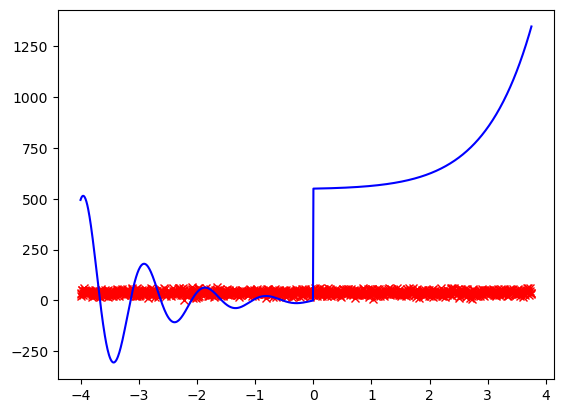

In [12]:
plt.plot(x_test,u_pred,'rx')
plt.plot(x_test,u_true,'b')

In [19]:
import scipy.io as sio
for tune_reps in range(75):
    label = "Regr_disc_rowdy_tune"+str(tune_reps)+".mat"
    data = sio.loadmat(label)
    re = np.array(data["test_re"])
    print(tune_reps," ",np.mean(re[:,-1])<0.067)

0   False
1   False
2   False
3   False
4   False
5   False
6   False
7   False
8   False
9   False
10   False
11   False
12   False
13   False
14   False
15   False
16   False
17   False
18   False
19   True
20   False
21   False
22   False
23   False
24   False
25   False
26   False
27   False
28   False
29   False
30   False
31   False
32   False
33   False
34   False
35   False
36   False
37   False
38   False
39   False
40   False
41   False
42   False
43   False
44   False
45   False
46   False
47   False
48   False
49   False
50   False
51   False
52   False
53   False
54   False
55   False
56   False
57   False
58   False
59   False
60   False
61   False
62   False
63   False
64   False
65   False
66   False
67   False
68   False
69   False
70   False
71   False
72   False
73   False
74   False


In [22]:
lrnr_tune[19]

array([8.e-03, 1.e+01, 2.e+00])